<br>

<br>
<center><font size='10' style="color:orange"><b> Customer Transaction Prediction </b> </font>

<br>

<br>
<center><font size='5' style="color:black"><b> Proyecto Final - Coder House </b> </font>

<br>
<br>

<center><font size='5' style="color:black"><b> Notebook Denise Navarro Quantín </b> </font>

<br>

<br>

<br>

<br>

<font size='6' style="color:orange"><b> Content </b> </font>
<a name="content"></a>
<br>


1. [Introduction](#introduction) 
<br>

2. [Import Libraries](#libraries) 
<br>

3. [Dataset](#Dataset) 
<br>

4. [Models - Default Parameters](#default)

    4.1 [Logistic Regression](#lgr_default)
    
    4.2 [GaussianNB](#gbn_default)
    
    4.3 [Random Forest Classifier](#rfc_default)
    
    4.4 [K Neighbors Classifier](#knc_default)

    4.5 [XGBoost Classifier](#xgb_default)

    4.6 [Catboost Classifier](#cb_default)

    4.7 [MLP Classifier](#mlp_default)

    4.8 [Linear Discriminant Analysis](#lda_default)

    4.9 [Calibrated Classifier with GaussianNB](#cccv_default)

    4.10 [SGD Classifier](#sgdc_default)
    
    4.11 [Bagging Classifier](#bgc_default)
    
    4.12 [Models with default parameters - Summary](#summary_default)

<br>

5. [Models - PCA](#PCA)

    5.1 [Logistic Regression - PCA](#lgr_pca)
    
    5.2 [K Neighbors Classifier - PCA](#knc_pca)

<br>

6. [Optuna](#optuna)

    6.1 [Logistic Regression - Optuna](#lgr_opt)
    
    6.1.1 [Logistic Regression - PCA 100](#lgr_opt_100)
    
    6.1.2 [Logistic Regression - PCA 175](#lgr_opt_175)
    
    6.1.3 [Logistic Regression - Full Dataset](#lgr_opt_full)
    
    6.2 [K Neighbors Classifier - Optuna](#knc_opt)

    6.1.2 [K Neighbors Classifier - PCA 175](#knc_opt_175)

<br>

7. [Model Stacking](#stacking)
    
    7.1 [GaussianNB x 3](#ensemble_2)
    
    7.2 [GaussianNB x 6](#ensemble_3)
    
    7.3 [GaussianNB x 12](#ensemble_4)
    
    7.4 [GaussianNB x 24](#ensemble_5)
    
    7.5 [GaussianNB + Logistic Regression (Final GaussianNB)](#ensemble_6)
    
    7.6 [Logistic Regression + GaussianNB (Final Logistic Regression)](#ensemble_7)
    
    7.7 [Logistic Regression + Catboost Classifier (Final Catboost Classifier)](#ensemble_8)
    
    7.8 [Logistic Regression + Catboost Classifier + GaussianNB (Final GaussianNB)](#ensemble_9)
  
    7.9 [Logistic Regression + Catboost Classifier (opt) + GaussianNB + K Neighbors Classifier (opt) (Final GaussianNB)](#ensemble_10)
    
    7.10 [GaussianNB + Logistict Regression + Calibrated Classifier CV (Final GaussianNB)](#ensemble_11)
    
    7.11 [GaussianNB + Linear Discriminant Analysis (Final GaussianNB)](#ensemble_12)
    
    7.12 [GaussianNB + Logistict Regression + Linear Discriminant Analysis (Final GaussianNB)](#ensemble_13)
    
    7.13 [GaussianNB + XGBoost Classifier + Logistic Regression (Final GaussianNB)](#ensemble_14)
    
    7.14 [GaussianNB X 6 + Linear Discriminant Analysis (Final GaussianNB)](#ensemble_15)
    
    7.15 [Model Stacking - Summary](#summary_stacking)



<br>

<br>

<br>

<br>

<font size='6' style="color:orange">  <b> Introduction </b> </font>
<a name="introduction"></a>

[[ Back to Top ]](#content)

<p style='text-align: justify;'> 
Para realizar el Proyecto hemos dividido el trabajo en una fase individual y otra grupal. El objetivo de la fase de trabajo individual es explorar los distintos modelos, de forma tal que podamos ver cuáles son los que tienen mejor rendimiento. Luego continuaremos el trabajo grupal en una notebook común, donde solamente se encontrarán los modelos más relevantes para el Proyecto. 

<p style='text-align: justify;'> 
En lo que respecta a la fase de trabajo individual, el primer paso será analizar distintos modelos de clasificación con los hiperparámetros que vienen por default, de forma tal que podamos ver cuáles son los que brindan mejores métricas, siempre teniendo en cuenta que a su vez mantengan un equilibrio con el costo del modelo. 
<p style='text-align: justify;'>     
Luego realizaremos una reducción de dimensionalidad utilizando PCA en algunos modelos. El PCA resulta de mucha utilidad en la presencia de modelos con gran cantidad de variables como este ya que permitiría disminuir el costo de los mismos. Es por ello que resulta interesante observar de qué manera se comportan algunos modelos ante la reducción de dimensionalidad.
<p style='text-align: justify;'> 
Posteriormente se utilizará la librería Optuna para hallar los hiperparámetros de los modelos que nos permitan obtener mejores resultados. Debido a que el dataset con el que trabajamos resulta muy grande, trabajaremos en Optuna con reducción de dimensionalidad (utilizando PCA), de forma tal que podamos disminuir los tiempos de ejecución de la optimización. Luego analizaremos si resulta viable extrapolar los hiperparámetros optimizados al full dataset.
<p style='text-align: justify;'> 
Finalmente haremos stacking de modelos de forma tal que podamos obtener como resultado un modelo superior, buscando el que permita obtener la mejor relación entre el recall y el costo. En esta etapa resulta importante comparar los resultados de los modelos de ensamble con los de los modelos simples.
    
</p>

<br>

<br>

<br>

<br>

<font size='6' style="color:orange">  <b> Import Libraries </b> </font>
<a name="libraries"></a>

[[ Back to Top ]](#content)

In [3]:
# Numeric, scientific and data science libraries
import pandas as pd
import numpy as np
from scipy.stats import gmean
from statistics import geometric_mean
import pickle

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from PIL import Image

# Data preparation for training - Sklearn
from sklearn.model_selection import StratifiedKFold
from sklearn.decomposition import PCA

# Evaluation metrics and visualization - Sklearn
from sklearn.metrics import recall_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import precision_score
from sklearn.metrics import f1_score 

# Models from Sklearn, XGBOOST and Catboost
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from catboost import CatBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.datasets import make_classification
from sklearn.ensemble import BaggingClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.calibration import CalibratedClassifierCV
from sklearn.ensemble import StackingClassifier

# Feature Importance
from sklearn.inspection import permutation_importance

# Bayesian Optimization
import optuna

# Others
import joblib
import time
from numpy import load
from numpy import save
from typing import List
from scipy.stats import gmean

<br>

<br>

<br>

<br>

<font size='6' style="color:orange">  <b> Dataset </b> </font>
<a name="Dataset"></a>

[[ Back to Top ]](#content)

In [4]:
# Se abre el archivo
df = pd.read_csv('Santander_train.csv', index_col="ID_code")
df.head()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
ID_code,,,,,,,,,,,,,,,,,,,,,
train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,-4.9200,...,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,3.1468,...,7.6421,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
train_2,0,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,-4.9193,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
train_3,0,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,-5.8609,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
train_4,0,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,6.2654,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104


In [3]:
# Se revisa de manera general la forma en la que se comportan todas las variables del dataset
df.describe()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
count,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,...,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000
mean,0.100490,10.679914,-1.627622,10.715192,6.796529,11.078333,-5.065317,5.408949,16.545850,0.284162,...,3.234440,7.438408,1.927839,3.331774,17.993784,-0.142088,2.303335,8.908158,15.870720,-3.326537
std,0.300653,3.040051,4.050044,2.640894,2.043319,1.623150,7.863267,0.866607,3.418076,3.332634,...,4.559922,3.023272,1.478423,3.992030,3.135162,1.429372,5.454369,0.921625,3.010945,10.438015
min,0.000000,0.408400,-15.043400,2.117100,-0.040200,5.074800,-32.562600,2.347300,5.349700,-10.505500,...,-14.093300,-2.691700,-3.814500,-11.783400,8.694400,-5.261000,-14.209600,5.960600,6.299300,-38.852800
25%,0.000000,8.453850,-4.740025,8.722475,5.254075,9.883175,-11.200350,4.767700,13.943800,-2.317800,...,-0.058825,5.157400,0.889775,0.584600,15.629800,-1.170700,-1.946925,8.252800,13.829700,-11.208475
50%,0.000000,10.524750,-1.608050,10.580000,6.825000,11.108250,-4.833150,5.385100,16.456800,0.393700,...,3.203600,7.347750,1.901300,3.396350,17.957950,-0.172700,2.408900,8.888200,15.934050,-2.819550
75%,0.000000,12.758200,1.358625,12.516700,8.324100,12.261125,0.924800,6.003000,19.102900,2.937900,...,6.406200,9.512525,2.949500,6.205800,20.396525,0.829600,6.556725,9.593300,18.064725,4.836800
max,1.000000,20.315000,10.376800,19.353000,13.188300,16.671400,17.251600,8.447700,27.691800,10.151300,...,18.440900,16.716500,8.402400,18.281800,27.928800,4.272900,18.321500,12.000400,26.079100,28.500700


<br>

<font size='4' style="color:orange">  <b> Definition of X and y </b> </font>

In [5]:
# Se separa en X e y
X = df.drop("target", axis=1) # Se elimina del dataset la variable a predecir
y = df.target # Se define el Target 

In [6]:
X

,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
ID_code,,,,,,,,,,,,,,,,,,,,,
train_0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,-4.9200,5.7470,...,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
train_1,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,3.1468,8.0851,...,7.6421,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
train_2,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,-4.9193,5.9525,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
train_3,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,-5.8609,8.2450,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
train_4,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,6.2654,7.6784,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
train_199995,11.4880,-0.4956,8.2622,3.5142,10.3404,11.6081,5.6709,15.1516,-0.6209,5.6669,...,6.1415,13.2305,3.9901,0.9388,18.0249,-1.7939,2.1661,8.5326,16.6660,-17.8661
train_199996,4.9149,-2.4484,16.7052,6.6345,8.3096,-10.5628,5.8802,21.5940,-3.6797,6.0019,...,4.9611,4.6549,0.6998,1.8341,22.2717,1.7337,-2.1651,6.7419,15.9054,0.3388
train_199997,11.2232,-5.0518,10.5127,5.6456,9.3410,-5.4086,4.5555,21.5571,0.1202,6.1629,...,4.0651,5.4414,3.1032,4.8793,23.5311,-1.5736,1.2832,8.7155,13.8329,4.1995


In [7]:
y

ID_code
train_0         0
train_1         0
train_2         0
train_3         0
train_4         0
               ..
train_199995    0
train_199996    0
train_199997    0
train_199998    0
train_199999    0
Name: target, Length: 200000, dtype: int64

<br>

<br>

<br>

<br>

<font size='6' style="color:orange">  <b> Models - Default Parameters </b> </font>
<a name="default"></a>

[[ Back to Top ]](#content)

En este apartado se buscarán algunos modelos de clasificación con los parámetros default, de forma tal que podamos ver cuáles nos serán más útiles para utilizar en el futuro. Los modelos empleados son los siguientes:

- Logistic Regression
- GaussianNB
- Random forest
- K Neighbors Classifier
- XGBoost Classifier
- Catboost Classifier 
- MLP Classifier 
- Linear Discriminant Analysis 
- Calibrated Classifier with GaussianNB 
- SGD Classifier
- Bagging Classifier 


<br>

<br>

<font size='5' style="color:orange">  <b> Logistic Regression - Default </b> </font>
<a name="lgr_default"></a>

[[ Back to Top ]](#content)

In [25]:
# Logistic Regression - Full dataset

# Cabe aclarar que en la regresión logística no se utilizó el parámetro max_iter default ya que arrojaba un error.
# Es por ello que se ha definido el max_iter = 7000. Sin embargo, no se realizó una optimización de hiperparámetros para 
# elegir este max_iter.

lgr = LogisticRegression(max_iter = 7000)


skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

lgr_full_results    = []
lgr_full_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    lgr.fit(X_train, y_train)
    
    y_pred = lgr.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    lgr_full_results.append(list_results)
    lgr_full_results_cm.append(list_cm)

In [28]:
filas    = ['LogisticRegression_full']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(lgr_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
LogisticRegression_full,0.68548,0.269483,0.386856


In [32]:
# Tiempo expresado en segundos
resultados['TIEMPO']= 1081
resultados

,PRECISION,RECALL,F1,TIEMPO
LogisticRegression_full,0.68548,0.269483,0.386856,1081


In [260]:
resultados.to_pickle("resultados_lgr_full.pkl")

In [34]:
resultados_cm = gmean(lgr_full_results_cm)
resultados_cm 

array([[[17741.69449217,   248.10252564],
        [ 1467.9280316 ,   541.60745703]]])

In [42]:
 with open('resultados_lgr_full_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

In [632]:
with open('resultados_lgr_full_cm.pkl','rb') as f:
        resultados_cm = pickle.load(f)

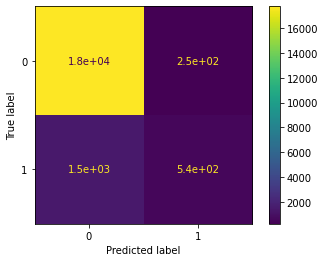

In [631]:
cm_display_lgr_full = ConfusionMatrixDisplay(confusion_matrix = resultados_cm.reshape(2,2), display_labels = [0, 1])
cm_display_lgr_full.plot()
plt.show()

<br>

<br>

<font size='5' style="color:orange">  <b> GaussianNB - Default </b> </font>
<a name="gbn_default"></a>

[[ Back to Top ]](#content)

In [46]:
# GaussianNB - Full dataset

gnb = GaussianNB()

skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

gnb_full_results    = []
gnb_full_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    gnb.fit(X_train, y_train)
    
    y_pred = gnb.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    gnb_full_results.append(list_results)
    gnb_full_results_cm.append(list_cm)

In [49]:
filas    = ['GaussianNB_full']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(gnb_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
GaussianNB_full,0.647487,0.403787,0.497367


In [51]:
# Tiempo expresado en segundos
resultados['TIEMPO']= 6.07
resultados

,PRECISION,RECALL,F1,TIEMPO
GaussianNB_full,0.647487,0.403787,0.497367,6.07


In [52]:
resultados.to_pickle("resultados_gnb_full.pkl")

In [53]:
resultados_cm= gmean(gnb_full_results_cm)
resultados_cm 

array([[[17548.37388377,   440.75391567],
        [ 1197.81284369,   811.53110098]]])

In [54]:
 with open('resultados_gnb_full_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

In [648]:
with open('resultados_gnb_full_cm.pkl','rb') as f:
        resultados_cm = pickle.load(f)

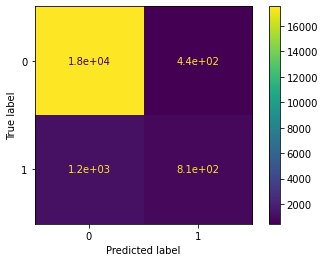

In [649]:
cm_display_lgr_full = ConfusionMatrixDisplay(confusion_matrix = resultados_cm.reshape(2,2), display_labels = [0, 1])
cm_display_lgr_full.plot()
plt.show()

<br>

<br>

<font size='5' style="color:orange">  <b> Random Forest Classifier - Default </b> </font>
<a name="rfc_default"></a>

[[ Back to Top ]](#content)

In [57]:
# RandomForestClassifier - Full dataset

rfc = RandomForestClassifier()

skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

rfc_full_results    = []
rfc_full_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    rfc.fit(X_train, y_train)
    
    y_pred = rfc.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    results_list    = [precision, recall, f1]
    cm_list = [cm]
    rfc_full_results.append(results_list)
    rfc_full_results_cm.append(cm_list)

C:\Users\denun\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denun\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denun\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\denun\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precis

In [60]:
filas    = ['RandomForestClassifier_full']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(rfc_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
RandomForestClassifier_full,0.0,0.0,0.0


In [62]:
# Tiempo expresado en segundos
resultados['TIEMPO']= 5978
resultados

,PRECISION,RECALL,F1,TIEMPO
RandomForestClassifier_full,0.0,0.0,0.0,5978


In [63]:
resultados.to_pickle("resultados_rfc_full.pkl")

In [64]:
resultados_cm = gmean(rfc_full_results_cm)
resultados_cm 

C:\Users\denun\miniconda3\lib\site-packages\scipy\stats\_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
  log_a = np.log(np.array(a, dtype=dtype))


array([[[17990.19999555,     0.        ],
        [ 2009.69994775,     0.        ]]])

In [65]:
 with open('resultados_rfc_full_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> K Neighbors Classifier - Default </b> </font>
<a name="knc_default"></a>

[[ Back to Top ]](#content)

In [247]:
# KNeighborsClassifier - Full dataset

knc = KNeighborsClassifier()
    
skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

knc_full_results    = []
knc_full_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    knc.fit(X_train, y_train)
    
    y_pred = knc.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    knc_full_results.append(list_results)
    knc_full_results_cm.append(list_cm)

In [250]:
filas    = ['KNeighborsClassifier_full']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(knc_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
KNeighborsClassifier_full,0.223142,0.003169,0.006247


In [252]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = 781
resultados

,PRECISION,RECALL,F1,TIEMPO
KNeighborsClassifier_full,0.223142,0.003169,0.006247,781


In [253]:
resultados.to_pickle("resultados_knc_full.pkl")

In [254]:
resultados_cm = gmean(knc_full_results_cm)
resultados_cm 

array([[[1.79686995e+04, 2.10021668e+01],
        [2.00229720e+03, 6.36867140e+00]]])

In [255]:
 with open('resultados_knc_full_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> XGBoost Classifier - Default </b> </font>
<a name="xgb_default"></a>

[[ Back to Top ]](#content)

In [219]:
# XGB Classifier - Full dataset

xgb = XGBClassifier()
    
skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

xgb_full_results    = []
xgb_full_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    xgb.fit(X_train, y_train)
    
    y_pred = xgb.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    xgb_full_results.append(list_results)
    xgb_full_results_cm.append(list_cm)

In [222]:
filas    = ['XGBoost_full']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(xgb_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
XGBoost_full,0.693811,0.247841,0.365173


In [224]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = 1493
resultados

,PRECISION,RECALL,F1,TIEMPO
XGBoost_full,0.693811,0.247841,0.365173,1493


In [225]:
resultados.to_pickle("resultados_xgb_full.pkl")

In [226]:
resultados_cm = gmean(xgb_full_results_cm)
resultados_cm 

array([[[17770.3980353 ,   219.63054203],
        [ 1511.03421725,   498.11093953]]])

In [227]:
 with open('resultados_xgb_full_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> Catboost Classifier - Default </b> </font>
<a name="cb_default"></a>

[[ Back to Top ]](#content)

In [256]:
# Catboost Classifier - Full dataset

cb = CatBoostClassifier()
    
skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

cb_full_results    = []
cb_full_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    cb.fit(X_train, y_train)
    
    y_pred = cb.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    cb_full_results.append(list_results)
    cb_full_results_cm.append(list_cm)


Learning rate set to 0.09461
0:	learn: 0.6142038	total: 221ms	remaining: 3m 41s
1:	learn: 0.5502873	total: 287ms	remaining: 2m 23s
2:	learn: 0.5015346	total: 357ms	remaining: 1m 58s
3:	learn: 0.4635310	total: 421ms	remaining: 1m 44s
4:	learn: 0.4322948	total: 493ms	remaining: 1m 38s
5:	learn: 0.4070403	total: 550ms	remaining: 1m 31s
6:	learn: 0.3867937	total: 606ms	remaining: 1m 25s
7:	learn: 0.3706352	total: 661ms	remaining: 1m 21s
8:	learn: 0.3580597	total: 723ms	remaining: 1m 19s
9:	learn: 0.3479389	total: 783ms	remaining: 1m 17s
10:	learn: 0.3398434	total: 837ms	remaining: 1m 15s
11:	learn: 0.3322477	total: 890ms	remaining: 1m 13s
12:	learn: 0.3264440	total: 941ms	remaining: 1m 11s
13:	learn: 0.3212962	total: 1s	remaining: 1m 10s
14:	learn: 0.3171745	total: 1.05s	remaining: 1m 9s
15:	learn: 0.3136426	total: 1.1s	remaining: 1m 7s
16:	learn: 0.3104751	total: 1.15s	remaining: 1m 6s
17:	learn: 0.3078731	total: 1.2s	remaining: 1m 5s
18:	learn: 0.3055370	total: 1.25s	remaining: 1m 4s
19:

163:	learn: 0.2308516	total: 9.7s	remaining: 49.4s
164:	learn: 0.2306189	total: 9.75s	remaining: 49.4s
165:	learn: 0.2303548	total: 9.81s	remaining: 49.3s
166:	learn: 0.2301090	total: 9.86s	remaining: 49.2s
167:	learn: 0.2298659	total: 9.92s	remaining: 49.1s
168:	learn: 0.2296394	total: 9.97s	remaining: 49s
169:	learn: 0.2294082	total: 10s	remaining: 48.9s
170:	learn: 0.2291841	total: 10.1s	remaining: 48.9s
171:	learn: 0.2289364	total: 10.1s	remaining: 48.8s
172:	learn: 0.2287056	total: 10.2s	remaining: 48.7s
173:	learn: 0.2284449	total: 10.2s	remaining: 48.6s
174:	learn: 0.2282165	total: 10.3s	remaining: 48.5s
175:	learn: 0.2280002	total: 10.3s	remaining: 48.4s
176:	learn: 0.2277399	total: 10.4s	remaining: 48.4s
177:	learn: 0.2275053	total: 10.5s	remaining: 48.4s
178:	learn: 0.2272979	total: 10.5s	remaining: 48.3s
179:	learn: 0.2270767	total: 10.6s	remaining: 48.2s
180:	learn: 0.2268469	total: 10.6s	remaining: 48.1s
181:	learn: 0.2266316	total: 10.7s	remaining: 48s
182:	learn: 0.22640

324:	learn: 0.2032764	total: 18.8s	remaining: 39.1s
325:	learn: 0.2031677	total: 18.9s	remaining: 39s
326:	learn: 0.2030588	total: 18.9s	remaining: 39s
327:	learn: 0.2029347	total: 19s	remaining: 38.9s
328:	learn: 0.2028085	total: 19s	remaining: 38.8s
329:	learn: 0.2026965	total: 19.1s	remaining: 38.8s
330:	learn: 0.2025661	total: 19.1s	remaining: 38.7s
331:	learn: 0.2024338	total: 19.2s	remaining: 38.6s
332:	learn: 0.2023132	total: 19.3s	remaining: 38.6s
333:	learn: 0.2022004	total: 19.3s	remaining: 38.5s
334:	learn: 0.2020762	total: 19.4s	remaining: 38.4s
335:	learn: 0.2019654	total: 19.4s	remaining: 38.4s
336:	learn: 0.2018397	total: 19.5s	remaining: 38.3s
337:	learn: 0.2017325	total: 19.5s	remaining: 38.2s
338:	learn: 0.2016174	total: 19.6s	remaining: 38.2s
339:	learn: 0.2014878	total: 19.6s	remaining: 38.1s
340:	learn: 0.2013604	total: 19.7s	remaining: 38.1s
341:	learn: 0.2012432	total: 19.7s	remaining: 38s
342:	learn: 0.2011109	total: 19.8s	remaining: 37.9s
343:	learn: 0.2009930	

484:	learn: 0.1867607	total: 28.3s	remaining: 30.1s
485:	learn: 0.1866770	total: 28.4s	remaining: 30s
486:	learn: 0.1865926	total: 28.4s	remaining: 30s
487:	learn: 0.1865167	total: 28.5s	remaining: 29.9s
488:	learn: 0.1864231	total: 28.6s	remaining: 29.9s
489:	learn: 0.1863288	total: 28.6s	remaining: 29.8s
490:	learn: 0.1862551	total: 28.7s	remaining: 29.7s
491:	learn: 0.1861638	total: 28.8s	remaining: 29.7s
492:	learn: 0.1860791	total: 28.8s	remaining: 29.6s
493:	learn: 0.1859942	total: 28.9s	remaining: 29.6s
494:	learn: 0.1859187	total: 28.9s	remaining: 29.5s
495:	learn: 0.1858380	total: 29s	remaining: 29.5s
496:	learn: 0.1857576	total: 29.1s	remaining: 29.4s
497:	learn: 0.1856768	total: 29.1s	remaining: 29.4s
498:	learn: 0.1855888	total: 29.2s	remaining: 29.3s
499:	learn: 0.1855075	total: 29.3s	remaining: 29.3s
500:	learn: 0.1854214	total: 29.3s	remaining: 29.2s
501:	learn: 0.1853293	total: 29.4s	remaining: 29.1s
502:	learn: 0.1852444	total: 29.4s	remaining: 29.1s
503:	learn: 0.1851

644:	learn: 0.1745316	total: 38.6s	remaining: 21.3s
645:	learn: 0.1744701	total: 38.7s	remaining: 21.2s
646:	learn: 0.1743927	total: 38.8s	remaining: 21.1s
647:	learn: 0.1743089	total: 38.8s	remaining: 21.1s
648:	learn: 0.1742425	total: 38.9s	remaining: 21s
649:	learn: 0.1741921	total: 38.9s	remaining: 21s
650:	learn: 0.1741049	total: 39s	remaining: 20.9s
651:	learn: 0.1740426	total: 39s	remaining: 20.8s
652:	learn: 0.1739703	total: 39.1s	remaining: 20.8s
653:	learn: 0.1739081	total: 39.1s	remaining: 20.7s
654:	learn: 0.1738384	total: 39.2s	remaining: 20.6s
655:	learn: 0.1737571	total: 39.2s	remaining: 20.6s
656:	learn: 0.1736926	total: 39.3s	remaining: 20.5s
657:	learn: 0.1736270	total: 39.3s	remaining: 20.4s
658:	learn: 0.1735605	total: 39.4s	remaining: 20.4s
659:	learn: 0.1734865	total: 39.4s	remaining: 20.3s
660:	learn: 0.1734095	total: 39.5s	remaining: 20.3s
661:	learn: 0.1733406	total: 39.6s	remaining: 20.2s
662:	learn: 0.1732736	total: 39.6s	remaining: 20.1s
663:	learn: 0.173215

804:	learn: 0.1644805	total: 47.3s	remaining: 11.4s
805:	learn: 0.1644272	total: 47.3s	remaining: 11.4s
806:	learn: 0.1643749	total: 47.4s	remaining: 11.3s
807:	learn: 0.1643157	total: 47.4s	remaining: 11.3s
808:	learn: 0.1642647	total: 47.5s	remaining: 11.2s
809:	learn: 0.1642073	total: 47.5s	remaining: 11.2s
810:	learn: 0.1641522	total: 47.6s	remaining: 11.1s
811:	learn: 0.1640929	total: 47.7s	remaining: 11s
812:	learn: 0.1640352	total: 47.7s	remaining: 11s
813:	learn: 0.1639790	total: 47.8s	remaining: 10.9s
814:	learn: 0.1639288	total: 47.8s	remaining: 10.9s
815:	learn: 0.1638703	total: 47.9s	remaining: 10.8s
816:	learn: 0.1638278	total: 47.9s	remaining: 10.7s
817:	learn: 0.1637740	total: 48s	remaining: 10.7s
818:	learn: 0.1637200	total: 48s	remaining: 10.6s
819:	learn: 0.1636733	total: 48.1s	remaining: 10.6s
820:	learn: 0.1636052	total: 48.2s	remaining: 10.5s
821:	learn: 0.1635383	total: 48.2s	remaining: 10.4s
822:	learn: 0.1634809	total: 48.3s	remaining: 10.4s
823:	learn: 0.163429

963:	learn: 0.1559171	total: 56.8s	remaining: 2.12s
964:	learn: 0.1558601	total: 56.9s	remaining: 2.06s
965:	learn: 0.1558119	total: 56.9s	remaining: 2s
966:	learn: 0.1557762	total: 57s	remaining: 1.94s
967:	learn: 0.1557199	total: 57s	remaining: 1.89s
968:	learn: 0.1556710	total: 57.1s	remaining: 1.82s
969:	learn: 0.1556132	total: 57.1s	remaining: 1.77s
970:	learn: 0.1555623	total: 57.2s	remaining: 1.71s
971:	learn: 0.1555170	total: 57.2s	remaining: 1.65s
972:	learn: 0.1554723	total: 57.3s	remaining: 1.59s
973:	learn: 0.1554254	total: 57.4s	remaining: 1.53s
974:	learn: 0.1553786	total: 57.4s	remaining: 1.47s
975:	learn: 0.1553227	total: 57.5s	remaining: 1.41s
976:	learn: 0.1552658	total: 57.5s	remaining: 1.35s
977:	learn: 0.1552054	total: 57.6s	remaining: 1.29s
978:	learn: 0.1551523	total: 57.7s	remaining: 1.24s
979:	learn: 0.1551046	total: 57.7s	remaining: 1.18s
980:	learn: 0.1550522	total: 57.8s	remaining: 1.12s
981:	learn: 0.1550205	total: 57.8s	remaining: 1.06s
982:	learn: 0.15496

123:	learn: 0.2427263	total: 6.81s	remaining: 48.1s
124:	learn: 0.2424247	total: 6.86s	remaining: 48s
125:	learn: 0.2421367	total: 6.91s	remaining: 47.9s
126:	learn: 0.2418456	total: 6.97s	remaining: 47.9s
127:	learn: 0.2415343	total: 7.04s	remaining: 47.9s
128:	learn: 0.2412158	total: 7.1s	remaining: 47.9s
129:	learn: 0.2409249	total: 7.14s	remaining: 47.8s
130:	learn: 0.2406611	total: 7.19s	remaining: 47.7s
131:	learn: 0.2403730	total: 7.25s	remaining: 47.7s
132:	learn: 0.2400949	total: 7.3s	remaining: 47.6s
133:	learn: 0.2398006	total: 7.35s	remaining: 47.5s
134:	learn: 0.2394865	total: 7.4s	remaining: 47.4s
135:	learn: 0.2391999	total: 7.46s	remaining: 47.4s
136:	learn: 0.2389197	total: 7.51s	remaining: 47.3s
137:	learn: 0.2386208	total: 7.56s	remaining: 47.2s
138:	learn: 0.2383470	total: 7.61s	remaining: 47.1s
139:	learn: 0.2380618	total: 7.67s	remaining: 47.1s
140:	learn: 0.2377824	total: 7.73s	remaining: 47.1s
141:	learn: 0.2374985	total: 7.79s	remaining: 47.1s
142:	learn: 0.237

285:	learn: 0.2092061	total: 15.9s	remaining: 39.8s
286:	learn: 0.2090745	total: 16s	remaining: 39.7s
287:	learn: 0.2089421	total: 16.1s	remaining: 39.7s
288:	learn: 0.2087947	total: 16.1s	remaining: 39.7s
289:	learn: 0.2086420	total: 16.2s	remaining: 39.6s
290:	learn: 0.2084879	total: 16.2s	remaining: 39.6s
291:	learn: 0.2083436	total: 16.3s	remaining: 39.5s
292:	learn: 0.2082047	total: 16.4s	remaining: 39.5s
293:	learn: 0.2080699	total: 16.4s	remaining: 39.4s
294:	learn: 0.2079391	total: 16.5s	remaining: 39.4s
295:	learn: 0.2078101	total: 16.5s	remaining: 39.3s
296:	learn: 0.2076733	total: 16.6s	remaining: 39.2s
297:	learn: 0.2075273	total: 16.6s	remaining: 39.2s
298:	learn: 0.2073887	total: 16.7s	remaining: 39.1s
299:	learn: 0.2072521	total: 16.7s	remaining: 39.1s
300:	learn: 0.2071279	total: 16.8s	remaining: 39s
301:	learn: 0.2069864	total: 16.9s	remaining: 39s
302:	learn: 0.2068520	total: 16.9s	remaining: 38.9s
303:	learn: 0.2067215	total: 17s	remaining: 38.9s
304:	learn: 0.206595

445:	learn: 0.1908627	total: 25.3s	remaining: 31.4s
446:	learn: 0.1907573	total: 25.3s	remaining: 31.4s
447:	learn: 0.1906624	total: 25.4s	remaining: 31.3s
448:	learn: 0.1905816	total: 25.4s	remaining: 31.2s
449:	learn: 0.1904980	total: 25.5s	remaining: 31.2s
450:	learn: 0.1904000	total: 25.6s	remaining: 31.1s
451:	learn: 0.1903025	total: 25.6s	remaining: 31.1s
452:	learn: 0.1902050	total: 25.7s	remaining: 31s
453:	learn: 0.1901150	total: 25.7s	remaining: 31s
454:	learn: 0.1900240	total: 25.8s	remaining: 30.9s
455:	learn: 0.1899339	total: 25.9s	remaining: 30.9s
456:	learn: 0.1898435	total: 25.9s	remaining: 30.8s
457:	learn: 0.1897531	total: 26s	remaining: 30.7s
458:	learn: 0.1896677	total: 26s	remaining: 30.7s
459:	learn: 0.1895684	total: 26.1s	remaining: 30.6s
460:	learn: 0.1894790	total: 26.2s	remaining: 30.6s
461:	learn: 0.1893851	total: 26.2s	remaining: 30.5s
462:	learn: 0.1892900	total: 26.3s	remaining: 30.5s
463:	learn: 0.1891981	total: 26.4s	remaining: 30.5s
464:	learn: 0.189130

604:	learn: 0.1779652	total: 34.6s	remaining: 22.6s
605:	learn: 0.1778935	total: 34.6s	remaining: 22.5s
606:	learn: 0.1778235	total: 34.7s	remaining: 22.5s
607:	learn: 0.1777568	total: 34.7s	remaining: 22.4s
608:	learn: 0.1776788	total: 34.8s	remaining: 22.4s
609:	learn: 0.1775837	total: 34.9s	remaining: 22.3s
610:	learn: 0.1775211	total: 34.9s	remaining: 22.2s
611:	learn: 0.1774495	total: 35s	remaining: 22.2s
612:	learn: 0.1773694	total: 35s	remaining: 22.1s
613:	learn: 0.1772896	total: 35.1s	remaining: 22.1s
614:	learn: 0.1772214	total: 35.2s	remaining: 22s
615:	learn: 0.1771489	total: 35.2s	remaining: 22s
616:	learn: 0.1770772	total: 35.3s	remaining: 21.9s
617:	learn: 0.1770085	total: 35.4s	remaining: 21.9s
618:	learn: 0.1769272	total: 35.4s	remaining: 21.8s
619:	learn: 0.1768489	total: 35.5s	remaining: 21.7s
620:	learn: 0.1767766	total: 35.5s	remaining: 21.7s
621:	learn: 0.1767032	total: 35.6s	remaining: 21.6s
622:	learn: 0.1766285	total: 35.7s	remaining: 21.6s
623:	learn: 0.176549

765:	learn: 0.1673819	total: 43.9s	remaining: 13.4s
766:	learn: 0.1673138	total: 43.9s	remaining: 13.3s
767:	learn: 0.1672438	total: 44s	remaining: 13.3s
768:	learn: 0.1671815	total: 44.1s	remaining: 13.2s
769:	learn: 0.1671116	total: 44.1s	remaining: 13.2s
770:	learn: 0.1670529	total: 44.2s	remaining: 13.1s
771:	learn: 0.1669881	total: 44.2s	remaining: 13.1s
772:	learn: 0.1669322	total: 44.3s	remaining: 13s
773:	learn: 0.1668780	total: 44.4s	remaining: 13s
774:	learn: 0.1668131	total: 44.4s	remaining: 12.9s
775:	learn: 0.1667517	total: 44.5s	remaining: 12.8s
776:	learn: 0.1666903	total: 44.6s	remaining: 12.8s
777:	learn: 0.1666358	total: 44.6s	remaining: 12.7s
778:	learn: 0.1665840	total: 44.7s	remaining: 12.7s
779:	learn: 0.1665313	total: 44.7s	remaining: 12.6s
780:	learn: 0.1664693	total: 44.8s	remaining: 12.6s
781:	learn: 0.1664163	total: 44.8s	remaining: 12.5s
782:	learn: 0.1663704	total: 44.9s	remaining: 12.4s
783:	learn: 0.1662985	total: 44.9s	remaining: 12.4s
784:	learn: 0.1662

925:	learn: 0.1583097	total: 53.2s	remaining: 4.25s
926:	learn: 0.1582689	total: 53.3s	remaining: 4.2s
927:	learn: 0.1582258	total: 53.3s	remaining: 4.14s
928:	learn: 0.1581788	total: 53.4s	remaining: 4.08s
929:	learn: 0.1581259	total: 53.5s	remaining: 4.02s
930:	learn: 0.1580674	total: 53.5s	remaining: 3.97s
931:	learn: 0.1580057	total: 53.6s	remaining: 3.91s
932:	learn: 0.1579433	total: 53.7s	remaining: 3.85s
933:	learn: 0.1578881	total: 53.8s	remaining: 3.8s
934:	learn: 0.1578303	total: 53.8s	remaining: 3.74s
935:	learn: 0.1577740	total: 53.9s	remaining: 3.69s
936:	learn: 0.1577183	total: 54s	remaining: 3.63s
937:	learn: 0.1576787	total: 54s	remaining: 3.57s
938:	learn: 0.1576360	total: 54.1s	remaining: 3.51s
939:	learn: 0.1575871	total: 54.1s	remaining: 3.46s
940:	learn: 0.1575281	total: 54.2s	remaining: 3.4s
941:	learn: 0.1574773	total: 54.3s	remaining: 3.34s
942:	learn: 0.1574284	total: 54.3s	remaining: 3.28s
943:	learn: 0.1573883	total: 54.4s	remaining: 3.23s
944:	learn: 0.15733

85:	learn: 0.2554491	total: 4.92s	remaining: 52.3s
86:	learn: 0.2550522	total: 4.97s	remaining: 52.2s
87:	learn: 0.2546785	total: 5.02s	remaining: 52.1s
88:	learn: 0.2542706	total: 5.08s	remaining: 52s
89:	learn: 0.2538921	total: 5.13s	remaining: 51.9s
90:	learn: 0.2534733	total: 5.18s	remaining: 51.8s
91:	learn: 0.2530452	total: 5.25s	remaining: 51.8s
92:	learn: 0.2526353	total: 5.31s	remaining: 51.8s
93:	learn: 0.2522648	total: 5.37s	remaining: 51.8s
94:	learn: 0.2518576	total: 5.42s	remaining: 51.6s
95:	learn: 0.2514745	total: 5.48s	remaining: 51.6s
96:	learn: 0.2511097	total: 5.54s	remaining: 51.6s
97:	learn: 0.2507293	total: 5.61s	remaining: 51.6s
98:	learn: 0.2503806	total: 5.67s	remaining: 51.6s
99:	learn: 0.2499884	total: 5.73s	remaining: 51.6s
100:	learn: 0.2496021	total: 5.78s	remaining: 51.4s
101:	learn: 0.2492797	total: 5.83s	remaining: 51.3s
102:	learn: 0.2489093	total: 5.89s	remaining: 51.3s
103:	learn: 0.2485818	total: 5.95s	remaining: 51.2s
104:	learn: 0.2481992	total: 

246:	learn: 0.2144133	total: 14.4s	remaining: 43.9s
247:	learn: 0.2142410	total: 14.5s	remaining: 43.8s
248:	learn: 0.2140683	total: 14.5s	remaining: 43.8s
249:	learn: 0.2139051	total: 14.6s	remaining: 43.8s
250:	learn: 0.2137498	total: 14.6s	remaining: 43.7s
251:	learn: 0.2135706	total: 14.7s	remaining: 43.7s
252:	learn: 0.2134347	total: 14.8s	remaining: 43.6s
253:	learn: 0.2132644	total: 14.8s	remaining: 43.6s
254:	learn: 0.2130995	total: 14.9s	remaining: 43.5s
255:	learn: 0.2129252	total: 15s	remaining: 43.5s
256:	learn: 0.2127630	total: 15s	remaining: 43.5s
257:	learn: 0.2125987	total: 15.1s	remaining: 43.5s
258:	learn: 0.2124475	total: 15.2s	remaining: 43.4s
259:	learn: 0.2122986	total: 15.2s	remaining: 43.4s
260:	learn: 0.2121455	total: 15.3s	remaining: 43.3s
261:	learn: 0.2120004	total: 15.4s	remaining: 43.3s
262:	learn: 0.2118336	total: 15.4s	remaining: 43.2s
263:	learn: 0.2116753	total: 15.5s	remaining: 43.2s
264:	learn: 0.2115256	total: 15.6s	remaining: 43.2s
265:	learn: 0.21

406:	learn: 0.1939016	total: 24.6s	remaining: 35.8s
407:	learn: 0.1938079	total: 24.6s	remaining: 35.7s
408:	learn: 0.1937102	total: 24.7s	remaining: 35.7s
409:	learn: 0.1936058	total: 24.7s	remaining: 35.6s
410:	learn: 0.1935062	total: 24.8s	remaining: 35.5s
411:	learn: 0.1934130	total: 24.9s	remaining: 35.5s
412:	learn: 0.1933213	total: 24.9s	remaining: 35.4s
413:	learn: 0.1932199	total: 25s	remaining: 35.4s
414:	learn: 0.1931285	total: 25.1s	remaining: 35.3s
415:	learn: 0.1930251	total: 25.1s	remaining: 35.3s
416:	learn: 0.1929191	total: 25.2s	remaining: 35.2s
417:	learn: 0.1928118	total: 25.3s	remaining: 35.2s
418:	learn: 0.1927184	total: 25.3s	remaining: 35.1s
419:	learn: 0.1926095	total: 25.4s	remaining: 35.1s
420:	learn: 0.1925170	total: 25.4s	remaining: 35s
421:	learn: 0.1924093	total: 25.5s	remaining: 34.9s
422:	learn: 0.1923043	total: 25.6s	remaining: 34.9s
423:	learn: 0.1921988	total: 25.6s	remaining: 34.8s
424:	learn: 0.1920970	total: 25.7s	remaining: 34.8s
425:	learn: 0.19

566:	learn: 0.1799051	total: 34s	remaining: 26s
567:	learn: 0.1798399	total: 34.1s	remaining: 25.9s
568:	learn: 0.1797646	total: 34.2s	remaining: 25.9s
569:	learn: 0.1796834	total: 34.2s	remaining: 25.8s
570:	learn: 0.1796110	total: 34.3s	remaining: 25.8s
571:	learn: 0.1795427	total: 34.3s	remaining: 25.7s
572:	learn: 0.1794746	total: 34.4s	remaining: 25.6s
573:	learn: 0.1793939	total: 34.5s	remaining: 25.6s
574:	learn: 0.1793226	total: 34.5s	remaining: 25.5s
575:	learn: 0.1792587	total: 34.6s	remaining: 25.4s
576:	learn: 0.1791757	total: 34.6s	remaining: 25.4s
577:	learn: 0.1790936	total: 34.7s	remaining: 25.3s
578:	learn: 0.1790177	total: 34.8s	remaining: 25.3s
579:	learn: 0.1789488	total: 34.8s	remaining: 25.2s
580:	learn: 0.1788797	total: 34.9s	remaining: 25.1s
581:	learn: 0.1788045	total: 34.9s	remaining: 25.1s
582:	learn: 0.1787186	total: 35s	remaining: 25s
583:	learn: 0.1786634	total: 35s	remaining: 25s
584:	learn: 0.1785877	total: 35.1s	remaining: 24.9s
585:	learn: 0.1785028	to

727:	learn: 0.1689417	total: 43.7s	remaining: 16.3s
728:	learn: 0.1688768	total: 43.7s	remaining: 16.3s
729:	learn: 0.1688088	total: 43.8s	remaining: 16.2s
730:	learn: 0.1687482	total: 43.8s	remaining: 16.1s
731:	learn: 0.1686840	total: 43.9s	remaining: 16.1s
732:	learn: 0.1686139	total: 44s	remaining: 16s
733:	learn: 0.1685596	total: 44s	remaining: 15.9s
734:	learn: 0.1685050	total: 44.1s	remaining: 15.9s
735:	learn: 0.1684444	total: 44.1s	remaining: 15.8s
736:	learn: 0.1683857	total: 44.2s	remaining: 15.8s
737:	learn: 0.1683337	total: 44.3s	remaining: 15.7s
738:	learn: 0.1682743	total: 44.3s	remaining: 15.7s
739:	learn: 0.1682014	total: 44.4s	remaining: 15.6s
740:	learn: 0.1681396	total: 44.5s	remaining: 15.5s
741:	learn: 0.1680691	total: 44.5s	remaining: 15.5s
742:	learn: 0.1680061	total: 44.6s	remaining: 15.4s
743:	learn: 0.1679376	total: 44.7s	remaining: 15.4s
744:	learn: 0.1678782	total: 44.7s	remaining: 15.3s
745:	learn: 0.1678095	total: 44.8s	remaining: 15.3s
746:	learn: 0.1677

889:	learn: 0.1594179	total: 53.5s	remaining: 6.61s
890:	learn: 0.1593706	total: 53.6s	remaining: 6.55s
891:	learn: 0.1593134	total: 53.6s	remaining: 6.49s
892:	learn: 0.1592588	total: 53.7s	remaining: 6.43s
893:	learn: 0.1591950	total: 53.7s	remaining: 6.37s
894:	learn: 0.1591412	total: 53.8s	remaining: 6.31s
895:	learn: 0.1590912	total: 53.9s	remaining: 6.25s
896:	learn: 0.1590174	total: 53.9s	remaining: 6.19s
897:	learn: 0.1589675	total: 54s	remaining: 6.13s
898:	learn: 0.1589234	total: 54.1s	remaining: 6.07s
899:	learn: 0.1588775	total: 54.1s	remaining: 6.01s
900:	learn: 0.1588260	total: 54.2s	remaining: 5.95s
901:	learn: 0.1587841	total: 54.2s	remaining: 5.89s
902:	learn: 0.1587222	total: 54.3s	remaining: 5.83s
903:	learn: 0.1586778	total: 54.4s	remaining: 5.77s
904:	learn: 0.1586110	total: 54.4s	remaining: 5.71s
905:	learn: 0.1585629	total: 54.5s	remaining: 5.65s
906:	learn: 0.1585109	total: 54.5s	remaining: 5.59s
907:	learn: 0.1584537	total: 54.6s	remaining: 5.53s
908:	learn: 0.

49:	learn: 0.2742560	total: 2.99s	remaining: 56.8s
50:	learn: 0.2736127	total: 3.05s	remaining: 56.7s
51:	learn: 0.2729680	total: 3.1s	remaining: 56.5s
52:	learn: 0.2723145	total: 3.16s	remaining: 56.4s
53:	learn: 0.2716861	total: 3.22s	remaining: 56.5s
54:	learn: 0.2711235	total: 3.28s	remaining: 56.4s
55:	learn: 0.2705212	total: 3.34s	remaining: 56.4s
56:	learn: 0.2699571	total: 3.4s	remaining: 56.3s
57:	learn: 0.2693478	total: 3.46s	remaining: 56.3s
58:	learn: 0.2687959	total: 3.51s	remaining: 56.1s
59:	learn: 0.2681934	total: 3.57s	remaining: 55.9s
60:	learn: 0.2676953	total: 3.62s	remaining: 55.7s
61:	learn: 0.2671124	total: 3.68s	remaining: 55.7s
62:	learn: 0.2665708	total: 3.74s	remaining: 55.7s
63:	learn: 0.2659971	total: 3.8s	remaining: 55.6s
64:	learn: 0.2654335	total: 3.86s	remaining: 55.6s
65:	learn: 0.2648955	total: 3.92s	remaining: 55.5s
66:	learn: 0.2643477	total: 3.98s	remaining: 55.4s
67:	learn: 0.2638237	total: 4.04s	remaining: 55.4s
68:	learn: 0.2632889	total: 4.1s	r

212:	learn: 0.2204321	total: 12.3s	remaining: 45.5s
213:	learn: 0.2202307	total: 12.4s	remaining: 45.4s
214:	learn: 0.2200440	total: 12.4s	remaining: 45.4s
215:	learn: 0.2198539	total: 12.5s	remaining: 45.3s
216:	learn: 0.2196780	total: 12.5s	remaining: 45.2s
217:	learn: 0.2194851	total: 12.6s	remaining: 45.2s
218:	learn: 0.2192765	total: 12.7s	remaining: 45.1s
219:	learn: 0.2190777	total: 12.7s	remaining: 45.1s
220:	learn: 0.2189032	total: 12.8s	remaining: 45s
221:	learn: 0.2187047	total: 12.8s	remaining: 45s
222:	learn: 0.2185336	total: 12.9s	remaining: 44.9s
223:	learn: 0.2183510	total: 13s	remaining: 44.9s
224:	learn: 0.2181730	total: 13s	remaining: 44.8s
225:	learn: 0.2179871	total: 13.1s	remaining: 44.8s
226:	learn: 0.2178117	total: 13.1s	remaining: 44.7s
227:	learn: 0.2176189	total: 13.2s	remaining: 44.6s
228:	learn: 0.2174402	total: 13.2s	remaining: 44.6s
229:	learn: 0.2172744	total: 13.3s	remaining: 44.5s
230:	learn: 0.2170935	total: 13.4s	remaining: 44.5s
231:	learn: 0.216913

372:	learn: 0.1976740	total: 21.6s	remaining: 36.3s
373:	learn: 0.1975512	total: 21.7s	remaining: 36.2s
374:	learn: 0.1974411	total: 21.7s	remaining: 36.2s
375:	learn: 0.1973213	total: 21.8s	remaining: 36.1s
376:	learn: 0.1972189	total: 21.8s	remaining: 36.1s
377:	learn: 0.1971037	total: 21.9s	remaining: 36s
378:	learn: 0.1969980	total: 21.9s	remaining: 35.9s
379:	learn: 0.1968983	total: 22s	remaining: 35.9s
380:	learn: 0.1967868	total: 22.1s	remaining: 35.8s
381:	learn: 0.1966797	total: 22.1s	remaining: 35.8s
382:	learn: 0.1965711	total: 22.2s	remaining: 35.7s
383:	learn: 0.1964698	total: 22.2s	remaining: 35.7s
384:	learn: 0.1963562	total: 22.3s	remaining: 35.6s
385:	learn: 0.1962329	total: 22.4s	remaining: 35.6s
386:	learn: 0.1961343	total: 22.4s	remaining: 35.5s
387:	learn: 0.1960216	total: 22.5s	remaining: 35.4s
388:	learn: 0.1959090	total: 22.5s	remaining: 35.4s
389:	learn: 0.1957982	total: 22.6s	remaining: 35.4s
390:	learn: 0.1956810	total: 22.7s	remaining: 35.3s
391:	learn: 0.19

531:	learn: 0.1826363	total: 31.4s	remaining: 27.6s
532:	learn: 0.1825536	total: 31.4s	remaining: 27.5s
533:	learn: 0.1824763	total: 31.5s	remaining: 27.5s
534:	learn: 0.1823867	total: 31.5s	remaining: 27.4s
535:	learn: 0.1823082	total: 31.6s	remaining: 27.4s
536:	learn: 0.1822171	total: 31.7s	remaining: 27.3s
537:	learn: 0.1821334	total: 31.7s	remaining: 27.2s
538:	learn: 0.1820557	total: 31.8s	remaining: 27.2s
539:	learn: 0.1819727	total: 31.8s	remaining: 27.1s
540:	learn: 0.1818945	total: 31.9s	remaining: 27.1s
541:	learn: 0.1818265	total: 32s	remaining: 27s
542:	learn: 0.1817422	total: 32s	remaining: 27s
543:	learn: 0.1816651	total: 32.1s	remaining: 26.9s
544:	learn: 0.1815880	total: 32.2s	remaining: 26.9s
545:	learn: 0.1815150	total: 32.2s	remaining: 26.8s
546:	learn: 0.1814229	total: 32.3s	remaining: 26.7s
547:	learn: 0.1813471	total: 32.4s	remaining: 26.7s
548:	learn: 0.1812711	total: 32.4s	remaining: 26.6s
549:	learn: 0.1811975	total: 32.5s	remaining: 26.6s
550:	learn: 0.181116

691:	learn: 0.1713814	total: 40.8s	remaining: 18.2s
692:	learn: 0.1713098	total: 40.9s	remaining: 18.1s
693:	learn: 0.1712439	total: 41s	remaining: 18.1s
694:	learn: 0.1711731	total: 41s	remaining: 18s
695:	learn: 0.1711173	total: 41.1s	remaining: 17.9s
696:	learn: 0.1710436	total: 41.1s	remaining: 17.9s
697:	learn: 0.1709750	total: 41.2s	remaining: 17.8s
698:	learn: 0.1709177	total: 41.3s	remaining: 17.8s
699:	learn: 0.1708528	total: 41.3s	remaining: 17.7s
700:	learn: 0.1707832	total: 41.4s	remaining: 17.6s
701:	learn: 0.1707216	total: 41.4s	remaining: 17.6s
702:	learn: 0.1706595	total: 41.5s	remaining: 17.5s
703:	learn: 0.1705928	total: 41.5s	remaining: 17.5s
704:	learn: 0.1705152	total: 41.6s	remaining: 17.4s
705:	learn: 0.1704523	total: 41.7s	remaining: 17.3s
706:	learn: 0.1703766	total: 41.7s	remaining: 17.3s
707:	learn: 0.1703109	total: 41.8s	remaining: 17.2s
708:	learn: 0.1702469	total: 41.8s	remaining: 17.2s
709:	learn: 0.1701888	total: 41.9s	remaining: 17.1s
710:	learn: 0.1701

850:	learn: 0.1618947	total: 50.9s	remaining: 8.91s
851:	learn: 0.1618403	total: 50.9s	remaining: 8.85s
852:	learn: 0.1617948	total: 51s	remaining: 8.79s
853:	learn: 0.1617434	total: 51.1s	remaining: 8.73s
854:	learn: 0.1616821	total: 51.1s	remaining: 8.67s
855:	learn: 0.1616285	total: 51.2s	remaining: 8.61s
856:	learn: 0.1615731	total: 51.2s	remaining: 8.55s
857:	learn: 0.1615141	total: 51.3s	remaining: 8.49s
858:	learn: 0.1614490	total: 51.4s	remaining: 8.43s
859:	learn: 0.1613872	total: 51.4s	remaining: 8.38s
860:	learn: 0.1613257	total: 51.5s	remaining: 8.32s
861:	learn: 0.1612744	total: 51.6s	remaining: 8.26s
862:	learn: 0.1612273	total: 51.6s	remaining: 8.2s
863:	learn: 0.1611729	total: 51.7s	remaining: 8.14s
864:	learn: 0.1611082	total: 51.8s	remaining: 8.09s
865:	learn: 0.1610447	total: 51.9s	remaining: 8.03s
866:	learn: 0.1609861	total: 52s	remaining: 7.97s
867:	learn: 0.1609334	total: 52s	remaining: 7.91s
868:	learn: 0.1608783	total: 52.1s	remaining: 7.86s
869:	learn: 0.16081

10:	learn: 0.3397098	total: 718ms	remaining: 1m 4s
11:	learn: 0.3326173	total: 775ms	remaining: 1m 3s
12:	learn: 0.3263741	total: 836ms	remaining: 1m 3s
13:	learn: 0.3214446	total: 895ms	remaining: 1m 3s
14:	learn: 0.3170721	total: 955ms	remaining: 1m 2s
15:	learn: 0.3134654	total: 1s	remaining: 1m 1s
16:	learn: 0.3104490	total: 1.06s	remaining: 1m 1s
17:	learn: 0.3078266	total: 1.13s	remaining: 1m 1s
18:	learn: 0.3055784	total: 1.2s	remaining: 1m 2s
19:	learn: 0.3033881	total: 1.27s	remaining: 1m 2s
20:	learn: 0.3014284	total: 1.33s	remaining: 1m 2s
21:	learn: 0.2996163	total: 1.4s	remaining: 1m 2s
22:	learn: 0.2980693	total: 1.46s	remaining: 1m 2s
23:	learn: 0.2966224	total: 1.52s	remaining: 1m 1s
24:	learn: 0.2952576	total: 1.58s	remaining: 1m 1s
25:	learn: 0.2940880	total: 1.64s	remaining: 1m 1s
26:	learn: 0.2929742	total: 1.7s	remaining: 1m 1s
27:	learn: 0.2918673	total: 1.75s	remaining: 1m
28:	learn: 0.2907328	total: 1.81s	remaining: 1m
29:	learn: 0.2896725	total: 1.87s	remaining

175:	learn: 0.2281321	total: 11.4s	remaining: 53.3s
176:	learn: 0.2278982	total: 11.4s	remaining: 53.2s
177:	learn: 0.2276622	total: 11.5s	remaining: 53.1s
178:	learn: 0.2274420	total: 11.6s	remaining: 53s
179:	learn: 0.2272125	total: 11.6s	remaining: 52.9s
180:	learn: 0.2269929	total: 11.7s	remaining: 52.8s
181:	learn: 0.2267810	total: 11.7s	remaining: 52.7s
182:	learn: 0.2265606	total: 11.8s	remaining: 52.6s
183:	learn: 0.2263300	total: 11.9s	remaining: 52.6s
184:	learn: 0.2261013	total: 11.9s	remaining: 52.5s
185:	learn: 0.2258910	total: 12s	remaining: 52.4s
186:	learn: 0.2256639	total: 12s	remaining: 52.4s
187:	learn: 0.2254421	total: 12.1s	remaining: 52.3s
188:	learn: 0.2252286	total: 12.2s	remaining: 52.2s
189:	learn: 0.2250043	total: 12.2s	remaining: 52.2s
190:	learn: 0.2247732	total: 12.3s	remaining: 52.2s
191:	learn: 0.2245719	total: 12.4s	remaining: 52.1s
192:	learn: 0.2243611	total: 12.4s	remaining: 52s
193:	learn: 0.2241603	total: 12.5s	remaining: 52s
194:	learn: 0.2239369	

335:	learn: 0.2019626	total: 21.7s	remaining: 42.8s
336:	learn: 0.2018387	total: 21.7s	remaining: 42.7s
337:	learn: 0.2017154	total: 21.8s	remaining: 42.7s
338:	learn: 0.2015928	total: 21.9s	remaining: 42.6s
339:	learn: 0.2014615	total: 21.9s	remaining: 42.5s
340:	learn: 0.2013358	total: 22s	remaining: 42.5s
341:	learn: 0.2012132	total: 22.1s	remaining: 42.4s
342:	learn: 0.2010832	total: 22.1s	remaining: 42.4s
343:	learn: 0.2009546	total: 22.2s	remaining: 42.3s
344:	learn: 0.2008455	total: 22.3s	remaining: 42.3s
345:	learn: 0.2007301	total: 22.3s	remaining: 42.2s
346:	learn: 0.2006030	total: 22.4s	remaining: 42.1s
347:	learn: 0.2004875	total: 22.4s	remaining: 42s
348:	learn: 0.2003666	total: 22.5s	remaining: 42s
349:	learn: 0.2002399	total: 22.6s	remaining: 41.9s
350:	learn: 0.2001173	total: 22.7s	remaining: 41.9s
351:	learn: 0.1999943	total: 22.7s	remaining: 41.8s
352:	learn: 0.1998843	total: 22.8s	remaining: 41.8s
353:	learn: 0.1997859	total: 22.8s	remaining: 41.7s
354:	learn: 0.1996

494:	learn: 0.1857770	total: 32.1s	remaining: 32.8s
495:	learn: 0.1856852	total: 32.2s	remaining: 32.7s
496:	learn: 0.1855945	total: 32.3s	remaining: 32.7s
497:	learn: 0.1854965	total: 32.3s	remaining: 32.6s
498:	learn: 0.1854222	total: 32.4s	remaining: 32.5s
499:	learn: 0.1853448	total: 32.5s	remaining: 32.5s
500:	learn: 0.1852622	total: 32.5s	remaining: 32.4s
501:	learn: 0.1851783	total: 32.6s	remaining: 32.3s
502:	learn: 0.1850925	total: 32.6s	remaining: 32.2s
503:	learn: 0.1850007	total: 32.7s	remaining: 32.2s
504:	learn: 0.1849141	total: 32.8s	remaining: 32.1s
505:	learn: 0.1848301	total: 32.8s	remaining: 32s
506:	learn: 0.1847489	total: 32.9s	remaining: 32s
507:	learn: 0.1846670	total: 32.9s	remaining: 31.9s
508:	learn: 0.1845854	total: 33s	remaining: 31.8s
509:	learn: 0.1845042	total: 33s	remaining: 31.8s
510:	learn: 0.1844337	total: 33.1s	remaining: 31.7s
511:	learn: 0.1843446	total: 33.2s	remaining: 31.6s
512:	learn: 0.1842481	total: 33.2s	remaining: 31.5s
513:	learn: 0.184164

654:	learn: 0.1735638	total: 42.2s	remaining: 22.2s
655:	learn: 0.1734942	total: 42.3s	remaining: 22.2s
656:	learn: 0.1734182	total: 42.3s	remaining: 22.1s
657:	learn: 0.1733528	total: 42.4s	remaining: 22s
658:	learn: 0.1732856	total: 42.4s	remaining: 22s
659:	learn: 0.1732177	total: 42.5s	remaining: 21.9s
660:	learn: 0.1731532	total: 42.6s	remaining: 21.8s
661:	learn: 0.1730783	total: 42.6s	remaining: 21.8s
662:	learn: 0.1730176	total: 42.7s	remaining: 21.7s
663:	learn: 0.1729451	total: 42.8s	remaining: 21.6s
664:	learn: 0.1728819	total: 42.8s	remaining: 21.6s
665:	learn: 0.1728155	total: 42.9s	remaining: 21.5s
666:	learn: 0.1727557	total: 42.9s	remaining: 21.4s
667:	learn: 0.1726818	total: 43s	remaining: 21.4s
668:	learn: 0.1726241	total: 43.1s	remaining: 21.3s
669:	learn: 0.1725522	total: 43.1s	remaining: 21.2s
670:	learn: 0.1724823	total: 43.2s	remaining: 21.2s
671:	learn: 0.1724034	total: 43.3s	remaining: 21.1s
672:	learn: 0.1723364	total: 43.3s	remaining: 21.1s
673:	learn: 0.1722

814:	learn: 0.1636271	total: 52.6s	remaining: 11.9s
815:	learn: 0.1635660	total: 52.6s	remaining: 11.9s
816:	learn: 0.1635126	total: 52.7s	remaining: 11.8s
817:	learn: 0.1634645	total: 52.8s	remaining: 11.7s
818:	learn: 0.1633992	total: 52.8s	remaining: 11.7s
819:	learn: 0.1633491	total: 52.9s	remaining: 11.6s
820:	learn: 0.1632866	total: 53s	remaining: 11.5s
821:	learn: 0.1632349	total: 53s	remaining: 11.5s
822:	learn: 0.1631817	total: 53.1s	remaining: 11.4s
823:	learn: 0.1631233	total: 53.2s	remaining: 11.4s
824:	learn: 0.1630641	total: 53.3s	remaining: 11.3s
825:	learn: 0.1629992	total: 53.4s	remaining: 11.2s
826:	learn: 0.1629401	total: 53.4s	remaining: 11.2s
827:	learn: 0.1628996	total: 53.5s	remaining: 11.1s
828:	learn: 0.1628552	total: 53.6s	remaining: 11.1s
829:	learn: 0.1627980	total: 53.7s	remaining: 11s
830:	learn: 0.1627477	total: 53.7s	remaining: 10.9s
831:	learn: 0.1626955	total: 53.8s	remaining: 10.9s
832:	learn: 0.1626403	total: 53.9s	remaining: 10.8s
833:	learn: 0.1625

976:	learn: 0.1549810	total: 1m 2s	remaining: 1.48s
977:	learn: 0.1549357	total: 1m 2s	remaining: 1.42s
978:	learn: 0.1548865	total: 1m 3s	remaining: 1.35s
979:	learn: 0.1548251	total: 1m 3s	remaining: 1.29s
980:	learn: 0.1547766	total: 1m 3s	remaining: 1.22s
981:	learn: 0.1547181	total: 1m 3s	remaining: 1.16s
982:	learn: 0.1546829	total: 1m 3s	remaining: 1.09s
983:	learn: 0.1546291	total: 1m 3s	remaining: 1.03s
984:	learn: 0.1545723	total: 1m 3s	remaining: 966ms
985:	learn: 0.1545153	total: 1m 3s	remaining: 902ms
986:	learn: 0.1544633	total: 1m 3s	remaining: 837ms
987:	learn: 0.1544081	total: 1m 3s	remaining: 773ms
988:	learn: 0.1543522	total: 1m 3s	remaining: 708ms
989:	learn: 0.1542989	total: 1m 3s	remaining: 644ms
990:	learn: 0.1542636	total: 1m 3s	remaining: 579ms
991:	learn: 0.1542063	total: 1m 3s	remaining: 515ms
992:	learn: 0.1541537	total: 1m 3s	remaining: 450ms
993:	learn: 0.1541034	total: 1m 3s	remaining: 386ms
994:	learn: 0.1540558	total: 1m 4s	remaining: 322ms
995:	learn: 

139:	learn: 0.2375535	total: 8.53s	remaining: 52.4s
140:	learn: 0.2372848	total: 8.59s	remaining: 52.3s
141:	learn: 0.2369929	total: 8.65s	remaining: 52.3s
142:	learn: 0.2367260	total: 8.71s	remaining: 52.2s
143:	learn: 0.2364537	total: 8.77s	remaining: 52.1s
144:	learn: 0.2361771	total: 8.82s	remaining: 52s
145:	learn: 0.2358962	total: 8.88s	remaining: 52s
146:	learn: 0.2356184	total: 8.94s	remaining: 51.9s
147:	learn: 0.2353631	total: 8.99s	remaining: 51.8s
148:	learn: 0.2350748	total: 9.06s	remaining: 51.7s
149:	learn: 0.2348225	total: 9.11s	remaining: 51.7s
150:	learn: 0.2345214	total: 9.18s	remaining: 51.6s
151:	learn: 0.2342466	total: 9.25s	remaining: 51.6s
152:	learn: 0.2339902	total: 9.31s	remaining: 51.5s
153:	learn: 0.2337291	total: 9.37s	remaining: 51.5s
154:	learn: 0.2334484	total: 9.43s	remaining: 51.4s
155:	learn: 0.2331990	total: 9.48s	remaining: 51.3s
156:	learn: 0.2329555	total: 9.54s	remaining: 51.2s
157:	learn: 0.2326889	total: 9.6s	remaining: 51.1s
158:	learn: 0.232

298:	learn: 0.2067861	total: 18.1s	remaining: 42.4s
299:	learn: 0.2066545	total: 18.1s	remaining: 42.3s
300:	learn: 0.2065078	total: 18.2s	remaining: 42.3s
301:	learn: 0.2063707	total: 18.3s	remaining: 42.3s
302:	learn: 0.2062386	total: 18.3s	remaining: 42.2s
303:	learn: 0.2061079	total: 18.4s	remaining: 42.1s
304:	learn: 0.2059715	total: 18.5s	remaining: 42.1s
305:	learn: 0.2058265	total: 18.5s	remaining: 42s
306:	learn: 0.2057080	total: 18.6s	remaining: 42s
307:	learn: 0.2055690	total: 18.7s	remaining: 41.9s
308:	learn: 0.2054396	total: 18.7s	remaining: 41.9s
309:	learn: 0.2053023	total: 18.8s	remaining: 41.9s
310:	learn: 0.2051745	total: 18.9s	remaining: 41.8s
311:	learn: 0.2050435	total: 18.9s	remaining: 41.7s
312:	learn: 0.2049198	total: 19s	remaining: 41.7s
313:	learn: 0.2047926	total: 19s	remaining: 41.6s
314:	learn: 0.2046518	total: 19.1s	remaining: 41.6s
315:	learn: 0.2045222	total: 19.2s	remaining: 41.5s
316:	learn: 0.2043960	total: 19.2s	remaining: 41.4s
317:	learn: 0.204273

458:	learn: 0.1891328	total: 28s	remaining: 33s
459:	learn: 0.1890379	total: 28.1s	remaining: 33s
460:	learn: 0.1889408	total: 28.2s	remaining: 32.9s
461:	learn: 0.1888495	total: 28.2s	remaining: 32.9s
462:	learn: 0.1887727	total: 28.3s	remaining: 32.8s
463:	learn: 0.1886801	total: 28.4s	remaining: 32.8s
464:	learn: 0.1885816	total: 28.4s	remaining: 32.7s
465:	learn: 0.1884907	total: 28.5s	remaining: 32.7s
466:	learn: 0.1884013	total: 28.6s	remaining: 32.6s
467:	learn: 0.1883020	total: 28.7s	remaining: 32.6s
468:	learn: 0.1882133	total: 28.7s	remaining: 32.5s
469:	learn: 0.1881253	total: 28.8s	remaining: 32.5s
470:	learn: 0.1880408	total: 28.9s	remaining: 32.4s
471:	learn: 0.1879516	total: 28.9s	remaining: 32.4s
472:	learn: 0.1878675	total: 29s	remaining: 32.3s
473:	learn: 0.1877872	total: 29.1s	remaining: 32.3s
474:	learn: 0.1876962	total: 29.2s	remaining: 32.2s
475:	learn: 0.1876037	total: 29.2s	remaining: 32.2s
476:	learn: 0.1875078	total: 29.3s	remaining: 32.2s
477:	learn: 0.187418

620:	learn: 0.1761003	total: 39s	remaining: 23.8s
621:	learn: 0.1760318	total: 39.1s	remaining: 23.8s
622:	learn: 0.1759594	total: 39.2s	remaining: 23.7s
623:	learn: 0.1758869	total: 39.2s	remaining: 23.6s
624:	learn: 0.1758200	total: 39.3s	remaining: 23.6s
625:	learn: 0.1757525	total: 39.4s	remaining: 23.5s
626:	learn: 0.1756801	total: 39.5s	remaining: 23.5s
627:	learn: 0.1756058	total: 39.5s	remaining: 23.4s
628:	learn: 0.1755455	total: 39.6s	remaining: 23.4s
629:	learn: 0.1754772	total: 39.7s	remaining: 23.3s
630:	learn: 0.1754035	total: 39.7s	remaining: 23.2s
631:	learn: 0.1753397	total: 39.8s	remaining: 23.2s
632:	learn: 0.1752822	total: 39.8s	remaining: 23.1s
633:	learn: 0.1751976	total: 39.9s	remaining: 23s
634:	learn: 0.1751206	total: 40s	remaining: 23s
635:	learn: 0.1750435	total: 40s	remaining: 22.9s
636:	learn: 0.1749721	total: 40.1s	remaining: 22.9s
637:	learn: 0.1749015	total: 40.2s	remaining: 22.8s
638:	learn: 0.1748261	total: 40.2s	remaining: 22.7s
639:	learn: 0.1747560	

782:	learn: 0.1658338	total: 49.3s	remaining: 13.7s
783:	learn: 0.1657721	total: 49.3s	remaining: 13.6s
784:	learn: 0.1657034	total: 49.4s	remaining: 13.5s
785:	learn: 0.1656384	total: 49.5s	remaining: 13.5s
786:	learn: 0.1655854	total: 49.5s	remaining: 13.4s
787:	learn: 0.1655312	total: 49.6s	remaining: 13.3s
788:	learn: 0.1654743	total: 49.6s	remaining: 13.3s
789:	learn: 0.1653989	total: 49.7s	remaining: 13.2s
790:	learn: 0.1653471	total: 49.8s	remaining: 13.1s
791:	learn: 0.1652921	total: 49.8s	remaining: 13.1s
792:	learn: 0.1652444	total: 49.9s	remaining: 13s
793:	learn: 0.1651948	total: 49.9s	remaining: 13s
794:	learn: 0.1651591	total: 50s	remaining: 12.9s
795:	learn: 0.1650895	total: 50s	remaining: 12.8s
796:	learn: 0.1650380	total: 50.1s	remaining: 12.8s
797:	learn: 0.1649699	total: 50.2s	remaining: 12.7s
798:	learn: 0.1649061	total: 50.2s	remaining: 12.6s
799:	learn: 0.1648439	total: 50.3s	remaining: 12.6s
800:	learn: 0.1647855	total: 50.4s	remaining: 12.5s
801:	learn: 0.164726

942:	learn: 0.1570058	total: 60s	remaining: 3.63s
943:	learn: 0.1569681	total: 1m	remaining: 3.56s
944:	learn: 0.1569128	total: 1m	remaining: 3.5s
945:	learn: 0.1568601	total: 1m	remaining: 3.44s
946:	learn: 0.1568115	total: 1m	remaining: 3.37s
947:	learn: 0.1567578	total: 1m	remaining: 3.31s
948:	learn: 0.1567061	total: 1m	remaining: 3.25s
949:	learn: 0.1566582	total: 1m	remaining: 3.18s
950:	learn: 0.1566145	total: 1m	remaining: 3.12s
951:	learn: 0.1565547	total: 1m	remaining: 3.06s
952:	learn: 0.1565095	total: 1m	remaining: 2.99s
953:	learn: 0.1564517	total: 1m	remaining: 2.93s
954:	learn: 0.1564068	total: 1m	remaining: 2.87s
955:	learn: 0.1563678	total: 1m	remaining: 2.8s
956:	learn: 0.1563121	total: 1m	remaining: 2.74s
957:	learn: 0.1562427	total: 1m 1s	remaining: 2.68s
958:	learn: 0.1561902	total: 1m 1s	remaining: 2.61s
959:	learn: 0.1561429	total: 1m 1s	remaining: 2.55s
960:	learn: 0.1560831	total: 1m 1s	remaining: 2.49s
961:	learn: 0.1560373	total: 1m 1s	remaining: 2.42s
962:	l

104:	learn: 0.2482879	total: 6.57s	remaining: 56s
105:	learn: 0.2479141	total: 6.63s	remaining: 55.9s
106:	learn: 0.2475528	total: 6.69s	remaining: 55.8s
107:	learn: 0.2472053	total: 6.75s	remaining: 55.7s
108:	learn: 0.2468785	total: 6.8s	remaining: 55.6s
109:	learn: 0.2465297	total: 6.87s	remaining: 55.6s
110:	learn: 0.2462089	total: 6.93s	remaining: 55.5s
111:	learn: 0.2458324	total: 7s	remaining: 55.5s
112:	learn: 0.2455036	total: 7.06s	remaining: 55.4s
113:	learn: 0.2451603	total: 7.13s	remaining: 55.4s
114:	learn: 0.2448446	total: 7.2s	remaining: 55.4s
115:	learn: 0.2445427	total: 7.25s	remaining: 55.3s
116:	learn: 0.2442481	total: 7.31s	remaining: 55.1s
117:	learn: 0.2439385	total: 7.36s	remaining: 55s
118:	learn: 0.2436078	total: 7.42s	remaining: 54.9s
119:	learn: 0.2433113	total: 7.49s	remaining: 54.9s
120:	learn: 0.2429909	total: 7.55s	remaining: 54.9s
121:	learn: 0.2426676	total: 7.63s	remaining: 54.9s
122:	learn: 0.2423685	total: 7.7s	remaining: 54.9s
123:	learn: 0.2420523	

265:	learn: 0.2112810	total: 16.8s	remaining: 46.4s
266:	learn: 0.2111288	total: 16.9s	remaining: 46.3s
267:	learn: 0.2109796	total: 16.9s	remaining: 46.2s
268:	learn: 0.2108272	total: 17s	remaining: 46.2s
269:	learn: 0.2106821	total: 17.1s	remaining: 46.1s
270:	learn: 0.2105275	total: 17.1s	remaining: 46s
271:	learn: 0.2103808	total: 17.2s	remaining: 46s
272:	learn: 0.2102294	total: 17.2s	remaining: 45.9s
273:	learn: 0.2100928	total: 17.3s	remaining: 45.8s
274:	learn: 0.2099464	total: 17.3s	remaining: 45.7s
275:	learn: 0.2098030	total: 17.4s	remaining: 45.7s
276:	learn: 0.2096559	total: 17.5s	remaining: 45.6s
277:	learn: 0.2095078	total: 17.5s	remaining: 45.6s
278:	learn: 0.2093524	total: 17.6s	remaining: 45.5s
279:	learn: 0.2092113	total: 17.7s	remaining: 45.5s
280:	learn: 0.2090582	total: 17.7s	remaining: 45.4s
281:	learn: 0.2089255	total: 17.8s	remaining: 45.3s
282:	learn: 0.2087644	total: 17.9s	remaining: 45.3s
283:	learn: 0.2086153	total: 18s	remaining: 45.3s
284:	learn: 0.208481

426:	learn: 0.1919060	total: 27.5s	remaining: 36.9s
427:	learn: 0.1918024	total: 27.6s	remaining: 36.9s
428:	learn: 0.1917129	total: 27.7s	remaining: 36.8s
429:	learn: 0.1916035	total: 27.7s	remaining: 36.8s
430:	learn: 0.1915102	total: 27.8s	remaining: 36.7s
431:	learn: 0.1914243	total: 27.9s	remaining: 36.7s
432:	learn: 0.1913312	total: 27.9s	remaining: 36.6s
433:	learn: 0.1912403	total: 28s	remaining: 36.5s
434:	learn: 0.1911382	total: 28.1s	remaining: 36.5s
435:	learn: 0.1910481	total: 28.1s	remaining: 36.4s
436:	learn: 0.1909490	total: 28.2s	remaining: 36.3s
437:	learn: 0.1908678	total: 28.3s	remaining: 36.3s
438:	learn: 0.1907567	total: 28.4s	remaining: 36.2s
439:	learn: 0.1906713	total: 28.4s	remaining: 36.2s
440:	learn: 0.1905834	total: 28.5s	remaining: 36.1s
441:	learn: 0.1904901	total: 28.6s	remaining: 36.1s
442:	learn: 0.1903894	total: 28.7s	remaining: 36s
443:	learn: 0.1903036	total: 28.7s	remaining: 36s
444:	learn: 0.1902213	total: 28.8s	remaining: 35.9s
445:	learn: 0.1901

586:	learn: 0.1784468	total: 38.2s	remaining: 26.9s
587:	learn: 0.1783820	total: 38.3s	remaining: 26.8s
588:	learn: 0.1783050	total: 38.4s	remaining: 26.8s
589:	learn: 0.1782363	total: 38.4s	remaining: 26.7s
590:	learn: 0.1781455	total: 38.5s	remaining: 26.6s
591:	learn: 0.1780619	total: 38.5s	remaining: 26.6s
592:	learn: 0.1779905	total: 38.6s	remaining: 26.5s
593:	learn: 0.1779093	total: 38.7s	remaining: 26.4s
594:	learn: 0.1778370	total: 38.7s	remaining: 26.4s
595:	learn: 0.1777762	total: 38.8s	remaining: 26.3s
596:	learn: 0.1777089	total: 38.8s	remaining: 26.2s
597:	learn: 0.1776306	total: 38.9s	remaining: 26.1s
598:	learn: 0.1775636	total: 38.9s	remaining: 26.1s
599:	learn: 0.1775078	total: 39s	remaining: 26s
600:	learn: 0.1774289	total: 39.1s	remaining: 25.9s
601:	learn: 0.1773586	total: 39.1s	remaining: 25.9s
602:	learn: 0.1772856	total: 39.2s	remaining: 25.8s
603:	learn: 0.1771996	total: 39.2s	remaining: 25.7s
604:	learn: 0.1771308	total: 39.3s	remaining: 25.7s
605:	learn: 0.17

746:	learn: 0.1677517	total: 47.9s	remaining: 16.2s
747:	learn: 0.1676936	total: 47.9s	remaining: 16.1s
748:	learn: 0.1676338	total: 48s	remaining: 16.1s
749:	learn: 0.1675672	total: 48s	remaining: 16s
750:	learn: 0.1675087	total: 48.1s	remaining: 15.9s
751:	learn: 0.1674494	total: 48.2s	remaining: 15.9s
752:	learn: 0.1673920	total: 48.2s	remaining: 15.8s
753:	learn: 0.1673233	total: 48.3s	remaining: 15.8s
754:	learn: 0.1672603	total: 48.3s	remaining: 15.7s
755:	learn: 0.1672099	total: 48.4s	remaining: 15.6s
756:	learn: 0.1671488	total: 48.5s	remaining: 15.6s
757:	learn: 0.1670757	total: 48.5s	remaining: 15.5s
758:	learn: 0.1670133	total: 48.6s	remaining: 15.4s
759:	learn: 0.1669619	total: 48.7s	remaining: 15.4s
760:	learn: 0.1669214	total: 48.7s	remaining: 15.3s
761:	learn: 0.1668656	total: 48.8s	remaining: 15.2s
762:	learn: 0.1667997	total: 48.8s	remaining: 15.2s
763:	learn: 0.1667395	total: 48.9s	remaining: 15.1s
764:	learn: 0.1666789	total: 48.9s	remaining: 15s
765:	learn: 0.166623

906:	learn: 0.1587674	total: 57.4s	remaining: 5.88s
907:	learn: 0.1587221	total: 57.4s	remaining: 5.82s
908:	learn: 0.1586662	total: 57.5s	remaining: 5.76s
909:	learn: 0.1586137	total: 57.6s	remaining: 5.69s
910:	learn: 0.1585628	total: 57.6s	remaining: 5.63s
911:	learn: 0.1585141	total: 57.7s	remaining: 5.57s
912:	learn: 0.1584595	total: 57.8s	remaining: 5.5s
913:	learn: 0.1584106	total: 57.8s	remaining: 5.44s
914:	learn: 0.1583559	total: 57.9s	remaining: 5.38s
915:	learn: 0.1583040	total: 57.9s	remaining: 5.31s
916:	learn: 0.1582448	total: 58s	remaining: 5.25s
917:	learn: 0.1581804	total: 58s	remaining: 5.18s
918:	learn: 0.1581314	total: 58.1s	remaining: 5.12s
919:	learn: 0.1580700	total: 58.2s	remaining: 5.06s
920:	learn: 0.1580108	total: 58.2s	remaining: 4.99s
921:	learn: 0.1579557	total: 58.3s	remaining: 4.93s
922:	learn: 0.1579201	total: 58.3s	remaining: 4.87s
923:	learn: 0.1578631	total: 58.4s	remaining: 4.8s
924:	learn: 0.1578150	total: 58.5s	remaining: 4.74s
925:	learn: 0.1577

68:	learn: 0.2633693	total: 3.84s	remaining: 51.9s
69:	learn: 0.2629109	total: 3.9s	remaining: 51.8s
70:	learn: 0.2624416	total: 3.95s	remaining: 51.7s
71:	learn: 0.2619494	total: 4.02s	remaining: 51.9s
72:	learn: 0.2614747	total: 4.08s	remaining: 51.8s
73:	learn: 0.2609885	total: 4.14s	remaining: 51.8s
74:	learn: 0.2605226	total: 4.2s	remaining: 51.8s
75:	learn: 0.2600775	total: 4.25s	remaining: 51.7s
76:	learn: 0.2596029	total: 4.32s	remaining: 51.8s
77:	learn: 0.2591375	total: 4.38s	remaining: 51.8s
78:	learn: 0.2587158	total: 4.43s	remaining: 51.7s
79:	learn: 0.2582036	total: 4.49s	remaining: 51.6s
80:	learn: 0.2577583	total: 4.55s	remaining: 51.6s
81:	learn: 0.2573635	total: 4.6s	remaining: 51.5s
82:	learn: 0.2569334	total: 4.66s	remaining: 51.4s
83:	learn: 0.2564682	total: 4.71s	remaining: 51.3s
84:	learn: 0.2560285	total: 4.76s	remaining: 51.3s
85:	learn: 0.2556385	total: 4.82s	remaining: 51.2s
86:	learn: 0.2552426	total: 4.87s	remaining: 51.1s
87:	learn: 0.2547974	total: 4.93s	

229:	learn: 0.2173328	total: 13.3s	remaining: 44.7s
230:	learn: 0.2171400	total: 13.4s	remaining: 44.6s
231:	learn: 0.2169669	total: 13.5s	remaining: 44.6s
232:	learn: 0.2167991	total: 13.5s	remaining: 44.5s
233:	learn: 0.2166335	total: 13.6s	remaining: 44.4s
234:	learn: 0.2164665	total: 13.6s	remaining: 44.4s
235:	learn: 0.2162990	total: 13.7s	remaining: 44.3s
236:	learn: 0.2161346	total: 13.7s	remaining: 44.3s
237:	learn: 0.2159659	total: 13.8s	remaining: 44.2s
238:	learn: 0.2158041	total: 13.9s	remaining: 44.2s
239:	learn: 0.2156367	total: 13.9s	remaining: 44.1s
240:	learn: 0.2154600	total: 14s	remaining: 44.1s
241:	learn: 0.2152867	total: 14.1s	remaining: 44s
242:	learn: 0.2151075	total: 14.1s	remaining: 44s
243:	learn: 0.2149373	total: 14.2s	remaining: 43.9s
244:	learn: 0.2147625	total: 14.2s	remaining: 43.9s
245:	learn: 0.2145982	total: 14.3s	remaining: 43.8s
246:	learn: 0.2144328	total: 14.4s	remaining: 43.8s
247:	learn: 0.2142589	total: 14.4s	remaining: 43.7s
248:	learn: 0.2140

391:	learn: 0.1955262	total: 23.1s	remaining: 35.8s
392:	learn: 0.1954277	total: 23.2s	remaining: 35.8s
393:	learn: 0.1953310	total: 23.2s	remaining: 35.7s
394:	learn: 0.1952267	total: 23.3s	remaining: 35.6s
395:	learn: 0.1951341	total: 23.3s	remaining: 35.6s
396:	learn: 0.1950315	total: 23.4s	remaining: 35.5s
397:	learn: 0.1949436	total: 23.4s	remaining: 35.4s
398:	learn: 0.1948496	total: 23.5s	remaining: 35.4s
399:	learn: 0.1947412	total: 23.5s	remaining: 35.3s
400:	learn: 0.1946356	total: 23.6s	remaining: 35.3s
401:	learn: 0.1945330	total: 23.7s	remaining: 35.2s
402:	learn: 0.1944286	total: 23.7s	remaining: 35.1s
403:	learn: 0.1943300	total: 23.8s	remaining: 35.1s
404:	learn: 0.1942203	total: 23.9s	remaining: 35s
405:	learn: 0.1941118	total: 23.9s	remaining: 35s
406:	learn: 0.1940038	total: 24s	remaining: 34.9s
407:	learn: 0.1938850	total: 24.1s	remaining: 34.9s
408:	learn: 0.1937811	total: 24.1s	remaining: 34.9s
409:	learn: 0.1936831	total: 24.2s	remaining: 34.8s
410:	learn: 0.1935

551:	learn: 0.1811898	total: 32.8s	remaining: 26.6s
552:	learn: 0.1811075	total: 32.9s	remaining: 26.6s
553:	learn: 0.1810200	total: 32.9s	remaining: 26.5s
554:	learn: 0.1809382	total: 33s	remaining: 26.5s
555:	learn: 0.1808682	total: 33.1s	remaining: 26.4s
556:	learn: 0.1807907	total: 33.1s	remaining: 26.3s
557:	learn: 0.1807181	total: 33.2s	remaining: 26.3s
558:	learn: 0.1806439	total: 33.3s	remaining: 26.2s
559:	learn: 0.1805652	total: 33.3s	remaining: 26.2s
560:	learn: 0.1804852	total: 33.4s	remaining: 26.1s
561:	learn: 0.1804101	total: 33.5s	remaining: 26.1s
562:	learn: 0.1803315	total: 33.5s	remaining: 26s
563:	learn: 0.1802553	total: 33.6s	remaining: 26s
564:	learn: 0.1801780	total: 33.6s	remaining: 25.9s
565:	learn: 0.1801078	total: 33.7s	remaining: 25.8s
566:	learn: 0.1800324	total: 33.8s	remaining: 25.8s
567:	learn: 0.1799388	total: 33.8s	remaining: 25.7s
568:	learn: 0.1798793	total: 33.9s	remaining: 25.7s
569:	learn: 0.1797889	total: 34s	remaining: 25.6s
570:	learn: 0.179728

713:	learn: 0.1698067	total: 43.5s	remaining: 17.4s
714:	learn: 0.1697404	total: 43.6s	remaining: 17.4s
715:	learn: 0.1696726	total: 43.7s	remaining: 17.3s
716:	learn: 0.1696119	total: 43.7s	remaining: 17.3s
717:	learn: 0.1695632	total: 43.8s	remaining: 17.2s
718:	learn: 0.1695033	total: 43.8s	remaining: 17.1s
719:	learn: 0.1694387	total: 43.9s	remaining: 17.1s
720:	learn: 0.1693729	total: 44s	remaining: 17s
721:	learn: 0.1693032	total: 44s	remaining: 17s
722:	learn: 0.1692453	total: 44.1s	remaining: 16.9s
723:	learn: 0.1691817	total: 44.2s	remaining: 16.8s
724:	learn: 0.1691126	total: 44.2s	remaining: 16.8s
725:	learn: 0.1690513	total: 44.3s	remaining: 16.7s
726:	learn: 0.1689814	total: 44.4s	remaining: 16.7s
727:	learn: 0.1689210	total: 44.4s	remaining: 16.6s
728:	learn: 0.1688551	total: 44.5s	remaining: 16.5s
729:	learn: 0.1687983	total: 44.6s	remaining: 16.5s
730:	learn: 0.1687328	total: 44.6s	remaining: 16.4s
731:	learn: 0.1686800	total: 44.7s	remaining: 16.4s
732:	learn: 0.168615

873:	learn: 0.1605464	total: 54.7s	remaining: 7.89s
874:	learn: 0.1604866	total: 54.8s	remaining: 7.83s
875:	learn: 0.1604427	total: 54.8s	remaining: 7.76s
876:	learn: 0.1603945	total: 54.9s	remaining: 7.7s
877:	learn: 0.1603392	total: 55s	remaining: 7.64s
878:	learn: 0.1602804	total: 55s	remaining: 7.58s
879:	learn: 0.1602266	total: 55.1s	remaining: 7.51s
880:	learn: 0.1601803	total: 55.2s	remaining: 7.45s
881:	learn: 0.1601222	total: 55.2s	remaining: 7.39s
882:	learn: 0.1600662	total: 55.3s	remaining: 7.33s
883:	learn: 0.1600103	total: 55.4s	remaining: 7.27s
884:	learn: 0.1599556	total: 55.4s	remaining: 7.2s
885:	learn: 0.1599031	total: 55.5s	remaining: 7.14s
886:	learn: 0.1598607	total: 55.6s	remaining: 7.08s
887:	learn: 0.1598149	total: 55.6s	remaining: 7.01s
888:	learn: 0.1597651	total: 55.7s	remaining: 6.95s
889:	learn: 0.1597275	total: 55.8s	remaining: 6.89s
890:	learn: 0.1596646	total: 55.8s	remaining: 6.83s
891:	learn: 0.1596081	total: 55.9s	remaining: 6.76s
892:	learn: 0.1595

33:	learn: 0.2864495	total: 2.17s	remaining: 1m 1s
34:	learn: 0.2855669	total: 2.24s	remaining: 1m 1s
35:	learn: 0.2847209	total: 2.31s	remaining: 1m 1s
36:	learn: 0.2838976	total: 2.38s	remaining: 1m 1s
37:	learn: 0.2830253	total: 2.45s	remaining: 1m 1s
38:	learn: 0.2822380	total: 2.51s	remaining: 1m 1s
39:	learn: 0.2814689	total: 2.58s	remaining: 1m 1s
40:	learn: 0.2806763	total: 2.64s	remaining: 1m 1s
41:	learn: 0.2799860	total: 2.69s	remaining: 1m 1s
42:	learn: 0.2792357	total: 2.75s	remaining: 1m 1s
43:	learn: 0.2785319	total: 2.81s	remaining: 1m 1s
44:	learn: 0.2777634	total: 2.87s	remaining: 1m
45:	learn: 0.2771000	total: 2.92s	remaining: 1m
46:	learn: 0.2763916	total: 2.98s	remaining: 1m
47:	learn: 0.2757263	total: 3.04s	remaining: 1m
48:	learn: 0.2750679	total: 3.09s	remaining: 59.9s
49:	learn: 0.2743636	total: 3.16s	remaining: 60s
50:	learn: 0.2736906	total: 3.21s	remaining: 59.7s
51:	learn: 0.2729915	total: 3.28s	remaining: 59.8s
52:	learn: 0.2723991	total: 3.34s	remaining: 

196:	learn: 0.2236659	total: 12.8s	remaining: 52.1s
197:	learn: 0.2234882	total: 12.8s	remaining: 52s
198:	learn: 0.2232816	total: 12.9s	remaining: 52s
199:	learn: 0.2230578	total: 13s	remaining: 51.9s
200:	learn: 0.2228556	total: 13s	remaining: 51.9s
201:	learn: 0.2226519	total: 13.1s	remaining: 51.8s
202:	learn: 0.2224466	total: 13.2s	remaining: 51.7s
203:	learn: 0.2222628	total: 13.2s	remaining: 51.6s
204:	learn: 0.2220558	total: 13.3s	remaining: 51.5s
205:	learn: 0.2218425	total: 13.3s	remaining: 51.5s
206:	learn: 0.2216316	total: 13.4s	remaining: 51.4s
207:	learn: 0.2214508	total: 13.5s	remaining: 51.3s
208:	learn: 0.2212559	total: 13.6s	remaining: 51.3s
209:	learn: 0.2210576	total: 13.6s	remaining: 51.2s
210:	learn: 0.2208539	total: 13.7s	remaining: 51.2s
211:	learn: 0.2206676	total: 13.7s	remaining: 51.1s
212:	learn: 0.2204789	total: 13.8s	remaining: 51s
213:	learn: 0.2202883	total: 13.9s	remaining: 50.9s
214:	learn: 0.2200922	total: 13.9s	remaining: 50.9s
215:	learn: 0.2199192	

355:	learn: 0.1995429	total: 22.9s	remaining: 41.5s
356:	learn: 0.1994182	total: 23s	remaining: 41.4s
357:	learn: 0.1993108	total: 23.1s	remaining: 41.4s
358:	learn: 0.1992014	total: 23.1s	remaining: 41.3s
359:	learn: 0.1990963	total: 23.2s	remaining: 41.2s
360:	learn: 0.1989840	total: 23.3s	remaining: 41.2s
361:	learn: 0.1988705	total: 23.3s	remaining: 41.1s
362:	learn: 0.1987544	total: 23.4s	remaining: 41s
363:	learn: 0.1986347	total: 23.5s	remaining: 41s
364:	learn: 0.1985195	total: 23.5s	remaining: 40.9s
365:	learn: 0.1984062	total: 23.6s	remaining: 40.9s
366:	learn: 0.1983103	total: 23.6s	remaining: 40.8s
367:	learn: 0.1982034	total: 23.7s	remaining: 40.7s
368:	learn: 0.1980955	total: 23.8s	remaining: 40.6s
369:	learn: 0.1979970	total: 23.8s	remaining: 40.6s
370:	learn: 0.1978755	total: 23.9s	remaining: 40.5s
371:	learn: 0.1977541	total: 23.9s	remaining: 40.4s
372:	learn: 0.1976511	total: 24s	remaining: 40.3s
373:	learn: 0.1975419	total: 24.1s	remaining: 40.3s
374:	learn: 0.197434

514:	learn: 0.1842757	total: 33.1s	remaining: 31.1s
515:	learn: 0.1842025	total: 33.1s	remaining: 31.1s
516:	learn: 0.1841231	total: 33.2s	remaining: 31s
517:	learn: 0.1840412	total: 33.3s	remaining: 30.9s
518:	learn: 0.1839516	total: 33.3s	remaining: 30.9s
519:	learn: 0.1838697	total: 33.4s	remaining: 30.8s
520:	learn: 0.1837839	total: 33.4s	remaining: 30.7s
521:	learn: 0.1837062	total: 33.5s	remaining: 30.7s
522:	learn: 0.1836280	total: 33.6s	remaining: 30.6s
523:	learn: 0.1835316	total: 33.6s	remaining: 30.6s
524:	learn: 0.1834440	total: 33.7s	remaining: 30.5s
525:	learn: 0.1833491	total: 33.8s	remaining: 30.4s
526:	learn: 0.1832663	total: 33.8s	remaining: 30.4s
527:	learn: 0.1831774	total: 33.9s	remaining: 30.3s
528:	learn: 0.1830828	total: 34s	remaining: 30.2s
529:	learn: 0.1830216	total: 34s	remaining: 30.2s
530:	learn: 0.1829394	total: 34.1s	remaining: 30.1s
531:	learn: 0.1828613	total: 34.2s	remaining: 30s
532:	learn: 0.1827864	total: 34.2s	remaining: 30s
533:	learn: 0.1827125	

676:	learn: 0.1725963	total: 43.3s	remaining: 20.6s
677:	learn: 0.1725336	total: 43.3s	remaining: 20.6s
678:	learn: 0.1724708	total: 43.4s	remaining: 20.5s
679:	learn: 0.1723974	total: 43.4s	remaining: 20.4s
680:	learn: 0.1723399	total: 43.5s	remaining: 20.4s
681:	learn: 0.1722824	total: 43.6s	remaining: 20.3s
682:	learn: 0.1722116	total: 43.6s	remaining: 20.2s
683:	learn: 0.1721497	total: 43.7s	remaining: 20.2s
684:	learn: 0.1720890	total: 43.7s	remaining: 20.1s
685:	learn: 0.1720275	total: 43.8s	remaining: 20s
686:	learn: 0.1719625	total: 43.9s	remaining: 20s
687:	learn: 0.1718939	total: 43.9s	remaining: 19.9s
688:	learn: 0.1718046	total: 44s	remaining: 19.9s
689:	learn: 0.1717274	total: 44.1s	remaining: 19.8s
690:	learn: 0.1716633	total: 44.1s	remaining: 19.7s
691:	learn: 0.1716114	total: 44.2s	remaining: 19.7s
692:	learn: 0.1715576	total: 44.2s	remaining: 19.6s
693:	learn: 0.1714926	total: 44.3s	remaining: 19.5s
694:	learn: 0.1714236	total: 44.4s	remaining: 19.5s
695:	learn: 0.1713

835:	learn: 0.1629539	total: 53.1s	remaining: 10.4s
836:	learn: 0.1629001	total: 53.2s	remaining: 10.4s
837:	learn: 0.1628451	total: 53.2s	remaining: 10.3s
838:	learn: 0.1627894	total: 53.3s	remaining: 10.2s
839:	learn: 0.1627256	total: 53.4s	remaining: 10.2s
840:	learn: 0.1626932	total: 53.4s	remaining: 10.1s
841:	learn: 0.1626447	total: 53.5s	remaining: 10s
842:	learn: 0.1625932	total: 53.6s	remaining: 9.97s
843:	learn: 0.1625455	total: 53.6s	remaining: 9.91s
844:	learn: 0.1624968	total: 53.7s	remaining: 9.84s
845:	learn: 0.1624411	total: 53.7s	remaining: 9.78s
846:	learn: 0.1623731	total: 53.8s	remaining: 9.72s
847:	learn: 0.1623177	total: 53.9s	remaining: 9.65s
848:	learn: 0.1622713	total: 53.9s	remaining: 9.59s
849:	learn: 0.1622130	total: 54s	remaining: 9.53s
850:	learn: 0.1621477	total: 54s	remaining: 9.46s
851:	learn: 0.1620975	total: 54.1s	remaining: 9.4s
852:	learn: 0.1620534	total: 54.2s	remaining: 9.33s
853:	learn: 0.1619897	total: 54.2s	remaining: 9.27s
854:	learn: 0.16193

996:	learn: 0.1545381	total: 1m 3s	remaining: 190ms
997:	learn: 0.1544984	total: 1m 3s	remaining: 126ms
998:	learn: 0.1544508	total: 1m 3s	remaining: 63.2ms
999:	learn: 0.1544039	total: 1m 3s	remaining: 0us
Learning rate set to 0.09461
0:	learn: 0.6142270	total: 61.2ms	remaining: 1m 1s
1:	learn: 0.5503685	total: 124ms	remaining: 1m 2s
2:	learn: 0.5015765	total: 195ms	remaining: 1m 4s
3:	learn: 0.4635413	total: 264ms	remaining: 1m 5s
4:	learn: 0.4323132	total: 337ms	remaining: 1m 7s
5:	learn: 0.4076304	total: 401ms	remaining: 1m 6s
6:	learn: 0.3881252	total: 465ms	remaining: 1m 5s
7:	learn: 0.3722464	total: 527ms	remaining: 1m 5s
8:	learn: 0.3595895	total: 587ms	remaining: 1m 4s
9:	learn: 0.3493894	total: 655ms	remaining: 1m 4s
10:	learn: 0.3409157	total: 711ms	remaining: 1m 3s
11:	learn: 0.3332492	total: 766ms	remaining: 1m 3s
12:	learn: 0.3272286	total: 822ms	remaining: 1m 2s
13:	learn: 0.3220699	total: 877ms	remaining: 1m 1s
14:	learn: 0.3180676	total: 932ms	remaining: 1m 1s
15:	lear

160:	learn: 0.2323342	total: 9.54s	remaining: 49.7s
161:	learn: 0.2320985	total: 9.6s	remaining: 49.7s
162:	learn: 0.2318582	total: 9.65s	remaining: 49.6s
163:	learn: 0.2316249	total: 9.72s	remaining: 49.5s
164:	learn: 0.2313805	total: 9.78s	remaining: 49.5s
165:	learn: 0.2311388	total: 9.84s	remaining: 49.4s
166:	learn: 0.2308918	total: 9.9s	remaining: 49.4s
167:	learn: 0.2306647	total: 9.96s	remaining: 49.3s
168:	learn: 0.2304085	total: 10s	remaining: 49.3s
169:	learn: 0.2301889	total: 10.1s	remaining: 49.2s
170:	learn: 0.2299427	total: 10.1s	remaining: 49.2s
171:	learn: 0.2297141	total: 10.2s	remaining: 49.2s
172:	learn: 0.2294869	total: 10.3s	remaining: 49.2s
173:	learn: 0.2292470	total: 10.4s	remaining: 49.1s
174:	learn: 0.2290218	total: 10.4s	remaining: 49.1s
175:	learn: 0.2287908	total: 10.5s	remaining: 49.1s
176:	learn: 0.2285581	total: 10.5s	remaining: 49s
177:	learn: 0.2283200	total: 10.6s	remaining: 49s
178:	learn: 0.2280885	total: 10.7s	remaining: 49s
179:	learn: 0.2278667	

321:	learn: 0.2041696	total: 19.6s	remaining: 41.4s
322:	learn: 0.2040477	total: 19.7s	remaining: 41.3s
323:	learn: 0.2039136	total: 19.8s	remaining: 41.3s
324:	learn: 0.2037735	total: 19.8s	remaining: 41.2s
325:	learn: 0.2036585	total: 19.9s	remaining: 41.1s
326:	learn: 0.2035228	total: 20s	remaining: 41.1s
327:	learn: 0.2033907	total: 20s	remaining: 41.1s
328:	learn: 0.2032725	total: 20.1s	remaining: 41s
329:	learn: 0.2031472	total: 20.2s	remaining: 41s
330:	learn: 0.2030342	total: 20.2s	remaining: 40.9s
331:	learn: 0.2029083	total: 20.3s	remaining: 40.8s
332:	learn: 0.2027872	total: 20.4s	remaining: 40.8s
333:	learn: 0.2026673	total: 20.4s	remaining: 40.7s
334:	learn: 0.2025326	total: 20.5s	remaining: 40.7s
335:	learn: 0.2024089	total: 20.5s	remaining: 40.6s
336:	learn: 0.2022854	total: 20.6s	remaining: 40.5s
337:	learn: 0.2021719	total: 20.7s	remaining: 40.5s
338:	learn: 0.2020577	total: 20.7s	remaining: 40.4s
339:	learn: 0.2019266	total: 20.8s	remaining: 40.4s
340:	learn: 0.201807

482:	learn: 0.1874126	total: 30.2s	remaining: 32.3s
483:	learn: 0.1873317	total: 30.2s	remaining: 32.2s
484:	learn: 0.1872475	total: 30.3s	remaining: 32.2s
485:	learn: 0.1871490	total: 30.3s	remaining: 32.1s
486:	learn: 0.1870635	total: 30.4s	remaining: 32s
487:	learn: 0.1869781	total: 30.5s	remaining: 32s
488:	learn: 0.1868883	total: 30.5s	remaining: 31.9s
489:	learn: 0.1868214	total: 30.6s	remaining: 31.8s
490:	learn: 0.1867354	total: 30.6s	remaining: 31.8s
491:	learn: 0.1866490	total: 30.7s	remaining: 31.7s
492:	learn: 0.1865692	total: 30.8s	remaining: 31.6s
493:	learn: 0.1864915	total: 30.8s	remaining: 31.6s
494:	learn: 0.1863973	total: 30.9s	remaining: 31.5s
495:	learn: 0.1863064	total: 31s	remaining: 31.4s
496:	learn: 0.1862298	total: 31s	remaining: 31.4s
497:	learn: 0.1861574	total: 31.1s	remaining: 31.3s
498:	learn: 0.1860753	total: 31.1s	remaining: 31.3s
499:	learn: 0.1859875	total: 31.2s	remaining: 31.2s
500:	learn: 0.1859050	total: 31.3s	remaining: 31.1s
501:	learn: 0.185824

641:	learn: 0.1751848	total: 40.2s	remaining: 22.4s
642:	learn: 0.1751114	total: 40.2s	remaining: 22.3s
643:	learn: 0.1750366	total: 40.3s	remaining: 22.3s
644:	learn: 0.1749602	total: 40.4s	remaining: 22.2s
645:	learn: 0.1748903	total: 40.4s	remaining: 22.2s
646:	learn: 0.1748192	total: 40.5s	remaining: 22.1s
647:	learn: 0.1747440	total: 40.6s	remaining: 22s
648:	learn: 0.1746884	total: 40.6s	remaining: 22s
649:	learn: 0.1746259	total: 40.7s	remaining: 21.9s
650:	learn: 0.1745734	total: 40.7s	remaining: 21.8s
651:	learn: 0.1745134	total: 40.8s	remaining: 21.8s
652:	learn: 0.1744416	total: 40.9s	remaining: 21.7s
653:	learn: 0.1743679	total: 40.9s	remaining: 21.6s
654:	learn: 0.1742949	total: 41s	remaining: 21.6s
655:	learn: 0.1742346	total: 41s	remaining: 21.5s
656:	learn: 0.1741609	total: 41.1s	remaining: 21.5s
657:	learn: 0.1741089	total: 41.2s	remaining: 21.4s
658:	learn: 0.1740361	total: 41.2s	remaining: 21.3s
659:	learn: 0.1739805	total: 41.3s	remaining: 21.3s
660:	learn: 0.173915

803:	learn: 0.1650294	total: 50.9s	remaining: 12.4s
804:	learn: 0.1649712	total: 51s	remaining: 12.3s
805:	learn: 0.1649169	total: 51s	remaining: 12.3s
806:	learn: 0.1648573	total: 51.1s	remaining: 12.2s
807:	learn: 0.1647884	total: 51.2s	remaining: 12.2s
808:	learn: 0.1647278	total: 51.3s	remaining: 12.1s
809:	learn: 0.1646707	total: 51.3s	remaining: 12s
810:	learn: 0.1646068	total: 51.4s	remaining: 12s
811:	learn: 0.1645607	total: 51.5s	remaining: 11.9s
812:	learn: 0.1645031	total: 51.5s	remaining: 11.9s
813:	learn: 0.1644493	total: 51.6s	remaining: 11.8s
814:	learn: 0.1644056	total: 51.7s	remaining: 11.7s
815:	learn: 0.1643498	total: 51.8s	remaining: 11.7s
816:	learn: 0.1642974	total: 51.8s	remaining: 11.6s
817:	learn: 0.1642404	total: 51.9s	remaining: 11.5s
818:	learn: 0.1641956	total: 51.9s	remaining: 11.5s
819:	learn: 0.1641401	total: 52s	remaining: 11.4s
820:	learn: 0.1641047	total: 52.1s	remaining: 11.4s
821:	learn: 0.1640469	total: 52.1s	remaining: 11.3s
822:	learn: 0.1639801	

964:	learn: 0.1563915	total: 1m 1s	remaining: 2.21s
965:	learn: 0.1563357	total: 1m 1s	remaining: 2.15s
966:	learn: 0.1562816	total: 1m 1s	remaining: 2.09s
967:	learn: 0.1562279	total: 1m 1s	remaining: 2.02s
968:	learn: 0.1561837	total: 1m 1s	remaining: 1.96s
969:	learn: 0.1561251	total: 1m 1s	remaining: 1.9s
970:	learn: 0.1560741	total: 1m 1s	remaining: 1.83s
971:	learn: 0.1560242	total: 1m 1s	remaining: 1.77s
972:	learn: 0.1559806	total: 1m 1s	remaining: 1.71s
973:	learn: 0.1559325	total: 1m 1s	remaining: 1.65s
974:	learn: 0.1558800	total: 1m 1s	remaining: 1.58s
975:	learn: 0.1558323	total: 1m 1s	remaining: 1.52s
976:	learn: 0.1557812	total: 1m 1s	remaining: 1.46s
977:	learn: 0.1557438	total: 1m 1s	remaining: 1.39s
978:	learn: 0.1556971	total: 1m 2s	remaining: 1.33s
979:	learn: 0.1556453	total: 1m 2s	remaining: 1.27s
980:	learn: 0.1556008	total: 1m 2s	remaining: 1.2s
981:	learn: 0.1555488	total: 1m 2s	remaining: 1.14s
982:	learn: 0.1554950	total: 1m 2s	remaining: 1.08s
983:	learn: 0.

In [258]:
filas    = ['GaussianNB_full']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(cb_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
GaussianNB_full,0.767672,0.336274,0.467646


In [260]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = 631
resultados

,PRECISION,RECALL,F1,TIEMPO
GaussianNB_full,0.767672,0.336274,0.467646,631


In [261]:
resultados.to_pickle("resultados_cb_full.pkl")

In [276]:
# Renombro el índice ya que por error le había asignado otro nombre
resultados_cb_full = pd.read_pickle('resultados_cb_full.pkl')
resultados_cb_full.index= ['CatboostClassifier_full']
resultados_cb_full.to_pickle("resultados_cb_full2.pkl")
resultados_cb_full

,PRECISION,RECALL,F1,TIEMPO
CatboostClassifier_full,0.767672,0.336274,0.467646,631


In [262]:
resultados_cm = gmean(cb_full_results_cm)
resultados_cm 

array([[[17785.59555733,   204.21098244],
        [ 1333.56875514,   675.8427233 ]]])

In [263]:
with open('resultados_cb_full_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

In [684]:
with open('resultados_cb_full_cm.pkl','rb') as f:
        resultados_cm = pickle.load(f)

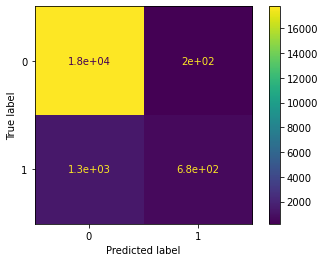

In [685]:
cm_display_cb_full = ConfusionMatrixDisplay(confusion_matrix = resultados_cm.reshape(2,2), display_labels = [0, 1])
cm_display_cb_full.plot()
plt.show()


<br>

<br>

<font size='5' style="color:orange">  <b> MLP Classifier - Default </b> </font>
<a name="mlp_default"></a>

[[ Back to Top ]](#content)

In [272]:
# Multi-layer Perceptron Classifier - Full dataset

# En este caso se definieron los parámetros random_state y max_iter de forma aleatoria, tal que no arrojara un error el modelo.

mlpc = MLPClassifier(random_state = 1, max_iter = 30000)

skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

mlpc_full_results    = []
mlpc_full_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    mlpc.fit(X_train, y_train)
    
    y_pred = mlpc.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    mlpc_full_results.append(list_results)
    mlpc_full_results_cm.append(list_cm)

In [274]:
filas    = ['MLPClassifier']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(mlpc_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
MLPClassifier,0.56049,0.296374,0.38538


In [276]:
# Tiempo expresado en segundos

resultados['TIEMPO'] = 2115
resultados

,PRECISION,RECALL,F1,TIEMPO
MLPClassifier,0.56049,0.296374,0.38538,2115


In [277]:
resultados.to_pickle("resultados_mlpc_full.pkl")

In [278]:
resultados_cm = gmean(mlpc_full_results_cm)
resultados_cm 

array([[[17785.59555733,   204.21098244],
        [ 1333.56875514,   675.8427233 ]]])

In [279]:
 with open('resultados_mlpc_full_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> Linear Discriminant Analysis - Default </b> </font>
<a name="lda_default"></a>

[[ Back to Top ]](#content)

In [176]:
# Linear Discriminant Analysis - Full dataset

lda = LinearDiscriminantAnalysis()

skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

lda_full_results    = []
lda_full_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    lda.fit(X_train, y_train)
    
    y_pred = lda.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    lda_full_results.append(list_results)
    lda_full_results_cm.append(list_cm)

In [178]:
filas    = ['LinearDiscriminantAnalysis_full']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(lda_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
LinearDiscriminantAnalysis_full,0.679732,0.27825,0.394843


In [180]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = 46
resultados

,PRECISION,RECALL,F1,TIEMPO
LinearDiscriminantAnalysis_full,0.679732,0.27825,0.394843,46


In [181]:
resultados.to_pickle("resultados_lda_full.pkl")

In [182]:
resultados_cm = gmean(lda_full_results_cm)
resultados_cm 

array([[[17726.69368638,   263.07119206],
        [ 1450.33167718,   559.22620181]]])

In [183]:
with open('resultados_lda_full_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> Calibrated Classifier with GaussianNB - Default </b> </font>
<a name="cccv_default"></a>

[[ Back to Top ]](#content)

In [264]:
# Calibrated Classifier CV usando el GaussianNB como base_estimator - Full dataset


cccv = CalibratedClassifierCV(base_estimator = GaussianNB(), cv=3)

skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

cccv_full_results    = []
cccv_full_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    cccv.fit(X_train, y_train)
    
    y_pred = cccv.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    cccv_full_results.append(list_results)
    cccv_full_results_cm.append(list_cm)


In [266]:
filas    = ['CalibratedClassifierCV_GNB_full']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(cccv_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
CalibratedClassifierCV_GNB_full,0.703706,0.374022,0.488408


In [268]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = 23
resultados

,PRECISION,RECALL,F1,TIEMPO
CalibratedClassifierCV_GNB_full,0.703706,0.374022,0.488408,23


In [269]:
resultados.to_pickle("resultados_cccv_full.pkl")

In [270]:
resultados_cm= gmean(cccv_full_results_cm)
resultados_cm 

array([[[17673.58940928,   315.99414586],
        [ 1257.78470333,   751.70959561]]])

In [271]:
with open('resultados_cccv_full_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> SGD Classifier - Default </b> </font>
<a name="sgdc_default"></a>

[[ Back to Top ]](#content)

In [184]:
# Stochastic Gradient Descent Classifier - Full dataset

sgd = SGDClassifier()

skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

sgd_full_results    = []
sgd_full_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    sgd.fit(X_train, y_train)
    
    y_pred = sgd.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    sgd_full_results.append(list_results)
    sgd_full_results_cm.append(list_cm)

In [186]:
filas    = ['SGDClassifier_full']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(sgd_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
SGDClassifier_full,0.561299,0.142723,0.175951


In [188]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = 249
resultados

,PRECISION,RECALL,F1,TIEMPO
SGDClassifier_full,0.561299,0.142723,0.175951,249


In [189]:
resultados.to_pickle("resultados_sgd_full.pkl")

In [190]:
resultados_cm = gmean(sgd_full_results_cm)
resultados_cm 

C:\Users\denun\miniconda3\lib\site-packages\scipy\stats\_stats_py.py:279: RuntimeWarning:

divide by zero encountered in log



array([[[17026.19606039,     0.        ],
        [ 1317.26200083,   286.84415277]]])

In [191]:
with open('resultados_sgd_full_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> Bagging Classifier - Default </b> </font>
<a name="bgc_default"></a>

[[ Back to Top ]](#content)

In [209]:
# Bagging Classifier  - Full dataset

bgc = BaggingClassifier()

skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

bgc_full_results    = []
bgc_full_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    bgc.fit(X_train, y_train)
    
    y_pred = bgc.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    bgc_full_results.append(list_results)
    bgc_full_results_cm.append(list_cm)

In [211]:
filas    = ['BaggingClassifier_full']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(bgc_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
BaggingClassifier_full,0.5046,0.029268,0.055316


In [213]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = 11163
resultados

,PRECISION,RECALL,F1,TIEMPO
BaggingClassifier_full,0.5046,0.029268,0.055316,11163


In [214]:
resultados.to_pickle("resultados_bgc_full.pkl")

In [215]:
resultados_cm = gmean(bgc_full_results_cm)
resultados_cm 

array([[[17932.29863349,    57.48015103],
        [ 1950.69121943,    58.82235827]]])

In [216]:
 with open('resultados_bgc_full_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> Models with default parameters - Summary </b> </font>
<a name="summary_default"></a>

[[ Back to Top ]](#content)

Se realiza un gráfico que permita comparar el recall y el tiempo de ejecución de cada uno de los modelos.

In [288]:
resultados_lgr_full = pd.read_pickle('resultados_lgr_full.pkl')
resultados_gnb_full = pd.read_pickle("resultados_gnb_full.pkl")
resultados_rfc_full = pd.read_pickle("resultados_rfc_full.pkl")
resultados_knc_full = pd.read_pickle('resultados_knc_full.pkl')
resultados_xgb_full = pd.read_pickle('resultados_xgb_full.pkl')
resultados_cb_full = pd.read_pickle('resultados_cb_full2.pkl')
resultados_mlpc_full = pd.read_pickle('resultados_mlpc_full.pkl')
resultados_lda_full = pd.read_pickle('resultados_lda_full.pkl')
resultados_cccv_full = pd.read_pickle('resultados_cccv_full.pkl')
resultados_sgd_full = pd.read_pickle("resultados_sgd_full.pkl")
resultados_bgc_full = pd.read_pickle("resultados_bgc_full.pkl")

In [289]:
df_resultados_default= pd.concat([resultados_lgr_full,
                                  resultados_gnb_full,
                                  resultados_rfc_full,
                                  resultados_knc_full,
                                  resultados_xgb_full,
                                  resultados_cb_full,
                                  resultados_mlpc_full,
                                  resultados_lda_full,
                                  resultados_cccv_full,
                                  resultados_sgd_full,
                                  resultados_bgc_full])
df_resultados_default

,PRECISION,RECALL,F1,TIEMPO
LogisticRegression_full,0.685480,0.269483,0.386856,1081.00
GaussianNB_full,0.647487,0.403787,0.497367,6.07
RandomForestClassifier_full,0.000000,0.000000,0.000000,5978.00
KNeighborsClassifier_full,0.223142,0.003169,0.006247,781.00
XGBoost_full,0.693811,0.247841,0.365173,1493.00
CatboostClassifier_full,0.767672,0.336274,0.467646,631.00
MLPClassifier,0.560490,0.296374,0.385380,2115.00
LinearDiscriminantAnalysis_full,0.679732,0.278250,0.394843,46.00
CalibratedClassifierCV_GNB_full,0.703706,0.374022,0.488408,23.00
SGDClassifier_full,0.561299,0.142723,0.175951,249.00


In [290]:
df_resultados_default.to_pickle('df_resultados_default.pkl')

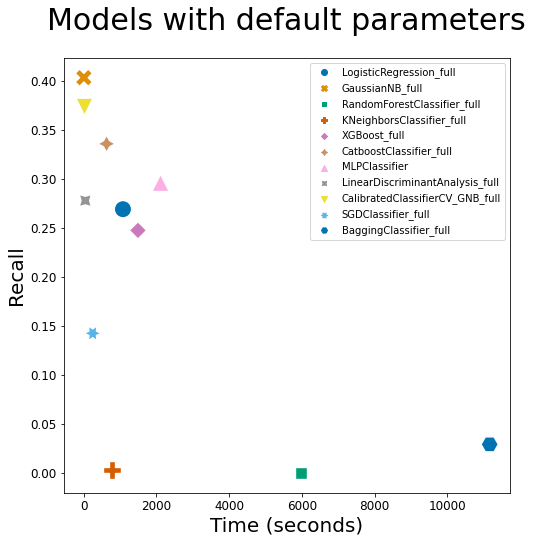

In [420]:
plt.figure(figsize = (8, 8))
sns.scatterplot(data = df_resultados_default, x = df_resultados_default['TIEMPO'],y = df_resultados_default['RECALL'], 
                hue = df_resultados_default.index, style = df_resultados_default.index, palette = 'colorblind', s = 300) 
plt.xlabel('Time (seconds)', y = -0.8, fontsize = 20)
plt.ylabel('Recall', x = -1, fontsize = 20)
plt.yticks(fontsize = 12)
plt.xticks(fontsize = 12)
plt.title('Models with default parameters', y = 1.05, fontsize = 30)
plt.show()

<br>

<br>

<br>

<br>

<font size='6' style="color:orange">  <b> Models - PCA </b> </font>
<a name="PCA"></a>

[[ Back to Top ]](#content)

A continuación se entrenará nuevamente a los modelos Logistic Regression y K Neighbors Classifier  reduciendo su dimensionalidad a 100, 125, 150 y 175 components utilizando PCA (Principal Component Analysis).

In [12]:
pca_100 = PCA(n_components = 100)
pca_125 = PCA(n_components = 125)
pca_150 = PCA(n_components = 150)
pca_175 = PCA(n_components = 175)

<br>

<font size='5' style="color:orange">  <b> Logistic Regression - PCA </b> </font>
<a name="lgr_pca"></a>

[[ Back to Top ]](#content)

<br>

In [67]:
# Logistic Regression - PCA 100

lgr = LogisticRegression(solver='lbfgs', max_iter=7000)
    
skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

lgr_100_results    = []
lgr_100_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = pca_100.fit_transform(X.iloc[train_index]), pca_100.transform(X.iloc[test_index])
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    lgr.fit(X_train, y_train)
    
    y_pred = lgr.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    lgr_100_results.append(list_results)
    lgr_100_results_cm.append(list_cm)
    

In [69]:
filas    = ['LogisticRegression_100']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(lgr_100_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
LogisticRegression_100,0.639638,0.084301,0.148939


In [71]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = 34
resultados

,PRECISION,RECALL,F1,TIEMPO
LogisticRegression_100,0.639638,0.084301,0.148939,34


In [72]:
resultados.to_pickle("resultados_lgr_100.pkl")

In [73]:
resultados_cm = gmean(lgr_100_results_cm)
resultados_cm 

array([[[17894.49445006,    94.61878469],
        [ 1840.07616092,   169.42818354]]])

In [74]:
with open('resultados_lgr_100_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

<br>

In [75]:
# Logistic Regression - PCA 125

lgr = LogisticRegression(solver='lbfgs', max_iter=7000)
    
skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

lgr_125_results    = []
lgr_125_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = pca_125.fit_transform(X.iloc[train_index]), pca_125.transform(X.iloc[test_index])
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    lgr.fit(X_train, y_train)
    
    y_pred = lgr.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    lgr_125_results.append(list_results)
    lgr_125_results_cm.append(list_cm)

In [77]:
filas    = ['LogisticRegression_125']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(lgr_125_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
LogisticRegression_125,0.64735,0.124122,0.208257


In [79]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = 43
resultados

,PRECISION,RECALL,F1,TIEMPO
LogisticRegression_125,0.64735,0.124122,0.208257,43


In [80]:
resultados.to_pickle("resultados_lgr_125.pkl")

In [81]:
resultados_cm = gmean(lgr_125_results_cm)
resultados_cm 

array([[[17854.09479855,   135.4514716 ],
        [ 1759.83630043,   249.46007195]]])

In [82]:
with open('resultados_lgr_125_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

In [83]:
# Logistic Regression - PCA 150

lgr = LogisticRegression(solver='lbfgs', max_iter=7000)

skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

lgr_150_results    = []
lgr_150_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = pca_150.fit_transform(X.iloc[train_index]), pca_150.transform(X.iloc[test_index])
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    lgr.fit(X_train, y_train)
    
    y_pred = lgr.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    lgr_150_results.append(list_results)
    lgr_150_results_cm.append(list_cm)

In [85]:
filas    = ['LogisticRegression_150']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(lgr_150_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
LogisticRegression_150,0.668582,0.183076,0.287419


In [87]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = 53
resultados

,PRECISION,RECALL,F1,TIEMPO
LogisticRegression_150,0.668582,0.183076,0.287419,53


In [88]:
resultados.to_pickle("resultados_lgr_150.pkl")

In [89]:
resultados_cm = gmean(lgr_150_results_cm)
resultados_cm 

array([[[17807.69342463,   181.85701948],
        [ 1641.66779244,   367.94606223]]])

In [90]:
with open('resultados_lgr_150_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

<br>

In [91]:
# Logistic Regression - PCA 175

lgr = LogisticRegression(solver='lbfgs', max_iter=7000)

skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

lgr_175_results    = []
lgr_175_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = pca_175.fit_transform(X.iloc[train_index]), pca_175.transform(X.iloc[test_index])
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    lgr.fit(X_train, y_train)
    
    y_pred = lgr.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    lgr_175_results.append(list_results)
    lgr_175_results_cm.append(list_cm)

In [93]:
filas    = ['LogisticRegression_175']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(lgr_175_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
LogisticRegression_175,0.672872,0.212669,0.323155


In [95]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = 43
resultados

,PRECISION,RECALL,F1,TIEMPO
LogisticRegression_175,0.672872,0.212669,0.323155,43


In [96]:
resultados.to_pickle("resultados_lgr_175.pkl")

In [97]:
resultados_cm = gmean(lgr_175_results_cm)
resultados_cm 

array([[[17782.09007249,   207.24470003],
        [ 1582.27905521,   427.42203455]]])

In [98]:
with open('resultados_lgr_175_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<font size='4' style="color:orange">  <b> Logistic Regression - Summary </b> </font>

In [333]:
resultados_lgr_100 = pd.read_pickle('resultados_lgr_100.pkl')
resultados_lgr_125 = pd.read_pickle('resultados_lgr_125.pkl')
resultados_lgr_150 = pd.read_pickle('resultados_lgr_150.pkl')
resultados_lgr_175 = pd.read_pickle('resultados_lgr_175.pkl')
resultados_lgr_full = pd.read_pickle('resultados_lgr_full.pkl')

In [334]:
df_resultados_lgr_pca= pd.concat([resultados_lgr_100,
                                resultados_lgr_125,
                                resultados_lgr_150,
                                resultados_lgr_175,
                                resultados_lgr_full])
df_resultados_lgr_pca

,PRECISION,RECALL,F1,TIEMPO
,,,,
LogisticRegression_100,0.639638,0.084301,0.148939,34
LogisticRegression_125,0.647350,0.124122,0.208257,43
LogisticRegression_150,0.668582,0.183076,0.287419,53
LogisticRegression_175,0.672872,0.212669,0.323155,43
LogisticRegression_full,0.685480,0.269483,0.386856,1081


In [335]:
df_resultados_lgr_pca.to_pickle('df_resultados_lgr_pca.pkl')

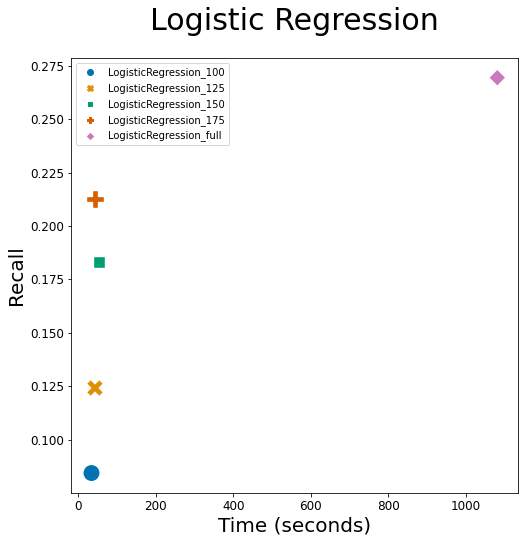

In [421]:
plt.figure(figsize = (8, 8))
sns.scatterplot(data = df_resultados_lgr_pca, x = df_resultados_lgr_pca['TIEMPO'],y = df_resultados_lgr_pca['RECALL'], 
                hue = df_resultados_lgr_pca.index, style = df_resultados_lgr_pca.index, palette = 'colorblind', s = 300) 
plt.xlabel('Time (seconds)', y = -0.8, fontsize = 20)
plt.ylabel('Recall', x = -1, fontsize = 20)
plt.yticks(fontsize = 12)
plt.xticks(fontsize = 12)
plt.title('Logistic Regression', y = 1.05, fontsize = 30)
plt.show()

<br>

<br>

<font size='5' style="color:orange">  <b> K Neighbors Classifier - PCA </b> </font>
<a name="knc_pca"></a>

[[ Back to Top ]](#content)

In [194]:
# KNeighborsClassifier - PCA 175

knc = KNeighborsClassifier()
    
skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

knc_175_results    = []
knc_175_results_cm = []

tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = pca_175.fit_transform(X.iloc[train_index]),  pca_175.transform(X.iloc[test_index])
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    knc.fit(X_train, y_train)
    
    y_pred = knc.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    knc_175_results.append(list_results)
    knc_175_results_cm.append(list_cm)

fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [195]:
filas    = ['KNeighborsClassifier_175']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(knc_175_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
KNeighborsClassifier_175,0.220253,0.003159,0.006227


In [196]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
KNeighborsClassifier_175,0.220253,0.003159,0.006227,797.940231


In [197]:
resultados.to_pickle("resultados_knc_175.pkl")

In [198]:
resultados_cm = gmean(knc_175_results_cm)
resultados_cm 

array([[[1.79683994e+04, 2.12055902e+01],
        [2.00229705e+03, 6.34910406e+00]]])

In [199]:
with open('resultados_knc_175_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

Teniendo en cuenta que el recall del K Neighbors Classifier es bajo y su tiempo de ejecución alto, no se buscarán las métricas para los PCA 100, 125 y 150.

<br>

<font size='4' style="color:orange">  <b> K Neighbors Classifier - Summary </b> </font>

In [349]:
resultados_knc_175 = pd.read_pickle('resultados_knc_175.pkl')
resultados_knc_full = pd.read_pickle('resultados_knc_full.pkl')

df_resultados_knc_pca = pd.concat([ resultados_knc_175,
                                   resultados_knc_full])

df_resultados_knc_pca.to_pickle("resultados_knc_pca.pkl")

df_resultados_knc_pca

,PRECISION,RECALL,F1,TIEMPO
,,,,
KNeighborsClassifier_175,0.220253,0.003159,0.006227,797.940231
KNeighborsClassifier_full,0.223142,0.003169,0.006247,781.000000


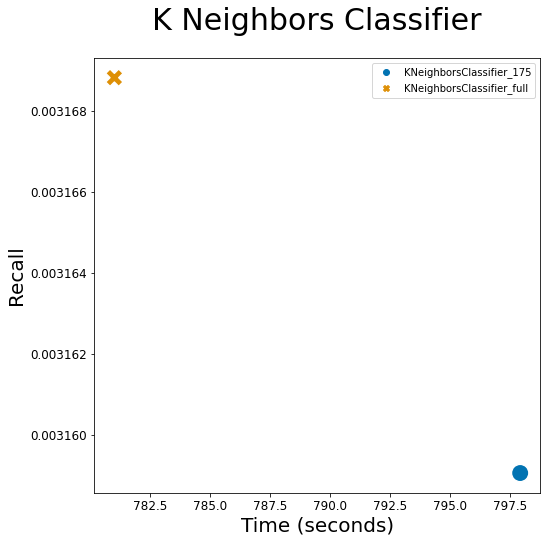

In [423]:
plt.figure(figsize = (8, 8))
sns.scatterplot(data = df_resultados_knc_pca, x = df_resultados_knc_pca['TIEMPO'],y = df_resultados_knc_pca['RECALL'], 
                hue = df_resultados_knc_pca.index, style = df_resultados_knc_pca.index, palette = 'colorblind', s = 300) 
plt.xlabel('Time (seconds)', y = -0.8, fontsize = 20)
plt.ylabel('Recall', x = -1, fontsize = 20)
plt.yticks(fontsize = 12)
plt.xticks(fontsize = 12)
plt.title('K Neighbors Classifier', y = 1.05, fontsize = 30)
plt.show()

<br>

<br>

<br>

<font size='6' style="color:orange">  <b> Optuna </b> </font>
<a name="optuna"></a>

[[ Back to Top ]](#content)

<p style='text-align: justify;'> 
Utilizando la libraría Optuna se buscará optimizar los hipermarámetros de los algoritmos Logistic Regression y K Neighbors Classifier, de forma tal que los modelos arrojen mejores resultados que los obtenidos con los hiperparámetros default.

<p style='text-align: justify;'> 
Cabe aclarar que el dataset completo contiene 201 variables y 200 000 registros, motivo por el cual realizar la optimización de hiperparámetros con el dataset completo requiere de mayor tiempo y poder computacional. Es por ello que se buscará optimizar los modelos utilizando un dataset con reducción de dimensionalidad. Luego se comprobará si esos hiperparámetros optimizados pueden ser también utilizados para los modelos que utilizan el fulldataset. 

<br>

<font size='5' style="color:orange">  <b> Logistic Regression - Optuna </b> </font>
<a name="lgr_opt"></a>

[[ Back to Top ]](#content)

Se optimizarán los hiperparámetros del modelo Logistic Regression para PCA 100, PCA 175 y full dataset.

Se debe tener en cuenta que el Recall del modelo Logistic Regression para el full dataset es de 0.269483. Por lo que con la optimización de hiperparámetros se tiene como objetivo el obtener un mejor Recall que el mencionado.

<br>

<font size='4' style="color:orange">  <b> Logistic Regression - PCA 100 </b> </font>
<a name="lgr_opt_100"></a>

[[ Back to Top ]](#content)

<br>

Logistic Regression PCA 100 - Study 1

In [228]:
# Se busca optimizar los hiperparámetros 'solver' y 'max_iter'.

def objective_lgr_100_1(trial):
    solver_trial = trial.suggest_categorical('solver',['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'])
    max_iter_trial = trial.suggest_int('max_iter', 5000,35000)

    lgr = LogisticRegression(solver = solver_trial, max_iter = max_iter_trial)

    skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

    lgr_100_results    = []
    
    for train_index, test_index in skf.split(X,y):
    
        X_train, X_test = pca_100.fit_transform(X.iloc[train_index]), pca_100.transform(X.iloc[test_index])
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        lgr.fit(X_train, y_train)
    
        y_pred = lgr.predict(X_test)
    
        recall    = recall_score(y_test, y_pred)

        list_results   = [recall]
        lgr_100_results.append(list_results)
    
        
    return gmean(lgr_100_results)   

In [229]:
study_lgr_100_1 = optuna.create_study(direction='maximize')
study_lgr_100_1.optimize(objective_lgr_100_1, n_trials=200)

[I 2022-11-10 13:14:48,118] A new study created in memory with name: no-name-28f9ce4e-2365-40b3-b469-7e11f17bfb7e
[I 2022-11-10 13:16:16,366] Trial 0 finished with value: 0.08384793266870955 and parameters: {'solver': 'sag', 'max_iter': 8641}. Best is trial 0 with value: 0.08384793266870955.
[I 2022-11-10 13:16:48,639] Trial 1 finished with value: 0.08552246458808954 and parameters: {'solver': 'lbfgs', 'max_iter': 9731}. Best is trial 1 with value: 0.08552246458808954.
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\minicon

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

[I 2022-11-10 14:02:41,793] Trial 51 finished with value: 0.0845807213242351 and parameters: {'solver': 'lbfgs', 'max_iter': 34287}. Best is trial 29 with value: 0.08659027930342719.
[I 2022-11-10 14:03:15,322] Trial 52 finished with value: 0.08563133625168341 and parameters: {'solver': 'lbfgs', 'max_iter': 20256}. Best is trial 29 with value: 0.08659027930342719.
[I 2022-11-10 14:03:48,721] Trial 53 finished with value: 0.08306797227318621 and parameters: {'solver': 'lbfgs', 'max_iter': 22690}. Best is trial 29 with value: 0.08659027930342719.
[I 2022-11-10 14:04:22,409] Trial 54 finished with value: 0.08338501874357081 and parameters: {'solver': 'lbfgs', 'max_iter': 20557}. Best is trial 29 with value: 0.08659027930342719.
[I 2022-11-10 14:04:55,805] Trial 55 finished with value: 0.08368854280752827 and parameters: {'solver': 'lbfgs', 'max_iter': 25110}. Best is trial 29 with value: 0.08659027930342719.
[I 2022-11-10 14:05:58,996] Trial 56 finished with value: 0.08295253310277043 and

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

[I 2022-11-10 14:31:42,198] Trial 87 finished with value: 0.08457368972682006 and parameters: {'solver': 'lbfgs', 'max_iter': 23341}. Best is trial 29 with value: 0.08659027930342719.
[I 2022-11-10 14:32:15,127] Trial 88 finished with value: 0.08440213754144776 and parameters: {'solver': 'lbfgs', 'max_iter': 20657}. Best is trial 29 with value: 0.08659027930342719.
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

[I 2022-11-10 14:52:45,552] Trial 108 finished with value: 0.08359175772967214 and parameters: {'solver': 'newton-cg', 'max_iter': 7884}. Best is trial 29 with value: 0.08659027930342719.
[I 2022-11-10 14:53:57,336] Trial 109 finished with valu

[I 2022-11-10 15:05:39,316] Trial 121 finished with value: 0.08382635764202416 and parameters: {'solver': 'lbfgs', 'max_iter': 18149}. Best is trial 29 with value: 0.08659027930342719.
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

[I 2022-11-10 15:38:56,348] Trial 156 finished with value: 0.08275687219112186 and parameters: {'solver': 'newton-cg', 'max_iter': 6162}. Best is trial 29 with value: 0.08659027930342719.
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimi

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

[I 2022-11-10 15:46:50,515] Trial 164 finished with value: 0.08499604901298187 and parameters: {'solver': 'newton-cg', 'max_iter': 8505}. Best is trial 29 with value: 0.08659027930342719.
[I 2022-11-10 15:47:24,478] Trial 165 finished with valu

[I 2022-11-10 15:59:34,132] Trial 177 finished with value: 0.08367548748830239 and parameters: {'solver': 'saga', 'max_iter': 28786}. Best is trial 29 with value: 0.08659027930342719.
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

[I 2022-11-10 16:10:43,045] Trial 195 finished with value: 0.08367795285141925 and parameters: {'solver': 'newton-cg', 'max_iter': 7857}. Best is trial 29 with value: 0.08659027930342719.
[I 2022-11-10 16:11:16,848] Trial 196 finished with value: 0.08481958933526465 and parameters: {'solver': 'lbfgs', 'max_iter': 26857}. Best is trial 29 with value: 0.08659027930342719.
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorith

In [230]:
joblib.dump(study_lgr_100_1, "study_lgr100_1.pkl")

['study_lgr100_1.pkl']

In [374]:
study_lgr_100_1 = joblib.load("study_lgr100_1.pkl")

In [231]:
print('Best Value: {}'.format(study_lgr_100_1.best_value))
print('Best Parameters: {}'.format(study_lgr_100_1.best_params))

Best Value: 0.08659027930342719
Best Parameters: {'solver': 'newton-cg', 'max_iter': 7590}


In [376]:
optuna.visualization.plot_optimization_history(study_lgr_100_1)

In [377]:
optuna.visualization.plot_optimization_history(study_lgr_100_1)

In [378]:
optuna.visualization.plot_param_importances(study_lgr_100_1)

In [379]:
optuna.visualization.plot_slice(study_lgr_100_1)

<br>

Logistic Regression PCA 100 - Study 2

In [312]:
# Se utiliza 'max_iter' =  7590 obtenido del study 1 y se busca optimizar el hiperparámetro 'solver'.

def objective_lgr_100_2(trial):
    solver_trial = trial.suggest_categorical('solver',['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'])

    lgr = LogisticRegression(solver = solver_trial, max_iter =  7590)

    skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

    lgr_100_results    = []
    
    for train_index, test_index in skf.split(X,y):
    
        X_train, X_test = pca_100.fit_transform(X.iloc[train_index]), pca_100.transform(X.iloc[test_index])
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        lgr.fit(X_train, y_train)
    
        y_pred = lgr.predict(X_test)
    
        recall    = recall_score(y_test, y_pred)

        list_results   = [recall]
        lgr_100_results.append(list_results)
    
        
    return gmean(lgr_100_results)   

In [313]:
study_lgr_100_2 = optuna.create_study(direction='maximize')
study_lgr_100_2.optimize(objective_lgr_100_2, n_trials=6)

[I 2022-11-12 14:50:53,468] A new study created in memory with name: no-name-8e783b3c-1272-4ba6-93ae-44b909b05212
[I 2022-11-12 14:52:08,164] Trial 0 finished with value: 0.08416825477201041 and parameters: {'solver': 'liblinear'}. Best is trial 0 with value: 0.08416825477201041.
[I 2022-11-12 14:52:40,252] Trial 1 finished with value: 0.08383175878317704 and parameters: {'solver': 'lbfgs'}. Best is trial 0 with value: 0.08416825477201041.
[I 2022-11-12 14:53:48,206] Trial 2 finished with value: 0.08215651349960994 and parameters: {'solver': 'saga'}. Best is trial 0 with value: 0.08416825477201041.
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge


In [314]:
joblib.dump(study_lgr_100_2, "study_lgr100_2.pkl")

['study_lgr100_2.pkl']

In [380]:
study_lgr_100_2 = joblib.load("study_lgr100_2.pkl")

In [315]:
print('Best Value: {}'.format(study_lgr_100_2.best_value))
print('Best Parameters: {}'.format(study_lgr_100_2.best_params))

Best Value: 0.08448839539839466
Best Parameters: {'solver': 'liblinear'}


In [381]:
optuna.visualization.plot_slice(study_lgr_100_2)

<br>

Logistic Regression PCA 100 - Study 3

In [317]:
# Se busca optimizar de nuevo los hiperparámetros 'solver' y 'max_trial' teniendo en cuenta los rangos donde se obtuvo 
# mejores resultados en el study 1.

def objective_lgr_100_3(trial):
    solver_trial = trial.suggest_categorical('solver',['newton-cg', 'lbfgs', 'saga'])
    max_iter_trial = trial.suggest_int('max_iter', 7000,11000)

    lgr = LogisticRegression(solver = solver_trial, max_iter = max_iter_trial)

    skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

    lgr_100_results    = []
    
    for train_index, test_index in skf.split(X,y):
    
        X_train, X_test = pca_100.fit_transform(X.iloc[train_index]), pca_100.transform(X.iloc[test_index])
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        lgr.fit(X_train, y_train)
    
        y_pred = lgr.predict(X_test)
    
        recall    = recall_score(y_test, y_pred)

        list_results   = [recall]
        lgr_100_results.append(list_results)
    
        
    return gmean(lgr_100_results)  

In [318]:
study_lgr_100_3 = optuna.create_study(direction='maximize')
study_lgr_100_3.optimize(objective_lgr_100_3, n_trials=100)

[I 2022-11-12 15:03:36,366] A new study created in memory with name: no-name-2a682a03-c9f0-4c78-a179-40653060fa9a
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did n

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

[I 2022-11-12 16:15:31,790] Trial 92 finished with value: 0.08314203219455693 and parameters: {'solver': 'saga', 'max_iter': 9699}. Best is trial 51 with value: 0.08621953266938626.
[I 2022-11-12 16:16:33,512] Trial 93 finished with value: 0.08400924496250205 and parameters: {'solver': 'saga', 'max_iter': 10207}. Best is trial 51 with value: 0.08621953266938626.
[I 2022-11-12 16:17:36,542] Trial 94 finished with value: 0.08403206934079979 and parameters: {'solver': 'saga', 'max_iter': 10400}. Best is trial 51 with value: 0.08621953266938626.
[I 2022-11-12 16:18:40,510] Trial 95 finished with value: 0.08283700141402592 and parameters: {'solver': 'saga', 'max_iter': 9961}. Best is trial 51 with value: 0.08621953266938626.
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\min

In [319]:
joblib.dump(study_lgr_100_3, "study_lgr100_3.pkl")

['study_lgr100_3.pkl']

In [382]:
study_lgr_100_3 = joblib.load("study_lgr100_3.pkl")

In [321]:
print('Best Value: {}'.format(study_lgr_100_3.best_value))
print('Best Parameters: {}'.format(study_lgr_100_3.best_params))

Best Value: 0.08621953266938626
Best Parameters: {'solver': 'lbfgs', 'max_iter': 7711}


In [383]:
optuna.visualization.plot_slice(study_lgr_100_3)

In [384]:
optuna.visualization.plot_param_importances(study_lgr_100_3)

In [385]:
optuna.visualization.plot_optimization_history(study_lgr_100_3)

<br>

Se utilizarán en el full dataset los hiperparámetros con los que se obtuvo mejores resultados en la Logistic Regression PCA 100. Dichos hiperparámetros son 'solver' = 'newton-cg' y 'max_iter' = 7590.

In [554]:
# Logistic Regression - Full dataset

lgr = LogisticRegression( max_iter= 7590 , solver = 'newton-cg')


skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

lgr_full_results    = []
lgr_full_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    lgr.fit(X_train, y_train)
    
    y_pred = lgr.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    lgr_full_results.append(list_results)
    lgr_full_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search failed

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning:

The line search algorithm did not converge

C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning:

Line Search 

In [555]:
filas    = ['LogisticRegression_full_opt(PCA100)']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(lgr_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
LogisticRegression_full_opt(PCA100),0.685319,0.26778,0.385072


In [556]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
LogisticRegression_full_opt(PCA100),0.685319,0.26778,0.385072,448.738785


In [557]:
resultados.to_pickle("resultados_lgr_full_opt_PCA100.pkl")

In [558]:
resultados_cm= gmean(lgr_full_results_cm)
resultados_cm 

array([[[17743.09527386,   246.75603909],
        [ 1471.32100098,   538.18511381]]])

In [559]:
with open('LogisticRegression_full_opt_PCA100_cm.pkl','wb') as f:
        pickle.dump(resultados_cm, f)

El resultado obtenido por el modelo que emplea los hiperparámetros 'solver' = 'newton-cg' y 'max_iter' = 7590 en el fulldataset es inferior al obtenido con los hiperparámetros default.

<br>

<font size='4' style="color:orange">  <b> Logistic Regression - PCA 175 </b> </font>
<a name="lgr_opt_175"></a>

[[ Back to Top ]](#content)

<br>

Logistic Regression PCA 175 - Study 1

In [107]:
# Se busca optimizar los hiperparámetros 'solver' y 'max_iter'.

def objective_lgr_175_1(trial):
    solver_trial = trial.suggest_categorical('solver',['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'])
    max_iter_trial = trial.suggest_int('max_iter', 5000,35000)

    lgr = LogisticRegression(solver = solver_trial, max_iter = max_iter_trial)

    skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

    lgr_175_results    = []
    
    for train_index, test_index in skf.split(X,y):
    
        X_train, X_test = pca_175.fit_transform(X.iloc[train_index]), pca_175.transform(X.iloc[test_index])
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        lgr.fit(X_train, y_train)
    
        y_pred = lgr.predict(X_test)
    
        recall    = recall_score(y_test, y_pred)

        list_results   = [recall]
        lgr_175_results.append(list_results)
    
        
    return gmean(lgr_175_results)    

In [108]:
study_lgr_175_1 = optuna.create_study(direction='maximize')
study_lgr_175_1.optimize(objective_lgr_175_1, n_trials=150)

[I 2022-11-08 19:23:26,941] A new study created in memory with name: no-name-30c82a41-4d92-4b76-9dc5-4986b0767b4c
[I 2022-11-08 19:24:29,564] Trial 0 finished with value: 0.21261873260391223 and parameters: {'solver': 'saga', 'max_iter': 11138}. Best is trial 0 with value: 0.21261873260391223.
[I 2022-11-08 19:25:11,554] Trial 1 finished with value: 0.21266894368678335 and parameters: {'solver': 'lbfgs', 'max_iter': 25721}. Best is trial 1 with value: 0.21266894368678335.
[I 2022-11-08 19:26:11,045] Trial 2 finished with value: 0.21266733674707322 and parameters: {'solver': 'saga', 'max_iter': 21922}. Best is trial 1 with value: 0.21266894368678335.
[I 2022-11-08 19:27:48,238] Trial 3 finished with value: 0.21242008752364527 and parameters: {'solver': 'sag', 'max_iter': 30647}. Best is trial 1 with value: 0.21266894368678335.
[I 2022-11-08 19:29:35,681] Trial 4 finished with value: 0.21242008752364527 and parameters: {'solver': 'sag', 'max_iter': 24598}. Best is trial 1 with value: 0.2

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:2

[I 2022-11-08 20:02:03,858] Trial 30 finished with value: 0.21266847382010026 and parameters: {'solver': 'saga', 'max_iter': 10058}. Best is trial 7 with value: 0.21276673741075677.
[I 2022-11-08 20:03:10,911] Trial 31 finished with value: 0.21266733674707322 and parameters: {'solver': 'saga', 'max_iter': 16259}. Best is trial 7 with value: 0.21276673741075677.
[I 2022-11-08 20:04:18,490] Trial 32 finished with value: 0.21271708933398648 and parameters: {'solver': 'saga', 'max_iter': 29333}. Best is trial 7 with value: 0.21276673741075677.
[I 2022-11-08 20:05:24,371] Trial 33 finished with value: 0.21266847382010026 and parameters: {'solver': 'saga', 'max_iter': 23049}. Best is trial 7 with value: 0.21276673741075677.
[I 2022-11-08 20:06:27,752] Trial 34 finished with value: 0.21266847382010026 and parameters: {'solver': 'saga', 'max_iter': 20608}. Best is trial 7 with value: 0.21276673741075677.
[I 2022-11-08 20:08:10,626] Trial 35 finished with value: 0.2123701709017896 and parameter

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:2

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:2

C:\Users\denun\miniconda3\lib\site-packages\scipy\optimize\_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\denun\miniconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
[I 2022-11-08 21:11:19,147] Trial 87 finished with value: 0.21261873260391223 and parameters: {'solver': 'newton-cg', 'max_iter': 22569}. Best is trial 62 with value: 0.2127673236443402.
[I 2022-11-08 21:12:24,477] Trial 88 finished with value: 0.21256751617754654 and parameters: {'solver': 'saga', 'max_iter': 8430}. Best is trial 62 with value: 0.2127673236443402.
[I 2022-11-08 21:13:29,190] Trial 89 finished with value: 0.21261873260391223 and parameters: {'solver': 'saga', 'max_iter': 10813}. Best is trial 62 with value: 0.2127673236443402.
[I 2022-11-08 21:14:33,617] Trial 90 finished with value: 0.21271869664963308 and parameters

[I 2022-11-08 21:35:46,461] Trial 109 finished with value: 0.21261908574747276 and parameters: {'solver': 'liblinear', 'max_iter': 12460}. Best is trial 62 with value: 0.2127673236443402.
[I 2022-11-08 21:36:47,163] Trial 110 finished with value: 0.21271708933398648 and parameters: {'solver': 'saga', 'max_iter': 32942}. Best is trial 62 with value: 0.2127673236443402.
[I 2022-11-08 21:37:46,225] Trial 111 finished with value: 0.21271708933398648 and parameters: {'solver': 'saga', 'max_iter': 13173}. Best is trial 62 with value: 0.2127673236443402.
[I 2022-11-08 21:38:47,282] Trial 112 finished with value: 0.21266722010744832 and parameters: {'solver': 'saga', 'max_iter': 17241}. Best is trial 62 with value: 0.2127673236443402.
[I 2022-11-08 21:39:51,953] Trial 113 finished with value: 0.21266733674707322 and parameters: {'solver': 'saga', 'max_iter': 11466}. Best is trial 62 with value: 0.2127673236443402.
[I 2022-11-08 21:40:55,637] Trial 114 finished with value: 0.2127673236443402 an

[I 2022-11-08 22:01:22,463] Trial 133 finished with value: 0.21266847382010026 and parameters: {'solver': 'saga', 'max_iter': 14015}. Best is trial 122 with value: 0.21281698344577693.
[I 2022-11-08 22:02:24,789] Trial 134 finished with value: 0.21271708933398648 and parameters: {'solver': 'saga', 'max_iter': 15338}. Best is trial 122 with value: 0.21281698344577693.
[I 2022-11-08 22:03:25,528] Trial 135 finished with value: 0.21276673741075677 and parameters: {'solver': 'saga', 'max_iter': 20260}. Best is trial 122 with value: 0.21281698344577693.
[I 2022-11-08 22:04:26,261] Trial 136 finished with value: 0.21266733674707322 and parameters: {'solver': 'saga', 'max_iter': 20203}. Best is trial 122 with value: 0.21281698344577693.
[I 2022-11-08 22:06:50,679] Trial 137 finished with value: 0.21261908574747276 and parameters: {'solver': 'liblinear', 'max_iter': 20937}. Best is trial 122 with value: 0.21281698344577693.
[I 2022-11-08 22:07:51,537] Trial 138 finished with value: 0.212767323

In [109]:
joblib.dump(study_lgr_175_1, "study_lgr175_1.pkl")

['study_lgr175_1.pkl']

In [386]:
study_lgr_175_1 = joblib.load("study_lgr175_1.pkl")

In [110]:
print('Best Value: {}'.format(study_lgr_175_1.best_value))
print('Best Parameters: {}'.format(study_lgr_175_1.best_params))

Best Value: 0.21281698344577693
Best Parameters: {'solver': 'saga', 'max_iter': 15176}


In [387]:
optuna.visualization.plot_optimization_history(study_lgr_175_1)

In [388]:
optuna.visualization.plot_param_importances(study_lgr_175_1)

In [389]:
optuna.visualization.plot_slice(study_lgr_175_1)

<br>

Logistic Regression PCA 175 - Study 2

In [114]:
# Se utiliza 'solver' = 'saga' obtenido del study 1 y se busca optimizar el hiperparámetro 'max_iter'.

def objective_lgr_175_2(trial):

    max_iter_trial = trial.suggest_int('max_iter', 10000,23000)

    lgr = LogisticRegression(solver = 'saga', max_iter = max_iter_trial)

    skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

    lgr_175_results    = []
    
    for train_index, test_index in skf.split(X,y):
    
        X_train, X_test = pca_175.fit_transform(X.iloc[train_index]), pca_175.transform(X.iloc[test_index])
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        lgr.fit(X_train, y_train)
    
        y_pred = lgr.predict(X_test)
    
        recall    = recall_score(y_test, y_pred)

        list_results   = [recall]
        lgr_175_results.append(list_results)
    
        
    return gmean(lgr_175_results) 

In [115]:
study_lgr_175_2 = optuna.create_study(direction='maximize')
study_lgr_175_2.optimize(objective_lgr_175_2, n_trials=70)

[I 2022-11-08 22:31:27,961] A new study created in memory with name: no-name-0691a5d1-3a93-4309-a466-fecb0e3ddb31
[I 2022-11-08 22:32:27,349] Trial 0 finished with value: 0.21261873260391223 and parameters: {'max_iter': 14608}. Best is trial 0 with value: 0.21261873260391223.
[I 2022-11-08 22:33:27,968] Trial 1 finished with value: 0.21271755930807992 and parameters: {'max_iter': 20523}. Best is trial 1 with value: 0.21271755930807992.
[I 2022-11-08 22:34:28,210] Trial 2 finished with value: 0.21276673741075677 and parameters: {'max_iter': 16367}. Best is trial 2 with value: 0.21276673741075677.
[I 2022-11-08 22:35:32,553] Trial 3 finished with value: 0.21266894368678335 and parameters: {'max_iter': 20314}. Best is trial 2 with value: 0.21276673741075677.
[I 2022-11-08 22:36:31,784] Trial 4 finished with value: 0.21266733674707322 and parameters: {'max_iter': 12563}. Best is trial 2 with value: 0.21276673741075677.
[I 2022-11-08 22:37:31,889] Trial 5 finished with value: 0.212717089333

[I 2022-11-08 23:17:53,151] Trial 46 finished with value: 0.21266733674707322 and parameters: {'max_iter': 20268}. Best is trial 2 with value: 0.21276673741075677.
[I 2022-11-08 23:18:50,593] Trial 47 finished with value: 0.21271708933398648 and parameters: {'max_iter': 12507}. Best is trial 2 with value: 0.21276673741075677.
[I 2022-11-08 23:19:49,632] Trial 48 finished with value: 0.21266733674707322 and parameters: {'max_iter': 15910}. Best is trial 2 with value: 0.21276673741075677.
[I 2022-11-08 23:20:48,416] Trial 49 finished with value: 0.21261873260391223 and parameters: {'max_iter': 14971}. Best is trial 2 with value: 0.21276673741075677.
[I 2022-11-08 23:21:48,333] Trial 50 finished with value: 0.21261747918449223 and parameters: {'max_iter': 17150}. Best is trial 2 with value: 0.21276673741075677.
[I 2022-11-08 23:22:47,558] Trial 51 finished with value: 0.21266768997136143 and parameters: {'max_iter': 18279}. Best is trial 2 with value: 0.21276673741075677.
[I 2022-11-08 23

In [116]:
joblib.dump(study_lgr_175_2, "study_lgr175_2.pkl")

['study_lgr175_2.pkl']

In [390]:
study_lgr_175_2 = joblib.load("study_lgr175_2.pkl")

In [117]:
print('Best Value: {}'.format(study_lgr_175_2.best_value))
print('Best Parameters: {}'.format(study_lgr_175_2.best_params))

Best Value: 0.2127673236443402
Best Parameters: {'max_iter': 20968}


In [391]:
optuna.visualization.plot_optimization_history(study_lgr_175_2)

In [393]:
optuna.visualization.plot_slice(study_lgr_175_2)

<br>

Logistic Regression PCA 175 - Study 3

In [194]:
# Se utiliza 'solver' = 'saga' obtenido del study 1 y se busca optimizar el hiperparámetro 'max_iter' reduciendo el rango 
# que se había empleado en el study 2 e incrementando la cantidad de trials. 

def objective_lgr_175_3(trial):
    max_iter_trial = trial.suggest_int('max_iter', 15000,22000)

    lgr = LogisticRegression(solver = 'saga', max_iter = max_iter_trial)

    skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

    lgr_175_results    = []
    
    for train_index, test_index in skf.split(X,y):
    
        X_train, X_test = pca_175.fit_transform(X.iloc[train_index]), pca_175.transform(X.iloc[test_index])
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        lgr.fit(X_train, y_train)
    
        y_pred = lgr.predict(X_test)
    
        recall    = recall_score(y_test, y_pred)

        list_results   = [recall]
        lgr_175_results.append(list_results)
    
        
    return gmean(lgr_175_results) 

In [195]:
study_lgr_175_3 = optuna.create_study(direction='maximize')
study_lgr_175_3.optimize(objective_lgr_175_3, n_trials=150)

[I 2022-11-09 17:20:01,510] A new study created in memory with name: no-name-eb108a76-81b8-45c2-891a-eb8f8982bba6
[I 2022-11-09 17:21:03,058] Trial 0 finished with value: 0.21266847382010026 and parameters: {'max_iter': 17763}. Best is trial 0 with value: 0.21266847382010026.
[I 2022-11-09 17:22:02,708] Trial 1 finished with value: 0.21266733674707322 and parameters: {'max_iter': 15810}. Best is trial 0 with value: 0.21266847382010026.
[I 2022-11-09 17:23:01,301] Trial 2 finished with value: 0.21261873260391223 and parameters: {'max_iter': 16469}. Best is trial 0 with value: 0.21266847382010026.
[I 2022-11-09 17:24:00,976] Trial 3 finished with value: 0.21261747918449223 and parameters: {'max_iter': 20579}. Best is trial 0 with value: 0.21266847382010026.
[I 2022-11-09 17:25:02,003] Trial 4 finished with value: 0.21261873260391223 and parameters: {'max_iter': 19657}. Best is trial 0 with value: 0.21266847382010026.
[I 2022-11-09 17:26:04,000] Trial 5 finished with value: 0.212618615990

[I 2022-11-09 18:06:18,661] Trial 46 finished with value: 0.21266847382010026 and parameters: {'max_iter': 19347}. Best is trial 8 with value: 0.2127673236443402.
[I 2022-11-09 18:07:35,696] Trial 47 finished with value: 0.21261873260391223 and parameters: {'max_iter': 18721}. Best is trial 8 with value: 0.2127673236443402.
[I 2022-11-09 18:08:52,520] Trial 48 finished with value: 0.21266733674707322 and parameters: {'max_iter': 21175}. Best is trial 8 with value: 0.2127673236443402.
[I 2022-11-09 18:10:09,340] Trial 49 finished with value: 0.21266733674707322 and parameters: {'max_iter': 21620}. Best is trial 8 with value: 0.2127673236443402.
[I 2022-11-09 18:11:26,586] Trial 50 finished with value: 0.21271869664963308 and parameters: {'max_iter': 20341}. Best is trial 8 with value: 0.2127673236443402.
[I 2022-11-09 18:12:45,002] Trial 51 finished with value: 0.21271708933398648 and parameters: {'max_iter': 20473}. Best is trial 8 with value: 0.2127673236443402.
[I 2022-11-09 18:14:01

[I 2022-11-09 18:56:09,188] Trial 93 finished with value: 0.21266847382010026 and parameters: {'max_iter': 15698}. Best is trial 69 with value: 0.21281698344577693.
[I 2022-11-09 18:57:08,119] Trial 94 finished with value: 0.21261747918449223 and parameters: {'max_iter': 18134}. Best is trial 69 with value: 0.21281698344577693.
[I 2022-11-09 18:58:08,227] Trial 95 finished with value: 0.21271869664963308 and parameters: {'max_iter': 17087}. Best is trial 69 with value: 0.21281698344577693.
[I 2022-11-09 18:59:07,966] Trial 96 finished with value: 0.21271708933398648 and parameters: {'max_iter': 17044}. Best is trial 69 with value: 0.21281698344577693.
[I 2022-11-09 19:00:08,555] Trial 97 finished with value: 0.21271755930807992 and parameters: {'max_iter': 17489}. Best is trial 69 with value: 0.21281698344577693.
[I 2022-11-09 19:01:07,406] Trial 98 finished with value: 0.2127673236443402 and parameters: {'max_iter': 17608}. Best is trial 69 with value: 0.21281698344577693.
[I 2022-11-

[I 2022-11-09 19:42:30,262] Trial 139 finished with value: 0.21266847382010026 and parameters: {'max_iter': 16380}. Best is trial 69 with value: 0.21281698344577693.
[I 2022-11-09 19:43:30,703] Trial 140 finished with value: 0.21266847382010026 and parameters: {'max_iter': 21066}. Best is trial 69 with value: 0.21281698344577693.
[I 2022-11-09 19:44:32,296] Trial 141 finished with value: 0.21266847382010026 and parameters: {'max_iter': 21626}. Best is trial 69 with value: 0.21281698344577693.
[I 2022-11-09 19:45:35,868] Trial 142 finished with value: 0.21266733674707322 and parameters: {'max_iter': 21835}. Best is trial 69 with value: 0.21281698344577693.
[I 2022-11-09 19:46:41,121] Trial 143 finished with value: 0.21266733674707322 and parameters: {'max_iter': 21507}. Best is trial 69 with value: 0.21281698344577693.
[I 2022-11-09 19:47:49,233] Trial 144 finished with value: 0.21271708933398648 and parameters: {'max_iter': 21325}. Best is trial 69 with value: 0.21281698344577693.
[I 2

In [196]:
joblib.dump(study_lgr_175_3, "study_lgr175_3.pkl")

['study_lgr175_3.pkl']

In [394]:
study_lgr_175_3 = joblib.load("study_lgr175_3.pkl")

In [197]:
print('Best Value: {}'.format(study_lgr_175_3.best_value))
print('Best Parameters: {}'.format(study_lgr_175_3.best_params))

Best Value: 0.21281698344577693
Best Parameters: {'max_iter': 16186}


In [395]:
optuna.visualization.plot_optimization_history(study_lgr_175_3)

In [397]:
optuna.visualization.plot_slice(study_lgr_175_3)

<br>

Logistic Regression PCA 175 - Study 4

In [240]:
# Se utiliza 'solver' = 'saga' obtenido del study 1 y se busca optimizar el hiperparámetro 'max_iter'. 
# A su vez, se incluye el hiperparámetro 'penalty' para optimizar.

def objective_lgr_175_4(trial):
 
    max_iter_trial = trial.suggest_int('max_iter', 16000,22000)
    penalty_trial = trial.suggest_categorical('penalty',['l2', 'none'])

    lgr = LogisticRegression(solver = 'saga', max_iter = max_iter_trial, penalty = penalty_trial)

    skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

    lgr_175_results    = []
    
    for train_index, test_index in skf.split(X,y):
    
        X_train, X_test = pca_175.fit_transform(X.iloc[train_index]), pca_175.transform(X.iloc[test_index])
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        lgr.fit(X_train, y_train)
    
        y_pred = lgr.predict(X_test)
    
        recall    = recall_score(y_test, y_pred)

        list_results   = [recall]
        lgr_175_results.append(list_results)
    
        
    return gmean(lgr_175_results) 

In [241]:
study_lgr_175_4 = optuna.create_study(direction='maximize')
study_lgr_175_4.optimize(objective_lgr_175_4, n_trials=150)

[I 2022-11-10 17:49:24,429] A new study created in memory with name: no-name-7b6c2d04-8386-4716-98a9-9ccbca74f421
[I 2022-11-10 17:50:31,946] Trial 0 finished with value: 0.21271744264091 and parameters: {'max_iter': 21145, 'penalty': 'none'}. Best is trial 0 with value: 0.21271744264091.
[I 2022-11-10 17:51:37,181] Trial 1 finished with value: 0.21266733674707322 and parameters: {'max_iter': 19086, 'penalty': 'l2'}. Best is trial 0 with value: 0.21271744264091.
[I 2022-11-10 17:52:41,123] Trial 2 finished with value: 0.21256888643604827 and parameters: {'max_iter': 20154, 'penalty': 'none'}. Best is trial 0 with value: 0.21271744264091.
[I 2022-11-10 17:53:50,671] Trial 3 finished with value: 0.21266733674707322 and parameters: {'max_iter': 17177, 'penalty': 'l2'}. Best is trial 0 with value: 0.21271744264091.
[I 2022-11-10 17:54:55,797] Trial 4 finished with value: 0.21266733674707322 and parameters: {'max_iter': 21963, 'penalty': 'l2'}. Best is trial 0 with value: 0.21271744264091.


[I 2022-11-10 18:35:57,596] Trial 42 finished with value: 0.21261747918449223 and parameters: {'max_iter': 16011, 'penalty': 'none'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 18:37:02,268] Trial 43 finished with value: 0.21261873260391223 and parameters: {'max_iter': 16293, 'penalty': 'none'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 18:38:07,816] Trial 44 finished with value: 0.21266733674707322 and parameters: {'max_iter': 16787, 'penalty': 'none'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 18:39:14,620] Trial 45 finished with value: 0.21261873260391223 and parameters: {'max_iter': 17482, 'penalty': 'l2'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 18:40:20,839] Trial 46 finished with value: 0.21271708933398648 and parameters: {'max_iter': 17019, 'penalty': 'none'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 18:41:24,991] Trial 47 finished with value: 0.21271869664963308 and 

[I 2022-11-10 19:22:24,181] Trial 84 finished with value: 0.21261873260391223 and parameters: {'max_iter': 19651, 'penalty': 'none'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 19:23:32,707] Trial 85 finished with value: 0.21271869664963308 and parameters: {'max_iter': 19192, 'penalty': 'none'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 19:24:36,960] Trial 86 finished with value: 0.21266847382010026 and parameters: {'max_iter': 18958, 'penalty': 'none'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 19:25:42,096] Trial 87 finished with value: 0.21271708933398648 and parameters: {'max_iter': 19974, 'penalty': 'none'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 19:26:50,050] Trial 88 finished with value: 0.21266768997136143 and parameters: {'max_iter': 19515, 'penalty': 'none'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 19:27:59,114] Trial 89 finished with value: 0.21271869664963308 an

[I 2022-11-10 20:11:15,288] Trial 126 finished with value: 0.21271755930807992 and parameters: {'max_iter': 16545, 'penalty': 'none'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 20:12:23,751] Trial 127 finished with value: 0.21261873260391223 and parameters: {'max_iter': 19198, 'penalty': 'l2'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 20:13:32,532] Trial 128 finished with value: 0.21266847382010026 and parameters: {'max_iter': 16304, 'penalty': 'none'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 20:14:41,508] Trial 129 finished with value: 0.21266722010744832 and parameters: {'max_iter': 19802, 'penalty': 'none'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 20:15:51,871] Trial 130 finished with value: 0.21266847382010026 and parameters: {'max_iter': 16787, 'penalty': 'l2'}. Best is trial 16 with value: 0.21281698344577693.
[I 2022-11-10 20:17:04,575] Trial 131 finished with value: 0.21266847382010026 

In [242]:
joblib.dump(study_lgr_175_4, "study_lgr175_4.pkl")

['study_lgr175_4.pkl']

In [398]:
study_lgr_175_4 = joblib.load("study_lgr175_4.pkl")

In [243]:
print('Best Value: {}'.format(study_lgr_175_4.best_value))
print('Best Parameters: {}'.format(study_lgr_175_4.best_params))

Best Value: 0.21281698344577693
Best Parameters: {'max_iter': 16457, 'penalty': 'none'}


In [399]:
optuna.visualization.plot_optimization_history(study_lgr_175_4)

In [400]:
optuna.visualization.plot_param_importances(study_lgr_175_4)

In [401]:
optuna.visualization.plot_slice(study_lgr_175_4)

<br>

Logistic Regression PCA 175 - Study 5

In [563]:
# Se utiliza 'solver' = 'saga' obtenido del study 1 y 'max_iter' = 16457 obtenido del study 4.
# Se busca optimizar el hiperparámetro 'penalty'.

def objective_lgr_175_5(trial):

    penalty_trial = trial.suggest_categorical('penalty',['l2', 'none'])

    lgr = LogisticRegression(solver = 'saga', max_iter = 16457, penalty = penalty_trial)

    skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

    lgr_175_results    = []
    
    for train_index, test_index in skf.split(X,y):
    
        X_train, X_test = pca_175.fit_transform(X.iloc[train_index]), pca_175.transform(X.iloc[test_index])
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        lgr.fit(X_train, y_train)
    
        y_pred = lgr.predict(X_test)
    
        recall    = recall_score(y_test, y_pred)

        list_results   = [recall]
        lgr_175_results.append(list_results)
    
        
    return gmean(lgr_175_results) 

In [570]:
study_lgr_175_5 = optuna.create_study(direction='maximize')
study_lgr_175_5.optimize(objective_lgr_175_5, n_trials= 6)

[I 2022-11-21 20:25:03,175] A new study created in memory with name: no-name-354eacbc-cbf2-4b2c-a4e2-cb311e25db3f
[I 2022-11-21 20:26:13,436] Trial 0 finished with value: 0.21281698344577693 and parameters: {'penalty': 'none'}. Best is trial 0 with value: 0.21281698344577693.
[I 2022-11-21 20:27:16,484] Trial 1 finished with value: 0.21261747918449223 and parameters: {'penalty': 'none'}. Best is trial 0 with value: 0.21281698344577693.
[I 2022-11-21 20:28:18,362] Trial 2 finished with value: 0.21266894368678335 and parameters: {'penalty': 'none'}. Best is trial 0 with value: 0.21281698344577693.
[I 2022-11-21 20:29:22,337] Trial 3 finished with value: 0.21266847382010026 and parameters: {'penalty': 'none'}. Best is trial 0 with value: 0.21281698344577693.
[I 2022-11-21 20:30:24,570] Trial 4 finished with value: 0.21266894368678335 and parameters: {'penalty': 'l2'}. Best is trial 0 with value: 0.21281698344577693.
[I 2022-11-21 20:31:32,628] Trial 5 finished with value: 0.21266733674707

In [575]:
print('Best Value: {}'.format(study_lgr_175_5.best_value))
print('Best Parameters: {}'.format(study_lgr_175_5.best_params))

Best Value: 0.21281698344577693
Best Parameters: {'penalty': 'none'}


In [571]:
joblib.dump(study_lgr_175_5, "study_lgr175_5.pkl")

['study_lgr175_5.pkl']

In [572]:
study_lgr_175_5 = joblib.load("study_lgr175_5.pkl")

In [573]:
optuna.visualization.plot_optimization_history(study_lgr_175_5)

In [574]:
optuna.visualization.plot_slice(study_lgr_175_5)

<br>

Se utilizarán en el full dataset los hiperparámetros con los que se obtuvo mejores resultados en la Logistic Regression PCA 175. Dichos hiperparámetros son 'solver' = 'saga', 'max_iter' = 16457 y 'penalty' = 'none'.

In [576]:
# Logistic Regression - Full dataset

lgr = LogisticRegression( max_iter= 16457 , solver = 'saga', penalty = 'none')


skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

lgr_full_results    = []
lgr_full_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    lgr.fit(X_train, y_train)
    
    y_pred = lgr.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    lgr_full_results.append(list_results)
    lgr_full_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [577]:
filas    = ['LogisticRegression_full_opt(PCA175)']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(lgr_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
LogisticRegression_full_opt(PCA175),0.691913,0.257079,0.374857


In [578]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
LogisticRegression_full_opt(PCA175),0.691913,0.257079,0.374857,462.47266


In [579]:
resultados.to_pickle("resultados_lgr_full_opt_PCA175")

In [580]:
resultados_cm= gmean(lgr_full_results_cm)
resultados_cm 

array([[[17760.09394508,   229.61845735],
        [ 1492.95722629,   516.67663606]]])

In [581]:
with open('LogisticRegression_full_opt_PCA175_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

El resultado obtenido por el modelo que emplea los hiperparámetros 'solver' = 'saga', 'max_iter' = 16457 y penalty = 'none' en el fulldataset es inferior al obtenido con los hiperparámetros default.

<br>

<br>

<font size='4' style="color:orange">  <b> Logistic Regression - Full Dataset </b> </font>
<a name="lgr_opt_full"></a>

[[ Back to Top ]](#content)

Teniendo en cuenta que los hiperparámetros optimizados con PCA 100 y 175 no se pueden extrapolar al fulldataset, se buscará optimizar el dataset completo.

<br>

Logistic Regression Full Dataset - Study 1

In [161]:
# Se busca optimizar los hiperparámetros 'solver' y 'max_iter'.

def objective_lgr_1(trial):
    
    solver_trial = trial.suggest_categorical('solver',['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'])
    max_iter_trial = trial.suggest_int('max_iter', 7000,30000, 250)


    lgr = LogisticRegression(solver = solver_trial, max_iter = max_iter_trial)

    skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

    lgr_results    = []
    
    for train_index, test_index in skf.split(X,y):
    
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        lgr.fit(X_train, y_train)
    
        y_pred = lgr.predict(X_test)
    
        recall    = recall_score(y_test, y_pred)

        list_results   = [recall]
        lgr_results.append(list_results)
    
        
    return gmean(lgr_results)  

In [162]:
study_lgr_1 = optuna.create_study(direction='maximize')
study_lgr_1.optimize(objective_lgr_1, n_trials=30)

[I 2022-11-15 22:04:40,622] A new study created in memory with name: no-name-14845ca1-fd6e-4ae8-a38d-0fbb42fbba5f
[I 2022-11-15 22:12:17,471] Trial 0 finished with value: 0.2571786091744804 and parameters: {'solver': 'saga', 'max_iter': 9750}. Best is trial 0 with value: 0.2571786091744804.
[I 2022-11-15 22:42:03,337] Trial 1 finished with value: 0.269193094004635 and parameters: {'solver': 'liblinear', 'max_iter': 20000}. Best is trial 1 with value: 0.269193094004635.
[I 2022-11-15 22:48:03,940] Trial 2 finished with value: 0.26211328355076136 and parameters: {'solver': 'sag', 'max_iter': 18500}. Best is trial 1 with value: 0.269193094004635.
[I 2022-11-15 23:15:17,239] Trial 3 finished with value: 0.269193094004635 and parameters: {'solver': 'liblinear', 'max_iter': 11750}. Best is trial 1 with value: 0.269193094004635.
[I 2022-11-15 23:21:57,701] Trial 4 finished with value: 0.25718269642735475 and parameters: {'solver': 'saga', 'max_iter': 9500}. Best is trial 1 with value: 0.26919

[I 2022-11-16 02:34:45,332] Trial 17 finished with value: 0.26948326587553645 and parameters: {'solver': 'lbfgs', 'max_iter': 8500}. Best is trial 9 with value: 0.26948326587553645.
[I 2022-11-16 02:51:28,581] Trial 18 finished with value: 0.26948326587553645 and parameters: {'solver': 'lbfgs', 'max_iter': 7000}. Best is trial 9 with value: 0.26948326587553645.
[I 2022-11-16 03:08:10,674] Trial 19 finished with value: 0.26948326587553645 and parameters: {'solver': 'lbfgs', 'max_iter': 29750}. Best is trial 9 with value: 0.26948326587553645.
[I 2022-11-16 03:14:02,507] Trial 20 finished with value: 0.2617676429011556 and parameters: {'solver': 'sag', 'max_iter': 12750}. Best is trial 9 with value: 0.26948326587553645.
[I 2022-11-16 03:30:43,024] Trial 21 finished with value: 0.26948326587553645 and parameters: {'solver': 'lbfgs', 'max_iter': 7000}. Best is trial 9 with value: 0.26948326587553645.
[I 2022-11-16 03:47:30,637] Trial 22 finished with value: 0.26948326587553645 and parameter

In [163]:
joblib.dump(study_lgr_1, "study_lgr_1.pkl")

['study_lgr_1.pkl']

In [ ]:
study_lgr_1 = joblib.load("study_lgr_1.pkl")

In [164]:
print('Best Value: {}'.format(study_lgr_1.best_value))
print('Best Parameters: {}'.format(study_lgr_1.best_params))

Best Value: 0.26948326587553645
Best Parameters: {'solver': 'lbfgs', 'max_iter': 18500}


In [165]:
optuna.visualization.plot_optimization_history(study_lgr_1)

In [166]:
optuna.visualization.plot_param_importances(study_lgr_1)

In [167]:
optuna.visualization.plot_slice(study_lgr_1)

<br>

Logistic Regression Full Dataset - Study 2

In [209]:
# Se utiliza 'solver' = 'lbfgs' obtenido del study 1 y se busca optimizar el hiperparámetro 'max_iter'.

def objective_lgr_2(trial):
    
    max_iter_trial = trial.suggest_int('max_iter', 7000,30000)


    lgr = LogisticRegression(solver = 'lbfgs', max_iter = max_iter_trial)

    skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

    lgr_results    = []
    
    for train_index, test_index in skf.split(X,y):
    
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        lgr.fit(X_train, y_train)
    
        y_pred = lgr.predict(X_test)
    
        recall    = recall_score(y_test, y_pred)

        list_results   = [recall]
        lgr_results.append(list_results)
    
        
    return gmean(lgr_results)  

In [210]:
study_lgr_2 = optuna.create_study(direction='maximize')
study_lgr_2.optimize(objective_lgr_2, n_trials=30)

[I 2022-11-16 22:04:09,788] A new study created in memory with name: no-name-550f3c9e-2392-476f-bf26-0f6546616aac
[I 2022-11-16 22:20:35,194] Trial 0 finished with value: 0.26948326587553645 and parameters: {'max_iter': 17689}. Best is trial 0 with value: 0.26948326587553645.
[I 2022-11-16 22:37:03,000] Trial 1 finished with value: 0.26948326587553645 and parameters: {'max_iter': 7966}. Best is trial 0 with value: 0.26948326587553645.
[I 2022-11-16 22:53:33,839] Trial 2 finished with value: 0.26948326587553645 and parameters: {'max_iter': 8742}. Best is trial 0 with value: 0.26948326587553645.
[I 2022-11-16 23:09:59,769] Trial 3 finished with value: 0.26948326587553645 and parameters: {'max_iter': 20262}. Best is trial 0 with value: 0.26948326587553645.
[I 2022-11-16 23:26:45,209] Trial 4 finished with value: 0.26948326587553645 and parameters: {'max_iter': 16872}. Best is trial 0 with value: 0.26948326587553645.
[I 2022-11-16 23:43:13,283] Trial 5 finished with value: 0.26948326587553

In [211]:
joblib.dump(study_lgr_2, "study_lgr_2.pkl")

['study_lgr_2.pkl']

In [ ]:
study_lgr_2 = joblib.load("study_lgr_2.pkl")

In [212]:
print('Best Value: {}'.format(study_lgr_2.best_value))
print('Best Parameters: {}'.format(study_lgr_2.best_params))

Best Value: 0.26948326587553645
Best Parameters: {'max_iter': 17689}


In [213]:
optuna.visualization.plot_optimization_history(study_lgr_2)

In [215]:
optuna.visualization.plot_slice(study_lgr_2)

<br>

<br>

Se utilizarán en el full dataset los hiperparámetros con los que se obtuvo mejores resultados en la optimización del modelo Logistic Regression fulldataset. Dichos hiperparámetros son 'solver' = 'lbfgs', 'max_iter' = 17689.

In [216]:
# Logistic Regression - Full dataset

lgr = LogisticRegression( max_iter=17689, solver = 'lbfgs')


skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

lgr_full_results    = []
lgr_full_results_cm = []

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    lgr.fit(X_train, y_train)
    
    y_pred = lgr.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    lgr_full_results.append(list_results)
    lgr_full_results_cm.append(list_cm)

In [217]:
filas    = ['LogisticRegression_full']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(lgr_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
LogisticRegression_full,0.68548,0.269483,0.386856


In [218]:
filas    = ['LogisticRegression_full_opt']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(lgr_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
LogisticRegression_full_opt,0.68548,0.269483,0.386856


In [219]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
LogisticRegression_full_opt,0.68548,0.269483,0.386856,797.940231


In [220]:
resultados.to_pickle("resultados_lgr_full_opt.pkl")

In [226]:
resultados_cm= gmean(lgr_full_results_cm)
resultados_cm= resultados_cm.reshape(2,2)
resultados_cm

array([[17741.69449217,   248.10252564],
       [ 1467.9280316 ,   541.60745703]])

In [245]:
with open('resultados_sgd_full_opt_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

La Regresión Logística fulldataset con sus parámetros default (max_iter = 7000) da el mismo resultado que con los parámetros optimizados. Es por ello que continuaremos utilizando los parámetros default (con max_iter = 7000).

<br>

<br>

<font size='5' style="color:orange">  <b> K Neighbors Classifier - Optuna </b> </font>
<a name="knc_opt"></a>

[[ Back to Top ]](#content)

Se optimizarán los hiperparámetros del modelo K Neighbor Classifier para PCA 175.

Se debe tener en cuenta que el Recall del modelo K Neighbor Classifier para el full dataset es de 0.006247. Por lo que con la optimización de hiperparámetros se tiene como objetivo el obtener un mejor Recall que el mencionado.

<br>

<font size='4' style="color:orange">  <b> K Neighbors Classifier - PCA 175 </b> </font>
<a name="knc_opt_175"></a>

[[ Back to Top ]](#content)

<br>

K Neighbors Classifier PCA 175 - Study 1

In [22]:
# Se busca optimizar los hiperparámetros 'n_neighbors', 'weights' y 'metric'.

def objective_knc_175_1(trial):
    
    n_neighbors_trial = trial.suggest_int('n_neighbors', 2, 10)
    weights_trial = trial.suggest_categorical('weights', ["uniform", "distance"])
    metric_trial = trial.suggest_categorical("metric", ["euclidean", "manhattan", "minkowski"])
                                              
    knc = KNeighborsClassifier(n_neighbors = n_neighbors_trial, weights = weights_trial, metric = metric_trial)

    skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

    knc_175_results    = []
    
    for train_index, test_index in skf.split(X,y):
    
        X_train, X_test = pca_175.fit_transform(X.iloc[train_index]), pca_175.transform(X.iloc[test_index])
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        knc.fit(X_train, y_train)
    
        y_pred = knc.predict(X_test)
    
        recall    = recall_score(y_test, y_pred)

        list_results   = [recall]
        knc_175_results.append(list_results)
    
        
    return gmean(knc_175_results) 

In [23]:
study_knc_175_1 = optuna.create_study(direction='maximize')
study_knc_175_1.optimize(objective_knc_175_1, n_trials=30)

[I 2022-11-12 20:36:10,973] A new study created in memory with name: no-name-9b73a776-626a-43d1-b443-d610de70f072
C:\Users\denun\miniconda3\lib\site-packages\scipy\stats\_stats_py.py:279: RuntimeWarning:

divide by zero encountered in log

[I 2022-11-12 20:48:32,779] Trial 0 finished with value: 0.0 and parameters: {'n_neighbors': 7, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 0 with value: 0.0.
C:\Users\denun\miniconda3\lib\site-packages\scipy\stats\_stats_py.py:279: RuntimeWarning:

divide by zero encountered in log

[I 2022-11-12 21:00:58,517] Trial 1 finished with value: 0.0 and parameters: {'n_neighbors': 7, 'weights': 'distance', 'metric': 'minkowski'}. Best is trial 0 with value: 0.0.
C:\Users\denun\miniconda3\lib\site-packages\scipy\stats\_stats_py.py:279: RuntimeWarning:

divide by zero encountered in log

[I 2022-11-12 21:14:09,426] Trial 2 finished with value: 0.0 and parameters: {'n_neighbors': 9, 'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 0

In [24]:
joblib.dump(study_knc_175_1, "study_knc175_1.pkl")

['study_knc175_1.pkl']

In [ ]:
study_knc_175_1 = joblib.load("study_knc175_1.pkl")

In [25]:
print('Best Value: {}'.format(study_knc_175_1.best_value))
print('Best Parameters: {}'.format(study_knc_175_1.best_params))

Best Value: 0.06593657095568582
Best Parameters: {'n_neighbors': 2, 'weights': 'distance', 'metric': 'euclidean'}


In [26]:
optuna.visualization.plot_optimization_history(study_knc_175_1)

In [27]:
optuna.visualization.plot_slice(study_knc_175_1)

In [28]:
optuna.visualization.plot_param_importances(study_knc_175_1)

<br>

K Neighbors Classifier PCA 175 - Study 2

In [29]:
# Se utiliza 'n_neighbors' =  2 obtenido del study 1 y se busca optimizar los hiperparámetros 'weights' y 'metric'.

def objective_knc_175_2(trial):
    
    weights_trial = trial.suggest_categorical('weights', ["uniform", "distance"])
    metric_trial = trial.suggest_categorical("metric", ["euclidean", "manhattan", "minkowski"])
                                              
    knc = KNeighborsClassifier(n_neighbors = 2, weights = weights_trial, metric = metric_trial)

    skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

    knc_175_results    = []
    
    for train_index, test_index in skf.split(X,y):
    
        X_train, X_test = pca_175.fit_transform(X.iloc[train_index]), pca_175.transform(X.iloc[test_index])
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
        knc.fit(X_train, y_train)
    
        y_pred = knc.predict(X_test)
    
        recall    = recall_score(y_test, y_pred)

        list_results   = [recall]
        knc_175_results.append(list_results)
    
        
    return gmean(knc_175_results)

In [30]:
study_knc_175_2 = optuna.create_study(direction='maximize')
study_knc_175_2.optimize(objective_knc_175_2, n_trials=10)

[I 2022-11-13 20:22:17,074] A new study created in memory with name: no-name-aae14e6a-1f05-4c7d-908f-3880df751682
[I 2022-11-13 21:52:40,175] Trial 0 finished with value: 0.05530845532828079 and parameters: {'weights': 'distance', 'metric': 'manhattan'}. Best is trial 0 with value: 0.05530845532828079.
[I 2022-11-13 22:04:09,547] Trial 1 finished with value: 0.005131470002126095 and parameters: {'weights': 'uniform', 'metric': 'minkowski'}. Best is trial 0 with value: 0.05530845532828079.
[I 2022-11-13 22:15:10,942] Trial 2 finished with value: 0.06593657095568582 and parameters: {'weights': 'distance', 'metric': 'minkowski'}. Best is trial 2 with value: 0.06593657095568582.
[I 2022-11-13 23:43:08,325] Trial 3 finished with value: 0.0033719345045480735 and parameters: {'weights': 'uniform', 'metric': 'manhattan'}. Best is trial 2 with value: 0.06593657095568582.
[I 2022-11-13 23:52:42,219] Trial 4 finished with value: 0.06593657095568582 and parameters: {'weights': 'distance', 'metric'

In [31]:
joblib.dump(study_knc_175_2, "study_knc175_2.pkl")

['study_knc175_2.pkl']

In [ ]:
study_knc_175_2 = joblib.load("study_knc175_2.pkl")

In [200]:
print('Best Value: {}'.format(study_knc_175_2.best_value))
print('Best Parameters: {}'.format(study_knc_175_2.best_params))

Best Value: 0.06593657095568582
Best Parameters: {'weights': 'distance', 'metric': 'minkowski'}


In [32]:
optuna.visualization.plot_optimization_history(study_knc_175_2)

In [33]:
optuna.visualization.plot_slice(study_knc_175_2)

In [34]:
optuna.visualization.plot_param_importances(study_knc_175_2)

<br>

<br>

Se utilizarán en el dataset PCA 175 los hiperparámetros con los que se obtuvo mejores resultados en la optimización del modelo K Neighbors Classifier PCA 175. Dichos hiperparámetros son n_neighbors = 2, weights = 'distance' y metric = 'minkowski'.

In [424]:
knc = KNeighborsClassifier(n_neighbors = 2, weights = 'distance', metric = 'minkowski')
    
skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

knc_175_results    = []
knc_175_results_cm = []

tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = pca_175.fit_transform(X.iloc[train_index]),  pca_175.transform(X.iloc[test_index])
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    knc.fit(X_train, y_train)
    
    y_pred = knc.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    knc_175_results.append(list_results)
    knc_175_results_cm.append(list_cm)

fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [425]:
filas    = ['KNeighborsClassifier_175_opt']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(knc_175_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
KNeighborsClassifier_175_opt,0.143837,0.065937,0.090416


In [426]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
KNeighborsClassifier_175_opt,0.143837,0.065937,0.090416,659.815858


In [427]:
resultados.to_pickle("resultados_knc_175_opt.pkl")

In [428]:
resultados_cm = gmean(knc_175_results_cm)
resultados_cm 

array([[[17201.27870291,   788.42332739],
        [ 1877.08605376,   132.51931768]]])

In [429]:
with open('resultados_knc_175_cm_opt.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

Se utilizarán en el full dataset los hiperparámetros con los que se obtuvo mejores resultados en la optimización del modelo K Neighbors Classifier PCA 175. Dichos hiperparámetros son n_neighbors = 2, weights = 'distance' y metric = 'minkowski'.

In [352]:
knc = KNeighborsClassifier(n_neighbors = 2, weights = 'distance', metric = 'minkowski')
    
skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

knc_full_results    = []
knc_full_results_cm = []
tiempo_ejecucion = []
inicio = time.time()


for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    knc.fit(X_train, y_train)
    
    y_pred = knc.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    knc_full_results.append(list_results)
    knc_full_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [353]:
filas    = ['KNeighborsClassifier_full_opt']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(knc_full_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
KNeighborsClassifier_full_opt,0.143201,0.065738,0.090104


In [354]:
# Tiempo expresado en segundos
resultados['TIEMPO'] = tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
KNeighborsClassifier_full_opt,0.143201,0.065738,0.090104,681.339257


In [355]:
resultados.to_pickle("resultados_knc_full_opt.pkl")

In [356]:
resultados_cm = gmean(knc_full_results_cm)
resultados_cm 

array([[[17199.57910538,   790.13434095],
        [ 1877.48622971,   132.12061859]]])

In [357]:
with open('resultados_knc_full_cm_opt.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='4' style="color:orange">  <b> K Neighbors Classifier - Summary </b> </font>

In [430]:
resultados_knc_175 = pd.read_pickle('resultados_knc_175.pkl')
resultados_knc_full = pd.read_pickle('resultados_knc_full.pkl')
resultados_knc_175_opt = pd.read_pickle('resultados_knc_175_opt.pkl')
resultados_knc_full_opt = pd.read_pickle('resultados_knc_full_opt.pkl')

In [431]:
df_resultados_knc_opt = pd.concat([resultados_knc_175,
                                  resultados_knc_full,
                                   resultados_knc_175_opt,
                                  resultados_knc_full_opt])
df_resultados_knc_opt

,PRECISION,RECALL,F1,TIEMPO
KNeighborsClassifier_175,0.220253,0.003159,0.006227,797.940231
KNeighborsClassifier_full,0.223142,0.003169,0.006247,781.000000
KNeighborsClassifier_175_opt,0.143837,0.065937,0.090416,659.815858
KNeighborsClassifier_full_opt,0.143201,0.065738,0.090104,681.339257


In [432]:
df_resultados_knc_opt.to_pickle('df_resultados_knc_opt.pkl')

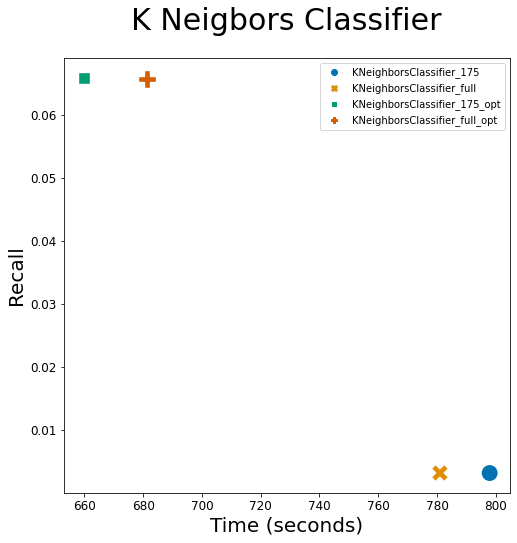

In [436]:
plt.figure(figsize = (8, 8))
sns.scatterplot(data = df_resultados_knc_opt, x = df_resultados_knc_opt['TIEMPO'],y = df_resultados_knc_opt['RECALL'], 
                hue = df_resultados_knc_opt.index, style = df_resultados_knc_opt.index, palette = 'colorblind', s = 300) 
plt.xlabel('Time (seconds)', y = -0.8, fontsize = 20)
plt.ylabel('Recall', x = -1, fontsize = 20)
plt.yticks(fontsize = 12)
plt.xticks(fontsize = 12)
plt.title('K Neigbors Classifier', y = 1.05, fontsize = 30)
plt.show()

El modelo K Neighbors Classifier fulldataset con los hiperparámetros optimizados obtiene un mejor resultado que el modelo que utiliza los hiperparámetros default. Es por ello que en la etapa de Model Stacking se utilizarán esos hiperparámetros optimizados. 

<br>

<br>

<br>

<br>


<font size='6' style="color:orange">  <b> Model Stacking </b> </font>
<a name="stacking"></a>

[[ Back to Top ]](#content)

Se realizará stacking de modelos de forma tal que se pueda encontrar un modelo que arroje el mejor resultado, buscando la relación más óptima entre el recall y el tiempo de ejecución del modelo. Para ello se utilizarán tanto modelos optimizados como sin optimizar. 

<br>

In [8]:
skf = StratifiedKFold(n_splits = 10, shuffle = True, random_state = 1 )

<br>

<font size='5' style="color:orange">  <b> GaussianNB x 3</b> </font>
<a name="ensemble_2"></a>

[[ Back to Top ]](#content)

In [12]:
gnb = GaussianNB()
gnb2 = GaussianNB()
gnb3 = GaussianNB()
gnb_final = GaussianNB()

In [13]:
ensemble_2 =  StackingClassifier (estimators = [ ('gnb',gnb), ('gnb2',gnb2), ('gnb3',gnb3)], final_estimator = gnb_final)

In [14]:
e2_results    = []
e2_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_2.fit(X_train, y_train)
    
    y_pred = ensemble_2.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e2_results.append(list_results)
    e2_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [15]:
filas    = ['Ensemble GaussianNB x 3 + Final GassianNB']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e2_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble GaussianNB x 3 + Final GassianNB,0.541327,0.561671,0.551273


In [16]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB x 3 + Final GassianNB,0.541327,0.561671,0.551273,137.101123


In [17]:
resultados.to_pickle("resultados_e2.pkl")

In [18]:
resultados_cm= gmean(e2_results_cm)
resultados_cm 

array([[[17033.23701796,   955.79182738],
        [  880.5975707 ,  1128.84563809]]])

In [19]:
with open('resultados_e2_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> GaussianNB x 6</b> </font>
<a name="ensemble_3"></a>

[[ Back to Top ]](#content)

In [20]:
gnb = GaussianNB()
gnb2 = GaussianNB()
gnb3 = GaussianNB()
gnb4 = GaussianNB()
gnb5 = GaussianNB()
gnb6 = GaussianNB()
gnb_final = GaussianNB()

In [21]:
ensemble_3 =  StackingClassifier (estimators = [ ('gnb',gnb), ('gnb2',gnb2), ('gnb3',gnb3), 
                                                 ('gnb4',gnb4), ('gnb5',gnb5), ('gnb6',gnb6)], final_estimator = gnb_final)

In [22]:
e3_results    = []
e3_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_3.fit(X_train, y_train)
    
    y_pred = ensemble_3.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e3_results.append(list_results)
    e3_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [23]:
filas    = ['Ensemble GaussianNB x 6 + Final GaussianNB']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e3_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble GaussianNB x 6 + Final GaussianNB,0.51998,0.58331,0.549795


In [24]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB x 6 + Final GaussianNB,0.51998,0.58331,0.549795,276.241724


In [25]:
resultados.to_pickle("resultados_e3.pkl")

In [26]:
resultados_cm= gmean(e3_results_cm)
resultados_cm 

array([[[16907.54416649,  1081.7287435 ],
        [  837.06552723,  1172.33607711]]])

In [27]:
with open('resultados_e3_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> GaussianNB x 12</b> </font>
<a name="ensemble_4"></a>

[[ Back to Top ]](#content)

In [28]:
gnb = GaussianNB()
gnb2 = GaussianNB()
gnb3 = GaussianNB()
gnb4 = GaussianNB()
gnb5 = GaussianNB()
gnb6 = GaussianNB()
gnb7 = GaussianNB()
gnb8 = GaussianNB()
gnb9 = GaussianNB()
gnb10 = GaussianNB()
gnb11 = GaussianNB()
gnb12 = GaussianNB()
gnb_final = GaussianNB()

In [29]:
ensemble_4 =  StackingClassifier (estimators = [ ('gnb',gnb), ('gnb2',gnb2), ('gnb3',gnb3), 
                                                 ('gnb4',gnb4), ('gnb5',gnb5), ('gnb6',gnb6),
                                                 ('gnb7',gnb7), ('gnb8',gnb8), ('gnb9',gnb9), 
                                                 ('gnb10',gnb10), ('gnb11',gnb11), ('gnb12',gnb12)],
                                                 final_estimator = gnb_final)

In [30]:
e4_results    = []
e4_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_4.fit(X_train, y_train)
    
    y_pred = ensemble_4.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e4_results.append(list_results)
    e4_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [31]:
filas    = ['Ensemble GaussianNB x 12 + Final GaussianNB']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e4_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble GaussianNB x 12 + Final GaussianNB,0.508631,0.596489,0.549036


In [32]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB x 12 + Final GaussianNB,0.508631,0.596489,0.549036,534.493685


In [33]:
resultados.to_pickle("resultados_e4.pkl")

In [34]:
resultados_cm= gmean(e4_results_cm)
resultados_cm 

array([[[16831.63950851,  1157.6188637 ],
        [  810.52995485,  1198.82268297]]])

In [35]:
with open('resultados_e4_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> GaussianNB x 24 </b> </font>
<a name="ensemble_5"></a>

[[ Back to Top ]](#content)

In [36]:
gnb = GaussianNB()
gnb2 = GaussianNB()
gnb3 = GaussianNB()
gnb4 = GaussianNB()
gnb5 = GaussianNB()
gnb6 = GaussianNB()
gnb7 = GaussianNB()
gnb8 = GaussianNB()
gnb9 = GaussianNB()
gnb10 = GaussianNB()
gnb11 = GaussianNB()
gnb12 = GaussianNB()
gnb13 = GaussianNB()
gnb14 = GaussianNB()
gnb15 = GaussianNB()
gnb16 = GaussianNB()
gnb17 = GaussianNB()
gnb18 = GaussianNB()
gnb19 = GaussianNB()
gnb20 = GaussianNB()
gnb21 = GaussianNB()
gnb22 = GaussianNB()
gnb23 = GaussianNB()
gnb24 = GaussianNB()
gnb_final = GaussianNB()

In [37]:
ensemble_5 =  StackingClassifier (estimators = [ ('gnb',gnb), ('gnb2',gnb2), ('gnb3',gnb3), ('gnb4',gnb4), ('gnb5',gnb5), 
                                                ('gnb6',gnb6),('gnb7',gnb7), ('gnb8',gnb8), ('gnb9',gnb9), ('gnb10',gnb10), 
                                                ('gnb11',gnb11), ('gnb12',gnb12),('gnb13',gnb13),('gnb14',gnb14), 
                                                ('gnb15',gnb15), ('gnb16',gnb16),('gnb17',gnb17), ('gnb18',gnb18), 
                                                ('gnb19',gnb19), ('gnb20',gnb20), ('gnb21',gnb21), ('gnb22',gnb22),
                                                ('gnb23',gnb23), ('gnb24',gnb24)], final_estimator = gnb_final)

In [38]:
e5_results    = []
e5_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_5.fit(X_train, y_train)
    
    y_pred = ensemble_5.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e5_results.append(list_results)
    e5_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [39]:
filas    = ['Ensemble GaussianNB x 24 + Final GaussianNB']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e5_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble GaussianNB x 24 + Final GaussianNB,0.502216,0.60296,0.547965


In [40]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB x 24 + Final GaussianNB,0.502216,0.60296,0.547965,1013.523686


In [41]:
resultados.to_pickle("resultados_e5.pkl")

In [42]:
resultados_cm = gmean(e5_results_cm)
resultados_cm 

array([[[16788.63481105,  1200.59103611],
        [  797.53005772,  1211.82804684]]])

In [43]:
with open('resultados_e5_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> GaussianNB + Logistic Regression (Final GaussianNB)</b> </font>
<a name="ensemble_6"></a>

[[ Back to Top ]](#content)

In [44]:
gnb = GaussianNB()
lgr = LogisticRegression(max_iter = 7000)
gnb_final = GaussianNB()

In [45]:
ensemble_6 =  StackingClassifier (estimators = [ ('gnb',gnb), ('lgr',lgr)], final_estimator = gnb_final)

In [46]:
e6_results    = []
e6_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_6.fit(X_train, y_train)
    
    y_pred = ensemble_6.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e6_results.append(list_results)
    e6_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [47]:
filas    = ['Ensemble GaussianNB + Logistic Regression + Final GaussianNB']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e6_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble GaussianNB + Logistic Regression + Final GaussianNB,0.541653,0.530205,0.535842


In [48]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB + Logistic Regression + Final GaussianNB,0.541653,0.530205,0.535842,4838.985724


In [49]:
resultados.to_pickle("resultados_e6.pkl")

In [50]:
resultados_cm = gmean(e6_results_cm)
resultados_cm 

array([[[17088.26123245,   901.16013791],
        [  943.77230563,  1065.60619108]]])

In [51]:
with open('resultados_e6_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> Logistic Regression + GaussianNB (Final Logistic Regression) </b> </font>
<a name="ensemble_7"></a>

[[ Back to Top ]](#content)

In [52]:
gnb = GaussianNB()
lgr = LogisticRegression(max_iter = 7000)
lgr_final = LogisticRegression(max_iter = 7000)

In [53]:
ensemble_7 =  StackingClassifier (estimators = [ ('gnb',gnb), ('lgr',lgr)], final_estimator = lgr_final)

In [54]:
e7_results    = []
e7_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_7.fit(X_train, y_train)
    
    y_pred = ensemble_7.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e7_results.append(list_results)
    e7_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [55]:
filas    = ['Ensemble GaussianNB + Logistic Regression + Final GaussianNB']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e7_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble GaussianNB + Logistic Regression + Final GaussianNB,0.704308,0.374719,0.489145


In [56]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB + Logistic Regression + Final GaussianNB,0.704308,0.374719,0.489145,4804.446089


In [57]:
resultados.to_pickle("resultados_e7.pkl")

In [78]:
# Renombro el índice ya que por error le había asignado otro nombre
resultados_cb_full = pd.read_pickle('resultados_e7.pkl')
resultados_cb_full.index= ['Ensemble GaussianNB + Logistic Regression + Final Logistic Regression']
resultados_cb_full.to_pickle("resultados_e7.pkl")
resultados_cb_full

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB + Logistic Regression + Final Logistic Regression,0.704308,0.374719,0.489145,4804.446089


In [58]:
resultados_cm= gmean(e7_results_cm)
resultados_cm 

array([[[17673.88954425,   315.69858819],
        [ 1256.38503915,   753.11083107]]])

In [59]:
with open('resultados_e7_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

Para ver cuál de los dos modelos convenía utilizarse como final estimator, se realizaron dos ensambles diferentes. Por un lado uno con los modelos Logistic Regression + GaussianNB con Logistic Regression como final estimator y por el otro un ensamble con los modelos Logistic Regression + GaussianNB con GaussianNB como final estimator. Se puede observar que este útilmo obtuvo un mejor resultado.

<br>

<br>

<font size='5' style="color:orange">  <b> Logistic Regression + Catboost Classifier (Final Catboost Classifier) </b> </font>
<a name="ensemble_8"></a>

[[ Back to Top ]](#content)

In [149]:
lgr = LogisticRegression(max_iter = 7000)
cb = CatBoostClassifier()
cb_final = CatBoostClassifier()

In [150]:
ensemble_8 =  StackingClassifier (estimators = [ ('lgr',lgr), ('cb',cb)], final_estimator = cb_final)


In [ ]:
e8_results    = []
e8_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_8.fit(X_train, y_train)
    
    y_pred = ensemble_8.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e8_results.append(list_results)
    e8_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [132]:
filas    = ['Ensemble Lgr + Catboost (Final Catboost)']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e8_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble Lgr + Catboost (Final Catboost),0.714156,0.392728,0.506712


In [133]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble Lgr + Catboost (Final Catboost),0.714156,0.392728,0.506712,11731.662214


In [134]:
resultados.to_pickle("resultados_e8.pkl")

In [135]:
resultados_cm= gmean(e8_results_cm)
resultados_cm 

array([[[17673.98790785,   315.53104694],
        [ 1220.00911767,   789.30386391]]])

In [136]:
with open('resultados_e8_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> Logistic Regression + Catboost Classifier + GaussianNB (Final GaussianNb)</b> </font>
<a name="ensemble_9"></a>

[[ Back to Top ]](#content)

In [152]:
lgr = LogisticRegression(max_iter = 7000)
cb = CatBoostClassifier() 
gnb = GaussianNB()
gnb_final = GaussianNB()

In [154]:
ensemble_9 =  StackingClassifier (estimators = [ ('lgr',lgr), ('cb',cb), ('gnb',gnb)], final_estimator = gnb_final)


In [155]:
e9_results    = []
e9_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_9.fit(X_train, y_train)
    
    y_pred = ensemble_9.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e9_results.append(list_results)
    e9_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

Learning rate set to 0.09461
0:	learn: 0.6142038	total: 65.1ms	remaining: 1m 5s
1:	learn: 0.5502873	total: 134ms	remaining: 1m 6s
2:	learn: 0.5015346	total: 213ms	remaining: 1m 10s
3:	learn: 0.4635310	total: 295ms	remaining: 1m 13s
4:	learn: 0.4322948	total: 371ms	remaining: 1m 13s
5:	learn: 0.4070403	total: 435ms	remaining: 1m 12s
6:	learn: 0.3867937	total: 506ms	remaining: 1m 11s
7:	learn: 0.3706352	total: 564ms	remaining: 1m 9s
8:	learn: 0.3580597	total: 630ms	remaining: 1m 9s
9:	learn: 0.3479389	total: 705ms	remaining: 1m 9s
10:	learn: 0.3398434	total: 768ms	remaining: 1m 9s
11:	learn: 0.3322477	total: 828ms	remaining: 1m 8s
12:	learn: 0.3264440	total: 884ms	remaining: 1m 7s
13:	learn: 0.3212962	total: 948ms	remaining: 1m 6s
14:	learn: 0.3171745	total: 1.01s	remaining: 1m 6s
15:	learn: 0.3136426	total: 1.06s	remaining: 1m 5s
16:	learn: 0.3104751	total: 1.11s	remaining: 1m 4s
17:	learn: 0.3078731	total: 1.17s	remaining: 1m 3s
18:	learn: 0.3055370	total: 1.23s	remaining: 1m 3s
19:	le

164:	learn: 0.2306189	total: 10.5s	remaining: 53.3s
165:	learn: 0.2303548	total: 10.6s	remaining: 53.3s
166:	learn: 0.2301090	total: 10.7s	remaining: 53.2s
167:	learn: 0.2298659	total: 10.7s	remaining: 53.2s
168:	learn: 0.2296394	total: 10.8s	remaining: 53.1s
169:	learn: 0.2294082	total: 10.9s	remaining: 53.1s
170:	learn: 0.2291841	total: 10.9s	remaining: 53s
171:	learn: 0.2289364	total: 11s	remaining: 53s
172:	learn: 0.2287056	total: 11.1s	remaining: 52.9s
173:	learn: 0.2284449	total: 11.1s	remaining: 52.9s
174:	learn: 0.2282165	total: 11.2s	remaining: 52.7s
175:	learn: 0.2280002	total: 11.2s	remaining: 52.7s
176:	learn: 0.2277399	total: 11.3s	remaining: 52.6s
177:	learn: 0.2275053	total: 11.4s	remaining: 52.6s
178:	learn: 0.2272979	total: 11.4s	remaining: 52.5s
179:	learn: 0.2270767	total: 11.5s	remaining: 52.4s
180:	learn: 0.2268469	total: 11.6s	remaining: 52.4s
181:	learn: 0.2266316	total: 11.6s	remaining: 52.4s
182:	learn: 0.2264050	total: 11.7s	remaining: 52.3s
183:	learn: 0.2261

326:	learn: 0.2030588	total: 21.2s	remaining: 43.7s
327:	learn: 0.2029347	total: 21.3s	remaining: 43.6s
328:	learn: 0.2028085	total: 21.3s	remaining: 43.5s
329:	learn: 0.2026965	total: 21.4s	remaining: 43.5s
330:	learn: 0.2025661	total: 21.5s	remaining: 43.4s
331:	learn: 0.2024338	total: 21.5s	remaining: 43.4s
332:	learn: 0.2023132	total: 21.6s	remaining: 43.3s
333:	learn: 0.2022004	total: 21.7s	remaining: 43.2s
334:	learn: 0.2020762	total: 21.7s	remaining: 43.1s
335:	learn: 0.2019654	total: 21.8s	remaining: 43.1s
336:	learn: 0.2018397	total: 21.9s	remaining: 43s
337:	learn: 0.2017325	total: 21.9s	remaining: 42.9s
338:	learn: 0.2016174	total: 22s	remaining: 42.9s
339:	learn: 0.2014878	total: 22s	remaining: 42.8s
340:	learn: 0.2013604	total: 22.1s	remaining: 42.7s
341:	learn: 0.2012432	total: 22.2s	remaining: 42.7s
342:	learn: 0.2011109	total: 22.3s	remaining: 42.6s
343:	learn: 0.2009930	total: 22.3s	remaining: 42.6s
344:	learn: 0.2008642	total: 22.4s	remaining: 42.5s
345:	learn: 0.2007

485:	learn: 0.1866770	total: 31.9s	remaining: 33.8s
486:	learn: 0.1865926	total: 32s	remaining: 33.7s
487:	learn: 0.1865167	total: 32.1s	remaining: 33.6s
488:	learn: 0.1864231	total: 32.1s	remaining: 33.6s
489:	learn: 0.1863288	total: 32.2s	remaining: 33.5s
490:	learn: 0.1862551	total: 32.3s	remaining: 33.4s
491:	learn: 0.1861638	total: 32.3s	remaining: 33.4s
492:	learn: 0.1860791	total: 32.4s	remaining: 33.3s
493:	learn: 0.1859942	total: 32.5s	remaining: 33.3s
494:	learn: 0.1859187	total: 32.5s	remaining: 33.2s
495:	learn: 0.1858380	total: 32.6s	remaining: 33.1s
496:	learn: 0.1857576	total: 32.7s	remaining: 33.1s
497:	learn: 0.1856768	total: 32.7s	remaining: 33s
498:	learn: 0.1855888	total: 32.8s	remaining: 32.9s
499:	learn: 0.1855075	total: 32.9s	remaining: 32.9s
500:	learn: 0.1854214	total: 32.9s	remaining: 32.8s
501:	learn: 0.1853293	total: 33s	remaining: 32.7s
502:	learn: 0.1852444	total: 33.1s	remaining: 32.7s
503:	learn: 0.1851575	total: 33.1s	remaining: 32.6s
504:	learn: 0.1850

645:	learn: 0.1744701	total: 43.2s	remaining: 23.7s
646:	learn: 0.1743927	total: 43.3s	remaining: 23.6s
647:	learn: 0.1743089	total: 43.3s	remaining: 23.5s
648:	learn: 0.1742425	total: 43.4s	remaining: 23.5s
649:	learn: 0.1741921	total: 43.5s	remaining: 23.4s
650:	learn: 0.1741049	total: 43.5s	remaining: 23.3s
651:	learn: 0.1740426	total: 43.6s	remaining: 23.3s
652:	learn: 0.1739703	total: 43.7s	remaining: 23.2s
653:	learn: 0.1739081	total: 43.7s	remaining: 23.1s
654:	learn: 0.1738384	total: 43.8s	remaining: 23.1s
655:	learn: 0.1737571	total: 43.9s	remaining: 23s
656:	learn: 0.1736926	total: 43.9s	remaining: 22.9s
657:	learn: 0.1736270	total: 44s	remaining: 22.9s
658:	learn: 0.1735605	total: 44.1s	remaining: 22.8s
659:	learn: 0.1734865	total: 44.1s	remaining: 22.7s
660:	learn: 0.1734095	total: 44.2s	remaining: 22.7s
661:	learn: 0.1733406	total: 44.3s	remaining: 22.6s
662:	learn: 0.1732736	total: 44.3s	remaining: 22.5s
663:	learn: 0.1732152	total: 44.4s	remaining: 22.5s
664:	learn: 0.17

804:	learn: 0.1644805	total: 54.8s	remaining: 13.3s
805:	learn: 0.1644272	total: 54.8s	remaining: 13.2s
806:	learn: 0.1643749	total: 54.9s	remaining: 13.1s
807:	learn: 0.1643157	total: 55s	remaining: 13.1s
808:	learn: 0.1642647	total: 55s	remaining: 13s
809:	learn: 0.1642073	total: 55.1s	remaining: 12.9s
810:	learn: 0.1641522	total: 55.2s	remaining: 12.9s
811:	learn: 0.1640929	total: 55.2s	remaining: 12.8s
812:	learn: 0.1640352	total: 55.3s	remaining: 12.7s
813:	learn: 0.1639790	total: 55.4s	remaining: 12.6s
814:	learn: 0.1639288	total: 55.4s	remaining: 12.6s
815:	learn: 0.1638703	total: 55.5s	remaining: 12.5s
816:	learn: 0.1638278	total: 55.5s	remaining: 12.4s
817:	learn: 0.1637740	total: 55.6s	remaining: 12.4s
818:	learn: 0.1637200	total: 55.7s	remaining: 12.3s
819:	learn: 0.1636733	total: 55.7s	remaining: 12.2s
820:	learn: 0.1636052	total: 55.8s	remaining: 12.2s
821:	learn: 0.1635383	total: 55.9s	remaining: 12.1s
822:	learn: 0.1634809	total: 56s	remaining: 12s
823:	learn: 0.1634299	

964:	learn: 0.1558601	total: 1m 5s	remaining: 2.38s
965:	learn: 0.1558119	total: 1m 5s	remaining: 2.31s
966:	learn: 0.1557762	total: 1m 5s	remaining: 2.25s
967:	learn: 0.1557199	total: 1m 5s	remaining: 2.18s
968:	learn: 0.1556710	total: 1m 5s	remaining: 2.11s
969:	learn: 0.1556132	total: 1m 6s	remaining: 2.04s
970:	learn: 0.1555623	total: 1m 6s	remaining: 1.97s
971:	learn: 0.1555170	total: 1m 6s	remaining: 1.9s
972:	learn: 0.1554723	total: 1m 6s	remaining: 1.84s
973:	learn: 0.1554254	total: 1m 6s	remaining: 1.77s
974:	learn: 0.1553786	total: 1m 6s	remaining: 1.7s
975:	learn: 0.1553227	total: 1m 6s	remaining: 1.63s
976:	learn: 0.1552658	total: 1m 6s	remaining: 1.56s
977:	learn: 0.1552054	total: 1m 6s	remaining: 1.5s
978:	learn: 0.1551523	total: 1m 6s	remaining: 1.43s
979:	learn: 0.1551046	total: 1m 6s	remaining: 1.36s
980:	learn: 0.1550522	total: 1m 6s	remaining: 1.29s
981:	learn: 0.1550205	total: 1m 6s	remaining: 1.22s
982:	learn: 0.1549631	total: 1m 6s	remaining: 1.16s
983:	learn: 0.1

126:	learn: 0.2435608	total: 5.89s	remaining: 40.5s
127:	learn: 0.2432581	total: 5.94s	remaining: 40.5s
128:	learn: 0.2429510	total: 5.99s	remaining: 40.5s
129:	learn: 0.2426640	total: 6.04s	remaining: 40.4s
130:	learn: 0.2423761	total: 6.08s	remaining: 40.4s
131:	learn: 0.2421127	total: 6.13s	remaining: 40.3s
132:	learn: 0.2418460	total: 6.18s	remaining: 40.3s
133:	learn: 0.2415552	total: 6.22s	remaining: 40.2s
134:	learn: 0.2412696	total: 6.27s	remaining: 40.2s
135:	learn: 0.2409782	total: 6.32s	remaining: 40.1s
136:	learn: 0.2407041	total: 6.36s	remaining: 40.1s
137:	learn: 0.2404370	total: 6.42s	remaining: 40.1s
138:	learn: 0.2401460	total: 6.48s	remaining: 40.1s
139:	learn: 0.2398534	total: 6.53s	remaining: 40.1s
140:	learn: 0.2395771	total: 6.58s	remaining: 40.1s
141:	learn: 0.2392776	total: 6.63s	remaining: 40.1s
142:	learn: 0.2390162	total: 6.68s	remaining: 40s
143:	learn: 0.2387235	total: 6.72s	remaining: 40s
144:	learn: 0.2384628	total: 6.77s	remaining: 39.9s
145:	learn: 0.23

286:	learn: 0.2094721	total: 13.7s	remaining: 34s
287:	learn: 0.2093272	total: 13.8s	remaining: 34s
288:	learn: 0.2091880	total: 13.8s	remaining: 34s
289:	learn: 0.2090421	total: 13.9s	remaining: 33.9s
290:	learn: 0.2089099	total: 13.9s	remaining: 33.9s
291:	learn: 0.2087571	total: 14s	remaining: 33.8s
292:	learn: 0.2086126	total: 14s	remaining: 33.8s
293:	learn: 0.2084720	total: 14.1s	remaining: 33.8s
294:	learn: 0.2083231	total: 14.1s	remaining: 33.7s
295:	learn: 0.2081585	total: 14.2s	remaining: 33.7s
296:	learn: 0.2080250	total: 14.2s	remaining: 33.6s
297:	learn: 0.2078827	total: 14.3s	remaining: 33.6s
298:	learn: 0.2077403	total: 14.3s	remaining: 33.6s
299:	learn: 0.2076022	total: 14.4s	remaining: 33.5s
300:	learn: 0.2074388	total: 14.4s	remaining: 33.5s
301:	learn: 0.2072937	total: 14.5s	remaining: 33.4s
302:	learn: 0.2071467	total: 14.5s	remaining: 33.4s
303:	learn: 0.2069987	total: 14.6s	remaining: 33.3s
304:	learn: 0.2068601	total: 14.6s	remaining: 33.3s
305:	learn: 0.2067206	

446:	learn: 0.1899071	total: 22s	remaining: 27.2s
447:	learn: 0.1898149	total: 22s	remaining: 27.1s
448:	learn: 0.1897111	total: 22.1s	remaining: 27.1s
449:	learn: 0.1896157	total: 22.1s	remaining: 27s
450:	learn: 0.1895283	total: 22.2s	remaining: 27s
451:	learn: 0.1894222	total: 22.2s	remaining: 26.9s
452:	learn: 0.1893214	total: 22.3s	remaining: 26.9s
453:	learn: 0.1892137	total: 22.3s	remaining: 26.9s
454:	learn: 0.1891019	total: 22.4s	remaining: 26.8s
455:	learn: 0.1890061	total: 22.4s	remaining: 26.8s
456:	learn: 0.1889238	total: 22.5s	remaining: 26.7s
457:	learn: 0.1888284	total: 22.5s	remaining: 26.7s
458:	learn: 0.1887350	total: 22.6s	remaining: 26.6s
459:	learn: 0.1886295	total: 22.6s	remaining: 26.6s
460:	learn: 0.1885251	total: 22.7s	remaining: 26.5s
461:	learn: 0.1884393	total: 22.8s	remaining: 26.5s
462:	learn: 0.1883550	total: 22.8s	remaining: 26.4s
463:	learn: 0.1882673	total: 22.9s	remaining: 26.4s
464:	learn: 0.1881758	total: 22.9s	remaining: 26.4s
465:	learn: 0.188078

607:	learn: 0.1756998	total: 30.4s	remaining: 19.6s
608:	learn: 0.1756263	total: 30.4s	remaining: 19.5s
609:	learn: 0.1755555	total: 30.5s	remaining: 19.5s
610:	learn: 0.1754807	total: 30.5s	remaining: 19.4s
611:	learn: 0.1754004	total: 30.6s	remaining: 19.4s
612:	learn: 0.1753231	total: 30.6s	remaining: 19.3s
613:	learn: 0.1752462	total: 30.7s	remaining: 19.3s
614:	learn: 0.1751645	total: 30.7s	remaining: 19.2s
615:	learn: 0.1750885	total: 30.8s	remaining: 19.2s
616:	learn: 0.1750044	total: 30.8s	remaining: 19.1s
617:	learn: 0.1749224	total: 30.9s	remaining: 19.1s
618:	learn: 0.1748501	total: 30.9s	remaining: 19s
619:	learn: 0.1747826	total: 31s	remaining: 19s
620:	learn: 0.1747019	total: 31s	remaining: 18.9s
621:	learn: 0.1746197	total: 31.1s	remaining: 18.9s
622:	learn: 0.1745413	total: 31.1s	remaining: 18.8s
623:	learn: 0.1744739	total: 31.2s	remaining: 18.8s
624:	learn: 0.1743790	total: 31.3s	remaining: 18.8s
625:	learn: 0.1742992	total: 31.3s	remaining: 18.7s
626:	learn: 0.174227

766:	learn: 0.1644329	total: 39.1s	remaining: 11.9s
767:	learn: 0.1643653	total: 39.2s	remaining: 11.8s
768:	learn: 0.1642985	total: 39.3s	remaining: 11.8s
769:	learn: 0.1642391	total: 39.3s	remaining: 11.7s
770:	learn: 0.1641748	total: 39.4s	remaining: 11.7s
771:	learn: 0.1641067	total: 39.4s	remaining: 11.6s
772:	learn: 0.1640381	total: 39.5s	remaining: 11.6s
773:	learn: 0.1639695	total: 39.5s	remaining: 11.5s
774:	learn: 0.1639138	total: 39.6s	remaining: 11.5s
775:	learn: 0.1638549	total: 39.6s	remaining: 11.4s
776:	learn: 0.1637930	total: 39.7s	remaining: 11.4s
777:	learn: 0.1637274	total: 39.8s	remaining: 11.3s
778:	learn: 0.1636679	total: 39.8s	remaining: 11.3s
779:	learn: 0.1635937	total: 39.9s	remaining: 11.2s
780:	learn: 0.1635215	total: 39.9s	remaining: 11.2s
781:	learn: 0.1634540	total: 40s	remaining: 11.1s
782:	learn: 0.1634076	total: 40s	remaining: 11.1s
783:	learn: 0.1633468	total: 40.1s	remaining: 11.1s
784:	learn: 0.1633053	total: 40.2s	remaining: 11s
785:	learn: 0.1632

927:	learn: 0.1545372	total: 47.8s	remaining: 3.71s
928:	learn: 0.1544608	total: 47.9s	remaining: 3.66s
929:	learn: 0.1544115	total: 47.9s	remaining: 3.61s
930:	learn: 0.1543563	total: 48s	remaining: 3.56s
931:	learn: 0.1542937	total: 48s	remaining: 3.5s
932:	learn: 0.1542376	total: 48.1s	remaining: 3.45s
933:	learn: 0.1541747	total: 48.1s	remaining: 3.4s
934:	learn: 0.1541146	total: 48.2s	remaining: 3.35s
935:	learn: 0.1540573	total: 48.2s	remaining: 3.3s
936:	learn: 0.1539965	total: 48.3s	remaining: 3.25s
937:	learn: 0.1539536	total: 48.3s	remaining: 3.19s
938:	learn: 0.1539002	total: 48.4s	remaining: 3.14s
939:	learn: 0.1538425	total: 48.4s	remaining: 3.09s
940:	learn: 0.1537980	total: 48.5s	remaining: 3.04s
941:	learn: 0.1537466	total: 48.5s	remaining: 2.99s
942:	learn: 0.1536776	total: 48.6s	remaining: 2.94s
943:	learn: 0.1536264	total: 48.6s	remaining: 2.88s
944:	learn: 0.1535712	total: 48.7s	remaining: 2.83s
945:	learn: 0.1535126	total: 48.7s	remaining: 2.78s
946:	learn: 0.15345

87:	learn: 0.2569184	total: 4.3s	remaining: 44.5s
88:	learn: 0.2565214	total: 4.35s	remaining: 44.5s
89:	learn: 0.2561422	total: 4.39s	remaining: 44.4s
90:	learn: 0.2557468	total: 4.44s	remaining: 44.3s
91:	learn: 0.2553525	total: 4.49s	remaining: 44.3s
92:	learn: 0.2549635	total: 4.54s	remaining: 44.3s
93:	learn: 0.2545700	total: 4.59s	remaining: 44.3s
94:	learn: 0.2541695	total: 4.64s	remaining: 44.2s
95:	learn: 0.2537524	total: 4.68s	remaining: 44.1s
96:	learn: 0.2533879	total: 4.72s	remaining: 44s
97:	learn: 0.2530126	total: 4.77s	remaining: 43.9s
98:	learn: 0.2526291	total: 4.82s	remaining: 43.9s
99:	learn: 0.2522884	total: 4.87s	remaining: 43.8s
100:	learn: 0.2519028	total: 4.91s	remaining: 43.7s
101:	learn: 0.2515298	total: 4.97s	remaining: 43.7s
102:	learn: 0.2511543	total: 5.02s	remaining: 43.7s
103:	learn: 0.2508330	total: 5.07s	remaining: 43.7s
104:	learn: 0.2504739	total: 5.12s	remaining: 43.6s
105:	learn: 0.2500894	total: 5.17s	remaining: 43.6s
106:	learn: 0.2497132	total:

247:	learn: 0.2152741	total: 12.5s	remaining: 37.8s
248:	learn: 0.2150957	total: 12.6s	remaining: 37.9s
249:	learn: 0.2149392	total: 12.6s	remaining: 37.8s
250:	learn: 0.2147823	total: 12.7s	remaining: 37.8s
251:	learn: 0.2146025	total: 12.7s	remaining: 37.7s
252:	learn: 0.2144240	total: 12.8s	remaining: 37.7s
253:	learn: 0.2142507	total: 12.8s	remaining: 37.7s
254:	learn: 0.2140731	total: 12.9s	remaining: 37.6s
255:	learn: 0.2138984	total: 12.9s	remaining: 37.6s
256:	learn: 0.2137365	total: 13s	remaining: 37.6s
257:	learn: 0.2135669	total: 13s	remaining: 37.5s
258:	learn: 0.2134143	total: 13.1s	remaining: 37.5s
259:	learn: 0.2132623	total: 13.1s	remaining: 37.4s
260:	learn: 0.2130879	total: 13.2s	remaining: 37.3s
261:	learn: 0.2129211	total: 13.2s	remaining: 37.3s
262:	learn: 0.2127670	total: 13.3s	remaining: 37.3s
263:	learn: 0.2126084	total: 13.4s	remaining: 37.2s
264:	learn: 0.2124370	total: 13.4s	remaining: 37.2s
265:	learn: 0.2122751	total: 13.5s	remaining: 37.1s
266:	learn: 0.21

408:	learn: 0.1935165	total: 21.3s	remaining: 30.8s
409:	learn: 0.1934184	total: 21.4s	remaining: 30.8s
410:	learn: 0.1933099	total: 21.5s	remaining: 30.8s
411:	learn: 0.1932075	total: 21.5s	remaining: 30.7s
412:	learn: 0.1930935	total: 21.6s	remaining: 30.7s
413:	learn: 0.1929867	total: 21.7s	remaining: 30.7s
414:	learn: 0.1928645	total: 21.7s	remaining: 30.6s
415:	learn: 0.1927331	total: 21.8s	remaining: 30.6s
416:	learn: 0.1926227	total: 21.9s	remaining: 30.6s
417:	learn: 0.1925206	total: 22s	remaining: 30.6s
418:	learn: 0.1924043	total: 22s	remaining: 30.5s
419:	learn: 0.1922871	total: 22.1s	remaining: 30.5s
420:	learn: 0.1921768	total: 22.1s	remaining: 30.5s
421:	learn: 0.1920691	total: 22.2s	remaining: 30.4s
422:	learn: 0.1919697	total: 22.3s	remaining: 30.4s
423:	learn: 0.1918619	total: 22.3s	remaining: 30.3s
424:	learn: 0.1917543	total: 22.4s	remaining: 30.3s
425:	learn: 0.1916458	total: 22.5s	remaining: 30.3s
426:	learn: 0.1915309	total: 22.5s	remaining: 30.2s
427:	learn: 0.19

567:	learn: 0.1784302	total: 30.6s	remaining: 23.3s
568:	learn: 0.1783439	total: 30.7s	remaining: 23.2s
569:	learn: 0.1782642	total: 30.7s	remaining: 23.2s
570:	learn: 0.1781722	total: 30.8s	remaining: 23.1s
571:	learn: 0.1780856	total: 30.8s	remaining: 23.1s
572:	learn: 0.1780038	total: 30.9s	remaining: 23s
573:	learn: 0.1779167	total: 30.9s	remaining: 23s
574:	learn: 0.1778289	total: 31s	remaining: 22.9s
575:	learn: 0.1777615	total: 31.1s	remaining: 22.9s
576:	learn: 0.1776737	total: 31.1s	remaining: 22.8s
577:	learn: 0.1775896	total: 31.2s	remaining: 22.8s
578:	learn: 0.1774990	total: 31.2s	remaining: 22.7s
579:	learn: 0.1774201	total: 31.3s	remaining: 22.7s
580:	learn: 0.1773374	total: 31.4s	remaining: 22.6s
581:	learn: 0.1772639	total: 31.4s	remaining: 22.6s
582:	learn: 0.1771787	total: 31.5s	remaining: 22.5s
583:	learn: 0.1770959	total: 31.5s	remaining: 22.4s
584:	learn: 0.1770221	total: 31.6s	remaining: 22.4s
585:	learn: 0.1769320	total: 31.6s	remaining: 22.3s
586:	learn: 0.1768

729:	learn: 0.1663149	total: 39.3s	remaining: 14.5s
730:	learn: 0.1662335	total: 39.4s	remaining: 14.5s
731:	learn: 0.1661568	total: 39.4s	remaining: 14.4s
732:	learn: 0.1660936	total: 39.5s	remaining: 14.4s
733:	learn: 0.1660244	total: 39.6s	remaining: 14.3s
734:	learn: 0.1659468	total: 39.6s	remaining: 14.3s
735:	learn: 0.1658905	total: 39.7s	remaining: 14.2s
736:	learn: 0.1658243	total: 39.7s	remaining: 14.2s
737:	learn: 0.1657533	total: 39.8s	remaining: 14.1s
738:	learn: 0.1656797	total: 39.8s	remaining: 14.1s
739:	learn: 0.1656243	total: 39.9s	remaining: 14s
740:	learn: 0.1655500	total: 39.9s	remaining: 14s
741:	learn: 0.1654784	total: 40s	remaining: 13.9s
742:	learn: 0.1653911	total: 40s	remaining: 13.9s
743:	learn: 0.1653270	total: 40.1s	remaining: 13.8s
744:	learn: 0.1652559	total: 40.2s	remaining: 13.7s
745:	learn: 0.1651841	total: 40.2s	remaining: 13.7s
746:	learn: 0.1651202	total: 40.3s	remaining: 13.6s
747:	learn: 0.1650427	total: 40.3s	remaining: 13.6s
748:	learn: 0.164971

888:	learn: 0.1559539	total: 47.9s	remaining: 5.97s
889:	learn: 0.1558858	total: 47.9s	remaining: 5.92s
890:	learn: 0.1558307	total: 48s	remaining: 5.87s
891:	learn: 0.1557644	total: 48s	remaining: 5.82s
892:	learn: 0.1556895	total: 48.1s	remaining: 5.76s
893:	learn: 0.1556272	total: 48.1s	remaining: 5.71s
894:	learn: 0.1555610	total: 48.2s	remaining: 5.65s
895:	learn: 0.1554976	total: 48.2s	remaining: 5.6s
896:	learn: 0.1554331	total: 48.3s	remaining: 5.54s
897:	learn: 0.1553711	total: 48.4s	remaining: 5.49s
898:	learn: 0.1553217	total: 48.4s	remaining: 5.44s
899:	learn: 0.1552559	total: 48.5s	remaining: 5.38s
900:	learn: 0.1552091	total: 48.5s	remaining: 5.33s
901:	learn: 0.1551480	total: 48.6s	remaining: 5.28s
902:	learn: 0.1550887	total: 48.6s	remaining: 5.22s
903:	learn: 0.1550285	total: 48.7s	remaining: 5.17s
904:	learn: 0.1549734	total: 48.7s	remaining: 5.12s
905:	learn: 0.1549134	total: 48.8s	remaining: 5.06s
906:	learn: 0.1548566	total: 48.9s	remaining: 5.01s
907:	learn: 0.154

50:	learn: 0.2764280	total: 2.62s	remaining: 48.8s
51:	learn: 0.2758282	total: 2.67s	remaining: 48.8s
52:	learn: 0.2752765	total: 2.73s	remaining: 48.7s
53:	learn: 0.2746888	total: 2.78s	remaining: 48.6s
54:	learn: 0.2740327	total: 2.83s	remaining: 48.6s
55:	learn: 0.2734035	total: 2.88s	remaining: 48.6s
56:	learn: 0.2727704	total: 2.94s	remaining: 48.6s
57:	learn: 0.2722052	total: 2.98s	remaining: 48.4s
58:	learn: 0.2716446	total: 3.03s	remaining: 48.3s
59:	learn: 0.2710870	total: 3.08s	remaining: 48.2s
60:	learn: 0.2705021	total: 3.13s	remaining: 48.2s
61:	learn: 0.2699430	total: 3.19s	remaining: 48.2s
62:	learn: 0.2693890	total: 3.24s	remaining: 48.2s
63:	learn: 0.2688702	total: 3.28s	remaining: 48s
64:	learn: 0.2683208	total: 3.33s	remaining: 48s
65:	learn: 0.2678170	total: 3.38s	remaining: 47.9s
66:	learn: 0.2673171	total: 3.44s	remaining: 47.8s
67:	learn: 0.2667820	total: 3.49s	remaining: 47.9s
68:	learn: 0.2662914	total: 3.56s	remaining: 48s
69:	learn: 0.2657884	total: 3.61s	rem

211:	learn: 0.2227700	total: 11.1s	remaining: 41.2s
212:	learn: 0.2225837	total: 11.1s	remaining: 41.1s
213:	learn: 0.2223870	total: 11.2s	remaining: 41.1s
214:	learn: 0.2221901	total: 11.2s	remaining: 41s
215:	learn: 0.2219942	total: 11.3s	remaining: 41s
216:	learn: 0.2218047	total: 11.3s	remaining: 40.9s
217:	learn: 0.2216138	total: 11.4s	remaining: 40.9s
218:	learn: 0.2214023	total: 11.4s	remaining: 40.8s
219:	learn: 0.2212172	total: 11.5s	remaining: 40.8s
220:	learn: 0.2210060	total: 11.6s	remaining: 40.7s
221:	learn: 0.2208094	total: 11.6s	remaining: 40.7s
222:	learn: 0.2206338	total: 11.7s	remaining: 40.6s
223:	learn: 0.2204407	total: 11.7s	remaining: 40.6s
224:	learn: 0.2202563	total: 11.8s	remaining: 40.5s
225:	learn: 0.2200711	total: 11.8s	remaining: 40.5s
226:	learn: 0.2198712	total: 11.9s	remaining: 40.4s
227:	learn: 0.2196879	total: 11.9s	remaining: 40.4s
228:	learn: 0.2194885	total: 12s	remaining: 40.3s
229:	learn: 0.2192979	total: 12s	remaining: 40.3s
230:	learn: 0.219119

373:	learn: 0.1982103	total: 19.9s	remaining: 33.4s
374:	learn: 0.1980881	total: 20s	remaining: 33.3s
375:	learn: 0.1979579	total: 20.1s	remaining: 33.3s
376:	learn: 0.1978382	total: 20.1s	remaining: 33.2s
377:	learn: 0.1977039	total: 20.2s	remaining: 33.2s
378:	learn: 0.1975886	total: 20.2s	remaining: 33.1s
379:	learn: 0.1974671	total: 20.3s	remaining: 33.1s
380:	learn: 0.1973485	total: 20.3s	remaining: 33s
381:	learn: 0.1972436	total: 20.4s	remaining: 33s
382:	learn: 0.1971382	total: 20.4s	remaining: 32.9s
383:	learn: 0.1970178	total: 20.5s	remaining: 32.9s
384:	learn: 0.1968980	total: 20.5s	remaining: 32.8s
385:	learn: 0.1967740	total: 20.6s	remaining: 32.8s
386:	learn: 0.1966524	total: 20.7s	remaining: 32.7s
387:	learn: 0.1965316	total: 20.7s	remaining: 32.7s
388:	learn: 0.1964192	total: 20.8s	remaining: 32.7s
389:	learn: 0.1963009	total: 20.8s	remaining: 32.6s
390:	learn: 0.1961877	total: 20.9s	remaining: 32.6s
391:	learn: 0.1960752	total: 21s	remaining: 32.5s
392:	learn: 0.195958

534:	learn: 0.1819644	total: 28.9s	remaining: 25.1s
535:	learn: 0.1818848	total: 28.9s	remaining: 25.1s
536:	learn: 0.1817958	total: 29s	remaining: 25s
537:	learn: 0.1817109	total: 29.1s	remaining: 25s
538:	learn: 0.1816368	total: 29.1s	remaining: 24.9s
539:	learn: 0.1815463	total: 29.2s	remaining: 24.9s
540:	learn: 0.1814652	total: 29.2s	remaining: 24.8s
541:	learn: 0.1813762	total: 29.3s	remaining: 24.7s
542:	learn: 0.1812795	total: 29.3s	remaining: 24.7s
543:	learn: 0.1811930	total: 29.4s	remaining: 24.6s
544:	learn: 0.1811095	total: 29.5s	remaining: 24.6s
545:	learn: 0.1810253	total: 29.5s	remaining: 24.5s
546:	learn: 0.1809264	total: 29.6s	remaining: 24.5s
547:	learn: 0.1808364	total: 29.6s	remaining: 24.4s
548:	learn: 0.1807588	total: 29.7s	remaining: 24.4s
549:	learn: 0.1806840	total: 29.7s	remaining: 24.3s
550:	learn: 0.1806044	total: 29.8s	remaining: 24.3s
551:	learn: 0.1805064	total: 29.8s	remaining: 24.2s
552:	learn: 0.1804156	total: 29.9s	remaining: 24.2s
553:	learn: 0.1803

696:	learn: 0.1694111	total: 38.2s	remaining: 16.6s
697:	learn: 0.1693441	total: 38.3s	remaining: 16.5s
698:	learn: 0.1692663	total: 38.3s	remaining: 16.5s
699:	learn: 0.1691933	total: 38.4s	remaining: 16.4s
700:	learn: 0.1691256	total: 38.4s	remaining: 16.4s
701:	learn: 0.1690509	total: 38.5s	remaining: 16.3s
702:	learn: 0.1689738	total: 38.5s	remaining: 16.3s
703:	learn: 0.1689025	total: 38.6s	remaining: 16.2s
704:	learn: 0.1688198	total: 38.7s	remaining: 16.2s
705:	learn: 0.1687535	total: 38.7s	remaining: 16.1s
706:	learn: 0.1686866	total: 38.8s	remaining: 16.1s
707:	learn: 0.1686115	total: 38.8s	remaining: 16s
708:	learn: 0.1685442	total: 38.9s	remaining: 16s
709:	learn: 0.1684787	total: 38.9s	remaining: 15.9s
710:	learn: 0.1683960	total: 39s	remaining: 15.8s
711:	learn: 0.1683257	total: 39s	remaining: 15.8s
712:	learn: 0.1682611	total: 39.1s	remaining: 15.7s
713:	learn: 0.1681821	total: 39.1s	remaining: 15.7s
714:	learn: 0.1681044	total: 39.2s	remaining: 15.6s
715:	learn: 0.168044

857:	learn: 0.1589860	total: 47s	remaining: 7.78s
858:	learn: 0.1589087	total: 47.1s	remaining: 7.72s
859:	learn: 0.1588522	total: 47.1s	remaining: 7.67s
860:	learn: 0.1587956	total: 47.2s	remaining: 7.61s
861:	learn: 0.1587366	total: 47.2s	remaining: 7.56s
862:	learn: 0.1586761	total: 47.3s	remaining: 7.5s
863:	learn: 0.1586234	total: 47.3s	remaining: 7.45s
864:	learn: 0.1585619	total: 47.4s	remaining: 7.39s
865:	learn: 0.1585119	total: 47.4s	remaining: 7.34s
866:	learn: 0.1584483	total: 47.5s	remaining: 7.28s
867:	learn: 0.1583782	total: 47.5s	remaining: 7.23s
868:	learn: 0.1583287	total: 47.6s	remaining: 7.17s
869:	learn: 0.1582673	total: 47.6s	remaining: 7.12s
870:	learn: 0.1582014	total: 47.7s	remaining: 7.06s
871:	learn: 0.1581380	total: 47.7s	remaining: 7.01s
872:	learn: 0.1580732	total: 47.8s	remaining: 6.95s
873:	learn: 0.1580127	total: 47.8s	remaining: 6.9s
874:	learn: 0.1579453	total: 47.9s	remaining: 6.84s
875:	learn: 0.1578670	total: 48s	remaining: 6.79s
876:	learn: 0.1578

16:	learn: 0.3156793	total: 918ms	remaining: 53.1s
17:	learn: 0.3126560	total: 971ms	remaining: 53s
18:	learn: 0.3099044	total: 1.02s	remaining: 52.5s
19:	learn: 0.3073919	total: 1.06s	remaining: 52.1s
20:	learn: 0.3051288	total: 1.11s	remaining: 51.8s
21:	learn: 0.3032187	total: 1.16s	remaining: 51.6s
22:	learn: 0.3014383	total: 1.22s	remaining: 51.8s
23:	learn: 0.2998639	total: 1.27s	remaining: 51.5s
24:	learn: 0.2983691	total: 1.31s	remaining: 51.3s
25:	learn: 0.2969994	total: 1.36s	remaining: 50.9s
26:	learn: 0.2957661	total: 1.41s	remaining: 50.9s
27:	learn: 0.2946145	total: 1.46s	remaining: 50.8s
28:	learn: 0.2935213	total: 1.51s	remaining: 50.6s
29:	learn: 0.2924593	total: 1.55s	remaining: 50.2s
30:	learn: 0.2913471	total: 1.6s	remaining: 50.1s
31:	learn: 0.2904157	total: 1.65s	remaining: 49.9s
32:	learn: 0.2894648	total: 1.7s	remaining: 50s
33:	learn: 0.2885840	total: 1.75s	remaining: 49.8s
34:	learn: 0.2877219	total: 1.8s	remaining: 49.7s
35:	learn: 0.2868761	total: 1.84s	rema

180:	learn: 0.2291580	total: 9.38s	remaining: 42.4s
181:	learn: 0.2289471	total: 9.43s	remaining: 42.4s
182:	learn: 0.2287226	total: 9.49s	remaining: 42.4s
183:	learn: 0.2284808	total: 9.54s	remaining: 42.3s
184:	learn: 0.2282567	total: 9.6s	remaining: 42.3s
185:	learn: 0.2280318	total: 9.65s	remaining: 42.2s
186:	learn: 0.2277793	total: 9.71s	remaining: 42.2s
187:	learn: 0.2275451	total: 9.76s	remaining: 42.2s
188:	learn: 0.2273136	total: 9.82s	remaining: 42.1s
189:	learn: 0.2270772	total: 9.88s	remaining: 42.1s
190:	learn: 0.2268379	total: 9.93s	remaining: 42.1s
191:	learn: 0.2266337	total: 9.98s	remaining: 42s
192:	learn: 0.2264231	total: 10s	remaining: 41.9s
193:	learn: 0.2261925	total: 10.1s	remaining: 41.9s
194:	learn: 0.2259893	total: 10.1s	remaining: 41.8s
195:	learn: 0.2257788	total: 10.2s	remaining: 41.8s
196:	learn: 0.2255565	total: 10.2s	remaining: 41.7s
197:	learn: 0.2253459	total: 10.3s	remaining: 41.7s
198:	learn: 0.2251467	total: 10.4s	remaining: 41.7s
199:	learn: 0.224

339:	learn: 0.2019426	total: 18.4s	remaining: 35.7s
340:	learn: 0.2018008	total: 18.4s	remaining: 35.6s
341:	learn: 0.2016777	total: 18.5s	remaining: 35.6s
342:	learn: 0.2015537	total: 18.5s	remaining: 35.5s
343:	learn: 0.2014316	total: 18.6s	remaining: 35.5s
344:	learn: 0.2012998	total: 18.7s	remaining: 35.4s
345:	learn: 0.2011742	total: 18.7s	remaining: 35.4s
346:	learn: 0.2010367	total: 18.8s	remaining: 35.3s
347:	learn: 0.2009166	total: 18.8s	remaining: 35.2s
348:	learn: 0.2008041	total: 18.9s	remaining: 35.2s
349:	learn: 0.2006752	total: 18.9s	remaining: 35.1s
350:	learn: 0.2005456	total: 19s	remaining: 35.1s
351:	learn: 0.2004126	total: 19s	remaining: 35s
352:	learn: 0.2002973	total: 19.1s	remaining: 35s
353:	learn: 0.2001687	total: 19.1s	remaining: 34.9s
354:	learn: 0.2000520	total: 19.2s	remaining: 34.9s
355:	learn: 0.1999322	total: 19.3s	remaining: 34.8s
356:	learn: 0.1998116	total: 19.3s	remaining: 34.8s
357:	learn: 0.1996775	total: 19.4s	remaining: 34.8s
358:	learn: 0.199557

498:	learn: 0.1847387	total: 27.3s	remaining: 27.4s
499:	learn: 0.1846351	total: 27.4s	remaining: 27.4s
500:	learn: 0.1845324	total: 27.4s	remaining: 27.3s
501:	learn: 0.1844413	total: 27.5s	remaining: 27.3s
502:	learn: 0.1843434	total: 27.6s	remaining: 27.2s
503:	learn: 0.1842442	total: 27.6s	remaining: 27.2s
504:	learn: 0.1841482	total: 27.7s	remaining: 27.1s
505:	learn: 0.1840487	total: 27.7s	remaining: 27.1s
506:	learn: 0.1839617	total: 27.8s	remaining: 27s
507:	learn: 0.1838575	total: 27.8s	remaining: 26.9s
508:	learn: 0.1837569	total: 27.9s	remaining: 26.9s
509:	learn: 0.1836428	total: 27.9s	remaining: 26.8s
510:	learn: 0.1835430	total: 28s	remaining: 26.8s
511:	learn: 0.1834542	total: 28.1s	remaining: 26.8s
512:	learn: 0.1833763	total: 28.1s	remaining: 26.7s
513:	learn: 0.1832994	total: 28.2s	remaining: 26.6s
514:	learn: 0.1832109	total: 28.2s	remaining: 26.6s
515:	learn: 0.1831238	total: 28.3s	remaining: 26.5s
516:	learn: 0.1830314	total: 28.3s	remaining: 26.5s
517:	learn: 0.18

658:	learn: 0.1716063	total: 36.5s	remaining: 18.9s
659:	learn: 0.1715349	total: 36.6s	remaining: 18.8s
660:	learn: 0.1714729	total: 36.6s	remaining: 18.8s
661:	learn: 0.1714075	total: 36.6s	remaining: 18.7s
662:	learn: 0.1713459	total: 36.7s	remaining: 18.7s
663:	learn: 0.1712795	total: 36.8s	remaining: 18.6s
664:	learn: 0.1712008	total: 36.9s	remaining: 18.6s
665:	learn: 0.1711178	total: 36.9s	remaining: 18.5s
666:	learn: 0.1710509	total: 37s	remaining: 18.5s
667:	learn: 0.1709790	total: 37s	remaining: 18.4s
668:	learn: 0.1709043	total: 37.1s	remaining: 18.4s
669:	learn: 0.1708421	total: 37.2s	remaining: 18.3s
670:	learn: 0.1707688	total: 37.2s	remaining: 18.2s
671:	learn: 0.1706934	total: 37.3s	remaining: 18.2s
672:	learn: 0.1706188	total: 37.3s	remaining: 18.1s
673:	learn: 0.1705445	total: 37.4s	remaining: 18.1s
674:	learn: 0.1704648	total: 37.4s	remaining: 18s
675:	learn: 0.1703998	total: 37.5s	remaining: 18s
676:	learn: 0.1703268	total: 37.5s	remaining: 17.9s
677:	learn: 0.170248

819:	learn: 0.1607039	total: 45.5s	remaining: 9.98s
820:	learn: 0.1606509	total: 45.5s	remaining: 9.93s
821:	learn: 0.1605833	total: 45.6s	remaining: 9.87s
822:	learn: 0.1605173	total: 45.6s	remaining: 9.81s
823:	learn: 0.1604578	total: 45.7s	remaining: 9.76s
824:	learn: 0.1603981	total: 45.8s	remaining: 9.71s
825:	learn: 0.1603481	total: 45.8s	remaining: 9.65s
826:	learn: 0.1602828	total: 45.9s	remaining: 9.59s
827:	learn: 0.1602167	total: 45.9s	remaining: 9.54s
828:	learn: 0.1601690	total: 46s	remaining: 9.48s
829:	learn: 0.1601135	total: 46s	remaining: 9.42s
830:	learn: 0.1600607	total: 46.1s	remaining: 9.37s
831:	learn: 0.1600041	total: 46.1s	remaining: 9.31s
832:	learn: 0.1599394	total: 46.2s	remaining: 9.26s
833:	learn: 0.1598703	total: 46.2s	remaining: 9.2s
834:	learn: 0.1598100	total: 46.3s	remaining: 9.14s
835:	learn: 0.1597344	total: 46.3s	remaining: 9.09s
836:	learn: 0.1596730	total: 46.4s	remaining: 9.03s
837:	learn: 0.1596144	total: 46.4s	remaining: 8.97s
838:	learn: 0.159

978:	learn: 0.1515448	total: 54.1s	remaining: 1.16s
979:	learn: 0.1515035	total: 54.1s	remaining: 1.1s
980:	learn: 0.1514457	total: 54.2s	remaining: 1.05s
981:	learn: 0.1513957	total: 54.2s	remaining: 994ms
982:	learn: 0.1513323	total: 54.3s	remaining: 939ms
983:	learn: 0.1512804	total: 54.3s	remaining: 884ms
984:	learn: 0.1512273	total: 54.4s	remaining: 828ms
985:	learn: 0.1511618	total: 54.4s	remaining: 773ms
986:	learn: 0.1511050	total: 54.5s	remaining: 718ms
987:	learn: 0.1510521	total: 54.6s	remaining: 663ms
988:	learn: 0.1510074	total: 54.6s	remaining: 608ms
989:	learn: 0.1509368	total: 54.7s	remaining: 552ms
990:	learn: 0.1508852	total: 54.7s	remaining: 497ms
991:	learn: 0.1508243	total: 54.8s	remaining: 442ms
992:	learn: 0.1507698	total: 54.8s	remaining: 387ms
993:	learn: 0.1507154	total: 54.9s	remaining: 331ms
994:	learn: 0.1506603	total: 55s	remaining: 276ms
995:	learn: 0.1506147	total: 55s	remaining: 221ms
996:	learn: 0.1505458	total: 55.1s	remaining: 166ms
997:	learn: 0.150

138:	learn: 0.2408747	total: 7.22s	remaining: 44.7s
139:	learn: 0.2405977	total: 7.27s	remaining: 44.7s
140:	learn: 0.2403106	total: 7.33s	remaining: 44.6s
141:	learn: 0.2400454	total: 7.38s	remaining: 44.6s
142:	learn: 0.2397788	total: 7.42s	remaining: 44.5s
143:	learn: 0.2394932	total: 7.48s	remaining: 44.5s
144:	learn: 0.2392265	total: 7.53s	remaining: 44.4s
145:	learn: 0.2389532	total: 7.58s	remaining: 44.3s
146:	learn: 0.2386935	total: 7.63s	remaining: 44.3s
147:	learn: 0.2384179	total: 7.67s	remaining: 44.2s
148:	learn: 0.2381463	total: 7.72s	remaining: 44.1s
149:	learn: 0.2378561	total: 7.78s	remaining: 44.1s
150:	learn: 0.2375865	total: 7.83s	remaining: 44s
151:	learn: 0.2373037	total: 7.88s	remaining: 44s
152:	learn: 0.2370366	total: 7.92s	remaining: 43.9s
153:	learn: 0.2367952	total: 7.97s	remaining: 43.8s
154:	learn: 0.2365275	total: 8.03s	remaining: 43.8s
155:	learn: 0.2362712	total: 8.08s	remaining: 43.7s
156:	learn: 0.2360106	total: 8.12s	remaining: 43.6s
157:	learn: 0.23

299:	learn: 0.2084602	total: 15.8s	remaining: 36.9s
300:	learn: 0.2083120	total: 15.9s	remaining: 36.8s
301:	learn: 0.2081594	total: 15.9s	remaining: 36.8s
302:	learn: 0.2080092	total: 16s	remaining: 36.7s
303:	learn: 0.2078535	total: 16s	remaining: 36.7s
304:	learn: 0.2077140	total: 16.1s	remaining: 36.6s
305:	learn: 0.2075718	total: 16.1s	remaining: 36.6s
306:	learn: 0.2074388	total: 16.2s	remaining: 36.5s
307:	learn: 0.2072987	total: 16.2s	remaining: 36.5s
308:	learn: 0.2071456	total: 16.3s	remaining: 36.4s
309:	learn: 0.2070061	total: 16.3s	remaining: 36.4s
310:	learn: 0.2068622	total: 16.4s	remaining: 36.3s
311:	learn: 0.2067118	total: 16.5s	remaining: 36.3s
312:	learn: 0.2065801	total: 16.5s	remaining: 36.2s
313:	learn: 0.2064432	total: 16.6s	remaining: 36.2s
314:	learn: 0.2063059	total: 16.6s	remaining: 36.1s
315:	learn: 0.2061754	total: 16.7s	remaining: 36.1s
316:	learn: 0.2060363	total: 16.7s	remaining: 36.1s
317:	learn: 0.2059016	total: 16.8s	remaining: 36s
318:	learn: 0.2057

458:	learn: 0.1894841	total: 24.7s	remaining: 29.1s
459:	learn: 0.1893814	total: 24.8s	remaining: 29.1s
460:	learn: 0.1892697	total: 24.8s	remaining: 29s
461:	learn: 0.1891644	total: 24.9s	remaining: 29s
462:	learn: 0.1890674	total: 24.9s	remaining: 28.9s
463:	learn: 0.1889797	total: 25s	remaining: 28.9s
464:	learn: 0.1888882	total: 25s	remaining: 28.8s
465:	learn: 0.1887997	total: 25.1s	remaining: 28.8s
466:	learn: 0.1887084	total: 25.2s	remaining: 28.7s
467:	learn: 0.1886016	total: 25.2s	remaining: 28.7s
468:	learn: 0.1885059	total: 25.3s	remaining: 28.6s
469:	learn: 0.1884062	total: 25.3s	remaining: 28.6s
470:	learn: 0.1882988	total: 25.4s	remaining: 28.5s
471:	learn: 0.1882101	total: 25.5s	remaining: 28.5s
472:	learn: 0.1881063	total: 25.5s	remaining: 28.4s
473:	learn: 0.1880240	total: 25.6s	remaining: 28.4s
474:	learn: 0.1879276	total: 25.6s	remaining: 28.3s
475:	learn: 0.1878357	total: 25.7s	remaining: 28.3s
476:	learn: 0.1877332	total: 25.8s	remaining: 28.2s
477:	learn: 0.187638

618:	learn: 0.1754549	total: 33.6s	remaining: 20.7s
619:	learn: 0.1753931	total: 33.7s	remaining: 20.6s
620:	learn: 0.1753040	total: 33.7s	remaining: 20.6s
621:	learn: 0.1752225	total: 33.8s	remaining: 20.5s
622:	learn: 0.1751410	total: 33.8s	remaining: 20.5s
623:	learn: 0.1750668	total: 33.9s	remaining: 20.4s
624:	learn: 0.1749805	total: 33.9s	remaining: 20.4s
625:	learn: 0.1748923	total: 34s	remaining: 20.3s
626:	learn: 0.1748219	total: 34.1s	remaining: 20.3s
627:	learn: 0.1747407	total: 34.1s	remaining: 20.2s
628:	learn: 0.1746555	total: 34.2s	remaining: 20.1s
629:	learn: 0.1745677	total: 34.2s	remaining: 20.1s
630:	learn: 0.1744958	total: 34.3s	remaining: 20s
631:	learn: 0.1744189	total: 34.3s	remaining: 20s
632:	learn: 0.1743451	total: 34.4s	remaining: 19.9s
633:	learn: 0.1742816	total: 34.4s	remaining: 19.9s
634:	learn: 0.1742117	total: 34.5s	remaining: 19.8s
635:	learn: 0.1741368	total: 34.6s	remaining: 19.8s
636:	learn: 0.1740586	total: 34.6s	remaining: 19.7s
637:	learn: 0.1739

779:	learn: 0.1639181	total: 42.5s	remaining: 12s
780:	learn: 0.1638446	total: 42.6s	remaining: 11.9s
781:	learn: 0.1637696	total: 42.6s	remaining: 11.9s
782:	learn: 0.1636927	total: 42.7s	remaining: 11.8s
783:	learn: 0.1636380	total: 42.7s	remaining: 11.8s
784:	learn: 0.1635731	total: 42.8s	remaining: 11.7s
785:	learn: 0.1635015	total: 42.8s	remaining: 11.7s
786:	learn: 0.1634338	total: 42.9s	remaining: 11.6s
787:	learn: 0.1633777	total: 42.9s	remaining: 11.6s
788:	learn: 0.1633124	total: 43s	remaining: 11.5s
789:	learn: 0.1632609	total: 43s	remaining: 11.4s
790:	learn: 0.1632011	total: 43.1s	remaining: 11.4s
791:	learn: 0.1631232	total: 43.2s	remaining: 11.3s
792:	learn: 0.1630544	total: 43.2s	remaining: 11.3s
793:	learn: 0.1629878	total: 43.3s	remaining: 11.2s
794:	learn: 0.1629284	total: 43.3s	remaining: 11.2s
795:	learn: 0.1628653	total: 43.4s	remaining: 11.1s
796:	learn: 0.1627970	total: 43.4s	remaining: 11.1s
797:	learn: 0.1627262	total: 43.5s	remaining: 11s
798:	learn: 0.162651

940:	learn: 0.1543337	total: 51.4s	remaining: 3.23s
941:	learn: 0.1542771	total: 51.5s	remaining: 3.17s
942:	learn: 0.1542249	total: 51.5s	remaining: 3.12s
943:	learn: 0.1541681	total: 51.6s	remaining: 3.06s
944:	learn: 0.1541148	total: 51.6s	remaining: 3s
945:	learn: 0.1540500	total: 51.7s	remaining: 2.95s
946:	learn: 0.1540029	total: 51.8s	remaining: 2.9s
947:	learn: 0.1539318	total: 51.8s	remaining: 2.84s
948:	learn: 0.1538723	total: 51.9s	remaining: 2.79s
949:	learn: 0.1538134	total: 51.9s	remaining: 2.73s
950:	learn: 0.1537636	total: 52s	remaining: 2.68s
951:	learn: 0.1537124	total: 52s	remaining: 2.62s
952:	learn: 0.1536702	total: 52.1s	remaining: 2.57s
953:	learn: 0.1536220	total: 52.1s	remaining: 2.51s
954:	learn: 0.1535779	total: 52.2s	remaining: 2.46s
955:	learn: 0.1535185	total: 52.2s	remaining: 2.4s
956:	learn: 0.1534771	total: 52.3s	remaining: 2.35s
957:	learn: 0.1534163	total: 52.3s	remaining: 2.29s
958:	learn: 0.1533584	total: 52.4s	remaining: 2.24s
959:	learn: 0.1533066

102:	learn: 0.2496266	total: 6.11s	remaining: 53.2s
103:	learn: 0.2492963	total: 6.17s	remaining: 53.2s
104:	learn: 0.2489719	total: 6.24s	remaining: 53.2s
105:	learn: 0.2486170	total: 6.3s	remaining: 53.1s
106:	learn: 0.2482620	total: 6.37s	remaining: 53.2s
107:	learn: 0.2479176	total: 6.43s	remaining: 53.1s
108:	learn: 0.2475602	total: 6.49s	remaining: 53.1s
109:	learn: 0.2472250	total: 6.55s	remaining: 53s
110:	learn: 0.2468808	total: 6.62s	remaining: 53s
111:	learn: 0.2465654	total: 6.68s	remaining: 52.9s
112:	learn: 0.2462354	total: 6.73s	remaining: 52.8s
113:	learn: 0.2458833	total: 6.8s	remaining: 52.9s
114:	learn: 0.2455356	total: 6.88s	remaining: 52.9s
115:	learn: 0.2452002	total: 6.95s	remaining: 52.9s
116:	learn: 0.2448800	total: 7.01s	remaining: 52.9s
117:	learn: 0.2445946	total: 7.06s	remaining: 52.8s
118:	learn: 0.2443127	total: 7.12s	remaining: 52.7s
119:	learn: 0.2440029	total: 7.18s	remaining: 52.7s
120:	learn: 0.2436689	total: 7.25s	remaining: 52.7s
121:	learn: 0.2433

262:	learn: 0.2126300	total: 16.1s	remaining: 45s
263:	learn: 0.2124749	total: 16.1s	remaining: 45s
264:	learn: 0.2123227	total: 16.2s	remaining: 44.9s
265:	learn: 0.2121700	total: 16.3s	remaining: 44.9s
266:	learn: 0.2120184	total: 16.3s	remaining: 44.8s
267:	learn: 0.2118611	total: 16.4s	remaining: 44.8s
268:	learn: 0.2117143	total: 16.5s	remaining: 44.7s
269:	learn: 0.2115647	total: 16.5s	remaining: 44.7s
270:	learn: 0.2114099	total: 16.6s	remaining: 44.6s
271:	learn: 0.2112606	total: 16.6s	remaining: 44.6s
272:	learn: 0.2111132	total: 16.7s	remaining: 44.5s
273:	learn: 0.2109617	total: 16.8s	remaining: 44.4s
274:	learn: 0.2108083	total: 16.8s	remaining: 44.4s
275:	learn: 0.2106459	total: 16.9s	remaining: 44.4s
276:	learn: 0.2105024	total: 17s	remaining: 44.3s
277:	learn: 0.2103460	total: 17s	remaining: 44.2s
278:	learn: 0.2101916	total: 17.1s	remaining: 44.2s
279:	learn: 0.2100550	total: 17.1s	remaining: 44.1s
280:	learn: 0.2099040	total: 17.2s	remaining: 44s
281:	learn: 0.2097633	

422:	learn: 0.1930676	total: 26.4s	remaining: 36s
423:	learn: 0.1929683	total: 26.4s	remaining: 35.9s
424:	learn: 0.1928634	total: 26.5s	remaining: 35.9s
425:	learn: 0.1927642	total: 26.6s	remaining: 35.8s
426:	learn: 0.1926822	total: 26.6s	remaining: 35.7s
427:	learn: 0.1925906	total: 26.7s	remaining: 35.7s
428:	learn: 0.1924908	total: 26.8s	remaining: 35.6s
429:	learn: 0.1924057	total: 26.8s	remaining: 35.6s
430:	learn: 0.1922987	total: 26.9s	remaining: 35.5s
431:	learn: 0.1922088	total: 27s	remaining: 35.5s
432:	learn: 0.1921120	total: 27s	remaining: 35.4s
433:	learn: 0.1920118	total: 27.1s	remaining: 35.3s
434:	learn: 0.1919160	total: 27.2s	remaining: 35.3s
435:	learn: 0.1918231	total: 27.2s	remaining: 35.2s
436:	learn: 0.1917251	total: 27.3s	remaining: 35.1s
437:	learn: 0.1916237	total: 27.3s	remaining: 35.1s
438:	learn: 0.1915253	total: 27.4s	remaining: 35s
439:	learn: 0.1914333	total: 27.5s	remaining: 35s
440:	learn: 0.1913429	total: 27.5s	remaining: 34.9s
441:	learn: 0.1912357	

581:	learn: 0.1796292	total: 36.8s	remaining: 26.4s
582:	learn: 0.1795524	total: 36.8s	remaining: 26.3s
583:	learn: 0.1794819	total: 36.9s	remaining: 26.3s
584:	learn: 0.1794061	total: 37s	remaining: 26.2s
585:	learn: 0.1793333	total: 37s	remaining: 26.2s
586:	learn: 0.1792675	total: 37.1s	remaining: 26.1s
587:	learn: 0.1791999	total: 37.1s	remaining: 26s
588:	learn: 0.1791274	total: 37.2s	remaining: 26s
589:	learn: 0.1790558	total: 37.3s	remaining: 25.9s
590:	learn: 0.1789857	total: 37.3s	remaining: 25.8s
591:	learn: 0.1789046	total: 37.4s	remaining: 25.8s
592:	learn: 0.1788278	total: 37.4s	remaining: 25.7s
593:	learn: 0.1787668	total: 37.5s	remaining: 25.6s
594:	learn: 0.1786969	total: 37.5s	remaining: 25.6s
595:	learn: 0.1786353	total: 37.6s	remaining: 25.5s
596:	learn: 0.1785662	total: 37.7s	remaining: 25.4s
597:	learn: 0.1784800	total: 37.7s	remaining: 25.4s
598:	learn: 0.1784055	total: 37.8s	remaining: 25.3s
599:	learn: 0.1783233	total: 37.9s	remaining: 25.2s
600:	learn: 0.178254

740:	learn: 0.1689229	total: 46.8s	remaining: 16.4s
741:	learn: 0.1688588	total: 46.9s	remaining: 16.3s
742:	learn: 0.1688005	total: 46.9s	remaining: 16.2s
743:	learn: 0.1687385	total: 47s	remaining: 16.2s
744:	learn: 0.1686739	total: 47.1s	remaining: 16.1s
745:	learn: 0.1686122	total: 47.1s	remaining: 16s
746:	learn: 0.1685497	total: 47.2s	remaining: 16s
747:	learn: 0.1684806	total: 47.2s	remaining: 15.9s
748:	learn: 0.1684112	total: 47.3s	remaining: 15.8s
749:	learn: 0.1683579	total: 47.4s	remaining: 15.8s
750:	learn: 0.1682912	total: 47.4s	remaining: 15.7s
751:	learn: 0.1682305	total: 47.5s	remaining: 15.7s
752:	learn: 0.1681652	total: 47.5s	remaining: 15.6s
753:	learn: 0.1681079	total: 47.6s	remaining: 15.5s
754:	learn: 0.1680547	total: 47.7s	remaining: 15.5s
755:	learn: 0.1679942	total: 47.7s	remaining: 15.4s
756:	learn: 0.1679245	total: 47.8s	remaining: 15.3s
757:	learn: 0.1678683	total: 47.9s	remaining: 15.3s
758:	learn: 0.1677989	total: 47.9s	remaining: 15.2s
759:	learn: 0.1677

899:	learn: 0.1597154	total: 56.7s	remaining: 6.3s
900:	learn: 0.1596672	total: 56.8s	remaining: 6.24s
901:	learn: 0.1596195	total: 56.9s	remaining: 6.18s
902:	learn: 0.1595660	total: 56.9s	remaining: 6.11s
903:	learn: 0.1595070	total: 57s	remaining: 6.05s
904:	learn: 0.1594516	total: 57s	remaining: 5.99s
905:	learn: 0.1593933	total: 57.1s	remaining: 5.92s
906:	learn: 0.1593419	total: 57.2s	remaining: 5.86s
907:	learn: 0.1592825	total: 57.2s	remaining: 5.8s
908:	learn: 0.1592320	total: 57.3s	remaining: 5.73s
909:	learn: 0.1591898	total: 57.3s	remaining: 5.67s
910:	learn: 0.1591406	total: 57.4s	remaining: 5.61s
911:	learn: 0.1590983	total: 57.4s	remaining: 5.54s
912:	learn: 0.1590426	total: 57.5s	remaining: 5.48s
913:	learn: 0.1589779	total: 57.6s	remaining: 5.42s
914:	learn: 0.1589303	total: 57.6s	remaining: 5.35s
915:	learn: 0.1588724	total: 57.7s	remaining: 5.29s
916:	learn: 0.1588088	total: 57.8s	remaining: 5.23s
917:	learn: 0.1587498	total: 57.8s	remaining: 5.17s
918:	learn: 0.1586

62:	learn: 0.2694670	total: 3.28s	remaining: 48.8s
63:	learn: 0.2689588	total: 3.34s	remaining: 48.8s
64:	learn: 0.2684179	total: 3.39s	remaining: 48.8s
65:	learn: 0.2678894	total: 3.44s	remaining: 48.7s
66:	learn: 0.2673921	total: 3.49s	remaining: 48.6s
67:	learn: 0.2669502	total: 3.54s	remaining: 48.6s
68:	learn: 0.2664020	total: 3.6s	remaining: 48.5s
69:	learn: 0.2658891	total: 3.65s	remaining: 48.4s
70:	learn: 0.2653270	total: 3.7s	remaining: 48.4s
71:	learn: 0.2648196	total: 3.76s	remaining: 48.5s
72:	learn: 0.2643756	total: 3.81s	remaining: 48.3s
73:	learn: 0.2639026	total: 3.86s	remaining: 48.3s
74:	learn: 0.2633980	total: 3.9s	remaining: 48.1s
75:	learn: 0.2629382	total: 3.96s	remaining: 48.1s
76:	learn: 0.2624223	total: 4.02s	remaining: 48.2s
77:	learn: 0.2619500	total: 4.06s	remaining: 48s
78:	learn: 0.2614715	total: 4.11s	remaining: 47.9s
79:	learn: 0.2609978	total: 4.17s	remaining: 48s
80:	learn: 0.2605714	total: 4.22s	remaining: 47.9s
81:	learn: 0.2601581	total: 4.27s	rema

222:	learn: 0.2206330	total: 11.8s	remaining: 41.2s
223:	learn: 0.2204407	total: 11.9s	remaining: 41.1s
224:	learn: 0.2202513	total: 11.9s	remaining: 41.1s
225:	learn: 0.2200555	total: 12s	remaining: 41s
226:	learn: 0.2198657	total: 12s	remaining: 40.9s
227:	learn: 0.2196616	total: 12.1s	remaining: 40.9s
228:	learn: 0.2194627	total: 12.1s	remaining: 40.9s
229:	learn: 0.2192744	total: 12.2s	remaining: 40.8s
230:	learn: 0.2190927	total: 12.2s	remaining: 40.7s
231:	learn: 0.2189013	total: 12.3s	remaining: 40.7s
232:	learn: 0.2187251	total: 12.3s	remaining: 40.6s
233:	learn: 0.2185554	total: 12.4s	remaining: 40.6s
234:	learn: 0.2183547	total: 12.4s	remaining: 40.5s
235:	learn: 0.2181723	total: 12.5s	remaining: 40.5s
236:	learn: 0.2179829	total: 12.6s	remaining: 40.4s
237:	learn: 0.2177878	total: 12.6s	remaining: 40.4s
238:	learn: 0.2176209	total: 12.7s	remaining: 40.4s
239:	learn: 0.2174342	total: 12.7s	remaining: 40.4s
240:	learn: 0.2172456	total: 12.8s	remaining: 40.3s
241:	learn: 0.2170

384:	learn: 0.1968469	total: 20.7s	remaining: 33.1s
385:	learn: 0.1967226	total: 20.8s	remaining: 33.1s
386:	learn: 0.1966055	total: 20.9s	remaining: 33s
387:	learn: 0.1964737	total: 20.9s	remaining: 33s
388:	learn: 0.1963560	total: 21s	remaining: 32.9s
389:	learn: 0.1962415	total: 21s	remaining: 32.9s
390:	learn: 0.1961271	total: 21.1s	remaining: 32.8s
391:	learn: 0.1960196	total: 21.1s	remaining: 32.8s
392:	learn: 0.1958965	total: 21.2s	remaining: 32.7s
393:	learn: 0.1957886	total: 21.2s	remaining: 32.7s
394:	learn: 0.1956683	total: 21.3s	remaining: 32.6s
395:	learn: 0.1955629	total: 21.4s	remaining: 32.6s
396:	learn: 0.1954445	total: 21.4s	remaining: 32.5s
397:	learn: 0.1953490	total: 21.5s	remaining: 32.5s
398:	learn: 0.1952375	total: 21.5s	remaining: 32.4s
399:	learn: 0.1951162	total: 21.6s	remaining: 32.4s
400:	learn: 0.1950061	total: 21.6s	remaining: 32.3s
401:	learn: 0.1948976	total: 21.7s	remaining: 32.3s
402:	learn: 0.1947819	total: 21.7s	remaining: 32.2s
403:	learn: 0.194667

545:	learn: 0.1809344	total: 29.6s	remaining: 24.6s
546:	learn: 0.1808613	total: 29.7s	remaining: 24.6s
547:	learn: 0.1807599	total: 29.7s	remaining: 24.5s
548:	learn: 0.1806813	total: 29.8s	remaining: 24.5s
549:	learn: 0.1806044	total: 29.8s	remaining: 24.4s
550:	learn: 0.1805275	total: 29.9s	remaining: 24.3s
551:	learn: 0.1804415	total: 29.9s	remaining: 24.3s
552:	learn: 0.1803550	total: 30s	remaining: 24.2s
553:	learn: 0.1802771	total: 30s	remaining: 24.2s
554:	learn: 0.1802014	total: 30.1s	remaining: 24.1s
555:	learn: 0.1801161	total: 30.1s	remaining: 24.1s
556:	learn: 0.1800297	total: 30.2s	remaining: 24s
557:	learn: 0.1799413	total: 30.2s	remaining: 24s
558:	learn: 0.1798589	total: 30.3s	remaining: 23.9s
559:	learn: 0.1797882	total: 30.4s	remaining: 23.9s
560:	learn: 0.1796999	total: 30.4s	remaining: 23.8s
561:	learn: 0.1796169	total: 30.5s	remaining: 23.7s
562:	learn: 0.1795485	total: 30.5s	remaining: 23.7s
563:	learn: 0.1794771	total: 30.6s	remaining: 23.6s
564:	learn: 0.179400

704:	learn: 0.1686135	total: 38.5s	remaining: 16.1s
705:	learn: 0.1685459	total: 38.6s	remaining: 16.1s
706:	learn: 0.1684757	total: 38.6s	remaining: 16s
707:	learn: 0.1683941	total: 38.7s	remaining: 16s
708:	learn: 0.1683166	total: 38.8s	remaining: 15.9s
709:	learn: 0.1682534	total: 38.8s	remaining: 15.8s
710:	learn: 0.1681752	total: 38.9s	remaining: 15.8s
711:	learn: 0.1681122	total: 38.9s	remaining: 15.7s
712:	learn: 0.1680432	total: 39s	remaining: 15.7s
713:	learn: 0.1679706	total: 39s	remaining: 15.6s
714:	learn: 0.1679007	total: 39.1s	remaining: 15.6s
715:	learn: 0.1678248	total: 39.1s	remaining: 15.5s
716:	learn: 0.1677524	total: 39.2s	remaining: 15.5s
717:	learn: 0.1676926	total: 39.3s	remaining: 15.4s
718:	learn: 0.1676314	total: 39.3s	remaining: 15.4s
719:	learn: 0.1675609	total: 39.4s	remaining: 15.3s
720:	learn: 0.1674970	total: 39.4s	remaining: 15.3s
721:	learn: 0.1674278	total: 39.5s	remaining: 15.2s
722:	learn: 0.1673730	total: 39.5s	remaining: 15.1s
723:	learn: 0.167306

863:	learn: 0.1582010	total: 47.3s	remaining: 7.45s
864:	learn: 0.1581480	total: 47.4s	remaining: 7.39s
865:	learn: 0.1580879	total: 47.4s	remaining: 7.34s
866:	learn: 0.1580349	total: 47.5s	remaining: 7.29s
867:	learn: 0.1579748	total: 47.6s	remaining: 7.23s
868:	learn: 0.1579260	total: 47.6s	remaining: 7.18s
869:	learn: 0.1578673	total: 47.7s	remaining: 7.12s
870:	learn: 0.1578142	total: 47.7s	remaining: 7.07s
871:	learn: 0.1577608	total: 47.8s	remaining: 7.01s
872:	learn: 0.1576886	total: 47.8s	remaining: 6.96s
873:	learn: 0.1576334	total: 47.9s	remaining: 6.9s
874:	learn: 0.1575721	total: 47.9s	remaining: 6.85s
875:	learn: 0.1575034	total: 48s	remaining: 6.79s
876:	learn: 0.1574685	total: 48s	remaining: 6.74s
877:	learn: 0.1574124	total: 48.1s	remaining: 6.68s
878:	learn: 0.1573499	total: 48.2s	remaining: 6.63s
879:	learn: 0.1572966	total: 48.2s	remaining: 6.57s
880:	learn: 0.1572264	total: 48.3s	remaining: 6.52s
881:	learn: 0.1571678	total: 48.3s	remaining: 6.46s
882:	learn: 0.157

25:	learn: 0.2973908	total: 1.43s	remaining: 53.5s
26:	learn: 0.2961204	total: 1.48s	remaining: 53.4s
27:	learn: 0.2949224	total: 1.53s	remaining: 53.2s
28:	learn: 0.2938417	total: 1.58s	remaining: 52.9s
29:	learn: 0.2926861	total: 1.63s	remaining: 52.5s
30:	learn: 0.2916422	total: 1.68s	remaining: 52.5s
31:	learn: 0.2907091	total: 1.73s	remaining: 52.4s
32:	learn: 0.2897347	total: 1.78s	remaining: 52.2s
33:	learn: 0.2888353	total: 1.82s	remaining: 51.9s
34:	learn: 0.2879878	total: 1.87s	remaining: 51.6s
35:	learn: 0.2871942	total: 1.93s	remaining: 51.6s
36:	learn: 0.2863197	total: 1.98s	remaining: 51.4s
37:	learn: 0.2854986	total: 2.02s	remaining: 51.2s
38:	learn: 0.2847198	total: 2.07s	remaining: 51s
39:	learn: 0.2839565	total: 2.12s	remaining: 50.8s
40:	learn: 0.2831697	total: 2.17s	remaining: 50.7s
41:	learn: 0.2824486	total: 2.22s	remaining: 50.6s
42:	learn: 0.2817356	total: 2.27s	remaining: 50.5s
43:	learn: 0.2810510	total: 2.31s	remaining: 50.3s
44:	learn: 0.2803715	total: 2.36s

186:	learn: 0.2279794	total: 9.79s	remaining: 42.6s
187:	learn: 0.2277609	total: 9.85s	remaining: 42.6s
188:	learn: 0.2275525	total: 9.9s	remaining: 42.5s
189:	learn: 0.2273342	total: 9.96s	remaining: 42.4s
190:	learn: 0.2271023	total: 10s	remaining: 42.4s
191:	learn: 0.2268848	total: 10.1s	remaining: 42.4s
192:	learn: 0.2266717	total: 10.1s	remaining: 42.3s
193:	learn: 0.2264677	total: 10.2s	remaining: 42.3s
194:	learn: 0.2262616	total: 10.2s	remaining: 42.2s
195:	learn: 0.2260667	total: 10.3s	remaining: 42.2s
196:	learn: 0.2258276	total: 10.3s	remaining: 42.1s
197:	learn: 0.2256130	total: 10.4s	remaining: 42.1s
198:	learn: 0.2253991	total: 10.4s	remaining: 42s
199:	learn: 0.2251941	total: 10.5s	remaining: 41.9s
200:	learn: 0.2249673	total: 10.5s	remaining: 41.9s
201:	learn: 0.2247624	total: 10.6s	remaining: 41.9s
202:	learn: 0.2245383	total: 10.7s	remaining: 41.8s
203:	learn: 0.2243343	total: 10.7s	remaining: 41.7s
204:	learn: 0.2241064	total: 10.8s	remaining: 41.7s
205:	learn: 0.223

345:	learn: 0.2014992	total: 18.5s	remaining: 35s
346:	learn: 0.2013619	total: 18.6s	remaining: 34.9s
347:	learn: 0.2012356	total: 18.6s	remaining: 34.9s
348:	learn: 0.2010894	total: 18.7s	remaining: 34.8s
349:	learn: 0.2009574	total: 18.7s	remaining: 34.8s
350:	learn: 0.2008347	total: 18.8s	remaining: 34.7s
351:	learn: 0.2007115	total: 18.8s	remaining: 34.7s
352:	learn: 0.2005894	total: 18.9s	remaining: 34.6s
353:	learn: 0.2004587	total: 18.9s	remaining: 34.6s
354:	learn: 0.2003443	total: 19s	remaining: 34.5s
355:	learn: 0.2002115	total: 19s	remaining: 34.5s
356:	learn: 0.2000894	total: 19.1s	remaining: 34.4s
357:	learn: 0.1999698	total: 19.2s	remaining: 34.3s
358:	learn: 0.1998484	total: 19.2s	remaining: 34.3s
359:	learn: 0.1997247	total: 19.3s	remaining: 34.2s
360:	learn: 0.1995982	total: 19.3s	remaining: 34.2s
361:	learn: 0.1994747	total: 19.4s	remaining: 34.1s
362:	learn: 0.1993521	total: 19.4s	remaining: 34.1s
363:	learn: 0.1992303	total: 19.5s	remaining: 34s
364:	learn: 0.199115

504:	learn: 0.1843676	total: 27.2s	remaining: 26.6s
505:	learn: 0.1842911	total: 27.2s	remaining: 26.6s
506:	learn: 0.1842027	total: 27.3s	remaining: 26.5s
507:	learn: 0.1841202	total: 27.3s	remaining: 26.5s
508:	learn: 0.1840295	total: 27.4s	remaining: 26.4s
509:	learn: 0.1839325	total: 27.4s	remaining: 26.4s
510:	learn: 0.1838447	total: 27.5s	remaining: 26.3s
511:	learn: 0.1837711	total: 27.5s	remaining: 26.3s
512:	learn: 0.1836834	total: 27.6s	remaining: 26.2s
513:	learn: 0.1836105	total: 27.6s	remaining: 26.1s
514:	learn: 0.1835130	total: 27.7s	remaining: 26.1s
515:	learn: 0.1834061	total: 27.8s	remaining: 26s
516:	learn: 0.1833206	total: 27.8s	remaining: 26s
517:	learn: 0.1832419	total: 27.9s	remaining: 25.9s
518:	learn: 0.1831446	total: 27.9s	remaining: 25.9s
519:	learn: 0.1830574	total: 28s	remaining: 25.8s
520:	learn: 0.1829677	total: 28s	remaining: 25.8s
521:	learn: 0.1828827	total: 28.1s	remaining: 25.7s
522:	learn: 0.1827979	total: 28.1s	remaining: 25.7s
523:	learn: 0.182705

664:	learn: 0.1713000	total: 35.9s	remaining: 18.1s
665:	learn: 0.1712211	total: 36s	remaining: 18.1s
666:	learn: 0.1711343	total: 36.1s	remaining: 18s
667:	learn: 0.1710654	total: 36.1s	remaining: 17.9s
668:	learn: 0.1709874	total: 36.2s	remaining: 17.9s
669:	learn: 0.1709129	total: 36.2s	remaining: 17.8s
670:	learn: 0.1708431	total: 36.3s	remaining: 17.8s
671:	learn: 0.1707689	total: 36.3s	remaining: 17.7s
672:	learn: 0.1706850	total: 36.4s	remaining: 17.7s
673:	learn: 0.1706007	total: 36.5s	remaining: 17.6s
674:	learn: 0.1705355	total: 36.5s	remaining: 17.6s
675:	learn: 0.1704534	total: 36.6s	remaining: 17.5s
676:	learn: 0.1703909	total: 36.6s	remaining: 17.5s
677:	learn: 0.1703085	total: 36.7s	remaining: 17.4s
678:	learn: 0.1702328	total: 36.7s	remaining: 17.4s
679:	learn: 0.1701483	total: 36.8s	remaining: 17.3s
680:	learn: 0.1700788	total: 36.8s	remaining: 17.3s
681:	learn: 0.1700078	total: 36.9s	remaining: 17.2s
682:	learn: 0.1699486	total: 37s	remaining: 17.1s
683:	learn: 0.1698

825:	learn: 0.1603353	total: 44.7s	remaining: 9.42s
826:	learn: 0.1602809	total: 44.8s	remaining: 9.37s
827:	learn: 0.1602219	total: 44.9s	remaining: 9.32s
828:	learn: 0.1601617	total: 44.9s	remaining: 9.27s
829:	learn: 0.1600996	total: 45s	remaining: 9.21s
830:	learn: 0.1600367	total: 45s	remaining: 9.16s
831:	learn: 0.1599771	total: 45.1s	remaining: 9.1s
832:	learn: 0.1599084	total: 45.1s	remaining: 9.05s
833:	learn: 0.1598529	total: 45.2s	remaining: 8.99s
834:	learn: 0.1597972	total: 45.2s	remaining: 8.94s
835:	learn: 0.1597255	total: 45.3s	remaining: 8.89s
836:	learn: 0.1596688	total: 45.4s	remaining: 8.83s
837:	learn: 0.1596189	total: 45.4s	remaining: 8.78s
838:	learn: 0.1595678	total: 45.5s	remaining: 8.73s
839:	learn: 0.1595101	total: 45.5s	remaining: 8.67s
840:	learn: 0.1594588	total: 45.6s	remaining: 8.62s
841:	learn: 0.1593907	total: 45.7s	remaining: 8.57s
842:	learn: 0.1593159	total: 45.7s	remaining: 8.51s
843:	learn: 0.1592584	total: 45.8s	remaining: 8.46s
844:	learn: 0.159

984:	learn: 0.1509748	total: 53.6s	remaining: 816ms
985:	learn: 0.1509296	total: 53.7s	remaining: 762ms
986:	learn: 0.1508714	total: 53.7s	remaining: 708ms
987:	learn: 0.1508156	total: 53.8s	remaining: 653ms
988:	learn: 0.1507557	total: 53.8s	remaining: 599ms
989:	learn: 0.1506908	total: 53.9s	remaining: 544ms
990:	learn: 0.1506295	total: 53.9s	remaining: 490ms
991:	learn: 0.1505732	total: 54s	remaining: 435ms
992:	learn: 0.1505211	total: 54s	remaining: 381ms
993:	learn: 0.1504545	total: 54.1s	remaining: 326ms
994:	learn: 0.1503975	total: 54.1s	remaining: 272ms
995:	learn: 0.1503298	total: 54.2s	remaining: 218ms
996:	learn: 0.1502858	total: 54.2s	remaining: 163ms
997:	learn: 0.1502227	total: 54.3s	remaining: 109ms
998:	learn: 0.1501715	total: 54.4s	remaining: 54.4ms
999:	learn: 0.1501263	total: 54.4s	remaining: 0us
Learning rate set to 0.086011
0:	learn: 0.6208750	total: 51.9ms	remaining: 51.9s
1:	learn: 0.5619411	total: 104ms	remaining: 51.9s
2:	learn: 0.5153928	total: 153ms	remaining

147:	learn: 0.2384492	total: 8.01s	remaining: 46.1s
148:	learn: 0.2381998	total: 8.06s	remaining: 46s
149:	learn: 0.2379406	total: 8.11s	remaining: 46s
150:	learn: 0.2376394	total: 8.17s	remaining: 45.9s
151:	learn: 0.2373598	total: 8.22s	remaining: 45.9s
152:	learn: 0.2371036	total: 8.28s	remaining: 45.9s
153:	learn: 0.2368243	total: 8.35s	remaining: 45.9s
154:	learn: 0.2365833	total: 8.4s	remaining: 45.8s
155:	learn: 0.2363252	total: 8.46s	remaining: 45.8s
156:	learn: 0.2360583	total: 8.53s	remaining: 45.8s
157:	learn: 0.2357861	total: 8.59s	remaining: 45.8s
158:	learn: 0.2355263	total: 8.64s	remaining: 45.7s
159:	learn: 0.2352513	total: 8.7s	remaining: 45.7s
160:	learn: 0.2350013	total: 8.75s	remaining: 45.6s
161:	learn: 0.2347421	total: 8.8s	remaining: 45.5s
162:	learn: 0.2345026	total: 8.85s	remaining: 45.4s
163:	learn: 0.2342458	total: 8.89s	remaining: 45.3s
164:	learn: 0.2340047	total: 8.95s	remaining: 45.3s
165:	learn: 0.2337586	total: 9s	remaining: 45.2s
166:	learn: 0.2335165	

307:	learn: 0.2074181	total: 16.8s	remaining: 37.8s
308:	learn: 0.2072839	total: 16.9s	remaining: 37.7s
309:	learn: 0.2071294	total: 16.9s	remaining: 37.7s
310:	learn: 0.2069832	total: 17s	remaining: 37.6s
311:	learn: 0.2068597	total: 17s	remaining: 37.6s
312:	learn: 0.2067224	total: 17.1s	remaining: 37.5s
313:	learn: 0.2066021	total: 17.1s	remaining: 37.5s
314:	learn: 0.2064489	total: 17.2s	remaining: 37.4s
315:	learn: 0.2063078	total: 17.3s	remaining: 37.4s
316:	learn: 0.2061745	total: 17.3s	remaining: 37.3s
317:	learn: 0.2060483	total: 17.4s	remaining: 37.2s
318:	learn: 0.2058985	total: 17.4s	remaining: 37.2s
319:	learn: 0.2057399	total: 17.5s	remaining: 37.1s
320:	learn: 0.2055913	total: 17.5s	remaining: 37.1s
321:	learn: 0.2054514	total: 17.6s	remaining: 37.1s
322:	learn: 0.2053174	total: 17.6s	remaining: 37s
323:	learn: 0.2051731	total: 17.7s	remaining: 36.9s
324:	learn: 0.2050279	total: 17.8s	remaining: 36.9s
325:	learn: 0.2048818	total: 17.8s	remaining: 36.9s
326:	learn: 0.2047

468:	learn: 0.1885882	total: 25.9s	remaining: 29.3s
469:	learn: 0.1884994	total: 25.9s	remaining: 29.3s
470:	learn: 0.1883968	total: 26s	remaining: 29.2s
471:	learn: 0.1882968	total: 26.1s	remaining: 29.1s
472:	learn: 0.1881940	total: 26.1s	remaining: 29.1s
473:	learn: 0.1880893	total: 26.2s	remaining: 29.1s
474:	learn: 0.1879783	total: 26.2s	remaining: 29s
475:	learn: 0.1878818	total: 26.3s	remaining: 28.9s
476:	learn: 0.1877837	total: 26.3s	remaining: 28.9s
477:	learn: 0.1876807	total: 26.4s	remaining: 28.8s
478:	learn: 0.1875887	total: 26.5s	remaining: 28.8s
479:	learn: 0.1875056	total: 26.5s	remaining: 28.7s
480:	learn: 0.1874189	total: 26.6s	remaining: 28.6s
481:	learn: 0.1873235	total: 26.6s	remaining: 28.6s
482:	learn: 0.1872292	total: 26.7s	remaining: 28.5s
483:	learn: 0.1871459	total: 26.7s	remaining: 28.5s
484:	learn: 0.1870473	total: 26.8s	remaining: 28.4s
485:	learn: 0.1869503	total: 26.8s	remaining: 28.4s
486:	learn: 0.1868508	total: 26.9s	remaining: 28.3s
487:	learn: 0.18

627:	learn: 0.1749136	total: 34.7s	remaining: 20.5s
628:	learn: 0.1748171	total: 34.7s	remaining: 20.5s
629:	learn: 0.1747283	total: 34.8s	remaining: 20.4s
630:	learn: 0.1746602	total: 34.8s	remaining: 20.4s
631:	learn: 0.1745763	total: 34.9s	remaining: 20.3s
632:	learn: 0.1745011	total: 35s	remaining: 20.3s
633:	learn: 0.1744214	total: 35s	remaining: 20.2s
634:	learn: 0.1743324	total: 35.1s	remaining: 20.2s
635:	learn: 0.1742397	total: 35.1s	remaining: 20.1s
636:	learn: 0.1741605	total: 35.2s	remaining: 20.1s
637:	learn: 0.1740954	total: 35.3s	remaining: 20s
638:	learn: 0.1740251	total: 35.3s	remaining: 19.9s
639:	learn: 0.1739388	total: 35.4s	remaining: 19.9s
640:	learn: 0.1738589	total: 35.4s	remaining: 19.8s
641:	learn: 0.1737902	total: 35.5s	remaining: 19.8s
642:	learn: 0.1737116	total: 35.5s	remaining: 19.7s
643:	learn: 0.1736338	total: 35.6s	remaining: 19.7s
644:	learn: 0.1735660	total: 35.6s	remaining: 19.6s
645:	learn: 0.1734914	total: 35.7s	remaining: 19.6s
646:	learn: 0.1734

788:	learn: 0.1636043	total: 43.5s	remaining: 11.6s
789:	learn: 0.1635335	total: 43.6s	remaining: 11.6s
790:	learn: 0.1634908	total: 43.7s	remaining: 11.5s
791:	learn: 0.1634238	total: 43.7s	remaining: 11.5s
792:	learn: 0.1633572	total: 43.8s	remaining: 11.4s
793:	learn: 0.1632943	total: 43.8s	remaining: 11.4s
794:	learn: 0.1632350	total: 43.9s	remaining: 11.3s
795:	learn: 0.1631662	total: 43.9s	remaining: 11.3s
796:	learn: 0.1631045	total: 44s	remaining: 11.2s
797:	learn: 0.1630292	total: 44s	remaining: 11.1s
798:	learn: 0.1629629	total: 44.1s	remaining: 11.1s
799:	learn: 0.1629025	total: 44.1s	remaining: 11s
800:	learn: 0.1628497	total: 44.2s	remaining: 11s
801:	learn: 0.1627891	total: 44.3s	remaining: 10.9s
802:	learn: 0.1627275	total: 44.3s	remaining: 10.9s
803:	learn: 0.1626634	total: 44.4s	remaining: 10.8s
804:	learn: 0.1625847	total: 44.4s	remaining: 10.8s
805:	learn: 0.1625177	total: 44.5s	remaining: 10.7s
806:	learn: 0.1624534	total: 44.5s	remaining: 10.7s
807:	learn: 0.162381

949:	learn: 0.1538702	total: 52.7s	remaining: 2.78s
950:	learn: 0.1538277	total: 52.8s	remaining: 2.72s
951:	learn: 0.1537819	total: 52.9s	remaining: 2.67s
952:	learn: 0.1537197	total: 52.9s	remaining: 2.61s
953:	learn: 0.1536626	total: 53s	remaining: 2.56s
954:	learn: 0.1536099	total: 53.1s	remaining: 2.5s
955:	learn: 0.1535484	total: 53.1s	remaining: 2.44s
956:	learn: 0.1534907	total: 53.2s	remaining: 2.39s
957:	learn: 0.1534321	total: 53.2s	remaining: 2.33s
958:	learn: 0.1533744	total: 53.3s	remaining: 2.28s
959:	learn: 0.1533146	total: 53.4s	remaining: 2.22s
960:	learn: 0.1532562	total: 53.4s	remaining: 2.17s
961:	learn: 0.1532044	total: 53.5s	remaining: 2.11s
962:	learn: 0.1531415	total: 53.6s	remaining: 2.06s
963:	learn: 0.1530816	total: 53.6s	remaining: 2s
964:	learn: 0.1530171	total: 53.7s	remaining: 1.95s
965:	learn: 0.1529621	total: 53.8s	remaining: 1.89s
966:	learn: 0.1529075	total: 53.8s	remaining: 1.84s
967:	learn: 0.1528601	total: 53.9s	remaining: 1.78s
968:	learn: 0.1527

110:	learn: 0.2490437	total: 6s	remaining: 48s
111:	learn: 0.2486990	total: 6.05s	remaining: 48s
112:	learn: 0.2483424	total: 6.11s	remaining: 48s
113:	learn: 0.2480116	total: 6.17s	remaining: 47.9s
114:	learn: 0.2476693	total: 6.23s	remaining: 47.9s
115:	learn: 0.2473668	total: 6.28s	remaining: 47.9s
116:	learn: 0.2469995	total: 6.33s	remaining: 47.8s
117:	learn: 0.2466774	total: 6.39s	remaining: 47.7s
118:	learn: 0.2463202	total: 6.45s	remaining: 47.7s
119:	learn: 0.2460074	total: 6.5s	remaining: 47.7s
120:	learn: 0.2456679	total: 6.55s	remaining: 47.6s
121:	learn: 0.2453729	total: 6.6s	remaining: 47.5s
122:	learn: 0.2450628	total: 6.66s	remaining: 47.5s
123:	learn: 0.2447506	total: 6.71s	remaining: 47.4s
124:	learn: 0.2444573	total: 6.76s	remaining: 47.3s
125:	learn: 0.2441486	total: 6.81s	remaining: 47.3s
126:	learn: 0.2438205	total: 6.87s	remaining: 47.2s
127:	learn: 0.2435215	total: 6.92s	remaining: 47.1s
128:	learn: 0.2432312	total: 6.97s	remaining: 47.1s
129:	learn: 0.2429135	t

269:	learn: 0.2124675	total: 14.7s	remaining: 39.9s
270:	learn: 0.2122977	total: 14.8s	remaining: 39.8s
271:	learn: 0.2121344	total: 14.8s	remaining: 39.7s
272:	learn: 0.2119896	total: 14.9s	remaining: 39.7s
273:	learn: 0.2118272	total: 15s	remaining: 39.6s
274:	learn: 0.2116724	total: 15s	remaining: 39.6s
275:	learn: 0.2115126	total: 15.1s	remaining: 39.5s
276:	learn: 0.2113463	total: 15.1s	remaining: 39.5s
277:	learn: 0.2112009	total: 15.2s	remaining: 39.4s
278:	learn: 0.2110163	total: 15.2s	remaining: 39.4s
279:	learn: 0.2108651	total: 15.3s	remaining: 39.3s
280:	learn: 0.2107133	total: 15.3s	remaining: 39.3s
281:	learn: 0.2105662	total: 15.4s	remaining: 39.2s
282:	learn: 0.2104201	total: 15.4s	remaining: 39.1s
283:	learn: 0.2102615	total: 15.5s	remaining: 39.1s
284:	learn: 0.2101062	total: 15.6s	remaining: 39s
285:	learn: 0.2099514	total: 15.6s	remaining: 39s
286:	learn: 0.2097893	total: 15.7s	remaining: 38.9s
287:	learn: 0.2096359	total: 15.7s	remaining: 38.9s
288:	learn: 0.209474

430:	learn: 0.1917891	total: 23.8s	remaining: 31.5s
431:	learn: 0.1916777	total: 23.9s	remaining: 31.4s
432:	learn: 0.1915653	total: 24s	remaining: 31.4s
433:	learn: 0.1914777	total: 24s	remaining: 31.3s
434:	learn: 0.1913597	total: 24.1s	remaining: 31.3s
435:	learn: 0.1912497	total: 24.2s	remaining: 31.3s
436:	learn: 0.1911449	total: 24.2s	remaining: 31.2s
437:	learn: 0.1910424	total: 24.3s	remaining: 31.1s
438:	learn: 0.1909441	total: 24.3s	remaining: 31.1s
439:	learn: 0.1908429	total: 24.4s	remaining: 31s
440:	learn: 0.1907250	total: 24.4s	remaining: 31s
441:	learn: 0.1906149	total: 24.5s	remaining: 30.9s
442:	learn: 0.1905118	total: 24.5s	remaining: 30.9s
443:	learn: 0.1903966	total: 24.6s	remaining: 30.8s
444:	learn: 0.1902891	total: 24.7s	remaining: 30.8s
445:	learn: 0.1901898	total: 24.7s	remaining: 30.7s
446:	learn: 0.1900822	total: 24.8s	remaining: 30.6s
447:	learn: 0.1899728	total: 24.8s	remaining: 30.6s
448:	learn: 0.1898730	total: 24.9s	remaining: 30.6s
449:	learn: 0.189767

589:	learn: 0.1772768	total: 32.7s	remaining: 22.7s
590:	learn: 0.1772029	total: 32.7s	remaining: 22.7s
591:	learn: 0.1771276	total: 32.8s	remaining: 22.6s
592:	learn: 0.1770520	total: 32.9s	remaining: 22.5s
593:	learn: 0.1769749	total: 32.9s	remaining: 22.5s
594:	learn: 0.1768937	total: 33s	remaining: 22.4s
595:	learn: 0.1768220	total: 33s	remaining: 22.4s
596:	learn: 0.1767533	total: 33.1s	remaining: 22.3s
597:	learn: 0.1766791	total: 33.1s	remaining: 22.3s
598:	learn: 0.1765937	total: 33.2s	remaining: 22.2s
599:	learn: 0.1765169	total: 33.2s	remaining: 22.2s
600:	learn: 0.1764231	total: 33.3s	remaining: 22.1s
601:	learn: 0.1763361	total: 33.3s	remaining: 22s
602:	learn: 0.1762455	total: 33.4s	remaining: 22s
603:	learn: 0.1761518	total: 33.5s	remaining: 21.9s
604:	learn: 0.1760806	total: 33.5s	remaining: 21.9s
605:	learn: 0.1760066	total: 33.6s	remaining: 21.8s
606:	learn: 0.1759321	total: 33.6s	remaining: 21.8s
607:	learn: 0.1758609	total: 33.7s	remaining: 21.7s
608:	learn: 0.175780

749:	learn: 0.1654818	total: 41.9s	remaining: 14s
750:	learn: 0.1654158	total: 42s	remaining: 13.9s
751:	learn: 0.1653602	total: 42s	remaining: 13.9s
752:	learn: 0.1653063	total: 42.1s	remaining: 13.8s
753:	learn: 0.1652474	total: 42.1s	remaining: 13.7s
754:	learn: 0.1651845	total: 42.2s	remaining: 13.7s
755:	learn: 0.1651075	total: 42.2s	remaining: 13.6s
756:	learn: 0.1650449	total: 42.3s	remaining: 13.6s
757:	learn: 0.1649726	total: 42.4s	remaining: 13.5s
758:	learn: 0.1649143	total: 42.4s	remaining: 13.5s
759:	learn: 0.1648513	total: 42.5s	remaining: 13.4s
760:	learn: 0.1647920	total: 42.5s	remaining: 13.4s
761:	learn: 0.1647500	total: 42.6s	remaining: 13.3s
762:	learn: 0.1646613	total: 42.6s	remaining: 13.2s
763:	learn: 0.1646033	total: 42.7s	remaining: 13.2s
764:	learn: 0.1645327	total: 42.7s	remaining: 13.1s
765:	learn: 0.1644743	total: 42.8s	remaining: 13.1s
766:	learn: 0.1644098	total: 42.9s	remaining: 13s
767:	learn: 0.1643436	total: 42.9s	remaining: 13s
768:	learn: 0.1642732	

908:	learn: 0.1557902	total: 50.7s	remaining: 5.07s
909:	learn: 0.1557214	total: 50.7s	remaining: 5.02s
910:	learn: 0.1556764	total: 50.8s	remaining: 4.96s
911:	learn: 0.1556173	total: 50.8s	remaining: 4.9s
912:	learn: 0.1555657	total: 50.9s	remaining: 4.85s
913:	learn: 0.1555164	total: 50.9s	remaining: 4.79s
914:	learn: 0.1554601	total: 51s	remaining: 4.74s
915:	learn: 0.1554171	total: 51s	remaining: 4.68s
916:	learn: 0.1553477	total: 51.1s	remaining: 4.62s
917:	learn: 0.1552854	total: 51.1s	remaining: 4.57s
918:	learn: 0.1552341	total: 51.2s	remaining: 4.51s
919:	learn: 0.1551970	total: 51.2s	remaining: 4.46s
920:	learn: 0.1551414	total: 51.3s	remaining: 4.4s
921:	learn: 0.1550816	total: 51.4s	remaining: 4.34s
922:	learn: 0.1550264	total: 51.4s	remaining: 4.29s
923:	learn: 0.1549571	total: 51.5s	remaining: 4.23s
924:	learn: 0.1548995	total: 51.5s	remaining: 4.18s
925:	learn: 0.1548613	total: 51.6s	remaining: 4.12s
926:	learn: 0.1548107	total: 51.6s	remaining: 4.06s
927:	learn: 0.1547

71:	learn: 0.2657491	total: 3.73s	remaining: 48s
72:	learn: 0.2652645	total: 3.78s	remaining: 48s
73:	learn: 0.2647773	total: 3.84s	remaining: 48.1s
74:	learn: 0.2642975	total: 3.89s	remaining: 48s
75:	learn: 0.2638300	total: 3.95s	remaining: 48s
76:	learn: 0.2633490	total: 4s	remaining: 48s
77:	learn: 0.2629006	total: 4.05s	remaining: 47.9s
78:	learn: 0.2624812	total: 4.1s	remaining: 47.8s
79:	learn: 0.2620228	total: 4.15s	remaining: 47.8s
80:	learn: 0.2615957	total: 4.21s	remaining: 47.8s
81:	learn: 0.2611660	total: 4.26s	remaining: 47.7s
82:	learn: 0.2607281	total: 4.31s	remaining: 47.6s
83:	learn: 0.2603229	total: 4.35s	remaining: 47.5s
84:	learn: 0.2599204	total: 4.41s	remaining: 47.4s
85:	learn: 0.2594821	total: 4.46s	remaining: 47.4s
86:	learn: 0.2590373	total: 4.52s	remaining: 47.4s
87:	learn: 0.2586259	total: 4.56s	remaining: 47.3s
88:	learn: 0.2582102	total: 4.61s	remaining: 47.2s
89:	learn: 0.2578327	total: 4.66s	remaining: 47.1s
90:	learn: 0.2574562	total: 4.72s	remaining: 

233:	learn: 0.2199155	total: 12.7s	remaining: 41.6s
234:	learn: 0.2197225	total: 12.8s	remaining: 41.5s
235:	learn: 0.2195378	total: 12.8s	remaining: 41.5s
236:	learn: 0.2193649	total: 12.9s	remaining: 41.4s
237:	learn: 0.2191857	total: 12.9s	remaining: 41.4s
238:	learn: 0.2189911	total: 13s	remaining: 41.3s
239:	learn: 0.2188149	total: 13s	remaining: 41.3s
240:	learn: 0.2186369	total: 13.1s	remaining: 41.2s
241:	learn: 0.2184407	total: 13.2s	remaining: 41.2s
242:	learn: 0.2182747	total: 13.2s	remaining: 41.2s
243:	learn: 0.2181012	total: 13.3s	remaining: 41.1s
244:	learn: 0.2179327	total: 13.3s	remaining: 41s
245:	learn: 0.2177579	total: 13.4s	remaining: 41s
246:	learn: 0.2175885	total: 13.4s	remaining: 41s
247:	learn: 0.2173982	total: 13.5s	remaining: 40.9s
248:	learn: 0.2172111	total: 13.6s	remaining: 40.9s
249:	learn: 0.2170261	total: 13.6s	remaining: 40.8s
250:	learn: 0.2168478	total: 13.7s	remaining: 40.8s
251:	learn: 0.2166731	total: 13.7s	remaining: 40.8s
252:	learn: 0.2164954	

395:	learn: 0.1967915	total: 21.9s	remaining: 33.4s
396:	learn: 0.1966740	total: 22s	remaining: 33.4s
397:	learn: 0.1965550	total: 22s	remaining: 33.3s
398:	learn: 0.1964520	total: 22.1s	remaining: 33.2s
399:	learn: 0.1963469	total: 22.1s	remaining: 33.2s
400:	learn: 0.1962366	total: 22.2s	remaining: 33.1s
401:	learn: 0.1961288	total: 22.2s	remaining: 33.1s
402:	learn: 0.1960261	total: 22.3s	remaining: 33s
403:	learn: 0.1959095	total: 22.3s	remaining: 33s
404:	learn: 0.1957785	total: 22.4s	remaining: 32.9s
405:	learn: 0.1956709	total: 22.5s	remaining: 32.9s
406:	learn: 0.1955565	total: 22.5s	remaining: 32.8s
407:	learn: 0.1954421	total: 22.6s	remaining: 32.8s
408:	learn: 0.1953266	total: 22.6s	remaining: 32.7s
409:	learn: 0.1952255	total: 22.7s	remaining: 32.6s
410:	learn: 0.1951194	total: 22.7s	remaining: 32.6s
411:	learn: 0.1950144	total: 22.8s	remaining: 32.5s
412:	learn: 0.1949121	total: 22.8s	remaining: 32.5s
413:	learn: 0.1948033	total: 22.9s	remaining: 32.4s
414:	learn: 0.194698

554:	learn: 0.1812347	total: 30.7s	remaining: 24.6s
555:	learn: 0.1811619	total: 30.8s	remaining: 24.6s
556:	learn: 0.1810852	total: 30.8s	remaining: 24.5s
557:	learn: 0.1809928	total: 30.9s	remaining: 24.5s
558:	learn: 0.1809016	total: 30.9s	remaining: 24.4s
559:	learn: 0.1808166	total: 31s	remaining: 24.4s
560:	learn: 0.1807266	total: 31s	remaining: 24.3s
561:	learn: 0.1806351	total: 31.1s	remaining: 24.2s
562:	learn: 0.1805496	total: 31.2s	remaining: 24.2s
563:	learn: 0.1804869	total: 31.2s	remaining: 24.1s
564:	learn: 0.1804007	total: 31.3s	remaining: 24.1s
565:	learn: 0.1803211	total: 31.3s	remaining: 24s
566:	learn: 0.1802320	total: 31.4s	remaining: 24s
567:	learn: 0.1801384	total: 31.4s	remaining: 23.9s
568:	learn: 0.1800448	total: 31.5s	remaining: 23.9s
569:	learn: 0.1799593	total: 31.5s	remaining: 23.8s
570:	learn: 0.1798785	total: 31.6s	remaining: 23.7s
571:	learn: 0.1797734	total: 31.7s	remaining: 23.7s
572:	learn: 0.1796929	total: 31.7s	remaining: 23.6s
573:	learn: 0.179611

716:	learn: 0.1689370	total: 39.6s	remaining: 15.6s
717:	learn: 0.1688784	total: 39.7s	remaining: 15.6s
718:	learn: 0.1688053	total: 39.7s	remaining: 15.5s
719:	learn: 0.1687390	total: 39.8s	remaining: 15.5s
720:	learn: 0.1686627	total: 39.8s	remaining: 15.4s
721:	learn: 0.1685863	total: 39.9s	remaining: 15.4s
722:	learn: 0.1685168	total: 40s	remaining: 15.3s
723:	learn: 0.1684437	total: 40s	remaining: 15.3s
724:	learn: 0.1683808	total: 40.1s	remaining: 15.2s
725:	learn: 0.1683136	total: 40.1s	remaining: 15.1s
726:	learn: 0.1682310	total: 40.2s	remaining: 15.1s
727:	learn: 0.1681594	total: 40.2s	remaining: 15s
728:	learn: 0.1680963	total: 40.3s	remaining: 15s
729:	learn: 0.1680169	total: 40.3s	remaining: 14.9s
730:	learn: 0.1679591	total: 40.4s	remaining: 14.9s
731:	learn: 0.1678778	total: 40.4s	remaining: 14.8s
732:	learn: 0.1678155	total: 40.5s	remaining: 14.7s
733:	learn: 0.1677523	total: 40.5s	remaining: 14.7s
734:	learn: 0.1676805	total: 40.6s	remaining: 14.6s
735:	learn: 0.167631

876:	learn: 0.1586728	total: 48.3s	remaining: 6.77s
877:	learn: 0.1586272	total: 48.3s	remaining: 6.72s
878:	learn: 0.1585657	total: 48.4s	remaining: 6.66s
879:	learn: 0.1585060	total: 48.4s	remaining: 6.61s
880:	learn: 0.1584768	total: 48.5s	remaining: 6.55s
881:	learn: 0.1584245	total: 48.5s	remaining: 6.49s
882:	learn: 0.1583580	total: 48.6s	remaining: 6.44s
883:	learn: 0.1582899	total: 48.6s	remaining: 6.38s
884:	learn: 0.1582274	total: 48.7s	remaining: 6.33s
885:	learn: 0.1581722	total: 48.7s	remaining: 6.27s
886:	learn: 0.1581164	total: 48.8s	remaining: 6.22s
887:	learn: 0.1580488	total: 48.9s	remaining: 6.16s
888:	learn: 0.1579897	total: 48.9s	remaining: 6.11s
889:	learn: 0.1579307	total: 49s	remaining: 6.05s
890:	learn: 0.1578923	total: 49s	remaining: 6s
891:	learn: 0.1578451	total: 49.1s	remaining: 5.94s
892:	learn: 0.1577922	total: 49.1s	remaining: 5.88s
893:	learn: 0.1577240	total: 49.2s	remaining: 5.83s
894:	learn: 0.1576615	total: 49.2s	remaining: 5.77s
895:	learn: 0.15760

38:	learn: 0.2822126	total: 2.42s	remaining: 59.7s
39:	learn: 0.2814626	total: 2.48s	remaining: 59.5s
40:	learn: 0.2807269	total: 2.53s	remaining: 59.2s
41:	learn: 0.2800255	total: 2.58s	remaining: 58.9s
42:	learn: 0.2792954	total: 2.64s	remaining: 58.8s
43:	learn: 0.2785785	total: 2.71s	remaining: 58.8s
44:	learn: 0.2778448	total: 2.76s	remaining: 58.5s
45:	learn: 0.2771200	total: 2.81s	remaining: 58.3s
46:	learn: 0.2764082	total: 2.88s	remaining: 58.3s
47:	learn: 0.2757403	total: 2.94s	remaining: 58.3s
48:	learn: 0.2750601	total: 3s	remaining: 58.3s
49:	learn: 0.2743820	total: 3.06s	remaining: 58.2s
50:	learn: 0.2737039	total: 3.13s	remaining: 58.2s
51:	learn: 0.2730912	total: 3.19s	remaining: 58.2s
52:	learn: 0.2724896	total: 3.26s	remaining: 58.2s
53:	learn: 0.2718254	total: 3.33s	remaining: 58.3s
54:	learn: 0.2711684	total: 3.41s	remaining: 58.6s
55:	learn: 0.2705981	total: 3.48s	remaining: 58.6s
56:	learn: 0.2699737	total: 3.54s	remaining: 58.5s
57:	learn: 0.2693975	total: 3.6s	r

200:	learn: 0.2228405	total: 12.5s	remaining: 49.8s
201:	learn: 0.2226392	total: 12.6s	remaining: 49.8s
202:	learn: 0.2224249	total: 12.7s	remaining: 49.7s
203:	learn: 0.2222188	total: 12.7s	remaining: 49.6s
204:	learn: 0.2220125	total: 12.8s	remaining: 49.6s
205:	learn: 0.2218072	total: 12.9s	remaining: 49.6s
206:	learn: 0.2216096	total: 12.9s	remaining: 49.5s
207:	learn: 0.2214067	total: 13s	remaining: 49.4s
208:	learn: 0.2212171	total: 13s	remaining: 49.4s
209:	learn: 0.2210168	total: 13.1s	remaining: 49.3s
210:	learn: 0.2208230	total: 13.2s	remaining: 49.2s
211:	learn: 0.2206297	total: 13.2s	remaining: 49.2s
212:	learn: 0.2204296	total: 13.3s	remaining: 49.2s
213:	learn: 0.2202504	total: 13.4s	remaining: 49.1s
214:	learn: 0.2200638	total: 13.4s	remaining: 49s
215:	learn: 0.2198808	total: 13.5s	remaining: 49s
216:	learn: 0.2196898	total: 13.6s	remaining: 48.9s
217:	learn: 0.2194993	total: 13.6s	remaining: 48.9s
218:	learn: 0.2193056	total: 13.7s	remaining: 48.8s
219:	learn: 0.219114

359:	learn: 0.1989752	total: 22.6s	remaining: 40.1s
360:	learn: 0.1988532	total: 22.7s	remaining: 40.1s
361:	learn: 0.1987436	total: 22.7s	remaining: 40s
362:	learn: 0.1986359	total: 22.8s	remaining: 40s
363:	learn: 0.1985233	total: 22.8s	remaining: 39.9s
364:	learn: 0.1984139	total: 22.9s	remaining: 39.9s
365:	learn: 0.1983062	total: 23s	remaining: 39.8s
366:	learn: 0.1981939	total: 23s	remaining: 39.7s
367:	learn: 0.1980805	total: 23.1s	remaining: 39.6s
368:	learn: 0.1979817	total: 23.1s	remaining: 39.6s
369:	learn: 0.1978749	total: 23.2s	remaining: 39.5s
370:	learn: 0.1977687	total: 23.3s	remaining: 39.5s
371:	learn: 0.1976457	total: 23.3s	remaining: 39.4s
372:	learn: 0.1975368	total: 23.4s	remaining: 39.3s
373:	learn: 0.1974319	total: 23.5s	remaining: 39.3s
374:	learn: 0.1973339	total: 23.5s	remaining: 39.2s
375:	learn: 0.1972199	total: 23.6s	remaining: 39.1s
376:	learn: 0.1971022	total: 23.6s	remaining: 39.1s
377:	learn: 0.1970002	total: 23.7s	remaining: 39s
378:	learn: 0.1968914	

519:	learn: 0.1836241	total: 32.7s	remaining: 30.2s
520:	learn: 0.1835457	total: 32.7s	remaining: 30.1s
521:	learn: 0.1834620	total: 32.8s	remaining: 30s
522:	learn: 0.1833875	total: 32.9s	remaining: 30s
523:	learn: 0.1833064	total: 32.9s	remaining: 29.9s
524:	learn: 0.1832331	total: 33s	remaining: 29.9s
525:	learn: 0.1831474	total: 33.1s	remaining: 29.8s
526:	learn: 0.1830638	total: 33.1s	remaining: 29.7s
527:	learn: 0.1829911	total: 33.2s	remaining: 29.7s
528:	learn: 0.1829212	total: 33.3s	remaining: 29.6s
529:	learn: 0.1828455	total: 33.3s	remaining: 29.5s
530:	learn: 0.1827725	total: 33.4s	remaining: 29.5s
531:	learn: 0.1826940	total: 33.4s	remaining: 29.4s
532:	learn: 0.1826028	total: 33.5s	remaining: 29.4s
533:	learn: 0.1825113	total: 33.6s	remaining: 29.3s
534:	learn: 0.1824319	total: 33.6s	remaining: 29.2s
535:	learn: 0.1823555	total: 33.7s	remaining: 29.2s
536:	learn: 0.1822767	total: 33.8s	remaining: 29.1s
537:	learn: 0.1821866	total: 33.8s	remaining: 29s
538:	learn: 0.182101

678:	learn: 0.1719990	total: 42.8s	remaining: 20.2s
679:	learn: 0.1719323	total: 42.9s	remaining: 20.2s
680:	learn: 0.1718695	total: 42.9s	remaining: 20.1s
681:	learn: 0.1718131	total: 43s	remaining: 20s
682:	learn: 0.1717486	total: 43.1s	remaining: 20s
683:	learn: 0.1716759	total: 43.1s	remaining: 19.9s
684:	learn: 0.1716180	total: 43.2s	remaining: 19.9s
685:	learn: 0.1715589	total: 43.3s	remaining: 19.8s
686:	learn: 0.1714929	total: 43.3s	remaining: 19.7s
687:	learn: 0.1714320	total: 43.4s	remaining: 19.7s
688:	learn: 0.1713768	total: 43.4s	remaining: 19.6s
689:	learn: 0.1713035	total: 43.5s	remaining: 19.5s
690:	learn: 0.1712310	total: 43.6s	remaining: 19.5s
691:	learn: 0.1711640	total: 43.6s	remaining: 19.4s
692:	learn: 0.1711070	total: 43.7s	remaining: 19.4s
693:	learn: 0.1710437	total: 43.8s	remaining: 19.3s
694:	learn: 0.1709762	total: 43.8s	remaining: 19.2s
695:	learn: 0.1709130	total: 43.9s	remaining: 19.2s
696:	learn: 0.1708624	total: 43.9s	remaining: 19.1s
697:	learn: 0.1707

837:	learn: 0.1622403	total: 53.3s	remaining: 10.3s
838:	learn: 0.1621931	total: 53.4s	remaining: 10.2s
839:	learn: 0.1621387	total: 53.4s	remaining: 10.2s
840:	learn: 0.1620879	total: 53.5s	remaining: 10.1s
841:	learn: 0.1620312	total: 53.6s	remaining: 10.1s
842:	learn: 0.1619822	total: 53.6s	remaining: 9.98s
843:	learn: 0.1619374	total: 53.7s	remaining: 9.92s
844:	learn: 0.1618747	total: 53.7s	remaining: 9.86s
845:	learn: 0.1618264	total: 53.8s	remaining: 9.79s
846:	learn: 0.1617718	total: 53.9s	remaining: 9.73s
847:	learn: 0.1617200	total: 53.9s	remaining: 9.66s
848:	learn: 0.1616693	total: 54s	remaining: 9.6s
849:	learn: 0.1616089	total: 54s	remaining: 9.54s
850:	learn: 0.1615621	total: 54.1s	remaining: 9.47s
851:	learn: 0.1615116	total: 54.2s	remaining: 9.41s
852:	learn: 0.1614473	total: 54.2s	remaining: 9.34s
853:	learn: 0.1613976	total: 54.3s	remaining: 9.28s
854:	learn: 0.1613375	total: 54.4s	remaining: 9.22s
855:	learn: 0.1612936	total: 54.4s	remaining: 9.15s
856:	learn: 0.161

997:	learn: 0.1538842	total: 1m 3s	remaining: 128ms
998:	learn: 0.1538336	total: 1m 3s	remaining: 63.8ms
999:	learn: 0.1537940	total: 1m 3s	remaining: 0us
Learning rate set to 0.086011
0:	learn: 0.6209564	total: 62.4ms	remaining: 1m 2s
1:	learn: 0.5619502	total: 120ms	remaining: 1m
2:	learn: 0.5154319	total: 172ms	remaining: 57.1s
3:	learn: 0.4767006	total: 238ms	remaining: 59.3s
4:	learn: 0.4466527	total: 316ms	remaining: 1m 2s
5:	learn: 0.4199904	total: 373ms	remaining: 1m 1s
6:	learn: 0.3999676	total: 421ms	remaining: 59.7s
7:	learn: 0.3832461	total: 477ms	remaining: 59.2s
8:	learn: 0.3693792	total: 533ms	remaining: 58.7s
9:	learn: 0.3581588	total: 587ms	remaining: 58.1s
10:	learn: 0.3483062	total: 636ms	remaining: 57.2s
11:	learn: 0.3403080	total: 697ms	remaining: 57.4s
12:	learn: 0.3337648	total: 759ms	remaining: 57.6s
13:	learn: 0.3278724	total: 813ms	remaining: 57.3s
14:	learn: 0.3233384	total: 867ms	remaining: 56.9s
15:	learn: 0.3193611	total: 919ms	remaining: 56.5s
16:	learn: 

157:	learn: 0.2346300	total: 8.7s	remaining: 46.4s
158:	learn: 0.2343466	total: 8.76s	remaining: 46.4s
159:	learn: 0.2341033	total: 8.82s	remaining: 46.3s
160:	learn: 0.2338462	total: 8.88s	remaining: 46.3s
161:	learn: 0.2335831	total: 8.94s	remaining: 46.3s
162:	learn: 0.2333270	total: 9s	remaining: 46.2s
163:	learn: 0.2330924	total: 9.05s	remaining: 46.1s
164:	learn: 0.2328436	total: 9.11s	remaining: 46.1s
165:	learn: 0.2326098	total: 9.16s	remaining: 46s
166:	learn: 0.2323542	total: 9.22s	remaining: 46s
167:	learn: 0.2321133	total: 9.27s	remaining: 45.9s
168:	learn: 0.2318584	total: 9.32s	remaining: 45.8s
169:	learn: 0.2316268	total: 9.37s	remaining: 45.8s
170:	learn: 0.2313669	total: 9.43s	remaining: 45.7s
171:	learn: 0.2311369	total: 9.48s	remaining: 45.7s
172:	learn: 0.2308915	total: 9.54s	remaining: 45.6s
173:	learn: 0.2306448	total: 9.59s	remaining: 45.5s
174:	learn: 0.2303885	total: 9.66s	remaining: 45.5s
175:	learn: 0.2301426	total: 9.71s	remaining: 45.5s
176:	learn: 0.229923

316:	learn: 0.2049112	total: 17.5s	remaining: 37.7s
317:	learn: 0.2047707	total: 17.6s	remaining: 37.7s
318:	learn: 0.2046273	total: 17.6s	remaining: 37.6s
319:	learn: 0.2044861	total: 17.7s	remaining: 37.6s
320:	learn: 0.2043347	total: 17.8s	remaining: 37.6s
321:	learn: 0.2042085	total: 17.8s	remaining: 37.5s
322:	learn: 0.2040742	total: 17.9s	remaining: 37.4s
323:	learn: 0.2039333	total: 17.9s	remaining: 37.4s
324:	learn: 0.2037914	total: 18s	remaining: 37.3s
325:	learn: 0.2036719	total: 18s	remaining: 37.3s
326:	learn: 0.2035570	total: 18.1s	remaining: 37.2s
327:	learn: 0.2034127	total: 18.1s	remaining: 37.2s
328:	learn: 0.2032901	total: 18.2s	remaining: 37.1s
329:	learn: 0.2031678	total: 18.2s	remaining: 37s
330:	learn: 0.2030312	total: 18.3s	remaining: 37s
331:	learn: 0.2028961	total: 18.3s	remaining: 36.9s
332:	learn: 0.2027661	total: 18.4s	remaining: 36.8s
333:	learn: 0.2026271	total: 18.5s	remaining: 36.8s
334:	learn: 0.2024909	total: 18.5s	remaining: 36.8s
335:	learn: 0.202356

475:	learn: 0.1867797	total: 26.3s	remaining: 29s
476:	learn: 0.1866839	total: 26.4s	remaining: 28.9s
477:	learn: 0.1865962	total: 26.4s	remaining: 28.9s
478:	learn: 0.1865044	total: 26.5s	remaining: 28.8s
479:	learn: 0.1864182	total: 26.5s	remaining: 28.8s
480:	learn: 0.1863269	total: 26.6s	remaining: 28.7s
481:	learn: 0.1862510	total: 26.7s	remaining: 28.6s
482:	learn: 0.1861676	total: 26.7s	remaining: 28.6s
483:	learn: 0.1860753	total: 26.8s	remaining: 28.5s
484:	learn: 0.1859744	total: 26.8s	remaining: 28.5s
485:	learn: 0.1858735	total: 26.9s	remaining: 28.4s
486:	learn: 0.1857804	total: 26.9s	remaining: 28.4s
487:	learn: 0.1856931	total: 27s	remaining: 28.3s
488:	learn: 0.1855991	total: 27.1s	remaining: 28.3s
489:	learn: 0.1855076	total: 27.1s	remaining: 28.2s
490:	learn: 0.1854131	total: 27.2s	remaining: 28.2s
491:	learn: 0.1853256	total: 27.2s	remaining: 28.1s
492:	learn: 0.1852416	total: 27.3s	remaining: 28.1s
493:	learn: 0.1851651	total: 27.3s	remaining: 28s
494:	learn: 0.1850

634:	learn: 0.1734494	total: 35.3s	remaining: 20.3s
635:	learn: 0.1733761	total: 35.3s	remaining: 20.2s
636:	learn: 0.1732881	total: 35.4s	remaining: 20.2s
637:	learn: 0.1731920	total: 35.5s	remaining: 20.1s
638:	learn: 0.1731221	total: 35.5s	remaining: 20.1s
639:	learn: 0.1730598	total: 35.6s	remaining: 20s
640:	learn: 0.1729822	total: 35.6s	remaining: 20s
641:	learn: 0.1729029	total: 35.7s	remaining: 19.9s
642:	learn: 0.1728221	total: 35.7s	remaining: 19.8s
643:	learn: 0.1727466	total: 35.8s	remaining: 19.8s
644:	learn: 0.1726675	total: 35.9s	remaining: 19.7s
645:	learn: 0.1725984	total: 35.9s	remaining: 19.7s
646:	learn: 0.1725251	total: 36s	remaining: 19.6s
647:	learn: 0.1724425	total: 36s	remaining: 19.6s
648:	learn: 0.1723715	total: 36.1s	remaining: 19.5s
649:	learn: 0.1722972	total: 36.1s	remaining: 19.5s
650:	learn: 0.1722200	total: 36.2s	remaining: 19.4s
651:	learn: 0.1721413	total: 36.2s	remaining: 19.3s
652:	learn: 0.1720620	total: 36.3s	remaining: 19.3s
653:	learn: 0.171992

793:	learn: 0.1624663	total: 44.3s	remaining: 11.5s
794:	learn: 0.1623838	total: 44.3s	remaining: 11.4s
795:	learn: 0.1623212	total: 44.4s	remaining: 11.4s
796:	learn: 0.1622584	total: 44.5s	remaining: 11.3s
797:	learn: 0.1621877	total: 44.5s	remaining: 11.3s
798:	learn: 0.1621222	total: 44.6s	remaining: 11.2s
799:	learn: 0.1620597	total: 44.6s	remaining: 11.2s
800:	learn: 0.1619939	total: 44.7s	remaining: 11.1s
801:	learn: 0.1619218	total: 44.7s	remaining: 11s
802:	learn: 0.1618649	total: 44.8s	remaining: 11s
803:	learn: 0.1617936	total: 44.9s	remaining: 10.9s
804:	learn: 0.1617403	total: 44.9s	remaining: 10.9s
805:	learn: 0.1616663	total: 45s	remaining: 10.8s
806:	learn: 0.1615941	total: 45s	remaining: 10.8s
807:	learn: 0.1615297	total: 45.1s	remaining: 10.7s
808:	learn: 0.1614769	total: 45.1s	remaining: 10.7s
809:	learn: 0.1614195	total: 45.2s	remaining: 10.6s
810:	learn: 0.1613566	total: 45.2s	remaining: 10.5s
811:	learn: 0.1612920	total: 45.3s	remaining: 10.5s
812:	learn: 0.161226

953:	learn: 0.1527957	total: 53.5s	remaining: 2.58s
954:	learn: 0.1527389	total: 53.5s	remaining: 2.52s
955:	learn: 0.1526691	total: 53.6s	remaining: 2.47s
956:	learn: 0.1525975	total: 53.7s	remaining: 2.41s
957:	learn: 0.1525496	total: 53.7s	remaining: 2.35s
958:	learn: 0.1524838	total: 53.8s	remaining: 2.3s
959:	learn: 0.1524316	total: 53.8s	remaining: 2.24s
960:	learn: 0.1523884	total: 53.9s	remaining: 2.19s
961:	learn: 0.1523382	total: 53.9s	remaining: 2.13s
962:	learn: 0.1522821	total: 54s	remaining: 2.07s
963:	learn: 0.1522428	total: 54s	remaining: 2.02s
964:	learn: 0.1521921	total: 54.1s	remaining: 1.96s
965:	learn: 0.1521557	total: 54.1s	remaining: 1.9s
966:	learn: 0.1521078	total: 54.2s	remaining: 1.85s
967:	learn: 0.1520599	total: 54.2s	remaining: 1.79s
968:	learn: 0.1519972	total: 54.3s	remaining: 1.74s
969:	learn: 0.1519356	total: 54.3s	remaining: 1.68s
970:	learn: 0.1518904	total: 54.4s	remaining: 1.62s
971:	learn: 0.1518446	total: 54.4s	remaining: 1.57s
972:	learn: 0.1517

116:	learn: 0.2464961	total: 6.13s	remaining: 46.2s
117:	learn: 0.2461668	total: 6.18s	remaining: 46.2s
118:	learn: 0.2458362	total: 6.24s	remaining: 46.2s
119:	learn: 0.2455299	total: 6.29s	remaining: 46.1s
120:	learn: 0.2451941	total: 6.34s	remaining: 46.1s
121:	learn: 0.2448755	total: 6.4s	remaining: 46.1s
122:	learn: 0.2445692	total: 6.45s	remaining: 46s
123:	learn: 0.2442525	total: 6.51s	remaining: 46s
124:	learn: 0.2439462	total: 6.55s	remaining: 45.9s
125:	learn: 0.2436221	total: 6.61s	remaining: 45.8s
126:	learn: 0.2433209	total: 6.66s	remaining: 45.8s
127:	learn: 0.2430188	total: 6.71s	remaining: 45.7s
128:	learn: 0.2426892	total: 6.77s	remaining: 45.7s
129:	learn: 0.2423736	total: 6.83s	remaining: 45.7s
130:	learn: 0.2420738	total: 6.87s	remaining: 45.6s
131:	learn: 0.2417567	total: 6.92s	remaining: 45.5s
132:	learn: 0.2414369	total: 6.97s	remaining: 45.4s
133:	learn: 0.2411544	total: 7.02s	remaining: 45.4s
134:	learn: 0.2408978	total: 7.07s	remaining: 45.3s
135:	learn: 0.240

276:	learn: 0.2106119	total: 14.7s	remaining: 38.3s
277:	learn: 0.2104492	total: 14.7s	remaining: 38.3s
278:	learn: 0.2102955	total: 14.8s	remaining: 38.2s
279:	learn: 0.2101397	total: 14.9s	remaining: 38.2s
280:	learn: 0.2099651	total: 14.9s	remaining: 38.1s
281:	learn: 0.2098398	total: 15s	remaining: 38.1s
282:	learn: 0.2096845	total: 15s	remaining: 38s
283:	learn: 0.2095323	total: 15.1s	remaining: 37.9s
284:	learn: 0.2093654	total: 15.1s	remaining: 37.9s
285:	learn: 0.2092125	total: 15.2s	remaining: 37.8s
286:	learn: 0.2090672	total: 15.2s	remaining: 37.8s
287:	learn: 0.2089017	total: 15.3s	remaining: 37.8s
288:	learn: 0.2087480	total: 15.3s	remaining: 37.7s
289:	learn: 0.2086017	total: 15.4s	remaining: 37.6s
290:	learn: 0.2084529	total: 15.4s	remaining: 37.6s
291:	learn: 0.2083009	total: 15.5s	remaining: 37.6s
292:	learn: 0.2081528	total: 15.5s	remaining: 37.5s
293:	learn: 0.2080101	total: 15.6s	remaining: 37.4s
294:	learn: 0.2078687	total: 15.7s	remaining: 37.4s
295:	learn: 0.2077

437:	learn: 0.1902398	total: 23.6s	remaining: 30.3s
438:	learn: 0.1901426	total: 23.6s	remaining: 30.2s
439:	learn: 0.1900425	total: 23.7s	remaining: 30.2s
440:	learn: 0.1899414	total: 23.7s	remaining: 30.1s
441:	learn: 0.1898488	total: 23.8s	remaining: 30.1s
442:	learn: 0.1897440	total: 23.9s	remaining: 30s
443:	learn: 0.1896486	total: 23.9s	remaining: 30s
444:	learn: 0.1895528	total: 24s	remaining: 29.9s
445:	learn: 0.1894344	total: 24s	remaining: 29.8s
446:	learn: 0.1893376	total: 24.1s	remaining: 29.8s
447:	learn: 0.1892417	total: 24.1s	remaining: 29.7s
448:	learn: 0.1891261	total: 24.2s	remaining: 29.7s
449:	learn: 0.1890103	total: 24.3s	remaining: 29.7s
450:	learn: 0.1889057	total: 24.3s	remaining: 29.6s
451:	learn: 0.1888094	total: 24.4s	remaining: 29.5s
452:	learn: 0.1887092	total: 24.4s	remaining: 29.5s
453:	learn: 0.1886026	total: 24.5s	remaining: 29.4s
454:	learn: 0.1885151	total: 24.5s	remaining: 29.4s
455:	learn: 0.1884028	total: 24.6s	remaining: 29.3s
456:	learn: 0.188298

597:	learn: 0.1755978	total: 32.4s	remaining: 21.8s
598:	learn: 0.1755084	total: 32.5s	remaining: 21.7s
599:	learn: 0.1754256	total: 32.5s	remaining: 21.7s
600:	learn: 0.1753384	total: 32.6s	remaining: 21.6s
601:	learn: 0.1752579	total: 32.6s	remaining: 21.6s
602:	learn: 0.1751728	total: 32.7s	remaining: 21.5s
603:	learn: 0.1750954	total: 32.8s	remaining: 21.5s
604:	learn: 0.1750213	total: 32.8s	remaining: 21.4s
605:	learn: 0.1749402	total: 32.9s	remaining: 21.4s
606:	learn: 0.1748683	total: 32.9s	remaining: 21.3s
607:	learn: 0.1747951	total: 33s	remaining: 21.3s
608:	learn: 0.1747158	total: 33s	remaining: 21.2s
609:	learn: 0.1746323	total: 33.1s	remaining: 21.1s
610:	learn: 0.1745463	total: 33.1s	remaining: 21.1s
611:	learn: 0.1744598	total: 33.2s	remaining: 21s
612:	learn: 0.1743783	total: 33.2s	remaining: 21s
613:	learn: 0.1743162	total: 33.3s	remaining: 20.9s
614:	learn: 0.1742339	total: 33.3s	remaining: 20.9s
615:	learn: 0.1741405	total: 33.4s	remaining: 20.8s
616:	learn: 0.174050

756:	learn: 0.1639577	total: 41.2s	remaining: 13.2s
757:	learn: 0.1638820	total: 41.3s	remaining: 13.2s
758:	learn: 0.1638207	total: 41.3s	remaining: 13.1s
759:	learn: 0.1637507	total: 41.4s	remaining: 13.1s
760:	learn: 0.1636919	total: 41.5s	remaining: 13s
761:	learn: 0.1636182	total: 41.5s	remaining: 13s
762:	learn: 0.1635517	total: 41.6s	remaining: 12.9s
763:	learn: 0.1634820	total: 41.6s	remaining: 12.9s
764:	learn: 0.1634067	total: 41.7s	remaining: 12.8s
765:	learn: 0.1633468	total: 41.7s	remaining: 12.8s
766:	learn: 0.1632896	total: 41.8s	remaining: 12.7s
767:	learn: 0.1632155	total: 41.8s	remaining: 12.6s
768:	learn: 0.1631406	total: 41.9s	remaining: 12.6s
769:	learn: 0.1630854	total: 42s	remaining: 12.5s
770:	learn: 0.1630058	total: 42s	remaining: 12.5s
771:	learn: 0.1629440	total: 42.1s	remaining: 12.4s
772:	learn: 0.1628620	total: 42.1s	remaining: 12.4s
773:	learn: 0.1628070	total: 42.2s	remaining: 12.3s
774:	learn: 0.1627459	total: 42.2s	remaining: 12.3s
775:	learn: 0.162692

917:	learn: 0.1540563	total: 50.1s	remaining: 4.48s
918:	learn: 0.1539957	total: 50.2s	remaining: 4.42s
919:	learn: 0.1539409	total: 50.2s	remaining: 4.37s
920:	learn: 0.1538708	total: 50.3s	remaining: 4.31s
921:	learn: 0.1538227	total: 50.3s	remaining: 4.26s
922:	learn: 0.1537538	total: 50.4s	remaining: 4.21s
923:	learn: 0.1536908	total: 50.5s	remaining: 4.15s
924:	learn: 0.1536416	total: 50.5s	remaining: 4.1s
925:	learn: 0.1535814	total: 50.6s	remaining: 4.04s
926:	learn: 0.1535226	total: 50.6s	remaining: 3.99s
927:	learn: 0.1534749	total: 50.7s	remaining: 3.93s
928:	learn: 0.1534299	total: 50.7s	remaining: 3.88s
929:	learn: 0.1533714	total: 50.8s	remaining: 3.82s
930:	learn: 0.1533171	total: 50.8s	remaining: 3.77s
931:	learn: 0.1532669	total: 50.9s	remaining: 3.71s
932:	learn: 0.1532158	total: 50.9s	remaining: 3.66s
933:	learn: 0.1531528	total: 51s	remaining: 3.6s
934:	learn: 0.1530999	total: 51s	remaining: 3.55s
935:	learn: 0.1530324	total: 51.1s	remaining: 3.49s
936:	learn: 0.1529

79:	learn: 0.2611556	total: 4.18s	remaining: 48.1s
80:	learn: 0.2607201	total: 4.24s	remaining: 48.1s
81:	learn: 0.2603302	total: 4.3s	remaining: 48.1s
82:	learn: 0.2599037	total: 4.35s	remaining: 48.1s
83:	learn: 0.2594798	total: 4.4s	remaining: 48s
84:	learn: 0.2590415	total: 4.47s	remaining: 48.1s
85:	learn: 0.2586083	total: 4.52s	remaining: 48s
86:	learn: 0.2581852	total: 4.57s	remaining: 47.9s
87:	learn: 0.2577318	total: 4.62s	remaining: 47.9s
88:	learn: 0.2573357	total: 4.67s	remaining: 47.9s
89:	learn: 0.2569499	total: 4.73s	remaining: 47.8s
90:	learn: 0.2565579	total: 4.78s	remaining: 47.7s
91:	learn: 0.2561625	total: 4.82s	remaining: 47.6s
92:	learn: 0.2557304	total: 4.88s	remaining: 47.6s
93:	learn: 0.2553557	total: 4.93s	remaining: 47.5s
94:	learn: 0.2549449	total: 4.99s	remaining: 47.5s
95:	learn: 0.2545421	total: 5.03s	remaining: 47.4s
96:	learn: 0.2541511	total: 5.09s	remaining: 47.3s
97:	learn: 0.2537741	total: 5.14s	remaining: 47.4s
98:	learn: 0.2534039	total: 5.19s	rem

239:	learn: 0.2178024	total: 12.8s	remaining: 40.7s
240:	learn: 0.2176365	total: 12.9s	remaining: 40.6s
241:	learn: 0.2174415	total: 13s	remaining: 40.6s
242:	learn: 0.2172509	total: 13s	remaining: 40.5s
243:	learn: 0.2170749	total: 13.1s	remaining: 40.5s
244:	learn: 0.2169099	total: 13.1s	remaining: 40.4s
245:	learn: 0.2167378	total: 13.2s	remaining: 40.4s
246:	learn: 0.2165496	total: 13.2s	remaining: 40.3s
247:	learn: 0.2163690	total: 13.3s	remaining: 40.3s
248:	learn: 0.2161844	total: 13.3s	remaining: 40.2s
249:	learn: 0.2160311	total: 13.4s	remaining: 40.1s
250:	learn: 0.2158442	total: 13.4s	remaining: 40.1s
251:	learn: 0.2156606	total: 13.5s	remaining: 40s
252:	learn: 0.2154884	total: 13.6s	remaining: 40s
253:	learn: 0.2153070	total: 13.6s	remaining: 40s
254:	learn: 0.2151359	total: 13.7s	remaining: 39.9s
255:	learn: 0.2149639	total: 13.7s	remaining: 39.9s
256:	learn: 0.2148038	total: 13.8s	remaining: 39.8s
257:	learn: 0.2146379	total: 13.8s	remaining: 39.8s
258:	learn: 0.2144705	

401:	learn: 0.1950188	total: 22s	remaining: 32.8s
402:	learn: 0.1948932	total: 22.1s	remaining: 32.7s
403:	learn: 0.1947686	total: 22.2s	remaining: 32.7s
404:	learn: 0.1946622	total: 22.2s	remaining: 32.6s
405:	learn: 0.1945402	total: 22.3s	remaining: 32.6s
406:	learn: 0.1944270	total: 22.4s	remaining: 32.6s
407:	learn: 0.1943248	total: 22.4s	remaining: 32.5s
408:	learn: 0.1942059	total: 22.5s	remaining: 32.5s
409:	learn: 0.1941037	total: 22.5s	remaining: 32.4s
410:	learn: 0.1939942	total: 22.6s	remaining: 32.4s
411:	learn: 0.1938841	total: 22.6s	remaining: 32.3s
412:	learn: 0.1937828	total: 22.7s	remaining: 32.3s
413:	learn: 0.1936709	total: 22.8s	remaining: 32.2s
414:	learn: 0.1935669	total: 22.8s	remaining: 32.2s
415:	learn: 0.1934672	total: 22.9s	remaining: 32.1s
416:	learn: 0.1933572	total: 22.9s	remaining: 32.1s
417:	learn: 0.1932577	total: 23s	remaining: 32s
418:	learn: 0.1931638	total: 23s	remaining: 31.9s
419:	learn: 0.1930594	total: 23.1s	remaining: 31.9s
420:	learn: 0.192962

560:	learn: 0.1797262	total: 31.1s	remaining: 24.4s
561:	learn: 0.1796430	total: 31.2s	remaining: 24.3s
562:	learn: 0.1795517	total: 31.3s	remaining: 24.3s
563:	learn: 0.1794598	total: 31.3s	remaining: 24.2s
564:	learn: 0.1793626	total: 31.4s	remaining: 24.2s
565:	learn: 0.1792649	total: 31.4s	remaining: 24.1s
566:	learn: 0.1791791	total: 31.5s	remaining: 24s
567:	learn: 0.1791075	total: 31.5s	remaining: 24s
568:	learn: 0.1790173	total: 31.6s	remaining: 23.9s
569:	learn: 0.1789392	total: 31.6s	remaining: 23.9s
570:	learn: 0.1788597	total: 31.7s	remaining: 23.8s
571:	learn: 0.1787701	total: 31.7s	remaining: 23.8s
572:	learn: 0.1786868	total: 31.8s	remaining: 23.7s
573:	learn: 0.1785994	total: 31.9s	remaining: 23.6s
574:	learn: 0.1785272	total: 31.9s	remaining: 23.6s
575:	learn: 0.1784562	total: 32s	remaining: 23.5s
576:	learn: 0.1783695	total: 32s	remaining: 23.5s
577:	learn: 0.1782900	total: 32.1s	remaining: 23.4s
578:	learn: 0.1782087	total: 32.1s	remaining: 23.4s
579:	learn: 0.178135

721:	learn: 0.1674832	total: 40s	remaining: 15.4s
722:	learn: 0.1674161	total: 40.1s	remaining: 15.4s
723:	learn: 0.1673556	total: 40.2s	remaining: 15.3s
724:	learn: 0.1672867	total: 40.2s	remaining: 15.3s
725:	learn: 0.1672186	total: 40.3s	remaining: 15.2s
726:	learn: 0.1671523	total: 40.3s	remaining: 15.1s
727:	learn: 0.1670937	total: 40.4s	remaining: 15.1s
728:	learn: 0.1670224	total: 40.4s	remaining: 15s
729:	learn: 0.1669656	total: 40.5s	remaining: 15s
730:	learn: 0.1668964	total: 40.5s	remaining: 14.9s
731:	learn: 0.1668243	total: 40.6s	remaining: 14.9s
732:	learn: 0.1667521	total: 40.7s	remaining: 14.8s
733:	learn: 0.1666958	total: 40.7s	remaining: 14.8s
734:	learn: 0.1666322	total: 40.8s	remaining: 14.7s
735:	learn: 0.1665711	total: 40.8s	remaining: 14.6s
736:	learn: 0.1665021	total: 40.9s	remaining: 14.6s
737:	learn: 0.1664323	total: 40.9s	remaining: 14.5s
738:	learn: 0.1663807	total: 41s	remaining: 14.5s
739:	learn: 0.1663152	total: 41s	remaining: 14.4s
740:	learn: 0.1662334	

881:	learn: 0.1574104	total: 48.8s	remaining: 6.54s
882:	learn: 0.1573565	total: 48.9s	remaining: 6.48s
883:	learn: 0.1572764	total: 49s	remaining: 6.42s
884:	learn: 0.1572218	total: 49s	remaining: 6.37s
885:	learn: 0.1571472	total: 49.1s	remaining: 6.31s
886:	learn: 0.1570943	total: 49.1s	remaining: 6.26s
887:	learn: 0.1570276	total: 49.2s	remaining: 6.2s
888:	learn: 0.1569550	total: 49.2s	remaining: 6.15s
889:	learn: 0.1568918	total: 49.3s	remaining: 6.09s
890:	learn: 0.1568408	total: 49.3s	remaining: 6.04s
891:	learn: 0.1567824	total: 49.4s	remaining: 5.98s
892:	learn: 0.1567173	total: 49.5s	remaining: 5.92s
893:	learn: 0.1566645	total: 49.5s	remaining: 5.87s
894:	learn: 0.1566062	total: 49.6s	remaining: 5.81s
895:	learn: 0.1565496	total: 49.6s	remaining: 5.76s
896:	learn: 0.1565002	total: 49.7s	remaining: 5.7s
897:	learn: 0.1564376	total: 49.7s	remaining: 5.65s
898:	learn: 0.1563782	total: 49.8s	remaining: 5.59s
899:	learn: 0.1563103	total: 49.8s	remaining: 5.54s
900:	learn: 0.1562

41:	learn: 0.2823765	total: 2.31s	remaining: 52.8s
42:	learn: 0.2817129	total: 2.37s	remaining: 52.7s
43:	learn: 0.2809685	total: 2.42s	remaining: 52.6s
44:	learn: 0.2802933	total: 2.47s	remaining: 52.4s
45:	learn: 0.2796190	total: 2.52s	remaining: 52.4s
46:	learn: 0.2789136	total: 2.58s	remaining: 52.3s
47:	learn: 0.2782385	total: 2.63s	remaining: 52.3s
48:	learn: 0.2775539	total: 2.69s	remaining: 52.2s
49:	learn: 0.2768786	total: 2.74s	remaining: 52s
50:	learn: 0.2761762	total: 2.79s	remaining: 52s
51:	learn: 0.2755417	total: 2.85s	remaining: 51.9s
52:	learn: 0.2748858	total: 2.9s	remaining: 51.9s
53:	learn: 0.2742098	total: 2.96s	remaining: 51.8s
54:	learn: 0.2735559	total: 3.02s	remaining: 51.8s
55:	learn: 0.2729721	total: 3.07s	remaining: 51.8s
56:	learn: 0.2723913	total: 3.12s	remaining: 51.7s
57:	learn: 0.2717773	total: 3.18s	remaining: 51.6s
58:	learn: 0.2712187	total: 3.23s	remaining: 51.5s
59:	learn: 0.2706585	total: 3.28s	remaining: 51.4s
60:	learn: 0.2700575	total: 3.33s	re

204:	learn: 0.2238167	total: 11.2s	remaining: 43.5s
205:	learn: 0.2236094	total: 11.3s	remaining: 43.5s
206:	learn: 0.2233984	total: 11.3s	remaining: 43.4s
207:	learn: 0.2231870	total: 11.4s	remaining: 43.3s
208:	learn: 0.2229831	total: 11.4s	remaining: 43.3s
209:	learn: 0.2227901	total: 11.5s	remaining: 43.3s
210:	learn: 0.2226007	total: 11.5s	remaining: 43.2s
211:	learn: 0.2223824	total: 11.6s	remaining: 43.1s
212:	learn: 0.2222009	total: 11.6s	remaining: 43s
213:	learn: 0.2219967	total: 11.7s	remaining: 43s
214:	learn: 0.2217891	total: 11.8s	remaining: 43s
215:	learn: 0.2215854	total: 11.8s	remaining: 42.9s
216:	learn: 0.2213831	total: 11.9s	remaining: 42.8s
217:	learn: 0.2211811	total: 11.9s	remaining: 42.8s
218:	learn: 0.2210020	total: 12s	remaining: 42.8s
219:	learn: 0.2208162	total: 12s	remaining: 42.7s
220:	learn: 0.2206295	total: 12.1s	remaining: 42.6s
221:	learn: 0.2204179	total: 12.2s	remaining: 42.6s
222:	learn: 0.2202300	total: 12.2s	remaining: 42.5s
223:	learn: 0.2200240	

364:	learn: 0.1988208	total: 20.2s	remaining: 35.1s
365:	learn: 0.1986967	total: 20.2s	remaining: 35s
366:	learn: 0.1985674	total: 20.3s	remaining: 35s
367:	learn: 0.1984543	total: 20.3s	remaining: 34.9s
368:	learn: 0.1983332	total: 20.4s	remaining: 34.9s
369:	learn: 0.1982166	total: 20.4s	remaining: 34.8s
370:	learn: 0.1981095	total: 20.5s	remaining: 34.8s
371:	learn: 0.1979896	total: 20.6s	remaining: 34.7s
372:	learn: 0.1978892	total: 20.6s	remaining: 34.7s
373:	learn: 0.1977673	total: 20.7s	remaining: 34.6s
374:	learn: 0.1976269	total: 20.7s	remaining: 34.6s
375:	learn: 0.1975185	total: 20.8s	remaining: 34.5s
376:	learn: 0.1974028	total: 20.9s	remaining: 34.5s
377:	learn: 0.1972838	total: 20.9s	remaining: 34.4s
378:	learn: 0.1971583	total: 21s	remaining: 34.4s
379:	learn: 0.1970336	total: 21s	remaining: 34.3s
380:	learn: 0.1969113	total: 21.1s	remaining: 34.3s
381:	learn: 0.1967926	total: 21.2s	remaining: 34.2s
382:	learn: 0.1966662	total: 21.2s	remaining: 34.2s
383:	learn: 0.196547

525:	learn: 0.1823026	total: 29.5s	remaining: 26.6s
526:	learn: 0.1822121	total: 29.6s	remaining: 26.6s
527:	learn: 0.1821329	total: 29.7s	remaining: 26.5s
528:	learn: 0.1820317	total: 29.7s	remaining: 26.5s
529:	learn: 0.1819500	total: 29.8s	remaining: 26.4s
530:	learn: 0.1818541	total: 29.8s	remaining: 26.4s
531:	learn: 0.1817633	total: 29.9s	remaining: 26.3s
532:	learn: 0.1816773	total: 29.9s	remaining: 26.2s
533:	learn: 0.1815784	total: 30s	remaining: 26.2s
534:	learn: 0.1814823	total: 30.1s	remaining: 26.1s
535:	learn: 0.1813944	total: 30.1s	remaining: 26.1s
536:	learn: 0.1812935	total: 30.2s	remaining: 26s
537:	learn: 0.1812149	total: 30.2s	remaining: 26s
538:	learn: 0.1811217	total: 30.3s	remaining: 25.9s
539:	learn: 0.1810320	total: 30.3s	remaining: 25.8s
540:	learn: 0.1809367	total: 30.4s	remaining: 25.8s
541:	learn: 0.1808507	total: 30.5s	remaining: 25.7s
542:	learn: 0.1807634	total: 30.5s	remaining: 25.7s
543:	learn: 0.1806737	total: 30.6s	remaining: 25.6s
544:	learn: 0.1805

686:	learn: 0.1695510	total: 38.4s	remaining: 17.5s
687:	learn: 0.1694791	total: 38.4s	remaining: 17.4s
688:	learn: 0.1694007	total: 38.5s	remaining: 17.4s
689:	learn: 0.1693162	total: 38.5s	remaining: 17.3s
690:	learn: 0.1692321	total: 38.6s	remaining: 17.2s
691:	learn: 0.1691472	total: 38.6s	remaining: 17.2s
692:	learn: 0.1690669	total: 38.7s	remaining: 17.1s
693:	learn: 0.1689861	total: 38.8s	remaining: 17.1s
694:	learn: 0.1689113	total: 38.8s	remaining: 17s
695:	learn: 0.1688457	total: 38.9s	remaining: 17s
696:	learn: 0.1687740	total: 38.9s	remaining: 16.9s
697:	learn: 0.1686993	total: 39s	remaining: 16.9s
698:	learn: 0.1686310	total: 39.1s	remaining: 16.8s
699:	learn: 0.1685532	total: 39.1s	remaining: 16.8s
700:	learn: 0.1684857	total: 39.2s	remaining: 16.7s
701:	learn: 0.1684135	total: 39.3s	remaining: 16.7s
702:	learn: 0.1683435	total: 39.3s	remaining: 16.6s
703:	learn: 0.1682736	total: 39.4s	remaining: 16.6s
704:	learn: 0.1681945	total: 39.5s	remaining: 16.5s
705:	learn: 0.1681

845:	learn: 0.1588501	total: 47.3s	remaining: 8.61s
846:	learn: 0.1587934	total: 47.4s	remaining: 8.55s
847:	learn: 0.1587259	total: 47.4s	remaining: 8.5s
848:	learn: 0.1586591	total: 47.5s	remaining: 8.44s
849:	learn: 0.1585964	total: 47.5s	remaining: 8.38s
850:	learn: 0.1585463	total: 47.6s	remaining: 8.33s
851:	learn: 0.1584939	total: 47.6s	remaining: 8.28s
852:	learn: 0.1584290	total: 47.7s	remaining: 8.22s
853:	learn: 0.1583652	total: 47.8s	remaining: 8.16s
854:	learn: 0.1582983	total: 47.8s	remaining: 8.11s
855:	learn: 0.1582373	total: 47.9s	remaining: 8.05s
856:	learn: 0.1581800	total: 47.9s	remaining: 7.99s
857:	learn: 0.1581256	total: 48s	remaining: 7.94s
858:	learn: 0.1580586	total: 48s	remaining: 7.88s
859:	learn: 0.1579912	total: 48.1s	remaining: 7.83s
860:	learn: 0.1579286	total: 48.1s	remaining: 7.77s
861:	learn: 0.1578644	total: 48.2s	remaining: 7.71s
862:	learn: 0.1578091	total: 48.2s	remaining: 7.66s
863:	learn: 0.1577605	total: 48.3s	remaining: 7.6s
864:	learn: 0.1576

3:	learn: 0.4767946	total: 215ms	remaining: 53.6s
4:	learn: 0.4468047	total: 287ms	remaining: 57.1s
5:	learn: 0.4202654	total: 343ms	remaining: 56.8s
6:	learn: 0.4004505	total: 396ms	remaining: 56.2s
7:	learn: 0.3840937	total: 453ms	remaining: 56.2s
8:	learn: 0.3702874	total: 507ms	remaining: 55.9s
9:	learn: 0.3590370	total: 560ms	remaining: 55.4s
10:	learn: 0.3495418	total: 610ms	remaining: 54.8s
11:	learn: 0.3415335	total: 658ms	remaining: 54.2s
12:	learn: 0.3347833	total: 717ms	remaining: 54.4s
13:	learn: 0.3289782	total: 772ms	remaining: 54.3s
14:	learn: 0.3244270	total: 827ms	remaining: 54.3s
15:	learn: 0.3203933	total: 882ms	remaining: 54.2s
16:	learn: 0.3168386	total: 936ms	remaining: 54.1s
17:	learn: 0.3137860	total: 985ms	remaining: 53.8s
18:	learn: 0.3109329	total: 1.03s	remaining: 53.4s
19:	learn: 0.3084553	total: 1.08s	remaining: 53s
20:	learn: 0.3062433	total: 1.14s	remaining: 53s
21:	learn: 0.3043021	total: 1.19s	remaining: 52.8s
22:	learn: 0.3026037	total: 1.24s	remainin

165:	learn: 0.2335643	total: 8.69s	remaining: 43.7s
166:	learn: 0.2333115	total: 8.75s	remaining: 43.6s
167:	learn: 0.2330690	total: 8.8s	remaining: 43.6s
168:	learn: 0.2328112	total: 8.85s	remaining: 43.5s
169:	learn: 0.2325613	total: 8.9s	remaining: 43.5s
170:	learn: 0.2323220	total: 8.96s	remaining: 43.4s
171:	learn: 0.2320693	total: 9.02s	remaining: 43.4s
172:	learn: 0.2318171	total: 9.07s	remaining: 43.4s
173:	learn: 0.2315832	total: 9.13s	remaining: 43.4s
174:	learn: 0.2313270	total: 9.19s	remaining: 43.3s
175:	learn: 0.2310745	total: 9.25s	remaining: 43.3s
176:	learn: 0.2308054	total: 9.3s	remaining: 43.2s
177:	learn: 0.2305653	total: 9.36s	remaining: 43.2s
178:	learn: 0.2303396	total: 9.42s	remaining: 43.2s
179:	learn: 0.2301084	total: 9.47s	remaining: 43.1s
180:	learn: 0.2298974	total: 9.52s	remaining: 43.1s
181:	learn: 0.2296706	total: 9.57s	remaining: 43s
182:	learn: 0.2294441	total: 9.63s	remaining: 43s
183:	learn: 0.2292191	total: 9.69s	remaining: 43s
184:	learn: 0.2289799

327:	learn: 0.2043058	total: 17.8s	remaining: 36.4s
328:	learn: 0.2041815	total: 17.8s	remaining: 36.4s
329:	learn: 0.2040499	total: 17.9s	remaining: 36.3s
330:	learn: 0.2039139	total: 17.9s	remaining: 36.3s
331:	learn: 0.2037926	total: 18s	remaining: 36.2s
332:	learn: 0.2036635	total: 18.1s	remaining: 36.2s
333:	learn: 0.2035133	total: 18.1s	remaining: 36.1s
334:	learn: 0.2033799	total: 18.2s	remaining: 36s
335:	learn: 0.2032442	total: 18.2s	remaining: 36s
336:	learn: 0.2031087	total: 18.3s	remaining: 36s
337:	learn: 0.2029958	total: 18.3s	remaining: 35.9s
338:	learn: 0.2028713	total: 18.4s	remaining: 35.8s
339:	learn: 0.2027334	total: 18.4s	remaining: 35.8s
340:	learn: 0.2026066	total: 18.5s	remaining: 35.7s
341:	learn: 0.2024697	total: 18.5s	remaining: 35.7s
342:	learn: 0.2023425	total: 18.6s	remaining: 35.6s
343:	learn: 0.2022198	total: 18.6s	remaining: 35.6s
344:	learn: 0.2020904	total: 18.7s	remaining: 35.5s
345:	learn: 0.2019744	total: 18.8s	remaining: 35.5s
346:	learn: 0.201852

489:	learn: 0.1862308	total: 26.8s	remaining: 27.9s
490:	learn: 0.1861293	total: 26.9s	remaining: 27.8s
491:	learn: 0.1860264	total: 26.9s	remaining: 27.8s
492:	learn: 0.1859218	total: 27s	remaining: 27.7s
493:	learn: 0.1858295	total: 27s	remaining: 27.7s
494:	learn: 0.1857443	total: 27.1s	remaining: 27.6s
495:	learn: 0.1856725	total: 27.1s	remaining: 27.6s
496:	learn: 0.1855735	total: 27.2s	remaining: 27.5s
497:	learn: 0.1854873	total: 27.2s	remaining: 27.5s
498:	learn: 0.1853754	total: 27.3s	remaining: 27.4s
499:	learn: 0.1852881	total: 27.4s	remaining: 27.4s
500:	learn: 0.1852034	total: 27.4s	remaining: 27.3s
501:	learn: 0.1851039	total: 27.5s	remaining: 27.3s
502:	learn: 0.1850284	total: 27.5s	remaining: 27.2s
503:	learn: 0.1849281	total: 27.6s	remaining: 27.1s
504:	learn: 0.1848386	total: 27.6s	remaining: 27.1s
505:	learn: 0.1847524	total: 27.7s	remaining: 27s
506:	learn: 0.1846528	total: 27.7s	remaining: 27s
507:	learn: 0.1845595	total: 27.8s	remaining: 26.9s
508:	learn: 0.184464

648:	learn: 0.1730104	total: 35.6s	remaining: 19.2s
649:	learn: 0.1729276	total: 35.6s	remaining: 19.2s
650:	learn: 0.1728419	total: 35.7s	remaining: 19.1s
651:	learn: 0.1727687	total: 35.7s	remaining: 19.1s
652:	learn: 0.1727033	total: 35.8s	remaining: 19s
653:	learn: 0.1726277	total: 35.9s	remaining: 19s
654:	learn: 0.1725567	total: 35.9s	remaining: 18.9s
655:	learn: 0.1724822	total: 36s	remaining: 18.9s
656:	learn: 0.1724066	total: 36s	remaining: 18.8s
657:	learn: 0.1723472	total: 36.1s	remaining: 18.7s
658:	learn: 0.1722803	total: 36.1s	remaining: 18.7s
659:	learn: 0.1721998	total: 36.2s	remaining: 18.6s
660:	learn: 0.1721445	total: 36.2s	remaining: 18.6s
661:	learn: 0.1720582	total: 36.3s	remaining: 18.5s
662:	learn: 0.1719864	total: 36.3s	remaining: 18.5s
663:	learn: 0.1719230	total: 36.4s	remaining: 18.4s
664:	learn: 0.1718563	total: 36.4s	remaining: 18.4s
665:	learn: 0.1717768	total: 36.5s	remaining: 18.3s
666:	learn: 0.1716903	total: 36.5s	remaining: 18.2s
667:	learn: 0.171609

810:	learn: 0.1619102	total: 44.5s	remaining: 10.4s
811:	learn: 0.1618472	total: 44.6s	remaining: 10.3s
812:	learn: 0.1617854	total: 44.6s	remaining: 10.3s
813:	learn: 0.1617263	total: 44.7s	remaining: 10.2s
814:	learn: 0.1616772	total: 44.7s	remaining: 10.2s
815:	learn: 0.1616198	total: 44.8s	remaining: 10.1s
816:	learn: 0.1615645	total: 44.8s	remaining: 10s
817:	learn: 0.1615067	total: 44.9s	remaining: 9.99s
818:	learn: 0.1614330	total: 44.9s	remaining: 9.93s
819:	learn: 0.1613682	total: 45s	remaining: 9.88s
820:	learn: 0.1613034	total: 45.1s	remaining: 9.83s
821:	learn: 0.1612338	total: 45.1s	remaining: 9.77s
822:	learn: 0.1611728	total: 45.2s	remaining: 9.72s
823:	learn: 0.1610920	total: 45.3s	remaining: 9.66s
824:	learn: 0.1610054	total: 45.3s	remaining: 9.61s
825:	learn: 0.1609406	total: 45.4s	remaining: 9.56s
826:	learn: 0.1608831	total: 45.4s	remaining: 9.5s
827:	learn: 0.1608277	total: 45.5s	remaining: 9.45s
828:	learn: 0.1607622	total: 45.5s	remaining: 9.39s
829:	learn: 0.160

971:	learn: 0.1522473	total: 53.4s	remaining: 1.54s
972:	learn: 0.1522060	total: 53.4s	remaining: 1.48s
973:	learn: 0.1521441	total: 53.5s	remaining: 1.43s
974:	learn: 0.1520908	total: 53.5s	remaining: 1.37s
975:	learn: 0.1520322	total: 53.6s	remaining: 1.32s
976:	learn: 0.1519784	total: 53.7s	remaining: 1.26s
977:	learn: 0.1519087	total: 53.7s	remaining: 1.21s
978:	learn: 0.1518537	total: 53.8s	remaining: 1.15s
979:	learn: 0.1517976	total: 53.8s	remaining: 1.1s
980:	learn: 0.1517222	total: 53.9s	remaining: 1.04s
981:	learn: 0.1516706	total: 53.9s	remaining: 988ms
982:	learn: 0.1516096	total: 54s	remaining: 933ms
983:	learn: 0.1515507	total: 54s	remaining: 879ms
984:	learn: 0.1515151	total: 54.1s	remaining: 824ms
985:	learn: 0.1514803	total: 54.1s	remaining: 769ms
986:	learn: 0.1514260	total: 54.2s	remaining: 714ms
987:	learn: 0.1513624	total: 54.2s	remaining: 659ms
988:	learn: 0.1513188	total: 54.3s	remaining: 604ms
989:	learn: 0.1512760	total: 54.3s	remaining: 549ms
990:	learn: 0.151

135:	learn: 0.2383238	total: 8.46s	remaining: 53.8s
136:	learn: 0.2380346	total: 8.54s	remaining: 53.8s
137:	learn: 0.2377722	total: 8.59s	remaining: 53.7s
138:	learn: 0.2375005	total: 8.65s	remaining: 53.6s
139:	learn: 0.2371957	total: 8.71s	remaining: 53.5s
140:	learn: 0.2369409	total: 8.77s	remaining: 53.4s
141:	learn: 0.2366598	total: 8.82s	remaining: 53.3s
142:	learn: 0.2363801	total: 8.89s	remaining: 53.3s
143:	learn: 0.2360901	total: 8.96s	remaining: 53.2s
144:	learn: 0.2358215	total: 9.01s	remaining: 53.1s
145:	learn: 0.2355617	total: 9.07s	remaining: 53.1s
146:	learn: 0.2352770	total: 9.14s	remaining: 53.1s
147:	learn: 0.2350276	total: 9.2s	remaining: 53s
148:	learn: 0.2347650	total: 9.26s	remaining: 52.9s
149:	learn: 0.2344759	total: 9.33s	remaining: 52.9s
150:	learn: 0.2342131	total: 9.39s	remaining: 52.8s
151:	learn: 0.2339624	total: 9.46s	remaining: 52.8s
152:	learn: 0.2337129	total: 9.52s	remaining: 52.7s
153:	learn: 0.2334439	total: 9.58s	remaining: 52.6s
154:	learn: 0.2

294:	learn: 0.2071769	total: 18.7s	remaining: 44.8s
295:	learn: 0.2070363	total: 18.8s	remaining: 44.7s
296:	learn: 0.2069193	total: 18.9s	remaining: 44.6s
297:	learn: 0.2067913	total: 18.9s	remaining: 44.6s
298:	learn: 0.2066600	total: 19s	remaining: 44.5s
299:	learn: 0.2065100	total: 19s	remaining: 44.4s
300:	learn: 0.2063813	total: 19.1s	remaining: 44.4s
301:	learn: 0.2062500	total: 19.2s	remaining: 44.3s
302:	learn: 0.2061183	total: 19.2s	remaining: 44.2s
303:	learn: 0.2059849	total: 19.3s	remaining: 44.2s
304:	learn: 0.2058424	total: 19.4s	remaining: 44.1s
305:	learn: 0.2057028	total: 19.4s	remaining: 44s
306:	learn: 0.2055691	total: 19.5s	remaining: 44s
307:	learn: 0.2054354	total: 19.6s	remaining: 43.9s
308:	learn: 0.2053076	total: 19.6s	remaining: 43.9s
309:	learn: 0.2051807	total: 19.7s	remaining: 43.8s
310:	learn: 0.2050492	total: 19.7s	remaining: 43.7s
311:	learn: 0.2049236	total: 19.8s	remaining: 43.7s
312:	learn: 0.2047910	total: 19.9s	remaining: 43.6s
313:	learn: 0.204678

453:	learn: 0.1894267	total: 28.9s	remaining: 34.7s
454:	learn: 0.1893321	total: 29s	remaining: 34.7s
455:	learn: 0.1892355	total: 29s	remaining: 34.6s
456:	learn: 0.1891430	total: 29.1s	remaining: 34.5s
457:	learn: 0.1890592	total: 29.1s	remaining: 34.5s
458:	learn: 0.1889716	total: 29.2s	remaining: 34.4s
459:	learn: 0.1888817	total: 29.3s	remaining: 34.4s
460:	learn: 0.1888014	total: 29.3s	remaining: 34.3s
461:	learn: 0.1887009	total: 29.4s	remaining: 34.2s
462:	learn: 0.1885975	total: 29.5s	remaining: 34.2s
463:	learn: 0.1884988	total: 29.5s	remaining: 34.1s
464:	learn: 0.1884108	total: 29.6s	remaining: 34.1s
465:	learn: 0.1883296	total: 29.7s	remaining: 34s
466:	learn: 0.1882430	total: 29.7s	remaining: 33.9s
467:	learn: 0.1881585	total: 29.8s	remaining: 33.9s
468:	learn: 0.1880642	total: 29.9s	remaining: 33.8s
469:	learn: 0.1879610	total: 29.9s	remaining: 33.7s
470:	learn: 0.1878715	total: 30s	remaining: 33.7s
471:	learn: 0.1877841	total: 30.1s	remaining: 33.6s
472:	learn: 0.187697

613:	learn: 0.1765675	total: 39.3s	remaining: 24.7s
614:	learn: 0.1765055	total: 39.3s	remaining: 24.6s
615:	learn: 0.1764254	total: 39.4s	remaining: 24.6s
616:	learn: 0.1763653	total: 39.5s	remaining: 24.5s
617:	learn: 0.1762950	total: 39.5s	remaining: 24.4s
618:	learn: 0.1762156	total: 39.6s	remaining: 24.4s
619:	learn: 0.1761445	total: 39.7s	remaining: 24.3s
620:	learn: 0.1760752	total: 39.7s	remaining: 24.2s
621:	learn: 0.1760109	total: 39.8s	remaining: 24.2s
622:	learn: 0.1759321	total: 39.9s	remaining: 24.1s
623:	learn: 0.1758709	total: 39.9s	remaining: 24.1s
624:	learn: 0.1758000	total: 40s	remaining: 24s
625:	learn: 0.1757208	total: 40.1s	remaining: 23.9s
626:	learn: 0.1756576	total: 40.1s	remaining: 23.9s
627:	learn: 0.1755781	total: 40.2s	remaining: 23.8s
628:	learn: 0.1755164	total: 40.3s	remaining: 23.7s
629:	learn: 0.1754455	total: 40.3s	remaining: 23.7s
630:	learn: 0.1753794	total: 40.4s	remaining: 23.6s
631:	learn: 0.1753034	total: 40.4s	remaining: 23.5s
632:	learn: 0.17

775:	learn: 0.1661856	total: 49.4s	remaining: 14.3s
776:	learn: 0.1661225	total: 49.5s	remaining: 14.2s
777:	learn: 0.1660667	total: 49.6s	remaining: 14.1s
778:	learn: 0.1659971	total: 49.7s	remaining: 14.1s
779:	learn: 0.1659264	total: 49.7s	remaining: 14s
780:	learn: 0.1658736	total: 49.8s	remaining: 14s
781:	learn: 0.1658135	total: 49.9s	remaining: 13.9s
782:	learn: 0.1657546	total: 49.9s	remaining: 13.8s
783:	learn: 0.1656870	total: 50s	remaining: 13.8s
784:	learn: 0.1656223	total: 50s	remaining: 13.7s
785:	learn: 0.1655707	total: 50.1s	remaining: 13.6s
786:	learn: 0.1655063	total: 50.2s	remaining: 13.6s
787:	learn: 0.1654420	total: 50.2s	remaining: 13.5s
788:	learn: 0.1653815	total: 50.3s	remaining: 13.5s
789:	learn: 0.1653243	total: 50.4s	remaining: 13.4s
790:	learn: 0.1652453	total: 50.4s	remaining: 13.3s
791:	learn: 0.1652009	total: 50.5s	remaining: 13.3s
792:	learn: 0.1651431	total: 50.5s	remaining: 13.2s
793:	learn: 0.1650911	total: 50.6s	remaining: 13.1s
794:	learn: 0.165051

936:	learn: 0.1572430	total: 59.6s	remaining: 4.01s
937:	learn: 0.1572025	total: 59.7s	remaining: 3.94s
938:	learn: 0.1571549	total: 59.7s	remaining: 3.88s
939:	learn: 0.1571042	total: 59.8s	remaining: 3.82s
940:	learn: 0.1570543	total: 59.9s	remaining: 3.75s
941:	learn: 0.1569885	total: 59.9s	remaining: 3.69s
942:	learn: 0.1569315	total: 60s	remaining: 3.63s
943:	learn: 0.1568708	total: 1m	remaining: 3.56s
944:	learn: 0.1568110	total: 1m	remaining: 3.5s
945:	learn: 0.1567640	total: 1m	remaining: 3.43s
946:	learn: 0.1567041	total: 1m	remaining: 3.37s
947:	learn: 0.1566520	total: 1m	remaining: 3.31s
948:	learn: 0.1566021	total: 1m	remaining: 3.24s
949:	learn: 0.1565545	total: 1m	remaining: 3.18s
950:	learn: 0.1564919	total: 1m	remaining: 3.12s
951:	learn: 0.1564419	total: 1m	remaining: 3.05s
952:	learn: 0.1563858	total: 1m	remaining: 2.99s
953:	learn: 0.1563357	total: 1m	remaining: 2.93s
954:	learn: 0.1562842	total: 1m	remaining: 2.86s
955:	learn: 0.1562224	total: 1m	remaining: 2.8s
956

97:	learn: 0.2533183	total: 5.24s	remaining: 48.3s
98:	learn: 0.2529496	total: 5.3s	remaining: 48.2s
99:	learn: 0.2525982	total: 5.34s	remaining: 48.1s
100:	learn: 0.2522425	total: 5.39s	remaining: 48s
101:	learn: 0.2518845	total: 5.44s	remaining: 47.9s
102:	learn: 0.2514837	total: 5.5s	remaining: 47.9s
103:	learn: 0.2511169	total: 5.55s	remaining: 47.8s
104:	learn: 0.2507669	total: 5.6s	remaining: 47.7s
105:	learn: 0.2504002	total: 5.66s	remaining: 47.7s
106:	learn: 0.2500502	total: 5.71s	remaining: 47.7s
107:	learn: 0.2496981	total: 5.76s	remaining: 47.6s
108:	learn: 0.2493431	total: 5.82s	remaining: 47.5s
109:	learn: 0.2490278	total: 5.87s	remaining: 47.5s
110:	learn: 0.2486900	total: 5.93s	remaining: 47.5s
111:	learn: 0.2483496	total: 6s	remaining: 47.5s
112:	learn: 0.2480365	total: 6.05s	remaining: 47.5s
113:	learn: 0.2477120	total: 6.11s	remaining: 47.5s
114:	learn: 0.2473772	total: 6.17s	remaining: 47.5s
115:	learn: 0.2470583	total: 6.23s	remaining: 47.4s
116:	learn: 0.2467246	t

257:	learn: 0.2139617	total: 14s	remaining: 40.3s
258:	learn: 0.2137875	total: 14.1s	remaining: 40.2s
259:	learn: 0.2136111	total: 14.1s	remaining: 40.2s
260:	learn: 0.2134321	total: 14.2s	remaining: 40.1s
261:	learn: 0.2132735	total: 14.2s	remaining: 40s
262:	learn: 0.2131116	total: 14.3s	remaining: 40s
263:	learn: 0.2129405	total: 14.3s	remaining: 39.9s
264:	learn: 0.2127651	total: 14.4s	remaining: 39.9s
265:	learn: 0.2125953	total: 14.4s	remaining: 39.8s
266:	learn: 0.2124339	total: 14.5s	remaining: 39.8s
267:	learn: 0.2122685	total: 14.5s	remaining: 39.7s
268:	learn: 0.2120925	total: 14.6s	remaining: 39.7s
269:	learn: 0.2119337	total: 14.7s	remaining: 39.6s
270:	learn: 0.2118012	total: 14.7s	remaining: 39.6s
271:	learn: 0.2116431	total: 14.8s	remaining: 39.6s
272:	learn: 0.2114840	total: 14.9s	remaining: 39.6s
273:	learn: 0.2113212	total: 14.9s	remaining: 39.6s
274:	learn: 0.2111692	total: 15s	remaining: 39.5s
275:	learn: 0.2110185	total: 15.1s	remaining: 39.5s
276:	learn: 0.210857

419:	learn: 0.1925833	total: 23.1s	remaining: 31.9s
420:	learn: 0.1924739	total: 23.2s	remaining: 31.9s
421:	learn: 0.1923754	total: 23.2s	remaining: 31.8s
422:	learn: 0.1922692	total: 23.3s	remaining: 31.8s
423:	learn: 0.1921738	total: 23.3s	remaining: 31.7s
424:	learn: 0.1920696	total: 23.4s	remaining: 31.7s
425:	learn: 0.1919725	total: 23.5s	remaining: 31.6s
426:	learn: 0.1918535	total: 23.5s	remaining: 31.5s
427:	learn: 0.1917411	total: 23.6s	remaining: 31.5s
428:	learn: 0.1916291	total: 23.6s	remaining: 31.4s
429:	learn: 0.1915153	total: 23.7s	remaining: 31.4s
430:	learn: 0.1914119	total: 23.7s	remaining: 31.3s
431:	learn: 0.1913058	total: 23.8s	remaining: 31.3s
432:	learn: 0.1912109	total: 23.8s	remaining: 31.2s
433:	learn: 0.1911136	total: 23.9s	remaining: 31.2s
434:	learn: 0.1910094	total: 23.9s	remaining: 31.1s
435:	learn: 0.1909088	total: 24s	remaining: 31s
436:	learn: 0.1908125	total: 24s	remaining: 31s
437:	learn: 0.1907110	total: 24.1s	remaining: 30.9s
438:	learn: 0.190606

579:	learn: 0.1777794	total: 32s	remaining: 23.1s
580:	learn: 0.1776994	total: 32s	remaining: 23.1s
581:	learn: 0.1775977	total: 32.1s	remaining: 23s
582:	learn: 0.1775104	total: 32.1s	remaining: 23s
583:	learn: 0.1774369	total: 32.2s	remaining: 22.9s
584:	learn: 0.1773597	total: 32.3s	remaining: 22.9s
585:	learn: 0.1772796	total: 32.3s	remaining: 22.8s
586:	learn: 0.1771871	total: 32.4s	remaining: 22.8s
587:	learn: 0.1771001	total: 32.4s	remaining: 22.7s
588:	learn: 0.1770104	total: 32.5s	remaining: 22.7s
589:	learn: 0.1769297	total: 32.6s	remaining: 22.6s
590:	learn: 0.1768533	total: 32.6s	remaining: 22.6s
591:	learn: 0.1767647	total: 32.7s	remaining: 22.5s
592:	learn: 0.1766837	total: 32.7s	remaining: 22.5s
593:	learn: 0.1766060	total: 32.8s	remaining: 22.4s
594:	learn: 0.1765430	total: 32.8s	remaining: 22.3s
595:	learn: 0.1764659	total: 32.9s	remaining: 22.3s
596:	learn: 0.1763879	total: 32.9s	remaining: 22.2s
597:	learn: 0.1762946	total: 33s	remaining: 22.2s
598:	learn: 0.1762255	

738:	learn: 0.1659411	total: 40.8s	remaining: 14.4s
739:	learn: 0.1658719	total: 40.9s	remaining: 14.4s
740:	learn: 0.1657941	total: 40.9s	remaining: 14.3s
741:	learn: 0.1657205	total: 41s	remaining: 14.2s
742:	learn: 0.1656750	total: 41s	remaining: 14.2s
743:	learn: 0.1656162	total: 41.1s	remaining: 14.1s
744:	learn: 0.1655300	total: 41.1s	remaining: 14.1s
745:	learn: 0.1654658	total: 41.2s	remaining: 14s
746:	learn: 0.1654132	total: 41.2s	remaining: 14s
747:	learn: 0.1653382	total: 41.3s	remaining: 13.9s
748:	learn: 0.1652724	total: 41.3s	remaining: 13.9s
749:	learn: 0.1651986	total: 41.4s	remaining: 13.8s
750:	learn: 0.1651414	total: 41.4s	remaining: 13.7s
751:	learn: 0.1650825	total: 41.5s	remaining: 13.7s
752:	learn: 0.1650113	total: 41.5s	remaining: 13.6s
753:	learn: 0.1649448	total: 41.6s	remaining: 13.6s
754:	learn: 0.1648833	total: 41.7s	remaining: 13.5s
755:	learn: 0.1648140	total: 41.7s	remaining: 13.5s
756:	learn: 0.1647408	total: 41.8s	remaining: 13.4s
757:	learn: 0.164676

897:	learn: 0.1557677	total: 49.5s	remaining: 5.63s
898:	learn: 0.1556880	total: 49.6s	remaining: 5.57s
899:	learn: 0.1556247	total: 49.7s	remaining: 5.52s
900:	learn: 0.1555647	total: 49.7s	remaining: 5.46s
901:	learn: 0.1555017	total: 49.8s	remaining: 5.41s
902:	learn: 0.1554436	total: 49.8s	remaining: 5.35s
903:	learn: 0.1553926	total: 49.9s	remaining: 5.3s
904:	learn: 0.1553252	total: 50s	remaining: 5.24s
905:	learn: 0.1552818	total: 50s	remaining: 5.19s
906:	learn: 0.1552215	total: 50.1s	remaining: 5.13s
907:	learn: 0.1551675	total: 50.1s	remaining: 5.08s
908:	learn: 0.1551056	total: 50.2s	remaining: 5.02s
909:	learn: 0.1550553	total: 50.2s	remaining: 4.96s
910:	learn: 0.1549946	total: 50.3s	remaining: 4.91s
911:	learn: 0.1549369	total: 50.3s	remaining: 4.86s
912:	learn: 0.1548881	total: 50.4s	remaining: 4.8s
913:	learn: 0.1548429	total: 50.4s	remaining: 4.74s
914:	learn: 0.1547937	total: 50.5s	remaining: 4.69s
915:	learn: 0.1547301	total: 50.5s	remaining: 4.63s
916:	learn: 0.1546

59:	learn: 0.2704221	total: 3.29s	remaining: 51.6s
60:	learn: 0.2698615	total: 3.35s	remaining: 51.5s
61:	learn: 0.2693174	total: 3.4s	remaining: 51.5s
62:	learn: 0.2687515	total: 3.46s	remaining: 51.5s
63:	learn: 0.2682215	total: 3.51s	remaining: 51.3s
64:	learn: 0.2677246	total: 3.56s	remaining: 51.2s
65:	learn: 0.2671636	total: 3.62s	remaining: 51.2s
66:	learn: 0.2666759	total: 3.67s	remaining: 51.1s
67:	learn: 0.2661382	total: 3.72s	remaining: 51s
68:	learn: 0.2656047	total: 3.78s	remaining: 51s
69:	learn: 0.2650336	total: 3.83s	remaining: 51s
70:	learn: 0.2645830	total: 3.88s	remaining: 50.8s
71:	learn: 0.2640743	total: 3.94s	remaining: 50.7s
72:	learn: 0.2635523	total: 3.99s	remaining: 50.7s
73:	learn: 0.2630543	total: 4.05s	remaining: 50.7s
74:	learn: 0.2625586	total: 4.1s	remaining: 50.6s
75:	learn: 0.2620657	total: 4.15s	remaining: 50.5s
76:	learn: 0.2615791	total: 4.22s	remaining: 50.6s
77:	learn: 0.2610959	total: 4.27s	remaining: 50.5s
78:	learn: 0.2606419	total: 4.32s	remai

220:	learn: 0.2199554	total: 12.1s	remaining: 42.6s
221:	learn: 0.2197711	total: 12.1s	remaining: 42.5s
222:	learn: 0.2195578	total: 12.2s	remaining: 42.5s
223:	learn: 0.2193584	total: 12.2s	remaining: 42.4s
224:	learn: 0.2191688	total: 12.3s	remaining: 42.4s
225:	learn: 0.2189898	total: 12.4s	remaining: 42.3s
226:	learn: 0.2187977	total: 12.4s	remaining: 42.3s
227:	learn: 0.2186038	total: 12.5s	remaining: 42.2s
228:	learn: 0.2184195	total: 12.5s	remaining: 42.2s
229:	learn: 0.2182254	total: 12.6s	remaining: 42.2s
230:	learn: 0.2180520	total: 12.6s	remaining: 42.1s
231:	learn: 0.2178706	total: 12.7s	remaining: 42s
232:	learn: 0.2177006	total: 12.7s	remaining: 41.9s
233:	learn: 0.2175260	total: 12.8s	remaining: 41.9s
234:	learn: 0.2173482	total: 12.8s	remaining: 41.8s
235:	learn: 0.2171824	total: 12.9s	remaining: 41.8s
236:	learn: 0.2170013	total: 12.9s	remaining: 41.7s
237:	learn: 0.2168207	total: 13s	remaining: 41.6s
238:	learn: 0.2166429	total: 13.1s	remaining: 41.6s
239:	learn: 0.21

382:	learn: 0.1960848	total: 21.1s	remaining: 34.1s
383:	learn: 0.1959863	total: 21.2s	remaining: 34s
384:	learn: 0.1958677	total: 21.3s	remaining: 33.9s
385:	learn: 0.1957485	total: 21.3s	remaining: 33.9s
386:	learn: 0.1956325	total: 21.4s	remaining: 33.8s
387:	learn: 0.1955123	total: 21.4s	remaining: 33.8s
388:	learn: 0.1953994	total: 21.5s	remaining: 33.7s
389:	learn: 0.1952861	total: 21.5s	remaining: 33.7s
390:	learn: 0.1951625	total: 21.6s	remaining: 33.6s
391:	learn: 0.1950623	total: 21.6s	remaining: 33.6s
392:	learn: 0.1949563	total: 21.7s	remaining: 33.5s
393:	learn: 0.1948396	total: 21.8s	remaining: 33.5s
394:	learn: 0.1947377	total: 21.8s	remaining: 33.4s
395:	learn: 0.1946237	total: 21.9s	remaining: 33.4s
396:	learn: 0.1945167	total: 21.9s	remaining: 33.3s
397:	learn: 0.1943912	total: 22s	remaining: 33.2s
398:	learn: 0.1942721	total: 22s	remaining: 33.2s
399:	learn: 0.1941595	total: 22.1s	remaining: 33.1s
400:	learn: 0.1940520	total: 22.1s	remaining: 33.1s
401:	learn: 0.1939

543:	learn: 0.1800082	total: 30.6s	remaining: 25.7s
544:	learn: 0.1799227	total: 30.7s	remaining: 25.6s
545:	learn: 0.1798426	total: 30.8s	remaining: 25.6s
546:	learn: 0.1797562	total: 30.8s	remaining: 25.5s
547:	learn: 0.1796669	total: 30.9s	remaining: 25.5s
548:	learn: 0.1795821	total: 31s	remaining: 25.4s
549:	learn: 0.1794762	total: 31s	remaining: 25.4s
550:	learn: 0.1793921	total: 31.1s	remaining: 25.3s
551:	learn: 0.1793112	total: 31.2s	remaining: 25.3s
552:	learn: 0.1792302	total: 31.2s	remaining: 25.3s
553:	learn: 0.1791364	total: 31.3s	remaining: 25.2s
554:	learn: 0.1790445	total: 31.4s	remaining: 25.2s
555:	learn: 0.1789657	total: 31.5s	remaining: 25.1s
556:	learn: 0.1788875	total: 31.5s	remaining: 25.1s
557:	learn: 0.1788053	total: 31.6s	remaining: 25s
558:	learn: 0.1787109	total: 31.7s	remaining: 25s
559:	learn: 0.1786244	total: 31.8s	remaining: 25s
560:	learn: 0.1785402	total: 31.8s	remaining: 24.9s
561:	learn: 0.1784657	total: 31.9s	remaining: 24.9s
562:	learn: 0.1783857	

703:	learn: 0.1675517	total: 40.1s	remaining: 16.9s
704:	learn: 0.1674954	total: 40.2s	remaining: 16.8s
705:	learn: 0.1674212	total: 40.2s	remaining: 16.8s
706:	learn: 0.1673450	total: 40.3s	remaining: 16.7s
707:	learn: 0.1672776	total: 40.3s	remaining: 16.6s
708:	learn: 0.1672154	total: 40.4s	remaining: 16.6s
709:	learn: 0.1671402	total: 40.5s	remaining: 16.5s
710:	learn: 0.1670662	total: 40.5s	remaining: 16.5s
711:	learn: 0.1670049	total: 40.6s	remaining: 16.4s
712:	learn: 0.1669323	total: 40.6s	remaining: 16.3s
713:	learn: 0.1668702	total: 40.7s	remaining: 16.3s
714:	learn: 0.1668053	total: 40.7s	remaining: 16.2s
715:	learn: 0.1667367	total: 40.8s	remaining: 16.2s
716:	learn: 0.1666674	total: 40.8s	remaining: 16.1s
717:	learn: 0.1666058	total: 40.9s	remaining: 16.1s
718:	learn: 0.1665487	total: 40.9s	remaining: 16s
719:	learn: 0.1664829	total: 41s	remaining: 15.9s
720:	learn: 0.1664135	total: 41s	remaining: 15.9s
721:	learn: 0.1663498	total: 41.1s	remaining: 15.8s
722:	learn: 0.1662

862:	learn: 0.1571688	total: 48.8s	remaining: 7.74s
863:	learn: 0.1571132	total: 48.8s	remaining: 7.69s
864:	learn: 0.1570503	total: 48.9s	remaining: 7.63s
865:	learn: 0.1569855	total: 48.9s	remaining: 7.57s
866:	learn: 0.1569303	total: 49s	remaining: 7.51s
867:	learn: 0.1568850	total: 49s	remaining: 7.46s
868:	learn: 0.1568235	total: 49.1s	remaining: 7.4s
869:	learn: 0.1567619	total: 49.1s	remaining: 7.34s
870:	learn: 0.1567059	total: 49.2s	remaining: 7.29s
871:	learn: 0.1566454	total: 49.2s	remaining: 7.23s
872:	learn: 0.1565793	total: 49.3s	remaining: 7.17s
873:	learn: 0.1565147	total: 49.4s	remaining: 7.12s
874:	learn: 0.1564329	total: 49.4s	remaining: 7.06s
875:	learn: 0.1563681	total: 49.5s	remaining: 7s
876:	learn: 0.1563138	total: 49.5s	remaining: 6.95s
877:	learn: 0.1562620	total: 49.6s	remaining: 6.89s
878:	learn: 0.1562157	total: 49.6s	remaining: 6.83s
879:	learn: 0.1561618	total: 49.7s	remaining: 6.78s
880:	learn: 0.1560959	total: 49.8s	remaining: 6.72s
881:	learn: 0.156024

21:	learn: 0.3036688	total: 1.18s	remaining: 52.4s
22:	learn: 0.3019075	total: 1.23s	remaining: 52.2s
23:	learn: 0.3002773	total: 1.27s	remaining: 51.8s
24:	learn: 0.2987792	total: 1.32s	remaining: 51.5s
25:	learn: 0.2973953	total: 1.37s	remaining: 51.2s
26:	learn: 0.2961915	total: 1.42s	remaining: 51s
27:	learn: 0.2949172	total: 1.47s	remaining: 50.9s
28:	learn: 0.2937690	total: 1.51s	remaining: 50.8s
29:	learn: 0.2926264	total: 1.56s	remaining: 50.5s
30:	learn: 0.2916739	total: 1.61s	remaining: 50.2s
31:	learn: 0.2906890	total: 1.66s	remaining: 50.2s
32:	learn: 0.2897066	total: 1.71s	remaining: 50.2s
33:	learn: 0.2888218	total: 1.76s	remaining: 50s
34:	learn: 0.2878998	total: 1.81s	remaining: 50s
35:	learn: 0.2869899	total: 1.86s	remaining: 49.8s
36:	learn: 0.2861578	total: 1.92s	remaining: 49.9s
37:	learn: 0.2853993	total: 1.96s	remaining: 49.7s
38:	learn: 0.2846568	total: 2.01s	remaining: 49.5s
39:	learn: 0.2839544	total: 2.06s	remaining: 49.4s
40:	learn: 0.2832248	total: 2.11s	rem

184:	learn: 0.2286608	total: 9.65s	remaining: 42.5s
185:	learn: 0.2284417	total: 9.71s	remaining: 42.5s
186:	learn: 0.2282047	total: 9.76s	remaining: 42.4s
187:	learn: 0.2280176	total: 9.8s	remaining: 42.3s
188:	learn: 0.2277797	total: 9.86s	remaining: 42.3s
189:	learn: 0.2275726	total: 9.91s	remaining: 42.2s
190:	learn: 0.2273491	total: 9.96s	remaining: 42.2s
191:	learn: 0.2271302	total: 10s	remaining: 42.1s
192:	learn: 0.2268995	total: 10.1s	remaining: 42.1s
193:	learn: 0.2266889	total: 10.1s	remaining: 42s
194:	learn: 0.2264743	total: 10.2s	remaining: 42s
195:	learn: 0.2262609	total: 10.2s	remaining: 41.9s
196:	learn: 0.2260559	total: 10.3s	remaining: 41.9s
197:	learn: 0.2258340	total: 10.3s	remaining: 41.9s
198:	learn: 0.2256265	total: 10.4s	remaining: 41.8s
199:	learn: 0.2254133	total: 10.4s	remaining: 41.7s
200:	learn: 0.2252038	total: 10.5s	remaining: 41.7s
201:	learn: 0.2249873	total: 10.5s	remaining: 41.7s
202:	learn: 0.2247904	total: 10.6s	remaining: 41.6s
203:	learn: 0.22457

345:	learn: 0.2016856	total: 18.6s	remaining: 35.1s
346:	learn: 0.2015545	total: 18.7s	remaining: 35.1s
347:	learn: 0.2014202	total: 18.7s	remaining: 35.1s
348:	learn: 0.2012910	total: 18.8s	remaining: 35s
349:	learn: 0.2011808	total: 18.8s	remaining: 35s
350:	learn: 0.2010627	total: 18.9s	remaining: 34.9s
351:	learn: 0.2009458	total: 18.9s	remaining: 34.9s
352:	learn: 0.2008190	total: 19s	remaining: 34.8s
353:	learn: 0.2006923	total: 19.1s	remaining: 34.8s
354:	learn: 0.2005747	total: 19.1s	remaining: 34.7s
355:	learn: 0.2004316	total: 19.2s	remaining: 34.7s
356:	learn: 0.2003092	total: 19.2s	remaining: 34.6s
357:	learn: 0.2001921	total: 19.3s	remaining: 34.6s
358:	learn: 0.2000678	total: 19.4s	remaining: 34.6s
359:	learn: 0.1999351	total: 19.4s	remaining: 34.5s
360:	learn: 0.1998034	total: 19.5s	remaining: 34.4s
361:	learn: 0.1996692	total: 19.5s	remaining: 34.4s
362:	learn: 0.1995419	total: 19.6s	remaining: 34.3s
363:	learn: 0.1994218	total: 19.6s	remaining: 34.3s
364:	learn: 0.1992

507:	learn: 0.1844643	total: 27.5s	remaining: 26.7s
508:	learn: 0.1843841	total: 27.6s	remaining: 26.6s
509:	learn: 0.1842971	total: 27.6s	remaining: 26.6s
510:	learn: 0.1842107	total: 27.7s	remaining: 26.5s
511:	learn: 0.1841160	total: 27.8s	remaining: 26.5s
512:	learn: 0.1840215	total: 27.8s	remaining: 26.4s
513:	learn: 0.1839288	total: 27.9s	remaining: 26.4s
514:	learn: 0.1838260	total: 27.9s	remaining: 26.3s
515:	learn: 0.1837350	total: 28s	remaining: 26.3s
516:	learn: 0.1836416	total: 28.1s	remaining: 26.2s
517:	learn: 0.1835547	total: 28.1s	remaining: 26.1s
518:	learn: 0.1834537	total: 28.2s	remaining: 26.1s
519:	learn: 0.1833652	total: 28.2s	remaining: 26s
520:	learn: 0.1832677	total: 28.3s	remaining: 26s
521:	learn: 0.1831740	total: 28.3s	remaining: 25.9s
522:	learn: 0.1830956	total: 28.4s	remaining: 25.9s
523:	learn: 0.1830003	total: 28.4s	remaining: 25.8s
524:	learn: 0.1829026	total: 28.5s	remaining: 25.8s
525:	learn: 0.1828133	total: 28.6s	remaining: 25.7s
526:	learn: 0.1827

668:	learn: 0.1714063	total: 36.4s	remaining: 18s
669:	learn: 0.1713465	total: 36.5s	remaining: 18s
670:	learn: 0.1712861	total: 36.5s	remaining: 17.9s
671:	learn: 0.1712123	total: 36.6s	remaining: 17.9s
672:	learn: 0.1711366	total: 36.7s	remaining: 17.8s
673:	learn: 0.1710741	total: 36.7s	remaining: 17.8s
674:	learn: 0.1710071	total: 36.8s	remaining: 17.7s
675:	learn: 0.1709357	total: 36.8s	remaining: 17.7s
676:	learn: 0.1708574	total: 36.9s	remaining: 17.6s
677:	learn: 0.1707830	total: 36.9s	remaining: 17.5s
678:	learn: 0.1707203	total: 37s	remaining: 17.5s
679:	learn: 0.1706414	total: 37s	remaining: 17.4s
680:	learn: 0.1705541	total: 37.1s	remaining: 17.4s
681:	learn: 0.1704919	total: 37.2s	remaining: 17.3s
682:	learn: 0.1704135	total: 37.2s	remaining: 17.3s
683:	learn: 0.1703427	total: 37.3s	remaining: 17.2s
684:	learn: 0.1702628	total: 37.3s	remaining: 17.2s
685:	learn: 0.1701842	total: 37.4s	remaining: 17.1s
686:	learn: 0.1700977	total: 37.4s	remaining: 17.1s
687:	learn: 0.170035

830:	learn: 0.1605412	total: 45.4s	remaining: 9.23s
831:	learn: 0.1604968	total: 45.5s	remaining: 9.18s
832:	learn: 0.1604377	total: 45.5s	remaining: 9.12s
833:	learn: 0.1603898	total: 45.5s	remaining: 9.07s
834:	learn: 0.1603162	total: 45.6s	remaining: 9.01s
835:	learn: 0.1602549	total: 45.7s	remaining: 8.96s
836:	learn: 0.1601929	total: 45.7s	remaining: 8.9s
837:	learn: 0.1601396	total: 45.8s	remaining: 8.84s
838:	learn: 0.1600764	total: 45.8s	remaining: 8.79s
839:	learn: 0.1600178	total: 45.9s	remaining: 8.73s
840:	learn: 0.1599680	total: 45.9s	remaining: 8.68s
841:	learn: 0.1599097	total: 46s	remaining: 8.63s
842:	learn: 0.1598620	total: 46s	remaining: 8.57s
843:	learn: 0.1598051	total: 46.1s	remaining: 8.52s
844:	learn: 0.1597460	total: 46.2s	remaining: 8.47s
845:	learn: 0.1596912	total: 46.2s	remaining: 8.41s
846:	learn: 0.1596385	total: 46.3s	remaining: 8.36s
847:	learn: 0.1595728	total: 46.3s	remaining: 8.3s
848:	learn: 0.1594920	total: 46.4s	remaining: 8.25s
849:	learn: 0.1594

990:	learn: 0.1513811	total: 54.2s	remaining: 492ms
991:	learn: 0.1513314	total: 54.3s	remaining: 438ms
992:	learn: 0.1512811	total: 54.4s	remaining: 383ms
993:	learn: 0.1512287	total: 54.4s	remaining: 328ms
994:	learn: 0.1511832	total: 54.5s	remaining: 274ms
995:	learn: 0.1511260	total: 54.5s	remaining: 219ms
996:	learn: 0.1510721	total: 54.6s	remaining: 164ms
997:	learn: 0.1510045	total: 54.6s	remaining: 110ms
998:	learn: 0.1509349	total: 54.7s	remaining: 54.8ms
999:	learn: 0.1508750	total: 54.8s	remaining: 0us
Learning rate set to 0.086011
0:	learn: 0.6209301	total: 58.2ms	remaining: 58.2s
1:	learn: 0.5619338	total: 114ms	remaining: 56.9s
2:	learn: 0.5153936	total: 162ms	remaining: 53.9s
3:	learn: 0.4766777	total: 235ms	remaining: 58.4s
4:	learn: 0.4467869	total: 299ms	remaining: 59.5s
5:	learn: 0.4201232	total: 353ms	remaining: 58.5s
6:	learn: 0.4003573	total: 407ms	remaining: 57.8s
7:	learn: 0.3836446	total: 460ms	remaining: 57.1s
8:	learn: 0.3697913	total: 516ms	remaining: 56.8s


152:	learn: 0.2359623	total: 8.27s	remaining: 45.8s
153:	learn: 0.2356894	total: 8.33s	remaining: 45.8s
154:	learn: 0.2354310	total: 8.38s	remaining: 45.7s
155:	learn: 0.2351496	total: 8.45s	remaining: 45.7s
156:	learn: 0.2348808	total: 8.51s	remaining: 45.7s
157:	learn: 0.2346071	total: 8.57s	remaining: 45.7s
158:	learn: 0.2343486	total: 8.63s	remaining: 45.6s
159:	learn: 0.2340933	total: 8.68s	remaining: 45.6s
160:	learn: 0.2338392	total: 8.74s	remaining: 45.5s
161:	learn: 0.2335977	total: 8.79s	remaining: 45.5s
162:	learn: 0.2333470	total: 8.85s	remaining: 45.4s
163:	learn: 0.2330913	total: 8.9s	remaining: 45.4s
164:	learn: 0.2328520	total: 8.96s	remaining: 45.4s
165:	learn: 0.2325957	total: 9.01s	remaining: 45.3s
166:	learn: 0.2323672	total: 9.07s	remaining: 45.2s
167:	learn: 0.2321091	total: 9.13s	remaining: 45.2s
168:	learn: 0.2318576	total: 9.19s	remaining: 45.2s
169:	learn: 0.2316015	total: 9.24s	remaining: 45.1s
170:	learn: 0.2313769	total: 9.29s	remaining: 45s
171:	learn: 0.2

313:	learn: 0.2050863	total: 17.5s	remaining: 38.2s
314:	learn: 0.2049385	total: 17.5s	remaining: 38.1s
315:	learn: 0.2047926	total: 17.6s	remaining: 38.1s
316:	learn: 0.2046528	total: 17.7s	remaining: 38s
317:	learn: 0.2045276	total: 17.7s	remaining: 38s
318:	learn: 0.2043966	total: 17.8s	remaining: 37.9s
319:	learn: 0.2042532	total: 17.8s	remaining: 37.8s
320:	learn: 0.2041209	total: 17.9s	remaining: 37.8s
321:	learn: 0.2040047	total: 17.9s	remaining: 37.7s
322:	learn: 0.2038657	total: 18s	remaining: 37.6s
323:	learn: 0.2037167	total: 18s	remaining: 37.6s
324:	learn: 0.2035828	total: 18.1s	remaining: 37.5s
325:	learn: 0.2034375	total: 18.1s	remaining: 37.5s
326:	learn: 0.2033146	total: 18.2s	remaining: 37.4s
327:	learn: 0.2031878	total: 18.2s	remaining: 37.3s
328:	learn: 0.2030514	total: 18.3s	remaining: 37.3s
329:	learn: 0.2029307	total: 18.3s	remaining: 37.2s
330:	learn: 0.2028079	total: 18.4s	remaining: 37.2s
331:	learn: 0.2026817	total: 18.4s	remaining: 37.1s
332:	learn: 0.202542

473:	learn: 0.1867708	total: 26.4s	remaining: 29.3s
474:	learn: 0.1866703	total: 26.5s	remaining: 29.3s
475:	learn: 0.1865756	total: 26.5s	remaining: 29.2s
476:	learn: 0.1864689	total: 26.6s	remaining: 29.2s
477:	learn: 0.1863631	total: 26.7s	remaining: 29.1s
478:	learn: 0.1862622	total: 26.7s	remaining: 29.1s
479:	learn: 0.1861719	total: 26.8s	remaining: 29s
480:	learn: 0.1860802	total: 26.8s	remaining: 28.9s
481:	learn: 0.1859950	total: 26.9s	remaining: 28.9s
482:	learn: 0.1859042	total: 26.9s	remaining: 28.8s
483:	learn: 0.1857973	total: 27s	remaining: 28.8s
484:	learn: 0.1857006	total: 27s	remaining: 28.7s
485:	learn: 0.1856017	total: 27.1s	remaining: 28.7s
486:	learn: 0.1855072	total: 27.1s	remaining: 28.6s
487:	learn: 0.1854035	total: 27.2s	remaining: 28.5s
488:	learn: 0.1853109	total: 27.3s	remaining: 28.5s
489:	learn: 0.1852089	total: 27.3s	remaining: 28.4s
490:	learn: 0.1851170	total: 27.4s	remaining: 28.4s
491:	learn: 0.1850147	total: 27.4s	remaining: 28.3s
492:	learn: 0.1849

635:	learn: 0.1731117	total: 35.5s	remaining: 20.3s
636:	learn: 0.1730467	total: 35.5s	remaining: 20.3s
637:	learn: 0.1729848	total: 35.6s	remaining: 20.2s
638:	learn: 0.1728985	total: 35.6s	remaining: 20.1s
639:	learn: 0.1728259	total: 35.7s	remaining: 20.1s
640:	learn: 0.1727418	total: 35.8s	remaining: 20s
641:	learn: 0.1726678	total: 35.8s	remaining: 20s
642:	learn: 0.1725946	total: 35.9s	remaining: 19.9s
643:	learn: 0.1725226	total: 35.9s	remaining: 19.9s
644:	learn: 0.1724537	total: 36s	remaining: 19.8s
645:	learn: 0.1723828	total: 36s	remaining: 19.7s
646:	learn: 0.1723140	total: 36.1s	remaining: 19.7s
647:	learn: 0.1722455	total: 36.1s	remaining: 19.6s
648:	learn: 0.1721692	total: 36.2s	remaining: 19.6s
649:	learn: 0.1720993	total: 36.2s	remaining: 19.5s
650:	learn: 0.1720281	total: 36.3s	remaining: 19.5s
651:	learn: 0.1719555	total: 36.3s	remaining: 19.4s
652:	learn: 0.1718775	total: 36.4s	remaining: 19.3s
653:	learn: 0.1717899	total: 36.5s	remaining: 19.3s
654:	learn: 0.171716

795:	learn: 0.1621015	total: 44.2s	remaining: 11.3s
796:	learn: 0.1620414	total: 44.3s	remaining: 11.3s
797:	learn: 0.1619715	total: 44.3s	remaining: 11.2s
798:	learn: 0.1619031	total: 44.4s	remaining: 11.2s
799:	learn: 0.1618524	total: 44.4s	remaining: 11.1s
800:	learn: 0.1617977	total: 44.5s	remaining: 11.1s
801:	learn: 0.1617377	total: 44.6s	remaining: 11s
802:	learn: 0.1616998	total: 44.6s	remaining: 10.9s
803:	learn: 0.1616415	total: 44.7s	remaining: 10.9s
804:	learn: 0.1615760	total: 44.7s	remaining: 10.8s
805:	learn: 0.1615064	total: 44.8s	remaining: 10.8s
806:	learn: 0.1614385	total: 44.8s	remaining: 10.7s
807:	learn: 0.1613806	total: 44.9s	remaining: 10.7s
808:	learn: 0.1613280	total: 44.9s	remaining: 10.6s
809:	learn: 0.1612718	total: 45s	remaining: 10.6s
810:	learn: 0.1612182	total: 45s	remaining: 10.5s
811:	learn: 0.1611611	total: 45.1s	remaining: 10.4s
812:	learn: 0.1610933	total: 45.2s	remaining: 10.4s
813:	learn: 0.1610273	total: 45.2s	remaining: 10.3s
814:	learn: 0.1609

955:	learn: 0.1526244	total: 53s	remaining: 2.44s
956:	learn: 0.1525807	total: 53s	remaining: 2.38s
957:	learn: 0.1525158	total: 53.1s	remaining: 2.33s
958:	learn: 0.1524489	total: 53.1s	remaining: 2.27s
959:	learn: 0.1524052	total: 53.2s	remaining: 2.22s
960:	learn: 0.1523370	total: 53.2s	remaining: 2.16s
961:	learn: 0.1522898	total: 53.3s	remaining: 2.1s
962:	learn: 0.1522345	total: 53.3s	remaining: 2.05s
963:	learn: 0.1521799	total: 53.4s	remaining: 1.99s
964:	learn: 0.1521225	total: 53.4s	remaining: 1.94s
965:	learn: 0.1520566	total: 53.5s	remaining: 1.88s
966:	learn: 0.1520202	total: 53.6s	remaining: 1.83s
967:	learn: 0.1519673	total: 53.6s	remaining: 1.77s
968:	learn: 0.1519308	total: 53.7s	remaining: 1.72s
969:	learn: 0.1518644	total: 53.7s	remaining: 1.66s
970:	learn: 0.1517951	total: 53.8s	remaining: 1.61s
971:	learn: 0.1517319	total: 53.8s	remaining: 1.55s
972:	learn: 0.1516734	total: 53.9s	remaining: 1.5s
973:	learn: 0.1516176	total: 53.9s	remaining: 1.44s
974:	learn: 0.1515

115:	learn: 0.2474932	total: 6.1s	remaining: 46.5s
116:	learn: 0.2471811	total: 6.15s	remaining: 46.4s
117:	learn: 0.2468740	total: 6.2s	remaining: 46.4s
118:	learn: 0.2465402	total: 6.25s	remaining: 46.3s
119:	learn: 0.2462084	total: 6.31s	remaining: 46.3s
120:	learn: 0.2458888	total: 6.36s	remaining: 46.2s
121:	learn: 0.2455767	total: 6.41s	remaining: 46.1s
122:	learn: 0.2452104	total: 6.47s	remaining: 46.1s
123:	learn: 0.2449110	total: 6.52s	remaining: 46s
124:	learn: 0.2446374	total: 6.57s	remaining: 46s
125:	learn: 0.2443388	total: 6.62s	remaining: 45.9s
126:	learn: 0.2440600	total: 6.67s	remaining: 45.9s
127:	learn: 0.2437623	total: 6.72s	remaining: 45.8s
128:	learn: 0.2434489	total: 6.77s	remaining: 45.7s
129:	learn: 0.2431426	total: 6.83s	remaining: 45.7s
130:	learn: 0.2428544	total: 6.88s	remaining: 45.6s
131:	learn: 0.2425522	total: 6.94s	remaining: 45.6s
132:	learn: 0.2422677	total: 6.99s	remaining: 45.5s
133:	learn: 0.2420006	total: 7.04s	remaining: 45.5s
134:	learn: 0.2416

276:	learn: 0.2114372	total: 14.7s	remaining: 38.3s
277:	learn: 0.2112823	total: 14.7s	remaining: 38.3s
278:	learn: 0.2111375	total: 14.8s	remaining: 38.2s
279:	learn: 0.2109824	total: 14.8s	remaining: 38.2s
280:	learn: 0.2108295	total: 14.9s	remaining: 38.1s
281:	learn: 0.2106729	total: 15s	remaining: 38.1s
282:	learn: 0.2105236	total: 15s	remaining: 38s
283:	learn: 0.2103689	total: 15.1s	remaining: 38s
284:	learn: 0.2102034	total: 15.1s	remaining: 37.9s
285:	learn: 0.2100523	total: 15.2s	remaining: 37.9s
286:	learn: 0.2098948	total: 15.2s	remaining: 37.8s
287:	learn: 0.2097430	total: 15.3s	remaining: 37.8s
288:	learn: 0.2095915	total: 15.3s	remaining: 37.7s
289:	learn: 0.2094474	total: 15.4s	remaining: 37.7s
290:	learn: 0.2092895	total: 15.4s	remaining: 37.6s
291:	learn: 0.2091601	total: 15.5s	remaining: 37.5s
292:	learn: 0.2090221	total: 15.5s	remaining: 37.5s
293:	learn: 0.2088814	total: 15.6s	remaining: 37.4s
294:	learn: 0.2087207	total: 15.6s	remaining: 37.4s
295:	learn: 0.208586

436:	learn: 0.1914031	total: 23.5s	remaining: 30.3s
437:	learn: 0.1913007	total: 23.6s	remaining: 30.2s
438:	learn: 0.1911964	total: 23.6s	remaining: 30.2s
439:	learn: 0.1911126	total: 23.7s	remaining: 30.1s
440:	learn: 0.1910053	total: 23.7s	remaining: 30.1s
441:	learn: 0.1909048	total: 23.8s	remaining: 30s
442:	learn: 0.1907976	total: 23.8s	remaining: 30s
443:	learn: 0.1906973	total: 23.9s	remaining: 29.9s
444:	learn: 0.1905891	total: 23.9s	remaining: 29.9s
445:	learn: 0.1904965	total: 24s	remaining: 29.8s
446:	learn: 0.1903902	total: 24.1s	remaining: 29.8s
447:	learn: 0.1902825	total: 24.1s	remaining: 29.7s
448:	learn: 0.1901710	total: 24.2s	remaining: 29.7s
449:	learn: 0.1900595	total: 24.3s	remaining: 29.6s
450:	learn: 0.1899519	total: 24.3s	remaining: 29.6s
451:	learn: 0.1898530	total: 24.4s	remaining: 29.5s
452:	learn: 0.1897518	total: 24.4s	remaining: 29.5s
453:	learn: 0.1896585	total: 24.5s	remaining: 29.4s
454:	learn: 0.1895664	total: 24.5s	remaining: 29.4s
455:	learn: 0.1894

595:	learn: 0.1769900	total: 32.3s	remaining: 21.9s
596:	learn: 0.1769070	total: 32.4s	remaining: 21.9s
597:	learn: 0.1768312	total: 32.5s	remaining: 21.8s
598:	learn: 0.1767377	total: 32.5s	remaining: 21.8s
599:	learn: 0.1766626	total: 32.6s	remaining: 21.7s
600:	learn: 0.1765874	total: 32.6s	remaining: 21.7s
601:	learn: 0.1765041	total: 32.7s	remaining: 21.6s
602:	learn: 0.1764136	total: 32.7s	remaining: 21.6s
603:	learn: 0.1763274	total: 32.8s	remaining: 21.5s
604:	learn: 0.1762430	total: 32.9s	remaining: 21.4s
605:	learn: 0.1761581	total: 32.9s	remaining: 21.4s
606:	learn: 0.1760711	total: 33s	remaining: 21.3s
607:	learn: 0.1759969	total: 33s	remaining: 21.3s
608:	learn: 0.1759247	total: 33.1s	remaining: 21.2s
609:	learn: 0.1758597	total: 33.1s	remaining: 21.2s
610:	learn: 0.1757680	total: 33.2s	remaining: 21.1s
611:	learn: 0.1756961	total: 33.2s	remaining: 21.1s
612:	learn: 0.1756062	total: 33.3s	remaining: 21s
613:	learn: 0.1755277	total: 33.4s	remaining: 21s
614:	learn: 0.175462

754:	learn: 0.1654358	total: 41.2s	remaining: 13.4s
755:	learn: 0.1653755	total: 41.3s	remaining: 13.3s
756:	learn: 0.1653112	total: 41.3s	remaining: 13.3s
757:	learn: 0.1652573	total: 41.4s	remaining: 13.2s
758:	learn: 0.1651754	total: 41.4s	remaining: 13.2s
759:	learn: 0.1650912	total: 41.5s	remaining: 13.1s
760:	learn: 0.1650366	total: 41.5s	remaining: 13s
761:	learn: 0.1649777	total: 41.6s	remaining: 13s
762:	learn: 0.1649159	total: 41.6s	remaining: 12.9s
763:	learn: 0.1648409	total: 41.7s	remaining: 12.9s
764:	learn: 0.1647656	total: 41.8s	remaining: 12.8s
765:	learn: 0.1646887	total: 41.8s	remaining: 12.8s
766:	learn: 0.1646339	total: 41.9s	remaining: 12.7s
767:	learn: 0.1645730	total: 41.9s	remaining: 12.7s
768:	learn: 0.1645040	total: 42s	remaining: 12.6s
769:	learn: 0.1644397	total: 42.1s	remaining: 12.6s
770:	learn: 0.1643752	total: 42.1s	remaining: 12.5s
771:	learn: 0.1643105	total: 42.2s	remaining: 12.5s
772:	learn: 0.1642274	total: 42.2s	remaining: 12.4s
773:	learn: 0.1641

915:	learn: 0.1553917	total: 50.1s	remaining: 4.6s
916:	learn: 0.1553408	total: 50.2s	remaining: 4.54s
917:	learn: 0.1552799	total: 50.2s	remaining: 4.49s
918:	learn: 0.1552178	total: 50.3s	remaining: 4.43s
919:	learn: 0.1551695	total: 50.4s	remaining: 4.38s
920:	learn: 0.1551069	total: 50.4s	remaining: 4.32s
921:	learn: 0.1550455	total: 50.5s	remaining: 4.27s
922:	learn: 0.1549932	total: 50.5s	remaining: 4.21s
923:	learn: 0.1549426	total: 50.6s	remaining: 4.16s
924:	learn: 0.1548722	total: 50.6s	remaining: 4.11s
925:	learn: 0.1548275	total: 50.7s	remaining: 4.05s
926:	learn: 0.1547779	total: 50.7s	remaining: 4s
927:	learn: 0.1547293	total: 50.8s	remaining: 3.94s
928:	learn: 0.1546813	total: 50.9s	remaining: 3.89s
929:	learn: 0.1546198	total: 50.9s	remaining: 3.83s
930:	learn: 0.1545737	total: 51s	remaining: 3.78s
931:	learn: 0.1545193	total: 51s	remaining: 3.72s
932:	learn: 0.1544647	total: 51.1s	remaining: 3.67s
933:	learn: 0.1544180	total: 51.1s	remaining: 3.61s
934:	learn: 0.154364

78:	learn: 0.2582215	total: 4.75s	remaining: 55.3s
79:	learn: 0.2577510	total: 4.82s	remaining: 55.5s
80:	learn: 0.2573138	total: 4.88s	remaining: 55.3s
81:	learn: 0.2568732	total: 4.93s	remaining: 55.2s
82:	learn: 0.2564910	total: 4.99s	remaining: 55.1s
83:	learn: 0.2560714	total: 5.05s	remaining: 55.1s
84:	learn: 0.2556880	total: 5.1s	remaining: 55s
85:	learn: 0.2552776	total: 5.16s	remaining: 54.9s
86:	learn: 0.2548671	total: 5.22s	remaining: 54.8s
87:	learn: 0.2544659	total: 5.29s	remaining: 54.9s
88:	learn: 0.2540334	total: 5.36s	remaining: 54.8s
89:	learn: 0.2536149	total: 5.41s	remaining: 54.7s
90:	learn: 0.2532137	total: 5.48s	remaining: 54.7s
91:	learn: 0.2528029	total: 5.55s	remaining: 54.8s
92:	learn: 0.2524012	total: 5.61s	remaining: 54.7s
93:	learn: 0.2519844	total: 5.67s	remaining: 54.6s
94:	learn: 0.2516008	total: 5.74s	remaining: 54.7s
95:	learn: 0.2511958	total: 5.8s	remaining: 54.6s
96:	learn: 0.2508575	total: 5.86s	remaining: 54.6s
97:	learn: 0.2504774	total: 5.92s	r

238:	learn: 0.2157343	total: 15.2s	remaining: 48.4s
239:	learn: 0.2155707	total: 15.2s	remaining: 48.3s
240:	learn: 0.2154113	total: 15.3s	remaining: 48.2s
241:	learn: 0.2152412	total: 15.4s	remaining: 48.2s
242:	learn: 0.2150842	total: 15.5s	remaining: 48.2s
243:	learn: 0.2149123	total: 15.5s	remaining: 48.1s
244:	learn: 0.2147458	total: 15.6s	remaining: 48s
245:	learn: 0.2145807	total: 15.7s	remaining: 48s
246:	learn: 0.2144229	total: 15.7s	remaining: 47.9s
247:	learn: 0.2142529	total: 15.8s	remaining: 47.9s
248:	learn: 0.2140845	total: 15.9s	remaining: 47.8s
249:	learn: 0.2139159	total: 16s	remaining: 47.9s
250:	learn: 0.2137572	total: 16s	remaining: 47.8s
251:	learn: 0.2135907	total: 16.1s	remaining: 47.8s
252:	learn: 0.2134499	total: 16.2s	remaining: 47.7s
253:	learn: 0.2132935	total: 16.2s	remaining: 47.7s
254:	learn: 0.2131441	total: 16.3s	remaining: 47.6s
255:	learn: 0.2129825	total: 16.4s	remaining: 47.5s
256:	learn: 0.2128318	total: 16.4s	remaining: 47.5s
257:	learn: 0.212677

400:	learn: 0.1946559	total: 25.6s	remaining: 38.3s
401:	learn: 0.1945499	total: 25.7s	remaining: 38.2s
402:	learn: 0.1944436	total: 25.8s	remaining: 38.2s
403:	learn: 0.1943349	total: 25.8s	remaining: 38.1s
404:	learn: 0.1942364	total: 25.9s	remaining: 38s
405:	learn: 0.1941402	total: 26s	remaining: 38s
406:	learn: 0.1940386	total: 26s	remaining: 37.9s
407:	learn: 0.1939236	total: 26.1s	remaining: 37.9s
408:	learn: 0.1938212	total: 26.2s	remaining: 37.8s
409:	learn: 0.1937129	total: 26.2s	remaining: 37.8s
410:	learn: 0.1936073	total: 26.3s	remaining: 37.7s
411:	learn: 0.1934978	total: 26.4s	remaining: 37.6s
412:	learn: 0.1933942	total: 26.4s	remaining: 37.6s
413:	learn: 0.1933064	total: 26.5s	remaining: 37.5s
414:	learn: 0.1931973	total: 26.6s	remaining: 37.4s
415:	learn: 0.1930945	total: 26.6s	remaining: 37.4s
416:	learn: 0.1929971	total: 26.7s	remaining: 37.3s
417:	learn: 0.1928886	total: 26.7s	remaining: 37.2s
418:	learn: 0.1927939	total: 26.8s	remaining: 37.2s
419:	learn: 0.192699

560:	learn: 0.1803729	total: 35.8s	remaining: 28s
561:	learn: 0.1802973	total: 35.9s	remaining: 28s
562:	learn: 0.1802265	total: 36s	remaining: 27.9s
563:	learn: 0.1801645	total: 36s	remaining: 27.8s
564:	learn: 0.1800801	total: 36.1s	remaining: 27.8s
565:	learn: 0.1800063	total: 36.1s	remaining: 27.7s
566:	learn: 0.1799356	total: 36.2s	remaining: 27.6s
567:	learn: 0.1798595	total: 36.3s	remaining: 27.6s
568:	learn: 0.1797871	total: 36.3s	remaining: 27.5s
569:	learn: 0.1797103	total: 36.4s	remaining: 27.5s
570:	learn: 0.1796453	total: 36.5s	remaining: 27.4s
571:	learn: 0.1795674	total: 36.5s	remaining: 27.3s
572:	learn: 0.1794951	total: 36.6s	remaining: 27.3s
573:	learn: 0.1793971	total: 36.6s	remaining: 27.2s
574:	learn: 0.1793149	total: 36.7s	remaining: 27.1s
575:	learn: 0.1792397	total: 36.8s	remaining: 27.1s
576:	learn: 0.1791647	total: 36.8s	remaining: 27s
577:	learn: 0.1790773	total: 36.9s	remaining: 26.9s
578:	learn: 0.1789977	total: 36.9s	remaining: 26.9s
579:	learn: 0.1789174	

719:	learn: 0.1693078	total: 45.8s	remaining: 17.8s
720:	learn: 0.1692345	total: 45.9s	remaining: 17.8s
721:	learn: 0.1691787	total: 46s	remaining: 17.7s
722:	learn: 0.1691177	total: 46s	remaining: 17.6s
723:	learn: 0.1690574	total: 46.1s	remaining: 17.6s
724:	learn: 0.1689969	total: 46.1s	remaining: 17.5s
725:	learn: 0.1689375	total: 46.2s	remaining: 17.4s
726:	learn: 0.1688665	total: 46.3s	remaining: 17.4s
727:	learn: 0.1688120	total: 46.3s	remaining: 17.3s
728:	learn: 0.1687423	total: 46.4s	remaining: 17.2s
729:	learn: 0.1686798	total: 46.5s	remaining: 17.2s
730:	learn: 0.1686147	total: 46.5s	remaining: 17.1s
731:	learn: 0.1685444	total: 46.6s	remaining: 17.1s
732:	learn: 0.1684779	total: 46.7s	remaining: 17s
733:	learn: 0.1684125	total: 46.7s	remaining: 16.9s
734:	learn: 0.1683575	total: 46.8s	remaining: 16.9s
735:	learn: 0.1683013	total: 46.9s	remaining: 16.8s
736:	learn: 0.1682368	total: 46.9s	remaining: 16.7s
737:	learn: 0.1681645	total: 47s	remaining: 16.7s
738:	learn: 0.168104

881:	learn: 0.1598730	total: 56.1s	remaining: 7.51s
882:	learn: 0.1598251	total: 56.2s	remaining: 7.45s
883:	learn: 0.1597761	total: 56.3s	remaining: 7.38s
884:	learn: 0.1597099	total: 56.3s	remaining: 7.32s
885:	learn: 0.1596609	total: 56.4s	remaining: 7.25s
886:	learn: 0.1595987	total: 56.4s	remaining: 7.19s
887:	learn: 0.1595409	total: 56.5s	remaining: 7.13s
888:	learn: 0.1594841	total: 56.6s	remaining: 7.06s
889:	learn: 0.1594285	total: 56.6s	remaining: 7s
890:	learn: 0.1593692	total: 56.7s	remaining: 6.93s
891:	learn: 0.1593167	total: 56.7s	remaining: 6.87s
892:	learn: 0.1592647	total: 56.8s	remaining: 6.81s
893:	learn: 0.1592086	total: 56.9s	remaining: 6.74s
894:	learn: 0.1591613	total: 56.9s	remaining: 6.68s
895:	learn: 0.1591209	total: 57s	remaining: 6.62s
896:	learn: 0.1590705	total: 57.1s	remaining: 6.55s
897:	learn: 0.1590215	total: 57.1s	remaining: 6.49s
898:	learn: 0.1589645	total: 57.2s	remaining: 6.42s
899:	learn: 0.1589146	total: 57.3s	remaining: 6.36s
900:	learn: 0.158

42:	learn: 0.2813403	total: 2.33s	remaining: 51.8s
43:	learn: 0.2805513	total: 2.38s	remaining: 51.6s
44:	learn: 0.2798834	total: 2.42s	remaining: 51.4s
45:	learn: 0.2791989	total: 2.47s	remaining: 51.3s
46:	learn: 0.2784980	total: 2.53s	remaining: 51.3s
47:	learn: 0.2778604	total: 2.59s	remaining: 51.4s
48:	learn: 0.2771782	total: 2.64s	remaining: 51.2s
49:	learn: 0.2764845	total: 2.68s	remaining: 51s
50:	learn: 0.2758346	total: 2.73s	remaining: 50.9s
51:	learn: 0.2751847	total: 2.79s	remaining: 50.9s
52:	learn: 0.2745533	total: 2.85s	remaining: 50.9s
53:	learn: 0.2739169	total: 2.9s	remaining: 50.9s
54:	learn: 0.2732564	total: 2.96s	remaining: 50.8s
55:	learn: 0.2727033	total: 3.01s	remaining: 50.7s
56:	learn: 0.2720901	total: 3.06s	remaining: 50.7s
57:	learn: 0.2715400	total: 3.11s	remaining: 50.5s
58:	learn: 0.2709594	total: 3.16s	remaining: 50.4s
59:	learn: 0.2703768	total: 3.21s	remaining: 50.3s
60:	learn: 0.2697644	total: 3.27s	remaining: 50.3s
61:	learn: 0.2692300	total: 3.33s	

203:	learn: 0.2238785	total: 11.3s	remaining: 44.2s
204:	learn: 0.2236677	total: 11.4s	remaining: 44.1s
205:	learn: 0.2234792	total: 11.4s	remaining: 44s
206:	learn: 0.2232931	total: 11.5s	remaining: 43.9s
207:	learn: 0.2230823	total: 11.5s	remaining: 43.9s
208:	learn: 0.2228641	total: 11.6s	remaining: 43.9s
209:	learn: 0.2226664	total: 11.6s	remaining: 43.8s
210:	learn: 0.2224693	total: 11.7s	remaining: 43.7s
211:	learn: 0.2222644	total: 11.8s	remaining: 43.7s
212:	learn: 0.2220645	total: 11.8s	remaining: 43.7s
213:	learn: 0.2218686	total: 11.9s	remaining: 43.6s
214:	learn: 0.2216866	total: 11.9s	remaining: 43.5s
215:	learn: 0.2214971	total: 12s	remaining: 43.5s
216:	learn: 0.2213013	total: 12s	remaining: 43.4s
217:	learn: 0.2211098	total: 12.1s	remaining: 43.4s
218:	learn: 0.2208897	total: 12.1s	remaining: 43.3s
219:	learn: 0.2206998	total: 12.2s	remaining: 43.2s
220:	learn: 0.2205184	total: 12.2s	remaining: 43.2s
221:	learn: 0.2203157	total: 12.3s	remaining: 43.1s
222:	learn: 0.2201

365:	learn: 0.1986006	total: 20.4s	remaining: 35.3s
366:	learn: 0.1984854	total: 20.4s	remaining: 35.2s
367:	learn: 0.1983461	total: 20.5s	remaining: 35.2s
368:	learn: 0.1982195	total: 20.5s	remaining: 35.1s
369:	learn: 0.1980908	total: 20.6s	remaining: 35.1s
370:	learn: 0.1979753	total: 20.7s	remaining: 35s
371:	learn: 0.1978613	total: 20.7s	remaining: 35s
372:	learn: 0.1977488	total: 20.8s	remaining: 34.9s
373:	learn: 0.1976330	total: 20.8s	remaining: 34.8s
374:	learn: 0.1975128	total: 20.9s	remaining: 34.8s
375:	learn: 0.1973949	total: 20.9s	remaining: 34.7s
376:	learn: 0.1972577	total: 21s	remaining: 34.7s
377:	learn: 0.1971343	total: 21s	remaining: 34.6s
378:	learn: 0.1970072	total: 21.1s	remaining: 34.6s
379:	learn: 0.1968897	total: 21.2s	remaining: 34.5s
380:	learn: 0.1967870	total: 21.2s	remaining: 34.5s
381:	learn: 0.1966669	total: 21.3s	remaining: 34.4s
382:	learn: 0.1965530	total: 21.3s	remaining: 34.4s
383:	learn: 0.1964311	total: 21.4s	remaining: 34.3s
384:	learn: 0.196322

525:	learn: 0.1823179	total: 29.3s	remaining: 26.4s
526:	learn: 0.1822351	total: 29.4s	remaining: 26.3s
527:	learn: 0.1821446	total: 29.4s	remaining: 26.3s
528:	learn: 0.1820720	total: 29.5s	remaining: 26.2s
529:	learn: 0.1819691	total: 29.5s	remaining: 26.2s
530:	learn: 0.1818714	total: 29.6s	remaining: 26.1s
531:	learn: 0.1817890	total: 29.6s	remaining: 26.1s
532:	learn: 0.1816866	total: 29.7s	remaining: 26s
533:	learn: 0.1815954	total: 29.8s	remaining: 26s
534:	learn: 0.1815127	total: 29.8s	remaining: 25.9s
535:	learn: 0.1814304	total: 29.9s	remaining: 25.8s
536:	learn: 0.1813400	total: 29.9s	remaining: 25.8s
537:	learn: 0.1812461	total: 30s	remaining: 25.7s
538:	learn: 0.1811550	total: 30s	remaining: 25.7s
539:	learn: 0.1810678	total: 30.1s	remaining: 25.6s
540:	learn: 0.1809787	total: 30.1s	remaining: 25.6s
541:	learn: 0.1808832	total: 30.2s	remaining: 25.5s
542:	learn: 0.1807994	total: 30.2s	remaining: 25.4s
543:	learn: 0.1807187	total: 30.3s	remaining: 25.4s
544:	learn: 0.180625

685:	learn: 0.1696513	total: 38.6s	remaining: 17.7s
686:	learn: 0.1695769	total: 38.7s	remaining: 17.6s
687:	learn: 0.1695133	total: 38.8s	remaining: 17.6s
688:	learn: 0.1694404	total: 38.8s	remaining: 17.5s
689:	learn: 0.1693812	total: 38.9s	remaining: 17.5s
690:	learn: 0.1693067	total: 38.9s	remaining: 17.4s
691:	learn: 0.1692383	total: 39s	remaining: 17.4s
692:	learn: 0.1691776	total: 39s	remaining: 17.3s
693:	learn: 0.1691006	total: 39.1s	remaining: 17.2s
694:	learn: 0.1690353	total: 39.2s	remaining: 17.2s
695:	learn: 0.1689634	total: 39.2s	remaining: 17.1s
696:	learn: 0.1688838	total: 39.3s	remaining: 17.1s
697:	learn: 0.1688042	total: 39.3s	remaining: 17s
698:	learn: 0.1687268	total: 39.4s	remaining: 17s
699:	learn: 0.1686790	total: 39.5s	remaining: 16.9s
700:	learn: 0.1686124	total: 39.5s	remaining: 16.9s
701:	learn: 0.1685571	total: 39.6s	remaining: 16.8s
702:	learn: 0.1685002	total: 39.6s	remaining: 16.7s
703:	learn: 0.1684274	total: 39.7s	remaining: 16.7s
704:	learn: 0.168353

846:	learn: 0.1590358	total: 48.1s	remaining: 8.69s
847:	learn: 0.1589875	total: 48.2s	remaining: 8.63s
848:	learn: 0.1589272	total: 48.2s	remaining: 8.58s
849:	learn: 0.1588664	total: 48.3s	remaining: 8.52s
850:	learn: 0.1588077	total: 48.4s	remaining: 8.47s
851:	learn: 0.1587346	total: 48.4s	remaining: 8.41s
852:	learn: 0.1586681	total: 48.5s	remaining: 8.36s
853:	learn: 0.1586094	total: 48.6s	remaining: 8.3s
854:	learn: 0.1585532	total: 48.6s	remaining: 8.24s
855:	learn: 0.1584862	total: 48.7s	remaining: 8.19s
856:	learn: 0.1584250	total: 48.8s	remaining: 8.13s
857:	learn: 0.1583638	total: 48.8s	remaining: 8.08s
858:	learn: 0.1583076	total: 48.9s	remaining: 8.02s
859:	learn: 0.1582421	total: 48.9s	remaining: 7.97s
860:	learn: 0.1581691	total: 49s	remaining: 7.91s
861:	learn: 0.1581185	total: 49.1s	remaining: 7.85s
862:	learn: 0.1580651	total: 49.1s	remaining: 7.8s
863:	learn: 0.1579907	total: 49.2s	remaining: 7.74s
864:	learn: 0.1579272	total: 49.2s	remaining: 7.68s
865:	learn: 0.15

6:	learn: 0.4011401	total: 482ms	remaining: 1m 8s
7:	learn: 0.3842855	total: 542ms	remaining: 1m 7s
8:	learn: 0.3702700	total: 595ms	remaining: 1m 5s
9:	learn: 0.3589997	total: 658ms	remaining: 1m 5s
10:	learn: 0.3493374	total: 725ms	remaining: 1m 5s
11:	learn: 0.3413283	total: 782ms	remaining: 1m 4s
12:	learn: 0.3341898	total: 843ms	remaining: 1m 3s
13:	learn: 0.3287250	total: 895ms	remaining: 1m 3s
14:	learn: 0.3238625	total: 945ms	remaining: 1m 2s
15:	learn: 0.3196224	total: 998ms	remaining: 1m 1s
16:	learn: 0.3158966	total: 1.05s	remaining: 1m
17:	learn: 0.3127822	total: 1.1s	remaining: 59.9s
18:	learn: 0.3100316	total: 1.15s	remaining: 59.2s
19:	learn: 0.3076270	total: 1.2s	remaining: 58.8s
20:	learn: 0.3054544	total: 1.26s	remaining: 58.6s
21:	learn: 0.3035897	total: 1.31s	remaining: 58.2s
22:	learn: 0.3017786	total: 1.36s	remaining: 57.9s
23:	learn: 0.3000751	total: 1.42s	remaining: 57.7s
24:	learn: 0.2985339	total: 1.48s	remaining: 57.6s
25:	learn: 0.2972202	total: 1.53s	remain

169:	learn: 0.2316379	total: 9.55s	remaining: 46.7s
170:	learn: 0.2313776	total: 9.64s	remaining: 46.7s
171:	learn: 0.2311512	total: 9.7s	remaining: 46.7s
172:	learn: 0.2309116	total: 9.77s	remaining: 46.7s
173:	learn: 0.2306714	total: 9.82s	remaining: 46.6s
174:	learn: 0.2304387	total: 9.88s	remaining: 46.6s
175:	learn: 0.2302176	total: 9.95s	remaining: 46.6s
176:	learn: 0.2299901	total: 10s	remaining: 46.6s
177:	learn: 0.2297472	total: 10.1s	remaining: 46.6s
178:	learn: 0.2295049	total: 10.2s	remaining: 46.6s
179:	learn: 0.2292673	total: 10.2s	remaining: 46.6s
180:	learn: 0.2290269	total: 10.3s	remaining: 46.5s
181:	learn: 0.2287946	total: 10.4s	remaining: 46.5s
182:	learn: 0.2285881	total: 10.4s	remaining: 46.5s
183:	learn: 0.2283334	total: 10.5s	remaining: 46.5s
184:	learn: 0.2280894	total: 10.6s	remaining: 46.5s
185:	learn: 0.2278536	total: 10.6s	remaining: 46.5s
186:	learn: 0.2276075	total: 10.7s	remaining: 46.5s
187:	learn: 0.2273896	total: 10.8s	remaining: 46.5s
188:	learn: 0.2

328:	learn: 0.2029082	total: 19.1s	remaining: 38.9s
329:	learn: 0.2027871	total: 19.1s	remaining: 38.8s
330:	learn: 0.2026422	total: 19.2s	remaining: 38.8s
331:	learn: 0.2025151	total: 19.3s	remaining: 38.7s
332:	learn: 0.2023768	total: 19.3s	remaining: 38.7s
333:	learn: 0.2022491	total: 19.4s	remaining: 38.7s
334:	learn: 0.2021204	total: 19.4s	remaining: 38.6s
335:	learn: 0.2019958	total: 19.5s	remaining: 38.5s
336:	learn: 0.2018668	total: 19.5s	remaining: 38.4s
337:	learn: 0.2017435	total: 19.6s	remaining: 38.4s
338:	learn: 0.2016062	total: 19.7s	remaining: 38.3s
339:	learn: 0.2014636	total: 19.7s	remaining: 38.3s
340:	learn: 0.2013356	total: 19.8s	remaining: 38.2s
341:	learn: 0.2011961	total: 19.8s	remaining: 38.2s
342:	learn: 0.2010764	total: 19.9s	remaining: 38.1s
343:	learn: 0.2009550	total: 19.9s	remaining: 38s
344:	learn: 0.2008293	total: 20s	remaining: 37.9s
345:	learn: 0.2007035	total: 20s	remaining: 37.9s
346:	learn: 0.2005798	total: 20.1s	remaining: 37.8s
347:	learn: 0.2004

487:	learn: 0.1851002	total: 28.5s	remaining: 29.9s
488:	learn: 0.1850033	total: 28.5s	remaining: 29.8s
489:	learn: 0.1849148	total: 28.6s	remaining: 29.8s
490:	learn: 0.1848144	total: 28.7s	remaining: 29.7s
491:	learn: 0.1847256	total: 28.7s	remaining: 29.7s
492:	learn: 0.1846344	total: 28.8s	remaining: 29.6s
493:	learn: 0.1845428	total: 28.9s	remaining: 29.6s
494:	learn: 0.1844604	total: 28.9s	remaining: 29.5s
495:	learn: 0.1843655	total: 29s	remaining: 29.4s
496:	learn: 0.1842803	total: 29s	remaining: 29.4s
497:	learn: 0.1841736	total: 29.1s	remaining: 29.3s
498:	learn: 0.1840752	total: 29.1s	remaining: 29.3s
499:	learn: 0.1839851	total: 29.2s	remaining: 29.2s
500:	learn: 0.1839026	total: 29.3s	remaining: 29.1s
501:	learn: 0.1838171	total: 29.3s	remaining: 29.1s
502:	learn: 0.1837226	total: 29.4s	remaining: 29.1s
503:	learn: 0.1836325	total: 29.5s	remaining: 29s
504:	learn: 0.1835318	total: 29.5s	remaining: 28.9s
505:	learn: 0.1834568	total: 29.6s	remaining: 28.9s
506:	learn: 0.1833

648:	learn: 0.1715874	total: 37.8s	remaining: 20.4s
649:	learn: 0.1715150	total: 37.8s	remaining: 20.4s
650:	learn: 0.1714366	total: 37.9s	remaining: 20.3s
651:	learn: 0.1713613	total: 37.9s	remaining: 20.3s
652:	learn: 0.1712937	total: 38s	remaining: 20.2s
653:	learn: 0.1712114	total: 38.1s	remaining: 20.1s
654:	learn: 0.1711354	total: 38.1s	remaining: 20.1s
655:	learn: 0.1710609	total: 38.2s	remaining: 20s
656:	learn: 0.1709841	total: 38.2s	remaining: 20s
657:	learn: 0.1709150	total: 38.3s	remaining: 19.9s
658:	learn: 0.1708451	total: 38.3s	remaining: 19.8s
659:	learn: 0.1707767	total: 38.4s	remaining: 19.8s
660:	learn: 0.1707078	total: 38.4s	remaining: 19.7s
661:	learn: 0.1706283	total: 38.5s	remaining: 19.7s
662:	learn: 0.1705690	total: 38.5s	remaining: 19.6s
663:	learn: 0.1704844	total: 38.6s	remaining: 19.5s
664:	learn: 0.1704096	total: 38.7s	remaining: 19.5s
665:	learn: 0.1703355	total: 38.7s	remaining: 19.4s
666:	learn: 0.1702626	total: 38.8s	remaining: 19.4s
667:	learn: 0.1701

810:	learn: 0.1604847	total: 47s	remaining: 11s
811:	learn: 0.1604201	total: 47.1s	remaining: 10.9s
812:	learn: 0.1603552	total: 47.1s	remaining: 10.8s
813:	learn: 0.1602796	total: 47.2s	remaining: 10.8s
814:	learn: 0.1602167	total: 47.2s	remaining: 10.7s
815:	learn: 0.1601508	total: 47.3s	remaining: 10.7s
816:	learn: 0.1600770	total: 47.4s	remaining: 10.6s
817:	learn: 0.1600143	total: 47.4s	remaining: 10.5s
818:	learn: 0.1599571	total: 47.5s	remaining: 10.5s
819:	learn: 0.1598825	total: 47.5s	remaining: 10.4s
820:	learn: 0.1598346	total: 47.6s	remaining: 10.4s
821:	learn: 0.1597587	total: 47.6s	remaining: 10.3s
822:	learn: 0.1597063	total: 47.7s	remaining: 10.3s
823:	learn: 0.1596492	total: 47.7s	remaining: 10.2s
824:	learn: 0.1595775	total: 47.8s	remaining: 10.1s
825:	learn: 0.1595104	total: 47.8s	remaining: 10.1s
826:	learn: 0.1594531	total: 47.9s	remaining: 10s
827:	learn: 0.1593955	total: 48s	remaining: 9.96s
828:	learn: 0.1593242	total: 48s	remaining: 9.9s
829:	learn: 0.1592574	t

970:	learn: 0.1508545	total: 56.3s	remaining: 1.68s
971:	learn: 0.1507883	total: 56.3s	remaining: 1.62s
972:	learn: 0.1507470	total: 56.4s	remaining: 1.56s
973:	learn: 0.1506865	total: 56.4s	remaining: 1.51s
974:	learn: 0.1506167	total: 56.5s	remaining: 1.45s
975:	learn: 0.1505653	total: 56.6s	remaining: 1.39s
976:	learn: 0.1505196	total: 56.6s	remaining: 1.33s
977:	learn: 0.1504532	total: 56.7s	remaining: 1.27s
978:	learn: 0.1503906	total: 56.8s	remaining: 1.22s
979:	learn: 0.1503335	total: 56.8s	remaining: 1.16s
980:	learn: 0.1502818	total: 56.9s	remaining: 1.1s
981:	learn: 0.1502283	total: 56.9s	remaining: 1.04s
982:	learn: 0.1501733	total: 57s	remaining: 986ms
983:	learn: 0.1501278	total: 57.1s	remaining: 928ms
984:	learn: 0.1500902	total: 57.1s	remaining: 870ms
985:	learn: 0.1500361	total: 57.2s	remaining: 812ms
986:	learn: 0.1499724	total: 57.2s	remaining: 754ms
987:	learn: 0.1499210	total: 57.3s	remaining: 696ms
988:	learn: 0.1498539	total: 57.4s	remaining: 638ms
989:	learn: 0.1

132:	learn: 0.2420592	total: 7.77s	remaining: 50.6s
133:	learn: 0.2418016	total: 7.83s	remaining: 50.6s
134:	learn: 0.2415154	total: 7.88s	remaining: 50.5s
135:	learn: 0.2412457	total: 7.95s	remaining: 50.5s
136:	learn: 0.2409177	total: 8.03s	remaining: 50.6s
137:	learn: 0.2406443	total: 8.09s	remaining: 50.5s
138:	learn: 0.2403786	total: 8.15s	remaining: 50.5s
139:	learn: 0.2400930	total: 8.22s	remaining: 50.5s
140:	learn: 0.2397746	total: 8.28s	remaining: 50.5s
141:	learn: 0.2394640	total: 8.34s	remaining: 50.4s
142:	learn: 0.2391829	total: 8.4s	remaining: 50.4s
143:	learn: 0.2389014	total: 8.46s	remaining: 50.3s
144:	learn: 0.2386379	total: 8.53s	remaining: 50.3s
145:	learn: 0.2383548	total: 8.59s	remaining: 50.3s
146:	learn: 0.2380886	total: 8.66s	remaining: 50.2s
147:	learn: 0.2378078	total: 8.72s	remaining: 50.2s
148:	learn: 0.2375409	total: 8.78s	remaining: 50.1s
149:	learn: 0.2372820	total: 8.83s	remaining: 50s
150:	learn: 0.2370082	total: 8.88s	remaining: 49.9s
151:	learn: 0.2

293:	learn: 0.2089420	total: 17.4s	remaining: 41.8s
294:	learn: 0.2087908	total: 17.5s	remaining: 41.8s
295:	learn: 0.2086412	total: 17.5s	remaining: 41.7s
296:	learn: 0.2084967	total: 17.6s	remaining: 41.6s
297:	learn: 0.2083607	total: 17.6s	remaining: 41.6s
298:	learn: 0.2082268	total: 17.7s	remaining: 41.5s
299:	learn: 0.2080766	total: 17.8s	remaining: 41.5s
300:	learn: 0.2079266	total: 17.8s	remaining: 41.4s
301:	learn: 0.2077905	total: 17.9s	remaining: 41.3s
302:	learn: 0.2076539	total: 17.9s	remaining: 41.3s
303:	learn: 0.2075018	total: 18s	remaining: 41.2s
304:	learn: 0.2073742	total: 18.1s	remaining: 41.2s
305:	learn: 0.2072400	total: 18.1s	remaining: 41.2s
306:	learn: 0.2070917	total: 18.2s	remaining: 41.1s
307:	learn: 0.2069465	total: 18.3s	remaining: 41.1s
308:	learn: 0.2068048	total: 18.4s	remaining: 41.1s
309:	learn: 0.2066564	total: 18.5s	remaining: 41.1s
310:	learn: 0.2065158	total: 18.5s	remaining: 41s
311:	learn: 0.2063826	total: 18.6s	remaining: 41s
312:	learn: 0.2062

455:	learn: 0.1894747	total: 27.2s	remaining: 32.5s
456:	learn: 0.1893695	total: 27.3s	remaining: 32.4s
457:	learn: 0.1892703	total: 27.4s	remaining: 32.4s
458:	learn: 0.1891629	total: 27.4s	remaining: 32.3s
459:	learn: 0.1890480	total: 27.5s	remaining: 32.3s
460:	learn: 0.1889452	total: 27.6s	remaining: 32.2s
461:	learn: 0.1888499	total: 27.6s	remaining: 32.2s
462:	learn: 0.1887483	total: 27.7s	remaining: 32.1s
463:	learn: 0.1886438	total: 27.8s	remaining: 32.1s
464:	learn: 0.1885388	total: 27.8s	remaining: 32s
465:	learn: 0.1884364	total: 27.9s	remaining: 32s
466:	learn: 0.1883402	total: 28s	remaining: 31.9s
467:	learn: 0.1882421	total: 28s	remaining: 31.9s
468:	learn: 0.1881335	total: 28.1s	remaining: 31.8s
469:	learn: 0.1880280	total: 28.2s	remaining: 31.8s
470:	learn: 0.1879195	total: 28.2s	remaining: 31.7s
471:	learn: 0.1878307	total: 28.3s	remaining: 31.6s
472:	learn: 0.1877443	total: 28.3s	remaining: 31.6s
473:	learn: 0.1876558	total: 28.4s	remaining: 31.5s
474:	learn: 0.187548

614:	learn: 0.1754249	total: 37.5s	remaining: 23.5s
615:	learn: 0.1753468	total: 37.6s	remaining: 23.4s
616:	learn: 0.1752546	total: 37.7s	remaining: 23.4s
617:	learn: 0.1751888	total: 37.7s	remaining: 23.3s
618:	learn: 0.1751114	total: 37.8s	remaining: 23.3s
619:	learn: 0.1750346	total: 37.8s	remaining: 23.2s
620:	learn: 0.1749432	total: 37.9s	remaining: 23.1s
621:	learn: 0.1748623	total: 38s	remaining: 23.1s
622:	learn: 0.1747918	total: 38s	remaining: 23s
623:	learn: 0.1747183	total: 38.1s	remaining: 23s
624:	learn: 0.1746406	total: 38.2s	remaining: 22.9s
625:	learn: 0.1745578	total: 38.2s	remaining: 22.8s
626:	learn: 0.1744739	total: 38.3s	remaining: 22.8s
627:	learn: 0.1744061	total: 38.3s	remaining: 22.7s
628:	learn: 0.1743298	total: 38.4s	remaining: 22.6s
629:	learn: 0.1742663	total: 38.5s	remaining: 22.6s
630:	learn: 0.1741983	total: 38.5s	remaining: 22.5s
631:	learn: 0.1741214	total: 38.6s	remaining: 22.5s
632:	learn: 0.1740418	total: 38.6s	remaining: 22.4s
633:	learn: 0.173967

775:	learn: 0.1640807	total: 47.8s	remaining: 13.8s
776:	learn: 0.1640137	total: 47.8s	remaining: 13.7s
777:	learn: 0.1639507	total: 47.9s	remaining: 13.7s
778:	learn: 0.1638878	total: 47.9s	remaining: 13.6s
779:	learn: 0.1638316	total: 48s	remaining: 13.5s
780:	learn: 0.1637666	total: 48.1s	remaining: 13.5s
781:	learn: 0.1636924	total: 48.1s	remaining: 13.4s
782:	learn: 0.1636312	total: 48.2s	remaining: 13.3s
783:	learn: 0.1635667	total: 48.2s	remaining: 13.3s
784:	learn: 0.1635024	total: 48.3s	remaining: 13.2s
785:	learn: 0.1634401	total: 48.3s	remaining: 13.2s
786:	learn: 0.1633727	total: 48.4s	remaining: 13.1s
787:	learn: 0.1633012	total: 48.5s	remaining: 13s
788:	learn: 0.1632301	total: 48.5s	remaining: 13s
789:	learn: 0.1631519	total: 48.6s	remaining: 12.9s
790:	learn: 0.1630945	total: 48.6s	remaining: 12.8s
791:	learn: 0.1630350	total: 48.7s	remaining: 12.8s
792:	learn: 0.1629781	total: 48.7s	remaining: 12.7s
793:	learn: 0.1629157	total: 48.8s	remaining: 12.7s
794:	learn: 0.1628

934:	learn: 0.1545070	total: 56.8s	remaining: 3.95s
935:	learn: 0.1544536	total: 56.9s	remaining: 3.89s
936:	learn: 0.1544031	total: 57s	remaining: 3.83s
937:	learn: 0.1543499	total: 57s	remaining: 3.77s
938:	learn: 0.1543129	total: 57.1s	remaining: 3.71s
939:	learn: 0.1542553	total: 57.1s	remaining: 3.65s
940:	learn: 0.1541845	total: 57.2s	remaining: 3.58s
941:	learn: 0.1541202	total: 57.2s	remaining: 3.52s
942:	learn: 0.1540559	total: 57.3s	remaining: 3.46s
943:	learn: 0.1540047	total: 57.4s	remaining: 3.4s
944:	learn: 0.1539494	total: 57.4s	remaining: 3.34s
945:	learn: 0.1538840	total: 57.5s	remaining: 3.28s
946:	learn: 0.1538352	total: 57.6s	remaining: 3.22s
947:	learn: 0.1537906	total: 57.6s	remaining: 3.16s
948:	learn: 0.1537312	total: 57.7s	remaining: 3.1s
949:	learn: 0.1536694	total: 57.7s	remaining: 3.04s
950:	learn: 0.1536087	total: 57.8s	remaining: 2.98s
951:	learn: 0.1535540	total: 57.9s	remaining: 2.92s
952:	learn: 0.1534965	total: 57.9s	remaining: 2.86s
953:	learn: 0.1534

97:	learn: 0.2530748	total: 5.31s	remaining: 48.8s
98:	learn: 0.2527082	total: 5.36s	remaining: 48.8s
99:	learn: 0.2523653	total: 5.44s	remaining: 48.9s
100:	learn: 0.2520107	total: 5.49s	remaining: 48.8s
101:	learn: 0.2516401	total: 5.54s	remaining: 48.8s
102:	learn: 0.2512628	total: 5.59s	remaining: 48.7s
103:	learn: 0.2509165	total: 5.65s	remaining: 48.7s
104:	learn: 0.2505535	total: 5.71s	remaining: 48.6s
105:	learn: 0.2501724	total: 5.76s	remaining: 48.6s
106:	learn: 0.2498173	total: 5.81s	remaining: 48.5s
107:	learn: 0.2494707	total: 5.87s	remaining: 48.5s
108:	learn: 0.2491221	total: 5.92s	remaining: 48.4s
109:	learn: 0.2488014	total: 5.97s	remaining: 48.3s
110:	learn: 0.2484445	total: 6.02s	remaining: 48.2s
111:	learn: 0.2480841	total: 6.08s	remaining: 48.2s
112:	learn: 0.2477589	total: 6.14s	remaining: 48.2s
113:	learn: 0.2474197	total: 6.21s	remaining: 48.2s
114:	learn: 0.2471122	total: 6.26s	remaining: 48.2s
115:	learn: 0.2468066	total: 6.31s	remaining: 48.1s
116:	learn: 0.2

256:	learn: 0.2139879	total: 14.3s	remaining: 41.3s
257:	learn: 0.2138113	total: 14.3s	remaining: 41.3s
258:	learn: 0.2136523	total: 14.4s	remaining: 41.2s
259:	learn: 0.2134938	total: 14.4s	remaining: 41.1s
260:	learn: 0.2133229	total: 14.5s	remaining: 41.1s
261:	learn: 0.2131575	total: 14.6s	remaining: 41s
262:	learn: 0.2129930	total: 14.6s	remaining: 41s
263:	learn: 0.2128354	total: 14.7s	remaining: 40.9s
264:	learn: 0.2126829	total: 14.7s	remaining: 40.9s
265:	learn: 0.2125171	total: 14.8s	remaining: 40.8s
266:	learn: 0.2123504	total: 14.8s	remaining: 40.8s
267:	learn: 0.2121811	total: 14.9s	remaining: 40.7s
268:	learn: 0.2120280	total: 15s	remaining: 40.7s
269:	learn: 0.2118579	total: 15s	remaining: 40.6s
270:	learn: 0.2116930	total: 15.1s	remaining: 40.6s
271:	learn: 0.2115269	total: 15.1s	remaining: 40.5s
272:	learn: 0.2113817	total: 15.2s	remaining: 40.4s
273:	learn: 0.2112219	total: 15.2s	remaining: 40.4s
274:	learn: 0.2110713	total: 15.3s	remaining: 40.3s
275:	learn: 0.210916

416:	learn: 0.1927365	total: 24.1s	remaining: 33.6s
417:	learn: 0.1926261	total: 24.1s	remaining: 33.6s
418:	learn: 0.1925356	total: 24.2s	remaining: 33.5s
419:	learn: 0.1924201	total: 24.2s	remaining: 33.5s
420:	learn: 0.1923120	total: 24.3s	remaining: 33.4s
421:	learn: 0.1922007	total: 24.4s	remaining: 33.4s
422:	learn: 0.1920894	total: 24.4s	remaining: 33.3s
423:	learn: 0.1919823	total: 24.5s	remaining: 33.3s
424:	learn: 0.1918655	total: 24.6s	remaining: 33.2s
425:	learn: 0.1917596	total: 24.6s	remaining: 33.2s
426:	learn: 0.1916456	total: 24.7s	remaining: 33.1s
427:	learn: 0.1915258	total: 24.7s	remaining: 33.1s
428:	learn: 0.1914340	total: 24.8s	remaining: 33s
429:	learn: 0.1913321	total: 24.9s	remaining: 33s
430:	learn: 0.1912233	total: 24.9s	remaining: 32.9s
431:	learn: 0.1911189	total: 25s	remaining: 32.8s
432:	learn: 0.1910187	total: 25s	remaining: 32.8s
433:	learn: 0.1909173	total: 25.1s	remaining: 32.7s
434:	learn: 0.1908218	total: 25.1s	remaining: 32.7s
435:	learn: 0.190723

577:	learn: 0.1776965	total: 34.1s	remaining: 24.9s
578:	learn: 0.1776028	total: 34.2s	remaining: 24.8s
579:	learn: 0.1775208	total: 34.2s	remaining: 24.8s
580:	learn: 0.1774494	total: 34.3s	remaining: 24.7s
581:	learn: 0.1773752	total: 34.3s	remaining: 24.7s
582:	learn: 0.1772875	total: 34.4s	remaining: 24.6s
583:	learn: 0.1771970	total: 34.5s	remaining: 24.6s
584:	learn: 0.1771189	total: 34.5s	remaining: 24.5s
585:	learn: 0.1770490	total: 34.6s	remaining: 24.4s
586:	learn: 0.1769634	total: 34.7s	remaining: 24.4s
587:	learn: 0.1768837	total: 34.7s	remaining: 24.3s
588:	learn: 0.1768085	total: 34.8s	remaining: 24.3s
589:	learn: 0.1767211	total: 34.8s	remaining: 24.2s
590:	learn: 0.1766526	total: 34.9s	remaining: 24.1s
591:	learn: 0.1765770	total: 35s	remaining: 24.1s
592:	learn: 0.1764959	total: 35s	remaining: 24s
593:	learn: 0.1764271	total: 35.1s	remaining: 24s
594:	learn: 0.1763428	total: 35.1s	remaining: 23.9s
595:	learn: 0.1762421	total: 35.2s	remaining: 23.9s
596:	learn: 0.176159

736:	learn: 0.1656588	total: 43.6s	remaining: 15.6s
737:	learn: 0.1656045	total: 43.7s	remaining: 15.5s
738:	learn: 0.1655426	total: 43.7s	remaining: 15.4s
739:	learn: 0.1654646	total: 43.8s	remaining: 15.4s
740:	learn: 0.1653940	total: 43.8s	remaining: 15.3s
741:	learn: 0.1653370	total: 43.9s	remaining: 15.3s
742:	learn: 0.1652860	total: 43.9s	remaining: 15.2s
743:	learn: 0.1652119	total: 44s	remaining: 15.1s
744:	learn: 0.1651372	total: 44.1s	remaining: 15.1s
745:	learn: 0.1650654	total: 44.1s	remaining: 15s
746:	learn: 0.1650033	total: 44.2s	remaining: 15s
747:	learn: 0.1649459	total: 44.2s	remaining: 14.9s
748:	learn: 0.1648789	total: 44.3s	remaining: 14.8s
749:	learn: 0.1648149	total: 44.4s	remaining: 14.8s
750:	learn: 0.1647506	total: 44.4s	remaining: 14.7s
751:	learn: 0.1646964	total: 44.5s	remaining: 14.7s
752:	learn: 0.1646201	total: 44.5s	remaining: 14.6s
753:	learn: 0.1645507	total: 44.6s	remaining: 14.5s
754:	learn: 0.1644989	total: 44.6s	remaining: 14.5s
755:	learn: 0.1644

899:	learn: 0.1556266	total: 52.8s	remaining: 5.87s
900:	learn: 0.1555738	total: 52.9s	remaining: 5.81s
901:	learn: 0.1555236	total: 52.9s	remaining: 5.75s
902:	learn: 0.1554679	total: 53s	remaining: 5.69s
903:	learn: 0.1553996	total: 53s	remaining: 5.63s
904:	learn: 0.1553514	total: 53.1s	remaining: 5.57s
905:	learn: 0.1552847	total: 53.2s	remaining: 5.51s
906:	learn: 0.1552256	total: 53.2s	remaining: 5.46s
907:	learn: 0.1551734	total: 53.3s	remaining: 5.4s
908:	learn: 0.1551108	total: 53.4s	remaining: 5.34s
909:	learn: 0.1550819	total: 53.4s	remaining: 5.28s
910:	learn: 0.1550322	total: 53.5s	remaining: 5.22s
911:	learn: 0.1549794	total: 53.5s	remaining: 5.16s
912:	learn: 0.1549205	total: 53.6s	remaining: 5.11s
913:	learn: 0.1548602	total: 53.7s	remaining: 5.05s
914:	learn: 0.1547925	total: 53.7s	remaining: 4.99s
915:	learn: 0.1547423	total: 53.8s	remaining: 4.93s
916:	learn: 0.1546750	total: 53.8s	remaining: 4.87s
917:	learn: 0.1546320	total: 53.9s	remaining: 4.81s
918:	learn: 0.154

60:	learn: 0.2708598	total: 3.55s	remaining: 54.7s
61:	learn: 0.2702880	total: 3.61s	remaining: 54.6s
62:	learn: 0.2697368	total: 3.67s	remaining: 54.6s
63:	learn: 0.2692288	total: 3.72s	remaining: 54.4s
64:	learn: 0.2687238	total: 3.77s	remaining: 54.3s
65:	learn: 0.2681808	total: 3.83s	remaining: 54.2s
66:	learn: 0.2676817	total: 3.88s	remaining: 54s
67:	learn: 0.2671952	total: 3.92s	remaining: 53.8s
68:	learn: 0.2666787	total: 3.97s	remaining: 53.6s
69:	learn: 0.2661843	total: 4.03s	remaining: 53.6s
70:	learn: 0.2656856	total: 4.08s	remaining: 53.5s
71:	learn: 0.2651849	total: 4.14s	remaining: 53.3s
72:	learn: 0.2647386	total: 4.19s	remaining: 53.2s
73:	learn: 0.2642324	total: 4.24s	remaining: 53.1s
74:	learn: 0.2637949	total: 4.29s	remaining: 53s
75:	learn: 0.2633380	total: 4.34s	remaining: 52.8s
76:	learn: 0.2628983	total: 4.39s	remaining: 52.6s
77:	learn: 0.2624763	total: 4.44s	remaining: 52.5s
78:	learn: 0.2620037	total: 4.5s	remaining: 52.4s
79:	learn: 0.2615727	total: 4.55s	re

220:	learn: 0.2214917	total: 12.1s	remaining: 42.7s
221:	learn: 0.2213067	total: 12.2s	remaining: 42.7s
222:	learn: 0.2211206	total: 12.2s	remaining: 42.7s
223:	learn: 0.2209382	total: 12.3s	remaining: 42.7s
224:	learn: 0.2207505	total: 12.4s	remaining: 42.6s
225:	learn: 0.2205554	total: 12.4s	remaining: 42.6s
226:	learn: 0.2203531	total: 12.5s	remaining: 42.6s
227:	learn: 0.2201594	total: 12.6s	remaining: 42.6s
228:	learn: 0.2199747	total: 12.6s	remaining: 42.6s
229:	learn: 0.2197921	total: 12.7s	remaining: 42.5s
230:	learn: 0.2196072	total: 12.8s	remaining: 42.5s
231:	learn: 0.2194067	total: 12.8s	remaining: 42.5s
232:	learn: 0.2192133	total: 12.9s	remaining: 42.4s
233:	learn: 0.2190361	total: 12.9s	remaining: 42.3s
234:	learn: 0.2188580	total: 13s	remaining: 42.3s
235:	learn: 0.2186709	total: 13s	remaining: 42.2s
236:	learn: 0.2184780	total: 13.1s	remaining: 42.2s
237:	learn: 0.2183159	total: 13.1s	remaining: 42.1s
238:	learn: 0.2181205	total: 13.2s	remaining: 42s
239:	learn: 0.2179

379:	learn: 0.1979023	total: 21.2s	remaining: 34.7s
380:	learn: 0.1977804	total: 21.3s	remaining: 34.6s
381:	learn: 0.1976746	total: 21.3s	remaining: 34.5s
382:	learn: 0.1975681	total: 21.4s	remaining: 34.5s
383:	learn: 0.1974675	total: 21.4s	remaining: 34.4s
384:	learn: 0.1973668	total: 21.5s	remaining: 34.3s
385:	learn: 0.1972588	total: 21.5s	remaining: 34.3s
386:	learn: 0.1971519	total: 21.6s	remaining: 34.2s
387:	learn: 0.1970365	total: 21.7s	remaining: 34.2s
388:	learn: 0.1969105	total: 21.7s	remaining: 34.1s
389:	learn: 0.1967936	total: 21.8s	remaining: 34.1s
390:	learn: 0.1966549	total: 21.8s	remaining: 34s
391:	learn: 0.1965382	total: 21.9s	remaining: 34s
392:	learn: 0.1964239	total: 22s	remaining: 33.9s
393:	learn: 0.1963087	total: 22s	remaining: 33.9s
394:	learn: 0.1961714	total: 22.1s	remaining: 33.8s
395:	learn: 0.1960590	total: 22.1s	remaining: 33.8s
396:	learn: 0.1959534	total: 22.2s	remaining: 33.7s
397:	learn: 0.1958442	total: 22.3s	remaining: 33.7s
398:	learn: 0.195726

538:	learn: 0.1819485	total: 30.5s	remaining: 26.1s
539:	learn: 0.1818585	total: 30.6s	remaining: 26s
540:	learn: 0.1817752	total: 30.6s	remaining: 26s
541:	learn: 0.1816908	total: 30.7s	remaining: 25.9s
542:	learn: 0.1816052	total: 30.7s	remaining: 25.9s
543:	learn: 0.1815203	total: 30.8s	remaining: 25.8s
544:	learn: 0.1814303	total: 30.9s	remaining: 25.8s
545:	learn: 0.1813647	total: 30.9s	remaining: 25.7s
546:	learn: 0.1812732	total: 31s	remaining: 25.6s
547:	learn: 0.1811981	total: 31s	remaining: 25.6s
548:	learn: 0.1811114	total: 31.1s	remaining: 25.5s
549:	learn: 0.1810175	total: 31.1s	remaining: 25.5s
550:	learn: 0.1809355	total: 31.2s	remaining: 25.4s
551:	learn: 0.1808587	total: 31.2s	remaining: 25.4s
552:	learn: 0.1807719	total: 31.3s	remaining: 25.3s
553:	learn: 0.1806848	total: 31.4s	remaining: 25.3s
554:	learn: 0.1806079	total: 31.4s	remaining: 25.2s
555:	learn: 0.1805019	total: 31.5s	remaining: 25.2s
556:	learn: 0.1804283	total: 31.6s	remaining: 25.1s
557:	learn: 0.180336

700:	learn: 0.1693231	total: 39.9s	remaining: 17s
701:	learn: 0.1692660	total: 40s	remaining: 17s
702:	learn: 0.1691977	total: 40.1s	remaining: 16.9s
703:	learn: 0.1691365	total: 40.1s	remaining: 16.9s
704:	learn: 0.1690650	total: 40.2s	remaining: 16.8s
705:	learn: 0.1689942	total: 40.3s	remaining: 16.8s
706:	learn: 0.1689297	total: 40.3s	remaining: 16.7s
707:	learn: 0.1688532	total: 40.4s	remaining: 16.7s
708:	learn: 0.1687764	total: 40.4s	remaining: 16.6s
709:	learn: 0.1687194	total: 40.5s	remaining: 16.5s
710:	learn: 0.1686439	total: 40.6s	remaining: 16.5s
711:	learn: 0.1685679	total: 40.6s	remaining: 16.4s
712:	learn: 0.1684991	total: 40.7s	remaining: 16.4s
713:	learn: 0.1684234	total: 40.7s	remaining: 16.3s
714:	learn: 0.1683460	total: 40.8s	remaining: 16.3s
715:	learn: 0.1682772	total: 40.9s	remaining: 16.2s
716:	learn: 0.1682024	total: 40.9s	remaining: 16.2s
717:	learn: 0.1681283	total: 41s	remaining: 16.1s
718:	learn: 0.1680543	total: 41s	remaining: 16s
719:	learn: 0.1679788	to

861:	learn: 0.1587731	total: 49.1s	remaining: 7.86s
862:	learn: 0.1586973	total: 49.2s	remaining: 7.81s
863:	learn: 0.1586428	total: 49.2s	remaining: 7.75s
864:	learn: 0.1585936	total: 49.3s	remaining: 7.69s
865:	learn: 0.1585347	total: 49.3s	remaining: 7.63s
866:	learn: 0.1584810	total: 49.4s	remaining: 7.58s
867:	learn: 0.1584087	total: 49.5s	remaining: 7.52s
868:	learn: 0.1583461	total: 49.5s	remaining: 7.46s
869:	learn: 0.1582793	total: 49.6s	remaining: 7.41s
870:	learn: 0.1582106	total: 49.6s	remaining: 7.35s
871:	learn: 0.1581529	total: 49.7s	remaining: 7.29s
872:	learn: 0.1580753	total: 49.7s	remaining: 7.23s
873:	learn: 0.1580223	total: 49.8s	remaining: 7.18s
874:	learn: 0.1579477	total: 49.8s	remaining: 7.12s
875:	learn: 0.1578983	total: 49.9s	remaining: 7.06s
876:	learn: 0.1578344	total: 50s	remaining: 7.01s
877:	learn: 0.1577900	total: 50s	remaining: 6.95s
878:	learn: 0.1577325	total: 50.1s	remaining: 6.89s
879:	learn: 0.1576752	total: 50.1s	remaining: 6.83s
880:	learn: 0.15

21:	learn: 0.2997141	total: 1.49s	remaining: 1m 6s
22:	learn: 0.2981475	total: 1.55s	remaining: 1m 6s
23:	learn: 0.2967550	total: 1.62s	remaining: 1m 5s
24:	learn: 0.2953337	total: 1.68s	remaining: 1m 5s
25:	learn: 0.2940718	total: 1.75s	remaining: 1m 5s
26:	learn: 0.2929748	total: 1.8s	remaining: 1m 5s
27:	learn: 0.2918610	total: 1.86s	remaining: 1m 4s
28:	learn: 0.2908203	total: 1.91s	remaining: 1m 3s
29:	learn: 0.2897875	total: 1.96s	remaining: 1m 3s
30:	learn: 0.2887220	total: 2.02s	remaining: 1m 3s
31:	learn: 0.2878207	total: 2.08s	remaining: 1m 2s
32:	learn: 0.2869386	total: 2.13s	remaining: 1m 2s
33:	learn: 0.2860294	total: 2.19s	remaining: 1m 2s
34:	learn: 0.2851861	total: 2.25s	remaining: 1m 2s
35:	learn: 0.2843770	total: 2.3s	remaining: 1m 1s
36:	learn: 0.2835453	total: 2.35s	remaining: 1m 1s
37:	learn: 0.2827093	total: 2.41s	remaining: 1m 1s
38:	learn: 0.2819376	total: 2.47s	remaining: 1m
39:	learn: 0.2812234	total: 2.53s	remaining: 1m
40:	learn: 0.2804657	total: 2.58s	remai

184:	learn: 0.2263191	total: 12.1s	remaining: 53.5s
185:	learn: 0.2260880	total: 12.2s	remaining: 53.4s
186:	learn: 0.2258579	total: 12.3s	remaining: 53.3s
187:	learn: 0.2256407	total: 12.3s	remaining: 53.2s
188:	learn: 0.2254191	total: 12.4s	remaining: 53.2s
189:	learn: 0.2252011	total: 12.5s	remaining: 53.1s
190:	learn: 0.2249878	total: 12.5s	remaining: 53s
191:	learn: 0.2247698	total: 12.6s	remaining: 53s
192:	learn: 0.2245441	total: 12.7s	remaining: 53s
193:	learn: 0.2243273	total: 12.7s	remaining: 52.9s
194:	learn: 0.2241228	total: 12.8s	remaining: 52.8s
195:	learn: 0.2239235	total: 12.9s	remaining: 52.7s
196:	learn: 0.2237292	total: 12.9s	remaining: 52.7s
197:	learn: 0.2235178	total: 13s	remaining: 52.6s
198:	learn: 0.2233130	total: 13.1s	remaining: 52.6s
199:	learn: 0.2231186	total: 13.1s	remaining: 52.5s
200:	learn: 0.2229139	total: 13.2s	remaining: 52.5s
201:	learn: 0.2227195	total: 13.3s	remaining: 52.5s
202:	learn: 0.2225182	total: 13.4s	remaining: 52.5s
203:	learn: 0.222315

345:	learn: 0.2008415	total: 24.2s	remaining: 45.7s
346:	learn: 0.2007225	total: 24.3s	remaining: 45.6s
347:	learn: 0.2005950	total: 24.3s	remaining: 45.6s
348:	learn: 0.2004749	total: 24.4s	remaining: 45.5s
349:	learn: 0.2003549	total: 24.5s	remaining: 45.4s
350:	learn: 0.2002390	total: 24.5s	remaining: 45.4s
351:	learn: 0.2001133	total: 24.6s	remaining: 45.3s
352:	learn: 0.2000020	total: 24.7s	remaining: 45.2s
353:	learn: 0.1998951	total: 24.7s	remaining: 45.2s
354:	learn: 0.1997829	total: 24.8s	remaining: 45.1s
355:	learn: 0.1996707	total: 24.9s	remaining: 45s
356:	learn: 0.1995500	total: 25s	remaining: 45s
357:	learn: 0.1994354	total: 25s	remaining: 44.9s
358:	learn: 0.1993245	total: 25.1s	remaining: 44.8s
359:	learn: 0.1992134	total: 25.2s	remaining: 44.8s
360:	learn: 0.1990894	total: 25.3s	remaining: 44.7s
361:	learn: 0.1989728	total: 25.3s	remaining: 44.7s
362:	learn: 0.1988586	total: 25.4s	remaining: 44.6s
363:	learn: 0.1987424	total: 25.5s	remaining: 44.5s
364:	learn: 0.198625

505:	learn: 0.1849890	total: 35.9s	remaining: 35.1s
506:	learn: 0.1849105	total: 36s	remaining: 35s
507:	learn: 0.1848193	total: 36.1s	remaining: 35s
508:	learn: 0.1847431	total: 36.2s	remaining: 34.9s
509:	learn: 0.1846532	total: 36.3s	remaining: 34.9s
510:	learn: 0.1845649	total: 36.4s	remaining: 34.8s
511:	learn: 0.1844788	total: 36.4s	remaining: 34.7s
512:	learn: 0.1843900	total: 36.5s	remaining: 34.7s
513:	learn: 0.1843153	total: 36.6s	remaining: 34.6s
514:	learn: 0.1842279	total: 36.7s	remaining: 34.5s
515:	learn: 0.1841414	total: 36.8s	remaining: 34.5s
516:	learn: 0.1840542	total: 36.8s	remaining: 34.4s
517:	learn: 0.1839757	total: 36.9s	remaining: 34.3s
518:	learn: 0.1838965	total: 37s	remaining: 34.3s
519:	learn: 0.1838112	total: 37s	remaining: 34.2s
520:	learn: 0.1837286	total: 37.1s	remaining: 34.1s
521:	learn: 0.1836516	total: 37.2s	remaining: 34.1s
522:	learn: 0.1835587	total: 37.3s	remaining: 34s
523:	learn: 0.1834794	total: 37.4s	remaining: 34s
524:	learn: 0.1833991	tota

666:	learn: 0.1729816	total: 47.2s	remaining: 23.6s
667:	learn: 0.1729240	total: 47.3s	remaining: 23.5s
668:	learn: 0.1728598	total: 47.4s	remaining: 23.4s
669:	learn: 0.1728031	total: 47.4s	remaining: 23.4s
670:	learn: 0.1727442	total: 47.5s	remaining: 23.3s
671:	learn: 0.1726748	total: 47.6s	remaining: 23.2s
672:	learn: 0.1726201	total: 47.7s	remaining: 23.2s
673:	learn: 0.1725709	total: 47.7s	remaining: 23.1s
674:	learn: 0.1725003	total: 47.8s	remaining: 23s
675:	learn: 0.1724416	total: 47.9s	remaining: 22.9s
676:	learn: 0.1723760	total: 47.9s	remaining: 22.9s
677:	learn: 0.1723051	total: 48s	remaining: 22.8s
678:	learn: 0.1722309	total: 48.1s	remaining: 22.7s
679:	learn: 0.1721811	total: 48.2s	remaining: 22.7s
680:	learn: 0.1721053	total: 48.2s	remaining: 22.6s
681:	learn: 0.1720401	total: 48.3s	remaining: 22.5s
682:	learn: 0.1719798	total: 48.4s	remaining: 22.5s
683:	learn: 0.1719162	total: 48.5s	remaining: 22.4s
684:	learn: 0.1718460	total: 48.5s	remaining: 22.3s
685:	learn: 0.17

825:	learn: 0.1633616	total: 58.7s	remaining: 12.4s
826:	learn: 0.1633069	total: 58.8s	remaining: 12.3s
827:	learn: 0.1632463	total: 58.8s	remaining: 12.2s
828:	learn: 0.1631807	total: 58.9s	remaining: 12.2s
829:	learn: 0.1631136	total: 59s	remaining: 12.1s
830:	learn: 0.1630541	total: 59.1s	remaining: 12s
831:	learn: 0.1629895	total: 59.1s	remaining: 11.9s
832:	learn: 0.1629407	total: 59.2s	remaining: 11.9s
833:	learn: 0.1628821	total: 59.3s	remaining: 11.8s
834:	learn: 0.1628342	total: 59.4s	remaining: 11.7s
835:	learn: 0.1627798	total: 59.5s	remaining: 11.7s
836:	learn: 0.1627214	total: 59.5s	remaining: 11.6s
837:	learn: 0.1626550	total: 59.6s	remaining: 11.5s
838:	learn: 0.1626012	total: 59.7s	remaining: 11.5s
839:	learn: 0.1625418	total: 59.8s	remaining: 11.4s
840:	learn: 0.1624843	total: 59.9s	remaining: 11.3s
841:	learn: 0.1624201	total: 59.9s	remaining: 11.2s
842:	learn: 0.1623703	total: 1m	remaining: 11.2s
843:	learn: 0.1623193	total: 1m	remaining: 11.1s
844:	learn: 0.1622597	

986:	learn: 0.1547652	total: 1m 11s	remaining: 935ms
987:	learn: 0.1547234	total: 1m 11s	remaining: 863ms
988:	learn: 0.1546842	total: 1m 11s	remaining: 791ms
989:	learn: 0.1546303	total: 1m 11s	remaining: 720ms
990:	learn: 0.1545626	total: 1m 11s	remaining: 648ms
991:	learn: 0.1544922	total: 1m 11s	remaining: 576ms
992:	learn: 0.1544258	total: 1m 11s	remaining: 504ms
993:	learn: 0.1543811	total: 1m 11s	remaining: 432ms
994:	learn: 0.1543327	total: 1m 11s	remaining: 360ms
995:	learn: 0.1542852	total: 1m 11s	remaining: 288ms
996:	learn: 0.1542424	total: 1m 11s	remaining: 216ms
997:	learn: 0.1541843	total: 1m 11s	remaining: 144ms
998:	learn: 0.1541273	total: 1m 11s	remaining: 72ms
999:	learn: 0.1540818	total: 1m 11s	remaining: 0us
Learning rate set to 0.086011
0:	learn: 0.6209268	total: 65.9ms	remaining: 1m 5s
1:	learn: 0.5619432	total: 126ms	remaining: 1m 3s
2:	learn: 0.5154487	total: 185ms	remaining: 1m 1s
3:	learn: 0.4767033	total: 260ms	remaining: 1m 4s
4:	learn: 0.4467882	total: 331

149:	learn: 0.2368430	total: 8.59s	remaining: 48.7s
150:	learn: 0.2365688	total: 8.66s	remaining: 48.7s
151:	learn: 0.2362968	total: 8.72s	remaining: 48.6s
152:	learn: 0.2360322	total: 8.78s	remaining: 48.6s
153:	learn: 0.2357715	total: 8.83s	remaining: 48.5s
154:	learn: 0.2355235	total: 8.89s	remaining: 48.5s
155:	learn: 0.2352630	total: 8.94s	remaining: 48.4s
156:	learn: 0.2350046	total: 9s	remaining: 48.3s
157:	learn: 0.2347434	total: 9.06s	remaining: 48.3s
158:	learn: 0.2345033	total: 9.11s	remaining: 48.2s
159:	learn: 0.2342571	total: 9.17s	remaining: 48.1s
160:	learn: 0.2339989	total: 9.22s	remaining: 48.1s
161:	learn: 0.2337480	total: 9.28s	remaining: 48s
162:	learn: 0.2334944	total: 9.35s	remaining: 48s
163:	learn: 0.2332284	total: 9.41s	remaining: 48s
164:	learn: 0.2329565	total: 9.49s	remaining: 48s
165:	learn: 0.2326857	total: 9.56s	remaining: 48s
166:	learn: 0.2324433	total: 9.62s	remaining: 48s
167:	learn: 0.2321760	total: 9.69s	remaining: 48s
168:	learn: 0.2319223	total: 

312:	learn: 0.2054980	total: 19.5s	remaining: 42.7s
313:	learn: 0.2053526	total: 19.5s	remaining: 42.7s
314:	learn: 0.2052038	total: 19.6s	remaining: 42.6s
315:	learn: 0.2050618	total: 19.7s	remaining: 42.6s
316:	learn: 0.2049381	total: 19.7s	remaining: 42.5s
317:	learn: 0.2047902	total: 19.8s	remaining: 42.5s
318:	learn: 0.2046685	total: 19.9s	remaining: 42.5s
319:	learn: 0.2045173	total: 20s	remaining: 42.5s
320:	learn: 0.2043732	total: 20.1s	remaining: 42.4s
321:	learn: 0.2042349	total: 20.1s	remaining: 42.4s
322:	learn: 0.2040769	total: 20.2s	remaining: 42.3s
323:	learn: 0.2039430	total: 20.3s	remaining: 42.3s
324:	learn: 0.2038141	total: 20.3s	remaining: 42.2s
325:	learn: 0.2036855	total: 20.4s	remaining: 42.1s
326:	learn: 0.2035568	total: 20.4s	remaining: 42.1s
327:	learn: 0.2034140	total: 20.5s	remaining: 42s
328:	learn: 0.2032826	total: 20.6s	remaining: 41.9s
329:	learn: 0.2031466	total: 20.6s	remaining: 41.9s
330:	learn: 0.2030150	total: 20.7s	remaining: 41.8s
331:	learn: 0.20

473:	learn: 0.1868442	total: 30.3s	remaining: 33.7s
474:	learn: 0.1867545	total: 30.4s	remaining: 33.6s
475:	learn: 0.1866517	total: 30.5s	remaining: 33.5s
476:	learn: 0.1865633	total: 30.5s	remaining: 33.5s
477:	learn: 0.1864641	total: 30.6s	remaining: 33.4s
478:	learn: 0.1863730	total: 30.7s	remaining: 33.3s
479:	learn: 0.1862744	total: 30.7s	remaining: 33.3s
480:	learn: 0.1861829	total: 30.8s	remaining: 33.2s
481:	learn: 0.1860830	total: 30.8s	remaining: 33.2s
482:	learn: 0.1859832	total: 30.9s	remaining: 33.1s
483:	learn: 0.1858882	total: 31s	remaining: 33.1s
484:	learn: 0.1857856	total: 31.1s	remaining: 33s
485:	learn: 0.1856948	total: 31.2s	remaining: 33s
486:	learn: 0.1856073	total: 31.2s	remaining: 32.9s
487:	learn: 0.1855243	total: 31.3s	remaining: 32.8s
488:	learn: 0.1854377	total: 31.4s	remaining: 32.8s
489:	learn: 0.1853603	total: 31.4s	remaining: 32.7s
490:	learn: 0.1852666	total: 31.5s	remaining: 32.6s
491:	learn: 0.1851643	total: 31.5s	remaining: 32.6s
492:	learn: 0.1850

635:	learn: 0.1732425	total: 40.9s	remaining: 23.4s
636:	learn: 0.1731654	total: 40.9s	remaining: 23.3s
637:	learn: 0.1730816	total: 41s	remaining: 23.3s
638:	learn: 0.1730076	total: 41s	remaining: 23.2s
639:	learn: 0.1729206	total: 41.1s	remaining: 23.1s
640:	learn: 0.1728491	total: 41.2s	remaining: 23.1s
641:	learn: 0.1727838	total: 41.3s	remaining: 23s
642:	learn: 0.1727102	total: 41.3s	remaining: 22.9s
643:	learn: 0.1726540	total: 41.4s	remaining: 22.9s
644:	learn: 0.1725728	total: 41.5s	remaining: 22.8s
645:	learn: 0.1724992	total: 41.5s	remaining: 22.8s
646:	learn: 0.1724176	total: 41.6s	remaining: 22.7s
647:	learn: 0.1723390	total: 41.7s	remaining: 22.7s
648:	learn: 0.1722512	total: 41.8s	remaining: 22.6s
649:	learn: 0.1721762	total: 41.9s	remaining: 22.5s
650:	learn: 0.1720978	total: 41.9s	remaining: 22.5s
651:	learn: 0.1720181	total: 42s	remaining: 22.4s
652:	learn: 0.1719347	total: 42.1s	remaining: 22.4s
653:	learn: 0.1718583	total: 42.2s	remaining: 22.3s
654:	learn: 0.171787

795:	learn: 0.1621421	total: 51.8s	remaining: 13.3s
796:	learn: 0.1620821	total: 51.8s	remaining: 13.2s
797:	learn: 0.1620219	total: 51.9s	remaining: 13.1s
798:	learn: 0.1619656	total: 52s	remaining: 13.1s
799:	learn: 0.1619062	total: 52s	remaining: 13s
800:	learn: 0.1618570	total: 52.1s	remaining: 12.9s
801:	learn: 0.1617876	total: 52.1s	remaining: 12.9s
802:	learn: 0.1617218	total: 52.2s	remaining: 12.8s
803:	learn: 0.1616651	total: 52.3s	remaining: 12.7s
804:	learn: 0.1615998	total: 52.3s	remaining: 12.7s
805:	learn: 0.1615306	total: 52.4s	remaining: 12.6s
806:	learn: 0.1614833	total: 52.5s	remaining: 12.5s
807:	learn: 0.1614262	total: 52.5s	remaining: 12.5s
808:	learn: 0.1613633	total: 52.6s	remaining: 12.4s
809:	learn: 0.1613145	total: 52.6s	remaining: 12.3s
810:	learn: 0.1612611	total: 52.7s	remaining: 12.3s
811:	learn: 0.1611936	total: 52.8s	remaining: 12.2s
812:	learn: 0.1611290	total: 52.8s	remaining: 12.2s
813:	learn: 0.1610682	total: 52.9s	remaining: 12.1s
814:	learn: 0.1610

955:	learn: 0.1526862	total: 1m 2s	remaining: 2.87s
956:	learn: 0.1526359	total: 1m 2s	remaining: 2.8s
957:	learn: 0.1525814	total: 1m 2s	remaining: 2.73s
958:	learn: 0.1525310	total: 1m 2s	remaining: 2.67s
959:	learn: 0.1524595	total: 1m 2s	remaining: 2.6s
960:	learn: 0.1523989	total: 1m 2s	remaining: 2.54s
961:	learn: 0.1523382	total: 1m 2s	remaining: 2.48s
962:	learn: 0.1522726	total: 1m 2s	remaining: 2.41s
963:	learn: 0.1522231	total: 1m 2s	remaining: 2.35s
964:	learn: 0.1521602	total: 1m 2s	remaining: 2.28s
965:	learn: 0.1521038	total: 1m 2s	remaining: 2.21s
966:	learn: 0.1520368	total: 1m 2s	remaining: 2.15s
967:	learn: 0.1519875	total: 1m 3s	remaining: 2.08s
968:	learn: 0.1519210	total: 1m 3s	remaining: 2.02s
969:	learn: 0.1518606	total: 1m 3s	remaining: 1.96s
970:	learn: 0.1518040	total: 1m 3s	remaining: 1.89s
971:	learn: 0.1517479	total: 1m 3s	remaining: 1.82s
972:	learn: 0.1516750	total: 1m 3s	remaining: 1.76s
973:	learn: 0.1516215	total: 1m 3s	remaining: 1.69s
974:	learn: 0.

115:	learn: 0.2469775	total: 7.11s	remaining: 54.2s
116:	learn: 0.2466567	total: 7.17s	remaining: 54.1s
117:	learn: 0.2463405	total: 7.24s	remaining: 54.1s
118:	learn: 0.2460145	total: 7.3s	remaining: 54.1s
119:	learn: 0.2456953	total: 7.37s	remaining: 54s
120:	learn: 0.2453830	total: 7.43s	remaining: 54s
121:	learn: 0.2450845	total: 7.49s	remaining: 53.9s
122:	learn: 0.2447582	total: 7.55s	remaining: 53.9s
123:	learn: 0.2444573	total: 7.62s	remaining: 53.8s
124:	learn: 0.2441874	total: 7.68s	remaining: 53.8s
125:	learn: 0.2438736	total: 7.74s	remaining: 53.7s
126:	learn: 0.2435661	total: 7.8s	remaining: 53.6s
127:	learn: 0.2432729	total: 7.87s	remaining: 53.6s
128:	learn: 0.2429654	total: 7.94s	remaining: 53.6s
129:	learn: 0.2426730	total: 7.99s	remaining: 53.5s
130:	learn: 0.2423941	total: 8.04s	remaining: 53.4s
131:	learn: 0.2420758	total: 8.12s	remaining: 53.4s
132:	learn: 0.2417962	total: 8.17s	remaining: 53.3s
133:	learn: 0.2415384	total: 8.23s	remaining: 53.2s
134:	learn: 0.2412

277:	learn: 0.2106526	total: 18s	remaining: 46.7s
278:	learn: 0.2104955	total: 18.1s	remaining: 46.6s
279:	learn: 0.2103497	total: 18.1s	remaining: 46.6s
280:	learn: 0.2101959	total: 18.2s	remaining: 46.6s
281:	learn: 0.2100544	total: 18.3s	remaining: 46.5s
282:	learn: 0.2099037	total: 18.3s	remaining: 46.4s
283:	learn: 0.2097480	total: 18.4s	remaining: 46.4s
284:	learn: 0.2096054	total: 18.5s	remaining: 46.3s
285:	learn: 0.2094608	total: 18.5s	remaining: 46.3s
286:	learn: 0.2093235	total: 18.6s	remaining: 46.2s
287:	learn: 0.2091821	total: 18.7s	remaining: 46.1s
288:	learn: 0.2090288	total: 18.7s	remaining: 46s
289:	learn: 0.2088890	total: 18.8s	remaining: 46s
290:	learn: 0.2087212	total: 18.8s	remaining: 45.9s
291:	learn: 0.2085836	total: 18.9s	remaining: 45.9s
292:	learn: 0.2084370	total: 19s	remaining: 45.8s
293:	learn: 0.2082830	total: 19s	remaining: 45.7s
294:	learn: 0.2081487	total: 19.1s	remaining: 45.6s
295:	learn: 0.2080092	total: 19.2s	remaining: 45.6s
296:	learn: 0.2078653	

436:	learn: 0.1906872	total: 28.9s	remaining: 37.2s
437:	learn: 0.1905839	total: 28.9s	remaining: 37.1s
438:	learn: 0.1904786	total: 29s	remaining: 37.1s
439:	learn: 0.1903693	total: 29.1s	remaining: 37.1s
440:	learn: 0.1902643	total: 29.2s	remaining: 37s
441:	learn: 0.1901604	total: 29.3s	remaining: 37s
442:	learn: 0.1900571	total: 29.3s	remaining: 36.9s
443:	learn: 0.1899539	total: 29.4s	remaining: 36.8s
444:	learn: 0.1898528	total: 29.5s	remaining: 36.8s
445:	learn: 0.1897578	total: 29.6s	remaining: 36.7s
446:	learn: 0.1896461	total: 29.6s	remaining: 36.7s
447:	learn: 0.1895491	total: 29.7s	remaining: 36.6s
448:	learn: 0.1894486	total: 29.8s	remaining: 36.5s
449:	learn: 0.1893492	total: 29.9s	remaining: 36.5s
450:	learn: 0.1892481	total: 29.9s	remaining: 36.4s
451:	learn: 0.1891314	total: 30.1s	remaining: 36.4s
452:	learn: 0.1890268	total: 30.1s	remaining: 36.4s
453:	learn: 0.1889130	total: 30.2s	remaining: 36.4s
454:	learn: 0.1888055	total: 30.3s	remaining: 36.3s
455:	learn: 0.1887

596:	learn: 0.1761155	total: 39.6s	remaining: 26.7s
597:	learn: 0.1760384	total: 39.6s	remaining: 26.6s
598:	learn: 0.1759560	total: 39.7s	remaining: 26.6s
599:	learn: 0.1758703	total: 39.7s	remaining: 26.5s
600:	learn: 0.1757939	total: 39.8s	remaining: 26.4s
601:	learn: 0.1757056	total: 39.9s	remaining: 26.3s
602:	learn: 0.1756188	total: 39.9s	remaining: 26.3s
603:	learn: 0.1755255	total: 40s	remaining: 26.2s
604:	learn: 0.1754419	total: 40s	remaining: 26.1s
605:	learn: 0.1753660	total: 40.1s	remaining: 26.1s
606:	learn: 0.1752977	total: 40.1s	remaining: 26s
607:	learn: 0.1752213	total: 40.2s	remaining: 25.9s
608:	learn: 0.1751436	total: 40.3s	remaining: 25.9s
609:	learn: 0.1750678	total: 40.3s	remaining: 25.8s
610:	learn: 0.1749867	total: 40.4s	remaining: 25.7s
611:	learn: 0.1749064	total: 40.4s	remaining: 25.6s
612:	learn: 0.1748249	total: 40.5s	remaining: 25.6s
613:	learn: 0.1747450	total: 40.5s	remaining: 25.5s
614:	learn: 0.1746708	total: 40.6s	remaining: 25.4s
615:	learn: 0.1746

756:	learn: 0.1643622	total: 48.2s	remaining: 15.5s
757:	learn: 0.1642764	total: 48.2s	remaining: 15.4s
758:	learn: 0.1642165	total: 48.3s	remaining: 15.3s
759:	learn: 0.1641384	total: 48.3s	remaining: 15.3s
760:	learn: 0.1640712	total: 48.4s	remaining: 15.2s
761:	learn: 0.1639955	total: 48.4s	remaining: 15.1s
762:	learn: 0.1639399	total: 48.5s	remaining: 15.1s
763:	learn: 0.1638809	total: 48.5s	remaining: 15s
764:	learn: 0.1638131	total: 48.6s	remaining: 14.9s
765:	learn: 0.1637370	total: 48.6s	remaining: 14.9s
766:	learn: 0.1636710	total: 48.7s	remaining: 14.8s
767:	learn: 0.1636271	total: 48.7s	remaining: 14.7s
768:	learn: 0.1635636	total: 48.8s	remaining: 14.7s
769:	learn: 0.1634976	total: 48.8s	remaining: 14.6s
770:	learn: 0.1634434	total: 48.9s	remaining: 14.5s
771:	learn: 0.1633848	total: 48.9s	remaining: 14.4s
772:	learn: 0.1633009	total: 49s	remaining: 14.4s
773:	learn: 0.1632273	total: 49s	remaining: 14.3s
774:	learn: 0.1631663	total: 49.1s	remaining: 14.3s
775:	learn: 0.1630

919:	learn: 0.1542092	total: 56.5s	remaining: 4.92s
920:	learn: 0.1541491	total: 56.6s	remaining: 4.85s
921:	learn: 0.1541004	total: 56.6s	remaining: 4.79s
922:	learn: 0.1540474	total: 56.7s	remaining: 4.73s
923:	learn: 0.1539880	total: 56.7s	remaining: 4.67s
924:	learn: 0.1539219	total: 56.8s	remaining: 4.6s
925:	learn: 0.1538673	total: 56.8s	remaining: 4.54s
926:	learn: 0.1538099	total: 56.9s	remaining: 4.48s
927:	learn: 0.1537562	total: 56.9s	remaining: 4.42s
928:	learn: 0.1536860	total: 57s	remaining: 4.35s
929:	learn: 0.1536359	total: 57s	remaining: 4.29s
930:	learn: 0.1535795	total: 57.1s	remaining: 4.23s
931:	learn: 0.1535150	total: 57.1s	remaining: 4.17s
932:	learn: 0.1534691	total: 57.2s	remaining: 4.11s
933:	learn: 0.1534221	total: 57.2s	remaining: 4.04s
934:	learn: 0.1533556	total: 57.3s	remaining: 3.98s
935:	learn: 0.1533067	total: 57.3s	remaining: 3.92s
936:	learn: 0.1532470	total: 57.4s	remaining: 3.86s
937:	learn: 0.1531906	total: 57.4s	remaining: 3.8s
938:	learn: 0.1531

80:	learn: 0.2607544	total: 3.93s	remaining: 44.6s
81:	learn: 0.2603157	total: 3.99s	remaining: 44.7s
82:	learn: 0.2598727	total: 4.04s	remaining: 44.6s
83:	learn: 0.2594227	total: 4.08s	remaining: 44.5s
84:	learn: 0.2590017	total: 4.13s	remaining: 44.5s
85:	learn: 0.2585956	total: 4.18s	remaining: 44.4s
86:	learn: 0.2582109	total: 4.22s	remaining: 44.3s
87:	learn: 0.2578073	total: 4.27s	remaining: 44.3s
88:	learn: 0.2573857	total: 4.32s	remaining: 44.2s
89:	learn: 0.2569908	total: 4.36s	remaining: 44.1s
90:	learn: 0.2566043	total: 4.41s	remaining: 44.1s
91:	learn: 0.2562075	total: 4.46s	remaining: 44s
92:	learn: 0.2557908	total: 4.51s	remaining: 44s
93:	learn: 0.2554051	total: 4.55s	remaining: 43.9s
94:	learn: 0.2550086	total: 4.59s	remaining: 43.8s
95:	learn: 0.2546492	total: 4.64s	remaining: 43.7s
96:	learn: 0.2542949	total: 4.69s	remaining: 43.6s
97:	learn: 0.2539633	total: 4.73s	remaining: 43.5s
98:	learn: 0.2536051	total: 4.77s	remaining: 43.4s
99:	learn: 0.2532698	total: 4.82s	r

242:	learn: 0.2173549	total: 12.2s	remaining: 38s
243:	learn: 0.2171697	total: 12.2s	remaining: 37.9s
244:	learn: 0.2169936	total: 12.3s	remaining: 37.9s
245:	learn: 0.2168078	total: 12.4s	remaining: 37.9s
246:	learn: 0.2166361	total: 12.4s	remaining: 37.9s
247:	learn: 0.2164595	total: 12.5s	remaining: 37.9s
248:	learn: 0.2162883	total: 12.5s	remaining: 37.8s
249:	learn: 0.2161100	total: 12.6s	remaining: 37.8s
250:	learn: 0.2159316	total: 12.7s	remaining: 37.8s
251:	learn: 0.2157627	total: 12.7s	remaining: 37.7s
252:	learn: 0.2156112	total: 12.8s	remaining: 37.7s
253:	learn: 0.2154406	total: 12.8s	remaining: 37.6s
254:	learn: 0.2152601	total: 12.9s	remaining: 37.6s
255:	learn: 0.2150867	total: 12.9s	remaining: 37.5s
256:	learn: 0.2149240	total: 13s	remaining: 37.5s
257:	learn: 0.2147504	total: 13s	remaining: 37.5s
258:	learn: 0.2145696	total: 13.1s	remaining: 37.4s
259:	learn: 0.2144123	total: 13.1s	remaining: 37.4s
260:	learn: 0.2142331	total: 13.2s	remaining: 37.4s
261:	learn: 0.2140

405:	learn: 0.1948615	total: 21.2s	remaining: 31s
406:	learn: 0.1947606	total: 21.2s	remaining: 30.9s
407:	learn: 0.1946426	total: 21.3s	remaining: 30.8s
408:	learn: 0.1945328	total: 21.3s	remaining: 30.8s
409:	learn: 0.1944200	total: 21.4s	remaining: 30.7s
410:	learn: 0.1943166	total: 21.4s	remaining: 30.7s
411:	learn: 0.1942104	total: 21.5s	remaining: 30.6s
412:	learn: 0.1940897	total: 21.5s	remaining: 30.6s
413:	learn: 0.1939888	total: 21.6s	remaining: 30.5s
414:	learn: 0.1938855	total: 21.6s	remaining: 30.5s
415:	learn: 0.1937700	total: 21.7s	remaining: 30.4s
416:	learn: 0.1936603	total: 21.7s	remaining: 30.4s
417:	learn: 0.1935532	total: 21.8s	remaining: 30.3s
418:	learn: 0.1934418	total: 21.8s	remaining: 30.3s
419:	learn: 0.1933417	total: 21.9s	remaining: 30.2s
420:	learn: 0.1932133	total: 22s	remaining: 30.2s
421:	learn: 0.1931096	total: 22s	remaining: 30.1s
422:	learn: 0.1930099	total: 22.1s	remaining: 30.1s
423:	learn: 0.1928935	total: 22.1s	remaining: 30s
424:	learn: 0.192793

566:	learn: 0.1795305	total: 29.8s	remaining: 22.7s
567:	learn: 0.1794577	total: 29.8s	remaining: 22.7s
568:	learn: 0.1793701	total: 29.9s	remaining: 22.6s
569:	learn: 0.1792872	total: 29.9s	remaining: 22.6s
570:	learn: 0.1792097	total: 30s	remaining: 22.5s
571:	learn: 0.1791196	total: 30s	remaining: 22.5s
572:	learn: 0.1790214	total: 30.1s	remaining: 22.4s
573:	learn: 0.1789432	total: 30.1s	remaining: 22.4s
574:	learn: 0.1788478	total: 30.2s	remaining: 22.3s
575:	learn: 0.1787555	total: 30.3s	remaining: 22.3s
576:	learn: 0.1786744	total: 30.3s	remaining: 22.2s
577:	learn: 0.1786051	total: 30.4s	remaining: 22.2s
578:	learn: 0.1785260	total: 30.4s	remaining: 22.1s
579:	learn: 0.1784451	total: 30.5s	remaining: 22.1s
580:	learn: 0.1783772	total: 30.5s	remaining: 22s
581:	learn: 0.1782904	total: 30.6s	remaining: 21.9s
582:	learn: 0.1782006	total: 30.6s	remaining: 21.9s
583:	learn: 0.1781185	total: 30.6s	remaining: 21.8s
584:	learn: 0.1780320	total: 30.7s	remaining: 21.8s
585:	learn: 0.1779

725:	learn: 0.1676175	total: 38.3s	remaining: 14.5s
726:	learn: 0.1675500	total: 38.4s	remaining: 14.4s
727:	learn: 0.1674801	total: 38.4s	remaining: 14.4s
728:	learn: 0.1674101	total: 38.5s	remaining: 14.3s
729:	learn: 0.1673509	total: 38.5s	remaining: 14.2s
730:	learn: 0.1672855	total: 38.6s	remaining: 14.2s
731:	learn: 0.1672122	total: 38.6s	remaining: 14.1s
732:	learn: 0.1671632	total: 38.7s	remaining: 14.1s
733:	learn: 0.1670939	total: 38.7s	remaining: 14s
734:	learn: 0.1670200	total: 38.8s	remaining: 14s
735:	learn: 0.1669519	total: 38.9s	remaining: 13.9s
736:	learn: 0.1668754	total: 38.9s	remaining: 13.9s
737:	learn: 0.1667941	total: 39s	remaining: 13.8s
738:	learn: 0.1667171	total: 39s	remaining: 13.8s
739:	learn: 0.1666522	total: 39.1s	remaining: 13.7s
740:	learn: 0.1665747	total: 39.1s	remaining: 13.7s
741:	learn: 0.1665117	total: 39.2s	remaining: 13.6s
742:	learn: 0.1664400	total: 39.2s	remaining: 13.6s
743:	learn: 0.1663751	total: 39.3s	remaining: 13.5s
744:	learn: 0.166320

886:	learn: 0.1572879	total: 47s	remaining: 5.99s
887:	learn: 0.1572314	total: 47.1s	remaining: 5.93s
888:	learn: 0.1571911	total: 47.1s	remaining: 5.88s
889:	learn: 0.1571403	total: 47.1s	remaining: 5.83s
890:	learn: 0.1570863	total: 47.2s	remaining: 5.77s
891:	learn: 0.1570322	total: 47.3s	remaining: 5.72s
892:	learn: 0.1569705	total: 47.3s	remaining: 5.67s
893:	learn: 0.1569006	total: 47.4s	remaining: 5.62s
894:	learn: 0.1568557	total: 47.4s	remaining: 5.56s
895:	learn: 0.1567908	total: 47.5s	remaining: 5.51s
896:	learn: 0.1567383	total: 47.5s	remaining: 5.46s
897:	learn: 0.1566704	total: 47.6s	remaining: 5.4s
898:	learn: 0.1566063	total: 47.6s	remaining: 5.35s
899:	learn: 0.1565490	total: 47.7s	remaining: 5.3s
900:	learn: 0.1564862	total: 47.7s	remaining: 5.25s
901:	learn: 0.1564294	total: 47.8s	remaining: 5.19s
902:	learn: 0.1563790	total: 47.8s	remaining: 5.14s
903:	learn: 0.1563334	total: 47.9s	remaining: 5.09s
904:	learn: 0.1562622	total: 47.9s	remaining: 5.03s
905:	learn: 0.15

49:	learn: 0.2766425	total: 2.52s	remaining: 47.9s
50:	learn: 0.2760009	total: 2.56s	remaining: 47.7s
51:	learn: 0.2753670	total: 2.61s	remaining: 47.6s
52:	learn: 0.2747377	total: 2.65s	remaining: 47.4s
53:	learn: 0.2741224	total: 2.7s	remaining: 47.3s
54:	learn: 0.2734935	total: 2.75s	remaining: 47.2s
55:	learn: 0.2729377	total: 2.79s	remaining: 47s
56:	learn: 0.2723639	total: 2.83s	remaining: 46.9s
57:	learn: 0.2717412	total: 2.88s	remaining: 46.8s
58:	learn: 0.2711702	total: 2.92s	remaining: 46.6s
59:	learn: 0.2705765	total: 2.97s	remaining: 46.6s
60:	learn: 0.2700025	total: 3.03s	remaining: 46.6s
61:	learn: 0.2694418	total: 3.08s	remaining: 46.6s
62:	learn: 0.2688877	total: 3.13s	remaining: 46.5s
63:	learn: 0.2683945	total: 3.17s	remaining: 46.4s
64:	learn: 0.2678426	total: 3.22s	remaining: 46.3s
65:	learn: 0.2673353	total: 3.26s	remaining: 46.2s
66:	learn: 0.2668299	total: 3.31s	remaining: 46.1s
67:	learn: 0.2662940	total: 3.36s	remaining: 46.1s
68:	learn: 0.2657240	total: 3.43s	

212:	learn: 0.2224233	total: 11.5s	remaining: 42.6s
213:	learn: 0.2222202	total: 11.6s	remaining: 42.6s
214:	learn: 0.2220274	total: 11.7s	remaining: 42.6s
215:	learn: 0.2218330	total: 11.7s	remaining: 42.5s
216:	learn: 0.2216445	total: 11.8s	remaining: 42.5s
217:	learn: 0.2214518	total: 11.8s	remaining: 42.4s
218:	learn: 0.2212455	total: 11.9s	remaining: 42.4s
219:	learn: 0.2210355	total: 11.9s	remaining: 42.3s
220:	learn: 0.2208415	total: 12s	remaining: 42.3s
221:	learn: 0.2206364	total: 12.1s	remaining: 42.3s
222:	learn: 0.2204264	total: 12.1s	remaining: 42.3s
223:	learn: 0.2202344	total: 12.2s	remaining: 42.2s
224:	learn: 0.2200602	total: 12.2s	remaining: 42.1s
225:	learn: 0.2198594	total: 12.3s	remaining: 42.1s
226:	learn: 0.2196644	total: 12.3s	remaining: 42s
227:	learn: 0.2194680	total: 12.4s	remaining: 41.9s
228:	learn: 0.2192833	total: 12.4s	remaining: 41.8s
229:	learn: 0.2191005	total: 12.5s	remaining: 41.8s
230:	learn: 0.2189391	total: 12.5s	remaining: 41.7s
231:	learn: 0.21

373:	learn: 0.1978017	total: 20.4s	remaining: 34.1s
374:	learn: 0.1976755	total: 20.4s	remaining: 34s
375:	learn: 0.1975600	total: 20.5s	remaining: 34s
376:	learn: 0.1974568	total: 20.5s	remaining: 33.9s
377:	learn: 0.1973359	total: 20.6s	remaining: 33.9s
378:	learn: 0.1972164	total: 20.6s	remaining: 33.8s
379:	learn: 0.1970852	total: 20.7s	remaining: 33.8s
380:	learn: 0.1969655	total: 20.8s	remaining: 33.8s
381:	learn: 0.1968456	total: 20.8s	remaining: 33.7s
382:	learn: 0.1967260	total: 20.9s	remaining: 33.7s
383:	learn: 0.1966145	total: 21s	remaining: 33.6s
384:	learn: 0.1965018	total: 21s	remaining: 33.6s
385:	learn: 0.1963894	total: 21.1s	remaining: 33.5s
386:	learn: 0.1962684	total: 21.1s	remaining: 33.5s
387:	learn: 0.1961624	total: 21.2s	remaining: 33.4s
388:	learn: 0.1960356	total: 21.2s	remaining: 33.3s
389:	learn: 0.1959128	total: 21.3s	remaining: 33.3s
390:	learn: 0.1957879	total: 21.4s	remaining: 33.3s
391:	learn: 0.1956765	total: 21.4s	remaining: 33.2s
392:	learn: 0.195575

534:	learn: 0.1815319	total: 29.4s	remaining: 25.6s
535:	learn: 0.1814601	total: 29.5s	remaining: 25.5s
536:	learn: 0.1813680	total: 29.5s	remaining: 25.4s
537:	learn: 0.1812769	total: 29.6s	remaining: 25.4s
538:	learn: 0.1811848	total: 29.6s	remaining: 25.3s
539:	learn: 0.1810970	total: 29.7s	remaining: 25.3s
540:	learn: 0.1810072	total: 29.7s	remaining: 25.2s
541:	learn: 0.1809185	total: 29.8s	remaining: 25.2s
542:	learn: 0.1808356	total: 29.8s	remaining: 25.1s
543:	learn: 0.1807573	total: 29.9s	remaining: 25s
544:	learn: 0.1806897	total: 29.9s	remaining: 25s
545:	learn: 0.1806044	total: 30s	remaining: 24.9s
546:	learn: 0.1805228	total: 30s	remaining: 24.9s
547:	learn: 0.1804337	total: 30.1s	remaining: 24.8s
548:	learn: 0.1803601	total: 30.1s	remaining: 24.7s
549:	learn: 0.1802801	total: 30.2s	remaining: 24.7s
550:	learn: 0.1801977	total: 30.2s	remaining: 24.6s
551:	learn: 0.1801038	total: 30.3s	remaining: 24.6s
552:	learn: 0.1800160	total: 30.3s	remaining: 24.5s
553:	learn: 0.179928

696:	learn: 0.1688886	total: 38.6s	remaining: 16.8s
697:	learn: 0.1687929	total: 38.7s	remaining: 16.7s
698:	learn: 0.1687257	total: 38.8s	remaining: 16.7s
699:	learn: 0.1686562	total: 38.8s	remaining: 16.6s
700:	learn: 0.1685862	total: 38.9s	remaining: 16.6s
701:	learn: 0.1685235	total: 38.9s	remaining: 16.5s
702:	learn: 0.1684479	total: 39s	remaining: 16.5s
703:	learn: 0.1683907	total: 39s	remaining: 16.4s
704:	learn: 0.1683146	total: 39.1s	remaining: 16.4s
705:	learn: 0.1682506	total: 39.2s	remaining: 16.3s
706:	learn: 0.1681780	total: 39.2s	remaining: 16.2s
707:	learn: 0.1680951	total: 39.3s	remaining: 16.2s
708:	learn: 0.1680350	total: 39.3s	remaining: 16.1s
709:	learn: 0.1679750	total: 39.4s	remaining: 16.1s
710:	learn: 0.1679152	total: 39.4s	remaining: 16s
711:	learn: 0.1678560	total: 39.5s	remaining: 16s
712:	learn: 0.1677836	total: 39.5s	remaining: 15.9s
713:	learn: 0.1677061	total: 39.6s	remaining: 15.9s
714:	learn: 0.1676288	total: 39.6s	remaining: 15.8s
715:	learn: 0.167551

857:	learn: 0.1583600	total: 48.1s	remaining: 7.96s
858:	learn: 0.1583070	total: 48.1s	remaining: 7.9s
859:	learn: 0.1582401	total: 48.2s	remaining: 7.84s
860:	learn: 0.1581878	total: 48.2s	remaining: 7.79s
861:	learn: 0.1581310	total: 48.3s	remaining: 7.73s
862:	learn: 0.1580838	total: 48.3s	remaining: 7.67s
863:	learn: 0.1580252	total: 48.4s	remaining: 7.62s
864:	learn: 0.1579642	total: 48.4s	remaining: 7.56s
865:	learn: 0.1578992	total: 48.5s	remaining: 7.5s
866:	learn: 0.1578233	total: 48.6s	remaining: 7.45s
867:	learn: 0.1577557	total: 48.6s	remaining: 7.39s
868:	learn: 0.1576994	total: 48.7s	remaining: 7.34s
869:	learn: 0.1576381	total: 48.7s	remaining: 7.28s
870:	learn: 0.1575834	total: 48.8s	remaining: 7.22s
871:	learn: 0.1575101	total: 48.8s	remaining: 7.17s
872:	learn: 0.1574476	total: 48.9s	remaining: 7.11s
873:	learn: 0.1573784	total: 49s	remaining: 7.06s
874:	learn: 0.1573100	total: 49s	remaining: 7s
875:	learn: 0.1572527	total: 49.1s	remaining: 6.95s
876:	learn: 0.1571958

19:	learn: 0.3082312	total: 1.15s	remaining: 56.5s
20:	learn: 0.3060138	total: 1.2s	remaining: 56s
21:	learn: 0.3039960	total: 1.25s	remaining: 55.6s
22:	learn: 0.3022188	total: 1.3s	remaining: 55.4s
23:	learn: 0.3006993	total: 1.35s	remaining: 55.1s
24:	learn: 0.2991047	total: 1.4s	remaining: 54.8s
25:	learn: 0.2977429	total: 1.45s	remaining: 54.5s
26:	learn: 0.2966147	total: 1.5s	remaining: 54.2s
27:	learn: 0.2954201	total: 1.55s	remaining: 53.9s
28:	learn: 0.2943337	total: 1.6s	remaining: 53.6s
29:	learn: 0.2932428	total: 1.65s	remaining: 53.4s
30:	learn: 0.2922792	total: 1.7s	remaining: 53.3s
31:	learn: 0.2913447	total: 1.76s	remaining: 53.2s
32:	learn: 0.2903688	total: 1.81s	remaining: 53.1s
33:	learn: 0.2894754	total: 1.86s	remaining: 52.9s
34:	learn: 0.2886701	total: 1.92s	remaining: 53s
35:	learn: 0.2877953	total: 1.98s	remaining: 52.9s
36:	learn: 0.2870031	total: 2.03s	remaining: 52.8s
37:	learn: 0.2861760	total: 2.08s	remaining: 52.7s
38:	learn: 0.2854121	total: 2.14s	remaini

183:	learn: 0.2298852	total: 9.87s	remaining: 43.8s
184:	learn: 0.2296672	total: 9.93s	remaining: 43.7s
185:	learn: 0.2294393	total: 9.99s	remaining: 43.7s
186:	learn: 0.2292248	total: 10s	remaining: 43.6s
187:	learn: 0.2289938	total: 10.1s	remaining: 43.6s
188:	learn: 0.2287686	total: 10.1s	remaining: 43.5s
189:	learn: 0.2285577	total: 10.2s	remaining: 43.5s
190:	learn: 0.2283006	total: 10.3s	remaining: 43.4s
191:	learn: 0.2280784	total: 10.3s	remaining: 43.4s
192:	learn: 0.2278423	total: 10.4s	remaining: 43.4s
193:	learn: 0.2276198	total: 10.4s	remaining: 43.3s
194:	learn: 0.2274076	total: 10.5s	remaining: 43.3s
195:	learn: 0.2271565	total: 10.5s	remaining: 43.3s
196:	learn: 0.2269327	total: 10.6s	remaining: 43.2s
197:	learn: 0.2267241	total: 10.7s	remaining: 43.1s
198:	learn: 0.2265116	total: 10.7s	remaining: 43.1s
199:	learn: 0.2263046	total: 10.7s	remaining: 43s
200:	learn: 0.2261055	total: 10.8s	remaining: 42.9s
201:	learn: 0.2258978	total: 10.9s	remaining: 42.9s
202:	learn: 0.22

345:	learn: 0.2025044	total: 18.8s	remaining: 35.5s
346:	learn: 0.2023582	total: 18.9s	remaining: 35.5s
347:	learn: 0.2022246	total: 18.9s	remaining: 35.4s
348:	learn: 0.2020845	total: 19s	remaining: 35.4s
349:	learn: 0.2019664	total: 19s	remaining: 35.4s
350:	learn: 0.2018411	total: 19.1s	remaining: 35.3s
351:	learn: 0.2017158	total: 19.1s	remaining: 35.2s
352:	learn: 0.2015750	total: 19.2s	remaining: 35.2s
353:	learn: 0.2014453	total: 19.2s	remaining: 35.1s
354:	learn: 0.2013319	total: 19.3s	remaining: 35.1s
355:	learn: 0.2011923	total: 19.4s	remaining: 35s
356:	learn: 0.2010610	total: 19.4s	remaining: 35s
357:	learn: 0.2009346	total: 19.5s	remaining: 34.9s
358:	learn: 0.2008121	total: 19.5s	remaining: 34.9s
359:	learn: 0.2007009	total: 19.6s	remaining: 34.8s
360:	learn: 0.2005955	total: 19.6s	remaining: 34.8s
361:	learn: 0.2004727	total: 19.7s	remaining: 34.7s
362:	learn: 0.2003312	total: 19.8s	remaining: 34.7s
363:	learn: 0.2002194	total: 19.8s	remaining: 34.6s
364:	learn: 0.200094

506:	learn: 0.1851503	total: 28.1s	remaining: 27.3s
507:	learn: 0.1850583	total: 28.1s	remaining: 27.3s
508:	learn: 0.1849721	total: 28.2s	remaining: 27.2s
509:	learn: 0.1848780	total: 28.3s	remaining: 27.2s
510:	learn: 0.1847851	total: 28.3s	remaining: 27.1s
511:	learn: 0.1846994	total: 28.4s	remaining: 27.1s
512:	learn: 0.1846262	total: 28.5s	remaining: 27s
513:	learn: 0.1845521	total: 28.5s	remaining: 27s
514:	learn: 0.1844658	total: 28.6s	remaining: 26.9s
515:	learn: 0.1843746	total: 28.7s	remaining: 26.9s
516:	learn: 0.1842908	total: 28.7s	remaining: 26.8s
517:	learn: 0.1842023	total: 28.8s	remaining: 26.8s
518:	learn: 0.1841119	total: 28.8s	remaining: 26.7s
519:	learn: 0.1840362	total: 28.9s	remaining: 26.7s
520:	learn: 0.1839478	total: 28.9s	remaining: 26.6s
521:	learn: 0.1838611	total: 29s	remaining: 26.6s
522:	learn: 0.1837722	total: 29.1s	remaining: 26.5s
523:	learn: 0.1836825	total: 29.2s	remaining: 26.5s
524:	learn: 0.1835811	total: 29.2s	remaining: 26.4s
525:	learn: 0.1834

668:	learn: 0.1720553	total: 38.2s	remaining: 18.9s
669:	learn: 0.1719714	total: 38.2s	remaining: 18.8s
670:	learn: 0.1718927	total: 38.3s	remaining: 18.8s
671:	learn: 0.1718282	total: 38.3s	remaining: 18.7s
672:	learn: 0.1717672	total: 38.4s	remaining: 18.7s
673:	learn: 0.1716939	total: 38.5s	remaining: 18.6s
674:	learn: 0.1716257	total: 38.5s	remaining: 18.6s
675:	learn: 0.1715532	total: 38.6s	remaining: 18.5s
676:	learn: 0.1714756	total: 38.7s	remaining: 18.4s
677:	learn: 0.1714094	total: 38.7s	remaining: 18.4s
678:	learn: 0.1713438	total: 38.8s	remaining: 18.3s
679:	learn: 0.1712712	total: 38.8s	remaining: 18.3s
680:	learn: 0.1711984	total: 38.9s	remaining: 18.2s
681:	learn: 0.1711345	total: 39s	remaining: 18.2s
682:	learn: 0.1710673	total: 39s	remaining: 18.1s
683:	learn: 0.1709948	total: 39.1s	remaining: 18.1s
684:	learn: 0.1709284	total: 39.1s	remaining: 18s
685:	learn: 0.1708562	total: 39.2s	remaining: 17.9s
686:	learn: 0.1707851	total: 39.3s	remaining: 17.9s
687:	learn: 0.1707

828:	learn: 0.1613431	total: 47.8s	remaining: 9.85s
829:	learn: 0.1612687	total: 47.8s	remaining: 9.8s
830:	learn: 0.1612150	total: 47.9s	remaining: 9.74s
831:	learn: 0.1611410	total: 48s	remaining: 9.68s
832:	learn: 0.1610902	total: 48s	remaining: 9.63s
833:	learn: 0.1610335	total: 48.1s	remaining: 9.57s
834:	learn: 0.1609701	total: 48.1s	remaining: 9.51s
835:	learn: 0.1609305	total: 48.2s	remaining: 9.45s
836:	learn: 0.1608798	total: 48.2s	remaining: 9.39s
837:	learn: 0.1608132	total: 48.3s	remaining: 9.34s
838:	learn: 0.1607555	total: 48.4s	remaining: 9.28s
839:	learn: 0.1606892	total: 48.4s	remaining: 9.22s
840:	learn: 0.1606445	total: 48.5s	remaining: 9.16s
841:	learn: 0.1605751	total: 48.5s	remaining: 9.11s
842:	learn: 0.1605213	total: 48.6s	remaining: 9.05s
843:	learn: 0.1604560	total: 48.7s	remaining: 8.99s
844:	learn: 0.1604006	total: 48.7s	remaining: 8.94s
845:	learn: 0.1603374	total: 48.8s	remaining: 8.88s
846:	learn: 0.1602734	total: 48.8s	remaining: 8.82s
847:	learn: 0.160

987:	learn: 0.1521102	total: 57.1s	remaining: 694ms
988:	learn: 0.1520556	total: 57.2s	remaining: 636ms
989:	learn: 0.1519879	total: 57.2s	remaining: 578ms
990:	learn: 0.1519298	total: 57.3s	remaining: 521ms
991:	learn: 0.1518890	total: 57.4s	remaining: 463ms
992:	learn: 0.1518334	total: 57.4s	remaining: 405ms
993:	learn: 0.1517861	total: 57.5s	remaining: 347ms
994:	learn: 0.1517463	total: 57.6s	remaining: 289ms
995:	learn: 0.1517016	total: 57.6s	remaining: 231ms
996:	learn: 0.1516411	total: 57.7s	remaining: 174ms
997:	learn: 0.1515842	total: 57.7s	remaining: 116ms
998:	learn: 0.1515345	total: 57.8s	remaining: 57.9ms
999:	learn: 0.1514577	total: 57.9s	remaining: 0us
Learning rate set to 0.09461
0:	learn: 0.6142003	total: 83.1ms	remaining: 1m 23s
1:	learn: 0.5503187	total: 169ms	remaining: 1m 24s
2:	learn: 0.5016186	total: 268ms	remaining: 1m 28s
3:	learn: 0.4635842	total: 372ms	remaining: 1m 32s
4:	learn: 0.4323198	total: 465ms	remaining: 1m 32s
5:	learn: 0.4076154	total: 552ms	remaini

146:	learn: 0.2353651	total: 11s	remaining: 1m 3s
147:	learn: 0.2350904	total: 11.1s	remaining: 1m 3s
148:	learn: 0.2348402	total: 11.2s	remaining: 1m 3s
149:	learn: 0.2345860	total: 11.2s	remaining: 1m 3s
150:	learn: 0.2343149	total: 11.3s	remaining: 1m 3s
151:	learn: 0.2340579	total: 11.4s	remaining: 1m 3s
152:	learn: 0.2337992	total: 11.5s	remaining: 1m 3s
153:	learn: 0.2335391	total: 11.5s	remaining: 1m 3s
154:	learn: 0.2332747	total: 11.6s	remaining: 1m 3s
155:	learn: 0.2330051	total: 11.7s	remaining: 1m 3s
156:	learn: 0.2327381	total: 11.8s	remaining: 1m 3s
157:	learn: 0.2324678	total: 11.9s	remaining: 1m 3s
158:	learn: 0.2322010	total: 11.9s	remaining: 1m 3s
159:	learn: 0.2319397	total: 12s	remaining: 1m 3s
160:	learn: 0.2316979	total: 12.1s	remaining: 1m 3s
161:	learn: 0.2314394	total: 12.2s	remaining: 1m 3s
162:	learn: 0.2312113	total: 12.3s	remaining: 1m 3s
163:	learn: 0.2309772	total: 12.3s	remaining: 1m 2s
164:	learn: 0.2307308	total: 12.4s	remaining: 1m 2s
165:	learn: 0.23

308:	learn: 0.2051998	total: 24.5s	remaining: 54.7s
309:	learn: 0.2050570	total: 24.6s	remaining: 54.7s
310:	learn: 0.2049117	total: 24.7s	remaining: 54.7s
311:	learn: 0.2047787	total: 24.8s	remaining: 54.6s
312:	learn: 0.2046603	total: 24.8s	remaining: 54.5s
313:	learn: 0.2045329	total: 24.9s	remaining: 54.4s
314:	learn: 0.2043926	total: 25s	remaining: 54.3s
315:	learn: 0.2042510	total: 25.1s	remaining: 54.3s
316:	learn: 0.2041244	total: 25.2s	remaining: 54.2s
317:	learn: 0.2040035	total: 25.3s	remaining: 54.2s
318:	learn: 0.2038563	total: 25.3s	remaining: 54.1s
319:	learn: 0.2037279	total: 25.4s	remaining: 54s
320:	learn: 0.2036050	total: 25.5s	remaining: 54s
321:	learn: 0.2034781	total: 25.6s	remaining: 53.9s
322:	learn: 0.2033437	total: 25.7s	remaining: 53.8s
323:	learn: 0.2032149	total: 25.7s	remaining: 53.7s
324:	learn: 0.2030811	total: 25.8s	remaining: 53.6s
325:	learn: 0.2029571	total: 25.9s	remaining: 53.5s
326:	learn: 0.2028256	total: 26s	remaining: 53.5s
327:	learn: 0.202693

468:	learn: 0.1880157	total: 38.3s	remaining: 43.3s
469:	learn: 0.1879197	total: 38.4s	remaining: 43.3s
470:	learn: 0.1878253	total: 38.5s	remaining: 43.2s
471:	learn: 0.1877469	total: 38.6s	remaining: 43.1s
472:	learn: 0.1876568	total: 38.7s	remaining: 43.1s
473:	learn: 0.1875545	total: 38.8s	remaining: 43s
474:	learn: 0.1874733	total: 38.8s	remaining: 42.9s
475:	learn: 0.1873925	total: 38.9s	remaining: 42.8s
476:	learn: 0.1873040	total: 39s	remaining: 42.8s
477:	learn: 0.1872253	total: 39.1s	remaining: 42.7s
478:	learn: 0.1871398	total: 39.2s	remaining: 42.6s
479:	learn: 0.1870436	total: 39.2s	remaining: 42.5s
480:	learn: 0.1869560	total: 39.3s	remaining: 42.4s
481:	learn: 0.1868562	total: 39.4s	remaining: 42.4s
482:	learn: 0.1867797	total: 39.5s	remaining: 42.3s
483:	learn: 0.1866826	total: 39.6s	remaining: 42.2s
484:	learn: 0.1865962	total: 39.7s	remaining: 42.2s
485:	learn: 0.1865067	total: 39.8s	remaining: 42.1s
486:	learn: 0.1864114	total: 39.9s	remaining: 42s
487:	learn: 0.1863

629:	learn: 0.1753994	total: 51.7s	remaining: 30.4s
630:	learn: 0.1753316	total: 51.8s	remaining: 30.3s
631:	learn: 0.1752583	total: 51.9s	remaining: 30.2s
632:	learn: 0.1751881	total: 52s	remaining: 30.1s
633:	learn: 0.1751144	total: 52.1s	remaining: 30s
634:	learn: 0.1750336	total: 52.2s	remaining: 30s
635:	learn: 0.1749542	total: 52.2s	remaining: 29.9s
636:	learn: 0.1748802	total: 52.3s	remaining: 29.8s
637:	learn: 0.1748113	total: 52.4s	remaining: 29.7s
638:	learn: 0.1747541	total: 52.5s	remaining: 29.7s
639:	learn: 0.1746969	total: 52.6s	remaining: 29.6s
640:	learn: 0.1746455	total: 52.7s	remaining: 29.5s
641:	learn: 0.1745759	total: 52.7s	remaining: 29.4s
642:	learn: 0.1745149	total: 52.8s	remaining: 29.3s
643:	learn: 0.1744465	total: 52.9s	remaining: 29.2s
644:	learn: 0.1743753	total: 53s	remaining: 29.2s
645:	learn: 0.1742895	total: 53.1s	remaining: 29.1s
646:	learn: 0.1742328	total: 53.2s	remaining: 29s
647:	learn: 0.1741701	total: 53.2s	remaining: 28.9s
648:	learn: 0.1740997	

790:	learn: 0.1651097	total: 1m 5s	remaining: 17.3s
791:	learn: 0.1650431	total: 1m 5s	remaining: 17.2s
792:	learn: 0.1649864	total: 1m 5s	remaining: 17.1s
793:	learn: 0.1649238	total: 1m 5s	remaining: 17s
794:	learn: 0.1648565	total: 1m 5s	remaining: 16.9s
795:	learn: 0.1647914	total: 1m 5s	remaining: 16.9s
796:	learn: 0.1647433	total: 1m 5s	remaining: 16.8s
797:	learn: 0.1646914	total: 1m 5s	remaining: 16.7s
798:	learn: 0.1646399	total: 1m 6s	remaining: 16.6s
799:	learn: 0.1645800	total: 1m 6s	remaining: 16.5s
800:	learn: 0.1645306	total: 1m 6s	remaining: 16.5s
801:	learn: 0.1644776	total: 1m 6s	remaining: 16.4s
802:	learn: 0.1644339	total: 1m 6s	remaining: 16.3s
803:	learn: 0.1643787	total: 1m 6s	remaining: 16.2s
804:	learn: 0.1643250	total: 1m 6s	remaining: 16.1s
805:	learn: 0.1642665	total: 1m 6s	remaining: 16s
806:	learn: 0.1642160	total: 1m 6s	remaining: 16s
807:	learn: 0.1641615	total: 1m 6s	remaining: 15.9s
808:	learn: 0.1640966	total: 1m 6s	remaining: 15.8s
809:	learn: 0.1640

950:	learn: 0.1564996	total: 1m 17s	remaining: 3.97s
951:	learn: 0.1564396	total: 1m 17s	remaining: 3.89s
952:	learn: 0.1563850	total: 1m 17s	remaining: 3.81s
953:	learn: 0.1563236	total: 1m 17s	remaining: 3.73s
954:	learn: 0.1562707	total: 1m 17s	remaining: 3.64s
955:	learn: 0.1562376	total: 1m 17s	remaining: 3.56s
956:	learn: 0.1561838	total: 1m 17s	remaining: 3.48s
957:	learn: 0.1561297	total: 1m 17s	remaining: 3.4s
958:	learn: 0.1560781	total: 1m 17s	remaining: 3.32s
959:	learn: 0.1560308	total: 1m 17s	remaining: 3.23s
960:	learn: 0.1559721	total: 1m 17s	remaining: 3.15s
961:	learn: 0.1559161	total: 1m 17s	remaining: 3.07s
962:	learn: 0.1558727	total: 1m 17s	remaining: 2.99s
963:	learn: 0.1558322	total: 1m 17s	remaining: 2.91s
964:	learn: 0.1557742	total: 1m 17s	remaining: 2.83s
965:	learn: 0.1557392	total: 1m 17s	remaining: 2.75s
966:	learn: 0.1556958	total: 1m 18s	remaining: 2.66s
967:	learn: 0.1556362	total: 1m 18s	remaining: 2.58s
968:	learn: 0.1555810	total: 1m 18s	remaining: 

110:	learn: 0.2487751	total: 7.26s	remaining: 58.2s
111:	learn: 0.2484319	total: 7.32s	remaining: 58.1s
112:	learn: 0.2480977	total: 7.38s	remaining: 57.9s
113:	learn: 0.2477634	total: 7.45s	remaining: 57.9s
114:	learn: 0.2474602	total: 7.5s	remaining: 57.8s
115:	learn: 0.2471666	total: 7.56s	remaining: 57.6s
116:	learn: 0.2468174	total: 7.62s	remaining: 57.5s
117:	learn: 0.2464873	total: 7.68s	remaining: 57.4s
118:	learn: 0.2461575	total: 7.75s	remaining: 57.3s
119:	learn: 0.2458246	total: 7.82s	remaining: 57.3s
120:	learn: 0.2455015	total: 7.89s	remaining: 57.3s
121:	learn: 0.2452095	total: 7.95s	remaining: 57.2s
122:	learn: 0.2448854	total: 8.02s	remaining: 57.2s
123:	learn: 0.2445773	total: 8.09s	remaining: 57.2s
124:	learn: 0.2442679	total: 8.16s	remaining: 57.1s
125:	learn: 0.2439823	total: 8.22s	remaining: 57s
126:	learn: 0.2436517	total: 8.29s	remaining: 57s
127:	learn: 0.2433396	total: 8.37s	remaining: 57s
128:	learn: 0.2430344	total: 8.44s	remaining: 57s
129:	learn: 0.2427154

271:	learn: 0.2116823	total: 17.1s	remaining: 45.8s
272:	learn: 0.2115096	total: 17.2s	remaining: 45.7s
273:	learn: 0.2113712	total: 17.2s	remaining: 45.7s
274:	learn: 0.2112042	total: 17.3s	remaining: 45.6s
275:	learn: 0.2110467	total: 17.4s	remaining: 45.6s
276:	learn: 0.2108893	total: 17.5s	remaining: 45.6s
277:	learn: 0.2107310	total: 17.5s	remaining: 45.5s
278:	learn: 0.2105848	total: 17.6s	remaining: 45.4s
279:	learn: 0.2104301	total: 17.6s	remaining: 45.4s
280:	learn: 0.2102802	total: 17.7s	remaining: 45.3s
281:	learn: 0.2101173	total: 17.8s	remaining: 45.2s
282:	learn: 0.2099652	total: 17.8s	remaining: 45.2s
283:	learn: 0.2098077	total: 17.9s	remaining: 45.1s
284:	learn: 0.2096598	total: 18s	remaining: 45.1s
285:	learn: 0.2095067	total: 18s	remaining: 45s
286:	learn: 0.2093603	total: 18.1s	remaining: 44.9s
287:	learn: 0.2091911	total: 18.2s	remaining: 44.9s
288:	learn: 0.2090280	total: 18.2s	remaining: 44.8s
289:	learn: 0.2088734	total: 18.3s	remaining: 44.8s
290:	learn: 0.2087

432:	learn: 0.1912355	total: 27.2s	remaining: 35.6s
433:	learn: 0.1911357	total: 27.2s	remaining: 35.5s
434:	learn: 0.1910257	total: 27.3s	remaining: 35.5s
435:	learn: 0.1909163	total: 27.5s	remaining: 35.5s
436:	learn: 0.1908094	total: 27.5s	remaining: 35.5s
437:	learn: 0.1906986	total: 27.6s	remaining: 35.4s
438:	learn: 0.1906035	total: 27.7s	remaining: 35.4s
439:	learn: 0.1905053	total: 27.8s	remaining: 35.4s
440:	learn: 0.1904070	total: 27.9s	remaining: 35.3s
441:	learn: 0.1902923	total: 27.9s	remaining: 35.3s
442:	learn: 0.1901810	total: 28s	remaining: 35.2s
443:	learn: 0.1900812	total: 28.1s	remaining: 35.2s
444:	learn: 0.1899826	total: 28.2s	remaining: 35.1s
445:	learn: 0.1898754	total: 28.2s	remaining: 35.1s
446:	learn: 0.1897703	total: 28.3s	remaining: 35s
447:	learn: 0.1896657	total: 28.4s	remaining: 34.9s
448:	learn: 0.1895649	total: 28.4s	remaining: 34.9s
449:	learn: 0.1894658	total: 28.5s	remaining: 34.8s
450:	learn: 0.1893527	total: 28.6s	remaining: 34.9s
451:	learn: 0.18

591:	learn: 0.1766411	total: 38.3s	remaining: 26.4s
592:	learn: 0.1765525	total: 38.3s	remaining: 26.3s
593:	learn: 0.1764834	total: 38.4s	remaining: 26.2s
594:	learn: 0.1763948	total: 38.4s	remaining: 26.2s
595:	learn: 0.1763117	total: 38.5s	remaining: 26.1s
596:	learn: 0.1762278	total: 38.6s	remaining: 26s
597:	learn: 0.1761552	total: 38.6s	remaining: 26s
598:	learn: 0.1760890	total: 38.7s	remaining: 25.9s
599:	learn: 0.1760133	total: 38.8s	remaining: 25.8s
600:	learn: 0.1759313	total: 38.8s	remaining: 25.8s
601:	learn: 0.1758550	total: 38.9s	remaining: 25.7s
602:	learn: 0.1757915	total: 38.9s	remaining: 25.6s
603:	learn: 0.1757010	total: 39s	remaining: 25.6s
604:	learn: 0.1756214	total: 39s	remaining: 25.5s
605:	learn: 0.1755424	total: 39.1s	remaining: 25.4s
606:	learn: 0.1754687	total: 39.2s	remaining: 25.4s
607:	learn: 0.1753976	total: 39.2s	remaining: 25.3s
608:	learn: 0.1753093	total: 39.3s	remaining: 25.2s
609:	learn: 0.1752318	total: 39.4s	remaining: 25.2s
610:	learn: 0.175157

752:	learn: 0.1648738	total: 48.6s	remaining: 15.9s
753:	learn: 0.1647987	total: 48.7s	remaining: 15.9s
754:	learn: 0.1647441	total: 48.7s	remaining: 15.8s
755:	learn: 0.1646932	total: 48.8s	remaining: 15.7s
756:	learn: 0.1646191	total: 48.8s	remaining: 15.7s
757:	learn: 0.1645469	total: 48.9s	remaining: 15.6s
758:	learn: 0.1644714	total: 49s	remaining: 15.6s
759:	learn: 0.1643976	total: 49s	remaining: 15.5s
760:	learn: 0.1643230	total: 49.1s	remaining: 15.4s
761:	learn: 0.1642563	total: 49.2s	remaining: 15.4s
762:	learn: 0.1641820	total: 49.2s	remaining: 15.3s
763:	learn: 0.1641207	total: 49.3s	remaining: 15.2s
764:	learn: 0.1640532	total: 49.4s	remaining: 15.2s
765:	learn: 0.1639864	total: 49.4s	remaining: 15.1s
766:	learn: 0.1639164	total: 49.5s	remaining: 15s
767:	learn: 0.1638458	total: 49.6s	remaining: 15s
768:	learn: 0.1637902	total: 49.6s	remaining: 14.9s
769:	learn: 0.1637186	total: 49.7s	remaining: 14.8s
770:	learn: 0.1636687	total: 49.8s	remaining: 14.8s
771:	learn: 0.163601

914:	learn: 0.1546792	total: 59.2s	remaining: 5.5s
915:	learn: 0.1546357	total: 59.2s	remaining: 5.43s
916:	learn: 0.1545796	total: 59.3s	remaining: 5.37s
917:	learn: 0.1545284	total: 59.4s	remaining: 5.3s
918:	learn: 0.1544722	total: 59.4s	remaining: 5.24s
919:	learn: 0.1544163	total: 59.5s	remaining: 5.17s
920:	learn: 0.1543500	total: 59.6s	remaining: 5.11s
921:	learn: 0.1542982	total: 59.6s	remaining: 5.04s
922:	learn: 0.1542496	total: 59.7s	remaining: 4.98s
923:	learn: 0.1541827	total: 59.8s	remaining: 4.91s
924:	learn: 0.1541233	total: 59.8s	remaining: 4.85s
925:	learn: 0.1540760	total: 59.9s	remaining: 4.79s
926:	learn: 0.1540171	total: 59.9s	remaining: 4.72s
927:	learn: 0.1539638	total: 1m	remaining: 4.66s
928:	learn: 0.1538969	total: 1m	remaining: 4.59s
929:	learn: 0.1538438	total: 1m	remaining: 4.52s
930:	learn: 0.1537851	total: 1m	remaining: 4.46s
931:	learn: 0.1537397	total: 1m	remaining: 4.39s
932:	learn: 0.1536990	total: 1m	remaining: 4.33s
933:	learn: 0.1536417	total: 1m	

76:	learn: 0.2619507	total: 4.7s	remaining: 56.3s
77:	learn: 0.2615149	total: 4.76s	remaining: 56.3s
78:	learn: 0.2610624	total: 4.82s	remaining: 56.2s
79:	learn: 0.2605934	total: 4.9s	remaining: 56.3s
80:	learn: 0.2601599	total: 4.96s	remaining: 56.3s
81:	learn: 0.2597144	total: 5.03s	remaining: 56.3s
82:	learn: 0.2592378	total: 5.1s	remaining: 56.4s
83:	learn: 0.2588174	total: 5.16s	remaining: 56.3s
84:	learn: 0.2584107	total: 5.22s	remaining: 56.2s
85:	learn: 0.2579920	total: 5.27s	remaining: 56s
86:	learn: 0.2575751	total: 5.33s	remaining: 56s
87:	learn: 0.2571398	total: 5.4s	remaining: 56s
88:	learn: 0.2567314	total: 5.47s	remaining: 56s
89:	learn: 0.2563148	total: 5.54s	remaining: 56.1s
90:	learn: 0.2558918	total: 5.62s	remaining: 56.1s
91:	learn: 0.2554565	total: 5.69s	remaining: 56.1s
92:	learn: 0.2550558	total: 5.75s	remaining: 56.1s
93:	learn: 0.2546385	total: 5.81s	remaining: 56s
94:	learn: 0.2542505	total: 5.87s	remaining: 55.9s
95:	learn: 0.2538533	total: 5.93s	remaining: 

239:	learn: 0.2166968	total: 15s	remaining: 47.5s
240:	learn: 0.2165085	total: 15.1s	remaining: 47.4s
241:	learn: 0.2163226	total: 15.1s	remaining: 47.4s
242:	learn: 0.2161492	total: 15.2s	remaining: 47.3s
243:	learn: 0.2159767	total: 15.2s	remaining: 47.2s
244:	learn: 0.2157935	total: 15.3s	remaining: 47.2s
245:	learn: 0.2156166	total: 15.4s	remaining: 47.1s
246:	learn: 0.2154337	total: 15.4s	remaining: 47s
247:	learn: 0.2152738	total: 15.5s	remaining: 46.9s
248:	learn: 0.2150941	total: 15.5s	remaining: 46.9s
249:	learn: 0.2149114	total: 15.6s	remaining: 46.8s
250:	learn: 0.2147424	total: 15.7s	remaining: 46.7s
251:	learn: 0.2145650	total: 15.7s	remaining: 46.7s
252:	learn: 0.2143986	total: 15.8s	remaining: 46.6s
253:	learn: 0.2142405	total: 15.8s	remaining: 46.5s
254:	learn: 0.2140756	total: 15.9s	remaining: 46.4s
255:	learn: 0.2139149	total: 15.9s	remaining: 46.3s
256:	learn: 0.2137402	total: 16s	remaining: 46.3s
257:	learn: 0.2135708	total: 16.1s	remaining: 46.2s
258:	learn: 0.2134

399:	learn: 0.1943598	total: 24.8s	remaining: 37.1s
400:	learn: 0.1942566	total: 24.8s	remaining: 37.1s
401:	learn: 0.1941468	total: 24.9s	remaining: 37s
402:	learn: 0.1940460	total: 24.9s	remaining: 36.9s
403:	learn: 0.1939466	total: 25s	remaining: 36.9s
404:	learn: 0.1938398	total: 25.1s	remaining: 36.8s
405:	learn: 0.1937280	total: 25.1s	remaining: 36.8s
406:	learn: 0.1936134	total: 25.2s	remaining: 36.7s
407:	learn: 0.1934993	total: 25.2s	remaining: 36.6s
408:	learn: 0.1933950	total: 25.3s	remaining: 36.6s
409:	learn: 0.1932947	total: 25.4s	remaining: 36.5s
410:	learn: 0.1931831	total: 25.4s	remaining: 36.5s
411:	learn: 0.1930830	total: 25.5s	remaining: 36.4s
412:	learn: 0.1929739	total: 25.6s	remaining: 36.3s
413:	learn: 0.1928673	total: 25.6s	remaining: 36.3s
414:	learn: 0.1927605	total: 25.7s	remaining: 36.2s
415:	learn: 0.1926513	total: 25.7s	remaining: 36.1s
416:	learn: 0.1925420	total: 25.8s	remaining: 36.1s
417:	learn: 0.1924293	total: 25.8s	remaining: 36s
418:	learn: 0.1923

560:	learn: 0.1788632	total: 35s	remaining: 27.4s
561:	learn: 0.1787647	total: 35s	remaining: 27.3s
562:	learn: 0.1786898	total: 35.1s	remaining: 27.2s
563:	learn: 0.1786109	total: 35.1s	remaining: 27.2s
564:	learn: 0.1785166	total: 35.2s	remaining: 27.1s
565:	learn: 0.1784320	total: 35.3s	remaining: 27s
566:	learn: 0.1783473	total: 35.3s	remaining: 27s
567:	learn: 0.1782713	total: 35.4s	remaining: 26.9s
568:	learn: 0.1781762	total: 35.4s	remaining: 26.8s
569:	learn: 0.1780870	total: 35.5s	remaining: 26.8s
570:	learn: 0.1780027	total: 35.6s	remaining: 26.7s
571:	learn: 0.1779151	total: 35.6s	remaining: 26.7s
572:	learn: 0.1778275	total: 35.7s	remaining: 26.6s
573:	learn: 0.1777427	total: 35.8s	remaining: 26.6s
574:	learn: 0.1776643	total: 35.9s	remaining: 26.5s
575:	learn: 0.1775865	total: 35.9s	remaining: 26.4s
576:	learn: 0.1775111	total: 36s	remaining: 26.4s
577:	learn: 0.1774295	total: 36s	remaining: 26.3s
578:	learn: 0.1773577	total: 36.1s	remaining: 26.3s
579:	learn: 0.1772737	to

721:	learn: 0.1666299	total: 45.2s	remaining: 17.4s
722:	learn: 0.1665620	total: 45.2s	remaining: 17.3s
723:	learn: 0.1664893	total: 45.3s	remaining: 17.3s
724:	learn: 0.1664058	total: 45.4s	remaining: 17.2s
725:	learn: 0.1663462	total: 45.4s	remaining: 17.1s
726:	learn: 0.1662688	total: 45.5s	remaining: 17.1s
727:	learn: 0.1661927	total: 45.6s	remaining: 17s
728:	learn: 0.1661197	total: 45.6s	remaining: 17s
729:	learn: 0.1660387	total: 45.7s	remaining: 16.9s
730:	learn: 0.1659638	total: 45.8s	remaining: 16.8s
731:	learn: 0.1658962	total: 45.8s	remaining: 16.8s
732:	learn: 0.1658277	total: 45.9s	remaining: 16.7s
733:	learn: 0.1657760	total: 46s	remaining: 16.7s
734:	learn: 0.1657198	total: 46s	remaining: 16.6s
735:	learn: 0.1656475	total: 46.1s	remaining: 16.5s
736:	learn: 0.1655660	total: 46.2s	remaining: 16.5s
737:	learn: 0.1655092	total: 46.2s	remaining: 16.4s
738:	learn: 0.1654503	total: 46.3s	remaining: 16.3s
739:	learn: 0.1653846	total: 46.3s	remaining: 16.3s
740:	learn: 0.165305

881:	learn: 0.1565653	total: 55.4s	remaining: 7.41s
882:	learn: 0.1564979	total: 55.4s	remaining: 7.34s
883:	learn: 0.1564365	total: 55.5s	remaining: 7.28s
884:	learn: 0.1563735	total: 55.5s	remaining: 7.22s
885:	learn: 0.1563072	total: 55.6s	remaining: 7.16s
886:	learn: 0.1562305	total: 55.7s	remaining: 7.09s
887:	learn: 0.1561716	total: 55.7s	remaining: 7.03s
888:	learn: 0.1561187	total: 55.8s	remaining: 6.97s
889:	learn: 0.1560694	total: 55.9s	remaining: 6.91s
890:	learn: 0.1560123	total: 55.9s	remaining: 6.84s
891:	learn: 0.1559562	total: 56s	remaining: 6.78s
892:	learn: 0.1559015	total: 56.1s	remaining: 6.72s
893:	learn: 0.1558438	total: 56.1s	remaining: 6.65s
894:	learn: 0.1557764	total: 56.2s	remaining: 6.59s
895:	learn: 0.1557077	total: 56.3s	remaining: 6.53s
896:	learn: 0.1556667	total: 56.3s	remaining: 6.47s
897:	learn: 0.1556162	total: 56.4s	remaining: 6.4s
898:	learn: 0.1555589	total: 56.5s	remaining: 6.34s
899:	learn: 0.1555007	total: 56.5s	remaining: 6.28s
900:	learn: 0.1

41:	learn: 0.2822941	total: 2.56s	remaining: 58.5s
42:	learn: 0.2815789	total: 2.62s	remaining: 58.4s
43:	learn: 0.2808500	total: 2.68s	remaining: 58.2s
44:	learn: 0.2801333	total: 2.73s	remaining: 58s
45:	learn: 0.2794646	total: 2.8s	remaining: 58s
46:	learn: 0.2787985	total: 2.85s	remaining: 57.9s
47:	learn: 0.2781157	total: 2.91s	remaining: 57.8s
48:	learn: 0.2774869	total: 2.98s	remaining: 57.8s
49:	learn: 0.2768047	total: 3.04s	remaining: 57.7s
50:	learn: 0.2761172	total: 3.1s	remaining: 57.8s
51:	learn: 0.2755095	total: 3.16s	remaining: 57.7s
52:	learn: 0.2749160	total: 3.22s	remaining: 57.6s
53:	learn: 0.2743061	total: 3.28s	remaining: 57.5s
54:	learn: 0.2736728	total: 3.34s	remaining: 57.4s
55:	learn: 0.2731264	total: 3.4s	remaining: 57.3s
56:	learn: 0.2724998	total: 3.47s	remaining: 57.4s
57:	learn: 0.2718798	total: 3.54s	remaining: 57.5s
58:	learn: 0.2712924	total: 3.61s	remaining: 57.6s
59:	learn: 0.2707396	total: 3.68s	remaining: 57.7s
60:	learn: 0.2701555	total: 3.75s	rema

204:	learn: 0.2242716	total: 12.9s	remaining: 50s
205:	learn: 0.2240579	total: 13s	remaining: 50s
206:	learn: 0.2238746	total: 13s	remaining: 49.9s
207:	learn: 0.2236760	total: 13.1s	remaining: 49.8s
208:	learn: 0.2234585	total: 13.1s	remaining: 49.8s
209:	learn: 0.2232505	total: 13.2s	remaining: 49.8s
210:	learn: 0.2230374	total: 13.3s	remaining: 49.8s
211:	learn: 0.2228364	total: 13.4s	remaining: 49.8s
212:	learn: 0.2226327	total: 13.5s	remaining: 49.8s
213:	learn: 0.2224342	total: 13.5s	remaining: 49.7s
214:	learn: 0.2222341	total: 13.6s	remaining: 49.8s
215:	learn: 0.2220187	total: 13.7s	remaining: 49.8s
216:	learn: 0.2218100	total: 13.8s	remaining: 49.9s
217:	learn: 0.2215972	total: 13.9s	remaining: 49.9s
218:	learn: 0.2214063	total: 14s	remaining: 49.9s
219:	learn: 0.2212064	total: 14s	remaining: 49.8s
220:	learn: 0.2210200	total: 14.1s	remaining: 49.8s
221:	learn: 0.2208318	total: 14.2s	remaining: 49.8s
222:	learn: 0.2206461	total: 14.3s	remaining: 49.7s
223:	learn: 0.2204619	to

364:	learn: 0.1992093	total: 24.1s	remaining: 41.9s
365:	learn: 0.1990803	total: 24.2s	remaining: 41.9s
366:	learn: 0.1989552	total: 24.2s	remaining: 41.8s
367:	learn: 0.1988201	total: 24.3s	remaining: 41.7s
368:	learn: 0.1987161	total: 24.4s	remaining: 41.7s
369:	learn: 0.1986051	total: 24.4s	remaining: 41.6s
370:	learn: 0.1984790	total: 24.5s	remaining: 41.5s
371:	learn: 0.1983592	total: 24.5s	remaining: 41.4s
372:	learn: 0.1982404	total: 24.6s	remaining: 41.4s
373:	learn: 0.1981310	total: 24.7s	remaining: 41.3s
374:	learn: 0.1980037	total: 24.8s	remaining: 41.3s
375:	learn: 0.1978853	total: 24.8s	remaining: 41.2s
376:	learn: 0.1977675	total: 24.9s	remaining: 41.2s
377:	learn: 0.1976551	total: 25s	remaining: 41.1s
378:	learn: 0.1975499	total: 25s	remaining: 41s
379:	learn: 0.1974490	total: 25.1s	remaining: 41s
380:	learn: 0.1973289	total: 25.2s	remaining: 40.9s
381:	learn: 0.1972275	total: 25.2s	remaining: 40.8s
382:	learn: 0.1971053	total: 25.3s	remaining: 40.8s
383:	learn: 0.197005

526:	learn: 0.1826947	total: 35s	remaining: 31.4s
527:	learn: 0.1826214	total: 35s	remaining: 31.3s
528:	learn: 0.1825259	total: 35.1s	remaining: 31.2s
529:	learn: 0.1824324	total: 35.1s	remaining: 31.2s
530:	learn: 0.1823554	total: 35.2s	remaining: 31.1s
531:	learn: 0.1822647	total: 35.3s	remaining: 31s
532:	learn: 0.1821672	total: 35.3s	remaining: 31s
533:	learn: 0.1820770	total: 35.4s	remaining: 30.9s
534:	learn: 0.1820025	total: 35.5s	remaining: 30.8s
535:	learn: 0.1819143	total: 35.5s	remaining: 30.8s
536:	learn: 0.1818389	total: 35.6s	remaining: 30.7s
537:	learn: 0.1817415	total: 35.6s	remaining: 30.6s
538:	learn: 0.1816557	total: 35.7s	remaining: 30.5s
539:	learn: 0.1815610	total: 35.8s	remaining: 30.5s
540:	learn: 0.1814720	total: 35.9s	remaining: 30.4s
541:	learn: 0.1813777	total: 35.9s	remaining: 30.4s
542:	learn: 0.1812745	total: 36s	remaining: 30.3s
543:	learn: 0.1811783	total: 36.1s	remaining: 30.2s
544:	learn: 0.1810816	total: 36.1s	remaining: 30.2s
545:	learn: 0.1809933	

685:	learn: 0.1700327	total: 45.5s	remaining: 20.8s
686:	learn: 0.1699664	total: 45.5s	remaining: 20.7s
687:	learn: 0.1698907	total: 45.6s	remaining: 20.7s
688:	learn: 0.1698165	total: 45.7s	remaining: 20.6s
689:	learn: 0.1697390	total: 45.7s	remaining: 20.5s
690:	learn: 0.1696837	total: 45.8s	remaining: 20.5s
691:	learn: 0.1696097	total: 45.9s	remaining: 20.4s
692:	learn: 0.1695435	total: 45.9s	remaining: 20.3s
693:	learn: 0.1694720	total: 46s	remaining: 20.3s
694:	learn: 0.1694153	total: 46.1s	remaining: 20.2s
695:	learn: 0.1693401	total: 46.1s	remaining: 20.2s
696:	learn: 0.1692800	total: 46.2s	remaining: 20.1s
697:	learn: 0.1692195	total: 46.3s	remaining: 20s
698:	learn: 0.1691451	total: 46.3s	remaining: 20s
699:	learn: 0.1690606	total: 46.4s	remaining: 19.9s
700:	learn: 0.1689914	total: 46.5s	remaining: 19.8s
701:	learn: 0.1689239	total: 46.5s	remaining: 19.8s
702:	learn: 0.1688497	total: 46.6s	remaining: 19.7s
703:	learn: 0.1688032	total: 46.7s	remaining: 19.6s
704:	learn: 0.1687

846:	learn: 0.1594572	total: 55.8s	remaining: 10.1s
847:	learn: 0.1593893	total: 55.9s	remaining: 10s
848:	learn: 0.1593186	total: 56s	remaining: 9.96s
849:	learn: 0.1592451	total: 56.1s	remaining: 9.9s
850:	learn: 0.1591695	total: 56.2s	remaining: 9.83s
851:	learn: 0.1591226	total: 56.2s	remaining: 9.77s
852:	learn: 0.1590685	total: 56.3s	remaining: 9.7s
853:	learn: 0.1590078	total: 56.4s	remaining: 9.63s
854:	learn: 0.1589358	total: 56.4s	remaining: 9.57s
855:	learn: 0.1588706	total: 56.5s	remaining: 9.5s
856:	learn: 0.1588100	total: 56.6s	remaining: 9.44s
857:	learn: 0.1587399	total: 56.6s	remaining: 9.37s
858:	learn: 0.1586840	total: 56.7s	remaining: 9.3s
859:	learn: 0.1586364	total: 56.8s	remaining: 9.24s
860:	learn: 0.1585664	total: 56.8s	remaining: 9.17s
861:	learn: 0.1585141	total: 56.9s	remaining: 9.11s
862:	learn: 0.1584506	total: 57s	remaining: 9.04s
863:	learn: 0.1583952	total: 57s	remaining: 8.97s
864:	learn: 0.1583324	total: 57.1s	remaining: 8.91s
865:	learn: 0.1582769	to

7:	learn: 0.3839189	total: 504ms	remaining: 1m 2s
8:	learn: 0.3700582	total: 563ms	remaining: 1m 2s
9:	learn: 0.3589962	total: 633ms	remaining: 1m 2s
10:	learn: 0.3494408	total: 691ms	remaining: 1m 2s
11:	learn: 0.3411690	total: 744ms	remaining: 1m 1s
12:	learn: 0.3344945	total: 801ms	remaining: 1m
13:	learn: 0.3286141	total: 847ms	remaining: 59.6s
14:	learn: 0.3237687	total: 893ms	remaining: 58.6s
15:	learn: 0.3196843	total: 932ms	remaining: 57.3s
16:	learn: 0.3159855	total: 981ms	remaining: 56.7s
17:	learn: 0.3127705	total: 1.03s	remaining: 56.3s
18:	learn: 0.3099941	total: 1.08s	remaining: 55.6s
19:	learn: 0.3076101	total: 1.13s	remaining: 55.3s
20:	learn: 0.3053615	total: 1.18s	remaining: 55.1s
21:	learn: 0.3034625	total: 1.23s	remaining: 54.9s
22:	learn: 0.3017689	total: 1.29s	remaining: 54.8s
23:	learn: 0.3001974	total: 1.34s	remaining: 54.5s
24:	learn: 0.2986730	total: 1.39s	remaining: 54.2s
25:	learn: 0.2972978	total: 1.44s	remaining: 54s
26:	learn: 0.2960056	total: 1.49s	remai

170:	learn: 0.2314459	total: 8.85s	remaining: 42.9s
171:	learn: 0.2311842	total: 8.91s	remaining: 42.9s
172:	learn: 0.2309466	total: 8.96s	remaining: 42.8s
173:	learn: 0.2307086	total: 9.02s	remaining: 42.8s
174:	learn: 0.2304807	total: 9.08s	remaining: 42.8s
175:	learn: 0.2302468	total: 9.13s	remaining: 42.7s
176:	learn: 0.2300079	total: 9.18s	remaining: 42.7s
177:	learn: 0.2297781	total: 9.22s	remaining: 42.6s
178:	learn: 0.2295345	total: 9.27s	remaining: 42.5s
179:	learn: 0.2293252	total: 9.32s	remaining: 42.4s
180:	learn: 0.2291125	total: 9.37s	remaining: 42.4s
181:	learn: 0.2288709	total: 9.42s	remaining: 42.3s
182:	learn: 0.2286338	total: 9.47s	remaining: 42.3s
183:	learn: 0.2283923	total: 9.52s	remaining: 42.2s
184:	learn: 0.2281714	total: 9.57s	remaining: 42.2s
185:	learn: 0.2279431	total: 9.63s	remaining: 42.1s
186:	learn: 0.2277177	total: 9.68s	remaining: 42.1s
187:	learn: 0.2274833	total: 9.73s	remaining: 42s
188:	learn: 0.2272687	total: 9.78s	remaining: 42s
189:	learn: 0.22

330:	learn: 0.2030532	total: 17.8s	remaining: 35.9s
331:	learn: 0.2029297	total: 17.8s	remaining: 35.9s
332:	learn: 0.2027894	total: 17.9s	remaining: 35.8s
333:	learn: 0.2026527	total: 17.9s	remaining: 35.8s
334:	learn: 0.2025224	total: 18s	remaining: 35.7s
335:	learn: 0.2023907	total: 18.1s	remaining: 35.7s
336:	learn: 0.2022565	total: 18.1s	remaining: 35.7s
337:	learn: 0.2021259	total: 18.2s	remaining: 35.6s
338:	learn: 0.2020027	total: 18.2s	remaining: 35.6s
339:	learn: 0.2018752	total: 18.3s	remaining: 35.5s
340:	learn: 0.2017329	total: 18.4s	remaining: 35.5s
341:	learn: 0.2015943	total: 18.4s	remaining: 35.4s
342:	learn: 0.2014599	total: 18.5s	remaining: 35.4s
343:	learn: 0.2013187	total: 18.5s	remaining: 35.3s
344:	learn: 0.2011892	total: 18.6s	remaining: 35.3s
345:	learn: 0.2010620	total: 18.6s	remaining: 35.2s
346:	learn: 0.2009398	total: 18.7s	remaining: 35.2s
347:	learn: 0.2008149	total: 18.7s	remaining: 35.1s
348:	learn: 0.2006869	total: 18.8s	remaining: 35s
349:	learn: 0.20

491:	learn: 0.1853194	total: 26.6s	remaining: 27.5s
492:	learn: 0.1852266	total: 26.7s	remaining: 27.5s
493:	learn: 0.1851361	total: 26.8s	remaining: 27.4s
494:	learn: 0.1850497	total: 26.8s	remaining: 27.4s
495:	learn: 0.1849646	total: 26.9s	remaining: 27.3s
496:	learn: 0.1848743	total: 26.9s	remaining: 27.3s
497:	learn: 0.1847953	total: 27s	remaining: 27.2s
498:	learn: 0.1847064	total: 27s	remaining: 27.1s
499:	learn: 0.1846228	total: 27.1s	remaining: 27.1s
500:	learn: 0.1845350	total: 27.1s	remaining: 27s
501:	learn: 0.1844326	total: 27.2s	remaining: 27s
502:	learn: 0.1843328	total: 27.2s	remaining: 26.9s
503:	learn: 0.1842381	total: 27.3s	remaining: 26.9s
504:	learn: 0.1841399	total: 27.3s	remaining: 26.8s
505:	learn: 0.1840394	total: 27.4s	remaining: 26.7s
506:	learn: 0.1839544	total: 27.4s	remaining: 26.7s
507:	learn: 0.1838565	total: 27.5s	remaining: 26.6s
508:	learn: 0.1837490	total: 27.6s	remaining: 26.6s
509:	learn: 0.1836580	total: 27.6s	remaining: 26.5s
510:	learn: 0.183564

651:	learn: 0.1720864	total: 35s	remaining: 18.7s
652:	learn: 0.1720139	total: 35.1s	remaining: 18.7s
653:	learn: 0.1719362	total: 35.2s	remaining: 18.6s
654:	learn: 0.1718663	total: 35.2s	remaining: 18.6s
655:	learn: 0.1718004	total: 35.3s	remaining: 18.5s
656:	learn: 0.1717329	total: 35.4s	remaining: 18.5s
657:	learn: 0.1716563	total: 35.4s	remaining: 18.4s
658:	learn: 0.1715884	total: 35.5s	remaining: 18.4s
659:	learn: 0.1715192	total: 35.5s	remaining: 18.3s
660:	learn: 0.1714453	total: 35.6s	remaining: 18.3s
661:	learn: 0.1713715	total: 35.7s	remaining: 18.2s
662:	learn: 0.1712898	total: 35.7s	remaining: 18.2s
663:	learn: 0.1711969	total: 35.8s	remaining: 18.1s
664:	learn: 0.1711130	total: 35.9s	remaining: 18.1s
665:	learn: 0.1710398	total: 35.9s	remaining: 18s
666:	learn: 0.1709815	total: 36s	remaining: 18s
667:	learn: 0.1709075	total: 36s	remaining: 17.9s
668:	learn: 0.1708347	total: 36.1s	remaining: 17.9s
669:	learn: 0.1707702	total: 36.2s	remaining: 17.8s
670:	learn: 0.1706874	

810:	learn: 0.1614053	total: 43.5s	remaining: 10.1s
811:	learn: 0.1613405	total: 43.5s	remaining: 10.1s
812:	learn: 0.1612690	total: 43.6s	remaining: 10s
813:	learn: 0.1611991	total: 43.6s	remaining: 9.97s
814:	learn: 0.1611388	total: 43.7s	remaining: 9.91s
815:	learn: 0.1610861	total: 43.7s	remaining: 9.86s
816:	learn: 0.1610243	total: 43.8s	remaining: 9.8s
817:	learn: 0.1609668	total: 43.8s	remaining: 9.75s
818:	learn: 0.1608932	total: 43.9s	remaining: 9.69s
819:	learn: 0.1608408	total: 43.9s	remaining: 9.64s
820:	learn: 0.1607709	total: 43.9s	remaining: 9.58s
821:	learn: 0.1607059	total: 44s	remaining: 9.53s
822:	learn: 0.1606259	total: 44.1s	remaining: 9.47s
823:	learn: 0.1605648	total: 44.1s	remaining: 9.42s
824:	learn: 0.1604911	total: 44.2s	remaining: 9.37s
825:	learn: 0.1604223	total: 44.2s	remaining: 9.31s
826:	learn: 0.1603544	total: 44.3s	remaining: 9.26s
827:	learn: 0.1603116	total: 44.3s	remaining: 9.2s
828:	learn: 0.1602408	total: 44.3s	remaining: 9.15s
829:	learn: 0.1601

969:	learn: 0.1521180	total: 52.3s	remaining: 1.62s
970:	learn: 0.1520691	total: 52.3s	remaining: 1.56s
971:	learn: 0.1520083	total: 52.4s	remaining: 1.51s
972:	learn: 0.1519489	total: 52.4s	remaining: 1.45s
973:	learn: 0.1518985	total: 52.5s	remaining: 1.4s
974:	learn: 0.1518373	total: 52.5s	remaining: 1.35s
975:	learn: 0.1517911	total: 52.6s	remaining: 1.29s
976:	learn: 0.1517445	total: 52.6s	remaining: 1.24s
977:	learn: 0.1516859	total: 52.7s	remaining: 1.19s
978:	learn: 0.1516290	total: 52.8s	remaining: 1.13s
979:	learn: 0.1515927	total: 52.8s	remaining: 1.08s
980:	learn: 0.1515397	total: 52.9s	remaining: 1.02s
981:	learn: 0.1514780	total: 52.9s	remaining: 970ms
982:	learn: 0.1514275	total: 53s	remaining: 916ms
983:	learn: 0.1513545	total: 53s	remaining: 862ms
984:	learn: 0.1512884	total: 53.1s	remaining: 809ms
985:	learn: 0.1512335	total: 53.2s	remaining: 755ms
986:	learn: 0.1511865	total: 53.2s	remaining: 701ms
987:	learn: 0.1511413	total: 53.3s	remaining: 647ms
988:	learn: 0.151

134:	learn: 0.2419664	total: 7s	remaining: 44.9s
135:	learn: 0.2416810	total: 7.05s	remaining: 44.8s
136:	learn: 0.2413832	total: 7.1s	remaining: 44.7s
137:	learn: 0.2411257	total: 7.15s	remaining: 44.6s
138:	learn: 0.2408632	total: 7.2s	remaining: 44.6s
139:	learn: 0.2405790	total: 7.25s	remaining: 44.6s
140:	learn: 0.2402812	total: 7.3s	remaining: 44.5s
141:	learn: 0.2400220	total: 7.35s	remaining: 44.4s
142:	learn: 0.2397381	total: 7.4s	remaining: 44.3s
143:	learn: 0.2394490	total: 7.45s	remaining: 44.3s
144:	learn: 0.2391446	total: 7.51s	remaining: 44.3s
145:	learn: 0.2388632	total: 7.56s	remaining: 44.2s
146:	learn: 0.2385843	total: 7.61s	remaining: 44.2s
147:	learn: 0.2383034	total: 7.66s	remaining: 44.1s
148:	learn: 0.2380082	total: 7.71s	remaining: 44s
149:	learn: 0.2377260	total: 7.76s	remaining: 44s
150:	learn: 0.2374803	total: 7.81s	remaining: 43.9s
151:	learn: 0.2372075	total: 7.86s	remaining: 43.9s
152:	learn: 0.2369321	total: 7.91s	remaining: 43.8s
153:	learn: 0.2366695	t

295:	learn: 0.2088939	total: 15.8s	remaining: 37.6s
296:	learn: 0.2087700	total: 15.9s	remaining: 37.6s
297:	learn: 0.2086220	total: 15.9s	remaining: 37.5s
298:	learn: 0.2084810	total: 16s	remaining: 37.5s
299:	learn: 0.2083325	total: 16s	remaining: 37.4s
300:	learn: 0.2081809	total: 16.1s	remaining: 37.4s
301:	learn: 0.2080370	total: 16.2s	remaining: 37.3s
302:	learn: 0.2078812	total: 16.2s	remaining: 37.3s
303:	learn: 0.2077271	total: 16.3s	remaining: 37.3s
304:	learn: 0.2075910	total: 16.3s	remaining: 37.2s
305:	learn: 0.2074422	total: 16.4s	remaining: 37.2s
306:	learn: 0.2073156	total: 16.4s	remaining: 37.1s
307:	learn: 0.2071722	total: 16.5s	remaining: 37.1s
308:	learn: 0.2070348	total: 16.6s	remaining: 37s
309:	learn: 0.2068736	total: 16.6s	remaining: 37s
310:	learn: 0.2067275	total: 16.7s	remaining: 37s
311:	learn: 0.2065837	total: 16.8s	remaining: 37s
312:	learn: 0.2064382	total: 16.8s	remaining: 36.9s
313:	learn: 0.2062986	total: 16.9s	remaining: 36.8s
314:	learn: 0.2061634	to

454:	learn: 0.1897072	total: 24.8s	remaining: 29.7s
455:	learn: 0.1896104	total: 24.9s	remaining: 29.7s
456:	learn: 0.1895114	total: 24.9s	remaining: 29.6s
457:	learn: 0.1894093	total: 25s	remaining: 29.6s
458:	learn: 0.1893062	total: 25s	remaining: 29.5s
459:	learn: 0.1892161	total: 25.1s	remaining: 29.4s
460:	learn: 0.1891118	total: 25.1s	remaining: 29.4s
461:	learn: 0.1890240	total: 25.2s	remaining: 29.3s
462:	learn: 0.1889242	total: 25.3s	remaining: 29.3s
463:	learn: 0.1888361	total: 25.3s	remaining: 29.2s
464:	learn: 0.1887484	total: 25.4s	remaining: 29.2s
465:	learn: 0.1886391	total: 25.4s	remaining: 29.1s
466:	learn: 0.1885362	total: 25.5s	remaining: 29.1s
467:	learn: 0.1884542	total: 25.5s	remaining: 29s
468:	learn: 0.1883622	total: 25.6s	remaining: 29s
469:	learn: 0.1882665	total: 25.6s	remaining: 28.9s
470:	learn: 0.1881691	total: 25.7s	remaining: 28.9s
471:	learn: 0.1880726	total: 25.7s	remaining: 28.8s
472:	learn: 0.1879727	total: 25.8s	remaining: 28.7s
473:	learn: 0.187884

613:	learn: 0.1757976	total: 33.9s	remaining: 21.3s
614:	learn: 0.1757286	total: 34s	remaining: 21.3s
615:	learn: 0.1756488	total: 34.1s	remaining: 21.2s
616:	learn: 0.1755730	total: 34.1s	remaining: 21.2s
617:	learn: 0.1754888	total: 34.2s	remaining: 21.1s
618:	learn: 0.1754053	total: 34.2s	remaining: 21.1s
619:	learn: 0.1753202	total: 34.3s	remaining: 21s
620:	learn: 0.1752382	total: 34.4s	remaining: 21s
621:	learn: 0.1751580	total: 34.4s	remaining: 20.9s
622:	learn: 0.1750797	total: 34.5s	remaining: 20.9s
623:	learn: 0.1750091	total: 34.5s	remaining: 20.8s
624:	learn: 0.1749247	total: 34.6s	remaining: 20.8s
625:	learn: 0.1748602	total: 34.6s	remaining: 20.7s
626:	learn: 0.1747834	total: 34.7s	remaining: 20.6s
627:	learn: 0.1747088	total: 34.8s	remaining: 20.6s
628:	learn: 0.1746310	total: 34.8s	remaining: 20.5s
629:	learn: 0.1745658	total: 34.9s	remaining: 20.5s
630:	learn: 0.1744824	total: 35s	remaining: 20.4s
631:	learn: 0.1744166	total: 35s	remaining: 20.4s
632:	learn: 0.1743577	

772:	learn: 0.1645331	total: 43.1s	remaining: 12.7s
773:	learn: 0.1644718	total: 43.2s	remaining: 12.6s
774:	learn: 0.1644026	total: 43.2s	remaining: 12.6s
775:	learn: 0.1643476	total: 43.3s	remaining: 12.5s
776:	learn: 0.1642938	total: 43.3s	remaining: 12.4s
777:	learn: 0.1642225	total: 43.4s	remaining: 12.4s
778:	learn: 0.1641475	total: 43.5s	remaining: 12.3s
779:	learn: 0.1640968	total: 43.5s	remaining: 12.3s
780:	learn: 0.1640334	total: 43.6s	remaining: 12.2s
781:	learn: 0.1639747	total: 43.6s	remaining: 12.2s
782:	learn: 0.1639190	total: 43.7s	remaining: 12.1s
783:	learn: 0.1638598	total: 43.7s	remaining: 12s
784:	learn: 0.1638122	total: 43.8s	remaining: 12s
785:	learn: 0.1637459	total: 43.8s	remaining: 11.9s
786:	learn: 0.1636770	total: 43.9s	remaining: 11.9s
787:	learn: 0.1636043	total: 43.9s	remaining: 11.8s
788:	learn: 0.1635457	total: 44s	remaining: 11.8s
789:	learn: 0.1634912	total: 44.1s	remaining: 11.7s
790:	learn: 0.1634219	total: 44.1s	remaining: 11.7s
791:	learn: 0.1633

932:	learn: 0.1547408	total: 52.5s	remaining: 3.77s
933:	learn: 0.1546930	total: 52.5s	remaining: 3.71s
934:	learn: 0.1546177	total: 52.6s	remaining: 3.65s
935:	learn: 0.1545594	total: 52.6s	remaining: 3.6s
936:	learn: 0.1545096	total: 52.7s	remaining: 3.54s
937:	learn: 0.1544478	total: 52.8s	remaining: 3.49s
938:	learn: 0.1543967	total: 52.8s	remaining: 3.43s
939:	learn: 0.1543394	total: 52.9s	remaining: 3.37s
940:	learn: 0.1542960	total: 52.9s	remaining: 3.32s
941:	learn: 0.1542421	total: 53s	remaining: 3.26s
942:	learn: 0.1541957	total: 53s	remaining: 3.21s
943:	learn: 0.1541360	total: 53.1s	remaining: 3.15s
944:	learn: 0.1540764	total: 53.2s	remaining: 3.09s
945:	learn: 0.1540157	total: 53.2s	remaining: 3.04s
946:	learn: 0.1539687	total: 53.3s	remaining: 2.98s
947:	learn: 0.1539163	total: 53.3s	remaining: 2.92s
948:	learn: 0.1538720	total: 53.4s	remaining: 2.87s
949:	learn: 0.1538180	total: 53.4s	remaining: 2.81s
950:	learn: 0.1537734	total: 53.5s	remaining: 2.75s
951:	learn: 0.153

92:	learn: 0.2528456	total: 6.15s	remaining: 1m
93:	learn: 0.2524603	total: 6.21s	remaining: 59.9s
94:	learn: 0.2520385	total: 6.28s	remaining: 59.8s
95:	learn: 0.2516638	total: 6.34s	remaining: 59.7s
96:	learn: 0.2512986	total: 6.4s	remaining: 59.6s
97:	learn: 0.2509350	total: 6.47s	remaining: 59.6s
98:	learn: 0.2505949	total: 6.54s	remaining: 59.5s
99:	learn: 0.2502268	total: 6.61s	remaining: 59.5s
100:	learn: 0.2498422	total: 6.68s	remaining: 59.5s
101:	learn: 0.2494739	total: 6.75s	remaining: 59.5s
102:	learn: 0.2491257	total: 6.83s	remaining: 59.5s
103:	learn: 0.2487740	total: 6.89s	remaining: 59.4s
104:	learn: 0.2484642	total: 6.96s	remaining: 59.3s
105:	learn: 0.2480968	total: 7.04s	remaining: 59.3s
106:	learn: 0.2477335	total: 7.1s	remaining: 59.3s
107:	learn: 0.2473896	total: 7.17s	remaining: 59.2s
108:	learn: 0.2470709	total: 7.24s	remaining: 59.2s
109:	learn: 0.2467410	total: 7.32s	remaining: 59.2s
110:	learn: 0.2463800	total: 7.39s	remaining: 59.2s
111:	learn: 0.2460345	tot

254:	learn: 0.2131684	total: 17.4s	remaining: 50.9s
255:	learn: 0.2130059	total: 17.5s	remaining: 50.9s
256:	learn: 0.2128475	total: 17.6s	remaining: 50.8s
257:	learn: 0.2126835	total: 17.6s	remaining: 50.7s
258:	learn: 0.2125341	total: 17.7s	remaining: 50.7s
259:	learn: 0.2123599	total: 17.8s	remaining: 50.6s
260:	learn: 0.2122008	total: 17.8s	remaining: 50.5s
261:	learn: 0.2120473	total: 17.9s	remaining: 50.4s
262:	learn: 0.2118956	total: 18s	remaining: 50.3s
263:	learn: 0.2117346	total: 18s	remaining: 50.2s
264:	learn: 0.2115761	total: 18.1s	remaining: 50.2s
265:	learn: 0.2114136	total: 18.1s	remaining: 50.1s
266:	learn: 0.2112629	total: 18.2s	remaining: 50s
267:	learn: 0.2111096	total: 18.3s	remaining: 49.9s
268:	learn: 0.2109685	total: 18.4s	remaining: 49.9s
269:	learn: 0.2108242	total: 18.4s	remaining: 49.8s
270:	learn: 0.2106722	total: 18.5s	remaining: 49.7s
271:	learn: 0.2105459	total: 18.5s	remaining: 49.6s
272:	learn: 0.2103893	total: 18.6s	remaining: 49.6s
273:	learn: 0.2102

414:	learn: 0.1931636	total: 28.8s	remaining: 40.6s
415:	learn: 0.1930688	total: 28.9s	remaining: 40.5s
416:	learn: 0.1929731	total: 28.9s	remaining: 40.5s
417:	learn: 0.1928783	total: 29s	remaining: 40.4s
418:	learn: 0.1927875	total: 29.1s	remaining: 40.3s
419:	learn: 0.1926902	total: 29.2s	remaining: 40.3s
420:	learn: 0.1925910	total: 29.2s	remaining: 40.2s
421:	learn: 0.1924893	total: 29.3s	remaining: 40.2s
422:	learn: 0.1923761	total: 29.4s	remaining: 40.1s
423:	learn: 0.1922807	total: 29.5s	remaining: 40s
424:	learn: 0.1921801	total: 29.6s	remaining: 40s
425:	learn: 0.1920788	total: 29.6s	remaining: 39.9s
426:	learn: 0.1919795	total: 29.7s	remaining: 39.8s
427:	learn: 0.1918827	total: 29.8s	remaining: 39.8s
428:	learn: 0.1917900	total: 29.8s	remaining: 39.7s
429:	learn: 0.1916967	total: 29.9s	remaining: 39.6s
430:	learn: 0.1915991	total: 30s	remaining: 39.6s
431:	learn: 0.1914964	total: 30s	remaining: 39.5s
432:	learn: 0.1913996	total: 30.1s	remaining: 39.4s
433:	learn: 0.1913075	

573:	learn: 0.1795038	total: 40.5s	remaining: 30s
574:	learn: 0.1794200	total: 40.6s	remaining: 30s
575:	learn: 0.1793367	total: 40.6s	remaining: 29.9s
576:	learn: 0.1792663	total: 40.7s	remaining: 29.8s
577:	learn: 0.1791767	total: 40.8s	remaining: 29.8s
578:	learn: 0.1791020	total: 40.9s	remaining: 29.7s
579:	learn: 0.1790253	total: 41s	remaining: 29.7s
580:	learn: 0.1789585	total: 41s	remaining: 29.6s
581:	learn: 0.1788719	total: 41.1s	remaining: 29.5s
582:	learn: 0.1787886	total: 41.2s	remaining: 29.5s
583:	learn: 0.1787056	total: 41.3s	remaining: 29.4s
584:	learn: 0.1786306	total: 41.3s	remaining: 29.3s
585:	learn: 0.1785553	total: 41.4s	remaining: 29.3s
586:	learn: 0.1784805	total: 41.5s	remaining: 29.2s
587:	learn: 0.1784039	total: 41.5s	remaining: 29.1s
588:	learn: 0.1783186	total: 41.6s	remaining: 29s
589:	learn: 0.1782347	total: 41.7s	remaining: 29s
590:	learn: 0.1781509	total: 41.8s	remaining: 28.9s
591:	learn: 0.1780901	total: 41.9s	remaining: 28.9s
592:	learn: 0.1780089	to

733:	learn: 0.1685604	total: 52.7s	remaining: 19.1s
734:	learn: 0.1685051	total: 52.7s	remaining: 19s
735:	learn: 0.1684399	total: 52.8s	remaining: 19s
736:	learn: 0.1683708	total: 52.9s	remaining: 18.9s
737:	learn: 0.1683060	total: 53s	remaining: 18.8s
738:	learn: 0.1682345	total: 53.1s	remaining: 18.7s
739:	learn: 0.1681667	total: 53.2s	remaining: 18.7s
740:	learn: 0.1681025	total: 53.3s	remaining: 18.6s
741:	learn: 0.1680419	total: 53.3s	remaining: 18.5s
742:	learn: 0.1679759	total: 53.4s	remaining: 18.5s
743:	learn: 0.1679200	total: 53.5s	remaining: 18.4s
744:	learn: 0.1678600	total: 53.6s	remaining: 18.3s
745:	learn: 0.1678098	total: 53.7s	remaining: 18.3s
746:	learn: 0.1677553	total: 53.7s	remaining: 18.2s
747:	learn: 0.1676959	total: 53.8s	remaining: 18.1s
748:	learn: 0.1676318	total: 53.9s	remaining: 18.1s
749:	learn: 0.1675647	total: 54s	remaining: 18s
750:	learn: 0.1675122	total: 54s	remaining: 17.9s
751:	learn: 0.1674540	total: 54.1s	remaining: 17.8s
752:	learn: 0.1673845	to

895:	learn: 0.1594085	total: 1m 5s	remaining: 7.61s
896:	learn: 0.1593483	total: 1m 5s	remaining: 7.54s
897:	learn: 0.1592971	total: 1m 5s	remaining: 7.46s
898:	learn: 0.1592462	total: 1m 5s	remaining: 7.39s
899:	learn: 0.1591812	total: 1m 5s	remaining: 7.32s
900:	learn: 0.1591280	total: 1m 5s	remaining: 7.24s
901:	learn: 0.1590796	total: 1m 6s	remaining: 7.17s
902:	learn: 0.1590242	total: 1m 6s	remaining: 7.1s
903:	learn: 0.1589744	total: 1m 6s	remaining: 7.03s
904:	learn: 0.1589244	total: 1m 6s	remaining: 6.95s
905:	learn: 0.1588719	total: 1m 6s	remaining: 6.88s
906:	learn: 0.1588182	total: 1m 6s	remaining: 6.8s
907:	learn: 0.1587545	total: 1m 6s	remaining: 6.73s
908:	learn: 0.1587123	total: 1m 6s	remaining: 6.66s
909:	learn: 0.1586640	total: 1m 6s	remaining: 6.58s
910:	learn: 0.1586072	total: 1m 6s	remaining: 6.51s
911:	learn: 0.1585627	total: 1m 6s	remaining: 6.44s
912:	learn: 0.1585041	total: 1m 6s	remaining: 6.37s
913:	learn: 0.1584703	total: 1m 6s	remaining: 6.29s
914:	learn: 0.

57:	learn: 0.2720055	total: 3.62s	remaining: 58.8s
58:	learn: 0.2714729	total: 3.68s	remaining: 58.7s
59:	learn: 0.2709304	total: 3.74s	remaining: 58.6s
60:	learn: 0.2703539	total: 3.8s	remaining: 58.5s
61:	learn: 0.2697920	total: 3.86s	remaining: 58.5s
62:	learn: 0.2692348	total: 3.93s	remaining: 58.5s
63:	learn: 0.2687156	total: 4s	remaining: 58.5s
64:	learn: 0.2681686	total: 4.05s	remaining: 58.3s
65:	learn: 0.2676254	total: 4.12s	remaining: 58.3s
66:	learn: 0.2671213	total: 4.17s	remaining: 58.1s
67:	learn: 0.2666609	total: 4.22s	remaining: 57.9s
68:	learn: 0.2661538	total: 4.28s	remaining: 57.8s
69:	learn: 0.2656686	total: 4.35s	remaining: 57.8s
70:	learn: 0.2651894	total: 4.4s	remaining: 57.6s
71:	learn: 0.2646539	total: 4.46s	remaining: 57.5s
72:	learn: 0.2641583	total: 4.52s	remaining: 57.4s
73:	learn: 0.2636919	total: 4.58s	remaining: 57.3s
74:	learn: 0.2631958	total: 4.65s	remaining: 57.3s
75:	learn: 0.2627128	total: 4.7s	remaining: 57.2s
76:	learn: 0.2622076	total: 4.77s	rem

220:	learn: 0.2207967	total: 13.8s	remaining: 48.8s
221:	learn: 0.2206047	total: 13.9s	remaining: 48.7s
222:	learn: 0.2204178	total: 14s	remaining: 48.6s
223:	learn: 0.2202341	total: 14s	remaining: 48.5s
224:	learn: 0.2200418	total: 14.1s	remaining: 48.4s
225:	learn: 0.2198681	total: 14.1s	remaining: 48.4s
226:	learn: 0.2196551	total: 14.2s	remaining: 48.3s
227:	learn: 0.2194626	total: 14.2s	remaining: 48.2s
228:	learn: 0.2192677	total: 14.3s	remaining: 48.2s
229:	learn: 0.2191039	total: 14.4s	remaining: 48.1s
230:	learn: 0.2189251	total: 14.4s	remaining: 48s
231:	learn: 0.2187304	total: 14.5s	remaining: 47.9s
232:	learn: 0.2185413	total: 14.6s	remaining: 47.9s
233:	learn: 0.2183583	total: 14.6s	remaining: 47.8s
234:	learn: 0.2181709	total: 14.7s	remaining: 47.8s
235:	learn: 0.2179792	total: 14.7s	remaining: 47.7s
236:	learn: 0.2178112	total: 14.8s	remaining: 47.7s
237:	learn: 0.2176212	total: 14.9s	remaining: 47.6s
238:	learn: 0.2174451	total: 14.9s	remaining: 47.5s
239:	learn: 0.2172

379:	learn: 0.1970936	total: 24s	remaining: 39.1s
380:	learn: 0.1969884	total: 24s	remaining: 39s
381:	learn: 0.1968659	total: 24.1s	remaining: 39s
382:	learn: 0.1967456	total: 24.2s	remaining: 38.9s
383:	learn: 0.1966230	total: 24.2s	remaining: 38.9s
384:	learn: 0.1964966	total: 24.3s	remaining: 38.8s
385:	learn: 0.1963782	total: 24.4s	remaining: 38.7s
386:	learn: 0.1962694	total: 24.4s	remaining: 38.7s
387:	learn: 0.1961718	total: 24.5s	remaining: 38.6s
388:	learn: 0.1960617	total: 24.5s	remaining: 38.6s
389:	learn: 0.1959525	total: 24.6s	remaining: 38.5s
390:	learn: 0.1958283	total: 24.7s	remaining: 38.4s
391:	learn: 0.1957065	total: 24.7s	remaining: 38.4s
392:	learn: 0.1956012	total: 24.8s	remaining: 38.3s
393:	learn: 0.1954839	total: 24.9s	remaining: 38.2s
394:	learn: 0.1953625	total: 24.9s	remaining: 38.2s
395:	learn: 0.1952512	total: 25s	remaining: 38.1s
396:	learn: 0.1951351	total: 25.1s	remaining: 38.1s
397:	learn: 0.1950341	total: 25.1s	remaining: 38s
398:	learn: 0.1949184	to

541:	learn: 0.1808802	total: 34.4s	remaining: 29.1s
542:	learn: 0.1808021	total: 34.5s	remaining: 29s
543:	learn: 0.1807132	total: 34.5s	remaining: 28.9s
544:	learn: 0.1806381	total: 34.6s	remaining: 28.9s
545:	learn: 0.1805440	total: 34.7s	remaining: 28.8s
546:	learn: 0.1804607	total: 34.7s	remaining: 28.8s
547:	learn: 0.1803740	total: 34.8s	remaining: 28.7s
548:	learn: 0.1802921	total: 34.9s	remaining: 28.6s
549:	learn: 0.1802019	total: 34.9s	remaining: 28.6s
550:	learn: 0.1801233	total: 35s	remaining: 28.5s
551:	learn: 0.1800323	total: 35.1s	remaining: 28.5s
552:	learn: 0.1799435	total: 35.1s	remaining: 28.4s
553:	learn: 0.1798590	total: 35.2s	remaining: 28.3s
554:	learn: 0.1797666	total: 35.3s	remaining: 28.3s
555:	learn: 0.1796736	total: 35.3s	remaining: 28.2s
556:	learn: 0.1795917	total: 35.4s	remaining: 28.1s
557:	learn: 0.1794995	total: 35.5s	remaining: 28.1s
558:	learn: 0.1794177	total: 35.5s	remaining: 28s
559:	learn: 0.1793308	total: 35.6s	remaining: 28s
560:	learn: 0.179251

703:	learn: 0.1683781	total: 44.9s	remaining: 18.9s
704:	learn: 0.1683018	total: 45s	remaining: 18.8s
705:	learn: 0.1682256	total: 45.1s	remaining: 18.8s
706:	learn: 0.1681605	total: 45.1s	remaining: 18.7s
707:	learn: 0.1680949	total: 45.2s	remaining: 18.6s
708:	learn: 0.1680260	total: 45.2s	remaining: 18.6s
709:	learn: 0.1679585	total: 45.3s	remaining: 18.5s
710:	learn: 0.1678867	total: 45.4s	remaining: 18.4s
711:	learn: 0.1678095	total: 45.4s	remaining: 18.4s
712:	learn: 0.1677276	total: 45.5s	remaining: 18.3s
713:	learn: 0.1676509	total: 45.6s	remaining: 18.3s
714:	learn: 0.1675794	total: 45.6s	remaining: 18.2s
715:	learn: 0.1675002	total: 45.7s	remaining: 18.1s
716:	learn: 0.1674438	total: 45.7s	remaining: 18.1s
717:	learn: 0.1673792	total: 45.8s	remaining: 18s
718:	learn: 0.1673152	total: 45.9s	remaining: 17.9s
719:	learn: 0.1672465	total: 46s	remaining: 17.9s
720:	learn: 0.1671868	total: 46s	remaining: 17.8s
721:	learn: 0.1671257	total: 46.1s	remaining: 17.7s
722:	learn: 0.167040

863:	learn: 0.1578808	total: 55.3s	remaining: 8.71s
864:	learn: 0.1578112	total: 55.4s	remaining: 8.65s
865:	learn: 0.1577444	total: 55.5s	remaining: 8.58s
866:	learn: 0.1576771	total: 55.5s	remaining: 8.52s
867:	learn: 0.1576115	total: 55.6s	remaining: 8.46s
868:	learn: 0.1575473	total: 55.7s	remaining: 8.4s
869:	learn: 0.1574845	total: 55.8s	remaining: 8.33s
870:	learn: 0.1574163	total: 55.8s	remaining: 8.27s
871:	learn: 0.1573500	total: 55.9s	remaining: 8.21s
872:	learn: 0.1572913	total: 56s	remaining: 8.14s
873:	learn: 0.1572422	total: 56.1s	remaining: 8.08s
874:	learn: 0.1571932	total: 56.1s	remaining: 8.02s
875:	learn: 0.1571358	total: 56.2s	remaining: 7.95s
876:	learn: 0.1570955	total: 56.2s	remaining: 7.89s
877:	learn: 0.1570309	total: 56.3s	remaining: 7.82s
878:	learn: 0.1569794	total: 56.4s	remaining: 7.76s
879:	learn: 0.1569103	total: 56.5s	remaining: 7.7s
880:	learn: 0.1568432	total: 56.6s	remaining: 7.64s
881:	learn: 0.1567817	total: 56.6s	remaining: 7.58s
882:	learn: 0.15

27:	learn: 0.2949496	total: 1.37s	remaining: 47.6s
28:	learn: 0.2938533	total: 1.42s	remaining: 47.5s
29:	learn: 0.2927584	total: 1.47s	remaining: 47.4s
30:	learn: 0.2917450	total: 1.51s	remaining: 47.2s
31:	learn: 0.2907066	total: 1.55s	remaining: 47s
32:	learn: 0.2897256	total: 1.6s	remaining: 46.8s
33:	learn: 0.2888226	total: 1.64s	remaining: 46.7s
34:	learn: 0.2880072	total: 1.69s	remaining: 46.6s
35:	learn: 0.2871264	total: 1.73s	remaining: 46.4s
36:	learn: 0.2863076	total: 1.78s	remaining: 46.3s
37:	learn: 0.2854520	total: 1.82s	remaining: 46.1s
38:	learn: 0.2846019	total: 1.87s	remaining: 46.1s
39:	learn: 0.2837745	total: 1.91s	remaining: 45.9s
40:	learn: 0.2830476	total: 1.96s	remaining: 45.7s
41:	learn: 0.2822826	total: 2s	remaining: 45.6s
42:	learn: 0.2815724	total: 2.04s	remaining: 45.5s
43:	learn: 0.2808414	total: 2.1s	remaining: 45.6s
44:	learn: 0.2801127	total: 2.14s	remaining: 45.4s
45:	learn: 0.2794299	total: 2.19s	remaining: 45.3s
46:	learn: 0.2787749	total: 2.23s	rema

189:	learn: 0.2268949	total: 9.19s	remaining: 39.2s
190:	learn: 0.2266624	total: 9.24s	remaining: 39.2s
191:	learn: 0.2264375	total: 9.3s	remaining: 39.1s
192:	learn: 0.2262108	total: 9.35s	remaining: 39.1s
193:	learn: 0.2259791	total: 9.4s	remaining: 39s
194:	learn: 0.2257500	total: 9.45s	remaining: 39s
195:	learn: 0.2255285	total: 9.5s	remaining: 39s
196:	learn: 0.2253052	total: 9.56s	remaining: 39s
197:	learn: 0.2250904	total: 9.6s	remaining: 38.9s
198:	learn: 0.2248820	total: 9.65s	remaining: 38.8s
199:	learn: 0.2246657	total: 9.7s	remaining: 38.8s
200:	learn: 0.2244527	total: 9.76s	remaining: 38.8s
201:	learn: 0.2242347	total: 9.8s	remaining: 38.7s
202:	learn: 0.2240234	total: 9.85s	remaining: 38.7s
203:	learn: 0.2238088	total: 9.9s	remaining: 38.6s
204:	learn: 0.2235823	total: 9.95s	remaining: 38.6s
205:	learn: 0.2233831	total: 10s	remaining: 38.5s
206:	learn: 0.2231935	total: 10s	remaining: 38.5s
207:	learn: 0.2229818	total: 10.1s	remaining: 38.4s
208:	learn: 0.2227877	total: 10

350:	learn: 0.2001137	total: 17.2s	remaining: 31.9s
351:	learn: 0.1999803	total: 17.3s	remaining: 31.8s
352:	learn: 0.1998460	total: 17.4s	remaining: 31.8s
353:	learn: 0.1997093	total: 17.4s	remaining: 31.8s
354:	learn: 0.1995916	total: 17.4s	remaining: 31.7s
355:	learn: 0.1994665	total: 17.5s	remaining: 31.7s
356:	learn: 0.1993477	total: 17.5s	remaining: 31.6s
357:	learn: 0.1992267	total: 17.6s	remaining: 31.6s
358:	learn: 0.1991057	total: 17.6s	remaining: 31.5s
359:	learn: 0.1989814	total: 17.7s	remaining: 31.4s
360:	learn: 0.1988661	total: 17.7s	remaining: 31.4s
361:	learn: 0.1987320	total: 17.8s	remaining: 31.3s
362:	learn: 0.1985995	total: 17.8s	remaining: 31.3s
363:	learn: 0.1984884	total: 17.9s	remaining: 31.2s
364:	learn: 0.1983706	total: 17.9s	remaining: 31.2s
365:	learn: 0.1982434	total: 18s	remaining: 31.1s
366:	learn: 0.1981358	total: 18s	remaining: 31.1s
367:	learn: 0.1980157	total: 18.1s	remaining: 31s
368:	learn: 0.1978989	total: 18.1s	remaining: 31s
369:	learn: 0.197771

509:	learn: 0.1830714	total: 25.2s	remaining: 24.2s
510:	learn: 0.1829699	total: 25.3s	remaining: 24.2s
511:	learn: 0.1828786	total: 25.3s	remaining: 24.2s
512:	learn: 0.1827866	total: 25.4s	remaining: 24.1s
513:	learn: 0.1826950	total: 25.4s	remaining: 24.1s
514:	learn: 0.1826001	total: 25.5s	remaining: 24s
515:	learn: 0.1825213	total: 25.5s	remaining: 24s
516:	learn: 0.1824336	total: 25.6s	remaining: 23.9s
517:	learn: 0.1823420	total: 25.6s	remaining: 23.9s
518:	learn: 0.1822443	total: 25.7s	remaining: 23.8s
519:	learn: 0.1821514	total: 25.7s	remaining: 23.8s
520:	learn: 0.1820503	total: 25.8s	remaining: 23.7s
521:	learn: 0.1819546	total: 25.8s	remaining: 23.7s
522:	learn: 0.1818809	total: 25.9s	remaining: 23.6s
523:	learn: 0.1817931	total: 25.9s	remaining: 23.6s
524:	learn: 0.1817020	total: 26s	remaining: 23.5s
525:	learn: 0.1816211	total: 26s	remaining: 23.5s
526:	learn: 0.1815259	total: 26.1s	remaining: 23.4s
527:	learn: 0.1814438	total: 26.1s	remaining: 23.4s
528:	learn: 0.181369

670:	learn: 0.1699705	total: 33.4s	remaining: 16.4s
671:	learn: 0.1699077	total: 33.5s	remaining: 16.3s
672:	learn: 0.1698433	total: 33.5s	remaining: 16.3s
673:	learn: 0.1697674	total: 33.5s	remaining: 16.2s
674:	learn: 0.1696950	total: 33.6s	remaining: 16.2s
675:	learn: 0.1696169	total: 33.6s	remaining: 16.1s
676:	learn: 0.1695445	total: 33.7s	remaining: 16.1s
677:	learn: 0.1694691	total: 33.7s	remaining: 16s
678:	learn: 0.1694110	total: 33.8s	remaining: 16s
679:	learn: 0.1693255	total: 33.8s	remaining: 15.9s
680:	learn: 0.1692389	total: 33.9s	remaining: 15.9s
681:	learn: 0.1691680	total: 33.9s	remaining: 15.8s
682:	learn: 0.1690912	total: 34s	remaining: 15.8s
683:	learn: 0.1690108	total: 34s	remaining: 15.7s
684:	learn: 0.1689353	total: 34.1s	remaining: 15.7s
685:	learn: 0.1688645	total: 34.1s	remaining: 15.6s
686:	learn: 0.1687920	total: 34.2s	remaining: 15.6s
687:	learn: 0.1687253	total: 34.2s	remaining: 15.5s
688:	learn: 0.1686480	total: 34.3s	remaining: 15.5s
689:	learn: 0.168590

830:	learn: 0.1592014	total: 41.6s	remaining: 8.45s
831:	learn: 0.1591397	total: 41.6s	remaining: 8.4s
832:	learn: 0.1590696	total: 41.7s	remaining: 8.35s
833:	learn: 0.1590192	total: 41.7s	remaining: 8.3s
834:	learn: 0.1589351	total: 41.8s	remaining: 8.25s
835:	learn: 0.1588716	total: 41.8s	remaining: 8.2s
836:	learn: 0.1588062	total: 41.9s	remaining: 8.15s
837:	learn: 0.1587461	total: 41.9s	remaining: 8.1s
838:	learn: 0.1586878	total: 42s	remaining: 8.05s
839:	learn: 0.1586075	total: 42s	remaining: 8s
840:	learn: 0.1585372	total: 42.1s	remaining: 7.95s
841:	learn: 0.1584890	total: 42.1s	remaining: 7.9s
842:	learn: 0.1584250	total: 42.2s	remaining: 7.85s
843:	learn: 0.1583628	total: 42.2s	remaining: 7.8s
844:	learn: 0.1583065	total: 42.3s	remaining: 7.75s
845:	learn: 0.1582473	total: 42.3s	remaining: 7.7s
846:	learn: 0.1581750	total: 42.4s	remaining: 7.66s
847:	learn: 0.1581159	total: 42.4s	remaining: 7.61s
848:	learn: 0.1580476	total: 42.5s	remaining: 7.56s
849:	learn: 0.1580041	tota

990:	learn: 0.1497092	total: 50.3s	remaining: 457ms
991:	learn: 0.1496631	total: 50.4s	remaining: 406ms
992:	learn: 0.1496137	total: 50.4s	remaining: 355ms
993:	learn: 0.1495584	total: 50.5s	remaining: 305ms
994:	learn: 0.1495221	total: 50.5s	remaining: 254ms
995:	learn: 0.1494606	total: 50.6s	remaining: 203ms
996:	learn: 0.1494230	total: 50.6s	remaining: 152ms
997:	learn: 0.1493836	total: 50.7s	remaining: 102ms
998:	learn: 0.1493349	total: 50.7s	remaining: 50.8ms
999:	learn: 0.1492873	total: 50.8s	remaining: 0us
Learning rate set to 0.086011
0:	learn: 0.6208253	total: 51.9ms	remaining: 51.8s
1:	learn: 0.5618456	total: 103ms	remaining: 51.4s
2:	learn: 0.5149954	total: 149ms	remaining: 49.6s
3:	learn: 0.4763547	total: 204ms	remaining: 50.9s
4:	learn: 0.4464496	total: 267ms	remaining: 53.2s
5:	learn: 0.4198030	total: 320ms	remaining: 52.9s
6:	learn: 0.4002940	total: 376ms	remaining: 53.3s
7:	learn: 0.3839965	total: 429ms	remaining: 53.2s
8:	learn: 0.3700577	total: 479ms	remaining: 52.8s


154:	learn: 0.2362395	total: 7.96s	remaining: 43.4s
155:	learn: 0.2359963	total: 8.01s	remaining: 43.3s
156:	learn: 0.2357292	total: 8.06s	remaining: 43.3s
157:	learn: 0.2354539	total: 8.11s	remaining: 43.2s
158:	learn: 0.2352040	total: 8.15s	remaining: 43.1s
159:	learn: 0.2349603	total: 8.2s	remaining: 43.1s
160:	learn: 0.2347215	total: 8.25s	remaining: 43s
161:	learn: 0.2344676	total: 8.3s	remaining: 42.9s
162:	learn: 0.2342172	total: 8.34s	remaining: 42.8s
163:	learn: 0.2339840	total: 8.39s	remaining: 42.8s
164:	learn: 0.2337208	total: 8.44s	remaining: 42.7s
165:	learn: 0.2334832	total: 8.49s	remaining: 42.7s
166:	learn: 0.2332450	total: 8.54s	remaining: 42.6s
167:	learn: 0.2329889	total: 8.59s	remaining: 42.5s
168:	learn: 0.2327358	total: 8.64s	remaining: 42.5s
169:	learn: 0.2324946	total: 8.7s	remaining: 42.5s
170:	learn: 0.2322592	total: 8.76s	remaining: 42.5s
171:	learn: 0.2320144	total: 8.81s	remaining: 42.4s
172:	learn: 0.2317691	total: 8.87s	remaining: 42.4s
173:	learn: 0.231

316:	learn: 0.2057145	total: 16.7s	remaining: 35.9s
317:	learn: 0.2055742	total: 16.7s	remaining: 35.9s
318:	learn: 0.2054396	total: 16.8s	remaining: 35.8s
319:	learn: 0.2053147	total: 16.8s	remaining: 35.8s
320:	learn: 0.2051732	total: 16.9s	remaining: 35.7s
321:	learn: 0.2050365	total: 16.9s	remaining: 35.7s
322:	learn: 0.2048983	total: 17s	remaining: 35.6s
323:	learn: 0.2047531	total: 17s	remaining: 35.6s
324:	learn: 0.2046120	total: 17.1s	remaining: 35.5s
325:	learn: 0.2044572	total: 17.2s	remaining: 35.5s
326:	learn: 0.2043169	total: 17.2s	remaining: 35.5s
327:	learn: 0.2042016	total: 17.3s	remaining: 35.4s
328:	learn: 0.2040539	total: 17.3s	remaining: 35.4s
329:	learn: 0.2039109	total: 17.4s	remaining: 35.3s
330:	learn: 0.2037827	total: 17.5s	remaining: 35.3s
331:	learn: 0.2036403	total: 17.5s	remaining: 35.3s
332:	learn: 0.2035054	total: 17.6s	remaining: 35.2s
333:	learn: 0.2033705	total: 17.6s	remaining: 35.2s
334:	learn: 0.2032423	total: 17.7s	remaining: 35.1s
335:	learn: 0.20

475:	learn: 0.1874989	total: 25.4s	remaining: 27.9s
476:	learn: 0.1874002	total: 25.4s	remaining: 27.9s
477:	learn: 0.1873108	total: 25.5s	remaining: 27.8s
478:	learn: 0.1872066	total: 25.5s	remaining: 27.8s
479:	learn: 0.1871311	total: 25.6s	remaining: 27.7s
480:	learn: 0.1870321	total: 25.6s	remaining: 27.7s
481:	learn: 0.1869309	total: 25.7s	remaining: 27.6s
482:	learn: 0.1868404	total: 25.7s	remaining: 27.6s
483:	learn: 0.1867409	total: 25.8s	remaining: 27.5s
484:	learn: 0.1866440	total: 25.9s	remaining: 27.5s
485:	learn: 0.1865421	total: 25.9s	remaining: 27.4s
486:	learn: 0.1864394	total: 26s	remaining: 27.4s
487:	learn: 0.1863441	total: 26s	remaining: 27.3s
488:	learn: 0.1862483	total: 26.1s	remaining: 27.3s
489:	learn: 0.1861524	total: 26.1s	remaining: 27.2s
490:	learn: 0.1860636	total: 26.2s	remaining: 27.1s
491:	learn: 0.1859663	total: 26.2s	remaining: 27.1s
492:	learn: 0.1858626	total: 26.3s	remaining: 27s
493:	learn: 0.1857713	total: 26.3s	remaining: 27s
494:	learn: 0.185684

635:	learn: 0.1738256	total: 34.3s	remaining: 19.6s
636:	learn: 0.1737508	total: 34.3s	remaining: 19.6s
637:	learn: 0.1736827	total: 34.4s	remaining: 19.5s
638:	learn: 0.1735960	total: 34.4s	remaining: 19.4s
639:	learn: 0.1735087	total: 34.5s	remaining: 19.4s
640:	learn: 0.1734432	total: 34.5s	remaining: 19.3s
641:	learn: 0.1733664	total: 34.6s	remaining: 19.3s
642:	learn: 0.1732909	total: 34.6s	remaining: 19.2s
643:	learn: 0.1732241	total: 34.7s	remaining: 19.2s
644:	learn: 0.1731586	total: 34.7s	remaining: 19.1s
645:	learn: 0.1730818	total: 34.8s	remaining: 19.1s
646:	learn: 0.1730156	total: 34.8s	remaining: 19s
647:	learn: 0.1729313	total: 34.9s	remaining: 18.9s
648:	learn: 0.1728466	total: 34.9s	remaining: 18.9s
649:	learn: 0.1727736	total: 35s	remaining: 18.8s
650:	learn: 0.1727029	total: 35s	remaining: 18.8s
651:	learn: 0.1726370	total: 35.1s	remaining: 18.7s
652:	learn: 0.1725555	total: 35.1s	remaining: 18.7s
653:	learn: 0.1724822	total: 35.2s	remaining: 18.6s
654:	learn: 0.1724

797:	learn: 0.1624653	total: 42.8s	remaining: 10.8s
798:	learn: 0.1624084	total: 42.8s	remaining: 10.8s
799:	learn: 0.1623462	total: 42.9s	remaining: 10.7s
800:	learn: 0.1622847	total: 42.9s	remaining: 10.7s
801:	learn: 0.1622149	total: 43s	remaining: 10.6s
802:	learn: 0.1621335	total: 43.1s	remaining: 10.6s
803:	learn: 0.1620673	total: 43.1s	remaining: 10.5s
804:	learn: 0.1619953	total: 43.2s	remaining: 10.5s
805:	learn: 0.1619261	total: 43.3s	remaining: 10.4s
806:	learn: 0.1618735	total: 43.3s	remaining: 10.4s
807:	learn: 0.1618158	total: 43.4s	remaining: 10.3s
808:	learn: 0.1617720	total: 43.4s	remaining: 10.3s
809:	learn: 0.1617126	total: 43.5s	remaining: 10.2s
810:	learn: 0.1616483	total: 43.5s	remaining: 10.1s
811:	learn: 0.1615841	total: 43.6s	remaining: 10.1s
812:	learn: 0.1615312	total: 43.6s	remaining: 10s
813:	learn: 0.1614531	total: 43.7s	remaining: 9.98s
814:	learn: 0.1613883	total: 43.8s	remaining: 9.93s
815:	learn: 0.1613246	total: 43.8s	remaining: 9.88s
816:	learn: 0.16

956:	learn: 0.1529891	total: 51.8s	remaining: 2.33s
957:	learn: 0.1529374	total: 51.8s	remaining: 2.27s
958:	learn: 0.1528732	total: 51.9s	remaining: 2.22s
959:	learn: 0.1528223	total: 51.9s	remaining: 2.16s
960:	learn: 0.1527648	total: 52s	remaining: 2.11s
961:	learn: 0.1527105	total: 52s	remaining: 2.06s
962:	learn: 0.1526552	total: 52.1s	remaining: 2s
963:	learn: 0.1526018	total: 52.1s	remaining: 1.95s
964:	learn: 0.1525649	total: 52.2s	remaining: 1.89s
965:	learn: 0.1525103	total: 52.3s	remaining: 1.84s
966:	learn: 0.1524517	total: 52.3s	remaining: 1.78s
967:	learn: 0.1523979	total: 52.4s	remaining: 1.73s
968:	learn: 0.1523340	total: 52.4s	remaining: 1.68s
969:	learn: 0.1522860	total: 52.5s	remaining: 1.62s
970:	learn: 0.1522403	total: 52.5s	remaining: 1.57s
971:	learn: 0.1521770	total: 52.6s	remaining: 1.51s
972:	learn: 0.1521035	total: 52.7s	remaining: 1.46s
973:	learn: 0.1520573	total: 52.7s	remaining: 1.41s
974:	learn: 0.1519992	total: 52.8s	remaining: 1.35s
975:	learn: 0.15193

117:	learn: 0.2466886	total: 6.07s	remaining: 45.4s
118:	learn: 0.2463710	total: 6.13s	remaining: 45.4s
119:	learn: 0.2460460	total: 6.18s	remaining: 45.3s
120:	learn: 0.2457451	total: 6.23s	remaining: 45.3s
121:	learn: 0.2454364	total: 6.28s	remaining: 45.2s
122:	learn: 0.2451441	total: 6.33s	remaining: 45.2s
123:	learn: 0.2448626	total: 6.38s	remaining: 45.1s
124:	learn: 0.2445524	total: 6.43s	remaining: 45s
125:	learn: 0.2442686	total: 6.48s	remaining: 45s
126:	learn: 0.2439515	total: 6.54s	remaining: 44.9s
127:	learn: 0.2436365	total: 6.59s	remaining: 44.9s
128:	learn: 0.2433552	total: 6.64s	remaining: 44.8s
129:	learn: 0.2430404	total: 6.69s	remaining: 44.8s
130:	learn: 0.2427424	total: 6.74s	remaining: 44.7s
131:	learn: 0.2424563	total: 6.79s	remaining: 44.7s
132:	learn: 0.2421691	total: 6.84s	remaining: 44.6s
133:	learn: 0.2418779	total: 6.89s	remaining: 44.5s
134:	learn: 0.2415887	total: 6.94s	remaining: 44.5s
135:	learn: 0.2412993	total: 6.99s	remaining: 44.4s
136:	learn: 0.24

276:	learn: 0.2112204	total: 15s	remaining: 39.2s
277:	learn: 0.2110640	total: 15.1s	remaining: 39.1s
278:	learn: 0.2109014	total: 15.1s	remaining: 39.1s
279:	learn: 0.2107423	total: 15.2s	remaining: 39s
280:	learn: 0.2105883	total: 15.2s	remaining: 39s
281:	learn: 0.2104285	total: 15.3s	remaining: 38.9s
282:	learn: 0.2102877	total: 15.3s	remaining: 38.9s
283:	learn: 0.2101335	total: 15.4s	remaining: 38.8s
284:	learn: 0.2099858	total: 15.5s	remaining: 38.8s
285:	learn: 0.2098367	total: 15.5s	remaining: 38.7s
286:	learn: 0.2096883	total: 15.6s	remaining: 38.7s
287:	learn: 0.2095337	total: 15.6s	remaining: 38.6s
288:	learn: 0.2093842	total: 15.7s	remaining: 38.6s
289:	learn: 0.2092338	total: 15.7s	remaining: 38.5s
290:	learn: 0.2090920	total: 15.8s	remaining: 38.5s
291:	learn: 0.2089199	total: 15.9s	remaining: 38.5s
292:	learn: 0.2087675	total: 15.9s	remaining: 38.4s
293:	learn: 0.2086186	total: 16s	remaining: 38.4s
294:	learn: 0.2084524	total: 16.1s	remaining: 38.4s
295:	learn: 0.208297

436:	learn: 0.1909779	total: 24.3s	remaining: 31.3s
437:	learn: 0.1908769	total: 24.4s	remaining: 31.3s
438:	learn: 0.1907646	total: 24.4s	remaining: 31.2s
439:	learn: 0.1906676	total: 24.5s	remaining: 31.1s
440:	learn: 0.1905639	total: 24.5s	remaining: 31.1s
441:	learn: 0.1904568	total: 24.6s	remaining: 31s
442:	learn: 0.1903579	total: 24.6s	remaining: 31s
443:	learn: 0.1902428	total: 24.7s	remaining: 30.9s
444:	learn: 0.1901372	total: 24.8s	remaining: 30.9s
445:	learn: 0.1900456	total: 24.8s	remaining: 30.8s
446:	learn: 0.1899485	total: 24.9s	remaining: 30.8s
447:	learn: 0.1898529	total: 24.9s	remaining: 30.7s
448:	learn: 0.1897502	total: 25s	remaining: 30.6s
449:	learn: 0.1896439	total: 25s	remaining: 30.6s
450:	learn: 0.1895538	total: 25.1s	remaining: 30.5s
451:	learn: 0.1894404	total: 25.1s	remaining: 30.5s
452:	learn: 0.1893370	total: 25.2s	remaining: 30.4s
453:	learn: 0.1892264	total: 25.3s	remaining: 30.4s
454:	learn: 0.1891354	total: 25.3s	remaining: 30.3s
455:	learn: 0.189033

595:	learn: 0.1765425	total: 33.4s	remaining: 22.6s
596:	learn: 0.1764715	total: 33.5s	remaining: 22.6s
597:	learn: 0.1763844	total: 33.5s	remaining: 22.5s
598:	learn: 0.1763055	total: 33.6s	remaining: 22.5s
599:	learn: 0.1762233	total: 33.6s	remaining: 22.4s
600:	learn: 0.1761619	total: 33.7s	remaining: 22.4s
601:	learn: 0.1760820	total: 33.7s	remaining: 22.3s
602:	learn: 0.1760140	total: 33.8s	remaining: 22.3s
603:	learn: 0.1759379	total: 33.9s	remaining: 22.2s
604:	learn: 0.1758617	total: 33.9s	remaining: 22.1s
605:	learn: 0.1757771	total: 34s	remaining: 22.1s
606:	learn: 0.1757002	total: 34s	remaining: 22s
607:	learn: 0.1756330	total: 34.1s	remaining: 22s
608:	learn: 0.1755469	total: 34.1s	remaining: 21.9s
609:	learn: 0.1754693	total: 34.2s	remaining: 21.9s
610:	learn: 0.1753991	total: 34.2s	remaining: 21.8s
611:	learn: 0.1753146	total: 34.3s	remaining: 21.7s
612:	learn: 0.1752552	total: 34.3s	remaining: 21.7s
613:	learn: 0.1751603	total: 34.4s	remaining: 21.6s
614:	learn: 0.175068

756:	learn: 0.1648746	total: 42.9s	remaining: 13.8s
757:	learn: 0.1647949	total: 43s	remaining: 13.7s
758:	learn: 0.1647314	total: 43s	remaining: 13.7s
759:	learn: 0.1646541	total: 43.1s	remaining: 13.6s
760:	learn: 0.1645883	total: 43.1s	remaining: 13.5s
761:	learn: 0.1645173	total: 43.2s	remaining: 13.5s
762:	learn: 0.1644576	total: 43.2s	remaining: 13.4s
763:	learn: 0.1643817	total: 43.3s	remaining: 13.4s
764:	learn: 0.1643161	total: 43.4s	remaining: 13.3s
765:	learn: 0.1642627	total: 43.4s	remaining: 13.3s
766:	learn: 0.1642124	total: 43.5s	remaining: 13.2s
767:	learn: 0.1641439	total: 43.5s	remaining: 13.2s
768:	learn: 0.1640713	total: 43.6s	remaining: 13.1s
769:	learn: 0.1640053	total: 43.6s	remaining: 13s
770:	learn: 0.1639401	total: 43.7s	remaining: 13s
771:	learn: 0.1638923	total: 43.8s	remaining: 12.9s
772:	learn: 0.1638153	total: 43.8s	remaining: 12.9s
773:	learn: 0.1637554	total: 43.9s	remaining: 12.8s
774:	learn: 0.1636839	total: 43.9s	remaining: 12.8s
775:	learn: 0.163624

916:	learn: 0.1550953	total: 52.3s	remaining: 4.73s
917:	learn: 0.1550280	total: 52.3s	remaining: 4.67s
918:	learn: 0.1549701	total: 52.4s	remaining: 4.62s
919:	learn: 0.1548974	total: 52.4s	remaining: 4.56s
920:	learn: 0.1548360	total: 52.5s	remaining: 4.5s
921:	learn: 0.1547969	total: 52.6s	remaining: 4.45s
922:	learn: 0.1547475	total: 52.6s	remaining: 4.39s
923:	learn: 0.1546952	total: 52.7s	remaining: 4.33s
924:	learn: 0.1546472	total: 52.7s	remaining: 4.28s
925:	learn: 0.1545909	total: 52.8s	remaining: 4.22s
926:	learn: 0.1545353	total: 52.9s	remaining: 4.16s
927:	learn: 0.1544975	total: 52.9s	remaining: 4.11s
928:	learn: 0.1544350	total: 53s	remaining: 4.05s
929:	learn: 0.1543812	total: 53s	remaining: 3.99s
930:	learn: 0.1543305	total: 53.1s	remaining: 3.94s
931:	learn: 0.1542724	total: 53.2s	remaining: 3.88s
932:	learn: 0.1542093	total: 53.2s	remaining: 3.82s
933:	learn: 0.1541539	total: 53.3s	remaining: 3.77s
934:	learn: 0.1540913	total: 53.4s	remaining: 3.71s
935:	learn: 0.154

79:	learn: 0.2618219	total: 4.95s	remaining: 56.9s
80:	learn: 0.2613702	total: 5.01s	remaining: 56.9s
81:	learn: 0.2609580	total: 5.07s	remaining: 56.8s
82:	learn: 0.2605533	total: 5.13s	remaining: 56.7s
83:	learn: 0.2601286	total: 5.2s	remaining: 56.7s
84:	learn: 0.2596946	total: 5.26s	remaining: 56.6s
85:	learn: 0.2592812	total: 5.32s	remaining: 56.6s
86:	learn: 0.2588577	total: 5.38s	remaining: 56.5s
87:	learn: 0.2584012	total: 5.46s	remaining: 56.6s
88:	learn: 0.2579678	total: 5.53s	remaining: 56.6s
89:	learn: 0.2575675	total: 5.59s	remaining: 56.5s
90:	learn: 0.2571531	total: 5.65s	remaining: 56.5s
91:	learn: 0.2567564	total: 5.72s	remaining: 56.5s
92:	learn: 0.2563464	total: 5.79s	remaining: 56.4s
93:	learn: 0.2559456	total: 5.85s	remaining: 56.4s
94:	learn: 0.2555588	total: 5.9s	remaining: 56.2s
95:	learn: 0.2551643	total: 5.96s	remaining: 56.2s
96:	learn: 0.2547955	total: 6.02s	remaining: 56.1s
97:	learn: 0.2544036	total: 6.09s	remaining: 56.1s
98:	learn: 0.2540434	total: 6.15s

239:	learn: 0.2180073	total: 14.7s	remaining: 46.7s
240:	learn: 0.2178135	total: 14.8s	remaining: 46.6s
241:	learn: 0.2176322	total: 14.9s	remaining: 46.5s
242:	learn: 0.2174414	total: 14.9s	remaining: 46.5s
243:	learn: 0.2172657	total: 15s	remaining: 46.4s
244:	learn: 0.2170873	total: 15s	remaining: 46.4s
245:	learn: 0.2169063	total: 15.1s	remaining: 46.3s
246:	learn: 0.2167266	total: 15.2s	remaining: 46.2s
247:	learn: 0.2165657	total: 15.2s	remaining: 46.2s
248:	learn: 0.2163960	total: 15.3s	remaining: 46.1s
249:	learn: 0.2162203	total: 15.3s	remaining: 46s
250:	learn: 0.2160548	total: 15.4s	remaining: 45.9s
251:	learn: 0.2158752	total: 15.5s	remaining: 45.9s
252:	learn: 0.2157016	total: 15.5s	remaining: 45.8s
253:	learn: 0.2155376	total: 15.6s	remaining: 45.7s
254:	learn: 0.2153700	total: 15.6s	remaining: 45.7s
255:	learn: 0.2152052	total: 15.7s	remaining: 45.6s
256:	learn: 0.2150425	total: 15.7s	remaining: 45.5s
257:	learn: 0.2148560	total: 15.8s	remaining: 45.5s
258:	learn: 0.2146

401:	learn: 0.1954790	total: 24.7s	remaining: 36.7s
402:	learn: 0.1953726	total: 24.7s	remaining: 36.6s
403:	learn: 0.1952492	total: 24.8s	remaining: 36.6s
404:	learn: 0.1951475	total: 24.8s	remaining: 36.5s
405:	learn: 0.1950433	total: 24.9s	remaining: 36.4s
406:	learn: 0.1949325	total: 25s	remaining: 36.4s
407:	learn: 0.1948317	total: 25s	remaining: 36.3s
408:	learn: 0.1947217	total: 25.1s	remaining: 36.2s
409:	learn: 0.1946137	total: 25.1s	remaining: 36.2s
410:	learn: 0.1944910	total: 25.2s	remaining: 36.1s
411:	learn: 0.1943826	total: 25.3s	remaining: 36s
412:	learn: 0.1942790	total: 25.3s	remaining: 36s
413:	learn: 0.1941676	total: 25.4s	remaining: 35.9s
414:	learn: 0.1940552	total: 25.5s	remaining: 35.9s
415:	learn: 0.1939436	total: 25.5s	remaining: 35.8s
416:	learn: 0.1938334	total: 25.6s	remaining: 35.7s
417:	learn: 0.1937328	total: 25.6s	remaining: 35.7s
418:	learn: 0.1936372	total: 25.7s	remaining: 35.6s
419:	learn: 0.1935330	total: 25.7s	remaining: 35.5s
420:	learn: 0.193433

560:	learn: 0.1801692	total: 34.2s	remaining: 26.8s
561:	learn: 0.1800851	total: 34.3s	remaining: 26.7s
562:	learn: 0.1799942	total: 34.3s	remaining: 26.7s
563:	learn: 0.1799112	total: 34.4s	remaining: 26.6s
564:	learn: 0.1798302	total: 34.5s	remaining: 26.5s
565:	learn: 0.1797506	total: 34.5s	remaining: 26.5s
566:	learn: 0.1796669	total: 34.6s	remaining: 26.4s
567:	learn: 0.1795683	total: 34.6s	remaining: 26.3s
568:	learn: 0.1794865	total: 34.7s	remaining: 26.3s
569:	learn: 0.1793890	total: 34.8s	remaining: 26.2s
570:	learn: 0.1792997	total: 34.8s	remaining: 26.2s
571:	learn: 0.1792120	total: 34.9s	remaining: 26.1s
572:	learn: 0.1791286	total: 34.9s	remaining: 26s
573:	learn: 0.1790453	total: 35s	remaining: 26s
574:	learn: 0.1789696	total: 35s	remaining: 25.9s
575:	learn: 0.1788852	total: 35.1s	remaining: 25.8s
576:	learn: 0.1787898	total: 35.2s	remaining: 25.8s
577:	learn: 0.1786868	total: 35.2s	remaining: 25.7s
578:	learn: 0.1786076	total: 35.3s	remaining: 25.7s
579:	learn: 0.178531

722:	learn: 0.1679173	total: 44.2s	remaining: 16.9s
723:	learn: 0.1678585	total: 44.2s	remaining: 16.9s
724:	learn: 0.1677919	total: 44.3s	remaining: 16.8s
725:	learn: 0.1677060	total: 44.3s	remaining: 16.7s
726:	learn: 0.1676410	total: 44.4s	remaining: 16.7s
727:	learn: 0.1675737	total: 44.5s	remaining: 16.6s
728:	learn: 0.1675111	total: 44.5s	remaining: 16.6s
729:	learn: 0.1674495	total: 44.6s	remaining: 16.5s
730:	learn: 0.1673817	total: 44.7s	remaining: 16.4s
731:	learn: 0.1673111	total: 44.7s	remaining: 16.4s
732:	learn: 0.1672448	total: 44.8s	remaining: 16.3s
733:	learn: 0.1671723	total: 44.9s	remaining: 16.3s
734:	learn: 0.1671038	total: 44.9s	remaining: 16.2s
735:	learn: 0.1670275	total: 45s	remaining: 16.1s
736:	learn: 0.1669517	total: 45s	remaining: 16.1s
737:	learn: 0.1668861	total: 45.1s	remaining: 16s
738:	learn: 0.1668112	total: 45.2s	remaining: 16s
739:	learn: 0.1667691	total: 45.2s	remaining: 15.9s
740:	learn: 0.1667003	total: 45.3s	remaining: 15.8s
741:	learn: 0.166632

883:	learn: 0.1577860	total: 53.8s	remaining: 7.06s
884:	learn: 0.1577172	total: 53.9s	remaining: 7s
885:	learn: 0.1576587	total: 53.9s	remaining: 6.94s
886:	learn: 0.1576140	total: 54s	remaining: 6.88s
887:	learn: 0.1575659	total: 54s	remaining: 6.81s
888:	learn: 0.1574999	total: 54.1s	remaining: 6.75s
889:	learn: 0.1574323	total: 54.1s	remaining: 6.69s
890:	learn: 0.1573607	total: 54.2s	remaining: 6.63s
891:	learn: 0.1573089	total: 54.3s	remaining: 6.57s
892:	learn: 0.1572550	total: 54.3s	remaining: 6.51s
893:	learn: 0.1572055	total: 54.4s	remaining: 6.45s
894:	learn: 0.1571409	total: 54.4s	remaining: 6.39s
895:	learn: 0.1570788	total: 54.5s	remaining: 6.33s
896:	learn: 0.1570083	total: 54.6s	remaining: 6.27s
897:	learn: 0.1569448	total: 54.6s	remaining: 6.21s
898:	learn: 0.1568759	total: 54.7s	remaining: 6.14s
899:	learn: 0.1568355	total: 54.8s	remaining: 6.08s
900:	learn: 0.1567757	total: 54.8s	remaining: 6.02s
901:	learn: 0.1567201	total: 54.9s	remaining: 5.96s
902:	learn: 0.15666

43:	learn: 0.2785319	total: 2.38s	remaining: 51.8s
44:	learn: 0.2777634	total: 2.45s	remaining: 52s
45:	learn: 0.2771000	total: 2.51s	remaining: 52s
46:	learn: 0.2763916	total: 2.56s	remaining: 51.9s
47:	learn: 0.2757263	total: 2.61s	remaining: 51.8s
48:	learn: 0.2750679	total: 2.66s	remaining: 51.7s
49:	learn: 0.2743636	total: 2.71s	remaining: 51.6s
50:	learn: 0.2736906	total: 2.77s	remaining: 51.5s
51:	learn: 0.2729915	total: 2.83s	remaining: 51.5s
52:	learn: 0.2723991	total: 2.88s	remaining: 51.5s
53:	learn: 0.2718014	total: 2.94s	remaining: 51.5s
54:	learn: 0.2711155	total: 3s	remaining: 51.5s
55:	learn: 0.2705095	total: 3.05s	remaining: 51.4s
56:	learn: 0.2699281	total: 3.11s	remaining: 51.4s
57:	learn: 0.2692868	total: 3.17s	remaining: 51.5s
58:	learn: 0.2686917	total: 3.22s	remaining: 51.4s
59:	learn: 0.2681102	total: 3.28s	remaining: 51.3s
60:	learn: 0.2675049	total: 3.34s	remaining: 51.4s
61:	learn: 0.2669064	total: 3.39s	remaining: 51.3s
62:	learn: 0.2663443	total: 3.45s	rema

205:	learn: 0.2218425	total: 12.5s	remaining: 48.2s
206:	learn: 0.2216316	total: 12.6s	remaining: 48.2s
207:	learn: 0.2214508	total: 12.6s	remaining: 48.1s
208:	learn: 0.2212559	total: 12.7s	remaining: 48.1s
209:	learn: 0.2210576	total: 12.8s	remaining: 48s
210:	learn: 0.2208539	total: 12.8s	remaining: 48s
211:	learn: 0.2206676	total: 12.9s	remaining: 47.9s
212:	learn: 0.2204789	total: 13s	remaining: 47.9s
213:	learn: 0.2202883	total: 13s	remaining: 47.9s
214:	learn: 0.2200922	total: 13.1s	remaining: 47.8s
215:	learn: 0.2199192	total: 13.2s	remaining: 47.8s
216:	learn: 0.2197263	total: 13.2s	remaining: 47.7s
217:	learn: 0.2195297	total: 13.3s	remaining: 47.6s
218:	learn: 0.2193344	total: 13.3s	remaining: 47.6s
219:	learn: 0.2191481	total: 13.4s	remaining: 47.5s
220:	learn: 0.2189615	total: 13.5s	remaining: 47.5s
221:	learn: 0.2187839	total: 13.5s	remaining: 47.4s
222:	learn: 0.2186217	total: 13.6s	remaining: 47.3s
223:	learn: 0.2184487	total: 13.6s	remaining: 47.2s
224:	learn: 0.218250

366:	learn: 0.1983103	total: 22.6s	remaining: 39s
367:	learn: 0.1982034	total: 22.7s	remaining: 38.9s
368:	learn: 0.1980955	total: 22.7s	remaining: 38.8s
369:	learn: 0.1979970	total: 22.8s	remaining: 38.8s
370:	learn: 0.1978755	total: 22.8s	remaining: 38.7s
371:	learn: 0.1977541	total: 22.9s	remaining: 38.6s
372:	learn: 0.1976511	total: 22.9s	remaining: 38.6s
373:	learn: 0.1975419	total: 23s	remaining: 38.5s
374:	learn: 0.1974342	total: 23.1s	remaining: 38.5s
375:	learn: 0.1973130	total: 23.1s	remaining: 38.4s
376:	learn: 0.1972054	total: 23.2s	remaining: 38.4s
377:	learn: 0.1970963	total: 23.3s	remaining: 38.3s
378:	learn: 0.1969811	total: 23.3s	remaining: 38.2s
379:	learn: 0.1968758	total: 23.4s	remaining: 38.2s
380:	learn: 0.1967768	total: 23.5s	remaining: 38.1s
381:	learn: 0.1966730	total: 23.5s	remaining: 38s
382:	learn: 0.1965803	total: 23.6s	remaining: 38s
383:	learn: 0.1964765	total: 23.6s	remaining: 37.9s
384:	learn: 0.1963627	total: 23.7s	remaining: 37.9s
385:	learn: 0.196252

526:	learn: 0.1832663	total: 32.8s	remaining: 29.4s
527:	learn: 0.1831774	total: 32.8s	remaining: 29.4s
528:	learn: 0.1830828	total: 32.9s	remaining: 29.3s
529:	learn: 0.1830216	total: 33s	remaining: 29.3s
530:	learn: 0.1829394	total: 33s	remaining: 29.2s
531:	learn: 0.1828613	total: 33.1s	remaining: 29.1s
532:	learn: 0.1827864	total: 33.2s	remaining: 29.1s
533:	learn: 0.1827125	total: 33.2s	remaining: 29s
534:	learn: 0.1826313	total: 33.3s	remaining: 28.9s
535:	learn: 0.1825706	total: 33.4s	remaining: 28.9s
536:	learn: 0.1824779	total: 33.4s	remaining: 28.8s
537:	learn: 0.1824111	total: 33.5s	remaining: 28.8s
538:	learn: 0.1823329	total: 33.6s	remaining: 28.7s
539:	learn: 0.1822525	total: 33.6s	remaining: 28.6s
540:	learn: 0.1821801	total: 33.7s	remaining: 28.6s
541:	learn: 0.1821093	total: 33.7s	remaining: 28.5s
542:	learn: 0.1820348	total: 33.8s	remaining: 28.5s
543:	learn: 0.1819506	total: 33.9s	remaining: 28.4s
544:	learn: 0.1818588	total: 33.9s	remaining: 28.3s
545:	learn: 0.1817

687:	learn: 0.1718939	total: 43.2s	remaining: 19.6s
688:	learn: 0.1718046	total: 43.3s	remaining: 19.5s
689:	learn: 0.1717274	total: 43.4s	remaining: 19.5s
690:	learn: 0.1716633	total: 43.5s	remaining: 19.4s
691:	learn: 0.1716114	total: 43.5s	remaining: 19.4s
692:	learn: 0.1715576	total: 43.6s	remaining: 19.3s
693:	learn: 0.1714926	total: 43.7s	remaining: 19.3s
694:	learn: 0.1714236	total: 43.8s	remaining: 19.2s
695:	learn: 0.1713638	total: 43.8s	remaining: 19.1s
696:	learn: 0.1712991	total: 43.9s	remaining: 19.1s
697:	learn: 0.1712351	total: 44s	remaining: 19s
698:	learn: 0.1711606	total: 44.1s	remaining: 19s
699:	learn: 0.1711071	total: 44.1s	remaining: 18.9s
700:	learn: 0.1710370	total: 44.2s	remaining: 18.8s
701:	learn: 0.1709743	total: 44.2s	remaining: 18.8s
702:	learn: 0.1709179	total: 44.3s	remaining: 18.7s
703:	learn: 0.1708631	total: 44.4s	remaining: 18.7s
704:	learn: 0.1707991	total: 44.5s	remaining: 18.6s
705:	learn: 0.1707346	total: 44.5s	remaining: 18.5s
706:	learn: 0.1706

849:	learn: 0.1622130	total: 54s	remaining: 9.53s
850:	learn: 0.1621477	total: 54s	remaining: 9.46s
851:	learn: 0.1620975	total: 54.1s	remaining: 9.4s
852:	learn: 0.1620534	total: 54.2s	remaining: 9.33s
853:	learn: 0.1619897	total: 54.2s	remaining: 9.27s
854:	learn: 0.1619338	total: 54.3s	remaining: 9.21s
855:	learn: 0.1618720	total: 54.4s	remaining: 9.15s
856:	learn: 0.1618290	total: 54.4s	remaining: 9.08s
857:	learn: 0.1617690	total: 54.5s	remaining: 9.02s
858:	learn: 0.1617186	total: 54.6s	remaining: 8.96s
859:	learn: 0.1616775	total: 54.6s	remaining: 8.89s
860:	learn: 0.1616150	total: 54.7s	remaining: 8.83s
861:	learn: 0.1615489	total: 54.8s	remaining: 8.77s
862:	learn: 0.1615002	total: 54.8s	remaining: 8.71s
863:	learn: 0.1614638	total: 54.9s	remaining: 8.64s
864:	learn: 0.1614149	total: 55s	remaining: 8.58s
865:	learn: 0.1613566	total: 55s	remaining: 8.51s
866:	learn: 0.1613011	total: 55.1s	remaining: 8.45s
867:	learn: 0.1612524	total: 55.1s	remaining: 8.38s
868:	learn: 0.1611950

10:	learn: 0.3493472	total: 755ms	remaining: 1m 7s
11:	learn: 0.3410930	total: 814ms	remaining: 1m 7s
12:	learn: 0.3346166	total: 885ms	remaining: 1m 7s
13:	learn: 0.3287664	total: 947ms	remaining: 1m 6s
14:	learn: 0.3241649	total: 1.01s	remaining: 1m 6s
15:	learn: 0.3200300	total: 1.07s	remaining: 1m 5s
16:	learn: 0.3162774	total: 1.13s	remaining: 1m 5s
17:	learn: 0.3131543	total: 1.2s	remaining: 1m 5s
18:	learn: 0.3102341	total: 1.26s	remaining: 1m 4s
19:	learn: 0.3078218	total: 1.31s	remaining: 1m 4s
20:	learn: 0.3056024	total: 1.37s	remaining: 1m 3s
21:	learn: 0.3037367	total: 1.43s	remaining: 1m 3s
22:	learn: 0.3019541	total: 1.49s	remaining: 1m 3s
23:	learn: 0.3004084	total: 1.54s	remaining: 1m 2s
24:	learn: 0.2989072	total: 1.6s	remaining: 1m 2s
25:	learn: 0.2974933	total: 1.66s	remaining: 1m 2s
26:	learn: 0.2962850	total: 1.71s	remaining: 1m 1s
27:	learn: 0.2950774	total: 1.77s	remaining: 1m 1s
28:	learn: 0.2939571	total: 1.83s	remaining: 1m 1s
29:	learn: 0.2929166	total: 1.88s

174:	learn: 0.2303774	total: 10.4s	remaining: 48.9s
175:	learn: 0.2301598	total: 10.4s	remaining: 48.8s
176:	learn: 0.2299378	total: 10.5s	remaining: 48.8s
177:	learn: 0.2296984	total: 10.6s	remaining: 48.7s
178:	learn: 0.2294742	total: 10.6s	remaining: 48.7s
179:	learn: 0.2292336	total: 10.7s	remaining: 48.6s
180:	learn: 0.2290040	total: 10.8s	remaining: 48.7s
181:	learn: 0.2287735	total: 10.8s	remaining: 48.7s
182:	learn: 0.2285394	total: 10.9s	remaining: 48.6s
183:	learn: 0.2282861	total: 10.9s	remaining: 48.6s
184:	learn: 0.2280295	total: 11s	remaining: 48.5s
185:	learn: 0.2277953	total: 11.1s	remaining: 48.5s
186:	learn: 0.2275515	total: 11.1s	remaining: 48.4s
187:	learn: 0.2273323	total: 11.2s	remaining: 48.3s
188:	learn: 0.2270974	total: 11.2s	remaining: 48.2s
189:	learn: 0.2268664	total: 11.3s	remaining: 48.2s
190:	learn: 0.2266466	total: 11.4s	remaining: 48.1s
191:	learn: 0.2264390	total: 11.4s	remaining: 48s
192:	learn: 0.2262179	total: 11.5s	remaining: 48s
193:	learn: 0.2259

336:	learn: 0.2020415	total: 20.2s	remaining: 39.8s
337:	learn: 0.2019076	total: 20.3s	remaining: 39.8s
338:	learn: 0.2017678	total: 20.4s	remaining: 39.7s
339:	learn: 0.2016279	total: 20.4s	remaining: 39.7s
340:	learn: 0.2014977	total: 20.5s	remaining: 39.7s
341:	learn: 0.2013785	total: 20.6s	remaining: 39.6s
342:	learn: 0.2012538	total: 20.7s	remaining: 39.6s
343:	learn: 0.2011215	total: 20.7s	remaining: 39.5s
344:	learn: 0.2010033	total: 20.8s	remaining: 39.5s
345:	learn: 0.2008771	total: 20.9s	remaining: 39.4s
346:	learn: 0.2007527	total: 20.9s	remaining: 39.4s
347:	learn: 0.2006088	total: 21s	remaining: 39.3s
348:	learn: 0.2004829	total: 21.1s	remaining: 39.3s
349:	learn: 0.2003699	total: 21.1s	remaining: 39.3s
350:	learn: 0.2002373	total: 21.2s	remaining: 39.2s
351:	learn: 0.2001157	total: 21.3s	remaining: 39.2s
352:	learn: 0.1999934	total: 21.3s	remaining: 39.1s
353:	learn: 0.1998694	total: 21.4s	remaining: 39.1s
354:	learn: 0.1997497	total: 21.5s	remaining: 39s
355:	learn: 0.19

495:	learn: 0.1847756	total: 30.9s	remaining: 31.4s
496:	learn: 0.1846865	total: 31s	remaining: 31.3s
497:	learn: 0.1845891	total: 31s	remaining: 31.3s
498:	learn: 0.1844918	total: 31.1s	remaining: 31.2s
499:	learn: 0.1844049	total: 31.2s	remaining: 31.2s
500:	learn: 0.1843192	total: 31.2s	remaining: 31.1s
501:	learn: 0.1842307	total: 31.3s	remaining: 31s
502:	learn: 0.1841579	total: 31.4s	remaining: 31s
503:	learn: 0.1840626	total: 31.5s	remaining: 31s
504:	learn: 0.1839698	total: 31.5s	remaining: 30.9s
505:	learn: 0.1838718	total: 31.6s	remaining: 30.8s
506:	learn: 0.1837873	total: 31.7s	remaining: 30.8s
507:	learn: 0.1836940	total: 31.7s	remaining: 30.7s
508:	learn: 0.1836047	total: 31.8s	remaining: 30.7s
509:	learn: 0.1835136	total: 31.9s	remaining: 30.6s
510:	learn: 0.1834350	total: 31.9s	remaining: 30.5s
511:	learn: 0.1833449	total: 32s	remaining: 30.5s
512:	learn: 0.1832501	total: 32.1s	remaining: 30.4s
513:	learn: 0.1831666	total: 32.1s	remaining: 30.4s
514:	learn: 0.1830994	to

656:	learn: 0.1715597	total: 41.4s	remaining: 21.6s
657:	learn: 0.1714834	total: 41.5s	remaining: 21.5s
658:	learn: 0.1714028	total: 41.5s	remaining: 21.5s
659:	learn: 0.1713358	total: 41.6s	remaining: 21.4s
660:	learn: 0.1712520	total: 41.7s	remaining: 21.4s
661:	learn: 0.1711745	total: 41.7s	remaining: 21.3s
662:	learn: 0.1711057	total: 41.8s	remaining: 21.2s
663:	learn: 0.1710355	total: 41.8s	remaining: 21.2s
664:	learn: 0.1709677	total: 41.9s	remaining: 21.1s
665:	learn: 0.1708893	total: 41.9s	remaining: 21s
666:	learn: 0.1708226	total: 42s	remaining: 21s
667:	learn: 0.1707527	total: 42.1s	remaining: 20.9s
668:	learn: 0.1706764	total: 42.1s	remaining: 20.8s
669:	learn: 0.1706016	total: 42.2s	remaining: 20.8s
670:	learn: 0.1705187	total: 42.3s	remaining: 20.7s
671:	learn: 0.1704446	total: 42.3s	remaining: 20.7s
672:	learn: 0.1703817	total: 42.4s	remaining: 20.6s
673:	learn: 0.1703176	total: 42.4s	remaining: 20.5s
674:	learn: 0.1702619	total: 42.5s	remaining: 20.5s
675:	learn: 0.1701

817:	learn: 0.1606473	total: 51.6s	remaining: 11.5s
818:	learn: 0.1605745	total: 51.6s	remaining: 11.4s
819:	learn: 0.1605132	total: 51.7s	remaining: 11.3s
820:	learn: 0.1604458	total: 51.7s	remaining: 11.3s
821:	learn: 0.1603702	total: 51.8s	remaining: 11.2s
822:	learn: 0.1603169	total: 51.9s	remaining: 11.2s
823:	learn: 0.1602629	total: 51.9s	remaining: 11.1s
824:	learn: 0.1601901	total: 52s	remaining: 11s
825:	learn: 0.1601261	total: 52.1s	remaining: 11s
826:	learn: 0.1600583	total: 52.1s	remaining: 10.9s
827:	learn: 0.1599884	total: 52.2s	remaining: 10.8s
828:	learn: 0.1599352	total: 52.2s	remaining: 10.8s
829:	learn: 0.1598813	total: 52.3s	remaining: 10.7s
830:	learn: 0.1598183	total: 52.4s	remaining: 10.6s
831:	learn: 0.1597456	total: 52.4s	remaining: 10.6s
832:	learn: 0.1596822	total: 52.5s	remaining: 10.5s
833:	learn: 0.1596277	total: 52.6s	remaining: 10.5s
834:	learn: 0.1595778	total: 52.6s	remaining: 10.4s
835:	learn: 0.1595115	total: 52.7s	remaining: 10.3s
836:	learn: 0.1594

979:	learn: 0.1511694	total: 1m 1s	remaining: 1.25s
980:	learn: 0.1511231	total: 1m 1s	remaining: 1.19s
981:	learn: 0.1510703	total: 1m 1s	remaining: 1.13s
982:	learn: 0.1510130	total: 1m 1s	remaining: 1.07s
983:	learn: 0.1509859	total: 1m 1s	remaining: 1s
984:	learn: 0.1509412	total: 1m 1s	remaining: 941ms
985:	learn: 0.1508894	total: 1m 1s	remaining: 878ms
986:	learn: 0.1508220	total: 1m 1s	remaining: 815ms
987:	learn: 0.1507700	total: 1m 1s	remaining: 752ms
988:	learn: 0.1507067	total: 1m 2s	remaining: 690ms
989:	learn: 0.1506516	total: 1m 2s	remaining: 627ms
990:	learn: 0.1505946	total: 1m 2s	remaining: 564ms
991:	learn: 0.1505432	total: 1m 2s	remaining: 502ms
992:	learn: 0.1504986	total: 1m 2s	remaining: 439ms
993:	learn: 0.1504276	total: 1m 2s	remaining: 376ms
994:	learn: 0.1503682	total: 1m 2s	remaining: 313ms
995:	learn: 0.1503117	total: 1m 2s	remaining: 251ms
996:	learn: 0.1502556	total: 1m 2s	remaining: 188ms
997:	learn: 0.1502200	total: 1m 2s	remaining: 125ms
998:	learn: 0.1

141:	learn: 0.2390001	total: 8.78s	remaining: 53s
142:	learn: 0.2387173	total: 8.84s	remaining: 53s
143:	learn: 0.2384145	total: 8.91s	remaining: 53s
144:	learn: 0.2381187	total: 8.96s	remaining: 52.8s
145:	learn: 0.2378061	total: 9.02s	remaining: 52.8s
146:	learn: 0.2375246	total: 9.08s	remaining: 52.7s
147:	learn: 0.2372528	total: 9.13s	remaining: 52.6s
148:	learn: 0.2369622	total: 9.2s	remaining: 52.5s
149:	learn: 0.2366847	total: 9.26s	remaining: 52.5s
150:	learn: 0.2364450	total: 9.32s	remaining: 52.4s
151:	learn: 0.2361853	total: 9.38s	remaining: 52.3s
152:	learn: 0.2359160	total: 9.44s	remaining: 52.3s
153:	learn: 0.2356369	total: 9.51s	remaining: 52.2s
154:	learn: 0.2353451	total: 9.57s	remaining: 52.2s
155:	learn: 0.2351068	total: 9.63s	remaining: 52.1s
156:	learn: 0.2348615	total: 9.69s	remaining: 52s
157:	learn: 0.2345796	total: 9.75s	remaining: 52s
158:	learn: 0.2343392	total: 9.81s	remaining: 51.9s
159:	learn: 0.2340787	total: 9.86s	remaining: 51.8s
160:	learn: 0.2338198	t

301:	learn: 0.2067172	total: 18.5s	remaining: 42.9s
302:	learn: 0.2065669	total: 18.6s	remaining: 42.8s
303:	learn: 0.2064162	total: 18.7s	remaining: 42.8s
304:	learn: 0.2062942	total: 18.7s	remaining: 42.7s
305:	learn: 0.2061599	total: 18.8s	remaining: 42.6s
306:	learn: 0.2060160	total: 18.9s	remaining: 42.6s
307:	learn: 0.2058733	total: 18.9s	remaining: 42.5s
308:	learn: 0.2057281	total: 19s	remaining: 42.4s
309:	learn: 0.2055994	total: 19s	remaining: 42.4s
310:	learn: 0.2054436	total: 19.1s	remaining: 42.3s
311:	learn: 0.2053146	total: 19.2s	remaining: 42.3s
312:	learn: 0.2051612	total: 19.2s	remaining: 42.2s
313:	learn: 0.2050215	total: 19.3s	remaining: 42.1s
314:	learn: 0.2048947	total: 19.3s	remaining: 42.1s
315:	learn: 0.2047659	total: 19.4s	remaining: 42s
316:	learn: 0.2046242	total: 19.5s	remaining: 41.9s
317:	learn: 0.2044890	total: 19.5s	remaining: 41.9s
318:	learn: 0.2043596	total: 19.6s	remaining: 41.8s
319:	learn: 0.2042380	total: 19.6s	remaining: 41.7s
320:	learn: 0.2041

462:	learn: 0.1877309	total: 29.1s	remaining: 33.7s
463:	learn: 0.1876237	total: 29.2s	remaining: 33.7s
464:	learn: 0.1875179	total: 29.2s	remaining: 33.6s
465:	learn: 0.1874210	total: 29.3s	remaining: 33.6s
466:	learn: 0.1873267	total: 29.4s	remaining: 33.5s
467:	learn: 0.1872267	total: 29.4s	remaining: 33.5s
468:	learn: 0.1871332	total: 29.5s	remaining: 33.4s
469:	learn: 0.1870505	total: 29.5s	remaining: 33.3s
470:	learn: 0.1869531	total: 29.6s	remaining: 33.2s
471:	learn: 0.1868560	total: 29.6s	remaining: 33.2s
472:	learn: 0.1867491	total: 29.7s	remaining: 33.1s
473:	learn: 0.1866589	total: 29.8s	remaining: 33s
474:	learn: 0.1865525	total: 29.8s	remaining: 33s
475:	learn: 0.1864608	total: 29.9s	remaining: 32.9s
476:	learn: 0.1863712	total: 29.9s	remaining: 32.8s
477:	learn: 0.1862705	total: 30s	remaining: 32.8s
478:	learn: 0.1861816	total: 30.1s	remaining: 32.7s
479:	learn: 0.1860878	total: 30.1s	remaining: 32.7s
480:	learn: 0.1859865	total: 30.2s	remaining: 32.6s
481:	learn: 0.1858

623:	learn: 0.1736181	total: 39.3s	remaining: 23.7s
624:	learn: 0.1735460	total: 39.4s	remaining: 23.6s
625:	learn: 0.1734779	total: 39.5s	remaining: 23.6s
626:	learn: 0.1734007	total: 39.5s	remaining: 23.5s
627:	learn: 0.1733319	total: 39.6s	remaining: 23.4s
628:	learn: 0.1732598	total: 39.6s	remaining: 23.4s
629:	learn: 0.1731787	total: 39.7s	remaining: 23.3s
630:	learn: 0.1731022	total: 39.7s	remaining: 23.2s
631:	learn: 0.1730053	total: 39.8s	remaining: 23.2s
632:	learn: 0.1729378	total: 39.9s	remaining: 23.1s
633:	learn: 0.1728581	total: 40s	remaining: 23.1s
634:	learn: 0.1727862	total: 40s	remaining: 23s
635:	learn: 0.1727075	total: 40.1s	remaining: 23s
636:	learn: 0.1726438	total: 40.2s	remaining: 22.9s
637:	learn: 0.1725820	total: 40.2s	remaining: 22.8s
638:	learn: 0.1725193	total: 40.3s	remaining: 22.8s
639:	learn: 0.1724436	total: 40.4s	remaining: 22.7s
640:	learn: 0.1723680	total: 40.4s	remaining: 22.6s
641:	learn: 0.1722844	total: 40.5s	remaining: 22.6s
642:	learn: 0.172212

783:	learn: 0.1622510	total: 50s	remaining: 13.8s
784:	learn: 0.1621928	total: 50.1s	remaining: 13.7s
785:	learn: 0.1621435	total: 50.1s	remaining: 13.7s
786:	learn: 0.1621005	total: 50.2s	remaining: 13.6s
787:	learn: 0.1620365	total: 50.3s	remaining: 13.5s
788:	learn: 0.1619928	total: 50.3s	remaining: 13.5s
789:	learn: 0.1619258	total: 50.4s	remaining: 13.4s
790:	learn: 0.1618577	total: 50.5s	remaining: 13.3s
791:	learn: 0.1617902	total: 50.6s	remaining: 13.3s
792:	learn: 0.1617238	total: 50.7s	remaining: 13.2s
793:	learn: 0.1616517	total: 50.8s	remaining: 13.2s
794:	learn: 0.1615801	total: 50.8s	remaining: 13.1s
795:	learn: 0.1615223	total: 50.9s	remaining: 13.1s
796:	learn: 0.1614506	total: 51s	remaining: 13s
797:	learn: 0.1613834	total: 51.1s	remaining: 12.9s
798:	learn: 0.1613286	total: 51.1s	remaining: 12.9s
799:	learn: 0.1612755	total: 51.2s	remaining: 12.8s
800:	learn: 0.1612073	total: 51.3s	remaining: 12.7s
801:	learn: 0.1611424	total: 51.4s	remaining: 12.7s
802:	learn: 0.1610

943:	learn: 0.1526321	total: 1m 1s	remaining: 3.63s
944:	learn: 0.1525733	total: 1m 1s	remaining: 3.56s
945:	learn: 0.1525163	total: 1m 1s	remaining: 3.5s
946:	learn: 0.1524605	total: 1m 1s	remaining: 3.44s
947:	learn: 0.1523991	total: 1m 1s	remaining: 3.37s
948:	learn: 0.1523387	total: 1m 1s	remaining: 3.31s
949:	learn: 0.1522869	total: 1m 1s	remaining: 3.24s
950:	learn: 0.1522454	total: 1m 1s	remaining: 3.18s
951:	learn: 0.1521883	total: 1m 1s	remaining: 3.11s
952:	learn: 0.1521382	total: 1m 1s	remaining: 3.05s
953:	learn: 0.1520798	total: 1m 1s	remaining: 2.98s
954:	learn: 0.1520322	total: 1m 1s	remaining: 2.92s
955:	learn: 0.1519867	total: 1m 1s	remaining: 2.85s
956:	learn: 0.1519251	total: 1m 2s	remaining: 2.79s
957:	learn: 0.1518618	total: 1m 2s	remaining: 2.72s
958:	learn: 0.1517920	total: 1m 2s	remaining: 2.66s
959:	learn: 0.1517212	total: 1m 2s	remaining: 2.59s
960:	learn: 0.1516853	total: 1m 2s	remaining: 2.53s
961:	learn: 0.1516210	total: 1m 2s	remaining: 2.46s
962:	learn: 0

104:	learn: 0.2512554	total: 6.82s	remaining: 58.1s
105:	learn: 0.2509219	total: 6.89s	remaining: 58.1s
106:	learn: 0.2505594	total: 6.97s	remaining: 58.1s
107:	learn: 0.2502048	total: 7.03s	remaining: 58.1s
108:	learn: 0.2498839	total: 7.1s	remaining: 58s
109:	learn: 0.2495893	total: 7.17s	remaining: 58s
110:	learn: 0.2492545	total: 7.23s	remaining: 57.9s
111:	learn: 0.2488788	total: 7.3s	remaining: 57.9s
112:	learn: 0.2485502	total: 7.37s	remaining: 57.8s
113:	learn: 0.2482124	total: 7.45s	remaining: 57.9s
114:	learn: 0.2478955	total: 7.52s	remaining: 57.8s
115:	learn: 0.2475767	total: 7.58s	remaining: 57.8s
116:	learn: 0.2472399	total: 7.66s	remaining: 57.8s
117:	learn: 0.2469147	total: 7.74s	remaining: 57.9s
118:	learn: 0.2465598	total: 7.82s	remaining: 57.9s
119:	learn: 0.2462300	total: 7.9s	remaining: 57.9s
120:	learn: 0.2458973	total: 7.97s	remaining: 57.9s
121:	learn: 0.2455873	total: 8.03s	remaining: 57.8s
122:	learn: 0.2452899	total: 8.09s	remaining: 57.7s
123:	learn: 0.24498

263:	learn: 0.2137180	total: 17.3s	remaining: 48.2s
264:	learn: 0.2135461	total: 17.3s	remaining: 48.1s
265:	learn: 0.2133899	total: 17.4s	remaining: 48s
266:	learn: 0.2132403	total: 17.5s	remaining: 47.9s
267:	learn: 0.2130699	total: 17.5s	remaining: 47.8s
268:	learn: 0.2129159	total: 17.6s	remaining: 47.8s
269:	learn: 0.2127589	total: 17.6s	remaining: 47.7s
270:	learn: 0.2126039	total: 17.7s	remaining: 47.6s
271:	learn: 0.2124631	total: 17.7s	remaining: 47.5s
272:	learn: 0.2122962	total: 17.8s	remaining: 47.4s
273:	learn: 0.2121321	total: 17.9s	remaining: 47.4s
274:	learn: 0.2119775	total: 17.9s	remaining: 47.3s
275:	learn: 0.2118090	total: 18s	remaining: 47.3s
276:	learn: 0.2116604	total: 18.1s	remaining: 47.2s
277:	learn: 0.2114972	total: 18.1s	remaining: 47.1s
278:	learn: 0.2113355	total: 18.2s	remaining: 47s
279:	learn: 0.2111912	total: 18.3s	remaining: 47s
280:	learn: 0.2110435	total: 18.3s	remaining: 46.9s
281:	learn: 0.2108967	total: 18.4s	remaining: 46.8s
282:	learn: 0.210723

423:	learn: 0.1929201	total: 27.8s	remaining: 37.7s
424:	learn: 0.1928115	total: 27.8s	remaining: 37.7s
425:	learn: 0.1927084	total: 27.9s	remaining: 37.6s
426:	learn: 0.1925963	total: 28s	remaining: 37.5s
427:	learn: 0.1924903	total: 28s	remaining: 37.5s
428:	learn: 0.1923866	total: 28.1s	remaining: 37.4s
429:	learn: 0.1922824	total: 28.2s	remaining: 37.3s
430:	learn: 0.1922060	total: 28.2s	remaining: 37.3s
431:	learn: 0.1920873	total: 28.3s	remaining: 37.2s
432:	learn: 0.1919775	total: 28.4s	remaining: 37.2s
433:	learn: 0.1918739	total: 28.5s	remaining: 37.1s
434:	learn: 0.1917692	total: 28.5s	remaining: 37s
435:	learn: 0.1916641	total: 28.6s	remaining: 37s
436:	learn: 0.1915648	total: 28.7s	remaining: 36.9s
437:	learn: 0.1914401	total: 28.7s	remaining: 36.9s
438:	learn: 0.1913529	total: 28.8s	remaining: 36.8s
439:	learn: 0.1912493	total: 28.9s	remaining: 36.7s
440:	learn: 0.1911557	total: 28.9s	remaining: 36.7s
441:	learn: 0.1910419	total: 29s	remaining: 36.6s
442:	learn: 0.1909460	

583:	learn: 0.1781452	total: 39s	remaining: 27.8s
584:	learn: 0.1780481	total: 39.1s	remaining: 27.7s
585:	learn: 0.1779642	total: 39.1s	remaining: 27.6s
586:	learn: 0.1779002	total: 39.2s	remaining: 27.6s
587:	learn: 0.1778416	total: 39.3s	remaining: 27.5s
588:	learn: 0.1777596	total: 39.3s	remaining: 27.4s
589:	learn: 0.1776692	total: 39.4s	remaining: 27.4s
590:	learn: 0.1775850	total: 39.5s	remaining: 27.3s
591:	learn: 0.1775130	total: 39.5s	remaining: 27.2s
592:	learn: 0.1774144	total: 39.6s	remaining: 27.2s
593:	learn: 0.1773586	total: 39.7s	remaining: 27.1s
594:	learn: 0.1772853	total: 39.7s	remaining: 27s
595:	learn: 0.1772145	total: 39.8s	remaining: 27s
596:	learn: 0.1771275	total: 39.9s	remaining: 26.9s
597:	learn: 0.1770599	total: 40s	remaining: 26.9s
598:	learn: 0.1769803	total: 40s	remaining: 26.8s
599:	learn: 0.1768896	total: 40.1s	remaining: 26.7s
600:	learn: 0.1767979	total: 40.2s	remaining: 26.7s
601:	learn: 0.1767145	total: 40.3s	remaining: 26.6s
602:	learn: 0.1766419	

744:	learn: 0.1663197	total: 49.6s	remaining: 17s
745:	learn: 0.1662489	total: 49.6s	remaining: 16.9s
746:	learn: 0.1661767	total: 49.7s	remaining: 16.8s
747:	learn: 0.1660968	total: 49.8s	remaining: 16.8s
748:	learn: 0.1660277	total: 49.8s	remaining: 16.7s
749:	learn: 0.1659694	total: 49.9s	remaining: 16.6s
750:	learn: 0.1658962	total: 49.9s	remaining: 16.6s
751:	learn: 0.1658222	total: 50s	remaining: 16.5s
752:	learn: 0.1657467	total: 50.1s	remaining: 16.4s
753:	learn: 0.1656739	total: 50.1s	remaining: 16.4s
754:	learn: 0.1656090	total: 50.2s	remaining: 16.3s
755:	learn: 0.1655467	total: 50.3s	remaining: 16.2s
756:	learn: 0.1654918	total: 50.3s	remaining: 16.2s
757:	learn: 0.1654190	total: 50.4s	remaining: 16.1s
758:	learn: 0.1653545	total: 50.5s	remaining: 16s
759:	learn: 0.1652703	total: 50.5s	remaining: 16s
760:	learn: 0.1652032	total: 50.6s	remaining: 15.9s
761:	learn: 0.1651581	total: 50.6s	remaining: 15.8s
762:	learn: 0.1650939	total: 50.7s	remaining: 15.8s
763:	learn: 0.165018

903:	learn: 0.1564845	total: 1m	remaining: 6.38s
904:	learn: 0.1564293	total: 1m	remaining: 6.32s
905:	learn: 0.1563680	total: 1m	remaining: 6.25s
906:	learn: 0.1563082	total: 1m	remaining: 6.18s
907:	learn: 0.1562476	total: 1m	remaining: 6.12s
908:	learn: 0.1562017	total: 1m	remaining: 6.05s
909:	learn: 0.1561435	total: 1m	remaining: 5.98s
910:	learn: 0.1561026	total: 1m	remaining: 5.92s
911:	learn: 0.1560367	total: 1m	remaining: 5.85s
912:	learn: 0.1559913	total: 1m	remaining: 5.78s
913:	learn: 0.1559272	total: 1m	remaining: 5.71s
914:	learn: 0.1558744	total: 1m	remaining: 5.65s
915:	learn: 0.1558166	total: 1m	remaining: 5.58s
916:	learn: 0.1557735	total: 1m	remaining: 5.51s
917:	learn: 0.1557125	total: 1m	remaining: 5.45s
918:	learn: 0.1556628	total: 1m 1s	remaining: 5.38s
919:	learn: 0.1555977	total: 1m 1s	remaining: 5.31s
920:	learn: 0.1555429	total: 1m 1s	remaining: 5.25s
921:	learn: 0.1554843	total: 1m 1s	remaining: 5.18s
922:	learn: 0.1554293	total: 1m 1s	remaining: 5.11s
923:	

67:	learn: 0.2665997	total: 3.65s	remaining: 50.1s
68:	learn: 0.2660613	total: 3.7s	remaining: 50s
69:	learn: 0.2655600	total: 3.75s	remaining: 49.9s
70:	learn: 0.2650714	total: 3.8s	remaining: 49.7s
71:	learn: 0.2645642	total: 3.85s	remaining: 49.6s
72:	learn: 0.2640915	total: 3.9s	remaining: 49.6s
73:	learn: 0.2635884	total: 3.97s	remaining: 49.6s
74:	learn: 0.2631081	total: 4.03s	remaining: 49.8s
75:	learn: 0.2626047	total: 4.1s	remaining: 49.9s
76:	learn: 0.2621201	total: 4.16s	remaining: 49.9s
77:	learn: 0.2616689	total: 4.24s	remaining: 50.1s
78:	learn: 0.2612163	total: 4.3s	remaining: 50.1s
79:	learn: 0.2607474	total: 4.37s	remaining: 50.3s
80:	learn: 0.2602720	total: 4.44s	remaining: 50.4s
81:	learn: 0.2598707	total: 4.51s	remaining: 50.5s
82:	learn: 0.2594286	total: 4.58s	remaining: 50.6s
83:	learn: 0.2589886	total: 4.63s	remaining: 50.5s
84:	learn: 0.2585486	total: 4.69s	remaining: 50.5s
85:	learn: 0.2581270	total: 4.73s	remaining: 50.3s
86:	learn: 0.2577262	total: 4.78s	rema

228:	learn: 0.2191297	total: 12.2s	remaining: 41s
229:	learn: 0.2189428	total: 12.2s	remaining: 41s
230:	learn: 0.2187589	total: 12.3s	remaining: 40.9s
231:	learn: 0.2185905	total: 12.3s	remaining: 40.8s
232:	learn: 0.2184204	total: 12.4s	remaining: 40.7s
233:	learn: 0.2182352	total: 12.4s	remaining: 40.6s
234:	learn: 0.2180779	total: 12.5s	remaining: 40.5s
235:	learn: 0.2178990	total: 12.5s	remaining: 40.5s
236:	learn: 0.2177107	total: 12.6s	remaining: 40.4s
237:	learn: 0.2175361	total: 12.6s	remaining: 40.4s
238:	learn: 0.2173448	total: 12.7s	remaining: 40.4s
239:	learn: 0.2171574	total: 12.7s	remaining: 40.3s
240:	learn: 0.2169712	total: 12.8s	remaining: 40.3s
241:	learn: 0.2167783	total: 12.8s	remaining: 40.2s
242:	learn: 0.2165967	total: 12.9s	remaining: 40.2s
243:	learn: 0.2164414	total: 12.9s	remaining: 40.1s
244:	learn: 0.2162477	total: 13s	remaining: 40.1s
245:	learn: 0.2160483	total: 13.1s	remaining: 40s
246:	learn: 0.2158583	total: 13.1s	remaining: 40s
247:	learn: 0.2156852	

390:	learn: 0.1957311	total: 20.1s	remaining: 31.4s
391:	learn: 0.1956102	total: 20.2s	remaining: 31.3s
392:	learn: 0.1954734	total: 20.2s	remaining: 31.3s
393:	learn: 0.1953697	total: 20.3s	remaining: 31.2s
394:	learn: 0.1952525	total: 20.3s	remaining: 31.1s
395:	learn: 0.1951418	total: 20.4s	remaining: 31.1s
396:	learn: 0.1950323	total: 20.4s	remaining: 31s
397:	learn: 0.1949130	total: 20.5s	remaining: 31s
398:	learn: 0.1948003	total: 20.5s	remaining: 30.9s
399:	learn: 0.1946838	total: 20.6s	remaining: 30.9s
400:	learn: 0.1945672	total: 20.6s	remaining: 30.8s
401:	learn: 0.1944508	total: 20.7s	remaining: 30.7s
402:	learn: 0.1943400	total: 20.7s	remaining: 30.7s
403:	learn: 0.1942318	total: 20.8s	remaining: 30.6s
404:	learn: 0.1941230	total: 20.8s	remaining: 30.6s
405:	learn: 0.1940058	total: 20.9s	remaining: 30.5s
406:	learn: 0.1938985	total: 20.9s	remaining: 30.5s
407:	learn: 0.1937921	total: 21s	remaining: 30.4s
408:	learn: 0.1936882	total: 21s	remaining: 30.4s
409:	learn: 0.193580

550:	learn: 0.1801998	total: 27.9s	remaining: 22.7s
551:	learn: 0.1801185	total: 28s	remaining: 22.7s
552:	learn: 0.1800307	total: 28s	remaining: 22.6s
553:	learn: 0.1799575	total: 28.1s	remaining: 22.6s
554:	learn: 0.1798757	total: 28.1s	remaining: 22.5s
555:	learn: 0.1797860	total: 28.1s	remaining: 22.5s
556:	learn: 0.1797142	total: 28.2s	remaining: 22.4s
557:	learn: 0.1796317	total: 28.2s	remaining: 22.4s
558:	learn: 0.1795474	total: 28.3s	remaining: 22.3s
559:	learn: 0.1794795	total: 28.3s	remaining: 22.3s
560:	learn: 0.1793974	total: 28.4s	remaining: 22.2s
561:	learn: 0.1793073	total: 28.4s	remaining: 22.2s
562:	learn: 0.1792202	total: 28.5s	remaining: 22.1s
563:	learn: 0.1791303	total: 28.5s	remaining: 22.1s
564:	learn: 0.1790359	total: 28.6s	remaining: 22s
565:	learn: 0.1789456	total: 28.6s	remaining: 22s
566:	learn: 0.1788684	total: 28.7s	remaining: 21.9s
567:	learn: 0.1787862	total: 28.7s	remaining: 21.9s
568:	learn: 0.1787071	total: 28.8s	remaining: 21.8s
569:	learn: 0.178644

709:	learn: 0.1680862	total: 35.8s	remaining: 14.6s
710:	learn: 0.1680185	total: 35.8s	remaining: 14.6s
711:	learn: 0.1679524	total: 35.9s	remaining: 14.5s
712:	learn: 0.1678790	total: 35.9s	remaining: 14.5s
713:	learn: 0.1678024	total: 36s	remaining: 14.4s
714:	learn: 0.1677433	total: 36s	remaining: 14.4s
715:	learn: 0.1676743	total: 36.1s	remaining: 14.3s
716:	learn: 0.1676151	total: 36.1s	remaining: 14.3s
717:	learn: 0.1675434	total: 36.2s	remaining: 14.2s
718:	learn: 0.1674750	total: 36.3s	remaining: 14.2s
719:	learn: 0.1673989	total: 36.3s	remaining: 14.1s
720:	learn: 0.1673325	total: 36.4s	remaining: 14.1s
721:	learn: 0.1672562	total: 36.4s	remaining: 14s
722:	learn: 0.1672121	total: 36.5s	remaining: 14s
723:	learn: 0.1671389	total: 36.6s	remaining: 13.9s
724:	learn: 0.1670684	total: 36.6s	remaining: 13.9s
725:	learn: 0.1670123	total: 36.7s	remaining: 13.8s
726:	learn: 0.1669326	total: 36.7s	remaining: 13.8s
727:	learn: 0.1668616	total: 36.8s	remaining: 13.7s
728:	learn: 0.166797

870:	learn: 0.1578019	total: 44.4s	remaining: 6.58s
871:	learn: 0.1577386	total: 44.5s	remaining: 6.53s
872:	learn: 0.1576720	total: 44.5s	remaining: 6.47s
873:	learn: 0.1576045	total: 44.6s	remaining: 6.42s
874:	learn: 0.1575389	total: 44.6s	remaining: 6.37s
875:	learn: 0.1574805	total: 44.7s	remaining: 6.32s
876:	learn: 0.1574042	total: 44.7s	remaining: 6.27s
877:	learn: 0.1573570	total: 44.8s	remaining: 6.22s
878:	learn: 0.1572993	total: 44.8s	remaining: 6.17s
879:	learn: 0.1572517	total: 44.9s	remaining: 6.12s
880:	learn: 0.1571842	total: 44.9s	remaining: 6.07s
881:	learn: 0.1571353	total: 45s	remaining: 6.01s
882:	learn: 0.1570766	total: 45s	remaining: 5.96s
883:	learn: 0.1570150	total: 45s	remaining: 5.91s
884:	learn: 0.1569530	total: 45.1s	remaining: 5.86s
885:	learn: 0.1568804	total: 45.2s	remaining: 5.81s
886:	learn: 0.1568332	total: 45.2s	remaining: 5.76s
887:	learn: 0.1567801	total: 45.3s	remaining: 5.71s
888:	learn: 0.1567260	total: 45.3s	remaining: 5.66s
889:	learn: 0.1566

33:	learn: 0.2897841	total: 1.61s	remaining: 45.8s
34:	learn: 0.2889357	total: 1.67s	remaining: 46.1s
35:	learn: 0.2880265	total: 1.74s	remaining: 46.6s
36:	learn: 0.2871968	total: 1.8s	remaining: 47s
37:	learn: 0.2864168	total: 1.86s	remaining: 47.1s
38:	learn: 0.2856389	total: 1.92s	remaining: 47.3s
39:	learn: 0.2848959	total: 1.97s	remaining: 47.2s
40:	learn: 0.2841768	total: 2.02s	remaining: 47.1s
41:	learn: 0.2833766	total: 2.07s	remaining: 47.2s
42:	learn: 0.2826507	total: 2.13s	remaining: 47.5s
43:	learn: 0.2819473	total: 2.18s	remaining: 47.3s
44:	learn: 0.2812184	total: 2.23s	remaining: 47.2s
45:	learn: 0.2805084	total: 2.27s	remaining: 47.2s
46:	learn: 0.2798294	total: 2.34s	remaining: 47.4s
47:	learn: 0.2791829	total: 2.39s	remaining: 47.4s
48:	learn: 0.2784886	total: 2.44s	remaining: 47.3s
49:	learn: 0.2778167	total: 2.49s	remaining: 47.3s
50:	learn: 0.2771731	total: 2.54s	remaining: 47.4s
51:	learn: 0.2765274	total: 2.6s	remaining: 47.4s
52:	learn: 0.2759162	total: 2.65s	r

193:	learn: 0.2272339	total: 10.1s	remaining: 42.2s
194:	learn: 0.2270115	total: 10.2s	remaining: 42.1s
195:	learn: 0.2267833	total: 10.3s	remaining: 42.1s
196:	learn: 0.2265823	total: 10.3s	remaining: 42s
197:	learn: 0.2263884	total: 10.3s	remaining: 41.9s
198:	learn: 0.2261678	total: 10.4s	remaining: 41.9s
199:	learn: 0.2259444	total: 10.5s	remaining: 41.8s
200:	learn: 0.2257236	total: 10.5s	remaining: 41.7s
201:	learn: 0.2255032	total: 10.5s	remaining: 41.6s
202:	learn: 0.2253064	total: 10.6s	remaining: 41.6s
203:	learn: 0.2251062	total: 10.6s	remaining: 41.5s
204:	learn: 0.2249112	total: 10.7s	remaining: 41.4s
205:	learn: 0.2247022	total: 10.7s	remaining: 41.4s
206:	learn: 0.2245044	total: 10.8s	remaining: 41.4s
207:	learn: 0.2243014	total: 10.8s	remaining: 41.3s
208:	learn: 0.2240942	total: 10.9s	remaining: 41.3s
209:	learn: 0.2238895	total: 11s	remaining: 41.3s
210:	learn: 0.2236676	total: 11s	remaining: 41.3s
211:	learn: 0.2234594	total: 11.1s	remaining: 41.3s
212:	learn: 0.2232

353:	learn: 0.2011230	total: 18.8s	remaining: 34.3s
354:	learn: 0.2009957	total: 18.8s	remaining: 34.2s
355:	learn: 0.2008649	total: 18.9s	remaining: 34.2s
356:	learn: 0.2007429	total: 18.9s	remaining: 34.1s
357:	learn: 0.2006196	total: 19s	remaining: 34.1s
358:	learn: 0.2005074	total: 19.1s	remaining: 34.1s
359:	learn: 0.2003768	total: 19.1s	remaining: 34s
360:	learn: 0.2002674	total: 19.2s	remaining: 34s
361:	learn: 0.2001340	total: 19.2s	remaining: 33.9s
362:	learn: 0.2000074	total: 19.3s	remaining: 33.9s
363:	learn: 0.1999006	total: 19.3s	remaining: 33.8s
364:	learn: 0.1997722	total: 19.4s	remaining: 33.8s
365:	learn: 0.1996550	total: 19.5s	remaining: 33.7s
366:	learn: 0.1995123	total: 19.5s	remaining: 33.7s
367:	learn: 0.1993876	total: 19.6s	remaining: 33.6s
368:	learn: 0.1992743	total: 19.6s	remaining: 33.6s
369:	learn: 0.1991562	total: 19.7s	remaining: 33.5s
370:	learn: 0.1990386	total: 19.7s	remaining: 33.5s
371:	learn: 0.1989095	total: 19.8s	remaining: 33.4s
372:	learn: 0.1987

512:	learn: 0.1844876	total: 27.3s	remaining: 26s
513:	learn: 0.1843962	total: 27.4s	remaining: 25.9s
514:	learn: 0.1843218	total: 27.5s	remaining: 25.9s
515:	learn: 0.1842347	total: 27.5s	remaining: 25.8s
516:	learn: 0.1841442	total: 27.6s	remaining: 25.8s
517:	learn: 0.1840594	total: 27.6s	remaining: 25.7s
518:	learn: 0.1839770	total: 27.7s	remaining: 25.7s
519:	learn: 0.1838886	total: 27.7s	remaining: 25.6s
520:	learn: 0.1838029	total: 27.8s	remaining: 25.6s
521:	learn: 0.1837303	total: 27.9s	remaining: 25.5s
522:	learn: 0.1836494	total: 27.9s	remaining: 25.4s
523:	learn: 0.1835629	total: 28s	remaining: 25.4s
524:	learn: 0.1834696	total: 28s	remaining: 25.3s
525:	learn: 0.1833704	total: 28.1s	remaining: 25.3s
526:	learn: 0.1832862	total: 28.1s	remaining: 25.2s
527:	learn: 0.1831945	total: 28.2s	remaining: 25.2s
528:	learn: 0.1831079	total: 28.2s	remaining: 25.1s
529:	learn: 0.1830274	total: 28.2s	remaining: 25.1s
530:	learn: 0.1829352	total: 28.3s	remaining: 25s
531:	learn: 0.182853

671:	learn: 0.1716345	total: 35.9s	remaining: 17.5s
672:	learn: 0.1715497	total: 36s	remaining: 17.5s
673:	learn: 0.1714777	total: 36s	remaining: 17.4s
674:	learn: 0.1713981	total: 36s	remaining: 17.4s
675:	learn: 0.1713205	total: 36.1s	remaining: 17.3s
676:	learn: 0.1712379	total: 36.2s	remaining: 17.3s
677:	learn: 0.1711613	total: 36.2s	remaining: 17.2s
678:	learn: 0.1710755	total: 36.3s	remaining: 17.1s
679:	learn: 0.1709963	total: 36.3s	remaining: 17.1s
680:	learn: 0.1709205	total: 36.4s	remaining: 17s
681:	learn: 0.1708522	total: 36.4s	remaining: 17s
682:	learn: 0.1707681	total: 36.5s	remaining: 16.9s
683:	learn: 0.1707097	total: 36.5s	remaining: 16.9s
684:	learn: 0.1706283	total: 36.6s	remaining: 16.8s
685:	learn: 0.1705493	total: 36.6s	remaining: 16.8s
686:	learn: 0.1704698	total: 36.7s	remaining: 16.7s
687:	learn: 0.1703857	total: 36.7s	remaining: 16.6s
688:	learn: 0.1703139	total: 36.8s	remaining: 16.6s
689:	learn: 0.1702422	total: 36.8s	remaining: 16.5s
690:	learn: 0.1701709	

831:	learn: 0.1608503	total: 44.1s	remaining: 8.91s
832:	learn: 0.1608079	total: 44.2s	remaining: 8.85s
833:	learn: 0.1607315	total: 44.2s	remaining: 8.8s
834:	learn: 0.1606765	total: 44.3s	remaining: 8.74s
835:	learn: 0.1606187	total: 44.3s	remaining: 8.69s
836:	learn: 0.1605531	total: 44.3s	remaining: 8.64s
837:	learn: 0.1604847	total: 44.4s	remaining: 8.58s
838:	learn: 0.1604307	total: 44.5s	remaining: 8.53s
839:	learn: 0.1603604	total: 44.5s	remaining: 8.48s
840:	learn: 0.1603046	total: 44.5s	remaining: 8.42s
841:	learn: 0.1602493	total: 44.6s	remaining: 8.37s
842:	learn: 0.1602004	total: 44.6s	remaining: 8.31s
843:	learn: 0.1601455	total: 44.7s	remaining: 8.26s
844:	learn: 0.1600785	total: 44.8s	remaining: 8.21s
845:	learn: 0.1600266	total: 44.8s	remaining: 8.16s
846:	learn: 0.1599697	total: 44.9s	remaining: 8.1s
847:	learn: 0.1598982	total: 44.9s	remaining: 8.05s
848:	learn: 0.1598459	total: 45s	remaining: 8s
849:	learn: 0.1597876	total: 45s	remaining: 7.95s
850:	learn: 0.1597127

990:	learn: 0.1516174	total: 52.2s	remaining: 474ms
991:	learn: 0.1515659	total: 52.2s	remaining: 421ms
992:	learn: 0.1515102	total: 52.3s	remaining: 369ms
993:	learn: 0.1514633	total: 52.4s	remaining: 316ms
994:	learn: 0.1514083	total: 52.4s	remaining: 263ms
995:	learn: 0.1513598	total: 52.5s	remaining: 211ms
996:	learn: 0.1513034	total: 52.5s	remaining: 158ms
997:	learn: 0.1512440	total: 52.6s	remaining: 105ms
998:	learn: 0.1511830	total: 52.6s	remaining: 52.7ms
999:	learn: 0.1511275	total: 52.7s	remaining: 0us
Learning rate set to 0.09461
0:	learn: 0.6142270	total: 92.5ms	remaining: 1m 32s
1:	learn: 0.5503685	total: 176ms	remaining: 1m 27s
2:	learn: 0.5015765	total: 266ms	remaining: 1m 28s
3:	learn: 0.4635413	total: 354ms	remaining: 1m 28s
4:	learn: 0.4323132	total: 430ms	remaining: 1m 25s
5:	learn: 0.4076304	total: 503ms	remaining: 1m 23s
6:	learn: 0.3881252	total: 572ms	remaining: 1m 21s
7:	learn: 0.3722464	total: 633ms	remaining: 1m 18s
8:	learn: 0.3595895	total: 693ms	remaining:

151:	learn: 0.2346727	total: 10.6s	remaining: 59.4s
152:	learn: 0.2343903	total: 10.7s	remaining: 59.3s
153:	learn: 0.2341369	total: 10.8s	remaining: 59.2s
154:	learn: 0.2338809	total: 10.8s	remaining: 59.1s
155:	learn: 0.2336220	total: 10.9s	remaining: 59s
156:	learn: 0.2333642	total: 11s	remaining: 59s
157:	learn: 0.2331075	total: 11.1s	remaining: 58.9s
158:	learn: 0.2328461	total: 11.1s	remaining: 58.9s
159:	learn: 0.2325915	total: 11.2s	remaining: 58.8s
160:	learn: 0.2323342	total: 11.3s	remaining: 58.7s
161:	learn: 0.2320985	total: 11.3s	remaining: 58.6s
162:	learn: 0.2318582	total: 11.4s	remaining: 58.5s
163:	learn: 0.2316249	total: 11.5s	remaining: 58.4s
164:	learn: 0.2313805	total: 11.5s	remaining: 58.3s
165:	learn: 0.2311388	total: 11.6s	remaining: 58.2s
166:	learn: 0.2308918	total: 11.7s	remaining: 58.1s
167:	learn: 0.2306647	total: 11.7s	remaining: 58.1s
168:	learn: 0.2304085	total: 11.8s	remaining: 58s
169:	learn: 0.2301889	total: 11.9s	remaining: 57.9s
170:	learn: 0.229942

311:	learn: 0.2055222	total: 22.2s	remaining: 49s
312:	learn: 0.2053844	total: 22.3s	remaining: 48.9s
313:	learn: 0.2052593	total: 22.4s	remaining: 48.9s
314:	learn: 0.2051224	total: 22.4s	remaining: 48.8s
315:	learn: 0.2049726	total: 22.5s	remaining: 48.7s
316:	learn: 0.2048333	total: 22.6s	remaining: 48.7s
317:	learn: 0.2046851	total: 22.7s	remaining: 48.6s
318:	learn: 0.2045490	total: 22.8s	remaining: 48.6s
319:	learn: 0.2044237	total: 22.8s	remaining: 48.5s
320:	learn: 0.2042973	total: 22.9s	remaining: 48.4s
321:	learn: 0.2041696	total: 23s	remaining: 48.4s
322:	learn: 0.2040477	total: 23.1s	remaining: 48.3s
323:	learn: 0.2039136	total: 23.1s	remaining: 48.3s
324:	learn: 0.2037735	total: 23.2s	remaining: 48.2s
325:	learn: 0.2036585	total: 23.3s	remaining: 48.1s
326:	learn: 0.2035228	total: 23.4s	remaining: 48.1s
327:	learn: 0.2033907	total: 23.4s	remaining: 48s
328:	learn: 0.2032725	total: 23.5s	remaining: 47.9s
329:	learn: 0.2031472	total: 23.6s	remaining: 47.8s
330:	learn: 0.2030

472:	learn: 0.1883032	total: 34.4s	remaining: 38.3s
473:	learn: 0.1882136	total: 34.5s	remaining: 38.2s
474:	learn: 0.1881214	total: 34.5s	remaining: 38.2s
475:	learn: 0.1880313	total: 34.6s	remaining: 38.1s
476:	learn: 0.1879478	total: 34.7s	remaining: 38s
477:	learn: 0.1878667	total: 34.7s	remaining: 37.9s
478:	learn: 0.1877735	total: 34.8s	remaining: 37.9s
479:	learn: 0.1876851	total: 34.9s	remaining: 37.8s
480:	learn: 0.1875945	total: 34.9s	remaining: 37.7s
481:	learn: 0.1875009	total: 35s	remaining: 37.7s
482:	learn: 0.1874126	total: 35.1s	remaining: 37.6s
483:	learn: 0.1873317	total: 35.2s	remaining: 37.5s
484:	learn: 0.1872475	total: 35.2s	remaining: 37.4s
485:	learn: 0.1871490	total: 35.3s	remaining: 37.4s
486:	learn: 0.1870635	total: 35.4s	remaining: 37.3s
487:	learn: 0.1869781	total: 35.5s	remaining: 37.2s
488:	learn: 0.1868883	total: 35.5s	remaining: 37.1s
489:	learn: 0.1868214	total: 35.6s	remaining: 37s
490:	learn: 0.1867354	total: 35.7s	remaining: 37s
491:	learn: 0.186649

633:	learn: 0.1757695	total: 46.1s	remaining: 26.6s
634:	learn: 0.1757057	total: 46.2s	remaining: 26.6s
635:	learn: 0.1756196	total: 46.3s	remaining: 26.5s
636:	learn: 0.1755401	total: 46.4s	remaining: 26.4s
637:	learn: 0.1754667	total: 46.5s	remaining: 26.4s
638:	learn: 0.1753919	total: 46.5s	remaining: 26.3s
639:	learn: 0.1753149	total: 46.6s	remaining: 26.2s
640:	learn: 0.1752515	total: 46.7s	remaining: 26.1s
641:	learn: 0.1751848	total: 46.8s	remaining: 26.1s
642:	learn: 0.1751114	total: 46.8s	remaining: 26s
643:	learn: 0.1750366	total: 46.9s	remaining: 25.9s
644:	learn: 0.1749602	total: 47s	remaining: 25.9s
645:	learn: 0.1748903	total: 47.1s	remaining: 25.8s
646:	learn: 0.1748192	total: 47.1s	remaining: 25.7s
647:	learn: 0.1747440	total: 47.2s	remaining: 25.6s
648:	learn: 0.1746884	total: 47.3s	remaining: 25.6s
649:	learn: 0.1746259	total: 47.4s	remaining: 25.5s
650:	learn: 0.1745734	total: 47.4s	remaining: 25.4s
651:	learn: 0.1745134	total: 47.5s	remaining: 25.3s
652:	learn: 0.17

793:	learn: 0.1656399	total: 58.1s	remaining: 15.1s
794:	learn: 0.1655961	total: 58.2s	remaining: 15s
795:	learn: 0.1655305	total: 58.3s	remaining: 14.9s
796:	learn: 0.1654641	total: 58.4s	remaining: 14.9s
797:	learn: 0.1653951	total: 58.4s	remaining: 14.8s
798:	learn: 0.1653403	total: 58.5s	remaining: 14.7s
799:	learn: 0.1652710	total: 58.6s	remaining: 14.6s
800:	learn: 0.1652071	total: 58.6s	remaining: 14.6s
801:	learn: 0.1651542	total: 58.7s	remaining: 14.5s
802:	learn: 0.1650934	total: 58.8s	remaining: 14.4s
803:	learn: 0.1650294	total: 58.8s	remaining: 14.3s
804:	learn: 0.1649712	total: 58.9s	remaining: 14.3s
805:	learn: 0.1649169	total: 59s	remaining: 14.2s
806:	learn: 0.1648573	total: 59s	remaining: 14.1s
807:	learn: 0.1647884	total: 59.1s	remaining: 14.1s
808:	learn: 0.1647278	total: 59.2s	remaining: 14s
809:	learn: 0.1646707	total: 59.3s	remaining: 13.9s
810:	learn: 0.1646068	total: 59.4s	remaining: 13.8s
811:	learn: 0.1645607	total: 59.4s	remaining: 13.8s
812:	learn: 0.164503

952:	learn: 0.1569984	total: 1m 10s	remaining: 3.46s
953:	learn: 0.1569517	total: 1m 10s	remaining: 3.39s
954:	learn: 0.1568924	total: 1m 10s	remaining: 3.31s
955:	learn: 0.1568355	total: 1m 10s	remaining: 3.24s
956:	learn: 0.1567969	total: 1m 10s	remaining: 3.17s
957:	learn: 0.1567528	total: 1m 10s	remaining: 3.09s
958:	learn: 0.1567023	total: 1m 10s	remaining: 3.02s
959:	learn: 0.1566448	total: 1m 10s	remaining: 2.95s
960:	learn: 0.1565992	total: 1m 10s	remaining: 2.87s
961:	learn: 0.1565449	total: 1m 10s	remaining: 2.8s
962:	learn: 0.1564868	total: 1m 11s	remaining: 2.73s
963:	learn: 0.1564312	total: 1m 11s	remaining: 2.65s
964:	learn: 0.1563915	total: 1m 11s	remaining: 2.58s
965:	learn: 0.1563357	total: 1m 11s	remaining: 2.51s
966:	learn: 0.1562816	total: 1m 11s	remaining: 2.44s
967:	learn: 0.1562279	total: 1m 11s	remaining: 2.36s
968:	learn: 0.1561837	total: 1m 11s	remaining: 2.29s
969:	learn: 0.1561251	total: 1m 11s	remaining: 2.21s
970:	learn: 0.1560741	total: 1m 11s	remaining: 

113:	learn: 0.2479126	total: 6.88s	remaining: 53.5s
114:	learn: 0.2475817	total: 6.94s	remaining: 53.4s
115:	learn: 0.2472716	total: 7s	remaining: 53.3s
116:	learn: 0.2469396	total: 7.07s	remaining: 53.3s
117:	learn: 0.2466143	total: 7.12s	remaining: 53.2s
118:	learn: 0.2462976	total: 7.19s	remaining: 53.2s
119:	learn: 0.2459860	total: 7.25s	remaining: 53.2s
120:	learn: 0.2456352	total: 7.32s	remaining: 53.1s
121:	learn: 0.2453447	total: 7.37s	remaining: 53.1s
122:	learn: 0.2450491	total: 7.43s	remaining: 53s
123:	learn: 0.2447479	total: 7.5s	remaining: 53s
124:	learn: 0.2444526	total: 7.56s	remaining: 52.9s
125:	learn: 0.2441345	total: 7.62s	remaining: 52.9s
126:	learn: 0.2438373	total: 7.68s	remaining: 52.8s
127:	learn: 0.2435335	total: 7.74s	remaining: 52.8s
128:	learn: 0.2432169	total: 7.82s	remaining: 52.8s
129:	learn: 0.2428980	total: 7.88s	remaining: 52.7s
130:	learn: 0.2426203	total: 7.94s	remaining: 52.7s
131:	learn: 0.2423316	total: 8.01s	remaining: 52.7s
132:	learn: 0.242036

273:	learn: 0.2118064	total: 16.7s	remaining: 44.2s
274:	learn: 0.2116420	total: 16.8s	remaining: 44.2s
275:	learn: 0.2114844	total: 16.8s	remaining: 44.1s
276:	learn: 0.2113285	total: 16.9s	remaining: 44.1s
277:	learn: 0.2111701	total: 16.9s	remaining: 44s
278:	learn: 0.2110108	total: 17s	remaining: 44s
279:	learn: 0.2108732	total: 17.1s	remaining: 43.9s
280:	learn: 0.2107077	total: 17.1s	remaining: 43.8s
281:	learn: 0.2105548	total: 17.2s	remaining: 43.8s
282:	learn: 0.2104076	total: 17.3s	remaining: 43.7s
283:	learn: 0.2102694	total: 17.3s	remaining: 43.6s
284:	learn: 0.2101266	total: 17.4s	remaining: 43.6s
285:	learn: 0.2099759	total: 17.4s	remaining: 43.5s
286:	learn: 0.2098234	total: 17.5s	remaining: 43.4s
287:	learn: 0.2096729	total: 17.5s	remaining: 43.4s
288:	learn: 0.2095251	total: 17.6s	remaining: 43.3s
289:	learn: 0.2093592	total: 17.6s	remaining: 43.2s
290:	learn: 0.2092017	total: 17.7s	remaining: 43.2s
291:	learn: 0.2090534	total: 17.8s	remaining: 43.1s
292:	learn: 0.2089

432:	learn: 0.1916459	total: 26.6s	remaining: 34.9s
433:	learn: 0.1915413	total: 26.7s	remaining: 34.8s
434:	learn: 0.1914350	total: 26.7s	remaining: 34.7s
435:	learn: 0.1913380	total: 26.8s	remaining: 34.7s
436:	learn: 0.1912286	total: 26.9s	remaining: 34.6s
437:	learn: 0.1911413	total: 26.9s	remaining: 34.5s
438:	learn: 0.1910292	total: 27s	remaining: 34.5s
439:	learn: 0.1909176	total: 27.1s	remaining: 34.4s
440:	learn: 0.1908043	total: 27.1s	remaining: 34.4s
441:	learn: 0.1906946	total: 27.2s	remaining: 34.3s
442:	learn: 0.1905885	total: 27.3s	remaining: 34.3s
443:	learn: 0.1904890	total: 27.3s	remaining: 34.2s
444:	learn: 0.1903929	total: 27.4s	remaining: 34.2s
445:	learn: 0.1902858	total: 27.5s	remaining: 34.1s
446:	learn: 0.1901881	total: 27.5s	remaining: 34.1s
447:	learn: 0.1900719	total: 27.6s	remaining: 34s
448:	learn: 0.1899606	total: 27.7s	remaining: 34s
449:	learn: 0.1898578	total: 27.8s	remaining: 33.9s
450:	learn: 0.1897607	total: 27.8s	remaining: 33.9s
451:	learn: 0.1896

593:	learn: 0.1769132	total: 37.1s	remaining: 25.3s
594:	learn: 0.1768224	total: 37.1s	remaining: 25.3s
595:	learn: 0.1767430	total: 37.2s	remaining: 25.2s
596:	learn: 0.1766627	total: 37.3s	remaining: 25.2s
597:	learn: 0.1765898	total: 37.3s	remaining: 25.1s
598:	learn: 0.1765227	total: 37.4s	remaining: 25s
599:	learn: 0.1764358	total: 37.5s	remaining: 25s
600:	learn: 0.1763519	total: 37.5s	remaining: 24.9s
601:	learn: 0.1762779	total: 37.6s	remaining: 24.8s
602:	learn: 0.1761914	total: 37.6s	remaining: 24.8s
603:	learn: 0.1761121	total: 37.7s	remaining: 24.7s
604:	learn: 0.1760326	total: 37.8s	remaining: 24.7s
605:	learn: 0.1759575	total: 37.8s	remaining: 24.6s
606:	learn: 0.1758722	total: 37.9s	remaining: 24.5s
607:	learn: 0.1758034	total: 38s	remaining: 24.5s
608:	learn: 0.1757308	total: 38s	remaining: 24.4s
609:	learn: 0.1756616	total: 38.1s	remaining: 24.4s
610:	learn: 0.1755862	total: 38.2s	remaining: 24.3s
611:	learn: 0.1755133	total: 38.2s	remaining: 24.2s
612:	learn: 0.175430

752:	learn: 0.1653198	total: 47.1s	remaining: 15.4s
753:	learn: 0.1652543	total: 47.1s	remaining: 15.4s
754:	learn: 0.1652033	total: 47.2s	remaining: 15.3s
755:	learn: 0.1651354	total: 47.3s	remaining: 15.3s
756:	learn: 0.1650747	total: 47.3s	remaining: 15.2s
757:	learn: 0.1650052	total: 47.4s	remaining: 15.1s
758:	learn: 0.1649487	total: 47.4s	remaining: 15.1s
759:	learn: 0.1648839	total: 47.5s	remaining: 15s
760:	learn: 0.1648088	total: 47.6s	remaining: 14.9s
761:	learn: 0.1647632	total: 47.6s	remaining: 14.9s
762:	learn: 0.1646985	total: 47.7s	remaining: 14.8s
763:	learn: 0.1646320	total: 47.8s	remaining: 14.8s
764:	learn: 0.1645613	total: 47.8s	remaining: 14.7s
765:	learn: 0.1644931	total: 47.9s	remaining: 14.6s
766:	learn: 0.1644397	total: 47.9s	remaining: 14.6s
767:	learn: 0.1643786	total: 48s	remaining: 14.5s
768:	learn: 0.1643313	total: 48.1s	remaining: 14.4s
769:	learn: 0.1642698	total: 48.1s	remaining: 14.4s
770:	learn: 0.1642116	total: 48.2s	remaining: 14.3s
771:	learn: 0.16

914:	learn: 0.1554336	total: 57s	remaining: 5.3s
915:	learn: 0.1553730	total: 57.1s	remaining: 5.24s
916:	learn: 0.1553126	total: 57.2s	remaining: 5.17s
917:	learn: 0.1552590	total: 57.2s	remaining: 5.11s
918:	learn: 0.1552041	total: 57.3s	remaining: 5.05s
919:	learn: 0.1551688	total: 57.3s	remaining: 4.99s
920:	learn: 0.1551000	total: 57.4s	remaining: 4.92s
921:	learn: 0.1550589	total: 57.4s	remaining: 4.86s
922:	learn: 0.1550002	total: 57.5s	remaining: 4.8s
923:	learn: 0.1549390	total: 57.6s	remaining: 4.73s
924:	learn: 0.1548925	total: 57.6s	remaining: 4.67s
925:	learn: 0.1548368	total: 57.7s	remaining: 4.61s
926:	learn: 0.1547744	total: 57.7s	remaining: 4.54s
927:	learn: 0.1547045	total: 57.8s	remaining: 4.48s
928:	learn: 0.1546394	total: 57.8s	remaining: 4.42s
929:	learn: 0.1545810	total: 57.9s	remaining: 4.36s
930:	learn: 0.1545321	total: 58s	remaining: 4.29s
931:	learn: 0.1544739	total: 58s	remaining: 4.23s
932:	learn: 0.1544166	total: 58.1s	remaining: 4.17s
933:	learn: 0.154345

77:	learn: 0.2616550	total: 4.45s	remaining: 52.6s
78:	learn: 0.2612090	total: 4.5s	remaining: 52.5s
79:	learn: 0.2607425	total: 4.55s	remaining: 52.3s
80:	learn: 0.2603053	total: 4.6s	remaining: 52.2s
81:	learn: 0.2598963	total: 4.65s	remaining: 52s
82:	learn: 0.2594686	total: 4.71s	remaining: 52s
83:	learn: 0.2590311	total: 4.76s	remaining: 51.9s
84:	learn: 0.2586080	total: 4.83s	remaining: 51.9s
85:	learn: 0.2581821	total: 4.88s	remaining: 51.9s
86:	learn: 0.2577417	total: 4.93s	remaining: 51.8s
87:	learn: 0.2573416	total: 4.99s	remaining: 51.7s
88:	learn: 0.2569712	total: 5.04s	remaining: 51.5s
89:	learn: 0.2566073	total: 5.09s	remaining: 51.4s
90:	learn: 0.2562197	total: 5.14s	remaining: 51.4s
91:	learn: 0.2558165	total: 5.2s	remaining: 51.3s
92:	learn: 0.2554368	total: 5.26s	remaining: 51.3s
93:	learn: 0.2550570	total: 5.33s	remaining: 51.3s
94:	learn: 0.2546452	total: 5.39s	remaining: 51.4s
95:	learn: 0.2542630	total: 5.45s	remaining: 51.3s
96:	learn: 0.2538859	total: 5.5s	remai

239:	learn: 0.2173428	total: 13.7s	remaining: 43.5s
240:	learn: 0.2171515	total: 13.8s	remaining: 43.5s
241:	learn: 0.2169693	total: 13.9s	remaining: 43.4s
242:	learn: 0.2167752	total: 13.9s	remaining: 43.4s
243:	learn: 0.2165901	total: 14s	remaining: 43.4s
244:	learn: 0.2163987	total: 14.1s	remaining: 43.4s
245:	learn: 0.2162329	total: 14.1s	remaining: 43.3s
246:	learn: 0.2160580	total: 14.2s	remaining: 43.3s
247:	learn: 0.2158825	total: 14.3s	remaining: 43.3s
248:	learn: 0.2156911	total: 14.3s	remaining: 43.3s
249:	learn: 0.2155054	total: 14.4s	remaining: 43.2s
250:	learn: 0.2153272	total: 14.5s	remaining: 43.2s
251:	learn: 0.2151386	total: 14.5s	remaining: 43.2s
252:	learn: 0.2149681	total: 14.6s	remaining: 43.1s
253:	learn: 0.2147920	total: 14.7s	remaining: 43.1s
254:	learn: 0.2146259	total: 14.7s	remaining: 43.1s
255:	learn: 0.2144558	total: 14.8s	remaining: 43s
256:	learn: 0.2142922	total: 14.9s	remaining: 43s
257:	learn: 0.2141152	total: 15s	remaining: 43.1s
258:	learn: 0.213954

398:	learn: 0.1949637	total: 24.4s	remaining: 36.7s
399:	learn: 0.1948396	total: 24.4s	remaining: 36.6s
400:	learn: 0.1947281	total: 24.5s	remaining: 36.5s
401:	learn: 0.1946114	total: 24.5s	remaining: 36.5s
402:	learn: 0.1945085	total: 24.6s	remaining: 36.4s
403:	learn: 0.1943928	total: 24.7s	remaining: 36.4s
404:	learn: 0.1942834	total: 24.7s	remaining: 36.3s
405:	learn: 0.1941745	total: 24.8s	remaining: 36.2s
406:	learn: 0.1940612	total: 24.8s	remaining: 36.2s
407:	learn: 0.1939461	total: 24.9s	remaining: 36.1s
408:	learn: 0.1938349	total: 25s	remaining: 36.1s
409:	learn: 0.1937460	total: 25s	remaining: 36s
410:	learn: 0.1936198	total: 25.1s	remaining: 36s
411:	learn: 0.1934980	total: 25.2s	remaining: 35.9s
412:	learn: 0.1934007	total: 25.3s	remaining: 35.9s
413:	learn: 0.1932938	total: 25.3s	remaining: 35.8s
414:	learn: 0.1931864	total: 25.4s	remaining: 35.8s
415:	learn: 0.1930852	total: 25.4s	remaining: 35.7s
416:	learn: 0.1929857	total: 25.5s	remaining: 35.7s
417:	learn: 0.192874

559:	learn: 0.1794060	total: 34.3s	remaining: 26.9s
560:	learn: 0.1793276	total: 34.3s	remaining: 26.9s
561:	learn: 0.1792472	total: 34.4s	remaining: 26.8s
562:	learn: 0.1791700	total: 34.5s	remaining: 26.7s
563:	learn: 0.1791110	total: 34.5s	remaining: 26.7s
564:	learn: 0.1790240	total: 34.6s	remaining: 26.6s
565:	learn: 0.1789548	total: 34.6s	remaining: 26.6s
566:	learn: 0.1788561	total: 34.7s	remaining: 26.5s
567:	learn: 0.1787623	total: 34.8s	remaining: 26.4s
568:	learn: 0.1786835	total: 34.8s	remaining: 26.4s
569:	learn: 0.1786046	total: 34.9s	remaining: 26.3s
570:	learn: 0.1785342	total: 35s	remaining: 26.3s
571:	learn: 0.1784539	total: 35s	remaining: 26.2s
572:	learn: 0.1783565	total: 35.1s	remaining: 26.2s
573:	learn: 0.1782835	total: 35.2s	remaining: 26.1s
574:	learn: 0.1782089	total: 35.2s	remaining: 26s
575:	learn: 0.1781337	total: 35.3s	remaining: 26s
576:	learn: 0.1780386	total: 35.3s	remaining: 25.9s
577:	learn: 0.1779481	total: 35.4s	remaining: 25.9s
578:	learn: 0.177854

721:	learn: 0.1670883	total: 44.3s	remaining: 17.1s
722:	learn: 0.1670339	total: 44.4s	remaining: 17s
723:	learn: 0.1669655	total: 44.4s	remaining: 16.9s
724:	learn: 0.1668999	total: 44.5s	remaining: 16.9s
725:	learn: 0.1668423	total: 44.5s	remaining: 16.8s
726:	learn: 0.1667857	total: 44.6s	remaining: 16.7s
727:	learn: 0.1667309	total: 44.6s	remaining: 16.7s
728:	learn: 0.1666542	total: 44.7s	remaining: 16.6s
729:	learn: 0.1665804	total: 44.7s	remaining: 16.6s
730:	learn: 0.1665214	total: 44.8s	remaining: 16.5s
731:	learn: 0.1664639	total: 44.9s	remaining: 16.4s
732:	learn: 0.1664052	total: 44.9s	remaining: 16.4s
733:	learn: 0.1663371	total: 45s	remaining: 16.3s
734:	learn: 0.1662816	total: 45s	remaining: 16.2s
735:	learn: 0.1662029	total: 45.1s	remaining: 16.2s
736:	learn: 0.1661190	total: 45.1s	remaining: 16.1s
737:	learn: 0.1660526	total: 45.2s	remaining: 16s
738:	learn: 0.1659829	total: 45.3s	remaining: 16s
739:	learn: 0.1659126	total: 45.3s	remaining: 15.9s
740:	learn: 0.1658541	

880:	learn: 0.1570178	total: 53.9s	remaining: 7.29s
881:	learn: 0.1569501	total: 54s	remaining: 7.22s
882:	learn: 0.1568887	total: 54s	remaining: 7.16s
883:	learn: 0.1568286	total: 54.1s	remaining: 7.1s
884:	learn: 0.1567763	total: 54.2s	remaining: 7.04s
885:	learn: 0.1567151	total: 54.2s	remaining: 6.97s
886:	learn: 0.1566464	total: 54.3s	remaining: 6.91s
887:	learn: 0.1566052	total: 54.3s	remaining: 6.85s
888:	learn: 0.1565443	total: 54.4s	remaining: 6.79s
889:	learn: 0.1564854	total: 54.5s	remaining: 6.73s
890:	learn: 0.1564424	total: 54.5s	remaining: 6.67s
891:	learn: 0.1563611	total: 54.6s	remaining: 6.61s
892:	learn: 0.1562988	total: 54.7s	remaining: 6.55s
893:	learn: 0.1562537	total: 54.7s	remaining: 6.49s
894:	learn: 0.1562062	total: 54.8s	remaining: 6.43s
895:	learn: 0.1561448	total: 54.9s	remaining: 6.37s
896:	learn: 0.1560839	total: 55s	remaining: 6.31s
897:	learn: 0.1560145	total: 55s	remaining: 6.25s
898:	learn: 0.1559647	total: 55.1s	remaining: 6.19s
899:	learn: 0.1559133

41:	learn: 0.2831201	total: 2.48s	remaining: 56.6s
42:	learn: 0.2823828	total: 2.54s	remaining: 56.6s
43:	learn: 0.2816742	total: 2.6s	remaining: 56.4s
44:	learn: 0.2809788	total: 2.65s	remaining: 56.2s
45:	learn: 0.2802662	total: 2.7s	remaining: 56.1s
46:	learn: 0.2796047	total: 2.76s	remaining: 56s
47:	learn: 0.2789105	total: 2.83s	remaining: 56s
48:	learn: 0.2781813	total: 2.88s	remaining: 56s
49:	learn: 0.2775573	total: 2.94s	remaining: 55.9s
50:	learn: 0.2769343	total: 2.99s	remaining: 55.7s
51:	learn: 0.2762841	total: 3.05s	remaining: 55.6s
52:	learn: 0.2756585	total: 3.1s	remaining: 55.5s
53:	learn: 0.2750554	total: 3.17s	remaining: 55.5s
54:	learn: 0.2744544	total: 3.22s	remaining: 55.4s
55:	learn: 0.2738765	total: 3.28s	remaining: 55.2s
56:	learn: 0.2733119	total: 3.33s	remaining: 55s
57:	learn: 0.2727209	total: 3.38s	remaining: 54.8s
58:	learn: 0.2721239	total: 3.43s	remaining: 54.7s
59:	learn: 0.2715991	total: 3.48s	remaining: 54.5s
60:	learn: 0.2710368	total: 3.53s	remainin

203:	learn: 0.2251157	total: 12.2s	remaining: 47.5s
204:	learn: 0.2248981	total: 12.2s	remaining: 47.5s
205:	learn: 0.2247084	total: 12.3s	remaining: 47.4s
206:	learn: 0.2245053	total: 12.4s	remaining: 47.3s
207:	learn: 0.2242957	total: 12.4s	remaining: 47.3s
208:	learn: 0.2241073	total: 12.5s	remaining: 47.3s
209:	learn: 0.2239070	total: 12.5s	remaining: 47.2s
210:	learn: 0.2236870	total: 12.6s	remaining: 47.2s
211:	learn: 0.2234967	total: 12.7s	remaining: 47.1s
212:	learn: 0.2233059	total: 12.7s	remaining: 47s
213:	learn: 0.2231211	total: 12.8s	remaining: 47s
214:	learn: 0.2229153	total: 12.9s	remaining: 46.9s
215:	learn: 0.2227321	total: 12.9s	remaining: 46.8s
216:	learn: 0.2225335	total: 13s	remaining: 46.8s
217:	learn: 0.2223287	total: 13s	remaining: 46.7s
218:	learn: 0.2221165	total: 13.1s	remaining: 46.7s
219:	learn: 0.2219296	total: 13.1s	remaining: 46.6s
220:	learn: 0.2217236	total: 13.2s	remaining: 46.6s
221:	learn: 0.2215286	total: 13.3s	remaining: 46.6s
222:	learn: 0.221325

362:	learn: 0.2000162	total: 21.9s	remaining: 38.4s
363:	learn: 0.1998977	total: 22s	remaining: 38.4s
364:	learn: 0.1997751	total: 22s	remaining: 38.3s
365:	learn: 0.1996572	total: 22.1s	remaining: 38.3s
366:	learn: 0.1995388	total: 22.2s	remaining: 38.2s
367:	learn: 0.1994169	total: 22.2s	remaining: 38.2s
368:	learn: 0.1992967	total: 22.3s	remaining: 38.1s
369:	learn: 0.1991800	total: 22.4s	remaining: 38.1s
370:	learn: 0.1990567	total: 22.4s	remaining: 38s
371:	learn: 0.1989413	total: 22.5s	remaining: 38s
372:	learn: 0.1988188	total: 22.6s	remaining: 37.9s
373:	learn: 0.1987034	total: 22.6s	remaining: 37.9s
374:	learn: 0.1985868	total: 22.7s	remaining: 37.8s
375:	learn: 0.1984798	total: 22.8s	remaining: 37.8s
376:	learn: 0.1983393	total: 22.8s	remaining: 37.7s
377:	learn: 0.1982141	total: 22.9s	remaining: 37.7s
378:	learn: 0.1981002	total: 23s	remaining: 37.6s
379:	learn: 0.1979790	total: 23s	remaining: 37.6s
380:	learn: 0.1978573	total: 23.1s	remaining: 37.5s
381:	learn: 0.1977451	to

522:	learn: 0.1834577	total: 32.2s	remaining: 29.3s
523:	learn: 0.1833670	total: 32.2s	remaining: 29.3s
524:	learn: 0.1832682	total: 32.3s	remaining: 29.2s
525:	learn: 0.1831849	total: 32.3s	remaining: 29.1s
526:	learn: 0.1830849	total: 32.4s	remaining: 29.1s
527:	learn: 0.1829932	total: 32.4s	remaining: 29s
528:	learn: 0.1829146	total: 32.5s	remaining: 28.9s
529:	learn: 0.1828371	total: 32.6s	remaining: 28.9s
530:	learn: 0.1827492	total: 32.6s	remaining: 28.8s
531:	learn: 0.1826650	total: 32.7s	remaining: 28.7s
532:	learn: 0.1825934	total: 32.7s	remaining: 28.7s
533:	learn: 0.1824956	total: 32.8s	remaining: 28.6s
534:	learn: 0.1823926	total: 32.9s	remaining: 28.6s
535:	learn: 0.1822939	total: 32.9s	remaining: 28.5s
536:	learn: 0.1822075	total: 33s	remaining: 28.4s
537:	learn: 0.1821073	total: 33s	remaining: 28.4s
538:	learn: 0.1820215	total: 33.1s	remaining: 28.3s
539:	learn: 0.1819397	total: 33.1s	remaining: 28.2s
540:	learn: 0.1818466	total: 33.2s	remaining: 28.2s
541:	learn: 0.1817

681:	learn: 0.1707812	total: 41.6s	remaining: 19.4s
682:	learn: 0.1707091	total: 41.7s	remaining: 19.4s
683:	learn: 0.1706371	total: 41.8s	remaining: 19.3s
684:	learn: 0.1705677	total: 41.8s	remaining: 19.2s
685:	learn: 0.1704954	total: 41.9s	remaining: 19.2s
686:	learn: 0.1704275	total: 42s	remaining: 19.1s
687:	learn: 0.1703426	total: 42s	remaining: 19.1s
688:	learn: 0.1702660	total: 42.1s	remaining: 19s
689:	learn: 0.1701984	total: 42.2s	remaining: 18.9s
690:	learn: 0.1701164	total: 42.2s	remaining: 18.9s
691:	learn: 0.1700448	total: 42.3s	remaining: 18.8s
692:	learn: 0.1699765	total: 42.3s	remaining: 18.8s
693:	learn: 0.1699247	total: 42.4s	remaining: 18.7s
694:	learn: 0.1698556	total: 42.5s	remaining: 18.6s
695:	learn: 0.1697782	total: 42.5s	remaining: 18.6s
696:	learn: 0.1697124	total: 42.6s	remaining: 18.5s
697:	learn: 0.1696320	total: 42.6s	remaining: 18.5s
698:	learn: 0.1695642	total: 42.7s	remaining: 18.4s
699:	learn: 0.1694992	total: 42.8s	remaining: 18.3s
700:	learn: 0.1694

842:	learn: 0.1602540	total: 51s	remaining: 9.5s
843:	learn: 0.1601915	total: 51.1s	remaining: 9.45s
844:	learn: 0.1601269	total: 51.2s	remaining: 9.39s
845:	learn: 0.1600607	total: 51.3s	remaining: 9.34s
846:	learn: 0.1600070	total: 51.4s	remaining: 9.28s
847:	learn: 0.1599448	total: 51.5s	remaining: 9.22s
848:	learn: 0.1598751	total: 51.5s	remaining: 9.16s
849:	learn: 0.1598221	total: 51.6s	remaining: 9.1s
850:	learn: 0.1597572	total: 51.6s	remaining: 9.04s
851:	learn: 0.1597027	total: 51.7s	remaining: 8.98s
852:	learn: 0.1596463	total: 51.8s	remaining: 8.92s
853:	learn: 0.1595760	total: 51.8s	remaining: 8.86s
854:	learn: 0.1595161	total: 51.9s	remaining: 8.8s
855:	learn: 0.1594619	total: 51.9s	remaining: 8.74s
856:	learn: 0.1593976	total: 52s	remaining: 8.68s
857:	learn: 0.1593335	total: 52.1s	remaining: 8.62s
858:	learn: 0.1592606	total: 52.1s	remaining: 8.55s
859:	learn: 0.1591779	total: 52.2s	remaining: 8.49s
860:	learn: 0.1591146	total: 52.2s	remaining: 8.43s
861:	learn: 0.15905

3:	learn: 0.4768335	total: 217ms	remaining: 54s
4:	learn: 0.4456379	total: 286ms	remaining: 56.9s
5:	learn: 0.4205307	total: 350ms	remaining: 58s
6:	learn: 0.4001378	total: 408ms	remaining: 57.9s
7:	learn: 0.3834733	total: 464ms	remaining: 57.6s
8:	learn: 0.3695106	total: 520ms	remaining: 57.2s
9:	learn: 0.3583191	total: 578ms	remaining: 57.2s
10:	learn: 0.3485764	total: 633ms	remaining: 56.9s
11:	learn: 0.3409507	total: 682ms	remaining: 56.2s
12:	learn: 0.3339683	total: 732ms	remaining: 55.6s
13:	learn: 0.3282325	total: 786ms	remaining: 55.3s
14:	learn: 0.3233913	total: 839ms	remaining: 55.1s
15:	learn: 0.3192479	total: 891ms	remaining: 54.8s
16:	learn: 0.3157221	total: 944ms	remaining: 54.6s
17:	learn: 0.3127782	total: 989ms	remaining: 54s
18:	learn: 0.3100561	total: 1.04s	remaining: 53.8s
19:	learn: 0.3075383	total: 1.09s	remaining: 53.7s
20:	learn: 0.3053337	total: 1.16s	remaining: 53.9s
21:	learn: 0.3033734	total: 1.21s	remaining: 53.9s
22:	learn: 0.3015271	total: 1.27s	remaining:

165:	learn: 0.2332958	total: 9.53s	remaining: 47.9s
166:	learn: 0.2330356	total: 9.59s	remaining: 47.8s
167:	learn: 0.2328050	total: 9.63s	remaining: 47.7s
168:	learn: 0.2325484	total: 9.68s	remaining: 47.6s
169:	learn: 0.2322879	total: 9.74s	remaining: 47.5s
170:	learn: 0.2320356	total: 9.79s	remaining: 47.5s
171:	learn: 0.2318098	total: 9.85s	remaining: 47.4s
172:	learn: 0.2315754	total: 9.9s	remaining: 47.3s
173:	learn: 0.2313135	total: 9.96s	remaining: 47.3s
174:	learn: 0.2310762	total: 10s	remaining: 47.2s
175:	learn: 0.2308560	total: 10.1s	remaining: 47.1s
176:	learn: 0.2306358	total: 10.1s	remaining: 47.1s
177:	learn: 0.2303905	total: 10.2s	remaining: 47.1s
178:	learn: 0.2301708	total: 10.3s	remaining: 47s
179:	learn: 0.2299443	total: 10.3s	remaining: 46.9s
180:	learn: 0.2296978	total: 10.4s	remaining: 46.9s
181:	learn: 0.2294733	total: 10.4s	remaining: 46.8s
182:	learn: 0.2292415	total: 10.5s	remaining: 46.7s
183:	learn: 0.2290124	total: 10.5s	remaining: 46.7s
184:	learn: 0.228

327:	learn: 0.2041265	total: 20s	remaining: 41s
328:	learn: 0.2039855	total: 20.1s	remaining: 41s
329:	learn: 0.2038478	total: 20.2s	remaining: 40.9s
330:	learn: 0.2037240	total: 20.2s	remaining: 40.9s
331:	learn: 0.2035881	total: 20.3s	remaining: 40.8s
332:	learn: 0.2034656	total: 20.4s	remaining: 40.8s
333:	learn: 0.2033314	total: 20.4s	remaining: 40.8s
334:	learn: 0.2031967	total: 20.5s	remaining: 40.7s
335:	learn: 0.2030682	total: 20.6s	remaining: 40.6s
336:	learn: 0.2029296	total: 20.6s	remaining: 40.6s
337:	learn: 0.2028102	total: 20.7s	remaining: 40.5s
338:	learn: 0.2026759	total: 20.7s	remaining: 40.4s
339:	learn: 0.2025428	total: 20.8s	remaining: 40.4s
340:	learn: 0.2023995	total: 20.9s	remaining: 40.3s
341:	learn: 0.2022621	total: 20.9s	remaining: 40.2s
342:	learn: 0.2021305	total: 21s	remaining: 40.2s
343:	learn: 0.2020067	total: 21s	remaining: 40.1s
344:	learn: 0.2018916	total: 21.1s	remaining: 40s
345:	learn: 0.2017584	total: 21.1s	remaining: 40s
346:	learn: 0.2016444	tota

489:	learn: 0.1861712	total: 30.2s	remaining: 31.4s
490:	learn: 0.1860724	total: 30.2s	remaining: 31.3s
491:	learn: 0.1859750	total: 30.3s	remaining: 31.3s
492:	learn: 0.1858845	total: 30.3s	remaining: 31.2s
493:	learn: 0.1857989	total: 30.4s	remaining: 31.1s
494:	learn: 0.1857092	total: 30.5s	remaining: 31.1s
495:	learn: 0.1856074	total: 30.5s	remaining: 31s
496:	learn: 0.1855104	total: 30.6s	remaining: 31s
497:	learn: 0.1854177	total: 30.7s	remaining: 30.9s
498:	learn: 0.1853266	total: 30.7s	remaining: 30.9s
499:	learn: 0.1852182	total: 30.8s	remaining: 30.8s
500:	learn: 0.1851190	total: 30.9s	remaining: 30.7s
501:	learn: 0.1850410	total: 30.9s	remaining: 30.7s
502:	learn: 0.1849497	total: 31s	remaining: 30.6s
503:	learn: 0.1848727	total: 31s	remaining: 30.5s
504:	learn: 0.1847652	total: 31.1s	remaining: 30.5s
505:	learn: 0.1846663	total: 31.2s	remaining: 30.4s
506:	learn: 0.1845755	total: 31.2s	remaining: 30.4s
507:	learn: 0.1844995	total: 31.3s	remaining: 30.3s
508:	learn: 0.184408

651:	learn: 0.1726407	total: 40.1s	remaining: 21.4s
652:	learn: 0.1725693	total: 40.2s	remaining: 21.4s
653:	learn: 0.1724942	total: 40.3s	remaining: 21.3s
654:	learn: 0.1724266	total: 40.3s	remaining: 21.2s
655:	learn: 0.1723521	total: 40.4s	remaining: 21.2s
656:	learn: 0.1723049	total: 40.4s	remaining: 21.1s
657:	learn: 0.1722203	total: 40.5s	remaining: 21.1s
658:	learn: 0.1721400	total: 40.6s	remaining: 21s
659:	learn: 0.1720669	total: 40.6s	remaining: 20.9s
660:	learn: 0.1720003	total: 40.7s	remaining: 20.9s
661:	learn: 0.1719234	total: 40.7s	remaining: 20.8s
662:	learn: 0.1718395	total: 40.8s	remaining: 20.7s
663:	learn: 0.1717738	total: 40.9s	remaining: 20.7s
664:	learn: 0.1717171	total: 40.9s	remaining: 20.6s
665:	learn: 0.1716383	total: 41s	remaining: 20.5s
666:	learn: 0.1715696	total: 41s	remaining: 20.5s
667:	learn: 0.1714860	total: 41.1s	remaining: 20.4s
668:	learn: 0.1714022	total: 41.1s	remaining: 20.4s
669:	learn: 0.1713264	total: 41.2s	remaining: 20.3s
670:	learn: 0.1712

812:	learn: 0.1616081	total: 50.1s	remaining: 11.5s
813:	learn: 0.1615567	total: 50.2s	remaining: 11.5s
814:	learn: 0.1614900	total: 50.2s	remaining: 11.4s
815:	learn: 0.1614401	total: 50.3s	remaining: 11.3s
816:	learn: 0.1613762	total: 50.4s	remaining: 11.3s
817:	learn: 0.1613104	total: 50.4s	remaining: 11.2s
818:	learn: 0.1612362	total: 50.5s	remaining: 11.2s
819:	learn: 0.1611865	total: 50.5s	remaining: 11.1s
820:	learn: 0.1611258	total: 50.6s	remaining: 11s
821:	learn: 0.1610685	total: 50.6s	remaining: 11s
822:	learn: 0.1609961	total: 50.7s	remaining: 10.9s
823:	learn: 0.1609331	total: 50.8s	remaining: 10.8s
824:	learn: 0.1608746	total: 50.8s	remaining: 10.8s
825:	learn: 0.1608012	total: 50.9s	remaining: 10.7s
826:	learn: 0.1607446	total: 50.9s	remaining: 10.7s
827:	learn: 0.1606713	total: 51s	remaining: 10.6s
828:	learn: 0.1606092	total: 51.1s	remaining: 10.5s
829:	learn: 0.1605393	total: 51.1s	remaining: 10.5s
830:	learn: 0.1604816	total: 51.2s	remaining: 10.4s
831:	learn: 0.1604

974:	learn: 0.1519289	total: 59.9s	remaining: 1.54s
975:	learn: 0.1518696	total: 1m	remaining: 1.48s
976:	learn: 0.1518224	total: 1m	remaining: 1.41s
977:	learn: 0.1517650	total: 1m	remaining: 1.35s
978:	learn: 0.1517146	total: 1m	remaining: 1.29s
979:	learn: 0.1516518	total: 1m	remaining: 1.23s
980:	learn: 0.1516010	total: 1m	remaining: 1.17s
981:	learn: 0.1515355	total: 1m	remaining: 1.11s
982:	learn: 0.1514738	total: 1m	remaining: 1.04s
983:	learn: 0.1514099	total: 1m	remaining: 984ms
984:	learn: 0.1513490	total: 1m	remaining: 922ms
985:	learn: 0.1513004	total: 1m	remaining: 861ms
986:	learn: 0.1512435	total: 1m	remaining: 799ms
987:	learn: 0.1511846	total: 1m	remaining: 738ms
988:	learn: 0.1511278	total: 1m	remaining: 676ms
989:	learn: 0.1510649	total: 1m	remaining: 615ms
990:	learn: 0.1510211	total: 1m	remaining: 553ms
991:	learn: 0.1509661	total: 1m	remaining: 492ms
992:	learn: 0.1509137	total: 1m 1s	remaining: 430ms
993:	learn: 0.1508570	total: 1m 1s	remaining: 369ms
994:	learn:

136:	learn: 0.2421490	total: 7.98s	remaining: 50.3s
137:	learn: 0.2418485	total: 8.05s	remaining: 50.3s
138:	learn: 0.2415788	total: 8.1s	remaining: 50.2s
139:	learn: 0.2413175	total: 8.15s	remaining: 50.1s
140:	learn: 0.2410532	total: 8.21s	remaining: 50s
141:	learn: 0.2408094	total: 8.27s	remaining: 49.9s
142:	learn: 0.2405268	total: 8.32s	remaining: 49.9s
143:	learn: 0.2402458	total: 8.38s	remaining: 49.8s
144:	learn: 0.2399497	total: 8.46s	remaining: 49.9s
145:	learn: 0.2396787	total: 8.51s	remaining: 49.8s
146:	learn: 0.2394081	total: 8.57s	remaining: 49.7s
147:	learn: 0.2391415	total: 8.63s	remaining: 49.7s
148:	learn: 0.2388782	total: 8.68s	remaining: 49.6s
149:	learn: 0.2385951	total: 8.74s	remaining: 49.5s
150:	learn: 0.2383528	total: 8.79s	remaining: 49.4s
151:	learn: 0.2380671	total: 8.84s	remaining: 49.3s
152:	learn: 0.2377986	total: 8.9s	remaining: 49.3s
153:	learn: 0.2375210	total: 8.96s	remaining: 49.2s
154:	learn: 0.2372437	total: 9.02s	remaining: 49.2s
155:	learn: 0.23

296:	learn: 0.2096066	total: 17.4s	remaining: 41.2s
297:	learn: 0.2094415	total: 17.5s	remaining: 41.1s
298:	learn: 0.2092969	total: 17.5s	remaining: 41.1s
299:	learn: 0.2091460	total: 17.6s	remaining: 41s
300:	learn: 0.2090125	total: 17.6s	remaining: 41s
301:	learn: 0.2088617	total: 17.7s	remaining: 40.9s
302:	learn: 0.2087301	total: 17.8s	remaining: 40.9s
303:	learn: 0.2085836	total: 17.8s	remaining: 40.8s
304:	learn: 0.2084265	total: 17.9s	remaining: 40.8s
305:	learn: 0.2082805	total: 17.9s	remaining: 40.7s
306:	learn: 0.2081416	total: 18s	remaining: 40.6s
307:	learn: 0.2079953	total: 18.1s	remaining: 40.6s
308:	learn: 0.2078545	total: 18.1s	remaining: 40.5s
309:	learn: 0.2077185	total: 18.2s	remaining: 40.5s
310:	learn: 0.2075761	total: 18.2s	remaining: 40.4s
311:	learn: 0.2074395	total: 18.3s	remaining: 40.4s
312:	learn: 0.2073010	total: 18.4s	remaining: 40.3s
313:	learn: 0.2071597	total: 18.4s	remaining: 40.3s
314:	learn: 0.2070196	total: 18.5s	remaining: 40.2s
315:	learn: 0.2069

458:	learn: 0.1902249	total: 27.1s	remaining: 31.9s
459:	learn: 0.1901250	total: 27.2s	remaining: 31.9s
460:	learn: 0.1900337	total: 27.2s	remaining: 31.8s
461:	learn: 0.1899280	total: 27.3s	remaining: 31.8s
462:	learn: 0.1898302	total: 27.3s	remaining: 31.7s
463:	learn: 0.1897378	total: 27.4s	remaining: 31.6s
464:	learn: 0.1896402	total: 27.4s	remaining: 31.6s
465:	learn: 0.1895267	total: 27.5s	remaining: 31.5s
466:	learn: 0.1894334	total: 27.6s	remaining: 31.5s
467:	learn: 0.1893329	total: 27.6s	remaining: 31.4s
468:	learn: 0.1892287	total: 27.7s	remaining: 31.3s
469:	learn: 0.1891170	total: 27.7s	remaining: 31.3s
470:	learn: 0.1889996	total: 27.8s	remaining: 31.2s
471:	learn: 0.1889093	total: 27.9s	remaining: 31.2s
472:	learn: 0.1888084	total: 27.9s	remaining: 31.1s
473:	learn: 0.1887160	total: 28s	remaining: 31s
474:	learn: 0.1886143	total: 28s	remaining: 31s
475:	learn: 0.1885170	total: 28.1s	remaining: 30.9s
476:	learn: 0.1884284	total: 28.1s	remaining: 30.9s
477:	learn: 0.188333

619:	learn: 0.1762445	total: 36.5s	remaining: 22.4s
620:	learn: 0.1761555	total: 36.5s	remaining: 22.3s
621:	learn: 0.1760785	total: 36.6s	remaining: 22.2s
622:	learn: 0.1759930	total: 36.7s	remaining: 22.2s
623:	learn: 0.1759278	total: 36.7s	remaining: 22.1s
624:	learn: 0.1758478	total: 36.8s	remaining: 22.1s
625:	learn: 0.1757740	total: 36.8s	remaining: 22s
626:	learn: 0.1757067	total: 36.9s	remaining: 21.9s
627:	learn: 0.1756243	total: 36.9s	remaining: 21.9s
628:	learn: 0.1755369	total: 37s	remaining: 21.8s
629:	learn: 0.1754496	total: 37s	remaining: 21.8s
630:	learn: 0.1753713	total: 37.1s	remaining: 21.7s
631:	learn: 0.1752852	total: 37.2s	remaining: 21.6s
632:	learn: 0.1752076	total: 37.2s	remaining: 21.6s
633:	learn: 0.1751368	total: 37.3s	remaining: 21.5s
634:	learn: 0.1750618	total: 37.3s	remaining: 21.5s
635:	learn: 0.1749834	total: 37.4s	remaining: 21.4s
636:	learn: 0.1748974	total: 37.4s	remaining: 21.3s
637:	learn: 0.1748228	total: 37.5s	remaining: 21.3s
638:	learn: 0.1747

779:	learn: 0.1648862	total: 45.4s	remaining: 12.8s
780:	learn: 0.1648323	total: 45.4s	remaining: 12.7s
781:	learn: 0.1647585	total: 45.5s	remaining: 12.7s
782:	learn: 0.1646846	total: 45.5s	remaining: 12.6s
783:	learn: 0.1646150	total: 45.6s	remaining: 12.6s
784:	learn: 0.1645500	total: 45.6s	remaining: 12.5s
785:	learn: 0.1644787	total: 45.7s	remaining: 12.4s
786:	learn: 0.1644119	total: 45.7s	remaining: 12.4s
787:	learn: 0.1643432	total: 45.8s	remaining: 12.3s
788:	learn: 0.1642819	total: 45.8s	remaining: 12.3s
789:	learn: 0.1642198	total: 45.9s	remaining: 12.2s
790:	learn: 0.1641380	total: 46s	remaining: 12.1s
791:	learn: 0.1640727	total: 46s	remaining: 12.1s
792:	learn: 0.1640076	total: 46.1s	remaining: 12s
793:	learn: 0.1639468	total: 46.1s	remaining: 12s
794:	learn: 0.1638928	total: 46.2s	remaining: 11.9s
795:	learn: 0.1638077	total: 46.2s	remaining: 11.9s
796:	learn: 0.1637590	total: 46.3s	remaining: 11.8s
797:	learn: 0.1636788	total: 46.4s	remaining: 11.7s
798:	learn: 0.163605

939:	learn: 0.1552047	total: 54.8s	remaining: 3.5s
940:	learn: 0.1551491	total: 54.8s	remaining: 3.44s
941:	learn: 0.1551000	total: 54.9s	remaining: 3.38s
942:	learn: 0.1550466	total: 54.9s	remaining: 3.32s
943:	learn: 0.1549915	total: 55s	remaining: 3.26s
944:	learn: 0.1549343	total: 55.1s	remaining: 3.2s
945:	learn: 0.1548895	total: 55.1s	remaining: 3.15s
946:	learn: 0.1548408	total: 55.2s	remaining: 3.09s
947:	learn: 0.1547679	total: 55.2s	remaining: 3.03s
948:	learn: 0.1547116	total: 55.3s	remaining: 2.97s
949:	learn: 0.1546640	total: 55.4s	remaining: 2.91s
950:	learn: 0.1546113	total: 55.4s	remaining: 2.85s
951:	learn: 0.1545500	total: 55.5s	remaining: 2.8s
952:	learn: 0.1544894	total: 55.5s	remaining: 2.74s
953:	learn: 0.1544390	total: 55.6s	remaining: 2.68s
954:	learn: 0.1543819	total: 55.6s	remaining: 2.62s
955:	learn: 0.1543154	total: 55.7s	remaining: 2.56s
956:	learn: 0.1542536	total: 55.7s	remaining: 2.5s
957:	learn: 0.1541903	total: 55.8s	remaining: 2.45s
958:	learn: 0.1541

In [156]:
filas    = ['Ensemble Lgr + Catboost + GaussianNB (Final GaussianNB)']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e9_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble Lgr + Catboost + GaussianNB (Final GaussianNB),0.497075,0.61293,0.548931


In [157]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble Lgr + Catboost + GaussianNB (Final GaussianNB),0.497075,0.61293,0.548931,8581.06651


In [445]:
resultados.to_pickle("resultados_e9.pkl")

In [159]:
resultados_cm= gmean(e9_results_cm)
resultados_cm 

array([[[16743.55451381,  1245.98601968],
        [  777.31861252,  1231.86699111]]])

In [160]:
with open('resultados_e9_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> Logistic Regression + Catboost Classifier + GaussianNB + K Neighbors Classifier</b> </font>
<a name="ensemble_10"></a>

[[ Back to Top ]](#content)

In [412]:
lgr = LogisticRegression(max_iter = 7000)
cb = CatBoostClassifier(iterations = 3600, depth = 4, learning_rate = 0.85) # hiperparámetros obtenidos de la notebook de Santiago
gnb = GaussianNB()
knc = KNeighborsClassifier(n_neighbors = 2, weights = 'distance', metric = 'minkowski')
gnb_final = GaussianNB()

In [413]:
ensemble_10 =  StackingClassifier (estimators = [ ('lgr',lgr), ('cb',cb), ('gnb',gnb), ('knc', knc)], final_estimator = gnb_final)

In [414]:
e10_results    = []
e10_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_10.fit(X_train, y_train)
    
    y_pred = ensemble_10.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e10_results.append(list_results)
    e10_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

0:	learn: 0.3285636	total: 58.8ms	remaining: 3m 31s
1:	learn: 0.3121082	total: 115ms	remaining: 3m 27s
2:	learn: 0.3047070	total: 151ms	remaining: 3m
3:	learn: 0.2983518	total: 218ms	remaining: 3m 15s
4:	learn: 0.2926227	total: 252ms	remaining: 3m 1s
5:	learn: 0.2872482	total: 291ms	remaining: 2m 54s
6:	learn: 0.2819934	total: 327ms	remaining: 2m 47s
7:	learn: 0.2774410	total: 362ms	remaining: 2m 42s
8:	learn: 0.2730009	total: 423ms	remaining: 2m 48s
9:	learn: 0.2690783	total: 456ms	remaining: 2m 43s
10:	learn: 0.2653032	total: 487ms	remaining: 2m 39s
11:	learn: 0.2621239	total: 525ms	remaining: 2m 36s
12:	learn: 0.2593638	total: 565ms	remaining: 2m 35s
13:	learn: 0.2569265	total: 602ms	remaining: 2m 34s
14:	learn: 0.2543117	total: 635ms	remaining: 2m 31s
15:	learn: 0.2517368	total: 670ms	remaining: 2m 30s
16:	learn: 0.2493224	total: 723ms	remaining: 2m 32s
17:	learn: 0.2471116	total: 788ms	remaining: 2m 36s
18:	learn: 0.2448756	total: 827ms	remaining: 2m 35s
19:	learn: 0.2429680	total

157:	learn: 0.1831386	total: 7.09s	remaining: 2m 34s
158:	learn: 0.1829376	total: 7.13s	remaining: 2m 34s
159:	learn: 0.1827651	total: 7.17s	remaining: 2m 34s
160:	learn: 0.1826087	total: 7.2s	remaining: 2m 33s
161:	learn: 0.1824370	total: 7.24s	remaining: 2m 33s
162:	learn: 0.1822547	total: 7.28s	remaining: 2m 33s
163:	learn: 0.1820920	total: 7.32s	remaining: 2m 33s
164:	learn: 0.1819288	total: 7.36s	remaining: 2m 33s
165:	learn: 0.1817872	total: 7.4s	remaining: 2m 33s
166:	learn: 0.1816421	total: 7.43s	remaining: 2m 32s
167:	learn: 0.1815044	total: 7.47s	remaining: 2m 32s
168:	learn: 0.1813370	total: 7.52s	remaining: 2m 32s
169:	learn: 0.1811679	total: 7.56s	remaining: 2m 32s
170:	learn: 0.1810138	total: 7.61s	remaining: 2m 32s
171:	learn: 0.1808237	total: 7.66s	remaining: 2m 32s
172:	learn: 0.1806704	total: 7.7s	remaining: 2m 32s
173:	learn: 0.1805022	total: 7.77s	remaining: 2m 33s
174:	learn: 0.1803176	total: 7.82s	remaining: 2m 33s
175:	learn: 0.1801646	total: 7.89s	remaining: 2m 

317:	learn: 0.1593116	total: 13.7s	remaining: 2m 21s
318:	learn: 0.1591686	total: 13.8s	remaining: 2m 21s
319:	learn: 0.1589806	total: 13.8s	remaining: 2m 21s
320:	learn: 0.1588626	total: 13.9s	remaining: 2m 21s
321:	learn: 0.1587338	total: 13.9s	remaining: 2m 21s
322:	learn: 0.1586519	total: 13.9s	remaining: 2m 21s
323:	learn: 0.1585316	total: 14s	remaining: 2m 21s
324:	learn: 0.1584493	total: 14s	remaining: 2m 21s
325:	learn: 0.1583314	total: 14s	remaining: 2m 21s
326:	learn: 0.1582017	total: 14.1s	remaining: 2m 20s
327:	learn: 0.1580675	total: 14.1s	remaining: 2m 20s
328:	learn: 0.1579042	total: 14.2s	remaining: 2m 20s
329:	learn: 0.1577486	total: 14.2s	remaining: 2m 20s
330:	learn: 0.1575699	total: 14.3s	remaining: 2m 20s
331:	learn: 0.1574526	total: 14.3s	remaining: 2m 21s
332:	learn: 0.1573407	total: 14.4s	remaining: 2m 21s
333:	learn: 0.1572272	total: 14.4s	remaining: 2m 20s
334:	learn: 0.1571128	total: 14.4s	remaining: 2m 20s
335:	learn: 0.1569715	total: 14.5s	remaining: 2m 20s

476:	learn: 0.1390538	total: 19.8s	remaining: 2m 9s
477:	learn: 0.1389563	total: 19.9s	remaining: 2m 9s
478:	learn: 0.1388510	total: 19.9s	remaining: 2m 9s
479:	learn: 0.1387592	total: 20s	remaining: 2m 9s
480:	learn: 0.1386503	total: 20s	remaining: 2m 9s
481:	learn: 0.1385180	total: 20s	remaining: 2m 9s
482:	learn: 0.1383956	total: 20.1s	remaining: 2m 9s
483:	learn: 0.1382712	total: 20.1s	remaining: 2m 9s
484:	learn: 0.1381926	total: 20.1s	remaining: 2m 9s
485:	learn: 0.1380922	total: 20.2s	remaining: 2m 9s
486:	learn: 0.1379779	total: 20.2s	remaining: 2m 9s
487:	learn: 0.1378284	total: 20.3s	remaining: 2m 9s
488:	learn: 0.1377263	total: 20.3s	remaining: 2m 9s
489:	learn: 0.1375842	total: 20.3s	remaining: 2m 9s
490:	learn: 0.1374867	total: 20.4s	remaining: 2m 8s
491:	learn: 0.1373523	total: 20.4s	remaining: 2m 8s
492:	learn: 0.1372181	total: 20.5s	remaining: 2m 9s
493:	learn: 0.1371099	total: 20.5s	remaining: 2m 9s
494:	learn: 0.1369951	total: 20.6s	remaining: 2m 8s
495:	learn: 0.1368

640:	learn: 0.1208946	total: 26.9s	remaining: 2m 4s
641:	learn: 0.1207740	total: 27s	remaining: 2m 4s
642:	learn: 0.1206984	total: 27s	remaining: 2m 4s
643:	learn: 0.1205729	total: 27s	remaining: 2m 4s
644:	learn: 0.1204478	total: 27.1s	remaining: 2m 4s
645:	learn: 0.1203564	total: 27.1s	remaining: 2m 4s
646:	learn: 0.1202179	total: 27.2s	remaining: 2m 4s
647:	learn: 0.1201111	total: 27.2s	remaining: 2m 3s
648:	learn: 0.1200089	total: 27.3s	remaining: 2m 3s
649:	learn: 0.1199570	total: 27.3s	remaining: 2m 3s
650:	learn: 0.1198250	total: 27.3s	remaining: 2m 3s
651:	learn: 0.1197446	total: 27.4s	remaining: 2m 3s
652:	learn: 0.1196273	total: 27.4s	remaining: 2m 3s
653:	learn: 0.1194916	total: 27.5s	remaining: 2m 3s
654:	learn: 0.1193832	total: 27.5s	remaining: 2m 3s
655:	learn: 0.1193134	total: 27.6s	remaining: 2m 3s
656:	learn: 0.1192509	total: 27.6s	remaining: 2m 3s
657:	learn: 0.1191785	total: 27.6s	remaining: 2m 3s
658:	learn: 0.1190641	total: 27.7s	remaining: 2m 3s
659:	learn: 0.1189

801:	learn: 0.1054353	total: 33.3s	remaining: 1m 56s
802:	learn: 0.1053479	total: 33.3s	remaining: 1m 56s
803:	learn: 0.1052804	total: 33.4s	remaining: 1m 55s
804:	learn: 0.1052103	total: 33.4s	remaining: 1m 55s
805:	learn: 0.1051095	total: 33.4s	remaining: 1m 55s
806:	learn: 0.1050031	total: 33.5s	remaining: 1m 55s
807:	learn: 0.1049351	total: 33.5s	remaining: 1m 55s
808:	learn: 0.1048487	total: 33.5s	remaining: 1m 55s
809:	learn: 0.1047585	total: 33.6s	remaining: 1m 55s
810:	learn: 0.1046605	total: 33.6s	remaining: 1m 55s
811:	learn: 0.1045909	total: 33.6s	remaining: 1m 55s
812:	learn: 0.1045091	total: 33.7s	remaining: 1m 55s
813:	learn: 0.1043915	total: 33.7s	remaining: 1m 55s
814:	learn: 0.1042927	total: 33.7s	remaining: 1m 55s
815:	learn: 0.1041971	total: 33.8s	remaining: 1m 55s
816:	learn: 0.1040811	total: 33.8s	remaining: 1m 55s
817:	learn: 0.1039658	total: 33.9s	remaining: 1m 55s
818:	learn: 0.1038722	total: 33.9s	remaining: 1m 55s
819:	learn: 0.1038118	total: 33.9s	remaining: 

961:	learn: 0.0919774	total: 39.5s	remaining: 1m 48s
962:	learn: 0.0918900	total: 39.6s	remaining: 1m 48s
963:	learn: 0.0918181	total: 39.6s	remaining: 1m 48s
964:	learn: 0.0917199	total: 39.6s	remaining: 1m 48s
965:	learn: 0.0916190	total: 39.7s	remaining: 1m 48s
966:	learn: 0.0915302	total: 39.7s	remaining: 1m 48s
967:	learn: 0.0914397	total: 39.8s	remaining: 1m 48s
968:	learn: 0.0913601	total: 39.8s	remaining: 1m 48s
969:	learn: 0.0912549	total: 39.8s	remaining: 1m 48s
970:	learn: 0.0911915	total: 39.9s	remaining: 1m 48s
971:	learn: 0.0910895	total: 39.9s	remaining: 1m 48s
972:	learn: 0.0910232	total: 40s	remaining: 1m 47s
973:	learn: 0.0909432	total: 40s	remaining: 1m 47s
974:	learn: 0.0908793	total: 40.1s	remaining: 1m 47s
975:	learn: 0.0907791	total: 40.1s	remaining: 1m 47s
976:	learn: 0.0907269	total: 40.1s	remaining: 1m 47s
977:	learn: 0.0906456	total: 40.2s	remaining: 1m 47s
978:	learn: 0.0905974	total: 40.2s	remaining: 1m 47s
979:	learn: 0.0904983	total: 40.2s	remaining: 1m 4

1120:	learn: 0.0799303	total: 45.4s	remaining: 1m 40s
1121:	learn: 0.0798630	total: 45.5s	remaining: 1m 40s
1122:	learn: 0.0797697	total: 45.5s	remaining: 1m 40s
1123:	learn: 0.0796950	total: 45.6s	remaining: 1m 40s
1124:	learn: 0.0796008	total: 45.6s	remaining: 1m 40s
1125:	learn: 0.0795468	total: 45.6s	remaining: 1m 40s
1126:	learn: 0.0794880	total: 45.7s	remaining: 1m 40s
1127:	learn: 0.0793996	total: 45.7s	remaining: 1m 40s
1128:	learn: 0.0793147	total: 45.7s	remaining: 1m 40s
1129:	learn: 0.0792327	total: 45.8s	remaining: 1m 40s
1130:	learn: 0.0791703	total: 45.8s	remaining: 1m 40s
1131:	learn: 0.0791197	total: 45.8s	remaining: 1m 39s
1132:	learn: 0.0790621	total: 45.9s	remaining: 1m 39s
1133:	learn: 0.0790094	total: 45.9s	remaining: 1m 39s
1134:	learn: 0.0789644	total: 46s	remaining: 1m 39s
1135:	learn: 0.0789145	total: 46s	remaining: 1m 39s
1136:	learn: 0.0788888	total: 46s	remaining: 1m 39s
1137:	learn: 0.0788286	total: 46.1s	remaining: 1m 39s
1138:	learn: 0.0787505	total: 46.1

1278:	learn: 0.0693256	total: 51.2s	remaining: 1m 32s
1279:	learn: 0.0692715	total: 51.2s	remaining: 1m 32s
1280:	learn: 0.0691845	total: 51.2s	remaining: 1m 32s
1281:	learn: 0.0691336	total: 51.3s	remaining: 1m 32s
1282:	learn: 0.0690734	total: 51.3s	remaining: 1m 32s
1283:	learn: 0.0690305	total: 51.4s	remaining: 1m 32s
1284:	learn: 0.0689721	total: 51.4s	remaining: 1m 32s
1285:	learn: 0.0689065	total: 51.4s	remaining: 1m 32s
1286:	learn: 0.0688594	total: 51.5s	remaining: 1m 32s
1287:	learn: 0.0687997	total: 51.5s	remaining: 1m 32s
1288:	learn: 0.0687387	total: 51.5s	remaining: 1m 32s
1289:	learn: 0.0686752	total: 51.6s	remaining: 1m 32s
1290:	learn: 0.0686116	total: 51.6s	remaining: 1m 32s
1291:	learn: 0.0684965	total: 51.6s	remaining: 1m 32s
1292:	learn: 0.0684456	total: 51.7s	remaining: 1m 32s
1293:	learn: 0.0684070	total: 51.7s	remaining: 1m 32s
1294:	learn: 0.0683463	total: 51.7s	remaining: 1m 32s
1295:	learn: 0.0682800	total: 51.8s	remaining: 1m 32s
1296:	learn: 0.0682411	total

1431:	learn: 0.0606763	total: 56.6s	remaining: 1m 25s
1432:	learn: 0.0606205	total: 56.7s	remaining: 1m 25s
1433:	learn: 0.0605663	total: 56.7s	remaining: 1m 25s
1434:	learn: 0.0605285	total: 56.7s	remaining: 1m 25s
1435:	learn: 0.0604664	total: 56.8s	remaining: 1m 25s
1436:	learn: 0.0603943	total: 56.8s	remaining: 1m 25s
1437:	learn: 0.0603389	total: 56.9s	remaining: 1m 25s
1438:	learn: 0.0602716	total: 56.9s	remaining: 1m 25s
1439:	learn: 0.0602276	total: 56.9s	remaining: 1m 25s
1440:	learn: 0.0601584	total: 57s	remaining: 1m 25s
1441:	learn: 0.0600955	total: 57s	remaining: 1m 25s
1442:	learn: 0.0600566	total: 57s	remaining: 1m 25s
1443:	learn: 0.0600035	total: 57.1s	remaining: 1m 25s
1444:	learn: 0.0599664	total: 57.1s	remaining: 1m 25s
1445:	learn: 0.0599087	total: 57.1s	remaining: 1m 25s
1446:	learn: 0.0598583	total: 57.2s	remaining: 1m 25s
1447:	learn: 0.0598246	total: 57.2s	remaining: 1m 25s
1448:	learn: 0.0597692	total: 57.3s	remaining: 1m 24s
1449:	learn: 0.0597321	total: 57.3

1590:	learn: 0.0526200	total: 1m 2s	remaining: 1m 18s
1591:	learn: 0.0525723	total: 1m 2s	remaining: 1m 18s
1592:	learn: 0.0525287	total: 1m 2s	remaining: 1m 18s
1593:	learn: 0.0524839	total: 1m 2s	remaining: 1m 18s
1594:	learn: 0.0524283	total: 1m 2s	remaining: 1m 18s
1595:	learn: 0.0523846	total: 1m 2s	remaining: 1m 18s
1596:	learn: 0.0523592	total: 1m 2s	remaining: 1m 18s
1597:	learn: 0.0523172	total: 1m 2s	remaining: 1m 18s
1598:	learn: 0.0522653	total: 1m 2s	remaining: 1m 18s
1599:	learn: 0.0522191	total: 1m 2s	remaining: 1m 18s
1600:	learn: 0.0521783	total: 1m 2s	remaining: 1m 18s
1601:	learn: 0.0521536	total: 1m 2s	remaining: 1m 18s
1602:	learn: 0.0521068	total: 1m 2s	remaining: 1m 18s
1603:	learn: 0.0520317	total: 1m 2s	remaining: 1m 18s
1604:	learn: 0.0520002	total: 1m 2s	remaining: 1m 18s
1605:	learn: 0.0519668	total: 1m 2s	remaining: 1m 18s
1606:	learn: 0.0518934	total: 1m 2s	remaining: 1m 18s
1607:	learn: 0.0518233	total: 1m 2s	remaining: 1m 18s
1608:	learn: 0.0517677	total

1746:	learn: 0.0456433	total: 1m 8s	remaining: 1m 12s
1747:	learn: 0.0455763	total: 1m 8s	remaining: 1m 12s
1748:	learn: 0.0455486	total: 1m 8s	remaining: 1m 12s
1749:	learn: 0.0455196	total: 1m 8s	remaining: 1m 12s
1750:	learn: 0.0454533	total: 1m 8s	remaining: 1m 12s
1751:	learn: 0.0453967	total: 1m 8s	remaining: 1m 11s
1752:	learn: 0.0453539	total: 1m 8s	remaining: 1m 11s
1753:	learn: 0.0453062	total: 1m 8s	remaining: 1m 11s
1754:	learn: 0.0452742	total: 1m 8s	remaining: 1m 11s
1755:	learn: 0.0452253	total: 1m 8s	remaining: 1m 11s
1756:	learn: 0.0451898	total: 1m 8s	remaining: 1m 11s
1757:	learn: 0.0451382	total: 1m 8s	remaining: 1m 11s
1758:	learn: 0.0450960	total: 1m 8s	remaining: 1m 11s
1759:	learn: 0.0450513	total: 1m 8s	remaining: 1m 11s
1760:	learn: 0.0450266	total: 1m 8s	remaining: 1m 11s
1761:	learn: 0.0449796	total: 1m 8s	remaining: 1m 11s
1762:	learn: 0.0449305	total: 1m 8s	remaining: 1m 11s
1763:	learn: 0.0449041	total: 1m 8s	remaining: 1m 11s
1764:	learn: 0.0448751	total

1898:	learn: 0.0397786	total: 1m 13s	remaining: 1m 5s
1899:	learn: 0.0397511	total: 1m 13s	remaining: 1m 5s
1900:	learn: 0.0397120	total: 1m 13s	remaining: 1m 5s
1901:	learn: 0.0396809	total: 1m 13s	remaining: 1m 5s
1902:	learn: 0.0396590	total: 1m 13s	remaining: 1m 5s
1903:	learn: 0.0396204	total: 1m 13s	remaining: 1m 5s
1904:	learn: 0.0395895	total: 1m 13s	remaining: 1m 5s
1905:	learn: 0.0395413	total: 1m 13s	remaining: 1m 5s
1906:	learn: 0.0395094	total: 1m 13s	remaining: 1m 5s
1907:	learn: 0.0394781	total: 1m 14s	remaining: 1m 5s
1908:	learn: 0.0394493	total: 1m 14s	remaining: 1m 5s
1909:	learn: 0.0394155	total: 1m 14s	remaining: 1m 5s
1910:	learn: 0.0393970	total: 1m 14s	remaining: 1m 5s
1911:	learn: 0.0393634	total: 1m 14s	remaining: 1m 5s
1912:	learn: 0.0393135	total: 1m 14s	remaining: 1m 5s
1913:	learn: 0.0392801	total: 1m 14s	remaining: 1m 5s
1914:	learn: 0.0392476	total: 1m 14s	remaining: 1m 5s
1915:	learn: 0.0391966	total: 1m 14s	remaining: 1m 5s
1916:	learn: 0.0391602	total

2054:	learn: 0.0346441	total: 1m 19s	remaining: 59.6s
2055:	learn: 0.0346054	total: 1m 19s	remaining: 59.6s
2056:	learn: 0.0345870	total: 1m 19s	remaining: 59.5s
2057:	learn: 0.0345636	total: 1m 19s	remaining: 59.5s
2058:	learn: 0.0345300	total: 1m 19s	remaining: 59.5s
2059:	learn: 0.0345014	total: 1m 19s	remaining: 59.4s
2060:	learn: 0.0344657	total: 1m 19s	remaining: 59.4s
2061:	learn: 0.0344512	total: 1m 19s	remaining: 59.3s
2062:	learn: 0.0344138	total: 1m 19s	remaining: 59.3s
2063:	learn: 0.0343799	total: 1m 19s	remaining: 59.3s
2064:	learn: 0.0343513	total: 1m 19s	remaining: 59.2s
2065:	learn: 0.0343270	total: 1m 19s	remaining: 59.2s
2066:	learn: 0.0342999	total: 1m 19s	remaining: 59.1s
2067:	learn: 0.0342744	total: 1m 19s	remaining: 59.1s
2068:	learn: 0.0342468	total: 1m 19s	remaining: 59.1s
2069:	learn: 0.0341976	total: 1m 19s	remaining: 59s
2070:	learn: 0.0341467	total: 1m 19s	remaining: 59s
2071:	learn: 0.0341254	total: 1m 19s	remaining: 58.9s
2072:	learn: 0.0340943	total: 1m

2210:	learn: 0.0302068	total: 1m 24s	remaining: 53.4s
2211:	learn: 0.0301911	total: 1m 25s	remaining: 53.4s
2212:	learn: 0.0301532	total: 1m 25s	remaining: 53.3s
2213:	learn: 0.0301307	total: 1m 25s	remaining: 53.3s
2214:	learn: 0.0301088	total: 1m 25s	remaining: 53.2s
2215:	learn: 0.0300872	total: 1m 25s	remaining: 53.2s
2216:	learn: 0.0300609	total: 1m 25s	remaining: 53.1s
2217:	learn: 0.0300367	total: 1m 25s	remaining: 53.1s
2218:	learn: 0.0300016	total: 1m 25s	remaining: 53.1s
2219:	learn: 0.0299740	total: 1m 25s	remaining: 53s
2220:	learn: 0.0299305	total: 1m 25s	remaining: 53s
2221:	learn: 0.0298855	total: 1m 25s	remaining: 53s
2222:	learn: 0.0298643	total: 1m 25s	remaining: 52.9s
2223:	learn: 0.0298362	total: 1m 25s	remaining: 52.9s
2224:	learn: 0.0298157	total: 1m 25s	remaining: 52.8s
2225:	learn: 0.0297986	total: 1m 25s	remaining: 52.8s
2226:	learn: 0.0297681	total: 1m 25s	remaining: 52.8s
2227:	learn: 0.0297339	total: 1m 25s	remaining: 52.7s
2228:	learn: 0.0297106	total: 1m 2

2367:	learn: 0.0263926	total: 1m 31s	remaining: 47.4s
2368:	learn: 0.0263633	total: 1m 31s	remaining: 47.4s
2369:	learn: 0.0263448	total: 1m 31s	remaining: 47.3s
2370:	learn: 0.0263299	total: 1m 31s	remaining: 47.3s
2371:	learn: 0.0263013	total: 1m 31s	remaining: 47.2s
2372:	learn: 0.0262698	total: 1m 31s	remaining: 47.2s
2373:	learn: 0.0262618	total: 1m 31s	remaining: 47.2s
2374:	learn: 0.0262328	total: 1m 31s	remaining: 47.1s
2375:	learn: 0.0262129	total: 1m 31s	remaining: 47.1s
2376:	learn: 0.0261894	total: 1m 31s	remaining: 47s
2377:	learn: 0.0261642	total: 1m 31s	remaining: 47s
2378:	learn: 0.0261490	total: 1m 31s	remaining: 47s
2379:	learn: 0.0261306	total: 1m 31s	remaining: 46.9s
2380:	learn: 0.0261145	total: 1m 31s	remaining: 46.9s
2381:	learn: 0.0260707	total: 1m 31s	remaining: 46.9s
2382:	learn: 0.0260475	total: 1m 31s	remaining: 46.8s
2383:	learn: 0.0260262	total: 1m 31s	remaining: 46.8s
2384:	learn: 0.0259941	total: 1m 31s	remaining: 46.7s
2385:	learn: 0.0259726	total: 1m 3

2521:	learn: 0.0232616	total: 1m 36s	remaining: 41.3s
2522:	learn: 0.0232411	total: 1m 36s	remaining: 41.3s
2523:	learn: 0.0232251	total: 1m 36s	remaining: 41.3s
2524:	learn: 0.0232120	total: 1m 36s	remaining: 41.2s
2525:	learn: 0.0231973	total: 1m 36s	remaining: 41.2s
2526:	learn: 0.0231826	total: 1m 36s	remaining: 41.1s
2527:	learn: 0.0231596	total: 1m 36s	remaining: 41.1s
2528:	learn: 0.0231307	total: 1m 36s	remaining: 41.1s
2529:	learn: 0.0231106	total: 1m 37s	remaining: 41s
2530:	learn: 0.0230944	total: 1m 37s	remaining: 41s
2531:	learn: 0.0230649	total: 1m 37s	remaining: 41s
2532:	learn: 0.0230539	total: 1m 37s	remaining: 40.9s
2533:	learn: 0.0230244	total: 1m 37s	remaining: 40.9s
2534:	learn: 0.0229990	total: 1m 37s	remaining: 40.8s
2535:	learn: 0.0229848	total: 1m 37s	remaining: 40.8s
2536:	learn: 0.0229595	total: 1m 37s	remaining: 40.8s
2537:	learn: 0.0229337	total: 1m 37s	remaining: 40.7s
2538:	learn: 0.0229194	total: 1m 37s	remaining: 40.7s
2539:	learn: 0.0229024	total: 1m 3

2676:	learn: 0.0205370	total: 1m 42s	remaining: 35.3s
2677:	learn: 0.0205197	total: 1m 42s	remaining: 35.3s
2678:	learn: 0.0205055	total: 1m 42s	remaining: 35.2s
2679:	learn: 0.0204823	total: 1m 42s	remaining: 35.2s
2680:	learn: 0.0204697	total: 1m 42s	remaining: 35.1s
2681:	learn: 0.0204508	total: 1m 42s	remaining: 35.1s
2682:	learn: 0.0204417	total: 1m 42s	remaining: 35.1s
2683:	learn: 0.0204275	total: 1m 42s	remaining: 35s
2684:	learn: 0.0204037	total: 1m 42s	remaining: 35s
2685:	learn: 0.0203864	total: 1m 42s	remaining: 34.9s
2686:	learn: 0.0203710	total: 1m 42s	remaining: 34.9s
2687:	learn: 0.0203600	total: 1m 42s	remaining: 34.9s
2688:	learn: 0.0203342	total: 1m 42s	remaining: 34.8s
2689:	learn: 0.0203193	total: 1m 42s	remaining: 34.8s
2690:	learn: 0.0203064	total: 1m 42s	remaining: 34.7s
2691:	learn: 0.0202981	total: 1m 42s	remaining: 34.7s
2692:	learn: 0.0202755	total: 1m 42s	remaining: 34.7s
2693:	learn: 0.0202672	total: 1m 42s	remaining: 34.6s
2694:	learn: 0.0202493	total: 1m

2832:	learn: 0.0182476	total: 1m 48s	remaining: 29.3s
2833:	learn: 0.0182382	total: 1m 48s	remaining: 29.3s
2834:	learn: 0.0182252	total: 1m 48s	remaining: 29.2s
2835:	learn: 0.0181994	total: 1m 48s	remaining: 29.2s
2836:	learn: 0.0181833	total: 1m 48s	remaining: 29.1s
2837:	learn: 0.0181760	total: 1m 48s	remaining: 29.1s
2838:	learn: 0.0181621	total: 1m 48s	remaining: 29.1s
2839:	learn: 0.0181490	total: 1m 48s	remaining: 29s
2840:	learn: 0.0181323	total: 1m 48s	remaining: 29s
2841:	learn: 0.0181135	total: 1m 48s	remaining: 28.9s
2842:	learn: 0.0180969	total: 1m 48s	remaining: 28.9s
2843:	learn: 0.0180802	total: 1m 48s	remaining: 28.9s
2844:	learn: 0.0180658	total: 1m 48s	remaining: 28.8s
2845:	learn: 0.0180568	total: 1m 48s	remaining: 28.8s
2846:	learn: 0.0180510	total: 1m 48s	remaining: 28.8s
2847:	learn: 0.0180336	total: 1m 48s	remaining: 28.7s
2848:	learn: 0.0180217	total: 1m 48s	remaining: 28.7s
2849:	learn: 0.0180095	total: 1m 48s	remaining: 28.6s
2850:	learn: 0.0179956	total: 1m

2986:	learn: 0.0163563	total: 1m 53s	remaining: 23.4s
2987:	learn: 0.0163474	total: 1m 53s	remaining: 23.3s
2988:	learn: 0.0163403	total: 1m 53s	remaining: 23.3s
2989:	learn: 0.0163204	total: 1m 53s	remaining: 23.2s
2990:	learn: 0.0163036	total: 1m 53s	remaining: 23.2s
2991:	learn: 0.0162871	total: 1m 53s	remaining: 23.2s
2992:	learn: 0.0162671	total: 1m 54s	remaining: 23.1s
2993:	learn: 0.0162590	total: 1m 54s	remaining: 23.1s
2994:	learn: 0.0162451	total: 1m 54s	remaining: 23s
2995:	learn: 0.0162343	total: 1m 54s	remaining: 23s
2996:	learn: 0.0162251	total: 1m 54s	remaining: 23s
2997:	learn: 0.0162113	total: 1m 54s	remaining: 22.9s
2998:	learn: 0.0162017	total: 1m 54s	remaining: 22.9s
2999:	learn: 0.0161877	total: 1m 54s	remaining: 22.9s
3000:	learn: 0.0161784	total: 1m 54s	remaining: 22.8s
3001:	learn: 0.0161655	total: 1m 54s	remaining: 22.8s
3002:	learn: 0.0161458	total: 1m 54s	remaining: 22.7s
3003:	learn: 0.0161370	total: 1m 54s	remaining: 22.7s
3004:	learn: 0.0161289	total: 1m 5

3140:	learn: 0.0146145	total: 1m 59s	remaining: 17.4s
3141:	learn: 0.0146044	total: 1m 59s	remaining: 17.4s
3142:	learn: 0.0145984	total: 1m 59s	remaining: 17.4s
3143:	learn: 0.0145908	total: 1m 59s	remaining: 17.3s
3144:	learn: 0.0145818	total: 1m 59s	remaining: 17.3s
3145:	learn: 0.0145732	total: 1m 59s	remaining: 17.3s
3146:	learn: 0.0145704	total: 1m 59s	remaining: 17.2s
3147:	learn: 0.0145555	total: 1m 59s	remaining: 17.2s
3148:	learn: 0.0145520	total: 1m 59s	remaining: 17.1s
3149:	learn: 0.0145376	total: 1m 59s	remaining: 17.1s
3150:	learn: 0.0145295	total: 1m 59s	remaining: 17.1s
3151:	learn: 0.0145233	total: 1m 59s	remaining: 17s
3152:	learn: 0.0145129	total: 1m 59s	remaining: 17s
3153:	learn: 0.0145032	total: 1m 59s	remaining: 16.9s
3154:	learn: 0.0144961	total: 1m 59s	remaining: 16.9s
3155:	learn: 0.0144834	total: 1m 59s	remaining: 16.9s
3156:	learn: 0.0144749	total: 1m 59s	remaining: 16.8s
3157:	learn: 0.0144661	total: 1m 59s	remaining: 16.8s
3158:	learn: 0.0144580	total: 1m

3302:	learn: 0.0130598	total: 2m 5s	remaining: 11.3s
3303:	learn: 0.0130548	total: 2m 5s	remaining: 11.2s
3304:	learn: 0.0130489	total: 2m 5s	remaining: 11.2s
3305:	learn: 0.0130404	total: 2m 5s	remaining: 11.2s
3306:	learn: 0.0130330	total: 2m 5s	remaining: 11.1s
3307:	learn: 0.0130235	total: 2m 5s	remaining: 11.1s
3308:	learn: 0.0130110	total: 2m 5s	remaining: 11s
3309:	learn: 0.0130024	total: 2m 5s	remaining: 11s
3310:	learn: 0.0129903	total: 2m 5s	remaining: 11s
3311:	learn: 0.0129826	total: 2m 5s	remaining: 10.9s
3312:	learn: 0.0129704	total: 2m 5s	remaining: 10.9s
3313:	learn: 0.0129653	total: 2m 5s	remaining: 10.8s
3314:	learn: 0.0129547	total: 2m 5s	remaining: 10.8s
3315:	learn: 0.0129428	total: 2m 5s	remaining: 10.8s
3316:	learn: 0.0129364	total: 2m 5s	remaining: 10.7s
3317:	learn: 0.0129295	total: 2m 5s	remaining: 10.7s
3318:	learn: 0.0129163	total: 2m 5s	remaining: 10.7s
3319:	learn: 0.0129054	total: 2m 5s	remaining: 10.6s
3320:	learn: 0.0128991	total: 2m 5s	remaining: 10.6s

3459:	learn: 0.0116244	total: 2m 10s	remaining: 5.3s
3460:	learn: 0.0116188	total: 2m 11s	remaining: 5.26s
3461:	learn: 0.0116087	total: 2m 11s	remaining: 5.22s
3462:	learn: 0.0116036	total: 2m 11s	remaining: 5.18s
3463:	learn: 0.0115957	total: 2m 11s	remaining: 5.15s
3464:	learn: 0.0115903	total: 2m 11s	remaining: 5.11s
3465:	learn: 0.0115821	total: 2m 11s	remaining: 5.07s
3466:	learn: 0.0115749	total: 2m 11s	remaining: 5.03s
3467:	learn: 0.0115685	total: 2m 11s	remaining: 5s
3468:	learn: 0.0115546	total: 2m 11s	remaining: 4.96s
3469:	learn: 0.0115419	total: 2m 11s	remaining: 4.92s
3470:	learn: 0.0115310	total: 2m 11s	remaining: 4.88s
3471:	learn: 0.0115236	total: 2m 11s	remaining: 4.84s
3472:	learn: 0.0115128	total: 2m 11s	remaining: 4.81s
3473:	learn: 0.0115040	total: 2m 11s	remaining: 4.77s
3474:	learn: 0.0115018	total: 2m 11s	remaining: 4.73s
3475:	learn: 0.0114952	total: 2m 11s	remaining: 4.69s
3476:	learn: 0.0114905	total: 2m 11s	remaining: 4.65s
3477:	learn: 0.0114833	total: 2m

14:	learn: 0.2541527	total: 488ms	remaining: 1m 56s
15:	learn: 0.2517528	total: 517ms	remaining: 1m 55s
16:	learn: 0.2493175	total: 564ms	remaining: 1m 58s
17:	learn: 0.2470659	total: 590ms	remaining: 1m 57s
18:	learn: 0.2450287	total: 619ms	remaining: 1m 56s
19:	learn: 0.2430475	total: 665ms	remaining: 1m 58s
20:	learn: 0.2411787	total: 693ms	remaining: 1m 58s
21:	learn: 0.2392811	total: 725ms	remaining: 1m 57s
22:	learn: 0.2375298	total: 754ms	remaining: 1m 57s
23:	learn: 0.2359008	total: 785ms	remaining: 1m 56s
24:	learn: 0.2343222	total: 820ms	remaining: 1m 57s
25:	learn: 0.2329355	total: 867ms	remaining: 1m 59s
26:	learn: 0.2314981	total: 896ms	remaining: 1m 58s
27:	learn: 0.2302480	total: 922ms	remaining: 1m 57s
28:	learn: 0.2289550	total: 965ms	remaining: 1m 58s
29:	learn: 0.2276782	total: 1s	remaining: 1m 59s
30:	learn: 0.2263413	total: 1.07s	remaining: 2m 2s
31:	learn: 0.2250427	total: 1.09s	remaining: 2m 1s
32:	learn: 0.2238612	total: 1.13s	remaining: 2m 1s
33:	learn: 0.22270

175:	learn: 0.1739979	total: 6.24s	remaining: 2m 1s
176:	learn: 0.1738033	total: 6.3s	remaining: 2m 1s
177:	learn: 0.1736665	total: 6.33s	remaining: 2m 1s
178:	learn: 0.1734356	total: 6.36s	remaining: 2m 1s
179:	learn: 0.1732741	total: 6.39s	remaining: 2m 1s
180:	learn: 0.1730861	total: 6.42s	remaining: 2m 1s
181:	learn: 0.1728790	total: 6.45s	remaining: 2m 1s
182:	learn: 0.1727010	total: 6.5s	remaining: 2m 1s
183:	learn: 0.1725272	total: 6.53s	remaining: 2m 1s
184:	learn: 0.1723678	total: 6.56s	remaining: 2m 1s
185:	learn: 0.1720867	total: 6.6s	remaining: 2m 1s
186:	learn: 0.1718471	total: 6.66s	remaining: 2m 1s
187:	learn: 0.1716555	total: 6.68s	remaining: 2m 1s
188:	learn: 0.1714505	total: 6.71s	remaining: 2m 1s
189:	learn: 0.1712532	total: 6.74s	remaining: 2m 1s
190:	learn: 0.1710878	total: 6.81s	remaining: 2m 1s
191:	learn: 0.1709301	total: 6.84s	remaining: 2m 1s
192:	learn: 0.1707569	total: 6.87s	remaining: 2m 1s
193:	learn: 0.1705832	total: 6.9s	remaining: 2m 1s
194:	learn: 0.17

334:	learn: 0.1473245	total: 11.9s	remaining: 1m 56s
335:	learn: 0.1471456	total: 12s	remaining: 1m 56s
336:	learn: 0.1469863	total: 12s	remaining: 1m 56s
337:	learn: 0.1468375	total: 12s	remaining: 1m 56s
338:	learn: 0.1467186	total: 12.1s	remaining: 1m 56s
339:	learn: 0.1465054	total: 12.1s	remaining: 1m 56s
340:	learn: 0.1463256	total: 12.1s	remaining: 1m 56s
341:	learn: 0.1461408	total: 12.2s	remaining: 1m 55s
342:	learn: 0.1459850	total: 12.2s	remaining: 1m 56s
343:	learn: 0.1458394	total: 12.3s	remaining: 1m 55s
344:	learn: 0.1456798	total: 12.3s	remaining: 1m 55s
345:	learn: 0.1455166	total: 12.3s	remaining: 1m 56s
346:	learn: 0.1453530	total: 12.4s	remaining: 1m 55s
347:	learn: 0.1452108	total: 12.4s	remaining: 1m 56s
348:	learn: 0.1450399	total: 12.5s	remaining: 1m 56s
349:	learn: 0.1449198	total: 12.5s	remaining: 1m 55s
350:	learn: 0.1447796	total: 12.5s	remaining: 1m 55s
351:	learn: 0.1446480	total: 12.5s	remaining: 1m 55s
352:	learn: 0.1444752	total: 12.6s	remaining: 1m 55s

492:	learn: 0.1235782	total: 17.5s	remaining: 1m 50s
493:	learn: 0.1234810	total: 17.6s	remaining: 1m 50s
494:	learn: 0.1234033	total: 17.6s	remaining: 1m 50s
495:	learn: 0.1232572	total: 17.7s	remaining: 1m 50s
496:	learn: 0.1231614	total: 17.7s	remaining: 1m 50s
497:	learn: 0.1229984	total: 17.7s	remaining: 1m 50s
498:	learn: 0.1228828	total: 17.7s	remaining: 1m 50s
499:	learn: 0.1227312	total: 17.8s	remaining: 1m 50s
500:	learn: 0.1226029	total: 17.8s	remaining: 1m 50s
501:	learn: 0.1225307	total: 17.8s	remaining: 1m 50s
502:	learn: 0.1224097	total: 17.9s	remaining: 1m 50s
503:	learn: 0.1223229	total: 17.9s	remaining: 1m 49s
504:	learn: 0.1221743	total: 17.9s	remaining: 1m 49s
505:	learn: 0.1220634	total: 18s	remaining: 1m 49s
506:	learn: 0.1219565	total: 18s	remaining: 1m 49s
507:	learn: 0.1218195	total: 18s	remaining: 1m 49s
508:	learn: 0.1217168	total: 18.1s	remaining: 1m 49s
509:	learn: 0.1216170	total: 18.1s	remaining: 1m 49s
510:	learn: 0.1214876	total: 18.2s	remaining: 1m 49s

653:	learn: 0.1039107	total: 22.8s	remaining: 1m 42s
654:	learn: 0.1037699	total: 22.8s	remaining: 1m 42s
655:	learn: 0.1036802	total: 22.8s	remaining: 1m 42s
656:	learn: 0.1035864	total: 22.9s	remaining: 1m 42s
657:	learn: 0.1034794	total: 22.9s	remaining: 1m 42s
658:	learn: 0.1033599	total: 22.9s	remaining: 1m 42s
659:	learn: 0.1032688	total: 23s	remaining: 1m 42s
660:	learn: 0.1031925	total: 23s	remaining: 1m 42s
661:	learn: 0.1031057	total: 23s	remaining: 1m 42s
662:	learn: 0.1030025	total: 23.1s	remaining: 1m 42s
663:	learn: 0.1029003	total: 23.1s	remaining: 1m 42s
664:	learn: 0.1027474	total: 23.1s	remaining: 1m 42s
665:	learn: 0.1026496	total: 23.2s	remaining: 1m 42s
666:	learn: 0.1025524	total: 23.2s	remaining: 1m 41s
667:	learn: 0.1024507	total: 23.2s	remaining: 1m 41s
668:	learn: 0.1023712	total: 23.3s	remaining: 1m 41s
669:	learn: 0.1023159	total: 23.3s	remaining: 1m 41s
670:	learn: 0.1022009	total: 23.3s	remaining: 1m 41s
671:	learn: 0.1020860	total: 23.3s	remaining: 1m 41s

810:	learn: 0.0875501	total: 27.9s	remaining: 1m 36s
811:	learn: 0.0874375	total: 28s	remaining: 1m 36s
812:	learn: 0.0873345	total: 28s	remaining: 1m 35s
813:	learn: 0.0872446	total: 28s	remaining: 1m 35s
814:	learn: 0.0871598	total: 28.1s	remaining: 1m 35s
815:	learn: 0.0870549	total: 28.1s	remaining: 1m 35s
816:	learn: 0.0869759	total: 28.1s	remaining: 1m 35s
817:	learn: 0.0868703	total: 28.2s	remaining: 1m 35s
818:	learn: 0.0867526	total: 28.2s	remaining: 1m 35s
819:	learn: 0.0866759	total: 28.2s	remaining: 1m 35s
820:	learn: 0.0865612	total: 28.3s	remaining: 1m 35s
821:	learn: 0.0864410	total: 28.3s	remaining: 1m 35s
822:	learn: 0.0863853	total: 28.3s	remaining: 1m 35s
823:	learn: 0.0862783	total: 28.4s	remaining: 1m 35s
824:	learn: 0.0861809	total: 28.4s	remaining: 1m 35s
825:	learn: 0.0860939	total: 28.5s	remaining: 1m 35s
826:	learn: 0.0859413	total: 28.5s	remaining: 1m 35s
827:	learn: 0.0858678	total: 28.5s	remaining: 1m 35s
828:	learn: 0.0857443	total: 28.6s	remaining: 1m 35s

969:	learn: 0.0730395	total: 33.6s	remaining: 1m 31s
970:	learn: 0.0729489	total: 33.6s	remaining: 1m 31s
971:	learn: 0.0728708	total: 33.6s	remaining: 1m 30s
972:	learn: 0.0728296	total: 33.7s	remaining: 1m 30s
973:	learn: 0.0727630	total: 33.7s	remaining: 1m 30s
974:	learn: 0.0726845	total: 33.7s	remaining: 1m 30s
975:	learn: 0.0726181	total: 33.8s	remaining: 1m 30s
976:	learn: 0.0725012	total: 33.8s	remaining: 1m 30s
977:	learn: 0.0724783	total: 33.9s	remaining: 1m 30s
978:	learn: 0.0723718	total: 33.9s	remaining: 1m 30s
979:	learn: 0.0723035	total: 33.9s	remaining: 1m 30s
980:	learn: 0.0721996	total: 34s	remaining: 1m 30s
981:	learn: 0.0720841	total: 34s	remaining: 1m 30s
982:	learn: 0.0720268	total: 34s	remaining: 1m 30s
983:	learn: 0.0719409	total: 34.1s	remaining: 1m 30s
984:	learn: 0.0718582	total: 34.1s	remaining: 1m 30s
985:	learn: 0.0717646	total: 34.2s	remaining: 1m 30s
986:	learn: 0.0716669	total: 34.2s	remaining: 1m 30s
987:	learn: 0.0715964	total: 34.2s	remaining: 1m 30s

1126:	learn: 0.0611310	total: 38.8s	remaining: 1m 25s
1127:	learn: 0.0610734	total: 38.9s	remaining: 1m 25s
1128:	learn: 0.0610021	total: 38.9s	remaining: 1m 25s
1129:	learn: 0.0609252	total: 38.9s	remaining: 1m 25s
1130:	learn: 0.0608585	total: 39s	remaining: 1m 25s
1131:	learn: 0.0607555	total: 39s	remaining: 1m 25s
1132:	learn: 0.0607175	total: 39s	remaining: 1m 24s
1133:	learn: 0.0606780	total: 39.1s	remaining: 1m 24s
1134:	learn: 0.0606528	total: 39.1s	remaining: 1m 24s
1135:	learn: 0.0605945	total: 39.1s	remaining: 1m 24s
1136:	learn: 0.0605451	total: 39.2s	remaining: 1m 24s
1137:	learn: 0.0604620	total: 39.2s	remaining: 1m 24s
1138:	learn: 0.0604158	total: 39.2s	remaining: 1m 24s
1139:	learn: 0.0603601	total: 39.2s	remaining: 1m 24s
1140:	learn: 0.0602750	total: 39.3s	remaining: 1m 24s
1141:	learn: 0.0602173	total: 39.3s	remaining: 1m 24s
1142:	learn: 0.0601757	total: 39.3s	remaining: 1m 24s
1143:	learn: 0.0601154	total: 39.4s	remaining: 1m 24s
1144:	learn: 0.0600249	total: 39.4

1285:	learn: 0.0513622	total: 44.1s	remaining: 1m 19s
1286:	learn: 0.0513276	total: 44.1s	remaining: 1m 19s
1287:	learn: 0.0512886	total: 44.2s	remaining: 1m 19s
1288:	learn: 0.0512289	total: 44.2s	remaining: 1m 19s
1289:	learn: 0.0511510	total: 44.2s	remaining: 1m 19s
1290:	learn: 0.0511002	total: 44.2s	remaining: 1m 19s
1291:	learn: 0.0510472	total: 44.3s	remaining: 1m 19s
1292:	learn: 0.0509963	total: 44.3s	remaining: 1m 19s
1293:	learn: 0.0509547	total: 44.3s	remaining: 1m 19s
1294:	learn: 0.0509065	total: 44.4s	remaining: 1m 18s
1295:	learn: 0.0508374	total: 44.4s	remaining: 1m 18s
1296:	learn: 0.0507900	total: 44.4s	remaining: 1m 18s
1297:	learn: 0.0507467	total: 44.5s	remaining: 1m 18s
1298:	learn: 0.0506794	total: 44.5s	remaining: 1m 18s
1299:	learn: 0.0506138	total: 44.5s	remaining: 1m 18s
1300:	learn: 0.0505498	total: 44.6s	remaining: 1m 18s
1301:	learn: 0.0505065	total: 44.6s	remaining: 1m 18s
1302:	learn: 0.0504363	total: 44.6s	remaining: 1m 18s
1303:	learn: 0.0503603	total

1442:	learn: 0.0432422	total: 49s	remaining: 1m 13s
1443:	learn: 0.0431540	total: 49.1s	remaining: 1m 13s
1444:	learn: 0.0431042	total: 49.1s	remaining: 1m 13s
1445:	learn: 0.0430654	total: 49.2s	remaining: 1m 13s
1446:	learn: 0.0430305	total: 49.2s	remaining: 1m 13s
1447:	learn: 0.0429967	total: 49.2s	remaining: 1m 13s
1448:	learn: 0.0429264	total: 49.3s	remaining: 1m 13s
1449:	learn: 0.0428854	total: 49.3s	remaining: 1m 13s
1450:	learn: 0.0428362	total: 49.3s	remaining: 1m 13s
1451:	learn: 0.0427801	total: 49.4s	remaining: 1m 13s
1452:	learn: 0.0427486	total: 49.4s	remaining: 1m 12s
1453:	learn: 0.0427081	total: 49.4s	remaining: 1m 12s
1454:	learn: 0.0426365	total: 49.5s	remaining: 1m 12s
1455:	learn: 0.0425889	total: 49.5s	remaining: 1m 12s
1456:	learn: 0.0425584	total: 49.5s	remaining: 1m 12s
1457:	learn: 0.0425158	total: 49.6s	remaining: 1m 12s
1458:	learn: 0.0425003	total: 49.6s	remaining: 1m 12s
1459:	learn: 0.0424427	total: 49.6s	remaining: 1m 12s
1460:	learn: 0.0424014	total: 

1602:	learn: 0.0365266	total: 54s	remaining: 1m 7s
1603:	learn: 0.0365052	total: 54s	remaining: 1m 7s
1604:	learn: 0.0364547	total: 54.1s	remaining: 1m 7s
1605:	learn: 0.0364099	total: 54.1s	remaining: 1m 7s
1606:	learn: 0.0363615	total: 54.2s	remaining: 1m 7s
1607:	learn: 0.0363334	total: 54.2s	remaining: 1m 7s
1608:	learn: 0.0363039	total: 54.3s	remaining: 1m 7s
1609:	learn: 0.0362817	total: 54.3s	remaining: 1m 7s
1610:	learn: 0.0362491	total: 54.3s	remaining: 1m 7s
1611:	learn: 0.0362070	total: 54.4s	remaining: 1m 7s
1612:	learn: 0.0361734	total: 54.4s	remaining: 1m 6s
1613:	learn: 0.0361234	total: 54.4s	remaining: 1m 6s
1614:	learn: 0.0360661	total: 54.5s	remaining: 1m 6s
1615:	learn: 0.0360111	total: 54.5s	remaining: 1m 6s
1616:	learn: 0.0359854	total: 54.5s	remaining: 1m 6s
1617:	learn: 0.0359323	total: 54.6s	remaining: 1m 6s
1618:	learn: 0.0358924	total: 54.6s	remaining: 1m 6s
1619:	learn: 0.0358331	total: 54.6s	remaining: 1m 6s
1620:	learn: 0.0357608	total: 54.7s	remaining: 1m 

1762:	learn: 0.0305695	total: 59.2s	remaining: 1m 1s
1763:	learn: 0.0305383	total: 59.3s	remaining: 1m 1s
1764:	learn: 0.0304944	total: 59.3s	remaining: 1m 1s
1765:	learn: 0.0304775	total: 59.3s	remaining: 1m 1s
1766:	learn: 0.0304604	total: 59.4s	remaining: 1m 1s
1767:	learn: 0.0304308	total: 59.4s	remaining: 1m 1s
1768:	learn: 0.0304075	total: 59.4s	remaining: 1m 1s
1769:	learn: 0.0303812	total: 59.4s	remaining: 1m 1s
1770:	learn: 0.0303312	total: 59.5s	remaining: 1m 1s
1771:	learn: 0.0302967	total: 59.5s	remaining: 1m 1s
1772:	learn: 0.0302536	total: 59.6s	remaining: 1m 1s
1773:	learn: 0.0301918	total: 59.6s	remaining: 1m 1s
1774:	learn: 0.0301689	total: 59.6s	remaining: 1m 1s
1775:	learn: 0.0301435	total: 59.6s	remaining: 1m 1s
1776:	learn: 0.0301236	total: 59.7s	remaining: 1m 1s
1777:	learn: 0.0300871	total: 59.7s	remaining: 1m 1s
1778:	learn: 0.0300482	total: 59.7s	remaining: 1m 1s
1779:	learn: 0.0300133	total: 59.8s	remaining: 1m 1s
1780:	learn: 0.0299754	total: 59.8s	remaining:

1923:	learn: 0.0260451	total: 1m 4s	remaining: 55.9s
1924:	learn: 0.0260138	total: 1m 4s	remaining: 55.9s
1925:	learn: 0.0260002	total: 1m 4s	remaining: 55.9s
1926:	learn: 0.0259643	total: 1m 4s	remaining: 55.8s
1927:	learn: 0.0259299	total: 1m 4s	remaining: 55.8s
1928:	learn: 0.0259136	total: 1m 4s	remaining: 55.8s
1929:	learn: 0.0258753	total: 1m 4s	remaining: 55.7s
1930:	learn: 0.0258427	total: 1m 4s	remaining: 55.7s
1931:	learn: 0.0258253	total: 1m 4s	remaining: 55.7s
1932:	learn: 0.0257999	total: 1m 4s	remaining: 55.6s
1933:	learn: 0.0257577	total: 1m 4s	remaining: 55.6s
1934:	learn: 0.0257304	total: 1m 4s	remaining: 55.6s
1935:	learn: 0.0257015	total: 1m 4s	remaining: 55.5s
1936:	learn: 0.0256792	total: 1m 4s	remaining: 55.5s
1937:	learn: 0.0256592	total: 1m 4s	remaining: 55.4s
1938:	learn: 0.0256160	total: 1m 4s	remaining: 55.4s
1939:	learn: 0.0255958	total: 1m 4s	remaining: 55.4s
1940:	learn: 0.0255605	total: 1m 4s	remaining: 55.4s
1941:	learn: 0.0255309	total: 1m 4s	remaining:

2083:	learn: 0.0222793	total: 1m 9s	remaining: 50.4s
2084:	learn: 0.0222587	total: 1m 9s	remaining: 50.4s
2085:	learn: 0.0222343	total: 1m 9s	remaining: 50.4s
2086:	learn: 0.0222271	total: 1m 9s	remaining: 50.3s
2087:	learn: 0.0221942	total: 1m 9s	remaining: 50.3s
2088:	learn: 0.0221709	total: 1m 9s	remaining: 50.3s
2089:	learn: 0.0221417	total: 1m 9s	remaining: 50.2s
2090:	learn: 0.0221352	total: 1m 9s	remaining: 50.2s
2091:	learn: 0.0221138	total: 1m 9s	remaining: 50.2s
2092:	learn: 0.0221018	total: 1m 9s	remaining: 50.1s
2093:	learn: 0.0220786	total: 1m 9s	remaining: 50.1s
2094:	learn: 0.0220603	total: 1m 9s	remaining: 50.1s
2095:	learn: 0.0220346	total: 1m 9s	remaining: 50s
2096:	learn: 0.0220177	total: 1m 9s	remaining: 50s
2097:	learn: 0.0219969	total: 1m 9s	remaining: 50s
2098:	learn: 0.0219824	total: 1m 9s	remaining: 49.9s
2099:	learn: 0.0219600	total: 1m 9s	remaining: 49.9s
2100:	learn: 0.0219409	total: 1m 9s	remaining: 49.9s
2101:	learn: 0.0219173	total: 1m 9s	remaining: 49.8s

2239:	learn: 0.0193137	total: 1m 14s	remaining: 45.2s
2240:	learn: 0.0192978	total: 1m 14s	remaining: 45.2s
2241:	learn: 0.0192733	total: 1m 14s	remaining: 45.1s
2242:	learn: 0.0192601	total: 1m 14s	remaining: 45.1s
2243:	learn: 0.0192435	total: 1m 14s	remaining: 45.1s
2244:	learn: 0.0192304	total: 1m 14s	remaining: 45s
2245:	learn: 0.0192156	total: 1m 14s	remaining: 45s
2246:	learn: 0.0191923	total: 1m 14s	remaining: 45s
2247:	learn: 0.0191700	total: 1m 14s	remaining: 44.9s
2248:	learn: 0.0191514	total: 1m 14s	remaining: 44.9s
2249:	learn: 0.0191367	total: 1m 14s	remaining: 44.9s
2250:	learn: 0.0191021	total: 1m 14s	remaining: 44.8s
2251:	learn: 0.0190976	total: 1m 14s	remaining: 44.8s
2252:	learn: 0.0190818	total: 1m 14s	remaining: 44.8s
2253:	learn: 0.0190771	total: 1m 14s	remaining: 44.7s
2254:	learn: 0.0190549	total: 1m 14s	remaining: 44.7s
2255:	learn: 0.0190379	total: 1m 14s	remaining: 44.7s
2256:	learn: 0.0190231	total: 1m 14s	remaining: 44.6s
2257:	learn: 0.0190072	total: 1m 1

2398:	learn: 0.0166181	total: 1m 19s	remaining: 39.9s
2399:	learn: 0.0166048	total: 1m 19s	remaining: 39.8s
2400:	learn: 0.0165923	total: 1m 19s	remaining: 39.8s
2401:	learn: 0.0165838	total: 1m 19s	remaining: 39.8s
2402:	learn: 0.0165746	total: 1m 19s	remaining: 39.7s
2403:	learn: 0.0165655	total: 1m 19s	remaining: 39.7s
2404:	learn: 0.0165476	total: 1m 19s	remaining: 39.7s
2405:	learn: 0.0165282	total: 1m 19s	remaining: 39.6s
2406:	learn: 0.0165110	total: 1m 19s	remaining: 39.6s
2407:	learn: 0.0165014	total: 1m 19s	remaining: 39.6s
2408:	learn: 0.0164860	total: 1m 19s	remaining: 39.5s
2409:	learn: 0.0164774	total: 1m 20s	remaining: 39.5s
2410:	learn: 0.0164645	total: 1m 20s	remaining: 39.5s
2411:	learn: 0.0164470	total: 1m 20s	remaining: 39.4s
2412:	learn: 0.0164250	total: 1m 20s	remaining: 39.4s
2413:	learn: 0.0164111	total: 1m 20s	remaining: 39.4s
2414:	learn: 0.0163880	total: 1m 20s	remaining: 39.3s
2415:	learn: 0.0163828	total: 1m 20s	remaining: 39.3s
2416:	learn: 0.0163734	total

2552:	learn: 0.0144907	total: 1m 24s	remaining: 34.8s
2553:	learn: 0.0144784	total: 1m 24s	remaining: 34.8s
2554:	learn: 0.0144611	total: 1m 24s	remaining: 34.7s
2555:	learn: 0.0144560	total: 1m 24s	remaining: 34.7s
2556:	learn: 0.0144442	total: 1m 25s	remaining: 34.7s
2557:	learn: 0.0144330	total: 1m 25s	remaining: 34.6s
2558:	learn: 0.0144207	total: 1m 25s	remaining: 34.6s
2559:	learn: 0.0144064	total: 1m 25s	remaining: 34.6s
2560:	learn: 0.0143961	total: 1m 25s	remaining: 34.6s
2561:	learn: 0.0143867	total: 1m 25s	remaining: 34.5s
2562:	learn: 0.0143663	total: 1m 25s	remaining: 34.5s
2563:	learn: 0.0143597	total: 1m 25s	remaining: 34.5s
2564:	learn: 0.0143330	total: 1m 25s	remaining: 34.4s
2565:	learn: 0.0143124	total: 1m 25s	remaining: 34.4s
2566:	learn: 0.0143067	total: 1m 25s	remaining: 34.4s
2567:	learn: 0.0142870	total: 1m 25s	remaining: 34.3s
2568:	learn: 0.0142746	total: 1m 25s	remaining: 34.3s
2569:	learn: 0.0142688	total: 1m 25s	remaining: 34.3s
2570:	learn: 0.0142601	total

2708:	learn: 0.0126739	total: 1m 30s	remaining: 29.7s
2709:	learn: 0.0126593	total: 1m 30s	remaining: 29.6s
2710:	learn: 0.0126458	total: 1m 30s	remaining: 29.6s
2711:	learn: 0.0126320	total: 1m 30s	remaining: 29.6s
2712:	learn: 0.0126222	total: 1m 30s	remaining: 29.5s
2713:	learn: 0.0126082	total: 1m 30s	remaining: 29.5s
2714:	learn: 0.0126048	total: 1m 30s	remaining: 29.5s
2715:	learn: 0.0125972	total: 1m 30s	remaining: 29.4s
2716:	learn: 0.0125832	total: 1m 30s	remaining: 29.4s
2717:	learn: 0.0125724	total: 1m 30s	remaining: 29.4s
2718:	learn: 0.0125660	total: 1m 30s	remaining: 29.3s
2719:	learn: 0.0125588	total: 1m 30s	remaining: 29.3s
2720:	learn: 0.0125502	total: 1m 30s	remaining: 29.3s
2721:	learn: 0.0125412	total: 1m 30s	remaining: 29.2s
2722:	learn: 0.0125240	total: 1m 30s	remaining: 29.2s
2723:	learn: 0.0125128	total: 1m 30s	remaining: 29.2s
2724:	learn: 0.0124946	total: 1m 30s	remaining: 29.1s
2725:	learn: 0.0124898	total: 1m 30s	remaining: 29.1s
2726:	learn: 0.0124780	total

2864:	learn: 0.0111438	total: 1m 35s	remaining: 24.5s
2865:	learn: 0.0111320	total: 1m 35s	remaining: 24.4s
2866:	learn: 0.0111259	total: 1m 35s	remaining: 24.4s
2867:	learn: 0.0111151	total: 1m 35s	remaining: 24.4s
2868:	learn: 0.0111118	total: 1m 35s	remaining: 24.3s
2869:	learn: 0.0111047	total: 1m 35s	remaining: 24.3s
2870:	learn: 0.0110923	total: 1m 35s	remaining: 24.3s
2871:	learn: 0.0110800	total: 1m 35s	remaining: 24.2s
2872:	learn: 0.0110710	total: 1m 35s	remaining: 24.2s
2873:	learn: 0.0110646	total: 1m 35s	remaining: 24.2s
2874:	learn: 0.0110543	total: 1m 35s	remaining: 24.1s
2875:	learn: 0.0110510	total: 1m 35s	remaining: 24.1s
2876:	learn: 0.0110420	total: 1m 35s	remaining: 24.1s
2877:	learn: 0.0110255	total: 1m 35s	remaining: 24s
2878:	learn: 0.0110157	total: 1m 35s	remaining: 24s
2879:	learn: 0.0110077	total: 1m 35s	remaining: 24s
2880:	learn: 0.0109985	total: 1m 35s	remaining: 23.9s
2881:	learn: 0.0109933	total: 1m 35s	remaining: 23.9s
2882:	learn: 0.0109835	total: 1m 3

3017:	learn: 0.0098521	total: 1m 40s	remaining: 19.3s
3018:	learn: 0.0098476	total: 1m 40s	remaining: 19.3s
3019:	learn: 0.0098399	total: 1m 40s	remaining: 19.3s
3020:	learn: 0.0098292	total: 1m 40s	remaining: 19.2s
3021:	learn: 0.0098223	total: 1m 40s	remaining: 19.2s
3022:	learn: 0.0098075	total: 1m 40s	remaining: 19.2s
3023:	learn: 0.0097980	total: 1m 40s	remaining: 19.1s
3024:	learn: 0.0097911	total: 1m 40s	remaining: 19.1s
3025:	learn: 0.0097854	total: 1m 40s	remaining: 19.1s
3026:	learn: 0.0097794	total: 1m 40s	remaining: 19s
3027:	learn: 0.0097704	total: 1m 40s	remaining: 19s
3028:	learn: 0.0097624	total: 1m 40s	remaining: 19s
3029:	learn: 0.0097554	total: 1m 40s	remaining: 18.9s
3030:	learn: 0.0097538	total: 1m 40s	remaining: 18.9s
3031:	learn: 0.0097446	total: 1m 40s	remaining: 18.9s
3032:	learn: 0.0097389	total: 1m 40s	remaining: 18.8s
3033:	learn: 0.0097343	total: 1m 40s	remaining: 18.8s
3034:	learn: 0.0097307	total: 1m 40s	remaining: 18.8s
3035:	learn: 0.0097219	total: 1m 4

3172:	learn: 0.0086987	total: 1m 45s	remaining: 14.2s
3173:	learn: 0.0086941	total: 1m 45s	remaining: 14.2s
3174:	learn: 0.0086856	total: 1m 45s	remaining: 14.1s
3175:	learn: 0.0086846	total: 1m 45s	remaining: 14.1s
3176:	learn: 0.0086769	total: 1m 45s	remaining: 14.1s
3177:	learn: 0.0086706	total: 1m 45s	remaining: 14s
3178:	learn: 0.0086638	total: 1m 45s	remaining: 14s
3179:	learn: 0.0086565	total: 1m 45s	remaining: 14s
3180:	learn: 0.0086438	total: 1m 45s	remaining: 13.9s
3181:	learn: 0.0086366	total: 1m 45s	remaining: 13.9s
3182:	learn: 0.0086286	total: 1m 45s	remaining: 13.9s
3183:	learn: 0.0086208	total: 1m 45s	remaining: 13.8s
3184:	learn: 0.0086085	total: 1m 45s	remaining: 13.8s
3185:	learn: 0.0086044	total: 1m 45s	remaining: 13.8s
3186:	learn: 0.0085947	total: 1m 45s	remaining: 13.7s
3187:	learn: 0.0085926	total: 1m 45s	remaining: 13.7s
3188:	learn: 0.0085857	total: 1m 45s	remaining: 13.7s
3189:	learn: 0.0085791	total: 1m 45s	remaining: 13.6s
3190:	learn: 0.0085748	total: 1m 4

3331:	learn: 0.0077630	total: 1m 50s	remaining: 8.9s
3332:	learn: 0.0077588	total: 1m 50s	remaining: 8.86s
3333:	learn: 0.0077474	total: 1m 50s	remaining: 8.83s
3334:	learn: 0.0077431	total: 1m 50s	remaining: 8.8s
3335:	learn: 0.0077367	total: 1m 50s	remaining: 8.77s
3336:	learn: 0.0077304	total: 1m 50s	remaining: 8.73s
3337:	learn: 0.0077251	total: 1m 50s	remaining: 8.7s
3338:	learn: 0.0077215	total: 1m 50s	remaining: 8.67s
3339:	learn: 0.0077120	total: 1m 50s	remaining: 8.63s
3340:	learn: 0.0077064	total: 1m 50s	remaining: 8.6s
3341:	learn: 0.0077006	total: 1m 50s	remaining: 8.57s
3342:	learn: 0.0076994	total: 1m 51s	remaining: 8.53s
3343:	learn: 0.0076933	total: 1m 51s	remaining: 8.5s
3344:	learn: 0.0076883	total: 1m 51s	remaining: 8.47s
3345:	learn: 0.0076797	total: 1m 51s	remaining: 8.44s
3346:	learn: 0.0076733	total: 1m 51s	remaining: 8.4s
3347:	learn: 0.0076702	total: 1m 51s	remaining: 8.37s
3348:	learn: 0.0076638	total: 1m 51s	remaining: 8.33s
3349:	learn: 0.0076603	total: 1m 5

3488:	learn: 0.0069091	total: 1m 55s	remaining: 3.68s
3489:	learn: 0.0069012	total: 1m 55s	remaining: 3.65s
3490:	learn: 0.0068988	total: 1m 55s	remaining: 3.62s
3491:	learn: 0.0068935	total: 1m 55s	remaining: 3.58s
3492:	learn: 0.0068899	total: 1m 55s	remaining: 3.55s
3493:	learn: 0.0068808	total: 1m 55s	remaining: 3.52s
3494:	learn: 0.0068748	total: 1m 56s	remaining: 3.48s
3495:	learn: 0.0068726	total: 1m 56s	remaining: 3.45s
3496:	learn: 0.0068687	total: 1m 56s	remaining: 3.42s
3497:	learn: 0.0068669	total: 1m 56s	remaining: 3.38s
3498:	learn: 0.0068571	total: 1m 56s	remaining: 3.35s
3499:	learn: 0.0068516	total: 1m 56s	remaining: 3.32s
3500:	learn: 0.0068458	total: 1m 56s	remaining: 3.29s
3501:	learn: 0.0068410	total: 1m 56s	remaining: 3.25s
3502:	learn: 0.0068349	total: 1m 56s	remaining: 3.22s
3503:	learn: 0.0068320	total: 1m 56s	remaining: 3.19s
3504:	learn: 0.0068266	total: 1m 56s	remaining: 3.15s
3505:	learn: 0.0068240	total: 1m 56s	remaining: 3.12s
3506:	learn: 0.0068184	total

46:	learn: 0.2116320	total: 1.61s	remaining: 2m 1s
47:	learn: 0.2109453	total: 1.66s	remaining: 2m 2s
48:	learn: 0.2103303	total: 1.69s	remaining: 2m 2s
49:	learn: 0.2097135	total: 1.72s	remaining: 2m 2s
50:	learn: 0.2091467	total: 1.75s	remaining: 2m 2s
51:	learn: 0.2086459	total: 1.78s	remaining: 2m 1s
52:	learn: 0.2080315	total: 1.83s	remaining: 2m 2s
53:	learn: 0.2075150	total: 1.87s	remaining: 2m 3s
54:	learn: 0.2069893	total: 1.91s	remaining: 2m 2s
55:	learn: 0.2064936	total: 1.94s	remaining: 2m 2s
56:	learn: 0.2059836	total: 1.97s	remaining: 2m 2s
57:	learn: 0.2054164	total: 2.01s	remaining: 2m 2s
58:	learn: 0.2048801	total: 2.04s	remaining: 2m 2s
59:	learn: 0.2044158	total: 2.08s	remaining: 2m 2s
60:	learn: 0.2039394	total: 2.11s	remaining: 2m 2s
61:	learn: 0.2034899	total: 2.15s	remaining: 2m 2s
62:	learn: 0.2029759	total: 2.19s	remaining: 2m 2s
63:	learn: 0.2025354	total: 2.22s	remaining: 2m 2s
64:	learn: 0.2020326	total: 2.26s	remaining: 2m 3s
65:	learn: 0.2015381	total: 2.3

211:	learn: 0.1666483	total: 7.28s	remaining: 1m 56s
212:	learn: 0.1664539	total: 7.31s	remaining: 1m 56s
213:	learn: 0.1662125	total: 7.34s	remaining: 1m 56s
214:	learn: 0.1660200	total: 7.37s	remaining: 1m 56s
215:	learn: 0.1658474	total: 7.41s	remaining: 1m 56s
216:	learn: 0.1657205	total: 7.44s	remaining: 1m 56s
217:	learn: 0.1655561	total: 7.47s	remaining: 1m 55s
218:	learn: 0.1654337	total: 7.5s	remaining: 1m 55s
219:	learn: 0.1652477	total: 7.54s	remaining: 1m 55s
220:	learn: 0.1650604	total: 7.57s	remaining: 1m 55s
221:	learn: 0.1649002	total: 7.6s	remaining: 1m 55s
222:	learn: 0.1647253	total: 7.63s	remaining: 1m 55s
223:	learn: 0.1644890	total: 7.66s	remaining: 1m 55s
224:	learn: 0.1643027	total: 7.7s	remaining: 1m 55s
225:	learn: 0.1641345	total: 7.73s	remaining: 1m 55s
226:	learn: 0.1639963	total: 7.76s	remaining: 1m 55s
227:	learn: 0.1638321	total: 7.79s	remaining: 1m 55s
228:	learn: 0.1636418	total: 7.83s	remaining: 1m 55s
229:	learn: 0.1634981	total: 7.86s	remaining: 1m 

369:	learn: 0.1404947	total: 12.5s	remaining: 1m 49s
370:	learn: 0.1403635	total: 12.6s	remaining: 1m 49s
371:	learn: 0.1401968	total: 12.6s	remaining: 1m 49s
372:	learn: 0.1400732	total: 12.7s	remaining: 1m 49s
373:	learn: 0.1399113	total: 12.7s	remaining: 1m 49s
374:	learn: 0.1397601	total: 12.7s	remaining: 1m 49s
375:	learn: 0.1395969	total: 12.8s	remaining: 1m 49s
376:	learn: 0.1395129	total: 12.8s	remaining: 1m 49s
377:	learn: 0.1393419	total: 12.8s	remaining: 1m 49s
378:	learn: 0.1392583	total: 12.9s	remaining: 1m 49s
379:	learn: 0.1391406	total: 12.9s	remaining: 1m 49s
380:	learn: 0.1389799	total: 12.9s	remaining: 1m 49s
381:	learn: 0.1388083	total: 13s	remaining: 1m 49s
382:	learn: 0.1386624	total: 13s	remaining: 1m 49s
383:	learn: 0.1385314	total: 13s	remaining: 1m 49s
384:	learn: 0.1384112	total: 13.1s	remaining: 1m 49s
385:	learn: 0.1382890	total: 13.1s	remaining: 1m 49s
386:	learn: 0.1381822	total: 13.1s	remaining: 1m 48s
387:	learn: 0.1380388	total: 13.2s	remaining: 1m 48s

528:	learn: 0.1187195	total: 17.8s	remaining: 1m 43s
529:	learn: 0.1186047	total: 17.8s	remaining: 1m 43s
530:	learn: 0.1185103	total: 17.9s	remaining: 1m 43s
531:	learn: 0.1183904	total: 17.9s	remaining: 1m 43s
532:	learn: 0.1182186	total: 17.9s	remaining: 1m 43s
533:	learn: 0.1180942	total: 18s	remaining: 1m 43s
534:	learn: 0.1179765	total: 18s	remaining: 1m 43s
535:	learn: 0.1178855	total: 18s	remaining: 1m 43s
536:	learn: 0.1178052	total: 18.1s	remaining: 1m 43s
537:	learn: 0.1176627	total: 18.1s	remaining: 1m 43s
538:	learn: 0.1175748	total: 18.1s	remaining: 1m 43s
539:	learn: 0.1174835	total: 18.2s	remaining: 1m 42s
540:	learn: 0.1173509	total: 18.2s	remaining: 1m 42s
541:	learn: 0.1171638	total: 18.2s	remaining: 1m 42s
542:	learn: 0.1169491	total: 18.3s	remaining: 1m 42s
543:	learn: 0.1167580	total: 18.3s	remaining: 1m 42s
544:	learn: 0.1166381	total: 18.3s	remaining: 1m 42s
545:	learn: 0.1165383	total: 18.4s	remaining: 1m 42s
546:	learn: 0.1164465	total: 18.4s	remaining: 1m 42s

684:	learn: 0.1005358	total: 23s	remaining: 1m 37s
685:	learn: 0.1004341	total: 23.1s	remaining: 1m 37s
686:	learn: 0.1003606	total: 23.1s	remaining: 1m 37s
687:	learn: 0.1002725	total: 23.1s	remaining: 1m 37s
688:	learn: 0.1002026	total: 23.1s	remaining: 1m 37s
689:	learn: 0.1000986	total: 23.2s	remaining: 1m 37s
690:	learn: 0.1000012	total: 23.2s	remaining: 1m 37s
691:	learn: 0.0999081	total: 23.2s	remaining: 1m 37s
692:	learn: 0.0998405	total: 23.3s	remaining: 1m 37s
693:	learn: 0.0997319	total: 23.3s	remaining: 1m 37s
694:	learn: 0.0996379	total: 23.3s	remaining: 1m 37s
695:	learn: 0.0995525	total: 23.4s	remaining: 1m 37s
696:	learn: 0.0994480	total: 23.4s	remaining: 1m 37s
697:	learn: 0.0993838	total: 23.4s	remaining: 1m 37s
698:	learn: 0.0992311	total: 23.5s	remaining: 1m 37s
699:	learn: 0.0991087	total: 23.5s	remaining: 1m 37s
700:	learn: 0.0990276	total: 23.5s	remaining: 1m 37s
701:	learn: 0.0989472	total: 23.6s	remaining: 1m 37s
702:	learn: 0.0988526	total: 23.6s	remaining: 1m

842:	learn: 0.0844537	total: 28.2s	remaining: 1m 32s
843:	learn: 0.0843679	total: 28.3s	remaining: 1m 32s
844:	learn: 0.0842432	total: 28.3s	remaining: 1m 32s
845:	learn: 0.0841584	total: 28.3s	remaining: 1m 32s
846:	learn: 0.0840827	total: 28.4s	remaining: 1m 32s
847:	learn: 0.0839761	total: 28.4s	remaining: 1m 32s
848:	learn: 0.0838817	total: 28.4s	remaining: 1m 32s
849:	learn: 0.0838146	total: 28.5s	remaining: 1m 32s
850:	learn: 0.0837373	total: 28.5s	remaining: 1m 32s
851:	learn: 0.0836130	total: 28.6s	remaining: 1m 32s
852:	learn: 0.0835539	total: 28.6s	remaining: 1m 32s
853:	learn: 0.0834672	total: 28.6s	remaining: 1m 32s
854:	learn: 0.0833718	total: 28.7s	remaining: 1m 32s
855:	learn: 0.0833018	total: 28.7s	remaining: 1m 32s
856:	learn: 0.0832137	total: 28.7s	remaining: 1m 32s
857:	learn: 0.0831388	total: 28.8s	remaining: 1m 31s
858:	learn: 0.0830472	total: 28.8s	remaining: 1m 31s
859:	learn: 0.0829433	total: 28.9s	remaining: 1m 31s
860:	learn: 0.0828425	total: 28.9s	remaining: 

1001:	learn: 0.0704851	total: 33.8s	remaining: 1m 27s
1002:	learn: 0.0704001	total: 33.8s	remaining: 1m 27s
1003:	learn: 0.0703269	total: 33.8s	remaining: 1m 27s
1004:	learn: 0.0702206	total: 33.9s	remaining: 1m 27s
1005:	learn: 0.0701079	total: 33.9s	remaining: 1m 27s
1006:	learn: 0.0700241	total: 33.9s	remaining: 1m 27s
1007:	learn: 0.0699045	total: 34s	remaining: 1m 27s
1008:	learn: 0.0697903	total: 34s	remaining: 1m 27s
1009:	learn: 0.0697246	total: 34s	remaining: 1m 27s
1010:	learn: 0.0696535	total: 34.1s	remaining: 1m 27s
1011:	learn: 0.0695908	total: 34.1s	remaining: 1m 27s
1012:	learn: 0.0695421	total: 34.1s	remaining: 1m 27s
1013:	learn: 0.0694553	total: 34.2s	remaining: 1m 27s
1014:	learn: 0.0693632	total: 34.2s	remaining: 1m 27s
1015:	learn: 0.0693055	total: 34.2s	remaining: 1m 27s
1016:	learn: 0.0692424	total: 34.3s	remaining: 1m 27s
1017:	learn: 0.0691562	total: 34.3s	remaining: 1m 27s
1018:	learn: 0.0690766	total: 34.3s	remaining: 1m 26s
1019:	learn: 0.0689522	total: 34.4

1154:	learn: 0.0593708	total: 39.2s	remaining: 1m 22s
1155:	learn: 0.0593148	total: 39.2s	remaining: 1m 22s
1156:	learn: 0.0592398	total: 39.2s	remaining: 1m 22s
1157:	learn: 0.0591884	total: 39.3s	remaining: 1m 22s
1158:	learn: 0.0591082	total: 39.3s	remaining: 1m 22s
1159:	learn: 0.0590554	total: 39.3s	remaining: 1m 22s
1160:	learn: 0.0589926	total: 39.4s	remaining: 1m 22s
1161:	learn: 0.0588875	total: 39.4s	remaining: 1m 22s
1162:	learn: 0.0588277	total: 39.5s	remaining: 1m 22s
1163:	learn: 0.0587196	total: 39.5s	remaining: 1m 22s
1164:	learn: 0.0586892	total: 39.5s	remaining: 1m 22s
1165:	learn: 0.0586379	total: 39.6s	remaining: 1m 22s
1166:	learn: 0.0585491	total: 39.6s	remaining: 1m 22s
1167:	learn: 0.0584921	total: 39.6s	remaining: 1m 22s
1168:	learn: 0.0584384	total: 39.7s	remaining: 1m 22s
1169:	learn: 0.0583654	total: 39.7s	remaining: 1m 22s
1170:	learn: 0.0582824	total: 39.7s	remaining: 1m 22s
1171:	learn: 0.0582273	total: 39.8s	remaining: 1m 22s
1172:	learn: 0.0581831	total

1309:	learn: 0.0498154	total: 44.8s	remaining: 1m 18s
1310:	learn: 0.0497520	total: 44.8s	remaining: 1m 18s
1311:	learn: 0.0497157	total: 44.9s	remaining: 1m 18s
1312:	learn: 0.0496409	total: 44.9s	remaining: 1m 18s
1313:	learn: 0.0495882	total: 44.9s	remaining: 1m 18s
1314:	learn: 0.0495335	total: 45s	remaining: 1m 18s
1315:	learn: 0.0494860	total: 45s	remaining: 1m 18s
1316:	learn: 0.0494295	total: 45s	remaining: 1m 18s
1317:	learn: 0.0493816	total: 45.1s	remaining: 1m 18s
1318:	learn: 0.0493374	total: 45.1s	remaining: 1m 17s
1319:	learn: 0.0492687	total: 45.1s	remaining: 1m 17s
1320:	learn: 0.0492296	total: 45.2s	remaining: 1m 17s
1321:	learn: 0.0492102	total: 45.2s	remaining: 1m 17s
1322:	learn: 0.0491431	total: 45.2s	remaining: 1m 17s
1323:	learn: 0.0491010	total: 45.3s	remaining: 1m 17s
1324:	learn: 0.0490639	total: 45.3s	remaining: 1m 17s
1325:	learn: 0.0489897	total: 45.3s	remaining: 1m 17s
1326:	learn: 0.0489278	total: 45.4s	remaining: 1m 17s
1327:	learn: 0.0488665	total: 45.4

1468:	learn: 0.0416820	total: 50.2s	remaining: 1m 12s
1469:	learn: 0.0416349	total: 50.2s	remaining: 1m 12s
1470:	learn: 0.0416109	total: 50.3s	remaining: 1m 12s
1471:	learn: 0.0415638	total: 50.3s	remaining: 1m 12s
1472:	learn: 0.0415169	total: 50.3s	remaining: 1m 12s
1473:	learn: 0.0414685	total: 50.4s	remaining: 1m 12s
1474:	learn: 0.0414388	total: 50.4s	remaining: 1m 12s
1475:	learn: 0.0414035	total: 50.4s	remaining: 1m 12s
1476:	learn: 0.0413533	total: 50.5s	remaining: 1m 12s
1477:	learn: 0.0413142	total: 50.5s	remaining: 1m 12s
1478:	learn: 0.0412649	total: 50.5s	remaining: 1m 12s
1479:	learn: 0.0412203	total: 50.6s	remaining: 1m 12s
1480:	learn: 0.0411894	total: 50.6s	remaining: 1m 12s
1481:	learn: 0.0411677	total: 50.6s	remaining: 1m 12s
1482:	learn: 0.0411325	total: 50.7s	remaining: 1m 12s
1483:	learn: 0.0410706	total: 50.7s	remaining: 1m 12s
1484:	learn: 0.0410495	total: 50.7s	remaining: 1m 12s
1485:	learn: 0.0409992	total: 50.8s	remaining: 1m 12s
1486:	learn: 0.0409420	total

1625:	learn: 0.0352514	total: 55.6s	remaining: 1m 7s
1626:	learn: 0.0352247	total: 55.7s	remaining: 1m 7s
1627:	learn: 0.0351719	total: 55.7s	remaining: 1m 7s
1628:	learn: 0.0351374	total: 55.7s	remaining: 1m 7s
1629:	learn: 0.0350991	total: 55.8s	remaining: 1m 7s
1630:	learn: 0.0350571	total: 55.8s	remaining: 1m 7s
1631:	learn: 0.0350173	total: 55.8s	remaining: 1m 7s
1632:	learn: 0.0349862	total: 55.9s	remaining: 1m 7s
1633:	learn: 0.0349464	total: 55.9s	remaining: 1m 7s
1634:	learn: 0.0349259	total: 55.9s	remaining: 1m 7s
1635:	learn: 0.0348997	total: 56s	remaining: 1m 7s
1636:	learn: 0.0348770	total: 56s	remaining: 1m 7s
1637:	learn: 0.0348355	total: 56s	remaining: 1m 7s
1638:	learn: 0.0348052	total: 56.1s	remaining: 1m 7s
1639:	learn: 0.0347569	total: 56.1s	remaining: 1m 7s
1640:	learn: 0.0347041	total: 56.1s	remaining: 1m 7s
1641:	learn: 0.0346640	total: 56.2s	remaining: 1m 6s
1642:	learn: 0.0346293	total: 56.2s	remaining: 1m 6s
1643:	learn: 0.0345907	total: 56.2s	remaining: 1m 6s

1782:	learn: 0.0298555	total: 1m	remaining: 1m 2s
1783:	learn: 0.0298311	total: 1m	remaining: 1m 2s
1784:	learn: 0.0297825	total: 1m 1s	remaining: 1m 2s
1785:	learn: 0.0297378	total: 1m 1s	remaining: 1m 2s
1786:	learn: 0.0297003	total: 1m 1s	remaining: 1m 1s
1787:	learn: 0.0296663	total: 1m 1s	remaining: 1m 1s
1788:	learn: 0.0296372	total: 1m 1s	remaining: 1m 1s
1789:	learn: 0.0296015	total: 1m 1s	remaining: 1m 1s
1790:	learn: 0.0295783	total: 1m 1s	remaining: 1m 1s
1791:	learn: 0.0295421	total: 1m 1s	remaining: 1m 1s
1792:	learn: 0.0295312	total: 1m 1s	remaining: 1m 1s
1793:	learn: 0.0295034	total: 1m 1s	remaining: 1m 1s
1794:	learn: 0.0294626	total: 1m 1s	remaining: 1m 1s
1795:	learn: 0.0294343	total: 1m 1s	remaining: 1m 1s
1796:	learn: 0.0294091	total: 1m 1s	remaining: 1m 1s
1797:	learn: 0.0293633	total: 1m 1s	remaining: 1m 1s
1798:	learn: 0.0293331	total: 1m 1s	remaining: 1m 1s
1799:	learn: 0.0293020	total: 1m 1s	remaining: 1m 1s
1800:	learn: 0.0292625	total: 1m 1s	remaining: 1m 1s

1941:	learn: 0.0254095	total: 1m 6s	remaining: 56.7s
1942:	learn: 0.0253831	total: 1m 6s	remaining: 56.6s
1943:	learn: 0.0253461	total: 1m 6s	remaining: 56.6s
1944:	learn: 0.0253193	total: 1m 6s	remaining: 56.6s
1945:	learn: 0.0252910	total: 1m 6s	remaining: 56.5s
1946:	learn: 0.0252644	total: 1m 6s	remaining: 56.5s
1947:	learn: 0.0252456	total: 1m 6s	remaining: 56.5s
1948:	learn: 0.0252198	total: 1m 6s	remaining: 56.4s
1949:	learn: 0.0251971	total: 1m 6s	remaining: 56.4s
1950:	learn: 0.0251689	total: 1m 6s	remaining: 56.4s
1951:	learn: 0.0251490	total: 1m 6s	remaining: 56.3s
1952:	learn: 0.0251246	total: 1m 6s	remaining: 56.3s
1953:	learn: 0.0251002	total: 1m 6s	remaining: 56.2s
1954:	learn: 0.0250824	total: 1m 6s	remaining: 56.2s
1955:	learn: 0.0250636	total: 1m 6s	remaining: 56.2s
1956:	learn: 0.0250492	total: 1m 6s	remaining: 56.1s
1957:	learn: 0.0250369	total: 1m 6s	remaining: 56.1s
1958:	learn: 0.0250249	total: 1m 6s	remaining: 56.1s
1959:	learn: 0.0249938	total: 1m 6s	remaining:

2096:	learn: 0.0218504	total: 1m 11s	remaining: 51.3s
2097:	learn: 0.0218376	total: 1m 11s	remaining: 51.3s
2098:	learn: 0.0218254	total: 1m 11s	remaining: 51.2s
2099:	learn: 0.0217991	total: 1m 11s	remaining: 51.2s
2100:	learn: 0.0217814	total: 1m 11s	remaining: 51.2s
2101:	learn: 0.0217591	total: 1m 11s	remaining: 51.1s
2102:	learn: 0.0217303	total: 1m 11s	remaining: 51.1s
2103:	learn: 0.0217115	total: 1m 11s	remaining: 51.1s
2104:	learn: 0.0216903	total: 1m 11s	remaining: 51s
2105:	learn: 0.0216687	total: 1m 11s	remaining: 51s
2106:	learn: 0.0216409	total: 1m 11s	remaining: 51s
2107:	learn: 0.0216216	total: 1m 11s	remaining: 50.9s
2108:	learn: 0.0215944	total: 1m 11s	remaining: 50.9s
2109:	learn: 0.0215574	total: 1m 12s	remaining: 50.9s
2110:	learn: 0.0215286	total: 1m 12s	remaining: 50.8s
2111:	learn: 0.0215150	total: 1m 12s	remaining: 50.8s
2112:	learn: 0.0215009	total: 1m 12s	remaining: 50.8s
2113:	learn: 0.0214680	total: 1m 12s	remaining: 50.7s
2114:	learn: 0.0214403	total: 1m 1

2251:	learn: 0.0188157	total: 1m 16s	remaining: 46s
2252:	learn: 0.0187855	total: 1m 16s	remaining: 46s
2253:	learn: 0.0187648	total: 1m 16s	remaining: 46s
2254:	learn: 0.0187503	total: 1m 17s	remaining: 45.9s
2255:	learn: 0.0187268	total: 1m 17s	remaining: 45.9s
2256:	learn: 0.0187133	total: 1m 17s	remaining: 45.9s
2257:	learn: 0.0186957	total: 1m 17s	remaining: 45.8s
2258:	learn: 0.0186665	total: 1m 17s	remaining: 45.8s
2259:	learn: 0.0186407	total: 1m 17s	remaining: 45.8s
2260:	learn: 0.0186234	total: 1m 17s	remaining: 45.7s
2261:	learn: 0.0186056	total: 1m 17s	remaining: 45.7s
2262:	learn: 0.0185909	total: 1m 17s	remaining: 45.7s
2263:	learn: 0.0185689	total: 1m 17s	remaining: 45.6s
2264:	learn: 0.0185499	total: 1m 17s	remaining: 45.6s
2265:	learn: 0.0185271	total: 1m 17s	remaining: 45.5s
2266:	learn: 0.0185105	total: 1m 17s	remaining: 45.5s
2267:	learn: 0.0184909	total: 1m 17s	remaining: 45.5s
2268:	learn: 0.0184796	total: 1m 17s	remaining: 45.4s
2269:	learn: 0.0184662	total: 1m 1

2406:	learn: 0.0163027	total: 1m 22s	remaining: 40.7s
2407:	learn: 0.0162883	total: 1m 22s	remaining: 40.7s
2408:	learn: 0.0162715	total: 1m 22s	remaining: 40.7s
2409:	learn: 0.0162586	total: 1m 22s	remaining: 40.6s
2410:	learn: 0.0162340	total: 1m 22s	remaining: 40.6s
2411:	learn: 0.0162142	total: 1m 22s	remaining: 40.6s
2412:	learn: 0.0161993	total: 1m 22s	remaining: 40.5s
2413:	learn: 0.0161874	total: 1m 22s	remaining: 40.5s
2414:	learn: 0.0161598	total: 1m 22s	remaining: 40.5s
2415:	learn: 0.0161413	total: 1m 22s	remaining: 40.4s
2416:	learn: 0.0161241	total: 1m 22s	remaining: 40.4s
2417:	learn: 0.0161094	total: 1m 22s	remaining: 40.4s
2418:	learn: 0.0160931	total: 1m 22s	remaining: 40.3s
2419:	learn: 0.0160880	total: 1m 22s	remaining: 40.3s
2420:	learn: 0.0160747	total: 1m 22s	remaining: 40.3s
2421:	learn: 0.0160568	total: 1m 22s	remaining: 40.2s
2422:	learn: 0.0160472	total: 1m 22s	remaining: 40.2s
2423:	learn: 0.0160373	total: 1m 22s	remaining: 40.2s
2424:	learn: 0.0160288	total

2563:	learn: 0.0141971	total: 1m 27s	remaining: 35.4s
2564:	learn: 0.0141855	total: 1m 27s	remaining: 35.4s
2565:	learn: 0.0141713	total: 1m 27s	remaining: 35.3s
2566:	learn: 0.0141595	total: 1m 27s	remaining: 35.3s
2567:	learn: 0.0141474	total: 1m 27s	remaining: 35.2s
2568:	learn: 0.0141391	total: 1m 27s	remaining: 35.2s
2569:	learn: 0.0141282	total: 1m 27s	remaining: 35.2s
2570:	learn: 0.0141206	total: 1m 27s	remaining: 35.1s
2571:	learn: 0.0141178	total: 1m 27s	remaining: 35.1s
2572:	learn: 0.0141093	total: 1m 27s	remaining: 35.1s
2573:	learn: 0.0140951	total: 1m 27s	remaining: 35s
2574:	learn: 0.0140817	total: 1m 27s	remaining: 35s
2575:	learn: 0.0140673	total: 1m 27s	remaining: 35s
2576:	learn: 0.0140515	total: 1m 28s	remaining: 34.9s
2577:	learn: 0.0140326	total: 1m 28s	remaining: 34.9s
2578:	learn: 0.0140181	total: 1m 28s	remaining: 34.9s
2579:	learn: 0.0140049	total: 1m 28s	remaining: 34.8s
2580:	learn: 0.0139913	total: 1m 28s	remaining: 34.8s
2581:	learn: 0.0139691	total: 1m 2

2720:	learn: 0.0124762	total: 1m 32s	remaining: 30s
2721:	learn: 0.0124645	total: 1m 33s	remaining: 30s
2722:	learn: 0.0124502	total: 1m 33s	remaining: 30s
2723:	learn: 0.0124381	total: 1m 33s	remaining: 29.9s
2724:	learn: 0.0124266	total: 1m 33s	remaining: 29.9s
2725:	learn: 0.0124206	total: 1m 33s	remaining: 29.9s
2726:	learn: 0.0124148	total: 1m 33s	remaining: 29.8s
2727:	learn: 0.0124046	total: 1m 33s	remaining: 29.8s
2728:	learn: 0.0123887	total: 1m 33s	remaining: 29.8s
2729:	learn: 0.0123754	total: 1m 33s	remaining: 29.7s
2730:	learn: 0.0123662	total: 1m 33s	remaining: 29.7s
2731:	learn: 0.0123561	total: 1m 33s	remaining: 29.7s
2732:	learn: 0.0123421	total: 1m 33s	remaining: 29.6s
2733:	learn: 0.0123330	total: 1m 33s	remaining: 29.6s
2734:	learn: 0.0123197	total: 1m 33s	remaining: 29.6s
2735:	learn: 0.0123120	total: 1m 33s	remaining: 29.5s
2736:	learn: 0.0123091	total: 1m 33s	remaining: 29.5s
2737:	learn: 0.0122975	total: 1m 33s	remaining: 29.5s
2738:	learn: 0.0122892	total: 1m 3

2878:	learn: 0.0109529	total: 1m 38s	remaining: 24.7s
2879:	learn: 0.0109473	total: 1m 38s	remaining: 24.7s
2880:	learn: 0.0109342	total: 1m 38s	remaining: 24.6s
2881:	learn: 0.0109272	total: 1m 38s	remaining: 24.6s
2882:	learn: 0.0109207	total: 1m 38s	remaining: 24.6s
2883:	learn: 0.0109111	total: 1m 38s	remaining: 24.5s
2884:	learn: 0.0109048	total: 1m 38s	remaining: 24.5s
2885:	learn: 0.0108912	total: 1m 38s	remaining: 24.5s
2886:	learn: 0.0108824	total: 1m 38s	remaining: 24.4s
2887:	learn: 0.0108783	total: 1m 38s	remaining: 24.4s
2888:	learn: 0.0108728	total: 1m 38s	remaining: 24.4s
2889:	learn: 0.0108657	total: 1m 39s	remaining: 24.3s
2890:	learn: 0.0108589	total: 1m 39s	remaining: 24.3s
2891:	learn: 0.0108530	total: 1m 39s	remaining: 24.3s
2892:	learn: 0.0108467	total: 1m 39s	remaining: 24.2s
2893:	learn: 0.0108396	total: 1m 39s	remaining: 24.2s
2894:	learn: 0.0108300	total: 1m 39s	remaining: 24.1s
2895:	learn: 0.0108165	total: 1m 39s	remaining: 24.1s
2896:	learn: 0.0108113	total

3032:	learn: 0.0097228	total: 1m 43s	remaining: 19.4s
3033:	learn: 0.0097185	total: 1m 43s	remaining: 19.4s
3034:	learn: 0.0097115	total: 1m 43s	remaining: 19.4s
3035:	learn: 0.0096993	total: 1m 44s	remaining: 19.3s
3036:	learn: 0.0096955	total: 1m 44s	remaining: 19.3s
3037:	learn: 0.0096899	total: 1m 44s	remaining: 19.3s
3038:	learn: 0.0096812	total: 1m 44s	remaining: 19.2s
3039:	learn: 0.0096734	total: 1m 44s	remaining: 19.2s
3040:	learn: 0.0096611	total: 1m 44s	remaining: 19.2s
3041:	learn: 0.0096548	total: 1m 44s	remaining: 19.1s
3042:	learn: 0.0096471	total: 1m 44s	remaining: 19.1s
3043:	learn: 0.0096396	total: 1m 44s	remaining: 19s
3044:	learn: 0.0096336	total: 1m 44s	remaining: 19s
3045:	learn: 0.0096257	total: 1m 44s	remaining: 19s
3046:	learn: 0.0096219	total: 1m 44s	remaining: 18.9s
3047:	learn: 0.0096119	total: 1m 44s	remaining: 18.9s
3048:	learn: 0.0095983	total: 1m 44s	remaining: 18.9s
3049:	learn: 0.0095953	total: 1m 44s	remaining: 18.8s
3050:	learn: 0.0095936	total: 1m 4

3187:	learn: 0.0086745	total: 1m 49s	remaining: 14.1s
3188:	learn: 0.0086680	total: 1m 49s	remaining: 14.1s
3189:	learn: 0.0086632	total: 1m 49s	remaining: 14.1s
3190:	learn: 0.0086587	total: 1m 49s	remaining: 14s
3191:	learn: 0.0086492	total: 1m 49s	remaining: 14s
3192:	learn: 0.0086362	total: 1m 49s	remaining: 14s
3193:	learn: 0.0086320	total: 1m 49s	remaining: 13.9s
3194:	learn: 0.0086261	total: 1m 49s	remaining: 13.9s
3195:	learn: 0.0086159	total: 1m 49s	remaining: 13.9s
3196:	learn: 0.0086107	total: 1m 49s	remaining: 13.8s
3197:	learn: 0.0086083	total: 1m 49s	remaining: 13.8s
3198:	learn: 0.0086071	total: 1m 49s	remaining: 13.8s
3199:	learn: 0.0086014	total: 1m 49s	remaining: 13.7s
3200:	learn: 0.0085969	total: 1m 49s	remaining: 13.7s
3201:	learn: 0.0085919	total: 1m 49s	remaining: 13.6s
3202:	learn: 0.0085876	total: 1m 49s	remaining: 13.6s
3203:	learn: 0.0085847	total: 1m 49s	remaining: 13.6s
3204:	learn: 0.0085789	total: 1m 49s	remaining: 13.5s
3205:	learn: 0.0085741	total: 1m 4

3342:	learn: 0.0077881	total: 1m 54s	remaining: 8.82s
3343:	learn: 0.0077777	total: 1m 54s	remaining: 8.78s
3344:	learn: 0.0077727	total: 1m 54s	remaining: 8.75s
3345:	learn: 0.0077674	total: 1m 54s	remaining: 8.71s
3346:	learn: 0.0077673	total: 1m 54s	remaining: 8.68s
3347:	learn: 0.0077641	total: 1m 54s	remaining: 8.64s
3348:	learn: 0.0077592	total: 1m 54s	remaining: 8.61s
3349:	learn: 0.0077527	total: 1m 54s	remaining: 8.58s
3350:	learn: 0.0077419	total: 1m 54s	remaining: 8.54s
3351:	learn: 0.0077366	total: 1m 55s	remaining: 8.51s
3352:	learn: 0.0077326	total: 1m 55s	remaining: 8.47s
3353:	learn: 0.0077284	total: 1m 55s	remaining: 8.44s
3354:	learn: 0.0077236	total: 1m 55s	remaining: 8.4s
3355:	learn: 0.0077201	total: 1m 55s	remaining: 8.37s
3356:	learn: 0.0077145	total: 1m 55s	remaining: 8.34s
3357:	learn: 0.0077131	total: 1m 55s	remaining: 8.3s
3358:	learn: 0.0077028	total: 1m 55s	remaining: 8.27s
3359:	learn: 0.0076958	total: 1m 55s	remaining: 8.23s
3360:	learn: 0.0076915	total: 

3495:	learn: 0.0069565	total: 1m 59s	remaining: 3.57s
3496:	learn: 0.0069541	total: 2m	remaining: 3.53s
3497:	learn: 0.0069473	total: 2m	remaining: 3.5s
3498:	learn: 0.0069415	total: 2m	remaining: 3.47s
3499:	learn: 0.0069362	total: 2m	remaining: 3.43s
3500:	learn: 0.0069287	total: 2m	remaining: 3.4s
3501:	learn: 0.0069257	total: 2m	remaining: 3.36s
3502:	learn: 0.0069221	total: 2m	remaining: 3.33s
3503:	learn: 0.0069188	total: 2m	remaining: 3.29s
3504:	learn: 0.0069138	total: 2m	remaining: 3.26s
3505:	learn: 0.0069096	total: 2m	remaining: 3.23s
3506:	learn: 0.0069034	total: 2m	remaining: 3.19s
3507:	learn: 0.0068998	total: 2m	remaining: 3.16s
3508:	learn: 0.0068934	total: 2m	remaining: 3.12s
3509:	learn: 0.0068831	total: 2m	remaining: 3.09s
3510:	learn: 0.0068779	total: 2m	remaining: 3.06s
3511:	learn: 0.0068741	total: 2m	remaining: 3.02s
3512:	learn: 0.0068664	total: 2m	remaining: 2.99s
3513:	learn: 0.0068636	total: 2m	remaining: 2.95s
3514:	learn: 0.0068592	total: 2m	remaining: 2.92

54:	learn: 0.2073422	total: 2.11s	remaining: 2m 15s
55:	learn: 0.2067821	total: 2.15s	remaining: 2m 16s
56:	learn: 0.2062298	total: 2.19s	remaining: 2m 16s
57:	learn: 0.2056617	total: 2.23s	remaining: 2m 15s
58:	learn: 0.2052041	total: 2.27s	remaining: 2m 16s
59:	learn: 0.2046992	total: 2.31s	remaining: 2m 16s
60:	learn: 0.2042496	total: 2.34s	remaining: 2m 15s
61:	learn: 0.2038503	total: 2.38s	remaining: 2m 15s
62:	learn: 0.2034013	total: 2.42s	remaining: 2m 15s
63:	learn: 0.2029259	total: 2.46s	remaining: 2m 15s
64:	learn: 0.2024558	total: 2.5s	remaining: 2m 16s
65:	learn: 0.2019884	total: 2.54s	remaining: 2m 16s
66:	learn: 0.2015839	total: 2.58s	remaining: 2m 16s
67:	learn: 0.2011744	total: 2.62s	remaining: 2m 16s
68:	learn: 0.2007820	total: 2.66s	remaining: 2m 15s
69:	learn: 0.2003723	total: 2.69s	remaining: 2m 15s
70:	learn: 0.2000305	total: 2.73s	remaining: 2m 15s
71:	learn: 0.1997401	total: 2.76s	remaining: 2m 15s
72:	learn: 0.1993704	total: 2.8s	remaining: 2m 15s
73:	learn: 0.1

214:	learn: 0.1675953	total: 7.91s	remaining: 2m 4s
215:	learn: 0.1673765	total: 7.94s	remaining: 2m 4s
216:	learn: 0.1672136	total: 7.98s	remaining: 2m 4s
217:	learn: 0.1670102	total: 8.02s	remaining: 2m 4s
218:	learn: 0.1668698	total: 8.05s	remaining: 2m 4s
219:	learn: 0.1666893	total: 8.09s	remaining: 2m 4s
220:	learn: 0.1664920	total: 8.12s	remaining: 2m 4s
221:	learn: 0.1663196	total: 8.16s	remaining: 2m 4s
222:	learn: 0.1661931	total: 8.19s	remaining: 2m 4s
223:	learn: 0.1660359	total: 8.22s	remaining: 2m 3s
224:	learn: 0.1658453	total: 8.25s	remaining: 2m 3s
225:	learn: 0.1656393	total: 8.29s	remaining: 2m 3s
226:	learn: 0.1654490	total: 8.32s	remaining: 2m 3s
227:	learn: 0.1652797	total: 8.36s	remaining: 2m 3s
228:	learn: 0.1650885	total: 8.39s	remaining: 2m 3s
229:	learn: 0.1649020	total: 8.43s	remaining: 2m 3s
230:	learn: 0.1646852	total: 8.47s	remaining: 2m 3s
231:	learn: 0.1645108	total: 8.5s	remaining: 2m 3s
232:	learn: 0.1643211	total: 8.53s	remaining: 2m 3s
233:	learn: 0

376:	learn: 0.1419630	total: 13.5s	remaining: 1m 55s
377:	learn: 0.1418309	total: 13.6s	remaining: 1m 55s
378:	learn: 0.1417176	total: 13.6s	remaining: 1m 55s
379:	learn: 0.1415686	total: 13.7s	remaining: 1m 55s
380:	learn: 0.1413978	total: 13.7s	remaining: 1m 55s
381:	learn: 0.1412676	total: 13.7s	remaining: 1m 55s
382:	learn: 0.1411138	total: 13.8s	remaining: 1m 55s
383:	learn: 0.1409762	total: 13.8s	remaining: 1m 55s
384:	learn: 0.1408304	total: 13.8s	remaining: 1m 55s
385:	learn: 0.1407056	total: 13.9s	remaining: 1m 55s
386:	learn: 0.1405798	total: 13.9s	remaining: 1m 55s
387:	learn: 0.1404280	total: 13.9s	remaining: 1m 55s
388:	learn: 0.1402423	total: 14s	remaining: 1m 55s
389:	learn: 0.1401306	total: 14s	remaining: 1m 55s
390:	learn: 0.1400236	total: 14s	remaining: 1m 55s
391:	learn: 0.1399166	total: 14.1s	remaining: 1m 55s
392:	learn: 0.1397757	total: 14.1s	remaining: 1m 55s
393:	learn: 0.1396249	total: 14.1s	remaining: 1m 54s
394:	learn: 0.1394996	total: 14.2s	remaining: 1m 54s

534:	learn: 0.1198980	total: 19.2s	remaining: 1m 50s
535:	learn: 0.1197494	total: 19.2s	remaining: 1m 50s
536:	learn: 0.1196689	total: 19.3s	remaining: 1m 49s
537:	learn: 0.1195491	total: 19.3s	remaining: 1m 49s
538:	learn: 0.1194117	total: 19.3s	remaining: 1m 49s
539:	learn: 0.1193093	total: 19.4s	remaining: 1m 49s
540:	learn: 0.1191881	total: 19.4s	remaining: 1m 49s
541:	learn: 0.1190636	total: 19.5s	remaining: 1m 49s
542:	learn: 0.1189358	total: 19.5s	remaining: 1m 49s
543:	learn: 0.1188143	total: 19.5s	remaining: 1m 49s
544:	learn: 0.1187283	total: 19.6s	remaining: 1m 49s
545:	learn: 0.1186068	total: 19.6s	remaining: 1m 49s
546:	learn: 0.1185132	total: 19.6s	remaining: 1m 49s
547:	learn: 0.1184125	total: 19.7s	remaining: 1m 49s
548:	learn: 0.1182790	total: 19.7s	remaining: 1m 49s
549:	learn: 0.1181592	total: 19.7s	remaining: 1m 49s
550:	learn: 0.1180082	total: 19.8s	remaining: 1m 49s
551:	learn: 0.1178684	total: 19.8s	remaining: 1m 49s
552:	learn: 0.1177324	total: 19.8s	remaining: 

692:	learn: 0.1010562	total: 24.8s	remaining: 1m 44s
693:	learn: 0.1009595	total: 24.8s	remaining: 1m 44s
694:	learn: 0.1008632	total: 24.9s	remaining: 1m 44s
695:	learn: 0.1007478	total: 24.9s	remaining: 1m 43s
696:	learn: 0.1006421	total: 25s	remaining: 1m 43s
697:	learn: 0.1004855	total: 25s	remaining: 1m 43s
698:	learn: 0.1003789	total: 25s	remaining: 1m 43s
699:	learn: 0.1002550	total: 25.1s	remaining: 1m 43s
700:	learn: 0.1001210	total: 25.1s	remaining: 1m 43s
701:	learn: 0.0999996	total: 25.1s	remaining: 1m 43s
702:	learn: 0.0999145	total: 25.2s	remaining: 1m 43s
703:	learn: 0.0997865	total: 25.2s	remaining: 1m 43s
704:	learn: 0.0996863	total: 25.2s	remaining: 1m 43s
705:	learn: 0.0995923	total: 25.3s	remaining: 1m 43s
706:	learn: 0.0994713	total: 25.3s	remaining: 1m 43s
707:	learn: 0.0993340	total: 25.4s	remaining: 1m 43s
708:	learn: 0.0992607	total: 25.4s	remaining: 1m 43s
709:	learn: 0.0991391	total: 25.4s	remaining: 1m 43s
710:	learn: 0.0990012	total: 25.5s	remaining: 1m 43s

848:	learn: 0.0848377	total: 30.5s	remaining: 1m 38s
849:	learn: 0.0847229	total: 30.5s	remaining: 1m 38s
850:	learn: 0.0845851	total: 30.5s	remaining: 1m 38s
851:	learn: 0.0844467	total: 30.6s	remaining: 1m 38s
852:	learn: 0.0843449	total: 30.6s	remaining: 1m 38s
853:	learn: 0.0842205	total: 30.7s	remaining: 1m 38s
854:	learn: 0.0841421	total: 30.7s	remaining: 1m 38s
855:	learn: 0.0840440	total: 30.7s	remaining: 1m 38s
856:	learn: 0.0839860	total: 30.8s	remaining: 1m 38s
857:	learn: 0.0838938	total: 30.8s	remaining: 1m 38s
858:	learn: 0.0838267	total: 30.8s	remaining: 1m 38s
859:	learn: 0.0837253	total: 30.9s	remaining: 1m 38s
860:	learn: 0.0836433	total: 30.9s	remaining: 1m 38s
861:	learn: 0.0835564	total: 31s	remaining: 1m 38s
862:	learn: 0.0834697	total: 31s	remaining: 1m 38s
863:	learn: 0.0833301	total: 31s	remaining: 1m 38s
864:	learn: 0.0832265	total: 31.1s	remaining: 1m 38s
865:	learn: 0.0831138	total: 31.1s	remaining: 1m 38s
866:	learn: 0.0829974	total: 31.1s	remaining: 1m 38s

1006:	learn: 0.0705672	total: 36.8s	remaining: 1m 34s
1007:	learn: 0.0704855	total: 36.8s	remaining: 1m 34s
1008:	learn: 0.0704161	total: 36.9s	remaining: 1m 34s
1009:	learn: 0.0703158	total: 36.9s	remaining: 1m 34s
1010:	learn: 0.0702348	total: 36.9s	remaining: 1m 34s
1011:	learn: 0.0701309	total: 37s	remaining: 1m 34s
1012:	learn: 0.0700077	total: 37s	remaining: 1m 34s
1013:	learn: 0.0699451	total: 37.1s	remaining: 1m 34s
1014:	learn: 0.0698489	total: 37.1s	remaining: 1m 34s
1015:	learn: 0.0697815	total: 37.2s	remaining: 1m 34s
1016:	learn: 0.0697133	total: 37.2s	remaining: 1m 34s
1017:	learn: 0.0696665	total: 37.2s	remaining: 1m 34s
1018:	learn: 0.0695747	total: 37.3s	remaining: 1m 34s
1019:	learn: 0.0695036	total: 37.3s	remaining: 1m 34s
1020:	learn: 0.0694507	total: 37.4s	remaining: 1m 34s
1021:	learn: 0.0693736	total: 37.4s	remaining: 1m 34s
1022:	learn: 0.0692994	total: 37.4s	remaining: 1m 34s
1023:	learn: 0.0692035	total: 37.5s	remaining: 1m 34s
1024:	learn: 0.0691277	total: 37

1163:	learn: 0.0587843	total: 42.8s	remaining: 1m 29s
1164:	learn: 0.0587448	total: 42.8s	remaining: 1m 29s
1165:	learn: 0.0586591	total: 42.9s	remaining: 1m 29s
1166:	learn: 0.0585709	total: 42.9s	remaining: 1m 29s
1167:	learn: 0.0584975	total: 43s	remaining: 1m 29s
1168:	learn: 0.0584206	total: 43s	remaining: 1m 29s
1169:	learn: 0.0583308	total: 43s	remaining: 1m 29s
1170:	learn: 0.0582752	total: 43.1s	remaining: 1m 29s
1171:	learn: 0.0582268	total: 43.1s	remaining: 1m 29s
1172:	learn: 0.0581795	total: 43.2s	remaining: 1m 29s
1173:	learn: 0.0580808	total: 43.2s	remaining: 1m 29s
1174:	learn: 0.0580434	total: 43.2s	remaining: 1m 29s
1175:	learn: 0.0579985	total: 43.3s	remaining: 1m 29s
1176:	learn: 0.0579618	total: 43.3s	remaining: 1m 29s
1177:	learn: 0.0579009	total: 43.3s	remaining: 1m 29s
1178:	learn: 0.0578364	total: 43.4s	remaining: 1m 29s
1179:	learn: 0.0577775	total: 43.4s	remaining: 1m 29s
1180:	learn: 0.0576976	total: 43.4s	remaining: 1m 28s
1181:	learn: 0.0576103	total: 43.5

1317:	learn: 0.0494762	total: 48.5s	remaining: 1m 24s
1318:	learn: 0.0494308	total: 48.6s	remaining: 1m 23s
1319:	learn: 0.0493591	total: 48.6s	remaining: 1m 23s
1320:	learn: 0.0493189	total: 48.6s	remaining: 1m 23s
1321:	learn: 0.0492552	total: 48.7s	remaining: 1m 23s
1322:	learn: 0.0491982	total: 48.7s	remaining: 1m 23s
1323:	learn: 0.0491183	total: 48.7s	remaining: 1m 23s
1324:	learn: 0.0490514	total: 48.8s	remaining: 1m 23s
1325:	learn: 0.0489844	total: 48.8s	remaining: 1m 23s
1326:	learn: 0.0489517	total: 48.9s	remaining: 1m 23s
1327:	learn: 0.0489107	total: 48.9s	remaining: 1m 23s
1328:	learn: 0.0488696	total: 48.9s	remaining: 1m 23s
1329:	learn: 0.0488195	total: 49s	remaining: 1m 23s
1330:	learn: 0.0487877	total: 49s	remaining: 1m 23s
1331:	learn: 0.0487236	total: 49s	remaining: 1m 23s
1332:	learn: 0.0486826	total: 49.1s	remaining: 1m 23s
1333:	learn: 0.0485845	total: 49.2s	remaining: 1m 23s
1334:	learn: 0.0485173	total: 49.2s	remaining: 1m 23s
1335:	learn: 0.0484765	total: 49.2

1471:	learn: 0.0419936	total: 54.2s	remaining: 1m 18s
1472:	learn: 0.0419503	total: 54.3s	remaining: 1m 18s
1473:	learn: 0.0419172	total: 54.3s	remaining: 1m 18s
1474:	learn: 0.0418773	total: 54.3s	remaining: 1m 18s
1475:	learn: 0.0418426	total: 54.4s	remaining: 1m 18s
1476:	learn: 0.0418097	total: 54.4s	remaining: 1m 18s
1477:	learn: 0.0417626	total: 54.4s	remaining: 1m 18s
1478:	learn: 0.0417213	total: 54.5s	remaining: 1m 18s
1479:	learn: 0.0416768	total: 54.5s	remaining: 1m 18s
1480:	learn: 0.0416323	total: 54.5s	remaining: 1m 18s
1481:	learn: 0.0415901	total: 54.6s	remaining: 1m 17s
1482:	learn: 0.0415589	total: 54.6s	remaining: 1m 17s
1483:	learn: 0.0414901	total: 54.6s	remaining: 1m 17s
1484:	learn: 0.0414453	total: 54.7s	remaining: 1m 17s
1485:	learn: 0.0413920	total: 54.7s	remaining: 1m 17s
1486:	learn: 0.0413612	total: 54.7s	remaining: 1m 17s
1487:	learn: 0.0413150	total: 54.8s	remaining: 1m 17s
1488:	learn: 0.0412608	total: 54.8s	remaining: 1m 17s
1489:	learn: 0.0412287	total

1626:	learn: 0.0355492	total: 60s	remaining: 1m 12s
1627:	learn: 0.0355078	total: 60s	remaining: 1m 12s
1628:	learn: 0.0354761	total: 1m	remaining: 1m 12s
1629:	learn: 0.0354296	total: 1m	remaining: 1m 12s
1630:	learn: 0.0353891	total: 1m	remaining: 1m 12s
1631:	learn: 0.0353506	total: 1m	remaining: 1m 12s
1632:	learn: 0.0352798	total: 1m	remaining: 1m 12s
1633:	learn: 0.0352329	total: 1m	remaining: 1m 12s
1634:	learn: 0.0351821	total: 1m	remaining: 1m 12s
1635:	learn: 0.0351289	total: 1m	remaining: 1m 12s
1636:	learn: 0.0351083	total: 1m	remaining: 1m 12s
1637:	learn: 0.0350803	total: 1m	remaining: 1m 12s
1638:	learn: 0.0350276	total: 1m	remaining: 1m 12s
1639:	learn: 0.0349835	total: 1m	remaining: 1m 12s
1640:	learn: 0.0349430	total: 1m	remaining: 1m 12s
1641:	learn: 0.0349268	total: 1m	remaining: 1m 12s
1642:	learn: 0.0349054	total: 1m	remaining: 1m 12s
1643:	learn: 0.0348566	total: 1m	remaining: 1m 12s
1644:	learn: 0.0348067	total: 1m	remaining: 1m 12s
1645:	learn: 0.0347766	total:

1781:	learn: 0.0299241	total: 1m 5s	remaining: 1m 7s
1782:	learn: 0.0298883	total: 1m 5s	remaining: 1m 7s
1783:	learn: 0.0298717	total: 1m 5s	remaining: 1m 7s
1784:	learn: 0.0298295	total: 1m 5s	remaining: 1m 7s
1785:	learn: 0.0297903	total: 1m 5s	remaining: 1m 6s
1786:	learn: 0.0297607	total: 1m 5s	remaining: 1m 6s
1787:	learn: 0.0297347	total: 1m 6s	remaining: 1m 6s
1788:	learn: 0.0297000	total: 1m 6s	remaining: 1m 6s
1789:	learn: 0.0296743	total: 1m 6s	remaining: 1m 6s
1790:	learn: 0.0296243	total: 1m 6s	remaining: 1m 6s
1791:	learn: 0.0295864	total: 1m 6s	remaining: 1m 6s
1792:	learn: 0.0295477	total: 1m 6s	remaining: 1m 6s
1793:	learn: 0.0295063	total: 1m 6s	remaining: 1m 6s
1794:	learn: 0.0294675	total: 1m 6s	remaining: 1m 6s
1795:	learn: 0.0294360	total: 1m 6s	remaining: 1m 6s
1796:	learn: 0.0294237	total: 1m 6s	remaining: 1m 6s
1797:	learn: 0.0293849	total: 1m 6s	remaining: 1m 6s
1798:	learn: 0.0293633	total: 1m 6s	remaining: 1m 6s
1799:	learn: 0.0293336	total: 1m 6s	remaining:

1936:	learn: 0.0255326	total: 1m 12s	remaining: 1m 1s
1937:	learn: 0.0255002	total: 1m 12s	remaining: 1m 1s
1938:	learn: 0.0254780	total: 1m 12s	remaining: 1m 1s
1939:	learn: 0.0254644	total: 1m 12s	remaining: 1m 1s
1940:	learn: 0.0254438	total: 1m 12s	remaining: 1m 1s
1941:	learn: 0.0254239	total: 1m 12s	remaining: 1m 1s
1942:	learn: 0.0253875	total: 1m 12s	remaining: 1m 1s
1943:	learn: 0.0253578	total: 1m 12s	remaining: 1m 1s
1944:	learn: 0.0253409	total: 1m 12s	remaining: 1m 1s
1945:	learn: 0.0253093	total: 1m 12s	remaining: 1m 1s
1946:	learn: 0.0252747	total: 1m 12s	remaining: 1m 1s
1947:	learn: 0.0252464	total: 1m 12s	remaining: 1m 1s
1948:	learn: 0.0252275	total: 1m 12s	remaining: 1m 1s
1949:	learn: 0.0251917	total: 1m 12s	remaining: 1m 1s
1950:	learn: 0.0251689	total: 1m 12s	remaining: 1m 1s
1951:	learn: 0.0251293	total: 1m 12s	remaining: 1m 1s
1952:	learn: 0.0251154	total: 1m 12s	remaining: 1m 1s
1953:	learn: 0.0250840	total: 1m 12s	remaining: 1m 1s
1954:	learn: 0.0250498	total

2094:	learn: 0.0217788	total: 1m 18s	remaining: 56.2s
2095:	learn: 0.0217597	total: 1m 18s	remaining: 56.1s
2096:	learn: 0.0217265	total: 1m 18s	remaining: 56.1s
2097:	learn: 0.0217076	total: 1m 18s	remaining: 56s
2098:	learn: 0.0216983	total: 1m 18s	remaining: 56s
2099:	learn: 0.0216779	total: 1m 18s	remaining: 56s
2100:	learn: 0.0216660	total: 1m 18s	remaining: 55.9s
2101:	learn: 0.0216323	total: 1m 18s	remaining: 55.9s
2102:	learn: 0.0216069	total: 1m 18s	remaining: 55.9s
2103:	learn: 0.0215987	total: 1m 18s	remaining: 55.8s
2104:	learn: 0.0215740	total: 1m 18s	remaining: 55.8s
2105:	learn: 0.0215559	total: 1m 18s	remaining: 55.7s
2106:	learn: 0.0215418	total: 1m 18s	remaining: 55.7s
2107:	learn: 0.0215265	total: 1m 18s	remaining: 55.7s
2108:	learn: 0.0214959	total: 1m 18s	remaining: 55.6s
2109:	learn: 0.0214612	total: 1m 18s	remaining: 55.6s
2110:	learn: 0.0214502	total: 1m 18s	remaining: 55.6s
2111:	learn: 0.0214282	total: 1m 18s	remaining: 55.5s
2112:	learn: 0.0213929	total: 1m 1

2253:	learn: 0.0188688	total: 1m 24s	remaining: 50.2s
2254:	learn: 0.0188518	total: 1m 24s	remaining: 50.2s
2255:	learn: 0.0188295	total: 1m 24s	remaining: 50.2s
2256:	learn: 0.0188059	total: 1m 24s	remaining: 50.1s
2257:	learn: 0.0187857	total: 1m 24s	remaining: 50.1s
2258:	learn: 0.0187663	total: 1m 24s	remaining: 50s
2259:	learn: 0.0187488	total: 1m 24s	remaining: 50s
2260:	learn: 0.0187321	total: 1m 24s	remaining: 50s
2261:	learn: 0.0187103	total: 1m 24s	remaining: 49.9s
2262:	learn: 0.0186856	total: 1m 24s	remaining: 49.9s
2263:	learn: 0.0186645	total: 1m 24s	remaining: 49.9s
2264:	learn: 0.0186432	total: 1m 24s	remaining: 49.8s
2265:	learn: 0.0186195	total: 1m 24s	remaining: 49.8s
2266:	learn: 0.0186046	total: 1m 24s	remaining: 49.8s
2267:	learn: 0.0186004	total: 1m 24s	remaining: 49.7s
2268:	learn: 0.0185810	total: 1m 24s	remaining: 49.7s
2269:	learn: 0.0185667	total: 1m 24s	remaining: 49.6s
2270:	learn: 0.0185544	total: 1m 24s	remaining: 49.6s
2271:	learn: 0.0185402	total: 1m 2

2408:	learn: 0.0162974	total: 1m 30s	remaining: 44.6s
2409:	learn: 0.0162893	total: 1m 30s	remaining: 44.6s
2410:	learn: 0.0162735	total: 1m 30s	remaining: 44.5s
2411:	learn: 0.0162617	total: 1m 30s	remaining: 44.5s
2412:	learn: 0.0162400	total: 1m 30s	remaining: 44.5s
2413:	learn: 0.0162267	total: 1m 30s	remaining: 44.4s
2414:	learn: 0.0161965	total: 1m 30s	remaining: 44.4s
2415:	learn: 0.0161826	total: 1m 30s	remaining: 44.4s
2416:	learn: 0.0161670	total: 1m 30s	remaining: 44.3s
2417:	learn: 0.0161486	total: 1m 30s	remaining: 44.3s
2418:	learn: 0.0161257	total: 1m 30s	remaining: 44.3s
2419:	learn: 0.0161142	total: 1m 30s	remaining: 44.2s
2420:	learn: 0.0161030	total: 1m 30s	remaining: 44.2s
2421:	learn: 0.0160920	total: 1m 30s	remaining: 44.2s
2422:	learn: 0.0160777	total: 1m 30s	remaining: 44.1s
2423:	learn: 0.0160607	total: 1m 30s	remaining: 44.1s
2424:	learn: 0.0160500	total: 1m 30s	remaining: 44.1s
2425:	learn: 0.0160406	total: 1m 30s	remaining: 44s
2426:	learn: 0.0160330	total: 

2563:	learn: 0.0143073	total: 1m 36s	remaining: 39.2s
2564:	learn: 0.0142928	total: 1m 36s	remaining: 39.1s
2565:	learn: 0.0142833	total: 1m 37s	remaining: 39.1s
2566:	learn: 0.0142710	total: 1m 37s	remaining: 39.1s
2567:	learn: 0.0142604	total: 1m 37s	remaining: 39s
2568:	learn: 0.0142497	total: 1m 37s	remaining: 39s
2569:	learn: 0.0142368	total: 1m 37s	remaining: 38.9s
2570:	learn: 0.0142142	total: 1m 37s	remaining: 38.9s
2571:	learn: 0.0142030	total: 1m 37s	remaining: 38.9s
2572:	learn: 0.0141897	total: 1m 37s	remaining: 38.8s
2573:	learn: 0.0141778	total: 1m 37s	remaining: 38.8s
2574:	learn: 0.0141550	total: 1m 37s	remaining: 38.8s
2575:	learn: 0.0141377	total: 1m 37s	remaining: 38.7s
2576:	learn: 0.0141287	total: 1m 37s	remaining: 38.7s
2577:	learn: 0.0141220	total: 1m 37s	remaining: 38.7s
2578:	learn: 0.0140991	total: 1m 37s	remaining: 38.6s
2579:	learn: 0.0140894	total: 1m 37s	remaining: 38.6s
2580:	learn: 0.0140829	total: 1m 37s	remaining: 38.6s
2581:	learn: 0.0140704	total: 1m

2720:	learn: 0.0126237	total: 1m 43s	remaining: 33.4s
2721:	learn: 0.0126155	total: 1m 43s	remaining: 33.4s
2722:	learn: 0.0126106	total: 1m 43s	remaining: 33.4s
2723:	learn: 0.0125975	total: 1m 43s	remaining: 33.3s
2724:	learn: 0.0125879	total: 1m 43s	remaining: 33.3s
2725:	learn: 0.0125737	total: 1m 43s	remaining: 33.2s
2726:	learn: 0.0125609	total: 1m 43s	remaining: 33.2s
2727:	learn: 0.0125459	total: 1m 43s	remaining: 33.2s
2728:	learn: 0.0125316	total: 1m 43s	remaining: 33.1s
2729:	learn: 0.0125154	total: 1m 43s	remaining: 33.1s
2730:	learn: 0.0124962	total: 1m 43s	remaining: 33.1s
2731:	learn: 0.0124857	total: 1m 43s	remaining: 33s
2732:	learn: 0.0124677	total: 1m 43s	remaining: 33s
2733:	learn: 0.0124573	total: 1m 44s	remaining: 32.9s
2734:	learn: 0.0124495	total: 1m 44s	remaining: 32.9s
2735:	learn: 0.0124398	total: 1m 44s	remaining: 32.9s
2736:	learn: 0.0124308	total: 1m 44s	remaining: 32.8s
2737:	learn: 0.0124217	total: 1m 44s	remaining: 32.8s
2738:	learn: 0.0124106	total: 1m

2873:	learn: 0.0111389	total: 1m 49s	remaining: 27.6s
2874:	learn: 0.0111242	total: 1m 49s	remaining: 27.6s
2875:	learn: 0.0111185	total: 1m 49s	remaining: 27.6s
2876:	learn: 0.0111136	total: 1m 49s	remaining: 27.5s
2877:	learn: 0.0111032	total: 1m 49s	remaining: 27.5s
2878:	learn: 0.0110951	total: 1m 49s	remaining: 27.4s
2879:	learn: 0.0110893	total: 1m 49s	remaining: 27.4s
2880:	learn: 0.0110834	total: 1m 49s	remaining: 27.4s
2881:	learn: 0.0110768	total: 1m 49s	remaining: 27.3s
2882:	learn: 0.0110681	total: 1m 49s	remaining: 27.3s
2883:	learn: 0.0110579	total: 1m 49s	remaining: 27.3s
2884:	learn: 0.0110439	total: 1m 49s	remaining: 27.2s
2885:	learn: 0.0110347	total: 1m 49s	remaining: 27.2s
2886:	learn: 0.0110302	total: 1m 49s	remaining: 27.1s
2887:	learn: 0.0110098	total: 1m 49s	remaining: 27.1s
2888:	learn: 0.0109981	total: 1m 50s	remaining: 27.1s
2889:	learn: 0.0109900	total: 1m 50s	remaining: 27s
2890:	learn: 0.0109819	total: 1m 50s	remaining: 27s
2891:	learn: 0.0109679	total: 1m

3026:	learn: 0.0099015	total: 1m 55s	remaining: 21.8s
3027:	learn: 0.0098960	total: 1m 55s	remaining: 21.8s
3028:	learn: 0.0098874	total: 1m 55s	remaining: 21.7s
3029:	learn: 0.0098785	total: 1m 55s	remaining: 21.7s
3030:	learn: 0.0098725	total: 1m 55s	remaining: 21.7s
3031:	learn: 0.0098689	total: 1m 55s	remaining: 21.6s
3032:	learn: 0.0098649	total: 1m 55s	remaining: 21.6s
3033:	learn: 0.0098610	total: 1m 55s	remaining: 21.6s
3034:	learn: 0.0098568	total: 1m 55s	remaining: 21.5s
3035:	learn: 0.0098512	total: 1m 55s	remaining: 21.5s
3036:	learn: 0.0098425	total: 1m 55s	remaining: 21.4s
3037:	learn: 0.0098355	total: 1m 55s	remaining: 21.4s
3038:	learn: 0.0098277	total: 1m 55s	remaining: 21.4s
3039:	learn: 0.0098205	total: 1m 55s	remaining: 21.3s
3040:	learn: 0.0098091	total: 1m 55s	remaining: 21.3s
3041:	learn: 0.0098009	total: 1m 55s	remaining: 21.3s
3042:	learn: 0.0097978	total: 1m 55s	remaining: 21.2s
3043:	learn: 0.0097903	total: 1m 55s	remaining: 21.2s
3044:	learn: 0.0097770	total

3184:	learn: 0.0087635	total: 2m 1s	remaining: 15.8s
3185:	learn: 0.0087566	total: 2m 1s	remaining: 15.8s
3186:	learn: 0.0087469	total: 2m 1s	remaining: 15.8s
3187:	learn: 0.0087469	total: 2m 1s	remaining: 15.7s
3188:	learn: 0.0087378	total: 2m 1s	remaining: 15.7s
3189:	learn: 0.0087259	total: 2m 1s	remaining: 15.7s
3190:	learn: 0.0087223	total: 2m 1s	remaining: 15.6s
3191:	learn: 0.0087140	total: 2m 1s	remaining: 15.6s
3192:	learn: 0.0087108	total: 2m 1s	remaining: 15.5s
3193:	learn: 0.0087038	total: 2m 1s	remaining: 15.5s
3194:	learn: 0.0086997	total: 2m 2s	remaining: 15.5s
3195:	learn: 0.0086934	total: 2m 2s	remaining: 15.4s
3196:	learn: 0.0086863	total: 2m 2s	remaining: 15.4s
3197:	learn: 0.0086783	total: 2m 2s	remaining: 15.4s
3198:	learn: 0.0086725	total: 2m 2s	remaining: 15.3s
3199:	learn: 0.0086644	total: 2m 2s	remaining: 15.3s
3200:	learn: 0.0086595	total: 2m 2s	remaining: 15.2s
3201:	learn: 0.0086526	total: 2m 2s	remaining: 15.2s
3202:	learn: 0.0086452	total: 2m 2s	remaining:

3340:	learn: 0.0077856	total: 2m 7s	remaining: 9.92s
3341:	learn: 0.0077800	total: 2m 7s	remaining: 9.88s
3342:	learn: 0.0077751	total: 2m 7s	remaining: 9.84s
3343:	learn: 0.0077721	total: 2m 8s	remaining: 9.8s
3344:	learn: 0.0077656	total: 2m 8s	remaining: 9.76s
3345:	learn: 0.0077585	total: 2m 8s	remaining: 9.72s
3346:	learn: 0.0077520	total: 2m 8s	remaining: 9.69s
3347:	learn: 0.0077475	total: 2m 8s	remaining: 9.65s
3348:	learn: 0.0077436	total: 2m 8s	remaining: 9.61s
3349:	learn: 0.0077381	total: 2m 8s	remaining: 9.57s
3350:	learn: 0.0077329	total: 2m 8s	remaining: 9.53s
3351:	learn: 0.0077256	total: 2m 8s	remaining: 9.49s
3352:	learn: 0.0077209	total: 2m 8s	remaining: 9.46s
3353:	learn: 0.0077209	total: 2m 8s	remaining: 9.42s
3354:	learn: 0.0077190	total: 2m 8s	remaining: 9.38s
3355:	learn: 0.0077113	total: 2m 8s	remaining: 9.34s
3356:	learn: 0.0077077	total: 2m 8s	remaining: 9.3s
3357:	learn: 0.0077031	total: 2m 8s	remaining: 9.26s
3358:	learn: 0.0076993	total: 2m 8s	remaining: 9

3495:	learn: 0.0070030	total: 2m 13s	remaining: 3.98s
3496:	learn: 0.0070014	total: 2m 14s	remaining: 3.95s
3497:	learn: 0.0069948	total: 2m 14s	remaining: 3.91s
3498:	learn: 0.0069861	total: 2m 14s	remaining: 3.87s
3499:	learn: 0.0069860	total: 2m 14s	remaining: 3.83s
3500:	learn: 0.0069822	total: 2m 14s	remaining: 3.79s
3501:	learn: 0.0069734	total: 2m 14s	remaining: 3.75s
3502:	learn: 0.0069692	total: 2m 14s	remaining: 3.72s
3503:	learn: 0.0069659	total: 2m 14s	remaining: 3.68s
3504:	learn: 0.0069613	total: 2m 14s	remaining: 3.64s
3505:	learn: 0.0069515	total: 2m 14s	remaining: 3.6s
3506:	learn: 0.0069444	total: 2m 14s	remaining: 3.56s
3507:	learn: 0.0069343	total: 2m 14s	remaining: 3.53s
3508:	learn: 0.0069310	total: 2m 14s	remaining: 3.49s
3509:	learn: 0.0069271	total: 2m 14s	remaining: 3.45s
3510:	learn: 0.0069256	total: 2m 14s	remaining: 3.41s
3511:	learn: 0.0069231	total: 2m 14s	remaining: 3.37s
3512:	learn: 0.0069190	total: 2m 14s	remaining: 3.33s
3513:	learn: 0.0069164	total:

50:	learn: 0.2094625	total: 2.09s	remaining: 2m 25s
51:	learn: 0.2088838	total: 2.13s	remaining: 2m 25s
52:	learn: 0.2082669	total: 2.18s	remaining: 2m 25s
53:	learn: 0.2077533	total: 2.21s	remaining: 2m 25s
54:	learn: 0.2072339	total: 2.25s	remaining: 2m 25s
55:	learn: 0.2067515	total: 2.3s	remaining: 2m 25s
56:	learn: 0.2062507	total: 2.35s	remaining: 2m 25s
57:	learn: 0.2057374	total: 2.39s	remaining: 2m 25s
58:	learn: 0.2051863	total: 2.44s	remaining: 2m 26s
59:	learn: 0.2046585	total: 2.48s	remaining: 2m 26s
60:	learn: 0.2042192	total: 2.52s	remaining: 2m 26s
61:	learn: 0.2037852	total: 2.56s	remaining: 2m 26s
62:	learn: 0.2033569	total: 2.6s	remaining: 2m 26s
63:	learn: 0.2029383	total: 2.65s	remaining: 2m 26s
64:	learn: 0.2024997	total: 2.69s	remaining: 2m 26s
65:	learn: 0.2021427	total: 2.72s	remaining: 2m 25s
66:	learn: 0.2017216	total: 2.76s	remaining: 2m 25s
67:	learn: 0.2013337	total: 2.8s	remaining: 2m 25s
68:	learn: 0.2008837	total: 2.84s	remaining: 2m 25s
69:	learn: 0.20

207:	learn: 0.1677306	total: 8.46s	remaining: 2m 18s
208:	learn: 0.1675849	total: 8.51s	remaining: 2m 18s
209:	learn: 0.1674054	total: 8.54s	remaining: 2m 17s
210:	learn: 0.1672295	total: 8.58s	remaining: 2m 17s
211:	learn: 0.1670685	total: 8.62s	remaining: 2m 17s
212:	learn: 0.1669061	total: 8.65s	remaining: 2m 17s
213:	learn: 0.1667683	total: 8.69s	remaining: 2m 17s
214:	learn: 0.1665606	total: 8.73s	remaining: 2m 17s
215:	learn: 0.1664038	total: 8.77s	remaining: 2m 17s
216:	learn: 0.1662191	total: 8.81s	remaining: 2m 17s
217:	learn: 0.1660866	total: 8.85s	remaining: 2m 17s
218:	learn: 0.1659333	total: 8.88s	remaining: 2m 17s
219:	learn: 0.1657608	total: 8.92s	remaining: 2m 17s
220:	learn: 0.1655576	total: 8.95s	remaining: 2m 16s
221:	learn: 0.1653921	total: 8.99s	remaining: 2m 16s
222:	learn: 0.1652760	total: 9.03s	remaining: 2m 16s
223:	learn: 0.1651089	total: 9.07s	remaining: 2m 16s
224:	learn: 0.1649422	total: 9.11s	remaining: 2m 16s
225:	learn: 0.1648077	total: 9.15s	remaining: 

365:	learn: 0.1420352	total: 15s	remaining: 2m 12s
366:	learn: 0.1418598	total: 15s	remaining: 2m 12s
367:	learn: 0.1417385	total: 15.1s	remaining: 2m 12s
368:	learn: 0.1415801	total: 15.1s	remaining: 2m 12s
369:	learn: 0.1414218	total: 15.1s	remaining: 2m 12s
370:	learn: 0.1412816	total: 15.2s	remaining: 2m 12s
371:	learn: 0.1411530	total: 15.2s	remaining: 2m 12s
372:	learn: 0.1410332	total: 15.3s	remaining: 2m 12s
373:	learn: 0.1408567	total: 15.3s	remaining: 2m 12s
374:	learn: 0.1406863	total: 15.4s	remaining: 2m 12s
375:	learn: 0.1405723	total: 15.4s	remaining: 2m 12s
376:	learn: 0.1404220	total: 15.4s	remaining: 2m 12s
377:	learn: 0.1402932	total: 15.5s	remaining: 2m 11s
378:	learn: 0.1401392	total: 15.5s	remaining: 2m 11s
379:	learn: 0.1399652	total: 15.6s	remaining: 2m 11s
380:	learn: 0.1398287	total: 15.6s	remaining: 2m 11s
381:	learn: 0.1396869	total: 15.7s	remaining: 2m 11s
382:	learn: 0.1395522	total: 15.7s	remaining: 2m 11s
383:	learn: 0.1393383	total: 15.8s	remaining: 2m 1

524:	learn: 0.1199612	total: 21.6s	remaining: 2m 6s
525:	learn: 0.1198224	total: 21.7s	remaining: 2m 6s
526:	learn: 0.1197001	total: 21.7s	remaining: 2m 6s
527:	learn: 0.1195792	total: 21.8s	remaining: 2m 6s
528:	learn: 0.1194404	total: 21.8s	remaining: 2m 6s
529:	learn: 0.1193427	total: 21.8s	remaining: 2m 6s
530:	learn: 0.1191776	total: 21.9s	remaining: 2m 6s
531:	learn: 0.1190121	total: 21.9s	remaining: 2m 6s
532:	learn: 0.1188940	total: 22s	remaining: 2m 6s
533:	learn: 0.1187230	total: 22s	remaining: 2m 6s
534:	learn: 0.1186186	total: 22.1s	remaining: 2m 6s
535:	learn: 0.1185233	total: 22.1s	remaining: 2m 6s
536:	learn: 0.1183983	total: 22.1s	remaining: 2m 6s
537:	learn: 0.1182771	total: 22.2s	remaining: 2m 6s
538:	learn: 0.1181680	total: 22.2s	remaining: 2m 6s
539:	learn: 0.1180125	total: 22.3s	remaining: 2m 6s
540:	learn: 0.1178927	total: 22.3s	remaining: 2m 6s
541:	learn: 0.1177221	total: 22.3s	remaining: 2m 6s
542:	learn: 0.1175678	total: 22.4s	remaining: 2m 5s
543:	learn: 0.11

684:	learn: 0.1008709	total: 27s	remaining: 1m 54s
685:	learn: 0.1007868	total: 27s	remaining: 1m 54s
686:	learn: 0.1006536	total: 27s	remaining: 1m 54s
687:	learn: 0.1005273	total: 27.1s	remaining: 1m 54s
688:	learn: 0.1003812	total: 27.1s	remaining: 1m 54s
689:	learn: 0.1002490	total: 27.1s	remaining: 1m 54s
690:	learn: 0.1001421	total: 27.2s	remaining: 1m 54s
691:	learn: 0.1000427	total: 27.2s	remaining: 1m 54s
692:	learn: 0.0999084	total: 27.2s	remaining: 1m 54s
693:	learn: 0.0997954	total: 27.3s	remaining: 1m 54s
694:	learn: 0.0997532	total: 27.3s	remaining: 1m 54s
695:	learn: 0.0996567	total: 27.3s	remaining: 1m 53s
696:	learn: 0.0995637	total: 27.3s	remaining: 1m 53s
697:	learn: 0.0994611	total: 27.4s	remaining: 1m 53s
698:	learn: 0.0993354	total: 27.4s	remaining: 1m 53s
699:	learn: 0.0991939	total: 27.4s	remaining: 1m 53s
700:	learn: 0.0990869	total: 27.5s	remaining: 1m 53s
701:	learn: 0.0989565	total: 27.5s	remaining: 1m 53s
702:	learn: 0.0988683	total: 27.5s	remaining: 1m 53s

840:	learn: 0.0846966	total: 32.1s	remaining: 1m 45s
841:	learn: 0.0845979	total: 32.2s	remaining: 1m 45s
842:	learn: 0.0845380	total: 32.2s	remaining: 1m 45s
843:	learn: 0.0844997	total: 32.2s	remaining: 1m 45s
844:	learn: 0.0844164	total: 32.2s	remaining: 1m 45s
845:	learn: 0.0843299	total: 32.3s	remaining: 1m 45s
846:	learn: 0.0842108	total: 32.3s	remaining: 1m 44s
847:	learn: 0.0840737	total: 32.3s	remaining: 1m 44s
848:	learn: 0.0839538	total: 32.4s	remaining: 1m 44s
849:	learn: 0.0838368	total: 32.4s	remaining: 1m 44s
850:	learn: 0.0836905	total: 32.4s	remaining: 1m 44s
851:	learn: 0.0835939	total: 32.5s	remaining: 1m 44s
852:	learn: 0.0834594	total: 32.5s	remaining: 1m 44s
853:	learn: 0.0833968	total: 32.5s	remaining: 1m 44s
854:	learn: 0.0832950	total: 32.6s	remaining: 1m 44s
855:	learn: 0.0832186	total: 32.6s	remaining: 1m 44s
856:	learn: 0.0831360	total: 32.6s	remaining: 1m 44s
857:	learn: 0.0831037	total: 32.7s	remaining: 1m 44s
858:	learn: 0.0830156	total: 32.7s	remaining: 

999:	learn: 0.0712697	total: 37s	remaining: 1m 36s
1000:	learn: 0.0711856	total: 37.1s	remaining: 1m 36s
1001:	learn: 0.0710992	total: 37.1s	remaining: 1m 36s
1002:	learn: 0.0710365	total: 37.1s	remaining: 1m 36s
1003:	learn: 0.0709492	total: 37.2s	remaining: 1m 36s
1004:	learn: 0.0708533	total: 37.2s	remaining: 1m 36s
1005:	learn: 0.0707932	total: 37.2s	remaining: 1m 36s
1006:	learn: 0.0707359	total: 37.3s	remaining: 1m 35s
1007:	learn: 0.0706794	total: 37.3s	remaining: 1m 35s
1008:	learn: 0.0705982	total: 37.3s	remaining: 1m 35s
1009:	learn: 0.0705096	total: 37.4s	remaining: 1m 35s
1010:	learn: 0.0704534	total: 37.4s	remaining: 1m 35s
1011:	learn: 0.0703917	total: 37.4s	remaining: 1m 35s
1012:	learn: 0.0702963	total: 37.5s	remaining: 1m 35s
1013:	learn: 0.0702208	total: 37.5s	remaining: 1m 35s
1014:	learn: 0.0701416	total: 37.5s	remaining: 1m 35s
1015:	learn: 0.0700967	total: 37.6s	remaining: 1m 35s
1016:	learn: 0.0700015	total: 37.6s	remaining: 1m 35s
1017:	learn: 0.0699316	total: 3

1158:	learn: 0.0597929	total: 42s	remaining: 1m 28s
1159:	learn: 0.0597221	total: 42s	remaining: 1m 28s
1160:	learn: 0.0596420	total: 42.1s	remaining: 1m 28s
1161:	learn: 0.0595540	total: 42.1s	remaining: 1m 28s
1162:	learn: 0.0594930	total: 42.1s	remaining: 1m 28s
1163:	learn: 0.0594578	total: 42.1s	remaining: 1m 28s
1164:	learn: 0.0593599	total: 42.2s	remaining: 1m 28s
1165:	learn: 0.0592714	total: 42.2s	remaining: 1m 28s
1166:	learn: 0.0591975	total: 42.2s	remaining: 1m 28s
1167:	learn: 0.0591394	total: 42.3s	remaining: 1m 27s
1168:	learn: 0.0590868	total: 42.3s	remaining: 1m 27s
1169:	learn: 0.0589952	total: 42.3s	remaining: 1m 27s
1170:	learn: 0.0589281	total: 42.3s	remaining: 1m 27s
1171:	learn: 0.0588584	total: 42.4s	remaining: 1m 27s
1172:	learn: 0.0587993	total: 42.4s	remaining: 1m 27s
1173:	learn: 0.0587110	total: 42.4s	remaining: 1m 27s
1174:	learn: 0.0586578	total: 42.5s	remaining: 1m 27s
1175:	learn: 0.0585902	total: 42.5s	remaining: 1m 27s
1176:	learn: 0.0585601	total: 42

1312:	learn: 0.0505333	total: 46.7s	remaining: 1m 21s
1313:	learn: 0.0504819	total: 46.7s	remaining: 1m 21s
1314:	learn: 0.0504327	total: 46.8s	remaining: 1m 21s
1315:	learn: 0.0503734	total: 46.8s	remaining: 1m 21s
1316:	learn: 0.0503178	total: 46.8s	remaining: 1m 21s
1317:	learn: 0.0502495	total: 46.8s	remaining: 1m 21s
1318:	learn: 0.0501555	total: 46.9s	remaining: 1m 21s
1319:	learn: 0.0501215	total: 46.9s	remaining: 1m 21s
1320:	learn: 0.0500536	total: 46.9s	remaining: 1m 20s
1321:	learn: 0.0499903	total: 47s	remaining: 1m 20s
1322:	learn: 0.0499352	total: 47s	remaining: 1m 20s
1323:	learn: 0.0498801	total: 47s	remaining: 1m 20s
1324:	learn: 0.0498323	total: 47.1s	remaining: 1m 20s
1325:	learn: 0.0497815	total: 47.1s	remaining: 1m 20s
1326:	learn: 0.0497076	total: 47.1s	remaining: 1m 20s
1327:	learn: 0.0496163	total: 47.2s	remaining: 1m 20s
1328:	learn: 0.0495505	total: 47.2s	remaining: 1m 20s
1329:	learn: 0.0494676	total: 47.3s	remaining: 1m 20s
1330:	learn: 0.0494153	total: 47.3

1469:	learn: 0.0425258	total: 51.6s	remaining: 1m 14s
1470:	learn: 0.0424895	total: 51.6s	remaining: 1m 14s
1471:	learn: 0.0424432	total: 51.6s	remaining: 1m 14s
1472:	learn: 0.0423892	total: 51.7s	remaining: 1m 14s
1473:	learn: 0.0423364	total: 51.7s	remaining: 1m 14s
1474:	learn: 0.0422778	total: 51.7s	remaining: 1m 14s
1475:	learn: 0.0422280	total: 51.8s	remaining: 1m 14s
1476:	learn: 0.0421615	total: 51.8s	remaining: 1m 14s
1477:	learn: 0.0421037	total: 51.8s	remaining: 1m 14s
1478:	learn: 0.0420392	total: 51.9s	remaining: 1m 14s
1479:	learn: 0.0419913	total: 51.9s	remaining: 1m 14s
1480:	learn: 0.0419249	total: 51.9s	remaining: 1m 14s
1481:	learn: 0.0418886	total: 52s	remaining: 1m 14s
1482:	learn: 0.0418412	total: 52s	remaining: 1m 14s
1483:	learn: 0.0417981	total: 52s	remaining: 1m 14s
1484:	learn: 0.0417693	total: 52s	remaining: 1m 14s
1485:	learn: 0.0417309	total: 52.1s	remaining: 1m 14s
1486:	learn: 0.0416858	total: 52.1s	remaining: 1m 14s
1487:	learn: 0.0416491	total: 52.1s	

1626:	learn: 0.0357261	total: 56.5s	remaining: 1m 8s
1627:	learn: 0.0357046	total: 56.5s	remaining: 1m 8s
1628:	learn: 0.0356505	total: 56.5s	remaining: 1m 8s
1629:	learn: 0.0356144	total: 56.6s	remaining: 1m 8s
1630:	learn: 0.0355772	total: 56.6s	remaining: 1m 8s
1631:	learn: 0.0355322	total: 56.6s	remaining: 1m 8s
1632:	learn: 0.0354847	total: 56.6s	remaining: 1m 8s
1633:	learn: 0.0354407	total: 56.7s	remaining: 1m 8s
1634:	learn: 0.0354138	total: 56.7s	remaining: 1m 8s
1635:	learn: 0.0353620	total: 56.7s	remaining: 1m 8s
1636:	learn: 0.0353308	total: 56.8s	remaining: 1m 8s
1637:	learn: 0.0352951	total: 56.8s	remaining: 1m 8s
1638:	learn: 0.0352475	total: 56.8s	remaining: 1m 8s
1639:	learn: 0.0352241	total: 56.9s	remaining: 1m 7s
1640:	learn: 0.0351842	total: 56.9s	remaining: 1m 7s
1641:	learn: 0.0351540	total: 56.9s	remaining: 1m 7s
1642:	learn: 0.0351008	total: 57s	remaining: 1m 7s
1643:	learn: 0.0350656	total: 57s	remaining: 1m 7s
1644:	learn: 0.0350243	total: 57s	remaining: 1m 7s

1784:	learn: 0.0303120	total: 1m 1s	remaining: 1m 2s
1785:	learn: 0.0302676	total: 1m 1s	remaining: 1m 2s
1786:	learn: 0.0302408	total: 1m 1s	remaining: 1m 2s
1787:	learn: 0.0302102	total: 1m 1s	remaining: 1m 2s
1788:	learn: 0.0301942	total: 1m 1s	remaining: 1m 2s
1789:	learn: 0.0301629	total: 1m 1s	remaining: 1m 2s
1790:	learn: 0.0301206	total: 1m 1s	remaining: 1m 2s
1791:	learn: 0.0300684	total: 1m 1s	remaining: 1m 2s
1792:	learn: 0.0300252	total: 1m 1s	remaining: 1m 2s
1793:	learn: 0.0300045	total: 1m 1s	remaining: 1m 2s
1794:	learn: 0.0299669	total: 1m 1s	remaining: 1m 2s
1795:	learn: 0.0299375	total: 1m 1s	remaining: 1m 2s
1796:	learn: 0.0299151	total: 1m 1s	remaining: 1m 1s
1797:	learn: 0.0298650	total: 1m 1s	remaining: 1m 1s
1798:	learn: 0.0298378	total: 1m 1s	remaining: 1m 1s
1799:	learn: 0.0297949	total: 1m 1s	remaining: 1m 1s
1800:	learn: 0.0297743	total: 1m 1s	remaining: 1m 1s
1801:	learn: 0.0297511	total: 1m 1s	remaining: 1m 1s
1802:	learn: 0.0297365	total: 1m 1s	remaining:

1941:	learn: 0.0258359	total: 1m 6s	remaining: 56.6s
1942:	learn: 0.0258159	total: 1m 6s	remaining: 56.6s
1943:	learn: 0.0257920	total: 1m 6s	remaining: 56.5s
1944:	learn: 0.0257647	total: 1m 6s	remaining: 56.5s
1945:	learn: 0.0257489	total: 1m 6s	remaining: 56.4s
1946:	learn: 0.0257164	total: 1m 6s	remaining: 56.4s
1947:	learn: 0.0256741	total: 1m 6s	remaining: 56.4s
1948:	learn: 0.0256453	total: 1m 6s	remaining: 56.3s
1949:	learn: 0.0256282	total: 1m 6s	remaining: 56.3s
1950:	learn: 0.0256059	total: 1m 6s	remaining: 56.3s
1951:	learn: 0.0255735	total: 1m 6s	remaining: 56.2s
1952:	learn: 0.0255549	total: 1m 6s	remaining: 56.2s
1953:	learn: 0.0255224	total: 1m 6s	remaining: 56.1s
1954:	learn: 0.0254961	total: 1m 6s	remaining: 56.1s
1955:	learn: 0.0254541	total: 1m 6s	remaining: 56.1s
1956:	learn: 0.0254373	total: 1m 6s	remaining: 56s
1957:	learn: 0.0254194	total: 1m 6s	remaining: 56s
1958:	learn: 0.0253937	total: 1m 6s	remaining: 56s
1959:	learn: 0.0253790	total: 1m 6s	remaining: 55.9s

2102:	learn: 0.0220807	total: 1m 11s	remaining: 50.7s
2103:	learn: 0.0220659	total: 1m 11s	remaining: 50.7s
2104:	learn: 0.0220513	total: 1m 11s	remaining: 50.7s
2105:	learn: 0.0220271	total: 1m 11s	remaining: 50.6s
2106:	learn: 0.0220088	total: 1m 11s	remaining: 50.6s
2107:	learn: 0.0219943	total: 1m 11s	remaining: 50.6s
2108:	learn: 0.0219782	total: 1m 11s	remaining: 50.5s
2109:	learn: 0.0219544	total: 1m 11s	remaining: 50.5s
2110:	learn: 0.0219486	total: 1m 11s	remaining: 50.4s
2111:	learn: 0.0219367	total: 1m 11s	remaining: 50.4s
2112:	learn: 0.0219257	total: 1m 11s	remaining: 50.4s
2113:	learn: 0.0219137	total: 1m 11s	remaining: 50.3s
2114:	learn: 0.0218938	total: 1m 11s	remaining: 50.3s
2115:	learn: 0.0218870	total: 1m 11s	remaining: 50.3s
2116:	learn: 0.0218616	total: 1m 11s	remaining: 50.2s
2117:	learn: 0.0218267	total: 1m 11s	remaining: 50.2s
2118:	learn: 0.0218015	total: 1m 11s	remaining: 50.2s
2119:	learn: 0.0217819	total: 1m 11s	remaining: 50.1s
2120:	learn: 0.0217517	total

2257:	learn: 0.0191564	total: 1m 16s	remaining: 45.3s
2258:	learn: 0.0191394	total: 1m 16s	remaining: 45.2s
2259:	learn: 0.0191224	total: 1m 16s	remaining: 45.2s
2260:	learn: 0.0191015	total: 1m 16s	remaining: 45.2s
2261:	learn: 0.0190875	total: 1m 16s	remaining: 45.1s
2262:	learn: 0.0190752	total: 1m 16s	remaining: 45.1s
2263:	learn: 0.0190525	total: 1m 16s	remaining: 45.1s
2264:	learn: 0.0190319	total: 1m 16s	remaining: 45s
2265:	learn: 0.0190214	total: 1m 16s	remaining: 45s
2266:	learn: 0.0190031	total: 1m 16s	remaining: 45s
2267:	learn: 0.0189851	total: 1m 16s	remaining: 44.9s
2268:	learn: 0.0189765	total: 1m 16s	remaining: 44.9s
2269:	learn: 0.0189593	total: 1m 16s	remaining: 44.9s
2270:	learn: 0.0189407	total: 1m 16s	remaining: 44.8s
2271:	learn: 0.0189261	total: 1m 16s	remaining: 44.8s
2272:	learn: 0.0189024	total: 1m 16s	remaining: 44.8s
2273:	learn: 0.0188982	total: 1m 16s	remaining: 44.7s
2274:	learn: 0.0188897	total: 1m 16s	remaining: 44.7s
2275:	learn: 0.0188712	total: 1m 1

2411:	learn: 0.0166545	total: 1m 21s	remaining: 39.9s
2412:	learn: 0.0166318	total: 1m 21s	remaining: 39.9s
2413:	learn: 0.0166218	total: 1m 21s	remaining: 39.9s
2414:	learn: 0.0166171	total: 1m 21s	remaining: 39.8s
2415:	learn: 0.0166045	total: 1m 21s	remaining: 39.8s
2416:	learn: 0.0165918	total: 1m 21s	remaining: 39.8s
2417:	learn: 0.0165762	total: 1m 21s	remaining: 39.7s
2418:	learn: 0.0165609	total: 1m 21s	remaining: 39.7s
2419:	learn: 0.0165469	total: 1m 21s	remaining: 39.7s
2420:	learn: 0.0165328	total: 1m 21s	remaining: 39.6s
2421:	learn: 0.0165128	total: 1m 21s	remaining: 39.6s
2422:	learn: 0.0164975	total: 1m 21s	remaining: 39.6s
2423:	learn: 0.0164799	total: 1m 21s	remaining: 39.5s
2424:	learn: 0.0164650	total: 1m 21s	remaining: 39.5s
2425:	learn: 0.0164468	total: 1m 21s	remaining: 39.4s
2426:	learn: 0.0164251	total: 1m 21s	remaining: 39.4s
2427:	learn: 0.0164137	total: 1m 21s	remaining: 39.4s
2428:	learn: 0.0163968	total: 1m 21s	remaining: 39.3s
2429:	learn: 0.0163747	total

2569:	learn: 0.0146004	total: 1m 26s	remaining: 34.5s
2570:	learn: 0.0145918	total: 1m 26s	remaining: 34.5s
2571:	learn: 0.0145819	total: 1m 26s	remaining: 34.4s
2572:	learn: 0.0145692	total: 1m 26s	remaining: 34.4s
2573:	learn: 0.0145652	total: 1m 26s	remaining: 34.3s
2574:	learn: 0.0145605	total: 1m 26s	remaining: 34.3s
2575:	learn: 0.0145411	total: 1m 26s	remaining: 34.3s
2576:	learn: 0.0145322	total: 1m 26s	remaining: 34.2s
2577:	learn: 0.0145166	total: 1m 26s	remaining: 34.2s
2578:	learn: 0.0145038	total: 1m 26s	remaining: 34.2s
2579:	learn: 0.0144889	total: 1m 26s	remaining: 34.1s
2580:	learn: 0.0144718	total: 1m 26s	remaining: 34.1s
2581:	learn: 0.0144606	total: 1m 26s	remaining: 34.1s
2582:	learn: 0.0144422	total: 1m 26s	remaining: 34s
2583:	learn: 0.0144317	total: 1m 26s	remaining: 34s
2584:	learn: 0.0144183	total: 1m 26s	remaining: 34s
2585:	learn: 0.0144036	total: 1m 26s	remaining: 33.9s
2586:	learn: 0.0143871	total: 1m 26s	remaining: 33.9s
2587:	learn: 0.0143769	total: 1m 2

2727:	learn: 0.0128639	total: 1m 31s	remaining: 29.1s
2728:	learn: 0.0128517	total: 1m 31s	remaining: 29.1s
2729:	learn: 0.0128353	total: 1m 31s	remaining: 29s
2730:	learn: 0.0128294	total: 1m 31s	remaining: 29s
2731:	learn: 0.0128222	total: 1m 31s	remaining: 29s
2732:	learn: 0.0128152	total: 1m 31s	remaining: 28.9s
2733:	learn: 0.0127943	total: 1m 31s	remaining: 28.9s
2734:	learn: 0.0127881	total: 1m 31s	remaining: 28.9s
2735:	learn: 0.0127801	total: 1m 31s	remaining: 28.8s
2736:	learn: 0.0127688	total: 1m 31s	remaining: 28.8s
2737:	learn: 0.0127609	total: 1m 31s	remaining: 28.8s
2738:	learn: 0.0127509	total: 1m 31s	remaining: 28.7s
2739:	learn: 0.0127463	total: 1m 31s	remaining: 28.7s
2740:	learn: 0.0127351	total: 1m 31s	remaining: 28.7s
2741:	learn: 0.0127265	total: 1m 31s	remaining: 28.6s
2742:	learn: 0.0127155	total: 1m 31s	remaining: 28.6s
2743:	learn: 0.0127081	total: 1m 31s	remaining: 28.6s
2744:	learn: 0.0127024	total: 1m 31s	remaining: 28.5s
2745:	learn: 0.0126928	total: 1m 3

2881:	learn: 0.0113332	total: 1m 36s	remaining: 24s
2882:	learn: 0.0113281	total: 1m 36s	remaining: 23.9s
2883:	learn: 0.0113245	total: 1m 36s	remaining: 23.9s
2884:	learn: 0.0113179	total: 1m 36s	remaining: 23.9s
2885:	learn: 0.0113138	total: 1m 36s	remaining: 23.8s
2886:	learn: 0.0113016	total: 1m 36s	remaining: 23.8s
2887:	learn: 0.0112944	total: 1m 36s	remaining: 23.8s
2888:	learn: 0.0112889	total: 1m 36s	remaining: 23.7s
2889:	learn: 0.0112796	total: 1m 36s	remaining: 23.7s
2890:	learn: 0.0112687	total: 1m 36s	remaining: 23.7s
2891:	learn: 0.0112512	total: 1m 36s	remaining: 23.6s
2892:	learn: 0.0112457	total: 1m 36s	remaining: 23.6s
2893:	learn: 0.0112276	total: 1m 36s	remaining: 23.6s
2894:	learn: 0.0112217	total: 1m 36s	remaining: 23.5s
2895:	learn: 0.0112113	total: 1m 36s	remaining: 23.5s
2896:	learn: 0.0111962	total: 1m 36s	remaining: 23.5s
2897:	learn: 0.0111844	total: 1m 36s	remaining: 23.4s
2898:	learn: 0.0111772	total: 1m 36s	remaining: 23.4s
2899:	learn: 0.0111656	total: 

3037:	learn: 0.0100070	total: 1m 41s	remaining: 18.8s
3038:	learn: 0.0099997	total: 1m 41s	remaining: 18.7s
3039:	learn: 0.0099921	total: 1m 41s	remaining: 18.7s
3040:	learn: 0.0099819	total: 1m 41s	remaining: 18.7s
3041:	learn: 0.0099744	total: 1m 41s	remaining: 18.6s
3042:	learn: 0.0099642	total: 1m 41s	remaining: 18.6s
3043:	learn: 0.0099590	total: 1m 41s	remaining: 18.6s
3044:	learn: 0.0099501	total: 1m 41s	remaining: 18.5s
3045:	learn: 0.0099404	total: 1m 41s	remaining: 18.5s
3046:	learn: 0.0099325	total: 1m 41s	remaining: 18.5s
3047:	learn: 0.0099198	total: 1m 41s	remaining: 18.4s
3048:	learn: 0.0099120	total: 1m 41s	remaining: 18.4s
3049:	learn: 0.0099025	total: 1m 41s	remaining: 18.4s
3050:	learn: 0.0098910	total: 1m 41s	remaining: 18.3s
3051:	learn: 0.0098824	total: 1m 41s	remaining: 18.3s
3052:	learn: 0.0098736	total: 1m 41s	remaining: 18.3s
3053:	learn: 0.0098700	total: 1m 41s	remaining: 18.2s
3054:	learn: 0.0098646	total: 1m 41s	remaining: 18.2s
3055:	learn: 0.0098557	total

3191:	learn: 0.0088620	total: 1m 46s	remaining: 13.6s
3192:	learn: 0.0088569	total: 1m 46s	remaining: 13.6s
3193:	learn: 0.0088513	total: 1m 46s	remaining: 13.5s
3194:	learn: 0.0088423	total: 1m 46s	remaining: 13.5s
3195:	learn: 0.0088385	total: 1m 46s	remaining: 13.5s
3196:	learn: 0.0088323	total: 1m 46s	remaining: 13.4s
3197:	learn: 0.0088261	total: 1m 46s	remaining: 13.4s
3198:	learn: 0.0088184	total: 1m 46s	remaining: 13.4s
3199:	learn: 0.0088107	total: 1m 46s	remaining: 13.3s
3200:	learn: 0.0087999	total: 1m 46s	remaining: 13.3s
3201:	learn: 0.0087972	total: 1m 46s	remaining: 13.3s
3202:	learn: 0.0087912	total: 1m 46s	remaining: 13.2s
3203:	learn: 0.0087873	total: 1m 46s	remaining: 13.2s
3204:	learn: 0.0087816	total: 1m 46s	remaining: 13.2s
3205:	learn: 0.0087701	total: 1m 46s	remaining: 13.1s
3206:	learn: 0.0087634	total: 1m 46s	remaining: 13.1s
3207:	learn: 0.0087595	total: 1m 46s	remaining: 13.1s
3208:	learn: 0.0087541	total: 1m 46s	remaining: 13s
3209:	learn: 0.0087438	total: 

3345:	learn: 0.0079144	total: 1m 51s	remaining: 8.45s
3346:	learn: 0.0079056	total: 1m 51s	remaining: 8.42s
3347:	learn: 0.0079015	total: 1m 51s	remaining: 8.38s
3348:	learn: 0.0078966	total: 1m 51s	remaining: 8.35s
3349:	learn: 0.0078888	total: 1m 51s	remaining: 8.32s
3350:	learn: 0.0078853	total: 1m 51s	remaining: 8.28s
3351:	learn: 0.0078816	total: 1m 51s	remaining: 8.25s
3352:	learn: 0.0078764	total: 1m 51s	remaining: 8.22s
3353:	learn: 0.0078698	total: 1m 51s	remaining: 8.18s
3354:	learn: 0.0078581	total: 1m 51s	remaining: 8.15s
3355:	learn: 0.0078433	total: 1m 51s	remaining: 8.12s
3356:	learn: 0.0078384	total: 1m 51s	remaining: 8.08s
3357:	learn: 0.0078383	total: 1m 51s	remaining: 8.05s
3358:	learn: 0.0078335	total: 1m 51s	remaining: 8.02s
3359:	learn: 0.0078294	total: 1m 51s	remaining: 7.98s
3360:	learn: 0.0078174	total: 1m 51s	remaining: 7.95s
3361:	learn: 0.0078133	total: 1m 51s	remaining: 7.92s
3362:	learn: 0.0078081	total: 1m 51s	remaining: 7.88s
3363:	learn: 0.0077981	total

3502:	learn: 0.0069959	total: 1m 56s	remaining: 3.23s
3503:	learn: 0.0069913	total: 1m 56s	remaining: 3.19s
3504:	learn: 0.0069866	total: 1m 56s	remaining: 3.16s
3505:	learn: 0.0069802	total: 1m 56s	remaining: 3.13s
3506:	learn: 0.0069719	total: 1m 56s	remaining: 3.09s
3507:	learn: 0.0069645	total: 1m 56s	remaining: 3.06s
3508:	learn: 0.0069588	total: 1m 56s	remaining: 3.03s
3509:	learn: 0.0069556	total: 1m 56s	remaining: 2.99s
3510:	learn: 0.0069496	total: 1m 56s	remaining: 2.96s
3511:	learn: 0.0069467	total: 1m 56s	remaining: 2.93s
3512:	learn: 0.0069418	total: 1m 56s	remaining: 2.89s
3513:	learn: 0.0069332	total: 1m 56s	remaining: 2.86s
3514:	learn: 0.0069295	total: 1m 56s	remaining: 2.83s
3515:	learn: 0.0069281	total: 1m 56s	remaining: 2.79s
3516:	learn: 0.0069246	total: 1m 56s	remaining: 2.76s
3517:	learn: 0.0069214	total: 1m 56s	remaining: 2.73s
3518:	learn: 0.0069136	total: 1m 57s	remaining: 2.69s
3519:	learn: 0.0069077	total: 1m 57s	remaining: 2.66s
3520:	learn: 0.0069004	total

60:	learn: 0.2049155	total: 2.04s	remaining: 1m 58s
61:	learn: 0.2043574	total: 2.07s	remaining: 1m 58s
62:	learn: 0.2038861	total: 2.1s	remaining: 1m 58s
63:	learn: 0.2034268	total: 2.14s	remaining: 1m 58s
64:	learn: 0.2029273	total: 2.18s	remaining: 1m 58s
65:	learn: 0.2025298	total: 2.21s	remaining: 1m 58s
66:	learn: 0.2020760	total: 2.24s	remaining: 1m 58s
67:	learn: 0.2015967	total: 2.28s	remaining: 1m 58s
68:	learn: 0.2012255	total: 2.32s	remaining: 1m 58s
69:	learn: 0.2008618	total: 2.35s	remaining: 1m 58s
70:	learn: 0.2004979	total: 2.38s	remaining: 1m 58s
71:	learn: 0.2001815	total: 2.42s	remaining: 1m 58s
72:	learn: 0.1998412	total: 2.45s	remaining: 1m 58s
73:	learn: 0.1994915	total: 2.48s	remaining: 1m 58s
74:	learn: 0.1991886	total: 2.52s	remaining: 1m 58s
75:	learn: 0.1987741	total: 2.56s	remaining: 1m 58s
76:	learn: 0.1984731	total: 2.6s	remaining: 1m 58s
77:	learn: 0.1981133	total: 2.63s	remaining: 1m 58s
78:	learn: 0.1978080	total: 2.67s	remaining: 1m 58s
79:	learn: 0.1

219:	learn: 0.1660595	total: 7.32s	remaining: 1m 52s
220:	learn: 0.1659001	total: 7.35s	remaining: 1m 52s
221:	learn: 0.1656884	total: 7.39s	remaining: 1m 52s
222:	learn: 0.1655685	total: 7.42s	remaining: 1m 52s
223:	learn: 0.1654429	total: 7.45s	remaining: 1m 52s
224:	learn: 0.1652553	total: 7.48s	remaining: 1m 52s
225:	learn: 0.1651368	total: 7.5s	remaining: 1m 52s
226:	learn: 0.1649403	total: 7.54s	remaining: 1m 51s
227:	learn: 0.1647652	total: 7.57s	remaining: 1m 51s
228:	learn: 0.1645720	total: 7.61s	remaining: 1m 51s
229:	learn: 0.1643869	total: 7.63s	remaining: 1m 51s
230:	learn: 0.1642483	total: 7.67s	remaining: 1m 51s
231:	learn: 0.1640772	total: 7.69s	remaining: 1m 51s
232:	learn: 0.1638526	total: 7.72s	remaining: 1m 51s
233:	learn: 0.1637521	total: 7.76s	remaining: 1m 51s
234:	learn: 0.1635592	total: 7.79s	remaining: 1m 51s
235:	learn: 0.1634030	total: 7.82s	remaining: 1m 51s
236:	learn: 0.1632113	total: 7.85s	remaining: 1m 51s
237:	learn: 0.1630260	total: 7.88s	remaining: 1

377:	learn: 0.1406643	total: 12.8s	remaining: 1m 48s
378:	learn: 0.1405023	total: 12.8s	remaining: 1m 48s
379:	learn: 0.1403680	total: 12.8s	remaining: 1m 48s
380:	learn: 0.1402369	total: 12.9s	remaining: 1m 48s
381:	learn: 0.1400925	total: 12.9s	remaining: 1m 48s
382:	learn: 0.1399614	total: 12.9s	remaining: 1m 48s
383:	learn: 0.1397589	total: 13s	remaining: 1m 48s
384:	learn: 0.1396200	total: 13s	remaining: 1m 48s
385:	learn: 0.1394956	total: 13s	remaining: 1m 48s
386:	learn: 0.1391831	total: 13.1s	remaining: 1m 48s
387:	learn: 0.1390307	total: 13.1s	remaining: 1m 48s
388:	learn: 0.1388467	total: 13.2s	remaining: 1m 48s
389:	learn: 0.1387028	total: 13.2s	remaining: 1m 48s
390:	learn: 0.1386021	total: 13.2s	remaining: 1m 48s
391:	learn: 0.1384713	total: 13.3s	remaining: 1m 48s
392:	learn: 0.1383472	total: 13.3s	remaining: 1m 48s
393:	learn: 0.1380932	total: 13.3s	remaining: 1m 48s
394:	learn: 0.1379183	total: 13.4s	remaining: 1m 48s
395:	learn: 0.1377489	total: 13.4s	remaining: 1m 48s

538:	learn: 0.1180849	total: 18.5s	remaining: 1m 44s
539:	learn: 0.1179762	total: 18.5s	remaining: 1m 44s
540:	learn: 0.1178610	total: 18.5s	remaining: 1m 44s
541:	learn: 0.1177199	total: 18.6s	remaining: 1m 44s
542:	learn: 0.1175721	total: 18.6s	remaining: 1m 44s
543:	learn: 0.1174333	total: 18.6s	remaining: 1m 44s
544:	learn: 0.1172446	total: 18.7s	remaining: 1m 44s
545:	learn: 0.1170871	total: 18.7s	remaining: 1m 44s
546:	learn: 0.1169427	total: 18.7s	remaining: 1m 44s
547:	learn: 0.1167988	total: 18.8s	remaining: 1m 44s
548:	learn: 0.1166866	total: 18.8s	remaining: 1m 44s
549:	learn: 0.1165652	total: 18.8s	remaining: 1m 44s
550:	learn: 0.1164040	total: 18.9s	remaining: 1m 44s
551:	learn: 0.1162957	total: 18.9s	remaining: 1m 44s
552:	learn: 0.1161462	total: 19s	remaining: 1m 44s
553:	learn: 0.1160215	total: 19s	remaining: 1m 44s
554:	learn: 0.1158938	total: 19s	remaining: 1m 44s
555:	learn: 0.1157546	total: 19.1s	remaining: 1m 44s
556:	learn: 0.1156043	total: 19.1s	remaining: 1m 44s

699:	learn: 0.0990744	total: 23.9s	remaining: 1m 38s
700:	learn: 0.0989155	total: 23.9s	remaining: 1m 38s
701:	learn: 0.0987673	total: 24s	remaining: 1m 38s
702:	learn: 0.0986583	total: 24s	remaining: 1m 38s
703:	learn: 0.0985332	total: 24s	remaining: 1m 38s
704:	learn: 0.0984203	total: 24.1s	remaining: 1m 38s
705:	learn: 0.0983244	total: 24.1s	remaining: 1m 38s
706:	learn: 0.0982413	total: 24.1s	remaining: 1m 38s
707:	learn: 0.0981445	total: 24.2s	remaining: 1m 38s
708:	learn: 0.0980477	total: 24.2s	remaining: 1m 38s
709:	learn: 0.0979025	total: 24.2s	remaining: 1m 38s
710:	learn: 0.0977838	total: 24.3s	remaining: 1m 38s
711:	learn: 0.0976915	total: 24.3s	remaining: 1m 38s
712:	learn: 0.0975769	total: 24.3s	remaining: 1m 38s
713:	learn: 0.0974835	total: 24.4s	remaining: 1m 38s
714:	learn: 0.0973811	total: 24.4s	remaining: 1m 38s
715:	learn: 0.0972708	total: 24.4s	remaining: 1m 38s
716:	learn: 0.0971667	total: 24.5s	remaining: 1m 38s
717:	learn: 0.0970712	total: 24.5s	remaining: 1m 38s

855:	learn: 0.0832243	total: 29.3s	remaining: 1m 34s
856:	learn: 0.0831198	total: 29.4s	remaining: 1m 33s
857:	learn: 0.0830365	total: 29.4s	remaining: 1m 33s
858:	learn: 0.0829362	total: 29.4s	remaining: 1m 33s
859:	learn: 0.0828542	total: 29.5s	remaining: 1m 33s
860:	learn: 0.0827487	total: 29.5s	remaining: 1m 33s
861:	learn: 0.0826708	total: 29.5s	remaining: 1m 33s
862:	learn: 0.0825769	total: 29.6s	remaining: 1m 33s
863:	learn: 0.0824699	total: 29.6s	remaining: 1m 33s
864:	learn: 0.0823874	total: 29.6s	remaining: 1m 33s
865:	learn: 0.0823227	total: 29.7s	remaining: 1m 33s
866:	learn: 0.0822583	total: 29.7s	remaining: 1m 33s
867:	learn: 0.0822120	total: 29.7s	remaining: 1m 33s
868:	learn: 0.0821333	total: 29.8s	remaining: 1m 33s
869:	learn: 0.0820082	total: 29.8s	remaining: 1m 33s
870:	learn: 0.0819491	total: 29.8s	remaining: 1m 33s
871:	learn: 0.0819114	total: 29.9s	remaining: 1m 33s
872:	learn: 0.0818357	total: 29.9s	remaining: 1m 33s
873:	learn: 0.0817689	total: 29.9s	remaining: 

1011:	learn: 0.0698955	total: 34.6s	remaining: 1m 28s
1012:	learn: 0.0698172	total: 34.7s	remaining: 1m 28s
1013:	learn: 0.0697454	total: 34.7s	remaining: 1m 28s
1014:	learn: 0.0696604	total: 34.7s	remaining: 1m 28s
1015:	learn: 0.0695354	total: 34.8s	remaining: 1m 28s
1016:	learn: 0.0694656	total: 34.8s	remaining: 1m 28s
1017:	learn: 0.0693893	total: 34.8s	remaining: 1m 28s
1018:	learn: 0.0693172	total: 34.9s	remaining: 1m 28s
1019:	learn: 0.0692570	total: 34.9s	remaining: 1m 28s
1020:	learn: 0.0691760	total: 34.9s	remaining: 1m 28s
1021:	learn: 0.0691299	total: 35s	remaining: 1m 28s
1022:	learn: 0.0690779	total: 35s	remaining: 1m 28s
1023:	learn: 0.0689905	total: 35s	remaining: 1m 28s
1024:	learn: 0.0689323	total: 35.1s	remaining: 1m 28s
1025:	learn: 0.0688362	total: 35.1s	remaining: 1m 28s
1026:	learn: 0.0687514	total: 35.1s	remaining: 1m 28s
1027:	learn: 0.0686904	total: 35.2s	remaining: 1m 28s
1028:	learn: 0.0685605	total: 35.2s	remaining: 1m 27s
1029:	learn: 0.0684721	total: 35.2

1168:	learn: 0.0587490	total: 40.1s	remaining: 1m 23s
1169:	learn: 0.0586863	total: 40.1s	remaining: 1m 23s
1170:	learn: 0.0586091	total: 40.2s	remaining: 1m 23s
1171:	learn: 0.0585183	total: 40.2s	remaining: 1m 23s
1172:	learn: 0.0584496	total: 40.2s	remaining: 1m 23s
1173:	learn: 0.0584327	total: 40.3s	remaining: 1m 23s
1174:	learn: 0.0583634	total: 40.3s	remaining: 1m 23s
1175:	learn: 0.0582902	total: 40.3s	remaining: 1m 23s
1176:	learn: 0.0582132	total: 40.4s	remaining: 1m 23s
1177:	learn: 0.0581176	total: 40.4s	remaining: 1m 23s
1178:	learn: 0.0580403	total: 40.4s	remaining: 1m 23s
1179:	learn: 0.0579738	total: 40.5s	remaining: 1m 23s
1180:	learn: 0.0578972	total: 40.5s	remaining: 1m 23s
1181:	learn: 0.0578504	total: 40.6s	remaining: 1m 23s
1182:	learn: 0.0577864	total: 40.6s	remaining: 1m 22s
1183:	learn: 0.0576955	total: 40.6s	remaining: 1m 22s
1184:	learn: 0.0576668	total: 40.7s	remaining: 1m 22s
1185:	learn: 0.0576028	total: 40.7s	remaining: 1m 22s
1186:	learn: 0.0575516	total

1324:	learn: 0.0492334	total: 45.5s	remaining: 1m 18s
1325:	learn: 0.0491823	total: 45.6s	remaining: 1m 18s
1326:	learn: 0.0491186	total: 45.6s	remaining: 1m 18s
1327:	learn: 0.0490619	total: 45.6s	remaining: 1m 18s
1328:	learn: 0.0490298	total: 45.7s	remaining: 1m 18s
1329:	learn: 0.0489917	total: 45.7s	remaining: 1m 17s
1330:	learn: 0.0489461	total: 45.7s	remaining: 1m 17s
1331:	learn: 0.0488886	total: 45.8s	remaining: 1m 17s
1332:	learn: 0.0487950	total: 45.8s	remaining: 1m 17s
1333:	learn: 0.0487532	total: 45.8s	remaining: 1m 17s
1334:	learn: 0.0487113	total: 45.9s	remaining: 1m 17s
1335:	learn: 0.0486224	total: 45.9s	remaining: 1m 17s
1336:	learn: 0.0485743	total: 45.9s	remaining: 1m 17s
1337:	learn: 0.0485142	total: 46s	remaining: 1m 17s
1338:	learn: 0.0484796	total: 46s	remaining: 1m 17s
1339:	learn: 0.0484397	total: 46.1s	remaining: 1m 17s
1340:	learn: 0.0483698	total: 46.1s	remaining: 1m 17s
1341:	learn: 0.0482947	total: 46.1s	remaining: 1m 17s
1342:	learn: 0.0482387	total: 46

1477:	learn: 0.0418558	total: 50.8s	remaining: 1m 12s
1478:	learn: 0.0418076	total: 50.9s	remaining: 1m 12s
1479:	learn: 0.0417330	total: 50.9s	remaining: 1m 12s
1480:	learn: 0.0416913	total: 50.9s	remaining: 1m 12s
1481:	learn: 0.0416710	total: 51s	remaining: 1m 12s
1482:	learn: 0.0416492	total: 51s	remaining: 1m 12s
1483:	learn: 0.0416072	total: 51s	remaining: 1m 12s
1484:	learn: 0.0415336	total: 51.1s	remaining: 1m 12s
1485:	learn: 0.0414672	total: 51.1s	remaining: 1m 12s
1486:	learn: 0.0414416	total: 51.1s	remaining: 1m 12s
1487:	learn: 0.0414007	total: 51.2s	remaining: 1m 12s
1488:	learn: 0.0413569	total: 51.2s	remaining: 1m 12s
1489:	learn: 0.0412911	total: 51.2s	remaining: 1m 12s
1490:	learn: 0.0412413	total: 51.3s	remaining: 1m 12s
1491:	learn: 0.0412017	total: 51.3s	remaining: 1m 12s
1492:	learn: 0.0411462	total: 51.3s	remaining: 1m 12s
1493:	learn: 0.0410774	total: 51.4s	remaining: 1m 12s
1494:	learn: 0.0410200	total: 51.4s	remaining: 1m 12s
1495:	learn: 0.0409918	total: 51.4

1632:	learn: 0.0353216	total: 56s	remaining: 1m 7s
1633:	learn: 0.0352902	total: 56.1s	remaining: 1m 7s
1634:	learn: 0.0352758	total: 56.1s	remaining: 1m 7s
1635:	learn: 0.0352386	total: 56.1s	remaining: 1m 7s
1636:	learn: 0.0352109	total: 56.2s	remaining: 1m 7s
1637:	learn: 0.0351665	total: 56.2s	remaining: 1m 7s
1638:	learn: 0.0351362	total: 56.2s	remaining: 1m 7s
1639:	learn: 0.0351175	total: 56.3s	remaining: 1m 7s
1640:	learn: 0.0350889	total: 56.3s	remaining: 1m 7s
1641:	learn: 0.0350439	total: 56.3s	remaining: 1m 7s
1642:	learn: 0.0349880	total: 56.4s	remaining: 1m 7s
1643:	learn: 0.0349645	total: 56.4s	remaining: 1m 7s
1644:	learn: 0.0349347	total: 56.4s	remaining: 1m 7s
1645:	learn: 0.0349171	total: 56.5s	remaining: 1m 7s
1646:	learn: 0.0348867	total: 56.5s	remaining: 1m 7s
1647:	learn: 0.0348534	total: 56.5s	remaining: 1m 6s
1648:	learn: 0.0348091	total: 56.6s	remaining: 1m 6s
1649:	learn: 0.0347783	total: 56.6s	remaining: 1m 6s
1650:	learn: 0.0347491	total: 56.6s	remaining: 1

1793:	learn: 0.0297149	total: 1m 1s	remaining: 1m 1s
1794:	learn: 0.0296832	total: 1m 1s	remaining: 1m 1s
1795:	learn: 0.0296378	total: 1m 1s	remaining: 1m 1s
1796:	learn: 0.0295898	total: 1m 1s	remaining: 1m 1s
1797:	learn: 0.0295641	total: 1m 1s	remaining: 1m 1s
1798:	learn: 0.0295429	total: 1m 1s	remaining: 1m 1s
1799:	learn: 0.0295037	total: 1m 1s	remaining: 1m 1s
1800:	learn: 0.0294818	total: 1m 1s	remaining: 1m 1s
1801:	learn: 0.0294513	total: 1m 1s	remaining: 1m 1s
1802:	learn: 0.0294241	total: 1m 1s	remaining: 1m 1s
1803:	learn: 0.0293945	total: 1m 1s	remaining: 1m 1s
1804:	learn: 0.0293787	total: 1m 1s	remaining: 1m 1s
1805:	learn: 0.0293406	total: 1m 1s	remaining: 1m 1s
1806:	learn: 0.0293113	total: 1m 1s	remaining: 1m 1s
1807:	learn: 0.0292666	total: 1m 2s	remaining: 1m 1s
1808:	learn: 0.0292414	total: 1m 2s	remaining: 1m 1s
1809:	learn: 0.0292161	total: 1m 2s	remaining: 1m 1s
1810:	learn: 0.0291820	total: 1m 2s	remaining: 1m 1s
1811:	learn: 0.0291462	total: 1m 2s	remaining:

1950:	learn: 0.0254111	total: 1m 6s	remaining: 56.5s
1951:	learn: 0.0253840	total: 1m 6s	remaining: 56.5s
1952:	learn: 0.0253747	total: 1m 6s	remaining: 56.4s
1953:	learn: 0.0253491	total: 1m 6s	remaining: 56.4s
1954:	learn: 0.0253338	total: 1m 6s	remaining: 56.4s
1955:	learn: 0.0253146	total: 1m 7s	remaining: 56.3s
1956:	learn: 0.0252774	total: 1m 7s	remaining: 56.3s
1957:	learn: 0.0252439	total: 1m 7s	remaining: 56.3s
1958:	learn: 0.0252180	total: 1m 7s	remaining: 56.2s
1959:	learn: 0.0251929	total: 1m 7s	remaining: 56.2s
1960:	learn: 0.0251612	total: 1m 7s	remaining: 56.2s
1961:	learn: 0.0251339	total: 1m 7s	remaining: 56.1s
1962:	learn: 0.0251109	total: 1m 7s	remaining: 56.1s
1963:	learn: 0.0250879	total: 1m 7s	remaining: 56.1s
1964:	learn: 0.0250755	total: 1m 7s	remaining: 56s
1965:	learn: 0.0250537	total: 1m 7s	remaining: 56s
1966:	learn: 0.0250219	total: 1m 7s	remaining: 55.9s
1967:	learn: 0.0249885	total: 1m 7s	remaining: 55.9s
1968:	learn: 0.0249584	total: 1m 7s	remaining: 55.

2106:	learn: 0.0218865	total: 1m 12s	remaining: 51.1s
2107:	learn: 0.0218770	total: 1m 12s	remaining: 51.1s
2108:	learn: 0.0218564	total: 1m 12s	remaining: 51s
2109:	learn: 0.0218275	total: 1m 12s	remaining: 51s
2110:	learn: 0.0218095	total: 1m 12s	remaining: 51s
2111:	learn: 0.0217899	total: 1m 12s	remaining: 50.9s
2112:	learn: 0.0217834	total: 1m 12s	remaining: 50.9s
2113:	learn: 0.0217573	total: 1m 12s	remaining: 50.9s
2114:	learn: 0.0217250	total: 1m 12s	remaining: 50.8s
2115:	learn: 0.0217041	total: 1m 12s	remaining: 50.8s
2116:	learn: 0.0216901	total: 1m 12s	remaining: 50.8s
2117:	learn: 0.0216583	total: 1m 12s	remaining: 50.7s
2118:	learn: 0.0216483	total: 1m 12s	remaining: 50.7s
2119:	learn: 0.0216370	total: 1m 12s	remaining: 50.7s
2120:	learn: 0.0216261	total: 1m 12s	remaining: 50.6s
2121:	learn: 0.0216000	total: 1m 12s	remaining: 50.6s
2122:	learn: 0.0215722	total: 1m 12s	remaining: 50.6s
2123:	learn: 0.0215476	total: 1m 12s	remaining: 50.5s
2124:	learn: 0.0215375	total: 1m 1

2262:	learn: 0.0189786	total: 1m 17s	remaining: 45.7s
2263:	learn: 0.0189569	total: 1m 17s	remaining: 45.7s
2264:	learn: 0.0189387	total: 1m 17s	remaining: 45.6s
2265:	learn: 0.0189194	total: 1m 17s	remaining: 45.6s
2266:	learn: 0.0189006	total: 1m 17s	remaining: 45.5s
2267:	learn: 0.0188878	total: 1m 17s	remaining: 45.5s
2268:	learn: 0.0188657	total: 1m 17s	remaining: 45.5s
2269:	learn: 0.0188441	total: 1m 17s	remaining: 45.4s
2270:	learn: 0.0188269	total: 1m 17s	remaining: 45.4s
2271:	learn: 0.0188148	total: 1m 17s	remaining: 45.4s
2272:	learn: 0.0188053	total: 1m 17s	remaining: 45.3s
2273:	learn: 0.0187895	total: 1m 17s	remaining: 45.3s
2274:	learn: 0.0187813	total: 1m 17s	remaining: 45.3s
2275:	learn: 0.0187680	total: 1m 17s	remaining: 45.2s
2276:	learn: 0.0187579	total: 1m 17s	remaining: 45.2s
2277:	learn: 0.0187450	total: 1m 17s	remaining: 45.2s
2278:	learn: 0.0187156	total: 1m 17s	remaining: 45.1s
2279:	learn: 0.0186916	total: 1m 17s	remaining: 45.1s
2280:	learn: 0.0186790	total

2415:	learn: 0.0165930	total: 1m 22s	remaining: 40.5s
2416:	learn: 0.0165866	total: 1m 22s	remaining: 40.5s
2417:	learn: 0.0165718	total: 1m 22s	remaining: 40.4s
2418:	learn: 0.0165556	total: 1m 22s	remaining: 40.4s
2419:	learn: 0.0165396	total: 1m 22s	remaining: 40.4s
2420:	learn: 0.0165263	total: 1m 22s	remaining: 40.3s
2421:	learn: 0.0165114	total: 1m 22s	remaining: 40.3s
2422:	learn: 0.0164981	total: 1m 22s	remaining: 40.2s
2423:	learn: 0.0164810	total: 1m 22s	remaining: 40.2s
2424:	learn: 0.0164675	total: 1m 22s	remaining: 40.2s
2425:	learn: 0.0164584	total: 1m 22s	remaining: 40.1s
2426:	learn: 0.0164484	total: 1m 22s	remaining: 40.1s
2427:	learn: 0.0164350	total: 1m 23s	remaining: 40.1s
2428:	learn: 0.0164193	total: 1m 23s	remaining: 40s
2429:	learn: 0.0164115	total: 1m 23s	remaining: 40s
2430:	learn: 0.0163959	total: 1m 23s	remaining: 40s
2431:	learn: 0.0163849	total: 1m 23s	remaining: 39.9s
2432:	learn: 0.0163690	total: 1m 23s	remaining: 39.9s
2433:	learn: 0.0163596	total: 1m 2

2569:	learn: 0.0145554	total: 1m 27s	remaining: 35.2s
2570:	learn: 0.0145497	total: 1m 27s	remaining: 35.2s
2571:	learn: 0.0145346	total: 1m 27s	remaining: 35.1s
2572:	learn: 0.0145268	total: 1m 27s	remaining: 35.1s
2573:	learn: 0.0145096	total: 1m 27s	remaining: 35s
2574:	learn: 0.0144976	total: 1m 27s	remaining: 35s
2575:	learn: 0.0144949	total: 1m 27s	remaining: 35s
2576:	learn: 0.0144858	total: 1m 28s	remaining: 34.9s
2577:	learn: 0.0144748	total: 1m 28s	remaining: 34.9s
2578:	learn: 0.0144685	total: 1m 28s	remaining: 34.9s
2579:	learn: 0.0144588	total: 1m 28s	remaining: 34.8s
2580:	learn: 0.0144525	total: 1m 28s	remaining: 34.8s
2581:	learn: 0.0144432	total: 1m 28s	remaining: 34.8s
2582:	learn: 0.0144351	total: 1m 28s	remaining: 34.7s
2583:	learn: 0.0144210	total: 1m 28s	remaining: 34.7s
2584:	learn: 0.0144148	total: 1m 28s	remaining: 34.7s
2585:	learn: 0.0144052	total: 1m 28s	remaining: 34.6s
2586:	learn: 0.0143979	total: 1m 28s	remaining: 34.6s
2587:	learn: 0.0143898	total: 1m 2

2723:	learn: 0.0128181	total: 1m 33s	remaining: 29.9s
2724:	learn: 0.0127990	total: 1m 33s	remaining: 29.9s
2725:	learn: 0.0127898	total: 1m 33s	remaining: 29.9s
2726:	learn: 0.0127783	total: 1m 33s	remaining: 29.8s
2727:	learn: 0.0127659	total: 1m 33s	remaining: 29.8s
2728:	learn: 0.0127486	total: 1m 33s	remaining: 29.8s
2729:	learn: 0.0127349	total: 1m 33s	remaining: 29.7s
2730:	learn: 0.0127242	total: 1m 33s	remaining: 29.7s
2731:	learn: 0.0127118	total: 1m 33s	remaining: 29.7s
2732:	learn: 0.0127018	total: 1m 33s	remaining: 29.6s
2733:	learn: 0.0126914	total: 1m 33s	remaining: 29.6s
2734:	learn: 0.0126847	total: 1m 33s	remaining: 29.5s
2735:	learn: 0.0126720	total: 1m 33s	remaining: 29.5s
2736:	learn: 0.0126621	total: 1m 33s	remaining: 29.5s
2737:	learn: 0.0126518	total: 1m 33s	remaining: 29.4s
2738:	learn: 0.0126411	total: 1m 33s	remaining: 29.4s
2739:	learn: 0.0126328	total: 1m 33s	remaining: 29.4s
2740:	learn: 0.0126217	total: 1m 33s	remaining: 29.3s
2741:	learn: 0.0126146	total

2880:	learn: 0.0112893	total: 1m 38s	remaining: 24.5s
2881:	learn: 0.0112741	total: 1m 38s	remaining: 24.5s
2882:	learn: 0.0112629	total: 1m 38s	remaining: 24.5s
2883:	learn: 0.0112469	total: 1m 38s	remaining: 24.4s
2884:	learn: 0.0112402	total: 1m 38s	remaining: 24.4s
2885:	learn: 0.0112314	total: 1m 38s	remaining: 24.4s
2886:	learn: 0.0112247	total: 1m 38s	remaining: 24.3s
2887:	learn: 0.0112127	total: 1m 38s	remaining: 24.3s
2888:	learn: 0.0112033	total: 1m 38s	remaining: 24.3s
2889:	learn: 0.0111989	total: 1m 38s	remaining: 24.2s
2890:	learn: 0.0111912	total: 1m 38s	remaining: 24.2s
2891:	learn: 0.0111788	total: 1m 38s	remaining: 24.2s
2892:	learn: 0.0111728	total: 1m 38s	remaining: 24.1s
2893:	learn: 0.0111663	total: 1m 38s	remaining: 24.1s
2894:	learn: 0.0111575	total: 1m 38s	remaining: 24.1s
2895:	learn: 0.0111483	total: 1m 38s	remaining: 24s
2896:	learn: 0.0111437	total: 1m 38s	remaining: 24s
2897:	learn: 0.0111359	total: 1m 38s	remaining: 24s
2898:	learn: 0.0111274	total: 1m 3

3036:	learn: 0.0098993	total: 1m 43s	remaining: 19.2s
3037:	learn: 0.0098942	total: 1m 43s	remaining: 19.2s
3038:	learn: 0.0098867	total: 1m 43s	remaining: 19.1s
3039:	learn: 0.0098754	total: 1m 43s	remaining: 19.1s
3040:	learn: 0.0098729	total: 1m 43s	remaining: 19.1s
3041:	learn: 0.0098595	total: 1m 43s	remaining: 19s
3042:	learn: 0.0098577	total: 1m 43s	remaining: 19s
3043:	learn: 0.0098472	total: 1m 43s	remaining: 19s
3044:	learn: 0.0098371	total: 1m 43s	remaining: 18.9s
3045:	learn: 0.0098294	total: 1m 43s	remaining: 18.9s
3046:	learn: 0.0098219	total: 1m 43s	remaining: 18.9s
3047:	learn: 0.0098118	total: 1m 43s	remaining: 18.8s
3048:	learn: 0.0098056	total: 1m 44s	remaining: 18.8s
3049:	learn: 0.0097962	total: 1m 44s	remaining: 18.8s
3050:	learn: 0.0097926	total: 1m 44s	remaining: 18.7s
3051:	learn: 0.0097870	total: 1m 44s	remaining: 18.7s
3052:	learn: 0.0097746	total: 1m 44s	remaining: 18.7s
3053:	learn: 0.0097707	total: 1m 44s	remaining: 18.6s
3054:	learn: 0.0097613	total: 1m 4

3190:	learn: 0.0087704	total: 1m 49s	remaining: 14s
3191:	learn: 0.0087608	total: 1m 49s	remaining: 13.9s
3192:	learn: 0.0087551	total: 1m 49s	remaining: 13.9s
3193:	learn: 0.0087514	total: 1m 49s	remaining: 13.9s
3194:	learn: 0.0087386	total: 1m 49s	remaining: 13.8s
3195:	learn: 0.0087347	total: 1m 49s	remaining: 13.8s
3196:	learn: 0.0087235	total: 1m 49s	remaining: 13.8s
3197:	learn: 0.0087166	total: 1m 49s	remaining: 13.7s
3198:	learn: 0.0087127	total: 1m 49s	remaining: 13.7s
3199:	learn: 0.0087064	total: 1m 49s	remaining: 13.7s
3200:	learn: 0.0086995	total: 1m 49s	remaining: 13.6s
3201:	learn: 0.0086883	total: 1m 49s	remaining: 13.6s
3202:	learn: 0.0086829	total: 1m 49s	remaining: 13.6s
3203:	learn: 0.0086778	total: 1m 49s	remaining: 13.5s
3204:	learn: 0.0086747	total: 1m 49s	remaining: 13.5s
3205:	learn: 0.0086704	total: 1m 49s	remaining: 13.5s
3206:	learn: 0.0086622	total: 1m 49s	remaining: 13.4s
3207:	learn: 0.0086583	total: 1m 49s	remaining: 13.4s
3208:	learn: 0.0086488	total: 

3347:	learn: 0.0077924	total: 1m 54s	remaining: 8.61s
3348:	learn: 0.0077864	total: 1m 54s	remaining: 8.57s
3349:	learn: 0.0077816	total: 1m 54s	remaining: 8.54s
3350:	learn: 0.0077772	total: 1m 54s	remaining: 8.51s
3351:	learn: 0.0077708	total: 1m 54s	remaining: 8.48s
3352:	learn: 0.0077664	total: 1m 54s	remaining: 8.44s
3353:	learn: 0.0077613	total: 1m 54s	remaining: 8.41s
3354:	learn: 0.0077573	total: 1m 54s	remaining: 8.37s
3355:	learn: 0.0077544	total: 1m 54s	remaining: 8.34s
3356:	learn: 0.0077512	total: 1m 54s	remaining: 8.3s
3357:	learn: 0.0077416	total: 1m 54s	remaining: 8.27s
3358:	learn: 0.0077360	total: 1m 54s	remaining: 8.24s
3359:	learn: 0.0077333	total: 1m 54s	remaining: 8.2s
3360:	learn: 0.0077281	total: 1m 54s	remaining: 8.17s
3361:	learn: 0.0077249	total: 1m 54s	remaining: 8.13s
3362:	learn: 0.0077204	total: 1m 54s	remaining: 8.1s
3363:	learn: 0.0077139	total: 1m 54s	remaining: 8.06s
3364:	learn: 0.0077083	total: 1m 55s	remaining: 8.03s
3365:	learn: 0.0077011	total: 1

3501:	learn: 0.0069831	total: 1m 59s	remaining: 3.35s
3502:	learn: 0.0069761	total: 1m 59s	remaining: 3.31s
3503:	learn: 0.0069723	total: 1m 59s	remaining: 3.28s
3504:	learn: 0.0069672	total: 1m 59s	remaining: 3.24s
3505:	learn: 0.0069618	total: 1m 59s	remaining: 3.21s
3506:	learn: 0.0069520	total: 1m 59s	remaining: 3.17s
3507:	learn: 0.0069495	total: 1m 59s	remaining: 3.14s
3508:	learn: 0.0069407	total: 1m 59s	remaining: 3.11s
3509:	learn: 0.0069387	total: 1m 59s	remaining: 3.07s
3510:	learn: 0.0069325	total: 1m 59s	remaining: 3.04s
3511:	learn: 0.0069255	total: 1m 59s	remaining: 3s
3512:	learn: 0.0069233	total: 1m 59s	remaining: 2.97s
3513:	learn: 0.0069173	total: 1m 59s	remaining: 2.94s
3514:	learn: 0.0069146	total: 2m	remaining: 2.9s
3515:	learn: 0.0069102	total: 2m	remaining: 2.87s
3516:	learn: 0.0069059	total: 2m	remaining: 2.83s
3517:	learn: 0.0069012	total: 2m	remaining: 2.8s
3518:	learn: 0.0068976	total: 2m	remaining: 2.77s
3519:	learn: 0.0068927	total: 2m	remaining: 2.73s
352

62:	learn: 0.2052234	total: 2.31s	remaining: 2m 9s
63:	learn: 0.2047945	total: 2.35s	remaining: 2m 9s
64:	learn: 0.2043450	total: 2.39s	remaining: 2m 9s
65:	learn: 0.2038967	total: 2.42s	remaining: 2m 9s
66:	learn: 0.2035351	total: 2.45s	remaining: 2m 9s
67:	learn: 0.2031171	total: 2.49s	remaining: 2m 9s
68:	learn: 0.2028080	total: 2.52s	remaining: 2m 9s
69:	learn: 0.2025062	total: 2.56s	remaining: 2m 9s
70:	learn: 0.2021581	total: 2.6s	remaining: 2m 9s
71:	learn: 0.2018317	total: 2.64s	remaining: 2m 9s
72:	learn: 0.2014789	total: 2.67s	remaining: 2m 8s
73:	learn: 0.2011188	total: 2.71s	remaining: 2m 8s
74:	learn: 0.2007554	total: 2.75s	remaining: 2m 9s
75:	learn: 0.2004964	total: 2.78s	remaining: 2m 9s
76:	learn: 0.2002238	total: 2.82s	remaining: 2m 8s
77:	learn: 0.1999126	total: 2.85s	remaining: 2m 8s
78:	learn: 0.1996050	total: 2.88s	remaining: 2m 8s
79:	learn: 0.1992840	total: 2.92s	remaining: 2m 8s
80:	learn: 0.1989802	total: 2.96s	remaining: 2m 8s
81:	learn: 0.1986890	total: 3s	r

225:	learn: 0.1721263	total: 7.94s	remaining: 1m 58s
226:	learn: 0.1718992	total: 7.98s	remaining: 1m 58s
227:	learn: 0.1717016	total: 8.01s	remaining: 1m 58s
228:	learn: 0.1715412	total: 8.04s	remaining: 1m 58s
229:	learn: 0.1714368	total: 8.07s	remaining: 1m 58s
230:	learn: 0.1712974	total: 8.1s	remaining: 1m 58s
231:	learn: 0.1711420	total: 8.13s	remaining: 1m 58s
232:	learn: 0.1710015	total: 8.18s	remaining: 1m 58s
233:	learn: 0.1708704	total: 8.22s	remaining: 1m 58s
234:	learn: 0.1707493	total: 8.25s	remaining: 1m 58s
235:	learn: 0.1705896	total: 8.28s	remaining: 1m 58s
236:	learn: 0.1704518	total: 8.31s	remaining: 1m 57s
237:	learn: 0.1702955	total: 8.35s	remaining: 1m 57s
238:	learn: 0.1701460	total: 8.38s	remaining: 1m 57s
239:	learn: 0.1700161	total: 8.41s	remaining: 1m 57s
240:	learn: 0.1698695	total: 8.45s	remaining: 1m 57s
241:	learn: 0.1697276	total: 8.48s	remaining: 1m 57s
242:	learn: 0.1695677	total: 8.52s	remaining: 1m 57s
243:	learn: 0.1693999	total: 8.54s	remaining: 1

385:	learn: 0.1496987	total: 13.8s	remaining: 1m 54s
386:	learn: 0.1495627	total: 13.8s	remaining: 1m 54s
387:	learn: 0.1494540	total: 13.8s	remaining: 1m 54s
388:	learn: 0.1493180	total: 13.9s	remaining: 1m 54s
389:	learn: 0.1492381	total: 13.9s	remaining: 1m 54s
390:	learn: 0.1490855	total: 13.9s	remaining: 1m 54s
391:	learn: 0.1489512	total: 14s	remaining: 1m 54s
392:	learn: 0.1488337	total: 14s	remaining: 1m 54s
393:	learn: 0.1486861	total: 14s	remaining: 1m 54s
394:	learn: 0.1485325	total: 14.1s	remaining: 1m 54s
395:	learn: 0.1484007	total: 14.1s	remaining: 1m 54s
396:	learn: 0.1482369	total: 14.2s	remaining: 1m 54s
397:	learn: 0.1481154	total: 14.2s	remaining: 1m 54s
398:	learn: 0.1479812	total: 14.2s	remaining: 1m 54s
399:	learn: 0.1478435	total: 14.3s	remaining: 1m 54s
400:	learn: 0.1477553	total: 14.3s	remaining: 1m 54s
401:	learn: 0.1476298	total: 14.4s	remaining: 1m 54s
402:	learn: 0.1475043	total: 14.4s	remaining: 1m 54s
403:	learn: 0.1473727	total: 14.4s	remaining: 1m 54s

544:	learn: 0.1309314	total: 19.7s	remaining: 1m 50s
545:	learn: 0.1308607	total: 19.7s	remaining: 1m 50s
546:	learn: 0.1307561	total: 19.7s	remaining: 1m 50s
547:	learn: 0.1306558	total: 19.8s	remaining: 1m 50s
548:	learn: 0.1305276	total: 19.8s	remaining: 1m 50s
549:	learn: 0.1304547	total: 19.8s	remaining: 1m 50s
550:	learn: 0.1303622	total: 19.9s	remaining: 1m 50s
551:	learn: 0.1302359	total: 19.9s	remaining: 1m 50s
552:	learn: 0.1301410	total: 20s	remaining: 1m 49s
553:	learn: 0.1300504	total: 20s	remaining: 1m 49s
554:	learn: 0.1299329	total: 20s	remaining: 1m 49s
555:	learn: 0.1297808	total: 20.1s	remaining: 1m 49s
556:	learn: 0.1296607	total: 20.1s	remaining: 1m 49s
557:	learn: 0.1295749	total: 20.1s	remaining: 1m 49s
558:	learn: 0.1294735	total: 20.2s	remaining: 1m 49s
559:	learn: 0.1294031	total: 20.2s	remaining: 1m 49s
560:	learn: 0.1292535	total: 20.3s	remaining: 1m 49s
561:	learn: 0.1291631	total: 20.3s	remaining: 1m 49s
562:	learn: 0.1290727	total: 20.3s	remaining: 1m 49s

704:	learn: 0.1141336	total: 25.6s	remaining: 1m 44s
705:	learn: 0.1140209	total: 25.6s	remaining: 1m 44s
706:	learn: 0.1139377	total: 25.6s	remaining: 1m 44s
707:	learn: 0.1138554	total: 25.7s	remaining: 1m 44s
708:	learn: 0.1137425	total: 25.7s	remaining: 1m 44s
709:	learn: 0.1136141	total: 25.7s	remaining: 1m 44s
710:	learn: 0.1135265	total: 25.8s	remaining: 1m 44s
711:	learn: 0.1133981	total: 25.8s	remaining: 1m 44s
712:	learn: 0.1132927	total: 25.8s	remaining: 1m 44s
713:	learn: 0.1131992	total: 25.9s	remaining: 1m 44s
714:	learn: 0.1131055	total: 25.9s	remaining: 1m 44s
715:	learn: 0.1130173	total: 25.9s	remaining: 1m 44s
716:	learn: 0.1129046	total: 26s	remaining: 1m 44s
717:	learn: 0.1128066	total: 26s	remaining: 1m 44s
718:	learn: 0.1127002	total: 26.1s	remaining: 1m 44s
719:	learn: 0.1125931	total: 26.1s	remaining: 1m 44s
720:	learn: 0.1124911	total: 26.1s	remaining: 1m 44s
721:	learn: 0.1123739	total: 26.2s	remaining: 1m 44s
722:	learn: 0.1122897	total: 26.2s	remaining: 1m 4

860:	learn: 0.0996785	total: 31.2s	remaining: 1m 39s
861:	learn: 0.0995386	total: 31.3s	remaining: 1m 39s
862:	learn: 0.0994404	total: 31.3s	remaining: 1m 39s
863:	learn: 0.0993475	total: 31.4s	remaining: 1m 39s
864:	learn: 0.0992308	total: 31.4s	remaining: 1m 39s
865:	learn: 0.0991193	total: 31.4s	remaining: 1m 39s
866:	learn: 0.0990700	total: 31.5s	remaining: 1m 39s
867:	learn: 0.0989700	total: 31.5s	remaining: 1m 39s
868:	learn: 0.0989056	total: 31.6s	remaining: 1m 39s
869:	learn: 0.0987788	total: 31.6s	remaining: 1m 39s
870:	learn: 0.0986641	total: 31.6s	remaining: 1m 39s
871:	learn: 0.0985793	total: 31.7s	remaining: 1m 39s
872:	learn: 0.0984944	total: 31.7s	remaining: 1m 39s
873:	learn: 0.0983835	total: 31.8s	remaining: 1m 39s
874:	learn: 0.0982955	total: 31.8s	remaining: 1m 39s
875:	learn: 0.0982314	total: 31.8s	remaining: 1m 38s
876:	learn: 0.0981394	total: 31.9s	remaining: 1m 38s
877:	learn: 0.0980474	total: 31.9s	remaining: 1m 38s
878:	learn: 0.0979586	total: 31.9s	remaining: 

1019:	learn: 0.0862202	total: 37.1s	remaining: 1m 33s
1020:	learn: 0.0861309	total: 37.1s	remaining: 1m 33s
1021:	learn: 0.0860551	total: 37.2s	remaining: 1m 33s
1022:	learn: 0.0859801	total: 37.2s	remaining: 1m 33s
1023:	learn: 0.0859083	total: 37.2s	remaining: 1m 33s
1024:	learn: 0.0858309	total: 37.3s	remaining: 1m 33s
1025:	learn: 0.0857526	total: 37.3s	remaining: 1m 33s
1026:	learn: 0.0856787	total: 37.4s	remaining: 1m 33s
1027:	learn: 0.0856426	total: 37.4s	remaining: 1m 33s
1028:	learn: 0.0855742	total: 37.4s	remaining: 1m 33s
1029:	learn: 0.0855245	total: 37.5s	remaining: 1m 33s
1030:	learn: 0.0854517	total: 37.5s	remaining: 1m 33s
1031:	learn: 0.0853820	total: 37.5s	remaining: 1m 33s
1032:	learn: 0.0853031	total: 37.6s	remaining: 1m 33s
1033:	learn: 0.0852401	total: 37.6s	remaining: 1m 33s
1034:	learn: 0.0851507	total: 37.6s	remaining: 1m 33s
1035:	learn: 0.0850494	total: 37.7s	remaining: 1m 33s
1036:	learn: 0.0849880	total: 37.7s	remaining: 1m 33s
1037:	learn: 0.0848993	total

1176:	learn: 0.0750299	total: 42.9s	remaining: 1m 28s
1177:	learn: 0.0749611	total: 43s	remaining: 1m 28s
1178:	learn: 0.0749053	total: 43s	remaining: 1m 28s
1179:	learn: 0.0748591	total: 43s	remaining: 1m 28s
1180:	learn: 0.0747909	total: 43.1s	remaining: 1m 28s
1181:	learn: 0.0747263	total: 43.1s	remaining: 1m 28s
1182:	learn: 0.0746744	total: 43.1s	remaining: 1m 28s
1183:	learn: 0.0746187	total: 43.2s	remaining: 1m 28s
1184:	learn: 0.0745612	total: 43.2s	remaining: 1m 28s
1185:	learn: 0.0744893	total: 43.3s	remaining: 1m 28s
1186:	learn: 0.0744101	total: 43.3s	remaining: 1m 27s
1187:	learn: 0.0743354	total: 43.3s	remaining: 1m 27s
1188:	learn: 0.0742554	total: 43.4s	remaining: 1m 27s
1189:	learn: 0.0741932	total: 43.4s	remaining: 1m 27s
1190:	learn: 0.0741504	total: 43.4s	remaining: 1m 27s
1191:	learn: 0.0740795	total: 43.5s	remaining: 1m 27s
1192:	learn: 0.0740058	total: 43.5s	remaining: 1m 27s
1193:	learn: 0.0739471	total: 43.6s	remaining: 1m 27s
1194:	learn: 0.0738869	total: 43.6

1331:	learn: 0.0649210	total: 48.8s	remaining: 1m 23s
1332:	learn: 0.0648815	total: 48.9s	remaining: 1m 23s
1333:	learn: 0.0648243	total: 48.9s	remaining: 1m 23s
1334:	learn: 0.0647631	total: 49s	remaining: 1m 23s
1335:	learn: 0.0647151	total: 49s	remaining: 1m 23s
1336:	learn: 0.0646480	total: 49s	remaining: 1m 22s
1337:	learn: 0.0645644	total: 49.1s	remaining: 1m 22s
1338:	learn: 0.0644805	total: 49.1s	remaining: 1m 22s
1339:	learn: 0.0644252	total: 49.2s	remaining: 1m 22s
1340:	learn: 0.0643560	total: 49.2s	remaining: 1m 22s
1341:	learn: 0.0643013	total: 49.2s	remaining: 1m 22s
1342:	learn: 0.0642331	total: 49.3s	remaining: 1m 22s
1343:	learn: 0.0641867	total: 49.3s	remaining: 1m 22s
1344:	learn: 0.0641517	total: 49.3s	remaining: 1m 22s
1345:	learn: 0.0640902	total: 49.4s	remaining: 1m 22s
1346:	learn: 0.0640332	total: 49.4s	remaining: 1m 22s
1347:	learn: 0.0639651	total: 49.5s	remaining: 1m 22s
1348:	learn: 0.0638982	total: 49.5s	remaining: 1m 22s
1349:	learn: 0.0638613	total: 49.5

1484:	learn: 0.0564215	total: 54.6s	remaining: 1m 17s
1485:	learn: 0.0563896	total: 54.6s	remaining: 1m 17s
1486:	learn: 0.0563262	total: 54.7s	remaining: 1m 17s
1487:	learn: 0.0562831	total: 54.7s	remaining: 1m 17s
1488:	learn: 0.0562502	total: 54.7s	remaining: 1m 17s
1489:	learn: 0.0562169	total: 54.8s	remaining: 1m 17s
1490:	learn: 0.0561704	total: 54.8s	remaining: 1m 17s
1491:	learn: 0.0561193	total: 54.8s	remaining: 1m 17s
1492:	learn: 0.0560905	total: 54.9s	remaining: 1m 17s
1493:	learn: 0.0560174	total: 54.9s	remaining: 1m 17s
1494:	learn: 0.0559743	total: 54.9s	remaining: 1m 17s
1495:	learn: 0.0559228	total: 55s	remaining: 1m 17s
1496:	learn: 0.0558554	total: 55s	remaining: 1m 17s
1497:	learn: 0.0558085	total: 55.1s	remaining: 1m 17s
1498:	learn: 0.0557654	total: 55.1s	remaining: 1m 17s
1499:	learn: 0.0557183	total: 55.1s	remaining: 1m 17s
1500:	learn: 0.0556811	total: 55.2s	remaining: 1m 17s
1501:	learn: 0.0556330	total: 55.2s	remaining: 1m 17s
1502:	learn: 0.0555883	total: 55

1641:	learn: 0.0489110	total: 1m	remaining: 1m 12s
1642:	learn: 0.0488700	total: 1m	remaining: 1m 11s
1643:	learn: 0.0488240	total: 1m	remaining: 1m 11s
1644:	learn: 0.0487975	total: 1m	remaining: 1m 11s
1645:	learn: 0.0487763	total: 1m	remaining: 1m 11s
1646:	learn: 0.0487280	total: 1m	remaining: 1m 11s
1647:	learn: 0.0486852	total: 1m	remaining: 1m 11s
1648:	learn: 0.0486602	total: 1m	remaining: 1m 11s
1649:	learn: 0.0486099	total: 1m	remaining: 1m 11s
1650:	learn: 0.0485664	total: 1m	remaining: 1m 11s
1651:	learn: 0.0485073	total: 1m	remaining: 1m 11s
1652:	learn: 0.0484526	total: 1m	remaining: 1m 11s
1653:	learn: 0.0483957	total: 1m	remaining: 1m 11s
1654:	learn: 0.0483309	total: 1m	remaining: 1m 11s
1655:	learn: 0.0482649	total: 1m	remaining: 1m 11s
1656:	learn: 0.0482003	total: 1m	remaining: 1m 11s
1657:	learn: 0.0481714	total: 1m	remaining: 1m 11s
1658:	learn: 0.0481301	total: 1m 1s	remaining: 1m 11s
1659:	learn: 0.0480794	total: 1m 1s	remaining: 1m 11s
1660:	learn: 0.0480322	to

1796:	learn: 0.0423443	total: 1m 6s	remaining: 1m 6s
1797:	learn: 0.0423306	total: 1m 6s	remaining: 1m 6s
1798:	learn: 0.0422896	total: 1m 6s	remaining: 1m 6s
1799:	learn: 0.0422402	total: 1m 6s	remaining: 1m 6s
1800:	learn: 0.0421923	total: 1m 6s	remaining: 1m 6s
1801:	learn: 0.0421451	total: 1m 6s	remaining: 1m 6s
1802:	learn: 0.0421041	total: 1m 6s	remaining: 1m 6s
1803:	learn: 0.0420824	total: 1m 6s	remaining: 1m 6s
1804:	learn: 0.0420267	total: 1m 6s	remaining: 1m 6s
1805:	learn: 0.0419985	total: 1m 6s	remaining: 1m 6s
1806:	learn: 0.0419449	total: 1m 7s	remaining: 1m 6s
1807:	learn: 0.0419135	total: 1m 7s	remaining: 1m 6s
1808:	learn: 0.0418808	total: 1m 7s	remaining: 1m 6s
1809:	learn: 0.0418386	total: 1m 7s	remaining: 1m 6s
1810:	learn: 0.0417992	total: 1m 7s	remaining: 1m 6s
1811:	learn: 0.0417604	total: 1m 7s	remaining: 1m 6s
1812:	learn: 0.0417156	total: 1m 7s	remaining: 1m 6s
1813:	learn: 0.0416656	total: 1m 7s	remaining: 1m 6s
1814:	learn: 0.0416313	total: 1m 7s	remaining:

1950:	learn: 0.0369549	total: 1m 12s	remaining: 1m 1s
1951:	learn: 0.0369100	total: 1m 13s	remaining: 1m 1s
1952:	learn: 0.0368747	total: 1m 13s	remaining: 1m 1s
1953:	learn: 0.0368411	total: 1m 13s	remaining: 1m 1s
1954:	learn: 0.0368231	total: 1m 13s	remaining: 1m 1s
1955:	learn: 0.0367795	total: 1m 13s	remaining: 1m 1s
1956:	learn: 0.0367407	total: 1m 13s	remaining: 1m 1s
1957:	learn: 0.0366879	total: 1m 13s	remaining: 1m 1s
1958:	learn: 0.0366636	total: 1m 13s	remaining: 1m 1s
1959:	learn: 0.0366478	total: 1m 13s	remaining: 1m 1s
1960:	learn: 0.0366170	total: 1m 13s	remaining: 1m 1s
1961:	learn: 0.0365800	total: 1m 13s	remaining: 1m 1s
1962:	learn: 0.0365539	total: 1m 13s	remaining: 1m 1s
1963:	learn: 0.0365303	total: 1m 13s	remaining: 1m 1s
1964:	learn: 0.0364964	total: 1m 13s	remaining: 1m 1s
1965:	learn: 0.0364780	total: 1m 13s	remaining: 1m 1s
1966:	learn: 0.0364500	total: 1m 13s	remaining: 1m 1s
1967:	learn: 0.0364097	total: 1m 13s	remaining: 1m 1s
1968:	learn: 0.0363784	total

2104:	learn: 0.0323717	total: 1m 19s	remaining: 56.2s
2105:	learn: 0.0323511	total: 1m 19s	remaining: 56.1s
2106:	learn: 0.0323132	total: 1m 19s	remaining: 56.1s
2107:	learn: 0.0322828	total: 1m 19s	remaining: 56.1s
2108:	learn: 0.0322695	total: 1m 19s	remaining: 56.1s
2109:	learn: 0.0322392	total: 1m 19s	remaining: 56s
2110:	learn: 0.0322083	total: 1m 19s	remaining: 56s
2111:	learn: 0.0321701	total: 1m 19s	remaining: 55.9s
2112:	learn: 0.0321336	total: 1m 19s	remaining: 55.9s
2113:	learn: 0.0320936	total: 1m 19s	remaining: 55.9s
2114:	learn: 0.0320546	total: 1m 19s	remaining: 55.9s
2115:	learn: 0.0320190	total: 1m 19s	remaining: 55.8s
2116:	learn: 0.0319871	total: 1m 19s	remaining: 55.8s
2117:	learn: 0.0319640	total: 1m 19s	remaining: 55.8s
2118:	learn: 0.0319349	total: 1m 19s	remaining: 55.7s
2119:	learn: 0.0319045	total: 1m 19s	remaining: 55.7s
2120:	learn: 0.0318847	total: 1m 19s	remaining: 55.6s
2121:	learn: 0.0318563	total: 1m 19s	remaining: 55.6s
2122:	learn: 0.0318410	total: 1m

2260:	learn: 0.0284130	total: 1m 25s	remaining: 50.4s
2261:	learn: 0.0283870	total: 1m 25s	remaining: 50.4s
2262:	learn: 0.0283638	total: 1m 25s	remaining: 50.3s
2263:	learn: 0.0283549	total: 1m 25s	remaining: 50.3s
2264:	learn: 0.0283411	total: 1m 25s	remaining: 50.2s
2265:	learn: 0.0283144	total: 1m 25s	remaining: 50.2s
2266:	learn: 0.0282796	total: 1m 25s	remaining: 50.2s
2267:	learn: 0.0282441	total: 1m 25s	remaining: 50.1s
2268:	learn: 0.0282239	total: 1m 25s	remaining: 50.1s
2269:	learn: 0.0282107	total: 1m 25s	remaining: 50.1s
2270:	learn: 0.0281753	total: 1m 25s	remaining: 50s
2271:	learn: 0.0281521	total: 1m 25s	remaining: 50s
2272:	learn: 0.0281262	total: 1m 25s	remaining: 49.9s
2273:	learn: 0.0281101	total: 1m 25s	remaining: 49.9s
2274:	learn: 0.0280821	total: 1m 25s	remaining: 49.9s
2275:	learn: 0.0280570	total: 1m 25s	remaining: 49.8s
2276:	learn: 0.0280351	total: 1m 25s	remaining: 49.8s
2277:	learn: 0.0280145	total: 1m 25s	remaining: 49.8s
2278:	learn: 0.0279791	total: 1m

2417:	learn: 0.0250584	total: 1m 30s	remaining: 44.4s
2418:	learn: 0.0250369	total: 1m 30s	remaining: 44.4s
2419:	learn: 0.0250152	total: 1m 30s	remaining: 44.4s
2420:	learn: 0.0249963	total: 1m 31s	remaining: 44.3s
2421:	learn: 0.0249765	total: 1m 31s	remaining: 44.3s
2422:	learn: 0.0249428	total: 1m 31s	remaining: 44.2s
2423:	learn: 0.0249125	total: 1m 31s	remaining: 44.2s
2424:	learn: 0.0248848	total: 1m 31s	remaining: 44.2s
2425:	learn: 0.0248722	total: 1m 31s	remaining: 44.1s
2426:	learn: 0.0248507	total: 1m 31s	remaining: 44.1s
2427:	learn: 0.0248418	total: 1m 31s	remaining: 44.1s
2428:	learn: 0.0248148	total: 1m 31s	remaining: 44s
2429:	learn: 0.0248006	total: 1m 31s	remaining: 44s
2430:	learn: 0.0247816	total: 1m 31s	remaining: 44s
2431:	learn: 0.0247688	total: 1m 31s	remaining: 43.9s
2432:	learn: 0.0247516	total: 1m 31s	remaining: 43.9s
2433:	learn: 0.0247334	total: 1m 31s	remaining: 43.9s
2434:	learn: 0.0247096	total: 1m 31s	remaining: 43.8s
2435:	learn: 0.0246855	total: 1m 3

2576:	learn: 0.0220870	total: 1m 36s	remaining: 38.5s
2577:	learn: 0.0220497	total: 1m 36s	remaining: 38.4s
2578:	learn: 0.0220285	total: 1m 36s	remaining: 38.4s
2579:	learn: 0.0220084	total: 1m 36s	remaining: 38.3s
2580:	learn: 0.0219865	total: 1m 37s	remaining: 38.3s
2581:	learn: 0.0219678	total: 1m 37s	remaining: 38.3s
2582:	learn: 0.0219421	total: 1m 37s	remaining: 38.2s
2583:	learn: 0.0219314	total: 1m 37s	remaining: 38.2s
2584:	learn: 0.0219191	total: 1m 37s	remaining: 38.2s
2585:	learn: 0.0218963	total: 1m 37s	remaining: 38.1s
2586:	learn: 0.0218799	total: 1m 37s	remaining: 38.1s
2587:	learn: 0.0218696	total: 1m 37s	remaining: 38s
2588:	learn: 0.0218589	total: 1m 37s	remaining: 38s
2589:	learn: 0.0218460	total: 1m 37s	remaining: 38s
2590:	learn: 0.0218363	total: 1m 37s	remaining: 37.9s
2591:	learn: 0.0218186	total: 1m 37s	remaining: 37.9s
2592:	learn: 0.0218030	total: 1m 37s	remaining: 37.9s
2593:	learn: 0.0217912	total: 1m 37s	remaining: 37.8s
2594:	learn: 0.0217708	total: 1m 3

2734:	learn: 0.0194794	total: 1m 42s	remaining: 32.5s
2735:	learn: 0.0194667	total: 1m 42s	remaining: 32.5s
2736:	learn: 0.0194506	total: 1m 42s	remaining: 32.4s
2737:	learn: 0.0194431	total: 1m 42s	remaining: 32.4s
2738:	learn: 0.0194272	total: 1m 42s	remaining: 32.3s
2739:	learn: 0.0194122	total: 1m 42s	remaining: 32.3s
2740:	learn: 0.0193951	total: 1m 42s	remaining: 32.3s
2741:	learn: 0.0193766	total: 1m 42s	remaining: 32.2s
2742:	learn: 0.0193643	total: 1m 43s	remaining: 32.2s
2743:	learn: 0.0193485	total: 1m 43s	remaining: 32.1s
2744:	learn: 0.0193355	total: 1m 43s	remaining: 32.1s
2745:	learn: 0.0193200	total: 1m 43s	remaining: 32.1s
2746:	learn: 0.0193117	total: 1m 43s	remaining: 32s
2747:	learn: 0.0192908	total: 1m 43s	remaining: 32s
2748:	learn: 0.0192727	total: 1m 43s	remaining: 32s
2749:	learn: 0.0192616	total: 1m 43s	remaining: 31.9s
2750:	learn: 0.0192510	total: 1m 43s	remaining: 31.9s
2751:	learn: 0.0192363	total: 1m 43s	remaining: 31.8s
2752:	learn: 0.0192264	total: 1m 4

2893:	learn: 0.0172725	total: 1m 48s	remaining: 26.6s
2894:	learn: 0.0172582	total: 1m 48s	remaining: 26.5s
2895:	learn: 0.0172467	total: 1m 49s	remaining: 26.5s
2896:	learn: 0.0172382	total: 1m 49s	remaining: 26.5s
2897:	learn: 0.0172241	total: 1m 49s	remaining: 26.4s
2898:	learn: 0.0172149	total: 1m 49s	remaining: 26.4s
2899:	learn: 0.0171915	total: 1m 49s	remaining: 26.3s
2900:	learn: 0.0171814	total: 1m 49s	remaining: 26.3s
2901:	learn: 0.0171586	total: 1m 49s	remaining: 26.3s
2902:	learn: 0.0171496	total: 1m 49s	remaining: 26.2s
2903:	learn: 0.0171260	total: 1m 49s	remaining: 26.2s
2904:	learn: 0.0171078	total: 1m 49s	remaining: 26.2s
2905:	learn: 0.0170962	total: 1m 49s	remaining: 26.1s
2906:	learn: 0.0170777	total: 1m 49s	remaining: 26.1s
2907:	learn: 0.0170625	total: 1m 49s	remaining: 26s
2908:	learn: 0.0170482	total: 1m 49s	remaining: 26s
2909:	learn: 0.0170324	total: 1m 49s	remaining: 26s
2910:	learn: 0.0170211	total: 1m 49s	remaining: 25.9s
2911:	learn: 0.0170095	total: 1m 4

3047:	learn: 0.0154599	total: 1m 54s	remaining: 20.7s
3048:	learn: 0.0154445	total: 1m 54s	remaining: 20.7s
3049:	learn: 0.0154293	total: 1m 54s	remaining: 20.7s
3050:	learn: 0.0154182	total: 1m 54s	remaining: 20.6s
3051:	learn: 0.0154047	total: 1m 54s	remaining: 20.6s
3052:	learn: 0.0153921	total: 1m 54s	remaining: 20.6s
3053:	learn: 0.0153853	total: 1m 54s	remaining: 20.5s
3054:	learn: 0.0153764	total: 1m 54s	remaining: 20.5s
3055:	learn: 0.0153664	total: 1m 54s	remaining: 20.4s
3056:	learn: 0.0153589	total: 1m 54s	remaining: 20.4s
3057:	learn: 0.0153479	total: 1m 54s	remaining: 20.4s
3058:	learn: 0.0153357	total: 1m 54s	remaining: 20.3s
3059:	learn: 0.0153279	total: 1m 54s	remaining: 20.3s
3060:	learn: 0.0153214	total: 1m 55s	remaining: 20.3s
3061:	learn: 0.0153179	total: 1m 55s	remaining: 20.2s
3062:	learn: 0.0153085	total: 1m 55s	remaining: 20.2s
3063:	learn: 0.0152975	total: 1m 55s	remaining: 20.1s
3064:	learn: 0.0152866	total: 1m 55s	remaining: 20.1s
3065:	learn: 0.0152799	total

3203:	learn: 0.0138295	total: 2m	remaining: 14.9s
3204:	learn: 0.0138174	total: 2m	remaining: 14.8s
3205:	learn: 0.0138078	total: 2m	remaining: 14.8s
3206:	learn: 0.0138000	total: 2m	remaining: 14.8s
3207:	learn: 0.0137904	total: 2m	remaining: 14.7s
3208:	learn: 0.0137779	total: 2m	remaining: 14.7s
3209:	learn: 0.0137631	total: 2m	remaining: 14.6s
3210:	learn: 0.0137552	total: 2m	remaining: 14.6s
3211:	learn: 0.0137450	total: 2m	remaining: 14.6s
3212:	learn: 0.0137321	total: 2m	remaining: 14.5s
3213:	learn: 0.0137213	total: 2m	remaining: 14.5s
3214:	learn: 0.0137057	total: 2m	remaining: 14.5s
3215:	learn: 0.0136950	total: 2m	remaining: 14.4s
3216:	learn: 0.0136897	total: 2m	remaining: 14.4s
3217:	learn: 0.0136826	total: 2m	remaining: 14.3s
3218:	learn: 0.0136738	total: 2m	remaining: 14.3s
3219:	learn: 0.0136593	total: 2m	remaining: 14.3s
3220:	learn: 0.0136476	total: 2m	remaining: 14.2s
3221:	learn: 0.0136338	total: 2m	remaining: 14.2s
3222:	learn: 0.0136222	total: 2m 1s	remaining: 14.

3365:	learn: 0.0123662	total: 2m 6s	remaining: 8.78s
3366:	learn: 0.0123618	total: 2m 6s	remaining: 8.74s
3367:	learn: 0.0123513	total: 2m 6s	remaining: 8.7s
3368:	learn: 0.0123401	total: 2m 6s	remaining: 8.66s
3369:	learn: 0.0123288	total: 2m 6s	remaining: 8.63s
3370:	learn: 0.0123229	total: 2m 6s	remaining: 8.59s
3371:	learn: 0.0123118	total: 2m 6s	remaining: 8.55s
3372:	learn: 0.0123046	total: 2m 6s	remaining: 8.51s
3373:	learn: 0.0122996	total: 2m 6s	remaining: 8.47s
3374:	learn: 0.0122914	total: 2m 6s	remaining: 8.44s
3375:	learn: 0.0122829	total: 2m 6s	remaining: 8.4s
3376:	learn: 0.0122718	total: 2m 6s	remaining: 8.36s
3377:	learn: 0.0122673	total: 2m 6s	remaining: 8.32s
3378:	learn: 0.0122598	total: 2m 6s	remaining: 8.29s
3379:	learn: 0.0122554	total: 2m 6s	remaining: 8.25s
3380:	learn: 0.0122458	total: 2m 6s	remaining: 8.21s
3381:	learn: 0.0122348	total: 2m 6s	remaining: 8.17s
3382:	learn: 0.0122285	total: 2m 6s	remaining: 8.14s
3383:	learn: 0.0122209	total: 2m 6s	remaining: 8

3520:	learn: 0.0111386	total: 2m 11s	remaining: 2.96s
3521:	learn: 0.0111303	total: 2m 11s	remaining: 2.92s
3522:	learn: 0.0111227	total: 2m 11s	remaining: 2.88s
3523:	learn: 0.0111155	total: 2m 11s	remaining: 2.85s
3524:	learn: 0.0111083	total: 2m 12s	remaining: 2.81s
3525:	learn: 0.0111032	total: 2m 12s	remaining: 2.77s
3526:	learn: 0.0110987	total: 2m 12s	remaining: 2.73s
3527:	learn: 0.0110896	total: 2m 12s	remaining: 2.7s
3528:	learn: 0.0110839	total: 2m 12s	remaining: 2.66s
3529:	learn: 0.0110792	total: 2m 12s	remaining: 2.62s
3530:	learn: 0.0110673	total: 2m 12s	remaining: 2.58s
3531:	learn: 0.0110543	total: 2m 12s	remaining: 2.55s
3532:	learn: 0.0110464	total: 2m 12s	remaining: 2.51s
3533:	learn: 0.0110389	total: 2m 12s	remaining: 2.47s
3534:	learn: 0.0110274	total: 2m 12s	remaining: 2.43s
3535:	learn: 0.0110142	total: 2m 12s	remaining: 2.4s
3536:	learn: 0.0110099	total: 2m 12s	remaining: 2.36s
3537:	learn: 0.0110067	total: 2m 12s	remaining: 2.32s
3538:	learn: 0.0109975	total: 

77:	learn: 0.1977638	total: 2.42s	remaining: 1m 49s
78:	learn: 0.1973152	total: 2.46s	remaining: 1m 49s
79:	learn: 0.1969889	total: 2.49s	remaining: 1m 49s
80:	learn: 0.1966858	total: 2.52s	remaining: 1m 49s
81:	learn: 0.1963753	total: 2.55s	remaining: 1m 49s
82:	learn: 0.1960843	total: 2.58s	remaining: 1m 49s
83:	learn: 0.1957816	total: 2.61s	remaining: 1m 49s
84:	learn: 0.1954675	total: 2.64s	remaining: 1m 49s
85:	learn: 0.1951484	total: 2.67s	remaining: 1m 49s
86:	learn: 0.1948808	total: 2.7s	remaining: 1m 49s
87:	learn: 0.1946489	total: 2.73s	remaining: 1m 49s
88:	learn: 0.1942655	total: 2.76s	remaining: 1m 48s
89:	learn: 0.1939060	total: 2.79s	remaining: 1m 48s
90:	learn: 0.1936039	total: 2.82s	remaining: 1m 48s
91:	learn: 0.1933244	total: 2.85s	remaining: 1m 48s
92:	learn: 0.1930794	total: 2.88s	remaining: 1m 48s
93:	learn: 0.1927085	total: 2.91s	remaining: 1m 48s
94:	learn: 0.1924429	total: 2.94s	remaining: 1m 48s
95:	learn: 0.1922210	total: 2.97s	remaining: 1m 48s
96:	learn: 0.

237:	learn: 0.1633560	total: 7.16s	remaining: 1m 41s
238:	learn: 0.1631903	total: 7.2s	remaining: 1m 41s
239:	learn: 0.1630128	total: 7.23s	remaining: 1m 41s
240:	learn: 0.1628497	total: 7.26s	remaining: 1m 41s
241:	learn: 0.1626762	total: 7.29s	remaining: 1m 41s
242:	learn: 0.1625054	total: 7.32s	remaining: 1m 41s
243:	learn: 0.1623379	total: 7.36s	remaining: 1m 41s
244:	learn: 0.1621573	total: 7.38s	remaining: 1m 41s
245:	learn: 0.1619659	total: 7.42s	remaining: 1m 41s
246:	learn: 0.1617793	total: 7.45s	remaining: 1m 41s
247:	learn: 0.1615814	total: 7.48s	remaining: 1m 41s
248:	learn: 0.1613844	total: 7.51s	remaining: 1m 41s
249:	learn: 0.1612407	total: 7.54s	remaining: 1m 41s
250:	learn: 0.1610796	total: 7.56s	remaining: 1m 40s
251:	learn: 0.1609276	total: 7.59s	remaining: 1m 40s
252:	learn: 0.1607609	total: 7.63s	remaining: 1m 40s
253:	learn: 0.1605605	total: 7.66s	remaining: 1m 40s
254:	learn: 0.1604046	total: 7.69s	remaining: 1m 40s
255:	learn: 0.1602375	total: 7.72s	remaining: 1

398:	learn: 0.1378529	total: 12s	remaining: 1m 36s
399:	learn: 0.1377053	total: 12s	remaining: 1m 36s
400:	learn: 0.1375872	total: 12.1s	remaining: 1m 36s
401:	learn: 0.1374099	total: 12.1s	remaining: 1m 36s
402:	learn: 0.1373233	total: 12.1s	remaining: 1m 36s
403:	learn: 0.1371645	total: 12.1s	remaining: 1m 36s
404:	learn: 0.1370280	total: 12.2s	remaining: 1m 35s
405:	learn: 0.1369186	total: 12.2s	remaining: 1m 35s
406:	learn: 0.1367605	total: 12.2s	remaining: 1m 35s
407:	learn: 0.1366215	total: 12.2s	remaining: 1m 35s
408:	learn: 0.1364592	total: 12.3s	remaining: 1m 35s
409:	learn: 0.1363492	total: 12.3s	remaining: 1m 35s
410:	learn: 0.1362239	total: 12.3s	remaining: 1m 35s
411:	learn: 0.1361186	total: 12.4s	remaining: 1m 35s
412:	learn: 0.1359816	total: 12.4s	remaining: 1m 35s
413:	learn: 0.1358546	total: 12.4s	remaining: 1m 35s
414:	learn: 0.1356898	total: 12.5s	remaining: 1m 35s
415:	learn: 0.1356063	total: 12.5s	remaining: 1m 35s
416:	learn: 0.1354935	total: 12.5s	remaining: 1m 3

555:	learn: 0.1169557	total: 16.9s	remaining: 1m 32s
556:	learn: 0.1168125	total: 17s	remaining: 1m 32s
557:	learn: 0.1166518	total: 17s	remaining: 1m 32s
558:	learn: 0.1165662	total: 17s	remaining: 1m 32s
559:	learn: 0.1164541	total: 17.1s	remaining: 1m 32s
560:	learn: 0.1163321	total: 17.1s	remaining: 1m 32s
561:	learn: 0.1162434	total: 17.1s	remaining: 1m 32s
562:	learn: 0.1161091	total: 17.1s	remaining: 1m 32s
563:	learn: 0.1159817	total: 17.2s	remaining: 1m 32s
564:	learn: 0.1158310	total: 17.2s	remaining: 1m 32s
565:	learn: 0.1157146	total: 17.3s	remaining: 1m 32s
566:	learn: 0.1155998	total: 17.3s	remaining: 1m 32s
567:	learn: 0.1154748	total: 17.3s	remaining: 1m 32s
568:	learn: 0.1153381	total: 17.4s	remaining: 1m 32s
569:	learn: 0.1152175	total: 17.4s	remaining: 1m 32s
570:	learn: 0.1151194	total: 17.4s	remaining: 1m 32s
571:	learn: 0.1150065	total: 17.5s	remaining: 1m 32s
572:	learn: 0.1148869	total: 17.5s	remaining: 1m 32s
573:	learn: 0.1148006	total: 17.5s	remaining: 1m 32s

712:	learn: 0.0982171	total: 21.9s	remaining: 1m 28s
713:	learn: 0.0981560	total: 21.9s	remaining: 1m 28s
714:	learn: 0.0980337	total: 21.9s	remaining: 1m 28s
715:	learn: 0.0979563	total: 21.9s	remaining: 1m 28s
716:	learn: 0.0978629	total: 22s	remaining: 1m 28s
717:	learn: 0.0977666	total: 22s	remaining: 1m 28s
718:	learn: 0.0976279	total: 22s	remaining: 1m 28s
719:	learn: 0.0975274	total: 22.1s	remaining: 1m 28s
720:	learn: 0.0974073	total: 22.1s	remaining: 1m 28s
721:	learn: 0.0973170	total: 22.1s	remaining: 1m 28s
722:	learn: 0.0972718	total: 22.2s	remaining: 1m 28s
723:	learn: 0.0972393	total: 22.2s	remaining: 1m 28s
724:	learn: 0.0970999	total: 22.2s	remaining: 1m 28s
725:	learn: 0.0970112	total: 22.2s	remaining: 1m 28s
726:	learn: 0.0969050	total: 22.3s	remaining: 1m 28s
727:	learn: 0.0968421	total: 22.3s	remaining: 1m 27s
728:	learn: 0.0967440	total: 22.3s	remaining: 1m 27s
729:	learn: 0.0966124	total: 22.4s	remaining: 1m 27s
730:	learn: 0.0964965	total: 22.4s	remaining: 1m 27s

871:	learn: 0.0822418	total: 26.7s	remaining: 1m 23s
872:	learn: 0.0821394	total: 26.8s	remaining: 1m 23s
873:	learn: 0.0820611	total: 26.8s	remaining: 1m 23s
874:	learn: 0.0819728	total: 26.8s	remaining: 1m 23s
875:	learn: 0.0819093	total: 26.9s	remaining: 1m 23s
876:	learn: 0.0818174	total: 26.9s	remaining: 1m 23s
877:	learn: 0.0817453	total: 26.9s	remaining: 1m 23s
878:	learn: 0.0816577	total: 26.9s	remaining: 1m 23s
879:	learn: 0.0815652	total: 27s	remaining: 1m 23s
880:	learn: 0.0814994	total: 27s	remaining: 1m 23s
881:	learn: 0.0814323	total: 27.1s	remaining: 1m 23s
882:	learn: 0.0813639	total: 27.1s	remaining: 1m 23s
883:	learn: 0.0812789	total: 27.1s	remaining: 1m 23s
884:	learn: 0.0811564	total: 27.2s	remaining: 1m 23s
885:	learn: 0.0810684	total: 27.2s	remaining: 1m 23s
886:	learn: 0.0809336	total: 27.2s	remaining: 1m 23s
887:	learn: 0.0809069	total: 27.3s	remaining: 1m 23s
888:	learn: 0.0808201	total: 27.3s	remaining: 1m 23s
889:	learn: 0.0807445	total: 27.3s	remaining: 1m 2

1029:	learn: 0.0692651	total: 32s	remaining: 1m 19s
1030:	learn: 0.0691955	total: 32.1s	remaining: 1m 19s
1031:	learn: 0.0691055	total: 32.1s	remaining: 1m 19s
1032:	learn: 0.0690013	total: 32.1s	remaining: 1m 19s
1033:	learn: 0.0689465	total: 32.2s	remaining: 1m 19s
1034:	learn: 0.0688848	total: 32.2s	remaining: 1m 19s
1035:	learn: 0.0688061	total: 32.2s	remaining: 1m 19s
1036:	learn: 0.0687495	total: 32.3s	remaining: 1m 19s
1037:	learn: 0.0686603	total: 32.3s	remaining: 1m 19s
1038:	learn: 0.0685534	total: 32.3s	remaining: 1m 19s
1039:	learn: 0.0684976	total: 32.4s	remaining: 1m 19s
1040:	learn: 0.0683790	total: 32.4s	remaining: 1m 19s
1041:	learn: 0.0682892	total: 32.4s	remaining: 1m 19s
1042:	learn: 0.0681928	total: 32.5s	remaining: 1m 19s
1043:	learn: 0.0681405	total: 32.5s	remaining: 1m 19s
1044:	learn: 0.0680643	total: 32.5s	remaining: 1m 19s
1045:	learn: 0.0679696	total: 32.6s	remaining: 1m 19s
1046:	learn: 0.0679032	total: 32.6s	remaining: 1m 19s
1047:	learn: 0.0678192	total: 

1183:	learn: 0.0580104	total: 37.1s	remaining: 1m 15s
1184:	learn: 0.0579373	total: 37.1s	remaining: 1m 15s
1185:	learn: 0.0578804	total: 37.2s	remaining: 1m 15s
1186:	learn: 0.0578052	total: 37.2s	remaining: 1m 15s
1187:	learn: 0.0577464	total: 37.2s	remaining: 1m 15s
1188:	learn: 0.0576787	total: 37.3s	remaining: 1m 15s
1189:	learn: 0.0575794	total: 37.3s	remaining: 1m 15s
1190:	learn: 0.0575017	total: 37.3s	remaining: 1m 15s
1191:	learn: 0.0574170	total: 37.4s	remaining: 1m 15s
1192:	learn: 0.0573402	total: 37.4s	remaining: 1m 15s
1193:	learn: 0.0572662	total: 37.4s	remaining: 1m 15s
1194:	learn: 0.0572032	total: 37.5s	remaining: 1m 15s
1195:	learn: 0.0571277	total: 37.5s	remaining: 1m 15s
1196:	learn: 0.0570594	total: 37.5s	remaining: 1m 15s
1197:	learn: 0.0570109	total: 37.6s	remaining: 1m 15s
1198:	learn: 0.0569498	total: 37.6s	remaining: 1m 15s
1199:	learn: 0.0568702	total: 37.6s	remaining: 1m 15s
1200:	learn: 0.0568117	total: 37.7s	remaining: 1m 15s
1201:	learn: 0.0567359	total

1342:	learn: 0.0482852	total: 42.2s	remaining: 1m 10s
1343:	learn: 0.0482625	total: 42.2s	remaining: 1m 10s
1344:	learn: 0.0481905	total: 42.2s	remaining: 1m 10s
1345:	learn: 0.0481534	total: 42.3s	remaining: 1m 10s
1346:	learn: 0.0480733	total: 42.3s	remaining: 1m 10s
1347:	learn: 0.0480111	total: 42.3s	remaining: 1m 10s
1348:	learn: 0.0479746	total: 42.4s	remaining: 1m 10s
1349:	learn: 0.0479198	total: 42.4s	remaining: 1m 10s
1350:	learn: 0.0478682	total: 42.4s	remaining: 1m 10s
1351:	learn: 0.0478465	total: 42.5s	remaining: 1m 10s
1352:	learn: 0.0478086	total: 42.5s	remaining: 1m 10s
1353:	learn: 0.0477728	total: 42.5s	remaining: 1m 10s
1354:	learn: 0.0476960	total: 42.5s	remaining: 1m 10s
1355:	learn: 0.0476440	total: 42.6s	remaining: 1m 10s
1356:	learn: 0.0475977	total: 42.6s	remaining: 1m 10s
1357:	learn: 0.0475445	total: 42.6s	remaining: 1m 10s
1358:	learn: 0.0474903	total: 42.7s	remaining: 1m 10s
1359:	learn: 0.0474424	total: 42.7s	remaining: 1m 10s
1360:	learn: 0.0473733	total

1499:	learn: 0.0406254	total: 47.3s	remaining: 1m 6s
1500:	learn: 0.0405857	total: 47.4s	remaining: 1m 6s
1501:	learn: 0.0405379	total: 47.4s	remaining: 1m 6s
1502:	learn: 0.0404692	total: 47.5s	remaining: 1m 6s
1503:	learn: 0.0404013	total: 47.5s	remaining: 1m 6s
1504:	learn: 0.0403682	total: 47.5s	remaining: 1m 6s
1505:	learn: 0.0403244	total: 47.5s	remaining: 1m 6s
1506:	learn: 0.0402812	total: 47.6s	remaining: 1m 6s
1507:	learn: 0.0402489	total: 47.6s	remaining: 1m 6s
1508:	learn: 0.0402186	total: 47.6s	remaining: 1m 6s
1509:	learn: 0.0401602	total: 47.7s	remaining: 1m 5s
1510:	learn: 0.0401086	total: 47.7s	remaining: 1m 5s
1511:	learn: 0.0400730	total: 47.7s	remaining: 1m 5s
1512:	learn: 0.0400357	total: 47.8s	remaining: 1m 5s
1513:	learn: 0.0399924	total: 47.8s	remaining: 1m 5s
1514:	learn: 0.0399539	total: 47.8s	remaining: 1m 5s
1515:	learn: 0.0398942	total: 47.9s	remaining: 1m 5s
1516:	learn: 0.0398494	total: 47.9s	remaining: 1m 5s
1517:	learn: 0.0398166	total: 47.9s	remaining:

1656:	learn: 0.0342091	total: 52.3s	remaining: 1m 1s
1657:	learn: 0.0341784	total: 52.3s	remaining: 1m 1s
1658:	learn: 0.0341144	total: 52.4s	remaining: 1m 1s
1659:	learn: 0.0340497	total: 52.4s	remaining: 1m 1s
1660:	learn: 0.0340114	total: 52.4s	remaining: 1m 1s
1661:	learn: 0.0339552	total: 52.5s	remaining: 1m 1s
1662:	learn: 0.0339203	total: 52.5s	remaining: 1m 1s
1663:	learn: 0.0338618	total: 52.5s	remaining: 1m 1s
1664:	learn: 0.0338326	total: 52.6s	remaining: 1m 1s
1665:	learn: 0.0337925	total: 52.6s	remaining: 1m 1s
1666:	learn: 0.0337413	total: 52.6s	remaining: 1m 1s
1667:	learn: 0.0337269	total: 52.7s	remaining: 1m
1668:	learn: 0.0336889	total: 52.7s	remaining: 1m
1669:	learn: 0.0336500	total: 52.7s	remaining: 1m
1670:	learn: 0.0336007	total: 52.8s	remaining: 1m
1671:	learn: 0.0335763	total: 52.8s	remaining: 1m
1672:	learn: 0.0335457	total: 52.8s	remaining: 1m
1673:	learn: 0.0334933	total: 52.9s	remaining: 1m
1674:	learn: 0.0334561	total: 52.9s	remaining: 1m
1675:	learn: 0.03

1819:	learn: 0.0288758	total: 57.5s	remaining: 56.2s
1820:	learn: 0.0288422	total: 57.5s	remaining: 56.2s
1821:	learn: 0.0288216	total: 57.5s	remaining: 56.1s
1822:	learn: 0.0287807	total: 57.5s	remaining: 56.1s
1823:	learn: 0.0287563	total: 57.6s	remaining: 56.1s
1824:	learn: 0.0287269	total: 57.6s	remaining: 56s
1825:	learn: 0.0287038	total: 57.6s	remaining: 56s
1826:	learn: 0.0286720	total: 57.7s	remaining: 56s
1827:	learn: 0.0286430	total: 57.7s	remaining: 55.9s
1828:	learn: 0.0286081	total: 57.7s	remaining: 55.9s
1829:	learn: 0.0285791	total: 57.8s	remaining: 55.9s
1830:	learn: 0.0285464	total: 57.8s	remaining: 55.8s
1831:	learn: 0.0285200	total: 57.8s	remaining: 55.8s
1832:	learn: 0.0284924	total: 57.9s	remaining: 55.8s
1833:	learn: 0.0284626	total: 57.9s	remaining: 55.7s
1834:	learn: 0.0284376	total: 57.9s	remaining: 55.7s
1835:	learn: 0.0283951	total: 58s	remaining: 55.7s
1836:	learn: 0.0283557	total: 58s	remaining: 55.7s
1837:	learn: 0.0283309	total: 58s	remaining: 55.6s
1838:

1977:	learn: 0.0245313	total: 1m 2s	remaining: 51.2s
1978:	learn: 0.0245081	total: 1m 2s	remaining: 51.1s
1979:	learn: 0.0244913	total: 1m 2s	remaining: 51.1s
1980:	learn: 0.0244559	total: 1m 2s	remaining: 51.1s
1981:	learn: 0.0244377	total: 1m 2s	remaining: 51s
1982:	learn: 0.0244224	total: 1m 2s	remaining: 51s
1983:	learn: 0.0244011	total: 1m 2s	remaining: 51s
1984:	learn: 0.0243634	total: 1m 2s	remaining: 50.9s
1985:	learn: 0.0243204	total: 1m 2s	remaining: 50.9s
1986:	learn: 0.0242949	total: 1m 2s	remaining: 50.9s
1987:	learn: 0.0242776	total: 1m 2s	remaining: 50.9s
1988:	learn: 0.0242612	total: 1m 2s	remaining: 50.8s
1989:	learn: 0.0242491	total: 1m 2s	remaining: 50.8s
1990:	learn: 0.0242197	total: 1m 2s	remaining: 50.7s
1991:	learn: 0.0241948	total: 1m 2s	remaining: 50.7s
1992:	learn: 0.0241689	total: 1m 2s	remaining: 50.7s
1993:	learn: 0.0241535	total: 1m 2s	remaining: 50.7s
1994:	learn: 0.0241198	total: 1m 2s	remaining: 50.6s
1995:	learn: 0.0241114	total: 1m 2s	remaining: 50.6s

2134:	learn: 0.0210746	total: 1m 7s	remaining: 46.4s
2135:	learn: 0.0210481	total: 1m 7s	remaining: 46.3s
2136:	learn: 0.0210187	total: 1m 7s	remaining: 46.3s
2137:	learn: 0.0209983	total: 1m 7s	remaining: 46.3s
2138:	learn: 0.0209740	total: 1m 7s	remaining: 46.2s
2139:	learn: 0.0209500	total: 1m 7s	remaining: 46.2s
2140:	learn: 0.0209327	total: 1m 7s	remaining: 46.2s
2141:	learn: 0.0208970	total: 1m 7s	remaining: 46.1s
2142:	learn: 0.0208797	total: 1m 7s	remaining: 46.1s
2143:	learn: 0.0208619	total: 1m 7s	remaining: 46.1s
2144:	learn: 0.0208500	total: 1m 7s	remaining: 46s
2145:	learn: 0.0208148	total: 1m 7s	remaining: 46s
2146:	learn: 0.0207954	total: 1m 7s	remaining: 46s
2147:	learn: 0.0207775	total: 1m 7s	remaining: 46s
2148:	learn: 0.0207531	total: 1m 8s	remaining: 45.9s
2149:	learn: 0.0207349	total: 1m 8s	remaining: 45.9s
2150:	learn: 0.0207220	total: 1m 8s	remaining: 45.9s
2151:	learn: 0.0207006	total: 1m 8s	remaining: 45.8s
2152:	learn: 0.0206789	total: 1m 8s	remaining: 45.8s
2

2292:	learn: 0.0182931	total: 1m 12s	remaining: 41.5s
2293:	learn: 0.0182742	total: 1m 12s	remaining: 41.5s
2294:	learn: 0.0182408	total: 1m 12s	remaining: 41.5s
2295:	learn: 0.0182277	total: 1m 13s	remaining: 41.5s
2296:	learn: 0.0182071	total: 1m 13s	remaining: 41.4s
2297:	learn: 0.0181970	total: 1m 13s	remaining: 41.4s
2298:	learn: 0.0181795	total: 1m 13s	remaining: 41.4s
2299:	learn: 0.0181676	total: 1m 13s	remaining: 41.3s
2300:	learn: 0.0181572	total: 1m 13s	remaining: 41.3s
2301:	learn: 0.0181330	total: 1m 13s	remaining: 41.3s
2302:	learn: 0.0181146	total: 1m 13s	remaining: 41.2s
2303:	learn: 0.0180938	total: 1m 13s	remaining: 41.2s
2304:	learn: 0.0180791	total: 1m 13s	remaining: 41.2s
2305:	learn: 0.0180693	total: 1m 13s	remaining: 41.1s
2306:	learn: 0.0180569	total: 1m 13s	remaining: 41.1s
2307:	learn: 0.0180324	total: 1m 13s	remaining: 41.1s
2308:	learn: 0.0180129	total: 1m 13s	remaining: 41.1s
2309:	learn: 0.0179983	total: 1m 13s	remaining: 41s
2310:	learn: 0.0179740	total: 

2447:	learn: 0.0159661	total: 1m 17s	remaining: 36.6s
2448:	learn: 0.0159509	total: 1m 17s	remaining: 36.6s
2449:	learn: 0.0159433	total: 1m 17s	remaining: 36.5s
2450:	learn: 0.0159354	total: 1m 17s	remaining: 36.5s
2451:	learn: 0.0159213	total: 1m 17s	remaining: 36.5s
2452:	learn: 0.0159054	total: 1m 17s	remaining: 36.5s
2453:	learn: 0.0158919	total: 1m 17s	remaining: 36.4s
2454:	learn: 0.0158788	total: 1m 18s	remaining: 36.4s
2455:	learn: 0.0158664	total: 1m 18s	remaining: 36.4s
2456:	learn: 0.0158519	total: 1m 18s	remaining: 36.3s
2457:	learn: 0.0158339	total: 1m 18s	remaining: 36.3s
2458:	learn: 0.0158272	total: 1m 18s	remaining: 36.3s
2459:	learn: 0.0158157	total: 1m 18s	remaining: 36.2s
2460:	learn: 0.0158063	total: 1m 18s	remaining: 36.2s
2461:	learn: 0.0157985	total: 1m 18s	remaining: 36.2s
2462:	learn: 0.0157857	total: 1m 18s	remaining: 36.1s
2463:	learn: 0.0157697	total: 1m 18s	remaining: 36.1s
2464:	learn: 0.0157549	total: 1m 18s	remaining: 36.1s
2465:	learn: 0.0157492	total

2603:	learn: 0.0139468	total: 1m 22s	remaining: 31.7s
2604:	learn: 0.0139394	total: 1m 22s	remaining: 31.6s
2605:	learn: 0.0139347	total: 1m 22s	remaining: 31.6s
2606:	learn: 0.0139166	total: 1m 22s	remaining: 31.6s
2607:	learn: 0.0139024	total: 1m 22s	remaining: 31.5s
2608:	learn: 0.0138938	total: 1m 22s	remaining: 31.5s
2609:	learn: 0.0138831	total: 1m 22s	remaining: 31.5s
2610:	learn: 0.0138737	total: 1m 22s	remaining: 31.4s
2611:	learn: 0.0138572	total: 1m 23s	remaining: 31.4s
2612:	learn: 0.0138523	total: 1m 23s	remaining: 31.4s
2613:	learn: 0.0138427	total: 1m 23s	remaining: 31.3s
2614:	learn: 0.0138301	total: 1m 23s	remaining: 31.3s
2615:	learn: 0.0138165	total: 1m 23s	remaining: 31.3s
2616:	learn: 0.0138043	total: 1m 23s	remaining: 31.2s
2617:	learn: 0.0137843	total: 1m 23s	remaining: 31.2s
2618:	learn: 0.0137714	total: 1m 23s	remaining: 31.2s
2619:	learn: 0.0137619	total: 1m 23s	remaining: 31.1s
2620:	learn: 0.0137473	total: 1m 23s	remaining: 31.1s
2621:	learn: 0.0137407	total

2759:	learn: 0.0122395	total: 1m 27s	remaining: 26.7s
2760:	learn: 0.0122373	total: 1m 27s	remaining: 26.7s
2761:	learn: 0.0122219	total: 1m 27s	remaining: 26.6s
2762:	learn: 0.0122129	total: 1m 27s	remaining: 26.6s
2763:	learn: 0.0122009	total: 1m 27s	remaining: 26.6s
2764:	learn: 0.0121910	total: 1m 27s	remaining: 26.5s
2765:	learn: 0.0121753	total: 1m 27s	remaining: 26.5s
2766:	learn: 0.0121635	total: 1m 27s	remaining: 26.5s
2767:	learn: 0.0121537	total: 1m 27s	remaining: 26.4s
2768:	learn: 0.0121449	total: 1m 27s	remaining: 26.4s
2769:	learn: 0.0121350	total: 1m 28s	remaining: 26.4s
2770:	learn: 0.0121173	total: 1m 28s	remaining: 26.3s
2771:	learn: 0.0121129	total: 1m 28s	remaining: 26.3s
2772:	learn: 0.0121084	total: 1m 28s	remaining: 26.3s
2773:	learn: 0.0120969	total: 1m 28s	remaining: 26.2s
2774:	learn: 0.0120844	total: 1m 28s	remaining: 26.2s
2775:	learn: 0.0120802	total: 1m 28s	remaining: 26.2s
2776:	learn: 0.0120739	total: 1m 28s	remaining: 26.2s
2777:	learn: 0.0120650	total

2915:	learn: 0.0108373	total: 1m 32s	remaining: 21.7s
2916:	learn: 0.0108285	total: 1m 32s	remaining: 21.7s
2917:	learn: 0.0108228	total: 1m 32s	remaining: 21.7s
2918:	learn: 0.0108174	total: 1m 32s	remaining: 21.6s
2919:	learn: 0.0108064	total: 1m 32s	remaining: 21.6s
2920:	learn: 0.0107896	total: 1m 32s	remaining: 21.6s
2921:	learn: 0.0107830	total: 1m 32s	remaining: 21.5s
2922:	learn: 0.0107802	total: 1m 32s	remaining: 21.5s
2923:	learn: 0.0107687	total: 1m 32s	remaining: 21.5s
2924:	learn: 0.0107577	total: 1m 32s	remaining: 21.4s
2925:	learn: 0.0107479	total: 1m 32s	remaining: 21.4s
2926:	learn: 0.0107417	total: 1m 32s	remaining: 21.4s
2927:	learn: 0.0107371	total: 1m 32s	remaining: 21.3s
2928:	learn: 0.0107278	total: 1m 32s	remaining: 21.3s
2929:	learn: 0.0107215	total: 1m 33s	remaining: 21.3s
2930:	learn: 0.0107160	total: 1m 33s	remaining: 21.2s
2931:	learn: 0.0107139	total: 1m 33s	remaining: 21.2s
2932:	learn: 0.0107076	total: 1m 33s	remaining: 21.2s
2933:	learn: 0.0106991	total

3071:	learn: 0.0096173	total: 1m 37s	remaining: 16.8s
3072:	learn: 0.0096110	total: 1m 37s	remaining: 16.7s
3073:	learn: 0.0096077	total: 1m 37s	remaining: 16.7s
3074:	learn: 0.0096024	total: 1m 37s	remaining: 16.7s
3075:	learn: 0.0095969	total: 1m 37s	remaining: 16.6s
3076:	learn: 0.0095948	total: 1m 37s	remaining: 16.6s
3077:	learn: 0.0095861	total: 1m 37s	remaining: 16.6s
3078:	learn: 0.0095824	total: 1m 37s	remaining: 16.5s
3079:	learn: 0.0095732	total: 1m 37s	remaining: 16.5s
3080:	learn: 0.0095709	total: 1m 37s	remaining: 16.5s
3081:	learn: 0.0095603	total: 1m 37s	remaining: 16.4s
3082:	learn: 0.0095515	total: 1m 37s	remaining: 16.4s
3083:	learn: 0.0095436	total: 1m 37s	remaining: 16.4s
3084:	learn: 0.0095380	total: 1m 37s	remaining: 16.3s
3085:	learn: 0.0095329	total: 1m 37s	remaining: 16.3s
3086:	learn: 0.0095215	total: 1m 37s	remaining: 16.3s
3087:	learn: 0.0095119	total: 1m 38s	remaining: 16.2s
3088:	learn: 0.0095021	total: 1m 38s	remaining: 16.2s
3089:	learn: 0.0094949	total

3226:	learn: 0.0085572	total: 1m 42s	remaining: 11.8s
3227:	learn: 0.0085487	total: 1m 42s	remaining: 11.8s
3228:	learn: 0.0085406	total: 1m 42s	remaining: 11.8s
3229:	learn: 0.0085347	total: 1m 42s	remaining: 11.7s
3230:	learn: 0.0085322	total: 1m 42s	remaining: 11.7s
3231:	learn: 0.0085260	total: 1m 42s	remaining: 11.7s
3232:	learn: 0.0085200	total: 1m 42s	remaining: 11.6s
3233:	learn: 0.0085159	total: 1m 42s	remaining: 11.6s
3234:	learn: 0.0085053	total: 1m 42s	remaining: 11.6s
3235:	learn: 0.0085033	total: 1m 42s	remaining: 11.6s
3236:	learn: 0.0084993	total: 1m 42s	remaining: 11.5s
3237:	learn: 0.0084928	total: 1m 42s	remaining: 11.5s
3238:	learn: 0.0084881	total: 1m 42s	remaining: 11.5s
3239:	learn: 0.0084825	total: 1m 42s	remaining: 11.4s
3240:	learn: 0.0084746	total: 1m 42s	remaining: 11.4s
3241:	learn: 0.0084734	total: 1m 42s	remaining: 11.4s
3242:	learn: 0.0084646	total: 1m 42s	remaining: 11.3s
3243:	learn: 0.0084571	total: 1m 42s	remaining: 11.3s
3244:	learn: 0.0084570	total

3382:	learn: 0.0076179	total: 1m 47s	remaining: 6.89s
3383:	learn: 0.0076144	total: 1m 47s	remaining: 6.85s
3384:	learn: 0.0076061	total: 1m 47s	remaining: 6.82s
3385:	learn: 0.0076011	total: 1m 47s	remaining: 6.79s
3386:	learn: 0.0076000	total: 1m 47s	remaining: 6.76s
3387:	learn: 0.0075967	total: 1m 47s	remaining: 6.73s
3388:	learn: 0.0075913	total: 1m 47s	remaining: 6.7s
3389:	learn: 0.0075856	total: 1m 47s	remaining: 6.66s
3390:	learn: 0.0075802	total: 1m 47s	remaining: 6.63s
3391:	learn: 0.0075797	total: 1m 47s	remaining: 6.6s
3392:	learn: 0.0075760	total: 1m 47s	remaining: 6.57s
3393:	learn: 0.0075710	total: 1m 47s	remaining: 6.54s
3394:	learn: 0.0075636	total: 1m 47s	remaining: 6.5s
3395:	learn: 0.0075547	total: 1m 47s	remaining: 6.47s
3396:	learn: 0.0075494	total: 1m 47s	remaining: 6.44s
3397:	learn: 0.0075492	total: 1m 47s	remaining: 6.41s
3398:	learn: 0.0075403	total: 1m 47s	remaining: 6.38s
3399:	learn: 0.0075357	total: 1m 47s	remaining: 6.34s
3400:	learn: 0.0075331	total: 1

3537:	learn: 0.0068056	total: 1m 52s	remaining: 1.97s
3538:	learn: 0.0068042	total: 1m 52s	remaining: 1.94s
3539:	learn: 0.0068005	total: 1m 52s	remaining: 1.9s
3540:	learn: 0.0067968	total: 1m 52s	remaining: 1.87s
3541:	learn: 0.0067883	total: 1m 52s	remaining: 1.84s
3542:	learn: 0.0067810	total: 1m 52s	remaining: 1.81s
3543:	learn: 0.0067772	total: 1m 52s	remaining: 1.78s
3544:	learn: 0.0067770	total: 1m 52s	remaining: 1.75s
3545:	learn: 0.0067712	total: 1m 52s	remaining: 1.71s
3546:	learn: 0.0067710	total: 1m 52s	remaining: 1.68s
3547:	learn: 0.0067662	total: 1m 52s	remaining: 1.65s
3548:	learn: 0.0067613	total: 1m 52s	remaining: 1.62s
3549:	learn: 0.0067592	total: 1m 52s	remaining: 1.59s
3550:	learn: 0.0067561	total: 1m 52s	remaining: 1.55s
3551:	learn: 0.0067489	total: 1m 52s	remaining: 1.52s
3552:	learn: 0.0067428	total: 1m 52s	remaining: 1.49s
3553:	learn: 0.0067414	total: 1m 52s	remaining: 1.46s
3554:	learn: 0.0067366	total: 1m 52s	remaining: 1.43s
3555:	learn: 0.0067287	total:

99:	learn: 0.1901734	total: 3.41s	remaining: 1m 59s
100:	learn: 0.1899069	total: 3.45s	remaining: 1m 59s
101:	learn: 0.1896861	total: 3.49s	remaining: 1m 59s
102:	learn: 0.1894766	total: 3.52s	remaining: 1m 59s
103:	learn: 0.1892356	total: 3.56s	remaining: 1m 59s
104:	learn: 0.1889702	total: 3.59s	remaining: 1m 59s
105:	learn: 0.1887409	total: 3.62s	remaining: 1m 59s
106:	learn: 0.1885231	total: 3.65s	remaining: 1m 59s
107:	learn: 0.1882845	total: 3.69s	remaining: 1m 59s
108:	learn: 0.1879871	total: 3.73s	remaining: 1m 59s
109:	learn: 0.1877690	total: 3.77s	remaining: 1m 59s
110:	learn: 0.1874501	total: 3.81s	remaining: 1m 59s
111:	learn: 0.1871909	total: 3.84s	remaining: 1m 59s
112:	learn: 0.1868939	total: 3.87s	remaining: 1m 59s
113:	learn: 0.1866500	total: 3.91s	remaining: 1m 59s
114:	learn: 0.1864536	total: 3.94s	remaining: 1m 59s
115:	learn: 0.1862184	total: 3.97s	remaining: 1m 59s
116:	learn: 0.1860115	total: 4s	remaining: 1m 59s
117:	learn: 0.1857423	total: 4.03s	remaining: 1m 5

258:	learn: 0.1585570	total: 8.56s	remaining: 1m 50s
259:	learn: 0.1584191	total: 8.59s	remaining: 1m 50s
260:	learn: 0.1582606	total: 8.63s	remaining: 1m 50s
261:	learn: 0.1581110	total: 8.66s	remaining: 1m 50s
262:	learn: 0.1578793	total: 8.69s	remaining: 1m 50s
263:	learn: 0.1577220	total: 8.72s	remaining: 1m 50s
264:	learn: 0.1575747	total: 8.75s	remaining: 1m 50s
265:	learn: 0.1574302	total: 8.79s	remaining: 1m 50s
266:	learn: 0.1572802	total: 8.82s	remaining: 1m 50s
267:	learn: 0.1571369	total: 8.86s	remaining: 1m 50s
268:	learn: 0.1569741	total: 8.88s	remaining: 1m 50s
269:	learn: 0.1568143	total: 8.91s	remaining: 1m 49s
270:	learn: 0.1566113	total: 8.94s	remaining: 1m 49s
271:	learn: 0.1564398	total: 8.97s	remaining: 1m 49s
272:	learn: 0.1562362	total: 9.01s	remaining: 1m 49s
273:	learn: 0.1560102	total: 9.04s	remaining: 1m 49s
274:	learn: 0.1558532	total: 9.07s	remaining: 1m 49s
275:	learn: 0.1556761	total: 9.1s	remaining: 1m 49s
276:	learn: 0.1554954	total: 9.14s	remaining: 1

419:	learn: 0.1334551	total: 13.7s	remaining: 1m 43s
420:	learn: 0.1333464	total: 13.8s	remaining: 1m 43s
421:	learn: 0.1332287	total: 13.8s	remaining: 1m 43s
422:	learn: 0.1330308	total: 13.8s	remaining: 1m 43s
423:	learn: 0.1328701	total: 13.9s	remaining: 1m 43s
424:	learn: 0.1327057	total: 13.9s	remaining: 1m 43s
425:	learn: 0.1325432	total: 13.9s	remaining: 1m 43s
426:	learn: 0.1324120	total: 14s	remaining: 1m 43s
427:	learn: 0.1322949	total: 14s	remaining: 1m 43s
428:	learn: 0.1321737	total: 14s	remaining: 1m 43s
429:	learn: 0.1320517	total: 14.1s	remaining: 1m 43s
430:	learn: 0.1319340	total: 14.1s	remaining: 1m 43s
431:	learn: 0.1317543	total: 14.1s	remaining: 1m 43s
432:	learn: 0.1316312	total: 14.1s	remaining: 1m 43s
433:	learn: 0.1314377	total: 14.2s	remaining: 1m 43s
434:	learn: 0.1312778	total: 14.2s	remaining: 1m 43s
435:	learn: 0.1311499	total: 14.3s	remaining: 1m 43s
436:	learn: 0.1310388	total: 14.3s	remaining: 1m 43s
437:	learn: 0.1308836	total: 14.3s	remaining: 1m 43s

575:	learn: 0.1128342	total: 18.9s	remaining: 1m 39s
576:	learn: 0.1127099	total: 18.9s	remaining: 1m 39s
577:	learn: 0.1125766	total: 19s	remaining: 1m 39s
578:	learn: 0.1124547	total: 19s	remaining: 1m 39s
579:	learn: 0.1122668	total: 19s	remaining: 1m 39s
580:	learn: 0.1121370	total: 19.1s	remaining: 1m 39s
581:	learn: 0.1120037	total: 19.1s	remaining: 1m 39s
582:	learn: 0.1118730	total: 19.1s	remaining: 1m 38s
583:	learn: 0.1117414	total: 19.2s	remaining: 1m 38s
584:	learn: 0.1116069	total: 19.2s	remaining: 1m 38s
585:	learn: 0.1115273	total: 19.2s	remaining: 1m 38s
586:	learn: 0.1113778	total: 19.3s	remaining: 1m 38s
587:	learn: 0.1112660	total: 19.3s	remaining: 1m 38s
588:	learn: 0.1111931	total: 19.3s	remaining: 1m 38s
589:	learn: 0.1111298	total: 19.4s	remaining: 1m 38s
590:	learn: 0.1110328	total: 19.4s	remaining: 1m 38s
591:	learn: 0.1109166	total: 19.4s	remaining: 1m 38s
592:	learn: 0.1108581	total: 19.5s	remaining: 1m 38s
593:	learn: 0.1107446	total: 19.5s	remaining: 1m 38s

736:	learn: 0.0946020	total: 24.1s	remaining: 1m 33s
737:	learn: 0.0945131	total: 24.2s	remaining: 1m 33s
738:	learn: 0.0943875	total: 24.2s	remaining: 1m 33s
739:	learn: 0.0942640	total: 24.2s	remaining: 1m 33s
740:	learn: 0.0941672	total: 24.3s	remaining: 1m 33s
741:	learn: 0.0940341	total: 24.3s	remaining: 1m 33s
742:	learn: 0.0939217	total: 24.3s	remaining: 1m 33s
743:	learn: 0.0938294	total: 24.4s	remaining: 1m 33s
744:	learn: 0.0937247	total: 24.4s	remaining: 1m 33s
745:	learn: 0.0936633	total: 24.4s	remaining: 1m 33s
746:	learn: 0.0935941	total: 24.5s	remaining: 1m 33s
747:	learn: 0.0935476	total: 24.5s	remaining: 1m 33s
748:	learn: 0.0934264	total: 24.5s	remaining: 1m 33s
749:	learn: 0.0933535	total: 24.5s	remaining: 1m 33s
750:	learn: 0.0932558	total: 24.6s	remaining: 1m 33s
751:	learn: 0.0931303	total: 24.6s	remaining: 1m 33s
752:	learn: 0.0930210	total: 24.6s	remaining: 1m 33s
753:	learn: 0.0929079	total: 24.7s	remaining: 1m 33s
754:	learn: 0.0927787	total: 24.7s	remaining: 

897:	learn: 0.0793274	total: 29.3s	remaining: 1m 28s
898:	learn: 0.0792414	total: 29.4s	remaining: 1m 28s
899:	learn: 0.0791570	total: 29.4s	remaining: 1m 28s
900:	learn: 0.0790383	total: 29.4s	remaining: 1m 28s
901:	learn: 0.0789662	total: 29.5s	remaining: 1m 28s
902:	learn: 0.0788736	total: 29.5s	remaining: 1m 28s
903:	learn: 0.0787723	total: 29.5s	remaining: 1m 28s
904:	learn: 0.0786976	total: 29.6s	remaining: 1m 28s
905:	learn: 0.0785995	total: 29.6s	remaining: 1m 28s
906:	learn: 0.0785255	total: 29.7s	remaining: 1m 28s
907:	learn: 0.0784613	total: 29.7s	remaining: 1m 28s
908:	learn: 0.0783794	total: 29.7s	remaining: 1m 27s
909:	learn: 0.0782950	total: 29.7s	remaining: 1m 27s
910:	learn: 0.0782386	total: 29.8s	remaining: 1m 27s
911:	learn: 0.0781233	total: 29.8s	remaining: 1m 27s
912:	learn: 0.0780640	total: 29.8s	remaining: 1m 27s
913:	learn: 0.0780039	total: 29.9s	remaining: 1m 27s
914:	learn: 0.0778974	total: 29.9s	remaining: 1m 27s
915:	learn: 0.0777822	total: 29.9s	remaining: 

1053:	learn: 0.0662663	total: 34.9s	remaining: 1m 24s
1054:	learn: 0.0661755	total: 34.9s	remaining: 1m 24s
1055:	learn: 0.0660842	total: 35s	remaining: 1m 24s
1056:	learn: 0.0660129	total: 35s	remaining: 1m 24s
1057:	learn: 0.0659269	total: 35s	remaining: 1m 24s
1058:	learn: 0.0658661	total: 35.1s	remaining: 1m 24s
1059:	learn: 0.0657490	total: 35.1s	remaining: 1m 24s
1060:	learn: 0.0656558	total: 35.1s	remaining: 1m 24s
1061:	learn: 0.0655553	total: 35.2s	remaining: 1m 24s
1062:	learn: 0.0654941	total: 35.2s	remaining: 1m 24s
1063:	learn: 0.0654173	total: 35.2s	remaining: 1m 24s
1064:	learn: 0.0653542	total: 35.3s	remaining: 1m 23s
1065:	learn: 0.0652989	total: 35.3s	remaining: 1m 23s
1066:	learn: 0.0652075	total: 35.3s	remaining: 1m 23s
1067:	learn: 0.0651546	total: 35.4s	remaining: 1m 23s
1068:	learn: 0.0651313	total: 35.4s	remaining: 1m 23s
1069:	learn: 0.0650761	total: 35.4s	remaining: 1m 23s
1070:	learn: 0.0649844	total: 35.5s	remaining: 1m 23s
1071:	learn: 0.0649040	total: 35.5

1209:	learn: 0.0557048	total: 40.5s	remaining: 1m 20s
1210:	learn: 0.0556332	total: 40.6s	remaining: 1m 20s
1211:	learn: 0.0555867	total: 40.6s	remaining: 1m 20s
1212:	learn: 0.0555213	total: 40.6s	remaining: 1m 19s
1213:	learn: 0.0554762	total: 40.7s	remaining: 1m 19s
1214:	learn: 0.0554511	total: 40.7s	remaining: 1m 19s
1215:	learn: 0.0553951	total: 40.7s	remaining: 1m 19s
1216:	learn: 0.0553325	total: 40.8s	remaining: 1m 19s
1217:	learn: 0.0552822	total: 40.8s	remaining: 1m 19s
1218:	learn: 0.0551936	total: 40.9s	remaining: 1m 19s
1219:	learn: 0.0551427	total: 40.9s	remaining: 1m 19s
1220:	learn: 0.0550901	total: 40.9s	remaining: 1m 19s
1221:	learn: 0.0549936	total: 41s	remaining: 1m 19s
1222:	learn: 0.0549488	total: 41s	remaining: 1m 19s
1223:	learn: 0.0548824	total: 41s	remaining: 1m 19s
1224:	learn: 0.0548254	total: 41.1s	remaining: 1m 19s
1225:	learn: 0.0547698	total: 41.1s	remaining: 1m 19s
1226:	learn: 0.0547221	total: 41.2s	remaining: 1m 19s
1227:	learn: 0.0546784	total: 41.2

1365:	learn: 0.0467856	total: 46.4s	remaining: 1m 15s
1366:	learn: 0.0467197	total: 46.5s	remaining: 1m 15s
1367:	learn: 0.0466851	total: 46.5s	remaining: 1m 15s
1368:	learn: 0.0466510	total: 46.5s	remaining: 1m 15s
1369:	learn: 0.0466025	total: 46.6s	remaining: 1m 15s
1370:	learn: 0.0465618	total: 46.6s	remaining: 1m 15s
1371:	learn: 0.0464927	total: 46.7s	remaining: 1m 15s
1372:	learn: 0.0464403	total: 46.7s	remaining: 1m 15s
1373:	learn: 0.0463787	total: 46.7s	remaining: 1m 15s
1374:	learn: 0.0463510	total: 46.8s	remaining: 1m 15s
1375:	learn: 0.0463204	total: 46.8s	remaining: 1m 15s
1376:	learn: 0.0462404	total: 46.8s	remaining: 1m 15s
1377:	learn: 0.0462133	total: 46.9s	remaining: 1m 15s
1378:	learn: 0.0461673	total: 46.9s	remaining: 1m 15s
1379:	learn: 0.0461272	total: 47s	remaining: 1m 15s
1380:	learn: 0.0460477	total: 47s	remaining: 1m 15s
1381:	learn: 0.0460034	total: 47s	remaining: 1m 15s
1382:	learn: 0.0459397	total: 47.1s	remaining: 1m 15s
1383:	learn: 0.0458917	total: 47.1

1519:	learn: 0.0395065	total: 51.9s	remaining: 1m 10s
1520:	learn: 0.0394391	total: 51.9s	remaining: 1m 10s
1521:	learn: 0.0394002	total: 52s	remaining: 1m 10s
1522:	learn: 0.0393563	total: 52s	remaining: 1m 10s
1523:	learn: 0.0393045	total: 52s	remaining: 1m 10s
1524:	learn: 0.0392588	total: 52s	remaining: 1m 10s
1525:	learn: 0.0392241	total: 52.1s	remaining: 1m 10s
1526:	learn: 0.0391884	total: 52.1s	remaining: 1m 10s
1527:	learn: 0.0391543	total: 52.1s	remaining: 1m 10s
1528:	learn: 0.0391034	total: 52.2s	remaining: 1m 10s
1529:	learn: 0.0390521	total: 52.2s	remaining: 1m 10s
1530:	learn: 0.0390134	total: 52.2s	remaining: 1m 10s
1531:	learn: 0.0389719	total: 52.3s	remaining: 1m 10s
1532:	learn: 0.0389153	total: 52.3s	remaining: 1m 10s
1533:	learn: 0.0388668	total: 52.3s	remaining: 1m 10s
1534:	learn: 0.0388280	total: 52.4s	remaining: 1m 10s
1535:	learn: 0.0387801	total: 52.4s	remaining: 1m 10s
1536:	learn: 0.0387407	total: 52.4s	remaining: 1m 10s
1537:	learn: 0.0387048	total: 52.5s	

1678:	learn: 0.0333225	total: 57.1s	remaining: 1m 5s
1679:	learn: 0.0332939	total: 57.1s	remaining: 1m 5s
1680:	learn: 0.0332641	total: 57.2s	remaining: 1m 5s
1681:	learn: 0.0332475	total: 57.2s	remaining: 1m 5s
1682:	learn: 0.0332235	total: 57.2s	remaining: 1m 5s
1683:	learn: 0.0332067	total: 57.3s	remaining: 1m 5s
1684:	learn: 0.0331862	total: 57.3s	remaining: 1m 5s
1685:	learn: 0.0331775	total: 57.3s	remaining: 1m 5s
1686:	learn: 0.0331443	total: 57.4s	remaining: 1m 5s
1687:	learn: 0.0331148	total: 57.4s	remaining: 1m 5s
1688:	learn: 0.0330785	total: 57.4s	remaining: 1m 4s
1689:	learn: 0.0330308	total: 57.5s	remaining: 1m 4s
1690:	learn: 0.0330064	total: 57.5s	remaining: 1m 4s
1691:	learn: 0.0329879	total: 57.5s	remaining: 1m 4s
1692:	learn: 0.0329595	total: 57.5s	remaining: 1m 4s
1693:	learn: 0.0329192	total: 57.6s	remaining: 1m 4s
1694:	learn: 0.0328748	total: 57.6s	remaining: 1m 4s
1695:	learn: 0.0328576	total: 57.7s	remaining: 1m 4s
1696:	learn: 0.0328270	total: 57.7s	remaining:

1843:	learn: 0.0279991	total: 1m 2s	remaining: 59.6s
1844:	learn: 0.0279726	total: 1m 2s	remaining: 59.5s
1845:	learn: 0.0279446	total: 1m 2s	remaining: 59.5s
1846:	learn: 0.0279145	total: 1m 2s	remaining: 59.5s
1847:	learn: 0.0278983	total: 1m 2s	remaining: 59.4s
1848:	learn: 0.0278724	total: 1m 2s	remaining: 59.4s
1849:	learn: 0.0278467	total: 1m 2s	remaining: 59.3s
1850:	learn: 0.0278159	total: 1m 2s	remaining: 59.3s
1851:	learn: 0.0277771	total: 1m 2s	remaining: 59.3s
1852:	learn: 0.0277448	total: 1m 2s	remaining: 59.2s
1853:	learn: 0.0277277	total: 1m 2s	remaining: 59.2s
1854:	learn: 0.0276984	total: 1m 2s	remaining: 59.2s
1855:	learn: 0.0276693	total: 1m 2s	remaining: 59.1s
1856:	learn: 0.0276340	total: 1m 2s	remaining: 59.1s
1857:	learn: 0.0276166	total: 1m 3s	remaining: 59.1s
1858:	learn: 0.0275935	total: 1m 3s	remaining: 59s
1859:	learn: 0.0275654	total: 1m 3s	remaining: 59s
1860:	learn: 0.0275331	total: 1m 3s	remaining: 59s
1861:	learn: 0.0274979	total: 1m 3s	remaining: 58.9s

2001:	learn: 0.0238780	total: 1m 7s	remaining: 54.1s
2002:	learn: 0.0238438	total: 1m 7s	remaining: 54.1s
2003:	learn: 0.0238371	total: 1m 7s	remaining: 54s
2004:	learn: 0.0238024	total: 1m 7s	remaining: 54s
2005:	learn: 0.0237856	total: 1m 7s	remaining: 54s
2006:	learn: 0.0237495	total: 1m 7s	remaining: 53.9s
2007:	learn: 0.0237281	total: 1m 7s	remaining: 53.9s
2008:	learn: 0.0237124	total: 1m 7s	remaining: 53.9s
2009:	learn: 0.0237051	total: 1m 8s	remaining: 53.8s
2010:	learn: 0.0236745	total: 1m 8s	remaining: 53.8s
2011:	learn: 0.0236585	total: 1m 8s	remaining: 53.8s
2012:	learn: 0.0236329	total: 1m 8s	remaining: 53.7s
2013:	learn: 0.0236130	total: 1m 8s	remaining: 53.7s
2014:	learn: 0.0235765	total: 1m 8s	remaining: 53.6s
2015:	learn: 0.0235471	total: 1m 8s	remaining: 53.6s
2016:	learn: 0.0235171	total: 1m 8s	remaining: 53.6s
2017:	learn: 0.0234989	total: 1m 8s	remaining: 53.6s
2018:	learn: 0.0234594	total: 1m 8s	remaining: 53.5s
2019:	learn: 0.0234195	total: 1m 8s	remaining: 53.5s

2159:	learn: 0.0204114	total: 1m 12s	remaining: 48.7s
2160:	learn: 0.0203938	total: 1m 13s	remaining: 48.6s
2161:	learn: 0.0203647	total: 1m 13s	remaining: 48.6s
2162:	learn: 0.0203536	total: 1m 13s	remaining: 48.6s
2163:	learn: 0.0203491	total: 1m 13s	remaining: 48.5s
2164:	learn: 0.0203236	total: 1m 13s	remaining: 48.5s
2165:	learn: 0.0203133	total: 1m 13s	remaining: 48.4s
2166:	learn: 0.0203027	total: 1m 13s	remaining: 48.4s
2167:	learn: 0.0202839	total: 1m 13s	remaining: 48.4s
2168:	learn: 0.0202699	total: 1m 13s	remaining: 48.3s
2169:	learn: 0.0202576	total: 1m 13s	remaining: 48.3s
2170:	learn: 0.0202354	total: 1m 13s	remaining: 48.3s
2171:	learn: 0.0202221	total: 1m 13s	remaining: 48.2s
2172:	learn: 0.0201964	total: 1m 13s	remaining: 48.2s
2173:	learn: 0.0201834	total: 1m 13s	remaining: 48.2s
2174:	learn: 0.0201718	total: 1m 13s	remaining: 48.1s
2175:	learn: 0.0201595	total: 1m 13s	remaining: 48.1s
2176:	learn: 0.0201408	total: 1m 13s	remaining: 48.1s
2177:	learn: 0.0201172	total

2313:	learn: 0.0177476	total: 1m 18s	remaining: 43.4s
2314:	learn: 0.0177383	total: 1m 18s	remaining: 43.4s
2315:	learn: 0.0177188	total: 1m 18s	remaining: 43.4s
2316:	learn: 0.0177033	total: 1m 18s	remaining: 43.3s
2317:	learn: 0.0176852	total: 1m 18s	remaining: 43.3s
2318:	learn: 0.0176674	total: 1m 18s	remaining: 43.3s
2319:	learn: 0.0176540	total: 1m 18s	remaining: 43.2s
2320:	learn: 0.0176344	total: 1m 18s	remaining: 43.2s
2321:	learn: 0.0176129	total: 1m 18s	remaining: 43.2s
2322:	learn: 0.0175895	total: 1m 18s	remaining: 43.1s
2323:	learn: 0.0175798	total: 1m 18s	remaining: 43.1s
2324:	learn: 0.0175676	total: 1m 18s	remaining: 43.1s
2325:	learn: 0.0175455	total: 1m 18s	remaining: 43s
2326:	learn: 0.0175221	total: 1m 18s	remaining: 43s
2327:	learn: 0.0175082	total: 1m 18s	remaining: 43s
2328:	learn: 0.0174958	total: 1m 18s	remaining: 42.9s
2329:	learn: 0.0174921	total: 1m 18s	remaining: 42.9s
2330:	learn: 0.0174873	total: 1m 18s	remaining: 42.9s
2331:	learn: 0.0174770	total: 1m 1

2470:	learn: 0.0154670	total: 1m 23s	remaining: 38.1s
2471:	learn: 0.0154545	total: 1m 23s	remaining: 38.1s
2472:	learn: 0.0154366	total: 1m 23s	remaining: 38s
2473:	learn: 0.0154129	total: 1m 23s	remaining: 38s
2474:	learn: 0.0153980	total: 1m 23s	remaining: 38s
2475:	learn: 0.0153934	total: 1m 23s	remaining: 37.9s
2476:	learn: 0.0153748	total: 1m 23s	remaining: 37.9s
2477:	learn: 0.0153627	total: 1m 23s	remaining: 37.9s
2478:	learn: 0.0153498	total: 1m 23s	remaining: 37.8s
2479:	learn: 0.0153431	total: 1m 23s	remaining: 37.8s
2480:	learn: 0.0153326	total: 1m 23s	remaining: 37.8s
2481:	learn: 0.0153101	total: 1m 23s	remaining: 37.7s
2482:	learn: 0.0152955	total: 1m 23s	remaining: 37.7s
2483:	learn: 0.0152744	total: 1m 23s	remaining: 37.7s
2484:	learn: 0.0152568	total: 1m 23s	remaining: 37.6s
2485:	learn: 0.0152381	total: 1m 23s	remaining: 37.6s
2486:	learn: 0.0152194	total: 1m 23s	remaining: 37.6s
2487:	learn: 0.0152051	total: 1m 23s	remaining: 37.5s
2488:	learn: 0.0152002	total: 1m 2

2627:	learn: 0.0135349	total: 1m 28s	remaining: 32.8s
2628:	learn: 0.0135228	total: 1m 28s	remaining: 32.7s
2629:	learn: 0.0135049	total: 1m 28s	remaining: 32.7s
2630:	learn: 0.0134914	total: 1m 28s	remaining: 32.7s
2631:	learn: 0.0134784	total: 1m 28s	remaining: 32.6s
2632:	learn: 0.0134700	total: 1m 28s	remaining: 32.6s
2633:	learn: 0.0134540	total: 1m 28s	remaining: 32.6s
2634:	learn: 0.0134419	total: 1m 28s	remaining: 32.5s
2635:	learn: 0.0134235	total: 1m 28s	remaining: 32.5s
2636:	learn: 0.0134133	total: 1m 28s	remaining: 32.5s
2637:	learn: 0.0134066	total: 1m 28s	remaining: 32.4s
2638:	learn: 0.0133927	total: 1m 29s	remaining: 32.4s
2639:	learn: 0.0133804	total: 1m 29s	remaining: 32.4s
2640:	learn: 0.0133721	total: 1m 29s	remaining: 32.3s
2641:	learn: 0.0133651	total: 1m 29s	remaining: 32.3s
2642:	learn: 0.0133581	total: 1m 29s	remaining: 32.3s
2643:	learn: 0.0133400	total: 1m 29s	remaining: 32.2s
2644:	learn: 0.0133223	total: 1m 29s	remaining: 32.2s
2645:	learn: 0.0133055	total

2786:	learn: 0.0117686	total: 1m 34s	remaining: 27.4s
2787:	learn: 0.0117622	total: 1m 34s	remaining: 27.4s
2788:	learn: 0.0117514	total: 1m 34s	remaining: 27.4s
2789:	learn: 0.0117420	total: 1m 34s	remaining: 27.3s
2790:	learn: 0.0117315	total: 1m 34s	remaining: 27.3s
2791:	learn: 0.0117221	total: 1m 34s	remaining: 27.3s
2792:	learn: 0.0117091	total: 1m 34s	remaining: 27.2s
2793:	learn: 0.0116947	total: 1m 34s	remaining: 27.2s
2794:	learn: 0.0116895	total: 1m 34s	remaining: 27.2s
2795:	learn: 0.0116737	total: 1m 34s	remaining: 27.1s
2796:	learn: 0.0116690	total: 1m 34s	remaining: 27.1s
2797:	learn: 0.0116617	total: 1m 34s	remaining: 27.1s
2798:	learn: 0.0116521	total: 1m 34s	remaining: 27s
2799:	learn: 0.0116405	total: 1m 34s	remaining: 27s
2800:	learn: 0.0116302	total: 1m 34s	remaining: 26.9s
2801:	learn: 0.0116185	total: 1m 34s	remaining: 26.9s
2802:	learn: 0.0116097	total: 1m 34s	remaining: 26.9s
2803:	learn: 0.0116035	total: 1m 34s	remaining: 26.8s
2804:	learn: 0.0115929	total: 1m

2943:	learn: 0.0102711	total: 1m 39s	remaining: 22.2s
2944:	learn: 0.0102647	total: 1m 39s	remaining: 22.2s
2945:	learn: 0.0102607	total: 1m 39s	remaining: 22.2s
2946:	learn: 0.0102506	total: 1m 39s	remaining: 22.1s
2947:	learn: 0.0102421	total: 1m 39s	remaining: 22.1s
2948:	learn: 0.0102314	total: 1m 40s	remaining: 22.1s
2949:	learn: 0.0102212	total: 1m 40s	remaining: 22s
2950:	learn: 0.0102093	total: 1m 40s	remaining: 22s
2951:	learn: 0.0102024	total: 1m 40s	remaining: 22s
2952:	learn: 0.0101964	total: 1m 40s	remaining: 21.9s
2953:	learn: 0.0101886	total: 1m 40s	remaining: 21.9s
2954:	learn: 0.0101751	total: 1m 40s	remaining: 21.9s
2955:	learn: 0.0101668	total: 1m 40s	remaining: 21.8s
2956:	learn: 0.0101614	total: 1m 40s	remaining: 21.8s
2957:	learn: 0.0101580	total: 1m 40s	remaining: 21.8s
2958:	learn: 0.0101461	total: 1m 40s	remaining: 21.7s
2959:	learn: 0.0101400	total: 1m 40s	remaining: 21.7s
2960:	learn: 0.0101371	total: 1m 40s	remaining: 21.7s
2961:	learn: 0.0101335	total: 1m 4

3097:	learn: 0.0091287	total: 1m 45s	remaining: 17.1s
3098:	learn: 0.0091256	total: 1m 45s	remaining: 17s
3099:	learn: 0.0091133	total: 1m 45s	remaining: 17s
3100:	learn: 0.0091050	total: 1m 45s	remaining: 16.9s
3101:	learn: 0.0090978	total: 1m 45s	remaining: 16.9s
3102:	learn: 0.0090924	total: 1m 45s	remaining: 16.9s
3103:	learn: 0.0090873	total: 1m 45s	remaining: 16.8s
3104:	learn: 0.0090790	total: 1m 45s	remaining: 16.8s
3105:	learn: 0.0090770	total: 1m 45s	remaining: 16.8s
3106:	learn: 0.0090743	total: 1m 45s	remaining: 16.7s
3107:	learn: 0.0090708	total: 1m 45s	remaining: 16.7s
3108:	learn: 0.0090659	total: 1m 45s	remaining: 16.7s
3109:	learn: 0.0090579	total: 1m 45s	remaining: 16.6s
3110:	learn: 0.0090459	total: 1m 45s	remaining: 16.6s
3111:	learn: 0.0090369	total: 1m 45s	remaining: 16.6s
3112:	learn: 0.0090205	total: 1m 45s	remaining: 16.5s
3113:	learn: 0.0090125	total: 1m 45s	remaining: 16.5s
3114:	learn: 0.0090075	total: 1m 45s	remaining: 16.5s
3115:	learn: 0.0089988	total: 1m

3253:	learn: 0.0081520	total: 1m 50s	remaining: 11.7s
3254:	learn: 0.0081452	total: 1m 50s	remaining: 11.7s
3255:	learn: 0.0081353	total: 1m 50s	remaining: 11.7s
3256:	learn: 0.0081224	total: 1m 50s	remaining: 11.6s
3257:	learn: 0.0081193	total: 1m 50s	remaining: 11.6s
3258:	learn: 0.0081145	total: 1m 50s	remaining: 11.6s
3259:	learn: 0.0081080	total: 1m 50s	remaining: 11.5s
3260:	learn: 0.0081040	total: 1m 50s	remaining: 11.5s
3261:	learn: 0.0080987	total: 1m 50s	remaining: 11.5s
3262:	learn: 0.0080905	total: 1m 50s	remaining: 11.4s
3263:	learn: 0.0080871	total: 1m 50s	remaining: 11.4s
3264:	learn: 0.0080786	total: 1m 50s	remaining: 11.4s
3265:	learn: 0.0080703	total: 1m 50s	remaining: 11.3s
3266:	learn: 0.0080665	total: 1m 50s	remaining: 11.3s
3267:	learn: 0.0080638	total: 1m 50s	remaining: 11.3s
3268:	learn: 0.0080580	total: 1m 50s	remaining: 11.2s
3269:	learn: 0.0080549	total: 1m 50s	remaining: 11.2s
3270:	learn: 0.0080434	total: 1m 51s	remaining: 11.2s
3271:	learn: 0.0080376	total

3410:	learn: 0.0072105	total: 1m 55s	remaining: 6.41s
3411:	learn: 0.0072104	total: 1m 55s	remaining: 6.38s
3412:	learn: 0.0072104	total: 1m 55s	remaining: 6.34s
3413:	learn: 0.0072096	total: 1m 55s	remaining: 6.31s
3414:	learn: 0.0072075	total: 1m 55s	remaining: 6.28s
3415:	learn: 0.0072007	total: 1m 55s	remaining: 6.24s
3416:	learn: 0.0071973	total: 1m 55s	remaining: 6.21s
3417:	learn: 0.0071930	total: 1m 55s	remaining: 6.17s
3418:	learn: 0.0071859	total: 1m 55s	remaining: 6.14s
3419:	learn: 0.0071843	total: 1m 56s	remaining: 6.11s
3420:	learn: 0.0071802	total: 1m 56s	remaining: 6.07s
3421:	learn: 0.0071781	total: 1m 56s	remaining: 6.04s
3422:	learn: 0.0071763	total: 1m 56s	remaining: 6s
3423:	learn: 0.0071713	total: 1m 56s	remaining: 5.97s
3424:	learn: 0.0071649	total: 1m 56s	remaining: 5.94s
3425:	learn: 0.0071612	total: 1m 56s	remaining: 5.9s
3426:	learn: 0.0071541	total: 1m 56s	remaining: 5.87s
3427:	learn: 0.0071471	total: 1m 56s	remaining: 5.83s
3428:	learn: 0.0071420	total: 1m

3568:	learn: 0.0064798	total: 2m 1s	remaining: 1.05s
3569:	learn: 0.0064778	total: 2m 1s	remaining: 1.02s
3570:	learn: 0.0064735	total: 2m 1s	remaining: 983ms
3571:	learn: 0.0064690	total: 2m 1s	remaining: 949ms
3572:	learn: 0.0064651	total: 2m 1s	remaining: 916ms
3573:	learn: 0.0064591	total: 2m 1s	remaining: 882ms
3574:	learn: 0.0064575	total: 2m 1s	remaining: 848ms
3575:	learn: 0.0064549	total: 2m 1s	remaining: 814ms
3576:	learn: 0.0064535	total: 2m 1s	remaining: 780ms
3577:	learn: 0.0064506	total: 2m 1s	remaining: 746ms
3578:	learn: 0.0064470	total: 2m 1s	remaining: 712ms
3579:	learn: 0.0064470	total: 2m 1s	remaining: 678ms
3580:	learn: 0.0064457	total: 2m 1s	remaining: 644ms
3581:	learn: 0.0064449	total: 2m 1s	remaining: 610ms
3582:	learn: 0.0064355	total: 2m 1s	remaining: 576ms
3583:	learn: 0.0064334	total: 2m 1s	remaining: 542ms
3584:	learn: 0.0064312	total: 2m 1s	remaining: 509ms
3585:	learn: 0.0064275	total: 2m 1s	remaining: 475ms
3586:	learn: 0.0064261	total: 2m 1s	remaining:

133:	learn: 0.1830527	total: 4.73s	remaining: 2m 2s
134:	learn: 0.1828328	total: 4.78s	remaining: 2m 2s
135:	learn: 0.1825923	total: 4.82s	remaining: 2m 2s
136:	learn: 0.1823167	total: 4.86s	remaining: 2m 2s
137:	learn: 0.1821041	total: 4.89s	remaining: 2m 2s
138:	learn: 0.1818996	total: 4.92s	remaining: 2m 2s
139:	learn: 0.1817016	total: 4.96s	remaining: 2m 2s
140:	learn: 0.1814842	total: 4.99s	remaining: 2m 2s
141:	learn: 0.1812460	total: 5.02s	remaining: 2m 2s
142:	learn: 0.1810411	total: 5.06s	remaining: 2m 2s
143:	learn: 0.1808467	total: 5.09s	remaining: 2m 2s
144:	learn: 0.1806217	total: 5.12s	remaining: 2m 1s
145:	learn: 0.1804101	total: 5.14s	remaining: 2m 1s
146:	learn: 0.1801745	total: 5.18s	remaining: 2m 1s
147:	learn: 0.1799553	total: 5.21s	remaining: 2m 1s
148:	learn: 0.1797466	total: 5.25s	remaining: 2m 1s
149:	learn: 0.1795662	total: 5.28s	remaining: 2m 1s
150:	learn: 0.1793349	total: 5.3s	remaining: 2m 1s
151:	learn: 0.1790738	total: 5.33s	remaining: 2m 1s
152:	learn: 0

293:	learn: 0.1539551	total: 10.1s	remaining: 1m 53s
294:	learn: 0.1537825	total: 10.2s	remaining: 1m 53s
295:	learn: 0.1536427	total: 10.2s	remaining: 1m 53s
296:	learn: 0.1535451	total: 10.2s	remaining: 1m 53s
297:	learn: 0.1534102	total: 10.3s	remaining: 1m 53s
298:	learn: 0.1532560	total: 10.3s	remaining: 1m 53s
299:	learn: 0.1531046	total: 10.3s	remaining: 1m 53s
300:	learn: 0.1529459	total: 10.4s	remaining: 1m 53s
301:	learn: 0.1528089	total: 10.4s	remaining: 1m 53s
302:	learn: 0.1526594	total: 10.4s	remaining: 1m 53s
303:	learn: 0.1525144	total: 10.5s	remaining: 1m 53s
304:	learn: 0.1523325	total: 10.5s	remaining: 1m 53s
305:	learn: 0.1522128	total: 10.5s	remaining: 1m 53s
306:	learn: 0.1520381	total: 10.6s	remaining: 1m 53s
307:	learn: 0.1518539	total: 10.6s	remaining: 1m 53s
308:	learn: 0.1517435	total: 10.6s	remaining: 1m 53s
309:	learn: 0.1515232	total: 10.7s	remaining: 1m 53s
310:	learn: 0.1513289	total: 10.7s	remaining: 1m 53s
311:	learn: 0.1511457	total: 10.7s	remaining: 

451:	learn: 0.1307748	total: 15.6s	remaining: 1m 48s
452:	learn: 0.1306674	total: 15.6s	remaining: 1m 48s
453:	learn: 0.1305584	total: 15.7s	remaining: 1m 48s
454:	learn: 0.1304646	total: 15.7s	remaining: 1m 48s
455:	learn: 0.1302994	total: 15.7s	remaining: 1m 48s
456:	learn: 0.1301105	total: 15.8s	remaining: 1m 48s
457:	learn: 0.1299838	total: 15.8s	remaining: 1m 48s
458:	learn: 0.1298094	total: 15.8s	remaining: 1m 48s
459:	learn: 0.1296368	total: 15.9s	remaining: 1m 48s
460:	learn: 0.1295123	total: 15.9s	remaining: 1m 48s
461:	learn: 0.1293750	total: 15.9s	remaining: 1m 48s
462:	learn: 0.1292381	total: 16s	remaining: 1m 48s
463:	learn: 0.1290865	total: 16s	remaining: 1m 48s
464:	learn: 0.1289193	total: 16s	remaining: 1m 48s
465:	learn: 0.1287948	total: 16.1s	remaining: 1m 48s
466:	learn: 0.1287111	total: 16.1s	remaining: 1m 48s
467:	learn: 0.1285728	total: 16.1s	remaining: 1m 48s
468:	learn: 0.1283937	total: 16.2s	remaining: 1m 47s
469:	learn: 0.1282592	total: 16.2s	remaining: 1m 47s

607:	learn: 0.1109149	total: 20.9s	remaining: 1m 42s
608:	learn: 0.1107677	total: 20.9s	remaining: 1m 42s
609:	learn: 0.1106603	total: 20.9s	remaining: 1m 42s
610:	learn: 0.1105258	total: 21s	remaining: 1m 42s
611:	learn: 0.1104443	total: 21s	remaining: 1m 42s
612:	learn: 0.1103705	total: 21s	remaining: 1m 42s
613:	learn: 0.1102199	total: 21.1s	remaining: 1m 42s
614:	learn: 0.1101257	total: 21.1s	remaining: 1m 42s
615:	learn: 0.1100079	total: 21.1s	remaining: 1m 42s
616:	learn: 0.1098915	total: 21.2s	remaining: 1m 42s
617:	learn: 0.1097958	total: 21.2s	remaining: 1m 42s
618:	learn: 0.1096682	total: 21.2s	remaining: 1m 42s
619:	learn: 0.1095244	total: 21.3s	remaining: 1m 42s
620:	learn: 0.1094408	total: 21.3s	remaining: 1m 42s
621:	learn: 0.1092729	total: 21.3s	remaining: 1m 42s
622:	learn: 0.1091649	total: 21.4s	remaining: 1m 42s
623:	learn: 0.1090474	total: 21.4s	remaining: 1m 42s
624:	learn: 0.1088948	total: 21.4s	remaining: 1m 41s
625:	learn: 0.1087776	total: 21.5s	remaining: 1m 41s

766:	learn: 0.0933935	total: 26.3s	remaining: 1m 37s
767:	learn: 0.0933065	total: 26.3s	remaining: 1m 37s
768:	learn: 0.0932241	total: 26.4s	remaining: 1m 37s
769:	learn: 0.0931242	total: 26.4s	remaining: 1m 36s
770:	learn: 0.0930290	total: 26.4s	remaining: 1m 36s
771:	learn: 0.0929462	total: 26.4s	remaining: 1m 36s
772:	learn: 0.0928359	total: 26.5s	remaining: 1m 36s
773:	learn: 0.0927345	total: 26.5s	remaining: 1m 36s
774:	learn: 0.0926599	total: 26.5s	remaining: 1m 36s
775:	learn: 0.0925166	total: 26.6s	remaining: 1m 36s
776:	learn: 0.0924014	total: 26.6s	remaining: 1m 36s
777:	learn: 0.0923096	total: 26.7s	remaining: 1m 36s
778:	learn: 0.0922125	total: 26.7s	remaining: 1m 36s
779:	learn: 0.0921366	total: 26.7s	remaining: 1m 36s
780:	learn: 0.0919902	total: 26.8s	remaining: 1m 36s
781:	learn: 0.0919229	total: 26.8s	remaining: 1m 36s
782:	learn: 0.0918203	total: 26.8s	remaining: 1m 36s
783:	learn: 0.0917175	total: 26.9s	remaining: 1m 36s
784:	learn: 0.0916205	total: 26.9s	remaining: 

923:	learn: 0.0785078	total: 32s	remaining: 1m 32s
924:	learn: 0.0784064	total: 32s	remaining: 1m 32s
925:	learn: 0.0783187	total: 32.1s	remaining: 1m 32s
926:	learn: 0.0782426	total: 32.1s	remaining: 1m 32s
927:	learn: 0.0781795	total: 32.1s	remaining: 1m 32s
928:	learn: 0.0780917	total: 32.2s	remaining: 1m 32s
929:	learn: 0.0779936	total: 32.2s	remaining: 1m 32s
930:	learn: 0.0778908	total: 32.2s	remaining: 1m 32s
931:	learn: 0.0778482	total: 32.3s	remaining: 1m 32s
932:	learn: 0.0777597	total: 32.3s	remaining: 1m 32s
933:	learn: 0.0776667	total: 32.4s	remaining: 1m 32s
934:	learn: 0.0775675	total: 32.4s	remaining: 1m 32s
935:	learn: 0.0774843	total: 32.4s	remaining: 1m 32s
936:	learn: 0.0774128	total: 32.5s	remaining: 1m 32s
937:	learn: 0.0773446	total: 32.5s	remaining: 1m 32s
938:	learn: 0.0771976	total: 32.5s	remaining: 1m 32s
939:	learn: 0.0771015	total: 32.6s	remaining: 1m 32s
940:	learn: 0.0769760	total: 32.6s	remaining: 1m 32s
941:	learn: 0.0768707	total: 32.7s	remaining: 1m 3

1082:	learn: 0.0656550	total: 37.6s	remaining: 1m 27s
1083:	learn: 0.0655540	total: 37.7s	remaining: 1m 27s
1084:	learn: 0.0654861	total: 37.7s	remaining: 1m 27s
1085:	learn: 0.0654223	total: 37.7s	remaining: 1m 27s
1086:	learn: 0.0653392	total: 37.8s	remaining: 1m 27s
1087:	learn: 0.0652309	total: 37.8s	remaining: 1m 27s
1088:	learn: 0.0651692	total: 37.8s	remaining: 1m 27s
1089:	learn: 0.0650923	total: 37.9s	remaining: 1m 27s
1090:	learn: 0.0650325	total: 37.9s	remaining: 1m 27s
1091:	learn: 0.0649424	total: 37.9s	remaining: 1m 27s
1092:	learn: 0.0648917	total: 38s	remaining: 1m 27s
1093:	learn: 0.0648035	total: 38s	remaining: 1m 27s
1094:	learn: 0.0647252	total: 38s	remaining: 1m 27s
1095:	learn: 0.0646574	total: 38.1s	remaining: 1m 27s
1096:	learn: 0.0645805	total: 38.1s	remaining: 1m 26s
1097:	learn: 0.0645362	total: 38.2s	remaining: 1m 26s
1098:	learn: 0.0644562	total: 38.2s	remaining: 1m 26s
1099:	learn: 0.0643908	total: 38.2s	remaining: 1m 26s
1100:	learn: 0.0642969	total: 38.3

1236:	learn: 0.0550155	total: 43s	remaining: 1m 22s
1237:	learn: 0.0549424	total: 43.1s	remaining: 1m 22s
1238:	learn: 0.0548817	total: 43.1s	remaining: 1m 22s
1239:	learn: 0.0548042	total: 43.1s	remaining: 1m 22s
1240:	learn: 0.0547371	total: 43.2s	remaining: 1m 22s
1241:	learn: 0.0546996	total: 43.2s	remaining: 1m 22s
1242:	learn: 0.0546339	total: 43.2s	remaining: 1m 21s
1243:	learn: 0.0545689	total: 43.3s	remaining: 1m 21s
1244:	learn: 0.0545043	total: 43.3s	remaining: 1m 21s
1245:	learn: 0.0544454	total: 43.3s	remaining: 1m 21s
1246:	learn: 0.0543982	total: 43.4s	remaining: 1m 21s
1247:	learn: 0.0543437	total: 43.4s	remaining: 1m 21s
1248:	learn: 0.0542768	total: 43.4s	remaining: 1m 21s
1249:	learn: 0.0542087	total: 43.4s	remaining: 1m 21s
1250:	learn: 0.0541248	total: 43.5s	remaining: 1m 21s
1251:	learn: 0.0540583	total: 43.5s	remaining: 1m 21s
1252:	learn: 0.0540217	total: 43.6s	remaining: 1m 21s
1253:	learn: 0.0539525	total: 43.6s	remaining: 1m 21s
1254:	learn: 0.0538717	total: 

1390:	learn: 0.0461815	total: 48.3s	remaining: 1m 16s
1391:	learn: 0.0461371	total: 48.3s	remaining: 1m 16s
1392:	learn: 0.0460941	total: 48.4s	remaining: 1m 16s
1393:	learn: 0.0460388	total: 48.4s	remaining: 1m 16s
1394:	learn: 0.0460120	total: 48.4s	remaining: 1m 16s
1395:	learn: 0.0459808	total: 48.5s	remaining: 1m 16s
1396:	learn: 0.0459484	total: 48.5s	remaining: 1m 16s
1397:	learn: 0.0458946	total: 48.5s	remaining: 1m 16s
1398:	learn: 0.0458554	total: 48.6s	remaining: 1m 16s
1399:	learn: 0.0458229	total: 48.6s	remaining: 1m 16s
1400:	learn: 0.0457617	total: 48.6s	remaining: 1m 16s
1401:	learn: 0.0456873	total: 48.7s	remaining: 1m 16s
1402:	learn: 0.0456267	total: 48.7s	remaining: 1m 16s
1403:	learn: 0.0455748	total: 48.7s	remaining: 1m 16s
1404:	learn: 0.0455290	total: 48.8s	remaining: 1m 16s
1405:	learn: 0.0454467	total: 48.8s	remaining: 1m 16s
1406:	learn: 0.0454064	total: 48.8s	remaining: 1m 16s
1407:	learn: 0.0453680	total: 48.9s	remaining: 1m 16s
1408:	learn: 0.0453235	total

1545:	learn: 0.0389357	total: 53.6s	remaining: 1m 11s
1546:	learn: 0.0388932	total: 53.6s	remaining: 1m 11s
1547:	learn: 0.0388483	total: 53.6s	remaining: 1m 11s
1548:	learn: 0.0388105	total: 53.7s	remaining: 1m 11s
1549:	learn: 0.0387651	total: 53.7s	remaining: 1m 11s
1550:	learn: 0.0387288	total: 53.7s	remaining: 1m 11s
1551:	learn: 0.0386960	total: 53.8s	remaining: 1m 10s
1552:	learn: 0.0386700	total: 53.8s	remaining: 1m 10s
1553:	learn: 0.0386471	total: 53.9s	remaining: 1m 10s
1554:	learn: 0.0385829	total: 53.9s	remaining: 1m 10s
1555:	learn: 0.0385517	total: 53.9s	remaining: 1m 10s
1556:	learn: 0.0385170	total: 54s	remaining: 1m 10s
1557:	learn: 0.0384800	total: 54s	remaining: 1m 10s
1558:	learn: 0.0384547	total: 54.1s	remaining: 1m 10s
1559:	learn: 0.0384237	total: 54.1s	remaining: 1m 10s
1560:	learn: 0.0383799	total: 54.1s	remaining: 1m 10s
1561:	learn: 0.0383364	total: 54.2s	remaining: 1m 10s
1562:	learn: 0.0382897	total: 54.2s	remaining: 1m 10s
1563:	learn: 0.0382473	total: 54

1700:	learn: 0.0331240	total: 59s	remaining: 1m 5s
1701:	learn: 0.0330663	total: 59.1s	remaining: 1m 5s
1702:	learn: 0.0330169	total: 59.1s	remaining: 1m 5s
1703:	learn: 0.0329832	total: 59.1s	remaining: 1m 5s
1704:	learn: 0.0329611	total: 59.2s	remaining: 1m 5s
1705:	learn: 0.0329117	total: 59.2s	remaining: 1m 5s
1706:	learn: 0.0328802	total: 59.2s	remaining: 1m 5s
1707:	learn: 0.0328310	total: 59.3s	remaining: 1m 5s
1708:	learn: 0.0327916	total: 59.3s	remaining: 1m 5s
1709:	learn: 0.0327563	total: 59.3s	remaining: 1m 5s
1710:	learn: 0.0327173	total: 59.4s	remaining: 1m 5s
1711:	learn: 0.0326718	total: 59.4s	remaining: 1m 5s
1712:	learn: 0.0326205	total: 59.5s	remaining: 1m 5s
1713:	learn: 0.0326050	total: 59.5s	remaining: 1m 5s
1714:	learn: 0.0325651	total: 59.5s	remaining: 1m 5s
1715:	learn: 0.0325511	total: 59.6s	remaining: 1m 5s
1716:	learn: 0.0325303	total: 59.6s	remaining: 1m 5s
1717:	learn: 0.0324992	total: 59.6s	remaining: 1m 5s
1718:	learn: 0.0324780	total: 59.7s	remaining: 1

1859:	learn: 0.0278217	total: 1m 4s	remaining: 1m
1860:	learn: 0.0277898	total: 1m 4s	remaining: 1m
1861:	learn: 0.0277513	total: 1m 4s	remaining: 1m
1862:	learn: 0.0277255	total: 1m 4s	remaining: 1m
1863:	learn: 0.0276977	total: 1m 4s	remaining: 1m
1864:	learn: 0.0276506	total: 1m 4s	remaining: 1m
1865:	learn: 0.0276296	total: 1m 4s	remaining: 1m
1866:	learn: 0.0275973	total: 1m 4s	remaining: 1m
1867:	learn: 0.0275632	total: 1m 4s	remaining: 1m
1868:	learn: 0.0275406	total: 1m 4s	remaining: 1m
1869:	learn: 0.0274987	total: 1m 4s	remaining: 60s
1870:	learn: 0.0274770	total: 1m 4s	remaining: 60s
1871:	learn: 0.0274488	total: 1m 4s	remaining: 59.9s
1872:	learn: 0.0274322	total: 1m 4s	remaining: 59.9s
1873:	learn: 0.0273956	total: 1m 4s	remaining: 59.8s
1874:	learn: 0.0273470	total: 1m 5s	remaining: 59.8s
1875:	learn: 0.0273199	total: 1m 5s	remaining: 59.8s
1876:	learn: 0.0273002	total: 1m 5s	remaining: 59.7s
1877:	learn: 0.0272539	total: 1m 5s	remaining: 59.7s
1878:	learn: 0.0272268	tota

2018:	learn: 0.0237478	total: 1m 9s	remaining: 54.7s
2019:	learn: 0.0237363	total: 1m 9s	remaining: 54.7s
2020:	learn: 0.0237151	total: 1m 9s	remaining: 54.6s
2021:	learn: 0.0236983	total: 1m 9s	remaining: 54.6s
2022:	learn: 0.0236793	total: 1m 9s	remaining: 54.6s
2023:	learn: 0.0236564	total: 1m 10s	remaining: 54.5s
2024:	learn: 0.0236327	total: 1m 10s	remaining: 54.5s
2025:	learn: 0.0236067	total: 1m 10s	remaining: 54.5s
2026:	learn: 0.0235798	total: 1m 10s	remaining: 54.4s
2027:	learn: 0.0235397	total: 1m 10s	remaining: 54.4s
2028:	learn: 0.0235263	total: 1m 10s	remaining: 54.4s
2029:	learn: 0.0234973	total: 1m 10s	remaining: 54.3s
2030:	learn: 0.0234646	total: 1m 10s	remaining: 54.3s
2031:	learn: 0.0234344	total: 1m 10s	remaining: 54.3s
2032:	learn: 0.0234080	total: 1m 10s	remaining: 54.2s
2033:	learn: 0.0233724	total: 1m 10s	remaining: 54.2s
2034:	learn: 0.0233468	total: 1m 10s	remaining: 54.2s
2035:	learn: 0.0233201	total: 1m 10s	remaining: 54.1s
2036:	learn: 0.0232978	total: 1m 

2176:	learn: 0.0204637	total: 1m 15s	remaining: 49.2s
2177:	learn: 0.0204508	total: 1m 15s	remaining: 49.1s
2178:	learn: 0.0204405	total: 1m 15s	remaining: 49.1s
2179:	learn: 0.0204215	total: 1m 15s	remaining: 49.1s
2180:	learn: 0.0203969	total: 1m 15s	remaining: 49s
2181:	learn: 0.0203862	total: 1m 15s	remaining: 49s
2182:	learn: 0.0203653	total: 1m 15s	remaining: 49s
2183:	learn: 0.0203545	total: 1m 15s	remaining: 48.9s
2184:	learn: 0.0203312	total: 1m 15s	remaining: 48.9s
2185:	learn: 0.0203210	total: 1m 15s	remaining: 48.9s
2186:	learn: 0.0202869	total: 1m 15s	remaining: 48.8s
2187:	learn: 0.0202612	total: 1m 15s	remaining: 48.8s
2188:	learn: 0.0202458	total: 1m 15s	remaining: 48.8s
2189:	learn: 0.0202311	total: 1m 15s	remaining: 48.7s
2190:	learn: 0.0202214	total: 1m 15s	remaining: 48.7s
2191:	learn: 0.0202046	total: 1m 15s	remaining: 48.7s
2192:	learn: 0.0201733	total: 1m 15s	remaining: 48.6s
2193:	learn: 0.0201603	total: 1m 15s	remaining: 48.6s
2194:	learn: 0.0201445	total: 1m 1

2329:	learn: 0.0177499	total: 1m 20s	remaining: 43.9s
2330:	learn: 0.0177395	total: 1m 20s	remaining: 43.8s
2331:	learn: 0.0177191	total: 1m 20s	remaining: 43.8s
2332:	learn: 0.0177047	total: 1m 20s	remaining: 43.7s
2333:	learn: 0.0176920	total: 1m 20s	remaining: 43.7s
2334:	learn: 0.0176796	total: 1m 20s	remaining: 43.7s
2335:	learn: 0.0176643	total: 1m 20s	remaining: 43.6s
2336:	learn: 0.0176548	total: 1m 20s	remaining: 43.6s
2337:	learn: 0.0176372	total: 1m 20s	remaining: 43.6s
2338:	learn: 0.0176239	total: 1m 20s	remaining: 43.5s
2339:	learn: 0.0176078	total: 1m 20s	remaining: 43.5s
2340:	learn: 0.0176011	total: 1m 20s	remaining: 43.5s
2341:	learn: 0.0175933	total: 1m 20s	remaining: 43.4s
2342:	learn: 0.0175699	total: 1m 20s	remaining: 43.4s
2343:	learn: 0.0175471	total: 1m 20s	remaining: 43.3s
2344:	learn: 0.0175393	total: 1m 20s	remaining: 43.3s
2345:	learn: 0.0175126	total: 1m 20s	remaining: 43.3s
2346:	learn: 0.0174971	total: 1m 20s	remaining: 43.2s
2347:	learn: 0.0174841	total

2483:	learn: 0.0154302	total: 1m 25s	remaining: 38.5s
2484:	learn: 0.0154125	total: 1m 25s	remaining: 38.5s
2485:	learn: 0.0153974	total: 1m 25s	remaining: 38.4s
2486:	learn: 0.0153834	total: 1m 25s	remaining: 38.4s
2487:	learn: 0.0153721	total: 1m 25s	remaining: 38.4s
2488:	learn: 0.0153614	total: 1m 25s	remaining: 38.3s
2489:	learn: 0.0153472	total: 1m 25s	remaining: 38.3s
2490:	learn: 0.0153413	total: 1m 25s	remaining: 38.2s
2491:	learn: 0.0153289	total: 1m 25s	remaining: 38.2s
2492:	learn: 0.0153147	total: 1m 25s	remaining: 38.2s
2493:	learn: 0.0153070	total: 1m 26s	remaining: 38.1s
2494:	learn: 0.0152957	total: 1m 26s	remaining: 38.1s
2495:	learn: 0.0152785	total: 1m 26s	remaining: 38.1s
2496:	learn: 0.0152695	total: 1m 26s	remaining: 38s
2497:	learn: 0.0152588	total: 1m 26s	remaining: 38s
2498:	learn: 0.0152391	total: 1m 26s	remaining: 38s
2499:	learn: 0.0152279	total: 1m 26s	remaining: 37.9s
2500:	learn: 0.0152201	total: 1m 26s	remaining: 37.9s
2501:	learn: 0.0152043	total: 1m 2

2642:	learn: 0.0135141	total: 1m 30s	remaining: 32.9s
2643:	learn: 0.0134969	total: 1m 31s	remaining: 32.9s
2644:	learn: 0.0134841	total: 1m 31s	remaining: 32.9s
2645:	learn: 0.0134762	total: 1m 31s	remaining: 32.8s
2646:	learn: 0.0134673	total: 1m 31s	remaining: 32.8s
2647:	learn: 0.0134561	total: 1m 31s	remaining: 32.8s
2648:	learn: 0.0134434	total: 1m 31s	remaining: 32.7s
2649:	learn: 0.0134311	total: 1m 31s	remaining: 32.7s
2650:	learn: 0.0134183	total: 1m 31s	remaining: 32.7s
2651:	learn: 0.0134066	total: 1m 31s	remaining: 32.6s
2652:	learn: 0.0133960	total: 1m 31s	remaining: 32.6s
2653:	learn: 0.0133863	total: 1m 31s	remaining: 32.6s
2654:	learn: 0.0133760	total: 1m 31s	remaining: 32.5s
2655:	learn: 0.0133700	total: 1m 31s	remaining: 32.5s
2656:	learn: 0.0133585	total: 1m 31s	remaining: 32.5s
2657:	learn: 0.0133440	total: 1m 31s	remaining: 32.4s
2658:	learn: 0.0133354	total: 1m 31s	remaining: 32.4s
2659:	learn: 0.0133268	total: 1m 31s	remaining: 32.4s
2660:	learn: 0.0133125	total

2796:	learn: 0.0118992	total: 1m 36s	remaining: 27.6s
2797:	learn: 0.0118899	total: 1m 36s	remaining: 27.6s
2798:	learn: 0.0118851	total: 1m 36s	remaining: 27.5s
2799:	learn: 0.0118751	total: 1m 36s	remaining: 27.5s
2800:	learn: 0.0118593	total: 1m 36s	remaining: 27.5s
2801:	learn: 0.0118521	total: 1m 36s	remaining: 27.4s
2802:	learn: 0.0118474	total: 1m 36s	remaining: 27.4s
2803:	learn: 0.0118394	total: 1m 36s	remaining: 27.4s
2804:	learn: 0.0118224	total: 1m 36s	remaining: 27.3s
2805:	learn: 0.0118157	total: 1m 36s	remaining: 27.3s
2806:	learn: 0.0118015	total: 1m 36s	remaining: 27.3s
2807:	learn: 0.0117907	total: 1m 36s	remaining: 27.2s
2808:	learn: 0.0117845	total: 1m 36s	remaining: 27.2s
2809:	learn: 0.0117720	total: 1m 36s	remaining: 27.2s
2810:	learn: 0.0117563	total: 1m 36s	remaining: 27.1s
2811:	learn: 0.0117415	total: 1m 36s	remaining: 27.1s
2812:	learn: 0.0117321	total: 1m 36s	remaining: 27.1s
2813:	learn: 0.0117276	total: 1m 36s	remaining: 27s
2814:	learn: 0.0117164	total: 

2953:	learn: 0.0105323	total: 1m 41s	remaining: 22.2s
2954:	learn: 0.0105231	total: 1m 41s	remaining: 22.2s
2955:	learn: 0.0105181	total: 1m 41s	remaining: 22.1s
2956:	learn: 0.0105025	total: 1m 41s	remaining: 22.1s
2957:	learn: 0.0104970	total: 1m 41s	remaining: 22.1s
2958:	learn: 0.0104915	total: 1m 41s	remaining: 22s
2959:	learn: 0.0104813	total: 1m 41s	remaining: 22s
2960:	learn: 0.0104774	total: 1m 41s	remaining: 22s
2961:	learn: 0.0104666	total: 1m 41s	remaining: 21.9s
2962:	learn: 0.0104602	total: 1m 41s	remaining: 21.9s
2963:	learn: 0.0104516	total: 1m 41s	remaining: 21.9s
2964:	learn: 0.0104452	total: 1m 41s	remaining: 21.8s
2965:	learn: 0.0104392	total: 1m 41s	remaining: 21.8s
2966:	learn: 0.0104349	total: 1m 41s	remaining: 21.8s
2967:	learn: 0.0104192	total: 1m 42s	remaining: 21.7s
2968:	learn: 0.0104140	total: 1m 42s	remaining: 21.7s
2969:	learn: 0.0104080	total: 1m 42s	remaining: 21.7s
2970:	learn: 0.0103920	total: 1m 42s	remaining: 21.6s
2971:	learn: 0.0103865	total: 1m 4

3107:	learn: 0.0093687	total: 1m 46s	remaining: 16.9s
3108:	learn: 0.0093619	total: 1m 46s	remaining: 16.9s
3109:	learn: 0.0093584	total: 1m 46s	remaining: 16.8s
3110:	learn: 0.0093452	total: 1m 46s	remaining: 16.8s
3111:	learn: 0.0093364	total: 1m 46s	remaining: 16.8s
3112:	learn: 0.0093314	total: 1m 46s	remaining: 16.7s
3113:	learn: 0.0093263	total: 1m 47s	remaining: 16.7s
3114:	learn: 0.0093213	total: 1m 47s	remaining: 16.7s
3115:	learn: 0.0093181	total: 1m 47s	remaining: 16.6s
3116:	learn: 0.0093110	total: 1m 47s	remaining: 16.6s
3117:	learn: 0.0093041	total: 1m 47s	remaining: 16.6s
3118:	learn: 0.0092976	total: 1m 47s	remaining: 16.5s
3119:	learn: 0.0092935	total: 1m 47s	remaining: 16.5s
3120:	learn: 0.0092894	total: 1m 47s	remaining: 16.5s
3121:	learn: 0.0092816	total: 1m 47s	remaining: 16.4s
3122:	learn: 0.0092744	total: 1m 47s	remaining: 16.4s
3123:	learn: 0.0092701	total: 1m 47s	remaining: 16.4s
3124:	learn: 0.0092663	total: 1m 47s	remaining: 16.3s
3125:	learn: 0.0092588	total

3264:	learn: 0.0083105	total: 1m 52s	remaining: 11.5s
3265:	learn: 0.0083077	total: 1m 52s	remaining: 11.5s
3266:	learn: 0.0083028	total: 1m 52s	remaining: 11.4s
3267:	learn: 0.0082974	total: 1m 52s	remaining: 11.4s
3268:	learn: 0.0082908	total: 1m 52s	remaining: 11.4s
3269:	learn: 0.0082845	total: 1m 52s	remaining: 11.3s
3270:	learn: 0.0082830	total: 1m 52s	remaining: 11.3s
3271:	learn: 0.0082697	total: 1m 52s	remaining: 11.3s
3272:	learn: 0.0082579	total: 1m 52s	remaining: 11.2s
3273:	learn: 0.0082526	total: 1m 52s	remaining: 11.2s
3274:	learn: 0.0082423	total: 1m 52s	remaining: 11.2s
3275:	learn: 0.0082333	total: 1m 52s	remaining: 11.1s
3276:	learn: 0.0082247	total: 1m 52s	remaining: 11.1s
3277:	learn: 0.0082186	total: 1m 52s	remaining: 11.1s
3278:	learn: 0.0082127	total: 1m 52s	remaining: 11s
3279:	learn: 0.0082096	total: 1m 52s	remaining: 11s
3280:	learn: 0.0082056	total: 1m 52s	remaining: 11s
3281:	learn: 0.0081938	total: 1m 52s	remaining: 10.9s
3282:	learn: 0.0081876	total: 1m 5

3420:	learn: 0.0073813	total: 1m 57s	remaining: 6.15s
3421:	learn: 0.0073759	total: 1m 57s	remaining: 6.11s
3422:	learn: 0.0073718	total: 1m 57s	remaining: 6.08s
3423:	learn: 0.0073657	total: 1m 57s	remaining: 6.04s
3424:	learn: 0.0073622	total: 1m 57s	remaining: 6.01s
3425:	learn: 0.0073580	total: 1m 57s	remaining: 5.97s
3426:	learn: 0.0073536	total: 1m 57s	remaining: 5.94s
3427:	learn: 0.0073510	total: 1m 57s	remaining: 5.91s
3428:	learn: 0.0073440	total: 1m 57s	remaining: 5.87s
3429:	learn: 0.0073389	total: 1m 57s	remaining: 5.84s
3430:	learn: 0.0073347	total: 1m 57s	remaining: 5.8s
3431:	learn: 0.0073290	total: 1m 57s	remaining: 5.77s
3432:	learn: 0.0073245	total: 1m 57s	remaining: 5.74s
3433:	learn: 0.0073158	total: 1m 57s	remaining: 5.7s
3434:	learn: 0.0073133	total: 1m 57s	remaining: 5.67s
3435:	learn: 0.0073077	total: 1m 58s	remaining: 5.63s
3436:	learn: 0.0073004	total: 1m 58s	remaining: 5.6s
3437:	learn: 0.0072947	total: 1m 58s	remaining: 5.56s
3438:	learn: 0.0072886	total: 1

3581:	learn: 0.0065697	total: 2m 2s	remaining: 617ms
3582:	learn: 0.0065648	total: 2m 2s	remaining: 583ms
3583:	learn: 0.0065630	total: 2m 2s	remaining: 549ms
3584:	learn: 0.0065582	total: 2m 2s	remaining: 514ms
3585:	learn: 0.0065538	total: 2m 2s	remaining: 480ms
3586:	learn: 0.0065508	total: 2m 3s	remaining: 446ms
3587:	learn: 0.0065448	total: 2m 3s	remaining: 412ms
3588:	learn: 0.0065397	total: 2m 3s	remaining: 377ms
3589:	learn: 0.0065345	total: 2m 3s	remaining: 343ms
3590:	learn: 0.0065344	total: 2m 3s	remaining: 309ms
3591:	learn: 0.0065261	total: 2m 3s	remaining: 274ms
3592:	learn: 0.0065204	total: 2m 3s	remaining: 240ms
3593:	learn: 0.0065157	total: 2m 3s	remaining: 206ms
3594:	learn: 0.0065121	total: 2m 3s	remaining: 171ms
3595:	learn: 0.0065049	total: 2m 3s	remaining: 137ms
3596:	learn: 0.0065022	total: 2m 3s	remaining: 103ms
3597:	learn: 0.0064985	total: 2m 3s	remaining: 68.6ms
3598:	learn: 0.0064955	total: 2m 3s	remaining: 34.3ms
3599:	learn: 0.0064893	total: 2m 3s	remainin

143:	learn: 0.1809489	total: 5.14s	remaining: 2m 3s
144:	learn: 0.1807625	total: 5.17s	remaining: 2m 3s
145:	learn: 0.1805669	total: 5.21s	remaining: 2m 3s
146:	learn: 0.1804418	total: 5.24s	remaining: 2m 2s
147:	learn: 0.1802202	total: 5.27s	remaining: 2m 2s
148:	learn: 0.1800346	total: 5.3s	remaining: 2m 2s
149:	learn: 0.1797597	total: 5.34s	remaining: 2m 2s
150:	learn: 0.1795901	total: 5.38s	remaining: 2m 2s
151:	learn: 0.1794269	total: 5.42s	remaining: 2m 2s
152:	learn: 0.1791903	total: 5.45s	remaining: 2m 2s
153:	learn: 0.1790209	total: 5.48s	remaining: 2m 2s
154:	learn: 0.1787826	total: 5.52s	remaining: 2m 2s
155:	learn: 0.1785676	total: 5.56s	remaining: 2m 2s
156:	learn: 0.1783207	total: 5.59s	remaining: 2m 2s
157:	learn: 0.1781300	total: 5.63s	remaining: 2m 2s
158:	learn: 0.1778857	total: 5.67s	remaining: 2m 2s
159:	learn: 0.1777132	total: 5.7s	remaining: 2m 2s
160:	learn: 0.1775139	total: 5.73s	remaining: 2m 2s
161:	learn: 0.1773006	total: 5.76s	remaining: 2m 2s
162:	learn: 0.

301:	learn: 0.1522574	total: 10.6s	remaining: 1m 55s
302:	learn: 0.1521024	total: 10.6s	remaining: 1m 55s
303:	learn: 0.1519705	total: 10.7s	remaining: 1m 55s
304:	learn: 0.1518341	total: 10.7s	remaining: 1m 55s
305:	learn: 0.1517351	total: 10.7s	remaining: 1m 55s
306:	learn: 0.1515507	total: 10.7s	remaining: 1m 55s
307:	learn: 0.1513568	total: 10.8s	remaining: 1m 55s
308:	learn: 0.1512261	total: 10.8s	remaining: 1m 55s
309:	learn: 0.1510171	total: 10.9s	remaining: 1m 55s
310:	learn: 0.1508934	total: 10.9s	remaining: 1m 55s
311:	learn: 0.1507012	total: 10.9s	remaining: 1m 55s
312:	learn: 0.1505357	total: 11s	remaining: 1m 55s
313:	learn: 0.1504150	total: 11s	remaining: 1m 55s
314:	learn: 0.1502749	total: 11s	remaining: 1m 55s
315:	learn: 0.1501796	total: 11.1s	remaining: 1m 55s
316:	learn: 0.1500013	total: 11.1s	remaining: 1m 55s
317:	learn: 0.1498750	total: 11.1s	remaining: 1m 54s
318:	learn: 0.1496952	total: 11.2s	remaining: 1m 54s
319:	learn: 0.1494855	total: 11.2s	remaining: 1m 54s

460:	learn: 0.1284764	total: 16s	remaining: 1m 49s
461:	learn: 0.1283818	total: 16s	remaining: 1m 48s
462:	learn: 0.1282004	total: 16.1s	remaining: 1m 48s
463:	learn: 0.1280104	total: 16.1s	remaining: 1m 48s
464:	learn: 0.1278499	total: 16.1s	remaining: 1m 48s
465:	learn: 0.1277003	total: 16.2s	remaining: 1m 48s
466:	learn: 0.1276018	total: 16.2s	remaining: 1m 48s
467:	learn: 0.1274515	total: 16.3s	remaining: 1m 48s
468:	learn: 0.1273592	total: 16.3s	remaining: 1m 48s
469:	learn: 0.1272059	total: 16.3s	remaining: 1m 48s
470:	learn: 0.1270544	total: 16.4s	remaining: 1m 48s
471:	learn: 0.1269110	total: 16.4s	remaining: 1m 48s
472:	learn: 0.1267371	total: 16.4s	remaining: 1m 48s
473:	learn: 0.1266323	total: 16.5s	remaining: 1m 48s
474:	learn: 0.1265054	total: 16.5s	remaining: 1m 48s
475:	learn: 0.1263610	total: 16.5s	remaining: 1m 48s
476:	learn: 0.1261898	total: 16.5s	remaining: 1m 48s
477:	learn: 0.1259919	total: 16.6s	remaining: 1m 48s
478:	learn: 0.1258008	total: 16.6s	remaining: 1m 4

622:	learn: 0.1073359	total: 21.6s	remaining: 1m 43s
623:	learn: 0.1072292	total: 21.6s	remaining: 1m 43s
624:	learn: 0.1071261	total: 21.6s	remaining: 1m 43s
625:	learn: 0.1070395	total: 21.7s	remaining: 1m 42s
626:	learn: 0.1068928	total: 21.7s	remaining: 1m 42s
627:	learn: 0.1067532	total: 21.7s	remaining: 1m 42s
628:	learn: 0.1066111	total: 21.8s	remaining: 1m 42s
629:	learn: 0.1064977	total: 21.8s	remaining: 1m 42s
630:	learn: 0.1063878	total: 21.8s	remaining: 1m 42s
631:	learn: 0.1062535	total: 21.9s	remaining: 1m 42s
632:	learn: 0.1061318	total: 21.9s	remaining: 1m 42s
633:	learn: 0.1060316	total: 21.9s	remaining: 1m 42s
634:	learn: 0.1059355	total: 22s	remaining: 1m 42s
635:	learn: 0.1058054	total: 22s	remaining: 1m 42s
636:	learn: 0.1056989	total: 22s	remaining: 1m 42s
637:	learn: 0.1055745	total: 22.1s	remaining: 1m 42s
638:	learn: 0.1054652	total: 22.1s	remaining: 1m 42s
639:	learn: 0.1053654	total: 22.1s	remaining: 1m 42s
640:	learn: 0.1052338	total: 22.2s	remaining: 1m 42s

778:	learn: 0.0905445	total: 27.1s	remaining: 1m 38s
779:	learn: 0.0904855	total: 27.2s	remaining: 1m 38s
780:	learn: 0.0903571	total: 27.2s	remaining: 1m 38s
781:	learn: 0.0902473	total: 27.2s	remaining: 1m 38s
782:	learn: 0.0901352	total: 27.3s	remaining: 1m 38s
783:	learn: 0.0900138	total: 27.3s	remaining: 1m 38s
784:	learn: 0.0898725	total: 27.3s	remaining: 1m 38s
785:	learn: 0.0897479	total: 27.4s	remaining: 1m 38s
786:	learn: 0.0896438	total: 27.4s	remaining: 1m 37s
787:	learn: 0.0895686	total: 27.4s	remaining: 1m 37s
788:	learn: 0.0894460	total: 27.5s	remaining: 1m 37s
789:	learn: 0.0893509	total: 27.5s	remaining: 1m 37s
790:	learn: 0.0892890	total: 27.6s	remaining: 1m 37s
791:	learn: 0.0892013	total: 27.6s	remaining: 1m 37s
792:	learn: 0.0890426	total: 27.6s	remaining: 1m 37s
793:	learn: 0.0889400	total: 27.7s	remaining: 1m 37s
794:	learn: 0.0888633	total: 27.7s	remaining: 1m 37s
795:	learn: 0.0887912	total: 27.7s	remaining: 1m 37s
796:	learn: 0.0887257	total: 27.8s	remaining: 

937:	learn: 0.0754065	total: 33s	remaining: 1m 33s
938:	learn: 0.0753609	total: 33s	remaining: 1m 33s
939:	learn: 0.0753046	total: 33s	remaining: 1m 33s
940:	learn: 0.0752363	total: 33.1s	remaining: 1m 33s
941:	learn: 0.0751144	total: 33.1s	remaining: 1m 33s
942:	learn: 0.0750612	total: 33.1s	remaining: 1m 33s
943:	learn: 0.0750241	total: 33.2s	remaining: 1m 33s
944:	learn: 0.0749398	total: 33.3s	remaining: 1m 33s
945:	learn: 0.0748664	total: 33.3s	remaining: 1m 33s
946:	learn: 0.0747407	total: 33.3s	remaining: 1m 33s
947:	learn: 0.0746142	total: 33.4s	remaining: 1m 33s
948:	learn: 0.0745306	total: 33.4s	remaining: 1m 33s
949:	learn: 0.0744582	total: 33.5s	remaining: 1m 33s
950:	learn: 0.0743743	total: 33.5s	remaining: 1m 33s
951:	learn: 0.0742808	total: 33.5s	remaining: 1m 33s
952:	learn: 0.0741567	total: 33.6s	remaining: 1m 33s
953:	learn: 0.0740986	total: 33.6s	remaining: 1m 33s
954:	learn: 0.0740398	total: 33.6s	remaining: 1m 33s
955:	learn: 0.0739772	total: 33.7s	remaining: 1m 33s

1097:	learn: 0.0628989	total: 38.5s	remaining: 1m 27s
1098:	learn: 0.0628340	total: 38.5s	remaining: 1m 27s
1099:	learn: 0.0627847	total: 38.6s	remaining: 1m 27s
1100:	learn: 0.0626929	total: 38.6s	remaining: 1m 27s
1101:	learn: 0.0626400	total: 38.6s	remaining: 1m 27s
1102:	learn: 0.0625438	total: 38.7s	remaining: 1m 27s
1103:	learn: 0.0624723	total: 38.7s	remaining: 1m 27s
1104:	learn: 0.0624042	total: 38.7s	remaining: 1m 27s
1105:	learn: 0.0623481	total: 38.8s	remaining: 1m 27s
1106:	learn: 0.0622828	total: 38.8s	remaining: 1m 27s
1107:	learn: 0.0622391	total: 38.8s	remaining: 1m 27s
1108:	learn: 0.0621818	total: 38.9s	remaining: 1m 27s
1109:	learn: 0.0621063	total: 38.9s	remaining: 1m 27s
1110:	learn: 0.0620229	total: 38.9s	remaining: 1m 27s
1111:	learn: 0.0619474	total: 39s	remaining: 1m 27s
1112:	learn: 0.0618557	total: 39s	remaining: 1m 27s
1113:	learn: 0.0617827	total: 39s	remaining: 1m 27s
1114:	learn: 0.0616935	total: 39.1s	remaining: 1m 27s
1115:	learn: 0.0616344	total: 39.1

1252:	learn: 0.0531104	total: 43.7s	remaining: 1m 21s
1253:	learn: 0.0530305	total: 43.8s	remaining: 1m 21s
1254:	learn: 0.0529850	total: 43.8s	remaining: 1m 21s
1255:	learn: 0.0529393	total: 43.8s	remaining: 1m 21s
1256:	learn: 0.0529018	total: 43.9s	remaining: 1m 21s
1257:	learn: 0.0528241	total: 43.9s	remaining: 1m 21s
1258:	learn: 0.0527640	total: 43.9s	remaining: 1m 21s
1259:	learn: 0.0527317	total: 44s	remaining: 1m 21s
1260:	learn: 0.0527065	total: 44s	remaining: 1m 21s
1261:	learn: 0.0526499	total: 44s	remaining: 1m 21s
1262:	learn: 0.0525836	total: 44.1s	remaining: 1m 21s
1263:	learn: 0.0525363	total: 44.1s	remaining: 1m 21s
1264:	learn: 0.0524751	total: 44.1s	remaining: 1m 21s
1265:	learn: 0.0523973	total: 44.2s	remaining: 1m 21s
1266:	learn: 0.0523453	total: 44.2s	remaining: 1m 21s
1267:	learn: 0.0523104	total: 44.2s	remaining: 1m 21s
1268:	learn: 0.0522458	total: 44.3s	remaining: 1m 21s
1269:	learn: 0.0521879	total: 44.3s	remaining: 1m 21s
1270:	learn: 0.0521506	total: 44.3

1409:	learn: 0.0448783	total: 49.1s	remaining: 1m 16s
1410:	learn: 0.0448202	total: 49.2s	remaining: 1m 16s
1411:	learn: 0.0447906	total: 49.2s	remaining: 1m 16s
1412:	learn: 0.0447402	total: 49.3s	remaining: 1m 16s
1413:	learn: 0.0447134	total: 49.3s	remaining: 1m 16s
1414:	learn: 0.0446506	total: 49.3s	remaining: 1m 16s
1415:	learn: 0.0445834	total: 49.3s	remaining: 1m 16s
1416:	learn: 0.0445128	total: 49.4s	remaining: 1m 16s
1417:	learn: 0.0444519	total: 49.4s	remaining: 1m 16s
1418:	learn: 0.0443975	total: 49.5s	remaining: 1m 16s
1419:	learn: 0.0443433	total: 49.5s	remaining: 1m 15s
1420:	learn: 0.0442917	total: 49.5s	remaining: 1m 15s
1421:	learn: 0.0442379	total: 49.6s	remaining: 1m 15s
1422:	learn: 0.0442147	total: 49.6s	remaining: 1m 15s
1423:	learn: 0.0441389	total: 49.6s	remaining: 1m 15s
1424:	learn: 0.0440950	total: 49.7s	remaining: 1m 15s
1425:	learn: 0.0440497	total: 49.7s	remaining: 1m 15s
1426:	learn: 0.0440082	total: 49.7s	remaining: 1m 15s
1427:	learn: 0.0439514	total

1565:	learn: 0.0377971	total: 54.6s	remaining: 1m 10s
1566:	learn: 0.0377580	total: 54.6s	remaining: 1m 10s
1567:	learn: 0.0377143	total: 54.7s	remaining: 1m 10s
1568:	learn: 0.0376790	total: 54.7s	remaining: 1m 10s
1569:	learn: 0.0376467	total: 54.8s	remaining: 1m 10s
1570:	learn: 0.0376199	total: 54.8s	remaining: 1m 10s
1571:	learn: 0.0375822	total: 54.8s	remaining: 1m 10s
1572:	learn: 0.0375403	total: 54.9s	remaining: 1m 10s
1573:	learn: 0.0375017	total: 54.9s	remaining: 1m 10s
1574:	learn: 0.0374591	total: 54.9s	remaining: 1m 10s
1575:	learn: 0.0373957	total: 55s	remaining: 1m 10s
1576:	learn: 0.0373703	total: 55s	remaining: 1m 10s
1577:	learn: 0.0373302	total: 55.1s	remaining: 1m 10s
1578:	learn: 0.0372921	total: 55.1s	remaining: 1m 10s
1579:	learn: 0.0372392	total: 55.1s	remaining: 1m 10s
1580:	learn: 0.0372134	total: 55.2s	remaining: 1m 10s
1581:	learn: 0.0371756	total: 55.2s	remaining: 1m 10s
1582:	learn: 0.0371066	total: 55.3s	remaining: 1m 10s
1583:	learn: 0.0370864	total: 55

1723:	learn: 0.0319099	total: 1m	remaining: 1m 5s
1724:	learn: 0.0318926	total: 1m	remaining: 1m 5s
1725:	learn: 0.0318714	total: 1m	remaining: 1m 5s
1726:	learn: 0.0318289	total: 1m	remaining: 1m 5s
1727:	learn: 0.0318009	total: 1m	remaining: 1m 5s
1728:	learn: 0.0317837	total: 1m	remaining: 1m 5s
1729:	learn: 0.0317610	total: 1m	remaining: 1m 5s
1730:	learn: 0.0317353	total: 1m	remaining: 1m 5s
1731:	learn: 0.0316862	total: 1m	remaining: 1m 5s
1732:	learn: 0.0316628	total: 1m	remaining: 1m 5s
1733:	learn: 0.0316355	total: 1m	remaining: 1m 5s
1734:	learn: 0.0315932	total: 1m	remaining: 1m 4s
1735:	learn: 0.0315489	total: 1m	remaining: 1m 4s
1736:	learn: 0.0315264	total: 1m	remaining: 1m 4s
1737:	learn: 0.0314922	total: 1m	remaining: 1m 4s
1738:	learn: 0.0314677	total: 1m	remaining: 1m 4s
1739:	learn: 0.0314210	total: 1m	remaining: 1m 4s
1740:	learn: 0.0314102	total: 1m	remaining: 1m 4s
1741:	learn: 0.0313647	total: 1m	remaining: 1m 4s
1742:	learn: 0.0313202	total: 1m	remaining: 1m 4s


1885:	learn: 0.0270747	total: 1m 5s	remaining: 59.8s
1886:	learn: 0.0270417	total: 1m 5s	remaining: 59.7s
1887:	learn: 0.0270204	total: 1m 5s	remaining: 59.7s
1888:	learn: 0.0269900	total: 1m 5s	remaining: 59.7s
1889:	learn: 0.0269646	total: 1m 5s	remaining: 59.6s
1890:	learn: 0.0269313	total: 1m 5s	remaining: 59.6s
1891:	learn: 0.0269069	total: 1m 5s	remaining: 59.6s
1892:	learn: 0.0268816	total: 1m 6s	remaining: 59.5s
1893:	learn: 0.0268524	total: 1m 6s	remaining: 59.5s
1894:	learn: 0.0268255	total: 1m 6s	remaining: 59.5s
1895:	learn: 0.0268014	total: 1m 6s	remaining: 59.5s
1896:	learn: 0.0267908	total: 1m 6s	remaining: 59.4s
1897:	learn: 0.0267573	total: 1m 6s	remaining: 59.4s
1898:	learn: 0.0267196	total: 1m 6s	remaining: 59.4s
1899:	learn: 0.0267036	total: 1m 6s	remaining: 59.3s
1900:	learn: 0.0266709	total: 1m 6s	remaining: 59.3s
1901:	learn: 0.0266303	total: 1m 6s	remaining: 59.3s
1902:	learn: 0.0266079	total: 1m 6s	remaining: 59.2s
1903:	learn: 0.0265790	total: 1m 6s	remaining:

2040:	learn: 0.0232066	total: 1m 11s	remaining: 54.4s
2041:	learn: 0.0231933	total: 1m 11s	remaining: 54.4s
2042:	learn: 0.0231669	total: 1m 11s	remaining: 54.3s
2043:	learn: 0.0231512	total: 1m 11s	remaining: 54.3s
2044:	learn: 0.0231193	total: 1m 11s	remaining: 54.3s
2045:	learn: 0.0231016	total: 1m 11s	remaining: 54.2s
2046:	learn: 0.0230699	total: 1m 11s	remaining: 54.2s
2047:	learn: 0.0230401	total: 1m 11s	remaining: 54.2s
2048:	learn: 0.0230237	total: 1m 11s	remaining: 54.1s
2049:	learn: 0.0230029	total: 1m 11s	remaining: 54.1s
2050:	learn: 0.0229757	total: 1m 11s	remaining: 54s
2051:	learn: 0.0229631	total: 1m 11s	remaining: 54s
2052:	learn: 0.0229467	total: 1m 11s	remaining: 54s
2053:	learn: 0.0229165	total: 1m 11s	remaining: 53.9s
2054:	learn: 0.0228712	total: 1m 11s	remaining: 53.9s
2055:	learn: 0.0228388	total: 1m 11s	remaining: 53.9s
2056:	learn: 0.0228164	total: 1m 11s	remaining: 53.8s
2057:	learn: 0.0227858	total: 1m 11s	remaining: 53.8s
2058:	learn: 0.0227690	total: 1m 1

2198:	learn: 0.0199890	total: 1m 16s	remaining: 48.9s
2199:	learn: 0.0199727	total: 1m 16s	remaining: 48.8s
2200:	learn: 0.0199409	total: 1m 16s	remaining: 48.8s
2201:	learn: 0.0199281	total: 1m 16s	remaining: 48.8s
2202:	learn: 0.0199108	total: 1m 16s	remaining: 48.7s
2203:	learn: 0.0199054	total: 1m 16s	remaining: 48.7s
2204:	learn: 0.0198842	total: 1m 16s	remaining: 48.7s
2205:	learn: 0.0198669	total: 1m 16s	remaining: 48.6s
2206:	learn: 0.0198501	total: 1m 16s	remaining: 48.6s
2207:	learn: 0.0198276	total: 1m 17s	remaining: 48.5s
2208:	learn: 0.0198117	total: 1m 17s	remaining: 48.5s
2209:	learn: 0.0197910	total: 1m 17s	remaining: 48.5s
2210:	learn: 0.0197637	total: 1m 17s	remaining: 48.4s
2211:	learn: 0.0197485	total: 1m 17s	remaining: 48.4s
2212:	learn: 0.0197194	total: 1m 17s	remaining: 48.4s
2213:	learn: 0.0196943	total: 1m 17s	remaining: 48.3s
2214:	learn: 0.0196719	total: 1m 17s	remaining: 48.3s
2215:	learn: 0.0196582	total: 1m 17s	remaining: 48.3s
2216:	learn: 0.0196481	total

2354:	learn: 0.0172825	total: 1m 21s	remaining: 43.3s
2355:	learn: 0.0172537	total: 1m 21s	remaining: 43.3s
2356:	learn: 0.0172379	total: 1m 22s	remaining: 43.3s
2357:	learn: 0.0172241	total: 1m 22s	remaining: 43.2s
2358:	learn: 0.0172005	total: 1m 22s	remaining: 43.2s
2359:	learn: 0.0171712	total: 1m 22s	remaining: 43.1s
2360:	learn: 0.0171538	total: 1m 22s	remaining: 43.1s
2361:	learn: 0.0171361	total: 1m 22s	remaining: 43.1s
2362:	learn: 0.0171238	total: 1m 22s	remaining: 43s
2363:	learn: 0.0171065	total: 1m 22s	remaining: 43s
2364:	learn: 0.0170881	total: 1m 22s	remaining: 43s
2365:	learn: 0.0170727	total: 1m 22s	remaining: 42.9s
2366:	learn: 0.0170597	total: 1m 22s	remaining: 42.9s
2367:	learn: 0.0170322	total: 1m 22s	remaining: 42.9s
2368:	learn: 0.0170063	total: 1m 22s	remaining: 42.8s
2369:	learn: 0.0169811	total: 1m 22s	remaining: 42.8s
2370:	learn: 0.0169642	total: 1m 22s	remaining: 42.8s
2371:	learn: 0.0169580	total: 1m 22s	remaining: 42.7s
2372:	learn: 0.0169352	total: 1m 2

2508:	learn: 0.0150188	total: 1m 27s	remaining: 37.9s
2509:	learn: 0.0150003	total: 1m 27s	remaining: 37.9s
2510:	learn: 0.0149965	total: 1m 27s	remaining: 37.8s
2511:	learn: 0.0149823	total: 1m 27s	remaining: 37.8s
2512:	learn: 0.0149756	total: 1m 27s	remaining: 37.8s
2513:	learn: 0.0149649	total: 1m 27s	remaining: 37.7s
2514:	learn: 0.0149556	total: 1m 27s	remaining: 37.7s
2515:	learn: 0.0149494	total: 1m 27s	remaining: 37.7s
2516:	learn: 0.0149383	total: 1m 27s	remaining: 37.6s
2517:	learn: 0.0149132	total: 1m 27s	remaining: 37.6s
2518:	learn: 0.0149051	total: 1m 27s	remaining: 37.6s
2519:	learn: 0.0148884	total: 1m 27s	remaining: 37.5s
2520:	learn: 0.0148729	total: 1m 27s	remaining: 37.5s
2521:	learn: 0.0148654	total: 1m 27s	remaining: 37.4s
2522:	learn: 0.0148559	total: 1m 27s	remaining: 37.4s
2523:	learn: 0.0148358	total: 1m 27s	remaining: 37.4s
2524:	learn: 0.0148174	total: 1m 27s	remaining: 37.3s
2525:	learn: 0.0148075	total: 1m 27s	remaining: 37.3s
2526:	learn: 0.0147948	total

2663:	learn: 0.0131579	total: 1m 32s	remaining: 32.5s
2664:	learn: 0.0131507	total: 1m 32s	remaining: 32.4s
2665:	learn: 0.0131400	total: 1m 32s	remaining: 32.4s
2666:	learn: 0.0131325	total: 1m 32s	remaining: 32.4s
2667:	learn: 0.0131282	total: 1m 32s	remaining: 32.3s
2668:	learn: 0.0131192	total: 1m 32s	remaining: 32.3s
2669:	learn: 0.0131130	total: 1m 32s	remaining: 32.3s
2670:	learn: 0.0131053	total: 1m 32s	remaining: 32.2s
2671:	learn: 0.0130953	total: 1m 32s	remaining: 32.2s
2672:	learn: 0.0130888	total: 1m 32s	remaining: 32.2s
2673:	learn: 0.0130717	total: 1m 32s	remaining: 32.1s
2674:	learn: 0.0130644	total: 1m 32s	remaining: 32.1s
2675:	learn: 0.0130472	total: 1m 32s	remaining: 32.1s
2676:	learn: 0.0130395	total: 1m 32s	remaining: 32s
2677:	learn: 0.0130268	total: 1m 32s	remaining: 32s
2678:	learn: 0.0130112	total: 1m 32s	remaining: 32s
2679:	learn: 0.0130051	total: 1m 32s	remaining: 31.9s
2680:	learn: 0.0129954	total: 1m 33s	remaining: 31.9s
2681:	learn: 0.0129824	total: 1m 3

2818:	learn: 0.0116194	total: 1m 37s	remaining: 27.1s
2819:	learn: 0.0116117	total: 1m 37s	remaining: 27s
2820:	learn: 0.0115947	total: 1m 37s	remaining: 27s
2821:	learn: 0.0115846	total: 1m 37s	remaining: 27s
2822:	learn: 0.0115706	total: 1m 37s	remaining: 26.9s
2823:	learn: 0.0115650	total: 1m 37s	remaining: 26.9s
2824:	learn: 0.0115585	total: 1m 37s	remaining: 26.9s
2825:	learn: 0.0115531	total: 1m 37s	remaining: 26.8s
2826:	learn: 0.0115481	total: 1m 37s	remaining: 26.8s
2827:	learn: 0.0115373	total: 1m 38s	remaining: 26.8s
2828:	learn: 0.0115281	total: 1m 38s	remaining: 26.7s
2829:	learn: 0.0115194	total: 1m 38s	remaining: 26.7s
2830:	learn: 0.0115128	total: 1m 38s	remaining: 26.6s
2831:	learn: 0.0115027	total: 1m 38s	remaining: 26.6s
2832:	learn: 0.0114897	total: 1m 38s	remaining: 26.6s
2833:	learn: 0.0114782	total: 1m 38s	remaining: 26.5s
2834:	learn: 0.0114712	total: 1m 38s	remaining: 26.5s
2835:	learn: 0.0114585	total: 1m 38s	remaining: 26.5s
2836:	learn: 0.0114467	total: 1m 3

2976:	learn: 0.0102040	total: 1m 43s	remaining: 21.7s
2977:	learn: 0.0101889	total: 1m 43s	remaining: 21.7s
2978:	learn: 0.0101823	total: 1m 43s	remaining: 21.6s
2979:	learn: 0.0101779	total: 1m 43s	remaining: 21.6s
2980:	learn: 0.0101723	total: 1m 43s	remaining: 21.6s
2981:	learn: 0.0101600	total: 1m 43s	remaining: 21.5s
2982:	learn: 0.0101534	total: 1m 43s	remaining: 21.5s
2983:	learn: 0.0101349	total: 1m 43s	remaining: 21.5s
2984:	learn: 0.0101211	total: 1m 44s	remaining: 21.4s
2985:	learn: 0.0101158	total: 1m 44s	remaining: 21.4s
2986:	learn: 0.0101112	total: 1m 44s	remaining: 21.4s
2987:	learn: 0.0101025	total: 1m 44s	remaining: 21.3s
2988:	learn: 0.0100946	total: 1m 44s	remaining: 21.3s
2989:	learn: 0.0100824	total: 1m 44s	remaining: 21.3s
2990:	learn: 0.0100782	total: 1m 44s	remaining: 21.2s
2991:	learn: 0.0100695	total: 1m 44s	remaining: 21.2s
2992:	learn: 0.0100605	total: 1m 44s	remaining: 21.2s
2993:	learn: 0.0100569	total: 1m 44s	remaining: 21.1s
2994:	learn: 0.0100526	total

3130:	learn: 0.0089678	total: 1m 49s	remaining: 16.4s
3131:	learn: 0.0089627	total: 1m 49s	remaining: 16.4s
3132:	learn: 0.0089574	total: 1m 49s	remaining: 16.3s
3133:	learn: 0.0089464	total: 1m 49s	remaining: 16.3s
3134:	learn: 0.0089423	total: 1m 49s	remaining: 16.3s
3135:	learn: 0.0089358	total: 1m 49s	remaining: 16.2s
3136:	learn: 0.0089272	total: 1m 49s	remaining: 16.2s
3137:	learn: 0.0089213	total: 1m 49s	remaining: 16.2s
3138:	learn: 0.0089135	total: 1m 49s	remaining: 16.1s
3139:	learn: 0.0089024	total: 1m 49s	remaining: 16.1s
3140:	learn: 0.0088964	total: 1m 49s	remaining: 16.1s
3141:	learn: 0.0088888	total: 1m 49s	remaining: 16s
3142:	learn: 0.0088824	total: 1m 50s	remaining: 16s
3143:	learn: 0.0088768	total: 1m 50s	remaining: 16s
3144:	learn: 0.0088733	total: 1m 50s	remaining: 15.9s
3145:	learn: 0.0088693	total: 1m 50s	remaining: 15.9s
3146:	learn: 0.0088653	total: 1m 50s	remaining: 15.9s
3147:	learn: 0.0088580	total: 1m 50s	remaining: 15.8s
3148:	learn: 0.0088506	total: 1m 5

3283:	learn: 0.0080424	total: 1m 54s	remaining: 11s
3284:	learn: 0.0080379	total: 1m 54s	remaining: 11s
3285:	learn: 0.0080359	total: 1m 54s	remaining: 11s
3286:	learn: 0.0080329	total: 1m 54s	remaining: 10.9s
3287:	learn: 0.0080309	total: 1m 54s	remaining: 10.9s
3288:	learn: 0.0080222	total: 1m 54s	remaining: 10.9s
3289:	learn: 0.0080166	total: 1m 54s	remaining: 10.8s
3290:	learn: 0.0080133	total: 1m 55s	remaining: 10.8s
3291:	learn: 0.0080097	total: 1m 55s	remaining: 10.8s
3292:	learn: 0.0079993	total: 1m 55s	remaining: 10.7s
3293:	learn: 0.0079912	total: 1m 55s	remaining: 10.7s
3294:	learn: 0.0079875	total: 1m 55s	remaining: 10.7s
3295:	learn: 0.0079850	total: 1m 55s	remaining: 10.6s
3296:	learn: 0.0079810	total: 1m 55s	remaining: 10.6s
3297:	learn: 0.0079743	total: 1m 55s	remaining: 10.6s
3298:	learn: 0.0079698	total: 1m 55s	remaining: 10.5s
3299:	learn: 0.0079642	total: 1m 55s	remaining: 10.5s
3300:	learn: 0.0079605	total: 1m 55s	remaining: 10.4s
3301:	learn: 0.0079569	total: 1m 5

3437:	learn: 0.0071898	total: 2m	remaining: 5.67s
3438:	learn: 0.0071875	total: 2m	remaining: 5.63s
3439:	learn: 0.0071875	total: 2m	remaining: 5.6s
3440:	learn: 0.0071796	total: 2m	remaining: 5.56s
3441:	learn: 0.0071718	total: 2m	remaining: 5.53s
3442:	learn: 0.0071673	total: 2m	remaining: 5.49s
3443:	learn: 0.0071612	total: 2m	remaining: 5.46s
3444:	learn: 0.0071560	total: 2m	remaining: 5.42s
3445:	learn: 0.0071501	total: 2m	remaining: 5.39s
3446:	learn: 0.0071445	total: 2m	remaining: 5.36s
3447:	learn: 0.0071399	total: 2m	remaining: 5.32s
3448:	learn: 0.0071342	total: 2m	remaining: 5.29s
3449:	learn: 0.0071311	total: 2m	remaining: 5.25s
3450:	learn: 0.0071264	total: 2m	remaining: 5.21s
3451:	learn: 0.0071223	total: 2m	remaining: 5.18s
3452:	learn: 0.0071214	total: 2m	remaining: 5.14s
3453:	learn: 0.0071119	total: 2m	remaining: 5.11s
3454:	learn: 0.0071082	total: 2m	remaining: 5.08s
3455:	learn: 0.0071032	total: 2m	remaining: 5.04s
3456:	learn: 0.0070977	total: 2m 1s	remaining: 5.01

3596:	learn: 0.0064922	total: 2m 5s	remaining: 105ms
3597:	learn: 0.0064860	total: 2m 5s	remaining: 69.9ms
3598:	learn: 0.0064815	total: 2m 5s	remaining: 35ms
3599:	learn: 0.0064776	total: 2m 5s	remaining: 0us
0:	learn: 0.3286674	total: 40.3ms	remaining: 2m 25s
1:	learn: 0.3127428	total: 68.3ms	remaining: 2m 2s
2:	learn: 0.3054507	total: 96.5ms	remaining: 1m 55s
3:	learn: 0.2990548	total: 128ms	remaining: 1m 54s
4:	learn: 0.2933949	total: 160ms	remaining: 1m 55s
5:	learn: 0.2882793	total: 194ms	remaining: 1m 55s
6:	learn: 0.2831597	total: 226ms	remaining: 1m 56s
7:	learn: 0.2786039	total: 265ms	remaining: 1m 59s
8:	learn: 0.2745660	total: 299ms	remaining: 1m 59s
9:	learn: 0.2705354	total: 335ms	remaining: 2m
10:	learn: 0.2671097	total: 366ms	remaining: 1m 59s
11:	learn: 0.2640246	total: 395ms	remaining: 1m 58s
12:	learn: 0.2615401	total: 424ms	remaining: 1m 57s
13:	learn: 0.2586715	total: 453ms	remaining: 1m 56s
14:	learn: 0.2561728	total: 483ms	remaining: 1m 55s
15:	learn: 0.2536349	t

159:	learn: 0.1787001	total: 5.68s	remaining: 2m 2s
160:	learn: 0.1784992	total: 5.72s	remaining: 2m 2s
161:	learn: 0.1782990	total: 5.76s	remaining: 2m 2s
162:	learn: 0.1781103	total: 5.79s	remaining: 2m 2s
163:	learn: 0.1779284	total: 5.83s	remaining: 2m 2s
164:	learn: 0.1776519	total: 5.86s	remaining: 2m 2s
165:	learn: 0.1774320	total: 5.89s	remaining: 2m 1s
166:	learn: 0.1772703	total: 5.93s	remaining: 2m 1s
167:	learn: 0.1770624	total: 5.97s	remaining: 2m 2s
168:	learn: 0.1768583	total: 6.01s	remaining: 2m 1s
169:	learn: 0.1766420	total: 6.04s	remaining: 2m 1s
170:	learn: 0.1764419	total: 6.07s	remaining: 2m 1s
171:	learn: 0.1762559	total: 6.11s	remaining: 2m 1s
172:	learn: 0.1760905	total: 6.14s	remaining: 2m 1s
173:	learn: 0.1758681	total: 6.18s	remaining: 2m 1s
174:	learn: 0.1757004	total: 6.21s	remaining: 2m 1s
175:	learn: 0.1755091	total: 6.25s	remaining: 2m 1s
176:	learn: 0.1753731	total: 6.28s	remaining: 2m 1s
177:	learn: 0.1751991	total: 6.31s	remaining: 2m 1s
178:	learn: 

321:	learn: 0.1502952	total: 11.1s	remaining: 1m 53s
322:	learn: 0.1501116	total: 11.2s	remaining: 1m 53s
323:	learn: 0.1499545	total: 11.2s	remaining: 1m 53s
324:	learn: 0.1497739	total: 11.2s	remaining: 1m 53s
325:	learn: 0.1496368	total: 11.3s	remaining: 1m 53s
326:	learn: 0.1494773	total: 11.3s	remaining: 1m 53s
327:	learn: 0.1492982	total: 11.3s	remaining: 1m 53s
328:	learn: 0.1491311	total: 11.4s	remaining: 1m 53s
329:	learn: 0.1489849	total: 11.4s	remaining: 1m 53s
330:	learn: 0.1488025	total: 11.5s	remaining: 1m 53s
331:	learn: 0.1486450	total: 11.5s	remaining: 1m 53s
332:	learn: 0.1484929	total: 11.5s	remaining: 1m 53s
333:	learn: 0.1482896	total: 11.6s	remaining: 1m 53s
334:	learn: 0.1481500	total: 11.6s	remaining: 1m 53s
335:	learn: 0.1479745	total: 11.6s	remaining: 1m 53s
336:	learn: 0.1478256	total: 11.7s	remaining: 1m 53s
337:	learn: 0.1476757	total: 11.7s	remaining: 1m 52s
338:	learn: 0.1475574	total: 11.7s	remaining: 1m 52s
339:	learn: 0.1473764	total: 11.8s	remaining: 

479:	learn: 0.1269321	total: 16.6s	remaining: 1m 47s
480:	learn: 0.1268116	total: 16.6s	remaining: 1m 47s
481:	learn: 0.1266580	total: 16.6s	remaining: 1m 47s
482:	learn: 0.1265046	total: 16.7s	remaining: 1m 47s
483:	learn: 0.1263697	total: 16.8s	remaining: 1m 47s
484:	learn: 0.1262460	total: 16.8s	remaining: 1m 47s
485:	learn: 0.1261467	total: 16.8s	remaining: 1m 47s
486:	learn: 0.1260650	total: 16.9s	remaining: 1m 47s
487:	learn: 0.1259805	total: 16.9s	remaining: 1m 47s
488:	learn: 0.1258702	total: 16.9s	remaining: 1m 47s
489:	learn: 0.1257410	total: 17s	remaining: 1m 47s
490:	learn: 0.1255732	total: 17s	remaining: 1m 47s
491:	learn: 0.1255058	total: 17.1s	remaining: 1m 47s
492:	learn: 0.1254161	total: 17.1s	remaining: 1m 47s
493:	learn: 0.1252177	total: 17.1s	remaining: 1m 47s
494:	learn: 0.1251055	total: 17.2s	remaining: 1m 47s
495:	learn: 0.1249469	total: 17.2s	remaining: 1m 47s
496:	learn: 0.1247764	total: 17.3s	remaining: 1m 47s
497:	learn: 0.1246501	total: 17.3s	remaining: 1m 4

636:	learn: 0.1069062	total: 22.5s	remaining: 1m 44s
637:	learn: 0.1068194	total: 22.5s	remaining: 1m 44s
638:	learn: 0.1066641	total: 22.5s	remaining: 1m 44s
639:	learn: 0.1065205	total: 22.6s	remaining: 1m 44s
640:	learn: 0.1064256	total: 22.6s	remaining: 1m 44s
641:	learn: 0.1063324	total: 22.7s	remaining: 1m 44s
642:	learn: 0.1061966	total: 22.7s	remaining: 1m 44s
643:	learn: 0.1060916	total: 22.8s	remaining: 1m 44s
644:	learn: 0.1059863	total: 22.8s	remaining: 1m 44s
645:	learn: 0.1058376	total: 22.8s	remaining: 1m 44s
646:	learn: 0.1057526	total: 22.9s	remaining: 1m 44s
647:	learn: 0.1055943	total: 22.9s	remaining: 1m 44s
648:	learn: 0.1054962	total: 22.9s	remaining: 1m 44s
649:	learn: 0.1053461	total: 23s	remaining: 1m 44s
650:	learn: 0.1052419	total: 23s	remaining: 1m 44s
651:	learn: 0.1050874	total: 23.1s	remaining: 1m 44s
652:	learn: 0.1050336	total: 23.1s	remaining: 1m 44s
653:	learn: 0.1049333	total: 23.1s	remaining: 1m 44s
654:	learn: 0.1048173	total: 23.1s	remaining: 1m 4

793:	learn: 0.0902540	total: 28.1s	remaining: 1m 39s
794:	learn: 0.0901141	total: 28.2s	remaining: 1m 39s
795:	learn: 0.0900462	total: 28.2s	remaining: 1m 39s
796:	learn: 0.0899678	total: 28.2s	remaining: 1m 39s
797:	learn: 0.0898748	total: 28.3s	remaining: 1m 39s
798:	learn: 0.0897879	total: 28.3s	remaining: 1m 39s
799:	learn: 0.0896972	total: 28.3s	remaining: 1m 39s
800:	learn: 0.0896113	total: 28.4s	remaining: 1m 39s
801:	learn: 0.0895011	total: 28.4s	remaining: 1m 39s
802:	learn: 0.0893866	total: 28.4s	remaining: 1m 39s
803:	learn: 0.0893275	total: 28.5s	remaining: 1m 39s
804:	learn: 0.0892379	total: 28.5s	remaining: 1m 38s
805:	learn: 0.0891253	total: 28.5s	remaining: 1m 38s
806:	learn: 0.0890318	total: 28.6s	remaining: 1m 38s
807:	learn: 0.0889179	total: 28.6s	remaining: 1m 38s
808:	learn: 0.0888283	total: 28.6s	remaining: 1m 38s
809:	learn: 0.0887508	total: 28.7s	remaining: 1m 38s
810:	learn: 0.0886457	total: 28.7s	remaining: 1m 38s
811:	learn: 0.0885904	total: 28.7s	remaining: 

950:	learn: 0.0760524	total: 33.5s	remaining: 1m 33s
951:	learn: 0.0759521	total: 33.6s	remaining: 1m 33s
952:	learn: 0.0758869	total: 33.6s	remaining: 1m 33s
953:	learn: 0.0757968	total: 33.6s	remaining: 1m 33s
954:	learn: 0.0757173	total: 33.7s	remaining: 1m 33s
955:	learn: 0.0756869	total: 33.7s	remaining: 1m 33s
956:	learn: 0.0756060	total: 33.7s	remaining: 1m 33s
957:	learn: 0.0755454	total: 33.7s	remaining: 1m 33s
958:	learn: 0.0754659	total: 33.8s	remaining: 1m 33s
959:	learn: 0.0753791	total: 33.8s	remaining: 1m 33s
960:	learn: 0.0752833	total: 33.9s	remaining: 1m 32s
961:	learn: 0.0751872	total: 33.9s	remaining: 1m 32s
962:	learn: 0.0751100	total: 33.9s	remaining: 1m 32s
963:	learn: 0.0750392	total: 34s	remaining: 1m 32s
964:	learn: 0.0749591	total: 34s	remaining: 1m 32s
965:	learn: 0.0748549	total: 34s	remaining: 1m 32s
966:	learn: 0.0747809	total: 34.1s	remaining: 1m 32s
967:	learn: 0.0746959	total: 34.1s	remaining: 1m 32s
968:	learn: 0.0746081	total: 34.1s	remaining: 1m 32s

1109:	learn: 0.0637271	total: 38.8s	remaining: 1m 27s
1110:	learn: 0.0636555	total: 38.9s	remaining: 1m 27s
1111:	learn: 0.0635478	total: 38.9s	remaining: 1m 27s
1112:	learn: 0.0634743	total: 38.9s	remaining: 1m 27s
1113:	learn: 0.0634144	total: 39s	remaining: 1m 26s
1114:	learn: 0.0633529	total: 39s	remaining: 1m 26s
1115:	learn: 0.0633012	total: 39s	remaining: 1m 26s
1116:	learn: 0.0631954	total: 39.1s	remaining: 1m 26s
1117:	learn: 0.0631135	total: 39.1s	remaining: 1m 26s
1118:	learn: 0.0630786	total: 39.1s	remaining: 1m 26s
1119:	learn: 0.0630142	total: 39.2s	remaining: 1m 26s
1120:	learn: 0.0629564	total: 39.2s	remaining: 1m 26s
1121:	learn: 0.0628698	total: 39.2s	remaining: 1m 26s
1122:	learn: 0.0628063	total: 39.3s	remaining: 1m 26s
1123:	learn: 0.0627300	total: 39.3s	remaining: 1m 26s
1124:	learn: 0.0626470	total: 39.3s	remaining: 1m 26s
1125:	learn: 0.0625759	total: 39.4s	remaining: 1m 26s
1126:	learn: 0.0625186	total: 39.4s	remaining: 1m 26s
1127:	learn: 0.0624618	total: 39.4

1266:	learn: 0.0532944	total: 44.3s	remaining: 1m 21s
1267:	learn: 0.0532473	total: 44.3s	remaining: 1m 21s
1268:	learn: 0.0531986	total: 44.3s	remaining: 1m 21s
1269:	learn: 0.0531618	total: 44.3s	remaining: 1m 21s
1270:	learn: 0.0531053	total: 44.4s	remaining: 1m 21s
1271:	learn: 0.0530615	total: 44.4s	remaining: 1m 21s
1272:	learn: 0.0530283	total: 44.4s	remaining: 1m 21s
1273:	learn: 0.0529433	total: 44.5s	remaining: 1m 21s
1274:	learn: 0.0528741	total: 44.5s	remaining: 1m 21s
1275:	learn: 0.0528265	total: 44.6s	remaining: 1m 21s
1276:	learn: 0.0527857	total: 44.6s	remaining: 1m 21s
1277:	learn: 0.0527275	total: 44.6s	remaining: 1m 21s
1278:	learn: 0.0526665	total: 44.6s	remaining: 1m 21s
1279:	learn: 0.0525932	total: 44.7s	remaining: 1m 20s
1280:	learn: 0.0525207	total: 44.7s	remaining: 1m 20s
1281:	learn: 0.0524756	total: 44.7s	remaining: 1m 20s
1282:	learn: 0.0524214	total: 44.8s	remaining: 1m 20s
1283:	learn: 0.0523543	total: 44.8s	remaining: 1m 20s
1284:	learn: 0.0522655	total

1422:	learn: 0.0445421	total: 49.5s	remaining: 1m 15s
1423:	learn: 0.0444984	total: 49.5s	remaining: 1m 15s
1424:	learn: 0.0444386	total: 49.6s	remaining: 1m 15s
1425:	learn: 0.0443754	total: 49.6s	remaining: 1m 15s
1426:	learn: 0.0443395	total: 49.6s	remaining: 1m 15s
1427:	learn: 0.0442749	total: 49.7s	remaining: 1m 15s
1428:	learn: 0.0442165	total: 49.7s	remaining: 1m 15s
1429:	learn: 0.0441722	total: 49.7s	remaining: 1m 15s
1430:	learn: 0.0441357	total: 49.8s	remaining: 1m 15s
1431:	learn: 0.0440757	total: 49.8s	remaining: 1m 15s
1432:	learn: 0.0440369	total: 49.8s	remaining: 1m 15s
1433:	learn: 0.0439789	total: 49.9s	remaining: 1m 15s
1434:	learn: 0.0439406	total: 49.9s	remaining: 1m 15s
1435:	learn: 0.0439111	total: 49.9s	remaining: 1m 15s
1436:	learn: 0.0438993	total: 50s	remaining: 1m 15s
1437:	learn: 0.0438630	total: 50s	remaining: 1m 15s
1438:	learn: 0.0438298	total: 50s	remaining: 1m 15s
1439:	learn: 0.0437625	total: 50.1s	remaining: 1m 15s
1440:	learn: 0.0437232	total: 50.1

1580:	learn: 0.0375101	total: 54.9s	remaining: 1m 10s
1581:	learn: 0.0374784	total: 55s	remaining: 1m 10s
1582:	learn: 0.0374365	total: 55s	remaining: 1m 10s
1583:	learn: 0.0374048	total: 55s	remaining: 1m 10s
1584:	learn: 0.0373580	total: 55.1s	remaining: 1m 10s
1585:	learn: 0.0373248	total: 55.1s	remaining: 1m 9s
1586:	learn: 0.0373002	total: 55.1s	remaining: 1m 9s
1587:	learn: 0.0372690	total: 55.2s	remaining: 1m 9s
1588:	learn: 0.0372120	total: 55.2s	remaining: 1m 9s
1589:	learn: 0.0371626	total: 55.2s	remaining: 1m 9s
1590:	learn: 0.0371086	total: 55.3s	remaining: 1m 9s
1591:	learn: 0.0370842	total: 55.3s	remaining: 1m 9s
1592:	learn: 0.0370389	total: 55.3s	remaining: 1m 9s
1593:	learn: 0.0370096	total: 55.4s	remaining: 1m 9s
1594:	learn: 0.0369635	total: 55.4s	remaining: 1m 9s
1595:	learn: 0.0369328	total: 55.4s	remaining: 1m 9s
1596:	learn: 0.0368998	total: 55.5s	remaining: 1m 9s
1597:	learn: 0.0368612	total: 55.5s	remaining: 1m 9s
1598:	learn: 0.0368256	total: 55.5s	remaining: 

1740:	learn: 0.0316954	total: 1m	remaining: 1m 4s
1741:	learn: 0.0316664	total: 1m	remaining: 1m 4s
1742:	learn: 0.0316351	total: 1m	remaining: 1m 4s
1743:	learn: 0.0316090	total: 1m	remaining: 1m 4s
1744:	learn: 0.0315695	total: 1m	remaining: 1m 4s
1745:	learn: 0.0315418	total: 1m	remaining: 1m 4s
1746:	learn: 0.0315011	total: 1m	remaining: 1m 4s
1747:	learn: 0.0314816	total: 1m	remaining: 1m 4s
1748:	learn: 0.0314588	total: 1m	remaining: 1m 4s
1749:	learn: 0.0314391	total: 1m	remaining: 1m 4s
1750:	learn: 0.0314117	total: 1m	remaining: 1m 4s
1751:	learn: 0.0313668	total: 1m	remaining: 1m 4s
1752:	learn: 0.0313450	total: 1m	remaining: 1m 4s
1753:	learn: 0.0313204	total: 1m	remaining: 1m 3s
1754:	learn: 0.0312875	total: 1m	remaining: 1m 3s
1755:	learn: 0.0312715	total: 1m	remaining: 1m 3s
1756:	learn: 0.0312477	total: 1m	remaining: 1m 3s
1757:	learn: 0.0312142	total: 1m	remaining: 1m 3s
1758:	learn: 0.0312056	total: 1m	remaining: 1m 3s
1759:	learn: 0.0311621	total: 1m	remaining: 1m 3s


1903:	learn: 0.0269858	total: 1m 5s	remaining: 58.6s
1904:	learn: 0.0269518	total: 1m 5s	remaining: 58.6s
1905:	learn: 0.0269190	total: 1m 5s	remaining: 58.6s
1906:	learn: 0.0268801	total: 1m 5s	remaining: 58.6s
1907:	learn: 0.0268587	total: 1m 5s	remaining: 58.5s
1908:	learn: 0.0268386	total: 1m 6s	remaining: 58.5s
1909:	learn: 0.0268188	total: 1m 6s	remaining: 58.4s
1910:	learn: 0.0267906	total: 1m 6s	remaining: 58.4s
1911:	learn: 0.0267627	total: 1m 6s	remaining: 58.4s
1912:	learn: 0.0267415	total: 1m 6s	remaining: 58.3s
1913:	learn: 0.0267013	total: 1m 6s	remaining: 58.3s
1914:	learn: 0.0266863	total: 1m 6s	remaining: 58.3s
1915:	learn: 0.0266680	total: 1m 6s	remaining: 58.2s
1916:	learn: 0.0266326	total: 1m 6s	remaining: 58.2s
1917:	learn: 0.0266020	total: 1m 6s	remaining: 58.2s
1918:	learn: 0.0265608	total: 1m 6s	remaining: 58.1s
1919:	learn: 0.0265403	total: 1m 6s	remaining: 58.1s
1920:	learn: 0.0265115	total: 1m 6s	remaining: 58.1s
1921:	learn: 0.0265054	total: 1m 6s	remaining:

2063:	learn: 0.0228529	total: 1m 11s	remaining: 53s
2064:	learn: 0.0228356	total: 1m 11s	remaining: 53s
2065:	learn: 0.0228149	total: 1m 11s	remaining: 53s
2066:	learn: 0.0227954	total: 1m 11s	remaining: 52.9s
2067:	learn: 0.0227706	total: 1m 11s	remaining: 52.9s
2068:	learn: 0.0227469	total: 1m 11s	remaining: 52.9s
2069:	learn: 0.0227251	total: 1m 11s	remaining: 52.8s
2070:	learn: 0.0227081	total: 1m 11s	remaining: 52.8s
2071:	learn: 0.0226755	total: 1m 11s	remaining: 52.7s
2072:	learn: 0.0226612	total: 1m 11s	remaining: 52.7s
2073:	learn: 0.0226454	total: 1m 11s	remaining: 52.7s
2074:	learn: 0.0226203	total: 1m 11s	remaining: 52.6s
2075:	learn: 0.0225886	total: 1m 11s	remaining: 52.6s
2076:	learn: 0.0225824	total: 1m 11s	remaining: 52.6s
2077:	learn: 0.0225665	total: 1m 11s	remaining: 52.5s
2078:	learn: 0.0225428	total: 1m 11s	remaining: 52.5s
2079:	learn: 0.0225285	total: 1m 11s	remaining: 52.5s
2080:	learn: 0.0224966	total: 1m 11s	remaining: 52.4s
2081:	learn: 0.0224711	total: 1m 1

2217:	learn: 0.0196870	total: 1m 16s	remaining: 47.7s
2218:	learn: 0.0196713	total: 1m 16s	remaining: 47.6s
2219:	learn: 0.0196579	total: 1m 16s	remaining: 47.6s
2220:	learn: 0.0196447	total: 1m 16s	remaining: 47.6s
2221:	learn: 0.0196125	total: 1m 16s	remaining: 47.5s
2222:	learn: 0.0195937	total: 1m 16s	remaining: 47.5s
2223:	learn: 0.0195677	total: 1m 16s	remaining: 47.5s
2224:	learn: 0.0195567	total: 1m 16s	remaining: 47.4s
2225:	learn: 0.0195401	total: 1m 16s	remaining: 47.4s
2226:	learn: 0.0195210	total: 1m 16s	remaining: 47.4s
2227:	learn: 0.0195091	total: 1m 16s	remaining: 47.3s
2228:	learn: 0.0194880	total: 1m 16s	remaining: 47.3s
2229:	learn: 0.0194720	total: 1m 16s	remaining: 47.3s
2230:	learn: 0.0194386	total: 1m 16s	remaining: 47.2s
2231:	learn: 0.0194071	total: 1m 16s	remaining: 47.2s
2232:	learn: 0.0193934	total: 1m 17s	remaining: 47.2s
2233:	learn: 0.0193859	total: 1m 17s	remaining: 47.1s
2234:	learn: 0.0193662	total: 1m 17s	remaining: 47.1s
2235:	learn: 0.0193476	total

2375:	learn: 0.0170817	total: 1m 21s	remaining: 42.2s
2376:	learn: 0.0170749	total: 1m 21s	remaining: 42.1s
2377:	learn: 0.0170570	total: 1m 21s	remaining: 42.1s
2378:	learn: 0.0170419	total: 1m 21s	remaining: 42s
2379:	learn: 0.0170311	total: 1m 21s	remaining: 42s
2380:	learn: 0.0170221	total: 1m 21s	remaining: 42s
2381:	learn: 0.0170010	total: 1m 22s	remaining: 41.9s
2382:	learn: 0.0169851	total: 1m 22s	remaining: 41.9s
2383:	learn: 0.0169656	total: 1m 22s	remaining: 41.9s
2384:	learn: 0.0169560	total: 1m 22s	remaining: 41.8s
2385:	learn: 0.0169423	total: 1m 22s	remaining: 41.8s
2386:	learn: 0.0169311	total: 1m 22s	remaining: 41.8s
2387:	learn: 0.0169187	total: 1m 22s	remaining: 41.7s
2388:	learn: 0.0168982	total: 1m 22s	remaining: 41.7s
2389:	learn: 0.0168934	total: 1m 22s	remaining: 41.7s
2390:	learn: 0.0168781	total: 1m 22s	remaining: 41.6s
2391:	learn: 0.0168638	total: 1m 22s	remaining: 41.6s
2392:	learn: 0.0168542	total: 1m 22s	remaining: 41.6s
2393:	learn: 0.0168384	total: 1m 2

2531:	learn: 0.0148824	total: 1m 27s	remaining: 36.7s
2532:	learn: 0.0148630	total: 1m 27s	remaining: 36.7s
2533:	learn: 0.0148545	total: 1m 27s	remaining: 36.7s
2534:	learn: 0.0148362	total: 1m 27s	remaining: 36.6s
2535:	learn: 0.0148215	total: 1m 27s	remaining: 36.6s
2536:	learn: 0.0148108	total: 1m 27s	remaining: 36.6s
2537:	learn: 0.0147900	total: 1m 27s	remaining: 36.5s
2538:	learn: 0.0147738	total: 1m 27s	remaining: 36.5s
2539:	learn: 0.0147662	total: 1m 27s	remaining: 36.5s
2540:	learn: 0.0147460	total: 1m 27s	remaining: 36.4s
2541:	learn: 0.0147318	total: 1m 27s	remaining: 36.4s
2542:	learn: 0.0147076	total: 1m 27s	remaining: 36.4s
2543:	learn: 0.0146865	total: 1m 27s	remaining: 36.3s
2544:	learn: 0.0146740	total: 1m 27s	remaining: 36.3s
2545:	learn: 0.0146636	total: 1m 27s	remaining: 36.3s
2546:	learn: 0.0146534	total: 1m 27s	remaining: 36.2s
2547:	learn: 0.0146405	total: 1m 27s	remaining: 36.2s
2548:	learn: 0.0146226	total: 1m 27s	remaining: 36.2s
2549:	learn: 0.0146095	total

2688:	learn: 0.0129901	total: 1m 32s	remaining: 31.3s
2689:	learn: 0.0129870	total: 1m 32s	remaining: 31.3s
2690:	learn: 0.0129758	total: 1m 32s	remaining: 31.2s
2691:	learn: 0.0129565	total: 1m 32s	remaining: 31.2s
2692:	learn: 0.0129497	total: 1m 32s	remaining: 31.2s
2693:	learn: 0.0129447	total: 1m 32s	remaining: 31.1s
2694:	learn: 0.0129357	total: 1m 32s	remaining: 31.1s
2695:	learn: 0.0129251	total: 1m 32s	remaining: 31.1s
2696:	learn: 0.0129134	total: 1m 32s	remaining: 31s
2697:	learn: 0.0128967	total: 1m 32s	remaining: 31s
2698:	learn: 0.0128822	total: 1m 32s	remaining: 31s
2699:	learn: 0.0128670	total: 1m 32s	remaining: 30.9s
2700:	learn: 0.0128549	total: 1m 32s	remaining: 30.9s
2701:	learn: 0.0128458	total: 1m 32s	remaining: 30.9s
2702:	learn: 0.0128371	total: 1m 32s	remaining: 30.8s
2703:	learn: 0.0128306	total: 1m 32s	remaining: 30.8s
2704:	learn: 0.0128189	total: 1m 32s	remaining: 30.8s
2705:	learn: 0.0128024	total: 1m 33s	remaining: 30.7s
2706:	learn: 0.0127953	total: 1m 3

2841:	learn: 0.0114065	total: 1m 37s	remaining: 26s
2842:	learn: 0.0113989	total: 1m 37s	remaining: 26s
2843:	learn: 0.0113905	total: 1m 37s	remaining: 26s
2844:	learn: 0.0113790	total: 1m 37s	remaining: 25.9s
2845:	learn: 0.0113744	total: 1m 37s	remaining: 25.9s
2846:	learn: 0.0113641	total: 1m 37s	remaining: 25.9s
2847:	learn: 0.0113461	total: 1m 37s	remaining: 25.8s
2848:	learn: 0.0113326	total: 1m 37s	remaining: 25.8s
2849:	learn: 0.0113241	total: 1m 37s	remaining: 25.8s
2850:	learn: 0.0113135	total: 1m 37s	remaining: 25.7s
2851:	learn: 0.0113065	total: 1m 38s	remaining: 25.7s
2852:	learn: 0.0113005	total: 1m 38s	remaining: 25.7s
2853:	learn: 0.0112892	total: 1m 38s	remaining: 25.6s
2854:	learn: 0.0112838	total: 1m 38s	remaining: 25.6s
2855:	learn: 0.0112756	total: 1m 38s	remaining: 25.6s
2856:	learn: 0.0112689	total: 1m 38s	remaining: 25.5s
2857:	learn: 0.0112599	total: 1m 38s	remaining: 25.5s
2858:	learn: 0.0112511	total: 1m 38s	remaining: 25.5s
2859:	learn: 0.0112436	total: 1m 3

2997:	learn: 0.0101027	total: 1m 42s	remaining: 20.7s
2998:	learn: 0.0100934	total: 1m 42s	remaining: 20.6s
2999:	learn: 0.0100790	total: 1m 42s	remaining: 20.6s
3000:	learn: 0.0100738	total: 1m 43s	remaining: 20.6s
3001:	learn: 0.0100628	total: 1m 43s	remaining: 20.5s
3002:	learn: 0.0100578	total: 1m 43s	remaining: 20.5s
3003:	learn: 0.0100501	total: 1m 43s	remaining: 20.5s
3004:	learn: 0.0100442	total: 1m 43s	remaining: 20.4s
3005:	learn: 0.0100351	total: 1m 43s	remaining: 20.4s
3006:	learn: 0.0100229	total: 1m 43s	remaining: 20.4s
3007:	learn: 0.0100091	total: 1m 43s	remaining: 20.3s
3008:	learn: 0.0099938	total: 1m 43s	remaining: 20.3s
3009:	learn: 0.0099877	total: 1m 43s	remaining: 20.3s
3010:	learn: 0.0099764	total: 1m 43s	remaining: 20.2s
3011:	learn: 0.0099704	total: 1m 43s	remaining: 20.2s
3012:	learn: 0.0099580	total: 1m 43s	remaining: 20.2s
3013:	learn: 0.0099446	total: 1m 43s	remaining: 20.1s
3014:	learn: 0.0099403	total: 1m 43s	remaining: 20.1s
3015:	learn: 0.0099280	total

3151:	learn: 0.0089483	total: 1m 48s	remaining: 15.4s
3152:	learn: 0.0089455	total: 1m 48s	remaining: 15.3s
3153:	learn: 0.0089408	total: 1m 48s	remaining: 15.3s
3154:	learn: 0.0089284	total: 1m 48s	remaining: 15.3s
3155:	learn: 0.0089264	total: 1m 48s	remaining: 15.2s
3156:	learn: 0.0089200	total: 1m 48s	remaining: 15.2s
3157:	learn: 0.0089141	total: 1m 48s	remaining: 15.2s
3158:	learn: 0.0089082	total: 1m 48s	remaining: 15.1s
3159:	learn: 0.0089038	total: 1m 48s	remaining: 15.1s
3160:	learn: 0.0088994	total: 1m 48s	remaining: 15.1s
3161:	learn: 0.0088913	total: 1m 48s	remaining: 15s
3162:	learn: 0.0088785	total: 1m 48s	remaining: 15s
3163:	learn: 0.0088678	total: 1m 48s	remaining: 15s
3164:	learn: 0.0088627	total: 1m 48s	remaining: 14.9s
3165:	learn: 0.0088584	total: 1m 48s	remaining: 14.9s
3166:	learn: 0.0088552	total: 1m 48s	remaining: 14.9s
3167:	learn: 0.0088476	total: 1m 48s	remaining: 14.8s
3168:	learn: 0.0088415	total: 1m 48s	remaining: 14.8s
3169:	learn: 0.0088365	total: 1m 4

3308:	learn: 0.0079320	total: 1m 53s	remaining: 9.97s
3309:	learn: 0.0079275	total: 1m 53s	remaining: 9.94s
3310:	learn: 0.0079214	total: 1m 53s	remaining: 9.91s
3311:	learn: 0.0079136	total: 1m 53s	remaining: 9.87s
3312:	learn: 0.0079116	total: 1m 53s	remaining: 9.84s
3313:	learn: 0.0079078	total: 1m 53s	remaining: 9.8s
3314:	learn: 0.0079039	total: 1m 53s	remaining: 9.77s
3315:	learn: 0.0078997	total: 1m 53s	remaining: 9.73s
3316:	learn: 0.0078945	total: 1m 53s	remaining: 9.7s
3317:	learn: 0.0078900	total: 1m 53s	remaining: 9.67s
3318:	learn: 0.0078821	total: 1m 53s	remaining: 9.63s
3319:	learn: 0.0078746	total: 1m 53s	remaining: 9.6s
3320:	learn: 0.0078698	total: 1m 53s	remaining: 9.56s
3321:	learn: 0.0078641	total: 1m 53s	remaining: 9.53s
3322:	learn: 0.0078561	total: 1m 53s	remaining: 9.49s
3323:	learn: 0.0078522	total: 1m 53s	remaining: 9.46s
3324:	learn: 0.0078478	total: 1m 53s	remaining: 9.43s
3325:	learn: 0.0078442	total: 1m 53s	remaining: 9.39s
3326:	learn: 0.0078389	total: 1

3462:	learn: 0.0071343	total: 1m 58s	remaining: 4.69s
3463:	learn: 0.0071332	total: 1m 58s	remaining: 4.66s
3464:	learn: 0.0071253	total: 1m 58s	remaining: 4.62s
3465:	learn: 0.0071251	total: 1m 58s	remaining: 4.59s
3466:	learn: 0.0071170	total: 1m 58s	remaining: 4.56s
3467:	learn: 0.0071137	total: 1m 58s	remaining: 4.52s
3468:	learn: 0.0071071	total: 1m 58s	remaining: 4.49s
3469:	learn: 0.0071030	total: 1m 58s	remaining: 4.45s
3470:	learn: 0.0071018	total: 1m 58s	remaining: 4.42s
3471:	learn: 0.0071004	total: 1m 58s	remaining: 4.38s
3472:	learn: 0.0070962	total: 1m 58s	remaining: 4.35s
3473:	learn: 0.0070888	total: 1m 58s	remaining: 4.32s
3474:	learn: 0.0070784	total: 1m 59s	remaining: 4.28s
3475:	learn: 0.0070782	total: 1m 59s	remaining: 4.25s
3476:	learn: 0.0070753	total: 1m 59s	remaining: 4.21s
3477:	learn: 0.0070686	total: 1m 59s	remaining: 4.18s
3478:	learn: 0.0070635	total: 1m 59s	remaining: 4.14s
3479:	learn: 0.0070589	total: 1m 59s	remaining: 4.11s
3480:	learn: 0.0070582	total

24:	learn: 0.2354910	total: 971ms	remaining: 2m 18s
25:	learn: 0.2341106	total: 1.01s	remaining: 2m 19s
26:	learn: 0.2326913	total: 1.06s	remaining: 2m 21s
27:	learn: 0.2314345	total: 1.11s	remaining: 2m 21s
28:	learn: 0.2302332	total: 1.16s	remaining: 2m 23s
29:	learn: 0.2290378	total: 1.2s	remaining: 2m 23s
30:	learn: 0.2278689	total: 1.25s	remaining: 2m 24s
31:	learn: 0.2267196	total: 1.3s	remaining: 2m 25s
32:	learn: 0.2256300	total: 1.35s	remaining: 2m 25s
33:	learn: 0.2245852	total: 1.39s	remaining: 2m 25s
34:	learn: 0.2236237	total: 1.44s	remaining: 2m 27s
35:	learn: 0.2226361	total: 1.49s	remaining: 2m 27s
36:	learn: 0.2216439	total: 1.54s	remaining: 2m 28s
37:	learn: 0.2208834	total: 1.57s	remaining: 2m 27s
38:	learn: 0.2200364	total: 1.62s	remaining: 2m 27s
39:	learn: 0.2191934	total: 1.67s	remaining: 2m 28s
40:	learn: 0.2183488	total: 1.71s	remaining: 2m 28s
41:	learn: 0.2174625	total: 1.77s	remaining: 2m 29s
42:	learn: 0.2166111	total: 1.81s	remaining: 2m 30s
43:	learn: 0.2

181:	learn: 0.1785345	total: 7.59s	remaining: 2m 22s
182:	learn: 0.1784069	total: 7.63s	remaining: 2m 22s
183:	learn: 0.1782727	total: 7.67s	remaining: 2m 22s
184:	learn: 0.1780809	total: 7.71s	remaining: 2m 22s
185:	learn: 0.1779234	total: 7.75s	remaining: 2m 22s
186:	learn: 0.1777522	total: 7.79s	remaining: 2m 22s
187:	learn: 0.1776087	total: 7.83s	remaining: 2m 22s
188:	learn: 0.1774391	total: 7.87s	remaining: 2m 22s
189:	learn: 0.1772658	total: 7.91s	remaining: 2m 22s
190:	learn: 0.1771048	total: 7.96s	remaining: 2m 22s
191:	learn: 0.1769510	total: 7.99s	remaining: 2m 21s
192:	learn: 0.1767894	total: 8.03s	remaining: 2m 21s
193:	learn: 0.1766235	total: 8.08s	remaining: 2m 21s
194:	learn: 0.1764880	total: 8.12s	remaining: 2m 21s
195:	learn: 0.1763578	total: 8.16s	remaining: 2m 21s
196:	learn: 0.1762424	total: 8.2s	remaining: 2m 21s
197:	learn: 0.1760914	total: 8.23s	remaining: 2m 21s
198:	learn: 0.1759788	total: 8.27s	remaining: 2m 21s
199:	learn: 0.1758237	total: 8.31s	remaining: 2

341:	learn: 0.1558184	total: 14.1s	remaining: 2m 13s
342:	learn: 0.1556983	total: 14.1s	remaining: 2m 13s
343:	learn: 0.1555857	total: 14.1s	remaining: 2m 13s
344:	learn: 0.1554197	total: 14.2s	remaining: 2m 13s
345:	learn: 0.1552621	total: 14.2s	remaining: 2m 13s
346:	learn: 0.1551357	total: 14.3s	remaining: 2m 13s
347:	learn: 0.1550076	total: 14.3s	remaining: 2m 13s
348:	learn: 0.1548741	total: 14.4s	remaining: 2m 13s
349:	learn: 0.1547551	total: 14.4s	remaining: 2m 13s
350:	learn: 0.1546239	total: 14.4s	remaining: 2m 13s
351:	learn: 0.1545085	total: 14.5s	remaining: 2m 13s
352:	learn: 0.1543956	total: 14.5s	remaining: 2m 13s
353:	learn: 0.1543175	total: 14.5s	remaining: 2m 13s
354:	learn: 0.1541977	total: 14.6s	remaining: 2m 13s
355:	learn: 0.1540676	total: 14.6s	remaining: 2m 13s
356:	learn: 0.1539301	total: 14.7s	remaining: 2m 13s
357:	learn: 0.1537884	total: 14.7s	remaining: 2m 13s
358:	learn: 0.1537130	total: 14.7s	remaining: 2m 12s
359:	learn: 0.1535691	total: 14.8s	remaining: 

499:	learn: 0.1361266	total: 20.4s	remaining: 2m 6s
500:	learn: 0.1360062	total: 20.4s	remaining: 2m 6s
501:	learn: 0.1358753	total: 20.5s	remaining: 2m 6s
502:	learn: 0.1357890	total: 20.5s	remaining: 2m 6s
503:	learn: 0.1356979	total: 20.6s	remaining: 2m 6s
504:	learn: 0.1355595	total: 20.6s	remaining: 2m 6s
505:	learn: 0.1354519	total: 20.6s	remaining: 2m 6s
506:	learn: 0.1353398	total: 20.7s	remaining: 2m 6s
507:	learn: 0.1352349	total: 20.7s	remaining: 2m 6s
508:	learn: 0.1351387	total: 20.8s	remaining: 2m 6s
509:	learn: 0.1350498	total: 20.8s	remaining: 2m 6s
510:	learn: 0.1349283	total: 20.8s	remaining: 2m 6s
511:	learn: 0.1348384	total: 20.9s	remaining: 2m 5s
512:	learn: 0.1346930	total: 20.9s	remaining: 2m 5s
513:	learn: 0.1346380	total: 21s	remaining: 2m 5s
514:	learn: 0.1345181	total: 21s	remaining: 2m 5s
515:	learn: 0.1343846	total: 21s	remaining: 2m 5s
516:	learn: 0.1342973	total: 21.1s	remaining: 2m 5s
517:	learn: 0.1341955	total: 21.1s	remaining: 2m 5s
518:	learn: 0.1340

660:	learn: 0.1188769	total: 27s	remaining: 1m 59s
661:	learn: 0.1187504	total: 27s	remaining: 1m 59s
662:	learn: 0.1186531	total: 27s	remaining: 1m 59s
663:	learn: 0.1185487	total: 27.1s	remaining: 1m 59s
664:	learn: 0.1184793	total: 27.1s	remaining: 1m 59s
665:	learn: 0.1183704	total: 27.2s	remaining: 1m 59s
666:	learn: 0.1182496	total: 27.2s	remaining: 1m 59s
667:	learn: 0.1181523	total: 27.3s	remaining: 1m 59s
668:	learn: 0.1180384	total: 27.3s	remaining: 1m 59s
669:	learn: 0.1179256	total: 27.3s	remaining: 1m 59s
670:	learn: 0.1178159	total: 27.4s	remaining: 1m 59s
671:	learn: 0.1177378	total: 27.4s	remaining: 1m 59s
672:	learn: 0.1176484	total: 27.5s	remaining: 1m 59s
673:	learn: 0.1175240	total: 27.5s	remaining: 1m 59s
674:	learn: 0.1174135	total: 27.6s	remaining: 1m 59s
675:	learn: 0.1173153	total: 27.6s	remaining: 1m 59s
676:	learn: 0.1172027	total: 27.6s	remaining: 1m 59s
677:	learn: 0.1170895	total: 27.7s	remaining: 1m 59s
678:	learn: 0.1169569	total: 27.7s	remaining: 1m 59s

817:	learn: 0.1033027	total: 33.4s	remaining: 1m 53s
818:	learn: 0.1032424	total: 33.5s	remaining: 1m 53s
819:	learn: 0.1031538	total: 33.5s	remaining: 1m 53s
820:	learn: 0.1030728	total: 33.5s	remaining: 1m 53s
821:	learn: 0.1029723	total: 33.6s	remaining: 1m 53s
822:	learn: 0.1029125	total: 33.6s	remaining: 1m 53s
823:	learn: 0.1027990	total: 33.6s	remaining: 1m 53s
824:	learn: 0.1026928	total: 33.7s	remaining: 1m 53s
825:	learn: 0.1025941	total: 33.7s	remaining: 1m 53s
826:	learn: 0.1024784	total: 33.8s	remaining: 1m 53s
827:	learn: 0.1023783	total: 33.8s	remaining: 1m 53s
828:	learn: 0.1022667	total: 33.9s	remaining: 1m 53s
829:	learn: 0.1021611	total: 33.9s	remaining: 1m 53s
830:	learn: 0.1020500	total: 34s	remaining: 1m 53s
831:	learn: 0.1019341	total: 34s	remaining: 1m 53s
832:	learn: 0.1018186	total: 34s	remaining: 1m 53s
833:	learn: 0.1017570	total: 34.1s	remaining: 1m 52s
834:	learn: 0.1016752	total: 34.1s	remaining: 1m 52s
835:	learn: 0.1015914	total: 34.1s	remaining: 1m 52s

977:	learn: 0.0895702	total: 39.9s	remaining: 1m 46s
978:	learn: 0.0894941	total: 39.9s	remaining: 1m 46s
979:	learn: 0.0893980	total: 40s	remaining: 1m 46s
980:	learn: 0.0892805	total: 40s	remaining: 1m 46s
981:	learn: 0.0892120	total: 40.1s	remaining: 1m 46s
982:	learn: 0.0891738	total: 40.1s	remaining: 1m 46s
983:	learn: 0.0891273	total: 40.1s	remaining: 1m 46s
984:	learn: 0.0890586	total: 40.2s	remaining: 1m 46s
985:	learn: 0.0889591	total: 40.2s	remaining: 1m 46s
986:	learn: 0.0889178	total: 40.2s	remaining: 1m 46s
987:	learn: 0.0888141	total: 40.3s	remaining: 1m 46s
988:	learn: 0.0887463	total: 40.3s	remaining: 1m 46s
989:	learn: 0.0886752	total: 40.4s	remaining: 1m 46s
990:	learn: 0.0886008	total: 40.4s	remaining: 1m 46s
991:	learn: 0.0884960	total: 40.4s	remaining: 1m 46s
992:	learn: 0.0884308	total: 40.5s	remaining: 1m 46s
993:	learn: 0.0883664	total: 40.5s	remaining: 1m 46s
994:	learn: 0.0883004	total: 40.5s	remaining: 1m 46s
995:	learn: 0.0882392	total: 40.6s	remaining: 1m 4

1133:	learn: 0.0784701	total: 46s	remaining: 1m 40s
1134:	learn: 0.0784250	total: 46s	remaining: 1m 39s
1135:	learn: 0.0783207	total: 46.1s	remaining: 1m 39s
1136:	learn: 0.0782769	total: 46.1s	remaining: 1m 39s
1137:	learn: 0.0781889	total: 46.2s	remaining: 1m 39s
1138:	learn: 0.0781108	total: 46.2s	remaining: 1m 39s
1139:	learn: 0.0780218	total: 46.2s	remaining: 1m 39s
1140:	learn: 0.0779632	total: 46.3s	remaining: 1m 39s
1141:	learn: 0.0779050	total: 46.3s	remaining: 1m 39s
1142:	learn: 0.0778141	total: 46.4s	remaining: 1m 39s
1143:	learn: 0.0777536	total: 46.4s	remaining: 1m 39s
1144:	learn: 0.0776579	total: 46.4s	remaining: 1m 39s
1145:	learn: 0.0775877	total: 46.5s	remaining: 1m 39s
1146:	learn: 0.0774954	total: 46.5s	remaining: 1m 39s
1147:	learn: 0.0774097	total: 46.6s	remaining: 1m 39s
1148:	learn: 0.0773251	total: 46.6s	remaining: 1m 39s
1149:	learn: 0.0772823	total: 46.6s	remaining: 1m 39s
1150:	learn: 0.0772300	total: 46.7s	remaining: 1m 39s
1151:	learn: 0.0771548	total: 46

1290:	learn: 0.0676786	total: 52.4s	remaining: 1m 33s
1291:	learn: 0.0676215	total: 52.4s	remaining: 1m 33s
1292:	learn: 0.0675673	total: 52.4s	remaining: 1m 33s
1293:	learn: 0.0675021	total: 52.5s	remaining: 1m 33s
1294:	learn: 0.0674485	total: 52.5s	remaining: 1m 33s
1295:	learn: 0.0674324	total: 52.6s	remaining: 1m 33s
1296:	learn: 0.0673772	total: 52.6s	remaining: 1m 33s
1297:	learn: 0.0673136	total: 52.6s	remaining: 1m 33s
1298:	learn: 0.0672343	total: 52.7s	remaining: 1m 33s
1299:	learn: 0.0671666	total: 52.7s	remaining: 1m 33s
1300:	learn: 0.0670861	total: 52.8s	remaining: 1m 33s
1301:	learn: 0.0670469	total: 52.8s	remaining: 1m 33s
1302:	learn: 0.0670049	total: 52.8s	remaining: 1m 33s
1303:	learn: 0.0669165	total: 52.9s	remaining: 1m 33s
1304:	learn: 0.0668569	total: 52.9s	remaining: 1m 33s
1305:	learn: 0.0667944	total: 53s	remaining: 1m 33s
1306:	learn: 0.0667471	total: 53s	remaining: 1m 32s
1307:	learn: 0.0667051	total: 53s	remaining: 1m 32s
1308:	learn: 0.0666430	total: 53.1

1446:	learn: 0.0583989	total: 58.6s	remaining: 1m 27s
1447:	learn: 0.0583206	total: 58.7s	remaining: 1m 27s
1448:	learn: 0.0582547	total: 58.7s	remaining: 1m 27s
1449:	learn: 0.0582231	total: 58.8s	remaining: 1m 27s
1450:	learn: 0.0581793	total: 58.8s	remaining: 1m 27s
1451:	learn: 0.0581066	total: 58.8s	remaining: 1m 27s
1452:	learn: 0.0580518	total: 58.9s	remaining: 1m 26s
1453:	learn: 0.0579830	total: 58.9s	remaining: 1m 26s
1454:	learn: 0.0579084	total: 59s	remaining: 1m 26s
1455:	learn: 0.0578497	total: 59s	remaining: 1m 26s
1456:	learn: 0.0578060	total: 59s	remaining: 1m 26s
1457:	learn: 0.0577576	total: 59.1s	remaining: 1m 26s
1458:	learn: 0.0577041	total: 59.1s	remaining: 1m 26s
1459:	learn: 0.0576499	total: 59.2s	remaining: 1m 26s
1460:	learn: 0.0575792	total: 59.2s	remaining: 1m 26s
1461:	learn: 0.0575119	total: 59.2s	remaining: 1m 26s
1462:	learn: 0.0574479	total: 59.3s	remaining: 1m 26s
1463:	learn: 0.0573996	total: 59.3s	remaining: 1m 26s
1464:	learn: 0.0573542	total: 59.3

1605:	learn: 0.0506113	total: 1m 4s	remaining: 1m 20s
1606:	learn: 0.0505557	total: 1m 4s	remaining: 1m 20s
1607:	learn: 0.0505160	total: 1m 5s	remaining: 1m 20s
1608:	learn: 0.0504859	total: 1m 5s	remaining: 1m 20s
1609:	learn: 0.0504470	total: 1m 5s	remaining: 1m 20s
1610:	learn: 0.0503847	total: 1m 5s	remaining: 1m 20s
1611:	learn: 0.0503281	total: 1m 5s	remaining: 1m 20s
1612:	learn: 0.0502632	total: 1m 5s	remaining: 1m 20s
1613:	learn: 0.0502143	total: 1m 5s	remaining: 1m 20s
1614:	learn: 0.0501685	total: 1m 5s	remaining: 1m 20s
1615:	learn: 0.0501249	total: 1m 5s	remaining: 1m 20s
1616:	learn: 0.0500781	total: 1m 5s	remaining: 1m 20s
1617:	learn: 0.0500250	total: 1m 5s	remaining: 1m 20s
1618:	learn: 0.0499898	total: 1m 5s	remaining: 1m 20s
1619:	learn: 0.0499509	total: 1m 5s	remaining: 1m 20s
1620:	learn: 0.0499155	total: 1m 5s	remaining: 1m 19s
1621:	learn: 0.0498768	total: 1m 5s	remaining: 1m 19s
1622:	learn: 0.0498361	total: 1m 5s	remaining: 1m 19s
1623:	learn: 0.0497602	total

1760:	learn: 0.0438349	total: 1m 11s	remaining: 1m 14s
1761:	learn: 0.0437982	total: 1m 11s	remaining: 1m 14s
1762:	learn: 0.0437628	total: 1m 11s	remaining: 1m 14s
1763:	learn: 0.0437420	total: 1m 11s	remaining: 1m 14s
1764:	learn: 0.0436827	total: 1m 11s	remaining: 1m 14s
1765:	learn: 0.0436514	total: 1m 11s	remaining: 1m 14s
1766:	learn: 0.0436154	total: 1m 11s	remaining: 1m 14s
1767:	learn: 0.0435681	total: 1m 11s	remaining: 1m 14s
1768:	learn: 0.0435234	total: 1m 11s	remaining: 1m 14s
1769:	learn: 0.0434690	total: 1m 11s	remaining: 1m 14s
1770:	learn: 0.0434298	total: 1m 11s	remaining: 1m 13s
1771:	learn: 0.0434131	total: 1m 11s	remaining: 1m 13s
1772:	learn: 0.0433749	total: 1m 11s	remaining: 1m 13s
1773:	learn: 0.0433111	total: 1m 11s	remaining: 1m 13s
1774:	learn: 0.0432763	total: 1m 11s	remaining: 1m 13s
1775:	learn: 0.0432512	total: 1m 11s	remaining: 1m 13s
1776:	learn: 0.0431819	total: 1m 11s	remaining: 1m 13s
1777:	learn: 0.0431563	total: 1m 11s	remaining: 1m 13s
1778:	lear

1915:	learn: 0.0381507	total: 1m 17s	remaining: 1m 8s
1916:	learn: 0.0381169	total: 1m 17s	remaining: 1m 8s
1917:	learn: 0.0380886	total: 1m 17s	remaining: 1m 8s
1918:	learn: 0.0380519	total: 1m 17s	remaining: 1m 7s
1919:	learn: 0.0380249	total: 1m 17s	remaining: 1m 7s
1920:	learn: 0.0379818	total: 1m 17s	remaining: 1m 7s
1921:	learn: 0.0379361	total: 1m 17s	remaining: 1m 7s
1922:	learn: 0.0378870	total: 1m 17s	remaining: 1m 7s
1923:	learn: 0.0378425	total: 1m 17s	remaining: 1m 7s
1924:	learn: 0.0377927	total: 1m 17s	remaining: 1m 7s
1925:	learn: 0.0377697	total: 1m 17s	remaining: 1m 7s
1926:	learn: 0.0377246	total: 1m 17s	remaining: 1m 7s
1927:	learn: 0.0376856	total: 1m 17s	remaining: 1m 7s
1928:	learn: 0.0376472	total: 1m 18s	remaining: 1m 7s
1929:	learn: 0.0376138	total: 1m 18s	remaining: 1m 7s
1930:	learn: 0.0375784	total: 1m 18s	remaining: 1m 7s
1931:	learn: 0.0375442	total: 1m 18s	remaining: 1m 7s
1932:	learn: 0.0375019	total: 1m 18s	remaining: 1m 7s
1933:	learn: 0.0374610	total

2071:	learn: 0.0331865	total: 1m 23s	remaining: 1m 1s
2072:	learn: 0.0331639	total: 1m 23s	remaining: 1m 1s
2073:	learn: 0.0331122	total: 1m 23s	remaining: 1m 1s
2074:	learn: 0.0330747	total: 1m 23s	remaining: 1m 1s
2075:	learn: 0.0330378	total: 1m 23s	remaining: 1m 1s
2076:	learn: 0.0330031	total: 1m 24s	remaining: 1m 1s
2077:	learn: 0.0329601	total: 1m 24s	remaining: 1m 1s
2078:	learn: 0.0329295	total: 1m 24s	remaining: 1m 1s
2079:	learn: 0.0329021	total: 1m 24s	remaining: 1m 1s
2080:	learn: 0.0328795	total: 1m 24s	remaining: 1m 1s
2081:	learn: 0.0328421	total: 1m 24s	remaining: 1m 1s
2082:	learn: 0.0328281	total: 1m 24s	remaining: 1m 1s
2083:	learn: 0.0327972	total: 1m 24s	remaining: 1m 1s
2084:	learn: 0.0327709	total: 1m 24s	remaining: 1m 1s
2085:	learn: 0.0327353	total: 1m 24s	remaining: 1m 1s
2086:	learn: 0.0327193	total: 1m 24s	remaining: 1m 1s
2087:	learn: 0.0326805	total: 1m 24s	remaining: 1m 1s
2088:	learn: 0.0326434	total: 1m 24s	remaining: 1m 1s
2089:	learn: 0.0326219	total

2225:	learn: 0.0290291	total: 1m 30s	remaining: 55.6s
2226:	learn: 0.0290070	total: 1m 30s	remaining: 55.6s
2227:	learn: 0.0289922	total: 1m 30s	remaining: 55.5s
2228:	learn: 0.0289748	total: 1m 30s	remaining: 55.5s
2229:	learn: 0.0289399	total: 1m 30s	remaining: 55.4s
2230:	learn: 0.0289105	total: 1m 30s	remaining: 55.4s
2231:	learn: 0.0288769	total: 1m 30s	remaining: 55.4s
2232:	learn: 0.0288544	total: 1m 30s	remaining: 55.3s
2233:	learn: 0.0288096	total: 1m 30s	remaining: 55.3s
2234:	learn: 0.0287897	total: 1m 30s	remaining: 55.2s
2235:	learn: 0.0287715	total: 1m 30s	remaining: 55.2s
2236:	learn: 0.0287454	total: 1m 30s	remaining: 55.2s
2237:	learn: 0.0287102	total: 1m 30s	remaining: 55.1s
2238:	learn: 0.0286912	total: 1m 30s	remaining: 55.1s
2239:	learn: 0.0286652	total: 1m 30s	remaining: 55s
2240:	learn: 0.0286287	total: 1m 30s	remaining: 55s
2241:	learn: 0.0286096	total: 1m 30s	remaining: 55s
2242:	learn: 0.0285704	total: 1m 30s	remaining: 54.9s
2243:	learn: 0.0285380	total: 1m 3

2379:	learn: 0.0254850	total: 1m 36s	remaining: 49.5s
2380:	learn: 0.0254684	total: 1m 36s	remaining: 49.4s
2381:	learn: 0.0254546	total: 1m 36s	remaining: 49.4s
2382:	learn: 0.0254448	total: 1m 36s	remaining: 49.3s
2383:	learn: 0.0254232	total: 1m 36s	remaining: 49.3s
2384:	learn: 0.0254025	total: 1m 36s	remaining: 49.3s
2385:	learn: 0.0253906	total: 1m 36s	remaining: 49.2s
2386:	learn: 0.0253621	total: 1m 36s	remaining: 49.2s
2387:	learn: 0.0253452	total: 1m 36s	remaining: 49.1s
2388:	learn: 0.0253105	total: 1m 36s	remaining: 49.1s
2389:	learn: 0.0252909	total: 1m 36s	remaining: 49.1s
2390:	learn: 0.0252652	total: 1m 36s	remaining: 49s
2391:	learn: 0.0252477	total: 1m 36s	remaining: 49s
2392:	learn: 0.0252273	total: 1m 37s	remaining: 48.9s
2393:	learn: 0.0252087	total: 1m 37s	remaining: 48.9s
2394:	learn: 0.0251773	total: 1m 37s	remaining: 48.9s
2395:	learn: 0.0251460	total: 1m 37s	remaining: 48.8s
2396:	learn: 0.0251078	total: 1m 37s	remaining: 48.8s
2397:	learn: 0.0250925	total: 1m

2535:	learn: 0.0224622	total: 1m 42s	remaining: 43.1s
2536:	learn: 0.0224481	total: 1m 42s	remaining: 43.1s
2537:	learn: 0.0224314	total: 1m 42s	remaining: 43.1s
2538:	learn: 0.0224199	total: 1m 42s	remaining: 43s
2539:	learn: 0.0224055	total: 1m 42s	remaining: 43s
2540:	learn: 0.0223867	total: 1m 43s	remaining: 42.9s
2541:	learn: 0.0223646	total: 1m 43s	remaining: 42.9s
2542:	learn: 0.0223355	total: 1m 43s	remaining: 42.9s
2543:	learn: 0.0223161	total: 1m 43s	remaining: 42.8s
2544:	learn: 0.0223019	total: 1m 43s	remaining: 42.8s
2545:	learn: 0.0222933	total: 1m 43s	remaining: 42.7s
2546:	learn: 0.0222765	total: 1m 43s	remaining: 42.7s
2547:	learn: 0.0222570	total: 1m 43s	remaining: 42.7s
2548:	learn: 0.0222455	total: 1m 43s	remaining: 42.6s
2549:	learn: 0.0222325	total: 1m 43s	remaining: 42.6s
2550:	learn: 0.0222207	total: 1m 43s	remaining: 42.5s
2551:	learn: 0.0221998	total: 1m 43s	remaining: 42.5s
2552:	learn: 0.0221791	total: 1m 43s	remaining: 42.5s
2553:	learn: 0.0221652	total: 1m

2689:	learn: 0.0199488	total: 1m 49s	remaining: 37s
2690:	learn: 0.0199263	total: 1m 49s	remaining: 37s
2691:	learn: 0.0199117	total: 1m 49s	remaining: 37s
2692:	learn: 0.0198944	total: 1m 49s	remaining: 36.9s
2693:	learn: 0.0198769	total: 1m 49s	remaining: 36.9s
2694:	learn: 0.0198593	total: 1m 49s	remaining: 36.8s
2695:	learn: 0.0198438	total: 1m 49s	remaining: 36.8s
2696:	learn: 0.0198316	total: 1m 49s	remaining: 36.8s
2697:	learn: 0.0198161	total: 1m 49s	remaining: 36.7s
2698:	learn: 0.0197988	total: 1m 49s	remaining: 36.7s
2699:	learn: 0.0197775	total: 1m 49s	remaining: 36.6s
2700:	learn: 0.0197547	total: 1m 49s	remaining: 36.6s
2701:	learn: 0.0197332	total: 1m 50s	remaining: 36.6s
2702:	learn: 0.0197242	total: 1m 50s	remaining: 36.5s
2703:	learn: 0.0197127	total: 1m 50s	remaining: 36.5s
2704:	learn: 0.0196903	total: 1m 50s	remaining: 36.4s
2705:	learn: 0.0196668	total: 1m 50s	remaining: 36.4s
2706:	learn: 0.0196502	total: 1m 50s	remaining: 36.4s
2707:	learn: 0.0196405	total: 1m 5

2844:	learn: 0.0176802	total: 1m 55s	remaining: 30.8s
2845:	learn: 0.0176636	total: 1m 55s	remaining: 30.7s
2846:	learn: 0.0176556	total: 1m 56s	remaining: 30.7s
2847:	learn: 0.0176446	total: 1m 56s	remaining: 30.6s
2848:	learn: 0.0176290	total: 1m 56s	remaining: 30.6s
2849:	learn: 0.0176202	total: 1m 56s	remaining: 30.6s
2850:	learn: 0.0176048	total: 1m 56s	remaining: 30.5s
2851:	learn: 0.0175974	total: 1m 56s	remaining: 30.5s
2852:	learn: 0.0175830	total: 1m 56s	remaining: 30.4s
2853:	learn: 0.0175777	total: 1m 56s	remaining: 30.4s
2854:	learn: 0.0175627	total: 1m 56s	remaining: 30.4s
2855:	learn: 0.0175424	total: 1m 56s	remaining: 30.3s
2856:	learn: 0.0175290	total: 1m 56s	remaining: 30.3s
2857:	learn: 0.0175232	total: 1m 56s	remaining: 30.2s
2858:	learn: 0.0175077	total: 1m 56s	remaining: 30.2s
2859:	learn: 0.0174973	total: 1m 56s	remaining: 30.1s
2860:	learn: 0.0174836	total: 1m 56s	remaining: 30.1s
2861:	learn: 0.0174728	total: 1m 56s	remaining: 30.1s
2862:	learn: 0.0174613	total

3001:	learn: 0.0157956	total: 2m 2s	remaining: 24.4s
3002:	learn: 0.0157774	total: 2m 2s	remaining: 24.3s
3003:	learn: 0.0157662	total: 2m 2s	remaining: 24.3s
3004:	learn: 0.0157593	total: 2m 2s	remaining: 24.2s
3005:	learn: 0.0157513	total: 2m 2s	remaining: 24.2s
3006:	learn: 0.0157433	total: 2m 2s	remaining: 24.1s
3007:	learn: 0.0157368	total: 2m 2s	remaining: 24.1s
3008:	learn: 0.0157287	total: 2m 2s	remaining: 24.1s
3009:	learn: 0.0157142	total: 2m 2s	remaining: 24s
3010:	learn: 0.0156993	total: 2m 2s	remaining: 24s
3011:	learn: 0.0156916	total: 2m 2s	remaining: 23.9s
3012:	learn: 0.0156850	total: 2m 2s	remaining: 23.9s
3013:	learn: 0.0156749	total: 2m 2s	remaining: 23.9s
3014:	learn: 0.0156613	total: 2m 2s	remaining: 23.8s
3015:	learn: 0.0156412	total: 2m 2s	remaining: 23.8s
3016:	learn: 0.0156245	total: 2m 2s	remaining: 23.7s
3017:	learn: 0.0156174	total: 2m 2s	remaining: 23.7s
3018:	learn: 0.0156087	total: 2m 2s	remaining: 23.7s
3019:	learn: 0.0156010	total: 2m 2s	remaining: 23.

3157:	learn: 0.0141168	total: 2m 8s	remaining: 18s
3158:	learn: 0.0141144	total: 2m 8s	remaining: 17.9s
3159:	learn: 0.0141028	total: 2m 8s	remaining: 17.9s
3160:	learn: 0.0140961	total: 2m 8s	remaining: 17.9s
3161:	learn: 0.0140885	total: 2m 8s	remaining: 17.8s
3162:	learn: 0.0140779	total: 2m 8s	remaining: 17.8s
3163:	learn: 0.0140703	total: 2m 8s	remaining: 17.7s
3164:	learn: 0.0140524	total: 2m 8s	remaining: 17.7s
3165:	learn: 0.0140357	total: 2m 8s	remaining: 17.7s
3166:	learn: 0.0140279	total: 2m 8s	remaining: 17.6s
3167:	learn: 0.0140187	total: 2m 8s	remaining: 17.6s
3168:	learn: 0.0140142	total: 2m 8s	remaining: 17.5s
3169:	learn: 0.0140049	total: 2m 9s	remaining: 17.5s
3170:	learn: 0.0139940	total: 2m 9s	remaining: 17.5s
3171:	learn: 0.0139841	total: 2m 9s	remaining: 17.4s
3172:	learn: 0.0139790	total: 2m 9s	remaining: 17.4s
3173:	learn: 0.0139690	total: 2m 9s	remaining: 17.3s
3174:	learn: 0.0139606	total: 2m 9s	remaining: 17.3s
3175:	learn: 0.0139504	total: 2m 9s	remaining: 1

3313:	learn: 0.0127390	total: 2m 14s	remaining: 11.6s
3314:	learn: 0.0127347	total: 2m 15s	remaining: 11.6s
3315:	learn: 0.0127273	total: 2m 15s	remaining: 11.6s
3316:	learn: 0.0127220	total: 2m 15s	remaining: 11.5s
3317:	learn: 0.0127091	total: 2m 15s	remaining: 11.5s
3318:	learn: 0.0127004	total: 2m 15s	remaining: 11.4s
3319:	learn: 0.0126915	total: 2m 15s	remaining: 11.4s
3320:	learn: 0.0126812	total: 2m 15s	remaining: 11.4s
3321:	learn: 0.0126700	total: 2m 15s	remaining: 11.3s
3322:	learn: 0.0126614	total: 2m 15s	remaining: 11.3s
3323:	learn: 0.0126452	total: 2m 15s	remaining: 11.2s
3324:	learn: 0.0126386	total: 2m 15s	remaining: 11.2s
3325:	learn: 0.0126300	total: 2m 15s	remaining: 11.2s
3326:	learn: 0.0126198	total: 2m 15s	remaining: 11.1s
3327:	learn: 0.0126166	total: 2m 15s	remaining: 11.1s
3328:	learn: 0.0126081	total: 2m 15s	remaining: 11s
3329:	learn: 0.0126031	total: 2m 15s	remaining: 11s
3330:	learn: 0.0125920	total: 2m 15s	remaining: 11s
3331:	learn: 0.0125882	total: 2m 1

3469:	learn: 0.0114738	total: 2m 21s	remaining: 5.29s
3470:	learn: 0.0114669	total: 2m 21s	remaining: 5.25s
3471:	learn: 0.0114564	total: 2m 21s	remaining: 5.21s
3472:	learn: 0.0114418	total: 2m 21s	remaining: 5.17s
3473:	learn: 0.0114352	total: 2m 21s	remaining: 5.13s
3474:	learn: 0.0114313	total: 2m 21s	remaining: 5.09s
3475:	learn: 0.0114244	total: 2m 21s	remaining: 5.05s
3476:	learn: 0.0114205	total: 2m 21s	remaining: 5s
3477:	learn: 0.0114140	total: 2m 21s	remaining: 4.96s
3478:	learn: 0.0114053	total: 2m 21s	remaining: 4.92s
3479:	learn: 0.0113956	total: 2m 21s	remaining: 4.88s
3480:	learn: 0.0113825	total: 2m 21s	remaining: 4.84s
3481:	learn: 0.0113719	total: 2m 21s	remaining: 4.8s
3482:	learn: 0.0113687	total: 2m 21s	remaining: 4.76s
3483:	learn: 0.0113593	total: 2m 21s	remaining: 4.72s
3484:	learn: 0.0113570	total: 2m 21s	remaining: 4.68s
3485:	learn: 0.0113529	total: 2m 21s	remaining: 4.64s
3486:	learn: 0.0113418	total: 2m 21s	remaining: 4.6s
3487:	learn: 0.0113320	total: 2m 

26:	learn: 0.2310784	total: 947ms	remaining: 2m 5s
27:	learn: 0.2296391	total: 986ms	remaining: 2m 5s
28:	learn: 0.2282622	total: 1.02s	remaining: 2m 6s
29:	learn: 0.2269676	total: 1.06s	remaining: 2m 6s
30:	learn: 0.2256468	total: 1.1s	remaining: 2m 6s
31:	learn: 0.2244620	total: 1.13s	remaining: 2m 6s
32:	learn: 0.2234351	total: 1.17s	remaining: 2m 5s
33:	learn: 0.2223332	total: 1.21s	remaining: 2m 6s
34:	learn: 0.2213072	total: 1.24s	remaining: 2m 6s
35:	learn: 0.2202895	total: 1.28s	remaining: 2m 6s
36:	learn: 0.2192826	total: 1.31s	remaining: 2m 6s
37:	learn: 0.2182972	total: 1.35s	remaining: 2m 6s
38:	learn: 0.2173149	total: 1.39s	remaining: 2m 6s
39:	learn: 0.2164543	total: 1.43s	remaining: 2m 7s
40:	learn: 0.2155005	total: 1.47s	remaining: 2m 7s
41:	learn: 0.2145922	total: 1.5s	remaining: 2m 7s
42:	learn: 0.2136965	total: 1.54s	remaining: 2m 7s
43:	learn: 0.2130171	total: 1.58s	remaining: 2m 7s
44:	learn: 0.2123970	total: 1.62s	remaining: 2m 7s
45:	learn: 0.2116952	total: 1.66s

193:	learn: 0.1699791	total: 6.8s	remaining: 1m 59s
194:	learn: 0.1697803	total: 6.83s	remaining: 1m 59s
195:	learn: 0.1696047	total: 6.87s	remaining: 1m 59s
196:	learn: 0.1694594	total: 6.9s	remaining: 1m 59s
197:	learn: 0.1693179	total: 6.93s	remaining: 1m 59s
198:	learn: 0.1690902	total: 6.97s	remaining: 1m 59s
199:	learn: 0.1689023	total: 7s	remaining: 1m 59s
200:	learn: 0.1686582	total: 7.04s	remaining: 1m 59s
201:	learn: 0.1684279	total: 7.08s	remaining: 1m 59s
202:	learn: 0.1682025	total: 7.11s	remaining: 1m 59s
203:	learn: 0.1680050	total: 7.14s	remaining: 1m 58s
204:	learn: 0.1677949	total: 7.17s	remaining: 1m 58s
205:	learn: 0.1676452	total: 7.2s	remaining: 1m 58s
206:	learn: 0.1674600	total: 7.24s	remaining: 1m 58s
207:	learn: 0.1673180	total: 7.27s	remaining: 1m 58s
208:	learn: 0.1671039	total: 7.3s	remaining: 1m 58s
209:	learn: 0.1668717	total: 7.34s	remaining: 1m 58s
210:	learn: 0.1666772	total: 7.37s	remaining: 1m 58s
211:	learn: 0.1664697	total: 7.4s	remaining: 1m 58s
2

351:	learn: 0.1429244	total: 12.2s	remaining: 1m 52s
352:	learn: 0.1427687	total: 12.2s	remaining: 1m 52s
353:	learn: 0.1426636	total: 12.2s	remaining: 1m 52s
354:	learn: 0.1424971	total: 12.3s	remaining: 1m 52s
355:	learn: 0.1423206	total: 12.3s	remaining: 1m 52s
356:	learn: 0.1421331	total: 12.4s	remaining: 1m 52s
357:	learn: 0.1419724	total: 12.4s	remaining: 1m 52s
358:	learn: 0.1418193	total: 12.4s	remaining: 1m 52s
359:	learn: 0.1416394	total: 12.5s	remaining: 1m 52s
360:	learn: 0.1415120	total: 12.5s	remaining: 1m 52s
361:	learn: 0.1413479	total: 12.5s	remaining: 1m 52s
362:	learn: 0.1412132	total: 12.6s	remaining: 1m 52s
363:	learn: 0.1410704	total: 12.6s	remaining: 1m 52s
364:	learn: 0.1409097	total: 12.6s	remaining: 1m 52s
365:	learn: 0.1407168	total: 12.7s	remaining: 1m 52s
366:	learn: 0.1405946	total: 12.7s	remaining: 1m 51s
367:	learn: 0.1404104	total: 12.7s	remaining: 1m 51s
368:	learn: 0.1402653	total: 12.8s	remaining: 1m 51s
369:	learn: 0.1401832	total: 12.8s	remaining: 

508:	learn: 0.1207856	total: 17.6s	remaining: 1m 47s
509:	learn: 0.1206879	total: 17.7s	remaining: 1m 46s
510:	learn: 0.1205498	total: 17.7s	remaining: 1m 46s
511:	learn: 0.1204573	total: 17.7s	remaining: 1m 46s
512:	learn: 0.1203328	total: 17.8s	remaining: 1m 46s
513:	learn: 0.1201806	total: 17.8s	remaining: 1m 46s
514:	learn: 0.1200973	total: 17.8s	remaining: 1m 46s
515:	learn: 0.1199358	total: 17.9s	remaining: 1m 46s
516:	learn: 0.1197507	total: 17.9s	remaining: 1m 46s
517:	learn: 0.1196496	total: 17.9s	remaining: 1m 46s
518:	learn: 0.1195707	total: 18s	remaining: 1m 46s
519:	learn: 0.1194322	total: 18s	remaining: 1m 46s
520:	learn: 0.1192363	total: 18s	remaining: 1m 46s
521:	learn: 0.1191054	total: 18.1s	remaining: 1m 46s
522:	learn: 0.1189851	total: 18.1s	remaining: 1m 46s
523:	learn: 0.1188461	total: 18.1s	remaining: 1m 46s
524:	learn: 0.1187357	total: 18.2s	remaining: 1m 46s
525:	learn: 0.1185857	total: 18.2s	remaining: 1m 46s
526:	learn: 0.1184654	total: 18.2s	remaining: 1m 46s

667:	learn: 0.1018043	total: 23.1s	remaining: 1m 41s
668:	learn: 0.1017092	total: 23.1s	remaining: 1m 41s
669:	learn: 0.1015847	total: 23.1s	remaining: 1m 41s
670:	learn: 0.1014357	total: 23.2s	remaining: 1m 41s
671:	learn: 0.1013616	total: 23.2s	remaining: 1m 41s
672:	learn: 0.1012575	total: 23.2s	remaining: 1m 41s
673:	learn: 0.1011489	total: 23.3s	remaining: 1m 41s
674:	learn: 0.1010609	total: 23.3s	remaining: 1m 40s
675:	learn: 0.1009742	total: 23.3s	remaining: 1m 40s
676:	learn: 0.1008567	total: 23.4s	remaining: 1m 40s
677:	learn: 0.1007585	total: 23.4s	remaining: 1m 40s
678:	learn: 0.1006285	total: 23.4s	remaining: 1m 40s
679:	learn: 0.1005036	total: 23.5s	remaining: 1m 40s
680:	learn: 0.1004046	total: 23.5s	remaining: 1m 40s
681:	learn: 0.1002746	total: 23.5s	remaining: 1m 40s
682:	learn: 0.1001534	total: 23.6s	remaining: 1m 40s
683:	learn: 0.1000808	total: 23.6s	remaining: 1m 40s
684:	learn: 0.0999662	total: 23.6s	remaining: 1m 40s
685:	learn: 0.0998702	total: 23.7s	remaining: 

826:	learn: 0.0857757	total: 28.4s	remaining: 1m 35s
827:	learn: 0.0857000	total: 28.5s	remaining: 1m 35s
828:	learn: 0.0855810	total: 28.5s	remaining: 1m 35s
829:	learn: 0.0854835	total: 28.5s	remaining: 1m 35s
830:	learn: 0.0854154	total: 28.6s	remaining: 1m 35s
831:	learn: 0.0853154	total: 28.6s	remaining: 1m 35s
832:	learn: 0.0852106	total: 28.6s	remaining: 1m 35s
833:	learn: 0.0850751	total: 28.7s	remaining: 1m 35s
834:	learn: 0.0849626	total: 28.7s	remaining: 1m 35s
835:	learn: 0.0848760	total: 28.7s	remaining: 1m 34s
836:	learn: 0.0847867	total: 28.8s	remaining: 1m 34s
837:	learn: 0.0846681	total: 28.8s	remaining: 1m 34s
838:	learn: 0.0845669	total: 28.8s	remaining: 1m 34s
839:	learn: 0.0844517	total: 28.9s	remaining: 1m 34s
840:	learn: 0.0843483	total: 28.9s	remaining: 1m 34s
841:	learn: 0.0842760	total: 28.9s	remaining: 1m 34s
842:	learn: 0.0841675	total: 29s	remaining: 1m 34s
843:	learn: 0.0840835	total: 29s	remaining: 1m 34s
844:	learn: 0.0839808	total: 29s	remaining: 1m 34s

982:	learn: 0.0719217	total: 33.8s	remaining: 1m 30s
983:	learn: 0.0718554	total: 33.9s	remaining: 1m 30s
984:	learn: 0.0717714	total: 33.9s	remaining: 1m 30s
985:	learn: 0.0716997	total: 33.9s	remaining: 1m 29s
986:	learn: 0.0716033	total: 34s	remaining: 1m 29s
987:	learn: 0.0715097	total: 34s	remaining: 1m 29s
988:	learn: 0.0714071	total: 34.1s	remaining: 1m 29s
989:	learn: 0.0713383	total: 34.1s	remaining: 1m 29s
990:	learn: 0.0712189	total: 34.1s	remaining: 1m 29s
991:	learn: 0.0711348	total: 34.2s	remaining: 1m 29s
992:	learn: 0.0710320	total: 34.2s	remaining: 1m 29s
993:	learn: 0.0709647	total: 34.2s	remaining: 1m 29s
994:	learn: 0.0708831	total: 34.3s	remaining: 1m 29s
995:	learn: 0.0708036	total: 34.3s	remaining: 1m 29s
996:	learn: 0.0706959	total: 34.3s	remaining: 1m 29s
997:	learn: 0.0706604	total: 34.4s	remaining: 1m 29s
998:	learn: 0.0706029	total: 34.4s	remaining: 1m 29s
999:	learn: 0.0705333	total: 34.4s	remaining: 1m 29s
1000:	learn: 0.0704579	total: 34.5s	remaining: 1m 

1135:	learn: 0.0608191	total: 39.2s	remaining: 1m 25s
1136:	learn: 0.0607494	total: 39.3s	remaining: 1m 25s
1137:	learn: 0.0607053	total: 39.3s	remaining: 1m 25s
1138:	learn: 0.0606361	total: 39.4s	remaining: 1m 25s
1139:	learn: 0.0605620	total: 39.4s	remaining: 1m 24s
1140:	learn: 0.0605100	total: 39.4s	remaining: 1m 24s
1141:	learn: 0.0604244	total: 39.5s	remaining: 1m 24s
1142:	learn: 0.0603423	total: 39.5s	remaining: 1m 24s
1143:	learn: 0.0602408	total: 39.5s	remaining: 1m 24s
1144:	learn: 0.0601991	total: 39.6s	remaining: 1m 24s
1145:	learn: 0.0601142	total: 39.6s	remaining: 1m 24s
1146:	learn: 0.0600602	total: 39.6s	remaining: 1m 24s
1147:	learn: 0.0599883	total: 39.7s	remaining: 1m 24s
1148:	learn: 0.0599478	total: 39.7s	remaining: 1m 24s
1149:	learn: 0.0599051	total: 39.7s	remaining: 1m 24s
1150:	learn: 0.0598632	total: 39.8s	remaining: 1m 24s
1151:	learn: 0.0597984	total: 39.8s	remaining: 1m 24s
1152:	learn: 0.0597522	total: 39.8s	remaining: 1m 24s
1153:	learn: 0.0596698	total

1294:	learn: 0.0504647	total: 44.7s	remaining: 1m 19s
1295:	learn: 0.0503999	total: 44.7s	remaining: 1m 19s
1296:	learn: 0.0503256	total: 44.7s	remaining: 1m 19s
1297:	learn: 0.0503122	total: 44.8s	remaining: 1m 19s
1298:	learn: 0.0502347	total: 44.8s	remaining: 1m 19s
1299:	learn: 0.0501638	total: 44.8s	remaining: 1m 19s
1300:	learn: 0.0500987	total: 44.9s	remaining: 1m 19s
1301:	learn: 0.0500514	total: 44.9s	remaining: 1m 19s
1302:	learn: 0.0500270	total: 44.9s	remaining: 1m 19s
1303:	learn: 0.0499686	total: 45s	remaining: 1m 19s
1304:	learn: 0.0499351	total: 45s	remaining: 1m 19s
1305:	learn: 0.0498575	total: 45s	remaining: 1m 19s
1306:	learn: 0.0497960	total: 45.1s	remaining: 1m 19s
1307:	learn: 0.0497625	total: 45.1s	remaining: 1m 19s
1308:	learn: 0.0497152	total: 45.1s	remaining: 1m 18s
1309:	learn: 0.0496323	total: 45.2s	remaining: 1m 18s
1310:	learn: 0.0495788	total: 45.2s	remaining: 1m 18s
1311:	learn: 0.0495130	total: 45.2s	remaining: 1m 18s
1312:	learn: 0.0494733	total: 45.3

1447:	learn: 0.0426875	total: 49.9s	remaining: 1m 14s
1448:	learn: 0.0426410	total: 49.9s	remaining: 1m 14s
1449:	learn: 0.0425966	total: 50s	remaining: 1m 14s
1450:	learn: 0.0425376	total: 50s	remaining: 1m 14s
1451:	learn: 0.0424830	total: 50s	remaining: 1m 14s
1452:	learn: 0.0424281	total: 50.1s	remaining: 1m 13s
1453:	learn: 0.0423973	total: 50.1s	remaining: 1m 13s
1454:	learn: 0.0423240	total: 50.1s	remaining: 1m 13s
1455:	learn: 0.0422812	total: 50.2s	remaining: 1m 13s
1456:	learn: 0.0422593	total: 50.2s	remaining: 1m 13s
1457:	learn: 0.0422144	total: 50.2s	remaining: 1m 13s
1458:	learn: 0.0421589	total: 50.3s	remaining: 1m 13s
1459:	learn: 0.0421195	total: 50.3s	remaining: 1m 13s
1460:	learn: 0.0420625	total: 50.3s	remaining: 1m 13s
1461:	learn: 0.0420130	total: 50.4s	remaining: 1m 13s
1462:	learn: 0.0419842	total: 50.4s	remaining: 1m 13s
1463:	learn: 0.0419397	total: 50.4s	remaining: 1m 13s
1464:	learn: 0.0419113	total: 50.5s	remaining: 1m 13s
1465:	learn: 0.0418772	total: 50.5

1606:	learn: 0.0357499	total: 55.3s	remaining: 1m 8s
1607:	learn: 0.0357029	total: 55.3s	remaining: 1m 8s
1608:	learn: 0.0356731	total: 55.4s	remaining: 1m 8s
1609:	learn: 0.0356362	total: 55.4s	remaining: 1m 8s
1610:	learn: 0.0356004	total: 55.4s	remaining: 1m 8s
1611:	learn: 0.0355729	total: 55.5s	remaining: 1m 8s
1612:	learn: 0.0355381	total: 55.5s	remaining: 1m 8s
1613:	learn: 0.0354899	total: 55.5s	remaining: 1m 8s
1614:	learn: 0.0354418	total: 55.6s	remaining: 1m 8s
1615:	learn: 0.0353845	total: 55.6s	remaining: 1m 8s
1616:	learn: 0.0353544	total: 55.6s	remaining: 1m 8s
1617:	learn: 0.0353262	total: 55.7s	remaining: 1m 8s
1618:	learn: 0.0352930	total: 55.7s	remaining: 1m 8s
1619:	learn: 0.0352828	total: 55.7s	remaining: 1m 8s
1620:	learn: 0.0352523	total: 55.8s	remaining: 1m 8s
1621:	learn: 0.0352201	total: 55.8s	remaining: 1m 8s
1622:	learn: 0.0351816	total: 55.8s	remaining: 1m 8s
1623:	learn: 0.0351490	total: 55.9s	remaining: 1m 7s
1624:	learn: 0.0351087	total: 55.9s	remaining:

1768:	learn: 0.0300867	total: 1m	remaining: 1m 2s
1769:	learn: 0.0300658	total: 1m	remaining: 1m 2s
1770:	learn: 0.0300262	total: 1m	remaining: 1m 2s
1771:	learn: 0.0299883	total: 1m	remaining: 1m 2s
1772:	learn: 0.0299775	total: 1m	remaining: 1m 2s
1773:	learn: 0.0299613	total: 1m	remaining: 1m 2s
1774:	learn: 0.0299072	total: 1m 1s	remaining: 1m 2s
1775:	learn: 0.0298771	total: 1m 1s	remaining: 1m 2s
1776:	learn: 0.0298672	total: 1m 1s	remaining: 1m 2s
1777:	learn: 0.0298349	total: 1m 1s	remaining: 1m 2s
1778:	learn: 0.0298139	total: 1m 1s	remaining: 1m 2s
1779:	learn: 0.0297883	total: 1m 1s	remaining: 1m 2s
1780:	learn: 0.0297687	total: 1m 1s	remaining: 1m 2s
1781:	learn: 0.0297442	total: 1m 1s	remaining: 1m 2s
1782:	learn: 0.0297064	total: 1m 1s	remaining: 1m 2s
1783:	learn: 0.0296731	total: 1m 1s	remaining: 1m 2s
1784:	learn: 0.0296441	total: 1m 1s	remaining: 1m 2s
1785:	learn: 0.0296141	total: 1m 1s	remaining: 1m 2s
1786:	learn: 0.0295846	total: 1m 1s	remaining: 1m 2s
1787:	learn

1930:	learn: 0.0255752	total: 1m 6s	remaining: 57.5s
1931:	learn: 0.0255551	total: 1m 6s	remaining: 57.5s
1932:	learn: 0.0255261	total: 1m 6s	remaining: 57.4s
1933:	learn: 0.0255025	total: 1m 6s	remaining: 57.4s
1934:	learn: 0.0254791	total: 1m 6s	remaining: 57.4s
1935:	learn: 0.0254575	total: 1m 6s	remaining: 57.3s
1936:	learn: 0.0254435	total: 1m 6s	remaining: 57.3s
1937:	learn: 0.0254215	total: 1m 6s	remaining: 57.3s
1938:	learn: 0.0253958	total: 1m 6s	remaining: 57.2s
1939:	learn: 0.0253828	total: 1m 6s	remaining: 57.2s
1940:	learn: 0.0253683	total: 1m 6s	remaining: 57.2s
1941:	learn: 0.0253342	total: 1m 6s	remaining: 57.1s
1942:	learn: 0.0253108	total: 1m 6s	remaining: 57.1s
1943:	learn: 0.0252762	total: 1m 6s	remaining: 57.1s
1944:	learn: 0.0252565	total: 1m 7s	remaining: 57s
1945:	learn: 0.0252248	total: 1m 7s	remaining: 57s
1946:	learn: 0.0252126	total: 1m 7s	remaining: 57s
1947:	learn: 0.0251913	total: 1m 7s	remaining: 56.9s
1948:	learn: 0.0251628	total: 1m 7s	remaining: 56.9s

2086:	learn: 0.0220136	total: 1m 12s	remaining: 52.3s
2087:	learn: 0.0219858	total: 1m 12s	remaining: 52.3s
2088:	learn: 0.0219632	total: 1m 12s	remaining: 52.2s
2089:	learn: 0.0219526	total: 1m 12s	remaining: 52.2s
2090:	learn: 0.0219150	total: 1m 12s	remaining: 52.2s
2091:	learn: 0.0218878	total: 1m 12s	remaining: 52.1s
2092:	learn: 0.0218781	total: 1m 12s	remaining: 52.1s
2093:	learn: 0.0218578	total: 1m 12s	remaining: 52.1s
2094:	learn: 0.0218300	total: 1m 12s	remaining: 52s
2095:	learn: 0.0218137	total: 1m 12s	remaining: 52s
2096:	learn: 0.0218026	total: 1m 12s	remaining: 51.9s
2097:	learn: 0.0217840	total: 1m 12s	remaining: 51.9s
2098:	learn: 0.0217650	total: 1m 12s	remaining: 51.9s
2099:	learn: 0.0217554	total: 1m 12s	remaining: 51.8s
2100:	learn: 0.0217387	total: 1m 12s	remaining: 51.8s
2101:	learn: 0.0217043	total: 1m 12s	remaining: 51.8s
2102:	learn: 0.0216789	total: 1m 12s	remaining: 51.7s
2103:	learn: 0.0216626	total: 1m 12s	remaining: 51.7s
2104:	learn: 0.0216378	total: 1m

2239:	learn: 0.0190083	total: 1m 17s	remaining: 47.1s
2240:	learn: 0.0190017	total: 1m 17s	remaining: 47.1s
2241:	learn: 0.0189855	total: 1m 17s	remaining: 47s
2242:	learn: 0.0189643	total: 1m 17s	remaining: 47s
2243:	learn: 0.0189452	total: 1m 17s	remaining: 47s
2244:	learn: 0.0189309	total: 1m 17s	remaining: 46.9s
2245:	learn: 0.0189021	total: 1m 17s	remaining: 46.9s
2246:	learn: 0.0188939	total: 1m 17s	remaining: 46.9s
2247:	learn: 0.0188781	total: 1m 17s	remaining: 46.8s
2248:	learn: 0.0188534	total: 1m 17s	remaining: 46.8s
2249:	learn: 0.0188392	total: 1m 17s	remaining: 46.8s
2250:	learn: 0.0188216	total: 1m 17s	remaining: 46.7s
2251:	learn: 0.0188056	total: 1m 17s	remaining: 46.7s
2252:	learn: 0.0187971	total: 1m 18s	remaining: 46.7s
2253:	learn: 0.0187770	total: 1m 18s	remaining: 46.6s
2254:	learn: 0.0187570	total: 1m 18s	remaining: 46.6s
2255:	learn: 0.0187414	total: 1m 18s	remaining: 46.5s
2256:	learn: 0.0187162	total: 1m 18s	remaining: 46.5s
2257:	learn: 0.0186782	total: 1m 1

2394:	learn: 0.0165888	total: 1m 22s	remaining: 41.7s
2395:	learn: 0.0165823	total: 1m 22s	remaining: 41.6s
2396:	learn: 0.0165621	total: 1m 22s	remaining: 41.6s
2397:	learn: 0.0165414	total: 1m 22s	remaining: 41.6s
2398:	learn: 0.0165254	total: 1m 22s	remaining: 41.5s
2399:	learn: 0.0165177	total: 1m 22s	remaining: 41.5s
2400:	learn: 0.0165095	total: 1m 23s	remaining: 41.4s
2401:	learn: 0.0164875	total: 1m 23s	remaining: 41.4s
2402:	learn: 0.0164733	total: 1m 23s	remaining: 41.4s
2403:	learn: 0.0164543	total: 1m 23s	remaining: 41.3s
2404:	learn: 0.0164372	total: 1m 23s	remaining: 41.3s
2405:	learn: 0.0164105	total: 1m 23s	remaining: 41.3s
2406:	learn: 0.0163815	total: 1m 23s	remaining: 41.2s
2407:	learn: 0.0163660	total: 1m 23s	remaining: 41.2s
2408:	learn: 0.0163496	total: 1m 23s	remaining: 41.2s
2409:	learn: 0.0163360	total: 1m 23s	remaining: 41.1s
2410:	learn: 0.0163224	total: 1m 23s	remaining: 41.1s
2411:	learn: 0.0163112	total: 1m 23s	remaining: 41.1s
2412:	learn: 0.0162899	total

2553:	learn: 0.0143951	total: 1m 28s	remaining: 36.1s
2554:	learn: 0.0143721	total: 1m 28s	remaining: 36.1s
2555:	learn: 0.0143474	total: 1m 28s	remaining: 36.1s
2556:	learn: 0.0143351	total: 1m 28s	remaining: 36s
2557:	learn: 0.0143237	total: 1m 28s	remaining: 36s
2558:	learn: 0.0143047	total: 1m 28s	remaining: 36s
2559:	learn: 0.0142941	total: 1m 28s	remaining: 35.9s
2560:	learn: 0.0142882	total: 1m 28s	remaining: 35.9s
2561:	learn: 0.0142760	total: 1m 28s	remaining: 35.9s
2562:	learn: 0.0142565	total: 1m 28s	remaining: 35.8s
2563:	learn: 0.0142422	total: 1m 28s	remaining: 35.8s
2564:	learn: 0.0142355	total: 1m 28s	remaining: 35.8s
2565:	learn: 0.0142224	total: 1m 28s	remaining: 35.7s
2566:	learn: 0.0142149	total: 1m 28s	remaining: 35.7s
2567:	learn: 0.0142022	total: 1m 28s	remaining: 35.6s
2568:	learn: 0.0141943	total: 1m 28s	remaining: 35.6s
2569:	learn: 0.0141735	total: 1m 28s	remaining: 35.6s
2570:	learn: 0.0141653	total: 1m 28s	remaining: 35.5s
2571:	learn: 0.0141453	total: 1m 2

2711:	learn: 0.0125823	total: 1m 33s	remaining: 30.7s
2712:	learn: 0.0125769	total: 1m 33s	remaining: 30.6s
2713:	learn: 0.0125671	total: 1m 33s	remaining: 30.6s
2714:	learn: 0.0125565	total: 1m 33s	remaining: 30.6s
2715:	learn: 0.0125481	total: 1m 33s	remaining: 30.5s
2716:	learn: 0.0125362	total: 1m 33s	remaining: 30.5s
2717:	learn: 0.0125272	total: 1m 33s	remaining: 30.4s
2718:	learn: 0.0125223	total: 1m 33s	remaining: 30.4s
2719:	learn: 0.0125140	total: 1m 33s	remaining: 30.4s
2720:	learn: 0.0124905	total: 1m 33s	remaining: 30.3s
2721:	learn: 0.0124762	total: 1m 33s	remaining: 30.3s
2722:	learn: 0.0124624	total: 1m 34s	remaining: 30.3s
2723:	learn: 0.0124587	total: 1m 34s	remaining: 30.2s
2724:	learn: 0.0124532	total: 1m 34s	remaining: 30.2s
2725:	learn: 0.0124410	total: 1m 34s	remaining: 30.2s
2726:	learn: 0.0124338	total: 1m 34s	remaining: 30.1s
2727:	learn: 0.0124209	total: 1m 34s	remaining: 30.1s
2728:	learn: 0.0124105	total: 1m 34s	remaining: 30.1s
2729:	learn: 0.0124020	total

2866:	learn: 0.0110327	total: 1m 38s	remaining: 25.3s
2867:	learn: 0.0110245	total: 1m 38s	remaining: 25.2s
2868:	learn: 0.0110203	total: 1m 38s	remaining: 25.2s
2869:	learn: 0.0110122	total: 1m 38s	remaining: 25.2s
2870:	learn: 0.0110041	total: 1m 39s	remaining: 25.1s
2871:	learn: 0.0109979	total: 1m 39s	remaining: 25.1s
2872:	learn: 0.0109841	total: 1m 39s	remaining: 25.1s
2873:	learn: 0.0109723	total: 1m 39s	remaining: 25s
2874:	learn: 0.0109636	total: 1m 39s	remaining: 25s
2875:	learn: 0.0109553	total: 1m 39s	remaining: 25s
2876:	learn: 0.0109438	total: 1m 39s	remaining: 24.9s
2877:	learn: 0.0109341	total: 1m 39s	remaining: 24.9s
2878:	learn: 0.0109278	total: 1m 39s	remaining: 24.9s
2879:	learn: 0.0109243	total: 1m 39s	remaining: 24.8s
2880:	learn: 0.0109122	total: 1m 39s	remaining: 24.8s
2881:	learn: 0.0109018	total: 1m 39s	remaining: 24.8s
2882:	learn: 0.0108967	total: 1m 39s	remaining: 24.7s
2883:	learn: 0.0108883	total: 1m 39s	remaining: 24.7s
2884:	learn: 0.0108788	total: 1m 3

3023:	learn: 0.0097502	total: 1m 44s	remaining: 19.9s
3024:	learn: 0.0097437	total: 1m 44s	remaining: 19.9s
3025:	learn: 0.0097373	total: 1m 44s	remaining: 19.9s
3026:	learn: 0.0097240	total: 1m 44s	remaining: 19.8s
3027:	learn: 0.0097115	total: 1m 44s	remaining: 19.8s
3028:	learn: 0.0097023	total: 1m 44s	remaining: 19.8s
3029:	learn: 0.0096913	total: 1m 44s	remaining: 19.7s
3030:	learn: 0.0096870	total: 1m 44s	remaining: 19.7s
3031:	learn: 0.0096751	total: 1m 44s	remaining: 19.7s
3032:	learn: 0.0096675	total: 1m 45s	remaining: 19.6s
3033:	learn: 0.0096597	total: 1m 45s	remaining: 19.6s
3034:	learn: 0.0096509	total: 1m 45s	remaining: 19.6s
3035:	learn: 0.0096418	total: 1m 45s	remaining: 19.5s
3036:	learn: 0.0096326	total: 1m 45s	remaining: 19.5s
3037:	learn: 0.0096207	total: 1m 45s	remaining: 19.5s
3038:	learn: 0.0096097	total: 1m 45s	remaining: 19.4s
3039:	learn: 0.0096007	total: 1m 45s	remaining: 19.4s
3040:	learn: 0.0095969	total: 1m 45s	remaining: 19.4s
3041:	learn: 0.0095925	total

3177:	learn: 0.0086253	total: 1m 50s	remaining: 14.7s
3178:	learn: 0.0086204	total: 1m 50s	remaining: 14.6s
3179:	learn: 0.0086153	total: 1m 50s	remaining: 14.6s
3180:	learn: 0.0086031	total: 1m 50s	remaining: 14.6s
3181:	learn: 0.0085946	total: 1m 50s	remaining: 14.5s
3182:	learn: 0.0085874	total: 1m 50s	remaining: 14.5s
3183:	learn: 0.0085772	total: 1m 50s	remaining: 14.5s
3184:	learn: 0.0085702	total: 1m 50s	remaining: 14.4s
3185:	learn: 0.0085642	total: 1m 50s	remaining: 14.4s
3186:	learn: 0.0085575	total: 1m 50s	remaining: 14.4s
3187:	learn: 0.0085506	total: 1m 50s	remaining: 14.3s
3188:	learn: 0.0085413	total: 1m 50s	remaining: 14.3s
3189:	learn: 0.0085354	total: 1m 50s	remaining: 14.2s
3190:	learn: 0.0085324	total: 1m 50s	remaining: 14.2s
3191:	learn: 0.0085263	total: 1m 50s	remaining: 14.2s
3192:	learn: 0.0085128	total: 1m 50s	remaining: 14.1s
3193:	learn: 0.0085032	total: 1m 50s	remaining: 14.1s
3194:	learn: 0.0085004	total: 1m 51s	remaining: 14.1s
3195:	learn: 0.0084933	total

3331:	learn: 0.0077008	total: 1m 55s	remaining: 9.3s
3332:	learn: 0.0076942	total: 1m 55s	remaining: 9.27s
3333:	learn: 0.0076941	total: 1m 55s	remaining: 9.24s
3334:	learn: 0.0076909	total: 1m 55s	remaining: 9.2s
3335:	learn: 0.0076837	total: 1m 55s	remaining: 9.17s
3336:	learn: 0.0076781	total: 1m 55s	remaining: 9.13s
3337:	learn: 0.0076735	total: 1m 55s	remaining: 9.1s
3338:	learn: 0.0076720	total: 1m 55s	remaining: 9.06s
3339:	learn: 0.0076641	total: 1m 55s	remaining: 9.03s
3340:	learn: 0.0076611	total: 1m 56s	remaining: 8.99s
3341:	learn: 0.0076570	total: 1m 56s	remaining: 8.96s
3342:	learn: 0.0076518	total: 1m 56s	remaining: 8.92s
3343:	learn: 0.0076449	total: 1m 56s	remaining: 8.89s
3344:	learn: 0.0076403	total: 1m 56s	remaining: 8.85s
3345:	learn: 0.0076361	total: 1m 56s	remaining: 8.82s
3346:	learn: 0.0076317	total: 1m 56s	remaining: 8.78s
3347:	learn: 0.0076256	total: 1m 56s	remaining: 8.75s
3348:	learn: 0.0076201	total: 1m 56s	remaining: 8.71s
3349:	learn: 0.0076154	total: 1

3491:	learn: 0.0068793	total: 2m 1s	remaining: 3.75s
3492:	learn: 0.0068731	total: 2m 1s	remaining: 3.71s
3493:	learn: 0.0068663	total: 2m 1s	remaining: 3.68s
3494:	learn: 0.0068619	total: 2m 1s	remaining: 3.64s
3495:	learn: 0.0068585	total: 2m 1s	remaining: 3.61s
3496:	learn: 0.0068544	total: 2m 1s	remaining: 3.57s
3497:	learn: 0.0068501	total: 2m 1s	remaining: 3.54s
3498:	learn: 0.0068446	total: 2m 1s	remaining: 3.5s
3499:	learn: 0.0068418	total: 2m 1s	remaining: 3.47s
3500:	learn: 0.0068384	total: 2m 1s	remaining: 3.43s
3501:	learn: 0.0068350	total: 2m 1s	remaining: 3.4s
3502:	learn: 0.0068289	total: 2m 1s	remaining: 3.36s
3503:	learn: 0.0068253	total: 2m 1s	remaining: 3.33s
3504:	learn: 0.0068207	total: 2m 1s	remaining: 3.29s
3505:	learn: 0.0068183	total: 2m 1s	remaining: 3.26s
3506:	learn: 0.0068180	total: 2m 1s	remaining: 3.23s
3507:	learn: 0.0068146	total: 2m 1s	remaining: 3.19s
3508:	learn: 0.0068099	total: 2m 1s	remaining: 3.15s
3509:	learn: 0.0068041	total: 2m 1s	remaining: 3

51:	learn: 0.2082505	total: 1.82s	remaining: 2m 4s
52:	learn: 0.2076984	total: 1.85s	remaining: 2m 4s
53:	learn: 0.2070658	total: 1.89s	remaining: 2m 4s
54:	learn: 0.2065076	total: 1.92s	remaining: 2m 4s
55:	learn: 0.2059497	total: 1.96s	remaining: 2m 4s
56:	learn: 0.2054288	total: 1.99s	remaining: 2m 3s
57:	learn: 0.2048775	total: 2.02s	remaining: 2m 3s
58:	learn: 0.2044040	total: 2.06s	remaining: 2m 3s
59:	learn: 0.2038558	total: 2.1s	remaining: 2m 4s
60:	learn: 0.2034451	total: 2.14s	remaining: 2m 4s
61:	learn: 0.2029159	total: 2.18s	remaining: 2m 4s
62:	learn: 0.2024622	total: 2.21s	remaining: 2m 4s
63:	learn: 0.2020297	total: 2.25s	remaining: 2m 4s
64:	learn: 0.2015504	total: 2.29s	remaining: 2m 4s
65:	learn: 0.2011214	total: 2.33s	remaining: 2m 4s
66:	learn: 0.2006592	total: 2.36s	remaining: 2m 4s
67:	learn: 0.2001772	total: 2.4s	remaining: 2m 4s
68:	learn: 0.1997464	total: 2.44s	remaining: 2m 4s
69:	learn: 0.1992796	total: 2.48s	remaining: 2m 5s
70:	learn: 0.1988205	total: 2.53s

214:	learn: 0.1659287	total: 7.49s	remaining: 1m 57s
215:	learn: 0.1657214	total: 7.53s	remaining: 1m 57s
216:	learn: 0.1655296	total: 7.56s	remaining: 1m 57s
217:	learn: 0.1653962	total: 7.6s	remaining: 1m 57s
218:	learn: 0.1652024	total: 7.63s	remaining: 1m 57s
219:	learn: 0.1650583	total: 7.66s	remaining: 1m 57s
220:	learn: 0.1649074	total: 7.69s	remaining: 1m 57s
221:	learn: 0.1647393	total: 7.73s	remaining: 1m 57s
222:	learn: 0.1646108	total: 7.76s	remaining: 1m 57s
223:	learn: 0.1644201	total: 7.8s	remaining: 1m 57s
224:	learn: 0.1642056	total: 7.83s	remaining: 1m 57s
225:	learn: 0.1639989	total: 7.87s	remaining: 1m 57s
226:	learn: 0.1638757	total: 7.9s	remaining: 1m 57s
227:	learn: 0.1637474	total: 7.93s	remaining: 1m 57s
228:	learn: 0.1635863	total: 7.97s	remaining: 1m 57s
229:	learn: 0.1634460	total: 8.01s	remaining: 1m 57s
230:	learn: 0.1632526	total: 8.04s	remaining: 1m 57s
231:	learn: 0.1631289	total: 8.07s	remaining: 1m 57s
232:	learn: 0.1630023	total: 8.11s	remaining: 1m 

371:	learn: 0.1402227	total: 12.8s	remaining: 1m 51s
372:	learn: 0.1400933	total: 12.8s	remaining: 1m 51s
373:	learn: 0.1399274	total: 12.9s	remaining: 1m 51s
374:	learn: 0.1397791	total: 12.9s	remaining: 1m 51s
375:	learn: 0.1396326	total: 12.9s	remaining: 1m 50s
376:	learn: 0.1394605	total: 13s	remaining: 1m 50s
377:	learn: 0.1393057	total: 13s	remaining: 1m 50s
378:	learn: 0.1391330	total: 13s	remaining: 1m 50s
379:	learn: 0.1389736	total: 13.1s	remaining: 1m 50s
380:	learn: 0.1388196	total: 13.1s	remaining: 1m 50s
381:	learn: 0.1386422	total: 13.1s	remaining: 1m 50s
382:	learn: 0.1384552	total: 13.2s	remaining: 1m 50s
383:	learn: 0.1382731	total: 13.2s	remaining: 1m 50s
384:	learn: 0.1381244	total: 13.2s	remaining: 1m 50s
385:	learn: 0.1379126	total: 13.3s	remaining: 1m 50s
386:	learn: 0.1377597	total: 13.3s	remaining: 1m 50s
387:	learn: 0.1376019	total: 13.3s	remaining: 1m 50s
388:	learn: 0.1374230	total: 13.4s	remaining: 1m 50s
389:	learn: 0.1372319	total: 13.4s	remaining: 1m 50s

531:	learn: 0.1176451	total: 18.2s	remaining: 1m 45s
532:	learn: 0.1175282	total: 18.3s	remaining: 1m 45s
533:	learn: 0.1174354	total: 18.3s	remaining: 1m 44s
534:	learn: 0.1172725	total: 18.3s	remaining: 1m 44s
535:	learn: 0.1171139	total: 18.4s	remaining: 1m 44s
536:	learn: 0.1169830	total: 18.4s	remaining: 1m 44s
537:	learn: 0.1168725	total: 18.4s	remaining: 1m 44s
538:	learn: 0.1166823	total: 18.4s	remaining: 1m 44s
539:	learn: 0.1165684	total: 18.5s	remaining: 1m 44s
540:	learn: 0.1164440	total: 18.5s	remaining: 1m 44s
541:	learn: 0.1163364	total: 18.6s	remaining: 1m 44s
542:	learn: 0.1161774	total: 18.6s	remaining: 1m 44s
543:	learn: 0.1160274	total: 18.6s	remaining: 1m 44s
544:	learn: 0.1159096	total: 18.6s	remaining: 1m 44s
545:	learn: 0.1158559	total: 18.7s	remaining: 1m 44s
546:	learn: 0.1157253	total: 18.7s	remaining: 1m 44s
547:	learn: 0.1155995	total: 18.7s	remaining: 1m 44s
548:	learn: 0.1154778	total: 18.8s	remaining: 1m 44s
549:	learn: 0.1153599	total: 18.8s	remaining: 

689:	learn: 0.0987804	total: 23.6s	remaining: 1m 39s
690:	learn: 0.0987136	total: 23.6s	remaining: 1m 39s
691:	learn: 0.0985886	total: 23.6s	remaining: 1m 39s
692:	learn: 0.0984979	total: 23.7s	remaining: 1m 39s
693:	learn: 0.0983851	total: 23.7s	remaining: 1m 39s
694:	learn: 0.0982756	total: 23.7s	remaining: 1m 39s
695:	learn: 0.0981631	total: 23.8s	remaining: 1m 39s
696:	learn: 0.0980691	total: 23.8s	remaining: 1m 39s
697:	learn: 0.0979650	total: 23.8s	remaining: 1m 39s
698:	learn: 0.0978781	total: 23.9s	remaining: 1m 39s
699:	learn: 0.0977793	total: 23.9s	remaining: 1m 39s
700:	learn: 0.0976662	total: 24s	remaining: 1m 39s
701:	learn: 0.0975582	total: 24s	remaining: 1m 39s
702:	learn: 0.0974393	total: 24s	remaining: 1m 39s
703:	learn: 0.0972880	total: 24.1s	remaining: 1m 39s
704:	learn: 0.0971994	total: 24.1s	remaining: 1m 38s
705:	learn: 0.0970537	total: 24.1s	remaining: 1m 38s
706:	learn: 0.0969210	total: 24.2s	remaining: 1m 38s
707:	learn: 0.0968199	total: 24.2s	remaining: 1m 38s

849:	learn: 0.0823875	total: 29.1s	remaining: 1m 34s
850:	learn: 0.0822952	total: 29.1s	remaining: 1m 34s
851:	learn: 0.0822211	total: 29.2s	remaining: 1m 34s
852:	learn: 0.0821290	total: 29.2s	remaining: 1m 34s
853:	learn: 0.0819984	total: 29.3s	remaining: 1m 34s
854:	learn: 0.0818983	total: 29.3s	remaining: 1m 34s
855:	learn: 0.0818217	total: 29.3s	remaining: 1m 34s
856:	learn: 0.0817210	total: 29.4s	remaining: 1m 34s
857:	learn: 0.0816281	total: 29.4s	remaining: 1m 34s
858:	learn: 0.0815455	total: 29.4s	remaining: 1m 33s
859:	learn: 0.0814482	total: 29.5s	remaining: 1m 33s
860:	learn: 0.0813918	total: 29.5s	remaining: 1m 33s
861:	learn: 0.0812720	total: 29.6s	remaining: 1m 33s
862:	learn: 0.0811557	total: 29.6s	remaining: 1m 33s
863:	learn: 0.0810464	total: 29.6s	remaining: 1m 33s
864:	learn: 0.0809417	total: 29.7s	remaining: 1m 33s
865:	learn: 0.0808680	total: 29.7s	remaining: 1m 33s
866:	learn: 0.0808019	total: 29.8s	remaining: 1m 33s
867:	learn: 0.0807542	total: 29.8s	remaining: 

1009:	learn: 0.0688518	total: 34.7s	remaining: 1m 28s
1010:	learn: 0.0687782	total: 34.7s	remaining: 1m 28s
1011:	learn: 0.0686904	total: 34.8s	remaining: 1m 28s
1012:	learn: 0.0685839	total: 34.8s	remaining: 1m 28s
1013:	learn: 0.0685354	total: 34.8s	remaining: 1m 28s
1014:	learn: 0.0684072	total: 34.8s	remaining: 1m 28s
1015:	learn: 0.0683763	total: 34.9s	remaining: 1m 28s
1016:	learn: 0.0682815	total: 34.9s	remaining: 1m 28s
1017:	learn: 0.0681949	total: 35s	remaining: 1m 28s
1018:	learn: 0.0681029	total: 35s	remaining: 1m 28s
1019:	learn: 0.0680253	total: 35s	remaining: 1m 28s
1020:	learn: 0.0679684	total: 35s	remaining: 1m 28s
1021:	learn: 0.0679248	total: 35.1s	remaining: 1m 28s
1022:	learn: 0.0678844	total: 35.1s	remaining: 1m 28s
1023:	learn: 0.0678280	total: 35.1s	remaining: 1m 28s
1024:	learn: 0.0677604	total: 35.2s	remaining: 1m 28s
1025:	learn: 0.0677062	total: 35.2s	remaining: 1m 28s
1026:	learn: 0.0676513	total: 35.2s	remaining: 1m 28s
1027:	learn: 0.0675765	total: 35.3s	

1165:	learn: 0.0578127	total: 40.1s	remaining: 1m 23s
1166:	learn: 0.0577480	total: 40.1s	remaining: 1m 23s
1167:	learn: 0.0576746	total: 40.2s	remaining: 1m 23s
1168:	learn: 0.0576251	total: 40.2s	remaining: 1m 23s
1169:	learn: 0.0575227	total: 40.3s	remaining: 1m 23s
1170:	learn: 0.0574636	total: 40.3s	remaining: 1m 23s
1171:	learn: 0.0574017	total: 40.3s	remaining: 1m 23s
1172:	learn: 0.0573061	total: 40.4s	remaining: 1m 23s
1173:	learn: 0.0572562	total: 40.4s	remaining: 1m 23s
1174:	learn: 0.0572259	total: 40.4s	remaining: 1m 23s
1175:	learn: 0.0571756	total: 40.5s	remaining: 1m 23s
1176:	learn: 0.0571046	total: 40.5s	remaining: 1m 23s
1177:	learn: 0.0570717	total: 40.5s	remaining: 1m 23s
1178:	learn: 0.0569870	total: 40.6s	remaining: 1m 23s
1179:	learn: 0.0568987	total: 40.6s	remaining: 1m 23s
1180:	learn: 0.0567961	total: 40.7s	remaining: 1m 23s
1181:	learn: 0.0567331	total: 40.7s	remaining: 1m 23s
1182:	learn: 0.0566844	total: 40.7s	remaining: 1m 23s
1183:	learn: 0.0566090	total

1319:	learn: 0.0484553	total: 45.6s	remaining: 1m 18s
1320:	learn: 0.0483840	total: 45.6s	remaining: 1m 18s
1321:	learn: 0.0483178	total: 45.6s	remaining: 1m 18s
1322:	learn: 0.0482343	total: 45.7s	remaining: 1m 18s
1323:	learn: 0.0481557	total: 45.7s	remaining: 1m 18s
1324:	learn: 0.0480804	total: 45.8s	remaining: 1m 18s
1325:	learn: 0.0480274	total: 45.8s	remaining: 1m 18s
1326:	learn: 0.0479908	total: 45.8s	remaining: 1m 18s
1327:	learn: 0.0479280	total: 45.9s	remaining: 1m 18s
1328:	learn: 0.0478490	total: 45.9s	remaining: 1m 18s
1329:	learn: 0.0477927	total: 45.9s	remaining: 1m 18s
1330:	learn: 0.0477272	total: 46s	remaining: 1m 18s
1331:	learn: 0.0476605	total: 46s	remaining: 1m 18s
1332:	learn: 0.0476223	total: 46s	remaining: 1m 18s
1333:	learn: 0.0475732	total: 46.1s	remaining: 1m 18s
1334:	learn: 0.0475140	total: 46.1s	remaining: 1m 18s
1335:	learn: 0.0474668	total: 46.1s	remaining: 1m 18s
1336:	learn: 0.0474099	total: 46.2s	remaining: 1m 18s
1337:	learn: 0.0473545	total: 46.2

1474:	learn: 0.0407435	total: 50.8s	remaining: 1m 13s
1475:	learn: 0.0406959	total: 50.8s	remaining: 1m 13s
1476:	learn: 0.0406457	total: 50.9s	remaining: 1m 13s
1477:	learn: 0.0406056	total: 50.9s	remaining: 1m 13s
1478:	learn: 0.0405541	total: 50.9s	remaining: 1m 13s
1479:	learn: 0.0404811	total: 51s	remaining: 1m 13s
1480:	learn: 0.0404316	total: 51s	remaining: 1m 12s
1481:	learn: 0.0404059	total: 51s	remaining: 1m 12s
1482:	learn: 0.0403871	total: 51.1s	remaining: 1m 12s
1483:	learn: 0.0403490	total: 51.1s	remaining: 1m 12s
1484:	learn: 0.0403218	total: 51.1s	remaining: 1m 12s
1485:	learn: 0.0402841	total: 51.2s	remaining: 1m 12s
1486:	learn: 0.0402534	total: 51.2s	remaining: 1m 12s
1487:	learn: 0.0402100	total: 51.2s	remaining: 1m 12s
1488:	learn: 0.0401747	total: 51.3s	remaining: 1m 12s
1489:	learn: 0.0401406	total: 51.3s	remaining: 1m 12s
1490:	learn: 0.0401174	total: 51.3s	remaining: 1m 12s
1491:	learn: 0.0400857	total: 51.4s	remaining: 1m 12s
1492:	learn: 0.0400379	total: 51.4

1630:	learn: 0.0344166	total: 56.1s	remaining: 1m 7s
1631:	learn: 0.0343748	total: 56.1s	remaining: 1m 7s
1632:	learn: 0.0343318	total: 56.2s	remaining: 1m 7s
1633:	learn: 0.0342981	total: 56.2s	remaining: 1m 7s
1634:	learn: 0.0342698	total: 56.2s	remaining: 1m 7s
1635:	learn: 0.0342211	total: 56.3s	remaining: 1m 7s
1636:	learn: 0.0341999	total: 56.3s	remaining: 1m 7s
1637:	learn: 0.0341632	total: 56.3s	remaining: 1m 7s
1638:	learn: 0.0341320	total: 56.4s	remaining: 1m 7s
1639:	learn: 0.0340992	total: 56.4s	remaining: 1m 7s
1640:	learn: 0.0340586	total: 56.4s	remaining: 1m 7s
1641:	learn: 0.0340166	total: 56.4s	remaining: 1m 7s
1642:	learn: 0.0339912	total: 56.5s	remaining: 1m 7s
1643:	learn: 0.0339480	total: 56.5s	remaining: 1m 7s
1644:	learn: 0.0339154	total: 56.5s	remaining: 1m 7s
1645:	learn: 0.0338588	total: 56.6s	remaining: 1m 7s
1646:	learn: 0.0338301	total: 56.6s	remaining: 1m 7s
1647:	learn: 0.0338036	total: 56.6s	remaining: 1m 7s
1648:	learn: 0.0337530	total: 56.7s	remaining:

1792:	learn: 0.0290663	total: 1m 1s	remaining: 1m 2s
1793:	learn: 0.0290469	total: 1m 1s	remaining: 1m 2s
1794:	learn: 0.0290161	total: 1m 1s	remaining: 1m 2s
1795:	learn: 0.0289984	total: 1m 1s	remaining: 1m 2s
1796:	learn: 0.0289848	total: 1m 2s	remaining: 1m 2s
1797:	learn: 0.0289651	total: 1m 2s	remaining: 1m 2s
1798:	learn: 0.0289357	total: 1m 2s	remaining: 1m 2s
1799:	learn: 0.0288990	total: 1m 2s	remaining: 1m 2s
1800:	learn: 0.0288572	total: 1m 2s	remaining: 1m 2s
1801:	learn: 0.0288302	total: 1m 2s	remaining: 1m 2s
1802:	learn: 0.0287991	total: 1m 2s	remaining: 1m 2s
1803:	learn: 0.0287594	total: 1m 2s	remaining: 1m 1s
1804:	learn: 0.0287410	total: 1m 2s	remaining: 1m 1s
1805:	learn: 0.0287224	total: 1m 2s	remaining: 1m 1s
1806:	learn: 0.0286954	total: 1m 2s	remaining: 1m 1s
1807:	learn: 0.0286650	total: 1m 2s	remaining: 1m 1s
1808:	learn: 0.0286447	total: 1m 2s	remaining: 1m 1s
1809:	learn: 0.0286202	total: 1m 2s	remaining: 1m 1s
1810:	learn: 0.0285785	total: 1m 2s	remaining:

1953:	learn: 0.0249412	total: 1m 7s	remaining: 57s
1954:	learn: 0.0249192	total: 1m 7s	remaining: 57s
1955:	learn: 0.0249028	total: 1m 7s	remaining: 56.9s
1956:	learn: 0.0248835	total: 1m 7s	remaining: 56.9s
1957:	learn: 0.0248572	total: 1m 7s	remaining: 56.8s
1958:	learn: 0.0248270	total: 1m 7s	remaining: 56.9s
1959:	learn: 0.0248033	total: 1m 7s	remaining: 56.8s
1960:	learn: 0.0247716	total: 1m 7s	remaining: 56.8s
1961:	learn: 0.0247436	total: 1m 7s	remaining: 56.8s
1962:	learn: 0.0247224	total: 1m 8s	remaining: 56.7s
1963:	learn: 0.0246933	total: 1m 8s	remaining: 56.7s
1964:	learn: 0.0246708	total: 1m 8s	remaining: 56.7s
1965:	learn: 0.0246470	total: 1m 8s	remaining: 56.6s
1966:	learn: 0.0246259	total: 1m 8s	remaining: 56.6s
1967:	learn: 0.0246098	total: 1m 8s	remaining: 56.6s
1968:	learn: 0.0245959	total: 1m 8s	remaining: 56.5s
1969:	learn: 0.0245754	total: 1m 8s	remaining: 56.5s
1970:	learn: 0.0245586	total: 1m 8s	remaining: 56.5s
1971:	learn: 0.0245248	total: 1m 8s	remaining: 56.

2110:	learn: 0.0214819	total: 1m 13s	remaining: 51.6s
2111:	learn: 0.0214648	total: 1m 13s	remaining: 51.5s
2112:	learn: 0.0214503	total: 1m 13s	remaining: 51.5s
2113:	learn: 0.0214340	total: 1m 13s	remaining: 51.5s
2114:	learn: 0.0214239	total: 1m 13s	remaining: 51.4s
2115:	learn: 0.0214052	total: 1m 13s	remaining: 51.4s
2116:	learn: 0.0213695	total: 1m 13s	remaining: 51.3s
2117:	learn: 0.0213402	total: 1m 13s	remaining: 51.3s
2118:	learn: 0.0213196	total: 1m 13s	remaining: 51.3s
2119:	learn: 0.0213087	total: 1m 13s	remaining: 51.2s
2120:	learn: 0.0212808	total: 1m 13s	remaining: 51.2s
2121:	learn: 0.0212598	total: 1m 13s	remaining: 51.2s
2122:	learn: 0.0212366	total: 1m 13s	remaining: 51.1s
2123:	learn: 0.0212226	total: 1m 13s	remaining: 51.1s
2124:	learn: 0.0212024	total: 1m 13s	remaining: 51.1s
2125:	learn: 0.0211721	total: 1m 13s	remaining: 51s
2126:	learn: 0.0211434	total: 1m 13s	remaining: 51s
2127:	learn: 0.0211283	total: 1m 13s	remaining: 51s
2128:	learn: 0.0211083	total: 1m 1

2265:	learn: 0.0186381	total: 1m 18s	remaining: 46.1s
2266:	learn: 0.0186309	total: 1m 18s	remaining: 46.1s
2267:	learn: 0.0186161	total: 1m 18s	remaining: 46.1s
2268:	learn: 0.0185906	total: 1m 18s	remaining: 46s
2269:	learn: 0.0185760	total: 1m 18s	remaining: 46s
2270:	learn: 0.0185500	total: 1m 18s	remaining: 45.9s
2271:	learn: 0.0185384	total: 1m 18s	remaining: 45.9s
2272:	learn: 0.0185163	total: 1m 18s	remaining: 45.9s
2273:	learn: 0.0185070	total: 1m 18s	remaining: 45.8s
2274:	learn: 0.0184848	total: 1m 18s	remaining: 45.8s
2275:	learn: 0.0184703	total: 1m 18s	remaining: 45.8s
2276:	learn: 0.0184543	total: 1m 18s	remaining: 45.7s
2277:	learn: 0.0184366	total: 1m 18s	remaining: 45.7s
2278:	learn: 0.0184145	total: 1m 18s	remaining: 45.7s
2279:	learn: 0.0183932	total: 1m 18s	remaining: 45.6s
2280:	learn: 0.0183850	total: 1m 18s	remaining: 45.6s
2281:	learn: 0.0183745	total: 1m 18s	remaining: 45.6s
2282:	learn: 0.0183595	total: 1m 18s	remaining: 45.5s
2283:	learn: 0.0183343	total: 1m

2420:	learn: 0.0162690	total: 1m 23s	remaining: 40.7s
2421:	learn: 0.0162586	total: 1m 23s	remaining: 40.7s
2422:	learn: 0.0162406	total: 1m 23s	remaining: 40.6s
2423:	learn: 0.0162205	total: 1m 23s	remaining: 40.6s
2424:	learn: 0.0162054	total: 1m 23s	remaining: 40.6s
2425:	learn: 0.0161832	total: 1m 23s	remaining: 40.5s
2426:	learn: 0.0161693	total: 1m 23s	remaining: 40.5s
2427:	learn: 0.0161418	total: 1m 23s	remaining: 40.5s
2428:	learn: 0.0161194	total: 1m 23s	remaining: 40.4s
2429:	learn: 0.0160963	total: 1m 23s	remaining: 40.4s
2430:	learn: 0.0160776	total: 1m 23s	remaining: 40.4s
2431:	learn: 0.0160600	total: 1m 23s	remaining: 40.3s
2432:	learn: 0.0160378	total: 1m 24s	remaining: 40.3s
2433:	learn: 0.0160261	total: 1m 24s	remaining: 40.3s
2434:	learn: 0.0160082	total: 1m 24s	remaining: 40.2s
2435:	learn: 0.0159931	total: 1m 24s	remaining: 40.2s
2436:	learn: 0.0159687	total: 1m 24s	remaining: 40.2s
2437:	learn: 0.0159547	total: 1m 24s	remaining: 40.1s
2438:	learn: 0.0159361	total

2576:	learn: 0.0141793	total: 1m 28s	remaining: 35.3s
2577:	learn: 0.0141697	total: 1m 28s	remaining: 35.2s
2578:	learn: 0.0141572	total: 1m 28s	remaining: 35.2s
2579:	learn: 0.0141484	total: 1m 28s	remaining: 35.2s
2580:	learn: 0.0141329	total: 1m 29s	remaining: 35.1s
2581:	learn: 0.0141158	total: 1m 29s	remaining: 35.1s
2582:	learn: 0.0140980	total: 1m 29s	remaining: 35.1s
2583:	learn: 0.0140878	total: 1m 29s	remaining: 35s
2584:	learn: 0.0140745	total: 1m 29s	remaining: 35s
2585:	learn: 0.0140618	total: 1m 29s	remaining: 35s
2586:	learn: 0.0140480	total: 1m 29s	remaining: 34.9s
2587:	learn: 0.0140321	total: 1m 29s	remaining: 34.9s
2588:	learn: 0.0140184	total: 1m 29s	remaining: 34.9s
2589:	learn: 0.0140131	total: 1m 29s	remaining: 34.8s
2590:	learn: 0.0140065	total: 1m 29s	remaining: 34.8s
2591:	learn: 0.0139900	total: 1m 29s	remaining: 34.8s
2592:	learn: 0.0139744	total: 1m 29s	remaining: 34.7s
2593:	learn: 0.0139635	total: 1m 29s	remaining: 34.7s
2594:	learn: 0.0139526	total: 1m 2

2729:	learn: 0.0124443	total: 1m 34s	remaining: 30s
2730:	learn: 0.0124390	total: 1m 34s	remaining: 29.9s
2731:	learn: 0.0124263	total: 1m 34s	remaining: 29.9s
2732:	learn: 0.0124125	total: 1m 34s	remaining: 29.9s
2733:	learn: 0.0123989	total: 1m 34s	remaining: 29.8s
2734:	learn: 0.0123901	total: 1m 34s	remaining: 29.8s
2735:	learn: 0.0123825	total: 1m 34s	remaining: 29.8s
2736:	learn: 0.0123796	total: 1m 34s	remaining: 29.7s
2737:	learn: 0.0123586	total: 1m 34s	remaining: 29.7s
2738:	learn: 0.0123448	total: 1m 34s	remaining: 29.7s
2739:	learn: 0.0123338	total: 1m 34s	remaining: 29.6s
2740:	learn: 0.0123183	total: 1m 34s	remaining: 29.6s
2741:	learn: 0.0123118	total: 1m 34s	remaining: 29.5s
2742:	learn: 0.0123024	total: 1m 34s	remaining: 29.5s
2743:	learn: 0.0122883	total: 1m 34s	remaining: 29.5s
2744:	learn: 0.0122779	total: 1m 34s	remaining: 29.4s
2745:	learn: 0.0122629	total: 1m 34s	remaining: 29.4s
2746:	learn: 0.0122553	total: 1m 34s	remaining: 29.4s
2747:	learn: 0.0122436	total: 

2885:	learn: 0.0109088	total: 1m 39s	remaining: 24.6s
2886:	learn: 0.0108986	total: 1m 39s	remaining: 24.5s
2887:	learn: 0.0108869	total: 1m 39s	remaining: 24.5s
2888:	learn: 0.0108702	total: 1m 39s	remaining: 24.5s
2889:	learn: 0.0108596	total: 1m 39s	remaining: 24.4s
2890:	learn: 0.0108533	total: 1m 39s	remaining: 24.4s
2891:	learn: 0.0108477	total: 1m 39s	remaining: 24.4s
2892:	learn: 0.0108442	total: 1m 39s	remaining: 24.3s
2893:	learn: 0.0108370	total: 1m 39s	remaining: 24.3s
2894:	learn: 0.0108259	total: 1m 39s	remaining: 24.3s
2895:	learn: 0.0108110	total: 1m 39s	remaining: 24.2s
2896:	learn: 0.0107981	total: 1m 39s	remaining: 24.2s
2897:	learn: 0.0107862	total: 1m 39s	remaining: 24.2s
2898:	learn: 0.0107820	total: 1m 39s	remaining: 24.1s
2899:	learn: 0.0107751	total: 1m 39s	remaining: 24.1s
2900:	learn: 0.0107626	total: 1m 39s	remaining: 24.1s
2901:	learn: 0.0107492	total: 1m 39s	remaining: 24s
2902:	learn: 0.0107405	total: 1m 39s	remaining: 24s
2903:	learn: 0.0107298	total: 1m

3043:	learn: 0.0096345	total: 1m 44s	remaining: 19.1s
3044:	learn: 0.0096215	total: 1m 44s	remaining: 19.1s
3045:	learn: 0.0096112	total: 1m 44s	remaining: 19.1s
3046:	learn: 0.0096068	total: 1m 44s	remaining: 19s
3047:	learn: 0.0096047	total: 1m 44s	remaining: 19s
3048:	learn: 0.0095958	total: 1m 44s	remaining: 19s
3049:	learn: 0.0095834	total: 1m 44s	remaining: 18.9s
3050:	learn: 0.0095759	total: 1m 45s	remaining: 18.9s
3051:	learn: 0.0095678	total: 1m 45s	remaining: 18.9s
3052:	learn: 0.0095544	total: 1m 45s	remaining: 18.8s
3053:	learn: 0.0095513	total: 1m 45s	remaining: 18.8s
3054:	learn: 0.0095446	total: 1m 45s	remaining: 18.8s
3055:	learn: 0.0095276	total: 1m 45s	remaining: 18.7s
3056:	learn: 0.0095239	total: 1m 45s	remaining: 18.7s
3057:	learn: 0.0095215	total: 1m 45s	remaining: 18.7s
3058:	learn: 0.0095124	total: 1m 45s	remaining: 18.6s
3059:	learn: 0.0095042	total: 1m 45s	remaining: 18.6s
3060:	learn: 0.0094951	total: 1m 45s	remaining: 18.6s
3061:	learn: 0.0094823	total: 1m 4

3198:	learn: 0.0085026	total: 1m 50s	remaining: 13.8s
3199:	learn: 0.0084979	total: 1m 50s	remaining: 13.8s
3200:	learn: 0.0084939	total: 1m 50s	remaining: 13.7s
3201:	learn: 0.0084870	total: 1m 50s	remaining: 13.7s
3202:	learn: 0.0084814	total: 1m 50s	remaining: 13.7s
3203:	learn: 0.0084774	total: 1m 50s	remaining: 13.6s
3204:	learn: 0.0084691	total: 1m 50s	remaining: 13.6s
3205:	learn: 0.0084631	total: 1m 50s	remaining: 13.6s
3206:	learn: 0.0084563	total: 1m 50s	remaining: 13.5s
3207:	learn: 0.0084523	total: 1m 50s	remaining: 13.5s
3208:	learn: 0.0084460	total: 1m 50s	remaining: 13.5s
3209:	learn: 0.0084363	total: 1m 50s	remaining: 13.4s
3210:	learn: 0.0084224	total: 1m 50s	remaining: 13.4s
3211:	learn: 0.0084171	total: 1m 50s	remaining: 13.4s
3212:	learn: 0.0084080	total: 1m 50s	remaining: 13.3s
3213:	learn: 0.0084013	total: 1m 50s	remaining: 13.3s
3214:	learn: 0.0083986	total: 1m 50s	remaining: 13.3s
3215:	learn: 0.0083925	total: 1m 50s	remaining: 13.2s
3216:	learn: 0.0083892	total

3354:	learn: 0.0075771	total: 1m 55s	remaining: 8.42s
3355:	learn: 0.0075651	total: 1m 55s	remaining: 8.39s
3356:	learn: 0.0075622	total: 1m 55s	remaining: 8.36s
3357:	learn: 0.0075596	total: 1m 55s	remaining: 8.32s
3358:	learn: 0.0075521	total: 1m 55s	remaining: 8.29s
3359:	learn: 0.0075470	total: 1m 55s	remaining: 8.25s
3360:	learn: 0.0075465	total: 1m 55s	remaining: 8.22s
3361:	learn: 0.0075394	total: 1m 55s	remaining: 8.18s
3362:	learn: 0.0075352	total: 1m 55s	remaining: 8.15s
3363:	learn: 0.0075267	total: 1m 55s	remaining: 8.12s
3364:	learn: 0.0075210	total: 1m 55s	remaining: 8.08s
3365:	learn: 0.0075158	total: 1m 55s	remaining: 8.05s
3366:	learn: 0.0075112	total: 1m 55s	remaining: 8.01s
3367:	learn: 0.0075090	total: 1m 55s	remaining: 7.98s
3368:	learn: 0.0075016	total: 1m 55s	remaining: 7.94s
3369:	learn: 0.0074947	total: 1m 55s	remaining: 7.91s
3370:	learn: 0.0074898	total: 1m 55s	remaining: 7.87s
3371:	learn: 0.0074865	total: 1m 55s	remaining: 7.84s
3372:	learn: 0.0074801	total

3508:	learn: 0.0067807	total: 2m 1s	remaining: 3.14s
3509:	learn: 0.0067755	total: 2m 1s	remaining: 3.1s
3510:	learn: 0.0067711	total: 2m 1s	remaining: 3.07s
3511:	learn: 0.0067681	total: 2m 1s	remaining: 3.04s
3512:	learn: 0.0067646	total: 2m 1s	remaining: 3s
3513:	learn: 0.0067594	total: 2m 1s	remaining: 2.97s
3514:	learn: 0.0067563	total: 2m 1s	remaining: 2.93s
3515:	learn: 0.0067525	total: 2m 1s	remaining: 2.9s
3516:	learn: 0.0067520	total: 2m 1s	remaining: 2.86s
3517:	learn: 0.0067448	total: 2m 1s	remaining: 2.83s
3518:	learn: 0.0067409	total: 2m 1s	remaining: 2.79s
3519:	learn: 0.0067356	total: 2m 1s	remaining: 2.76s
3520:	learn: 0.0067276	total: 2m 1s	remaining: 2.73s
3521:	learn: 0.0067241	total: 2m 1s	remaining: 2.69s
3522:	learn: 0.0067191	total: 2m 1s	remaining: 2.66s
3523:	learn: 0.0067094	total: 2m 1s	remaining: 2.62s
3524:	learn: 0.0067069	total: 2m 1s	remaining: 2.59s
3525:	learn: 0.0066997	total: 2m 1s	remaining: 2.55s
3526:	learn: 0.0066969	total: 2m 1s	remaining: 2.52

67:	learn: 0.2011240	total: 2.58s	remaining: 2m 13s
68:	learn: 0.2006806	total: 2.62s	remaining: 2m 13s
69:	learn: 0.2002557	total: 2.65s	remaining: 2m 13s
70:	learn: 0.1998345	total: 2.69s	remaining: 2m 13s
71:	learn: 0.1994965	total: 2.72s	remaining: 2m 13s
72:	learn: 0.1991145	total: 2.75s	remaining: 2m 12s
73:	learn: 0.1987925	total: 2.78s	remaining: 2m 12s
74:	learn: 0.1984578	total: 2.82s	remaining: 2m 12s
75:	learn: 0.1980641	total: 2.86s	remaining: 2m 12s
76:	learn: 0.1977616	total: 2.89s	remaining: 2m 12s
77:	learn: 0.1973888	total: 2.93s	remaining: 2m 12s
78:	learn: 0.1970567	total: 2.96s	remaining: 2m 11s
79:	learn: 0.1967078	total: 3s	remaining: 2m 12s
80:	learn: 0.1963612	total: 3.04s	remaining: 2m 11s
81:	learn: 0.1960636	total: 3.07s	remaining: 2m 11s
82:	learn: 0.1957160	total: 3.11s	remaining: 2m 11s
83:	learn: 0.1954246	total: 3.14s	remaining: 2m 11s
84:	learn: 0.1950794	total: 3.19s	remaining: 2m 11s
85:	learn: 0.1947217	total: 3.22s	remaining: 2m 11s
86:	learn: 0.19

231:	learn: 0.1634695	total: 8.28s	remaining: 2m
232:	learn: 0.1633260	total: 8.31s	remaining: 2m
233:	learn: 0.1631943	total: 8.35s	remaining: 2m
234:	learn: 0.1630247	total: 8.38s	remaining: 2m
235:	learn: 0.1627780	total: 8.42s	remaining: 2m
236:	learn: 0.1626349	total: 8.45s	remaining: 1m 59s
237:	learn: 0.1624587	total: 8.48s	remaining: 1m 59s
238:	learn: 0.1622857	total: 8.51s	remaining: 1m 59s
239:	learn: 0.1621447	total: 8.54s	remaining: 1m 59s
240:	learn: 0.1619658	total: 8.57s	remaining: 1m 59s
241:	learn: 0.1618353	total: 8.6s	remaining: 1m 59s
242:	learn: 0.1616518	total: 8.64s	remaining: 1m 59s
243:	learn: 0.1614154	total: 8.68s	remaining: 1m 59s
244:	learn: 0.1612937	total: 8.71s	remaining: 1m 59s
245:	learn: 0.1611045	total: 8.74s	remaining: 1m 59s
246:	learn: 0.1609419	total: 8.78s	remaining: 1m 59s
247:	learn: 0.1607694	total: 8.81s	remaining: 1m 59s
248:	learn: 0.1605958	total: 8.84s	remaining: 1m 58s
249:	learn: 0.1604092	total: 8.87s	remaining: 1m 58s
250:	learn: 0.

392:	learn: 0.1373041	total: 13.8s	remaining: 1m 52s
393:	learn: 0.1371535	total: 13.8s	remaining: 1m 52s
394:	learn: 0.1370308	total: 13.8s	remaining: 1m 52s
395:	learn: 0.1368810	total: 13.9s	remaining: 1m 52s
396:	learn: 0.1367031	total: 13.9s	remaining: 1m 52s
397:	learn: 0.1365165	total: 13.9s	remaining: 1m 52s
398:	learn: 0.1364164	total: 14s	remaining: 1m 51s
399:	learn: 0.1362676	total: 14s	remaining: 1m 51s
400:	learn: 0.1361323	total: 14s	remaining: 1m 51s
401:	learn: 0.1360080	total: 14.1s	remaining: 1m 51s
402:	learn: 0.1358577	total: 14.1s	remaining: 1m 51s
403:	learn: 0.1357195	total: 14.1s	remaining: 1m 51s
404:	learn: 0.1355564	total: 14.2s	remaining: 1m 51s
405:	learn: 0.1354120	total: 14.2s	remaining: 1m 51s
406:	learn: 0.1352536	total: 14.2s	remaining: 1m 51s
407:	learn: 0.1351612	total: 14.3s	remaining: 1m 51s
408:	learn: 0.1350842	total: 14.3s	remaining: 1m 51s
409:	learn: 0.1349545	total: 14.3s	remaining: 1m 51s
410:	learn: 0.1348626	total: 14.3s	remaining: 1m 51s

551:	learn: 0.1157965	total: 19.2s	remaining: 1m 46s
552:	learn: 0.1156462	total: 19.3s	remaining: 1m 46s
553:	learn: 0.1155244	total: 19.3s	remaining: 1m 46s
554:	learn: 0.1153533	total: 19.3s	remaining: 1m 46s
555:	learn: 0.1152529	total: 19.4s	remaining: 1m 45s
556:	learn: 0.1151337	total: 19.4s	remaining: 1m 45s
557:	learn: 0.1150377	total: 19.4s	remaining: 1m 45s
558:	learn: 0.1148862	total: 19.5s	remaining: 1m 45s
559:	learn: 0.1147824	total: 19.5s	remaining: 1m 45s
560:	learn: 0.1146521	total: 19.5s	remaining: 1m 45s
561:	learn: 0.1145246	total: 19.6s	remaining: 1m 45s
562:	learn: 0.1144368	total: 19.6s	remaining: 1m 45s
563:	learn: 0.1143136	total: 19.6s	remaining: 1m 45s
564:	learn: 0.1141733	total: 19.7s	remaining: 1m 45s
565:	learn: 0.1139799	total: 19.7s	remaining: 1m 45s
566:	learn: 0.1138560	total: 19.7s	remaining: 1m 45s
567:	learn: 0.1137476	total: 19.8s	remaining: 1m 45s
568:	learn: 0.1135974	total: 19.8s	remaining: 1m 45s
569:	learn: 0.1134576	total: 19.8s	remaining: 

709:	learn: 0.0971697	total: 24.7s	remaining: 1m 40s
710:	learn: 0.0970464	total: 24.7s	remaining: 1m 40s
711:	learn: 0.0969534	total: 24.7s	remaining: 1m 40s
712:	learn: 0.0968263	total: 24.8s	remaining: 1m 40s
713:	learn: 0.0967182	total: 24.8s	remaining: 1m 40s
714:	learn: 0.0966046	total: 24.8s	remaining: 1m 40s
715:	learn: 0.0965010	total: 24.9s	remaining: 1m 40s
716:	learn: 0.0963875	total: 24.9s	remaining: 1m 40s
717:	learn: 0.0962575	total: 24.9s	remaining: 1m 40s
718:	learn: 0.0961368	total: 25s	remaining: 1m 40s
719:	learn: 0.0960134	total: 25s	remaining: 1m 40s
720:	learn: 0.0959028	total: 25s	remaining: 1m 39s
721:	learn: 0.0958144	total: 25.1s	remaining: 1m 39s
722:	learn: 0.0956999	total: 25.1s	remaining: 1m 39s
723:	learn: 0.0955911	total: 25.1s	remaining: 1m 39s
724:	learn: 0.0954983	total: 25.2s	remaining: 1m 39s
725:	learn: 0.0953772	total: 25.2s	remaining: 1m 39s
726:	learn: 0.0952214	total: 25.2s	remaining: 1m 39s
727:	learn: 0.0951237	total: 25.3s	remaining: 1m 39s

870:	learn: 0.0811418	total: 30.3s	remaining: 1m 34s
871:	learn: 0.0810475	total: 30.3s	remaining: 1m 34s
872:	learn: 0.0809292	total: 30.3s	remaining: 1m 34s
873:	learn: 0.0808359	total: 30.4s	remaining: 1m 34s
874:	learn: 0.0807545	total: 30.4s	remaining: 1m 34s
875:	learn: 0.0806617	total: 30.4s	remaining: 1m 34s
876:	learn: 0.0805608	total: 30.5s	remaining: 1m 34s
877:	learn: 0.0804845	total: 30.5s	remaining: 1m 34s
878:	learn: 0.0804130	total: 30.5s	remaining: 1m 34s
879:	learn: 0.0802897	total: 30.6s	remaining: 1m 34s
880:	learn: 0.0801662	total: 30.6s	remaining: 1m 34s
881:	learn: 0.0801013	total: 30.6s	remaining: 1m 34s
882:	learn: 0.0800294	total: 30.7s	remaining: 1m 34s
883:	learn: 0.0799234	total: 30.7s	remaining: 1m 34s
884:	learn: 0.0798571	total: 30.7s	remaining: 1m 34s
885:	learn: 0.0798158	total: 30.8s	remaining: 1m 34s
886:	learn: 0.0797466	total: 30.8s	remaining: 1m 34s
887:	learn: 0.0796945	total: 30.8s	remaining: 1m 34s
888:	learn: 0.0796385	total: 30.9s	remaining: 

1028:	learn: 0.0678970	total: 35.8s	remaining: 1m 29s
1029:	learn: 0.0678374	total: 35.8s	remaining: 1m 29s
1030:	learn: 0.0677869	total: 35.8s	remaining: 1m 29s
1031:	learn: 0.0677101	total: 35.9s	remaining: 1m 29s
1032:	learn: 0.0676161	total: 35.9s	remaining: 1m 29s
1033:	learn: 0.0675489	total: 35.9s	remaining: 1m 29s
1034:	learn: 0.0674351	total: 36s	remaining: 1m 29s
1035:	learn: 0.0674095	total: 36s	remaining: 1m 29s
1036:	learn: 0.0673622	total: 36s	remaining: 1m 29s
1037:	learn: 0.0672800	total: 36.1s	remaining: 1m 29s
1038:	learn: 0.0671887	total: 36.1s	remaining: 1m 28s
1039:	learn: 0.0671092	total: 36.1s	remaining: 1m 28s
1040:	learn: 0.0670149	total: 36.2s	remaining: 1m 28s
1041:	learn: 0.0669453	total: 36.2s	remaining: 1m 28s
1042:	learn: 0.0668834	total: 36.2s	remaining: 1m 28s
1043:	learn: 0.0668411	total: 36.3s	remaining: 1m 28s
1044:	learn: 0.0667613	total: 36.3s	remaining: 1m 28s
1045:	learn: 0.0666288	total: 36.3s	remaining: 1m 28s
1046:	learn: 0.0665686	total: 36.4

1185:	learn: 0.0570601	total: 41.2s	remaining: 1m 23s
1186:	learn: 0.0570187	total: 41.2s	remaining: 1m 23s
1187:	learn: 0.0569423	total: 41.3s	remaining: 1m 23s
1188:	learn: 0.0568618	total: 41.3s	remaining: 1m 23s
1189:	learn: 0.0567959	total: 41.3s	remaining: 1m 23s
1190:	learn: 0.0567325	total: 41.4s	remaining: 1m 23s
1191:	learn: 0.0566709	total: 41.4s	remaining: 1m 23s
1192:	learn: 0.0566231	total: 41.4s	remaining: 1m 23s
1193:	learn: 0.0565473	total: 41.5s	remaining: 1m 23s
1194:	learn: 0.0564724	total: 41.5s	remaining: 1m 23s
1195:	learn: 0.0564044	total: 41.5s	remaining: 1m 23s
1196:	learn: 0.0563341	total: 41.6s	remaining: 1m 23s
1197:	learn: 0.0562787	total: 41.6s	remaining: 1m 23s
1198:	learn: 0.0561950	total: 41.6s	remaining: 1m 23s
1199:	learn: 0.0561003	total: 41.7s	remaining: 1m 23s
1200:	learn: 0.0560191	total: 41.7s	remaining: 1m 23s
1201:	learn: 0.0559594	total: 41.7s	remaining: 1m 23s
1202:	learn: 0.0559021	total: 41.8s	remaining: 1m 23s
1203:	learn: 0.0558397	total

1343:	learn: 0.0476686	total: 46.6s	remaining: 1m 18s
1344:	learn: 0.0475992	total: 46.6s	remaining: 1m 18s
1345:	learn: 0.0475429	total: 46.7s	remaining: 1m 18s
1346:	learn: 0.0474950	total: 46.7s	remaining: 1m 18s
1347:	learn: 0.0474312	total: 46.8s	remaining: 1m 18s
1348:	learn: 0.0473633	total: 46.8s	remaining: 1m 18s
1349:	learn: 0.0472928	total: 46.8s	remaining: 1m 18s
1350:	learn: 0.0472406	total: 46.9s	remaining: 1m 18s
1351:	learn: 0.0471577	total: 46.9s	remaining: 1m 18s
1352:	learn: 0.0471041	total: 47s	remaining: 1m 17s
1353:	learn: 0.0470676	total: 47s	remaining: 1m 17s
1354:	learn: 0.0470182	total: 47s	remaining: 1m 17s
1355:	learn: 0.0469804	total: 47s	remaining: 1m 17s
1356:	learn: 0.0469436	total: 47.1s	remaining: 1m 17s
1357:	learn: 0.0468844	total: 47.1s	remaining: 1m 17s
1358:	learn: 0.0468236	total: 47.2s	remaining: 1m 17s
1359:	learn: 0.0467599	total: 47.2s	remaining: 1m 17s
1360:	learn: 0.0467152	total: 47.2s	remaining: 1m 17s
1361:	learn: 0.0466850	total: 47.2s	

1498:	learn: 0.0401018	total: 52s	remaining: 1m 12s
1499:	learn: 0.0400489	total: 52s	remaining: 1m 12s
1500:	learn: 0.0400195	total: 52.1s	remaining: 1m 12s
1501:	learn: 0.0399730	total: 52.1s	remaining: 1m 12s
1502:	learn: 0.0399339	total: 52.2s	remaining: 1m 12s
1503:	learn: 0.0398894	total: 52.2s	remaining: 1m 12s
1504:	learn: 0.0398477	total: 52.2s	remaining: 1m 12s
1505:	learn: 0.0398044	total: 52.3s	remaining: 1m 12s
1506:	learn: 0.0397606	total: 52.3s	remaining: 1m 12s
1507:	learn: 0.0397203	total: 52.4s	remaining: 1m 12s
1508:	learn: 0.0396939	total: 52.4s	remaining: 1m 12s
1509:	learn: 0.0396529	total: 52.5s	remaining: 1m 12s
1510:	learn: 0.0396117	total: 52.5s	remaining: 1m 12s
1511:	learn: 0.0395745	total: 52.5s	remaining: 1m 12s
1512:	learn: 0.0395166	total: 52.6s	remaining: 1m 12s
1513:	learn: 0.0394648	total: 52.6s	remaining: 1m 12s
1514:	learn: 0.0394329	total: 52.6s	remaining: 1m 12s
1515:	learn: 0.0393859	total: 52.7s	remaining: 1m 12s
1516:	learn: 0.0393560	total: 52

1657:	learn: 0.0337192	total: 57.9s	remaining: 1m 7s
1658:	learn: 0.0336800	total: 57.9s	remaining: 1m 7s
1659:	learn: 0.0336487	total: 57.9s	remaining: 1m 7s
1660:	learn: 0.0336158	total: 58s	remaining: 1m 7s
1661:	learn: 0.0336015	total: 58s	remaining: 1m 7s
1662:	learn: 0.0335509	total: 58s	remaining: 1m 7s
1663:	learn: 0.0335255	total: 58.1s	remaining: 1m 7s
1664:	learn: 0.0335023	total: 58.1s	remaining: 1m 7s
1665:	learn: 0.0334652	total: 58.2s	remaining: 1m 7s
1666:	learn: 0.0334289	total: 58.2s	remaining: 1m 7s
1667:	learn: 0.0333999	total: 58.2s	remaining: 1m 7s
1668:	learn: 0.0333633	total: 58.3s	remaining: 1m 7s
1669:	learn: 0.0333349	total: 58.3s	remaining: 1m 7s
1670:	learn: 0.0333100	total: 58.4s	remaining: 1m 7s
1671:	learn: 0.0332967	total: 58.4s	remaining: 1m 7s
1672:	learn: 0.0332717	total: 58.4s	remaining: 1m 7s
1673:	learn: 0.0332484	total: 58.5s	remaining: 1m 7s
1674:	learn: 0.0331994	total: 58.5s	remaining: 1m 7s
1675:	learn: 0.0331728	total: 58.5s	remaining: 1m 7s

1818:	learn: 0.0285909	total: 1m 3s	remaining: 1m 2s
1819:	learn: 0.0285574	total: 1m 3s	remaining: 1m 2s
1820:	learn: 0.0285051	total: 1m 3s	remaining: 1m 2s
1821:	learn: 0.0284725	total: 1m 3s	remaining: 1m 2s
1822:	learn: 0.0284377	total: 1m 3s	remaining: 1m 2s
1823:	learn: 0.0284023	total: 1m 3s	remaining: 1m 2s
1824:	learn: 0.0283728	total: 1m 3s	remaining: 1m 2s
1825:	learn: 0.0283552	total: 1m 3s	remaining: 1m 2s
1826:	learn: 0.0283244	total: 1m 3s	remaining: 1m 2s
1827:	learn: 0.0283049	total: 1m 3s	remaining: 1m 2s
1828:	learn: 0.0282742	total: 1m 3s	remaining: 1m 1s
1829:	learn: 0.0282219	total: 1m 4s	remaining: 1m 1s
1830:	learn: 0.0281991	total: 1m 4s	remaining: 1m 1s
1831:	learn: 0.0281801	total: 1m 4s	remaining: 1m 1s
1832:	learn: 0.0281640	total: 1m 4s	remaining: 1m 1s
1833:	learn: 0.0281311	total: 1m 4s	remaining: 1m 1s
1834:	learn: 0.0281110	total: 1m 4s	remaining: 1m 1s
1835:	learn: 0.0280913	total: 1m 4s	remaining: 1m 1s
1836:	learn: 0.0280602	total: 1m 4s	remaining:

1980:	learn: 0.0243056	total: 1m 9s	remaining: 56.5s
1981:	learn: 0.0242791	total: 1m 9s	remaining: 56.5s
1982:	learn: 0.0242454	total: 1m 9s	remaining: 56.4s
1983:	learn: 0.0242334	total: 1m 9s	remaining: 56.4s
1984:	learn: 0.0242157	total: 1m 9s	remaining: 56.4s
1985:	learn: 0.0241802	total: 1m 9s	remaining: 56.3s
1986:	learn: 0.0241689	total: 1m 9s	remaining: 56.3s
1987:	learn: 0.0241451	total: 1m 9s	remaining: 56.3s
1988:	learn: 0.0241305	total: 1m 9s	remaining: 56.2s
1989:	learn: 0.0241143	total: 1m 9s	remaining: 56.2s
1990:	learn: 0.0240882	total: 1m 9s	remaining: 56.2s
1991:	learn: 0.0240466	total: 1m 9s	remaining: 56.1s
1992:	learn: 0.0240262	total: 1m 9s	remaining: 56.1s
1993:	learn: 0.0240194	total: 1m 9s	remaining: 56.1s
1994:	learn: 0.0240059	total: 1m 9s	remaining: 56s
1995:	learn: 0.0239879	total: 1m 9s	remaining: 56s
1996:	learn: 0.0239767	total: 1m 9s	remaining: 55.9s
1997:	learn: 0.0239540	total: 1m 9s	remaining: 55.9s
1998:	learn: 0.0239261	total: 1m 9s	remaining: 55.

2135:	learn: 0.0209580	total: 1m 14s	remaining: 51s
2136:	learn: 0.0209454	total: 1m 14s	remaining: 51s
2137:	learn: 0.0209339	total: 1m 14s	remaining: 50.9s
2138:	learn: 0.0209202	total: 1m 14s	remaining: 50.9s
2139:	learn: 0.0209046	total: 1m 14s	remaining: 50.8s
2140:	learn: 0.0208905	total: 1m 14s	remaining: 50.8s
2141:	learn: 0.0208684	total: 1m 14s	remaining: 50.8s
2142:	learn: 0.0208541	total: 1m 14s	remaining: 50.7s
2143:	learn: 0.0208378	total: 1m 14s	remaining: 50.7s
2144:	learn: 0.0208161	total: 1m 14s	remaining: 50.7s
2145:	learn: 0.0207928	total: 1m 14s	remaining: 50.6s
2146:	learn: 0.0207835	total: 1m 14s	remaining: 50.6s
2147:	learn: 0.0207626	total: 1m 14s	remaining: 50.6s
2148:	learn: 0.0207546	total: 1m 14s	remaining: 50.5s
2149:	learn: 0.0207364	total: 1m 14s	remaining: 50.5s
2150:	learn: 0.0207137	total: 1m 14s	remaining: 50.4s
2151:	learn: 0.0207031	total: 1m 14s	remaining: 50.4s
2152:	learn: 0.0206879	total: 1m 14s	remaining: 50.4s
2153:	learn: 0.0206688	total: 1m

2290:	learn: 0.0181634	total: 1m 19s	remaining: 45.5s
2291:	learn: 0.0181453	total: 1m 19s	remaining: 45.5s
2292:	learn: 0.0181311	total: 1m 19s	remaining: 45.4s
2293:	learn: 0.0181221	total: 1m 19s	remaining: 45.4s
2294:	learn: 0.0180935	total: 1m 19s	remaining: 45.4s
2295:	learn: 0.0180758	total: 1m 19s	remaining: 45.3s
2296:	learn: 0.0180653	total: 1m 19s	remaining: 45.3s
2297:	learn: 0.0180476	total: 1m 19s	remaining: 45.3s
2298:	learn: 0.0180359	total: 1m 19s	remaining: 45.2s
2299:	learn: 0.0180202	total: 1m 19s	remaining: 45.2s
2300:	learn: 0.0180041	total: 1m 19s	remaining: 45.2s
2301:	learn: 0.0179901	total: 1m 20s	remaining: 45.1s
2302:	learn: 0.0179801	total: 1m 20s	remaining: 45.1s
2303:	learn: 0.0179659	total: 1m 20s	remaining: 45s
2304:	learn: 0.0179362	total: 1m 20s	remaining: 45s
2305:	learn: 0.0179304	total: 1m 20s	remaining: 45s
2306:	learn: 0.0179227	total: 1m 20s	remaining: 44.9s
2307:	learn: 0.0179075	total: 1m 20s	remaining: 44.9s
2308:	learn: 0.0178830	total: 1m 2

2445:	learn: 0.0158126	total: 1m 24s	remaining: 40.1s
2446:	learn: 0.0158026	total: 1m 24s	remaining: 40s
2447:	learn: 0.0157911	total: 1m 24s	remaining: 40s
2448:	learn: 0.0157811	total: 1m 25s	remaining: 40s
2449:	learn: 0.0157714	total: 1m 25s	remaining: 39.9s
2450:	learn: 0.0157540	total: 1m 25s	remaining: 39.9s
2451:	learn: 0.0157384	total: 1m 25s	remaining: 39.8s
2452:	learn: 0.0157292	total: 1m 25s	remaining: 39.8s
2453:	learn: 0.0157214	total: 1m 25s	remaining: 39.8s
2454:	learn: 0.0157139	total: 1m 25s	remaining: 39.7s
2455:	learn: 0.0156956	total: 1m 25s	remaining: 39.7s
2456:	learn: 0.0156725	total: 1m 25s	remaining: 39.7s
2457:	learn: 0.0156542	total: 1m 25s	remaining: 39.6s
2458:	learn: 0.0156295	total: 1m 25s	remaining: 39.6s
2459:	learn: 0.0156091	total: 1m 25s	remaining: 39.6s
2460:	learn: 0.0155967	total: 1m 25s	remaining: 39.5s
2461:	learn: 0.0155880	total: 1m 25s	remaining: 39.5s
2462:	learn: 0.0155762	total: 1m 25s	remaining: 39.5s
2463:	learn: 0.0155671	total: 1m 2

2604:	learn: 0.0137853	total: 1m 30s	remaining: 34.5s
2605:	learn: 0.0137720	total: 1m 30s	remaining: 34.5s
2606:	learn: 0.0137615	total: 1m 30s	remaining: 34.4s
2607:	learn: 0.0137505	total: 1m 30s	remaining: 34.4s
2608:	learn: 0.0137385	total: 1m 30s	remaining: 34.4s
2609:	learn: 0.0137255	total: 1m 30s	remaining: 34.3s
2610:	learn: 0.0137102	total: 1m 30s	remaining: 34.3s
2611:	learn: 0.0136996	total: 1m 30s	remaining: 34.3s
2612:	learn: 0.0136852	total: 1m 30s	remaining: 34.2s
2613:	learn: 0.0136741	total: 1m 30s	remaining: 34.2s
2614:	learn: 0.0136659	total: 1m 30s	remaining: 34.2s
2615:	learn: 0.0136479	total: 1m 30s	remaining: 34.1s
2616:	learn: 0.0136397	total: 1m 30s	remaining: 34.1s
2617:	learn: 0.0136264	total: 1m 30s	remaining: 34.1s
2618:	learn: 0.0136057	total: 1m 30s	remaining: 34s
2619:	learn: 0.0135911	total: 1m 30s	remaining: 34s
2620:	learn: 0.0135835	total: 1m 30s	remaining: 34s
2621:	learn: 0.0135725	total: 1m 30s	remaining: 33.9s
2622:	learn: 0.0135588	total: 1m 3

2759:	learn: 0.0120514	total: 1m 35s	remaining: 29.1s
2760:	learn: 0.0120432	total: 1m 35s	remaining: 29.1s
2761:	learn: 0.0120346	total: 1m 35s	remaining: 29s
2762:	learn: 0.0120245	total: 1m 35s	remaining: 29s
2763:	learn: 0.0120186	total: 1m 35s	remaining: 29s
2764:	learn: 0.0120154	total: 1m 35s	remaining: 28.9s
2765:	learn: 0.0120040	total: 1m 35s	remaining: 28.9s
2766:	learn: 0.0119889	total: 1m 35s	remaining: 28.9s
2767:	learn: 0.0119761	total: 1m 35s	remaining: 28.8s
2768:	learn: 0.0119692	total: 1m 35s	remaining: 28.8s
2769:	learn: 0.0119646	total: 1m 35s	remaining: 28.8s
2770:	learn: 0.0119537	total: 1m 36s	remaining: 28.7s
2771:	learn: 0.0119383	total: 1m 36s	remaining: 28.7s
2772:	learn: 0.0119275	total: 1m 36s	remaining: 28.7s
2773:	learn: 0.0119168	total: 1m 36s	remaining: 28.6s
2774:	learn: 0.0119028	total: 1m 36s	remaining: 28.6s
2775:	learn: 0.0118998	total: 1m 36s	remaining: 28.6s
2776:	learn: 0.0118932	total: 1m 36s	remaining: 28.5s
2777:	learn: 0.0118846	total: 1m 3

2912:	learn: 0.0106810	total: 1m 40s	remaining: 23.8s
2913:	learn: 0.0106750	total: 1m 40s	remaining: 23.8s
2914:	learn: 0.0106617	total: 1m 40s	remaining: 23.7s
2915:	learn: 0.0106568	total: 1m 41s	remaining: 23.7s
2916:	learn: 0.0106415	total: 1m 41s	remaining: 23.7s
2917:	learn: 0.0106341	total: 1m 41s	remaining: 23.6s
2918:	learn: 0.0106194	total: 1m 41s	remaining: 23.6s
2919:	learn: 0.0106114	total: 1m 41s	remaining: 23.6s
2920:	learn: 0.0106046	total: 1m 41s	remaining: 23.5s
2921:	learn: 0.0105937	total: 1m 41s	remaining: 23.5s
2922:	learn: 0.0105850	total: 1m 41s	remaining: 23.4s
2923:	learn: 0.0105768	total: 1m 41s	remaining: 23.4s
2924:	learn: 0.0105677	total: 1m 41s	remaining: 23.4s
2925:	learn: 0.0105593	total: 1m 41s	remaining: 23.3s
2926:	learn: 0.0105543	total: 1m 41s	remaining: 23.3s
2927:	learn: 0.0105464	total: 1m 41s	remaining: 23.3s
2928:	learn: 0.0105372	total: 1m 41s	remaining: 23.2s
2929:	learn: 0.0105329	total: 1m 41s	remaining: 23.2s
2930:	learn: 0.0105236	total

3066:	learn: 0.0094807	total: 1m 46s	remaining: 18.4s
3067:	learn: 0.0094750	total: 1m 46s	remaining: 18.4s
3068:	learn: 0.0094671	total: 1m 46s	remaining: 18.4s
3069:	learn: 0.0094631	total: 1m 46s	remaining: 18.3s
3070:	learn: 0.0094482	total: 1m 46s	remaining: 18.3s
3071:	learn: 0.0094412	total: 1m 46s	remaining: 18.3s
3072:	learn: 0.0094354	total: 1m 46s	remaining: 18.2s
3073:	learn: 0.0094311	total: 1m 46s	remaining: 18.2s
3074:	learn: 0.0094213	total: 1m 46s	remaining: 18.2s
3075:	learn: 0.0094134	total: 1m 46s	remaining: 18.1s
3076:	learn: 0.0094049	total: 1m 46s	remaining: 18.1s
3077:	learn: 0.0094000	total: 1m 46s	remaining: 18.1s
3078:	learn: 0.0093929	total: 1m 46s	remaining: 18s
3079:	learn: 0.0093870	total: 1m 46s	remaining: 18s
3080:	learn: 0.0093856	total: 1m 46s	remaining: 17.9s
3081:	learn: 0.0093827	total: 1m 46s	remaining: 17.9s
3082:	learn: 0.0093759	total: 1m 46s	remaining: 17.9s
3083:	learn: 0.0093687	total: 1m 46s	remaining: 17.8s
3084:	learn: 0.0093597	total: 1m

3220:	learn: 0.0084251	total: 1m 51s	remaining: 13.1s
3221:	learn: 0.0084229	total: 1m 51s	remaining: 13.1s
3222:	learn: 0.0084138	total: 1m 51s	remaining: 13s
3223:	learn: 0.0084094	total: 1m 51s	remaining: 13s
3224:	learn: 0.0084044	total: 1m 51s	remaining: 13s
3225:	learn: 0.0083995	total: 1m 51s	remaining: 12.9s
3226:	learn: 0.0083917	total: 1m 51s	remaining: 12.9s
3227:	learn: 0.0083880	total: 1m 51s	remaining: 12.9s
3228:	learn: 0.0083801	total: 1m 51s	remaining: 12.8s
3229:	learn: 0.0083737	total: 1m 51s	remaining: 12.8s
3230:	learn: 0.0083654	total: 1m 51s	remaining: 12.8s
3231:	learn: 0.0083610	total: 1m 51s	remaining: 12.7s
3232:	learn: 0.0083572	total: 1m 51s	remaining: 12.7s
3233:	learn: 0.0083503	total: 1m 51s	remaining: 12.7s
3234:	learn: 0.0083474	total: 1m 51s	remaining: 12.6s
3235:	learn: 0.0083446	total: 1m 51s	remaining: 12.6s
3236:	learn: 0.0083367	total: 1m 51s	remaining: 12.6s
3237:	learn: 0.0083338	total: 1m 51s	remaining: 12.5s
3238:	learn: 0.0083279	total: 1m 5

3377:	learn: 0.0075305	total: 1m 56s	remaining: 7.67s
3378:	learn: 0.0075256	total: 1m 56s	remaining: 7.64s
3379:	learn: 0.0075188	total: 1m 56s	remaining: 7.6s
3380:	learn: 0.0075156	total: 1m 56s	remaining: 7.57s
3381:	learn: 0.0075105	total: 1m 56s	remaining: 7.53s
3382:	learn: 0.0075062	total: 1m 56s	remaining: 7.5s
3383:	learn: 0.0075007	total: 1m 56s	remaining: 7.46s
3384:	learn: 0.0074942	total: 1m 56s	remaining: 7.43s
3385:	learn: 0.0074883	total: 1m 57s	remaining: 7.4s
3386:	learn: 0.0074851	total: 1m 57s	remaining: 7.36s
3387:	learn: 0.0074789	total: 1m 57s	remaining: 7.33s
3388:	learn: 0.0074747	total: 1m 57s	remaining: 7.29s
3389:	learn: 0.0074688	total: 1m 57s	remaining: 7.26s
3390:	learn: 0.0074555	total: 1m 57s	remaining: 7.22s
3391:	learn: 0.0074537	total: 1m 57s	remaining: 7.19s
3392:	learn: 0.0074502	total: 1m 57s	remaining: 7.15s
3393:	learn: 0.0074444	total: 1m 57s	remaining: 7.12s
3394:	learn: 0.0074393	total: 1m 57s	remaining: 7.08s
3395:	learn: 0.0074361	total: 1

3538:	learn: 0.0067053	total: 2m 2s	remaining: 2.11s
3539:	learn: 0.0067035	total: 2m 2s	remaining: 2.07s
3540:	learn: 0.0066991	total: 2m 2s	remaining: 2.04s
3541:	learn: 0.0066926	total: 2m 2s	remaining: 2s
3542:	learn: 0.0066877	total: 2m 2s	remaining: 1.97s
3543:	learn: 0.0066857	total: 2m 2s	remaining: 1.93s
3544:	learn: 0.0066758	total: 2m 2s	remaining: 1.9s
3545:	learn: 0.0066706	total: 2m 2s	remaining: 1.86s
3546:	learn: 0.0066706	total: 2m 2s	remaining: 1.83s
3547:	learn: 0.0066664	total: 2m 2s	remaining: 1.8s
3548:	learn: 0.0066623	total: 2m 2s	remaining: 1.76s
3549:	learn: 0.0066589	total: 2m 2s	remaining: 1.73s
3550:	learn: 0.0066507	total: 2m 2s	remaining: 1.69s
3551:	learn: 0.0066457	total: 2m 2s	remaining: 1.66s
3552:	learn: 0.0066409	total: 2m 2s	remaining: 1.62s
3553:	learn: 0.0066355	total: 2m 2s	remaining: 1.59s
3554:	learn: 0.0066303	total: 2m 2s	remaining: 1.55s
3555:	learn: 0.0066242	total: 2m 2s	remaining: 1.52s
3556:	learn: 0.0066223	total: 2m 2s	remaining: 1.49

101:	learn: 0.1891718	total: 3.62s	remaining: 2m 4s
102:	learn: 0.1889776	total: 3.65s	remaining: 2m 4s
103:	learn: 0.1887325	total: 3.69s	remaining: 2m 4s
104:	learn: 0.1885218	total: 3.73s	remaining: 2m 4s
105:	learn: 0.1883119	total: 3.77s	remaining: 2m 4s
106:	learn: 0.1880626	total: 3.8s	remaining: 2m 4s
107:	learn: 0.1878197	total: 3.84s	remaining: 2m 4s
108:	learn: 0.1875833	total: 3.88s	remaining: 2m 4s
109:	learn: 0.1873708	total: 3.92s	remaining: 2m 4s
110:	learn: 0.1870524	total: 3.96s	remaining: 2m 4s
111:	learn: 0.1867786	total: 3.99s	remaining: 2m 4s
112:	learn: 0.1865774	total: 4.02s	remaining: 2m 4s
113:	learn: 0.1863452	total: 4.05s	remaining: 2m 4s
114:	learn: 0.1861200	total: 4.1s	remaining: 2m 4s
115:	learn: 0.1858649	total: 4.14s	remaining: 2m 4s
116:	learn: 0.1855689	total: 4.17s	remaining: 2m 4s
117:	learn: 0.1853419	total: 4.2s	remaining: 2m 4s
118:	learn: 0.1850979	total: 4.24s	remaining: 2m 4s
119:	learn: 0.1848868	total: 4.28s	remaining: 2m 4s
120:	learn: 0.1

263:	learn: 0.1573927	total: 9.28s	remaining: 1m 57s
264:	learn: 0.1571464	total: 9.33s	remaining: 1m 57s
265:	learn: 0.1569467	total: 9.38s	remaining: 1m 57s
266:	learn: 0.1567525	total: 9.43s	remaining: 1m 57s
267:	learn: 0.1565255	total: 9.47s	remaining: 1m 57s
268:	learn: 0.1563537	total: 9.52s	remaining: 1m 57s
269:	learn: 0.1562508	total: 9.56s	remaining: 1m 57s
270:	learn: 0.1560881	total: 9.6s	remaining: 1m 57s
271:	learn: 0.1559568	total: 9.64s	remaining: 1m 57s
272:	learn: 0.1557781	total: 9.68s	remaining: 1m 57s
273:	learn: 0.1556287	total: 9.72s	remaining: 1m 57s
274:	learn: 0.1554755	total: 9.77s	remaining: 1m 58s
275:	learn: 0.1553175	total: 9.81s	remaining: 1m 58s
276:	learn: 0.1551426	total: 9.84s	remaining: 1m 58s
277:	learn: 0.1549499	total: 9.88s	remaining: 1m 58s
278:	learn: 0.1547854	total: 9.91s	remaining: 1m 57s
279:	learn: 0.1546071	total: 9.94s	remaining: 1m 57s
280:	learn: 0.1544463	total: 9.98s	remaining: 1m 57s
281:	learn: 0.1543182	total: 10s	remaining: 1m 

422:	learn: 0.1332578	total: 14.8s	remaining: 1m 51s
423:	learn: 0.1331208	total: 14.9s	remaining: 1m 51s
424:	learn: 0.1329417	total: 14.9s	remaining: 1m 51s
425:	learn: 0.1328080	total: 14.9s	remaining: 1m 51s
426:	learn: 0.1326797	total: 15s	remaining: 1m 51s
427:	learn: 0.1325834	total: 15s	remaining: 1m 51s
428:	learn: 0.1324582	total: 15s	remaining: 1m 51s
429:	learn: 0.1322734	total: 15.1s	remaining: 1m 51s
430:	learn: 0.1320895	total: 15.1s	remaining: 1m 51s
431:	learn: 0.1319657	total: 15.2s	remaining: 1m 51s
432:	learn: 0.1318083	total: 15.2s	remaining: 1m 51s
433:	learn: 0.1316652	total: 15.2s	remaining: 1m 51s
434:	learn: 0.1315402	total: 15.3s	remaining: 1m 50s
435:	learn: 0.1314643	total: 15.3s	remaining: 1m 50s
436:	learn: 0.1313230	total: 15.3s	remaining: 1m 50s
437:	learn: 0.1311958	total: 15.4s	remaining: 1m 50s
438:	learn: 0.1310779	total: 15.4s	remaining: 1m 50s
439:	learn: 0.1309057	total: 15.4s	remaining: 1m 50s
440:	learn: 0.1308009	total: 15.5s	remaining: 1m 50s

578:	learn: 0.1130575	total: 20.2s	remaining: 1m 45s
579:	learn: 0.1129613	total: 20.2s	remaining: 1m 45s
580:	learn: 0.1128852	total: 20.2s	remaining: 1m 45s
581:	learn: 0.1127840	total: 20.3s	remaining: 1m 45s
582:	learn: 0.1126880	total: 20.3s	remaining: 1m 45s
583:	learn: 0.1126325	total: 20.3s	remaining: 1m 44s
584:	learn: 0.1124772	total: 20.4s	remaining: 1m 44s
585:	learn: 0.1123705	total: 20.4s	remaining: 1m 44s
586:	learn: 0.1122388	total: 20.4s	remaining: 1m 44s
587:	learn: 0.1121205	total: 20.5s	remaining: 1m 44s
588:	learn: 0.1120163	total: 20.5s	remaining: 1m 44s
589:	learn: 0.1119474	total: 20.5s	remaining: 1m 44s
590:	learn: 0.1118599	total: 20.6s	remaining: 1m 44s
591:	learn: 0.1117181	total: 20.6s	remaining: 1m 44s
592:	learn: 0.1115958	total: 20.6s	remaining: 1m 44s
593:	learn: 0.1114805	total: 20.7s	remaining: 1m 44s
594:	learn: 0.1113616	total: 20.7s	remaining: 1m 44s
595:	learn: 0.1112306	total: 20.7s	remaining: 1m 44s
596:	learn: 0.1110753	total: 20.8s	remaining: 

734:	learn: 0.0958386	total: 25.4s	remaining: 1m 39s
735:	learn: 0.0957199	total: 25.5s	remaining: 1m 39s
736:	learn: 0.0956314	total: 25.5s	remaining: 1m 39s
737:	learn: 0.0955171	total: 25.5s	remaining: 1m 39s
738:	learn: 0.0954372	total: 25.6s	remaining: 1m 38s
739:	learn: 0.0953302	total: 25.6s	remaining: 1m 38s
740:	learn: 0.0952192	total: 25.6s	remaining: 1m 38s
741:	learn: 0.0951062	total: 25.7s	remaining: 1m 38s
742:	learn: 0.0950450	total: 25.7s	remaining: 1m 38s
743:	learn: 0.0949485	total: 25.7s	remaining: 1m 38s
744:	learn: 0.0948284	total: 25.8s	remaining: 1m 38s
745:	learn: 0.0946909	total: 25.8s	remaining: 1m 38s
746:	learn: 0.0946303	total: 25.8s	remaining: 1m 38s
747:	learn: 0.0945499	total: 25.9s	remaining: 1m 38s
748:	learn: 0.0944471	total: 25.9s	remaining: 1m 38s
749:	learn: 0.0943167	total: 26s	remaining: 1m 38s
750:	learn: 0.0942125	total: 26s	remaining: 1m 38s
751:	learn: 0.0940920	total: 26s	remaining: 1m 38s
752:	learn: 0.0939723	total: 26.1s	remaining: 1m 38s

891:	learn: 0.0803777	total: 31s	remaining: 1m 34s
892:	learn: 0.0803259	total: 31s	remaining: 1m 34s
893:	learn: 0.0802387	total: 31.1s	remaining: 1m 34s
894:	learn: 0.0801658	total: 31.1s	remaining: 1m 34s
895:	learn: 0.0800935	total: 31.1s	remaining: 1m 34s
896:	learn: 0.0799543	total: 31.2s	remaining: 1m 33s
897:	learn: 0.0799134	total: 31.2s	remaining: 1m 33s
898:	learn: 0.0798021	total: 31.3s	remaining: 1m 33s
899:	learn: 0.0797180	total: 31.3s	remaining: 1m 33s
900:	learn: 0.0796198	total: 31.3s	remaining: 1m 33s
901:	learn: 0.0794751	total: 31.4s	remaining: 1m 33s
902:	learn: 0.0793732	total: 31.4s	remaining: 1m 33s
903:	learn: 0.0792686	total: 31.4s	remaining: 1m 33s
904:	learn: 0.0791847	total: 31.5s	remaining: 1m 33s
905:	learn: 0.0791101	total: 31.5s	remaining: 1m 33s
906:	learn: 0.0790202	total: 31.6s	remaining: 1m 33s
907:	learn: 0.0789225	total: 31.6s	remaining: 1m 33s
908:	learn: 0.0788445	total: 31.6s	remaining: 1m 33s
909:	learn: 0.0787465	total: 31.7s	remaining: 1m 3

1049:	learn: 0.0674716	total: 36.5s	remaining: 1m 28s
1050:	learn: 0.0673895	total: 36.5s	remaining: 1m 28s
1051:	learn: 0.0672717	total: 36.5s	remaining: 1m 28s
1052:	learn: 0.0672272	total: 36.6s	remaining: 1m 28s
1053:	learn: 0.0671501	total: 36.6s	remaining: 1m 28s
1054:	learn: 0.0670684	total: 36.6s	remaining: 1m 28s
1055:	learn: 0.0669679	total: 36.7s	remaining: 1m 28s
1056:	learn: 0.0668869	total: 36.7s	remaining: 1m 28s
1057:	learn: 0.0668178	total: 36.7s	remaining: 1m 28s
1058:	learn: 0.0667355	total: 36.8s	remaining: 1m 28s
1059:	learn: 0.0666307	total: 36.8s	remaining: 1m 28s
1060:	learn: 0.0665504	total: 36.8s	remaining: 1m 28s
1061:	learn: 0.0664675	total: 36.9s	remaining: 1m 28s
1062:	learn: 0.0663892	total: 36.9s	remaining: 1m 28s
1063:	learn: 0.0663012	total: 37s	remaining: 1m 28s
1064:	learn: 0.0662051	total: 37s	remaining: 1m 28s
1065:	learn: 0.0661308	total: 37s	remaining: 1m 28s
1066:	learn: 0.0660298	total: 37.1s	remaining: 1m 27s
1067:	learn: 0.0659347	total: 37.1

1208:	learn: 0.0565105	total: 41.9s	remaining: 1m 22s
1209:	learn: 0.0564495	total: 41.9s	remaining: 1m 22s
1210:	learn: 0.0563892	total: 41.9s	remaining: 1m 22s
1211:	learn: 0.0562942	total: 42s	remaining: 1m 22s
1212:	learn: 0.0562223	total: 42s	remaining: 1m 22s
1213:	learn: 0.0561571	total: 42s	remaining: 1m 22s
1214:	learn: 0.0560919	total: 42.1s	remaining: 1m 22s
1215:	learn: 0.0560037	total: 42.1s	remaining: 1m 22s
1216:	learn: 0.0559533	total: 42.1s	remaining: 1m 22s
1217:	learn: 0.0558733	total: 42.2s	remaining: 1m 22s
1218:	learn: 0.0558323	total: 42.2s	remaining: 1m 22s
1219:	learn: 0.0557787	total: 42.2s	remaining: 1m 22s
1220:	learn: 0.0557043	total: 42.3s	remaining: 1m 22s
1221:	learn: 0.0556219	total: 42.3s	remaining: 1m 22s
1222:	learn: 0.0555409	total: 42.3s	remaining: 1m 22s
1223:	learn: 0.0554959	total: 42.4s	remaining: 1m 22s
1224:	learn: 0.0554173	total: 42.4s	remaining: 1m 22s
1225:	learn: 0.0553359	total: 42.4s	remaining: 1m 22s
1226:	learn: 0.0552796	total: 42.5

1364:	learn: 0.0472320	total: 47.4s	remaining: 1m 17s
1365:	learn: 0.0471695	total: 47.4s	remaining: 1m 17s
1366:	learn: 0.0471402	total: 47.4s	remaining: 1m 17s
1367:	learn: 0.0471124	total: 47.5s	remaining: 1m 17s
1368:	learn: 0.0470755	total: 47.5s	remaining: 1m 17s
1369:	learn: 0.0469857	total: 47.5s	remaining: 1m 17s
1370:	learn: 0.0469287	total: 47.6s	remaining: 1m 17s
1371:	learn: 0.0468565	total: 47.6s	remaining: 1m 17s
1372:	learn: 0.0468254	total: 47.6s	remaining: 1m 17s
1373:	learn: 0.0467629	total: 47.7s	remaining: 1m 17s
1374:	learn: 0.0467044	total: 47.7s	remaining: 1m 17s
1375:	learn: 0.0466498	total: 47.8s	remaining: 1m 17s
1376:	learn: 0.0466131	total: 47.8s	remaining: 1m 17s
1377:	learn: 0.0465362	total: 47.8s	remaining: 1m 17s
1378:	learn: 0.0464776	total: 47.9s	remaining: 1m 17s
1379:	learn: 0.0464621	total: 47.9s	remaining: 1m 17s
1380:	learn: 0.0464304	total: 47.9s	remaining: 1m 17s
1381:	learn: 0.0463873	total: 48s	remaining: 1m 17s
1382:	learn: 0.0463489	total: 

1520:	learn: 0.0399617	total: 53.1s	remaining: 1m 12s
1521:	learn: 0.0399162	total: 53.2s	remaining: 1m 12s
1522:	learn: 0.0398792	total: 53.2s	remaining: 1m 12s
1523:	learn: 0.0398518	total: 53.2s	remaining: 1m 12s
1524:	learn: 0.0398215	total: 53.3s	remaining: 1m 12s
1525:	learn: 0.0397896	total: 53.3s	remaining: 1m 12s
1526:	learn: 0.0397395	total: 53.3s	remaining: 1m 12s
1527:	learn: 0.0396789	total: 53.4s	remaining: 1m 12s
1528:	learn: 0.0396225	total: 53.4s	remaining: 1m 12s
1529:	learn: 0.0395781	total: 53.4s	remaining: 1m 12s
1530:	learn: 0.0395312	total: 53.5s	remaining: 1m 12s
1531:	learn: 0.0394878	total: 53.5s	remaining: 1m 12s
1532:	learn: 0.0394537	total: 53.5s	remaining: 1m 12s
1533:	learn: 0.0394344	total: 53.6s	remaining: 1m 12s
1534:	learn: 0.0393926	total: 53.6s	remaining: 1m 12s
1535:	learn: 0.0393513	total: 53.7s	remaining: 1m 12s
1536:	learn: 0.0393161	total: 53.7s	remaining: 1m 12s
1537:	learn: 0.0392960	total: 53.7s	remaining: 1m 12s
1538:	learn: 0.0392406	total

1677:	learn: 0.0336630	total: 58.8s	remaining: 1m 7s
1678:	learn: 0.0336282	total: 58.8s	remaining: 1m 7s
1679:	learn: 0.0335964	total: 58.8s	remaining: 1m 7s
1680:	learn: 0.0335611	total: 58.9s	remaining: 1m 7s
1681:	learn: 0.0335408	total: 58.9s	remaining: 1m 7s
1682:	learn: 0.0335118	total: 58.9s	remaining: 1m 7s
1683:	learn: 0.0334829	total: 59s	remaining: 1m 7s
1684:	learn: 0.0334538	total: 59s	remaining: 1m 7s
1685:	learn: 0.0334028	total: 59s	remaining: 1m 7s
1686:	learn: 0.0333664	total: 59.1s	remaining: 1m 6s
1687:	learn: 0.0333302	total: 59.1s	remaining: 1m 6s
1688:	learn: 0.0332930	total: 59.1s	remaining: 1m 6s
1689:	learn: 0.0332602	total: 59.2s	remaining: 1m 6s
1690:	learn: 0.0332122	total: 59.2s	remaining: 1m 6s
1691:	learn: 0.0331707	total: 59.2s	remaining: 1m 6s
1692:	learn: 0.0331451	total: 59.3s	remaining: 1m 6s
1693:	learn: 0.0331073	total: 59.3s	remaining: 1m 6s
1694:	learn: 0.0330767	total: 59.3s	remaining: 1m 6s
1695:	learn: 0.0330217	total: 59.4s	remaining: 1m 6s

1838:	learn: 0.0285600	total: 1m 4s	remaining: 1m 1s
1839:	learn: 0.0285158	total: 1m 4s	remaining: 1m 1s
1840:	learn: 0.0284769	total: 1m 4s	remaining: 1m 1s
1841:	learn: 0.0284433	total: 1m 4s	remaining: 1m 1s
1842:	learn: 0.0284274	total: 1m 4s	remaining: 1m 1s
1843:	learn: 0.0284046	total: 1m 4s	remaining: 1m 1s
1844:	learn: 0.0283637	total: 1m 4s	remaining: 1m 1s
1845:	learn: 0.0283228	total: 1m 4s	remaining: 1m 1s
1846:	learn: 0.0282924	total: 1m 4s	remaining: 1m 1s
1847:	learn: 0.0282720	total: 1m 4s	remaining: 1m 1s
1848:	learn: 0.0282538	total: 1m 4s	remaining: 1m 1s
1849:	learn: 0.0282279	total: 1m 4s	remaining: 1m 1s
1850:	learn: 0.0281952	total: 1m 4s	remaining: 1m 1s
1851:	learn: 0.0281741	total: 1m 4s	remaining: 1m 1s
1852:	learn: 0.0281375	total: 1m 4s	remaining: 1m
1853:	learn: 0.0281124	total: 1m 4s	remaining: 1m
1854:	learn: 0.0280927	total: 1m 4s	remaining: 1m
1855:	learn: 0.0280620	total: 1m 4s	remaining: 1m
1856:	learn: 0.0280364	total: 1m 4s	remaining: 1m
1857:	le

1999:	learn: 0.0243312	total: 1m 9s	remaining: 55.8s
2000:	learn: 0.0243128	total: 1m 9s	remaining: 55.7s
2001:	learn: 0.0242852	total: 1m 9s	remaining: 55.7s
2002:	learn: 0.0242626	total: 1m 9s	remaining: 55.7s
2003:	learn: 0.0242422	total: 1m 9s	remaining: 55.6s
2004:	learn: 0.0242047	total: 1m 9s	remaining: 55.6s
2005:	learn: 0.0241894	total: 1m 9s	remaining: 55.5s
2006:	learn: 0.0241671	total: 1m 9s	remaining: 55.5s
2007:	learn: 0.0241532	total: 1m 9s	remaining: 55.5s
2008:	learn: 0.0241436	total: 1m 10s	remaining: 55.4s
2009:	learn: 0.0241333	total: 1m 10s	remaining: 55.4s
2010:	learn: 0.0241181	total: 1m 10s	remaining: 55.4s
2011:	learn: 0.0240796	total: 1m 10s	remaining: 55.3s
2012:	learn: 0.0240619	total: 1m 10s	remaining: 55.3s
2013:	learn: 0.0240357	total: 1m 10s	remaining: 55.2s
2014:	learn: 0.0240165	total: 1m 10s	remaining: 55.2s
2015:	learn: 0.0239891	total: 1m 10s	remaining: 55.2s
2016:	learn: 0.0239737	total: 1m 10s	remaining: 55.1s
2017:	learn: 0.0239427	total: 1m 10s	

2158:	learn: 0.0209514	total: 1m 15s	remaining: 50.2s
2159:	learn: 0.0209395	total: 1m 15s	remaining: 50.1s
2160:	learn: 0.0209200	total: 1m 15s	remaining: 50.1s
2161:	learn: 0.0209037	total: 1m 15s	remaining: 50s
2162:	learn: 0.0208911	total: 1m 15s	remaining: 50s
2163:	learn: 0.0208598	total: 1m 15s	remaining: 50s
2164:	learn: 0.0208416	total: 1m 15s	remaining: 49.9s
2165:	learn: 0.0208156	total: 1m 15s	remaining: 49.9s
2166:	learn: 0.0207853	total: 1m 15s	remaining: 49.9s
2167:	learn: 0.0207623	total: 1m 15s	remaining: 49.8s
2168:	learn: 0.0207436	total: 1m 15s	remaining: 49.8s
2169:	learn: 0.0207247	total: 1m 15s	remaining: 49.8s
2170:	learn: 0.0207081	total: 1m 15s	remaining: 49.7s
2171:	learn: 0.0206844	total: 1m 15s	remaining: 49.7s
2172:	learn: 0.0206735	total: 1m 15s	remaining: 49.7s
2173:	learn: 0.0206470	total: 1m 15s	remaining: 49.6s
2174:	learn: 0.0206194	total: 1m 15s	remaining: 49.6s
2175:	learn: 0.0205841	total: 1m 15s	remaining: 49.6s
2176:	learn: 0.0205703	total: 1m 1

2315:	learn: 0.0180776	total: 1m 20s	remaining: 44.7s
2316:	learn: 0.0180672	total: 1m 20s	remaining: 44.7s
2317:	learn: 0.0180571	total: 1m 20s	remaining: 44.6s
2318:	learn: 0.0180450	total: 1m 20s	remaining: 44.6s
2319:	learn: 0.0180307	total: 1m 20s	remaining: 44.5s
2320:	learn: 0.0180121	total: 1m 20s	remaining: 44.5s
2321:	learn: 0.0179982	total: 1m 20s	remaining: 44.5s
2322:	learn: 0.0179808	total: 1m 20s	remaining: 44.4s
2323:	learn: 0.0179653	total: 1m 20s	remaining: 44.4s
2324:	learn: 0.0179423	total: 1m 20s	remaining: 44.4s
2325:	learn: 0.0179293	total: 1m 20s	remaining: 44.3s
2326:	learn: 0.0179140	total: 1m 20s	remaining: 44.3s
2327:	learn: 0.0178955	total: 1m 21s	remaining: 44.3s
2328:	learn: 0.0178914	total: 1m 21s	remaining: 44.2s
2329:	learn: 0.0178794	total: 1m 21s	remaining: 44.2s
2330:	learn: 0.0178681	total: 1m 21s	remaining: 44.2s
2331:	learn: 0.0178572	total: 1m 21s	remaining: 44.1s
2332:	learn: 0.0178406	total: 1m 21s	remaining: 44.1s
2333:	learn: 0.0178277	total

2470:	learn: 0.0157894	total: 1m 26s	remaining: 39.3s
2471:	learn: 0.0157811	total: 1m 26s	remaining: 39.3s
2472:	learn: 0.0157705	total: 1m 26s	remaining: 39.2s
2473:	learn: 0.0157538	total: 1m 26s	remaining: 39.2s
2474:	learn: 0.0157417	total: 1m 26s	remaining: 39.2s
2475:	learn: 0.0157343	total: 1m 26s	remaining: 39.1s
2476:	learn: 0.0157224	total: 1m 26s	remaining: 39.1s
2477:	learn: 0.0157056	total: 1m 26s	remaining: 39.1s
2478:	learn: 0.0156924	total: 1m 26s	remaining: 39s
2479:	learn: 0.0156764	total: 1m 26s	remaining: 39s
2480:	learn: 0.0156653	total: 1m 26s	remaining: 39s
2481:	learn: 0.0156515	total: 1m 26s	remaining: 38.9s
2482:	learn: 0.0156355	total: 1m 26s	remaining: 38.9s
2483:	learn: 0.0156175	total: 1m 26s	remaining: 38.8s
2484:	learn: 0.0156016	total: 1m 26s	remaining: 38.8s
2485:	learn: 0.0155845	total: 1m 26s	remaining: 38.8s
2486:	learn: 0.0155707	total: 1m 26s	remaining: 38.7s
2487:	learn: 0.0155546	total: 1m 26s	remaining: 38.7s
2488:	learn: 0.0155391	total: 1m 2

2627:	learn: 0.0137590	total: 1m 31s	remaining: 33.9s
2628:	learn: 0.0137442	total: 1m 31s	remaining: 33.8s
2629:	learn: 0.0137353	total: 1m 31s	remaining: 33.8s
2630:	learn: 0.0137270	total: 1m 31s	remaining: 33.8s
2631:	learn: 0.0137168	total: 1m 31s	remaining: 33.7s
2632:	learn: 0.0136993	total: 1m 31s	remaining: 33.7s
2633:	learn: 0.0136913	total: 1m 31s	remaining: 33.7s
2634:	learn: 0.0136828	total: 1m 31s	remaining: 33.6s
2635:	learn: 0.0136758	total: 1m 31s	remaining: 33.6s
2636:	learn: 0.0136704	total: 1m 31s	remaining: 33.5s
2637:	learn: 0.0136519	total: 1m 31s	remaining: 33.5s
2638:	learn: 0.0136380	total: 1m 31s	remaining: 33.5s
2639:	learn: 0.0136232	total: 1m 31s	remaining: 33.4s
2640:	learn: 0.0136059	total: 1m 31s	remaining: 33.4s
2641:	learn: 0.0135887	total: 1m 32s	remaining: 33.4s
2642:	learn: 0.0135720	total: 1m 32s	remaining: 33.3s
2643:	learn: 0.0135571	total: 1m 32s	remaining: 33.3s
2644:	learn: 0.0135492	total: 1m 32s	remaining: 33.3s
2645:	learn: 0.0135338	total

2785:	learn: 0.0121185	total: 1m 37s	remaining: 28.4s
2786:	learn: 0.0121082	total: 1m 37s	remaining: 28.4s
2787:	learn: 0.0120948	total: 1m 37s	remaining: 28.3s
2788:	learn: 0.0120801	total: 1m 37s	remaining: 28.3s
2789:	learn: 0.0120747	total: 1m 37s	remaining: 28.3s
2790:	learn: 0.0120650	total: 1m 37s	remaining: 28.2s
2791:	learn: 0.0120532	total: 1m 37s	remaining: 28.2s
2792:	learn: 0.0120457	total: 1m 37s	remaining: 28.2s
2793:	learn: 0.0120330	total: 1m 37s	remaining: 28.1s
2794:	learn: 0.0120216	total: 1m 37s	remaining: 28.1s
2795:	learn: 0.0120073	total: 1m 37s	remaining: 28.1s
2796:	learn: 0.0120033	total: 1m 37s	remaining: 28s
2797:	learn: 0.0119853	total: 1m 37s	remaining: 28s
2798:	learn: 0.0119745	total: 1m 37s	remaining: 28s
2799:	learn: 0.0119685	total: 1m 37s	remaining: 27.9s
2800:	learn: 0.0119611	total: 1m 37s	remaining: 27.9s
2801:	learn: 0.0119552	total: 1m 37s	remaining: 27.9s
2802:	learn: 0.0119527	total: 1m 37s	remaining: 27.8s
2803:	learn: 0.0119502	total: 1m 3

2940:	learn: 0.0106478	total: 1m 42s	remaining: 23s
2941:	learn: 0.0106419	total: 1m 42s	remaining: 22.9s
2942:	learn: 0.0106323	total: 1m 42s	remaining: 22.9s
2943:	learn: 0.0106239	total: 1m 42s	remaining: 22.9s
2944:	learn: 0.0106125	total: 1m 42s	remaining: 22.8s
2945:	learn: 0.0106063	total: 1m 42s	remaining: 22.8s
2946:	learn: 0.0105986	total: 1m 42s	remaining: 22.8s
2947:	learn: 0.0105901	total: 1m 42s	remaining: 22.7s
2948:	learn: 0.0105799	total: 1m 42s	remaining: 22.7s
2949:	learn: 0.0105759	total: 1m 42s	remaining: 22.7s
2950:	learn: 0.0105687	total: 1m 42s	remaining: 22.6s
2951:	learn: 0.0105597	total: 1m 42s	remaining: 22.6s
2952:	learn: 0.0105566	total: 1m 42s	remaining: 22.6s
2953:	learn: 0.0105474	total: 1m 42s	remaining: 22.5s
2954:	learn: 0.0105431	total: 1m 43s	remaining: 22.5s
2955:	learn: 0.0105344	total: 1m 43s	remaining: 22.4s
2956:	learn: 0.0105232	total: 1m 43s	remaining: 22.4s
2957:	learn: 0.0105110	total: 1m 43s	remaining: 22.4s
2958:	learn: 0.0105059	total: 

3097:	learn: 0.0094025	total: 1m 47s	remaining: 17.5s
3098:	learn: 0.0093973	total: 1m 47s	remaining: 17.4s
3099:	learn: 0.0093924	total: 1m 47s	remaining: 17.4s
3100:	learn: 0.0093803	total: 1m 48s	remaining: 17.4s
3101:	learn: 0.0093759	total: 1m 48s	remaining: 17.3s
3102:	learn: 0.0093675	total: 1m 48s	remaining: 17.3s
3103:	learn: 0.0093593	total: 1m 48s	remaining: 17.3s
3104:	learn: 0.0093530	total: 1m 48s	remaining: 17.2s
3105:	learn: 0.0093475	total: 1m 48s	remaining: 17.2s
3106:	learn: 0.0093420	total: 1m 48s	remaining: 17.2s
3107:	learn: 0.0093331	total: 1m 48s	remaining: 17.1s
3108:	learn: 0.0093261	total: 1m 48s	remaining: 17.1s
3109:	learn: 0.0093205	total: 1m 48s	remaining: 17.1s
3110:	learn: 0.0093155	total: 1m 48s	remaining: 17s
3111:	learn: 0.0093071	total: 1m 48s	remaining: 17s
3112:	learn: 0.0092974	total: 1m 48s	remaining: 17s
3113:	learn: 0.0092918	total: 1m 48s	remaining: 16.9s
3114:	learn: 0.0092815	total: 1m 48s	remaining: 16.9s
3115:	learn: 0.0092722	total: 1m 4

3254:	learn: 0.0083463	total: 1m 53s	remaining: 12s
3255:	learn: 0.0083460	total: 1m 53s	remaining: 12s
3256:	learn: 0.0083396	total: 1m 53s	remaining: 11.9s
3257:	learn: 0.0083341	total: 1m 53s	remaining: 11.9s
3258:	learn: 0.0083294	total: 1m 53s	remaining: 11.9s
3259:	learn: 0.0083257	total: 1m 53s	remaining: 11.8s
3260:	learn: 0.0083137	total: 1m 53s	remaining: 11.8s
3261:	learn: 0.0083052	total: 1m 53s	remaining: 11.8s
3262:	learn: 0.0082989	total: 1m 53s	remaining: 11.7s
3263:	learn: 0.0082948	total: 1m 53s	remaining: 11.7s
3264:	learn: 0.0082848	total: 1m 53s	remaining: 11.7s
3265:	learn: 0.0082767	total: 1m 53s	remaining: 11.6s
3266:	learn: 0.0082690	total: 1m 53s	remaining: 11.6s
3267:	learn: 0.0082633	total: 1m 53s	remaining: 11.5s
3268:	learn: 0.0082573	total: 1m 53s	remaining: 11.5s
3269:	learn: 0.0082492	total: 1m 53s	remaining: 11.5s
3270:	learn: 0.0082400	total: 1m 53s	remaining: 11.4s
3271:	learn: 0.0082342	total: 1m 53s	remaining: 11.4s
3272:	learn: 0.0082287	total: 1m

3407:	learn: 0.0074268	total: 1m 58s	remaining: 6.68s
3408:	learn: 0.0074224	total: 1m 58s	remaining: 6.65s
3409:	learn: 0.0074198	total: 1m 58s	remaining: 6.62s
3410:	learn: 0.0074109	total: 1m 58s	remaining: 6.58s
3411:	learn: 0.0074035	total: 1m 58s	remaining: 6.55s
3412:	learn: 0.0073969	total: 1m 58s	remaining: 6.51s
3413:	learn: 0.0073932	total: 1m 58s	remaining: 6.48s
3414:	learn: 0.0073879	total: 1m 58s	remaining: 6.44s
3415:	learn: 0.0073801	total: 1m 58s	remaining: 6.41s
3416:	learn: 0.0073782	total: 1m 59s	remaining: 6.37s
3417:	learn: 0.0073756	total: 1m 59s	remaining: 6.34s
3418:	learn: 0.0073727	total: 1m 59s	remaining: 6.3s
3419:	learn: 0.0073605	total: 1m 59s	remaining: 6.27s
3420:	learn: 0.0073572	total: 1m 59s	remaining: 6.23s
3421:	learn: 0.0073529	total: 1m 59s	remaining: 6.2s
3422:	learn: 0.0073499	total: 1m 59s	remaining: 6.16s
3423:	learn: 0.0073447	total: 1m 59s	remaining: 6.13s
3424:	learn: 0.0073400	total: 1m 59s	remaining: 6.09s
3425:	learn: 0.0073331	total: 

3564:	learn: 0.0066623	total: 2m 4s	remaining: 1.22s
3565:	learn: 0.0066561	total: 2m 4s	remaining: 1.18s
3566:	learn: 0.0066497	total: 2m 4s	remaining: 1.15s
3567:	learn: 0.0066459	total: 2m 4s	remaining: 1.11s
3568:	learn: 0.0066414	total: 2m 4s	remaining: 1.08s
3569:	learn: 0.0066400	total: 2m 4s	remaining: 1.04s
3570:	learn: 0.0066326	total: 2m 4s	remaining: 1.01s
3571:	learn: 0.0066290	total: 2m 4s	remaining: 975ms
3572:	learn: 0.0066222	total: 2m 4s	remaining: 940ms
3573:	learn: 0.0066195	total: 2m 4s	remaining: 905ms
3574:	learn: 0.0066135	total: 2m 4s	remaining: 870ms
3575:	learn: 0.0066074	total: 2m 4s	remaining: 835ms
3576:	learn: 0.0066022	total: 2m 4s	remaining: 800ms
3577:	learn: 0.0066002	total: 2m 4s	remaining: 766ms
3578:	learn: 0.0065952	total: 2m 4s	remaining: 731ms
3579:	learn: 0.0065916	total: 2m 4s	remaining: 696ms
3580:	learn: 0.0065838	total: 2m 4s	remaining: 661ms
3581:	learn: 0.0065829	total: 2m 4s	remaining: 626ms
3582:	learn: 0.0065751	total: 2m 4s	remaining:

126:	learn: 0.1843707	total: 4.49s	remaining: 2m 2s
127:	learn: 0.1841094	total: 4.53s	remaining: 2m 2s
128:	learn: 0.1838707	total: 4.57s	remaining: 2m 3s
129:	learn: 0.1836245	total: 4.61s	remaining: 2m 2s
130:	learn: 0.1834391	total: 4.64s	remaining: 2m 2s
131:	learn: 0.1832556	total: 4.67s	remaining: 2m 2s
132:	learn: 0.1830788	total: 4.7s	remaining: 2m 2s
133:	learn: 0.1828710	total: 4.75s	remaining: 2m 2s
134:	learn: 0.1827111	total: 4.78s	remaining: 2m 2s
135:	learn: 0.1824797	total: 4.82s	remaining: 2m 2s
136:	learn: 0.1822502	total: 4.86s	remaining: 2m 2s
137:	learn: 0.1820607	total: 4.89s	remaining: 2m 2s
138:	learn: 0.1818460	total: 4.93s	remaining: 2m 2s
139:	learn: 0.1816403	total: 4.96s	remaining: 2m 2s
140:	learn: 0.1813986	total: 5.01s	remaining: 2m 2s
141:	learn: 0.1812212	total: 5.05s	remaining: 2m 2s
142:	learn: 0.1809599	total: 5.08s	remaining: 2m 2s
143:	learn: 0.1807700	total: 5.12s	remaining: 2m 2s
144:	learn: 0.1805534	total: 5.15s	remaining: 2m 2s
145:	learn: 0

291:	learn: 0.1532283	total: 10.2s	remaining: 1m 56s
292:	learn: 0.1530886	total: 10.3s	remaining: 1m 55s
293:	learn: 0.1529637	total: 10.3s	remaining: 1m 55s
294:	learn: 0.1527833	total: 10.3s	remaining: 1m 55s
295:	learn: 0.1526588	total: 10.4s	remaining: 1m 55s
296:	learn: 0.1525333	total: 10.4s	remaining: 1m 55s
297:	learn: 0.1523871	total: 10.4s	remaining: 1m 55s
298:	learn: 0.1522064	total: 10.5s	remaining: 1m 55s
299:	learn: 0.1519827	total: 10.5s	remaining: 1m 55s
300:	learn: 0.1518392	total: 10.6s	remaining: 1m 55s
301:	learn: 0.1516869	total: 10.6s	remaining: 1m 55s
302:	learn: 0.1514774	total: 10.6s	remaining: 1m 55s
303:	learn: 0.1513172	total: 10.7s	remaining: 1m 55s
304:	learn: 0.1512026	total: 10.7s	remaining: 1m 55s
305:	learn: 0.1510496	total: 10.7s	remaining: 1m 55s
306:	learn: 0.1508971	total: 10.8s	remaining: 1m 55s
307:	learn: 0.1507413	total: 10.8s	remaining: 1m 55s
308:	learn: 0.1505935	total: 10.8s	remaining: 1m 55s
309:	learn: 0.1504056	total: 10.9s	remaining: 

447:	learn: 0.1291321	total: 15.6s	remaining: 1m 49s
448:	learn: 0.1290195	total: 15.7s	remaining: 1m 49s
449:	learn: 0.1288968	total: 15.7s	remaining: 1m 49s
450:	learn: 0.1287889	total: 15.7s	remaining: 1m 49s
451:	learn: 0.1286421	total: 15.7s	remaining: 1m 49s
452:	learn: 0.1284762	total: 15.8s	remaining: 1m 49s
453:	learn: 0.1283226	total: 15.8s	remaining: 1m 49s
454:	learn: 0.1281827	total: 15.9s	remaining: 1m 49s
455:	learn: 0.1280431	total: 15.9s	remaining: 1m 49s
456:	learn: 0.1279374	total: 15.9s	remaining: 1m 49s
457:	learn: 0.1277935	total: 16s	remaining: 1m 49s
458:	learn: 0.1275993	total: 16s	remaining: 1m 49s
459:	learn: 0.1275055	total: 16s	remaining: 1m 49s
460:	learn: 0.1273484	total: 16.1s	remaining: 1m 49s
461:	learn: 0.1272172	total: 16.1s	remaining: 1m 49s
462:	learn: 0.1270639	total: 16.1s	remaining: 1m 49s
463:	learn: 0.1269337	total: 16.2s	remaining: 1m 49s
464:	learn: 0.1268158	total: 16.2s	remaining: 1m 49s
465:	learn: 0.1266283	total: 16.2s	remaining: 1m 49s

607:	learn: 0.1082877	total: 21.1s	remaining: 1m 43s
608:	learn: 0.1081340	total: 21.1s	remaining: 1m 43s
609:	learn: 0.1080166	total: 21.1s	remaining: 1m 43s
610:	learn: 0.1078883	total: 21.2s	remaining: 1m 43s
611:	learn: 0.1077533	total: 21.2s	remaining: 1m 43s
612:	learn: 0.1076355	total: 21.2s	remaining: 1m 43s
613:	learn: 0.1075004	total: 21.3s	remaining: 1m 43s
614:	learn: 0.1073992	total: 21.3s	remaining: 1m 43s
615:	learn: 0.1073110	total: 21.3s	remaining: 1m 43s
616:	learn: 0.1071775	total: 21.4s	remaining: 1m 43s
617:	learn: 0.1070823	total: 21.4s	remaining: 1m 43s
618:	learn: 0.1070154	total: 21.4s	remaining: 1m 43s
619:	learn: 0.1069019	total: 21.5s	remaining: 1m 43s
620:	learn: 0.1067713	total: 21.5s	remaining: 1m 43s
621:	learn: 0.1066250	total: 21.5s	remaining: 1m 43s
622:	learn: 0.1065263	total: 21.6s	remaining: 1m 43s
623:	learn: 0.1063746	total: 21.6s	remaining: 1m 42s
624:	learn: 0.1062529	total: 21.6s	remaining: 1m 42s
625:	learn: 0.1061104	total: 21.7s	remaining: 

766:	learn: 0.0911332	total: 27s	remaining: 1m 39s
767:	learn: 0.0910495	total: 27.1s	remaining: 1m 39s
768:	learn: 0.0908920	total: 27.1s	remaining: 1m 39s
769:	learn: 0.0907612	total: 27.1s	remaining: 1m 39s
770:	learn: 0.0906527	total: 27.2s	remaining: 1m 39s
771:	learn: 0.0905402	total: 27.2s	remaining: 1m 39s
772:	learn: 0.0904458	total: 27.3s	remaining: 1m 39s
773:	learn: 0.0903140	total: 27.3s	remaining: 1m 39s
774:	learn: 0.0902288	total: 27.3s	remaining: 1m 39s
775:	learn: 0.0901670	total: 27.4s	remaining: 1m 39s
776:	learn: 0.0900420	total: 27.4s	remaining: 1m 39s
777:	learn: 0.0899517	total: 27.4s	remaining: 1m 39s
778:	learn: 0.0898189	total: 27.5s	remaining: 1m 39s
779:	learn: 0.0897066	total: 27.5s	remaining: 1m 39s
780:	learn: 0.0896081	total: 27.5s	remaining: 1m 39s
781:	learn: 0.0895199	total: 27.6s	remaining: 1m 39s
782:	learn: 0.0894208	total: 27.6s	remaining: 1m 39s
783:	learn: 0.0893207	total: 27.6s	remaining: 1m 39s
784:	learn: 0.0891975	total: 27.7s	remaining: 1m

925:	learn: 0.0762456	total: 32.5s	remaining: 1m 33s
926:	learn: 0.0761680	total: 32.6s	remaining: 1m 33s
927:	learn: 0.0760841	total: 32.6s	remaining: 1m 33s
928:	learn: 0.0759818	total: 32.6s	remaining: 1m 33s
929:	learn: 0.0759060	total: 32.7s	remaining: 1m 33s
930:	learn: 0.0758204	total: 32.7s	remaining: 1m 33s
931:	learn: 0.0757723	total: 32.7s	remaining: 1m 33s
932:	learn: 0.0757078	total: 32.8s	remaining: 1m 33s
933:	learn: 0.0755898	total: 32.8s	remaining: 1m 33s
934:	learn: 0.0755083	total: 32.8s	remaining: 1m 33s
935:	learn: 0.0754263	total: 32.9s	remaining: 1m 33s
936:	learn: 0.0753548	total: 32.9s	remaining: 1m 33s
937:	learn: 0.0752763	total: 32.9s	remaining: 1m 33s
938:	learn: 0.0751641	total: 33s	remaining: 1m 33s
939:	learn: 0.0750710	total: 33s	remaining: 1m 33s
940:	learn: 0.0750038	total: 33s	remaining: 1m 33s
941:	learn: 0.0749080	total: 33.1s	remaining: 1m 33s
942:	learn: 0.0748495	total: 33.1s	remaining: 1m 33s
943:	learn: 0.0747902	total: 33.1s	remaining: 1m 33s

1080:	learn: 0.0641155	total: 37.7s	remaining: 1m 27s
1081:	learn: 0.0640669	total: 37.8s	remaining: 1m 27s
1082:	learn: 0.0639750	total: 37.8s	remaining: 1m 27s
1083:	learn: 0.0638974	total: 37.8s	remaining: 1m 27s
1084:	learn: 0.0638111	total: 37.9s	remaining: 1m 27s
1085:	learn: 0.0637496	total: 37.9s	remaining: 1m 27s
1086:	learn: 0.0636827	total: 37.9s	remaining: 1m 27s
1087:	learn: 0.0636033	total: 38s	remaining: 1m 27s
1088:	learn: 0.0635360	total: 38s	remaining: 1m 27s
1089:	learn: 0.0634768	total: 38s	remaining: 1m 27s
1090:	learn: 0.0633911	total: 38.1s	remaining: 1m 27s
1091:	learn: 0.0633328	total: 38.1s	remaining: 1m 27s
1092:	learn: 0.0632661	total: 38.1s	remaining: 1m 27s
1093:	learn: 0.0631786	total: 38.2s	remaining: 1m 27s
1094:	learn: 0.0631472	total: 38.2s	remaining: 1m 27s
1095:	learn: 0.0630571	total: 38.2s	remaining: 1m 27s
1096:	learn: 0.0629680	total: 38.3s	remaining: 1m 27s
1097:	learn: 0.0628579	total: 38.3s	remaining: 1m 27s
1098:	learn: 0.0627834	total: 38.3

1234:	learn: 0.0537033	total: 43.3s	remaining: 1m 23s
1235:	learn: 0.0536613	total: 43.4s	remaining: 1m 22s
1236:	learn: 0.0535952	total: 43.4s	remaining: 1m 22s
1237:	learn: 0.0535615	total: 43.4s	remaining: 1m 22s
1238:	learn: 0.0535080	total: 43.5s	remaining: 1m 22s
1239:	learn: 0.0534607	total: 43.5s	remaining: 1m 22s
1240:	learn: 0.0534195	total: 43.5s	remaining: 1m 22s
1241:	learn: 0.0533474	total: 43.6s	remaining: 1m 22s
1242:	learn: 0.0533012	total: 43.6s	remaining: 1m 22s
1243:	learn: 0.0532266	total: 43.6s	remaining: 1m 22s
1244:	learn: 0.0531700	total: 43.7s	remaining: 1m 22s
1245:	learn: 0.0531147	total: 43.7s	remaining: 1m 22s
1246:	learn: 0.0530391	total: 43.8s	remaining: 1m 22s
1247:	learn: 0.0529521	total: 43.8s	remaining: 1m 22s
1248:	learn: 0.0528811	total: 43.9s	remaining: 1m 22s
1249:	learn: 0.0528271	total: 43.9s	remaining: 1m 22s
1250:	learn: 0.0527475	total: 44s	remaining: 1m 22s
1251:	learn: 0.0526989	total: 44s	remaining: 1m 22s
1252:	learn: 0.0526544	total: 44

1392:	learn: 0.0449455	total: 49.5s	remaining: 1m 18s
1393:	learn: 0.0449013	total: 49.5s	remaining: 1m 18s
1394:	learn: 0.0448729	total: 49.6s	remaining: 1m 18s
1395:	learn: 0.0448239	total: 49.6s	remaining: 1m 18s
1396:	learn: 0.0447644	total: 49.7s	remaining: 1m 18s
1397:	learn: 0.0447285	total: 49.7s	remaining: 1m 18s
1398:	learn: 0.0446755	total: 49.7s	remaining: 1m 18s
1399:	learn: 0.0446256	total: 49.8s	remaining: 1m 18s
1400:	learn: 0.0445755	total: 49.8s	remaining: 1m 18s
1401:	learn: 0.0445332	total: 49.8s	remaining: 1m 18s
1402:	learn: 0.0444994	total: 49.9s	remaining: 1m 18s
1403:	learn: 0.0444331	total: 49.9s	remaining: 1m 18s
1404:	learn: 0.0443891	total: 50s	remaining: 1m 18s
1405:	learn: 0.0443421	total: 50s	remaining: 1m 18s
1406:	learn: 0.0442725	total: 50s	remaining: 1m 17s
1407:	learn: 0.0442175	total: 50.1s	remaining: 1m 17s
1408:	learn: 0.0441806	total: 50.1s	remaining: 1m 17s
1409:	learn: 0.0441060	total: 50.2s	remaining: 1m 17s
1410:	learn: 0.0440518	total: 50.2

1549:	learn: 0.0376824	total: 55.7s	remaining: 1m 13s
1550:	learn: 0.0376559	total: 55.8s	remaining: 1m 13s
1551:	learn: 0.0376134	total: 55.8s	remaining: 1m 13s
1552:	learn: 0.0375786	total: 55.9s	remaining: 1m 13s
1553:	learn: 0.0375466	total: 55.9s	remaining: 1m 13s
1554:	learn: 0.0375281	total: 55.9s	remaining: 1m 13s
1555:	learn: 0.0374670	total: 56s	remaining: 1m 13s
1556:	learn: 0.0374399	total: 56s	remaining: 1m 13s
1557:	learn: 0.0374188	total: 56.1s	remaining: 1m 13s
1558:	learn: 0.0373996	total: 56.1s	remaining: 1m 13s
1559:	learn: 0.0373660	total: 56.1s	remaining: 1m 13s
1560:	learn: 0.0373140	total: 56.2s	remaining: 1m 13s
1561:	learn: 0.0373019	total: 56.2s	remaining: 1m 13s
1562:	learn: 0.0372457	total: 56.3s	remaining: 1m 13s
1563:	learn: 0.0372055	total: 56.3s	remaining: 1m 13s
1564:	learn: 0.0371423	total: 56.3s	remaining: 1m 13s
1565:	learn: 0.0371069	total: 56.4s	remaining: 1m 13s
1566:	learn: 0.0370475	total: 56.4s	remaining: 1m 13s
1567:	learn: 0.0370045	total: 56

1705:	learn: 0.0322588	total: 1m 1s	remaining: 1m 8s
1706:	learn: 0.0322249	total: 1m 1s	remaining: 1m 8s
1707:	learn: 0.0321815	total: 1m 1s	remaining: 1m 8s
1708:	learn: 0.0321559	total: 1m 1s	remaining: 1m 8s
1709:	learn: 0.0321312	total: 1m 1s	remaining: 1m 7s
1710:	learn: 0.0321000	total: 1m 1s	remaining: 1m 7s
1711:	learn: 0.0320522	total: 1m 1s	remaining: 1m 7s
1712:	learn: 0.0320193	total: 1m 1s	remaining: 1m 7s
1713:	learn: 0.0319842	total: 1m 1s	remaining: 1m 7s
1714:	learn: 0.0319469	total: 1m 1s	remaining: 1m 7s
1715:	learn: 0.0319207	total: 1m 1s	remaining: 1m 7s
1716:	learn: 0.0318890	total: 1m 1s	remaining: 1m 7s
1717:	learn: 0.0318670	total: 1m 1s	remaining: 1m 7s
1718:	learn: 0.0318398	total: 1m 1s	remaining: 1m 7s
1719:	learn: 0.0318079	total: 1m 1s	remaining: 1m 7s
1720:	learn: 0.0317729	total: 1m 1s	remaining: 1m 7s
1721:	learn: 0.0317436	total: 1m 1s	remaining: 1m 7s
1722:	learn: 0.0317282	total: 1m 1s	remaining: 1m 7s
1723:	learn: 0.0316902	total: 1m 1s	remaining:

1864:	learn: 0.0273774	total: 1m 6s	remaining: 1m 2s
1865:	learn: 0.0273441	total: 1m 6s	remaining: 1m 2s
1866:	learn: 0.0273199	total: 1m 6s	remaining: 1m 2s
1867:	learn: 0.0273046	total: 1m 6s	remaining: 1m 2s
1868:	learn: 0.0272885	total: 1m 6s	remaining: 1m 2s
1869:	learn: 0.0272583	total: 1m 7s	remaining: 1m 2s
1870:	learn: 0.0272267	total: 1m 7s	remaining: 1m 1s
1871:	learn: 0.0271899	total: 1m 7s	remaining: 1m 1s
1872:	learn: 0.0271391	total: 1m 7s	remaining: 1m 1s
1873:	learn: 0.0271004	total: 1m 7s	remaining: 1m 1s
1874:	learn: 0.0270728	total: 1m 7s	remaining: 1m 1s
1875:	learn: 0.0270280	total: 1m 7s	remaining: 1m 1s
1876:	learn: 0.0270021	total: 1m 7s	remaining: 1m 1s
1877:	learn: 0.0269651	total: 1m 7s	remaining: 1m 1s
1878:	learn: 0.0269315	total: 1m 7s	remaining: 1m 1s
1879:	learn: 0.0268931	total: 1m 7s	remaining: 1m 1s
1880:	learn: 0.0268602	total: 1m 7s	remaining: 1m 1s
1881:	learn: 0.0268324	total: 1m 7s	remaining: 1m 1s
1882:	learn: 0.0268241	total: 1m 7s	remaining:

2026:	learn: 0.0234149	total: 1m 12s	remaining: 56.1s
2027:	learn: 0.0233935	total: 1m 12s	remaining: 56.1s
2028:	learn: 0.0233708	total: 1m 12s	remaining: 56.1s
2029:	learn: 0.0233370	total: 1m 12s	remaining: 56s
2030:	learn: 0.0233255	total: 1m 12s	remaining: 56s
2031:	learn: 0.0233073	total: 1m 12s	remaining: 55.9s
2032:	learn: 0.0232869	total: 1m 12s	remaining: 55.9s
2033:	learn: 0.0232719	total: 1m 12s	remaining: 55.9s
2034:	learn: 0.0232602	total: 1m 12s	remaining: 55.8s
2035:	learn: 0.0232443	total: 1m 12s	remaining: 55.8s
2036:	learn: 0.0232218	total: 1m 12s	remaining: 55.8s
2037:	learn: 0.0232068	total: 1m 12s	remaining: 55.7s
2038:	learn: 0.0231941	total: 1m 12s	remaining: 55.7s
2039:	learn: 0.0231628	total: 1m 12s	remaining: 55.6s
2040:	learn: 0.0231543	total: 1m 12s	remaining: 55.6s
2041:	learn: 0.0231401	total: 1m 12s	remaining: 55.6s
2042:	learn: 0.0231127	total: 1m 12s	remaining: 55.5s
2043:	learn: 0.0230963	total: 1m 12s	remaining: 55.5s
2044:	learn: 0.0230894	total: 1m

2182:	learn: 0.0203552	total: 1m 17s	remaining: 50.4s
2183:	learn: 0.0203313	total: 1m 17s	remaining: 50.3s
2184:	learn: 0.0203175	total: 1m 17s	remaining: 50.3s
2185:	learn: 0.0202944	total: 1m 17s	remaining: 50.3s
2186:	learn: 0.0202748	total: 1m 17s	remaining: 50.2s
2187:	learn: 0.0202540	total: 1m 17s	remaining: 50.2s
2188:	learn: 0.0202306	total: 1m 17s	remaining: 50.1s
2189:	learn: 0.0201941	total: 1m 17s	remaining: 50.1s
2190:	learn: 0.0201653	total: 1m 17s	remaining: 50.1s
2191:	learn: 0.0201370	total: 1m 17s	remaining: 50s
2192:	learn: 0.0201169	total: 1m 17s	remaining: 50s
2193:	learn: 0.0200845	total: 1m 17s	remaining: 50s
2194:	learn: 0.0200527	total: 1m 18s	remaining: 49.9s
2195:	learn: 0.0200292	total: 1m 18s	remaining: 49.9s
2196:	learn: 0.0200060	total: 1m 18s	remaining: 49.9s
2197:	learn: 0.0199891	total: 1m 18s	remaining: 49.8s
2198:	learn: 0.0199627	total: 1m 18s	remaining: 49.8s
2199:	learn: 0.0199475	total: 1m 18s	remaining: 49.8s
2200:	learn: 0.0199245	total: 1m 1

2335:	learn: 0.0175432	total: 1m 22s	remaining: 44.8s
2336:	learn: 0.0175211	total: 1m 22s	remaining: 44.8s
2337:	learn: 0.0175038	total: 1m 22s	remaining: 44.7s
2338:	learn: 0.0174783	total: 1m 22s	remaining: 44.7s
2339:	learn: 0.0174706	total: 1m 22s	remaining: 44.7s
2340:	learn: 0.0174563	total: 1m 22s	remaining: 44.6s
2341:	learn: 0.0174427	total: 1m 23s	remaining: 44.6s
2342:	learn: 0.0174259	total: 1m 23s	remaining: 44.5s
2343:	learn: 0.0174101	total: 1m 23s	remaining: 44.5s
2344:	learn: 0.0173980	total: 1m 23s	remaining: 44.5s
2345:	learn: 0.0173752	total: 1m 23s	remaining: 44.4s
2346:	learn: 0.0173656	total: 1m 23s	remaining: 44.4s
2347:	learn: 0.0173515	total: 1m 23s	remaining: 44.4s
2348:	learn: 0.0173289	total: 1m 23s	remaining: 44.3s
2349:	learn: 0.0173130	total: 1m 23s	remaining: 44.3s
2350:	learn: 0.0173054	total: 1m 23s	remaining: 44.3s
2351:	learn: 0.0172848	total: 1m 23s	remaining: 44.2s
2352:	learn: 0.0172735	total: 1m 23s	remaining: 44.2s
2353:	learn: 0.0172559	total

2492:	learn: 0.0152102	total: 1m 28s	remaining: 39.2s
2493:	learn: 0.0152001	total: 1m 28s	remaining: 39.2s
2494:	learn: 0.0151895	total: 1m 28s	remaining: 39.1s
2495:	learn: 0.0151831	total: 1m 28s	remaining: 39.1s
2496:	learn: 0.0151732	total: 1m 28s	remaining: 39s
2497:	learn: 0.0151611	total: 1m 28s	remaining: 39s
2498:	learn: 0.0151513	total: 1m 28s	remaining: 39s
2499:	learn: 0.0151450	total: 1m 28s	remaining: 38.9s
2500:	learn: 0.0151296	total: 1m 28s	remaining: 38.9s
2501:	learn: 0.0151179	total: 1m 28s	remaining: 38.9s
2502:	learn: 0.0151062	total: 1m 28s	remaining: 38.8s
2503:	learn: 0.0150996	total: 1m 28s	remaining: 38.8s
2504:	learn: 0.0150913	total: 1m 28s	remaining: 38.8s
2505:	learn: 0.0150744	total: 1m 28s	remaining: 38.7s
2506:	learn: 0.0150575	total: 1m 28s	remaining: 38.7s
2507:	learn: 0.0150434	total: 1m 28s	remaining: 38.7s
2508:	learn: 0.0150282	total: 1m 28s	remaining: 38.6s
2509:	learn: 0.0150191	total: 1m 28s	remaining: 38.6s
2510:	learn: 0.0150092	total: 1m 2

2647:	learn: 0.0133260	total: 1m 33s	remaining: 33.6s
2648:	learn: 0.0133136	total: 1m 33s	remaining: 33.6s
2649:	learn: 0.0133032	total: 1m 33s	remaining: 33.5s
2650:	learn: 0.0132954	total: 1m 33s	remaining: 33.5s
2651:	learn: 0.0132919	total: 1m 33s	remaining: 33.5s
2652:	learn: 0.0132814	total: 1m 33s	remaining: 33.4s
2653:	learn: 0.0132748	total: 1m 33s	remaining: 33.4s
2654:	learn: 0.0132629	total: 1m 33s	remaining: 33.4s
2655:	learn: 0.0132497	total: 1m 33s	remaining: 33.3s
2656:	learn: 0.0132349	total: 1m 33s	remaining: 33.3s
2657:	learn: 0.0132293	total: 1m 33s	remaining: 33.3s
2658:	learn: 0.0132162	total: 1m 33s	remaining: 33.2s
2659:	learn: 0.0131998	total: 1m 33s	remaining: 33.2s
2660:	learn: 0.0131884	total: 1m 33s	remaining: 33.1s
2661:	learn: 0.0131808	total: 1m 33s	remaining: 33.1s
2662:	learn: 0.0131628	total: 1m 33s	remaining: 33.1s
2663:	learn: 0.0131570	total: 1m 34s	remaining: 33s
2664:	learn: 0.0131485	total: 1m 34s	remaining: 33s
2665:	learn: 0.0131398	total: 1m

2805:	learn: 0.0117193	total: 1m 38s	remaining: 28s
2806:	learn: 0.0117076	total: 1m 38s	remaining: 28s
2807:	learn: 0.0117048	total: 1m 38s	remaining: 27.9s
2808:	learn: 0.0116959	total: 1m 39s	remaining: 27.9s
2809:	learn: 0.0116835	total: 1m 39s	remaining: 27.8s
2810:	learn: 0.0116742	total: 1m 39s	remaining: 27.8s
2811:	learn: 0.0116654	total: 1m 39s	remaining: 27.8s
2812:	learn: 0.0116445	total: 1m 39s	remaining: 27.7s
2813:	learn: 0.0116328	total: 1m 39s	remaining: 27.7s
2814:	learn: 0.0116306	total: 1m 39s	remaining: 27.7s
2815:	learn: 0.0116184	total: 1m 39s	remaining: 27.6s
2816:	learn: 0.0116097	total: 1m 39s	remaining: 27.6s
2817:	learn: 0.0116029	total: 1m 39s	remaining: 27.6s
2818:	learn: 0.0115947	total: 1m 39s	remaining: 27.5s
2819:	learn: 0.0115848	total: 1m 39s	remaining: 27.5s
2820:	learn: 0.0115686	total: 1m 39s	remaining: 27.5s
2821:	learn: 0.0115582	total: 1m 39s	remaining: 27.4s
2822:	learn: 0.0115492	total: 1m 39s	remaining: 27.4s
2823:	learn: 0.0115421	total: 1m

2962:	learn: 0.0103326	total: 1m 44s	remaining: 22.4s
2963:	learn: 0.0103287	total: 1m 44s	remaining: 22.4s
2964:	learn: 0.0103143	total: 1m 44s	remaining: 22.3s
2965:	learn: 0.0103069	total: 1m 44s	remaining: 22.3s
2966:	learn: 0.0102983	total: 1m 44s	remaining: 22.3s
2967:	learn: 0.0102885	total: 1m 44s	remaining: 22.2s
2968:	learn: 0.0102841	total: 1m 44s	remaining: 22.2s
2969:	learn: 0.0102735	total: 1m 44s	remaining: 22.1s
2970:	learn: 0.0102660	total: 1m 44s	remaining: 22.1s
2971:	learn: 0.0102579	total: 1m 44s	remaining: 22.1s
2972:	learn: 0.0102457	total: 1m 44s	remaining: 22s
2973:	learn: 0.0102332	total: 1m 44s	remaining: 22s
2974:	learn: 0.0102296	total: 1m 44s	remaining: 22s
2975:	learn: 0.0102241	total: 1m 44s	remaining: 21.9s
2976:	learn: 0.0102133	total: 1m 44s	remaining: 21.9s
2977:	learn: 0.0102088	total: 1m 44s	remaining: 21.9s
2978:	learn: 0.0101970	total: 1m 44s	remaining: 21.8s
2979:	learn: 0.0101797	total: 1m 44s	remaining: 21.8s
2980:	learn: 0.0101719	total: 1m 4

3117:	learn: 0.0091446	total: 1m 49s	remaining: 16.9s
3118:	learn: 0.0091414	total: 1m 49s	remaining: 16.9s
3119:	learn: 0.0091333	total: 1m 49s	remaining: 16.8s
3120:	learn: 0.0091275	total: 1m 49s	remaining: 16.8s
3121:	learn: 0.0091191	total: 1m 49s	remaining: 16.8s
3122:	learn: 0.0091115	total: 1m 49s	remaining: 16.7s
3123:	learn: 0.0091046	total: 1m 49s	remaining: 16.7s
3124:	learn: 0.0090972	total: 1m 49s	remaining: 16.7s
3125:	learn: 0.0090903	total: 1m 49s	remaining: 16.6s
3126:	learn: 0.0090856	total: 1m 49s	remaining: 16.6s
3127:	learn: 0.0090813	total: 1m 49s	remaining: 16.6s
3128:	learn: 0.0090739	total: 1m 49s	remaining: 16.5s
3129:	learn: 0.0090663	total: 1m 49s	remaining: 16.5s
3130:	learn: 0.0090599	total: 1m 49s	remaining: 16.5s
3131:	learn: 0.0090581	total: 1m 49s	remaining: 16.4s
3132:	learn: 0.0090477	total: 1m 49s	remaining: 16.4s
3133:	learn: 0.0090391	total: 1m 49s	remaining: 16.4s
3134:	learn: 0.0090350	total: 1m 50s	remaining: 16.3s
3135:	learn: 0.0090289	total

3275:	learn: 0.0081457	total: 1m 54s	remaining: 11.3s
3276:	learn: 0.0081400	total: 1m 54s	remaining: 11.3s
3277:	learn: 0.0081297	total: 1m 54s	remaining: 11.3s
3278:	learn: 0.0081252	total: 1m 54s	remaining: 11.2s
3279:	learn: 0.0081230	total: 1m 54s	remaining: 11.2s
3280:	learn: 0.0081157	total: 1m 54s	remaining: 11.2s
3281:	learn: 0.0081077	total: 1m 54s	remaining: 11.1s
3282:	learn: 0.0080963	total: 1m 55s	remaining: 11.1s
3283:	learn: 0.0080914	total: 1m 55s	remaining: 11.1s
3284:	learn: 0.0080885	total: 1m 55s	remaining: 11s
3285:	learn: 0.0080846	total: 1m 55s	remaining: 11s
3286:	learn: 0.0080769	total: 1m 55s	remaining: 11s
3287:	learn: 0.0080709	total: 1m 55s	remaining: 10.9s
3288:	learn: 0.0080659	total: 1m 55s	remaining: 10.9s
3289:	learn: 0.0080614	total: 1m 55s	remaining: 10.9s
3290:	learn: 0.0080563	total: 1m 55s	remaining: 10.8s
3291:	learn: 0.0080563	total: 1m 55s	remaining: 10.8s
3292:	learn: 0.0080523	total: 1m 55s	remaining: 10.8s
3293:	learn: 0.0080505	total: 1m 5

3432:	learn: 0.0073281	total: 2m	remaining: 5.84s
3433:	learn: 0.0073268	total: 2m	remaining: 5.8s
3434:	learn: 0.0073146	total: 2m	remaining: 5.77s
3435:	learn: 0.0073054	total: 2m	remaining: 5.73s
3436:	learn: 0.0072986	total: 2m	remaining: 5.7s
3437:	learn: 0.0072976	total: 2m	remaining: 5.66s
3438:	learn: 0.0072871	total: 2m	remaining: 5.63s
3439:	learn: 0.0072854	total: 2m	remaining: 5.59s
3440:	learn: 0.0072811	total: 2m	remaining: 5.56s
3441:	learn: 0.0072781	total: 2m	remaining: 5.52s
3442:	learn: 0.0072747	total: 2m	remaining: 5.49s
3443:	learn: 0.0072660	total: 2m	remaining: 5.45s
3444:	learn: 0.0072626	total: 2m	remaining: 5.42s
3445:	learn: 0.0072552	total: 2m	remaining: 5.38s
3446:	learn: 0.0072498	total: 2m	remaining: 5.35s
3447:	learn: 0.0072436	total: 2m	remaining: 5.31s
3448:	learn: 0.0072402	total: 2m	remaining: 5.28s
3449:	learn: 0.0072346	total: 2m	remaining: 5.24s
3450:	learn: 0.0072270	total: 2m	remaining: 5.21s
3451:	learn: 0.0072213	total: 2m	remaining: 5.17s
34

3590:	learn: 0.0065178	total: 2m 5s	remaining: 315ms
3591:	learn: 0.0065135	total: 2m 5s	remaining: 280ms
3592:	learn: 0.0065067	total: 2m 5s	remaining: 245ms
3593:	learn: 0.0065022	total: 2m 5s	remaining: 210ms
3594:	learn: 0.0064956	total: 2m 5s	remaining: 175ms
3595:	learn: 0.0064899	total: 2m 5s	remaining: 140ms
3596:	learn: 0.0064799	total: 2m 5s	remaining: 105ms
3597:	learn: 0.0064739	total: 2m 5s	remaining: 69.9ms
3598:	learn: 0.0064681	total: 2m 5s	remaining: 35ms
3599:	learn: 0.0064669	total: 2m 5s	remaining: 0us
0:	learn: 0.3285409	total: 39.3ms	remaining: 2m 21s
1:	learn: 0.3124352	total: 72.8ms	remaining: 2m 10s
2:	learn: 0.3044248	total: 107ms	remaining: 2m 8s
3:	learn: 0.2981454	total: 140ms	remaining: 2m 5s
4:	learn: 0.2923603	total: 177ms	remaining: 2m 7s
5:	learn: 0.2867681	total: 215ms	remaining: 2m 8s
6:	learn: 0.2818902	total: 252ms	remaining: 2m 9s
7:	learn: 0.2772311	total: 291ms	remaining: 2m 10s
8:	learn: 0.2731476	total: 328ms	remaining: 2m 10s
9:	learn: 0.2691

152:	learn: 0.1834901	total: 6.44s	remaining: 2m 25s
153:	learn: 0.1833640	total: 6.48s	remaining: 2m 24s
154:	learn: 0.1831865	total: 6.52s	remaining: 2m 24s
155:	learn: 0.1830243	total: 6.55s	remaining: 2m 24s
156:	learn: 0.1828452	total: 6.6s	remaining: 2m 24s
157:	learn: 0.1827103	total: 6.63s	remaining: 2m 24s
158:	learn: 0.1825678	total: 6.67s	remaining: 2m 24s
159:	learn: 0.1824289	total: 6.72s	remaining: 2m 24s
160:	learn: 0.1822786	total: 6.76s	remaining: 2m 24s
161:	learn: 0.1821358	total: 6.8s	remaining: 2m 24s
162:	learn: 0.1819399	total: 6.84s	remaining: 2m 24s
163:	learn: 0.1817973	total: 6.88s	remaining: 2m 24s
164:	learn: 0.1815857	total: 6.92s	remaining: 2m 24s
165:	learn: 0.1814627	total: 6.96s	remaining: 2m 24s
166:	learn: 0.1812903	total: 7s	remaining: 2m 23s
167:	learn: 0.1811172	total: 7.04s	remaining: 2m 23s
168:	learn: 0.1809385	total: 7.08s	remaining: 2m 23s
169:	learn: 0.1807964	total: 7.12s	remaining: 2m 23s
170:	learn: 0.1806496	total: 7.16s	remaining: 2m 23

311:	learn: 0.1593823	total: 12.9s	remaining: 2m 15s
312:	learn: 0.1592672	total: 12.9s	remaining: 2m 15s
313:	learn: 0.1590969	total: 13s	remaining: 2m 15s
314:	learn: 0.1589692	total: 13s	remaining: 2m 15s
315:	learn: 0.1588232	total: 13.1s	remaining: 2m 15s
316:	learn: 0.1587186	total: 13.1s	remaining: 2m 15s
317:	learn: 0.1585926	total: 13.1s	remaining: 2m 15s
318:	learn: 0.1584688	total: 13.2s	remaining: 2m 15s
319:	learn: 0.1583459	total: 13.2s	remaining: 2m 15s
320:	learn: 0.1582167	total: 13.3s	remaining: 2m 15s
321:	learn: 0.1580535	total: 13.3s	remaining: 2m 15s
322:	learn: 0.1579202	total: 13.3s	remaining: 2m 15s
323:	learn: 0.1578062	total: 13.4s	remaining: 2m 15s
324:	learn: 0.1576645	total: 13.4s	remaining: 2m 15s
325:	learn: 0.1575104	total: 13.5s	remaining: 2m 15s
326:	learn: 0.1573995	total: 13.5s	remaining: 2m 15s
327:	learn: 0.1572659	total: 13.5s	remaining: 2m 15s
328:	learn: 0.1571547	total: 13.6s	remaining: 2m 15s
329:	learn: 0.1570089	total: 13.6s	remaining: 2m 1

471:	learn: 0.1390456	total: 19.4s	remaining: 2m 8s
472:	learn: 0.1389419	total: 19.5s	remaining: 2m 8s
473:	learn: 0.1388466	total: 19.5s	remaining: 2m 8s
474:	learn: 0.1387316	total: 19.5s	remaining: 2m 8s
475:	learn: 0.1385810	total: 19.6s	remaining: 2m 8s
476:	learn: 0.1384992	total: 19.6s	remaining: 2m 8s
477:	learn: 0.1383861	total: 19.7s	remaining: 2m 8s
478:	learn: 0.1382489	total: 19.7s	remaining: 2m 8s
479:	learn: 0.1381279	total: 19.7s	remaining: 2m 8s
480:	learn: 0.1379855	total: 19.8s	remaining: 2m 8s
481:	learn: 0.1378651	total: 19.8s	remaining: 2m 8s
482:	learn: 0.1377546	total: 19.9s	remaining: 2m 8s
483:	learn: 0.1376545	total: 19.9s	remaining: 2m 8s
484:	learn: 0.1374919	total: 20s	remaining: 2m 8s
485:	learn: 0.1373791	total: 20s	remaining: 2m 8s
486:	learn: 0.1372647	total: 20s	remaining: 2m 8s
487:	learn: 0.1371674	total: 20.1s	remaining: 2m 7s
488:	learn: 0.1370302	total: 20.1s	remaining: 2m 7s
489:	learn: 0.1369366	total: 20.1s	remaining: 2m 7s
490:	learn: 0.1368

634:	learn: 0.1207183	total: 26.1s	remaining: 2m 1s
635:	learn: 0.1205984	total: 26.1s	remaining: 2m 1s
636:	learn: 0.1205024	total: 26.1s	remaining: 2m 1s
637:	learn: 0.1204117	total: 26.2s	remaining: 2m 1s
638:	learn: 0.1203224	total: 26.2s	remaining: 2m 1s
639:	learn: 0.1202280	total: 26.2s	remaining: 2m 1s
640:	learn: 0.1201461	total: 26.3s	remaining: 2m 1s
641:	learn: 0.1200656	total: 26.3s	remaining: 2m 1s
642:	learn: 0.1199714	total: 26.4s	remaining: 2m 1s
643:	learn: 0.1198917	total: 26.4s	remaining: 2m 1s
644:	learn: 0.1197947	total: 26.4s	remaining: 2m 1s
645:	learn: 0.1197288	total: 26.5s	remaining: 2m 1s
646:	learn: 0.1196305	total: 26.5s	remaining: 2m 1s
647:	learn: 0.1195138	total: 26.6s	remaining: 2m 1s
648:	learn: 0.1194422	total: 26.6s	remaining: 2m
649:	learn: 0.1193082	total: 26.6s	remaining: 2m
650:	learn: 0.1192187	total: 26.7s	remaining: 2m
651:	learn: 0.1191256	total: 26.7s	remaining: 2m
652:	learn: 0.1190470	total: 26.8s	remaining: 2m
653:	learn: 0.1189635	total

792:	learn: 0.1054372	total: 32.4s	remaining: 1m 54s
793:	learn: 0.1053501	total: 32.4s	remaining: 1m 54s
794:	learn: 0.1052457	total: 32.5s	remaining: 1m 54s
795:	learn: 0.1051553	total: 32.5s	remaining: 1m 54s
796:	learn: 0.1050542	total: 32.5s	remaining: 1m 54s
797:	learn: 0.1049466	total: 32.6s	remaining: 1m 54s
798:	learn: 0.1048432	total: 32.6s	remaining: 1m 54s
799:	learn: 0.1047726	total: 32.7s	remaining: 1m 54s
800:	learn: 0.1047067	total: 32.7s	remaining: 1m 54s
801:	learn: 0.1046175	total: 32.8s	remaining: 1m 54s
802:	learn: 0.1045687	total: 32.8s	remaining: 1m 54s
803:	learn: 0.1044561	total: 32.8s	remaining: 1m 54s
804:	learn: 0.1044107	total: 32.9s	remaining: 1m 54s
805:	learn: 0.1043218	total: 32.9s	remaining: 1m 54s
806:	learn: 0.1042135	total: 33s	remaining: 1m 54s
807:	learn: 0.1041351	total: 33s	remaining: 1m 54s
808:	learn: 0.1040605	total: 33s	remaining: 1m 53s
809:	learn: 0.1039938	total: 33.1s	remaining: 1m 53s
810:	learn: 0.1039173	total: 33.1s	remaining: 1m 53s

953:	learn: 0.0913880	total: 39s	remaining: 1m 48s
954:	learn: 0.0913256	total: 39s	remaining: 1m 48s
955:	learn: 0.0912342	total: 39.1s	remaining: 1m 48s
956:	learn: 0.0911476	total: 39.1s	remaining: 1m 48s
957:	learn: 0.0910302	total: 39.2s	remaining: 1m 48s
958:	learn: 0.0909470	total: 39.2s	remaining: 1m 47s
959:	learn: 0.0908594	total: 39.3s	remaining: 1m 47s
960:	learn: 0.0907844	total: 39.3s	remaining: 1m 47s
961:	learn: 0.0906938	total: 39.3s	remaining: 1m 47s
962:	learn: 0.0906208	total: 39.4s	remaining: 1m 47s
963:	learn: 0.0905312	total: 39.4s	remaining: 1m 47s
964:	learn: 0.0904264	total: 39.5s	remaining: 1m 47s
965:	learn: 0.0903350	total: 39.5s	remaining: 1m 47s
966:	learn: 0.0902539	total: 39.5s	remaining: 1m 47s
967:	learn: 0.0901758	total: 39.6s	remaining: 1m 47s
968:	learn: 0.0901029	total: 39.6s	remaining: 1m 47s
969:	learn: 0.0900353	total: 39.7s	remaining: 1m 47s
970:	learn: 0.0899405	total: 39.7s	remaining: 1m 47s
971:	learn: 0.0898708	total: 39.7s	remaining: 1m 4

1111:	learn: 0.0793248	total: 45.3s	remaining: 1m 41s
1112:	learn: 0.0792740	total: 45.4s	remaining: 1m 41s
1113:	learn: 0.0792089	total: 45.4s	remaining: 1m 41s
1114:	learn: 0.0791632	total: 45.5s	remaining: 1m 41s
1115:	learn: 0.0790699	total: 45.5s	remaining: 1m 41s
1116:	learn: 0.0790086	total: 45.6s	remaining: 1m 41s
1117:	learn: 0.0789845	total: 45.6s	remaining: 1m 41s
1118:	learn: 0.0788876	total: 45.6s	remaining: 1m 41s
1119:	learn: 0.0788179	total: 45.7s	remaining: 1m 41s
1120:	learn: 0.0787462	total: 45.7s	remaining: 1m 41s
1121:	learn: 0.0786694	total: 45.8s	remaining: 1m 41s
1122:	learn: 0.0785969	total: 45.8s	remaining: 1m 41s
1123:	learn: 0.0785596	total: 45.8s	remaining: 1m 40s
1124:	learn: 0.0784850	total: 45.9s	remaining: 1m 40s
1125:	learn: 0.0784350	total: 45.9s	remaining: 1m 40s
1126:	learn: 0.0783648	total: 46s	remaining: 1m 40s
1127:	learn: 0.0782852	total: 46s	remaining: 1m 40s
1128:	learn: 0.0782041	total: 46s	remaining: 1m 40s
1129:	learn: 0.0781263	total: 46.1

1265:	learn: 0.0690650	total: 51.6s	remaining: 1m 35s
1266:	learn: 0.0689954	total: 51.6s	remaining: 1m 35s
1267:	learn: 0.0689369	total: 51.7s	remaining: 1m 35s
1268:	learn: 0.0689008	total: 51.7s	remaining: 1m 35s
1269:	learn: 0.0688488	total: 51.8s	remaining: 1m 34s
1270:	learn: 0.0687998	total: 51.8s	remaining: 1m 34s
1271:	learn: 0.0687165	total: 51.9s	remaining: 1m 34s
1272:	learn: 0.0686560	total: 51.9s	remaining: 1m 34s
1273:	learn: 0.0686044	total: 51.9s	remaining: 1m 34s
1274:	learn: 0.0685558	total: 52s	remaining: 1m 34s
1275:	learn: 0.0684832	total: 52s	remaining: 1m 34s
1276:	learn: 0.0684149	total: 52.1s	remaining: 1m 34s
1277:	learn: 0.0683562	total: 52.1s	remaining: 1m 34s
1278:	learn: 0.0682965	total: 52.1s	remaining: 1m 34s
1279:	learn: 0.0682153	total: 52.2s	remaining: 1m 34s
1280:	learn: 0.0681453	total: 52.2s	remaining: 1m 34s
1281:	learn: 0.0680899	total: 52.3s	remaining: 1m 34s
1282:	learn: 0.0679923	total: 52.3s	remaining: 1m 34s
1283:	learn: 0.0679290	total: 52

1421:	learn: 0.0599595	total: 58.2s	remaining: 1m 29s
1422:	learn: 0.0599057	total: 58.3s	remaining: 1m 29s
1423:	learn: 0.0598593	total: 58.3s	remaining: 1m 29s
1424:	learn: 0.0598170	total: 58.4s	remaining: 1m 29s
1425:	learn: 0.0597475	total: 58.4s	remaining: 1m 29s
1426:	learn: 0.0596823	total: 58.5s	remaining: 1m 29s
1427:	learn: 0.0596218	total: 58.5s	remaining: 1m 29s
1428:	learn: 0.0595627	total: 58.6s	remaining: 1m 28s
1429:	learn: 0.0595126	total: 58.6s	remaining: 1m 28s
1430:	learn: 0.0594503	total: 58.7s	remaining: 1m 28s
1431:	learn: 0.0594077	total: 58.7s	remaining: 1m 28s
1432:	learn: 0.0593551	total: 58.7s	remaining: 1m 28s
1433:	learn: 0.0592952	total: 58.8s	remaining: 1m 28s
1434:	learn: 0.0592380	total: 58.8s	remaining: 1m 28s
1435:	learn: 0.0591962	total: 58.9s	remaining: 1m 28s
1436:	learn: 0.0591472	total: 58.9s	remaining: 1m 28s
1437:	learn: 0.0590895	total: 58.9s	remaining: 1m 28s
1438:	learn: 0.0590247	total: 59s	remaining: 1m 28s
1439:	learn: 0.0589465	total: 

1578:	learn: 0.0517444	total: 1m 4s	remaining: 1m 22s
1579:	learn: 0.0516891	total: 1m 4s	remaining: 1m 22s
1580:	learn: 0.0516474	total: 1m 4s	remaining: 1m 22s
1581:	learn: 0.0516363	total: 1m 4s	remaining: 1m 22s
1582:	learn: 0.0515667	total: 1m 4s	remaining: 1m 22s
1583:	learn: 0.0514948	total: 1m 4s	remaining: 1m 22s
1584:	learn: 0.0514127	total: 1m 4s	remaining: 1m 22s
1585:	learn: 0.0513799	total: 1m 4s	remaining: 1m 22s
1586:	learn: 0.0513347	total: 1m 4s	remaining: 1m 22s
1587:	learn: 0.0512944	total: 1m 5s	remaining: 1m 22s
1588:	learn: 0.0512385	total: 1m 5s	remaining: 1m 22s
1589:	learn: 0.0511807	total: 1m 5s	remaining: 1m 22s
1590:	learn: 0.0511256	total: 1m 5s	remaining: 1m 22s
1591:	learn: 0.0510924	total: 1m 5s	remaining: 1m 22s
1592:	learn: 0.0510484	total: 1m 5s	remaining: 1m 22s
1593:	learn: 0.0510109	total: 1m 5s	remaining: 1m 22s
1594:	learn: 0.0509730	total: 1m 5s	remaining: 1m 22s
1595:	learn: 0.0509136	total: 1m 5s	remaining: 1m 22s
1596:	learn: 0.0508618	total

1730:	learn: 0.0450844	total: 1m 10s	remaining: 1m 16s
1731:	learn: 0.0450228	total: 1m 10s	remaining: 1m 16s
1732:	learn: 0.0449820	total: 1m 11s	remaining: 1m 16s
1733:	learn: 0.0449466	total: 1m 11s	remaining: 1m 16s
1734:	learn: 0.0449071	total: 1m 11s	remaining: 1m 16s
1735:	learn: 0.0448802	total: 1m 11s	remaining: 1m 16s
1736:	learn: 0.0448198	total: 1m 11s	remaining: 1m 16s
1737:	learn: 0.0447783	total: 1m 11s	remaining: 1m 16s
1738:	learn: 0.0447281	total: 1m 11s	remaining: 1m 16s
1739:	learn: 0.0446937	total: 1m 11s	remaining: 1m 16s
1740:	learn: 0.0446409	total: 1m 11s	remaining: 1m 16s
1741:	learn: 0.0446228	total: 1m 11s	remaining: 1m 16s
1742:	learn: 0.0445905	total: 1m 11s	remaining: 1m 16s
1743:	learn: 0.0445473	total: 1m 11s	remaining: 1m 16s
1744:	learn: 0.0445045	total: 1m 11s	remaining: 1m 16s
1745:	learn: 0.0444517	total: 1m 11s	remaining: 1m 15s
1746:	learn: 0.0444024	total: 1m 11s	remaining: 1m 15s
1747:	learn: 0.0443503	total: 1m 11s	remaining: 1m 15s
1748:	lear

1880:	learn: 0.0395308	total: 1m 17s	remaining: 1m 10s
1881:	learn: 0.0394895	total: 1m 17s	remaining: 1m 10s
1882:	learn: 0.0394713	total: 1m 17s	remaining: 1m 10s
1883:	learn: 0.0394325	total: 1m 17s	remaining: 1m 10s
1884:	learn: 0.0393934	total: 1m 17s	remaining: 1m 10s
1885:	learn: 0.0393611	total: 1m 17s	remaining: 1m 10s
1886:	learn: 0.0393284	total: 1m 17s	remaining: 1m 10s
1887:	learn: 0.0392782	total: 1m 17s	remaining: 1m 10s
1888:	learn: 0.0392434	total: 1m 17s	remaining: 1m 10s
1889:	learn: 0.0392276	total: 1m 17s	remaining: 1m 10s
1890:	learn: 0.0391646	total: 1m 17s	remaining: 1m 9s
1891:	learn: 0.0391153	total: 1m 17s	remaining: 1m 9s
1892:	learn: 0.0390918	total: 1m 17s	remaining: 1m 9s
1893:	learn: 0.0390615	total: 1m 17s	remaining: 1m 9s
1894:	learn: 0.0390107	total: 1m 17s	remaining: 1m 9s
1895:	learn: 0.0389475	total: 1m 17s	remaining: 1m 9s
1896:	learn: 0.0389193	total: 1m 17s	remaining: 1m 9s
1897:	learn: 0.0388892	total: 1m 17s	remaining: 1m 9s
1898:	learn: 0.038

2033:	learn: 0.0345038	total: 1m 23s	remaining: 1m 4s
2034:	learn: 0.0344418	total: 1m 23s	remaining: 1m 4s
2035:	learn: 0.0344195	total: 1m 23s	remaining: 1m 4s
2036:	learn: 0.0343912	total: 1m 23s	remaining: 1m 4s
2037:	learn: 0.0343799	total: 1m 23s	remaining: 1m 4s
2038:	learn: 0.0343541	total: 1m 23s	remaining: 1m 3s
2039:	learn: 0.0343161	total: 1m 23s	remaining: 1m 3s
2040:	learn: 0.0342755	total: 1m 23s	remaining: 1m 3s
2041:	learn: 0.0342379	total: 1m 23s	remaining: 1m 3s
2042:	learn: 0.0342077	total: 1m 23s	remaining: 1m 3s
2043:	learn: 0.0341807	total: 1m 23s	remaining: 1m 3s
2044:	learn: 0.0341402	total: 1m 23s	remaining: 1m 3s
2045:	learn: 0.0341187	total: 1m 23s	remaining: 1m 3s
2046:	learn: 0.0341085	total: 1m 23s	remaining: 1m 3s
2047:	learn: 0.0340802	total: 1m 23s	remaining: 1m 3s
2048:	learn: 0.0340504	total: 1m 24s	remaining: 1m 3s
2049:	learn: 0.0340149	total: 1m 24s	remaining: 1m 3s
2050:	learn: 0.0339673	total: 1m 24s	remaining: 1m 3s
2051:	learn: 0.0339307	total

2190:	learn: 0.0300357	total: 1m 30s	remaining: 58s
2191:	learn: 0.0300105	total: 1m 30s	remaining: 57.9s
2192:	learn: 0.0299827	total: 1m 30s	remaining: 57.9s
2193:	learn: 0.0299595	total: 1m 30s	remaining: 57.8s
2194:	learn: 0.0299369	total: 1m 30s	remaining: 57.8s
2195:	learn: 0.0299242	total: 1m 30s	remaining: 57.8s
2196:	learn: 0.0298779	total: 1m 30s	remaining: 57.7s
2197:	learn: 0.0298520	total: 1m 30s	remaining: 57.7s
2198:	learn: 0.0298428	total: 1m 30s	remaining: 57.6s
2199:	learn: 0.0297917	total: 1m 30s	remaining: 57.6s
2200:	learn: 0.0297714	total: 1m 30s	remaining: 57.6s
2201:	learn: 0.0297367	total: 1m 30s	remaining: 57.6s
2202:	learn: 0.0297033	total: 1m 30s	remaining: 57.5s
2203:	learn: 0.0296787	total: 1m 30s	remaining: 57.5s
2204:	learn: 0.0296653	total: 1m 30s	remaining: 57.4s
2205:	learn: 0.0296564	total: 1m 30s	remaining: 57.4s
2206:	learn: 0.0296222	total: 1m 30s	remaining: 57.4s
2207:	learn: 0.0295868	total: 1m 30s	remaining: 57.3s
2208:	learn: 0.0295642	total: 

2346:	learn: 0.0263849	total: 1m 36s	remaining: 51.7s
2347:	learn: 0.0263620	total: 1m 36s	remaining: 51.6s
2348:	learn: 0.0263320	total: 1m 36s	remaining: 51.6s
2349:	learn: 0.0263152	total: 1m 36s	remaining: 51.5s
2350:	learn: 0.0263064	total: 1m 36s	remaining: 51.5s
2351:	learn: 0.0262827	total: 1m 36s	remaining: 51.5s
2352:	learn: 0.0262635	total: 1m 37s	remaining: 51.4s
2353:	learn: 0.0262486	total: 1m 37s	remaining: 51.4s
2354:	learn: 0.0262234	total: 1m 37s	remaining: 51.3s
2355:	learn: 0.0261957	total: 1m 37s	remaining: 51.3s
2356:	learn: 0.0261875	total: 1m 37s	remaining: 51.2s
2357:	learn: 0.0261569	total: 1m 37s	remaining: 51.2s
2358:	learn: 0.0261282	total: 1m 37s	remaining: 51.2s
2359:	learn: 0.0260944	total: 1m 37s	remaining: 51.1s
2360:	learn: 0.0260693	total: 1m 37s	remaining: 51.1s
2361:	learn: 0.0260455	total: 1m 37s	remaining: 51s
2362:	learn: 0.0260134	total: 1m 37s	remaining: 51s
2363:	learn: 0.0259919	total: 1m 37s	remaining: 51s
2364:	learn: 0.0259597	total: 1m 3

2504:	learn: 0.0232071	total: 1m 43s	remaining: 45.1s
2505:	learn: 0.0231831	total: 1m 43s	remaining: 45.1s
2506:	learn: 0.0231669	total: 1m 43s	remaining: 45s
2507:	learn: 0.0231461	total: 1m 43s	remaining: 45s
2508:	learn: 0.0231317	total: 1m 43s	remaining: 44.9s
2509:	learn: 0.0231111	total: 1m 43s	remaining: 44.9s
2510:	learn: 0.0230930	total: 1m 43s	remaining: 44.9s
2511:	learn: 0.0230722	total: 1m 43s	remaining: 44.8s
2512:	learn: 0.0230630	total: 1m 43s	remaining: 44.8s
2513:	learn: 0.0230514	total: 1m 43s	remaining: 44.7s
2514:	learn: 0.0230317	total: 1m 43s	remaining: 44.7s
2515:	learn: 0.0230048	total: 1m 43s	remaining: 44.6s
2516:	learn: 0.0229841	total: 1m 43s	remaining: 44.6s
2517:	learn: 0.0229648	total: 1m 43s	remaining: 44.6s
2518:	learn: 0.0229435	total: 1m 43s	remaining: 44.5s
2519:	learn: 0.0229282	total: 1m 43s	remaining: 44.5s
2520:	learn: 0.0228948	total: 1m 43s	remaining: 44.4s
2521:	learn: 0.0228810	total: 1m 43s	remaining: 44.4s
2522:	learn: 0.0228742	total: 1m

2657:	learn: 0.0205820	total: 1m 49s	remaining: 38.8s
2658:	learn: 0.0205648	total: 1m 49s	remaining: 38.7s
2659:	learn: 0.0205493	total: 1m 49s	remaining: 38.7s
2660:	learn: 0.0205401	total: 1m 49s	remaining: 38.6s
2661:	learn: 0.0205207	total: 1m 49s	remaining: 38.6s
2662:	learn: 0.0205102	total: 1m 49s	remaining: 38.6s
2663:	learn: 0.0205000	total: 1m 49s	remaining: 38.5s
2664:	learn: 0.0204774	total: 1m 49s	remaining: 38.5s
2665:	learn: 0.0204569	total: 1m 49s	remaining: 38.4s
2666:	learn: 0.0204442	total: 1m 49s	remaining: 38.4s
2667:	learn: 0.0204324	total: 1m 49s	remaining: 38.4s
2668:	learn: 0.0203997	total: 1m 49s	remaining: 38.3s
2669:	learn: 0.0203808	total: 1m 49s	remaining: 38.3s
2670:	learn: 0.0203636	total: 1m 49s	remaining: 38.2s
2671:	learn: 0.0203523	total: 1m 49s	remaining: 38.2s
2672:	learn: 0.0203337	total: 1m 50s	remaining: 38.1s
2673:	learn: 0.0203146	total: 1m 50s	remaining: 38.1s
2674:	learn: 0.0202915	total: 1m 50s	remaining: 38.1s
2675:	learn: 0.0202652	total

2814:	learn: 0.0181456	total: 1m 55s	remaining: 32.3s
2815:	learn: 0.0181380	total: 1m 55s	remaining: 32.3s
2816:	learn: 0.0181278	total: 1m 55s	remaining: 32.2s
2817:	learn: 0.0181101	total: 1m 56s	remaining: 32.2s
2818:	learn: 0.0180974	total: 1m 56s	remaining: 32.2s
2819:	learn: 0.0180807	total: 1m 56s	remaining: 32.1s
2820:	learn: 0.0180706	total: 1m 56s	remaining: 32.1s
2821:	learn: 0.0180534	total: 1m 56s	remaining: 32s
2822:	learn: 0.0180433	total: 1m 56s	remaining: 32s
2823:	learn: 0.0180382	total: 1m 56s	remaining: 31.9s
2824:	learn: 0.0180284	total: 1m 56s	remaining: 31.9s
2825:	learn: 0.0180180	total: 1m 56s	remaining: 31.9s
2826:	learn: 0.0180036	total: 1m 56s	remaining: 31.8s
2827:	learn: 0.0179930	total: 1m 56s	remaining: 31.8s
2828:	learn: 0.0179700	total: 1m 56s	remaining: 31.7s
2829:	learn: 0.0179610	total: 1m 56s	remaining: 31.7s
2830:	learn: 0.0179454	total: 1m 56s	remaining: 31.7s
2831:	learn: 0.0179254	total: 1m 56s	remaining: 31.6s
2832:	learn: 0.0179097	total: 1m

2974:	learn: 0.0161994	total: 2m 2s	remaining: 25.7s
2975:	learn: 0.0161902	total: 2m 2s	remaining: 25.7s
2976:	learn: 0.0161796	total: 2m 2s	remaining: 25.6s
2977:	learn: 0.0161712	total: 2m 2s	remaining: 25.6s
2978:	learn: 0.0161627	total: 2m 2s	remaining: 25.6s
2979:	learn: 0.0161556	total: 2m 2s	remaining: 25.5s
2980:	learn: 0.0161443	total: 2m 2s	remaining: 25.5s
2981:	learn: 0.0161321	total: 2m 2s	remaining: 25.4s
2982:	learn: 0.0161132	total: 2m 2s	remaining: 25.4s
2983:	learn: 0.0161000	total: 2m 2s	remaining: 25.4s
2984:	learn: 0.0160838	total: 2m 2s	remaining: 25.3s
2985:	learn: 0.0160718	total: 2m 2s	remaining: 25.3s
2986:	learn: 0.0160526	total: 2m 2s	remaining: 25.2s
2987:	learn: 0.0160442	total: 2m 3s	remaining: 25.2s
2988:	learn: 0.0160372	total: 2m 3s	remaining: 25.2s
2989:	learn: 0.0160319	total: 2m 3s	remaining: 25.1s
2990:	learn: 0.0160249	total: 2m 3s	remaining: 25.1s
2991:	learn: 0.0160187	total: 2m 3s	remaining: 25s
2992:	learn: 0.0160094	total: 2m 3s	remaining: 2

3132:	learn: 0.0144574	total: 2m 9s	remaining: 19.2s
3133:	learn: 0.0144389	total: 2m 9s	remaining: 19.2s
3134:	learn: 0.0144318	total: 2m 9s	remaining: 19.1s
3135:	learn: 0.0144232	total: 2m 9s	remaining: 19.1s
3136:	learn: 0.0144120	total: 2m 9s	remaining: 19.1s
3137:	learn: 0.0144021	total: 2m 9s	remaining: 19s
3138:	learn: 0.0143920	total: 2m 9s	remaining: 19s
3139:	learn: 0.0143828	total: 2m 9s	remaining: 18.9s
3140:	learn: 0.0143746	total: 2m 9s	remaining: 18.9s
3141:	learn: 0.0143594	total: 2m 9s	remaining: 18.9s
3142:	learn: 0.0143559	total: 2m 9s	remaining: 18.8s
3143:	learn: 0.0143474	total: 2m 9s	remaining: 18.8s
3144:	learn: 0.0143412	total: 2m 9s	remaining: 18.7s
3145:	learn: 0.0143349	total: 2m 9s	remaining: 18.7s
3146:	learn: 0.0143291	total: 2m 9s	remaining: 18.7s
3147:	learn: 0.0143209	total: 2m 9s	remaining: 18.6s
3148:	learn: 0.0143114	total: 2m 9s	remaining: 18.6s
3149:	learn: 0.0142947	total: 2m 9s	remaining: 18.5s
3150:	learn: 0.0142815	total: 2m 9s	remaining: 18.

3286:	learn: 0.0129962	total: 2m 15s	remaining: 12.9s
3287:	learn: 0.0129838	total: 2m 15s	remaining: 12.9s
3288:	learn: 0.0129723	total: 2m 15s	remaining: 12.8s
3289:	learn: 0.0129617	total: 2m 15s	remaining: 12.8s
3290:	learn: 0.0129518	total: 2m 15s	remaining: 12.8s
3291:	learn: 0.0129442	total: 2m 15s	remaining: 12.7s
3292:	learn: 0.0129383	total: 2m 15s	remaining: 12.7s
3293:	learn: 0.0129291	total: 2m 15s	remaining: 12.6s
3294:	learn: 0.0129165	total: 2m 15s	remaining: 12.6s
3295:	learn: 0.0129128	total: 2m 16s	remaining: 12.5s
3296:	learn: 0.0129050	total: 2m 16s	remaining: 12.5s
3297:	learn: 0.0128903	total: 2m 16s	remaining: 12.5s
3298:	learn: 0.0128799	total: 2m 16s	remaining: 12.4s
3299:	learn: 0.0128737	total: 2m 16s	remaining: 12.4s
3300:	learn: 0.0128645	total: 2m 16s	remaining: 12.3s
3301:	learn: 0.0128535	total: 2m 16s	remaining: 12.3s
3302:	learn: 0.0128425	total: 2m 16s	remaining: 12.3s
3303:	learn: 0.0128295	total: 2m 16s	remaining: 12.2s
3304:	learn: 0.0128228	total

3440:	learn: 0.0116650	total: 2m 21s	remaining: 6.55s
3441:	learn: 0.0116569	total: 2m 21s	remaining: 6.51s
3442:	learn: 0.0116523	total: 2m 21s	remaining: 6.47s
3443:	learn: 0.0116422	total: 2m 22s	remaining: 6.43s
3444:	learn: 0.0116338	total: 2m 22s	remaining: 6.39s
3445:	learn: 0.0116296	total: 2m 22s	remaining: 6.35s
3446:	learn: 0.0116176	total: 2m 22s	remaining: 6.31s
3447:	learn: 0.0116121	total: 2m 22s	remaining: 6.27s
3448:	learn: 0.0116026	total: 2m 22s	remaining: 6.22s
3449:	learn: 0.0115917	total: 2m 22s	remaining: 6.18s
3450:	learn: 0.0115840	total: 2m 22s	remaining: 6.14s
3451:	learn: 0.0115789	total: 2m 22s	remaining: 6.1s
3452:	learn: 0.0115722	total: 2m 22s	remaining: 6.06s
3453:	learn: 0.0115688	total: 2m 22s	remaining: 6.02s
3454:	learn: 0.0115617	total: 2m 22s	remaining: 5.98s
3455:	learn: 0.0115522	total: 2m 22s	remaining: 5.94s
3456:	learn: 0.0115427	total: 2m 22s	remaining: 5.89s
3457:	learn: 0.0115348	total: 2m 22s	remaining: 5.85s
3458:	learn: 0.0115267	total:

3593:	learn: 0.0105114	total: 2m 28s	remaining: 247ms
3594:	learn: 0.0105035	total: 2m 28s	remaining: 206ms
3595:	learn: 0.0104939	total: 2m 28s	remaining: 165ms
3596:	learn: 0.0104906	total: 2m 28s	remaining: 124ms
3597:	learn: 0.0104835	total: 2m 28s	remaining: 82.5ms
3598:	learn: 0.0104781	total: 2m 28s	remaining: 41.2ms
3599:	learn: 0.0104697	total: 2m 28s	remaining: 0us
0:	learn: 0.3286551	total: 42.1ms	remaining: 2m 31s
1:	learn: 0.3125026	total: 72.9ms	remaining: 2m 11s
2:	learn: 0.3045640	total: 103ms	remaining: 2m 3s
3:	learn: 0.2976107	total: 135ms	remaining: 2m 1s
4:	learn: 0.2920675	total: 166ms	remaining: 1m 59s
5:	learn: 0.2864849	total: 198ms	remaining: 1m 58s
6:	learn: 0.2816975	total: 229ms	remaining: 1m 57s
7:	learn: 0.2770927	total: 262ms	remaining: 1m 57s
8:	learn: 0.2727290	total: 298ms	remaining: 1m 59s
9:	learn: 0.2690218	total: 335ms	remaining: 2m
10:	learn: 0.2653927	total: 370ms	remaining: 2m
11:	learn: 0.2625929	total: 401ms	remaining: 1m 59s
12:	learn: 0.259

156:	learn: 0.1775854	total: 5.53s	remaining: 2m 1s
157:	learn: 0.1773773	total: 5.57s	remaining: 2m 1s
158:	learn: 0.1771870	total: 5.61s	remaining: 2m 1s
159:	learn: 0.1769676	total: 5.64s	remaining: 2m 1s
160:	learn: 0.1767519	total: 5.68s	remaining: 2m 1s
161:	learn: 0.1765673	total: 5.71s	remaining: 2m 1s
162:	learn: 0.1763346	total: 5.75s	remaining: 2m 1s
163:	learn: 0.1761766	total: 5.78s	remaining: 2m 1s
164:	learn: 0.1759732	total: 5.82s	remaining: 2m 1s
165:	learn: 0.1757826	total: 5.85s	remaining: 2m 1s
166:	learn: 0.1755483	total: 5.89s	remaining: 2m 1s
167:	learn: 0.1753366	total: 5.93s	remaining: 2m 1s
168:	learn: 0.1751174	total: 5.96s	remaining: 2m 1s
169:	learn: 0.1749321	total: 6s	remaining: 2m 1s
170:	learn: 0.1748029	total: 6.04s	remaining: 2m 1s
171:	learn: 0.1745954	total: 6.07s	remaining: 2m
172:	learn: 0.1743961	total: 6.1s	remaining: 2m
173:	learn: 0.1742185	total: 6.13s	remaining: 2m
174:	learn: 0.1740436	total: 6.17s	remaining: 2m
175:	learn: 0.1738329	total:

316:	learn: 0.1495166	total: 11s	remaining: 1m 53s
317:	learn: 0.1493043	total: 11s	remaining: 1m 53s
318:	learn: 0.1491258	total: 11s	remaining: 1m 53s
319:	learn: 0.1489799	total: 11.1s	remaining: 1m 53s
320:	learn: 0.1488234	total: 11.1s	remaining: 1m 53s
321:	learn: 0.1486636	total: 11.1s	remaining: 1m 53s
322:	learn: 0.1485122	total: 11.2s	remaining: 1m 53s
323:	learn: 0.1483669	total: 11.2s	remaining: 1m 53s
324:	learn: 0.1482273	total: 11.2s	remaining: 1m 53s
325:	learn: 0.1480209	total: 11.3s	remaining: 1m 53s
326:	learn: 0.1478951	total: 11.3s	remaining: 1m 53s
327:	learn: 0.1477312	total: 11.3s	remaining: 1m 53s
328:	learn: 0.1475406	total: 11.4s	remaining: 1m 53s
329:	learn: 0.1473180	total: 11.4s	remaining: 1m 53s
330:	learn: 0.1471532	total: 11.5s	remaining: 1m 53s
331:	learn: 0.1469622	total: 11.5s	remaining: 1m 53s
332:	learn: 0.1467907	total: 11.5s	remaining: 1m 53s
333:	learn: 0.1466512	total: 11.6s	remaining: 1m 53s
334:	learn: 0.1465208	total: 11.6s	remaining: 1m 53s

476:	learn: 0.1266008	total: 16.7s	remaining: 1m 49s
477:	learn: 0.1265144	total: 16.7s	remaining: 1m 48s
478:	learn: 0.1264248	total: 16.7s	remaining: 1m 48s
479:	learn: 0.1263006	total: 16.8s	remaining: 1m 48s
480:	learn: 0.1261456	total: 16.8s	remaining: 1m 48s
481:	learn: 0.1260026	total: 16.8s	remaining: 1m 48s
482:	learn: 0.1258513	total: 16.8s	remaining: 1m 48s
483:	learn: 0.1257326	total: 16.9s	remaining: 1m 48s
484:	learn: 0.1256013	total: 16.9s	remaining: 1m 48s
485:	learn: 0.1254789	total: 16.9s	remaining: 1m 48s
486:	learn: 0.1253442	total: 17s	remaining: 1m 48s
487:	learn: 0.1252539	total: 17s	remaining: 1m 48s
488:	learn: 0.1251151	total: 17s	remaining: 1m 48s
489:	learn: 0.1249919	total: 17.1s	remaining: 1m 48s
490:	learn: 0.1248053	total: 17.1s	remaining: 1m 48s
491:	learn: 0.1246711	total: 17.2s	remaining: 1m 48s
492:	learn: 0.1245315	total: 17.2s	remaining: 1m 48s
493:	learn: 0.1243773	total: 17.2s	remaining: 1m 48s
494:	learn: 0.1242419	total: 17.3s	remaining: 1m 48s

638:	learn: 0.1064773	total: 22.2s	remaining: 1m 42s
639:	learn: 0.1063702	total: 22.2s	remaining: 1m 42s
640:	learn: 0.1062863	total: 22.2s	remaining: 1m 42s
641:	learn: 0.1061499	total: 22.3s	remaining: 1m 42s
642:	learn: 0.1060467	total: 22.3s	remaining: 1m 42s
643:	learn: 0.1059640	total: 22.3s	remaining: 1m 42s
644:	learn: 0.1058520	total: 22.4s	remaining: 1m 42s
645:	learn: 0.1057212	total: 22.4s	remaining: 1m 42s
646:	learn: 0.1056090	total: 22.5s	remaining: 1m 42s
647:	learn: 0.1055409	total: 22.5s	remaining: 1m 42s
648:	learn: 0.1054441	total: 22.5s	remaining: 1m 42s
649:	learn: 0.1053100	total: 22.6s	remaining: 1m 42s
650:	learn: 0.1051895	total: 22.6s	remaining: 1m 42s
651:	learn: 0.1050629	total: 22.6s	remaining: 1m 42s
652:	learn: 0.1049236	total: 22.7s	remaining: 1m 42s
653:	learn: 0.1047477	total: 22.7s	remaining: 1m 42s
654:	learn: 0.1046463	total: 22.7s	remaining: 1m 42s
655:	learn: 0.1045524	total: 22.8s	remaining: 1m 42s
656:	learn: 0.1044216	total: 22.8s	remaining: 

798:	learn: 0.0893691	total: 27.6s	remaining: 1m 36s
799:	learn: 0.0892973	total: 27.7s	remaining: 1m 36s
800:	learn: 0.0892116	total: 27.7s	remaining: 1m 36s
801:	learn: 0.0891572	total: 27.7s	remaining: 1m 36s
802:	learn: 0.0890660	total: 27.8s	remaining: 1m 36s
803:	learn: 0.0889929	total: 27.8s	remaining: 1m 36s
804:	learn: 0.0889076	total: 27.8s	remaining: 1m 36s
805:	learn: 0.0888159	total: 27.9s	remaining: 1m 36s
806:	learn: 0.0887151	total: 27.9s	remaining: 1m 36s
807:	learn: 0.0885989	total: 27.9s	remaining: 1m 36s
808:	learn: 0.0885142	total: 28s	remaining: 1m 36s
809:	learn: 0.0883929	total: 28s	remaining: 1m 36s
810:	learn: 0.0883207	total: 28s	remaining: 1m 36s
811:	learn: 0.0881624	total: 28.1s	remaining: 1m 36s
812:	learn: 0.0880602	total: 28.1s	remaining: 1m 36s
813:	learn: 0.0879464	total: 28.2s	remaining: 1m 36s
814:	learn: 0.0877895	total: 28.2s	remaining: 1m 36s
815:	learn: 0.0876819	total: 28.2s	remaining: 1m 36s
816:	learn: 0.0875657	total: 28.3s	remaining: 1m 36s

955:	learn: 0.0753385	total: 33s	remaining: 1m 31s
956:	learn: 0.0752886	total: 33s	remaining: 1m 31s
957:	learn: 0.0752263	total: 33s	remaining: 1m 31s
958:	learn: 0.0751231	total: 33.1s	remaining: 1m 31s
959:	learn: 0.0750581	total: 33.1s	remaining: 1m 31s
960:	learn: 0.0749830	total: 33.1s	remaining: 1m 30s
961:	learn: 0.0749103	total: 33.2s	remaining: 1m 30s
962:	learn: 0.0748440	total: 33.2s	remaining: 1m 30s
963:	learn: 0.0747647	total: 33.2s	remaining: 1m 30s
964:	learn: 0.0746246	total: 33.3s	remaining: 1m 30s
965:	learn: 0.0744994	total: 33.3s	remaining: 1m 30s
966:	learn: 0.0744406	total: 33.3s	remaining: 1m 30s
967:	learn: 0.0743506	total: 33.4s	remaining: 1m 30s
968:	learn: 0.0742943	total: 33.4s	remaining: 1m 30s
969:	learn: 0.0742130	total: 33.4s	remaining: 1m 30s
970:	learn: 0.0741349	total: 33.5s	remaining: 1m 30s
971:	learn: 0.0740803	total: 33.5s	remaining: 1m 30s
972:	learn: 0.0740005	total: 33.5s	remaining: 1m 30s
973:	learn: 0.0739370	total: 33.6s	remaining: 1m 30s

1111:	learn: 0.0629056	total: 38.5s	remaining: 1m 26s
1112:	learn: 0.0628561	total: 38.5s	remaining: 1m 26s
1113:	learn: 0.0627996	total: 38.5s	remaining: 1m 26s
1114:	learn: 0.0627548	total: 38.6s	remaining: 1m 25s
1115:	learn: 0.0626844	total: 38.6s	remaining: 1m 25s
1116:	learn: 0.0626143	total: 38.7s	remaining: 1m 25s
1117:	learn: 0.0625471	total: 38.7s	remaining: 1m 25s
1118:	learn: 0.0625069	total: 38.7s	remaining: 1m 25s
1119:	learn: 0.0624254	total: 38.8s	remaining: 1m 25s
1120:	learn: 0.0623891	total: 38.8s	remaining: 1m 25s
1121:	learn: 0.0623324	total: 38.8s	remaining: 1m 25s
1122:	learn: 0.0622888	total: 38.9s	remaining: 1m 25s
1123:	learn: 0.0622286	total: 38.9s	remaining: 1m 25s
1124:	learn: 0.0621892	total: 39s	remaining: 1m 25s
1125:	learn: 0.0621460	total: 39s	remaining: 1m 25s
1126:	learn: 0.0620669	total: 39s	remaining: 1m 25s
1127:	learn: 0.0619847	total: 39.1s	remaining: 1m 25s
1128:	learn: 0.0619150	total: 39.1s	remaining: 1m 25s
1129:	learn: 0.0618386	total: 39.1

1265:	learn: 0.0531924	total: 43.8s	remaining: 1m 20s
1266:	learn: 0.0531347	total: 43.8s	remaining: 1m 20s
1267:	learn: 0.0530866	total: 43.9s	remaining: 1m 20s
1268:	learn: 0.0530045	total: 43.9s	remaining: 1m 20s
1269:	learn: 0.0529468	total: 43.9s	remaining: 1m 20s
1270:	learn: 0.0528958	total: 44s	remaining: 1m 20s
1271:	learn: 0.0528405	total: 44s	remaining: 1m 20s
1272:	learn: 0.0527928	total: 44s	remaining: 1m 20s
1273:	learn: 0.0527290	total: 44.1s	remaining: 1m 20s
1274:	learn: 0.0526711	total: 44.1s	remaining: 1m 20s
1275:	learn: 0.0525824	total: 44.1s	remaining: 1m 20s
1276:	learn: 0.0525613	total: 44.2s	remaining: 1m 20s
1277:	learn: 0.0525093	total: 44.2s	remaining: 1m 20s
1278:	learn: 0.0524613	total: 44.2s	remaining: 1m 20s
1279:	learn: 0.0524174	total: 44.3s	remaining: 1m 20s
1280:	learn: 0.0523697	total: 44.3s	remaining: 1m 20s
1281:	learn: 0.0522839	total: 44.3s	remaining: 1m 20s
1282:	learn: 0.0522142	total: 44.4s	remaining: 1m 20s
1283:	learn: 0.0521344	total: 44.4

1422:	learn: 0.0444920	total: 49.4s	remaining: 1m 15s
1423:	learn: 0.0444208	total: 49.4s	remaining: 1m 15s
1424:	learn: 0.0443812	total: 49.5s	remaining: 1m 15s
1425:	learn: 0.0443380	total: 49.5s	remaining: 1m 15s
1426:	learn: 0.0442888	total: 49.5s	remaining: 1m 15s
1427:	learn: 0.0442230	total: 49.6s	remaining: 1m 15s
1428:	learn: 0.0441621	total: 49.6s	remaining: 1m 15s
1429:	learn: 0.0440736	total: 49.6s	remaining: 1m 15s
1430:	learn: 0.0440238	total: 49.7s	remaining: 1m 15s
1431:	learn: 0.0440009	total: 49.7s	remaining: 1m 15s
1432:	learn: 0.0439643	total: 49.7s	remaining: 1m 15s
1433:	learn: 0.0439159	total: 49.8s	remaining: 1m 15s
1434:	learn: 0.0438483	total: 49.8s	remaining: 1m 15s
1435:	learn: 0.0437945	total: 49.8s	remaining: 1m 15s
1436:	learn: 0.0437608	total: 49.9s	remaining: 1m 15s
1437:	learn: 0.0437158	total: 49.9s	remaining: 1m 15s
1438:	learn: 0.0436961	total: 50s	remaining: 1m 15s
1439:	learn: 0.0436722	total: 50s	remaining: 1m 14s
1440:	learn: 0.0436289	total: 50

1578:	learn: 0.0375733	total: 54.7s	remaining: 1m 10s
1579:	learn: 0.0375378	total: 54.7s	remaining: 1m 9s
1580:	learn: 0.0374998	total: 54.8s	remaining: 1m 9s
1581:	learn: 0.0374601	total: 54.8s	remaining: 1m 9s
1582:	learn: 0.0374104	total: 54.8s	remaining: 1m 9s
1583:	learn: 0.0373506	total: 54.9s	remaining: 1m 9s
1584:	learn: 0.0373328	total: 54.9s	remaining: 1m 9s
1585:	learn: 0.0373052	total: 55s	remaining: 1m 9s
1586:	learn: 0.0372590	total: 55s	remaining: 1m 9s
1587:	learn: 0.0372222	total: 55s	remaining: 1m 9s
1588:	learn: 0.0371933	total: 55.1s	remaining: 1m 9s
1589:	learn: 0.0371681	total: 55.1s	remaining: 1m 9s
1590:	learn: 0.0371133	total: 55.1s	remaining: 1m 9s
1591:	learn: 0.0370694	total: 55.2s	remaining: 1m 9s
1592:	learn: 0.0370301	total: 55.2s	remaining: 1m 9s
1593:	learn: 0.0369772	total: 55.2s	remaining: 1m 9s
1594:	learn: 0.0369306	total: 55.3s	remaining: 1m 9s
1595:	learn: 0.0369025	total: 55.3s	remaining: 1m 9s
1596:	learn: 0.0368487	total: 55.3s	remaining: 1m 9

1738:	learn: 0.0315058	total: 1m	remaining: 1m 4s
1739:	learn: 0.0314787	total: 1m	remaining: 1m 4s
1740:	learn: 0.0314268	total: 1m	remaining: 1m 4s
1741:	learn: 0.0313818	total: 1m	remaining: 1m 4s
1742:	learn: 0.0313520	total: 1m	remaining: 1m 4s
1743:	learn: 0.0313072	total: 1m	remaining: 1m 4s
1744:	learn: 0.0312946	total: 1m	remaining: 1m 4s
1745:	learn: 0.0312863	total: 1m	remaining: 1m 4s
1746:	learn: 0.0312422	total: 1m	remaining: 1m 4s
1747:	learn: 0.0311936	total: 1m	remaining: 1m 4s
1748:	learn: 0.0311633	total: 1m	remaining: 1m 4s
1749:	learn: 0.0311145	total: 1m	remaining: 1m 4s
1750:	learn: 0.0310968	total: 1m	remaining: 1m 4s
1751:	learn: 0.0310587	total: 1m	remaining: 1m 4s
1752:	learn: 0.0310296	total: 1m	remaining: 1m 3s
1753:	learn: 0.0310012	total: 1m	remaining: 1m 3s
1754:	learn: 0.0309696	total: 1m	remaining: 1m 3s
1755:	learn: 0.0309421	total: 1m	remaining: 1m 3s
1756:	learn: 0.0308993	total: 1m	remaining: 1m 3s
1757:	learn: 0.0308696	total: 1m	remaining: 1m 3s


1896:	learn: 0.0266409	total: 1m 5s	remaining: 58.9s
1897:	learn: 0.0266139	total: 1m 5s	remaining: 58.9s
1898:	learn: 0.0265872	total: 1m 5s	remaining: 58.8s
1899:	learn: 0.0265527	total: 1m 5s	remaining: 58.8s
1900:	learn: 0.0265241	total: 1m 5s	remaining: 58.8s
1901:	learn: 0.0265050	total: 1m 5s	remaining: 58.7s
1902:	learn: 0.0264817	total: 1m 5s	remaining: 58.7s
1903:	learn: 0.0264599	total: 1m 5s	remaining: 58.7s
1904:	learn: 0.0264348	total: 1m 5s	remaining: 58.6s
1905:	learn: 0.0264160	total: 1m 5s	remaining: 58.6s
1906:	learn: 0.0263897	total: 1m 5s	remaining: 58.5s
1907:	learn: 0.0263720	total: 1m 5s	remaining: 58.5s
1908:	learn: 0.0263392	total: 1m 6s	remaining: 58.5s
1909:	learn: 0.0263095	total: 1m 6s	remaining: 58.4s
1910:	learn: 0.0262823	total: 1m 6s	remaining: 58.4s
1911:	learn: 0.0262549	total: 1m 6s	remaining: 58.4s
1912:	learn: 0.0262250	total: 1m 6s	remaining: 58.3s
1913:	learn: 0.0262131	total: 1m 6s	remaining: 58.3s
1914:	learn: 0.0261752	total: 1m 6s	remaining:

2052:	learn: 0.0228477	total: 1m 10s	remaining: 53.4s
2053:	learn: 0.0228237	total: 1m 10s	remaining: 53.3s
2054:	learn: 0.0228038	total: 1m 10s	remaining: 53.3s
2055:	learn: 0.0227856	total: 1m 10s	remaining: 53.3s
2056:	learn: 0.0227508	total: 1m 10s	remaining: 53.2s
2057:	learn: 0.0227304	total: 1m 10s	remaining: 53.2s
2058:	learn: 0.0227054	total: 1m 11s	remaining: 53.2s
2059:	learn: 0.0226670	total: 1m 11s	remaining: 53.1s
2060:	learn: 0.0226475	total: 1m 11s	remaining: 53.1s
2061:	learn: 0.0226246	total: 1m 11s	remaining: 53.1s
2062:	learn: 0.0225936	total: 1m 11s	remaining: 53s
2063:	learn: 0.0225741	total: 1m 11s	remaining: 53s
2064:	learn: 0.0225582	total: 1m 11s	remaining: 52.9s
2065:	learn: 0.0225348	total: 1m 11s	remaining: 52.9s
2066:	learn: 0.0225195	total: 1m 11s	remaining: 52.9s
2067:	learn: 0.0224932	total: 1m 11s	remaining: 52.8s
2068:	learn: 0.0224844	total: 1m 11s	remaining: 52.8s
2069:	learn: 0.0224508	total: 1m 11s	remaining: 52.8s
2070:	learn: 0.0224199	total: 1m

2208:	learn: 0.0196860	total: 1m 16s	remaining: 48s
2209:	learn: 0.0196557	total: 1m 16s	remaining: 47.9s
2210:	learn: 0.0196290	total: 1m 16s	remaining: 47.9s
2211:	learn: 0.0196117	total: 1m 16s	remaining: 47.9s
2212:	learn: 0.0195976	total: 1m 16s	remaining: 47.9s
2213:	learn: 0.0195747	total: 1m 16s	remaining: 47.8s
2214:	learn: 0.0195551	total: 1m 16s	remaining: 47.8s
2215:	learn: 0.0195185	total: 1m 16s	remaining: 47.8s
2216:	learn: 0.0194981	total: 1m 16s	remaining: 47.8s
2217:	learn: 0.0194825	total: 1m 16s	remaining: 47.7s
2218:	learn: 0.0194593	total: 1m 16s	remaining: 47.7s
2219:	learn: 0.0194424	total: 1m 16s	remaining: 47.7s
2220:	learn: 0.0194143	total: 1m 16s	remaining: 47.6s
2221:	learn: 0.0193833	total: 1m 16s	remaining: 47.6s
2222:	learn: 0.0193671	total: 1m 16s	remaining: 47.6s
2223:	learn: 0.0193484	total: 1m 16s	remaining: 47.5s
2224:	learn: 0.0193242	total: 1m 16s	remaining: 47.5s
2225:	learn: 0.0193135	total: 1m 16s	remaining: 47.5s
2226:	learn: 0.0192906	total: 

2361:	learn: 0.0169790	total: 1m 21s	remaining: 42.9s
2362:	learn: 0.0169575	total: 1m 21s	remaining: 42.9s
2363:	learn: 0.0169415	total: 1m 22s	remaining: 42.9s
2364:	learn: 0.0169265	total: 1m 22s	remaining: 42.8s
2365:	learn: 0.0169018	total: 1m 22s	remaining: 42.8s
2366:	learn: 0.0168915	total: 1m 22s	remaining: 42.8s
2367:	learn: 0.0168747	total: 1m 22s	remaining: 42.8s
2368:	learn: 0.0168703	total: 1m 22s	remaining: 42.7s
2369:	learn: 0.0168622	total: 1m 22s	remaining: 42.7s
2370:	learn: 0.0168465	total: 1m 22s	remaining: 42.7s
2371:	learn: 0.0168354	total: 1m 22s	remaining: 42.6s
2372:	learn: 0.0168214	total: 1m 22s	remaining: 42.6s
2373:	learn: 0.0167954	total: 1m 22s	remaining: 42.6s
2374:	learn: 0.0167773	total: 1m 22s	remaining: 42.5s
2375:	learn: 0.0167669	total: 1m 22s	remaining: 42.5s
2376:	learn: 0.0167543	total: 1m 22s	remaining: 42.5s
2377:	learn: 0.0167390	total: 1m 22s	remaining: 42.4s
2378:	learn: 0.0167305	total: 1m 22s	remaining: 42.4s
2379:	learn: 0.0167124	total

2520:	learn: 0.0148187	total: 1m 27s	remaining: 37.4s
2521:	learn: 0.0148102	total: 1m 27s	remaining: 37.3s
2522:	learn: 0.0147934	total: 1m 27s	remaining: 37.3s
2523:	learn: 0.0147728	total: 1m 27s	remaining: 37.3s
2524:	learn: 0.0147572	total: 1m 27s	remaining: 37.2s
2525:	learn: 0.0147456	total: 1m 27s	remaining: 37.2s
2526:	learn: 0.0147338	total: 1m 27s	remaining: 37.2s
2527:	learn: 0.0147197	total: 1m 27s	remaining: 37.1s
2528:	learn: 0.0147116	total: 1m 27s	remaining: 37.1s
2529:	learn: 0.0147004	total: 1m 27s	remaining: 37.1s
2530:	learn: 0.0146859	total: 1m 27s	remaining: 37s
2531:	learn: 0.0146715	total: 1m 27s	remaining: 37s
2532:	learn: 0.0146594	total: 1m 27s	remaining: 37s
2533:	learn: 0.0146492	total: 1m 27s	remaining: 36.9s
2534:	learn: 0.0146407	total: 1m 27s	remaining: 36.9s
2535:	learn: 0.0146312	total: 1m 27s	remaining: 36.9s
2536:	learn: 0.0146220	total: 1m 27s	remaining: 36.8s
2537:	learn: 0.0146129	total: 1m 27s	remaining: 36.8s
2538:	learn: 0.0146081	total: 1m 2

2674:	learn: 0.0130976	total: 1m 32s	remaining: 32s
2675:	learn: 0.0130885	total: 1m 32s	remaining: 32s
2676:	learn: 0.0130829	total: 1m 32s	remaining: 31.9s
2677:	learn: 0.0130742	total: 1m 32s	remaining: 31.9s
2678:	learn: 0.0130674	total: 1m 32s	remaining: 31.8s
2679:	learn: 0.0130615	total: 1m 32s	remaining: 31.8s
2680:	learn: 0.0130545	total: 1m 32s	remaining: 31.8s
2681:	learn: 0.0130471	total: 1m 32s	remaining: 31.7s
2682:	learn: 0.0130346	total: 1m 32s	remaining: 31.7s
2683:	learn: 0.0130286	total: 1m 32s	remaining: 31.7s
2684:	learn: 0.0130173	total: 1m 32s	remaining: 31.6s
2685:	learn: 0.0130116	total: 1m 32s	remaining: 31.6s
2686:	learn: 0.0130040	total: 1m 32s	remaining: 31.6s
2687:	learn: 0.0129974	total: 1m 32s	remaining: 31.5s
2688:	learn: 0.0129884	total: 1m 32s	remaining: 31.5s
2689:	learn: 0.0129834	total: 1m 32s	remaining: 31.5s
2690:	learn: 0.0129755	total: 1m 33s	remaining: 31.4s
2691:	learn: 0.0129652	total: 1m 33s	remaining: 31.4s
2692:	learn: 0.0129593	total: 1m

2829:	learn: 0.0115187	total: 1m 37s	remaining: 26.6s
2830:	learn: 0.0115105	total: 1m 37s	remaining: 26.6s
2831:	learn: 0.0115014	total: 1m 37s	remaining: 26.5s
2832:	learn: 0.0114940	total: 1m 37s	remaining: 26.5s
2833:	learn: 0.0114842	total: 1m 37s	remaining: 26.5s
2834:	learn: 0.0114808	total: 1m 37s	remaining: 26.4s
2835:	learn: 0.0114660	total: 1m 37s	remaining: 26.4s
2836:	learn: 0.0114518	total: 1m 37s	remaining: 26.3s
2837:	learn: 0.0114440	total: 1m 38s	remaining: 26.3s
2838:	learn: 0.0114366	total: 1m 38s	remaining: 26.3s
2839:	learn: 0.0114232	total: 1m 38s	remaining: 26.2s
2840:	learn: 0.0114077	total: 1m 38s	remaining: 26.2s
2841:	learn: 0.0114011	total: 1m 38s	remaining: 26.2s
2842:	learn: 0.0113912	total: 1m 38s	remaining: 26.1s
2843:	learn: 0.0113856	total: 1m 38s	remaining: 26.1s
2844:	learn: 0.0113771	total: 1m 38s	remaining: 26.1s
2845:	learn: 0.0113709	total: 1m 38s	remaining: 26s
2846:	learn: 0.0113649	total: 1m 38s	remaining: 26s
2847:	learn: 0.0113538	total: 1m

2986:	learn: 0.0101619	total: 1m 42s	remaining: 21.1s
2987:	learn: 0.0101560	total: 1m 43s	remaining: 21.1s
2988:	learn: 0.0101469	total: 1m 43s	remaining: 21.1s
2989:	learn: 0.0101365	total: 1m 43s	remaining: 21s
2990:	learn: 0.0101290	total: 1m 43s	remaining: 21s
2991:	learn: 0.0101233	total: 1m 43s	remaining: 21s
2992:	learn: 0.0101161	total: 1m 43s	remaining: 20.9s
2993:	learn: 0.0101093	total: 1m 43s	remaining: 20.9s
2994:	learn: 0.0101040	total: 1m 43s	remaining: 20.9s
2995:	learn: 0.0100934	total: 1m 43s	remaining: 20.8s
2996:	learn: 0.0100834	total: 1m 43s	remaining: 20.8s
2997:	learn: 0.0100800	total: 1m 43s	remaining: 20.8s
2998:	learn: 0.0100686	total: 1m 43s	remaining: 20.7s
2999:	learn: 0.0100660	total: 1m 43s	remaining: 20.7s
3000:	learn: 0.0100540	total: 1m 43s	remaining: 20.7s
3001:	learn: 0.0100480	total: 1m 43s	remaining: 20.6s
3002:	learn: 0.0100339	total: 1m 43s	remaining: 20.6s
3003:	learn: 0.0100230	total: 1m 43s	remaining: 20.6s
3004:	learn: 0.0100162	total: 1m 4

3139:	learn: 0.0089729	total: 1m 48s	remaining: 15.8s
3140:	learn: 0.0089651	total: 1m 48s	remaining: 15.8s
3141:	learn: 0.0089578	total: 1m 48s	remaining: 15.8s
3142:	learn: 0.0089521	total: 1m 48s	remaining: 15.7s
3143:	learn: 0.0089489	total: 1m 48s	remaining: 15.7s
3144:	learn: 0.0089391	total: 1m 48s	remaining: 15.7s
3145:	learn: 0.0089314	total: 1m 48s	remaining: 15.6s
3146:	learn: 0.0089253	total: 1m 48s	remaining: 15.6s
3147:	learn: 0.0089182	total: 1m 48s	remaining: 15.6s
3148:	learn: 0.0089124	total: 1m 48s	remaining: 15.5s
3149:	learn: 0.0088990	total: 1m 48s	remaining: 15.5s
3150:	learn: 0.0088952	total: 1m 48s	remaining: 15.5s
3151:	learn: 0.0088911	total: 1m 48s	remaining: 15.4s
3152:	learn: 0.0088764	total: 1m 48s	remaining: 15.4s
3153:	learn: 0.0088674	total: 1m 48s	remaining: 15.4s
3154:	learn: 0.0088638	total: 1m 48s	remaining: 15.3s
3155:	learn: 0.0088546	total: 1m 48s	remaining: 15.3s
3156:	learn: 0.0088394	total: 1m 48s	remaining: 15.3s
3157:	learn: 0.0088341	total

3294:	learn: 0.0079686	total: 1m 53s	remaining: 10.5s
3295:	learn: 0.0079630	total: 1m 53s	remaining: 10.5s
3296:	learn: 0.0079601	total: 1m 53s	remaining: 10.4s
3297:	learn: 0.0079529	total: 1m 53s	remaining: 10.4s
3298:	learn: 0.0079466	total: 1m 53s	remaining: 10.4s
3299:	learn: 0.0079409	total: 1m 53s	remaining: 10.3s
3300:	learn: 0.0079346	total: 1m 53s	remaining: 10.3s
3301:	learn: 0.0079282	total: 1m 53s	remaining: 10.3s
3302:	learn: 0.0079233	total: 1m 53s	remaining: 10.2s
3303:	learn: 0.0079131	total: 1m 53s	remaining: 10.2s
3304:	learn: 0.0079082	total: 1m 53s	remaining: 10.2s
3305:	learn: 0.0079004	total: 1m 53s	remaining: 10.1s
3306:	learn: 0.0078923	total: 1m 53s	remaining: 10.1s
3307:	learn: 0.0078828	total: 1m 53s	remaining: 10.1s
3308:	learn: 0.0078802	total: 1m 53s	remaining: 10s
3309:	learn: 0.0078686	total: 1m 53s	remaining: 9.98s
3310:	learn: 0.0078613	total: 1m 54s	remaining: 9.95s
3311:	learn: 0.0078572	total: 1m 54s	remaining: 9.92s
3312:	learn: 0.0078537	total: 

3451:	learn: 0.0071137	total: 1m 58s	remaining: 5.09s
3452:	learn: 0.0071081	total: 1m 58s	remaining: 5.05s
3453:	learn: 0.0071024	total: 1m 58s	remaining: 5.02s
3454:	learn: 0.0070962	total: 1m 58s	remaining: 4.99s
3455:	learn: 0.0070917	total: 1m 58s	remaining: 4.95s
3456:	learn: 0.0070895	total: 1m 58s	remaining: 4.92s
3457:	learn: 0.0070877	total: 1m 58s	remaining: 4.88s
3458:	learn: 0.0070822	total: 1m 59s	remaining: 4.85s
3459:	learn: 0.0070776	total: 1m 59s	remaining: 4.82s
3460:	learn: 0.0070715	total: 1m 59s	remaining: 4.78s
3461:	learn: 0.0070659	total: 1m 59s	remaining: 4.75s
3462:	learn: 0.0070598	total: 1m 59s	remaining: 4.71s
3463:	learn: 0.0070512	total: 1m 59s	remaining: 4.68s
3464:	learn: 0.0070396	total: 1m 59s	remaining: 4.65s
3465:	learn: 0.0070384	total: 1m 59s	remaining: 4.61s
3466:	learn: 0.0070334	total: 1m 59s	remaining: 4.58s
3467:	learn: 0.0070284	total: 1m 59s	remaining: 4.54s
3468:	learn: 0.0070225	total: 1m 59s	remaining: 4.51s
3469:	learn: 0.0070191	total

14:	learn: 0.2537358	total: 489ms	remaining: 1m 56s
15:	learn: 0.2510619	total: 523ms	remaining: 1m 57s
16:	learn: 0.2483611	total: 559ms	remaining: 1m 57s
17:	learn: 0.2459429	total: 592ms	remaining: 1m 57s
18:	learn: 0.2438517	total: 624ms	remaining: 1m 57s
19:	learn: 0.2420065	total: 654ms	remaining: 1m 57s
20:	learn: 0.2400955	total: 688ms	remaining: 1m 57s
21:	learn: 0.2382257	total: 726ms	remaining: 1m 58s
22:	learn: 0.2364822	total: 763ms	remaining: 1m 58s
23:	learn: 0.2347650	total: 794ms	remaining: 1m 58s
24:	learn: 0.2332681	total: 835ms	remaining: 1m 59s
25:	learn: 0.2318983	total: 868ms	remaining: 1m 59s
26:	learn: 0.2304798	total: 902ms	remaining: 1m 59s
27:	learn: 0.2290813	total: 940ms	remaining: 1m 59s
28:	learn: 0.2277145	total: 980ms	remaining: 2m
29:	learn: 0.2266217	total: 1.01s	remaining: 2m
30:	learn: 0.2254546	total: 1.04s	remaining: 1m 59s
31:	learn: 0.2243124	total: 1.07s	remaining: 1m 59s
32:	learn: 0.2232333	total: 1.1s	remaining: 1m 59s
33:	learn: 0.2223173	

177:	learn: 0.1725213	total: 6.36s	remaining: 2m 2s
178:	learn: 0.1723041	total: 6.4s	remaining: 2m 2s
179:	learn: 0.1721447	total: 6.43s	remaining: 2m 2s
180:	learn: 0.1719817	total: 6.47s	remaining: 2m 2s
181:	learn: 0.1717728	total: 6.5s	remaining: 2m 2s
182:	learn: 0.1716008	total: 6.54s	remaining: 2m 2s
183:	learn: 0.1714093	total: 6.58s	remaining: 2m 2s
184:	learn: 0.1711689	total: 6.61s	remaining: 2m 2s
185:	learn: 0.1709411	total: 6.65s	remaining: 2m 2s
186:	learn: 0.1707322	total: 6.68s	remaining: 2m 1s
187:	learn: 0.1705502	total: 6.71s	remaining: 2m 1s
188:	learn: 0.1703886	total: 6.75s	remaining: 2m 1s
189:	learn: 0.1702046	total: 6.78s	remaining: 2m 1s
190:	learn: 0.1700347	total: 6.81s	remaining: 2m 1s
191:	learn: 0.1698068	total: 6.85s	remaining: 2m 1s
192:	learn: 0.1696018	total: 6.88s	remaining: 2m 1s
193:	learn: 0.1694069	total: 6.92s	remaining: 2m 1s
194:	learn: 0.1692640	total: 6.95s	remaining: 2m 1s
195:	learn: 0.1690879	total: 6.98s	remaining: 2m 1s
196:	learn: 0.

340:	learn: 0.1449038	total: 12.2s	remaining: 1m 56s
341:	learn: 0.1447361	total: 12.2s	remaining: 1m 56s
342:	learn: 0.1445310	total: 12.3s	remaining: 1m 56s
343:	learn: 0.1443497	total: 12.3s	remaining: 1m 56s
344:	learn: 0.1442462	total: 12.4s	remaining: 1m 56s
345:	learn: 0.1440406	total: 12.4s	remaining: 1m 56s
346:	learn: 0.1438585	total: 12.4s	remaining: 1m 56s
347:	learn: 0.1436588	total: 12.5s	remaining: 1m 56s
348:	learn: 0.1434845	total: 12.5s	remaining: 1m 56s
349:	learn: 0.1433759	total: 12.5s	remaining: 1m 56s
350:	learn: 0.1432070	total: 12.6s	remaining: 1m 56s
351:	learn: 0.1430087	total: 12.6s	remaining: 1m 56s
352:	learn: 0.1428428	total: 12.6s	remaining: 1m 56s
353:	learn: 0.1426564	total: 12.7s	remaining: 1m 56s
354:	learn: 0.1425287	total: 12.7s	remaining: 1m 56s
355:	learn: 0.1424050	total: 12.7s	remaining: 1m 56s
356:	learn: 0.1422408	total: 12.8s	remaining: 1m 56s
357:	learn: 0.1421053	total: 12.8s	remaining: 1m 55s
358:	learn: 0.1419345	total: 12.8s	remaining: 

498:	learn: 0.1225874	total: 17.7s	remaining: 1m 49s
499:	learn: 0.1224239	total: 17.7s	remaining: 1m 49s
500:	learn: 0.1223242	total: 17.8s	remaining: 1m 49s
501:	learn: 0.1221513	total: 17.8s	remaining: 1m 49s
502:	learn: 0.1220759	total: 17.8s	remaining: 1m 49s
503:	learn: 0.1219262	total: 17.9s	remaining: 1m 49s
504:	learn: 0.1218049	total: 17.9s	remaining: 1m 49s
505:	learn: 0.1217025	total: 17.9s	remaining: 1m 49s
506:	learn: 0.1215465	total: 18s	remaining: 1m 49s
507:	learn: 0.1214571	total: 18s	remaining: 1m 49s
508:	learn: 0.1213107	total: 18s	remaining: 1m 49s
509:	learn: 0.1211684	total: 18.1s	remaining: 1m 49s
510:	learn: 0.1210770	total: 18.1s	remaining: 1m 49s
511:	learn: 0.1209233	total: 18.2s	remaining: 1m 49s
512:	learn: 0.1208044	total: 18.2s	remaining: 1m 49s
513:	learn: 0.1206812	total: 18.2s	remaining: 1m 49s
514:	learn: 0.1205830	total: 18.3s	remaining: 1m 49s
515:	learn: 0.1204473	total: 18.3s	remaining: 1m 49s
516:	learn: 0.1203717	total: 18.3s	remaining: 1m 49s

656:	learn: 0.1035929	total: 23.1s	remaining: 1m 43s
657:	learn: 0.1034560	total: 23.1s	remaining: 1m 43s
658:	learn: 0.1033008	total: 23.2s	remaining: 1m 43s
659:	learn: 0.1031622	total: 23.2s	remaining: 1m 43s
660:	learn: 0.1030523	total: 23.2s	remaining: 1m 43s
661:	learn: 0.1029610	total: 23.3s	remaining: 1m 43s
662:	learn: 0.1028128	total: 23.3s	remaining: 1m 43s
663:	learn: 0.1026888	total: 23.3s	remaining: 1m 43s
664:	learn: 0.1025764	total: 23.4s	remaining: 1m 43s
665:	learn: 0.1025104	total: 23.4s	remaining: 1m 43s
666:	learn: 0.1023781	total: 23.4s	remaining: 1m 43s
667:	learn: 0.1022309	total: 23.5s	remaining: 1m 42s
668:	learn: 0.1021506	total: 23.5s	remaining: 1m 42s
669:	learn: 0.1020626	total: 23.5s	remaining: 1m 42s
670:	learn: 0.1019284	total: 23.6s	remaining: 1m 42s
671:	learn: 0.1018160	total: 23.6s	remaining: 1m 42s
672:	learn: 0.1016991	total: 23.6s	remaining: 1m 42s
673:	learn: 0.1015792	total: 23.7s	remaining: 1m 42s
674:	learn: 0.1015113	total: 23.7s	remaining: 

813:	learn: 0.0872972	total: 28.4s	remaining: 1m 37s
814:	learn: 0.0872204	total: 28.4s	remaining: 1m 37s
815:	learn: 0.0871049	total: 28.5s	remaining: 1m 37s
816:	learn: 0.0869824	total: 28.5s	remaining: 1m 37s
817:	learn: 0.0868854	total: 28.5s	remaining: 1m 37s
818:	learn: 0.0867271	total: 28.6s	remaining: 1m 37s
819:	learn: 0.0866366	total: 28.6s	remaining: 1m 36s
820:	learn: 0.0865399	total: 28.6s	remaining: 1m 36s
821:	learn: 0.0864586	total: 28.7s	remaining: 1m 36s
822:	learn: 0.0863933	total: 28.7s	remaining: 1m 36s
823:	learn: 0.0862998	total: 28.7s	remaining: 1m 36s
824:	learn: 0.0862050	total: 28.8s	remaining: 1m 36s
825:	learn: 0.0861119	total: 28.8s	remaining: 1m 36s
826:	learn: 0.0859912	total: 28.8s	remaining: 1m 36s
827:	learn: 0.0858726	total: 28.9s	remaining: 1m 36s
828:	learn: 0.0857312	total: 28.9s	remaining: 1m 36s
829:	learn: 0.0856383	total: 28.9s	remaining: 1m 36s
830:	learn: 0.0855279	total: 29s	remaining: 1m 36s
831:	learn: 0.0854368	total: 29s	remaining: 1m 3

970:	learn: 0.0730653	total: 34.1s	remaining: 1m 32s
971:	learn: 0.0729593	total: 34.1s	remaining: 1m 32s
972:	learn: 0.0728641	total: 34.1s	remaining: 1m 32s
973:	learn: 0.0728082	total: 34.2s	remaining: 1m 32s
974:	learn: 0.0727392	total: 34.2s	remaining: 1m 32s
975:	learn: 0.0726157	total: 34.2s	remaining: 1m 32s
976:	learn: 0.0725085	total: 34.3s	remaining: 1m 32s
977:	learn: 0.0724247	total: 34.3s	remaining: 1m 32s
978:	learn: 0.0723051	total: 34.4s	remaining: 1m 32s
979:	learn: 0.0722310	total: 34.4s	remaining: 1m 31s
980:	learn: 0.0721237	total: 34.4s	remaining: 1m 31s
981:	learn: 0.0720410	total: 34.5s	remaining: 1m 31s
982:	learn: 0.0719351	total: 34.5s	remaining: 1m 31s
983:	learn: 0.0718152	total: 34.6s	remaining: 1m 31s
984:	learn: 0.0717204	total: 34.6s	remaining: 1m 31s
985:	learn: 0.0715737	total: 34.7s	remaining: 1m 31s
986:	learn: 0.0714969	total: 34.7s	remaining: 1m 31s
987:	learn: 0.0714355	total: 34.7s	remaining: 1m 31s
988:	learn: 0.0713949	total: 34.8s	remaining: 

1127:	learn: 0.0609739	total: 39.7s	remaining: 1m 27s
1128:	learn: 0.0608979	total: 39.8s	remaining: 1m 27s
1129:	learn: 0.0608410	total: 39.8s	remaining: 1m 26s
1130:	learn: 0.0607769	total: 39.8s	remaining: 1m 26s
1131:	learn: 0.0606774	total: 39.9s	remaining: 1m 26s
1132:	learn: 0.0606088	total: 39.9s	remaining: 1m 26s
1133:	learn: 0.0605318	total: 39.9s	remaining: 1m 26s
1134:	learn: 0.0604662	total: 40s	remaining: 1m 26s
1135:	learn: 0.0604126	total: 40s	remaining: 1m 26s
1136:	learn: 0.0603287	total: 40s	remaining: 1m 26s
1137:	learn: 0.0602825	total: 40.1s	remaining: 1m 26s
1138:	learn: 0.0602160	total: 40.1s	remaining: 1m 26s
1139:	learn: 0.0601536	total: 40.1s	remaining: 1m 26s
1140:	learn: 0.0601079	total: 40.2s	remaining: 1m 26s
1141:	learn: 0.0600142	total: 40.2s	remaining: 1m 26s
1142:	learn: 0.0599431	total: 40.3s	remaining: 1m 26s
1143:	learn: 0.0599032	total: 40.3s	remaining: 1m 26s
1144:	learn: 0.0598238	total: 40.3s	remaining: 1m 26s
1145:	learn: 0.0597664	total: 40.3

1281:	learn: 0.0510472	total: 45s	remaining: 1m 21s
1282:	learn: 0.0509927	total: 45s	remaining: 1m 21s
1283:	learn: 0.0509065	total: 45.1s	remaining: 1m 21s
1284:	learn: 0.0508209	total: 45.1s	remaining: 1m 21s
1285:	learn: 0.0507740	total: 45.1s	remaining: 1m 21s
1286:	learn: 0.0507203	total: 45.2s	remaining: 1m 21s
1287:	learn: 0.0506938	total: 45.2s	remaining: 1m 21s
1288:	learn: 0.0506388	total: 45.2s	remaining: 1m 21s
1289:	learn: 0.0506076	total: 45.3s	remaining: 1m 21s
1290:	learn: 0.0505590	total: 45.3s	remaining: 1m 21s
1291:	learn: 0.0505029	total: 45.3s	remaining: 1m 20s
1292:	learn: 0.0504358	total: 45.4s	remaining: 1m 20s
1293:	learn: 0.0503522	total: 45.4s	remaining: 1m 20s
1294:	learn: 0.0503083	total: 45.4s	remaining: 1m 20s
1295:	learn: 0.0502644	total: 45.5s	remaining: 1m 20s
1296:	learn: 0.0501831	total: 45.5s	remaining: 1m 20s
1297:	learn: 0.0501325	total: 45.5s	remaining: 1m 20s
1298:	learn: 0.0500486	total: 45.6s	remaining: 1m 20s
1299:	learn: 0.0500180	total: 45

1436:	learn: 0.0431044	total: 50.2s	remaining: 1m 15s
1437:	learn: 0.0430486	total: 50.2s	remaining: 1m 15s
1438:	learn: 0.0429837	total: 50.3s	remaining: 1m 15s
1439:	learn: 0.0429044	total: 50.3s	remaining: 1m 15s
1440:	learn: 0.0428710	total: 50.3s	remaining: 1m 15s
1441:	learn: 0.0428252	total: 50.4s	remaining: 1m 15s
1442:	learn: 0.0427606	total: 50.4s	remaining: 1m 15s
1443:	learn: 0.0427002	total: 50.5s	remaining: 1m 15s
1444:	learn: 0.0426600	total: 50.5s	remaining: 1m 15s
1445:	learn: 0.0426263	total: 50.5s	remaining: 1m 15s
1446:	learn: 0.0425700	total: 50.5s	remaining: 1m 15s
1447:	learn: 0.0425169	total: 50.6s	remaining: 1m 15s
1448:	learn: 0.0424697	total: 50.6s	remaining: 1m 15s
1449:	learn: 0.0424149	total: 50.6s	remaining: 1m 15s
1450:	learn: 0.0423904	total: 50.7s	remaining: 1m 15s
1451:	learn: 0.0423508	total: 50.7s	remaining: 1m 15s
1452:	learn: 0.0423166	total: 50.7s	remaining: 1m 14s
1453:	learn: 0.0422696	total: 50.8s	remaining: 1m 14s
1454:	learn: 0.0422451	total

1595:	learn: 0.0362179	total: 55.5s	remaining: 1m 9s
1596:	learn: 0.0361804	total: 55.5s	remaining: 1m 9s
1597:	learn: 0.0361517	total: 55.5s	remaining: 1m 9s
1598:	learn: 0.0361238	total: 55.6s	remaining: 1m 9s
1599:	learn: 0.0360785	total: 55.6s	remaining: 1m 9s
1600:	learn: 0.0360264	total: 55.6s	remaining: 1m 9s
1601:	learn: 0.0359968	total: 55.7s	remaining: 1m 9s
1602:	learn: 0.0359603	total: 55.7s	remaining: 1m 9s
1603:	learn: 0.0359329	total: 55.7s	remaining: 1m 9s
1604:	learn: 0.0358952	total: 55.8s	remaining: 1m 9s
1605:	learn: 0.0358378	total: 55.8s	remaining: 1m 9s
1606:	learn: 0.0357693	total: 55.8s	remaining: 1m 9s
1607:	learn: 0.0357078	total: 55.9s	remaining: 1m 9s
1608:	learn: 0.0356658	total: 55.9s	remaining: 1m 9s
1609:	learn: 0.0356283	total: 56s	remaining: 1m 9s
1610:	learn: 0.0355928	total: 56s	remaining: 1m 9s
1611:	learn: 0.0355259	total: 56s	remaining: 1m 9s
1612:	learn: 0.0354997	total: 56.1s	remaining: 1m 9s
1613:	learn: 0.0354696	total: 56.1s	remaining: 1m 9s

1755:	learn: 0.0306091	total: 1m 1s	remaining: 1m 4s
1756:	learn: 0.0305725	total: 1m 1s	remaining: 1m 4s
1757:	learn: 0.0305565	total: 1m 1s	remaining: 1m 4s
1758:	learn: 0.0305377	total: 1m 1s	remaining: 1m 4s
1759:	learn: 0.0304986	total: 1m 1s	remaining: 1m 4s
1760:	learn: 0.0304429	total: 1m 1s	remaining: 1m 4s
1761:	learn: 0.0304112	total: 1m 1s	remaining: 1m 4s
1762:	learn: 0.0303744	total: 1m 1s	remaining: 1m 3s
1763:	learn: 0.0303457	total: 1m 1s	remaining: 1m 3s
1764:	learn: 0.0303218	total: 1m 1s	remaining: 1m 3s
1765:	learn: 0.0303110	total: 1m 1s	remaining: 1m 3s
1766:	learn: 0.0302857	total: 1m 1s	remaining: 1m 3s
1767:	learn: 0.0302543	total: 1m 1s	remaining: 1m 3s
1768:	learn: 0.0302233	total: 1m 1s	remaining: 1m 3s
1769:	learn: 0.0301949	total: 1m 1s	remaining: 1m 3s
1770:	learn: 0.0301622	total: 1m 1s	remaining: 1m 3s
1771:	learn: 0.0301135	total: 1m 1s	remaining: 1m 3s
1772:	learn: 0.0301000	total: 1m 1s	remaining: 1m 3s
1773:	learn: 0.0300597	total: 1m 1s	remaining:

1917:	learn: 0.0260551	total: 1m 6s	remaining: 58.5s
1918:	learn: 0.0260406	total: 1m 6s	remaining: 58.4s
1919:	learn: 0.0260118	total: 1m 6s	remaining: 58.4s
1920:	learn: 0.0259730	total: 1m 6s	remaining: 58.4s
1921:	learn: 0.0259567	total: 1m 6s	remaining: 58.3s
1922:	learn: 0.0259384	total: 1m 6s	remaining: 58.3s
1923:	learn: 0.0259117	total: 1m 6s	remaining: 58.2s
1924:	learn: 0.0258598	total: 1m 6s	remaining: 58.2s
1925:	learn: 0.0258308	total: 1m 6s	remaining: 58.2s
1926:	learn: 0.0257934	total: 1m 6s	remaining: 58.1s
1927:	learn: 0.0257604	total: 1m 6s	remaining: 58.1s
1928:	learn: 0.0257159	total: 1m 7s	remaining: 58.1s
1929:	learn: 0.0256752	total: 1m 7s	remaining: 58s
1930:	learn: 0.0256344	total: 1m 7s	remaining: 58s
1931:	learn: 0.0256096	total: 1m 7s	remaining: 58s
1932:	learn: 0.0255705	total: 1m 7s	remaining: 57.9s
1933:	learn: 0.0255587	total: 1m 7s	remaining: 57.9s
1934:	learn: 0.0255419	total: 1m 7s	remaining: 57.9s
1935:	learn: 0.0255072	total: 1m 7s	remaining: 57.8s

2072:	learn: 0.0222958	total: 1m 11s	remaining: 53s
2073:	learn: 0.0222719	total: 1m 12s	remaining: 53s
2074:	learn: 0.0222506	total: 1m 12s	remaining: 53s
2075:	learn: 0.0222310	total: 1m 12s	remaining: 52.9s
2076:	learn: 0.0222171	total: 1m 12s	remaining: 52.9s
2077:	learn: 0.0221887	total: 1m 12s	remaining: 52.8s
2078:	learn: 0.0221516	total: 1m 12s	remaining: 52.8s
2079:	learn: 0.0221333	total: 1m 12s	remaining: 52.8s
2080:	learn: 0.0221201	total: 1m 12s	remaining: 52.7s
2081:	learn: 0.0221035	total: 1m 12s	remaining: 52.7s
2082:	learn: 0.0220807	total: 1m 12s	remaining: 52.7s
2083:	learn: 0.0220689	total: 1m 12s	remaining: 52.6s
2084:	learn: 0.0220581	total: 1m 12s	remaining: 52.6s
2085:	learn: 0.0220473	total: 1m 12s	remaining: 52.6s
2086:	learn: 0.0220188	total: 1m 12s	remaining: 52.5s
2087:	learn: 0.0220017	total: 1m 12s	remaining: 52.5s
2088:	learn: 0.0219823	total: 1m 12s	remaining: 52.5s
2089:	learn: 0.0219604	total: 1m 12s	remaining: 52.4s
2090:	learn: 0.0219344	total: 1m 1

2228:	learn: 0.0191892	total: 1m 17s	remaining: 47.6s
2229:	learn: 0.0191790	total: 1m 17s	remaining: 47.5s
2230:	learn: 0.0191590	total: 1m 17s	remaining: 47.5s
2231:	learn: 0.0191492	total: 1m 17s	remaining: 47.4s
2232:	learn: 0.0191344	total: 1m 17s	remaining: 47.4s
2233:	learn: 0.0191278	total: 1m 17s	remaining: 47.4s
2234:	learn: 0.0191090	total: 1m 17s	remaining: 47.3s
2235:	learn: 0.0191020	total: 1m 17s	remaining: 47.3s
2236:	learn: 0.0190846	total: 1m 17s	remaining: 47.3s
2237:	learn: 0.0190747	total: 1m 17s	remaining: 47.2s
2238:	learn: 0.0190616	total: 1m 17s	remaining: 47.2s
2239:	learn: 0.0190471	total: 1m 17s	remaining: 47.2s
2240:	learn: 0.0190239	total: 1m 17s	remaining: 47.1s
2241:	learn: 0.0190050	total: 1m 17s	remaining: 47.1s
2242:	learn: 0.0189955	total: 1m 17s	remaining: 47.1s
2243:	learn: 0.0189847	total: 1m 17s	remaining: 47s
2244:	learn: 0.0189640	total: 1m 17s	remaining: 47s
2245:	learn: 0.0189482	total: 1m 17s	remaining: 47s
2246:	learn: 0.0189273	total: 1m 1

2383:	learn: 0.0167567	total: 1m 22s	remaining: 42.1s
2384:	learn: 0.0167412	total: 1m 22s	remaining: 42.1s
2385:	learn: 0.0167222	total: 1m 22s	remaining: 42s
2386:	learn: 0.0167093	total: 1m 22s	remaining: 42s
2387:	learn: 0.0166956	total: 1m 22s	remaining: 42s
2388:	learn: 0.0166794	total: 1m 22s	remaining: 41.9s
2389:	learn: 0.0166669	total: 1m 22s	remaining: 41.9s
2390:	learn: 0.0166451	total: 1m 22s	remaining: 41.9s
2391:	learn: 0.0166287	total: 1m 22s	remaining: 41.8s
2392:	learn: 0.0166116	total: 1m 22s	remaining: 41.8s
2393:	learn: 0.0165927	total: 1m 22s	remaining: 41.8s
2394:	learn: 0.0165837	total: 1m 22s	remaining: 41.7s
2395:	learn: 0.0165664	total: 1m 22s	remaining: 41.7s
2396:	learn: 0.0165520	total: 1m 22s	remaining: 41.6s
2397:	learn: 0.0165376	total: 1m 23s	remaining: 41.6s
2398:	learn: 0.0165184	total: 1m 23s	remaining: 41.6s
2399:	learn: 0.0165004	total: 1m 23s	remaining: 41.5s
2400:	learn: 0.0164890	total: 1m 23s	remaining: 41.5s
2401:	learn: 0.0164747	total: 1m 2

2540:	learn: 0.0145820	total: 1m 27s	remaining: 36.6s
2541:	learn: 0.0145647	total: 1m 27s	remaining: 36.6s
2542:	learn: 0.0145556	total: 1m 27s	remaining: 36.5s
2543:	learn: 0.0145464	total: 1m 27s	remaining: 36.5s
2544:	learn: 0.0145337	total: 1m 27s	remaining: 36.5s
2545:	learn: 0.0145188	total: 1m 28s	remaining: 36.4s
2546:	learn: 0.0145059	total: 1m 28s	remaining: 36.4s
2547:	learn: 0.0144961	total: 1m 28s	remaining: 36.4s
2548:	learn: 0.0144880	total: 1m 28s	remaining: 36.3s
2549:	learn: 0.0144805	total: 1m 28s	remaining: 36.3s
2550:	learn: 0.0144747	total: 1m 28s	remaining: 36.3s
2551:	learn: 0.0144655	total: 1m 28s	remaining: 36.2s
2552:	learn: 0.0144487	total: 1m 28s	remaining: 36.2s
2553:	learn: 0.0144343	total: 1m 28s	remaining: 36.2s
2554:	learn: 0.0144145	total: 1m 28s	remaining: 36.1s
2555:	learn: 0.0144084	total: 1m 28s	remaining: 36.1s
2556:	learn: 0.0143907	total: 1m 28s	remaining: 36.1s
2557:	learn: 0.0143781	total: 1m 28s	remaining: 36s
2558:	learn: 0.0143615	total: 

2696:	learn: 0.0127571	total: 1m 33s	remaining: 31.2s
2697:	learn: 0.0127472	total: 1m 33s	remaining: 31.1s
2698:	learn: 0.0127329	total: 1m 33s	remaining: 31.1s
2699:	learn: 0.0127208	total: 1m 33s	remaining: 31.1s
2700:	learn: 0.0127131	total: 1m 33s	remaining: 31s
2701:	learn: 0.0127069	total: 1m 33s	remaining: 31s
2702:	learn: 0.0127019	total: 1m 33s	remaining: 31s
2703:	learn: 0.0126861	total: 1m 33s	remaining: 30.9s
2704:	learn: 0.0126795	total: 1m 33s	remaining: 30.9s
2705:	learn: 0.0126701	total: 1m 33s	remaining: 30.8s
2706:	learn: 0.0126623	total: 1m 33s	remaining: 30.8s
2707:	learn: 0.0126541	total: 1m 33s	remaining: 30.8s
2708:	learn: 0.0126377	total: 1m 33s	remaining: 30.7s
2709:	learn: 0.0126276	total: 1m 33s	remaining: 30.7s
2710:	learn: 0.0126100	total: 1m 33s	remaining: 30.7s
2711:	learn: 0.0125934	total: 1m 33s	remaining: 30.6s
2712:	learn: 0.0125862	total: 1m 33s	remaining: 30.6s
2713:	learn: 0.0125775	total: 1m 33s	remaining: 30.6s
2714:	learn: 0.0125661	total: 1m 3

2851:	learn: 0.0112318	total: 1m 38s	remaining: 25.8s
2852:	learn: 0.0112258	total: 1m 38s	remaining: 25.8s
2853:	learn: 0.0112092	total: 1m 38s	remaining: 25.8s
2854:	learn: 0.0112006	total: 1m 38s	remaining: 25.7s
2855:	learn: 0.0111915	total: 1m 38s	remaining: 25.7s
2856:	learn: 0.0111843	total: 1m 38s	remaining: 25.7s
2857:	learn: 0.0111757	total: 1m 38s	remaining: 25.6s
2858:	learn: 0.0111631	total: 1m 38s	remaining: 25.6s
2859:	learn: 0.0111561	total: 1m 38s	remaining: 25.6s
2860:	learn: 0.0111487	total: 1m 38s	remaining: 25.5s
2861:	learn: 0.0111410	total: 1m 38s	remaining: 25.5s
2862:	learn: 0.0111378	total: 1m 38s	remaining: 25.5s
2863:	learn: 0.0111276	total: 1m 38s	remaining: 25.4s
2864:	learn: 0.0111224	total: 1m 38s	remaining: 25.4s
2865:	learn: 0.0111154	total: 1m 38s	remaining: 25.4s
2866:	learn: 0.0111048	total: 1m 39s	remaining: 25.3s
2867:	learn: 0.0110956	total: 1m 39s	remaining: 25.3s
2868:	learn: 0.0110866	total: 1m 39s	remaining: 25.2s
2869:	learn: 0.0110784	total

3004:	learn: 0.0099315	total: 1m 43s	remaining: 20.6s
3005:	learn: 0.0099202	total: 1m 43s	remaining: 20.5s
3006:	learn: 0.0099113	total: 1m 43s	remaining: 20.5s
3007:	learn: 0.0099023	total: 1m 43s	remaining: 20.5s
3008:	learn: 0.0098971	total: 1m 44s	remaining: 20.4s
3009:	learn: 0.0098899	total: 1m 44s	remaining: 20.4s
3010:	learn: 0.0098834	total: 1m 44s	remaining: 20.4s
3011:	learn: 0.0098741	total: 1m 44s	remaining: 20.3s
3012:	learn: 0.0098676	total: 1m 44s	remaining: 20.3s
3013:	learn: 0.0098563	total: 1m 44s	remaining: 20.3s
3014:	learn: 0.0098500	total: 1m 44s	remaining: 20.2s
3015:	learn: 0.0098337	total: 1m 44s	remaining: 20.2s
3016:	learn: 0.0098293	total: 1m 44s	remaining: 20.2s
3017:	learn: 0.0098249	total: 1m 44s	remaining: 20.1s
3018:	learn: 0.0098177	total: 1m 44s	remaining: 20.1s
3019:	learn: 0.0098127	total: 1m 44s	remaining: 20s
3020:	learn: 0.0098041	total: 1m 44s	remaining: 20s
3021:	learn: 0.0097928	total: 1m 44s	remaining: 20s
3022:	learn: 0.0097850	total: 1m 4

3158:	learn: 0.0088083	total: 1m 49s	remaining: 15.2s
3159:	learn: 0.0088025	total: 1m 49s	remaining: 15.2s
3160:	learn: 0.0087893	total: 1m 49s	remaining: 15.2s
3161:	learn: 0.0087793	total: 1m 49s	remaining: 15.1s
3162:	learn: 0.0087742	total: 1m 49s	remaining: 15.1s
3163:	learn: 0.0087702	total: 1m 49s	remaining: 15.1s
3164:	learn: 0.0087625	total: 1m 49s	remaining: 15s
3165:	learn: 0.0087625	total: 1m 49s	remaining: 15s
3166:	learn: 0.0087492	total: 1m 49s	remaining: 14.9s
3167:	learn: 0.0087395	total: 1m 49s	remaining: 14.9s
3168:	learn: 0.0087328	total: 1m 49s	remaining: 14.9s
3169:	learn: 0.0087247	total: 1m 49s	remaining: 14.8s
3170:	learn: 0.0087197	total: 1m 49s	remaining: 14.8s
3171:	learn: 0.0087133	total: 1m 49s	remaining: 14.8s
3172:	learn: 0.0087077	total: 1m 49s	remaining: 14.7s
3173:	learn: 0.0086983	total: 1m 49s	remaining: 14.7s
3174:	learn: 0.0086909	total: 1m 49s	remaining: 14.7s
3175:	learn: 0.0086789	total: 1m 49s	remaining: 14.6s
3176:	learn: 0.0086705	total: 1m

3312:	learn: 0.0078553	total: 1m 54s	remaining: 9.9s
3313:	learn: 0.0078506	total: 1m 54s	remaining: 9.86s
3314:	learn: 0.0078439	total: 1m 54s	remaining: 9.83s
3315:	learn: 0.0078381	total: 1m 54s	remaining: 9.79s
3316:	learn: 0.0078320	total: 1m 54s	remaining: 9.76s
3317:	learn: 0.0078235	total: 1m 54s	remaining: 9.72s
3318:	learn: 0.0078203	total: 1m 54s	remaining: 9.69s
3319:	learn: 0.0078147	total: 1m 54s	remaining: 9.65s
3320:	learn: 0.0078131	total: 1m 54s	remaining: 9.62s
3321:	learn: 0.0078086	total: 1m 54s	remaining: 9.59s
3322:	learn: 0.0077991	total: 1m 54s	remaining: 9.55s
3323:	learn: 0.0077913	total: 1m 54s	remaining: 9.52s
3324:	learn: 0.0077842	total: 1m 54s	remaining: 9.48s
3325:	learn: 0.0077733	total: 1m 54s	remaining: 9.45s
3326:	learn: 0.0077684	total: 1m 54s	remaining: 9.41s
3327:	learn: 0.0077571	total: 1m 54s	remaining: 9.38s
3328:	learn: 0.0077504	total: 1m 54s	remaining: 9.35s
3329:	learn: 0.0077499	total: 1m 54s	remaining: 9.31s
3330:	learn: 0.0077448	total:

3467:	learn: 0.0069789	total: 1m 59s	remaining: 4.55s
3468:	learn: 0.0069755	total: 1m 59s	remaining: 4.51s
3469:	learn: 0.0069676	total: 1m 59s	remaining: 4.48s
3470:	learn: 0.0069605	total: 1m 59s	remaining: 4.45s
3471:	learn: 0.0069561	total: 1m 59s	remaining: 4.41s
3472:	learn: 0.0069525	total: 1m 59s	remaining: 4.38s
3473:	learn: 0.0069498	total: 1m 59s	remaining: 4.34s
3474:	learn: 0.0069469	total: 1m 59s	remaining: 4.31s
3475:	learn: 0.0069435	total: 1m 59s	remaining: 4.27s
3476:	learn: 0.0069433	total: 1m 59s	remaining: 4.24s
3477:	learn: 0.0069383	total: 1m 59s	remaining: 4.2s
3478:	learn: 0.0069346	total: 1m 59s	remaining: 4.17s
3479:	learn: 0.0069331	total: 1m 59s	remaining: 4.13s
3480:	learn: 0.0069279	total: 1m 59s	remaining: 4.1s
3481:	learn: 0.0069236	total: 1m 59s	remaining: 4.07s
3482:	learn: 0.0069189	total: 2m	remaining: 4.03s
3483:	learn: 0.0069120	total: 2m	remaining: 4s
3484:	learn: 0.0069099	total: 2m	remaining: 3.96s
3485:	learn: 0.0069052	total: 2m	remaining: 3

27:	learn: 0.2314267	total: 920ms	remaining: 1m 57s
28:	learn: 0.2301239	total: 965ms	remaining: 1m 58s
29:	learn: 0.2288052	total: 1s	remaining: 1m 59s
30:	learn: 0.2275612	total: 1.04s	remaining: 1m 59s
31:	learn: 0.2264769	total: 1.07s	remaining: 1m 59s
32:	learn: 0.2253781	total: 1.1s	remaining: 1m 59s
33:	learn: 0.2242877	total: 1.14s	remaining: 1m 59s
34:	learn: 0.2233320	total: 1.18s	remaining: 2m
35:	learn: 0.2223345	total: 1.22s	remaining: 2m
36:	learn: 0.2214139	total: 1.26s	remaining: 2m 1s
37:	learn: 0.2204786	total: 1.3s	remaining: 2m 1s
38:	learn: 0.2195758	total: 1.33s	remaining: 2m 1s
39:	learn: 0.2186818	total: 1.38s	remaining: 2m 3s
40:	learn: 0.2178026	total: 1.43s	remaining: 2m 4s
41:	learn: 0.2168935	total: 1.47s	remaining: 2m 4s
42:	learn: 0.2160391	total: 1.5s	remaining: 2m 4s
43:	learn: 0.2153294	total: 1.54s	remaining: 2m 4s
44:	learn: 0.2145186	total: 1.57s	remaining: 2m 4s
45:	learn: 0.2137759	total: 1.61s	remaining: 2m 4s
46:	learn: 0.2131486	total: 1.65s	re

191:	learn: 0.1718258	total: 6.91s	remaining: 2m 2s
192:	learn: 0.1716258	total: 6.95s	remaining: 2m 2s
193:	learn: 0.1714212	total: 6.99s	remaining: 2m 2s
194:	learn: 0.1712834	total: 7.03s	remaining: 2m 2s
195:	learn: 0.1711186	total: 7.07s	remaining: 2m 2s
196:	learn: 0.1709547	total: 7.11s	remaining: 2m 2s
197:	learn: 0.1707731	total: 7.15s	remaining: 2m 2s
198:	learn: 0.1705894	total: 7.19s	remaining: 2m 2s
199:	learn: 0.1703483	total: 7.22s	remaining: 2m 2s
200:	learn: 0.1701535	total: 7.26s	remaining: 2m 2s
201:	learn: 0.1699350	total: 7.3s	remaining: 2m 2s
202:	learn: 0.1697179	total: 7.34s	remaining: 2m 2s
203:	learn: 0.1694773	total: 7.39s	remaining: 2m 2s
204:	learn: 0.1693156	total: 7.42s	remaining: 2m 2s
205:	learn: 0.1691693	total: 7.46s	remaining: 2m 2s
206:	learn: 0.1689814	total: 7.49s	remaining: 2m 2s
207:	learn: 0.1687427	total: 7.53s	remaining: 2m 2s
208:	learn: 0.1685448	total: 7.56s	remaining: 2m 2s
209:	learn: 0.1683492	total: 7.59s	remaining: 2m 2s
210:	learn: 0

350:	learn: 0.1446955	total: 12.6s	remaining: 1m 56s
351:	learn: 0.1445656	total: 12.7s	remaining: 1m 56s
352:	learn: 0.1444283	total: 12.7s	remaining: 1m 56s
353:	learn: 0.1442927	total: 12.7s	remaining: 1m 56s
354:	learn: 0.1441616	total: 12.8s	remaining: 1m 56s
355:	learn: 0.1440389	total: 12.8s	remaining: 1m 56s
356:	learn: 0.1438616	total: 12.9s	remaining: 1m 56s
357:	learn: 0.1436710	total: 12.9s	remaining: 1m 56s
358:	learn: 0.1435057	total: 12.9s	remaining: 1m 56s
359:	learn: 0.1433365	total: 13s	remaining: 1m 56s
360:	learn: 0.1431857	total: 13s	remaining: 1m 56s
361:	learn: 0.1430245	total: 13s	remaining: 1m 56s
362:	learn: 0.1428715	total: 13.1s	remaining: 1m 56s
363:	learn: 0.1427101	total: 13.1s	remaining: 1m 56s
364:	learn: 0.1425696	total: 13.1s	remaining: 1m 56s
365:	learn: 0.1424236	total: 13.2s	remaining: 1m 56s
366:	learn: 0.1422456	total: 13.2s	remaining: 1m 56s
367:	learn: 0.1420737	total: 13.3s	remaining: 1m 56s
368:	learn: 0.1419461	total: 13.3s	remaining: 1m 56s

512:	learn: 0.1215235	total: 18.3s	remaining: 1m 50s
513:	learn: 0.1213592	total: 18.4s	remaining: 1m 50s
514:	learn: 0.1212737	total: 18.4s	remaining: 1m 50s
515:	learn: 0.1211348	total: 18.4s	remaining: 1m 50s
516:	learn: 0.1209884	total: 18.5s	remaining: 1m 50s
517:	learn: 0.1208888	total: 18.5s	remaining: 1m 50s
518:	learn: 0.1207865	total: 18.5s	remaining: 1m 50s
519:	learn: 0.1206497	total: 18.6s	remaining: 1m 50s
520:	learn: 0.1205025	total: 18.6s	remaining: 1m 50s
521:	learn: 0.1203584	total: 18.7s	remaining: 1m 50s
522:	learn: 0.1202099	total: 18.7s	remaining: 1m 50s
523:	learn: 0.1201288	total: 18.7s	remaining: 1m 49s
524:	learn: 0.1200088	total: 18.8s	remaining: 1m 49s
525:	learn: 0.1198214	total: 18.8s	remaining: 1m 49s
526:	learn: 0.1196847	total: 18.9s	remaining: 1m 49s
527:	learn: 0.1196048	total: 18.9s	remaining: 1m 49s
528:	learn: 0.1195145	total: 18.9s	remaining: 1m 49s
529:	learn: 0.1193673	total: 19s	remaining: 1m 49s
530:	learn: 0.1191932	total: 19s	remaining: 1m 4

668:	learn: 0.1021258	total: 24.4s	remaining: 1m 46s
669:	learn: 0.1020105	total: 24.4s	remaining: 1m 46s
670:	learn: 0.1018704	total: 24.5s	remaining: 1m 46s
671:	learn: 0.1017460	total: 24.5s	remaining: 1m 46s
672:	learn: 0.1016361	total: 24.5s	remaining: 1m 46s
673:	learn: 0.1015554	total: 24.6s	remaining: 1m 46s
674:	learn: 0.1014669	total: 24.6s	remaining: 1m 46s
675:	learn: 0.1013445	total: 24.7s	remaining: 1m 46s
676:	learn: 0.1012158	total: 24.7s	remaining: 1m 46s
677:	learn: 0.1011541	total: 24.7s	remaining: 1m 46s
678:	learn: 0.1010503	total: 24.8s	remaining: 1m 46s
679:	learn: 0.1008955	total: 24.8s	remaining: 1m 46s
680:	learn: 0.1007583	total: 24.8s	remaining: 1m 46s
681:	learn: 0.1005805	total: 24.9s	remaining: 1m 46s
682:	learn: 0.1004756	total: 24.9s	remaining: 1m 46s
683:	learn: 0.1004087	total: 25s	remaining: 1m 46s
684:	learn: 0.1003098	total: 25s	remaining: 1m 46s
685:	learn: 0.1002014	total: 25s	remaining: 1m 46s
686:	learn: 0.1001012	total: 25.1s	remaining: 1m 46s

828:	learn: 0.0855181	total: 30.7s	remaining: 1m 42s
829:	learn: 0.0854173	total: 30.7s	remaining: 1m 42s
830:	learn: 0.0853470	total: 30.7s	remaining: 1m 42s
831:	learn: 0.0852462	total: 30.8s	remaining: 1m 42s
832:	learn: 0.0851443	total: 30.8s	remaining: 1m 42s
833:	learn: 0.0850381	total: 30.9s	remaining: 1m 42s
834:	learn: 0.0849995	total: 30.9s	remaining: 1m 42s
835:	learn: 0.0849245	total: 30.9s	remaining: 1m 42s
836:	learn: 0.0848099	total: 31s	remaining: 1m 42s
837:	learn: 0.0847145	total: 31s	remaining: 1m 42s
838:	learn: 0.0846263	total: 31s	remaining: 1m 42s
839:	learn: 0.0845378	total: 31.1s	remaining: 1m 42s
840:	learn: 0.0844408	total: 31.1s	remaining: 1m 42s
841:	learn: 0.0843533	total: 31.1s	remaining: 1m 41s
842:	learn: 0.0842466	total: 31.2s	remaining: 1m 41s
843:	learn: 0.0841905	total: 31.2s	remaining: 1m 41s
844:	learn: 0.0840933	total: 31.3s	remaining: 1m 41s
845:	learn: 0.0840175	total: 31.3s	remaining: 1m 41s
846:	learn: 0.0839227	total: 31.3s	remaining: 1m 41s

986:	learn: 0.0718427	total: 36.4s	remaining: 1m 36s
987:	learn: 0.0717626	total: 36.4s	remaining: 1m 36s
988:	learn: 0.0716781	total: 36.5s	remaining: 1m 36s
989:	learn: 0.0716169	total: 36.5s	remaining: 1m 36s
990:	learn: 0.0715429	total: 36.5s	remaining: 1m 36s
991:	learn: 0.0714885	total: 36.6s	remaining: 1m 36s
992:	learn: 0.0714331	total: 36.6s	remaining: 1m 36s
993:	learn: 0.0713430	total: 36.6s	remaining: 1m 36s
994:	learn: 0.0712539	total: 36.7s	remaining: 1m 36s
995:	learn: 0.0711794	total: 36.7s	remaining: 1m 35s
996:	learn: 0.0710958	total: 36.7s	remaining: 1m 35s
997:	learn: 0.0710247	total: 36.8s	remaining: 1m 35s
998:	learn: 0.0709857	total: 36.8s	remaining: 1m 35s
999:	learn: 0.0709139	total: 36.8s	remaining: 1m 35s
1000:	learn: 0.0708315	total: 36.9s	remaining: 1m 35s
1001:	learn: 0.0707367	total: 36.9s	remaining: 1m 35s
1002:	learn: 0.0706802	total: 36.9s	remaining: 1m 35s
1003:	learn: 0.0706130	total: 37s	remaining: 1m 35s
1004:	learn: 0.0705568	total: 37s	remaining:

1140:	learn: 0.0602618	total: 41.8s	remaining: 1m 30s
1141:	learn: 0.0601979	total: 41.8s	remaining: 1m 30s
1142:	learn: 0.0601063	total: 41.9s	remaining: 1m 30s
1143:	learn: 0.0600421	total: 41.9s	remaining: 1m 29s
1144:	learn: 0.0599759	total: 41.9s	remaining: 1m 29s
1145:	learn: 0.0599178	total: 42s	remaining: 1m 29s
1146:	learn: 0.0598503	total: 42s	remaining: 1m 29s
1147:	learn: 0.0597893	total: 42s	remaining: 1m 29s
1148:	learn: 0.0597456	total: 42.1s	remaining: 1m 29s
1149:	learn: 0.0596732	total: 42.1s	remaining: 1m 29s
1150:	learn: 0.0596175	total: 42.1s	remaining: 1m 29s
1151:	learn: 0.0595228	total: 42.2s	remaining: 1m 29s
1152:	learn: 0.0594615	total: 42.2s	remaining: 1m 29s
1153:	learn: 0.0593825	total: 42.2s	remaining: 1m 29s
1154:	learn: 0.0593232	total: 42.3s	remaining: 1m 29s
1155:	learn: 0.0592499	total: 42.3s	remaining: 1m 29s
1156:	learn: 0.0591732	total: 42.3s	remaining: 1m 29s
1157:	learn: 0.0591101	total: 42.4s	remaining: 1m 29s
1158:	learn: 0.0590445	total: 42.4

1293:	learn: 0.0504727	total: 47s	remaining: 1m 23s
1294:	learn: 0.0504040	total: 47.1s	remaining: 1m 23s
1295:	learn: 0.0503846	total: 47.1s	remaining: 1m 23s
1296:	learn: 0.0503265	total: 47.1s	remaining: 1m 23s
1297:	learn: 0.0502808	total: 47.2s	remaining: 1m 23s
1298:	learn: 0.0502432	total: 47.2s	remaining: 1m 23s
1299:	learn: 0.0502038	total: 47.2s	remaining: 1m 23s
1300:	learn: 0.0501529	total: 47.3s	remaining: 1m 23s
1301:	learn: 0.0501243	total: 47.3s	remaining: 1m 23s
1302:	learn: 0.0500545	total: 47.3s	remaining: 1m 23s
1303:	learn: 0.0500028	total: 47.3s	remaining: 1m 23s
1304:	learn: 0.0499457	total: 47.4s	remaining: 1m 23s
1305:	learn: 0.0498854	total: 47.4s	remaining: 1m 23s
1306:	learn: 0.0498333	total: 47.4s	remaining: 1m 23s
1307:	learn: 0.0497803	total: 47.5s	remaining: 1m 23s
1308:	learn: 0.0497281	total: 47.5s	remaining: 1m 23s
1309:	learn: 0.0496870	total: 47.5s	remaining: 1m 23s
1310:	learn: 0.0496247	total: 47.6s	remaining: 1m 23s
1311:	learn: 0.0495612	total: 

1452:	learn: 0.0425538	total: 52.5s	remaining: 1m 17s
1453:	learn: 0.0424979	total: 52.6s	remaining: 1m 17s
1454:	learn: 0.0424256	total: 52.6s	remaining: 1m 17s
1455:	learn: 0.0423876	total: 52.6s	remaining: 1m 17s
1456:	learn: 0.0423299	total: 52.7s	remaining: 1m 17s
1457:	learn: 0.0422712	total: 52.7s	remaining: 1m 17s
1458:	learn: 0.0422464	total: 52.7s	remaining: 1m 17s
1459:	learn: 0.0421813	total: 52.8s	remaining: 1m 17s
1460:	learn: 0.0421101	total: 52.8s	remaining: 1m 17s
1461:	learn: 0.0420832	total: 52.9s	remaining: 1m 17s
1462:	learn: 0.0420504	total: 52.9s	remaining: 1m 17s
1463:	learn: 0.0420164	total: 52.9s	remaining: 1m 17s
1464:	learn: 0.0419683	total: 53s	remaining: 1m 17s
1465:	learn: 0.0419345	total: 53s	remaining: 1m 17s
1466:	learn: 0.0418924	total: 53s	remaining: 1m 17s
1467:	learn: 0.0418420	total: 53.1s	remaining: 1m 17s
1468:	learn: 0.0418101	total: 53.1s	remaining: 1m 17s
1469:	learn: 0.0417359	total: 53.1s	remaining: 1m 17s
1470:	learn: 0.0416941	total: 53.2

1608:	learn: 0.0361392	total: 58s	remaining: 1m 11s
1609:	learn: 0.0361110	total: 58s	remaining: 1m 11s
1610:	learn: 0.0360606	total: 58.1s	remaining: 1m 11s
1611:	learn: 0.0360073	total: 58.1s	remaining: 1m 11s
1612:	learn: 0.0359785	total: 58.1s	remaining: 1m 11s
1613:	learn: 0.0359329	total: 58.2s	remaining: 1m 11s
1614:	learn: 0.0358916	total: 58.2s	remaining: 1m 11s
1615:	learn: 0.0358403	total: 58.2s	remaining: 1m 11s
1616:	learn: 0.0358035	total: 58.3s	remaining: 1m 11s
1617:	learn: 0.0357584	total: 58.3s	remaining: 1m 11s
1618:	learn: 0.0357128	total: 58.4s	remaining: 1m 11s
1619:	learn: 0.0356667	total: 58.4s	remaining: 1m 11s
1620:	learn: 0.0356415	total: 58.4s	remaining: 1m 11s
1621:	learn: 0.0356129	total: 58.5s	remaining: 1m 11s
1622:	learn: 0.0355727	total: 58.5s	remaining: 1m 11s
1623:	learn: 0.0355166	total: 58.5s	remaining: 1m 11s
1624:	learn: 0.0354917	total: 58.6s	remaining: 1m 11s
1625:	learn: 0.0354436	total: 58.6s	remaining: 1m 11s
1626:	learn: 0.0354029	total: 58

1769:	learn: 0.0303184	total: 1m 3s	remaining: 1m 5s
1770:	learn: 0.0302951	total: 1m 3s	remaining: 1m 5s
1771:	learn: 0.0302568	total: 1m 3s	remaining: 1m 5s
1772:	learn: 0.0302243	total: 1m 3s	remaining: 1m 5s
1773:	learn: 0.0302068	total: 1m 3s	remaining: 1m 5s
1774:	learn: 0.0301817	total: 1m 3s	remaining: 1m 5s
1775:	learn: 0.0301496	total: 1m 3s	remaining: 1m 5s
1776:	learn: 0.0301094	total: 1m 3s	remaining: 1m 5s
1777:	learn: 0.0300807	total: 1m 3s	remaining: 1m 5s
1778:	learn: 0.0300653	total: 1m 3s	remaining: 1m 5s
1779:	learn: 0.0300254	total: 1m 3s	remaining: 1m 5s
1780:	learn: 0.0299889	total: 1m 3s	remaining: 1m 5s
1781:	learn: 0.0299720	total: 1m 3s	remaining: 1m 5s
1782:	learn: 0.0299391	total: 1m 3s	remaining: 1m 5s
1783:	learn: 0.0299287	total: 1m 3s	remaining: 1m 5s
1784:	learn: 0.0299026	total: 1m 3s	remaining: 1m 5s
1785:	learn: 0.0298686	total: 1m 4s	remaining: 1m 5s
1786:	learn: 0.0298361	total: 1m 4s	remaining: 1m 4s
1787:	learn: 0.0298137	total: 1m 4s	remaining:

1929:	learn: 0.0258213	total: 1m 8s	remaining: 59.6s
1930:	learn: 0.0258028	total: 1m 8s	remaining: 59.6s
1931:	learn: 0.0257843	total: 1m 8s	remaining: 59.6s
1932:	learn: 0.0257561	total: 1m 9s	remaining: 59.5s
1933:	learn: 0.0257306	total: 1m 9s	remaining: 59.5s
1934:	learn: 0.0257060	total: 1m 9s	remaining: 59.5s
1935:	learn: 0.0256677	total: 1m 9s	remaining: 59.4s
1936:	learn: 0.0256359	total: 1m 9s	remaining: 59.4s
1937:	learn: 0.0256243	total: 1m 9s	remaining: 59.4s
1938:	learn: 0.0256042	total: 1m 9s	remaining: 59.3s
1939:	learn: 0.0255771	total: 1m 9s	remaining: 59.3s
1940:	learn: 0.0255623	total: 1m 9s	remaining: 59.2s
1941:	learn: 0.0255369	total: 1m 9s	remaining: 59.2s
1942:	learn: 0.0255001	total: 1m 9s	remaining: 59.2s
1943:	learn: 0.0254844	total: 1m 9s	remaining: 59.1s
1944:	learn: 0.0254620	total: 1m 9s	remaining: 59.1s
1945:	learn: 0.0254245	total: 1m 9s	remaining: 59.1s
1946:	learn: 0.0253969	total: 1m 9s	remaining: 59s
1947:	learn: 0.0253647	total: 1m 9s	remaining: 5

2087:	learn: 0.0221176	total: 1m 14s	remaining: 53.9s
2088:	learn: 0.0221114	total: 1m 14s	remaining: 53.8s
2089:	learn: 0.0220910	total: 1m 14s	remaining: 53.8s
2090:	learn: 0.0220798	total: 1m 14s	remaining: 53.8s
2091:	learn: 0.0220644	total: 1m 14s	remaining: 53.7s
2092:	learn: 0.0220465	total: 1m 14s	remaining: 53.7s
2093:	learn: 0.0220213	total: 1m 14s	remaining: 53.6s
2094:	learn: 0.0220077	total: 1m 14s	remaining: 53.6s
2095:	learn: 0.0219893	total: 1m 14s	remaining: 53.6s
2096:	learn: 0.0219729	total: 1m 14s	remaining: 53.5s
2097:	learn: 0.0219613	total: 1m 14s	remaining: 53.5s
2098:	learn: 0.0219377	total: 1m 14s	remaining: 53.5s
2099:	learn: 0.0219223	total: 1m 14s	remaining: 53.4s
2100:	learn: 0.0219064	total: 1m 14s	remaining: 53.4s
2101:	learn: 0.0218856	total: 1m 14s	remaining: 53.3s
2102:	learn: 0.0218701	total: 1m 14s	remaining: 53.3s
2103:	learn: 0.0218445	total: 1m 14s	remaining: 53.3s
2104:	learn: 0.0218319	total: 1m 14s	remaining: 53.2s
2105:	learn: 0.0218059	total

2242:	learn: 0.0192252	total: 1m 19s	remaining: 48.1s
2243:	learn: 0.0192144	total: 1m 19s	remaining: 48.1s
2244:	learn: 0.0191888	total: 1m 19s	remaining: 48.1s
2245:	learn: 0.0191698	total: 1m 19s	remaining: 48s
2246:	learn: 0.0191491	total: 1m 19s	remaining: 48s
2247:	learn: 0.0191263	total: 1m 19s	remaining: 47.9s
2248:	learn: 0.0191183	total: 1m 19s	remaining: 47.9s
2249:	learn: 0.0190992	total: 1m 19s	remaining: 47.9s
2250:	learn: 0.0190856	total: 1m 19s	remaining: 47.8s
2251:	learn: 0.0190688	total: 1m 19s	remaining: 47.8s
2252:	learn: 0.0190530	total: 1m 19s	remaining: 47.8s
2253:	learn: 0.0190300	total: 1m 19s	remaining: 47.7s
2254:	learn: 0.0190094	total: 1m 19s	remaining: 47.7s
2255:	learn: 0.0189762	total: 1m 19s	remaining: 47.6s
2256:	learn: 0.0189482	total: 1m 20s	remaining: 47.6s
2257:	learn: 0.0189362	total: 1m 20s	remaining: 47.6s
2258:	learn: 0.0189127	total: 1m 20s	remaining: 47.5s
2259:	learn: 0.0189022	total: 1m 20s	remaining: 47.5s
2260:	learn: 0.0188807	total: 1m

2399:	learn: 0.0166685	total: 1m 24s	remaining: 42.4s
2400:	learn: 0.0166492	total: 1m 24s	remaining: 42.4s
2401:	learn: 0.0166297	total: 1m 24s	remaining: 42.4s
2402:	learn: 0.0166231	total: 1m 24s	remaining: 42.3s
2403:	learn: 0.0166020	total: 1m 24s	remaining: 42.3s
2404:	learn: 0.0165858	total: 1m 25s	remaining: 42.2s
2405:	learn: 0.0165748	total: 1m 25s	remaining: 42.2s
2406:	learn: 0.0165591	total: 1m 25s	remaining: 42.2s
2407:	learn: 0.0165454	total: 1m 25s	remaining: 42.1s
2408:	learn: 0.0165281	total: 1m 25s	remaining: 42.1s
2409:	learn: 0.0165077	total: 1m 25s	remaining: 42.1s
2410:	learn: 0.0164903	total: 1m 25s	remaining: 42s
2411:	learn: 0.0164820	total: 1m 25s	remaining: 42s
2412:	learn: 0.0164666	total: 1m 25s	remaining: 41.9s
2413:	learn: 0.0164476	total: 1m 25s	remaining: 41.9s
2414:	learn: 0.0164362	total: 1m 25s	remaining: 41.9s
2415:	learn: 0.0164165	total: 1m 25s	remaining: 41.8s
2416:	learn: 0.0164029	total: 1m 25s	remaining: 41.8s
2417:	learn: 0.0163885	total: 1m

2554:	learn: 0.0145874	total: 1m 30s	remaining: 36.8s
2555:	learn: 0.0145745	total: 1m 30s	remaining: 36.8s
2556:	learn: 0.0145619	total: 1m 30s	remaining: 36.8s
2557:	learn: 0.0145539	total: 1m 30s	remaining: 36.7s
2558:	learn: 0.0145404	total: 1m 30s	remaining: 36.7s
2559:	learn: 0.0145255	total: 1m 30s	remaining: 36.6s
2560:	learn: 0.0145115	total: 1m 30s	remaining: 36.6s
2561:	learn: 0.0145010	total: 1m 30s	remaining: 36.6s
2562:	learn: 0.0144935	total: 1m 30s	remaining: 36.5s
2563:	learn: 0.0144807	total: 1m 30s	remaining: 36.5s
2564:	learn: 0.0144644	total: 1m 30s	remaining: 36.5s
2565:	learn: 0.0144500	total: 1m 30s	remaining: 36.4s
2566:	learn: 0.0144279	total: 1m 30s	remaining: 36.4s
2567:	learn: 0.0144117	total: 1m 30s	remaining: 36.4s
2568:	learn: 0.0143937	total: 1m 30s	remaining: 36.3s
2569:	learn: 0.0143697	total: 1m 30s	remaining: 36.3s
2570:	learn: 0.0143569	total: 1m 30s	remaining: 36.3s
2571:	learn: 0.0143503	total: 1m 30s	remaining: 36.2s
2572:	learn: 0.0143408	total

2709:	learn: 0.0128291	total: 1m 35s	remaining: 31.3s
2710:	learn: 0.0128231	total: 1m 35s	remaining: 31.2s
2711:	learn: 0.0128202	total: 1m 35s	remaining: 31.2s
2712:	learn: 0.0128009	total: 1m 35s	remaining: 31.2s
2713:	learn: 0.0127976	total: 1m 35s	remaining: 31.1s
2714:	learn: 0.0127817	total: 1m 35s	remaining: 31.1s
2715:	learn: 0.0127785	total: 1m 35s	remaining: 31.1s
2716:	learn: 0.0127653	total: 1m 35s	remaining: 31s
2717:	learn: 0.0127494	total: 1m 35s	remaining: 31s
2718:	learn: 0.0127419	total: 1m 35s	remaining: 31s
2719:	learn: 0.0127377	total: 1m 35s	remaining: 30.9s
2720:	learn: 0.0127274	total: 1m 35s	remaining: 30.9s
2721:	learn: 0.0127143	total: 1m 35s	remaining: 30.8s
2722:	learn: 0.0127025	total: 1m 35s	remaining: 30.8s
2723:	learn: 0.0126957	total: 1m 35s	remaining: 30.8s
2724:	learn: 0.0126794	total: 1m 35s	remaining: 30.7s
2725:	learn: 0.0126672	total: 1m 35s	remaining: 30.7s
2726:	learn: 0.0126561	total: 1m 35s	remaining: 30.7s
2727:	learn: 0.0126472	total: 1m 3

2862:	learn: 0.0112895	total: 1m 40s	remaining: 25.8s
2863:	learn: 0.0112788	total: 1m 40s	remaining: 25.8s
2864:	learn: 0.0112701	total: 1m 40s	remaining: 25.8s
2865:	learn: 0.0112573	total: 1m 40s	remaining: 25.7s
2866:	learn: 0.0112528	total: 1m 40s	remaining: 25.7s
2867:	learn: 0.0112371	total: 1m 40s	remaining: 25.7s
2868:	learn: 0.0112252	total: 1m 40s	remaining: 25.6s
2869:	learn: 0.0112201	total: 1m 40s	remaining: 25.6s
2870:	learn: 0.0112041	total: 1m 40s	remaining: 25.6s
2871:	learn: 0.0111937	total: 1m 40s	remaining: 25.5s
2872:	learn: 0.0111885	total: 1m 40s	remaining: 25.5s
2873:	learn: 0.0111816	total: 1m 40s	remaining: 25.5s
2874:	learn: 0.0111694	total: 1m 40s	remaining: 25.4s
2875:	learn: 0.0111617	total: 1m 40s	remaining: 25.4s
2876:	learn: 0.0111561	total: 1m 40s	remaining: 25.4s
2877:	learn: 0.0111484	total: 1m 40s	remaining: 25.3s
2878:	learn: 0.0111349	total: 1m 40s	remaining: 25.3s
2879:	learn: 0.0111251	total: 1m 41s	remaining: 25.3s
2880:	learn: 0.0111189	total

3015:	learn: 0.0100018	total: 1m 45s	remaining: 20.4s
3016:	learn: 0.0099915	total: 1m 45s	remaining: 20.4s
3017:	learn: 0.0099870	total: 1m 45s	remaining: 20.4s
3018:	learn: 0.0099790	total: 1m 45s	remaining: 20.3s
3019:	learn: 0.0099713	total: 1m 45s	remaining: 20.3s
3020:	learn: 0.0099635	total: 1m 45s	remaining: 20.3s
3021:	learn: 0.0099522	total: 1m 45s	remaining: 20.2s
3022:	learn: 0.0099456	total: 1m 45s	remaining: 20.2s
3023:	learn: 0.0099367	total: 1m 45s	remaining: 20.2s
3024:	learn: 0.0099285	total: 1m 45s	remaining: 20.1s
3025:	learn: 0.0099139	total: 1m 45s	remaining: 20.1s
3026:	learn: 0.0099046	total: 1m 45s	remaining: 20.1s
3027:	learn: 0.0098917	total: 1m 45s	remaining: 20s
3028:	learn: 0.0098779	total: 1m 46s	remaining: 20s
3029:	learn: 0.0098664	total: 1m 46s	remaining: 20s
3030:	learn: 0.0098590	total: 1m 46s	remaining: 19.9s
3031:	learn: 0.0098497	total: 1m 46s	remaining: 19.9s
3032:	learn: 0.0098400	total: 1m 46s	remaining: 19.8s
3033:	learn: 0.0098364	total: 1m 4

3169:	learn: 0.0088811	total: 1m 50s	remaining: 15s
3170:	learn: 0.0088752	total: 1m 50s	remaining: 15s
3171:	learn: 0.0088703	total: 1m 50s	remaining: 15s
3172:	learn: 0.0088625	total: 1m 50s	remaining: 14.9s
3173:	learn: 0.0088557	total: 1m 50s	remaining: 14.9s
3174:	learn: 0.0088428	total: 1m 50s	remaining: 14.9s
3175:	learn: 0.0088330	total: 1m 51s	remaining: 14.8s
3176:	learn: 0.0088238	total: 1m 51s	remaining: 14.8s
3177:	learn: 0.0088176	total: 1m 51s	remaining: 14.8s
3178:	learn: 0.0088118	total: 1m 51s	remaining: 14.7s
3179:	learn: 0.0088032	total: 1m 51s	remaining: 14.7s
3180:	learn: 0.0087978	total: 1m 51s	remaining: 14.6s
3181:	learn: 0.0087859	total: 1m 51s	remaining: 14.6s
3182:	learn: 0.0087806	total: 1m 51s	remaining: 14.6s
3183:	learn: 0.0087712	total: 1m 51s	remaining: 14.5s
3184:	learn: 0.0087618	total: 1m 51s	remaining: 14.5s
3185:	learn: 0.0087540	total: 1m 51s	remaining: 14.5s
3186:	learn: 0.0087499	total: 1m 51s	remaining: 14.4s
3187:	learn: 0.0087405	total: 1m 5

3327:	learn: 0.0078346	total: 1m 56s	remaining: 9.5s
3328:	learn: 0.0078328	total: 1m 56s	remaining: 9.46s
3329:	learn: 0.0078274	total: 1m 56s	remaining: 9.43s
3330:	learn: 0.0078204	total: 1m 56s	remaining: 9.39s
3331:	learn: 0.0078162	total: 1m 56s	remaining: 9.36s
3332:	learn: 0.0078129	total: 1m 56s	remaining: 9.32s
3333:	learn: 0.0078092	total: 1m 56s	remaining: 9.29s
3334:	learn: 0.0078057	total: 1m 56s	remaining: 9.25s
3335:	learn: 0.0078022	total: 1m 56s	remaining: 9.22s
3336:	learn: 0.0077946	total: 1m 56s	remaining: 9.18s
3337:	learn: 0.0077858	total: 1m 56s	remaining: 9.15s
3338:	learn: 0.0077767	total: 1m 56s	remaining: 9.11s
3339:	learn: 0.0077711	total: 1m 56s	remaining: 9.08s
3340:	learn: 0.0077656	total: 1m 56s	remaining: 9.04s
3341:	learn: 0.0077565	total: 1m 56s	remaining: 9.01s
3342:	learn: 0.0077511	total: 1m 56s	remaining: 8.97s
3343:	learn: 0.0077449	total: 1m 56s	remaining: 8.94s
3344:	learn: 0.0077417	total: 1m 56s	remaining: 8.9s
3345:	learn: 0.0077377	total: 

3483:	learn: 0.0070009	total: 2m 1s	remaining: 4.04s
3484:	learn: 0.0069947	total: 2m 1s	remaining: 4.01s
3485:	learn: 0.0069844	total: 2m 1s	remaining: 3.97s
3486:	learn: 0.0069770	total: 2m 1s	remaining: 3.94s
3487:	learn: 0.0069683	total: 2m 1s	remaining: 3.9s
3488:	learn: 0.0069622	total: 2m 1s	remaining: 3.87s
3489:	learn: 0.0069553	total: 2m 1s	remaining: 3.83s
3490:	learn: 0.0069492	total: 2m 1s	remaining: 3.8s
3491:	learn: 0.0069435	total: 2m 1s	remaining: 3.76s
3492:	learn: 0.0069408	total: 2m 1s	remaining: 3.73s
3493:	learn: 0.0069366	total: 2m 1s	remaining: 3.69s
3494:	learn: 0.0069347	total: 2m 1s	remaining: 3.66s
3495:	learn: 0.0069294	total: 2m 1s	remaining: 3.62s
3496:	learn: 0.0069258	total: 2m 1s	remaining: 3.59s
3497:	learn: 0.0069184	total: 2m 1s	remaining: 3.55s
3498:	learn: 0.0069152	total: 2m 1s	remaining: 3.52s
3499:	learn: 0.0069151	total: 2m 1s	remaining: 3.48s
3500:	learn: 0.0069045	total: 2m 1s	remaining: 3.45s
3501:	learn: 0.0069029	total: 2m 2s	remaining: 3

40:	learn: 0.2162958	total: 1.4s	remaining: 2m 1s
41:	learn: 0.2154680	total: 1.44s	remaining: 2m 2s
42:	learn: 0.2147235	total: 1.47s	remaining: 2m 1s
43:	learn: 0.2138354	total: 1.51s	remaining: 2m 2s
44:	learn: 0.2130747	total: 1.54s	remaining: 2m 2s
45:	learn: 0.2123886	total: 1.58s	remaining: 2m 2s
46:	learn: 0.2115998	total: 1.61s	remaining: 2m 2s
47:	learn: 0.2109455	total: 1.66s	remaining: 2m 2s
48:	learn: 0.2101930	total: 1.7s	remaining: 2m 3s
49:	learn: 0.2095332	total: 1.73s	remaining: 2m 3s
50:	learn: 0.2089196	total: 1.76s	remaining: 2m 2s
51:	learn: 0.2083300	total: 1.8s	remaining: 2m 2s
52:	learn: 0.2077528	total: 1.83s	remaining: 2m 2s
53:	learn: 0.2071684	total: 1.86s	remaining: 2m 2s
54:	learn: 0.2066013	total: 1.91s	remaining: 2m 2s
55:	learn: 0.2060062	total: 1.95s	remaining: 2m 3s
56:	learn: 0.2053970	total: 1.99s	remaining: 2m 3s
57:	learn: 0.2048733	total: 2.02s	remaining: 2m 3s
58:	learn: 0.2042799	total: 2.06s	remaining: 2m 3s
59:	learn: 0.2038027	total: 2.09s	

205:	learn: 0.1676512	total: 7.22s	remaining: 1m 59s
206:	learn: 0.1674452	total: 7.26s	remaining: 1m 58s
207:	learn: 0.1672414	total: 7.3s	remaining: 1m 59s
208:	learn: 0.1670444	total: 7.33s	remaining: 1m 58s
209:	learn: 0.1668700	total: 7.36s	remaining: 1m 58s
210:	learn: 0.1667401	total: 7.39s	remaining: 1m 58s
211:	learn: 0.1665447	total: 7.42s	remaining: 1m 58s
212:	learn: 0.1663645	total: 7.46s	remaining: 1m 58s
213:	learn: 0.1661635	total: 7.5s	remaining: 1m 58s
214:	learn: 0.1660166	total: 7.53s	remaining: 1m 58s
215:	learn: 0.1658856	total: 7.56s	remaining: 1m 58s
216:	learn: 0.1656787	total: 7.59s	remaining: 1m 58s
217:	learn: 0.1655169	total: 7.62s	remaining: 1m 58s
218:	learn: 0.1653590	total: 7.66s	remaining: 1m 58s
219:	learn: 0.1652327	total: 7.7s	remaining: 1m 58s
220:	learn: 0.1651114	total: 7.73s	remaining: 1m 58s
221:	learn: 0.1649408	total: 7.77s	remaining: 1m 58s
222:	learn: 0.1647182	total: 7.81s	remaining: 1m 58s
223:	learn: 0.1645115	total: 7.85s	remaining: 1m 

363:	learn: 0.1415067	total: 12.7s	remaining: 1m 52s
364:	learn: 0.1413131	total: 12.7s	remaining: 1m 52s
365:	learn: 0.1411923	total: 12.7s	remaining: 1m 52s
366:	learn: 0.1410906	total: 12.8s	remaining: 1m 52s
367:	learn: 0.1409218	total: 12.8s	remaining: 1m 52s
368:	learn: 0.1407624	total: 12.8s	remaining: 1m 52s
369:	learn: 0.1406518	total: 12.9s	remaining: 1m 52s
370:	learn: 0.1405039	total: 12.9s	remaining: 1m 52s
371:	learn: 0.1403021	total: 12.9s	remaining: 1m 52s
372:	learn: 0.1401718	total: 13s	remaining: 1m 52s
373:	learn: 0.1399777	total: 13s	remaining: 1m 52s
374:	learn: 0.1398142	total: 13s	remaining: 1m 52s
375:	learn: 0.1396575	total: 13.1s	remaining: 1m 52s
376:	learn: 0.1394928	total: 13.1s	remaining: 1m 52s
377:	learn: 0.1393637	total: 13.2s	remaining: 1m 52s
378:	learn: 0.1391861	total: 13.2s	remaining: 1m 52s
379:	learn: 0.1390388	total: 13.2s	remaining: 1m 51s
380:	learn: 0.1388915	total: 13.2s	remaining: 1m 51s
381:	learn: 0.1387711	total: 13.3s	remaining: 1m 51s

522:	learn: 0.1194097	total: 18.1s	remaining: 1m 46s
523:	learn: 0.1192925	total: 18.1s	remaining: 1m 46s
524:	learn: 0.1191432	total: 18.1s	remaining: 1m 46s
525:	learn: 0.1190241	total: 18.2s	remaining: 1m 46s
526:	learn: 0.1189382	total: 18.2s	remaining: 1m 46s
527:	learn: 0.1187859	total: 18.2s	remaining: 1m 46s
528:	learn: 0.1186616	total: 18.3s	remaining: 1m 45s
529:	learn: 0.1185832	total: 18.3s	remaining: 1m 45s
530:	learn: 0.1185164	total: 18.3s	remaining: 1m 45s
531:	learn: 0.1183755	total: 18.4s	remaining: 1m 45s
532:	learn: 0.1182161	total: 18.4s	remaining: 1m 45s
533:	learn: 0.1180720	total: 18.4s	remaining: 1m 45s
534:	learn: 0.1179617	total: 18.5s	remaining: 1m 45s
535:	learn: 0.1178619	total: 18.5s	remaining: 1m 45s
536:	learn: 0.1177533	total: 18.5s	remaining: 1m 45s
537:	learn: 0.1175739	total: 18.5s	remaining: 1m 45s
538:	learn: 0.1174604	total: 18.6s	remaining: 1m 45s
539:	learn: 0.1173674	total: 18.6s	remaining: 1m 45s
540:	learn: 0.1172311	total: 18.6s	remaining: 

678:	learn: 0.1009237	total: 23.8s	remaining: 1m 42s
679:	learn: 0.1008107	total: 23.8s	remaining: 1m 42s
680:	learn: 0.1007198	total: 23.9s	remaining: 1m 42s
681:	learn: 0.1006084	total: 23.9s	remaining: 1m 42s
682:	learn: 0.1004655	total: 23.9s	remaining: 1m 42s
683:	learn: 0.1003686	total: 24s	remaining: 1m 42s
684:	learn: 0.1002715	total: 24s	remaining: 1m 42s
685:	learn: 0.1001691	total: 24.1s	remaining: 1m 42s
686:	learn: 0.1000810	total: 24.1s	remaining: 1m 42s
687:	learn: 0.0999553	total: 24.1s	remaining: 1m 42s
688:	learn: 0.0998179	total: 24.2s	remaining: 1m 42s
689:	learn: 0.0996989	total: 24.2s	remaining: 1m 42s
690:	learn: 0.0995682	total: 24.2s	remaining: 1m 42s
691:	learn: 0.0994808	total: 24.3s	remaining: 1m 42s
692:	learn: 0.0993656	total: 24.3s	remaining: 1m 42s
693:	learn: 0.0992002	total: 24.4s	remaining: 1m 42s
694:	learn: 0.0990337	total: 24.4s	remaining: 1m 41s
695:	learn: 0.0989309	total: 24.4s	remaining: 1m 41s
696:	learn: 0.0988455	total: 24.5s	remaining: 1m 4

839:	learn: 0.0845511	total: 29.5s	remaining: 1m 36s
840:	learn: 0.0844770	total: 29.5s	remaining: 1m 36s
841:	learn: 0.0844131	total: 29.6s	remaining: 1m 36s
842:	learn: 0.0843097	total: 29.6s	remaining: 1m 36s
843:	learn: 0.0842383	total: 29.6s	remaining: 1m 36s
844:	learn: 0.0841287	total: 29.7s	remaining: 1m 36s
845:	learn: 0.0840191	total: 29.7s	remaining: 1m 36s
846:	learn: 0.0839085	total: 29.7s	remaining: 1m 36s
847:	learn: 0.0837806	total: 29.8s	remaining: 1m 36s
848:	learn: 0.0836690	total: 29.8s	remaining: 1m 36s
849:	learn: 0.0835971	total: 29.8s	remaining: 1m 36s
850:	learn: 0.0834937	total: 29.9s	remaining: 1m 36s
851:	learn: 0.0833890	total: 29.9s	remaining: 1m 36s
852:	learn: 0.0832723	total: 30s	remaining: 1m 36s
853:	learn: 0.0831805	total: 30s	remaining: 1m 36s
854:	learn: 0.0830858	total: 30s	remaining: 1m 36s
855:	learn: 0.0830284	total: 30.1s	remaining: 1m 36s
856:	learn: 0.0829297	total: 30.1s	remaining: 1m 36s
857:	learn: 0.0828435	total: 30.1s	remaining: 1m 36s

996:	learn: 0.0711622	total: 34.9s	remaining: 1m 31s
997:	learn: 0.0711276	total: 35s	remaining: 1m 31s
998:	learn: 0.0710339	total: 35s	remaining: 1m 31s
999:	learn: 0.0709307	total: 35s	remaining: 1m 31s
1000:	learn: 0.0708524	total: 35.1s	remaining: 1m 31s
1001:	learn: 0.0707809	total: 35.1s	remaining: 1m 30s
1002:	learn: 0.0706773	total: 35.1s	remaining: 1m 30s
1003:	learn: 0.0705550	total: 35.2s	remaining: 1m 30s
1004:	learn: 0.0704914	total: 35.2s	remaining: 1m 30s
1005:	learn: 0.0703762	total: 35.2s	remaining: 1m 30s
1006:	learn: 0.0702888	total: 35.3s	remaining: 1m 30s
1007:	learn: 0.0702089	total: 35.3s	remaining: 1m 30s
1008:	learn: 0.0701177	total: 35.3s	remaining: 1m 30s
1009:	learn: 0.0700102	total: 35.4s	remaining: 1m 30s
1010:	learn: 0.0699309	total: 35.4s	remaining: 1m 30s
1011:	learn: 0.0698515	total: 35.4s	remaining: 1m 30s
1012:	learn: 0.0697783	total: 35.5s	remaining: 1m 30s
1013:	learn: 0.0696835	total: 35.5s	remaining: 1m 30s
1014:	learn: 0.0695978	total: 35.5s	re

1152:	learn: 0.0600221	total: 40.2s	remaining: 1m 25s
1153:	learn: 0.0599334	total: 40.3s	remaining: 1m 25s
1154:	learn: 0.0598681	total: 40.3s	remaining: 1m 25s
1155:	learn: 0.0598044	total: 40.3s	remaining: 1m 25s
1156:	learn: 0.0597438	total: 40.4s	remaining: 1m 25s
1157:	learn: 0.0596521	total: 40.4s	remaining: 1m 25s
1158:	learn: 0.0595438	total: 40.5s	remaining: 1m 25s
1159:	learn: 0.0594848	total: 40.5s	remaining: 1m 25s
1160:	learn: 0.0594151	total: 40.5s	remaining: 1m 25s
1161:	learn: 0.0593606	total: 40.5s	remaining: 1m 25s
1162:	learn: 0.0593029	total: 40.6s	remaining: 1m 25s
1163:	learn: 0.0592259	total: 40.6s	remaining: 1m 25s
1164:	learn: 0.0591223	total: 40.6s	remaining: 1m 24s
1165:	learn: 0.0590717	total: 40.7s	remaining: 1m 24s
1166:	learn: 0.0589992	total: 40.7s	remaining: 1m 24s
1167:	learn: 0.0589402	total: 40.7s	remaining: 1m 24s
1168:	learn: 0.0588802	total: 40.8s	remaining: 1m 24s
1169:	learn: 0.0588225	total: 40.8s	remaining: 1m 24s
1170:	learn: 0.0587443	total

1308:	learn: 0.0502268	total: 45.7s	remaining: 1m 20s
1309:	learn: 0.0501614	total: 45.8s	remaining: 1m 20s
1310:	learn: 0.0501259	total: 45.8s	remaining: 1m 19s
1311:	learn: 0.0500606	total: 45.8s	remaining: 1m 19s
1312:	learn: 0.0500257	total: 45.9s	remaining: 1m 19s
1313:	learn: 0.0499503	total: 45.9s	remaining: 1m 19s
1314:	learn: 0.0498941	total: 45.9s	remaining: 1m 19s
1315:	learn: 0.0498483	total: 46s	remaining: 1m 19s
1316:	learn: 0.0497803	total: 46s	remaining: 1m 19s
1317:	learn: 0.0497290	total: 46.1s	remaining: 1m 19s
1318:	learn: 0.0496787	total: 46.1s	remaining: 1m 19s
1319:	learn: 0.0496163	total: 46.1s	remaining: 1m 19s
1320:	learn: 0.0495447	total: 46.2s	remaining: 1m 19s
1321:	learn: 0.0494853	total: 46.2s	remaining: 1m 19s
1322:	learn: 0.0494262	total: 46.2s	remaining: 1m 19s
1323:	learn: 0.0493829	total: 46.3s	remaining: 1m 19s
1324:	learn: 0.0493388	total: 46.3s	remaining: 1m 19s
1325:	learn: 0.0492892	total: 46.3s	remaining: 1m 19s
1326:	learn: 0.0492569	total: 46

1466:	learn: 0.0419737	total: 51.3s	remaining: 1m 14s
1467:	learn: 0.0419270	total: 51.3s	remaining: 1m 14s
1468:	learn: 0.0418737	total: 51.3s	remaining: 1m 14s
1469:	learn: 0.0418279	total: 51.4s	remaining: 1m 14s
1470:	learn: 0.0417928	total: 51.4s	remaining: 1m 14s
1471:	learn: 0.0417429	total: 51.4s	remaining: 1m 14s
1472:	learn: 0.0417055	total: 51.5s	remaining: 1m 14s
1473:	learn: 0.0416764	total: 51.5s	remaining: 1m 14s
1474:	learn: 0.0416409	total: 51.5s	remaining: 1m 14s
1475:	learn: 0.0415942	total: 51.6s	remaining: 1m 14s
1476:	learn: 0.0415554	total: 51.6s	remaining: 1m 14s
1477:	learn: 0.0415208	total: 51.6s	remaining: 1m 14s
1478:	learn: 0.0414577	total: 51.7s	remaining: 1m 14s
1479:	learn: 0.0414268	total: 51.7s	remaining: 1m 14s
1480:	learn: 0.0413989	total: 51.8s	remaining: 1m 14s
1481:	learn: 0.0413490	total: 51.8s	remaining: 1m 14s
1482:	learn: 0.0412984	total: 51.8s	remaining: 1m 13s
1483:	learn: 0.0412484	total: 51.9s	remaining: 1m 13s
1484:	learn: 0.0412194	total

1621:	learn: 0.0355691	total: 56.7s	remaining: 1m 9s
1622:	learn: 0.0355562	total: 56.7s	remaining: 1m 9s
1623:	learn: 0.0355222	total: 56.8s	remaining: 1m 9s
1624:	learn: 0.0354678	total: 56.8s	remaining: 1m 9s
1625:	learn: 0.0354378	total: 56.8s	remaining: 1m 9s
1626:	learn: 0.0354093	total: 56.9s	remaining: 1m 8s
1627:	learn: 0.0353887	total: 56.9s	remaining: 1m 8s
1628:	learn: 0.0353656	total: 56.9s	remaining: 1m 8s
1629:	learn: 0.0353319	total: 57s	remaining: 1m 8s
1630:	learn: 0.0353020	total: 57s	remaining: 1m 8s
1631:	learn: 0.0352683	total: 57s	remaining: 1m 8s
1632:	learn: 0.0352382	total: 57.1s	remaining: 1m 8s
1633:	learn: 0.0351998	total: 57.1s	remaining: 1m 8s
1634:	learn: 0.0351666	total: 57.1s	remaining: 1m 8s
1635:	learn: 0.0351197	total: 57.2s	remaining: 1m 8s
1636:	learn: 0.0350720	total: 57.2s	remaining: 1m 8s
1637:	learn: 0.0350374	total: 57.2s	remaining: 1m 8s
1638:	learn: 0.0350121	total: 57.3s	remaining: 1m 8s
1639:	learn: 0.0349660	total: 57.3s	remaining: 1m 8s

1781:	learn: 0.0299621	total: 1m 2s	remaining: 1m 3s
1782:	learn: 0.0299446	total: 1m 2s	remaining: 1m 3s
1783:	learn: 0.0299365	total: 1m 2s	remaining: 1m 3s
1784:	learn: 0.0299029	total: 1m 2s	remaining: 1m 3s
1785:	learn: 0.0298681	total: 1m 2s	remaining: 1m 3s
1786:	learn: 0.0298348	total: 1m 2s	remaining: 1m 3s
1787:	learn: 0.0297988	total: 1m 2s	remaining: 1m 3s
1788:	learn: 0.0297722	total: 1m 2s	remaining: 1m 3s
1789:	learn: 0.0297300	total: 1m 2s	remaining: 1m 3s
1790:	learn: 0.0297092	total: 1m 2s	remaining: 1m 3s
1791:	learn: 0.0296813	total: 1m 2s	remaining: 1m 3s
1792:	learn: 0.0296581	total: 1m 2s	remaining: 1m 3s
1793:	learn: 0.0296362	total: 1m 2s	remaining: 1m 3s
1794:	learn: 0.0296037	total: 1m 2s	remaining: 1m 3s
1795:	learn: 0.0295816	total: 1m 2s	remaining: 1m 3s
1796:	learn: 0.0295710	total: 1m 2s	remaining: 1m 3s
1797:	learn: 0.0295251	total: 1m 3s	remaining: 1m 3s
1798:	learn: 0.0294884	total: 1m 3s	remaining: 1m 3s
1799:	learn: 0.0294677	total: 1m 3s	remaining:

1942:	learn: 0.0254458	total: 1m 8s	remaining: 58.2s
1943:	learn: 0.0254176	total: 1m 8s	remaining: 58.1s
1944:	learn: 0.0253689	total: 1m 8s	remaining: 58.1s
1945:	learn: 0.0253354	total: 1m 8s	remaining: 58.1s
1946:	learn: 0.0253085	total: 1m 8s	remaining: 58s
1947:	learn: 0.0252937	total: 1m 8s	remaining: 58s
1948:	learn: 0.0252775	total: 1m 8s	remaining: 58s
1949:	learn: 0.0252593	total: 1m 8s	remaining: 57.9s
1950:	learn: 0.0252364	total: 1m 8s	remaining: 57.9s
1951:	learn: 0.0251989	total: 1m 8s	remaining: 57.8s
1952:	learn: 0.0251832	total: 1m 8s	remaining: 57.8s
1953:	learn: 0.0251486	total: 1m 8s	remaining: 57.8s
1954:	learn: 0.0251216	total: 1m 8s	remaining: 57.7s
1955:	learn: 0.0250985	total: 1m 8s	remaining: 57.7s
1956:	learn: 0.0250709	total: 1m 8s	remaining: 57.7s
1957:	learn: 0.0250542	total: 1m 8s	remaining: 57.6s
1958:	learn: 0.0250235	total: 1m 8s	remaining: 57.6s
1959:	learn: 0.0249838	total: 1m 8s	remaining: 57.6s
1960:	learn: 0.0249528	total: 1m 8s	remaining: 57.5s

2099:	learn: 0.0218806	total: 1m 13s	remaining: 52.6s
2100:	learn: 0.0218555	total: 1m 13s	remaining: 52.6s
2101:	learn: 0.0218385	total: 1m 13s	remaining: 52.6s
2102:	learn: 0.0218183	total: 1m 13s	remaining: 52.5s
2103:	learn: 0.0217914	total: 1m 13s	remaining: 52.5s
2104:	learn: 0.0217755	total: 1m 13s	remaining: 52.5s
2105:	learn: 0.0217531	total: 1m 13s	remaining: 52.4s
2106:	learn: 0.0217288	total: 1m 13s	remaining: 52.4s
2107:	learn: 0.0217137	total: 1m 13s	remaining: 52.4s
2108:	learn: 0.0216950	total: 1m 14s	remaining: 52.3s
2109:	learn: 0.0216809	total: 1m 14s	remaining: 52.3s
2110:	learn: 0.0216582	total: 1m 14s	remaining: 52.2s
2111:	learn: 0.0216349	total: 1m 14s	remaining: 52.2s
2112:	learn: 0.0216079	total: 1m 14s	remaining: 52.2s
2113:	learn: 0.0215842	total: 1m 14s	remaining: 52.1s
2114:	learn: 0.0215664	total: 1m 14s	remaining: 52.1s
2115:	learn: 0.0215587	total: 1m 14s	remaining: 52.1s
2116:	learn: 0.0215410	total: 1m 14s	remaining: 52s
2117:	learn: 0.0215285	total: 

2253:	learn: 0.0189655	total: 1m 18s	remaining: 47.2s
2254:	learn: 0.0189473	total: 1m 19s	remaining: 47.1s
2255:	learn: 0.0189313	total: 1m 19s	remaining: 47.1s
2256:	learn: 0.0189182	total: 1m 19s	remaining: 47s
2257:	learn: 0.0189055	total: 1m 19s	remaining: 47s
2258:	learn: 0.0188920	total: 1m 19s	remaining: 47s
2259:	learn: 0.0188817	total: 1m 19s	remaining: 46.9s
2260:	learn: 0.0188672	total: 1m 19s	remaining: 46.9s
2261:	learn: 0.0188585	total: 1m 19s	remaining: 46.9s
2262:	learn: 0.0188451	total: 1m 19s	remaining: 46.8s
2263:	learn: 0.0188330	total: 1m 19s	remaining: 46.8s
2264:	learn: 0.0188219	total: 1m 19s	remaining: 46.8s
2265:	learn: 0.0188063	total: 1m 19s	remaining: 46.7s
2266:	learn: 0.0187942	total: 1m 19s	remaining: 46.7s
2267:	learn: 0.0187781	total: 1m 19s	remaining: 46.6s
2268:	learn: 0.0187555	total: 1m 19s	remaining: 46.6s
2269:	learn: 0.0187373	total: 1m 19s	remaining: 46.6s
2270:	learn: 0.0187232	total: 1m 19s	remaining: 46.5s
2271:	learn: 0.0187068	total: 1m 1

2408:	learn: 0.0164604	total: 1m 24s	remaining: 41.6s
2409:	learn: 0.0164436	total: 1m 24s	remaining: 41.6s
2410:	learn: 0.0164354	total: 1m 24s	remaining: 41.6s
2411:	learn: 0.0164228	total: 1m 24s	remaining: 41.5s
2412:	learn: 0.0164009	total: 1m 24s	remaining: 41.5s
2413:	learn: 0.0163796	total: 1m 24s	remaining: 41.5s
2414:	learn: 0.0163723	total: 1m 24s	remaining: 41.4s
2415:	learn: 0.0163458	total: 1m 24s	remaining: 41.4s
2416:	learn: 0.0163257	total: 1m 24s	remaining: 41.4s
2417:	learn: 0.0163065	total: 1m 24s	remaining: 41.3s
2418:	learn: 0.0162919	total: 1m 24s	remaining: 41.3s
2419:	learn: 0.0162841	total: 1m 24s	remaining: 41.3s
2420:	learn: 0.0162648	total: 1m 24s	remaining: 41.2s
2421:	learn: 0.0162373	total: 1m 24s	remaining: 41.2s
2422:	learn: 0.0162294	total: 1m 24s	remaining: 41.2s
2423:	learn: 0.0162139	total: 1m 24s	remaining: 41.1s
2424:	learn: 0.0161948	total: 1m 24s	remaining: 41.1s
2425:	learn: 0.0161896	total: 1m 24s	remaining: 41s
2426:	learn: 0.0161726	total: 

2565:	learn: 0.0143321	total: 1m 29s	remaining: 36.1s
2566:	learn: 0.0143228	total: 1m 29s	remaining: 36.1s
2567:	learn: 0.0143145	total: 1m 29s	remaining: 36.1s
2568:	learn: 0.0143038	total: 1m 29s	remaining: 36s
2569:	learn: 0.0142896	total: 1m 29s	remaining: 36s
2570:	learn: 0.0142761	total: 1m 29s	remaining: 36s
2571:	learn: 0.0142682	total: 1m 29s	remaining: 35.9s
2572:	learn: 0.0142582	total: 1m 29s	remaining: 35.9s
2573:	learn: 0.0142544	total: 1m 29s	remaining: 35.8s
2574:	learn: 0.0142416	total: 1m 29s	remaining: 35.8s
2575:	learn: 0.0142284	total: 1m 29s	remaining: 35.8s
2576:	learn: 0.0142192	total: 1m 30s	remaining: 35.7s
2577:	learn: 0.0142072	total: 1m 30s	remaining: 35.7s
2578:	learn: 0.0141931	total: 1m 30s	remaining: 35.7s
2579:	learn: 0.0141876	total: 1m 30s	remaining: 35.6s
2580:	learn: 0.0141782	total: 1m 30s	remaining: 35.6s
2581:	learn: 0.0141642	total: 1m 30s	remaining: 35.6s
2582:	learn: 0.0141456	total: 1m 30s	remaining: 35.5s
2583:	learn: 0.0141346	total: 1m 3

2722:	learn: 0.0125206	total: 1m 35s	remaining: 30.6s
2723:	learn: 0.0124965	total: 1m 35s	remaining: 30.6s
2724:	learn: 0.0124860	total: 1m 35s	remaining: 30.5s
2725:	learn: 0.0124722	total: 1m 35s	remaining: 30.5s
2726:	learn: 0.0124639	total: 1m 35s	remaining: 30.5s
2727:	learn: 0.0124585	total: 1m 35s	remaining: 30.4s
2728:	learn: 0.0124486	total: 1m 35s	remaining: 30.4s
2729:	learn: 0.0124393	total: 1m 35s	remaining: 30.4s
2730:	learn: 0.0124229	total: 1m 35s	remaining: 30.3s
2731:	learn: 0.0124085	total: 1m 35s	remaining: 30.3s
2732:	learn: 0.0123957	total: 1m 35s	remaining: 30.3s
2733:	learn: 0.0123918	total: 1m 35s	remaining: 30.2s
2734:	learn: 0.0123802	total: 1m 35s	remaining: 30.2s
2735:	learn: 0.0123692	total: 1m 35s	remaining: 30.1s
2736:	learn: 0.0123553	total: 1m 35s	remaining: 30.1s
2737:	learn: 0.0123435	total: 1m 35s	remaining: 30.1s
2738:	learn: 0.0123235	total: 1m 35s	remaining: 30.1s
2739:	learn: 0.0123106	total: 1m 35s	remaining: 30s
2740:	learn: 0.0123044	total: 

2879:	learn: 0.0110413	total: 1m 40s	remaining: 25.1s
2880:	learn: 0.0110335	total: 1m 40s	remaining: 25.1s
2881:	learn: 0.0110238	total: 1m 40s	remaining: 25s
2882:	learn: 0.0110138	total: 1m 40s	remaining: 25s
2883:	learn: 0.0110039	total: 1m 40s	remaining: 24.9s
2884:	learn: 0.0109985	total: 1m 40s	remaining: 24.9s
2885:	learn: 0.0109931	total: 1m 40s	remaining: 24.9s
2886:	learn: 0.0109888	total: 1m 40s	remaining: 24.8s
2887:	learn: 0.0109742	total: 1m 40s	remaining: 24.8s
2888:	learn: 0.0109695	total: 1m 40s	remaining: 24.8s
2889:	learn: 0.0109644	total: 1m 40s	remaining: 24.7s
2890:	learn: 0.0109470	total: 1m 40s	remaining: 24.7s
2891:	learn: 0.0109401	total: 1m 40s	remaining: 24.7s
2892:	learn: 0.0109290	total: 1m 40s	remaining: 24.6s
2893:	learn: 0.0109263	total: 1m 40s	remaining: 24.6s
2894:	learn: 0.0109108	total: 1m 40s	remaining: 24.6s
2895:	learn: 0.0108978	total: 1m 40s	remaining: 24.5s
2896:	learn: 0.0108885	total: 1m 40s	remaining: 24.5s
2897:	learn: 0.0108764	total: 1m

3035:	learn: 0.0097314	total: 1m 45s	remaining: 19.6s
3036:	learn: 0.0097139	total: 1m 45s	remaining: 19.6s
3037:	learn: 0.0097096	total: 1m 45s	remaining: 19.6s
3038:	learn: 0.0097019	total: 1m 45s	remaining: 19.5s
3039:	learn: 0.0096882	total: 1m 45s	remaining: 19.5s
3040:	learn: 0.0096786	total: 1m 45s	remaining: 19.5s
3041:	learn: 0.0096742	total: 1m 45s	remaining: 19.4s
3042:	learn: 0.0096686	total: 1m 45s	remaining: 19.4s
3043:	learn: 0.0096641	total: 1m 45s	remaining: 19.3s
3044:	learn: 0.0096528	total: 1m 45s	remaining: 19.3s
3045:	learn: 0.0096500	total: 1m 45s	remaining: 19.3s
3046:	learn: 0.0096451	total: 1m 46s	remaining: 19.2s
3047:	learn: 0.0096339	total: 1m 46s	remaining: 19.2s
3048:	learn: 0.0096243	total: 1m 46s	remaining: 19.2s
3049:	learn: 0.0096190	total: 1m 46s	remaining: 19.1s
3050:	learn: 0.0096101	total: 1m 46s	remaining: 19.1s
3051:	learn: 0.0096012	total: 1m 46s	remaining: 19.1s
3052:	learn: 0.0095930	total: 1m 46s	remaining: 19s
3053:	learn: 0.0095811	total: 

3192:	learn: 0.0086144	total: 1m 50s	remaining: 14.1s
3193:	learn: 0.0086068	total: 1m 51s	remaining: 14.1s
3194:	learn: 0.0086023	total: 1m 51s	remaining: 14.1s
3195:	learn: 0.0085928	total: 1m 51s	remaining: 14s
3196:	learn: 0.0085870	total: 1m 51s	remaining: 14s
3197:	learn: 0.0085836	total: 1m 51s	remaining: 14s
3198:	learn: 0.0085777	total: 1m 51s	remaining: 13.9s
3199:	learn: 0.0085724	total: 1m 51s	remaining: 13.9s
3200:	learn: 0.0085666	total: 1m 51s	remaining: 13.9s
3201:	learn: 0.0085578	total: 1m 51s	remaining: 13.8s
3202:	learn: 0.0085530	total: 1m 51s	remaining: 13.8s
3203:	learn: 0.0085473	total: 1m 51s	remaining: 13.8s
3204:	learn: 0.0085411	total: 1m 51s	remaining: 13.7s
3205:	learn: 0.0085308	total: 1m 51s	remaining: 13.7s
3206:	learn: 0.0085280	total: 1m 51s	remaining: 13.7s
3207:	learn: 0.0085244	total: 1m 51s	remaining: 13.6s
3208:	learn: 0.0085136	total: 1m 51s	remaining: 13.6s
3209:	learn: 0.0085069	total: 1m 51s	remaining: 13.6s
3210:	learn: 0.0085014	total: 1m 5

3345:	learn: 0.0076908	total: 1m 56s	remaining: 8.82s
3346:	learn: 0.0076881	total: 1m 56s	remaining: 8.78s
3347:	learn: 0.0076834	total: 1m 56s	remaining: 8.75s
3348:	learn: 0.0076787	total: 1m 56s	remaining: 8.71s
3349:	learn: 0.0076768	total: 1m 56s	remaining: 8.68s
3350:	learn: 0.0076701	total: 1m 56s	remaining: 8.64s
3351:	learn: 0.0076610	total: 1m 56s	remaining: 8.61s
3352:	learn: 0.0076545	total: 1m 56s	remaining: 8.57s
3353:	learn: 0.0076543	total: 1m 56s	remaining: 8.54s
3354:	learn: 0.0076525	total: 1m 56s	remaining: 8.5s
3355:	learn: 0.0076416	total: 1m 56s	remaining: 8.47s
3356:	learn: 0.0076338	total: 1m 56s	remaining: 8.44s
3357:	learn: 0.0076311	total: 1m 56s	remaining: 8.4s
3358:	learn: 0.0076243	total: 1m 56s	remaining: 8.37s
3359:	learn: 0.0076203	total: 1m 56s	remaining: 8.33s
3360:	learn: 0.0076137	total: 1m 56s	remaining: 8.3s
3361:	learn: 0.0076106	total: 1m 56s	remaining: 8.26s
3362:	learn: 0.0076066	total: 1m 56s	remaining: 8.23s
3363:	learn: 0.0075998	total: 1

3506:	learn: 0.0068609	total: 2m 1s	remaining: 3.22s
3507:	learn: 0.0068544	total: 2m 1s	remaining: 3.19s
3508:	learn: 0.0068518	total: 2m 1s	remaining: 3.15s
3509:	learn: 0.0068475	total: 2m 1s	remaining: 3.12s
3510:	learn: 0.0068444	total: 2m 1s	remaining: 3.08s
3511:	learn: 0.0068432	total: 2m 1s	remaining: 3.05s
3512:	learn: 0.0068366	total: 2m 1s	remaining: 3.02s
3513:	learn: 0.0068316	total: 2m 1s	remaining: 2.98s
3514:	learn: 0.0068293	total: 2m 1s	remaining: 2.95s
3515:	learn: 0.0068219	total: 2m 1s	remaining: 2.91s
3516:	learn: 0.0068177	total: 2m 1s	remaining: 2.88s
3517:	learn: 0.0068161	total: 2m 1s	remaining: 2.84s
3518:	learn: 0.0068145	total: 2m 1s	remaining: 2.81s
3519:	learn: 0.0068104	total: 2m 2s	remaining: 2.77s
3520:	learn: 0.0068047	total: 2m 2s	remaining: 2.74s
3521:	learn: 0.0067989	total: 2m 2s	remaining: 2.7s
3522:	learn: 0.0067936	total: 2m 2s	remaining: 2.67s
3523:	learn: 0.0067889	total: 2m 2s	remaining: 2.63s
3524:	learn: 0.0067822	total: 2m 2s	remaining: 

69:	learn: 0.2010150	total: 2.48s	remaining: 2m 5s
70:	learn: 0.2006517	total: 2.52s	remaining: 2m 5s
71:	learn: 0.2002624	total: 2.55s	remaining: 2m 5s
72:	learn: 0.1998994	total: 2.58s	remaining: 2m 4s
73:	learn: 0.1995441	total: 2.62s	remaining: 2m 4s
74:	learn: 0.1992176	total: 2.65s	remaining: 2m 4s
75:	learn: 0.1988278	total: 2.69s	remaining: 2m 4s
76:	learn: 0.1984690	total: 2.72s	remaining: 2m 4s
77:	learn: 0.1980562	total: 2.76s	remaining: 2m 4s
78:	learn: 0.1977456	total: 2.8s	remaining: 2m 4s
79:	learn: 0.1973742	total: 2.83s	remaining: 2m 4s
80:	learn: 0.1970307	total: 2.87s	remaining: 2m 4s
81:	learn: 0.1967744	total: 2.9s	remaining: 2m 4s
82:	learn: 0.1964201	total: 2.94s	remaining: 2m 4s
83:	learn: 0.1960790	total: 2.98s	remaining: 2m 4s
84:	learn: 0.1957236	total: 3.02s	remaining: 2m 4s
85:	learn: 0.1953553	total: 3.06s	remaining: 2m 5s
86:	learn: 0.1950496	total: 3.1s	remaining: 2m 5s
87:	learn: 0.1947947	total: 3.13s	remaining: 2m 4s
88:	learn: 0.1944298	total: 3.17s	

235:	learn: 0.1637279	total: 8.43s	remaining: 2m
236:	learn: 0.1635121	total: 8.47s	remaining: 2m
237:	learn: 0.1633181	total: 8.51s	remaining: 2m
238:	learn: 0.1631647	total: 8.54s	remaining: 2m
239:	learn: 0.1630097	total: 8.58s	remaining: 2m
240:	learn: 0.1628548	total: 8.61s	remaining: 2m
241:	learn: 0.1626929	total: 8.65s	remaining: 2m
242:	learn: 0.1625762	total: 8.69s	remaining: 2m
243:	learn: 0.1624193	total: 8.72s	remaining: 1m 59s
244:	learn: 0.1622374	total: 8.76s	remaining: 1m 59s
245:	learn: 0.1620668	total: 8.8s	remaining: 1m 59s
246:	learn: 0.1618854	total: 8.84s	remaining: 1m 59s
247:	learn: 0.1617473	total: 8.88s	remaining: 2m
248:	learn: 0.1615844	total: 8.91s	remaining: 1m 59s
249:	learn: 0.1614622	total: 8.95s	remaining: 1m 59s
250:	learn: 0.1612805	total: 8.98s	remaining: 1m 59s
251:	learn: 0.1611315	total: 9.02s	remaining: 1m 59s
252:	learn: 0.1609280	total: 9.05s	remaining: 1m 59s
253:	learn: 0.1607096	total: 9.09s	remaining: 1m 59s
254:	learn: 0.1605157	total: 9

392:	learn: 0.1385405	total: 14.2s	remaining: 1m 56s
393:	learn: 0.1383715	total: 14.3s	remaining: 1m 56s
394:	learn: 0.1382272	total: 14.3s	remaining: 1m 56s
395:	learn: 0.1381091	total: 14.4s	remaining: 1m 56s
396:	learn: 0.1380035	total: 14.4s	remaining: 1m 56s
397:	learn: 0.1378773	total: 14.4s	remaining: 1m 56s
398:	learn: 0.1376795	total: 14.5s	remaining: 1m 56s
399:	learn: 0.1375441	total: 14.5s	remaining: 1m 56s
400:	learn: 0.1374897	total: 14.5s	remaining: 1m 56s
401:	learn: 0.1373518	total: 14.6s	remaining: 1m 55s
402:	learn: 0.1372508	total: 14.6s	remaining: 1m 55s
403:	learn: 0.1371631	total: 14.6s	remaining: 1m 55s
404:	learn: 0.1370594	total: 14.7s	remaining: 1m 55s
405:	learn: 0.1369286	total: 14.7s	remaining: 1m 55s
406:	learn: 0.1367663	total: 14.7s	remaining: 1m 55s
407:	learn: 0.1366324	total: 14.8s	remaining: 1m 55s
408:	learn: 0.1365000	total: 14.8s	remaining: 1m 55s
409:	learn: 0.1363643	total: 14.9s	remaining: 1m 55s
410:	learn: 0.1361928	total: 14.9s	remaining: 

553:	learn: 0.1165350	total: 20.3s	remaining: 1m 51s
554:	learn: 0.1164184	total: 20.4s	remaining: 1m 51s
555:	learn: 0.1163156	total: 20.4s	remaining: 1m 51s
556:	learn: 0.1161850	total: 20.4s	remaining: 1m 51s
557:	learn: 0.1160754	total: 20.5s	remaining: 1m 51s
558:	learn: 0.1159716	total: 20.5s	remaining: 1m 51s
559:	learn: 0.1158171	total: 20.5s	remaining: 1m 51s
560:	learn: 0.1157121	total: 20.6s	remaining: 1m 51s
561:	learn: 0.1155907	total: 20.6s	remaining: 1m 51s
562:	learn: 0.1154841	total: 20.6s	remaining: 1m 51s
563:	learn: 0.1153588	total: 20.7s	remaining: 1m 51s
564:	learn: 0.1152569	total: 20.7s	remaining: 1m 51s
565:	learn: 0.1151609	total: 20.7s	remaining: 1m 51s
566:	learn: 0.1150010	total: 20.8s	remaining: 1m 51s
567:	learn: 0.1148218	total: 20.8s	remaining: 1m 51s
568:	learn: 0.1147162	total: 20.8s	remaining: 1m 51s
569:	learn: 0.1145922	total: 20.9s	remaining: 1m 51s
570:	learn: 0.1144722	total: 20.9s	remaining: 1m 50s
571:	learn: 0.1143401	total: 20.9s	remaining: 

713:	learn: 0.0985675	total: 25.8s	remaining: 1m 44s
714:	learn: 0.0984564	total: 25.8s	remaining: 1m 44s
715:	learn: 0.0983940	total: 25.9s	remaining: 1m 44s
716:	learn: 0.0982982	total: 25.9s	remaining: 1m 44s
717:	learn: 0.0982084	total: 25.9s	remaining: 1m 44s
718:	learn: 0.0980466	total: 26s	remaining: 1m 44s
719:	learn: 0.0979669	total: 26s	remaining: 1m 44s
720:	learn: 0.0978275	total: 26s	remaining: 1m 44s
721:	learn: 0.0977405	total: 26.1s	remaining: 1m 43s
722:	learn: 0.0976359	total: 26.1s	remaining: 1m 43s
723:	learn: 0.0975065	total: 26.1s	remaining: 1m 43s
724:	learn: 0.0974011	total: 26.2s	remaining: 1m 43s
725:	learn: 0.0972288	total: 26.2s	remaining: 1m 43s
726:	learn: 0.0971033	total: 26.3s	remaining: 1m 43s
727:	learn: 0.0969667	total: 26.3s	remaining: 1m 43s
728:	learn: 0.0968315	total: 26.3s	remaining: 1m 43s
729:	learn: 0.0967032	total: 26.4s	remaining: 1m 43s
730:	learn: 0.0966084	total: 26.4s	remaining: 1m 43s
731:	learn: 0.0965427	total: 26.4s	remaining: 1m 43s

871:	learn: 0.0827819	total: 31.2s	remaining: 1m 37s
872:	learn: 0.0826799	total: 31.2s	remaining: 1m 37s
873:	learn: 0.0826317	total: 31.2s	remaining: 1m 37s
874:	learn: 0.0825310	total: 31.3s	remaining: 1m 37s
875:	learn: 0.0824374	total: 31.3s	remaining: 1m 37s
876:	learn: 0.0823339	total: 31.4s	remaining: 1m 37s
877:	learn: 0.0822798	total: 31.4s	remaining: 1m 37s
878:	learn: 0.0821726	total: 31.4s	remaining: 1m 37s
879:	learn: 0.0820889	total: 31.5s	remaining: 1m 37s
880:	learn: 0.0819915	total: 31.5s	remaining: 1m 37s
881:	learn: 0.0819108	total: 31.5s	remaining: 1m 37s
882:	learn: 0.0818451	total: 31.6s	remaining: 1m 37s
883:	learn: 0.0817125	total: 31.6s	remaining: 1m 37s
884:	learn: 0.0816338	total: 31.6s	remaining: 1m 37s
885:	learn: 0.0815437	total: 31.7s	remaining: 1m 37s
886:	learn: 0.0815056	total: 31.7s	remaining: 1m 36s
887:	learn: 0.0814241	total: 31.7s	remaining: 1m 36s
888:	learn: 0.0813456	total: 31.8s	remaining: 1m 36s
889:	learn: 0.0812610	total: 31.8s	remaining: 

1032:	learn: 0.0690705	total: 36.7s	remaining: 1m 31s
1033:	learn: 0.0689662	total: 36.7s	remaining: 1m 31s
1034:	learn: 0.0688997	total: 36.7s	remaining: 1m 31s
1035:	learn: 0.0688248	total: 36.8s	remaining: 1m 31s
1036:	learn: 0.0687242	total: 36.8s	remaining: 1m 30s
1037:	learn: 0.0686669	total: 36.8s	remaining: 1m 30s
1038:	learn: 0.0685695	total: 36.9s	remaining: 1m 30s
1039:	learn: 0.0684901	total: 36.9s	remaining: 1m 30s
1040:	learn: 0.0684035	total: 37s	remaining: 1m 30s
1041:	learn: 0.0683427	total: 37s	remaining: 1m 30s
1042:	learn: 0.0682877	total: 37s	remaining: 1m 30s
1043:	learn: 0.0681829	total: 37s	remaining: 1m 30s
1044:	learn: 0.0680548	total: 37.1s	remaining: 1m 30s
1045:	learn: 0.0679559	total: 37.1s	remaining: 1m 30s
1046:	learn: 0.0678588	total: 37.2s	remaining: 1m 30s
1047:	learn: 0.0677770	total: 37.2s	remaining: 1m 30s
1048:	learn: 0.0676890	total: 37.2s	remaining: 1m 30s
1049:	learn: 0.0675823	total: 37.3s	remaining: 1m 30s
1050:	learn: 0.0675096	total: 37.3s	

1191:	learn: 0.0575483	total: 42.3s	remaining: 1m 25s
1192:	learn: 0.0574805	total: 42.3s	remaining: 1m 25s
1193:	learn: 0.0574139	total: 42.4s	remaining: 1m 25s
1194:	learn: 0.0573637	total: 42.4s	remaining: 1m 25s
1195:	learn: 0.0573286	total: 42.4s	remaining: 1m 25s
1196:	learn: 0.0572590	total: 42.5s	remaining: 1m 25s
1197:	learn: 0.0571771	total: 42.5s	remaining: 1m 25s
1198:	learn: 0.0571336	total: 42.5s	remaining: 1m 25s
1199:	learn: 0.0570993	total: 42.6s	remaining: 1m 25s
1200:	learn: 0.0570113	total: 42.6s	remaining: 1m 25s
1201:	learn: 0.0569176	total: 42.6s	remaining: 1m 25s
1202:	learn: 0.0568421	total: 42.7s	remaining: 1m 25s
1203:	learn: 0.0568023	total: 42.7s	remaining: 1m 24s
1204:	learn: 0.0567609	total: 42.7s	remaining: 1m 24s
1205:	learn: 0.0566804	total: 42.8s	remaining: 1m 24s
1206:	learn: 0.0566248	total: 42.8s	remaining: 1m 24s
1207:	learn: 0.0565519	total: 42.8s	remaining: 1m 24s
1208:	learn: 0.0565026	total: 42.9s	remaining: 1m 24s
1209:	learn: 0.0564524	total

1349:	learn: 0.0483922	total: 47.6s	remaining: 1m 19s
1350:	learn: 0.0483307	total: 47.6s	remaining: 1m 19s
1351:	learn: 0.0482544	total: 47.7s	remaining: 1m 19s
1352:	learn: 0.0481880	total: 47.7s	remaining: 1m 19s
1353:	learn: 0.0481438	total: 47.7s	remaining: 1m 19s
1354:	learn: 0.0481075	total: 47.8s	remaining: 1m 19s
1355:	learn: 0.0480519	total: 47.8s	remaining: 1m 19s
1356:	learn: 0.0479840	total: 47.8s	remaining: 1m 19s
1357:	learn: 0.0479251	total: 47.9s	remaining: 1m 19s
1358:	learn: 0.0478805	total: 47.9s	remaining: 1m 18s
1359:	learn: 0.0478308	total: 47.9s	remaining: 1m 18s
1360:	learn: 0.0477872	total: 48s	remaining: 1m 18s
1361:	learn: 0.0477349	total: 48s	remaining: 1m 18s
1362:	learn: 0.0476983	total: 48s	remaining: 1m 18s
1363:	learn: 0.0476213	total: 48.1s	remaining: 1m 18s
1364:	learn: 0.0475763	total: 48.1s	remaining: 1m 18s
1365:	learn: 0.0475181	total: 48.1s	remaining: 1m 18s
1366:	learn: 0.0474558	total: 48.2s	remaining: 1m 18s
1367:	learn: 0.0474273	total: 48.2

1507:	learn: 0.0405703	total: 53s	remaining: 1m 13s
1508:	learn: 0.0405228	total: 53s	remaining: 1m 13s
1509:	learn: 0.0404847	total: 53.1s	remaining: 1m 13s
1510:	learn: 0.0404390	total: 53.1s	remaining: 1m 13s
1511:	learn: 0.0404051	total: 53.1s	remaining: 1m 13s
1512:	learn: 0.0403669	total: 53.2s	remaining: 1m 13s
1513:	learn: 0.0403273	total: 53.2s	remaining: 1m 13s
1514:	learn: 0.0402853	total: 53.2s	remaining: 1m 13s
1515:	learn: 0.0402351	total: 53.3s	remaining: 1m 13s
1516:	learn: 0.0402072	total: 53.3s	remaining: 1m 13s
1517:	learn: 0.0401660	total: 53.3s	remaining: 1m 13s
1518:	learn: 0.0401239	total: 53.4s	remaining: 1m 13s
1519:	learn: 0.0400995	total: 53.4s	remaining: 1m 13s
1520:	learn: 0.0400554	total: 53.4s	remaining: 1m 13s
1521:	learn: 0.0400163	total: 53.5s	remaining: 1m 13s
1522:	learn: 0.0399915	total: 53.5s	remaining: 1m 12s
1523:	learn: 0.0399669	total: 53.5s	remaining: 1m 12s
1524:	learn: 0.0399212	total: 53.6s	remaining: 1m 12s
1525:	learn: 0.0398852	total: 53

1666:	learn: 0.0342601	total: 58.4s	remaining: 1m 7s
1667:	learn: 0.0342307	total: 58.5s	remaining: 1m 7s
1668:	learn: 0.0341999	total: 58.5s	remaining: 1m 7s
1669:	learn: 0.0341687	total: 58.5s	remaining: 1m 7s
1670:	learn: 0.0341410	total: 58.5s	remaining: 1m 7s
1671:	learn: 0.0341267	total: 58.6s	remaining: 1m 7s
1672:	learn: 0.0340600	total: 58.6s	remaining: 1m 7s
1673:	learn: 0.0340156	total: 58.7s	remaining: 1m 7s
1674:	learn: 0.0339931	total: 58.7s	remaining: 1m 7s
1675:	learn: 0.0339367	total: 58.7s	remaining: 1m 7s
1676:	learn: 0.0338886	total: 58.8s	remaining: 1m 7s
1677:	learn: 0.0338333	total: 58.8s	remaining: 1m 7s
1678:	learn: 0.0338001	total: 58.8s	remaining: 1m 7s
1679:	learn: 0.0337863	total: 58.8s	remaining: 1m 7s
1680:	learn: 0.0337363	total: 58.9s	remaining: 1m 7s
1681:	learn: 0.0337089	total: 58.9s	remaining: 1m 7s
1682:	learn: 0.0336548	total: 59s	remaining: 1m 7s
1683:	learn: 0.0336211	total: 59s	remaining: 1m 7s
1684:	learn: 0.0335917	total: 59s	remaining: 1m 7s

1823:	learn: 0.0289989	total: 1m 3s	remaining: 1m 2s
1824:	learn: 0.0289613	total: 1m 3s	remaining: 1m 2s
1825:	learn: 0.0289131	total: 1m 3s	remaining: 1m 1s
1826:	learn: 0.0288838	total: 1m 3s	remaining: 1m 1s
1827:	learn: 0.0288578	total: 1m 3s	remaining: 1m 1s
1828:	learn: 0.0288373	total: 1m 3s	remaining: 1m 1s
1829:	learn: 0.0287965	total: 1m 3s	remaining: 1m 1s
1830:	learn: 0.0287741	total: 1m 3s	remaining: 1m 1s
1831:	learn: 0.0287298	total: 1m 4s	remaining: 1m 1s
1832:	learn: 0.0287077	total: 1m 4s	remaining: 1m 1s
1833:	learn: 0.0286763	total: 1m 4s	remaining: 1m 1s
1834:	learn: 0.0286532	total: 1m 4s	remaining: 1m 1s
1835:	learn: 0.0286462	total: 1m 4s	remaining: 1m 1s
1836:	learn: 0.0286131	total: 1m 4s	remaining: 1m 1s
1837:	learn: 0.0285871	total: 1m 4s	remaining: 1m 1s
1838:	learn: 0.0285706	total: 1m 4s	remaining: 1m 1s
1839:	learn: 0.0285381	total: 1m 4s	remaining: 1m 1s
1840:	learn: 0.0284947	total: 1m 4s	remaining: 1m 1s
1841:	learn: 0.0284761	total: 1m 4s	remaining:

1980:	learn: 0.0246331	total: 1m 9s	remaining: 56.4s
1981:	learn: 0.0246026	total: 1m 9s	remaining: 56.4s
1982:	learn: 0.0245805	total: 1m 9s	remaining: 56.3s
1983:	learn: 0.0245452	total: 1m 9s	remaining: 56.3s
1984:	learn: 0.0245163	total: 1m 9s	remaining: 56.3s
1985:	learn: 0.0244988	total: 1m 9s	remaining: 56.2s
1986:	learn: 0.0244849	total: 1m 9s	remaining: 56.2s
1987:	learn: 0.0244719	total: 1m 9s	remaining: 56.1s
1988:	learn: 0.0244474	total: 1m 9s	remaining: 56.1s
1989:	learn: 0.0244048	total: 1m 9s	remaining: 56.1s
1990:	learn: 0.0243895	total: 1m 9s	remaining: 56s
1991:	learn: 0.0243743	total: 1m 9s	remaining: 56s
1992:	learn: 0.0243521	total: 1m 9s	remaining: 56s
1993:	learn: 0.0243225	total: 1m 9s	remaining: 55.9s
1994:	learn: 0.0242952	total: 1m 9s	remaining: 55.9s
1995:	learn: 0.0242817	total: 1m 9s	remaining: 55.9s
1996:	learn: 0.0242629	total: 1m 9s	remaining: 55.8s
1997:	learn: 0.0242524	total: 1m 9s	remaining: 55.8s
1998:	learn: 0.0242170	total: 1m 9s	remaining: 55.8s

2134:	learn: 0.0212098	total: 1m 14s	remaining: 50.9s
2135:	learn: 0.0211867	total: 1m 14s	remaining: 50.9s
2136:	learn: 0.0211697	total: 1m 14s	remaining: 50.9s
2137:	learn: 0.0211484	total: 1m 14s	remaining: 50.8s
2138:	learn: 0.0211291	total: 1m 14s	remaining: 50.8s
2139:	learn: 0.0211158	total: 1m 14s	remaining: 50.7s
2140:	learn: 0.0211031	total: 1m 14s	remaining: 50.7s
2141:	learn: 0.0210905	total: 1m 14s	remaining: 50.7s
2142:	learn: 0.0210807	total: 1m 14s	remaining: 50.6s
2143:	learn: 0.0210560	total: 1m 14s	remaining: 50.6s
2144:	learn: 0.0210289	total: 1m 14s	remaining: 50.6s
2145:	learn: 0.0209957	total: 1m 14s	remaining: 50.5s
2146:	learn: 0.0209753	total: 1m 14s	remaining: 50.5s
2147:	learn: 0.0209497	total: 1m 14s	remaining: 50.5s
2148:	learn: 0.0209224	total: 1m 14s	remaining: 50.4s
2149:	learn: 0.0208985	total: 1m 14s	remaining: 50.4s
2150:	learn: 0.0208686	total: 1m 14s	remaining: 50.4s
2151:	learn: 0.0208494	total: 1m 14s	remaining: 50.3s
2152:	learn: 0.0208220	total

2289:	learn: 0.0183998	total: 1m 20s	remaining: 45.9s
2290:	learn: 0.0183836	total: 1m 20s	remaining: 45.8s
2291:	learn: 0.0183544	total: 1m 20s	remaining: 45.8s
2292:	learn: 0.0183401	total: 1m 20s	remaining: 45.8s
2293:	learn: 0.0183238	total: 1m 20s	remaining: 45.7s
2294:	learn: 0.0183060	total: 1m 20s	remaining: 45.7s
2295:	learn: 0.0182891	total: 1m 20s	remaining: 45.7s
2296:	learn: 0.0182687	total: 1m 20s	remaining: 45.6s
2297:	learn: 0.0182405	total: 1m 20s	remaining: 45.6s
2298:	learn: 0.0182287	total: 1m 20s	remaining: 45.6s
2299:	learn: 0.0182178	total: 1m 20s	remaining: 45.5s
2300:	learn: 0.0181956	total: 1m 20s	remaining: 45.5s
2301:	learn: 0.0181814	total: 1m 20s	remaining: 45.5s
2302:	learn: 0.0181681	total: 1m 20s	remaining: 45.4s
2303:	learn: 0.0181558	total: 1m 20s	remaining: 45.4s
2304:	learn: 0.0181356	total: 1m 20s	remaining: 45.4s
2305:	learn: 0.0181067	total: 1m 20s	remaining: 45.3s
2306:	learn: 0.0180944	total: 1m 20s	remaining: 45.3s
2307:	learn: 0.0180786	total

2447:	learn: 0.0160359	total: 1m 26s	remaining: 40.5s
2448:	learn: 0.0160310	total: 1m 26s	remaining: 40.5s
2449:	learn: 0.0160132	total: 1m 26s	remaining: 40.5s
2450:	learn: 0.0159878	total: 1m 26s	remaining: 40.4s
2451:	learn: 0.0159648	total: 1m 26s	remaining: 40.4s
2452:	learn: 0.0159512	total: 1m 26s	remaining: 40.3s
2453:	learn: 0.0159375	total: 1m 26s	remaining: 40.3s
2454:	learn: 0.0159271	total: 1m 26s	remaining: 40.3s
2455:	learn: 0.0159195	total: 1m 26s	remaining: 40.2s
2456:	learn: 0.0159068	total: 1m 26s	remaining: 40.2s
2457:	learn: 0.0158837	total: 1m 26s	remaining: 40.2s
2458:	learn: 0.0158600	total: 1m 26s	remaining: 40.1s
2459:	learn: 0.0158445	total: 1m 26s	remaining: 40.1s
2460:	learn: 0.0158220	total: 1m 26s	remaining: 40.1s
2461:	learn: 0.0158068	total: 1m 26s	remaining: 40s
2462:	learn: 0.0157958	total: 1m 26s	remaining: 40s
2463:	learn: 0.0157827	total: 1m 26s	remaining: 40s
2464:	learn: 0.0157713	total: 1m 26s	remaining: 39.9s
2465:	learn: 0.0157522	total: 1m 2

2600:	learn: 0.0139617	total: 1m 31s	remaining: 35.1s
2601:	learn: 0.0139492	total: 1m 31s	remaining: 35s
2602:	learn: 0.0139395	total: 1m 31s	remaining: 35s
2603:	learn: 0.0139293	total: 1m 31s	remaining: 35s
2604:	learn: 0.0139169	total: 1m 31s	remaining: 34.9s
2605:	learn: 0.0138971	total: 1m 31s	remaining: 34.9s
2606:	learn: 0.0138873	total: 1m 31s	remaining: 34.9s
2607:	learn: 0.0138792	total: 1m 31s	remaining: 34.8s
2608:	learn: 0.0138666	total: 1m 31s	remaining: 34.8s
2609:	learn: 0.0138565	total: 1m 31s	remaining: 34.8s
2610:	learn: 0.0138484	total: 1m 31s	remaining: 34.7s
2611:	learn: 0.0138379	total: 1m 31s	remaining: 34.7s
2612:	learn: 0.0138246	total: 1m 31s	remaining: 34.6s
2613:	learn: 0.0138083	total: 1m 31s	remaining: 34.6s
2614:	learn: 0.0137983	total: 1m 31s	remaining: 34.6s
2615:	learn: 0.0137872	total: 1m 31s	remaining: 34.5s
2616:	learn: 0.0137807	total: 1m 31s	remaining: 34.5s
2617:	learn: 0.0137739	total: 1m 31s	remaining: 34.5s
2618:	learn: 0.0137645	total: 1m 3

2758:	learn: 0.0122371	total: 1m 36s	remaining: 29.5s
2759:	learn: 0.0122294	total: 1m 36s	remaining: 29.4s
2760:	learn: 0.0122193	total: 1m 36s	remaining: 29.4s
2761:	learn: 0.0122096	total: 1m 36s	remaining: 29.4s
2762:	learn: 0.0122030	total: 1m 36s	remaining: 29.3s
2763:	learn: 0.0121958	total: 1m 36s	remaining: 29.3s
2764:	learn: 0.0121893	total: 1m 36s	remaining: 29.3s
2765:	learn: 0.0121836	total: 1m 36s	remaining: 29.2s
2766:	learn: 0.0121722	total: 1m 36s	remaining: 29.2s
2767:	learn: 0.0121576	total: 1m 37s	remaining: 29.2s
2768:	learn: 0.0121437	total: 1m 37s	remaining: 29.1s
2769:	learn: 0.0121252	total: 1m 37s	remaining: 29.1s
2770:	learn: 0.0121143	total: 1m 37s	remaining: 29.1s
2771:	learn: 0.0121052	total: 1m 37s	remaining: 29s
2772:	learn: 0.0120934	total: 1m 37s	remaining: 29s
2773:	learn: 0.0120748	total: 1m 37s	remaining: 28.9s
2774:	learn: 0.0120559	total: 1m 37s	remaining: 28.9s
2775:	learn: 0.0120444	total: 1m 37s	remaining: 28.9s
2776:	learn: 0.0120357	total: 1m

2917:	learn: 0.0107492	total: 1m 42s	remaining: 23.9s
2918:	learn: 0.0107446	total: 1m 42s	remaining: 23.8s
2919:	learn: 0.0107351	total: 1m 42s	remaining: 23.8s
2920:	learn: 0.0107289	total: 1m 42s	remaining: 23.8s
2921:	learn: 0.0107209	total: 1m 42s	remaining: 23.7s
2922:	learn: 0.0107141	total: 1m 42s	remaining: 23.7s
2923:	learn: 0.0107068	total: 1m 42s	remaining: 23.6s
2924:	learn: 0.0107040	total: 1m 42s	remaining: 23.6s
2925:	learn: 0.0106933	total: 1m 42s	remaining: 23.6s
2926:	learn: 0.0106871	total: 1m 42s	remaining: 23.5s
2927:	learn: 0.0106697	total: 1m 42s	remaining: 23.5s
2928:	learn: 0.0106616	total: 1m 42s	remaining: 23.5s
2929:	learn: 0.0106542	total: 1m 42s	remaining: 23.4s
2930:	learn: 0.0106466	total: 1m 42s	remaining: 23.4s
2931:	learn: 0.0106362	total: 1m 42s	remaining: 23.4s
2932:	learn: 0.0106285	total: 1m 42s	remaining: 23.3s
2933:	learn: 0.0106171	total: 1m 42s	remaining: 23.3s
2934:	learn: 0.0106067	total: 1m 42s	remaining: 23.3s
2935:	learn: 0.0105967	total

3074:	learn: 0.0094956	total: 1m 47s	remaining: 18.3s
3075:	learn: 0.0094879	total: 1m 47s	remaining: 18.3s
3076:	learn: 0.0094814	total: 1m 47s	remaining: 18.3s
3077:	learn: 0.0094709	total: 1m 47s	remaining: 18.2s
3078:	learn: 0.0094664	total: 1m 47s	remaining: 18.2s
3079:	learn: 0.0094569	total: 1m 47s	remaining: 18.2s
3080:	learn: 0.0094546	total: 1m 47s	remaining: 18.1s
3081:	learn: 0.0094495	total: 1m 47s	remaining: 18.1s
3082:	learn: 0.0094312	total: 1m 47s	remaining: 18.1s
3083:	learn: 0.0094168	total: 1m 47s	remaining: 18s
3084:	learn: 0.0094095	total: 1m 47s	remaining: 18s
3085:	learn: 0.0094036	total: 1m 47s	remaining: 17.9s
3086:	learn: 0.0093992	total: 1m 47s	remaining: 17.9s
3087:	learn: 0.0093882	total: 1m 47s	remaining: 17.9s
3088:	learn: 0.0093806	total: 1m 47s	remaining: 17.8s
3089:	learn: 0.0093736	total: 1m 47s	remaining: 17.8s
3090:	learn: 0.0093655	total: 1m 47s	remaining: 17.8s
3091:	learn: 0.0093581	total: 1m 47s	remaining: 17.7s
3092:	learn: 0.0093520	total: 1m

3233:	learn: 0.0083737	total: 1m 53s	remaining: 12.8s
3234:	learn: 0.0083717	total: 1m 53s	remaining: 12.8s
3235:	learn: 0.0083717	total: 1m 53s	remaining: 12.7s
3236:	learn: 0.0083647	total: 1m 53s	remaining: 12.7s
3237:	learn: 0.0083550	total: 1m 53s	remaining: 12.7s
3238:	learn: 0.0083497	total: 1m 53s	remaining: 12.6s
3239:	learn: 0.0083487	total: 1m 53s	remaining: 12.6s
3240:	learn: 0.0083367	total: 1m 53s	remaining: 12.6s
3241:	learn: 0.0083328	total: 1m 53s	remaining: 12.5s
3242:	learn: 0.0083249	total: 1m 53s	remaining: 12.5s
3243:	learn: 0.0083211	total: 1m 53s	remaining: 12.5s
3244:	learn: 0.0083109	total: 1m 53s	remaining: 12.4s
3245:	learn: 0.0083060	total: 1m 53s	remaining: 12.4s
3246:	learn: 0.0083045	total: 1m 53s	remaining: 12.3s
3247:	learn: 0.0082973	total: 1m 53s	remaining: 12.3s
3248:	learn: 0.0082909	total: 1m 53s	remaining: 12.3s
3249:	learn: 0.0082850	total: 1m 53s	remaining: 12.2s
3250:	learn: 0.0082769	total: 1m 53s	remaining: 12.2s
3251:	learn: 0.0082726	total

3391:	learn: 0.0074824	total: 1m 58s	remaining: 7.26s
3392:	learn: 0.0074724	total: 1m 58s	remaining: 7.22s
3393:	learn: 0.0074692	total: 1m 58s	remaining: 7.19s
3394:	learn: 0.0074613	total: 1m 58s	remaining: 7.15s
3395:	learn: 0.0074579	total: 1m 58s	remaining: 7.12s
3396:	learn: 0.0074534	total: 1m 58s	remaining: 7.08s
3397:	learn: 0.0074475	total: 1m 58s	remaining: 7.05s
3398:	learn: 0.0074398	total: 1m 58s	remaining: 7.01s
3399:	learn: 0.0074355	total: 1m 58s	remaining: 6.98s
3400:	learn: 0.0074332	total: 1m 58s	remaining: 6.94s
3401:	learn: 0.0074316	total: 1m 58s	remaining: 6.91s
3402:	learn: 0.0074231	total: 1m 58s	remaining: 6.87s
3403:	learn: 0.0074193	total: 1m 58s	remaining: 6.84s
3404:	learn: 0.0074119	total: 1m 58s	remaining: 6.8s
3405:	learn: 0.0074068	total: 1m 58s	remaining: 6.77s
3406:	learn: 0.0074014	total: 1m 58s	remaining: 6.73s
3407:	learn: 0.0073970	total: 1m 58s	remaining: 6.7s
3408:	learn: 0.0073888	total: 1m 58s	remaining: 6.66s
3409:	learn: 0.0073838	total: 

3550:	learn: 0.0067184	total: 2m 3s	remaining: 1.7s
3551:	learn: 0.0067144	total: 2m 3s	remaining: 1.67s
3552:	learn: 0.0067107	total: 2m 3s	remaining: 1.63s
3553:	learn: 0.0067009	total: 2m 3s	remaining: 1.6s
3554:	learn: 0.0066964	total: 2m 3s	remaining: 1.56s
3555:	learn: 0.0066920	total: 2m 3s	remaining: 1.53s
3556:	learn: 0.0066919	total: 2m 3s	remaining: 1.5s
3557:	learn: 0.0066862	total: 2m 3s	remaining: 1.46s
3558:	learn: 0.0066830	total: 2m 3s	remaining: 1.43s
3559:	learn: 0.0066770	total: 2m 3s	remaining: 1.39s
3560:	learn: 0.0066725	total: 2m 3s	remaining: 1.36s
3561:	learn: 0.0066640	total: 2m 3s	remaining: 1.32s
3562:	learn: 0.0066640	total: 2m 3s	remaining: 1.29s
3563:	learn: 0.0066595	total: 2m 3s	remaining: 1.25s
3564:	learn: 0.0066582	total: 2m 3s	remaining: 1.22s
3565:	learn: 0.0066540	total: 2m 3s	remaining: 1.18s
3566:	learn: 0.0066516	total: 2m 4s	remaining: 1.15s
3567:	learn: 0.0066482	total: 2m 4s	remaining: 1.11s
3568:	learn: 0.0066445	total: 2m 4s	remaining: 1.

111:	learn: 0.1908100	total: 5.43s	remaining: 2m 49s
112:	learn: 0.1906099	total: 5.48s	remaining: 2m 49s
113:	learn: 0.1903679	total: 5.51s	remaining: 2m 48s
114:	learn: 0.1901282	total: 5.57s	remaining: 2m 48s
115:	learn: 0.1899723	total: 5.61s	remaining: 2m 48s
116:	learn: 0.1897291	total: 5.66s	remaining: 2m 48s
117:	learn: 0.1895227	total: 5.71s	remaining: 2m 48s
118:	learn: 0.1893518	total: 5.75s	remaining: 2m 48s
119:	learn: 0.1891971	total: 5.79s	remaining: 2m 47s
120:	learn: 0.1890301	total: 5.83s	remaining: 2m 47s
121:	learn: 0.1888010	total: 5.87s	remaining: 2m 47s
122:	learn: 0.1885876	total: 5.92s	remaining: 2m 47s
123:	learn: 0.1883897	total: 5.97s	remaining: 2m 47s
124:	learn: 0.1881631	total: 6s	remaining: 2m 46s
125:	learn: 0.1880052	total: 6.05s	remaining: 2m 46s
126:	learn: 0.1878367	total: 6.09s	remaining: 2m 46s
127:	learn: 0.1876364	total: 6.14s	remaining: 2m 46s
128:	learn: 0.1874233	total: 6.19s	remaining: 2m 46s
129:	learn: 0.1872441	total: 6.23s	remaining: 2m 

271:	learn: 0.1645561	total: 13.3s	remaining: 2m 42s
272:	learn: 0.1644323	total: 13.4s	remaining: 2m 42s
273:	learn: 0.1642504	total: 13.4s	remaining: 2m 42s
274:	learn: 0.1641305	total: 13.4s	remaining: 2m 42s
275:	learn: 0.1639669	total: 13.5s	remaining: 2m 42s
276:	learn: 0.1637846	total: 13.5s	remaining: 2m 42s
277:	learn: 0.1636269	total: 13.6s	remaining: 2m 42s
278:	learn: 0.1634704	total: 13.6s	remaining: 2m 41s
279:	learn: 0.1633835	total: 13.6s	remaining: 2m 41s
280:	learn: 0.1632438	total: 13.7s	remaining: 2m 41s
281:	learn: 0.1630922	total: 13.7s	remaining: 2m 41s
282:	learn: 0.1629787	total: 13.8s	remaining: 2m 41s
283:	learn: 0.1628234	total: 13.8s	remaining: 2m 41s
284:	learn: 0.1627064	total: 13.9s	remaining: 2m 41s
285:	learn: 0.1625653	total: 13.9s	remaining: 2m 41s
286:	learn: 0.1623922	total: 14s	remaining: 2m 41s
287:	learn: 0.1622632	total: 14s	remaining: 2m 41s
288:	learn: 0.1621132	total: 14.1s	remaining: 2m 41s
289:	learn: 0.1619805	total: 14.1s	remaining: 2m 4

430:	learn: 0.1437084	total: 20.9s	remaining: 2m 34s
431:	learn: 0.1436101	total: 21s	remaining: 2m 33s
432:	learn: 0.1435156	total: 21s	remaining: 2m 33s
433:	learn: 0.1433941	total: 21.1s	remaining: 2m 33s
434:	learn: 0.1432779	total: 21.1s	remaining: 2m 33s
435:	learn: 0.1431595	total: 21.2s	remaining: 2m 33s
436:	learn: 0.1430549	total: 21.2s	remaining: 2m 33s
437:	learn: 0.1429022	total: 21.3s	remaining: 2m 33s
438:	learn: 0.1428035	total: 21.3s	remaining: 2m 33s
439:	learn: 0.1427451	total: 21.4s	remaining: 2m 33s
440:	learn: 0.1426137	total: 21.4s	remaining: 2m 33s
441:	learn: 0.1424912	total: 21.4s	remaining: 2m 33s
442:	learn: 0.1423739	total: 21.5s	remaining: 2m 33s
443:	learn: 0.1422666	total: 21.5s	remaining: 2m 33s
444:	learn: 0.1421775	total: 21.6s	remaining: 2m 32s
445:	learn: 0.1420621	total: 21.6s	remaining: 2m 32s
446:	learn: 0.1419507	total: 21.7s	remaining: 2m 32s
447:	learn: 0.1418313	total: 21.7s	remaining: 2m 32s
448:	learn: 0.1417071	total: 21.8s	remaining: 2m 3

588:	learn: 0.1254924	total: 29.2s	remaining: 2m 29s
589:	learn: 0.1253977	total: 29.2s	remaining: 2m 29s
590:	learn: 0.1253140	total: 29.3s	remaining: 2m 28s
591:	learn: 0.1251845	total: 29.3s	remaining: 2m 28s
592:	learn: 0.1250601	total: 29.4s	remaining: 2m 28s
593:	learn: 0.1249991	total: 29.4s	remaining: 2m 28s
594:	learn: 0.1248812	total: 29.4s	remaining: 2m 28s
595:	learn: 0.1247256	total: 29.5s	remaining: 2m 28s
596:	learn: 0.1245906	total: 29.5s	remaining: 2m 28s
597:	learn: 0.1244860	total: 29.6s	remaining: 2m 28s
598:	learn: 0.1243954	total: 29.6s	remaining: 2m 28s
599:	learn: 0.1243012	total: 29.7s	remaining: 2m 28s
600:	learn: 0.1242110	total: 29.7s	remaining: 2m 28s
601:	learn: 0.1241017	total: 29.8s	remaining: 2m 28s
602:	learn: 0.1239747	total: 29.8s	remaining: 2m 28s
603:	learn: 0.1238700	total: 29.9s	remaining: 2m 28s
604:	learn: 0.1237602	total: 29.9s	remaining: 2m 28s
605:	learn: 0.1236335	total: 30s	remaining: 2m 28s
606:	learn: 0.1235022	total: 30s	remaining: 2m 2

747:	learn: 0.1089455	total: 36.7s	remaining: 2m 19s
748:	learn: 0.1088294	total: 36.7s	remaining: 2m 19s
749:	learn: 0.1087577	total: 36.8s	remaining: 2m 19s
750:	learn: 0.1086844	total: 36.8s	remaining: 2m 19s
751:	learn: 0.1086017	total: 36.8s	remaining: 2m 19s
752:	learn: 0.1085135	total: 36.9s	remaining: 2m 19s
753:	learn: 0.1084225	total: 36.9s	remaining: 2m 19s
754:	learn: 0.1083184	total: 37s	remaining: 2m 19s
755:	learn: 0.1082038	total: 37s	remaining: 2m 19s
756:	learn: 0.1080872	total: 37.1s	remaining: 2m 19s
757:	learn: 0.1079538	total: 37.1s	remaining: 2m 19s
758:	learn: 0.1078902	total: 37.2s	remaining: 2m 19s
759:	learn: 0.1078259	total: 37.2s	remaining: 2m 19s
760:	learn: 0.1077081	total: 37.2s	remaining: 2m 18s
761:	learn: 0.1076146	total: 37.3s	remaining: 2m 18s
762:	learn: 0.1075312	total: 37.3s	remaining: 2m 18s
763:	learn: 0.1074900	total: 37.4s	remaining: 2m 18s
764:	learn: 0.1074005	total: 37.4s	remaining: 2m 18s
765:	learn: 0.1072853	total: 37.4s	remaining: 2m 1

904:	learn: 0.0946704	total: 43.8s	remaining: 2m 10s
905:	learn: 0.0946001	total: 43.9s	remaining: 2m 10s
906:	learn: 0.0945146	total: 43.9s	remaining: 2m 10s
907:	learn: 0.0944351	total: 44s	remaining: 2m 10s
908:	learn: 0.0943685	total: 44s	remaining: 2m 10s
909:	learn: 0.0942675	total: 44.1s	remaining: 2m 10s
910:	learn: 0.0941967	total: 44.1s	remaining: 2m 10s
911:	learn: 0.0940993	total: 44.2s	remaining: 2m 10s
912:	learn: 0.0940051	total: 44.2s	remaining: 2m 10s
913:	learn: 0.0939073	total: 44.2s	remaining: 2m 10s
914:	learn: 0.0938262	total: 44.3s	remaining: 2m 9s
915:	learn: 0.0937304	total: 44.3s	remaining: 2m 9s
916:	learn: 0.0936427	total: 44.4s	remaining: 2m 9s
917:	learn: 0.0935488	total: 44.4s	remaining: 2m 9s
918:	learn: 0.0935011	total: 44.5s	remaining: 2m 9s
919:	learn: 0.0934053	total: 44.5s	remaining: 2m 9s
920:	learn: 0.0933211	total: 44.6s	remaining: 2m 9s
921:	learn: 0.0932668	total: 44.6s	remaining: 2m 9s
922:	learn: 0.0931839	total: 44.7s	remaining: 2m 9s
923:	l

1063:	learn: 0.0820847	total: 51.4s	remaining: 2m 2s
1064:	learn: 0.0820079	total: 51.4s	remaining: 2m 2s
1065:	learn: 0.0819328	total: 51.5s	remaining: 2m 2s
1066:	learn: 0.0818558	total: 51.5s	remaining: 2m 2s
1067:	learn: 0.0818120	total: 51.5s	remaining: 2m 2s
1068:	learn: 0.0817310	total: 51.6s	remaining: 2m 2s
1069:	learn: 0.0816205	total: 51.6s	remaining: 2m 2s
1070:	learn: 0.0815075	total: 51.7s	remaining: 2m 2s
1071:	learn: 0.0814413	total: 51.7s	remaining: 2m 1s
1072:	learn: 0.0813658	total: 51.8s	remaining: 2m 1s
1073:	learn: 0.0812954	total: 51.8s	remaining: 2m 1s
1074:	learn: 0.0812174	total: 51.9s	remaining: 2m 1s
1075:	learn: 0.0811549	total: 51.9s	remaining: 2m 1s
1076:	learn: 0.0810696	total: 52s	remaining: 2m 1s
1077:	learn: 0.0810139	total: 52s	remaining: 2m 1s
1078:	learn: 0.0809149	total: 52s	remaining: 2m 1s
1079:	learn: 0.0808421	total: 52.1s	remaining: 2m 1s
1080:	learn: 0.0807845	total: 52.1s	remaining: 2m 1s
1081:	learn: 0.0807226	total: 52.2s	remaining: 2m 1s

1220:	learn: 0.0714795	total: 58.6s	remaining: 1m 54s
1221:	learn: 0.0714011	total: 58.6s	remaining: 1m 54s
1222:	learn: 0.0713553	total: 58.7s	remaining: 1m 54s
1223:	learn: 0.0713035	total: 58.7s	remaining: 1m 53s
1224:	learn: 0.0712137	total: 58.8s	remaining: 1m 53s
1225:	learn: 0.0711447	total: 58.8s	remaining: 1m 53s
1226:	learn: 0.0710841	total: 58.9s	remaining: 1m 53s
1227:	learn: 0.0710391	total: 58.9s	remaining: 1m 53s
1228:	learn: 0.0709978	total: 58.9s	remaining: 1m 53s
1229:	learn: 0.0709280	total: 59s	remaining: 1m 53s
1230:	learn: 0.0708951	total: 59s	remaining: 1m 53s
1231:	learn: 0.0708354	total: 59.1s	remaining: 1m 53s
1232:	learn: 0.0708102	total: 59.1s	remaining: 1m 53s
1233:	learn: 0.0707352	total: 59.2s	remaining: 1m 53s
1234:	learn: 0.0706815	total: 59.2s	remaining: 1m 53s
1235:	learn: 0.0706360	total: 59.2s	remaining: 1m 53s
1236:	learn: 0.0705675	total: 59.3s	remaining: 1m 53s
1237:	learn: 0.0704809	total: 59.3s	remaining: 1m 53s
1238:	learn: 0.0704371	total: 59

1374:	learn: 0.0623095	total: 1m 5s	remaining: 1m 46s
1375:	learn: 0.0622372	total: 1m 5s	remaining: 1m 46s
1376:	learn: 0.0621846	total: 1m 5s	remaining: 1m 46s
1377:	learn: 0.0621294	total: 1m 5s	remaining: 1m 46s
1378:	learn: 0.0620846	total: 1m 5s	remaining: 1m 46s
1379:	learn: 0.0620206	total: 1m 5s	remaining: 1m 46s
1380:	learn: 0.0619371	total: 1m 6s	remaining: 1m 46s
1381:	learn: 0.0618564	total: 1m 6s	remaining: 1m 46s
1382:	learn: 0.0618049	total: 1m 6s	remaining: 1m 45s
1383:	learn: 0.0617614	total: 1m 6s	remaining: 1m 45s
1384:	learn: 0.0616989	total: 1m 6s	remaining: 1m 45s
1385:	learn: 0.0616357	total: 1m 6s	remaining: 1m 45s
1386:	learn: 0.0616000	total: 1m 6s	remaining: 1m 45s
1387:	learn: 0.0615226	total: 1m 6s	remaining: 1m 45s
1388:	learn: 0.0614522	total: 1m 6s	remaining: 1m 45s
1389:	learn: 0.0614207	total: 1m 6s	remaining: 1m 45s
1390:	learn: 0.0613733	total: 1m 6s	remaining: 1m 45s
1391:	learn: 0.0613152	total: 1m 6s	remaining: 1m 45s
1392:	learn: 0.0612498	total

1528:	learn: 0.0540597	total: 1m 13s	remaining: 1m 39s
1529:	learn: 0.0540259	total: 1m 13s	remaining: 1m 38s
1530:	learn: 0.0539661	total: 1m 13s	remaining: 1m 38s
1531:	learn: 0.0539224	total: 1m 13s	remaining: 1m 38s
1532:	learn: 0.0539011	total: 1m 13s	remaining: 1m 38s
1533:	learn: 0.0538341	total: 1m 13s	remaining: 1m 38s
1534:	learn: 0.0538024	total: 1m 13s	remaining: 1m 38s
1535:	learn: 0.0537656	total: 1m 13s	remaining: 1m 38s
1536:	learn: 0.0537261	total: 1m 13s	remaining: 1m 38s
1537:	learn: 0.0536717	total: 1m 13s	remaining: 1m 38s
1538:	learn: 0.0536385	total: 1m 13s	remaining: 1m 38s
1539:	learn: 0.0535980	total: 1m 13s	remaining: 1m 38s
1540:	learn: 0.0535276	total: 1m 13s	remaining: 1m 38s
1541:	learn: 0.0534864	total: 1m 13s	remaining: 1m 38s
1542:	learn: 0.0534231	total: 1m 13s	remaining: 1m 38s
1543:	learn: 0.0533814	total: 1m 13s	remaining: 1m 38s
1544:	learn: 0.0533189	total: 1m 13s	remaining: 1m 38s
1545:	learn: 0.0532858	total: 1m 13s	remaining: 1m 38s
1546:	lear

1680:	learn: 0.0469725	total: 1m 20s	remaining: 1m 31s
1681:	learn: 0.0469323	total: 1m 20s	remaining: 1m 31s
1682:	learn: 0.0468778	total: 1m 20s	remaining: 1m 31s
1683:	learn: 0.0468369	total: 1m 20s	remaining: 1m 31s
1684:	learn: 0.0468042	total: 1m 20s	remaining: 1m 31s
1685:	learn: 0.0467672	total: 1m 20s	remaining: 1m 31s
1686:	learn: 0.0467386	total: 1m 20s	remaining: 1m 31s
1687:	learn: 0.0466887	total: 1m 20s	remaining: 1m 31s
1688:	learn: 0.0466173	total: 1m 20s	remaining: 1m 31s
1689:	learn: 0.0465690	total: 1m 20s	remaining: 1m 31s
1690:	learn: 0.0465406	total: 1m 20s	remaining: 1m 30s
1691:	learn: 0.0464940	total: 1m 20s	remaining: 1m 30s
1692:	learn: 0.0464615	total: 1m 20s	remaining: 1m 30s
1693:	learn: 0.0464209	total: 1m 20s	remaining: 1m 30s
1694:	learn: 0.0463684	total: 1m 20s	remaining: 1m 30s
1695:	learn: 0.0463027	total: 1m 20s	remaining: 1m 30s
1696:	learn: 0.0462471	total: 1m 20s	remaining: 1m 30s
1697:	learn: 0.0462017	total: 1m 20s	remaining: 1m 30s
1698:	lear

1830:	learn: 0.0410351	total: 1m 27s	remaining: 1m 24s
1831:	learn: 0.0409837	total: 1m 27s	remaining: 1m 24s
1832:	learn: 0.0409451	total: 1m 27s	remaining: 1m 24s
1833:	learn: 0.0408971	total: 1m 27s	remaining: 1m 23s
1834:	learn: 0.0408669	total: 1m 27s	remaining: 1m 23s
1835:	learn: 0.0408235	total: 1m 27s	remaining: 1m 23s
1836:	learn: 0.0407989	total: 1m 27s	remaining: 1m 23s
1837:	learn: 0.0407435	total: 1m 27s	remaining: 1m 23s
1838:	learn: 0.0407003	total: 1m 27s	remaining: 1m 23s
1839:	learn: 0.0406752	total: 1m 27s	remaining: 1m 23s
1840:	learn: 0.0406386	total: 1m 27s	remaining: 1m 23s
1841:	learn: 0.0405950	total: 1m 27s	remaining: 1m 23s
1842:	learn: 0.0405794	total: 1m 27s	remaining: 1m 23s
1843:	learn: 0.0405524	total: 1m 27s	remaining: 1m 23s
1844:	learn: 0.0404941	total: 1m 27s	remaining: 1m 23s
1845:	learn: 0.0404609	total: 1m 27s	remaining: 1m 23s
1846:	learn: 0.0404315	total: 1m 27s	remaining: 1m 23s
1847:	learn: 0.0404029	total: 1m 27s	remaining: 1m 23s
1848:	lear

1983:	learn: 0.0358950	total: 1m 34s	remaining: 1m 16s
1984:	learn: 0.0358555	total: 1m 34s	remaining: 1m 16s
1985:	learn: 0.0358134	total: 1m 34s	remaining: 1m 16s
1986:	learn: 0.0357862	total: 1m 34s	remaining: 1m 16s
1987:	learn: 0.0357426	total: 1m 34s	remaining: 1m 16s
1988:	learn: 0.0356969	total: 1m 34s	remaining: 1m 16s
1989:	learn: 0.0356750	total: 1m 34s	remaining: 1m 16s
1990:	learn: 0.0356436	total: 1m 34s	remaining: 1m 16s
1991:	learn: 0.0355990	total: 1m 34s	remaining: 1m 16s
1992:	learn: 0.0355558	total: 1m 34s	remaining: 1m 16s
1993:	learn: 0.0355197	total: 1m 34s	remaining: 1m 16s
1994:	learn: 0.0354926	total: 1m 34s	remaining: 1m 16s
1995:	learn: 0.0354536	total: 1m 34s	remaining: 1m 16s
1996:	learn: 0.0354189	total: 1m 34s	remaining: 1m 16s
1997:	learn: 0.0353714	total: 1m 34s	remaining: 1m 16s
1998:	learn: 0.0353437	total: 1m 34s	remaining: 1m 16s
1999:	learn: 0.0353004	total: 1m 34s	remaining: 1m 15s
2000:	learn: 0.0352786	total: 1m 35s	remaining: 1m 15s
2001:	lear

2135:	learn: 0.0314274	total: 1m 41s	remaining: 1m 9s
2136:	learn: 0.0314055	total: 1m 41s	remaining: 1m 9s
2137:	learn: 0.0313738	total: 1m 41s	remaining: 1m 9s
2138:	learn: 0.0313474	total: 1m 41s	remaining: 1m 9s
2139:	learn: 0.0313262	total: 1m 41s	remaining: 1m 9s
2140:	learn: 0.0313070	total: 1m 41s	remaining: 1m 9s
2141:	learn: 0.0312776	total: 1m 41s	remaining: 1m 9s
2142:	learn: 0.0312479	total: 1m 42s	remaining: 1m 9s
2143:	learn: 0.0312142	total: 1m 42s	remaining: 1m 9s
2144:	learn: 0.0311882	total: 1m 42s	remaining: 1m 9s
2145:	learn: 0.0311678	total: 1m 42s	remaining: 1m 9s
2146:	learn: 0.0311404	total: 1m 42s	remaining: 1m 9s
2147:	learn: 0.0311158	total: 1m 42s	remaining: 1m 9s
2148:	learn: 0.0310998	total: 1m 42s	remaining: 1m 9s
2149:	learn: 0.0310759	total: 1m 42s	remaining: 1m 9s
2150:	learn: 0.0310601	total: 1m 42s	remaining: 1m 8s
2151:	learn: 0.0310390	total: 1m 42s	remaining: 1m 8s
2152:	learn: 0.0310158	total: 1m 42s	remaining: 1m 8s
2153:	learn: 0.0309942	total

2287:	learn: 0.0276032	total: 1m 49s	remaining: 1m 2s
2288:	learn: 0.0275763	total: 1m 49s	remaining: 1m 2s
2289:	learn: 0.0275367	total: 1m 49s	remaining: 1m 2s
2290:	learn: 0.0275053	total: 1m 49s	remaining: 1m 2s
2291:	learn: 0.0274904	total: 1m 49s	remaining: 1m 2s
2292:	learn: 0.0274808	total: 1m 49s	remaining: 1m 2s
2293:	learn: 0.0274645	total: 1m 49s	remaining: 1m 2s
2294:	learn: 0.0274379	total: 1m 49s	remaining: 1m 2s
2295:	learn: 0.0274154	total: 1m 50s	remaining: 1m 2s
2296:	learn: 0.0273865	total: 1m 50s	remaining: 1m 2s
2297:	learn: 0.0273793	total: 1m 50s	remaining: 1m 2s
2298:	learn: 0.0273606	total: 1m 50s	remaining: 1m 2s
2299:	learn: 0.0273391	total: 1m 50s	remaining: 1m 2s
2300:	learn: 0.0273249	total: 1m 50s	remaining: 1m 2s
2301:	learn: 0.0272976	total: 1m 50s	remaining: 1m 2s
2302:	learn: 0.0272809	total: 1m 50s	remaining: 1m 2s
2303:	learn: 0.0272593	total: 1m 50s	remaining: 1m 2s
2304:	learn: 0.0272414	total: 1m 50s	remaining: 1m 2s
2305:	learn: 0.0272180	total

2441:	learn: 0.0243191	total: 1m 58s	remaining: 56.4s
2442:	learn: 0.0243025	total: 1m 58s	remaining: 56.3s
2443:	learn: 0.0242946	total: 1m 58s	remaining: 56.3s
2444:	learn: 0.0242688	total: 1m 59s	remaining: 56.2s
2445:	learn: 0.0242566	total: 1m 59s	remaining: 56.2s
2446:	learn: 0.0242356	total: 1m 59s	remaining: 56.1s
2447:	learn: 0.0242053	total: 1m 59s	remaining: 56.1s
2448:	learn: 0.0241903	total: 1m 59s	remaining: 56s
2449:	learn: 0.0241722	total: 1m 59s	remaining: 56s
2450:	learn: 0.0241422	total: 1m 59s	remaining: 55.9s
2451:	learn: 0.0241186	total: 1m 59s	remaining: 55.9s
2452:	learn: 0.0240871	total: 1m 59s	remaining: 55.8s
2453:	learn: 0.0240694	total: 1m 59s	remaining: 55.8s
2454:	learn: 0.0240610	total: 1m 59s	remaining: 55.7s
2455:	learn: 0.0240437	total: 1m 59s	remaining: 55.7s
2456:	learn: 0.0240091	total: 1m 59s	remaining: 55.6s
2457:	learn: 0.0239716	total: 1m 59s	remaining: 55.6s
2458:	learn: 0.0239509	total: 1m 59s	remaining: 55.6s
2459:	learn: 0.0239363	total: 1m

2597:	learn: 0.0213336	total: 2m 6s	remaining: 48.9s
2598:	learn: 0.0213118	total: 2m 6s	remaining: 48.8s
2599:	learn: 0.0212922	total: 2m 6s	remaining: 48.8s
2600:	learn: 0.0212717	total: 2m 6s	remaining: 48.7s
2601:	learn: 0.0212567	total: 2m 6s	remaining: 48.7s
2602:	learn: 0.0212307	total: 2m 6s	remaining: 48.6s
2603:	learn: 0.0212142	total: 2m 6s	remaining: 48.6s
2604:	learn: 0.0212043	total: 2m 7s	remaining: 48.5s
2605:	learn: 0.0211802	total: 2m 7s	remaining: 48.5s
2606:	learn: 0.0211708	total: 2m 7s	remaining: 48.4s
2607:	learn: 0.0211551	total: 2m 7s	remaining: 48.4s
2608:	learn: 0.0211378	total: 2m 7s	remaining: 48.3s
2609:	learn: 0.0211197	total: 2m 7s	remaining: 48.3s
2610:	learn: 0.0211033	total: 2m 7s	remaining: 48.2s
2611:	learn: 0.0210909	total: 2m 7s	remaining: 48.2s
2612:	learn: 0.0210719	total: 2m 7s	remaining: 48.1s
2613:	learn: 0.0210553	total: 2m 7s	remaining: 48.1s
2614:	learn: 0.0210419	total: 2m 7s	remaining: 48s
2615:	learn: 0.0210139	total: 2m 7s	remaining: 4

2753:	learn: 0.0188323	total: 2m 14s	remaining: 41.3s
2754:	learn: 0.0188179	total: 2m 14s	remaining: 41.3s
2755:	learn: 0.0187961	total: 2m 14s	remaining: 41.2s
2756:	learn: 0.0187868	total: 2m 14s	remaining: 41.2s
2757:	learn: 0.0187815	total: 2m 14s	remaining: 41.2s
2758:	learn: 0.0187607	total: 2m 14s	remaining: 41.1s
2759:	learn: 0.0187392	total: 2m 14s	remaining: 41.1s
2760:	learn: 0.0187258	total: 2m 14s	remaining: 41s
2761:	learn: 0.0187113	total: 2m 15s	remaining: 41s
2762:	learn: 0.0186960	total: 2m 15s	remaining: 40.9s
2763:	learn: 0.0186850	total: 2m 15s	remaining: 40.9s
2764:	learn: 0.0186654	total: 2m 15s	remaining: 40.8s
2765:	learn: 0.0186527	total: 2m 15s	remaining: 40.8s
2766:	learn: 0.0186438	total: 2m 15s	remaining: 40.7s
2767:	learn: 0.0186229	total: 2m 15s	remaining: 40.7s
2768:	learn: 0.0186037	total: 2m 15s	remaining: 40.6s
2769:	learn: 0.0185906	total: 2m 15s	remaining: 40.6s
2770:	learn: 0.0185751	total: 2m 15s	remaining: 40.5s
2771:	learn: 0.0185529	total: 2m

2909:	learn: 0.0167530	total: 2m 23s	remaining: 34.1s
2910:	learn: 0.0167359	total: 2m 23s	remaining: 34.1s
2911:	learn: 0.0167275	total: 2m 24s	remaining: 34s
2912:	learn: 0.0167202	total: 2m 24s	remaining: 34s
2913:	learn: 0.0167138	total: 2m 24s	remaining: 33.9s
2914:	learn: 0.0166935	total: 2m 24s	remaining: 33.9s
2915:	learn: 0.0166768	total: 2m 24s	remaining: 33.8s
2916:	learn: 0.0166675	total: 2m 24s	remaining: 33.8s
2917:	learn: 0.0166555	total: 2m 24s	remaining: 33.7s
2918:	learn: 0.0166408	total: 2m 24s	remaining: 33.7s
2919:	learn: 0.0166319	total: 2m 24s	remaining: 33.6s
2920:	learn: 0.0166159	total: 2m 24s	remaining: 33.6s
2921:	learn: 0.0166064	total: 2m 24s	remaining: 33.5s
2922:	learn: 0.0165932	total: 2m 24s	remaining: 33.5s
2923:	learn: 0.0165894	total: 2m 24s	remaining: 33.5s
2924:	learn: 0.0165845	total: 2m 24s	remaining: 33.4s
2925:	learn: 0.0165758	total: 2m 24s	remaining: 33.4s
2926:	learn: 0.0165650	total: 2m 24s	remaining: 33.3s
2927:	learn: 0.0165553	total: 2m

3065:	learn: 0.0149500	total: 2m 32s	remaining: 26.6s
3066:	learn: 0.0149350	total: 2m 32s	remaining: 26.5s
3067:	learn: 0.0149291	total: 2m 32s	remaining: 26.5s
3068:	learn: 0.0149174	total: 2m 32s	remaining: 26.4s
3069:	learn: 0.0149087	total: 2m 32s	remaining: 26.4s
3070:	learn: 0.0148996	total: 2m 32s	remaining: 26.3s
3071:	learn: 0.0148858	total: 2m 32s	remaining: 26.3s
3072:	learn: 0.0148725	total: 2m 33s	remaining: 26.2s
3073:	learn: 0.0148596	total: 2m 33s	remaining: 26.2s
3074:	learn: 0.0148442	total: 2m 33s	remaining: 26.1s
3075:	learn: 0.0148311	total: 2m 33s	remaining: 26.1s
3076:	learn: 0.0148228	total: 2m 33s	remaining: 26.1s
3077:	learn: 0.0148096	total: 2m 33s	remaining: 26s
3078:	learn: 0.0148039	total: 2m 33s	remaining: 26s
3079:	learn: 0.0147899	total: 2m 33s	remaining: 25.9s
3080:	learn: 0.0147867	total: 2m 33s	remaining: 25.9s
3081:	learn: 0.0147757	total: 2m 33s	remaining: 25.8s
3082:	learn: 0.0147695	total: 2m 33s	remaining: 25.8s
3083:	learn: 0.0147581	total: 2m

3221:	learn: 0.0133829	total: 2m 41s	remaining: 19s
3222:	learn: 0.0133774	total: 2m 41s	remaining: 18.9s
3223:	learn: 0.0133666	total: 2m 41s	remaining: 18.9s
3224:	learn: 0.0133560	total: 2m 41s	remaining: 18.8s
3225:	learn: 0.0133488	total: 2m 42s	remaining: 18.8s
3226:	learn: 0.0133427	total: 2m 42s	remaining: 18.7s
3227:	learn: 0.0133275	total: 2m 42s	remaining: 18.7s
3228:	learn: 0.0133217	total: 2m 42s	remaining: 18.6s
3229:	learn: 0.0133100	total: 2m 42s	remaining: 18.6s
3230:	learn: 0.0133022	total: 2m 42s	remaining: 18.5s
3231:	learn: 0.0132973	total: 2m 42s	remaining: 18.5s
3232:	learn: 0.0132882	total: 2m 42s	remaining: 18.4s
3233:	learn: 0.0132882	total: 2m 42s	remaining: 18.4s
3234:	learn: 0.0132827	total: 2m 42s	remaining: 18.3s
3235:	learn: 0.0132702	total: 2m 42s	remaining: 18.3s
3236:	learn: 0.0132629	total: 2m 42s	remaining: 18.2s
3237:	learn: 0.0132523	total: 2m 42s	remaining: 18.2s
3238:	learn: 0.0132469	total: 2m 42s	remaining: 18.1s
3239:	learn: 0.0132341	total: 

3375:	learn: 0.0120020	total: 2m 50s	remaining: 11.3s
3376:	learn: 0.0119958	total: 2m 50s	remaining: 11.2s
3377:	learn: 0.0119882	total: 2m 50s	remaining: 11.2s
3378:	learn: 0.0119761	total: 2m 50s	remaining: 11.1s
3379:	learn: 0.0119726	total: 2m 50s	remaining: 11.1s
3380:	learn: 0.0119630	total: 2m 50s	remaining: 11s
3381:	learn: 0.0119542	total: 2m 50s	remaining: 11s
3382:	learn: 0.0119521	total: 2m 50s	remaining: 10.9s
3383:	learn: 0.0119416	total: 2m 50s	remaining: 10.9s
3384:	learn: 0.0119381	total: 2m 50s	remaining: 10.8s
3385:	learn: 0.0119362	total: 2m 50s	remaining: 10.8s
3386:	learn: 0.0119297	total: 2m 50s	remaining: 10.7s
3387:	learn: 0.0119248	total: 2m 50s	remaining: 10.7s
3388:	learn: 0.0119213	total: 2m 50s	remaining: 10.6s
3389:	learn: 0.0119104	total: 2m 50s	remaining: 10.6s
3390:	learn: 0.0119047	total: 2m 50s	remaining: 10.5s
3391:	learn: 0.0118981	total: 2m 50s	remaining: 10.5s
3392:	learn: 0.0118958	total: 2m 50s	remaining: 10.4s
3393:	learn: 0.0118910	total: 2m

3530:	learn: 0.0107717	total: 2m 57s	remaining: 3.47s
3531:	learn: 0.0107668	total: 2m 57s	remaining: 3.42s
3532:	learn: 0.0107589	total: 2m 57s	remaining: 3.37s
3533:	learn: 0.0107494	total: 2m 57s	remaining: 3.32s
3534:	learn: 0.0107413	total: 2m 57s	remaining: 3.27s
3535:	learn: 0.0107322	total: 2m 57s	remaining: 3.22s
3536:	learn: 0.0107281	total: 2m 58s	remaining: 3.17s
3537:	learn: 0.0107215	total: 2m 58s	remaining: 3.12s
3538:	learn: 0.0107148	total: 2m 58s	remaining: 3.07s
3539:	learn: 0.0107085	total: 2m 58s	remaining: 3.02s
3540:	learn: 0.0106994	total: 2m 58s	remaining: 2.97s
3541:	learn: 0.0106951	total: 2m 58s	remaining: 2.92s
3542:	learn: 0.0106906	total: 2m 58s	remaining: 2.87s
3543:	learn: 0.0106888	total: 2m 58s	remaining: 2.82s
3544:	learn: 0.0106832	total: 2m 58s	remaining: 2.77s
3545:	learn: 0.0106797	total: 2m 58s	remaining: 2.72s
3546:	learn: 0.0106725	total: 2m 58s	remaining: 2.67s
3547:	learn: 0.0106632	total: 2m 58s	remaining: 2.62s
3548:	learn: 0.0106549	total

88:	learn: 0.1938071	total: 2.77s	remaining: 1m 49s
89:	learn: 0.1935152	total: 2.81s	remaining: 1m 49s
90:	learn: 0.1932027	total: 2.84s	remaining: 1m 49s
91:	learn: 0.1929072	total: 2.87s	remaining: 1m 49s
92:	learn: 0.1926567	total: 2.9s	remaining: 1m 49s
93:	learn: 0.1923387	total: 2.93s	remaining: 1m 49s
94:	learn: 0.1920718	total: 2.96s	remaining: 1m 49s
95:	learn: 0.1917434	total: 2.99s	remaining: 1m 49s
96:	learn: 0.1914827	total: 3.02s	remaining: 1m 49s
97:	learn: 0.1912466	total: 3.05s	remaining: 1m 49s
98:	learn: 0.1910165	total: 3.08s	remaining: 1m 49s
99:	learn: 0.1907531	total: 3.11s	remaining: 1m 48s
100:	learn: 0.1905721	total: 3.14s	remaining: 1m 48s
101:	learn: 0.1903720	total: 3.17s	remaining: 1m 48s
102:	learn: 0.1901175	total: 3.2s	remaining: 1m 48s
103:	learn: 0.1898735	total: 3.24s	remaining: 1m 48s
104:	learn: 0.1896769	total: 3.27s	remaining: 1m 48s
105:	learn: 0.1894601	total: 3.3s	remaining: 1m 48s
106:	learn: 0.1891945	total: 3.33s	remaining: 1m 48s
107:	lea

245:	learn: 0.1613758	total: 8.25s	remaining: 1m 52s
246:	learn: 0.1611588	total: 8.31s	remaining: 1m 52s
247:	learn: 0.1609863	total: 8.36s	remaining: 1m 52s
248:	learn: 0.1608161	total: 8.4s	remaining: 1m 53s
249:	learn: 0.1606221	total: 8.44s	remaining: 1m 53s
250:	learn: 0.1604475	total: 8.48s	remaining: 1m 53s
251:	learn: 0.1602587	total: 8.52s	remaining: 1m 53s
252:	learn: 0.1600866	total: 8.56s	remaining: 1m 53s
253:	learn: 0.1599141	total: 8.59s	remaining: 1m 53s
254:	learn: 0.1597924	total: 8.63s	remaining: 1m 53s
255:	learn: 0.1596214	total: 8.66s	remaining: 1m 53s
256:	learn: 0.1594315	total: 8.71s	remaining: 1m 53s
257:	learn: 0.1592833	total: 8.76s	remaining: 1m 53s
258:	learn: 0.1591297	total: 8.8s	remaining: 1m 53s
259:	learn: 0.1589254	total: 8.85s	remaining: 1m 53s
260:	learn: 0.1588231	total: 8.88s	remaining: 1m 53s
261:	learn: 0.1586197	total: 8.92s	remaining: 1m 53s
262:	learn: 0.1584598	total: 8.95s	remaining: 1m 53s
263:	learn: 0.1583272	total: 8.99s	remaining: 1m

405:	learn: 0.1357651	total: 14.5s	remaining: 1m 53s
406:	learn: 0.1356110	total: 14.5s	remaining: 1m 53s
407:	learn: 0.1354913	total: 14.5s	remaining: 1m 53s
408:	learn: 0.1353317	total: 14.6s	remaining: 1m 53s
409:	learn: 0.1351985	total: 14.6s	remaining: 1m 53s
410:	learn: 0.1350738	total: 14.6s	remaining: 1m 53s
411:	learn: 0.1349794	total: 14.7s	remaining: 1m 53s
412:	learn: 0.1348346	total: 14.7s	remaining: 1m 53s
413:	learn: 0.1347006	total: 14.7s	remaining: 1m 53s
414:	learn: 0.1345258	total: 14.8s	remaining: 1m 53s
415:	learn: 0.1343802	total: 14.8s	remaining: 1m 53s
416:	learn: 0.1342526	total: 14.9s	remaining: 1m 53s
417:	learn: 0.1340812	total: 14.9s	remaining: 1m 53s
418:	learn: 0.1339626	total: 14.9s	remaining: 1m 53s
419:	learn: 0.1337928	total: 15s	remaining: 1m 53s
420:	learn: 0.1336398	total: 15s	remaining: 1m 53s
421:	learn: 0.1334507	total: 15.1s	remaining: 1m 53s
422:	learn: 0.1332808	total: 15.1s	remaining: 1m 53s
423:	learn: 0.1331782	total: 15.1s	remaining: 1m 5

562:	learn: 0.1142867	total: 20.6s	remaining: 1m 51s
563:	learn: 0.1141898	total: 20.7s	remaining: 1m 51s
564:	learn: 0.1140169	total: 20.7s	remaining: 1m 51s
565:	learn: 0.1138874	total: 20.8s	remaining: 1m 51s
566:	learn: 0.1137798	total: 20.8s	remaining: 1m 51s
567:	learn: 0.1136292	total: 20.8s	remaining: 1m 51s
568:	learn: 0.1134644	total: 20.9s	remaining: 1m 51s
569:	learn: 0.1133614	total: 20.9s	remaining: 1m 51s
570:	learn: 0.1132335	total: 21s	remaining: 1m 51s
571:	learn: 0.1130845	total: 21s	remaining: 1m 51s
572:	learn: 0.1129243	total: 21s	remaining: 1m 51s
573:	learn: 0.1127844	total: 21.1s	remaining: 1m 51s
574:	learn: 0.1126272	total: 21.1s	remaining: 1m 51s
575:	learn: 0.1124810	total: 21.2s	remaining: 1m 51s
576:	learn: 0.1123777	total: 21.2s	remaining: 1m 51s
577:	learn: 0.1122843	total: 21.2s	remaining: 1m 50s
578:	learn: 0.1121709	total: 21.3s	remaining: 1m 50s
579:	learn: 0.1120715	total: 21.3s	remaining: 1m 50s
580:	learn: 0.1120250	total: 21.3s	remaining: 1m 50s

724:	learn: 0.0956691	total: 26.3s	remaining: 1m 44s
725:	learn: 0.0955874	total: 26.4s	remaining: 1m 44s
726:	learn: 0.0954925	total: 26.4s	remaining: 1m 44s
727:	learn: 0.0953757	total: 26.4s	remaining: 1m 44s
728:	learn: 0.0952448	total: 26.5s	remaining: 1m 44s
729:	learn: 0.0951357	total: 26.5s	remaining: 1m 44s
730:	learn: 0.0950287	total: 26.5s	remaining: 1m 44s
731:	learn: 0.0948994	total: 26.6s	remaining: 1m 44s
732:	learn: 0.0947454	total: 26.6s	remaining: 1m 44s
733:	learn: 0.0946150	total: 26.6s	remaining: 1m 44s
734:	learn: 0.0945181	total: 26.7s	remaining: 1m 43s
735:	learn: 0.0944346	total: 26.7s	remaining: 1m 43s
736:	learn: 0.0943499	total: 26.7s	remaining: 1m 43s
737:	learn: 0.0942319	total: 26.8s	remaining: 1m 43s
738:	learn: 0.0940843	total: 26.8s	remaining: 1m 43s
739:	learn: 0.0940139	total: 26.8s	remaining: 1m 43s
740:	learn: 0.0939066	total: 26.9s	remaining: 1m 43s
741:	learn: 0.0938209	total: 26.9s	remaining: 1m 43s
742:	learn: 0.0937222	total: 26.9s	remaining: 

884:	learn: 0.0799080	total: 32.3s	remaining: 1m 39s
885:	learn: 0.0797991	total: 32.3s	remaining: 1m 38s
886:	learn: 0.0796994	total: 32.4s	remaining: 1m 38s
887:	learn: 0.0796195	total: 32.4s	remaining: 1m 38s
888:	learn: 0.0795009	total: 32.4s	remaining: 1m 38s
889:	learn: 0.0793919	total: 32.5s	remaining: 1m 38s
890:	learn: 0.0792930	total: 32.5s	remaining: 1m 38s
891:	learn: 0.0792309	total: 32.5s	remaining: 1m 38s
892:	learn: 0.0791288	total: 32.6s	remaining: 1m 38s
893:	learn: 0.0790302	total: 32.6s	remaining: 1m 38s
894:	learn: 0.0789064	total: 32.7s	remaining: 1m 38s
895:	learn: 0.0788302	total: 32.7s	remaining: 1m 38s
896:	learn: 0.0787825	total: 32.8s	remaining: 1m 38s
897:	learn: 0.0787350	total: 32.9s	remaining: 1m 38s
898:	learn: 0.0786422	total: 32.9s	remaining: 1m 38s
899:	learn: 0.0786057	total: 32.9s	remaining: 1m 38s
900:	learn: 0.0785219	total: 33s	remaining: 1m 38s
901:	learn: 0.0784728	total: 33s	remaining: 1m 38s
902:	learn: 0.0784219	total: 33.1s	remaining: 1m 3

1043:	learn: 0.0670356	total: 38.2s	remaining: 1m 33s
1044:	learn: 0.0669280	total: 38.2s	remaining: 1m 33s
1045:	learn: 0.0668857	total: 38.2s	remaining: 1m 33s
1046:	learn: 0.0668011	total: 38.3s	remaining: 1m 33s
1047:	learn: 0.0667261	total: 38.3s	remaining: 1m 33s
1048:	learn: 0.0666588	total: 38.3s	remaining: 1m 33s
1049:	learn: 0.0666045	total: 38.4s	remaining: 1m 33s
1050:	learn: 0.0665395	total: 38.4s	remaining: 1m 33s
1051:	learn: 0.0664720	total: 38.5s	remaining: 1m 33s
1052:	learn: 0.0663886	total: 38.5s	remaining: 1m 33s
1053:	learn: 0.0663407	total: 38.5s	remaining: 1m 33s
1054:	learn: 0.0662670	total: 38.6s	remaining: 1m 33s
1055:	learn: 0.0661852	total: 38.6s	remaining: 1m 32s
1056:	learn: 0.0660985	total: 38.6s	remaining: 1m 32s
1057:	learn: 0.0660281	total: 38.7s	remaining: 1m 32s
1058:	learn: 0.0659146	total: 38.7s	remaining: 1m 32s
1059:	learn: 0.0658012	total: 38.8s	remaining: 1m 32s
1060:	learn: 0.0657221	total: 38.8s	remaining: 1m 32s
1061:	learn: 0.0656704	total

1198:	learn: 0.0566436	total: 43.9s	remaining: 1m 27s
1199:	learn: 0.0565922	total: 43.9s	remaining: 1m 27s
1200:	learn: 0.0565071	total: 43.9s	remaining: 1m 27s
1201:	learn: 0.0564597	total: 44s	remaining: 1m 27s
1202:	learn: 0.0564061	total: 44s	remaining: 1m 27s
1203:	learn: 0.0563474	total: 44s	remaining: 1m 27s
1204:	learn: 0.0562502	total: 44.1s	remaining: 1m 27s
1205:	learn: 0.0561985	total: 44.1s	remaining: 1m 27s
1206:	learn: 0.0561303	total: 44.1s	remaining: 1m 27s
1207:	learn: 0.0560875	total: 44.2s	remaining: 1m 27s
1208:	learn: 0.0560396	total: 44.2s	remaining: 1m 27s
1209:	learn: 0.0560090	total: 44.2s	remaining: 1m 27s
1210:	learn: 0.0559473	total: 44.3s	remaining: 1m 27s
1211:	learn: 0.0559071	total: 44.3s	remaining: 1m 27s
1212:	learn: 0.0558405	total: 44.3s	remaining: 1m 27s
1213:	learn: 0.0557584	total: 44.4s	remaining: 1m 27s
1214:	learn: 0.0557235	total: 44.4s	remaining: 1m 27s
1215:	learn: 0.0556462	total: 44.4s	remaining: 1m 27s
1216:	learn: 0.0555960	total: 44.5

1354:	learn: 0.0480012	total: 49.7s	remaining: 1m 22s
1355:	learn: 0.0479429	total: 49.7s	remaining: 1m 22s
1356:	learn: 0.0478696	total: 49.8s	remaining: 1m 22s
1357:	learn: 0.0478187	total: 49.8s	remaining: 1m 22s
1358:	learn: 0.0477851	total: 49.8s	remaining: 1m 22s
1359:	learn: 0.0477034	total: 49.9s	remaining: 1m 22s
1360:	learn: 0.0476548	total: 49.9s	remaining: 1m 22s
1361:	learn: 0.0475963	total: 49.9s	remaining: 1m 22s
1362:	learn: 0.0475263	total: 50s	remaining: 1m 22s
1363:	learn: 0.0474729	total: 50s	remaining: 1m 22s
1364:	learn: 0.0474214	total: 50.1s	remaining: 1m 21s
1365:	learn: 0.0473588	total: 50.1s	remaining: 1m 21s
1366:	learn: 0.0473208	total: 50.1s	remaining: 1m 21s
1367:	learn: 0.0472818	total: 50.2s	remaining: 1m 21s
1368:	learn: 0.0472295	total: 50.2s	remaining: 1m 21s
1369:	learn: 0.0471928	total: 50.3s	remaining: 1m 21s
1370:	learn: 0.0471360	total: 50.3s	remaining: 1m 21s
1371:	learn: 0.0470714	total: 50.3s	remaining: 1m 21s
1372:	learn: 0.0470079	total: 50

1511:	learn: 0.0401773	total: 55.6s	remaining: 1m 16s
1512:	learn: 0.0401388	total: 55.7s	remaining: 1m 16s
1513:	learn: 0.0400800	total: 55.7s	remaining: 1m 16s
1514:	learn: 0.0400437	total: 55.7s	remaining: 1m 16s
1515:	learn: 0.0399959	total: 55.8s	remaining: 1m 16s
1516:	learn: 0.0399555	total: 55.8s	remaining: 1m 16s
1517:	learn: 0.0399098	total: 55.8s	remaining: 1m 16s
1518:	learn: 0.0398580	total: 55.9s	remaining: 1m 16s
1519:	learn: 0.0398158	total: 55.9s	remaining: 1m 16s
1520:	learn: 0.0397615	total: 56s	remaining: 1m 16s
1521:	learn: 0.0397201	total: 56s	remaining: 1m 16s
1522:	learn: 0.0396863	total: 56s	remaining: 1m 16s
1523:	learn: 0.0396232	total: 56.1s	remaining: 1m 16s
1524:	learn: 0.0396011	total: 56.1s	remaining: 1m 16s
1525:	learn: 0.0395376	total: 56.1s	remaining: 1m 16s
1526:	learn: 0.0394745	total: 56.2s	remaining: 1m 16s
1527:	learn: 0.0394583	total: 56.2s	remaining: 1m 16s
1528:	learn: 0.0394050	total: 56.2s	remaining: 1m 16s
1529:	learn: 0.0393587	total: 56.3

1668:	learn: 0.0340402	total: 1m 1s	remaining: 1m 11s
1669:	learn: 0.0340009	total: 1m 1s	remaining: 1m 11s
1670:	learn: 0.0339602	total: 1m 1s	remaining: 1m 11s
1671:	learn: 0.0339257	total: 1m 1s	remaining: 1m 11s
1672:	learn: 0.0339012	total: 1m 1s	remaining: 1m 10s
1673:	learn: 0.0338629	total: 1m 1s	remaining: 1m 10s
1674:	learn: 0.0338378	total: 1m 1s	remaining: 1m 10s
1675:	learn: 0.0337918	total: 1m 1s	remaining: 1m 10s
1676:	learn: 0.0337575	total: 1m 1s	remaining: 1m 10s
1677:	learn: 0.0337200	total: 1m 1s	remaining: 1m 10s
1678:	learn: 0.0336793	total: 1m 1s	remaining: 1m 10s
1679:	learn: 0.0336595	total: 1m 1s	remaining: 1m 10s
1680:	learn: 0.0336012	total: 1m 1s	remaining: 1m 10s
1681:	learn: 0.0335505	total: 1m 1s	remaining: 1m 10s
1682:	learn: 0.0335221	total: 1m 1s	remaining: 1m 10s
1683:	learn: 0.0334955	total: 1m 2s	remaining: 1m 10s
1684:	learn: 0.0334312	total: 1m 2s	remaining: 1m 10s
1685:	learn: 0.0333885	total: 1m 2s	remaining: 1m 10s
1686:	learn: 0.0333353	total

1826:	learn: 0.0287919	total: 1m 7s	remaining: 1m 5s
1827:	learn: 0.0287545	total: 1m 7s	remaining: 1m 5s
1828:	learn: 0.0287385	total: 1m 7s	remaining: 1m 5s
1829:	learn: 0.0286887	total: 1m 7s	remaining: 1m 5s
1830:	learn: 0.0286714	total: 1m 7s	remaining: 1m 5s
1831:	learn: 0.0286441	total: 1m 7s	remaining: 1m 5s
1832:	learn: 0.0286261	total: 1m 7s	remaining: 1m 5s
1833:	learn: 0.0285846	total: 1m 7s	remaining: 1m 5s
1834:	learn: 0.0285603	total: 1m 7s	remaining: 1m 5s
1835:	learn: 0.0285225	total: 1m 7s	remaining: 1m 5s
1836:	learn: 0.0284735	total: 1m 7s	remaining: 1m 5s
1837:	learn: 0.0284590	total: 1m 7s	remaining: 1m 4s
1838:	learn: 0.0284498	total: 1m 7s	remaining: 1m 4s
1839:	learn: 0.0284070	total: 1m 7s	remaining: 1m 4s
1840:	learn: 0.0283680	total: 1m 7s	remaining: 1m 4s
1841:	learn: 0.0283519	total: 1m 7s	remaining: 1m 4s
1842:	learn: 0.0283186	total: 1m 7s	remaining: 1m 4s
1843:	learn: 0.0282745	total: 1m 7s	remaining: 1m 4s
1844:	learn: 0.0282464	total: 1m 8s	remaining:

1981:	learn: 0.0245834	total: 1m 13s	remaining: 59.6s
1982:	learn: 0.0245459	total: 1m 13s	remaining: 59.6s
1983:	learn: 0.0245316	total: 1m 13s	remaining: 59.6s
1984:	learn: 0.0245012	total: 1m 13s	remaining: 59.5s
1985:	learn: 0.0244759	total: 1m 13s	remaining: 59.5s
1986:	learn: 0.0244471	total: 1m 13s	remaining: 59.5s
1987:	learn: 0.0244319	total: 1m 13s	remaining: 59.4s
1988:	learn: 0.0244198	total: 1m 13s	remaining: 59.4s
1989:	learn: 0.0244023	total: 1m 13s	remaining: 59.4s
1990:	learn: 0.0243738	total: 1m 13s	remaining: 59.3s
1991:	learn: 0.0243472	total: 1m 13s	remaining: 59.3s
1992:	learn: 0.0243103	total: 1m 13s	remaining: 59.3s
1993:	learn: 0.0242687	total: 1m 13s	remaining: 59.2s
1994:	learn: 0.0242471	total: 1m 13s	remaining: 59.2s
1995:	learn: 0.0242237	total: 1m 13s	remaining: 59.2s
1996:	learn: 0.0241832	total: 1m 13s	remaining: 59.1s
1997:	learn: 0.0241624	total: 1m 13s	remaining: 59.1s
1998:	learn: 0.0241285	total: 1m 13s	remaining: 59.1s
1999:	learn: 0.0240962	total

2137:	learn: 0.0211602	total: 1m 18s	remaining: 53.9s
2138:	learn: 0.0211494	total: 1m 18s	remaining: 53.9s
2139:	learn: 0.0211263	total: 1m 18s	remaining: 53.8s
2140:	learn: 0.0211063	total: 1m 18s	remaining: 53.8s
2141:	learn: 0.0210923	total: 1m 19s	remaining: 53.8s
2142:	learn: 0.0210775	total: 1m 19s	remaining: 53.8s
2143:	learn: 0.0210628	total: 1m 19s	remaining: 53.7s
2144:	learn: 0.0210398	total: 1m 19s	remaining: 53.7s
2145:	learn: 0.0210226	total: 1m 19s	remaining: 53.7s
2146:	learn: 0.0210019	total: 1m 19s	remaining: 53.6s
2147:	learn: 0.0209785	total: 1m 19s	remaining: 53.6s
2148:	learn: 0.0209663	total: 1m 19s	remaining: 53.6s
2149:	learn: 0.0209409	total: 1m 19s	remaining: 53.5s
2150:	learn: 0.0209264	total: 1m 19s	remaining: 53.5s
2151:	learn: 0.0209057	total: 1m 19s	remaining: 53.5s
2152:	learn: 0.0208873	total: 1m 19s	remaining: 53.4s
2153:	learn: 0.0208695	total: 1m 19s	remaining: 53.4s
2154:	learn: 0.0208640	total: 1m 19s	remaining: 53.3s
2155:	learn: 0.0208438	total

2292:	learn: 0.0183152	total: 1m 24s	remaining: 48.3s
2293:	learn: 0.0183048	total: 1m 24s	remaining: 48.3s
2294:	learn: 0.0182778	total: 1m 24s	remaining: 48.2s
2295:	learn: 0.0182659	total: 1m 24s	remaining: 48.2s
2296:	learn: 0.0182527	total: 1m 24s	remaining: 48.2s
2297:	learn: 0.0182453	total: 1m 24s	remaining: 48.1s
2298:	learn: 0.0182210	total: 1m 24s	remaining: 48.1s
2299:	learn: 0.0182103	total: 1m 24s	remaining: 48s
2300:	learn: 0.0181992	total: 1m 25s	remaining: 48s
2301:	learn: 0.0181809	total: 1m 25s	remaining: 48s
2302:	learn: 0.0181738	total: 1m 25s	remaining: 47.9s
2303:	learn: 0.0181574	total: 1m 25s	remaining: 47.9s
2304:	learn: 0.0181380	total: 1m 25s	remaining: 47.8s
2305:	learn: 0.0181144	total: 1m 25s	remaining: 47.8s
2306:	learn: 0.0180841	total: 1m 25s	remaining: 47.8s
2307:	learn: 0.0180643	total: 1m 25s	remaining: 47.7s
2308:	learn: 0.0180510	total: 1m 25s	remaining: 47.7s
2309:	learn: 0.0180415	total: 1m 25s	remaining: 47.7s
2310:	learn: 0.0180319	total: 1m 2

2450:	learn: 0.0159975	total: 1m 30s	remaining: 42.6s
2451:	learn: 0.0159822	total: 1m 30s	remaining: 42.5s
2452:	learn: 0.0159675	total: 1m 30s	remaining: 42.5s
2453:	learn: 0.0159465	total: 1m 30s	remaining: 42.4s
2454:	learn: 0.0159366	total: 1m 30s	remaining: 42.4s
2455:	learn: 0.0159306	total: 1m 30s	remaining: 42.4s
2456:	learn: 0.0159173	total: 1m 30s	remaining: 42.3s
2457:	learn: 0.0159018	total: 1m 31s	remaining: 42.3s
2458:	learn: 0.0158737	total: 1m 31s	remaining: 42.3s
2459:	learn: 0.0158522	total: 1m 31s	remaining: 42.2s
2460:	learn: 0.0158392	total: 1m 31s	remaining: 42.2s
2461:	learn: 0.0158333	total: 1m 31s	remaining: 42.1s
2462:	learn: 0.0158182	total: 1m 31s	remaining: 42.1s
2463:	learn: 0.0157941	total: 1m 31s	remaining: 42.1s
2464:	learn: 0.0157832	total: 1m 31s	remaining: 42s
2465:	learn: 0.0157781	total: 1m 31s	remaining: 42s
2466:	learn: 0.0157585	total: 1m 31s	remaining: 42s
2467:	learn: 0.0157522	total: 1m 31s	remaining: 41.9s
2468:	learn: 0.0157395	total: 1m 3

2603:	learn: 0.0139943	total: 1m 36s	remaining: 36.9s
2604:	learn: 0.0139858	total: 1m 36s	remaining: 36.8s
2605:	learn: 0.0139749	total: 1m 36s	remaining: 36.8s
2606:	learn: 0.0139656	total: 1m 36s	remaining: 36.8s
2607:	learn: 0.0139539	total: 1m 36s	remaining: 36.7s
2608:	learn: 0.0139389	total: 1m 36s	remaining: 36.7s
2609:	learn: 0.0139300	total: 1m 36s	remaining: 36.7s
2610:	learn: 0.0139113	total: 1m 36s	remaining: 36.6s
2611:	learn: 0.0138930	total: 1m 36s	remaining: 36.6s
2612:	learn: 0.0138829	total: 1m 36s	remaining: 36.5s
2613:	learn: 0.0138789	total: 1m 36s	remaining: 36.5s
2614:	learn: 0.0138576	total: 1m 36s	remaining: 36.5s
2615:	learn: 0.0138434	total: 1m 36s	remaining: 36.4s
2616:	learn: 0.0138244	total: 1m 36s	remaining: 36.4s
2617:	learn: 0.0138224	total: 1m 36s	remaining: 36.4s
2618:	learn: 0.0138153	total: 1m 36s	remaining: 36.3s
2619:	learn: 0.0138056	total: 1m 37s	remaining: 36.3s
2620:	learn: 0.0137951	total: 1m 37s	remaining: 36.3s
2621:	learn: 0.0137875	total

2758:	learn: 0.0123271	total: 1m 42s	remaining: 31.1s
2759:	learn: 0.0123163	total: 1m 42s	remaining: 31.1s
2760:	learn: 0.0123094	total: 1m 42s	remaining: 31s
2761:	learn: 0.0123057	total: 1m 42s	remaining: 31s
2762:	learn: 0.0122993	total: 1m 42s	remaining: 31s
2763:	learn: 0.0122898	total: 1m 42s	remaining: 30.9s
2764:	learn: 0.0122775	total: 1m 42s	remaining: 30.9s
2765:	learn: 0.0122738	total: 1m 42s	remaining: 30.8s
2766:	learn: 0.0122611	total: 1m 42s	remaining: 30.8s
2767:	learn: 0.0122479	total: 1m 42s	remaining: 30.8s
2768:	learn: 0.0122425	total: 1m 42s	remaining: 30.7s
2769:	learn: 0.0122270	total: 1m 42s	remaining: 30.7s
2770:	learn: 0.0122096	total: 1m 42s	remaining: 30.7s
2771:	learn: 0.0122039	total: 1m 42s	remaining: 30.6s
2772:	learn: 0.0121973	total: 1m 42s	remaining: 30.6s
2773:	learn: 0.0121886	total: 1m 42s	remaining: 30.6s
2774:	learn: 0.0121828	total: 1m 42s	remaining: 30.5s
2775:	learn: 0.0121709	total: 1m 42s	remaining: 30.5s
2776:	learn: 0.0121623	total: 1m 4

2912:	learn: 0.0108412	total: 1m 47s	remaining: 25.4s
2913:	learn: 0.0108378	total: 1m 47s	remaining: 25.4s
2914:	learn: 0.0108294	total: 1m 47s	remaining: 25.4s
2915:	learn: 0.0108211	total: 1m 47s	remaining: 25.3s
2916:	learn: 0.0108123	total: 1m 47s	remaining: 25.3s
2917:	learn: 0.0108026	total: 1m 48s	remaining: 25.2s
2918:	learn: 0.0107960	total: 1m 48s	remaining: 25.2s
2919:	learn: 0.0107907	total: 1m 48s	remaining: 25.2s
2920:	learn: 0.0107826	total: 1m 48s	remaining: 25.1s
2921:	learn: 0.0107742	total: 1m 48s	remaining: 25.1s
2922:	learn: 0.0107651	total: 1m 48s	remaining: 25.1s
2923:	learn: 0.0107597	total: 1m 48s	remaining: 25s
2924:	learn: 0.0107517	total: 1m 48s	remaining: 25s
2925:	learn: 0.0107457	total: 1m 48s	remaining: 24.9s
2926:	learn: 0.0107326	total: 1m 48s	remaining: 24.9s
2927:	learn: 0.0107235	total: 1m 48s	remaining: 24.9s
2928:	learn: 0.0107217	total: 1m 48s	remaining: 24.8s
2929:	learn: 0.0107049	total: 1m 48s	remaining: 24.8s
2930:	learn: 0.0106905	total: 1m

3068:	learn: 0.0096083	total: 1m 53s	remaining: 19.7s
3069:	learn: 0.0095981	total: 1m 53s	remaining: 19.6s
3070:	learn: 0.0095931	total: 1m 53s	remaining: 19.6s
3071:	learn: 0.0095854	total: 1m 53s	remaining: 19.6s
3072:	learn: 0.0095785	total: 1m 53s	remaining: 19.5s
3073:	learn: 0.0095746	total: 1m 53s	remaining: 19.5s
3074:	learn: 0.0095690	total: 1m 53s	remaining: 19.4s
3075:	learn: 0.0095657	total: 1m 53s	remaining: 19.4s
3076:	learn: 0.0095525	total: 1m 53s	remaining: 19.4s
3077:	learn: 0.0095417	total: 1m 54s	remaining: 19.3s
3078:	learn: 0.0095329	total: 1m 54s	remaining: 19.3s
3079:	learn: 0.0095265	total: 1m 54s	remaining: 19.3s
3080:	learn: 0.0095219	total: 1m 54s	remaining: 19.2s
3081:	learn: 0.0095169	total: 1m 54s	remaining: 19.2s
3082:	learn: 0.0095058	total: 1m 54s	remaining: 19.2s
3083:	learn: 0.0094956	total: 1m 54s	remaining: 19.1s
3084:	learn: 0.0094852	total: 1m 54s	remaining: 19.1s
3085:	learn: 0.0094768	total: 1m 54s	remaining: 19s
3086:	learn: 0.0094639	total: 

3222:	learn: 0.0085098	total: 1m 59s	remaining: 14s
3223:	learn: 0.0085026	total: 1m 59s	remaining: 13.9s
3224:	learn: 0.0084956	total: 1m 59s	remaining: 13.9s
3225:	learn: 0.0084924	total: 1m 59s	remaining: 13.9s
3226:	learn: 0.0084864	total: 1m 59s	remaining: 13.8s
3227:	learn: 0.0084825	total: 1m 59s	remaining: 13.8s
3228:	learn: 0.0084772	total: 1m 59s	remaining: 13.7s
3229:	learn: 0.0084744	total: 1m 59s	remaining: 13.7s
3230:	learn: 0.0084648	total: 1m 59s	remaining: 13.7s
3231:	learn: 0.0084544	total: 1m 59s	remaining: 13.6s
3232:	learn: 0.0084497	total: 1m 59s	remaining: 13.6s
3233:	learn: 0.0084469	total: 1m 59s	remaining: 13.6s
3234:	learn: 0.0084394	total: 1m 59s	remaining: 13.5s
3235:	learn: 0.0084367	total: 1m 59s	remaining: 13.5s
3236:	learn: 0.0084289	total: 1m 59s	remaining: 13.4s
3237:	learn: 0.0084246	total: 1m 59s	remaining: 13.4s
3238:	learn: 0.0084246	total: 1m 59s	remaining: 13.4s
3239:	learn: 0.0084209	total: 1m 59s	remaining: 13.3s
3240:	learn: 0.0084147	total: 

3382:	learn: 0.0075395	total: 2m 5s	remaining: 8.05s
3383:	learn: 0.0075356	total: 2m 5s	remaining: 8.01s
3384:	learn: 0.0075313	total: 2m 5s	remaining: 7.98s
3385:	learn: 0.0075267	total: 2m 5s	remaining: 7.94s
3386:	learn: 0.0075174	total: 2m 5s	remaining: 7.9s
3387:	learn: 0.0075111	total: 2m 5s	remaining: 7.87s
3388:	learn: 0.0075006	total: 2m 5s	remaining: 7.83s
3389:	learn: 0.0074983	total: 2m 5s	remaining: 7.79s
3390:	learn: 0.0074964	total: 2m 5s	remaining: 7.75s
3391:	learn: 0.0074928	total: 2m 5s	remaining: 7.72s
3392:	learn: 0.0074901	total: 2m 5s	remaining: 7.68s
3393:	learn: 0.0074863	total: 2m 5s	remaining: 7.64s
3394:	learn: 0.0074790	total: 2m 5s	remaining: 7.61s
3395:	learn: 0.0074706	total: 2m 6s	remaining: 7.57s
3396:	learn: 0.0074676	total: 2m 6s	remaining: 7.53s
3397:	learn: 0.0074629	total: 2m 6s	remaining: 7.49s
3398:	learn: 0.0074565	total: 2m 6s	remaining: 7.46s
3399:	learn: 0.0074494	total: 2m 6s	remaining: 7.42s
3400:	learn: 0.0074440	total: 2m 6s	remaining: 

3539:	learn: 0.0067235	total: 2m 11s	remaining: 2.23s
3540:	learn: 0.0067178	total: 2m 11s	remaining: 2.2s
3541:	learn: 0.0067168	total: 2m 11s	remaining: 2.16s
3542:	learn: 0.0067101	total: 2m 11s	remaining: 2.12s
3543:	learn: 0.0067070	total: 2m 11s	remaining: 2.08s
3544:	learn: 0.0067029	total: 2m 12s	remaining: 2.05s
3545:	learn: 0.0066957	total: 2m 12s	remaining: 2.01s
3546:	learn: 0.0066905	total: 2m 12s	remaining: 1.97s
3547:	learn: 0.0066873	total: 2m 12s	remaining: 1.94s
3548:	learn: 0.0066838	total: 2m 12s	remaining: 1.9s
3549:	learn: 0.0066800	total: 2m 12s	remaining: 1.86s
3550:	learn: 0.0066751	total: 2m 12s	remaining: 1.82s
3551:	learn: 0.0066750	total: 2m 12s	remaining: 1.79s
3552:	learn: 0.0066635	total: 2m 12s	remaining: 1.75s
3553:	learn: 0.0066579	total: 2m 12s	remaining: 1.71s
3554:	learn: 0.0066546	total: 2m 12s	remaining: 1.68s
3555:	learn: 0.0066546	total: 2m 12s	remaining: 1.64s
3556:	learn: 0.0066448	total: 2m 12s	remaining: 1.6s
3557:	learn: 0.0066396	total: 2

100:	learn: 0.1897968	total: 3.94s	remaining: 2m 16s
101:	learn: 0.1895184	total: 3.99s	remaining: 2m 16s
102:	learn: 0.1892525	total: 4.03s	remaining: 2m 16s
103:	learn: 0.1889652	total: 4.06s	remaining: 2m 16s
104:	learn: 0.1886993	total: 4.11s	remaining: 2m 16s
105:	learn: 0.1884167	total: 4.15s	remaining: 2m 16s
106:	learn: 0.1882082	total: 4.2s	remaining: 2m 17s
107:	learn: 0.1879871	total: 4.24s	remaining: 2m 17s
108:	learn: 0.1877546	total: 4.27s	remaining: 2m 16s
109:	learn: 0.1875411	total: 4.31s	remaining: 2m 16s
110:	learn: 0.1873262	total: 4.35s	remaining: 2m 16s
111:	learn: 0.1870776	total: 4.39s	remaining: 2m 16s
112:	learn: 0.1869234	total: 4.42s	remaining: 2m 16s
113:	learn: 0.1866931	total: 4.46s	remaining: 2m 16s
114:	learn: 0.1863948	total: 4.5s	remaining: 2m 16s
115:	learn: 0.1861066	total: 4.54s	remaining: 2m 16s
116:	learn: 0.1858202	total: 4.57s	remaining: 2m 16s
117:	learn: 0.1855590	total: 4.61s	remaining: 2m 16s
118:	learn: 0.1853446	total: 4.65s	remaining: 2m

258:	learn: 0.1587338	total: 10s	remaining: 2m 9s
259:	learn: 0.1585362	total: 10.1s	remaining: 2m 9s
260:	learn: 0.1583627	total: 10.1s	remaining: 2m 9s
261:	learn: 0.1582088	total: 10.1s	remaining: 2m 8s
262:	learn: 0.1580672	total: 10.2s	remaining: 2m 8s
263:	learn: 0.1578997	total: 10.2s	remaining: 2m 8s
264:	learn: 0.1576919	total: 10.2s	remaining: 2m 8s
265:	learn: 0.1575026	total: 10.3s	remaining: 2m 8s
266:	learn: 0.1573182	total: 10.3s	remaining: 2m 8s
267:	learn: 0.1571965	total: 10.3s	remaining: 2m 8s
268:	learn: 0.1569851	total: 10.4s	remaining: 2m 8s
269:	learn: 0.1568132	total: 10.4s	remaining: 2m 8s
270:	learn: 0.1566305	total: 10.5s	remaining: 2m 8s
271:	learn: 0.1564370	total: 10.5s	remaining: 2m 8s
272:	learn: 0.1562826	total: 10.5s	remaining: 2m 8s
273:	learn: 0.1561248	total: 10.6s	remaining: 2m 8s
274:	learn: 0.1559352	total: 10.6s	remaining: 2m 8s
275:	learn: 0.1558325	total: 10.6s	remaining: 2m 8s
276:	learn: 0.1556504	total: 10.7s	remaining: 2m 7s
277:	learn: 0.

420:	learn: 0.1339804	total: 16.3s	remaining: 2m 3s
421:	learn: 0.1338102	total: 16.4s	remaining: 2m 3s
422:	learn: 0.1336952	total: 16.4s	remaining: 2m 3s
423:	learn: 0.1335655	total: 16.4s	remaining: 2m 3s
424:	learn: 0.1334141	total: 16.5s	remaining: 2m 3s
425:	learn: 0.1333165	total: 16.5s	remaining: 2m 3s
426:	learn: 0.1331903	total: 16.6s	remaining: 2m 3s
427:	learn: 0.1330557	total: 16.6s	remaining: 2m 3s
428:	learn: 0.1329279	total: 16.6s	remaining: 2m 3s
429:	learn: 0.1327638	total: 16.7s	remaining: 2m 3s
430:	learn: 0.1326393	total: 16.7s	remaining: 2m 2s
431:	learn: 0.1325042	total: 16.8s	remaining: 2m 3s
432:	learn: 0.1323112	total: 16.8s	remaining: 2m 3s
433:	learn: 0.1321610	total: 16.9s	remaining: 2m 3s
434:	learn: 0.1320323	total: 16.9s	remaining: 2m 3s
435:	learn: 0.1318556	total: 17s	remaining: 2m 3s
436:	learn: 0.1317528	total: 17s	remaining: 2m 3s
437:	learn: 0.1316039	total: 17.1s	remaining: 2m 3s
438:	learn: 0.1313748	total: 17.1s	remaining: 2m 3s
439:	learn: 0.13

580:	learn: 0.1123822	total: 22.8s	remaining: 1m 58s
581:	learn: 0.1122351	total: 22.9s	remaining: 1m 58s
582:	learn: 0.1120936	total: 22.9s	remaining: 1m 58s
583:	learn: 0.1119871	total: 22.9s	remaining: 1m 58s
584:	learn: 0.1118796	total: 23s	remaining: 1m 58s
585:	learn: 0.1117797	total: 23s	remaining: 1m 58s
586:	learn: 0.1116479	total: 23s	remaining: 1m 58s
587:	learn: 0.1115431	total: 23.1s	remaining: 1m 58s
588:	learn: 0.1114155	total: 23.1s	remaining: 1m 58s
589:	learn: 0.1113072	total: 23.1s	remaining: 1m 58s
590:	learn: 0.1111104	total: 23.2s	remaining: 1m 58s
591:	learn: 0.1109513	total: 23.2s	remaining: 1m 58s
592:	learn: 0.1108180	total: 23.3s	remaining: 1m 58s
593:	learn: 0.1106938	total: 23.3s	remaining: 1m 58s
594:	learn: 0.1105859	total: 23.4s	remaining: 1m 57s
595:	learn: 0.1104325	total: 23.4s	remaining: 1m 57s
596:	learn: 0.1102864	total: 23.4s	remaining: 1m 57s
597:	learn: 0.1101825	total: 23.5s	remaining: 1m 57s
598:	learn: 0.1100654	total: 23.5s	remaining: 1m 57s

739:	learn: 0.0941360	total: 29.2s	remaining: 1m 53s
740:	learn: 0.0940351	total: 29.3s	remaining: 1m 53s
741:	learn: 0.0939075	total: 29.3s	remaining: 1m 53s
742:	learn: 0.0938191	total: 29.4s	remaining: 1m 52s
743:	learn: 0.0937384	total: 29.4s	remaining: 1m 52s
744:	learn: 0.0935557	total: 29.4s	remaining: 1m 52s
745:	learn: 0.0934427	total: 29.5s	remaining: 1m 52s
746:	learn: 0.0933217	total: 29.5s	remaining: 1m 52s
747:	learn: 0.0932034	total: 29.6s	remaining: 1m 52s
748:	learn: 0.0930945	total: 29.6s	remaining: 1m 52s
749:	learn: 0.0930056	total: 29.6s	remaining: 1m 52s
750:	learn: 0.0929010	total: 29.7s	remaining: 1m 52s
751:	learn: 0.0928244	total: 29.7s	remaining: 1m 52s
752:	learn: 0.0926927	total: 29.8s	remaining: 1m 52s
753:	learn: 0.0925911	total: 29.8s	remaining: 1m 52s
754:	learn: 0.0924833	total: 29.8s	remaining: 1m 52s
755:	learn: 0.0923319	total: 29.9s	remaining: 1m 52s
756:	learn: 0.0921484	total: 29.9s	remaining: 1m 52s
757:	learn: 0.0920321	total: 30s	remaining: 1m

896:	learn: 0.0786029	total: 35.3s	remaining: 1m 46s
897:	learn: 0.0785516	total: 35.3s	remaining: 1m 46s
898:	learn: 0.0785152	total: 35.3s	remaining: 1m 46s
899:	learn: 0.0784490	total: 35.4s	remaining: 1m 46s
900:	learn: 0.0783833	total: 35.4s	remaining: 1m 46s
901:	learn: 0.0783045	total: 35.4s	remaining: 1m 46s
902:	learn: 0.0782444	total: 35.5s	remaining: 1m 45s
903:	learn: 0.0781794	total: 35.5s	remaining: 1m 45s
904:	learn: 0.0781080	total: 35.6s	remaining: 1m 45s
905:	learn: 0.0780244	total: 35.6s	remaining: 1m 45s
906:	learn: 0.0778894	total: 35.6s	remaining: 1m 45s
907:	learn: 0.0777949	total: 35.7s	remaining: 1m 45s
908:	learn: 0.0777339	total: 35.7s	remaining: 1m 45s
909:	learn: 0.0776340	total: 35.8s	remaining: 1m 45s
910:	learn: 0.0775433	total: 35.8s	remaining: 1m 45s
911:	learn: 0.0774488	total: 35.9s	remaining: 1m 45s
912:	learn: 0.0773657	total: 35.9s	remaining: 1m 45s
913:	learn: 0.0772529	total: 35.9s	remaining: 1m 45s
914:	learn: 0.0771821	total: 36s	remaining: 1m

1051:	learn: 0.0665799	total: 41.5s	remaining: 1m 40s
1052:	learn: 0.0664944	total: 41.5s	remaining: 1m 40s
1053:	learn: 0.0663943	total: 41.6s	remaining: 1m 40s
1054:	learn: 0.0662929	total: 41.6s	remaining: 1m 40s
1055:	learn: 0.0661848	total: 41.6s	remaining: 1m 40s
1056:	learn: 0.0661255	total: 41.7s	remaining: 1m 40s
1057:	learn: 0.0660822	total: 41.7s	remaining: 1m 40s
1058:	learn: 0.0659830	total: 41.8s	remaining: 1m 40s
1059:	learn: 0.0659083	total: 41.8s	remaining: 1m 40s
1060:	learn: 0.0658574	total: 41.9s	remaining: 1m 40s
1061:	learn: 0.0657598	total: 41.9s	remaining: 1m 40s
1062:	learn: 0.0657112	total: 42s	remaining: 1m 40s
1063:	learn: 0.0656468	total: 42s	remaining: 1m 40s
1064:	learn: 0.0655511	total: 42.1s	remaining: 1m 40s
1065:	learn: 0.0655034	total: 42.1s	remaining: 1m 40s
1066:	learn: 0.0654147	total: 42.1s	remaining: 1m 40s
1067:	learn: 0.0653551	total: 42.2s	remaining: 1m 40s
1068:	learn: 0.0653018	total: 42.2s	remaining: 1m 40s
1069:	learn: 0.0652126	total: 42

1207:	learn: 0.0556279	total: 49s	remaining: 1m 36s
1208:	learn: 0.0555634	total: 49s	remaining: 1m 36s
1209:	learn: 0.0554936	total: 49.1s	remaining: 1m 36s
1210:	learn: 0.0554400	total: 49.1s	remaining: 1m 36s
1211:	learn: 0.0553613	total: 49.2s	remaining: 1m 36s
1212:	learn: 0.0553095	total: 49.2s	remaining: 1m 36s
1213:	learn: 0.0552332	total: 49.3s	remaining: 1m 36s
1214:	learn: 0.0551914	total: 49.3s	remaining: 1m 36s
1215:	learn: 0.0550943	total: 49.4s	remaining: 1m 36s
1216:	learn: 0.0550273	total: 49.4s	remaining: 1m 36s
1217:	learn: 0.0549607	total: 49.5s	remaining: 1m 36s
1218:	learn: 0.0549056	total: 49.5s	remaining: 1m 36s
1219:	learn: 0.0548423	total: 49.5s	remaining: 1m 36s
1220:	learn: 0.0547769	total: 49.6s	remaining: 1m 36s
1221:	learn: 0.0547055	total: 49.6s	remaining: 1m 36s
1222:	learn: 0.0546662	total: 49.7s	remaining: 1m 36s
1223:	learn: 0.0546161	total: 49.7s	remaining: 1m 36s
1224:	learn: 0.0545339	total: 49.8s	remaining: 1m 36s
1225:	learn: 0.0544798	total: 49

1360:	learn: 0.0471893	total: 56s	remaining: 1m 32s
1361:	learn: 0.0471507	total: 56s	remaining: 1m 32s
1362:	learn: 0.0470697	total: 56.1s	remaining: 1m 32s
1363:	learn: 0.0470046	total: 56.1s	remaining: 1m 32s
1364:	learn: 0.0469487	total: 56.2s	remaining: 1m 31s
1365:	learn: 0.0469124	total: 56.2s	remaining: 1m 31s
1366:	learn: 0.0468607	total: 56.3s	remaining: 1m 31s
1367:	learn: 0.0468043	total: 56.3s	remaining: 1m 31s
1368:	learn: 0.0467781	total: 56.3s	remaining: 1m 31s
1369:	learn: 0.0467336	total: 56.4s	remaining: 1m 31s
1370:	learn: 0.0466786	total: 56.4s	remaining: 1m 31s
1371:	learn: 0.0466427	total: 56.4s	remaining: 1m 31s
1372:	learn: 0.0465796	total: 56.5s	remaining: 1m 31s
1373:	learn: 0.0465337	total: 56.5s	remaining: 1m 31s
1374:	learn: 0.0464712	total: 56.5s	remaining: 1m 31s
1375:	learn: 0.0464266	total: 56.6s	remaining: 1m 31s
1376:	learn: 0.0463864	total: 56.6s	remaining: 1m 31s
1377:	learn: 0.0463418	total: 56.6s	remaining: 1m 31s
1378:	learn: 0.0462723	total: 56

1515:	learn: 0.0397902	total: 1m 2s	remaining: 1m 25s
1516:	learn: 0.0397610	total: 1m 2s	remaining: 1m 25s
1517:	learn: 0.0397226	total: 1m 2s	remaining: 1m 25s
1518:	learn: 0.0396799	total: 1m 2s	remaining: 1m 25s
1519:	learn: 0.0396380	total: 1m 2s	remaining: 1m 25s
1520:	learn: 0.0396162	total: 1m 2s	remaining: 1m 25s
1521:	learn: 0.0395971	total: 1m 2s	remaining: 1m 25s
1522:	learn: 0.0395409	total: 1m 2s	remaining: 1m 25s
1523:	learn: 0.0394936	total: 1m 2s	remaining: 1m 25s
1524:	learn: 0.0394374	total: 1m 2s	remaining: 1m 25s
1525:	learn: 0.0394239	total: 1m 2s	remaining: 1m 25s
1526:	learn: 0.0393977	total: 1m 3s	remaining: 1m 25s
1527:	learn: 0.0393536	total: 1m 3s	remaining: 1m 25s
1528:	learn: 0.0393217	total: 1m 3s	remaining: 1m 25s
1529:	learn: 0.0392876	total: 1m 3s	remaining: 1m 25s
1530:	learn: 0.0392404	total: 1m 3s	remaining: 1m 25s
1531:	learn: 0.0392022	total: 1m 3s	remaining: 1m 25s
1532:	learn: 0.0391752	total: 1m 3s	remaining: 1m 25s
1533:	learn: 0.0391402	total

1668:	learn: 0.0337870	total: 1m 8s	remaining: 1m 19s
1669:	learn: 0.0337543	total: 1m 8s	remaining: 1m 19s
1670:	learn: 0.0337185	total: 1m 9s	remaining: 1m 19s
1671:	learn: 0.0336905	total: 1m 9s	remaining: 1m 19s
1672:	learn: 0.0336594	total: 1m 9s	remaining: 1m 19s
1673:	learn: 0.0336336	total: 1m 9s	remaining: 1m 19s
1674:	learn: 0.0335941	total: 1m 9s	remaining: 1m 19s
1675:	learn: 0.0335576	total: 1m 9s	remaining: 1m 19s
1676:	learn: 0.0335163	total: 1m 9s	remaining: 1m 19s
1677:	learn: 0.0334740	total: 1m 9s	remaining: 1m 19s
1678:	learn: 0.0334594	total: 1m 9s	remaining: 1m 19s
1679:	learn: 0.0334009	total: 1m 9s	remaining: 1m 19s
1680:	learn: 0.0333723	total: 1m 9s	remaining: 1m 19s
1681:	learn: 0.0333517	total: 1m 9s	remaining: 1m 19s
1682:	learn: 0.0333208	total: 1m 9s	remaining: 1m 19s
1683:	learn: 0.0332949	total: 1m 9s	remaining: 1m 19s
1684:	learn: 0.0332808	total: 1m 9s	remaining: 1m 19s
1685:	learn: 0.0332385	total: 1m 9s	remaining: 1m 19s
1686:	learn: 0.0332069	total

1822:	learn: 0.0288195	total: 1m 15s	remaining: 1m 13s
1823:	learn: 0.0287730	total: 1m 15s	remaining: 1m 13s
1824:	learn: 0.0287405	total: 1m 15s	remaining: 1m 13s
1825:	learn: 0.0286883	total: 1m 15s	remaining: 1m 13s
1826:	learn: 0.0286469	total: 1m 15s	remaining: 1m 13s
1827:	learn: 0.0286184	total: 1m 15s	remaining: 1m 13s
1828:	learn: 0.0285985	total: 1m 15s	remaining: 1m 13s
1829:	learn: 0.0285708	total: 1m 15s	remaining: 1m 13s
1830:	learn: 0.0285462	total: 1m 15s	remaining: 1m 13s
1831:	learn: 0.0285151	total: 1m 15s	remaining: 1m 13s
1832:	learn: 0.0284757	total: 1m 15s	remaining: 1m 13s
1833:	learn: 0.0284576	total: 1m 15s	remaining: 1m 13s
1834:	learn: 0.0284361	total: 1m 15s	remaining: 1m 13s
1835:	learn: 0.0284119	total: 1m 15s	remaining: 1m 12s
1836:	learn: 0.0283736	total: 1m 16s	remaining: 1m 12s
1837:	learn: 0.0283525	total: 1m 16s	remaining: 1m 12s
1838:	learn: 0.0283259	total: 1m 16s	remaining: 1m 12s
1839:	learn: 0.0283085	total: 1m 16s	remaining: 1m 12s
1840:	lear

1977:	learn: 0.0245122	total: 1m 22s	remaining: 1m 7s
1978:	learn: 0.0244964	total: 1m 22s	remaining: 1m 7s
1979:	learn: 0.0244781	total: 1m 22s	remaining: 1m 7s
1980:	learn: 0.0244564	total: 1m 22s	remaining: 1m 7s
1981:	learn: 0.0244376	total: 1m 22s	remaining: 1m 7s
1982:	learn: 0.0244229	total: 1m 22s	remaining: 1m 7s
1983:	learn: 0.0243956	total: 1m 22s	remaining: 1m 7s
1984:	learn: 0.0243684	total: 1m 22s	remaining: 1m 7s
1985:	learn: 0.0243456	total: 1m 22s	remaining: 1m 7s
1986:	learn: 0.0243075	total: 1m 22s	remaining: 1m 7s
1987:	learn: 0.0242887	total: 1m 22s	remaining: 1m 6s
1988:	learn: 0.0242619	total: 1m 22s	remaining: 1m 6s
1989:	learn: 0.0242389	total: 1m 22s	remaining: 1m 6s
1990:	learn: 0.0242223	total: 1m 22s	remaining: 1m 6s
1991:	learn: 0.0241891	total: 1m 22s	remaining: 1m 6s
1992:	learn: 0.0241737	total: 1m 22s	remaining: 1m 6s
1993:	learn: 0.0241464	total: 1m 22s	remaining: 1m 6s
1994:	learn: 0.0241314	total: 1m 22s	remaining: 1m 6s
1995:	learn: 0.0240970	total

2132:	learn: 0.0208813	total: 1m 29s	remaining: 1m 1s
2133:	learn: 0.0208564	total: 1m 29s	remaining: 1m 1s
2134:	learn: 0.0208374	total: 1m 29s	remaining: 1m 1s
2135:	learn: 0.0208207	total: 1m 29s	remaining: 1m 1s
2136:	learn: 0.0208060	total: 1m 29s	remaining: 1m 1s
2137:	learn: 0.0207788	total: 1m 29s	remaining: 1m 1s
2138:	learn: 0.0207685	total: 1m 29s	remaining: 1m 1s
2139:	learn: 0.0207566	total: 1m 29s	remaining: 1m
2140:	learn: 0.0207425	total: 1m 29s	remaining: 1m
2141:	learn: 0.0207224	total: 1m 29s	remaining: 1m
2142:	learn: 0.0206982	total: 1m 29s	remaining: 1m
2143:	learn: 0.0206786	total: 1m 29s	remaining: 1m
2144:	learn: 0.0206617	total: 1m 29s	remaining: 1m
2145:	learn: 0.0206369	total: 1m 29s	remaining: 1m
2146:	learn: 0.0206243	total: 1m 29s	remaining: 1m
2147:	learn: 0.0206036	total: 1m 29s	remaining: 1m
2148:	learn: 0.0205807	total: 1m 29s	remaining: 1m
2149:	learn: 0.0205644	total: 1m 29s	remaining: 1m
2150:	learn: 0.0205359	total: 1m 29s	remaining: 1m
2151:	lear

2288:	learn: 0.0178976	total: 1m 35s	remaining: 54.9s
2289:	learn: 0.0178681	total: 1m 35s	remaining: 54.8s
2290:	learn: 0.0178412	total: 1m 35s	remaining: 54.8s
2291:	learn: 0.0178255	total: 1m 35s	remaining: 54.8s
2292:	learn: 0.0178030	total: 1m 35s	remaining: 54.7s
2293:	learn: 0.0177861	total: 1m 36s	remaining: 54.7s
2294:	learn: 0.0177744	total: 1m 36s	remaining: 54.6s
2295:	learn: 0.0177627	total: 1m 36s	remaining: 54.6s
2296:	learn: 0.0177413	total: 1m 36s	remaining: 54.6s
2297:	learn: 0.0177323	total: 1m 36s	remaining: 54.5s
2298:	learn: 0.0177223	total: 1m 36s	remaining: 54.5s
2299:	learn: 0.0177105	total: 1m 36s	remaining: 54.5s
2300:	learn: 0.0176902	total: 1m 36s	remaining: 54.4s
2301:	learn: 0.0176752	total: 1m 36s	remaining: 54.4s
2302:	learn: 0.0176542	total: 1m 36s	remaining: 54.4s
2303:	learn: 0.0176355	total: 1m 36s	remaining: 54.3s
2304:	learn: 0.0176205	total: 1m 36s	remaining: 54.3s
2305:	learn: 0.0176021	total: 1m 36s	remaining: 54.2s
2306:	learn: 0.0175964	total

2445:	learn: 0.0154086	total: 1m 42s	remaining: 48.5s
2446:	learn: 0.0153855	total: 1m 42s	remaining: 48.5s
2447:	learn: 0.0153741	total: 1m 42s	remaining: 48.4s
2448:	learn: 0.0153562	total: 1m 42s	remaining: 48.4s
2449:	learn: 0.0153477	total: 1m 42s	remaining: 48.3s
2450:	learn: 0.0153372	total: 1m 43s	remaining: 48.3s
2451:	learn: 0.0153256	total: 1m 43s	remaining: 48.3s
2452:	learn: 0.0153071	total: 1m 43s	remaining: 48.2s
2453:	learn: 0.0152976	total: 1m 43s	remaining: 48.2s
2454:	learn: 0.0152798	total: 1m 43s	remaining: 48.1s
2455:	learn: 0.0152702	total: 1m 43s	remaining: 48.1s
2456:	learn: 0.0152606	total: 1m 43s	remaining: 48s
2457:	learn: 0.0152451	total: 1m 43s	remaining: 48s
2458:	learn: 0.0152281	total: 1m 43s	remaining: 48s
2459:	learn: 0.0152220	total: 1m 43s	remaining: 47.9s
2460:	learn: 0.0152079	total: 1m 43s	remaining: 47.9s
2461:	learn: 0.0151966	total: 1m 43s	remaining: 47.8s
2462:	learn: 0.0151885	total: 1m 43s	remaining: 47.8s
2463:	learn: 0.0151786	total: 1m 4

2600:	learn: 0.0134844	total: 1m 49s	remaining: 41.9s
2601:	learn: 0.0134694	total: 1m 49s	remaining: 41.9s
2602:	learn: 0.0134594	total: 1m 49s	remaining: 41.9s
2603:	learn: 0.0134418	total: 1m 49s	remaining: 41.8s
2604:	learn: 0.0134325	total: 1m 49s	remaining: 41.8s
2605:	learn: 0.0134231	total: 1m 49s	remaining: 41.7s
2606:	learn: 0.0134084	total: 1m 49s	remaining: 41.7s
2607:	learn: 0.0133945	total: 1m 49s	remaining: 41.6s
2608:	learn: 0.0133869	total: 1m 49s	remaining: 41.6s
2609:	learn: 0.0133794	total: 1m 49s	remaining: 41.6s
2610:	learn: 0.0133694	total: 1m 49s	remaining: 41.5s
2611:	learn: 0.0133611	total: 1m 49s	remaining: 41.5s
2612:	learn: 0.0133474	total: 1m 49s	remaining: 41.4s
2613:	learn: 0.0133384	total: 1m 49s	remaining: 41.4s
2614:	learn: 0.0133262	total: 1m 49s	remaining: 41.3s
2615:	learn: 0.0133008	total: 1m 49s	remaining: 41.3s
2616:	learn: 0.0132942	total: 1m 49s	remaining: 41.3s
2617:	learn: 0.0132847	total: 1m 49s	remaining: 41.2s
2618:	learn: 0.0132675	total

2757:	learn: 0.0117971	total: 1m 55s	remaining: 35.4s
2758:	learn: 0.0117850	total: 1m 55s	remaining: 35.3s
2759:	learn: 0.0117754	total: 1m 55s	remaining: 35.3s
2760:	learn: 0.0117706	total: 1m 56s	remaining: 35.3s
2761:	learn: 0.0117571	total: 1m 56s	remaining: 35.2s
2762:	learn: 0.0117435	total: 1m 56s	remaining: 35.2s
2763:	learn: 0.0117327	total: 1m 56s	remaining: 35.1s
2764:	learn: 0.0117231	total: 1m 56s	remaining: 35.1s
2765:	learn: 0.0117177	total: 1m 56s	remaining: 35s
2766:	learn: 0.0117008	total: 1m 56s	remaining: 35s
2767:	learn: 0.0116975	total: 1m 56s	remaining: 35s
2768:	learn: 0.0116951	total: 1m 56s	remaining: 34.9s
2769:	learn: 0.0116876	total: 1m 56s	remaining: 34.9s
2770:	learn: 0.0116774	total: 1m 56s	remaining: 34.8s
2771:	learn: 0.0116703	total: 1m 56s	remaining: 34.8s
2772:	learn: 0.0116586	total: 1m 56s	remaining: 34.7s
2773:	learn: 0.0116518	total: 1m 56s	remaining: 34.7s
2774:	learn: 0.0116404	total: 1m 56s	remaining: 34.7s
2775:	learn: 0.0116381	total: 1m 5

2916:	learn: 0.0103659	total: 2m 2s	remaining: 28.7s
2917:	learn: 0.0103529	total: 2m 2s	remaining: 28.7s
2918:	learn: 0.0103374	total: 2m 2s	remaining: 28.6s
2919:	learn: 0.0103325	total: 2m 2s	remaining: 28.6s
2920:	learn: 0.0103245	total: 2m 2s	remaining: 28.5s
2921:	learn: 0.0103185	total: 2m 2s	remaining: 28.5s
2922:	learn: 0.0103051	total: 2m 2s	remaining: 28.5s
2923:	learn: 0.0103037	total: 2m 2s	remaining: 28.4s
2924:	learn: 0.0102999	total: 2m 2s	remaining: 28.4s
2925:	learn: 0.0102913	total: 2m 2s	remaining: 28.3s
2926:	learn: 0.0102825	total: 2m 3s	remaining: 28.3s
2927:	learn: 0.0102724	total: 2m 3s	remaining: 28.2s
2928:	learn: 0.0102626	total: 2m 3s	remaining: 28.2s
2929:	learn: 0.0102581	total: 2m 3s	remaining: 28.2s
2930:	learn: 0.0102503	total: 2m 3s	remaining: 28.1s
2931:	learn: 0.0102393	total: 2m 3s	remaining: 28.1s
2932:	learn: 0.0102293	total: 2m 3s	remaining: 28s
2933:	learn: 0.0102202	total: 2m 3s	remaining: 28s
2934:	learn: 0.0102150	total: 2m 3s	remaining: 28s

3076:	learn: 0.0091539	total: 2m 9s	remaining: 22s
3077:	learn: 0.0091427	total: 2m 9s	remaining: 21.9s
3078:	learn: 0.0091347	total: 2m 9s	remaining: 21.9s
3079:	learn: 0.0091259	total: 2m 9s	remaining: 21.8s
3080:	learn: 0.0091137	total: 2m 9s	remaining: 21.8s
3081:	learn: 0.0091002	total: 2m 9s	remaining: 21.8s
3082:	learn: 0.0090924	total: 2m 9s	remaining: 21.7s
3083:	learn: 0.0090789	total: 2m 9s	remaining: 21.7s
3084:	learn: 0.0090714	total: 2m 9s	remaining: 21.6s
3085:	learn: 0.0090641	total: 2m 9s	remaining: 21.6s
3086:	learn: 0.0090596	total: 2m 9s	remaining: 21.6s
3087:	learn: 0.0090543	total: 2m 9s	remaining: 21.5s
3088:	learn: 0.0090491	total: 2m 9s	remaining: 21.5s
3089:	learn: 0.0090462	total: 2m 9s	remaining: 21.4s
3090:	learn: 0.0090393	total: 2m 9s	remaining: 21.4s
3091:	learn: 0.0090254	total: 2m 9s	remaining: 21.3s
3092:	learn: 0.0090157	total: 2m 9s	remaining: 21.3s
3093:	learn: 0.0090094	total: 2m 9s	remaining: 21.3s
3094:	learn: 0.0090041	total: 2m 10s	remaining: 

3229:	learn: 0.0080956	total: 2m 15s	remaining: 15.5s
3230:	learn: 0.0080925	total: 2m 15s	remaining: 15.5s
3231:	learn: 0.0080822	total: 2m 15s	remaining: 15.4s
3232:	learn: 0.0080782	total: 2m 15s	remaining: 15.4s
3233:	learn: 0.0080728	total: 2m 15s	remaining: 15.3s
3234:	learn: 0.0080627	total: 2m 15s	remaining: 15.3s
3235:	learn: 0.0080531	total: 2m 15s	remaining: 15.3s
3236:	learn: 0.0080477	total: 2m 15s	remaining: 15.2s
3237:	learn: 0.0080419	total: 2m 15s	remaining: 15.2s
3238:	learn: 0.0080354	total: 2m 15s	remaining: 15.1s
3239:	learn: 0.0080306	total: 2m 15s	remaining: 15.1s
3240:	learn: 0.0080268	total: 2m 15s	remaining: 15s
3241:	learn: 0.0080240	total: 2m 15s	remaining: 15s
3242:	learn: 0.0080173	total: 2m 15s	remaining: 15s
3243:	learn: 0.0080141	total: 2m 15s	remaining: 14.9s
3244:	learn: 0.0080034	total: 2m 15s	remaining: 14.9s
3245:	learn: 0.0079973	total: 2m 16s	remaining: 14.8s
3246:	learn: 0.0079923	total: 2m 16s	remaining: 14.8s
3247:	learn: 0.0079889	total: 2m 1

3386:	learn: 0.0072491	total: 2m 21s	remaining: 8.9s
3387:	learn: 0.0072392	total: 2m 21s	remaining: 8.86s
3388:	learn: 0.0072337	total: 2m 21s	remaining: 8.81s
3389:	learn: 0.0072316	total: 2m 21s	remaining: 8.77s
3390:	learn: 0.0072255	total: 2m 21s	remaining: 8.73s
3391:	learn: 0.0072213	total: 2m 21s	remaining: 8.69s
3392:	learn: 0.0072179	total: 2m 21s	remaining: 8.64s
3393:	learn: 0.0072098	total: 2m 21s	remaining: 8.6s
3394:	learn: 0.0072053	total: 2m 21s	remaining: 8.56s
3395:	learn: 0.0072052	total: 2m 21s	remaining: 8.52s
3396:	learn: 0.0071985	total: 2m 21s	remaining: 8.47s
3397:	learn: 0.0071939	total: 2m 21s	remaining: 8.43s
3398:	learn: 0.0071844	total: 2m 21s	remaining: 8.39s
3399:	learn: 0.0071780	total: 2m 21s	remaining: 8.35s
3400:	learn: 0.0071733	total: 2m 21s	remaining: 8.3s
3401:	learn: 0.0071732	total: 2m 21s	remaining: 8.26s
3402:	learn: 0.0071662	total: 2m 22s	remaining: 8.22s
3403:	learn: 0.0071600	total: 2m 22s	remaining: 8.18s
3404:	learn: 0.0071543	total: 2

3543:	learn: 0.0064818	total: 2m 26s	remaining: 2.31s
3544:	learn: 0.0064759	total: 2m 26s	remaining: 2.27s
3545:	learn: 0.0064688	total: 2m 26s	remaining: 2.23s
3546:	learn: 0.0064680	total: 2m 26s	remaining: 2.19s
3547:	learn: 0.0064638	total: 2m 26s	remaining: 2.15s
3548:	learn: 0.0064538	total: 2m 26s	remaining: 2.1s
3549:	learn: 0.0064508	total: 2m 26s	remaining: 2.06s
3550:	learn: 0.0064475	total: 2m 26s	remaining: 2.02s
3551:	learn: 0.0064437	total: 2m 26s	remaining: 1.98s
3552:	learn: 0.0064388	total: 2m 26s	remaining: 1.94s
3553:	learn: 0.0064366	total: 2m 26s	remaining: 1.9s
3554:	learn: 0.0064329	total: 2m 26s	remaining: 1.86s
3555:	learn: 0.0064302	total: 2m 26s	remaining: 1.81s
3556:	learn: 0.0064256	total: 2m 26s	remaining: 1.77s
3557:	learn: 0.0064204	total: 2m 26s	remaining: 1.73s
3558:	learn: 0.0064129	total: 2m 26s	remaining: 1.69s
3559:	learn: 0.0064073	total: 2m 26s	remaining: 1.65s
3560:	learn: 0.0064054	total: 2m 26s	remaining: 1.61s
3561:	learn: 0.0064025	total: 

105:	learn: 0.1895956	total: 3.83s	remaining: 2m 6s
106:	learn: 0.1893374	total: 3.86s	remaining: 2m 6s
107:	learn: 0.1891025	total: 3.89s	remaining: 2m 5s
108:	learn: 0.1888229	total: 3.93s	remaining: 2m 5s
109:	learn: 0.1885590	total: 3.97s	remaining: 2m 5s
110:	learn: 0.1883489	total: 4s	remaining: 2m 5s
111:	learn: 0.1881061	total: 4.04s	remaining: 2m 5s
112:	learn: 0.1878603	total: 4.07s	remaining: 2m 5s
113:	learn: 0.1876344	total: 4.11s	remaining: 2m 5s
114:	learn: 0.1873328	total: 4.16s	remaining: 2m 6s
115:	learn: 0.1871029	total: 4.19s	remaining: 2m 5s
116:	learn: 0.1868316	total: 4.22s	remaining: 2m 5s
117:	learn: 0.1865862	total: 4.25s	remaining: 2m 5s
118:	learn: 0.1863501	total: 4.29s	remaining: 2m 5s
119:	learn: 0.1861556	total: 4.34s	remaining: 2m 5s
120:	learn: 0.1858622	total: 4.38s	remaining: 2m 5s
121:	learn: 0.1855577	total: 4.41s	remaining: 2m 5s
122:	learn: 0.1853685	total: 4.45s	remaining: 2m 5s
123:	learn: 0.1851177	total: 4.49s	remaining: 2m 5s
124:	learn: 0.1

266:	learn: 0.1580490	total: 9.43s	remaining: 1m 57s
267:	learn: 0.1578730	total: 9.47s	remaining: 1m 57s
268:	learn: 0.1577047	total: 9.5s	remaining: 1m 57s
269:	learn: 0.1574917	total: 9.55s	remaining: 1m 57s
270:	learn: 0.1573527	total: 9.6s	remaining: 1m 57s
271:	learn: 0.1572066	total: 9.63s	remaining: 1m 57s
272:	learn: 0.1569950	total: 9.68s	remaining: 1m 57s
273:	learn: 0.1568445	total: 9.71s	remaining: 1m 57s
274:	learn: 0.1566734	total: 9.75s	remaining: 1m 57s
275:	learn: 0.1564923	total: 9.79s	remaining: 1m 57s
276:	learn: 0.1563599	total: 9.82s	remaining: 1m 57s
277:	learn: 0.1561863	total: 9.86s	remaining: 1m 57s
278:	learn: 0.1560055	total: 9.9s	remaining: 1m 57s
279:	learn: 0.1558325	total: 9.94s	remaining: 1m 57s
280:	learn: 0.1556050	total: 9.98s	remaining: 1m 57s
281:	learn: 0.1554650	total: 10s	remaining: 1m 57s
282:	learn: 0.1553083	total: 10.1s	remaining: 1m 57s
283:	learn: 0.1551862	total: 10.1s	remaining: 1m 57s
284:	learn: 0.1549756	total: 10.1s	remaining: 1m 57

423:	learn: 0.1334567	total: 14.9s	remaining: 1m 51s
424:	learn: 0.1333022	total: 14.9s	remaining: 1m 51s
425:	learn: 0.1331569	total: 15s	remaining: 1m 51s
426:	learn: 0.1330523	total: 15s	remaining: 1m 51s
427:	learn: 0.1329124	total: 15s	remaining: 1m 51s
428:	learn: 0.1327576	total: 15.1s	remaining: 1m 51s
429:	learn: 0.1326040	total: 15.1s	remaining: 1m 51s
430:	learn: 0.1324656	total: 15.1s	remaining: 1m 51s
431:	learn: 0.1322958	total: 15.2s	remaining: 1m 51s
432:	learn: 0.1321474	total: 15.2s	remaining: 1m 51s
433:	learn: 0.1319825	total: 15.2s	remaining: 1m 51s
434:	learn: 0.1318842	total: 15.3s	remaining: 1m 51s
435:	learn: 0.1317440	total: 15.3s	remaining: 1m 50s
436:	learn: 0.1315936	total: 15.3s	remaining: 1m 50s
437:	learn: 0.1314575	total: 15.3s	remaining: 1m 50s
438:	learn: 0.1313213	total: 15.4s	remaining: 1m 50s
439:	learn: 0.1311778	total: 15.4s	remaining: 1m 50s
440:	learn: 0.1310584	total: 15.4s	remaining: 1m 50s
441:	learn: 0.1309494	total: 15.5s	remaining: 1m 50s

584:	learn: 0.1121301	total: 20.1s	remaining: 1m 43s
585:	learn: 0.1120357	total: 20.2s	remaining: 1m 43s
586:	learn: 0.1119109	total: 20.2s	remaining: 1m 43s
587:	learn: 0.1117953	total: 20.2s	remaining: 1m 43s
588:	learn: 0.1117048	total: 20.3s	remaining: 1m 43s
589:	learn: 0.1115674	total: 20.3s	remaining: 1m 43s
590:	learn: 0.1114689	total: 20.3s	remaining: 1m 43s
591:	learn: 0.1113601	total: 20.4s	remaining: 1m 43s
592:	learn: 0.1112778	total: 20.4s	remaining: 1m 43s
593:	learn: 0.1111106	total: 20.4s	remaining: 1m 43s
594:	learn: 0.1110332	total: 20.5s	remaining: 1m 43s
595:	learn: 0.1109041	total: 20.5s	remaining: 1m 43s
596:	learn: 0.1107776	total: 20.5s	remaining: 1m 43s
597:	learn: 0.1106519	total: 20.6s	remaining: 1m 43s
598:	learn: 0.1105324	total: 20.6s	remaining: 1m 43s
599:	learn: 0.1104084	total: 20.6s	remaining: 1m 43s
600:	learn: 0.1102959	total: 20.7s	remaining: 1m 43s
601:	learn: 0.1101791	total: 20.7s	remaining: 1m 43s
602:	learn: 0.1101041	total: 20.7s	remaining: 

742:	learn: 0.0948811	total: 25.5s	remaining: 1m 38s
743:	learn: 0.0947536	total: 25.5s	remaining: 1m 38s
744:	learn: 0.0946266	total: 25.6s	remaining: 1m 38s
745:	learn: 0.0944709	total: 25.6s	remaining: 1m 38s
746:	learn: 0.0943625	total: 25.7s	remaining: 1m 37s
747:	learn: 0.0942290	total: 25.7s	remaining: 1m 38s
748:	learn: 0.0941545	total: 25.7s	remaining: 1m 37s
749:	learn: 0.0940427	total: 25.8s	remaining: 1m 37s
750:	learn: 0.0939520	total: 25.8s	remaining: 1m 37s
751:	learn: 0.0938545	total: 25.8s	remaining: 1m 37s
752:	learn: 0.0937329	total: 25.9s	remaining: 1m 37s
753:	learn: 0.0936087	total: 25.9s	remaining: 1m 37s
754:	learn: 0.0935091	total: 25.9s	remaining: 1m 37s
755:	learn: 0.0933969	total: 26s	remaining: 1m 37s
756:	learn: 0.0933077	total: 26s	remaining: 1m 37s
757:	learn: 0.0931953	total: 26.1s	remaining: 1m 37s
758:	learn: 0.0930773	total: 26.1s	remaining: 1m 37s
759:	learn: 0.0929686	total: 26.2s	remaining: 1m 37s
760:	learn: 0.0928688	total: 26.3s	remaining: 1m 3

901:	learn: 0.0791894	total: 31.3s	remaining: 1m 33s
902:	learn: 0.0790978	total: 31.3s	remaining: 1m 33s
903:	learn: 0.0789465	total: 31.3s	remaining: 1m 33s
904:	learn: 0.0788464	total: 31.4s	remaining: 1m 33s
905:	learn: 0.0787777	total: 31.4s	remaining: 1m 33s
906:	learn: 0.0786382	total: 31.4s	remaining: 1m 33s
907:	learn: 0.0785471	total: 31.5s	remaining: 1m 33s
908:	learn: 0.0784633	total: 31.5s	remaining: 1m 33s
909:	learn: 0.0783677	total: 31.5s	remaining: 1m 33s
910:	learn: 0.0782667	total: 31.6s	remaining: 1m 33s
911:	learn: 0.0781784	total: 31.6s	remaining: 1m 33s
912:	learn: 0.0781121	total: 31.6s	remaining: 1m 33s
913:	learn: 0.0780428	total: 31.7s	remaining: 1m 33s
914:	learn: 0.0779788	total: 31.7s	remaining: 1m 33s
915:	learn: 0.0778999	total: 31.7s	remaining: 1m 33s
916:	learn: 0.0778257	total: 31.8s	remaining: 1m 32s
917:	learn: 0.0777612	total: 31.8s	remaining: 1m 32s
918:	learn: 0.0776506	total: 31.9s	remaining: 1m 32s
919:	learn: 0.0775632	total: 31.9s	remaining: 

1056:	learn: 0.0662091	total: 36.4s	remaining: 1m 27s
1057:	learn: 0.0661078	total: 36.4s	remaining: 1m 27s
1058:	learn: 0.0660410	total: 36.5s	remaining: 1m 27s
1059:	learn: 0.0659193	total: 36.5s	remaining: 1m 27s
1060:	learn: 0.0658343	total: 36.6s	remaining: 1m 27s
1061:	learn: 0.0657705	total: 36.6s	remaining: 1m 27s
1062:	learn: 0.0657078	total: 36.6s	remaining: 1m 27s
1063:	learn: 0.0656413	total: 36.6s	remaining: 1m 27s
1064:	learn: 0.0655989	total: 36.7s	remaining: 1m 27s
1065:	learn: 0.0655527	total: 36.7s	remaining: 1m 27s
1066:	learn: 0.0654336	total: 36.7s	remaining: 1m 27s
1067:	learn: 0.0653689	total: 36.8s	remaining: 1m 27s
1068:	learn: 0.0653041	total: 36.8s	remaining: 1m 27s
1069:	learn: 0.0652497	total: 36.8s	remaining: 1m 27s
1070:	learn: 0.0651692	total: 36.9s	remaining: 1m 27s
1071:	learn: 0.0650569	total: 36.9s	remaining: 1m 27s
1072:	learn: 0.0649800	total: 36.9s	remaining: 1m 26s
1073:	learn: 0.0649203	total: 37s	remaining: 1m 26s
1074:	learn: 0.0648850	total: 

1210:	learn: 0.0552614	total: 41.6s	remaining: 1m 21s
1211:	learn: 0.0551843	total: 41.6s	remaining: 1m 21s
1212:	learn: 0.0550891	total: 41.6s	remaining: 1m 21s
1213:	learn: 0.0550256	total: 41.7s	remaining: 1m 21s
1214:	learn: 0.0549457	total: 41.7s	remaining: 1m 21s
1215:	learn: 0.0548801	total: 41.7s	remaining: 1m 21s
1216:	learn: 0.0548024	total: 41.8s	remaining: 1m 21s
1217:	learn: 0.0547352	total: 41.8s	remaining: 1m 21s
1218:	learn: 0.0546547	total: 41.9s	remaining: 1m 21s
1219:	learn: 0.0545715	total: 41.9s	remaining: 1m 21s
1220:	learn: 0.0545149	total: 41.9s	remaining: 1m 21s
1221:	learn: 0.0544567	total: 42s	remaining: 1m 21s
1222:	learn: 0.0543701	total: 42s	remaining: 1m 21s
1223:	learn: 0.0543063	total: 42s	remaining: 1m 21s
1224:	learn: 0.0541759	total: 42.1s	remaining: 1m 21s
1225:	learn: 0.0541054	total: 42.1s	remaining: 1m 21s
1226:	learn: 0.0540304	total: 42.2s	remaining: 1m 21s
1227:	learn: 0.0539885	total: 42.2s	remaining: 1m 21s
1228:	learn: 0.0539365	total: 42.2

1364:	learn: 0.0463810	total: 46.7s	remaining: 1m 16s
1365:	learn: 0.0463218	total: 46.7s	remaining: 1m 16s
1366:	learn: 0.0462753	total: 46.7s	remaining: 1m 16s
1367:	learn: 0.0462035	total: 46.8s	remaining: 1m 16s
1368:	learn: 0.0461608	total: 46.8s	remaining: 1m 16s
1369:	learn: 0.0461403	total: 46.8s	remaining: 1m 16s
1370:	learn: 0.0460598	total: 46.9s	remaining: 1m 16s
1371:	learn: 0.0460132	total: 46.9s	remaining: 1m 16s
1372:	learn: 0.0459570	total: 46.9s	remaining: 1m 16s
1373:	learn: 0.0459248	total: 47s	remaining: 1m 16s
1374:	learn: 0.0458667	total: 47s	remaining: 1m 16s
1375:	learn: 0.0458166	total: 47s	remaining: 1m 16s
1376:	learn: 0.0457628	total: 47.1s	remaining: 1m 15s
1377:	learn: 0.0457274	total: 47.1s	remaining: 1m 15s
1378:	learn: 0.0456912	total: 47.1s	remaining: 1m 15s
1379:	learn: 0.0456548	total: 47.1s	remaining: 1m 15s
1380:	learn: 0.0456262	total: 47.2s	remaining: 1m 15s
1381:	learn: 0.0455803	total: 47.2s	remaining: 1m 15s
1382:	learn: 0.0455250	total: 47.2

1521:	learn: 0.0392221	total: 51.7s	remaining: 1m 10s
1522:	learn: 0.0391884	total: 51.7s	remaining: 1m 10s
1523:	learn: 0.0391735	total: 51.7s	remaining: 1m 10s
1524:	learn: 0.0391268	total: 51.8s	remaining: 1m 10s
1525:	learn: 0.0391118	total: 51.8s	remaining: 1m 10s
1526:	learn: 0.0390834	total: 51.8s	remaining: 1m 10s
1527:	learn: 0.0390324	total: 51.9s	remaining: 1m 10s
1528:	learn: 0.0389857	total: 51.9s	remaining: 1m 10s
1529:	learn: 0.0389391	total: 51.9s	remaining: 1m 10s
1530:	learn: 0.0389017	total: 51.9s	remaining: 1m 10s
1531:	learn: 0.0388692	total: 52s	remaining: 1m 10s
1532:	learn: 0.0388175	total: 52s	remaining: 1m 10s
1533:	learn: 0.0387711	total: 52s	remaining: 1m 10s
1534:	learn: 0.0387215	total: 52.1s	remaining: 1m 10s
1535:	learn: 0.0386643	total: 52.1s	remaining: 1m 10s
1536:	learn: 0.0386170	total: 52.2s	remaining: 1m 10s
1537:	learn: 0.0385833	total: 52.2s	remaining: 1m 9s
1538:	learn: 0.0385381	total: 52.2s	remaining: 1m 9s
1539:	learn: 0.0384702	total: 52.3s	

1683:	learn: 0.0328896	total: 56.8s	remaining: 1m 4s
1684:	learn: 0.0328573	total: 56.8s	remaining: 1m 4s
1685:	learn: 0.0328095	total: 56.9s	remaining: 1m 4s
1686:	learn: 0.0327565	total: 56.9s	remaining: 1m 4s
1687:	learn: 0.0327313	total: 56.9s	remaining: 1m 4s
1688:	learn: 0.0326797	total: 57s	remaining: 1m 4s
1689:	learn: 0.0326162	total: 57s	remaining: 1m 4s
1690:	learn: 0.0326006	total: 57.1s	remaining: 1m 4s
1691:	learn: 0.0325712	total: 57.1s	remaining: 1m 4s
1692:	learn: 0.0325369	total: 57.1s	remaining: 1m 4s
1693:	learn: 0.0325091	total: 57.2s	remaining: 1m 4s
1694:	learn: 0.0324624	total: 57.2s	remaining: 1m 4s
1695:	learn: 0.0324435	total: 57.2s	remaining: 1m 4s
1696:	learn: 0.0324161	total: 57.3s	remaining: 1m 4s
1697:	learn: 0.0323843	total: 57.3s	remaining: 1m 4s
1698:	learn: 0.0323510	total: 57.3s	remaining: 1m 4s
1699:	learn: 0.0323230	total: 57.4s	remaining: 1m 4s
1700:	learn: 0.0322970	total: 57.4s	remaining: 1m 4s
1701:	learn: 0.0322426	total: 57.4s	remaining: 1m 

1842:	learn: 0.0278130	total: 1m 1s	remaining: 59s
1843:	learn: 0.0277873	total: 1m 1s	remaining: 59s
1844:	learn: 0.0277597	total: 1m 1s	remaining: 58.9s
1845:	learn: 0.0277400	total: 1m 2s	remaining: 58.9s
1846:	learn: 0.0277183	total: 1m 2s	remaining: 58.9s
1847:	learn: 0.0277010	total: 1m 2s	remaining: 58.8s
1848:	learn: 0.0276696	total: 1m 2s	remaining: 58.8s
1849:	learn: 0.0276468	total: 1m 2s	remaining: 58.8s
1850:	learn: 0.0276148	total: 1m 2s	remaining: 58.7s
1851:	learn: 0.0275936	total: 1m 2s	remaining: 58.7s
1852:	learn: 0.0275546	total: 1m 2s	remaining: 58.7s
1853:	learn: 0.0275341	total: 1m 2s	remaining: 58.6s
1854:	learn: 0.0275069	total: 1m 2s	remaining: 58.6s
1855:	learn: 0.0274831	total: 1m 2s	remaining: 58.5s
1856:	learn: 0.0274469	total: 1m 2s	remaining: 58.5s
1857:	learn: 0.0274021	total: 1m 2s	remaining: 58.5s
1858:	learn: 0.0273610	total: 1m 2s	remaining: 58.5s
1859:	learn: 0.0273332	total: 1m 2s	remaining: 58.4s
1860:	learn: 0.0273002	total: 1m 2s	remaining: 58.

1998:	learn: 0.0237979	total: 1m 6s	remaining: 53.6s
1999:	learn: 0.0237779	total: 1m 6s	remaining: 53.5s
2000:	learn: 0.0237605	total: 1m 6s	remaining: 53.5s
2001:	learn: 0.0237357	total: 1m 6s	remaining: 53.5s
2002:	learn: 0.0237114	total: 1m 7s	remaining: 53.4s
2003:	learn: 0.0236963	total: 1m 7s	remaining: 53.4s
2004:	learn: 0.0236781	total: 1m 7s	remaining: 53.4s
2005:	learn: 0.0236599	total: 1m 7s	remaining: 53.3s
2006:	learn: 0.0236411	total: 1m 7s	remaining: 53.3s
2007:	learn: 0.0236141	total: 1m 7s	remaining: 53.3s
2008:	learn: 0.0235861	total: 1m 7s	remaining: 53.2s
2009:	learn: 0.0235681	total: 1m 7s	remaining: 53.2s
2010:	learn: 0.0235391	total: 1m 7s	remaining: 53.2s
2011:	learn: 0.0235188	total: 1m 7s	remaining: 53.1s
2012:	learn: 0.0234997	total: 1m 7s	remaining: 53.1s
2013:	learn: 0.0234778	total: 1m 7s	remaining: 53s
2014:	learn: 0.0234470	total: 1m 7s	remaining: 53s
2015:	learn: 0.0234308	total: 1m 7s	remaining: 53s
2016:	learn: 0.0234018	total: 1m 7s	remaining: 52.9s

2155:	learn: 0.0204719	total: 1m 12s	remaining: 48.3s
2156:	learn: 0.0204540	total: 1m 12s	remaining: 48.2s
2157:	learn: 0.0204326	total: 1m 12s	remaining: 48.2s
2158:	learn: 0.0204159	total: 1m 12s	remaining: 48.2s
2159:	learn: 0.0203890	total: 1m 12s	remaining: 48.1s
2160:	learn: 0.0203694	total: 1m 12s	remaining: 48.1s
2161:	learn: 0.0203338	total: 1m 12s	remaining: 48.1s
2162:	learn: 0.0203165	total: 1m 12s	remaining: 48s
2163:	learn: 0.0203055	total: 1m 12s	remaining: 48s
2164:	learn: 0.0202806	total: 1m 12s	remaining: 48s
2165:	learn: 0.0202579	total: 1m 12s	remaining: 47.9s
2166:	learn: 0.0202439	total: 1m 12s	remaining: 47.9s
2167:	learn: 0.0202239	total: 1m 12s	remaining: 47.9s
2168:	learn: 0.0202055	total: 1m 12s	remaining: 47.8s
2169:	learn: 0.0201930	total: 1m 12s	remaining: 47.8s
2170:	learn: 0.0201773	total: 1m 12s	remaining: 47.8s
2171:	learn: 0.0201557	total: 1m 12s	remaining: 47.7s
2172:	learn: 0.0201462	total: 1m 12s	remaining: 47.7s
2173:	learn: 0.0201356	total: 1m 1

2314:	learn: 0.0178179	total: 1m 17s	remaining: 42.8s
2315:	learn: 0.0178127	total: 1m 17s	remaining: 42.7s
2316:	learn: 0.0177917	total: 1m 17s	remaining: 42.7s
2317:	learn: 0.0177879	total: 1m 17s	remaining: 42.7s
2318:	learn: 0.0177649	total: 1m 17s	remaining: 42.6s
2319:	learn: 0.0177460	total: 1m 17s	remaining: 42.6s
2320:	learn: 0.0177412	total: 1m 17s	remaining: 42.6s
2321:	learn: 0.0177173	total: 1m 17s	remaining: 42.5s
2322:	learn: 0.0177034	total: 1m 17s	remaining: 42.5s
2323:	learn: 0.0176784	total: 1m 17s	remaining: 42.5s
2324:	learn: 0.0176674	total: 1m 17s	remaining: 42.4s
2325:	learn: 0.0176523	total: 1m 17s	remaining: 42.4s
2326:	learn: 0.0176416	total: 1m 17s	remaining: 42.4s
2327:	learn: 0.0176183	total: 1m 17s	remaining: 42.3s
2328:	learn: 0.0175990	total: 1m 17s	remaining: 42.3s
2329:	learn: 0.0175881	total: 1m 17s	remaining: 42.3s
2330:	learn: 0.0175763	total: 1m 17s	remaining: 42.2s
2331:	learn: 0.0175631	total: 1m 17s	remaining: 42.2s
2332:	learn: 0.0175538	total

2467:	learn: 0.0156152	total: 1m 22s	remaining: 37.6s
2468:	learn: 0.0155955	total: 1m 22s	remaining: 37.6s
2469:	learn: 0.0155833	total: 1m 22s	remaining: 37.6s
2470:	learn: 0.0155721	total: 1m 22s	remaining: 37.5s
2471:	learn: 0.0155621	total: 1m 22s	remaining: 37.5s
2472:	learn: 0.0155439	total: 1m 22s	remaining: 37.5s
2473:	learn: 0.0155313	total: 1m 22s	remaining: 37.4s
2474:	learn: 0.0155190	total: 1m 22s	remaining: 37.4s
2475:	learn: 0.0155057	total: 1m 22s	remaining: 37.4s
2476:	learn: 0.0154878	total: 1m 22s	remaining: 37.3s
2477:	learn: 0.0154718	total: 1m 22s	remaining: 37.3s
2478:	learn: 0.0154630	total: 1m 22s	remaining: 37.3s
2479:	learn: 0.0154538	total: 1m 22s	remaining: 37.2s
2480:	learn: 0.0154440	total: 1m 22s	remaining: 37.2s
2481:	learn: 0.0154334	total: 1m 22s	remaining: 37.2s
2482:	learn: 0.0154223	total: 1m 22s	remaining: 37.1s
2483:	learn: 0.0154119	total: 1m 22s	remaining: 37.1s
2484:	learn: 0.0154025	total: 1m 22s	remaining: 37.1s
2485:	learn: 0.0153875	total

2620:	learn: 0.0136773	total: 1m 27s	remaining: 32.6s
2621:	learn: 0.0136620	total: 1m 27s	remaining: 32.6s
2622:	learn: 0.0136545	total: 1m 27s	remaining: 32.5s
2623:	learn: 0.0136391	total: 1m 27s	remaining: 32.5s
2624:	learn: 0.0136272	total: 1m 27s	remaining: 32.5s
2625:	learn: 0.0136121	total: 1m 27s	remaining: 32.5s
2626:	learn: 0.0136006	total: 1m 27s	remaining: 32.4s
2627:	learn: 0.0135942	total: 1m 27s	remaining: 32.4s
2628:	learn: 0.0135883	total: 1m 27s	remaining: 32.4s
2629:	learn: 0.0135774	total: 1m 27s	remaining: 32.3s
2630:	learn: 0.0135593	total: 1m 27s	remaining: 32.3s
2631:	learn: 0.0135487	total: 1m 27s	remaining: 32.3s
2632:	learn: 0.0135382	total: 1m 27s	remaining: 32.2s
2633:	learn: 0.0135256	total: 1m 27s	remaining: 32.2s
2634:	learn: 0.0135115	total: 1m 27s	remaining: 32.2s
2635:	learn: 0.0135036	total: 1m 27s	remaining: 32.1s
2636:	learn: 0.0134873	total: 1m 27s	remaining: 32.1s
2637:	learn: 0.0134762	total: 1m 27s	remaining: 32.1s
2638:	learn: 0.0134624	total

2773:	learn: 0.0120388	total: 1m 32s	remaining: 27.5s
2774:	learn: 0.0120297	total: 1m 32s	remaining: 27.4s
2775:	learn: 0.0120205	total: 1m 32s	remaining: 27.4s
2776:	learn: 0.0120104	total: 1m 32s	remaining: 27.4s
2777:	learn: 0.0120030	total: 1m 32s	remaining: 27.3s
2778:	learn: 0.0119934	total: 1m 32s	remaining: 27.3s
2779:	learn: 0.0119841	total: 1m 32s	remaining: 27.3s
2780:	learn: 0.0119767	total: 1m 32s	remaining: 27.2s
2781:	learn: 0.0119668	total: 1m 32s	remaining: 27.2s
2782:	learn: 0.0119569	total: 1m 32s	remaining: 27.2s
2783:	learn: 0.0119448	total: 1m 32s	remaining: 27.1s
2784:	learn: 0.0119403	total: 1m 32s	remaining: 27.1s
2785:	learn: 0.0119314	total: 1m 32s	remaining: 27.1s
2786:	learn: 0.0119254	total: 1m 32s	remaining: 27s
2787:	learn: 0.0119160	total: 1m 32s	remaining: 27s
2788:	learn: 0.0119066	total: 1m 32s	remaining: 27s
2789:	learn: 0.0118915	total: 1m 32s	remaining: 26.9s
2790:	learn: 0.0118786	total: 1m 32s	remaining: 26.9s
2791:	learn: 0.0118720	total: 1m 3

2926:	learn: 0.0106670	total: 1m 37s	remaining: 22.3s
2927:	learn: 0.0106580	total: 1m 37s	remaining: 22.3s
2928:	learn: 0.0106462	total: 1m 37s	remaining: 22.3s
2929:	learn: 0.0106413	total: 1m 37s	remaining: 22.2s
2930:	learn: 0.0106353	total: 1m 37s	remaining: 22.2s
2931:	learn: 0.0106224	total: 1m 37s	remaining: 22.2s
2932:	learn: 0.0106070	total: 1m 37s	remaining: 22.1s
2933:	learn: 0.0106010	total: 1m 37s	remaining: 22.1s
2934:	learn: 0.0105927	total: 1m 37s	remaining: 22.1s
2935:	learn: 0.0105792	total: 1m 37s	remaining: 22s
2936:	learn: 0.0105659	total: 1m 37s	remaining: 22s
2937:	learn: 0.0105563	total: 1m 37s	remaining: 22s
2938:	learn: 0.0105449	total: 1m 37s	remaining: 21.9s
2939:	learn: 0.0105369	total: 1m 37s	remaining: 21.9s
2940:	learn: 0.0105311	total: 1m 37s	remaining: 21.9s
2941:	learn: 0.0105283	total: 1m 37s	remaining: 21.8s
2942:	learn: 0.0105188	total: 1m 37s	remaining: 21.8s
2943:	learn: 0.0105086	total: 1m 37s	remaining: 21.8s
2944:	learn: 0.0105020	total: 1m 3

3079:	learn: 0.0094432	total: 1m 42s	remaining: 17.2s
3080:	learn: 0.0094320	total: 1m 42s	remaining: 17.2s
3081:	learn: 0.0094287	total: 1m 42s	remaining: 17.2s
3082:	learn: 0.0094213	total: 1m 42s	remaining: 17.1s
3083:	learn: 0.0094152	total: 1m 42s	remaining: 17.1s
3084:	learn: 0.0094089	total: 1m 42s	remaining: 17.1s
3085:	learn: 0.0094070	total: 1m 42s	remaining: 17s
3086:	learn: 0.0094031	total: 1m 42s	remaining: 17s
3087:	learn: 0.0093906	total: 1m 42s	remaining: 17s
3088:	learn: 0.0093842	total: 1m 42s	remaining: 16.9s
3089:	learn: 0.0093792	total: 1m 42s	remaining: 16.9s
3090:	learn: 0.0093716	total: 1m 42s	remaining: 16.9s
3091:	learn: 0.0093676	total: 1m 42s	remaining: 16.8s
3092:	learn: 0.0093590	total: 1m 42s	remaining: 16.8s
3093:	learn: 0.0093563	total: 1m 42s	remaining: 16.8s
3094:	learn: 0.0093464	total: 1m 42s	remaining: 16.7s
3095:	learn: 0.0093364	total: 1m 42s	remaining: 16.7s
3096:	learn: 0.0093304	total: 1m 42s	remaining: 16.7s
3097:	learn: 0.0093233	total: 1m 4

3237:	learn: 0.0083712	total: 1m 47s	remaining: 12s
3238:	learn: 0.0083679	total: 1m 47s	remaining: 12s
3239:	learn: 0.0083620	total: 1m 47s	remaining: 11.9s
3240:	learn: 0.0083529	total: 1m 47s	remaining: 11.9s
3241:	learn: 0.0083487	total: 1m 47s	remaining: 11.9s
3242:	learn: 0.0083435	total: 1m 47s	remaining: 11.8s
3243:	learn: 0.0083394	total: 1m 47s	remaining: 11.8s
3244:	learn: 0.0083321	total: 1m 47s	remaining: 11.8s
3245:	learn: 0.0083282	total: 1m 47s	remaining: 11.7s
3246:	learn: 0.0083242	total: 1m 47s	remaining: 11.7s
3247:	learn: 0.0083146	total: 1m 47s	remaining: 11.7s
3248:	learn: 0.0083058	total: 1m 47s	remaining: 11.6s
3249:	learn: 0.0083005	total: 1m 47s	remaining: 11.6s
3250:	learn: 0.0082946	total: 1m 47s	remaining: 11.6s
3251:	learn: 0.0082874	total: 1m 47s	remaining: 11.5s
3252:	learn: 0.0082805	total: 1m 47s	remaining: 11.5s
3253:	learn: 0.0082730	total: 1m 47s	remaining: 11.5s
3254:	learn: 0.0082664	total: 1m 47s	remaining: 11.4s
3255:	learn: 0.0082600	total: 1m

3394:	learn: 0.0075079	total: 1m 52s	remaining: 6.79s
3395:	learn: 0.0075036	total: 1m 52s	remaining: 6.76s
3396:	learn: 0.0075010	total: 1m 52s	remaining: 6.72s
3397:	learn: 0.0074952	total: 1m 52s	remaining: 6.69s
3398:	learn: 0.0074927	total: 1m 52s	remaining: 6.66s
3399:	learn: 0.0074888	total: 1m 52s	remaining: 6.63s
3400:	learn: 0.0074860	total: 1m 52s	remaining: 6.59s
3401:	learn: 0.0074804	total: 1m 52s	remaining: 6.56s
3402:	learn: 0.0074747	total: 1m 52s	remaining: 6.53s
3403:	learn: 0.0074675	total: 1m 52s	remaining: 6.49s
3404:	learn: 0.0074633	total: 1m 52s	remaining: 6.46s
3405:	learn: 0.0074577	total: 1m 52s	remaining: 6.43s
3406:	learn: 0.0074502	total: 1m 52s	remaining: 6.39s
3407:	learn: 0.0074479	total: 1m 52s	remaining: 6.36s
3408:	learn: 0.0074449	total: 1m 52s	remaining: 6.33s
3409:	learn: 0.0074414	total: 1m 52s	remaining: 6.29s
3410:	learn: 0.0074366	total: 1m 53s	remaining: 6.26s
3411:	learn: 0.0074298	total: 1m 53s	remaining: 6.23s
3412:	learn: 0.0074278	total

3547:	learn: 0.0067106	total: 1m 57s	remaining: 1.72s
3548:	learn: 0.0067084	total: 1m 57s	remaining: 1.69s
3549:	learn: 0.0067013	total: 1m 57s	remaining: 1.66s
3550:	learn: 0.0066948	total: 1m 57s	remaining: 1.62s
3551:	learn: 0.0066892	total: 1m 57s	remaining: 1.59s
3552:	learn: 0.0066849	total: 1m 57s	remaining: 1.56s
3553:	learn: 0.0066825	total: 1m 57s	remaining: 1.52s
3554:	learn: 0.0066744	total: 1m 57s	remaining: 1.49s
3555:	learn: 0.0066712	total: 1m 57s	remaining: 1.46s
3556:	learn: 0.0066662	total: 1m 57s	remaining: 1.42s
3557:	learn: 0.0066618	total: 1m 57s	remaining: 1.39s
3558:	learn: 0.0066588	total: 1m 57s	remaining: 1.36s
3559:	learn: 0.0066569	total: 1m 57s	remaining: 1.32s
3560:	learn: 0.0066520	total: 1m 57s	remaining: 1.29s
3561:	learn: 0.0066517	total: 1m 57s	remaining: 1.26s
3562:	learn: 0.0066441	total: 1m 57s	remaining: 1.22s
3563:	learn: 0.0066380	total: 1m 57s	remaining: 1.19s
3564:	learn: 0.0066324	total: 1m 58s	remaining: 1.16s
3565:	learn: 0.0066319	total

105:	learn: 0.1891860	total: 3.6s	remaining: 1m 58s
106:	learn: 0.1889345	total: 3.64s	remaining: 1m 58s
107:	learn: 0.1886549	total: 3.67s	remaining: 1m 58s
108:	learn: 0.1884338	total: 3.7s	remaining: 1m 58s
109:	learn: 0.1881929	total: 3.74s	remaining: 1m 58s
110:	learn: 0.1879205	total: 3.77s	remaining: 1m 58s
111:	learn: 0.1876745	total: 3.81s	remaining: 1m 58s
112:	learn: 0.1874632	total: 3.84s	remaining: 1m 58s
113:	learn: 0.1872344	total: 3.88s	remaining: 1m 58s
114:	learn: 0.1870816	total: 3.91s	remaining: 1m 58s
115:	learn: 0.1868503	total: 3.94s	remaining: 1m 58s
116:	learn: 0.1866156	total: 3.97s	remaining: 1m 58s
117:	learn: 0.1863856	total: 4.01s	remaining: 1m 58s
118:	learn: 0.1861362	total: 4.04s	remaining: 1m 58s
119:	learn: 0.1858907	total: 4.08s	remaining: 1m 58s
120:	learn: 0.1856612	total: 4.11s	remaining: 1m 58s
121:	learn: 0.1854117	total: 4.14s	remaining: 1m 58s
122:	learn: 0.1851619	total: 4.18s	remaining: 1m 58s
123:	learn: 0.1849372	total: 4.21s	remaining: 1m

261:	learn: 0.1587792	total: 8.82s	remaining: 1m 52s
262:	learn: 0.1586492	total: 8.85s	remaining: 1m 52s
263:	learn: 0.1584639	total: 8.88s	remaining: 1m 52s
264:	learn: 0.1582754	total: 8.91s	remaining: 1m 52s
265:	learn: 0.1580855	total: 8.94s	remaining: 1m 52s
266:	learn: 0.1579247	total: 8.97s	remaining: 1m 51s
267:	learn: 0.1577183	total: 9s	remaining: 1m 51s
268:	learn: 0.1575893	total: 9.03s	remaining: 1m 51s
269:	learn: 0.1574216	total: 9.06s	remaining: 1m 51s
270:	learn: 0.1572772	total: 9.09s	remaining: 1m 51s
271:	learn: 0.1571561	total: 9.12s	remaining: 1m 51s
272:	learn: 0.1569844	total: 9.16s	remaining: 1m 51s
273:	learn: 0.1568144	total: 9.19s	remaining: 1m 51s
274:	learn: 0.1566369	total: 9.22s	remaining: 1m 51s
275:	learn: 0.1564555	total: 9.26s	remaining: 1m 51s
276:	learn: 0.1562592	total: 9.29s	remaining: 1m 51s
277:	learn: 0.1560984	total: 9.32s	remaining: 1m 51s
278:	learn: 0.1559515	total: 9.36s	remaining: 1m 51s
279:	learn: 0.1557765	total: 9.39s	remaining: 1m 

419:	learn: 0.1341889	total: 14.1s	remaining: 1m 46s
420:	learn: 0.1340528	total: 14.1s	remaining: 1m 46s
421:	learn: 0.1339002	total: 14.1s	remaining: 1m 46s
422:	learn: 0.1337222	total: 14.2s	remaining: 1m 46s
423:	learn: 0.1335967	total: 14.2s	remaining: 1m 46s
424:	learn: 0.1334000	total: 14.2s	remaining: 1m 46s
425:	learn: 0.1332936	total: 14.3s	remaining: 1m 46s
426:	learn: 0.1331655	total: 14.3s	remaining: 1m 46s
427:	learn: 0.1330037	total: 14.3s	remaining: 1m 46s
428:	learn: 0.1328375	total: 14.3s	remaining: 1m 46s
429:	learn: 0.1326988	total: 14.4s	remaining: 1m 45s
430:	learn: 0.1325584	total: 14.4s	remaining: 1m 45s
431:	learn: 0.1323417	total: 14.4s	remaining: 1m 45s
432:	learn: 0.1322579	total: 14.5s	remaining: 1m 45s
433:	learn: 0.1321120	total: 14.5s	remaining: 1m 45s
434:	learn: 0.1319775	total: 14.5s	remaining: 1m 45s
435:	learn: 0.1318671	total: 14.6s	remaining: 1m 45s
436:	learn: 0.1316864	total: 14.6s	remaining: 1m 45s
437:	learn: 0.1315135	total: 14.6s	remaining: 

577:	learn: 0.1130807	total: 19.2s	remaining: 1m 40s
578:	learn: 0.1129847	total: 19.3s	remaining: 1m 40s
579:	learn: 0.1129016	total: 19.3s	remaining: 1m 40s
580:	learn: 0.1127743	total: 19.3s	remaining: 1m 40s
581:	learn: 0.1126804	total: 19.4s	remaining: 1m 40s
582:	learn: 0.1125592	total: 19.4s	remaining: 1m 40s
583:	learn: 0.1124162	total: 19.4s	remaining: 1m 40s
584:	learn: 0.1123246	total: 19.5s	remaining: 1m 40s
585:	learn: 0.1122647	total: 19.5s	remaining: 1m 40s
586:	learn: 0.1121816	total: 19.5s	remaining: 1m 40s
587:	learn: 0.1120441	total: 19.6s	remaining: 1m 40s
588:	learn: 0.1119291	total: 19.6s	remaining: 1m 40s
589:	learn: 0.1117953	total: 19.6s	remaining: 1m 40s
590:	learn: 0.1116655	total: 19.7s	remaining: 1m 40s
591:	learn: 0.1115045	total: 19.7s	remaining: 1m 40s
592:	learn: 0.1113813	total: 19.7s	remaining: 1m 40s
593:	learn: 0.1112382	total: 19.8s	remaining: 1m 39s
594:	learn: 0.1111598	total: 19.8s	remaining: 1m 39s
595:	learn: 0.1110291	total: 19.8s	remaining: 

736:	learn: 0.0953171	total: 24.4s	remaining: 1m 34s
737:	learn: 0.0951977	total: 24.4s	remaining: 1m 34s
738:	learn: 0.0950725	total: 24.5s	remaining: 1m 34s
739:	learn: 0.0949691	total: 24.5s	remaining: 1m 34s
740:	learn: 0.0948690	total: 24.6s	remaining: 1m 34s
741:	learn: 0.0947283	total: 24.6s	remaining: 1m 34s
742:	learn: 0.0946342	total: 24.6s	remaining: 1m 34s
743:	learn: 0.0945300	total: 24.7s	remaining: 1m 34s
744:	learn: 0.0944135	total: 24.7s	remaining: 1m 34s
745:	learn: 0.0942962	total: 24.7s	remaining: 1m 34s
746:	learn: 0.0941907	total: 24.8s	remaining: 1m 34s
747:	learn: 0.0940911	total: 24.8s	remaining: 1m 34s
748:	learn: 0.0940101	total: 24.8s	remaining: 1m 34s
749:	learn: 0.0939123	total: 24.8s	remaining: 1m 34s
750:	learn: 0.0937775	total: 24.9s	remaining: 1m 34s
751:	learn: 0.0936505	total: 24.9s	remaining: 1m 34s
752:	learn: 0.0935763	total: 24.9s	remaining: 1m 34s
753:	learn: 0.0934697	total: 25s	remaining: 1m 34s
754:	learn: 0.0933874	total: 25s	remaining: 1m 3

895:	learn: 0.0796469	total: 29.7s	remaining: 1m 29s
896:	learn: 0.0795684	total: 29.7s	remaining: 1m 29s
897:	learn: 0.0794891	total: 29.8s	remaining: 1m 29s
898:	learn: 0.0794105	total: 29.8s	remaining: 1m 29s
899:	learn: 0.0793160	total: 29.8s	remaining: 1m 29s
900:	learn: 0.0792027	total: 29.9s	remaining: 1m 29s
901:	learn: 0.0790755	total: 29.9s	remaining: 1m 29s
902:	learn: 0.0789764	total: 29.9s	remaining: 1m 29s
903:	learn: 0.0788920	total: 30s	remaining: 1m 29s
904:	learn: 0.0787923	total: 30s	remaining: 1m 29s
905:	learn: 0.0787159	total: 30s	remaining: 1m 29s
906:	learn: 0.0786336	total: 30.1s	remaining: 1m 29s
907:	learn: 0.0785774	total: 30.1s	remaining: 1m 29s
908:	learn: 0.0784752	total: 30.1s	remaining: 1m 29s
909:	learn: 0.0783851	total: 30.1s	remaining: 1m 29s
910:	learn: 0.0782696	total: 30.2s	remaining: 1m 29s
911:	learn: 0.0781710	total: 30.2s	remaining: 1m 29s
912:	learn: 0.0780327	total: 30.2s	remaining: 1m 29s
913:	learn: 0.0779538	total: 30.3s	remaining: 1m 28s

1055:	learn: 0.0662459	total: 34.9s	remaining: 1m 24s
1056:	learn: 0.0661599	total: 35s	remaining: 1m 24s
1057:	learn: 0.0660818	total: 35s	remaining: 1m 24s
1058:	learn: 0.0659797	total: 35s	remaining: 1m 24s
1059:	learn: 0.0659028	total: 35.1s	remaining: 1m 24s
1060:	learn: 0.0658247	total: 35.1s	remaining: 1m 23s
1061:	learn: 0.0657788	total: 35.1s	remaining: 1m 23s
1062:	learn: 0.0657276	total: 35.2s	remaining: 1m 23s
1063:	learn: 0.0656399	total: 35.2s	remaining: 1m 23s
1064:	learn: 0.0655775	total: 35.2s	remaining: 1m 23s
1065:	learn: 0.0655226	total: 35.3s	remaining: 1m 23s
1066:	learn: 0.0654364	total: 35.3s	remaining: 1m 23s
1067:	learn: 0.0653517	total: 35.3s	remaining: 1m 23s
1068:	learn: 0.0652999	total: 35.4s	remaining: 1m 23s
1069:	learn: 0.0652096	total: 35.4s	remaining: 1m 23s
1070:	learn: 0.0651378	total: 35.4s	remaining: 1m 23s
1071:	learn: 0.0650530	total: 35.5s	remaining: 1m 23s
1072:	learn: 0.0649914	total: 35.5s	remaining: 1m 23s
1073:	learn: 0.0649215	total: 35.5

1211:	learn: 0.0555317	total: 40.1s	remaining: 1m 18s
1212:	learn: 0.0554805	total: 40.1s	remaining: 1m 18s
1213:	learn: 0.0553811	total: 40.2s	remaining: 1m 18s
1214:	learn: 0.0553288	total: 40.2s	remaining: 1m 18s
1215:	learn: 0.0552660	total: 40.2s	remaining: 1m 18s
1216:	learn: 0.0552342	total: 40.2s	remaining: 1m 18s
1217:	learn: 0.0551601	total: 40.3s	remaining: 1m 18s
1218:	learn: 0.0551015	total: 40.3s	remaining: 1m 18s
1219:	learn: 0.0550310	total: 40.4s	remaining: 1m 18s
1220:	learn: 0.0549912	total: 40.4s	remaining: 1m 18s
1221:	learn: 0.0549323	total: 40.4s	remaining: 1m 18s
1222:	learn: 0.0548833	total: 40.4s	remaining: 1m 18s
1223:	learn: 0.0548189	total: 40.5s	remaining: 1m 18s
1224:	learn: 0.0547647	total: 40.5s	remaining: 1m 18s
1225:	learn: 0.0546949	total: 40.5s	remaining: 1m 18s
1226:	learn: 0.0546243	total: 40.6s	remaining: 1m 18s
1227:	learn: 0.0545197	total: 40.6s	remaining: 1m 18s
1228:	learn: 0.0544775	total: 40.6s	remaining: 1m 18s
1229:	learn: 0.0544186	total

1369:	learn: 0.0465084	total: 45.3s	remaining: 1m 13s
1370:	learn: 0.0464634	total: 45.3s	remaining: 1m 13s
1371:	learn: 0.0464234	total: 45.4s	remaining: 1m 13s
1372:	learn: 0.0463766	total: 45.4s	remaining: 1m 13s
1373:	learn: 0.0463028	total: 45.4s	remaining: 1m 13s
1374:	learn: 0.0462369	total: 45.5s	remaining: 1m 13s
1375:	learn: 0.0461984	total: 45.5s	remaining: 1m 13s
1376:	learn: 0.0461344	total: 45.5s	remaining: 1m 13s
1377:	learn: 0.0460898	total: 45.6s	remaining: 1m 13s
1378:	learn: 0.0460220	total: 45.6s	remaining: 1m 13s
1379:	learn: 0.0459776	total: 45.7s	remaining: 1m 13s
1380:	learn: 0.0459389	total: 45.7s	remaining: 1m 13s
1381:	learn: 0.0458720	total: 45.7s	remaining: 1m 13s
1382:	learn: 0.0458113	total: 45.8s	remaining: 1m 13s
1383:	learn: 0.0457497	total: 45.8s	remaining: 1m 13s
1384:	learn: 0.0456981	total: 45.8s	remaining: 1m 13s
1385:	learn: 0.0456364	total: 45.9s	remaining: 1m 13s
1386:	learn: 0.0455815	total: 45.9s	remaining: 1m 13s
1387:	learn: 0.0455188	total

1524:	learn: 0.0389732	total: 50.5s	remaining: 1m 8s
1525:	learn: 0.0389377	total: 50.5s	remaining: 1m 8s
1526:	learn: 0.0388686	total: 50.6s	remaining: 1m 8s
1527:	learn: 0.0388232	total: 50.6s	remaining: 1m 8s
1528:	learn: 0.0388070	total: 50.6s	remaining: 1m 8s
1529:	learn: 0.0387607	total: 50.7s	remaining: 1m 8s
1530:	learn: 0.0387265	total: 50.7s	remaining: 1m 8s
1531:	learn: 0.0386590	total: 50.7s	remaining: 1m 8s
1532:	learn: 0.0386297	total: 50.8s	remaining: 1m 8s
1533:	learn: 0.0385708	total: 50.8s	remaining: 1m 8s
1534:	learn: 0.0385299	total: 50.8s	remaining: 1m 8s
1535:	learn: 0.0384993	total: 50.9s	remaining: 1m 8s
1536:	learn: 0.0384533	total: 50.9s	remaining: 1m 8s
1537:	learn: 0.0384270	total: 50.9s	remaining: 1m 8s
1538:	learn: 0.0383972	total: 51s	remaining: 1m 8s
1539:	learn: 0.0383317	total: 51s	remaining: 1m 8s
1540:	learn: 0.0382602	total: 51s	remaining: 1m 8s
1541:	learn: 0.0382156	total: 51.1s	remaining: 1m 8s
1542:	learn: 0.0381774	total: 51.1s	remaining: 1m 8s

1683:	learn: 0.0327715	total: 55.8s	remaining: 1m 3s
1684:	learn: 0.0327406	total: 55.8s	remaining: 1m 3s
1685:	learn: 0.0326972	total: 55.9s	remaining: 1m 3s
1686:	learn: 0.0326471	total: 55.9s	remaining: 1m 3s
1687:	learn: 0.0326041	total: 55.9s	remaining: 1m 3s
1688:	learn: 0.0325773	total: 55.9s	remaining: 1m 3s
1689:	learn: 0.0325172	total: 56s	remaining: 1m 3s
1690:	learn: 0.0324986	total: 56s	remaining: 1m 3s
1691:	learn: 0.0324662	total: 56s	remaining: 1m 3s
1692:	learn: 0.0324441	total: 56.1s	remaining: 1m 3s
1693:	learn: 0.0324265	total: 56.1s	remaining: 1m 3s
1694:	learn: 0.0323856	total: 56.1s	remaining: 1m 3s
1695:	learn: 0.0323466	total: 56.2s	remaining: 1m 3s
1696:	learn: 0.0323257	total: 56.2s	remaining: 1m 3s
1697:	learn: 0.0322746	total: 56.2s	remaining: 1m 3s
1698:	learn: 0.0322344	total: 56.3s	remaining: 1m 2s
1699:	learn: 0.0321931	total: 56.3s	remaining: 1m 2s
1700:	learn: 0.0321554	total: 56.3s	remaining: 1m 2s
1701:	learn: 0.0320953	total: 56.4s	remaining: 1m 2s

1844:	learn: 0.0274600	total: 1m 1s	remaining: 58.2s
1845:	learn: 0.0274417	total: 1m 1s	remaining: 58.2s
1846:	learn: 0.0274048	total: 1m 1s	remaining: 58.2s
1847:	learn: 0.0273755	total: 1m 1s	remaining: 58.1s
1848:	learn: 0.0273592	total: 1m 1s	remaining: 58.1s
1849:	learn: 0.0273232	total: 1m 1s	remaining: 58.1s
1850:	learn: 0.0272982	total: 1m 1s	remaining: 58s
1851:	learn: 0.0272745	total: 1m 1s	remaining: 58s
1852:	learn: 0.0272400	total: 1m 1s	remaining: 58s
1853:	learn: 0.0271955	total: 1m 1s	remaining: 57.9s
1854:	learn: 0.0271698	total: 1m 1s	remaining: 57.9s
1855:	learn: 0.0271328	total: 1m 1s	remaining: 57.9s
1856:	learn: 0.0271009	total: 1m 1s	remaining: 57.8s
1857:	learn: 0.0270774	total: 1m 1s	remaining: 57.8s
1858:	learn: 0.0270643	total: 1m 1s	remaining: 57.8s
1859:	learn: 0.0270444	total: 1m 1s	remaining: 57.7s
1860:	learn: 0.0270078	total: 1m 1s	remaining: 57.7s
1861:	learn: 0.0269751	total: 1m 1s	remaining: 57.7s
1862:	learn: 0.0269488	total: 1m 1s	remaining: 57.6s

2004:	learn: 0.0233571	total: 1m 6s	remaining: 53.1s
2005:	learn: 0.0233489	total: 1m 6s	remaining: 53.1s
2006:	learn: 0.0233098	total: 1m 6s	remaining: 53s
2007:	learn: 0.0232932	total: 1m 6s	remaining: 53s
2008:	learn: 0.0232598	total: 1m 6s	remaining: 53s
2009:	learn: 0.0232341	total: 1m 6s	remaining: 53s
2010:	learn: 0.0232128	total: 1m 6s	remaining: 52.9s
2011:	learn: 0.0231771	total: 1m 7s	remaining: 52.9s
2012:	learn: 0.0231512	total: 1m 7s	remaining: 52.9s
2013:	learn: 0.0231356	total: 1m 7s	remaining: 52.8s
2014:	learn: 0.0231005	total: 1m 7s	remaining: 52.8s
2015:	learn: 0.0230832	total: 1m 7s	remaining: 52.8s
2016:	learn: 0.0230687	total: 1m 7s	remaining: 52.8s
2017:	learn: 0.0230450	total: 1m 7s	remaining: 52.7s
2018:	learn: 0.0230221	total: 1m 7s	remaining: 52.7s
2019:	learn: 0.0230017	total: 1m 7s	remaining: 52.7s
2020:	learn: 0.0229789	total: 1m 7s	remaining: 52.7s
2021:	learn: 0.0229527	total: 1m 7s	remaining: 52.6s
2022:	learn: 0.0229294	total: 1m 7s	remaining: 52.6s
2

2162:	learn: 0.0200246	total: 1m 12s	remaining: 47.9s
2163:	learn: 0.0200099	total: 1m 12s	remaining: 47.9s
2164:	learn: 0.0199976	total: 1m 12s	remaining: 47.9s
2165:	learn: 0.0199852	total: 1m 12s	remaining: 47.8s
2166:	learn: 0.0199794	total: 1m 12s	remaining: 47.8s
2167:	learn: 0.0199677	total: 1m 12s	remaining: 47.8s
2168:	learn: 0.0199518	total: 1m 12s	remaining: 47.7s
2169:	learn: 0.0199285	total: 1m 12s	remaining: 47.7s
2170:	learn: 0.0199054	total: 1m 12s	remaining: 47.7s
2171:	learn: 0.0198900	total: 1m 12s	remaining: 47.6s
2172:	learn: 0.0198815	total: 1m 12s	remaining: 47.6s
2173:	learn: 0.0198597	total: 1m 12s	remaining: 47.6s
2174:	learn: 0.0198313	total: 1m 12s	remaining: 47.5s
2175:	learn: 0.0198154	total: 1m 12s	remaining: 47.5s
2176:	learn: 0.0197942	total: 1m 12s	remaining: 47.5s
2177:	learn: 0.0197819	total: 1m 12s	remaining: 47.4s
2178:	learn: 0.0197682	total: 1m 12s	remaining: 47.4s
2179:	learn: 0.0197553	total: 1m 12s	remaining: 47.4s
2180:	learn: 0.0197351	total

2316:	learn: 0.0173719	total: 1m 17s	remaining: 42.8s
2317:	learn: 0.0173550	total: 1m 17s	remaining: 42.8s
2318:	learn: 0.0173415	total: 1m 17s	remaining: 42.8s
2319:	learn: 0.0173294	total: 1m 17s	remaining: 42.7s
2320:	learn: 0.0173127	total: 1m 17s	remaining: 42.7s
2321:	learn: 0.0172977	total: 1m 17s	remaining: 42.7s
2322:	learn: 0.0172811	total: 1m 17s	remaining: 42.6s
2323:	learn: 0.0172686	total: 1m 17s	remaining: 42.6s
2324:	learn: 0.0172610	total: 1m 17s	remaining: 42.6s
2325:	learn: 0.0172380	total: 1m 17s	remaining: 42.6s
2326:	learn: 0.0172289	total: 1m 17s	remaining: 42.5s
2327:	learn: 0.0172164	total: 1m 17s	remaining: 42.5s
2328:	learn: 0.0171948	total: 1m 17s	remaining: 42.5s
2329:	learn: 0.0171783	total: 1m 17s	remaining: 42.4s
2330:	learn: 0.0171625	total: 1m 17s	remaining: 42.4s
2331:	learn: 0.0171388	total: 1m 17s	remaining: 42.4s
2332:	learn: 0.0171212	total: 1m 17s	remaining: 42.3s
2333:	learn: 0.0171036	total: 1m 18s	remaining: 42.3s
2334:	learn: 0.0170836	total

2474:	learn: 0.0151125	total: 1m 23s	remaining: 37.9s
2475:	learn: 0.0150908	total: 1m 23s	remaining: 37.9s
2476:	learn: 0.0150735	total: 1m 23s	remaining: 37.8s
2477:	learn: 0.0150542	total: 1m 23s	remaining: 37.8s
2478:	learn: 0.0150381	total: 1m 23s	remaining: 37.8s
2479:	learn: 0.0150264	total: 1m 23s	remaining: 37.7s
2480:	learn: 0.0150118	total: 1m 23s	remaining: 37.7s
2481:	learn: 0.0150060	total: 1m 23s	remaining: 37.7s
2482:	learn: 0.0149832	total: 1m 23s	remaining: 37.6s
2483:	learn: 0.0149726	total: 1m 23s	remaining: 37.6s
2484:	learn: 0.0149521	total: 1m 23s	remaining: 37.6s
2485:	learn: 0.0149341	total: 1m 23s	remaining: 37.6s
2486:	learn: 0.0149242	total: 1m 23s	remaining: 37.5s
2487:	learn: 0.0149146	total: 1m 23s	remaining: 37.5s
2488:	learn: 0.0149038	total: 1m 23s	remaining: 37.5s
2489:	learn: 0.0148873	total: 1m 23s	remaining: 37.4s
2490:	learn: 0.0148792	total: 1m 23s	remaining: 37.4s
2491:	learn: 0.0148648	total: 1m 24s	remaining: 37.4s
2492:	learn: 0.0148550	total

2630:	learn: 0.0133032	total: 1m 29s	remaining: 33s
2631:	learn: 0.0132958	total: 1m 29s	remaining: 33s
2632:	learn: 0.0132887	total: 1m 29s	remaining: 33s
2633:	learn: 0.0132761	total: 1m 29s	remaining: 33s
2634:	learn: 0.0132650	total: 1m 29s	remaining: 32.9s
2635:	learn: 0.0132512	total: 1m 29s	remaining: 32.9s
2636:	learn: 0.0132320	total: 1m 29s	remaining: 32.9s
2637:	learn: 0.0132180	total: 1m 30s	remaining: 32.8s
2638:	learn: 0.0132058	total: 1m 30s	remaining: 32.8s
2639:	learn: 0.0131964	total: 1m 30s	remaining: 32.8s
2640:	learn: 0.0131914	total: 1m 30s	remaining: 32.7s
2641:	learn: 0.0131847	total: 1m 30s	remaining: 32.7s
2642:	learn: 0.0131720	total: 1m 30s	remaining: 32.7s
2643:	learn: 0.0131604	total: 1m 30s	remaining: 32.6s
2644:	learn: 0.0131577	total: 1m 30s	remaining: 32.6s
2645:	learn: 0.0131493	total: 1m 30s	remaining: 32.6s
2646:	learn: 0.0131397	total: 1m 30s	remaining: 32.5s
2647:	learn: 0.0131308	total: 1m 30s	remaining: 32.5s
2648:	learn: 0.0131234	total: 1m 30s

2786:	learn: 0.0116714	total: 1m 35s	remaining: 27.9s
2787:	learn: 0.0116606	total: 1m 35s	remaining: 27.9s
2788:	learn: 0.0116504	total: 1m 35s	remaining: 27.8s
2789:	learn: 0.0116423	total: 1m 35s	remaining: 27.8s
2790:	learn: 0.0116323	total: 1m 35s	remaining: 27.8s
2791:	learn: 0.0116189	total: 1m 35s	remaining: 27.7s
2792:	learn: 0.0116067	total: 1m 35s	remaining: 27.7s
2793:	learn: 0.0116017	total: 1m 35s	remaining: 27.7s
2794:	learn: 0.0115935	total: 1m 35s	remaining: 27.6s
2795:	learn: 0.0115825	total: 1m 35s	remaining: 27.6s
2796:	learn: 0.0115763	total: 1m 35s	remaining: 27.6s
2797:	learn: 0.0115693	total: 1m 36s	remaining: 27.5s
2798:	learn: 0.0115630	total: 1m 36s	remaining: 27.5s
2799:	learn: 0.0115535	total: 1m 36s	remaining: 27.4s
2800:	learn: 0.0115415	total: 1m 36s	remaining: 27.4s
2801:	learn: 0.0115256	total: 1m 36s	remaining: 27.4s
2802:	learn: 0.0115200	total: 1m 36s	remaining: 27.3s
2803:	learn: 0.0115093	total: 1m 36s	remaining: 27.3s
2804:	learn: 0.0115050	total

2941:	learn: 0.0103203	total: 1m 41s	remaining: 22.6s
2942:	learn: 0.0103161	total: 1m 41s	remaining: 22.6s
2943:	learn: 0.0103113	total: 1m 41s	remaining: 22.5s
2944:	learn: 0.0103030	total: 1m 41s	remaining: 22.5s
2945:	learn: 0.0102938	total: 1m 41s	remaining: 22.5s
2946:	learn: 0.0102830	total: 1m 41s	remaining: 22.4s
2947:	learn: 0.0102740	total: 1m 41s	remaining: 22.4s
2948:	learn: 0.0102677	total: 1m 41s	remaining: 22.4s
2949:	learn: 0.0102554	total: 1m 41s	remaining: 22.3s
2950:	learn: 0.0102493	total: 1m 41s	remaining: 22.3s
2951:	learn: 0.0102437	total: 1m 41s	remaining: 22.3s
2952:	learn: 0.0102344	total: 1m 41s	remaining: 22.2s
2953:	learn: 0.0102290	total: 1m 41s	remaining: 22.2s
2954:	learn: 0.0102265	total: 1m 41s	remaining: 22.1s
2955:	learn: 0.0102159	total: 1m 41s	remaining: 22.1s
2956:	learn: 0.0102058	total: 1m 41s	remaining: 22.1s
2957:	learn: 0.0101917	total: 1m 41s	remaining: 22s
2958:	learn: 0.0101817	total: 1m 41s	remaining: 22s
2959:	learn: 0.0101761	total: 1m

3094:	learn: 0.0091839	total: 1m 46s	remaining: 17.4s
3095:	learn: 0.0091793	total: 1m 46s	remaining: 17.3s
3096:	learn: 0.0091763	total: 1m 46s	remaining: 17.3s
3097:	learn: 0.0091709	total: 1m 46s	remaining: 17.3s
3098:	learn: 0.0091645	total: 1m 46s	remaining: 17.2s
3099:	learn: 0.0091572	total: 1m 46s	remaining: 17.2s
3100:	learn: 0.0091508	total: 1m 46s	remaining: 17.2s
3101:	learn: 0.0091417	total: 1m 46s	remaining: 17.1s
3102:	learn: 0.0091381	total: 1m 46s	remaining: 17.1s
3103:	learn: 0.0091286	total: 1m 46s	remaining: 17.1s
3104:	learn: 0.0091209	total: 1m 46s	remaining: 17s
3105:	learn: 0.0091170	total: 1m 46s	remaining: 17s
3106:	learn: 0.0091099	total: 1m 46s	remaining: 17s
3107:	learn: 0.0091049	total: 1m 47s	remaining: 16.9s
3108:	learn: 0.0090953	total: 1m 47s	remaining: 16.9s
3109:	learn: 0.0090900	total: 1m 47s	remaining: 16.9s
3110:	learn: 0.0090819	total: 1m 47s	remaining: 16.8s
3111:	learn: 0.0090742	total: 1m 47s	remaining: 16.8s
3112:	learn: 0.0090670	total: 1m 4

3250:	learn: 0.0081070	total: 1m 52s	remaining: 12.1s
3251:	learn: 0.0081006	total: 1m 52s	remaining: 12s
3252:	learn: 0.0080955	total: 1m 52s	remaining: 12s
3253:	learn: 0.0080908	total: 1m 52s	remaining: 11.9s
3254:	learn: 0.0080823	total: 1m 52s	remaining: 11.9s
3255:	learn: 0.0080720	total: 1m 52s	remaining: 11.9s
3256:	learn: 0.0080654	total: 1m 52s	remaining: 11.8s
3257:	learn: 0.0080621	total: 1m 52s	remaining: 11.8s
3258:	learn: 0.0080574	total: 1m 52s	remaining: 11.8s
3259:	learn: 0.0080471	total: 1m 52s	remaining: 11.7s
3260:	learn: 0.0080403	total: 1m 52s	remaining: 11.7s
3261:	learn: 0.0080277	total: 1m 52s	remaining: 11.7s
3262:	learn: 0.0080245	total: 1m 52s	remaining: 11.6s
3263:	learn: 0.0080164	total: 1m 52s	remaining: 11.6s
3264:	learn: 0.0080140	total: 1m 52s	remaining: 11.6s
3265:	learn: 0.0080059	total: 1m 52s	remaining: 11.5s
3266:	learn: 0.0079962	total: 1m 52s	remaining: 11.5s
3267:	learn: 0.0079904	total: 1m 52s	remaining: 11.5s
3268:	learn: 0.0079820	total: 1m

3409:	learn: 0.0072560	total: 1m 57s	remaining: 6.57s
3410:	learn: 0.0072516	total: 1m 57s	remaining: 6.53s
3411:	learn: 0.0072459	total: 1m 57s	remaining: 6.5s
3412:	learn: 0.0072415	total: 1m 57s	remaining: 6.46s
3413:	learn: 0.0072361	total: 1m 58s	remaining: 6.43s
3414:	learn: 0.0072258	total: 1m 58s	remaining: 6.39s
3415:	learn: 0.0072227	total: 1m 58s	remaining: 6.36s
3416:	learn: 0.0072172	total: 1m 58s	remaining: 6.33s
3417:	learn: 0.0072105	total: 1m 58s	remaining: 6.29s
3418:	learn: 0.0072052	total: 1m 58s	remaining: 6.26s
3419:	learn: 0.0071945	total: 1m 58s	remaining: 6.22s
3420:	learn: 0.0071874	total: 1m 58s	remaining: 6.19s
3421:	learn: 0.0071845	total: 1m 58s	remaining: 6.15s
3422:	learn: 0.0071777	total: 1m 58s	remaining: 6.12s
3423:	learn: 0.0071715	total: 1m 58s	remaining: 6.08s
3424:	learn: 0.0071647	total: 1m 58s	remaining: 6.05s
3425:	learn: 0.0071569	total: 1m 58s	remaining: 6.02s
3426:	learn: 0.0071567	total: 1m 58s	remaining: 5.98s
3427:	learn: 0.0071508	total:

3570:	learn: 0.0064508	total: 2m 3s	remaining: 1s
3571:	learn: 0.0064468	total: 2m 3s	remaining: 969ms
3572:	learn: 0.0064441	total: 2m 3s	remaining: 934ms
3573:	learn: 0.0064387	total: 2m 3s	remaining: 900ms
3574:	learn: 0.0064321	total: 2m 3s	remaining: 865ms
3575:	learn: 0.0064315	total: 2m 3s	remaining: 830ms
3576:	learn: 0.0064286	total: 2m 3s	remaining: 796ms
3577:	learn: 0.0064235	total: 2m 3s	remaining: 761ms
3578:	learn: 0.0064232	total: 2m 3s	remaining: 726ms
3579:	learn: 0.0064191	total: 2m 3s	remaining: 692ms
3580:	learn: 0.0064121	total: 2m 3s	remaining: 657ms
3581:	learn: 0.0064076	total: 2m 3s	remaining: 623ms
3582:	learn: 0.0064011	total: 2m 3s	remaining: 588ms
3583:	learn: 0.0063947	total: 2m 3s	remaining: 554ms
3584:	learn: 0.0063898	total: 2m 4s	remaining: 519ms
3585:	learn: 0.0063872	total: 2m 4s	remaining: 484ms
3586:	learn: 0.0063847	total: 2m 4s	remaining: 450ms
3587:	learn: 0.0063793	total: 2m 4s	remaining: 415ms
3588:	learn: 0.0063746	total: 2m 4s	remaining: 38

127:	learn: 0.1843256	total: 4.83s	remaining: 2m 11s
128:	learn: 0.1840816	total: 4.87s	remaining: 2m 11s
129:	learn: 0.1838590	total: 4.91s	remaining: 2m 11s
130:	learn: 0.1835902	total: 4.95s	remaining: 2m 10s
131:	learn: 0.1833368	total: 4.98s	remaining: 2m 10s
132:	learn: 0.1831093	total: 5.02s	remaining: 2m 10s
133:	learn: 0.1828911	total: 5.05s	remaining: 2m 10s
134:	learn: 0.1826710	total: 5.09s	remaining: 2m 10s
135:	learn: 0.1824557	total: 5.13s	remaining: 2m 10s
136:	learn: 0.1822736	total: 5.17s	remaining: 2m 10s
137:	learn: 0.1820598	total: 5.2s	remaining: 2m 10s
138:	learn: 0.1818363	total: 5.23s	remaining: 2m 10s
139:	learn: 0.1815840	total: 5.27s	remaining: 2m 10s
140:	learn: 0.1813349	total: 5.31s	remaining: 2m 10s
141:	learn: 0.1810928	total: 5.35s	remaining: 2m 10s
142:	learn: 0.1808919	total: 5.39s	remaining: 2m 10s
143:	learn: 0.1806681	total: 5.42s	remaining: 2m 10s
144:	learn: 0.1804978	total: 5.46s	remaining: 2m 10s
145:	learn: 0.1802938	total: 5.49s	remaining: 2

287:	learn: 0.1545552	total: 10.6s	remaining: 2m 2s
288:	learn: 0.1543637	total: 10.7s	remaining: 2m 2s
289:	learn: 0.1542214	total: 10.7s	remaining: 2m 2s
290:	learn: 0.1540447	total: 10.7s	remaining: 2m 1s
291:	learn: 0.1539184	total: 10.8s	remaining: 2m 1s
292:	learn: 0.1538272	total: 10.8s	remaining: 2m 1s
293:	learn: 0.1536837	total: 10.8s	remaining: 2m 1s
294:	learn: 0.1535038	total: 10.9s	remaining: 2m 1s
295:	learn: 0.1533573	total: 10.9s	remaining: 2m 1s
296:	learn: 0.1531621	total: 10.9s	remaining: 2m 1s
297:	learn: 0.1530642	total: 11s	remaining: 2m 1s
298:	learn: 0.1529016	total: 11s	remaining: 2m 1s
299:	learn: 0.1526873	total: 11s	remaining: 2m 1s
300:	learn: 0.1525707	total: 11.1s	remaining: 2m 1s
301:	learn: 0.1523840	total: 11.1s	remaining: 2m 1s
302:	learn: 0.1522232	total: 11.2s	remaining: 2m 1s
303:	learn: 0.1520873	total: 11.2s	remaining: 2m 1s
304:	learn: 0.1519065	total: 11.2s	remaining: 2m 1s
305:	learn: 0.1517213	total: 11.3s	remaining: 2m 1s
306:	learn: 0.1515

445:	learn: 0.1302227	total: 16.2s	remaining: 1m 54s
446:	learn: 0.1301217	total: 16.2s	remaining: 1m 54s
447:	learn: 0.1299719	total: 16.3s	remaining: 1m 54s
448:	learn: 0.1298206	total: 16.3s	remaining: 1m 54s
449:	learn: 0.1297148	total: 16.4s	remaining: 1m 54s
450:	learn: 0.1295554	total: 16.4s	remaining: 1m 54s
451:	learn: 0.1294208	total: 16.4s	remaining: 1m 54s
452:	learn: 0.1292523	total: 16.5s	remaining: 1m 54s
453:	learn: 0.1291700	total: 16.5s	remaining: 1m 54s
454:	learn: 0.1290404	total: 16.5s	remaining: 1m 54s
455:	learn: 0.1288897	total: 16.6s	remaining: 1m 54s
456:	learn: 0.1287670	total: 16.6s	remaining: 1m 54s
457:	learn: 0.1286479	total: 16.6s	remaining: 1m 54s
458:	learn: 0.1284725	total: 16.7s	remaining: 1m 54s
459:	learn: 0.1283252	total: 16.7s	remaining: 1m 54s
460:	learn: 0.1282114	total: 16.7s	remaining: 1m 53s
461:	learn: 0.1280665	total: 16.8s	remaining: 1m 53s
462:	learn: 0.1279171	total: 16.8s	remaining: 1m 53s
463:	learn: 0.1277628	total: 16.9s	remaining: 

607:	learn: 0.1089102	total: 22.1s	remaining: 1m 48s
608:	learn: 0.1088262	total: 22.1s	remaining: 1m 48s
609:	learn: 0.1087089	total: 22.2s	remaining: 1m 48s
610:	learn: 0.1086124	total: 22.2s	remaining: 1m 48s
611:	learn: 0.1085416	total: 22.2s	remaining: 1m 48s
612:	learn: 0.1084080	total: 22.3s	remaining: 1m 48s
613:	learn: 0.1082741	total: 22.3s	remaining: 1m 48s
614:	learn: 0.1081814	total: 22.3s	remaining: 1m 48s
615:	learn: 0.1080647	total: 22.4s	remaining: 1m 48s
616:	learn: 0.1079552	total: 22.4s	remaining: 1m 48s
617:	learn: 0.1078076	total: 22.4s	remaining: 1m 48s
618:	learn: 0.1076610	total: 22.5s	remaining: 1m 48s
619:	learn: 0.1076156	total: 22.5s	remaining: 1m 48s
620:	learn: 0.1074953	total: 22.5s	remaining: 1m 48s
621:	learn: 0.1073645	total: 22.6s	remaining: 1m 48s
622:	learn: 0.1072521	total: 22.6s	remaining: 1m 48s
623:	learn: 0.1071289	total: 22.6s	remaining: 1m 47s
624:	learn: 0.1070117	total: 22.7s	remaining: 1m 47s
625:	learn: 0.1068971	total: 22.7s	remaining: 

766:	learn: 0.0915830	total: 28s	remaining: 1m 43s
767:	learn: 0.0915043	total: 28s	remaining: 1m 43s
768:	learn: 0.0913775	total: 28s	remaining: 1m 43s
769:	learn: 0.0912918	total: 28.1s	remaining: 1m 43s
770:	learn: 0.0912032	total: 28.1s	remaining: 1m 43s
771:	learn: 0.0910698	total: 28.1s	remaining: 1m 43s
772:	learn: 0.0909884	total: 28.2s	remaining: 1m 43s
773:	learn: 0.0909278	total: 28.2s	remaining: 1m 42s
774:	learn: 0.0908569	total: 28.2s	remaining: 1m 42s
775:	learn: 0.0907183	total: 28.3s	remaining: 1m 42s
776:	learn: 0.0906047	total: 28.3s	remaining: 1m 42s
777:	learn: 0.0905160	total: 28.3s	remaining: 1m 42s
778:	learn: 0.0903914	total: 28.4s	remaining: 1m 42s
779:	learn: 0.0902943	total: 28.4s	remaining: 1m 42s
780:	learn: 0.0901864	total: 28.5s	remaining: 1m 42s
781:	learn: 0.0901100	total: 28.5s	remaining: 1m 42s
782:	learn: 0.0900061	total: 28.5s	remaining: 1m 42s
783:	learn: 0.0898920	total: 28.6s	remaining: 1m 42s
784:	learn: 0.0897647	total: 28.6s	remaining: 1m 42s

926:	learn: 0.0762209	total: 34.1s	remaining: 1m 38s
927:	learn: 0.0761554	total: 34.2s	remaining: 1m 38s
928:	learn: 0.0760630	total: 34.2s	remaining: 1m 38s
929:	learn: 0.0759516	total: 34.2s	remaining: 1m 38s
930:	learn: 0.0758660	total: 34.3s	remaining: 1m 38s
931:	learn: 0.0757788	total: 34.3s	remaining: 1m 38s
932:	learn: 0.0756865	total: 34.3s	remaining: 1m 38s
933:	learn: 0.0756061	total: 34.4s	remaining: 1m 38s
934:	learn: 0.0755348	total: 34.4s	remaining: 1m 38s
935:	learn: 0.0754500	total: 34.4s	remaining: 1m 38s
936:	learn: 0.0753706	total: 34.5s	remaining: 1m 37s
937:	learn: 0.0752591	total: 34.5s	remaining: 1m 37s
938:	learn: 0.0752057	total: 34.6s	remaining: 1m 37s
939:	learn: 0.0751493	total: 34.6s	remaining: 1m 37s
940:	learn: 0.0750944	total: 34.6s	remaining: 1m 37s
941:	learn: 0.0750336	total: 34.7s	remaining: 1m 37s
942:	learn: 0.0749396	total: 34.7s	remaining: 1m 37s
943:	learn: 0.0748395	total: 34.7s	remaining: 1m 37s
944:	learn: 0.0747307	total: 34.8s	remaining: 

1081:	learn: 0.0638242	total: 39.8s	remaining: 1m 32s
1082:	learn: 0.0637451	total: 39.8s	remaining: 1m 32s
1083:	learn: 0.0636843	total: 39.9s	remaining: 1m 32s
1084:	learn: 0.0636046	total: 39.9s	remaining: 1m 32s
1085:	learn: 0.0635178	total: 39.9s	remaining: 1m 32s
1086:	learn: 0.0634516	total: 40s	remaining: 1m 32s
1087:	learn: 0.0633328	total: 40s	remaining: 1m 32s
1088:	learn: 0.0632595	total: 40.1s	remaining: 1m 32s
1089:	learn: 0.0631906	total: 40.1s	remaining: 1m 32s
1090:	learn: 0.0631391	total: 40.1s	remaining: 1m 32s
1091:	learn: 0.0630958	total: 40.2s	remaining: 1m 32s
1092:	learn: 0.0630039	total: 40.2s	remaining: 1m 32s
1093:	learn: 0.0629422	total: 40.2s	remaining: 1m 32s
1094:	learn: 0.0628901	total: 40.3s	remaining: 1m 32s
1095:	learn: 0.0628137	total: 40.3s	remaining: 1m 32s
1096:	learn: 0.0627555	total: 40.3s	remaining: 1m 32s
1097:	learn: 0.0626788	total: 40.4s	remaining: 1m 31s
1098:	learn: 0.0625897	total: 40.4s	remaining: 1m 31s
1099:	learn: 0.0625000	total: 40

1234:	learn: 0.0535708	total: 45.4s	remaining: 1m 27s
1235:	learn: 0.0535146	total: 45.5s	remaining: 1m 26s
1236:	learn: 0.0534656	total: 45.5s	remaining: 1m 26s
1237:	learn: 0.0534232	total: 45.6s	remaining: 1m 26s
1238:	learn: 0.0533619	total: 45.6s	remaining: 1m 26s
1239:	learn: 0.0533223	total: 45.6s	remaining: 1m 26s
1240:	learn: 0.0532645	total: 45.7s	remaining: 1m 26s
1241:	learn: 0.0531946	total: 45.7s	remaining: 1m 26s
1242:	learn: 0.0531339	total: 45.8s	remaining: 1m 26s
1243:	learn: 0.0530873	total: 45.8s	remaining: 1m 26s
1244:	learn: 0.0530524	total: 45.8s	remaining: 1m 26s
1245:	learn: 0.0529531	total: 45.9s	remaining: 1m 26s
1246:	learn: 0.0528836	total: 45.9s	remaining: 1m 26s
1247:	learn: 0.0528237	total: 46s	remaining: 1m 26s
1248:	learn: 0.0527505	total: 46s	remaining: 1m 26s
1249:	learn: 0.0526681	total: 46s	remaining: 1m 26s
1250:	learn: 0.0526125	total: 46.1s	remaining: 1m 26s
1251:	learn: 0.0525454	total: 46.1s	remaining: 1m 26s
1252:	learn: 0.0524822	total: 46.2

1387:	learn: 0.0447323	total: 51.1s	remaining: 1m 21s
1388:	learn: 0.0447024	total: 51.2s	remaining: 1m 21s
1389:	learn: 0.0446612	total: 51.2s	remaining: 1m 21s
1390:	learn: 0.0446109	total: 51.3s	remaining: 1m 21s
1391:	learn: 0.0445696	total: 51.3s	remaining: 1m 21s
1392:	learn: 0.0445393	total: 51.3s	remaining: 1m 21s
1393:	learn: 0.0444942	total: 51.4s	remaining: 1m 21s
1394:	learn: 0.0444421	total: 51.4s	remaining: 1m 21s
1395:	learn: 0.0443880	total: 51.4s	remaining: 1m 21s
1396:	learn: 0.0443478	total: 51.5s	remaining: 1m 21s
1397:	learn: 0.0442945	total: 51.5s	remaining: 1m 21s
1398:	learn: 0.0442160	total: 51.5s	remaining: 1m 21s
1399:	learn: 0.0441535	total: 51.6s	remaining: 1m 21s
1400:	learn: 0.0440753	total: 51.6s	remaining: 1m 21s
1401:	learn: 0.0440230	total: 51.7s	remaining: 1m 20s
1402:	learn: 0.0439820	total: 51.7s	remaining: 1m 20s
1403:	learn: 0.0439124	total: 51.7s	remaining: 1m 20s
1404:	learn: 0.0438766	total: 51.8s	remaining: 1m 20s
1405:	learn: 0.0438050	total

1545:	learn: 0.0377177	total: 57.1s	remaining: 1m 15s
1546:	learn: 0.0376584	total: 57.1s	remaining: 1m 15s
1547:	learn: 0.0376172	total: 57.2s	remaining: 1m 15s
1548:	learn: 0.0375922	total: 57.2s	remaining: 1m 15s
1549:	learn: 0.0375454	total: 57.3s	remaining: 1m 15s
1550:	learn: 0.0375028	total: 57.3s	remaining: 1m 15s
1551:	learn: 0.0374712	total: 57.3s	remaining: 1m 15s
1552:	learn: 0.0374458	total: 57.4s	remaining: 1m 15s
1553:	learn: 0.0373989	total: 57.4s	remaining: 1m 15s
1554:	learn: 0.0373311	total: 57.5s	remaining: 1m 15s
1555:	learn: 0.0372735	total: 57.5s	remaining: 1m 15s
1556:	learn: 0.0372441	total: 57.5s	remaining: 1m 15s
1557:	learn: 0.0371993	total: 57.6s	remaining: 1m 15s
1558:	learn: 0.0371487	total: 57.6s	remaining: 1m 15s
1559:	learn: 0.0371140	total: 57.7s	remaining: 1m 15s
1560:	learn: 0.0370784	total: 57.7s	remaining: 1m 15s
1561:	learn: 0.0370315	total: 57.7s	remaining: 1m 15s
1562:	learn: 0.0369945	total: 57.7s	remaining: 1m 15s
1563:	learn: 0.0369496	total

1702:	learn: 0.0321893	total: 1m 2s	remaining: 1m 10s
1703:	learn: 0.0321786	total: 1m 2s	remaining: 1m 10s
1704:	learn: 0.0321563	total: 1m 3s	remaining: 1m 10s
1705:	learn: 0.0321129	total: 1m 3s	remaining: 1m 9s
1706:	learn: 0.0321000	total: 1m 3s	remaining: 1m 9s
1707:	learn: 0.0320575	total: 1m 3s	remaining: 1m 9s
1708:	learn: 0.0320368	total: 1m 3s	remaining: 1m 9s
1709:	learn: 0.0320123	total: 1m 3s	remaining: 1m 9s
1710:	learn: 0.0319761	total: 1m 3s	remaining: 1m 9s
1711:	learn: 0.0319545	total: 1m 3s	remaining: 1m 9s
1712:	learn: 0.0319126	total: 1m 3s	remaining: 1m 9s
1713:	learn: 0.0318759	total: 1m 3s	remaining: 1m 9s
1714:	learn: 0.0318525	total: 1m 3s	remaining: 1m 9s
1715:	learn: 0.0318217	total: 1m 3s	remaining: 1m 9s
1716:	learn: 0.0317769	total: 1m 3s	remaining: 1m 9s
1717:	learn: 0.0317586	total: 1m 3s	remaining: 1m 9s
1718:	learn: 0.0317066	total: 1m 3s	remaining: 1m 9s
1719:	learn: 0.0316754	total: 1m 3s	remaining: 1m 9s
1720:	learn: 0.0316196	total: 1m 3s	remaini

1862:	learn: 0.0273825	total: 1m 8s	remaining: 1m 4s
1863:	learn: 0.0273511	total: 1m 8s	remaining: 1m 4s
1864:	learn: 0.0273323	total: 1m 8s	remaining: 1m 4s
1865:	learn: 0.0272952	total: 1m 8s	remaining: 1m 3s
1866:	learn: 0.0272733	total: 1m 8s	remaining: 1m 3s
1867:	learn: 0.0272287	total: 1m 8s	remaining: 1m 3s
1868:	learn: 0.0272109	total: 1m 8s	remaining: 1m 3s
1869:	learn: 0.0271791	total: 1m 9s	remaining: 1m 3s
1870:	learn: 0.0271380	total: 1m 9s	remaining: 1m 3s
1871:	learn: 0.0271098	total: 1m 9s	remaining: 1m 3s
1872:	learn: 0.0270913	total: 1m 9s	remaining: 1m 3s
1873:	learn: 0.0270628	total: 1m 9s	remaining: 1m 3s
1874:	learn: 0.0270476	total: 1m 9s	remaining: 1m 3s
1875:	learn: 0.0270128	total: 1m 9s	remaining: 1m 3s
1876:	learn: 0.0269977	total: 1m 9s	remaining: 1m 3s
1877:	learn: 0.0269686	total: 1m 9s	remaining: 1m 3s
1878:	learn: 0.0269356	total: 1m 9s	remaining: 1m 3s
1879:	learn: 0.0268898	total: 1m 9s	remaining: 1m 3s
1880:	learn: 0.0268610	total: 1m 9s	remaining:

2017:	learn: 0.0236268	total: 1m 14s	remaining: 58.5s
2018:	learn: 0.0236051	total: 1m 14s	remaining: 58.5s
2019:	learn: 0.0235736	total: 1m 14s	remaining: 58.4s
2020:	learn: 0.0235599	total: 1m 14s	remaining: 58.4s
2021:	learn: 0.0235403	total: 1m 14s	remaining: 58.4s
2022:	learn: 0.0235171	total: 1m 14s	remaining: 58.3s
2023:	learn: 0.0234907	total: 1m 14s	remaining: 58.3s
2024:	learn: 0.0234659	total: 1m 14s	remaining: 58.3s
2025:	learn: 0.0234532	total: 1m 14s	remaining: 58.2s
2026:	learn: 0.0234286	total: 1m 15s	remaining: 58.2s
2027:	learn: 0.0234009	total: 1m 15s	remaining: 58.2s
2028:	learn: 0.0233901	total: 1m 15s	remaining: 58.1s
2029:	learn: 0.0233573	total: 1m 15s	remaining: 58.1s
2030:	learn: 0.0233332	total: 1m 15s	remaining: 58.1s
2031:	learn: 0.0233130	total: 1m 15s	remaining: 58.1s
2032:	learn: 0.0232953	total: 1m 15s	remaining: 58s
2033:	learn: 0.0232748	total: 1m 15s	remaining: 58s
2034:	learn: 0.0232536	total: 1m 15s	remaining: 58s
2035:	learn: 0.0232317	total: 1m 1

2172:	learn: 0.0203618	total: 1m 21s	remaining: 53.3s
2173:	learn: 0.0203510	total: 1m 21s	remaining: 53.3s
2174:	learn: 0.0203354	total: 1m 21s	remaining: 53.2s
2175:	learn: 0.0203210	total: 1m 21s	remaining: 53.2s
2176:	learn: 0.0203072	total: 1m 21s	remaining: 53.2s
2177:	learn: 0.0202836	total: 1m 21s	remaining: 53.1s
2178:	learn: 0.0202718	total: 1m 21s	remaining: 53.1s
2179:	learn: 0.0202405	total: 1m 21s	remaining: 53.1s
2180:	learn: 0.0202125	total: 1m 21s	remaining: 53s
2181:	learn: 0.0201939	total: 1m 21s	remaining: 53s
2182:	learn: 0.0201828	total: 1m 21s	remaining: 53s
2183:	learn: 0.0201713	total: 1m 21s	remaining: 52.9s
2184:	learn: 0.0201585	total: 1m 21s	remaining: 52.9s
2185:	learn: 0.0201395	total: 1m 21s	remaining: 52.9s
2186:	learn: 0.0201234	total: 1m 21s	remaining: 52.8s
2187:	learn: 0.0200946	total: 1m 21s	remaining: 52.8s
2188:	learn: 0.0200746	total: 1m 21s	remaining: 52.8s
2189:	learn: 0.0200600	total: 1m 21s	remaining: 52.7s
2190:	learn: 0.0200334	total: 1m 2

2326:	learn: 0.0177001	total: 1m 27s	remaining: 47.7s
2327:	learn: 0.0176868	total: 1m 27s	remaining: 47.7s
2328:	learn: 0.0176659	total: 1m 27s	remaining: 47.6s
2329:	learn: 0.0176490	total: 1m 27s	remaining: 47.6s
2330:	learn: 0.0176299	total: 1m 27s	remaining: 47.6s
2331:	learn: 0.0176123	total: 1m 27s	remaining: 47.5s
2332:	learn: 0.0176026	total: 1m 27s	remaining: 47.5s
2333:	learn: 0.0175855	total: 1m 27s	remaining: 47.4s
2334:	learn: 0.0175709	total: 1m 27s	remaining: 47.4s
2335:	learn: 0.0175559	total: 1m 27s	remaining: 47.4s
2336:	learn: 0.0175459	total: 1m 27s	remaining: 47.3s
2337:	learn: 0.0175197	total: 1m 27s	remaining: 47.3s
2338:	learn: 0.0175009	total: 1m 27s	remaining: 47.2s
2339:	learn: 0.0174729	total: 1m 27s	remaining: 47.2s
2340:	learn: 0.0174533	total: 1m 27s	remaining: 47.2s
2341:	learn: 0.0174410	total: 1m 27s	remaining: 47.1s
2342:	learn: 0.0174210	total: 1m 27s	remaining: 47.1s
2343:	learn: 0.0174054	total: 1m 27s	remaining: 47.1s
2344:	learn: 0.0173866	total

2484:	learn: 0.0152879	total: 1m 33s	remaining: 41.8s
2485:	learn: 0.0152734	total: 1m 33s	remaining: 41.7s
2486:	learn: 0.0152560	total: 1m 33s	remaining: 41.7s
2487:	learn: 0.0152412	total: 1m 33s	remaining: 41.6s
2488:	learn: 0.0152241	total: 1m 33s	remaining: 41.6s
2489:	learn: 0.0152126	total: 1m 33s	remaining: 41.6s
2490:	learn: 0.0152077	total: 1m 33s	remaining: 41.5s
2491:	learn: 0.0151853	total: 1m 33s	remaining: 41.5s
2492:	learn: 0.0151737	total: 1m 33s	remaining: 41.5s
2493:	learn: 0.0151575	total: 1m 33s	remaining: 41.4s
2494:	learn: 0.0151400	total: 1m 33s	remaining: 41.4s
2495:	learn: 0.0151212	total: 1m 33s	remaining: 41.4s
2496:	learn: 0.0151132	total: 1m 33s	remaining: 41.3s
2497:	learn: 0.0151028	total: 1m 33s	remaining: 41.3s
2498:	learn: 0.0150945	total: 1m 33s	remaining: 41.2s
2499:	learn: 0.0150750	total: 1m 33s	remaining: 41.2s
2500:	learn: 0.0150629	total: 1m 33s	remaining: 41.2s
2501:	learn: 0.0150560	total: 1m 33s	remaining: 41.1s
2502:	learn: 0.0150487	total

2639:	learn: 0.0133897	total: 1m 39s	remaining: 36s
2640:	learn: 0.0133774	total: 1m 39s	remaining: 36s
2641:	learn: 0.0133640	total: 1m 39s	remaining: 35.9s
2642:	learn: 0.0133523	total: 1m 39s	remaining: 35.9s
2643:	learn: 0.0133387	total: 1m 39s	remaining: 35.9s
2644:	learn: 0.0133322	total: 1m 39s	remaining: 35.8s
2645:	learn: 0.0133232	total: 1m 39s	remaining: 35.8s
2646:	learn: 0.0133052	total: 1m 39s	remaining: 35.8s
2647:	learn: 0.0132960	total: 1m 39s	remaining: 35.7s
2648:	learn: 0.0132838	total: 1m 39s	remaining: 35.7s
2649:	learn: 0.0132676	total: 1m 39s	remaining: 35.7s
2650:	learn: 0.0132539	total: 1m 39s	remaining: 35.6s
2651:	learn: 0.0132421	total: 1m 39s	remaining: 35.6s
2652:	learn: 0.0132347	total: 1m 39s	remaining: 35.5s
2653:	learn: 0.0132232	total: 1m 39s	remaining: 35.5s
2654:	learn: 0.0132125	total: 1m 39s	remaining: 35.5s
2655:	learn: 0.0131992	total: 1m 39s	remaining: 35.4s
2656:	learn: 0.0131888	total: 1m 39s	remaining: 35.4s
2657:	learn: 0.0131811	total: 1m

2797:	learn: 0.0117035	total: 1m 45s	remaining: 30.2s
2798:	learn: 0.0116936	total: 1m 45s	remaining: 30.1s
2799:	learn: 0.0116769	total: 1m 45s	remaining: 30.1s
2800:	learn: 0.0116689	total: 1m 45s	remaining: 30.1s
2801:	learn: 0.0116531	total: 1m 45s	remaining: 30s
2802:	learn: 0.0116423	total: 1m 45s	remaining: 30s
2803:	learn: 0.0116388	total: 1m 45s	remaining: 30s
2804:	learn: 0.0116282	total: 1m 45s	remaining: 29.9s
2805:	learn: 0.0116194	total: 1m 45s	remaining: 29.9s
2806:	learn: 0.0116096	total: 1m 45s	remaining: 29.9s
2807:	learn: 0.0116044	total: 1m 45s	remaining: 29.8s
2808:	learn: 0.0115971	total: 1m 45s	remaining: 29.8s
2809:	learn: 0.0115849	total: 1m 45s	remaining: 29.7s
2810:	learn: 0.0115788	total: 1m 45s	remaining: 29.7s
2811:	learn: 0.0115597	total: 1m 45s	remaining: 29.7s
2812:	learn: 0.0115529	total: 1m 45s	remaining: 29.6s
2813:	learn: 0.0115466	total: 1m 45s	remaining: 29.6s
2814:	learn: 0.0115393	total: 1m 45s	remaining: 29.5s
2815:	learn: 0.0115336	total: 1m 4

2952:	learn: 0.0103485	total: 1m 51s	remaining: 24.4s
2953:	learn: 0.0103293	total: 1m 51s	remaining: 24.4s
2954:	learn: 0.0103200	total: 1m 51s	remaining: 24.3s
2955:	learn: 0.0103074	total: 1m 51s	remaining: 24.3s
2956:	learn: 0.0103016	total: 1m 51s	remaining: 24.2s
2957:	learn: 0.0102998	total: 1m 51s	remaining: 24.2s
2958:	learn: 0.0102969	total: 1m 51s	remaining: 24.2s
2959:	learn: 0.0102883	total: 1m 51s	remaining: 24.1s
2960:	learn: 0.0102859	total: 1m 51s	remaining: 24.1s
2961:	learn: 0.0102782	total: 1m 51s	remaining: 24.1s
2962:	learn: 0.0102745	total: 1m 51s	remaining: 24s
2963:	learn: 0.0102622	total: 1m 51s	remaining: 24s
2964:	learn: 0.0102543	total: 1m 51s	remaining: 23.9s
2965:	learn: 0.0102490	total: 1m 51s	remaining: 23.9s
2966:	learn: 0.0102416	total: 1m 51s	remaining: 23.9s
2967:	learn: 0.0102367	total: 1m 51s	remaining: 23.8s
2968:	learn: 0.0102281	total: 1m 51s	remaining: 23.8s
2969:	learn: 0.0102205	total: 1m 51s	remaining: 23.8s
2970:	learn: 0.0102100	total: 1m

3106:	learn: 0.0091610	total: 1m 57s	remaining: 18.6s
3107:	learn: 0.0091566	total: 1m 57s	remaining: 18.6s
3108:	learn: 0.0091452	total: 1m 57s	remaining: 18.5s
3109:	learn: 0.0091433	total: 1m 57s	remaining: 18.5s
3110:	learn: 0.0091344	total: 1m 57s	remaining: 18.5s
3111:	learn: 0.0091252	total: 1m 57s	remaining: 18.4s
3112:	learn: 0.0091197	total: 1m 57s	remaining: 18.4s
3113:	learn: 0.0091083	total: 1m 57s	remaining: 18.3s
3114:	learn: 0.0091036	total: 1m 57s	remaining: 18.3s
3115:	learn: 0.0090958	total: 1m 57s	remaining: 18.3s
3116:	learn: 0.0090905	total: 1m 57s	remaining: 18.2s
3117:	learn: 0.0090838	total: 1m 57s	remaining: 18.2s
3118:	learn: 0.0090789	total: 1m 57s	remaining: 18.2s
3119:	learn: 0.0090720	total: 1m 57s	remaining: 18.1s
3120:	learn: 0.0090679	total: 1m 57s	remaining: 18.1s
3121:	learn: 0.0090604	total: 1m 57s	remaining: 18s
3122:	learn: 0.0090526	total: 1m 57s	remaining: 18s
3123:	learn: 0.0090490	total: 1m 57s	remaining: 18s
3124:	learn: 0.0090421	total: 1m 5

3262:	learn: 0.0081394	total: 2m 3s	remaining: 12.7s
3263:	learn: 0.0081353	total: 2m 3s	remaining: 12.7s
3264:	learn: 0.0081280	total: 2m 3s	remaining: 12.7s
3265:	learn: 0.0081179	total: 2m 3s	remaining: 12.6s
3266:	learn: 0.0081125	total: 2m 3s	remaining: 12.6s
3267:	learn: 0.0081096	total: 2m 3s	remaining: 12.6s
3268:	learn: 0.0081015	total: 2m 3s	remaining: 12.5s
3269:	learn: 0.0080909	total: 2m 3s	remaining: 12.5s
3270:	learn: 0.0080863	total: 2m 3s	remaining: 12.4s
3271:	learn: 0.0080775	total: 2m 3s	remaining: 12.4s
3272:	learn: 0.0080722	total: 2m 3s	remaining: 12.4s
3273:	learn: 0.0080676	total: 2m 3s	remaining: 12.3s
3274:	learn: 0.0080566	total: 2m 3s	remaining: 12.3s
3275:	learn: 0.0080484	total: 2m 3s	remaining: 12.3s
3276:	learn: 0.0080412	total: 2m 3s	remaining: 12.2s
3277:	learn: 0.0080303	total: 2m 3s	remaining: 12.2s
3278:	learn: 0.0080244	total: 2m 4s	remaining: 12.1s
3279:	learn: 0.0080176	total: 2m 4s	remaining: 12.1s
3280:	learn: 0.0080115	total: 2m 4s	remaining:

3418:	learn: 0.0072673	total: 2m 9s	remaining: 6.86s
3419:	learn: 0.0072616	total: 2m 9s	remaining: 6.82s
3420:	learn: 0.0072566	total: 2m 9s	remaining: 6.78s
3421:	learn: 0.0072511	total: 2m 9s	remaining: 6.74s
3422:	learn: 0.0072470	total: 2m 9s	remaining: 6.71s
3423:	learn: 0.0072437	total: 2m 9s	remaining: 6.67s
3424:	learn: 0.0072402	total: 2m 9s	remaining: 6.63s
3425:	learn: 0.0072312	total: 2m 9s	remaining: 6.59s
3426:	learn: 0.0072229	total: 2m 9s	remaining: 6.55s
3427:	learn: 0.0072172	total: 2m 9s	remaining: 6.52s
3428:	learn: 0.0072116	total: 2m 9s	remaining: 6.48s
3429:	learn: 0.0072061	total: 2m 9s	remaining: 6.44s
3430:	learn: 0.0071978	total: 2m 10s	remaining: 6.4s
3431:	learn: 0.0071920	total: 2m 10s	remaining: 6.37s
3432:	learn: 0.0071876	total: 2m 10s	remaining: 6.33s
3433:	learn: 0.0071769	total: 2m 10s	remaining: 6.29s
3434:	learn: 0.0071725	total: 2m 10s	remaining: 6.25s
3435:	learn: 0.0071678	total: 2m 10s	remaining: 6.21s
3436:	learn: 0.0071630	total: 2m 10s	rema

3575:	learn: 0.0064843	total: 2m 15s	remaining: 911ms
3576:	learn: 0.0064794	total: 2m 15s	remaining: 873ms
3577:	learn: 0.0064788	total: 2m 15s	remaining: 835ms
3578:	learn: 0.0064771	total: 2m 15s	remaining: 797ms
3579:	learn: 0.0064768	total: 2m 15s	remaining: 759ms
3580:	learn: 0.0064722	total: 2m 15s	remaining: 721ms
3581:	learn: 0.0064686	total: 2m 15s	remaining: 683ms
3582:	learn: 0.0064628	total: 2m 16s	remaining: 645ms
3583:	learn: 0.0064596	total: 2m 16s	remaining: 607ms
3584:	learn: 0.0064595	total: 2m 16s	remaining: 569ms
3585:	learn: 0.0064560	total: 2m 16s	remaining: 531ms
3586:	learn: 0.0064546	total: 2m 16s	remaining: 494ms
3587:	learn: 0.0064519	total: 2m 16s	remaining: 456ms
3588:	learn: 0.0064456	total: 2m 16s	remaining: 418ms
3589:	learn: 0.0064427	total: 2m 16s	remaining: 380ms
3590:	learn: 0.0064363	total: 2m 16s	remaining: 342ms
3591:	learn: 0.0064331	total: 2m 16s	remaining: 304ms
3592:	learn: 0.0064281	total: 2m 16s	remaining: 266ms
3593:	learn: 0.0064225	total

138:	learn: 0.1857774	total: 7.3s	remaining: 3m 1s
139:	learn: 0.1855709	total: 7.34s	remaining: 3m 1s
140:	learn: 0.1853794	total: 7.4s	remaining: 3m 1s
141:	learn: 0.1852012	total: 7.44s	remaining: 3m 1s
142:	learn: 0.1849936	total: 7.49s	remaining: 3m 1s
143:	learn: 0.1848218	total: 7.55s	remaining: 3m 1s
144:	learn: 0.1846262	total: 7.59s	remaining: 3m
145:	learn: 0.1844763	total: 7.64s	remaining: 3m
146:	learn: 0.1842517	total: 7.7s	remaining: 3m
147:	learn: 0.1840950	total: 7.74s	remaining: 3m
148:	learn: 0.1838843	total: 7.78s	remaining: 3m
149:	learn: 0.1837258	total: 7.82s	remaining: 2m 59s
150:	learn: 0.1835665	total: 7.87s	remaining: 2m 59s
151:	learn: 0.1833634	total: 7.92s	remaining: 2m 59s
152:	learn: 0.1832243	total: 7.97s	remaining: 2m 59s
153:	learn: 0.1830830	total: 8.02s	remaining: 2m 59s
154:	learn: 0.1829205	total: 8.06s	remaining: 2m 59s
155:	learn: 0.1827539	total: 8.11s	remaining: 2m 59s
156:	learn: 0.1825930	total: 8.16s	remaining: 2m 58s
157:	learn: 0.1824355	

295:	learn: 0.1613136	total: 14.9s	remaining: 2m 46s
296:	learn: 0.1611546	total: 14.9s	remaining: 2m 46s
297:	learn: 0.1609912	total: 15s	remaining: 2m 45s
298:	learn: 0.1608484	total: 15s	remaining: 2m 45s
299:	learn: 0.1607161	total: 15.1s	remaining: 2m 45s
300:	learn: 0.1606004	total: 15.1s	remaining: 2m 45s
301:	learn: 0.1605056	total: 15.2s	remaining: 2m 45s
302:	learn: 0.1603654	total: 15.2s	remaining: 2m 45s
303:	learn: 0.1602030	total: 15.3s	remaining: 2m 45s
304:	learn: 0.1600657	total: 15.3s	remaining: 2m 45s
305:	learn: 0.1599519	total: 15.3s	remaining: 2m 45s
306:	learn: 0.1597973	total: 15.4s	remaining: 2m 44s
307:	learn: 0.1596870	total: 15.4s	remaining: 2m 44s
308:	learn: 0.1595409	total: 15.5s	remaining: 2m 44s
309:	learn: 0.1594483	total: 15.5s	remaining: 2m 44s
310:	learn: 0.1593390	total: 15.6s	remaining: 2m 44s
311:	learn: 0.1591989	total: 15.6s	remaining: 2m 44s
312:	learn: 0.1591141	total: 15.7s	remaining: 2m 44s
313:	learn: 0.1589828	total: 15.7s	remaining: 2m 4

453:	learn: 0.1411511	total: 22.4s	remaining: 2m 35s
454:	learn: 0.1410338	total: 22.4s	remaining: 2m 35s
455:	learn: 0.1409066	total: 22.5s	remaining: 2m 34s
456:	learn: 0.1407658	total: 22.5s	remaining: 2m 34s
457:	learn: 0.1406396	total: 22.6s	remaining: 2m 34s
458:	learn: 0.1405099	total: 22.6s	remaining: 2m 34s
459:	learn: 0.1403988	total: 22.6s	remaining: 2m 34s
460:	learn: 0.1402804	total: 22.7s	remaining: 2m 34s
461:	learn: 0.1401913	total: 22.7s	remaining: 2m 34s
462:	learn: 0.1400693	total: 22.8s	remaining: 2m 34s
463:	learn: 0.1399723	total: 22.8s	remaining: 2m 34s
464:	learn: 0.1398885	total: 22.9s	remaining: 2m 34s
465:	learn: 0.1397682	total: 22.9s	remaining: 2m 34s
466:	learn: 0.1396675	total: 23s	remaining: 2m 34s
467:	learn: 0.1395068	total: 23s	remaining: 2m 33s
468:	learn: 0.1394350	total: 23s	remaining: 2m 33s
469:	learn: 0.1393367	total: 23.1s	remaining: 2m 33s
470:	learn: 0.1392311	total: 23.1s	remaining: 2m 33s
471:	learn: 0.1391191	total: 23.2s	remaining: 2m 33s

610:	learn: 0.1235856	total: 29.6s	remaining: 2m 24s
611:	learn: 0.1234823	total: 29.7s	remaining: 2m 24s
612:	learn: 0.1233783	total: 29.7s	remaining: 2m 24s
613:	learn: 0.1232867	total: 29.8s	remaining: 2m 24s
614:	learn: 0.1231826	total: 29.8s	remaining: 2m 24s
615:	learn: 0.1230949	total: 29.9s	remaining: 2m 24s
616:	learn: 0.1229760	total: 29.9s	remaining: 2m 24s
617:	learn: 0.1228634	total: 30s	remaining: 2m 24s
618:	learn: 0.1227671	total: 30s	remaining: 2m 24s
619:	learn: 0.1226539	total: 30.1s	remaining: 2m 24s
620:	learn: 0.1225223	total: 30.1s	remaining: 2m 24s
621:	learn: 0.1224205	total: 30.2s	remaining: 2m 24s
622:	learn: 0.1223367	total: 30.2s	remaining: 2m 24s
623:	learn: 0.1222061	total: 30.3s	remaining: 2m 24s
624:	learn: 0.1221174	total: 30.3s	remaining: 2m 24s
625:	learn: 0.1220114	total: 30.4s	remaining: 2m 24s
626:	learn: 0.1218963	total: 30.4s	remaining: 2m 24s
627:	learn: 0.1217533	total: 30.5s	remaining: 2m 24s
628:	learn: 0.1216535	total: 30.5s	remaining: 2m 2

768:	learn: 0.1074684	total: 37.3s	remaining: 2m 17s
769:	learn: 0.1073751	total: 37.4s	remaining: 2m 17s
770:	learn: 0.1072797	total: 37.4s	remaining: 2m 17s
771:	learn: 0.1071743	total: 37.5s	remaining: 2m 17s
772:	learn: 0.1070571	total: 37.5s	remaining: 2m 17s
773:	learn: 0.1069582	total: 37.6s	remaining: 2m 17s
774:	learn: 0.1068634	total: 37.6s	remaining: 2m 17s
775:	learn: 0.1067642	total: 37.7s	remaining: 2m 17s
776:	learn: 0.1066844	total: 37.7s	remaining: 2m 17s
777:	learn: 0.1066108	total: 37.8s	remaining: 2m 16s
778:	learn: 0.1065240	total: 37.8s	remaining: 2m 16s
779:	learn: 0.1064384	total: 37.8s	remaining: 2m 16s
780:	learn: 0.1063499	total: 37.9s	remaining: 2m 16s
781:	learn: 0.1062493	total: 37.9s	remaining: 2m 16s
782:	learn: 0.1061725	total: 38s	remaining: 2m 16s
783:	learn: 0.1060773	total: 38s	remaining: 2m 16s
784:	learn: 0.1059658	total: 38.1s	remaining: 2m 16s
785:	learn: 0.1058841	total: 38.1s	remaining: 2m 16s
786:	learn: 0.1058356	total: 38.2s	remaining: 2m 1

924:	learn: 0.0935139	total: 44.8s	remaining: 2m 9s
925:	learn: 0.0934443	total: 44.8s	remaining: 2m 9s
926:	learn: 0.0933209	total: 44.9s	remaining: 2m 9s
927:	learn: 0.0932377	total: 44.9s	remaining: 2m 9s
928:	learn: 0.0931367	total: 45s	remaining: 2m 9s
929:	learn: 0.0930206	total: 45s	remaining: 2m 9s
930:	learn: 0.0929376	total: 45.1s	remaining: 2m 9s
931:	learn: 0.0928654	total: 45.1s	remaining: 2m 9s
932:	learn: 0.0927726	total: 45.2s	remaining: 2m 9s
933:	learn: 0.0926972	total: 45.2s	remaining: 2m 9s
934:	learn: 0.0926333	total: 45.3s	remaining: 2m 9s
935:	learn: 0.0925614	total: 45.3s	remaining: 2m 8s
936:	learn: 0.0924999	total: 45.4s	remaining: 2m 8s
937:	learn: 0.0924255	total: 45.4s	remaining: 2m 8s
938:	learn: 0.0923305	total: 45.4s	remaining: 2m 8s
939:	learn: 0.0922531	total: 45.5s	remaining: 2m 8s
940:	learn: 0.0921891	total: 45.5s	remaining: 2m 8s
941:	learn: 0.0920656	total: 45.6s	remaining: 2m 8s
942:	learn: 0.0919667	total: 45.6s	remaining: 2m 8s
943:	learn: 0.09

1085:	learn: 0.0808932	total: 52.6s	remaining: 2m 1s
1086:	learn: 0.0808028	total: 52.6s	remaining: 2m 1s
1087:	learn: 0.0807200	total: 52.7s	remaining: 2m 1s
1088:	learn: 0.0806417	total: 52.7s	remaining: 2m 1s
1089:	learn: 0.0805996	total: 52.8s	remaining: 2m 1s
1090:	learn: 0.0805210	total: 52.8s	remaining: 2m 1s
1091:	learn: 0.0804178	total: 52.9s	remaining: 2m 1s
1092:	learn: 0.0803489	total: 52.9s	remaining: 2m 1s
1093:	learn: 0.0802608	total: 53s	remaining: 2m 1s
1094:	learn: 0.0801267	total: 53s	remaining: 2m 1s
1095:	learn: 0.0800758	total: 53.1s	remaining: 2m 1s
1096:	learn: 0.0800105	total: 53.1s	remaining: 2m 1s
1097:	learn: 0.0799232	total: 53.2s	remaining: 2m 1s
1098:	learn: 0.0798335	total: 53.2s	remaining: 2m 1s
1099:	learn: 0.0797859	total: 53.3s	remaining: 2m 1s
1100:	learn: 0.0797102	total: 53.3s	remaining: 2m
1101:	learn: 0.0796255	total: 53.3s	remaining: 2m
1102:	learn: 0.0795558	total: 53.4s	remaining: 2m
1103:	learn: 0.0794819	total: 53.4s	remaining: 2m
1104:	lea

1240:	learn: 0.0699989	total: 1m	remaining: 1m 54s
1241:	learn: 0.0699384	total: 1m	remaining: 1m 54s
1242:	learn: 0.0698371	total: 1m	remaining: 1m 54s
1243:	learn: 0.0697857	total: 1m	remaining: 1m 54s
1244:	learn: 0.0697206	total: 1m	remaining: 1m 54s
1245:	learn: 0.0696613	total: 1m	remaining: 1m 53s
1246:	learn: 0.0696141	total: 1m	remaining: 1m 53s
1247:	learn: 0.0695506	total: 1m	remaining: 1m 53s
1248:	learn: 0.0694792	total: 1m	remaining: 1m 53s
1249:	learn: 0.0694218	total: 1m	remaining: 1m 53s
1250:	learn: 0.0693727	total: 1m	remaining: 1m 53s
1251:	learn: 0.0693309	total: 1m	remaining: 1m 53s
1252:	learn: 0.0692558	total: 1m	remaining: 1m 53s
1253:	learn: 0.0691925	total: 1m	remaining: 1m 53s
1254:	learn: 0.0691248	total: 1m	remaining: 1m 53s
1255:	learn: 0.0690425	total: 1m	remaining: 1m 53s
1256:	learn: 0.0689837	total: 1m	remaining: 1m 53s
1257:	learn: 0.0689335	total: 1m	remaining: 1m 53s
1258:	learn: 0.0688791	total: 1m	remaining: 1m 53s
1259:	learn: 0.0688250	total: 1

1393:	learn: 0.0609482	total: 1m 7s	remaining: 1m 47s
1394:	learn: 0.0609152	total: 1m 7s	remaining: 1m 47s
1395:	learn: 0.0608260	total: 1m 7s	remaining: 1m 47s
1396:	learn: 0.0608070	total: 1m 8s	remaining: 1m 47s
1397:	learn: 0.0607138	total: 1m 8s	remaining: 1m 47s
1398:	learn: 0.0606764	total: 1m 8s	remaining: 1m 47s
1399:	learn: 0.0606192	total: 1m 8s	remaining: 1m 47s
1400:	learn: 0.0605782	total: 1m 8s	remaining: 1m 47s
1401:	learn: 0.0605154	total: 1m 8s	remaining: 1m 47s
1402:	learn: 0.0604645	total: 1m 8s	remaining: 1m 47s
1403:	learn: 0.0603997	total: 1m 8s	remaining: 1m 47s
1404:	learn: 0.0603415	total: 1m 8s	remaining: 1m 47s
1405:	learn: 0.0602967	total: 1m 8s	remaining: 1m 47s
1406:	learn: 0.0602560	total: 1m 8s	remaining: 1m 46s
1407:	learn: 0.0601942	total: 1m 8s	remaining: 1m 46s
1408:	learn: 0.0601451	total: 1m 8s	remaining: 1m 46s
1409:	learn: 0.0600523	total: 1m 8s	remaining: 1m 46s
1410:	learn: 0.0600226	total: 1m 8s	remaining: 1m 46s
1411:	learn: 0.0599962	total

1544:	learn: 0.0533082	total: 1m 16s	remaining: 1m 41s
1545:	learn: 0.0532589	total: 1m 16s	remaining: 1m 41s
1546:	learn: 0.0531907	total: 1m 16s	remaining: 1m 41s
1547:	learn: 0.0531511	total: 1m 16s	remaining: 1m 41s
1548:	learn: 0.0530914	total: 1m 16s	remaining: 1m 41s
1549:	learn: 0.0530274	total: 1m 16s	remaining: 1m 41s
1550:	learn: 0.0529584	total: 1m 16s	remaining: 1m 41s
1551:	learn: 0.0529131	total: 1m 16s	remaining: 1m 41s
1552:	learn: 0.0528862	total: 1m 17s	remaining: 1m 41s
1553:	learn: 0.0528348	total: 1m 17s	remaining: 1m 41s
1554:	learn: 0.0527945	total: 1m 17s	remaining: 1m 41s
1555:	learn: 0.0527386	total: 1m 17s	remaining: 1m 41s
1556:	learn: 0.0526890	total: 1m 17s	remaining: 1m 41s
1557:	learn: 0.0526355	total: 1m 17s	remaining: 1m 41s
1558:	learn: 0.0525889	total: 1m 17s	remaining: 1m 41s
1559:	learn: 0.0525255	total: 1m 17s	remaining: 1m 41s
1560:	learn: 0.0524691	total: 1m 17s	remaining: 1m 41s
1561:	learn: 0.0524343	total: 1m 17s	remaining: 1m 41s
1562:	lear

1695:	learn: 0.0464234	total: 1m 24s	remaining: 1m 35s
1696:	learn: 0.0463637	total: 1m 24s	remaining: 1m 35s
1697:	learn: 0.0462876	total: 1m 24s	remaining: 1m 35s
1698:	learn: 0.0462333	total: 1m 25s	remaining: 1m 35s
1699:	learn: 0.0461895	total: 1m 25s	remaining: 1m 35s
1700:	learn: 0.0461466	total: 1m 25s	remaining: 1m 35s
1701:	learn: 0.0461034	total: 1m 25s	remaining: 1m 34s
1702:	learn: 0.0460709	total: 1m 25s	remaining: 1m 34s
1703:	learn: 0.0460408	total: 1m 25s	remaining: 1m 34s
1704:	learn: 0.0459997	total: 1m 25s	remaining: 1m 34s
1705:	learn: 0.0459655	total: 1m 25s	remaining: 1m 34s
1706:	learn: 0.0459277	total: 1m 25s	remaining: 1m 34s
1707:	learn: 0.0458914	total: 1m 25s	remaining: 1m 34s
1708:	learn: 0.0458584	total: 1m 25s	remaining: 1m 34s
1709:	learn: 0.0458243	total: 1m 25s	remaining: 1m 34s
1710:	learn: 0.0457902	total: 1m 25s	remaining: 1m 34s
1711:	learn: 0.0457613	total: 1m 25s	remaining: 1m 34s
1712:	learn: 0.0457309	total: 1m 25s	remaining: 1m 34s
1713:	lear

1845:	learn: 0.0403844	total: 1m 32s	remaining: 1m 28s
1846:	learn: 0.0403527	total: 1m 32s	remaining: 1m 28s
1847:	learn: 0.0403172	total: 1m 33s	remaining: 1m 28s
1848:	learn: 0.0402661	total: 1m 33s	remaining: 1m 28s
1849:	learn: 0.0402089	total: 1m 33s	remaining: 1m 28s
1850:	learn: 0.0401826	total: 1m 33s	remaining: 1m 28s
1851:	learn: 0.0401369	total: 1m 33s	remaining: 1m 28s
1852:	learn: 0.0400880	total: 1m 33s	remaining: 1m 28s
1853:	learn: 0.0400483	total: 1m 33s	remaining: 1m 27s
1854:	learn: 0.0400301	total: 1m 33s	remaining: 1m 27s
1855:	learn: 0.0399951	total: 1m 33s	remaining: 1m 27s
1856:	learn: 0.0399613	total: 1m 33s	remaining: 1m 27s
1857:	learn: 0.0399230	total: 1m 33s	remaining: 1m 27s
1858:	learn: 0.0398687	total: 1m 33s	remaining: 1m 27s
1859:	learn: 0.0398204	total: 1m 33s	remaining: 1m 27s
1860:	learn: 0.0398000	total: 1m 33s	remaining: 1m 27s
1861:	learn: 0.0397537	total: 1m 33s	remaining: 1m 27s
1862:	learn: 0.0396944	total: 1m 33s	remaining: 1m 27s
1863:	lear

1995:	learn: 0.0351285	total: 1m 41s	remaining: 1m 21s
1996:	learn: 0.0350930	total: 1m 41s	remaining: 1m 21s
1997:	learn: 0.0350591	total: 1m 41s	remaining: 1m 21s
1998:	learn: 0.0350294	total: 1m 41s	remaining: 1m 21s
1999:	learn: 0.0349894	total: 1m 41s	remaining: 1m 21s
2000:	learn: 0.0349678	total: 1m 41s	remaining: 1m 21s
2001:	learn: 0.0349234	total: 1m 41s	remaining: 1m 21s
2002:	learn: 0.0348615	total: 1m 41s	remaining: 1m 21s
2003:	learn: 0.0348354	total: 1m 41s	remaining: 1m 21s
2004:	learn: 0.0348043	total: 1m 41s	remaining: 1m 20s
2005:	learn: 0.0347787	total: 1m 41s	remaining: 1m 20s
2006:	learn: 0.0347585	total: 1m 41s	remaining: 1m 20s
2007:	learn: 0.0347447	total: 1m 41s	remaining: 1m 20s
2008:	learn: 0.0346952	total: 1m 41s	remaining: 1m 20s
2009:	learn: 0.0346678	total: 1m 41s	remaining: 1m 20s
2010:	learn: 0.0346465	total: 1m 42s	remaining: 1m 20s
2011:	learn: 0.0346008	total: 1m 42s	remaining: 1m 20s
2012:	learn: 0.0345730	total: 1m 42s	remaining: 1m 20s
2013:	lear

2146:	learn: 0.0307919	total: 1m 48s	remaining: 1m 13s
2147:	learn: 0.0307699	total: 1m 48s	remaining: 1m 13s
2148:	learn: 0.0307502	total: 1m 48s	remaining: 1m 13s
2149:	learn: 0.0307274	total: 1m 48s	remaining: 1m 13s
2150:	learn: 0.0307086	total: 1m 48s	remaining: 1m 13s
2151:	learn: 0.0306707	total: 1m 49s	remaining: 1m 13s
2152:	learn: 0.0306423	total: 1m 49s	remaining: 1m 13s
2153:	learn: 0.0306329	total: 1m 49s	remaining: 1m 13s
2154:	learn: 0.0306081	total: 1m 49s	remaining: 1m 13s
2155:	learn: 0.0305859	total: 1m 49s	remaining: 1m 13s
2156:	learn: 0.0305528	total: 1m 49s	remaining: 1m 13s
2157:	learn: 0.0305242	total: 1m 49s	remaining: 1m 13s
2158:	learn: 0.0305038	total: 1m 49s	remaining: 1m 12s
2159:	learn: 0.0304720	total: 1m 49s	remaining: 1m 12s
2160:	learn: 0.0304376	total: 1m 49s	remaining: 1m 12s
2161:	learn: 0.0304224	total: 1m 49s	remaining: 1m 12s
2162:	learn: 0.0304044	total: 1m 49s	remaining: 1m 12s
2163:	learn: 0.0303809	total: 1m 49s	remaining: 1m 12s
2164:	lear

2299:	learn: 0.0270569	total: 1m 56s	remaining: 1m 5s
2300:	learn: 0.0270446	total: 1m 56s	remaining: 1m 5s
2301:	learn: 0.0270218	total: 1m 56s	remaining: 1m 5s
2302:	learn: 0.0270060	total: 1m 56s	remaining: 1m 5s
2303:	learn: 0.0269804	total: 1m 56s	remaining: 1m 5s
2304:	learn: 0.0269504	total: 1m 56s	remaining: 1m 5s
2305:	learn: 0.0269232	total: 1m 56s	remaining: 1m 5s
2306:	learn: 0.0268992	total: 1m 56s	remaining: 1m 5s
2307:	learn: 0.0268750	total: 1m 56s	remaining: 1m 5s
2308:	learn: 0.0268422	total: 1m 57s	remaining: 1m 5s
2309:	learn: 0.0268239	total: 1m 57s	remaining: 1m 5s
2310:	learn: 0.0268029	total: 1m 57s	remaining: 1m 5s
2311:	learn: 0.0267855	total: 1m 57s	remaining: 1m 5s
2312:	learn: 0.0267727	total: 1m 57s	remaining: 1m 5s
2313:	learn: 0.0267464	total: 1m 57s	remaining: 1m 5s
2314:	learn: 0.0267285	total: 1m 57s	remaining: 1m 5s
2315:	learn: 0.0267077	total: 1m 57s	remaining: 1m 5s
2316:	learn: 0.0267017	total: 1m 57s	remaining: 1m 5s
2317:	learn: 0.0266661	total

2458:	learn: 0.0237604	total: 2m 5s	remaining: 58s
2459:	learn: 0.0237438	total: 2m 5s	remaining: 58s
2460:	learn: 0.0237247	total: 2m 5s	remaining: 57.9s
2461:	learn: 0.0237124	total: 2m 5s	remaining: 57.9s
2462:	learn: 0.0236825	total: 2m 5s	remaining: 57.8s
2463:	learn: 0.0236653	total: 2m 5s	remaining: 57.8s
2464:	learn: 0.0236466	total: 2m 5s	remaining: 57.7s
2465:	learn: 0.0236343	total: 2m 5s	remaining: 57.7s
2466:	learn: 0.0236224	total: 2m 5s	remaining: 57.6s
2467:	learn: 0.0236081	total: 2m 5s	remaining: 57.5s
2468:	learn: 0.0236021	total: 2m 5s	remaining: 57.5s
2469:	learn: 0.0235888	total: 2m 5s	remaining: 57.4s
2470:	learn: 0.0235769	total: 2m 5s	remaining: 57.4s
2471:	learn: 0.0235642	total: 2m 5s	remaining: 57.3s
2472:	learn: 0.0235421	total: 2m 5s	remaining: 57.3s
2473:	learn: 0.0235194	total: 2m 5s	remaining: 57.2s
2474:	learn: 0.0235069	total: 2m 5s	remaining: 57.2s
2475:	learn: 0.0234905	total: 2m 5s	remaining: 57.1s
2476:	learn: 0.0234742	total: 2m 5s	remaining: 57.

2618:	learn: 0.0209989	total: 2m 12s	remaining: 49.6s
2619:	learn: 0.0209851	total: 2m 12s	remaining: 49.6s
2620:	learn: 0.0209720	total: 2m 12s	remaining: 49.5s
2621:	learn: 0.0209455	total: 2m 12s	remaining: 49.5s
2622:	learn: 0.0209277	total: 2m 12s	remaining: 49.4s
2623:	learn: 0.0209107	total: 2m 12s	remaining: 49.4s
2624:	learn: 0.0208863	total: 2m 12s	remaining: 49.3s
2625:	learn: 0.0208622	total: 2m 12s	remaining: 49.2s
2626:	learn: 0.0208568	total: 2m 12s	remaining: 49.2s
2627:	learn: 0.0208499	total: 2m 12s	remaining: 49.1s
2628:	learn: 0.0208325	total: 2m 12s	remaining: 49.1s
2629:	learn: 0.0208100	total: 2m 12s	remaining: 49s
2630:	learn: 0.0207966	total: 2m 12s	remaining: 49s
2631:	learn: 0.0207837	total: 2m 13s	remaining: 48.9s
2632:	learn: 0.0207581	total: 2m 13s	remaining: 48.9s
2633:	learn: 0.0207431	total: 2m 13s	remaining: 48.8s
2634:	learn: 0.0207265	total: 2m 13s	remaining: 48.8s
2635:	learn: 0.0207126	total: 2m 13s	remaining: 48.7s
2636:	learn: 0.0206873	total: 2m

2773:	learn: 0.0185608	total: 2m 18s	remaining: 41.3s
2774:	learn: 0.0185481	total: 2m 18s	remaining: 41.3s
2775:	learn: 0.0185353	total: 2m 18s	remaining: 41.2s
2776:	learn: 0.0185231	total: 2m 18s	remaining: 41.2s
2777:	learn: 0.0185056	total: 2m 19s	remaining: 41.1s
2778:	learn: 0.0184918	total: 2m 19s	remaining: 41.1s
2779:	learn: 0.0184760	total: 2m 19s	remaining: 41s
2780:	learn: 0.0184671	total: 2m 19s	remaining: 41s
2781:	learn: 0.0184631	total: 2m 19s	remaining: 40.9s
2782:	learn: 0.0184484	total: 2m 19s	remaining: 40.9s
2783:	learn: 0.0184402	total: 2m 19s	remaining: 40.8s
2784:	learn: 0.0184241	total: 2m 19s	remaining: 40.8s
2785:	learn: 0.0184097	total: 2m 19s	remaining: 40.7s
2786:	learn: 0.0183918	total: 2m 19s	remaining: 40.7s
2787:	learn: 0.0183796	total: 2m 19s	remaining: 40.6s
2788:	learn: 0.0183674	total: 2m 19s	remaining: 40.5s
2789:	learn: 0.0183585	total: 2m 19s	remaining: 40.5s
2790:	learn: 0.0183477	total: 2m 19s	remaining: 40.4s
2791:	learn: 0.0183349	total: 2m

2927:	learn: 0.0166073	total: 2m 25s	remaining: 33.3s
2928:	learn: 0.0165964	total: 2m 25s	remaining: 33.3s
2929:	learn: 0.0165899	total: 2m 25s	remaining: 33.2s
2930:	learn: 0.0165802	total: 2m 25s	remaining: 33.2s
2931:	learn: 0.0165670	total: 2m 25s	remaining: 33.1s
2932:	learn: 0.0165575	total: 2m 25s	remaining: 33.1s
2933:	learn: 0.0165467	total: 2m 25s	remaining: 33s
2934:	learn: 0.0165414	total: 2m 25s	remaining: 33s
2935:	learn: 0.0165275	total: 2m 25s	remaining: 32.9s
2936:	learn: 0.0165160	total: 2m 25s	remaining: 32.9s
2937:	learn: 0.0165057	total: 2m 25s	remaining: 32.8s
2938:	learn: 0.0164883	total: 2m 25s	remaining: 32.8s
2939:	learn: 0.0164760	total: 2m 25s	remaining: 32.7s
2940:	learn: 0.0164655	total: 2m 25s	remaining: 32.7s
2941:	learn: 0.0164553	total: 2m 25s	remaining: 32.6s
2942:	learn: 0.0164418	total: 2m 25s	remaining: 32.6s
2943:	learn: 0.0164348	total: 2m 25s	remaining: 32.5s
2944:	learn: 0.0164285	total: 2m 25s	remaining: 32.5s
2945:	learn: 0.0164261	total: 2m

3083:	learn: 0.0148680	total: 2m 31s	remaining: 25.4s
3084:	learn: 0.0148638	total: 2m 32s	remaining: 25.4s
3085:	learn: 0.0148546	total: 2m 32s	remaining: 25.3s
3086:	learn: 0.0148434	total: 2m 32s	remaining: 25.3s
3087:	learn: 0.0148306	total: 2m 32s	remaining: 25.2s
3088:	learn: 0.0148140	total: 2m 32s	remaining: 25.2s
3089:	learn: 0.0148044	total: 2m 32s	remaining: 25.1s
3090:	learn: 0.0147982	total: 2m 32s	remaining: 25.1s
3091:	learn: 0.0147796	total: 2m 32s	remaining: 25s
3092:	learn: 0.0147719	total: 2m 32s	remaining: 25s
3093:	learn: 0.0147483	total: 2m 32s	remaining: 24.9s
3094:	learn: 0.0147331	total: 2m 32s	remaining: 24.9s
3095:	learn: 0.0147168	total: 2m 32s	remaining: 24.8s
3096:	learn: 0.0147026	total: 2m 32s	remaining: 24.8s
3097:	learn: 0.0146906	total: 2m 32s	remaining: 24.7s
3098:	learn: 0.0146762	total: 2m 32s	remaining: 24.7s
3099:	learn: 0.0146685	total: 2m 32s	remaining: 24.6s
3100:	learn: 0.0146550	total: 2m 32s	remaining: 24.6s
3101:	learn: 0.0146489	total: 2m

3236:	learn: 0.0133794	total: 2m 38s	remaining: 17.8s
3237:	learn: 0.0133703	total: 2m 38s	remaining: 17.7s
3238:	learn: 0.0133637	total: 2m 38s	remaining: 17.7s
3239:	learn: 0.0133573	total: 2m 38s	remaining: 17.6s
3240:	learn: 0.0133422	total: 2m 38s	remaining: 17.6s
3241:	learn: 0.0133355	total: 2m 38s	remaining: 17.5s
3242:	learn: 0.0133263	total: 2m 38s	remaining: 17.5s
3243:	learn: 0.0133144	total: 2m 38s	remaining: 17.4s
3244:	learn: 0.0133007	total: 2m 39s	remaining: 17.4s
3245:	learn: 0.0132916	total: 2m 39s	remaining: 17.3s
3246:	learn: 0.0132827	total: 2m 39s	remaining: 17.3s
3247:	learn: 0.0132774	total: 2m 39s	remaining: 17.2s
3248:	learn: 0.0132725	total: 2m 39s	remaining: 17.2s
3249:	learn: 0.0132576	total: 2m 39s	remaining: 17.1s
3250:	learn: 0.0132497	total: 2m 39s	remaining: 17.1s
3251:	learn: 0.0132386	total: 2m 39s	remaining: 17s
3252:	learn: 0.0132299	total: 2m 39s	remaining: 17s
3253:	learn: 0.0132183	total: 2m 39s	remaining: 16.9s
3254:	learn: 0.0132030	total: 2m

3393:	learn: 0.0119723	total: 2m 45s	remaining: 10s
3394:	learn: 0.0119581	total: 2m 45s	remaining: 9.99s
3395:	learn: 0.0119494	total: 2m 45s	remaining: 9.94s
3396:	learn: 0.0119452	total: 2m 45s	remaining: 9.89s
3397:	learn: 0.0119359	total: 2m 45s	remaining: 9.85s
3398:	learn: 0.0119337	total: 2m 45s	remaining: 9.8s
3399:	learn: 0.0119266	total: 2m 45s	remaining: 9.75s
3400:	learn: 0.0119195	total: 2m 45s	remaining: 9.7s
3401:	learn: 0.0119099	total: 2m 45s	remaining: 9.65s
3402:	learn: 0.0118967	total: 2m 45s	remaining: 9.6s
3403:	learn: 0.0118828	total: 2m 45s	remaining: 9.55s
3404:	learn: 0.0118710	total: 2m 45s	remaining: 9.5s
3405:	learn: 0.0118608	total: 2m 46s	remaining: 9.46s
3406:	learn: 0.0118539	total: 2m 46s	remaining: 9.41s
3407:	learn: 0.0118468	total: 2m 46s	remaining: 9.36s
3408:	learn: 0.0118403	total: 2m 46s	remaining: 9.31s
3409:	learn: 0.0118316	total: 2m 46s	remaining: 9.26s
3410:	learn: 0.0118235	total: 2m 46s	remaining: 9.21s
3411:	learn: 0.0118155	total: 2m 4

3549:	learn: 0.0107768	total: 2m 52s	remaining: 2.43s
3550:	learn: 0.0107746	total: 2m 52s	remaining: 2.38s
3551:	learn: 0.0107700	total: 2m 52s	remaining: 2.33s
3552:	learn: 0.0107642	total: 2m 52s	remaining: 2.29s
3553:	learn: 0.0107578	total: 2m 52s	remaining: 2.24s
3554:	learn: 0.0107509	total: 2m 52s	remaining: 2.19s
3555:	learn: 0.0107421	total: 2m 52s	remaining: 2.14s
3556:	learn: 0.0107319	total: 2m 52s	remaining: 2.09s
3557:	learn: 0.0107236	total: 2m 52s	remaining: 2.04s
3558:	learn: 0.0107187	total: 2m 53s	remaining: 1.99s
3559:	learn: 0.0107080	total: 2m 53s	remaining: 1.94s
3560:	learn: 0.0107027	total: 2m 53s	remaining: 1.9s
3561:	learn: 0.0106957	total: 2m 53s	remaining: 1.85s
3562:	learn: 0.0106890	total: 2m 53s	remaining: 1.8s
3563:	learn: 0.0106812	total: 2m 53s	remaining: 1.75s
3564:	learn: 0.0106722	total: 2m 53s	remaining: 1.7s
3565:	learn: 0.0106609	total: 2m 53s	remaining: 1.65s
3566:	learn: 0.0106538	total: 2m 53s	remaining: 1.6s
3567:	learn: 0.0106439	total: 2m

113:	learn: 0.1872929	total: 3.6s	remaining: 1m 50s
114:	learn: 0.1870497	total: 3.64s	remaining: 1m 50s
115:	learn: 0.1868374	total: 3.67s	remaining: 1m 50s
116:	learn: 0.1865628	total: 3.7s	remaining: 1m 50s
117:	learn: 0.1863197	total: 3.73s	remaining: 1m 50s
118:	learn: 0.1861147	total: 3.76s	remaining: 1m 49s
119:	learn: 0.1858879	total: 3.79s	remaining: 1m 49s
120:	learn: 0.1856677	total: 3.82s	remaining: 1m 49s
121:	learn: 0.1854817	total: 3.85s	remaining: 1m 49s
122:	learn: 0.1852489	total: 3.87s	remaining: 1m 49s
123:	learn: 0.1850040	total: 3.91s	remaining: 1m 49s
124:	learn: 0.1847320	total: 3.94s	remaining: 1m 49s
125:	learn: 0.1845466	total: 3.96s	remaining: 1m 49s
126:	learn: 0.1843349	total: 3.99s	remaining: 1m 49s
127:	learn: 0.1840924	total: 4.02s	remaining: 1m 49s
128:	learn: 0.1839403	total: 4.05s	remaining: 1m 48s
129:	learn: 0.1837874	total: 4.08s	remaining: 1m 49s
130:	learn: 0.1835735	total: 4.11s	remaining: 1m 48s
131:	learn: 0.1833450	total: 4.14s	remaining: 1m

271:	learn: 0.1573533	total: 8.21s	remaining: 1m 40s
272:	learn: 0.1572210	total: 8.23s	remaining: 1m 40s
273:	learn: 0.1570444	total: 8.28s	remaining: 1m 40s
274:	learn: 0.1568509	total: 8.31s	remaining: 1m 40s
275:	learn: 0.1566517	total: 8.34s	remaining: 1m 40s
276:	learn: 0.1564748	total: 8.37s	remaining: 1m 40s
277:	learn: 0.1562992	total: 8.4s	remaining: 1m 40s
278:	learn: 0.1561663	total: 8.42s	remaining: 1m 40s
279:	learn: 0.1560164	total: 8.45s	remaining: 1m 40s
280:	learn: 0.1558002	total: 8.48s	remaining: 1m 40s
281:	learn: 0.1555964	total: 8.52s	remaining: 1m 40s
282:	learn: 0.1554411	total: 8.55s	remaining: 1m 40s
283:	learn: 0.1552852	total: 8.58s	remaining: 1m 40s
284:	learn: 0.1550676	total: 8.62s	remaining: 1m 40s
285:	learn: 0.1549358	total: 8.64s	remaining: 1m 40s
286:	learn: 0.1547575	total: 8.68s	remaining: 1m 40s
287:	learn: 0.1546301	total: 8.7s	remaining: 1m 40s
288:	learn: 0.1544736	total: 8.73s	remaining: 1m 40s
289:	learn: 0.1542988	total: 8.76s	remaining: 1m

428:	learn: 0.1336059	total: 13.1s	remaining: 1m 36s
429:	learn: 0.1334921	total: 13.1s	remaining: 1m 36s
430:	learn: 0.1333361	total: 13.2s	remaining: 1m 36s
431:	learn: 0.1331537	total: 13.2s	remaining: 1m 36s
432:	learn: 0.1330460	total: 13.2s	remaining: 1m 36s
433:	learn: 0.1328890	total: 13.3s	remaining: 1m 36s
434:	learn: 0.1327778	total: 13.3s	remaining: 1m 36s
435:	learn: 0.1326342	total: 13.3s	remaining: 1m 36s
436:	learn: 0.1325084	total: 13.3s	remaining: 1m 36s
437:	learn: 0.1323707	total: 13.4s	remaining: 1m 36s
438:	learn: 0.1322341	total: 13.4s	remaining: 1m 36s
439:	learn: 0.1320806	total: 13.4s	remaining: 1m 36s
440:	learn: 0.1319371	total: 13.5s	remaining: 1m 36s
441:	learn: 0.1318032	total: 13.5s	remaining: 1m 36s
442:	learn: 0.1316298	total: 13.5s	remaining: 1m 36s
443:	learn: 0.1314527	total: 13.6s	remaining: 1m 36s
444:	learn: 0.1313044	total: 13.6s	remaining: 1m 36s
445:	learn: 0.1311962	total: 13.6s	remaining: 1m 36s
446:	learn: 0.1310615	total: 13.7s	remaining: 

590:	learn: 0.1127701	total: 18.2s	remaining: 1m 32s
591:	learn: 0.1126375	total: 18.2s	remaining: 1m 32s
592:	learn: 0.1125198	total: 18.2s	remaining: 1m 32s
593:	learn: 0.1124128	total: 18.3s	remaining: 1m 32s
594:	learn: 0.1122971	total: 18.3s	remaining: 1m 32s
595:	learn: 0.1121771	total: 18.3s	remaining: 1m 32s
596:	learn: 0.1120830	total: 18.4s	remaining: 1m 32s
597:	learn: 0.1119241	total: 18.4s	remaining: 1m 32s
598:	learn: 0.1118119	total: 18.4s	remaining: 1m 32s
599:	learn: 0.1116279	total: 18.5s	remaining: 1m 32s
600:	learn: 0.1115015	total: 18.5s	remaining: 1m 32s
601:	learn: 0.1114041	total: 18.5s	remaining: 1m 32s
602:	learn: 0.1113250	total: 18.6s	remaining: 1m 32s
603:	learn: 0.1111482	total: 18.6s	remaining: 1m 32s
604:	learn: 0.1109927	total: 18.6s	remaining: 1m 32s
605:	learn: 0.1108553	total: 18.7s	remaining: 1m 32s
606:	learn: 0.1106839	total: 18.7s	remaining: 1m 32s
607:	learn: 0.1105149	total: 18.7s	remaining: 1m 32s
608:	learn: 0.1103808	total: 18.8s	remaining: 

747:	learn: 0.0947677	total: 23.3s	remaining: 1m 28s
748:	learn: 0.0946925	total: 23.4s	remaining: 1m 28s
749:	learn: 0.0946050	total: 23.4s	remaining: 1m 28s
750:	learn: 0.0945168	total: 23.4s	remaining: 1m 28s
751:	learn: 0.0943880	total: 23.5s	remaining: 1m 28s
752:	learn: 0.0942978	total: 23.5s	remaining: 1m 28s
753:	learn: 0.0941810	total: 23.5s	remaining: 1m 28s
754:	learn: 0.0940827	total: 23.5s	remaining: 1m 28s
755:	learn: 0.0939841	total: 23.6s	remaining: 1m 28s
756:	learn: 0.0938784	total: 23.6s	remaining: 1m 28s
757:	learn: 0.0937844	total: 23.6s	remaining: 1m 28s
758:	learn: 0.0936444	total: 23.7s	remaining: 1m 28s
759:	learn: 0.0935268	total: 23.7s	remaining: 1m 28s
760:	learn: 0.0934475	total: 23.7s	remaining: 1m 28s
761:	learn: 0.0933871	total: 23.8s	remaining: 1m 28s
762:	learn: 0.0933285	total: 23.8s	remaining: 1m 28s
763:	learn: 0.0932302	total: 23.8s	remaining: 1m 28s
764:	learn: 0.0931111	total: 23.9s	remaining: 1m 28s
765:	learn: 0.0930404	total: 23.9s	remaining: 

907:	learn: 0.0801298	total: 28.6s	remaining: 1m 24s
908:	learn: 0.0800415	total: 28.6s	remaining: 1m 24s
909:	learn: 0.0799678	total: 28.6s	remaining: 1m 24s
910:	learn: 0.0798723	total: 28.7s	remaining: 1m 24s
911:	learn: 0.0797927	total: 28.7s	remaining: 1m 24s
912:	learn: 0.0797028	total: 28.7s	remaining: 1m 24s
913:	learn: 0.0795962	total: 28.8s	remaining: 1m 24s
914:	learn: 0.0795158	total: 28.8s	remaining: 1m 24s
915:	learn: 0.0794187	total: 28.8s	remaining: 1m 24s
916:	learn: 0.0793410	total: 28.9s	remaining: 1m 24s
917:	learn: 0.0792397	total: 28.9s	remaining: 1m 24s
918:	learn: 0.0791442	total: 28.9s	remaining: 1m 24s
919:	learn: 0.0790636	total: 29s	remaining: 1m 24s
920:	learn: 0.0790058	total: 29s	remaining: 1m 24s
921:	learn: 0.0789351	total: 29s	remaining: 1m 24s
922:	learn: 0.0788506	total: 29.1s	remaining: 1m 24s
923:	learn: 0.0787796	total: 29.1s	remaining: 1m 24s
924:	learn: 0.0786982	total: 29.1s	remaining: 1m 24s
925:	learn: 0.0786094	total: 29.2s	remaining: 1m 24s

1062:	learn: 0.0672197	total: 33.6s	remaining: 1m 20s
1063:	learn: 0.0671762	total: 33.7s	remaining: 1m 20s
1064:	learn: 0.0671007	total: 33.7s	remaining: 1m 20s
1065:	learn: 0.0670122	total: 33.8s	remaining: 1m 20s
1066:	learn: 0.0669510	total: 33.8s	remaining: 1m 20s
1067:	learn: 0.0668651	total: 33.8s	remaining: 1m 20s
1068:	learn: 0.0667855	total: 33.9s	remaining: 1m 20s
1069:	learn: 0.0666813	total: 33.9s	remaining: 1m 20s
1070:	learn: 0.0665964	total: 33.9s	remaining: 1m 20s
1071:	learn: 0.0665496	total: 34s	remaining: 1m 20s
1072:	learn: 0.0664890	total: 34s	remaining: 1m 20s
1073:	learn: 0.0663786	total: 34s	remaining: 1m 20s
1074:	learn: 0.0663029	total: 34.1s	remaining: 1m 20s
1075:	learn: 0.0661907	total: 34.1s	remaining: 1m 20s
1076:	learn: 0.0661077	total: 34.1s	remaining: 1m 19s
1077:	learn: 0.0660432	total: 34.2s	remaining: 1m 19s
1078:	learn: 0.0659757	total: 34.2s	remaining: 1m 19s
1079:	learn: 0.0659151	total: 34.2s	remaining: 1m 19s
1080:	learn: 0.0658152	total: 34.3

1219:	learn: 0.0563189	total: 39.1s	remaining: 1m 16s
1220:	learn: 0.0562736	total: 39.1s	remaining: 1m 16s
1221:	learn: 0.0561838	total: 39.1s	remaining: 1m 16s
1222:	learn: 0.0560957	total: 39.2s	remaining: 1m 16s
1223:	learn: 0.0560274	total: 39.2s	remaining: 1m 16s
1224:	learn: 0.0559413	total: 39.3s	remaining: 1m 16s
1225:	learn: 0.0558975	total: 39.3s	remaining: 1m 16s
1226:	learn: 0.0558308	total: 39.3s	remaining: 1m 16s
1227:	learn: 0.0557860	total: 39.4s	remaining: 1m 16s
1228:	learn: 0.0557363	total: 39.4s	remaining: 1m 15s
1229:	learn: 0.0556471	total: 39.4s	remaining: 1m 15s
1230:	learn: 0.0555989	total: 39.5s	remaining: 1m 15s
1231:	learn: 0.0555215	total: 39.5s	remaining: 1m 15s
1232:	learn: 0.0554661	total: 39.5s	remaining: 1m 15s
1233:	learn: 0.0554145	total: 39.6s	remaining: 1m 15s
1234:	learn: 0.0553459	total: 39.6s	remaining: 1m 15s
1235:	learn: 0.0552810	total: 39.6s	remaining: 1m 15s
1236:	learn: 0.0552075	total: 39.7s	remaining: 1m 15s
1237:	learn: 0.0551472	total

1373:	learn: 0.0474591	total: 44.5s	remaining: 1m 12s
1374:	learn: 0.0473993	total: 44.5s	remaining: 1m 11s
1375:	learn: 0.0473423	total: 44.5s	remaining: 1m 11s
1376:	learn: 0.0472917	total: 44.6s	remaining: 1m 11s
1377:	learn: 0.0472586	total: 44.6s	remaining: 1m 11s
1378:	learn: 0.0471874	total: 44.6s	remaining: 1m 11s
1379:	learn: 0.0471197	total: 44.6s	remaining: 1m 11s
1380:	learn: 0.0470797	total: 44.7s	remaining: 1m 11s
1381:	learn: 0.0470151	total: 44.7s	remaining: 1m 11s
1382:	learn: 0.0469838	total: 44.7s	remaining: 1m 11s
1383:	learn: 0.0469637	total: 44.8s	remaining: 1m 11s
1384:	learn: 0.0469305	total: 44.8s	remaining: 1m 11s
1385:	learn: 0.0469037	total: 44.8s	remaining: 1m 11s
1386:	learn: 0.0468707	total: 44.9s	remaining: 1m 11s
1387:	learn: 0.0468217	total: 44.9s	remaining: 1m 11s
1388:	learn: 0.0467466	total: 44.9s	remaining: 1m 11s
1389:	learn: 0.0466800	total: 45s	remaining: 1m 11s
1390:	learn: 0.0466410	total: 45s	remaining: 1m 11s
1391:	learn: 0.0466001	total: 45

1530:	learn: 0.0401174	total: 49.6s	remaining: 1m 7s
1531:	learn: 0.0400638	total: 49.7s	remaining: 1m 7s
1532:	learn: 0.0400229	total: 49.7s	remaining: 1m 7s
1533:	learn: 0.0399821	total: 49.7s	remaining: 1m 6s
1534:	learn: 0.0399428	total: 49.8s	remaining: 1m 6s
1535:	learn: 0.0398995	total: 49.8s	remaining: 1m 6s
1536:	learn: 0.0398642	total: 49.8s	remaining: 1m 6s
1537:	learn: 0.0398117	total: 49.9s	remaining: 1m 6s
1538:	learn: 0.0397772	total: 49.9s	remaining: 1m 6s
1539:	learn: 0.0397452	total: 49.9s	remaining: 1m 6s
1540:	learn: 0.0397059	total: 49.9s	remaining: 1m 6s
1541:	learn: 0.0396753	total: 50s	remaining: 1m 6s
1542:	learn: 0.0396536	total: 50s	remaining: 1m 6s
1543:	learn: 0.0396045	total: 50s	remaining: 1m 6s
1544:	learn: 0.0395270	total: 50.1s	remaining: 1m 6s
1545:	learn: 0.0394816	total: 50.1s	remaining: 1m 6s
1546:	learn: 0.0394378	total: 50.1s	remaining: 1m 6s
1547:	learn: 0.0394062	total: 50.2s	remaining: 1m 6s
1548:	learn: 0.0393891	total: 50.2s	remaining: 1m 6s

1688:	learn: 0.0341994	total: 55s	remaining: 1m 2s
1689:	learn: 0.0341529	total: 55s	remaining: 1m 2s
1690:	learn: 0.0341148	total: 55.1s	remaining: 1m 2s
1691:	learn: 0.0340897	total: 55.1s	remaining: 1m 2s
1692:	learn: 0.0340594	total: 55.1s	remaining: 1m 2s
1693:	learn: 0.0340439	total: 55.2s	remaining: 1m 2s
1694:	learn: 0.0340051	total: 55.2s	remaining: 1m 2s
1695:	learn: 0.0339694	total: 55.3s	remaining: 1m 2s
1696:	learn: 0.0339405	total: 55.3s	remaining: 1m 1s
1697:	learn: 0.0339160	total: 55.3s	remaining: 1m 1s
1698:	learn: 0.0338935	total: 55.3s	remaining: 1m 1s
1699:	learn: 0.0338507	total: 55.4s	remaining: 1m 1s
1700:	learn: 0.0337771	total: 55.4s	remaining: 1m 1s
1701:	learn: 0.0337573	total: 55.5s	remaining: 1m 1s
1702:	learn: 0.0337296	total: 55.5s	remaining: 1m 1s
1703:	learn: 0.0336738	total: 55.5s	remaining: 1m 1s
1704:	learn: 0.0336254	total: 55.6s	remaining: 1m 1s
1705:	learn: 0.0336001	total: 55.6s	remaining: 1m 1s
1706:	learn: 0.0335856	total: 55.7s	remaining: 1m 

1849:	learn: 0.0287883	total: 1m 1s	remaining: 57.7s
1850:	learn: 0.0287567	total: 1m 1s	remaining: 57.7s
1851:	learn: 0.0287392	total: 1m 1s	remaining: 57.7s
1852:	learn: 0.0287172	total: 1m 1s	remaining: 57.6s
1853:	learn: 0.0287027	total: 1m 1s	remaining: 57.6s
1854:	learn: 0.0286806	total: 1m 1s	remaining: 57.6s
1855:	learn: 0.0286290	total: 1m 1s	remaining: 57.6s
1856:	learn: 0.0286067	total: 1m 1s	remaining: 57.5s
1857:	learn: 0.0285626	total: 1m 1s	remaining: 57.5s
1858:	learn: 0.0285412	total: 1m 1s	remaining: 57.5s
1859:	learn: 0.0284969	total: 1m 1s	remaining: 57.5s
1860:	learn: 0.0284682	total: 1m 1s	remaining: 57.4s
1861:	learn: 0.0284305	total: 1m 1s	remaining: 57.4s
1862:	learn: 0.0284014	total: 1m 1s	remaining: 57.4s
1863:	learn: 0.0283932	total: 1m 1s	remaining: 57.4s
1864:	learn: 0.0283740	total: 1m 1s	remaining: 57.3s
1865:	learn: 0.0283529	total: 1m 1s	remaining: 57.3s
1866:	learn: 0.0283384	total: 1m 1s	remaining: 57.3s
1867:	learn: 0.0283050	total: 1m 1s	remaining:

2007:	learn: 0.0245136	total: 1m 6s	remaining: 53s
2008:	learn: 0.0244984	total: 1m 6s	remaining: 53s
2009:	learn: 0.0244733	total: 1m 6s	remaining: 52.9s
2010:	learn: 0.0244440	total: 1m 6s	remaining: 52.9s
2011:	learn: 0.0244130	total: 1m 7s	remaining: 52.9s
2012:	learn: 0.0243860	total: 1m 7s	remaining: 52.8s
2013:	learn: 0.0243591	total: 1m 7s	remaining: 52.8s
2014:	learn: 0.0243412	total: 1m 7s	remaining: 52.8s
2015:	learn: 0.0243190	total: 1m 7s	remaining: 52.7s
2016:	learn: 0.0242912	total: 1m 7s	remaining: 52.7s
2017:	learn: 0.0242442	total: 1m 7s	remaining: 52.7s
2018:	learn: 0.0242362	total: 1m 7s	remaining: 52.6s
2019:	learn: 0.0242091	total: 1m 7s	remaining: 52.6s
2020:	learn: 0.0241663	total: 1m 7s	remaining: 52.6s
2021:	learn: 0.0241467	total: 1m 7s	remaining: 52.6s
2022:	learn: 0.0241292	total: 1m 7s	remaining: 52.5s
2023:	learn: 0.0241153	total: 1m 7s	remaining: 52.5s
2024:	learn: 0.0240998	total: 1m 7s	remaining: 52.5s
2025:	learn: 0.0240723	total: 1m 7s	remaining: 52.

2165:	learn: 0.0209728	total: 1m 12s	remaining: 48.1s
2166:	learn: 0.0209439	total: 1m 12s	remaining: 48s
2167:	learn: 0.0209373	total: 1m 12s	remaining: 48s
2168:	learn: 0.0209140	total: 1m 12s	remaining: 48s
2169:	learn: 0.0208968	total: 1m 12s	remaining: 47.9s
2170:	learn: 0.0208769	total: 1m 12s	remaining: 47.9s
2171:	learn: 0.0208572	total: 1m 12s	remaining: 47.9s
2172:	learn: 0.0208300	total: 1m 12s	remaining: 47.8s
2173:	learn: 0.0207920	total: 1m 12s	remaining: 47.8s
2174:	learn: 0.0207722	total: 1m 12s	remaining: 47.8s
2175:	learn: 0.0207537	total: 1m 12s	remaining: 47.7s
2176:	learn: 0.0207340	total: 1m 13s	remaining: 47.7s
2177:	learn: 0.0207124	total: 1m 13s	remaining: 47.7s
2178:	learn: 0.0206967	total: 1m 13s	remaining: 47.7s
2179:	learn: 0.0206753	total: 1m 13s	remaining: 47.6s
2180:	learn: 0.0206405	total: 1m 13s	remaining: 47.6s
2181:	learn: 0.0206066	total: 1m 13s	remaining: 47.6s
2182:	learn: 0.0205945	total: 1m 13s	remaining: 47.5s
2183:	learn: 0.0205727	total: 1m 1

2318:	learn: 0.0179782	total: 1m 18s	remaining: 43.2s
2319:	learn: 0.0179662	total: 1m 18s	remaining: 43.2s
2320:	learn: 0.0179484	total: 1m 18s	remaining: 43.1s
2321:	learn: 0.0179355	total: 1m 18s	remaining: 43.1s
2322:	learn: 0.0179217	total: 1m 18s	remaining: 43s
2323:	learn: 0.0179096	total: 1m 18s	remaining: 43s
2324:	learn: 0.0178920	total: 1m 18s	remaining: 43s
2325:	learn: 0.0178813	total: 1m 18s	remaining: 42.9s
2326:	learn: 0.0178698	total: 1m 18s	remaining: 42.9s
2327:	learn: 0.0178391	total: 1m 18s	remaining: 42.9s
2328:	learn: 0.0178281	total: 1m 18s	remaining: 42.8s
2329:	learn: 0.0178153	total: 1m 18s	remaining: 42.8s
2330:	learn: 0.0178043	total: 1m 18s	remaining: 42.8s
2331:	learn: 0.0177895	total: 1m 18s	remaining: 42.7s
2332:	learn: 0.0177697	total: 1m 18s	remaining: 42.7s
2333:	learn: 0.0177467	total: 1m 18s	remaining: 42.7s
2334:	learn: 0.0177278	total: 1m 18s	remaining: 42.6s
2335:	learn: 0.0177112	total: 1m 18s	remaining: 42.6s
2336:	learn: 0.0176898	total: 1m 1

2471:	learn: 0.0157257	total: 1m 23s	remaining: 38.1s
2472:	learn: 0.0157100	total: 1m 23s	remaining: 38.1s
2473:	learn: 0.0156985	total: 1m 23s	remaining: 38.1s
2474:	learn: 0.0156790	total: 1m 23s	remaining: 38s
2475:	learn: 0.0156669	total: 1m 23s	remaining: 38s
2476:	learn: 0.0156510	total: 1m 23s	remaining: 38s
2477:	learn: 0.0156414	total: 1m 23s	remaining: 37.9s
2478:	learn: 0.0156376	total: 1m 23s	remaining: 37.9s
2479:	learn: 0.0156238	total: 1m 23s	remaining: 37.9s
2480:	learn: 0.0156099	total: 1m 23s	remaining: 37.8s
2481:	learn: 0.0155976	total: 1m 23s	remaining: 37.8s
2482:	learn: 0.0155886	total: 1m 23s	remaining: 37.8s
2483:	learn: 0.0155788	total: 1m 23s	remaining: 37.7s
2484:	learn: 0.0155616	total: 1m 24s	remaining: 37.7s
2485:	learn: 0.0155452	total: 1m 24s	remaining: 37.7s
2486:	learn: 0.0155174	total: 1m 24s	remaining: 37.6s
2487:	learn: 0.0155064	total: 1m 24s	remaining: 37.6s
2488:	learn: 0.0154926	total: 1m 24s	remaining: 37.6s
2489:	learn: 0.0154760	total: 1m 2

2629:	learn: 0.0137341	total: 1m 29s	remaining: 32.8s
2630:	learn: 0.0137270	total: 1m 29s	remaining: 32.8s
2631:	learn: 0.0137161	total: 1m 29s	remaining: 32.8s
2632:	learn: 0.0137052	total: 1m 29s	remaining: 32.7s
2633:	learn: 0.0136887	total: 1m 29s	remaining: 32.7s
2634:	learn: 0.0136750	total: 1m 29s	remaining: 32.7s
2635:	learn: 0.0136661	total: 1m 29s	remaining: 32.6s
2636:	learn: 0.0136509	total: 1m 29s	remaining: 32.6s
2637:	learn: 0.0136226	total: 1m 29s	remaining: 32.6s
2638:	learn: 0.0136126	total: 1m 29s	remaining: 32.5s
2639:	learn: 0.0136058	total: 1m 29s	remaining: 32.5s
2640:	learn: 0.0135947	total: 1m 29s	remaining: 32.5s
2641:	learn: 0.0135771	total: 1m 29s	remaining: 32.4s
2642:	learn: 0.0135639	total: 1m 29s	remaining: 32.4s
2643:	learn: 0.0135502	total: 1m 29s	remaining: 32.4s
2644:	learn: 0.0135422	total: 1m 29s	remaining: 32.3s
2645:	learn: 0.0135314	total: 1m 29s	remaining: 32.3s
2646:	learn: 0.0135241	total: 1m 29s	remaining: 32.3s
2647:	learn: 0.0135194	total

2782:	learn: 0.0120806	total: 1m 34s	remaining: 27.8s
2783:	learn: 0.0120649	total: 1m 34s	remaining: 27.8s
2784:	learn: 0.0120567	total: 1m 34s	remaining: 27.7s
2785:	learn: 0.0120474	total: 1m 34s	remaining: 27.7s
2786:	learn: 0.0120450	total: 1m 34s	remaining: 27.7s
2787:	learn: 0.0120365	total: 1m 34s	remaining: 27.6s
2788:	learn: 0.0120256	total: 1m 34s	remaining: 27.6s
2789:	learn: 0.0120115	total: 1m 34s	remaining: 27.6s
2790:	learn: 0.0120013	total: 1m 34s	remaining: 27.5s
2791:	learn: 0.0119888	total: 1m 35s	remaining: 27.5s
2792:	learn: 0.0119801	total: 1m 35s	remaining: 27.5s
2793:	learn: 0.0119659	total: 1m 35s	remaining: 27.4s
2794:	learn: 0.0119556	total: 1m 35s	remaining: 27.4s
2795:	learn: 0.0119443	total: 1m 35s	remaining: 27.4s
2796:	learn: 0.0119370	total: 1m 35s	remaining: 27.3s
2797:	learn: 0.0119192	total: 1m 35s	remaining: 27.3s
2798:	learn: 0.0119110	total: 1m 35s	remaining: 27.3s
2799:	learn: 0.0119074	total: 1m 35s	remaining: 27.2s
2800:	learn: 0.0118942	total

2939:	learn: 0.0106926	total: 1m 40s	remaining: 22.6s
2940:	learn: 0.0106800	total: 1m 40s	remaining: 22.6s
2941:	learn: 0.0106728	total: 1m 40s	remaining: 22.6s
2942:	learn: 0.0106620	total: 1m 40s	remaining: 22.5s
2943:	learn: 0.0106607	total: 1m 40s	remaining: 22.5s
2944:	learn: 0.0106557	total: 1m 41s	remaining: 22.5s
2945:	learn: 0.0106506	total: 1m 41s	remaining: 22.4s
2946:	learn: 0.0106461	total: 1m 41s	remaining: 22.4s
2947:	learn: 0.0106350	total: 1m 41s	remaining: 22.4s
2948:	learn: 0.0106189	total: 1m 41s	remaining: 22.3s
2949:	learn: 0.0106156	total: 1m 41s	remaining: 22.3s
2950:	learn: 0.0106073	total: 1m 41s	remaining: 22.3s
2951:	learn: 0.0105981	total: 1m 41s	remaining: 22.2s
2952:	learn: 0.0105911	total: 1m 41s	remaining: 22.2s
2953:	learn: 0.0105838	total: 1m 41s	remaining: 22.2s
2954:	learn: 0.0105774	total: 1m 41s	remaining: 22.1s
2955:	learn: 0.0105628	total: 1m 41s	remaining: 22.1s
2956:	learn: 0.0105548	total: 1m 41s	remaining: 22.1s
2957:	learn: 0.0105474	total

3096:	learn: 0.0095092	total: 1m 46s	remaining: 17.3s
3097:	learn: 0.0095006	total: 1m 46s	remaining: 17.3s
3098:	learn: 0.0094993	total: 1m 46s	remaining: 17.3s
3099:	learn: 0.0094952	total: 1m 46s	remaining: 17.2s
3100:	learn: 0.0094905	total: 1m 46s	remaining: 17.2s
3101:	learn: 0.0094841	total: 1m 46s	remaining: 17.2s
3102:	learn: 0.0094772	total: 1m 46s	remaining: 17.1s
3103:	learn: 0.0094685	total: 1m 46s	remaining: 17.1s
3104:	learn: 0.0094575	total: 1m 46s	remaining: 17.1s
3105:	learn: 0.0094527	total: 1m 47s	remaining: 17s
3106:	learn: 0.0094412	total: 1m 47s	remaining: 17s
3107:	learn: 0.0094313	total: 1m 47s	remaining: 17s
3108:	learn: 0.0094284	total: 1m 47s	remaining: 16.9s
3109:	learn: 0.0094227	total: 1m 47s	remaining: 16.9s
3110:	learn: 0.0094153	total: 1m 47s	remaining: 16.9s
3111:	learn: 0.0094079	total: 1m 47s	remaining: 16.8s
3112:	learn: 0.0094018	total: 1m 47s	remaining: 16.8s
3113:	learn: 0.0093981	total: 1m 47s	remaining: 16.8s
3114:	learn: 0.0093833	total: 1m 4

3252:	learn: 0.0084354	total: 1m 52s	remaining: 12s
3253:	learn: 0.0084328	total: 1m 52s	remaining: 12s
3254:	learn: 0.0084214	total: 1m 52s	remaining: 11.9s
3255:	learn: 0.0084176	total: 1m 52s	remaining: 11.9s
3256:	learn: 0.0084081	total: 1m 52s	remaining: 11.9s
3257:	learn: 0.0084047	total: 1m 52s	remaining: 11.8s
3258:	learn: 0.0083951	total: 1m 52s	remaining: 11.8s
3259:	learn: 0.0083877	total: 1m 52s	remaining: 11.8s
3260:	learn: 0.0083818	total: 1m 52s	remaining: 11.7s
3261:	learn: 0.0083756	total: 1m 52s	remaining: 11.7s
3262:	learn: 0.0083637	total: 1m 52s	remaining: 11.6s
3263:	learn: 0.0083583	total: 1m 52s	remaining: 11.6s
3264:	learn: 0.0083493	total: 1m 52s	remaining: 11.6s
3265:	learn: 0.0083449	total: 1m 52s	remaining: 11.5s
3266:	learn: 0.0083407	total: 1m 52s	remaining: 11.5s
3267:	learn: 0.0083307	total: 1m 52s	remaining: 11.5s
3268:	learn: 0.0083269	total: 1m 53s	remaining: 11.4s
3269:	learn: 0.0083192	total: 1m 53s	remaining: 11.4s
3270:	learn: 0.0083136	total: 1m

3405:	learn: 0.0074963	total: 1m 58s	remaining: 6.75s
3406:	learn: 0.0074939	total: 1m 58s	remaining: 6.72s
3407:	learn: 0.0074889	total: 1m 58s	remaining: 6.68s
3408:	learn: 0.0074798	total: 1m 58s	remaining: 6.65s
3409:	learn: 0.0074764	total: 1m 58s	remaining: 6.61s
3410:	learn: 0.0074735	total: 1m 58s	remaining: 6.58s
3411:	learn: 0.0074671	total: 1m 58s	remaining: 6.54s
3412:	learn: 0.0074621	total: 1m 58s	remaining: 6.51s
3413:	learn: 0.0074564	total: 1m 58s	remaining: 6.47s
3414:	learn: 0.0074461	total: 1m 58s	remaining: 6.44s
3415:	learn: 0.0074422	total: 1m 58s	remaining: 6.41s
3416:	learn: 0.0074349	total: 1m 58s	remaining: 6.37s
3417:	learn: 0.0074262	total: 1m 58s	remaining: 6.34s
3418:	learn: 0.0074235	total: 1m 59s	remaining: 6.3s
3419:	learn: 0.0074142	total: 1m 59s	remaining: 6.27s
3420:	learn: 0.0074070	total: 1m 59s	remaining: 6.23s
3421:	learn: 0.0073996	total: 1m 59s	remaining: 6.2s
3422:	learn: 0.0073946	total: 1m 59s	remaining: 6.16s
3423:	learn: 0.0073897	total: 

3564:	learn: 0.0067274	total: 2m 4s	remaining: 1.22s
3565:	learn: 0.0067224	total: 2m 4s	remaining: 1.19s
3566:	learn: 0.0067191	total: 2m 4s	remaining: 1.15s
3567:	learn: 0.0067142	total: 2m 4s	remaining: 1.12s
3568:	learn: 0.0067063	total: 2m 4s	remaining: 1.08s
3569:	learn: 0.0067010	total: 2m 4s	remaining: 1.05s
3570:	learn: 0.0066952	total: 2m 4s	remaining: 1.01s
3571:	learn: 0.0066902	total: 2m 4s	remaining: 977ms
3572:	learn: 0.0066860	total: 2m 4s	remaining: 942ms
3573:	learn: 0.0066823	total: 2m 4s	remaining: 907ms
3574:	learn: 0.0066779	total: 2m 4s	remaining: 872ms
3575:	learn: 0.0066779	total: 2m 4s	remaining: 837ms
3576:	learn: 0.0066751	total: 2m 4s	remaining: 802ms
3577:	learn: 0.0066681	total: 2m 4s	remaining: 768ms
3578:	learn: 0.0066628	total: 2m 4s	remaining: 733ms
3579:	learn: 0.0066578	total: 2m 4s	remaining: 698ms
3580:	learn: 0.0066470	total: 2m 4s	remaining: 663ms
3581:	learn: 0.0066447	total: 2m 4s	remaining: 628ms
3582:	learn: 0.0066370	total: 2m 5s	remaining:

122:	learn: 0.1846080	total: 4.46s	remaining: 2m 5s
123:	learn: 0.1843346	total: 4.5s	remaining: 2m 6s
124:	learn: 0.1841054	total: 4.53s	remaining: 2m 5s
125:	learn: 0.1838884	total: 4.56s	remaining: 2m 5s
126:	learn: 0.1836481	total: 4.6s	remaining: 2m 5s
127:	learn: 0.1833908	total: 4.64s	remaining: 2m 5s
128:	learn: 0.1831143	total: 4.68s	remaining: 2m 5s
129:	learn: 0.1829101	total: 4.71s	remaining: 2m 5s
130:	learn: 0.1826935	total: 4.74s	remaining: 2m 5s
131:	learn: 0.1824233	total: 4.78s	remaining: 2m 5s
132:	learn: 0.1821764	total: 4.82s	remaining: 2m 5s
133:	learn: 0.1819514	total: 4.85s	remaining: 2m 5s
134:	learn: 0.1817555	total: 4.89s	remaining: 2m 5s
135:	learn: 0.1815346	total: 4.92s	remaining: 2m 5s
136:	learn: 0.1812629	total: 4.96s	remaining: 2m 5s
137:	learn: 0.1809833	total: 4.99s	remaining: 2m 5s
138:	learn: 0.1807468	total: 5.02s	remaining: 2m 5s
139:	learn: 0.1805111	total: 5.06s	remaining: 2m 5s
140:	learn: 0.1803147	total: 5.09s	remaining: 2m 4s
141:	learn: 0.

284:	learn: 0.1534778	total: 9.89s	remaining: 1m 55s
285:	learn: 0.1533377	total: 9.92s	remaining: 1m 54s
286:	learn: 0.1532006	total: 9.95s	remaining: 1m 54s
287:	learn: 0.1530358	total: 9.98s	remaining: 1m 54s
288:	learn: 0.1528384	total: 10s	remaining: 1m 54s
289:	learn: 0.1526961	total: 10.1s	remaining: 1m 54s
290:	learn: 0.1525335	total: 10.1s	remaining: 1m 54s
291:	learn: 0.1523845	total: 10.1s	remaining: 1m 54s
292:	learn: 0.1522257	total: 10.1s	remaining: 1m 54s
293:	learn: 0.1521298	total: 10.2s	remaining: 1m 54s
294:	learn: 0.1519555	total: 10.2s	remaining: 1m 54s
295:	learn: 0.1517989	total: 10.2s	remaining: 1m 54s
296:	learn: 0.1516255	total: 10.3s	remaining: 1m 54s
297:	learn: 0.1514742	total: 10.3s	remaining: 1m 54s
298:	learn: 0.1513282	total: 10.3s	remaining: 1m 54s
299:	learn: 0.1511759	total: 10.4s	remaining: 1m 53s
300:	learn: 0.1510290	total: 10.4s	remaining: 1m 53s
301:	learn: 0.1508854	total: 10.4s	remaining: 1m 53s
302:	learn: 0.1507285	total: 10.5s	remaining: 1m

445:	learn: 0.1295999	total: 15.4s	remaining: 1m 48s
446:	learn: 0.1294398	total: 15.4s	remaining: 1m 48s
447:	learn: 0.1293399	total: 15.5s	remaining: 1m 48s
448:	learn: 0.1291723	total: 15.5s	remaining: 1m 48s
449:	learn: 0.1290461	total: 15.5s	remaining: 1m 48s
450:	learn: 0.1289005	total: 15.6s	remaining: 1m 48s
451:	learn: 0.1287000	total: 15.6s	remaining: 1m 48s
452:	learn: 0.1285395	total: 15.6s	remaining: 1m 48s
453:	learn: 0.1283851	total: 15.7s	remaining: 1m 48s
454:	learn: 0.1281983	total: 15.7s	remaining: 1m 48s
455:	learn: 0.1280439	total: 15.7s	remaining: 1m 48s
456:	learn: 0.1278867	total: 15.8s	remaining: 1m 48s
457:	learn: 0.1277493	total: 15.8s	remaining: 1m 48s
458:	learn: 0.1275988	total: 15.8s	remaining: 1m 48s
459:	learn: 0.1274778	total: 15.9s	remaining: 1m 48s
460:	learn: 0.1273299	total: 15.9s	remaining: 1m 48s
461:	learn: 0.1272423	total: 16s	remaining: 1m 48s
462:	learn: 0.1270908	total: 16s	remaining: 1m 48s
463:	learn: 0.1269864	total: 16.1s	remaining: 1m 4

602:	learn: 0.1092755	total: 20.9s	remaining: 1m 43s
603:	learn: 0.1091403	total: 20.9s	remaining: 1m 43s
604:	learn: 0.1090296	total: 21s	remaining: 1m 43s
605:	learn: 0.1089116	total: 21s	remaining: 1m 43s
606:	learn: 0.1087960	total: 21s	remaining: 1m 43s
607:	learn: 0.1087148	total: 21.1s	remaining: 1m 43s
608:	learn: 0.1086501	total: 21.1s	remaining: 1m 43s
609:	learn: 0.1085139	total: 21.1s	remaining: 1m 43s
610:	learn: 0.1083478	total: 21.2s	remaining: 1m 43s
611:	learn: 0.1082552	total: 21.2s	remaining: 1m 43s
612:	learn: 0.1081147	total: 21.2s	remaining: 1m 43s
613:	learn: 0.1080314	total: 21.3s	remaining: 1m 43s
614:	learn: 0.1079166	total: 21.3s	remaining: 1m 43s
615:	learn: 0.1078386	total: 21.3s	remaining: 1m 43s
616:	learn: 0.1076836	total: 21.4s	remaining: 1m 43s
617:	learn: 0.1075327	total: 21.4s	remaining: 1m 43s
618:	learn: 0.1074172	total: 21.4s	remaining: 1m 43s
619:	learn: 0.1072848	total: 21.5s	remaining: 1m 43s
620:	learn: 0.1071695	total: 21.5s	remaining: 1m 43s

762:	learn: 0.0915416	total: 27s	remaining: 1m 40s
763:	learn: 0.0914530	total: 27.1s	remaining: 1m 40s
764:	learn: 0.0913442	total: 27.1s	remaining: 1m 40s
765:	learn: 0.0912159	total: 27.2s	remaining: 1m 40s
766:	learn: 0.0910749	total: 27.2s	remaining: 1m 40s
767:	learn: 0.0909701	total: 27.3s	remaining: 1m 40s
768:	learn: 0.0908505	total: 27.3s	remaining: 1m 40s
769:	learn: 0.0907135	total: 27.4s	remaining: 1m 40s
770:	learn: 0.0906552	total: 27.4s	remaining: 1m 40s
771:	learn: 0.0905655	total: 27.5s	remaining: 1m 40s
772:	learn: 0.0904525	total: 27.5s	remaining: 1m 40s
773:	learn: 0.0903413	total: 27.5s	remaining: 1m 40s
774:	learn: 0.0902202	total: 27.6s	remaining: 1m 40s
775:	learn: 0.0901504	total: 27.6s	remaining: 1m 40s
776:	learn: 0.0900349	total: 27.6s	remaining: 1m 40s
777:	learn: 0.0899291	total: 27.7s	remaining: 1m 40s
778:	learn: 0.0898590	total: 27.7s	remaining: 1m 40s
779:	learn: 0.0897384	total: 27.8s	remaining: 1m 40s
780:	learn: 0.0896653	total: 27.8s	remaining: 1m

922:	learn: 0.0762292	total: 33.2s	remaining: 1m 36s
923:	learn: 0.0761552	total: 33.2s	remaining: 1m 36s
924:	learn: 0.0760850	total: 33.2s	remaining: 1m 36s
925:	learn: 0.0759774	total: 33.3s	remaining: 1m 36s
926:	learn: 0.0759242	total: 33.3s	remaining: 1m 36s
927:	learn: 0.0758082	total: 33.3s	remaining: 1m 35s
928:	learn: 0.0756990	total: 33.4s	remaining: 1m 35s
929:	learn: 0.0756390	total: 33.4s	remaining: 1m 35s
930:	learn: 0.0755735	total: 33.4s	remaining: 1m 35s
931:	learn: 0.0754653	total: 33.5s	remaining: 1m 35s
932:	learn: 0.0753541	total: 33.5s	remaining: 1m 35s
933:	learn: 0.0752699	total: 33.5s	remaining: 1m 35s
934:	learn: 0.0751717	total: 33.6s	remaining: 1m 35s
935:	learn: 0.0750706	total: 33.6s	remaining: 1m 35s
936:	learn: 0.0749475	total: 33.6s	remaining: 1m 35s
937:	learn: 0.0748498	total: 33.7s	remaining: 1m 35s
938:	learn: 0.0747764	total: 33.7s	remaining: 1m 35s
939:	learn: 0.0747058	total: 33.7s	remaining: 1m 35s
940:	learn: 0.0746355	total: 33.8s	remaining: 

1081:	learn: 0.0633149	total: 39.1s	remaining: 1m 30s
1082:	learn: 0.0632440	total: 39.1s	remaining: 1m 30s
1083:	learn: 0.0631829	total: 39.1s	remaining: 1m 30s
1084:	learn: 0.0631116	total: 39.2s	remaining: 1m 30s
1085:	learn: 0.0630610	total: 39.2s	remaining: 1m 30s
1086:	learn: 0.0629638	total: 39.2s	remaining: 1m 30s
1087:	learn: 0.0629124	total: 39.3s	remaining: 1m 30s
1088:	learn: 0.0628535	total: 39.3s	remaining: 1m 30s
1089:	learn: 0.0627828	total: 39.4s	remaining: 1m 30s
1090:	learn: 0.0626756	total: 39.4s	remaining: 1m 30s
1091:	learn: 0.0626095	total: 39.4s	remaining: 1m 30s
1092:	learn: 0.0625183	total: 39.5s	remaining: 1m 30s
1093:	learn: 0.0624567	total: 39.5s	remaining: 1m 30s
1094:	learn: 0.0623664	total: 39.5s	remaining: 1m 30s
1095:	learn: 0.0622842	total: 39.6s	remaining: 1m 30s
1096:	learn: 0.0622201	total: 39.6s	remaining: 1m 30s
1097:	learn: 0.0621547	total: 39.6s	remaining: 1m 30s
1098:	learn: 0.0620861	total: 39.7s	remaining: 1m 30s
1099:	learn: 0.0620095	total

1237:	learn: 0.0528687	total: 44.7s	remaining: 1m 25s
1238:	learn: 0.0528291	total: 44.7s	remaining: 1m 25s
1239:	learn: 0.0527788	total: 44.7s	remaining: 1m 25s
1240:	learn: 0.0527391	total: 44.8s	remaining: 1m 25s
1241:	learn: 0.0526862	total: 44.8s	remaining: 1m 25s
1242:	learn: 0.0526289	total: 44.8s	remaining: 1m 25s
1243:	learn: 0.0525763	total: 44.9s	remaining: 1m 24s
1244:	learn: 0.0524969	total: 44.9s	remaining: 1m 24s
1245:	learn: 0.0524419	total: 44.9s	remaining: 1m 24s
1246:	learn: 0.0524013	total: 45s	remaining: 1m 24s
1247:	learn: 0.0523229	total: 45s	remaining: 1m 24s
1248:	learn: 0.0522663	total: 45s	remaining: 1m 24s
1249:	learn: 0.0522273	total: 45.1s	remaining: 1m 24s
1250:	learn: 0.0521639	total: 45.1s	remaining: 1m 24s
1251:	learn: 0.0521138	total: 45.2s	remaining: 1m 24s
1252:	learn: 0.0520780	total: 45.2s	remaining: 1m 24s
1253:	learn: 0.0520136	total: 45.2s	remaining: 1m 24s
1254:	learn: 0.0519496	total: 45.3s	remaining: 1m 24s
1255:	learn: 0.0519118	total: 45.3

1394:	learn: 0.0443245	total: 50.6s	remaining: 1m 19s
1395:	learn: 0.0442653	total: 50.6s	remaining: 1m 19s
1396:	learn: 0.0442144	total: 50.7s	remaining: 1m 19s
1397:	learn: 0.0441807	total: 50.7s	remaining: 1m 19s
1398:	learn: 0.0441364	total: 50.7s	remaining: 1m 19s
1399:	learn: 0.0440666	total: 50.8s	remaining: 1m 19s
1400:	learn: 0.0440136	total: 50.8s	remaining: 1m 19s
1401:	learn: 0.0439314	total: 50.9s	remaining: 1m 19s
1402:	learn: 0.0438964	total: 50.9s	remaining: 1m 19s
1403:	learn: 0.0438478	total: 50.9s	remaining: 1m 19s
1404:	learn: 0.0438062	total: 51s	remaining: 1m 19s
1405:	learn: 0.0437691	total: 51s	remaining: 1m 19s
1406:	learn: 0.0437503	total: 51.1s	remaining: 1m 19s
1407:	learn: 0.0437113	total: 51.1s	remaining: 1m 19s
1408:	learn: 0.0436607	total: 51.1s	remaining: 1m 19s
1409:	learn: 0.0436146	total: 51.2s	remaining: 1m 19s
1410:	learn: 0.0435792	total: 51.2s	remaining: 1m 19s
1411:	learn: 0.0435455	total: 51.3s	remaining: 1m 19s
1412:	learn: 0.0434810	total: 51

1549:	learn: 0.0372636	total: 56.7s	remaining: 1m 14s
1550:	learn: 0.0372277	total: 56.7s	remaining: 1m 14s
1551:	learn: 0.0371807	total: 56.8s	remaining: 1m 14s
1552:	learn: 0.0371339	total: 56.8s	remaining: 1m 14s
1553:	learn: 0.0371021	total: 56.8s	remaining: 1m 14s
1554:	learn: 0.0370579	total: 56.9s	remaining: 1m 14s
1555:	learn: 0.0369924	total: 56.9s	remaining: 1m 14s
1556:	learn: 0.0369625	total: 57s	remaining: 1m 14s
1557:	learn: 0.0369399	total: 57s	remaining: 1m 14s
1558:	learn: 0.0368988	total: 57s	remaining: 1m 14s
1559:	learn: 0.0368688	total: 57.1s	remaining: 1m 14s
1560:	learn: 0.0368445	total: 57.1s	remaining: 1m 14s
1561:	learn: 0.0368102	total: 57.1s	remaining: 1m 14s
1562:	learn: 0.0367693	total: 57.2s	remaining: 1m 14s
1563:	learn: 0.0367374	total: 57.2s	remaining: 1m 14s
1564:	learn: 0.0367187	total: 57.3s	remaining: 1m 14s
1565:	learn: 0.0366883	total: 57.3s	remaining: 1m 14s
1566:	learn: 0.0366696	total: 57.3s	remaining: 1m 14s
1567:	learn: 0.0366209	total: 57.4

1705:	learn: 0.0317462	total: 1m 2s	remaining: 1m 9s
1706:	learn: 0.0316950	total: 1m 2s	remaining: 1m 9s
1707:	learn: 0.0316691	total: 1m 2s	remaining: 1m 9s
1708:	learn: 0.0316231	total: 1m 2s	remaining: 1m 9s
1709:	learn: 0.0316015	total: 1m 2s	remaining: 1m 9s
1710:	learn: 0.0315793	total: 1m 2s	remaining: 1m 9s
1711:	learn: 0.0315535	total: 1m 2s	remaining: 1m 9s
1712:	learn: 0.0315239	total: 1m 2s	remaining: 1m 9s
1713:	learn: 0.0314793	total: 1m 2s	remaining: 1m 9s
1714:	learn: 0.0314354	total: 1m 2s	remaining: 1m 9s
1715:	learn: 0.0314131	total: 1m 2s	remaining: 1m 9s
1716:	learn: 0.0313949	total: 1m 2s	remaining: 1m 9s
1717:	learn: 0.0313626	total: 1m 3s	remaining: 1m 9s
1718:	learn: 0.0313101	total: 1m 3s	remaining: 1m 9s
1719:	learn: 0.0312706	total: 1m 3s	remaining: 1m 8s
1720:	learn: 0.0312459	total: 1m 3s	remaining: 1m 8s
1721:	learn: 0.0312321	total: 1m 3s	remaining: 1m 8s
1722:	learn: 0.0311955	total: 1m 3s	remaining: 1m 8s
1723:	learn: 0.0311574	total: 1m 3s	remaining:

1864:	learn: 0.0268402	total: 1m 8s	remaining: 1m 3s
1865:	learn: 0.0268185	total: 1m 8s	remaining: 1m 3s
1866:	learn: 0.0268009	total: 1m 8s	remaining: 1m 3s
1867:	learn: 0.0267814	total: 1m 8s	remaining: 1m 3s
1868:	learn: 0.0267582	total: 1m 8s	remaining: 1m 3s
1869:	learn: 0.0267287	total: 1m 8s	remaining: 1m 3s
1870:	learn: 0.0267002	total: 1m 8s	remaining: 1m 3s
1871:	learn: 0.0266700	total: 1m 8s	remaining: 1m 3s
1872:	learn: 0.0266545	total: 1m 8s	remaining: 1m 3s
1873:	learn: 0.0266270	total: 1m 8s	remaining: 1m 3s
1874:	learn: 0.0266131	total: 1m 8s	remaining: 1m 3s
1875:	learn: 0.0265903	total: 1m 8s	remaining: 1m 3s
1876:	learn: 0.0265762	total: 1m 8s	remaining: 1m 3s
1877:	learn: 0.0265471	total: 1m 8s	remaining: 1m 3s
1878:	learn: 0.0265130	total: 1m 8s	remaining: 1m 3s
1879:	learn: 0.0264723	total: 1m 8s	remaining: 1m 3s
1880:	learn: 0.0264479	total: 1m 9s	remaining: 1m 3s
1881:	learn: 0.0264096	total: 1m 9s	remaining: 1m 3s
1882:	learn: 0.0263926	total: 1m 9s	remaining:

2023:	learn: 0.0229652	total: 1m 14s	remaining: 58s
2024:	learn: 0.0229386	total: 1m 14s	remaining: 58s
2025:	learn: 0.0229210	total: 1m 14s	remaining: 57.9s
2026:	learn: 0.0229030	total: 1m 14s	remaining: 57.9s
2027:	learn: 0.0228828	total: 1m 14s	remaining: 57.9s
2028:	learn: 0.0228559	total: 1m 14s	remaining: 57.8s
2029:	learn: 0.0228362	total: 1m 14s	remaining: 57.8s
2030:	learn: 0.0228153	total: 1m 14s	remaining: 57.8s
2031:	learn: 0.0227969	total: 1m 14s	remaining: 57.7s
2032:	learn: 0.0227704	total: 1m 14s	remaining: 57.7s
2033:	learn: 0.0227393	total: 1m 14s	remaining: 57.7s
2034:	learn: 0.0227047	total: 1m 15s	remaining: 57.7s
2035:	learn: 0.0226862	total: 1m 15s	remaining: 57.7s
2036:	learn: 0.0226544	total: 1m 15s	remaining: 57.6s
2037:	learn: 0.0226400	total: 1m 15s	remaining: 57.6s
2038:	learn: 0.0226098	total: 1m 15s	remaining: 57.6s
2039:	learn: 0.0225852	total: 1m 15s	remaining: 57.5s
2040:	learn: 0.0225672	total: 1m 15s	remaining: 57.5s
2041:	learn: 0.0225457	total: 1m

2178:	learn: 0.0196372	total: 1m 21s	remaining: 52.8s
2179:	learn: 0.0196022	total: 1m 21s	remaining: 52.8s
2180:	learn: 0.0195827	total: 1m 21s	remaining: 52.8s
2181:	learn: 0.0195653	total: 1m 21s	remaining: 52.7s
2182:	learn: 0.0195457	total: 1m 21s	remaining: 52.7s
2183:	learn: 0.0195349	total: 1m 21s	remaining: 52.7s
2184:	learn: 0.0195274	total: 1m 21s	remaining: 52.6s
2185:	learn: 0.0195064	total: 1m 21s	remaining: 52.6s
2186:	learn: 0.0194858	total: 1m 21s	remaining: 52.5s
2187:	learn: 0.0194584	total: 1m 21s	remaining: 52.5s
2188:	learn: 0.0194454	total: 1m 21s	remaining: 52.5s
2189:	learn: 0.0194252	total: 1m 21s	remaining: 52.4s
2190:	learn: 0.0194134	total: 1m 21s	remaining: 52.4s
2191:	learn: 0.0193844	total: 1m 21s	remaining: 52.4s
2192:	learn: 0.0193698	total: 1m 21s	remaining: 52.3s
2193:	learn: 0.0193496	total: 1m 21s	remaining: 52.3s
2194:	learn: 0.0193307	total: 1m 21s	remaining: 52.3s
2195:	learn: 0.0193114	total: 1m 21s	remaining: 52.2s
2196:	learn: 0.0192932	total

2331:	learn: 0.0170957	total: 1m 27s	remaining: 47.6s
2332:	learn: 0.0170881	total: 1m 27s	remaining: 47.6s
2333:	learn: 0.0170783	total: 1m 27s	remaining: 47.5s
2334:	learn: 0.0170715	total: 1m 27s	remaining: 47.5s
2335:	learn: 0.0170580	total: 1m 27s	remaining: 47.5s
2336:	learn: 0.0170415	total: 1m 27s	remaining: 47.4s
2337:	learn: 0.0170194	total: 1m 27s	remaining: 47.4s
2338:	learn: 0.0170107	total: 1m 27s	remaining: 47.3s
2339:	learn: 0.0169996	total: 1m 27s	remaining: 47.3s
2340:	learn: 0.0169807	total: 1m 27s	remaining: 47.3s
2341:	learn: 0.0169680	total: 1m 27s	remaining: 47.2s
2342:	learn: 0.0169591	total: 1m 27s	remaining: 47.2s
2343:	learn: 0.0169436	total: 1m 28s	remaining: 47.2s
2344:	learn: 0.0169353	total: 1m 28s	remaining: 47.1s
2345:	learn: 0.0169163	total: 1m 28s	remaining: 47.1s
2346:	learn: 0.0169006	total: 1m 28s	remaining: 47.1s
2347:	learn: 0.0168938	total: 1m 28s	remaining: 47s
2348:	learn: 0.0168783	total: 1m 28s	remaining: 47s
2349:	learn: 0.0168632	total: 1m

2484:	learn: 0.0149782	total: 1m 33s	remaining: 42.1s
2485:	learn: 0.0149682	total: 1m 33s	remaining: 42.1s
2486:	learn: 0.0149617	total: 1m 33s	remaining: 42s
2487:	learn: 0.0149395	total: 1m 33s	remaining: 42s
2488:	learn: 0.0149311	total: 1m 33s	remaining: 41.9s
2489:	learn: 0.0149254	total: 1m 34s	remaining: 41.9s
2490:	learn: 0.0149151	total: 1m 34s	remaining: 41.9s
2491:	learn: 0.0148885	total: 1m 34s	remaining: 41.8s
2492:	learn: 0.0148797	total: 1m 34s	remaining: 41.8s
2493:	learn: 0.0148639	total: 1m 34s	remaining: 41.8s
2494:	learn: 0.0148510	total: 1m 34s	remaining: 41.7s
2495:	learn: 0.0148399	total: 1m 34s	remaining: 41.7s
2496:	learn: 0.0148333	total: 1m 34s	remaining: 41.7s
2497:	learn: 0.0148193	total: 1m 34s	remaining: 41.6s
2498:	learn: 0.0148113	total: 1m 34s	remaining: 41.6s
2499:	learn: 0.0147987	total: 1m 34s	remaining: 41.6s
2500:	learn: 0.0147900	total: 1m 34s	remaining: 41.5s
2501:	learn: 0.0147656	total: 1m 34s	remaining: 41.5s
2502:	learn: 0.0147450	total: 1m

2641:	learn: 0.0130576	total: 1m 40s	remaining: 36.3s
2642:	learn: 0.0130494	total: 1m 40s	remaining: 36.3s
2643:	learn: 0.0130250	total: 1m 40s	remaining: 36.2s
2644:	learn: 0.0130090	total: 1m 40s	remaining: 36.2s
2645:	learn: 0.0129993	total: 1m 40s	remaining: 36.2s
2646:	learn: 0.0129837	total: 1m 40s	remaining: 36.1s
2647:	learn: 0.0129696	total: 1m 40s	remaining: 36.1s
2648:	learn: 0.0129599	total: 1m 40s	remaining: 36.1s
2649:	learn: 0.0129488	total: 1m 40s	remaining: 36s
2650:	learn: 0.0129388	total: 1m 40s	remaining: 36s
2651:	learn: 0.0129342	total: 1m 40s	remaining: 35.9s
2652:	learn: 0.0129283	total: 1m 40s	remaining: 35.9s
2653:	learn: 0.0129177	total: 1m 40s	remaining: 35.9s
2654:	learn: 0.0129118	total: 1m 40s	remaining: 35.8s
2655:	learn: 0.0128981	total: 1m 40s	remaining: 35.8s
2656:	learn: 0.0128928	total: 1m 40s	remaining: 35.8s
2657:	learn: 0.0128842	total: 1m 40s	remaining: 35.7s
2658:	learn: 0.0128772	total: 1m 40s	remaining: 35.7s
2659:	learn: 0.0128629	total: 1m

2796:	learn: 0.0114962	total: 1m 46s	remaining: 30.6s
2797:	learn: 0.0114855	total: 1m 46s	remaining: 30.5s
2798:	learn: 0.0114726	total: 1m 46s	remaining: 30.5s
2799:	learn: 0.0114619	total: 1m 46s	remaining: 30.5s
2800:	learn: 0.0114558	total: 1m 46s	remaining: 30.4s
2801:	learn: 0.0114476	total: 1m 46s	remaining: 30.4s
2802:	learn: 0.0114402	total: 1m 46s	remaining: 30.3s
2803:	learn: 0.0114307	total: 1m 46s	remaining: 30.3s
2804:	learn: 0.0114221	total: 1m 46s	remaining: 30.3s
2805:	learn: 0.0114112	total: 1m 46s	remaining: 30.2s
2806:	learn: 0.0114032	total: 1m 46s	remaining: 30.2s
2807:	learn: 0.0113946	total: 1m 46s	remaining: 30.2s
2808:	learn: 0.0113912	total: 1m 46s	remaining: 30.1s
2809:	learn: 0.0113808	total: 1m 47s	remaining: 30.1s
2810:	learn: 0.0113722	total: 1m 47s	remaining: 30.1s
2811:	learn: 0.0113666	total: 1m 47s	remaining: 30s
2812:	learn: 0.0113608	total: 1m 47s	remaining: 30s
2813:	learn: 0.0113514	total: 1m 47s	remaining: 29.9s
2814:	learn: 0.0113425	total: 1m

2953:	learn: 0.0101432	total: 1m 53s	remaining: 24.9s
2954:	learn: 0.0101328	total: 1m 53s	remaining: 24.9s
2955:	learn: 0.0101224	total: 1m 53s	remaining: 24.8s
2956:	learn: 0.0101144	total: 1m 53s	remaining: 24.8s
2957:	learn: 0.0101038	total: 1m 54s	remaining: 24.7s
2958:	learn: 0.0100908	total: 1m 54s	remaining: 24.7s
2959:	learn: 0.0100865	total: 1m 54s	remaining: 24.7s
2960:	learn: 0.0100784	total: 1m 54s	remaining: 24.6s
2961:	learn: 0.0100735	total: 1m 54s	remaining: 24.6s
2962:	learn: 0.0100695	total: 1m 54s	remaining: 24.6s
2963:	learn: 0.0100595	total: 1m 54s	remaining: 24.5s
2964:	learn: 0.0100541	total: 1m 54s	remaining: 24.5s
2965:	learn: 0.0100487	total: 1m 54s	remaining: 24.4s
2966:	learn: 0.0100392	total: 1m 54s	remaining: 24.4s
2967:	learn: 0.0100329	total: 1m 54s	remaining: 24.4s
2968:	learn: 0.0100283	total: 1m 54s	remaining: 24.3s
2969:	learn: 0.0100139	total: 1m 54s	remaining: 24.3s
2970:	learn: 0.0100081	total: 1m 54s	remaining: 24.3s
2971:	learn: 0.0100051	total

3113:	learn: 0.0089646	total: 2m 1s	remaining: 19s
3114:	learn: 0.0089536	total: 2m 1s	remaining: 19s
3115:	learn: 0.0089447	total: 2m 1s	remaining: 18.9s
3116:	learn: 0.0089408	total: 2m 1s	remaining: 18.9s
3117:	learn: 0.0089295	total: 2m 1s	remaining: 18.8s
3118:	learn: 0.0089225	total: 2m 1s	remaining: 18.8s
3119:	learn: 0.0089125	total: 2m 1s	remaining: 18.8s
3120:	learn: 0.0089099	total: 2m 1s	remaining: 18.7s
3121:	learn: 0.0088994	total: 2m 2s	remaining: 18.7s
3122:	learn: 0.0088914	total: 2m 2s	remaining: 18.6s
3123:	learn: 0.0088783	total: 2m 2s	remaining: 18.6s
3124:	learn: 0.0088664	total: 2m 2s	remaining: 18.6s
3125:	learn: 0.0088579	total: 2m 2s	remaining: 18.5s
3126:	learn: 0.0088494	total: 2m 2s	remaining: 18.5s
3127:	learn: 0.0088427	total: 2m 2s	remaining: 18.5s
3128:	learn: 0.0088363	total: 2m 2s	remaining: 18.4s
3129:	learn: 0.0088304	total: 2m 2s	remaining: 18.4s
3130:	learn: 0.0088282	total: 2m 2s	remaining: 18.3s
3131:	learn: 0.0088207	total: 2m 2s	remaining: 18.

3269:	learn: 0.0079403	total: 2m 7s	remaining: 12.9s
3270:	learn: 0.0079331	total: 2m 7s	remaining: 12.9s
3271:	learn: 0.0079283	total: 2m 7s	remaining: 12.8s
3272:	learn: 0.0079227	total: 2m 7s	remaining: 12.8s
3273:	learn: 0.0079186	total: 2m 7s	remaining: 12.7s
3274:	learn: 0.0079125	total: 2m 7s	remaining: 12.7s
3275:	learn: 0.0079064	total: 2m 7s	remaining: 12.7s
3276:	learn: 0.0079027	total: 2m 8s	remaining: 12.6s
3277:	learn: 0.0078970	total: 2m 8s	remaining: 12.6s
3278:	learn: 0.0078905	total: 2m 8s	remaining: 12.5s
3279:	learn: 0.0078813	total: 2m 8s	remaining: 12.5s
3280:	learn: 0.0078779	total: 2m 8s	remaining: 12.5s
3281:	learn: 0.0078748	total: 2m 8s	remaining: 12.4s
3282:	learn: 0.0078677	total: 2m 8s	remaining: 12.4s
3283:	learn: 0.0078632	total: 2m 8s	remaining: 12.3s
3284:	learn: 0.0078584	total: 2m 8s	remaining: 12.3s
3285:	learn: 0.0078535	total: 2m 8s	remaining: 12.3s
3286:	learn: 0.0078489	total: 2m 8s	remaining: 12.2s
3287:	learn: 0.0078424	total: 2m 8s	remaining:

3425:	learn: 0.0070819	total: 2m 13s	remaining: 6.8s
3426:	learn: 0.0070777	total: 2m 13s	remaining: 6.76s
3427:	learn: 0.0070686	total: 2m 13s	remaining: 6.72s
3428:	learn: 0.0070669	total: 2m 14s	remaining: 6.68s
3429:	learn: 0.0070612	total: 2m 14s	remaining: 6.64s
3430:	learn: 0.0070560	total: 2m 14s	remaining: 6.6s
3431:	learn: 0.0070507	total: 2m 14s	remaining: 6.57s
3432:	learn: 0.0070483	total: 2m 14s	remaining: 6.53s
3433:	learn: 0.0070434	total: 2m 14s	remaining: 6.49s
3434:	learn: 0.0070381	total: 2m 14s	remaining: 6.45s
3435:	learn: 0.0070332	total: 2m 14s	remaining: 6.41s
3436:	learn: 0.0070250	total: 2m 14s	remaining: 6.37s
3437:	learn: 0.0070197	total: 2m 14s	remaining: 6.33s
3438:	learn: 0.0070161	total: 2m 14s	remaining: 6.29s
3439:	learn: 0.0070087	total: 2m 14s	remaining: 6.25s
3440:	learn: 0.0070035	total: 2m 14s	remaining: 6.21s
3441:	learn: 0.0069968	total: 2m 14s	remaining: 6.18s
3442:	learn: 0.0069902	total: 2m 14s	remaining: 6.14s
3443:	learn: 0.0069900	total: 

3579:	learn: 0.0063461	total: 2m 20s	remaining: 783ms
3580:	learn: 0.0063402	total: 2m 20s	remaining: 744ms
3581:	learn: 0.0063340	total: 2m 20s	remaining: 705ms
3582:	learn: 0.0063307	total: 2m 20s	remaining: 666ms
3583:	learn: 0.0063269	total: 2m 20s	remaining: 627ms
3584:	learn: 0.0063216	total: 2m 20s	remaining: 587ms
3585:	learn: 0.0063216	total: 2m 20s	remaining: 548ms
3586:	learn: 0.0063215	total: 2m 20s	remaining: 509ms
3587:	learn: 0.0063215	total: 2m 20s	remaining: 470ms
3588:	learn: 0.0063210	total: 2m 20s	remaining: 431ms
3589:	learn: 0.0063190	total: 2m 20s	remaining: 392ms
3590:	learn: 0.0063188	total: 2m 20s	remaining: 352ms
3591:	learn: 0.0063148	total: 2m 20s	remaining: 313ms
3592:	learn: 0.0063088	total: 2m 20s	remaining: 274ms
3593:	learn: 0.0063015	total: 2m 20s	remaining: 235ms
3594:	learn: 0.0062995	total: 2m 20s	remaining: 196ms
3595:	learn: 0.0062969	total: 2m 20s	remaining: 157ms
3596:	learn: 0.0062942	total: 2m 20s	remaining: 118ms
3597:	learn: 0.0062893	total

141:	learn: 0.1811920	total: 5.72s	remaining: 2m 19s
142:	learn: 0.1809667	total: 5.77s	remaining: 2m 19s
143:	learn: 0.1807605	total: 5.8s	remaining: 2m 19s
144:	learn: 0.1805258	total: 5.84s	remaining: 2m 19s
145:	learn: 0.1802959	total: 5.88s	remaining: 2m 19s
146:	learn: 0.1801202	total: 5.92s	remaining: 2m 19s
147:	learn: 0.1798856	total: 5.97s	remaining: 2m 19s
148:	learn: 0.1796741	total: 6.01s	remaining: 2m 19s
149:	learn: 0.1794663	total: 6.05s	remaining: 2m 19s
150:	learn: 0.1792929	total: 6.09s	remaining: 2m 19s
151:	learn: 0.1790855	total: 6.12s	remaining: 2m 18s
152:	learn: 0.1788932	total: 6.16s	remaining: 2m 18s
153:	learn: 0.1786288	total: 6.2s	remaining: 2m 18s
154:	learn: 0.1784313	total: 6.24s	remaining: 2m 18s
155:	learn: 0.1782399	total: 6.28s	remaining: 2m 18s
156:	learn: 0.1780222	total: 6.32s	remaining: 2m 18s
157:	learn: 0.1778237	total: 6.36s	remaining: 2m 18s
158:	learn: 0.1776458	total: 6.39s	remaining: 2m 18s
159:	learn: 0.1774958	total: 6.43s	remaining: 2m

299:	learn: 0.1520877	total: 12.6s	remaining: 2m 19s
300:	learn: 0.1519202	total: 12.7s	remaining: 2m 19s
301:	learn: 0.1517958	total: 12.7s	remaining: 2m 19s
302:	learn: 0.1515664	total: 12.8s	remaining: 2m 18s
303:	learn: 0.1514159	total: 12.8s	remaining: 2m 19s
304:	learn: 0.1511972	total: 12.9s	remaining: 2m 19s
305:	learn: 0.1510036	total: 12.9s	remaining: 2m 19s
306:	learn: 0.1508236	total: 13s	remaining: 2m 19s
307:	learn: 0.1506779	total: 13s	remaining: 2m 19s
308:	learn: 0.1505494	total: 13.1s	remaining: 2m 19s
309:	learn: 0.1503918	total: 13.1s	remaining: 2m 19s
310:	learn: 0.1501853	total: 13.2s	remaining: 2m 19s
311:	learn: 0.1500218	total: 13.2s	remaining: 2m 19s
312:	learn: 0.1498861	total: 13.3s	remaining: 2m 19s
313:	learn: 0.1497592	total: 13.3s	remaining: 2m 19s
314:	learn: 0.1496087	total: 13.4s	remaining: 2m 19s
315:	learn: 0.1494163	total: 13.4s	remaining: 2m 19s
316:	learn: 0.1492760	total: 13.4s	remaining: 2m 19s
317:	learn: 0.1490835	total: 13.5s	remaining: 2m 1

459:	learn: 0.1283862	total: 19.3s	remaining: 2m 11s
460:	learn: 0.1282508	total: 19.4s	remaining: 2m 11s
461:	learn: 0.1281084	total: 19.4s	remaining: 2m 11s
462:	learn: 0.1279776	total: 19.4s	remaining: 2m 11s
463:	learn: 0.1278939	total: 19.5s	remaining: 2m 11s
464:	learn: 0.1277124	total: 19.5s	remaining: 2m 11s
465:	learn: 0.1275715	total: 19.6s	remaining: 2m 11s
466:	learn: 0.1273936	total: 19.6s	remaining: 2m 11s
467:	learn: 0.1272770	total: 19.6s	remaining: 2m 11s
468:	learn: 0.1271850	total: 19.7s	remaining: 2m 11s
469:	learn: 0.1270460	total: 19.7s	remaining: 2m 11s
470:	learn: 0.1268923	total: 19.8s	remaining: 2m 11s
471:	learn: 0.1267394	total: 19.8s	remaining: 2m 11s
472:	learn: 0.1266124	total: 19.9s	remaining: 2m 11s
473:	learn: 0.1264924	total: 20s	remaining: 2m 11s
474:	learn: 0.1263674	total: 20s	remaining: 2m 11s
475:	learn: 0.1262444	total: 20.1s	remaining: 2m 11s
476:	learn: 0.1261651	total: 20.1s	remaining: 2m 11s
477:	learn: 0.1260542	total: 20.2s	remaining: 2m 1

617:	learn: 0.1082061	total: 25.8s	remaining: 2m 4s
618:	learn: 0.1080900	total: 25.9s	remaining: 2m 4s
619:	learn: 0.1079818	total: 25.9s	remaining: 2m 4s
620:	learn: 0.1078331	total: 26s	remaining: 2m 4s
621:	learn: 0.1077588	total: 26s	remaining: 2m 4s
622:	learn: 0.1076477	total: 26s	remaining: 2m 4s
623:	learn: 0.1075562	total: 26.1s	remaining: 2m 4s
624:	learn: 0.1074474	total: 26.1s	remaining: 2m 4s
625:	learn: 0.1073243	total: 26.2s	remaining: 2m 4s
626:	learn: 0.1072445	total: 26.2s	remaining: 2m 4s
627:	learn: 0.1071393	total: 26.2s	remaining: 2m 4s
628:	learn: 0.1069737	total: 26.3s	remaining: 2m 4s
629:	learn: 0.1068764	total: 26.3s	remaining: 2m 4s
630:	learn: 0.1067436	total: 26.3s	remaining: 2m 3s
631:	learn: 0.1066314	total: 26.4s	remaining: 2m 3s
632:	learn: 0.1065044	total: 26.4s	remaining: 2m 3s
633:	learn: 0.1064163	total: 26.5s	remaining: 2m 3s
634:	learn: 0.1062290	total: 26.5s	remaining: 2m 3s
635:	learn: 0.1061238	total: 26.6s	remaining: 2m 3s
636:	learn: 0.1059

778:	learn: 0.0906270	total: 32.5s	remaining: 1m 57s
779:	learn: 0.0905161	total: 32.5s	remaining: 1m 57s
780:	learn: 0.0904375	total: 32.6s	remaining: 1m 57s
781:	learn: 0.0903427	total: 32.6s	remaining: 1m 57s
782:	learn: 0.0902619	total: 32.6s	remaining: 1m 57s
783:	learn: 0.0901922	total: 32.7s	remaining: 1m 57s
784:	learn: 0.0900804	total: 32.7s	remaining: 1m 57s
785:	learn: 0.0899510	total: 32.8s	remaining: 1m 57s
786:	learn: 0.0898643	total: 32.8s	remaining: 1m 57s
787:	learn: 0.0897763	total: 32.8s	remaining: 1m 57s
788:	learn: 0.0896979	total: 32.9s	remaining: 1m 57s
789:	learn: 0.0895529	total: 32.9s	remaining: 1m 57s
790:	learn: 0.0894627	total: 33s	remaining: 1m 57s
791:	learn: 0.0893440	total: 33s	remaining: 1m 56s
792:	learn: 0.0892679	total: 33s	remaining: 1m 56s
793:	learn: 0.0891789	total: 33.1s	remaining: 1m 56s
794:	learn: 0.0891044	total: 33.1s	remaining: 1m 56s
795:	learn: 0.0889809	total: 33.1s	remaining: 1m 56s
796:	learn: 0.0888700	total: 33.2s	remaining: 1m 56s

934:	learn: 0.0760589	total: 39.9s	remaining: 1m 53s
935:	learn: 0.0759960	total: 40s	remaining: 1m 53s
936:	learn: 0.0759285	total: 40s	remaining: 1m 53s
937:	learn: 0.0758537	total: 40.1s	remaining: 1m 53s
938:	learn: 0.0757759	total: 40.1s	remaining: 1m 53s
939:	learn: 0.0757126	total: 40.1s	remaining: 1m 53s
940:	learn: 0.0756114	total: 40.2s	remaining: 1m 53s
941:	learn: 0.0755501	total: 40.2s	remaining: 1m 53s
942:	learn: 0.0754845	total: 40.3s	remaining: 1m 53s
943:	learn: 0.0754143	total: 40.3s	remaining: 1m 53s
944:	learn: 0.0753214	total: 40.4s	remaining: 1m 53s
945:	learn: 0.0752413	total: 40.4s	remaining: 1m 53s
946:	learn: 0.0751455	total: 40.5s	remaining: 1m 53s
947:	learn: 0.0750372	total: 40.5s	remaining: 1m 53s
948:	learn: 0.0749726	total: 40.5s	remaining: 1m 53s
949:	learn: 0.0748598	total: 40.6s	remaining: 1m 53s
950:	learn: 0.0748157	total: 40.6s	remaining: 1m 53s
951:	learn: 0.0747186	total: 40.6s	remaining: 1m 53s
952:	learn: 0.0746546	total: 40.7s	remaining: 1m 5

1091:	learn: 0.0641291	total: 46.9s	remaining: 1m 47s
1092:	learn: 0.0640433	total: 46.9s	remaining: 1m 47s
1093:	learn: 0.0639769	total: 47s	remaining: 1m 47s
1094:	learn: 0.0639288	total: 47s	remaining: 1m 47s
1095:	learn: 0.0638381	total: 47s	remaining: 1m 47s
1096:	learn: 0.0637407	total: 47.1s	remaining: 1m 47s
1097:	learn: 0.0636873	total: 47.1s	remaining: 1m 47s
1098:	learn: 0.0635851	total: 47.2s	remaining: 1m 47s
1099:	learn: 0.0635248	total: 47.2s	remaining: 1m 47s
1100:	learn: 0.0634139	total: 47.3s	remaining: 1m 47s
1101:	learn: 0.0633291	total: 47.3s	remaining: 1m 47s
1102:	learn: 0.0632735	total: 47.4s	remaining: 1m 47s
1103:	learn: 0.0631977	total: 47.4s	remaining: 1m 47s
1104:	learn: 0.0631237	total: 47.4s	remaining: 1m 47s
1105:	learn: 0.0630477	total: 47.5s	remaining: 1m 47s
1106:	learn: 0.0629775	total: 47.5s	remaining: 1m 47s
1107:	learn: 0.0628641	total: 47.6s	remaining: 1m 46s
1108:	learn: 0.0627982	total: 47.6s	remaining: 1m 46s
1109:	learn: 0.0627424	total: 47.6

1244:	learn: 0.0544428	total: 53.1s	remaining: 1m 40s
1245:	learn: 0.0543917	total: 53.1s	remaining: 1m 40s
1246:	learn: 0.0543507	total: 53.1s	remaining: 1m 40s
1247:	learn: 0.0543058	total: 53.2s	remaining: 1m 40s
1248:	learn: 0.0542293	total: 53.2s	remaining: 1m 40s
1249:	learn: 0.0541819	total: 53.2s	remaining: 1m 40s
1250:	learn: 0.0540994	total: 53.3s	remaining: 1m 40s
1251:	learn: 0.0539802	total: 53.3s	remaining: 1m 40s
1252:	learn: 0.0539500	total: 53.4s	remaining: 1m 39s
1253:	learn: 0.0538981	total: 53.4s	remaining: 1m 39s
1254:	learn: 0.0538572	total: 53.4s	remaining: 1m 39s
1255:	learn: 0.0538016	total: 53.5s	remaining: 1m 39s
1256:	learn: 0.0537355	total: 53.5s	remaining: 1m 39s
1257:	learn: 0.0536996	total: 53.5s	remaining: 1m 39s
1258:	learn: 0.0536178	total: 53.6s	remaining: 1m 39s
1259:	learn: 0.0535695	total: 53.6s	remaining: 1m 39s
1260:	learn: 0.0534825	total: 53.7s	remaining: 1m 39s
1261:	learn: 0.0533929	total: 53.7s	remaining: 1m 39s
1262:	learn: 0.0533268	total

1398:	learn: 0.0458603	total: 58.2s	remaining: 1m 31s
1399:	learn: 0.0458208	total: 58.2s	remaining: 1m 31s
1400:	learn: 0.0457578	total: 58.2s	remaining: 1m 31s
1401:	learn: 0.0456987	total: 58.3s	remaining: 1m 31s
1402:	learn: 0.0456482	total: 58.3s	remaining: 1m 31s
1403:	learn: 0.0456246	total: 58.3s	remaining: 1m 31s
1404:	learn: 0.0455288	total: 58.4s	remaining: 1m 31s
1405:	learn: 0.0454790	total: 58.4s	remaining: 1m 31s
1406:	learn: 0.0454021	total: 58.5s	remaining: 1m 31s
1407:	learn: 0.0453528	total: 58.5s	remaining: 1m 31s
1408:	learn: 0.0453132	total: 58.5s	remaining: 1m 30s
1409:	learn: 0.0452754	total: 58.5s	remaining: 1m 30s
1410:	learn: 0.0452146	total: 58.6s	remaining: 1m 30s
1411:	learn: 0.0451599	total: 58.6s	remaining: 1m 30s
1412:	learn: 0.0451186	total: 58.7s	remaining: 1m 30s
1413:	learn: 0.0450651	total: 58.7s	remaining: 1m 30s
1414:	learn: 0.0449991	total: 58.7s	remaining: 1m 30s
1415:	learn: 0.0449227	total: 58.8s	remaining: 1m 30s
1416:	learn: 0.0448998	total

1553:	learn: 0.0387379	total: 1m 3s	remaining: 1m 23s
1554:	learn: 0.0387073	total: 1m 3s	remaining: 1m 23s
1555:	learn: 0.0386668	total: 1m 3s	remaining: 1m 23s
1556:	learn: 0.0386342	total: 1m 3s	remaining: 1m 23s
1557:	learn: 0.0385974	total: 1m 3s	remaining: 1m 23s
1558:	learn: 0.0385440	total: 1m 3s	remaining: 1m 23s
1559:	learn: 0.0384926	total: 1m 3s	remaining: 1m 23s
1560:	learn: 0.0384527	total: 1m 3s	remaining: 1m 23s
1561:	learn: 0.0383995	total: 1m 3s	remaining: 1m 22s
1562:	learn: 0.0383303	total: 1m 3s	remaining: 1m 22s
1563:	learn: 0.0382892	total: 1m 3s	remaining: 1m 22s
1564:	learn: 0.0382472	total: 1m 3s	remaining: 1m 22s
1565:	learn: 0.0381894	total: 1m 3s	remaining: 1m 22s
1566:	learn: 0.0381384	total: 1m 3s	remaining: 1m 22s
1567:	learn: 0.0380966	total: 1m 3s	remaining: 1m 22s
1568:	learn: 0.0380450	total: 1m 3s	remaining: 1m 22s
1569:	learn: 0.0380068	total: 1m 3s	remaining: 1m 22s
1570:	learn: 0.0379564	total: 1m 3s	remaining: 1m 22s
1571:	learn: 0.0379209	total

1710:	learn: 0.0325660	total: 1m 9s	remaining: 1m 16s
1711:	learn: 0.0325481	total: 1m 9s	remaining: 1m 16s
1712:	learn: 0.0325223	total: 1m 9s	remaining: 1m 16s
1713:	learn: 0.0324851	total: 1m 9s	remaining: 1m 16s
1714:	learn: 0.0324546	total: 1m 9s	remaining: 1m 16s
1715:	learn: 0.0324322	total: 1m 9s	remaining: 1m 16s
1716:	learn: 0.0324063	total: 1m 9s	remaining: 1m 16s
1717:	learn: 0.0323701	total: 1m 9s	remaining: 1m 16s
1718:	learn: 0.0323445	total: 1m 9s	remaining: 1m 16s
1719:	learn: 0.0323273	total: 1m 9s	remaining: 1m 16s
1720:	learn: 0.0323015	total: 1m 9s	remaining: 1m 16s
1721:	learn: 0.0322783	total: 1m 9s	remaining: 1m 15s
1722:	learn: 0.0322245	total: 1m 9s	remaining: 1m 15s
1723:	learn: 0.0321924	total: 1m 9s	remaining: 1m 15s
1724:	learn: 0.0321484	total: 1m 9s	remaining: 1m 15s
1725:	learn: 0.0321251	total: 1m 9s	remaining: 1m 15s
1726:	learn: 0.0320975	total: 1m 9s	remaining: 1m 15s
1727:	learn: 0.0320540	total: 1m 9s	remaining: 1m 15s
1728:	learn: 0.0320203	total

1866:	learn: 0.0276424	total: 1m 14s	remaining: 1m 9s
1867:	learn: 0.0276338	total: 1m 14s	remaining: 1m 9s
1868:	learn: 0.0276177	total: 1m 14s	remaining: 1m 9s
1869:	learn: 0.0275804	total: 1m 15s	remaining: 1m 9s
1870:	learn: 0.0275422	total: 1m 15s	remaining: 1m 9s
1871:	learn: 0.0275265	total: 1m 15s	remaining: 1m 9s
1872:	learn: 0.0274978	total: 1m 15s	remaining: 1m 9s
1873:	learn: 0.0274750	total: 1m 15s	remaining: 1m 9s
1874:	learn: 0.0274486	total: 1m 15s	remaining: 1m 9s
1875:	learn: 0.0274319	total: 1m 15s	remaining: 1m 9s
1876:	learn: 0.0273996	total: 1m 15s	remaining: 1m 9s
1877:	learn: 0.0273736	total: 1m 15s	remaining: 1m 9s
1878:	learn: 0.0273463	total: 1m 15s	remaining: 1m 8s
1879:	learn: 0.0273279	total: 1m 15s	remaining: 1m 8s
1880:	learn: 0.0273038	total: 1m 15s	remaining: 1m 8s
1881:	learn: 0.0272681	total: 1m 15s	remaining: 1m 8s
1882:	learn: 0.0272505	total: 1m 15s	remaining: 1m 8s
1883:	learn: 0.0272203	total: 1m 15s	remaining: 1m 8s
1884:	learn: 0.0272046	total

2023:	learn: 0.0235524	total: 1m 20s	remaining: 1m 2s
2024:	learn: 0.0235256	total: 1m 20s	remaining: 1m 2s
2025:	learn: 0.0235060	total: 1m 20s	remaining: 1m 2s
2026:	learn: 0.0234767	total: 1m 20s	remaining: 1m 2s
2027:	learn: 0.0234491	total: 1m 20s	remaining: 1m 2s
2028:	learn: 0.0234343	total: 1m 20s	remaining: 1m 2s
2029:	learn: 0.0234197	total: 1m 20s	remaining: 1m 2s
2030:	learn: 0.0233801	total: 1m 20s	remaining: 1m 2s
2031:	learn: 0.0233505	total: 1m 20s	remaining: 1m 2s
2032:	learn: 0.0233325	total: 1m 20s	remaining: 1m 2s
2033:	learn: 0.0233021	total: 1m 20s	remaining: 1m 2s
2034:	learn: 0.0232603	total: 1m 20s	remaining: 1m 2s
2035:	learn: 0.0232517	total: 1m 20s	remaining: 1m 2s
2036:	learn: 0.0232328	total: 1m 21s	remaining: 1m 2s
2037:	learn: 0.0232029	total: 1m 21s	remaining: 1m 2s
2038:	learn: 0.0231828	total: 1m 21s	remaining: 1m 2s
2039:	learn: 0.0231650	total: 1m 21s	remaining: 1m 2s
2040:	learn: 0.0231429	total: 1m 21s	remaining: 1m 1s
2041:	learn: 0.0231167	total

2181:	learn: 0.0200725	total: 1m 26s	remaining: 56.5s
2182:	learn: 0.0200601	total: 1m 26s	remaining: 56.4s
2183:	learn: 0.0200469	total: 1m 26s	remaining: 56.4s
2184:	learn: 0.0200234	total: 1m 27s	remaining: 56.4s
2185:	learn: 0.0199988	total: 1m 27s	remaining: 56.3s
2186:	learn: 0.0199852	total: 1m 27s	remaining: 56.3s
2187:	learn: 0.0199633	total: 1m 27s	remaining: 56.2s
2188:	learn: 0.0199566	total: 1m 27s	remaining: 56.2s
2189:	learn: 0.0199391	total: 1m 27s	remaining: 56.1s
2190:	learn: 0.0199219	total: 1m 27s	remaining: 56.1s
2191:	learn: 0.0199035	total: 1m 27s	remaining: 56.1s
2192:	learn: 0.0198786	total: 1m 27s	remaining: 56s
2193:	learn: 0.0198490	total: 1m 27s	remaining: 56s
2194:	learn: 0.0198322	total: 1m 27s	remaining: 55.9s
2195:	learn: 0.0198124	total: 1m 27s	remaining: 55.9s
2196:	learn: 0.0197916	total: 1m 27s	remaining: 55.8s
2197:	learn: 0.0197731	total: 1m 27s	remaining: 55.8s
2198:	learn: 0.0197429	total: 1m 27s	remaining: 55.8s
2199:	learn: 0.0197158	total: 1m

2338:	learn: 0.0173973	total: 1m 32s	remaining: 49.9s
2339:	learn: 0.0173847	total: 1m 32s	remaining: 49.8s
2340:	learn: 0.0173735	total: 1m 32s	remaining: 49.8s
2341:	learn: 0.0173530	total: 1m 32s	remaining: 49.7s
2342:	learn: 0.0173385	total: 1m 32s	remaining: 49.7s
2343:	learn: 0.0173190	total: 1m 32s	remaining: 49.6s
2344:	learn: 0.0173075	total: 1m 32s	remaining: 49.6s
2345:	learn: 0.0172972	total: 1m 32s	remaining: 49.6s
2346:	learn: 0.0172833	total: 1m 32s	remaining: 49.5s
2347:	learn: 0.0172715	total: 1m 32s	remaining: 49.5s
2348:	learn: 0.0172540	total: 1m 32s	remaining: 49.4s
2349:	learn: 0.0172456	total: 1m 32s	remaining: 49.4s
2350:	learn: 0.0172314	total: 1m 32s	remaining: 49.3s
2351:	learn: 0.0172123	total: 1m 32s	remaining: 49.3s
2352:	learn: 0.0171983	total: 1m 32s	remaining: 49.3s
2353:	learn: 0.0171869	total: 1m 32s	remaining: 49.2s
2354:	learn: 0.0171704	total: 1m 33s	remaining: 49.2s
2355:	learn: 0.0171604	total: 1m 33s	remaining: 49.1s
2356:	learn: 0.0171542	total

2493:	learn: 0.0151887	total: 1m 38s	remaining: 43.5s
2494:	learn: 0.0151772	total: 1m 38s	remaining: 43.5s
2495:	learn: 0.0151638	total: 1m 38s	remaining: 43.4s
2496:	learn: 0.0151375	total: 1m 38s	remaining: 43.4s
2497:	learn: 0.0151232	total: 1m 38s	remaining: 43.4s
2498:	learn: 0.0151131	total: 1m 38s	remaining: 43.3s
2499:	learn: 0.0151051	total: 1m 38s	remaining: 43.3s
2500:	learn: 0.0150898	total: 1m 38s	remaining: 43.2s
2501:	learn: 0.0150670	total: 1m 38s	remaining: 43.2s
2502:	learn: 0.0150402	total: 1m 38s	remaining: 43.2s
2503:	learn: 0.0150208	total: 1m 38s	remaining: 43.1s
2504:	learn: 0.0150155	total: 1m 38s	remaining: 43.1s
2505:	learn: 0.0150039	total: 1m 38s	remaining: 43s
2506:	learn: 0.0149835	total: 1m 38s	remaining: 43s
2507:	learn: 0.0149617	total: 1m 38s	remaining: 42.9s
2508:	learn: 0.0149446	total: 1m 38s	remaining: 42.9s
2509:	learn: 0.0149301	total: 1m 38s	remaining: 42.9s
2510:	learn: 0.0149161	total: 1m 38s	remaining: 42.8s
2511:	learn: 0.0149094	total: 1m

2649:	learn: 0.0131566	total: 1m 43s	remaining: 37.1s
2650:	learn: 0.0131356	total: 1m 43s	remaining: 37s
2651:	learn: 0.0131272	total: 1m 43s	remaining: 37s
2652:	learn: 0.0131159	total: 1m 43s	remaining: 36.9s
2653:	learn: 0.0131116	total: 1m 43s	remaining: 36.9s
2654:	learn: 0.0131000	total: 1m 43s	remaining: 36.9s
2655:	learn: 0.0130977	total: 1m 43s	remaining: 36.8s
2656:	learn: 0.0130849	total: 1m 43s	remaining: 36.8s
2657:	learn: 0.0130658	total: 1m 43s	remaining: 36.7s
2658:	learn: 0.0130553	total: 1m 43s	remaining: 36.7s
2659:	learn: 0.0130466	total: 1m 43s	remaining: 36.7s
2660:	learn: 0.0130321	total: 1m 43s	remaining: 36.6s
2661:	learn: 0.0130232	total: 1m 43s	remaining: 36.6s
2662:	learn: 0.0130111	total: 1m 43s	remaining: 36.5s
2663:	learn: 0.0130051	total: 1m 43s	remaining: 36.5s
2664:	learn: 0.0129963	total: 1m 43s	remaining: 36.5s
2665:	learn: 0.0129891	total: 1m 44s	remaining: 36.4s
2666:	learn: 0.0129812	total: 1m 44s	remaining: 36.4s
2667:	learn: 0.0129691	total: 1m

2807:	learn: 0.0115811	total: 1m 49s	remaining: 30.8s
2808:	learn: 0.0115755	total: 1m 49s	remaining: 30.8s
2809:	learn: 0.0115639	total: 1m 49s	remaining: 30.7s
2810:	learn: 0.0115536	total: 1m 49s	remaining: 30.7s
2811:	learn: 0.0115471	total: 1m 49s	remaining: 30.6s
2812:	learn: 0.0115339	total: 1m 49s	remaining: 30.6s
2813:	learn: 0.0115282	total: 1m 49s	remaining: 30.5s
2814:	learn: 0.0115176	total: 1m 49s	remaining: 30.5s
2815:	learn: 0.0115055	total: 1m 49s	remaining: 30.5s
2816:	learn: 0.0114996	total: 1m 49s	remaining: 30.4s
2817:	learn: 0.0114913	total: 1m 49s	remaining: 30.4s
2818:	learn: 0.0114730	total: 1m 49s	remaining: 30.4s
2819:	learn: 0.0114667	total: 1m 49s	remaining: 30.3s
2820:	learn: 0.0114559	total: 1m 49s	remaining: 30.3s
2821:	learn: 0.0114488	total: 1m 49s	remaining: 30.2s
2822:	learn: 0.0114420	total: 1m 49s	remaining: 30.2s
2823:	learn: 0.0114331	total: 1m 49s	remaining: 30.1s
2824:	learn: 0.0114175	total: 1m 49s	remaining: 30.1s
2825:	learn: 0.0114076	total

2963:	learn: 0.0101934	total: 1m 54s	remaining: 24.6s
2964:	learn: 0.0101843	total: 1m 54s	remaining: 24.5s
2965:	learn: 0.0101732	total: 1m 54s	remaining: 24.5s
2966:	learn: 0.0101632	total: 1m 54s	remaining: 24.5s
2967:	learn: 0.0101586	total: 1m 54s	remaining: 24.4s
2968:	learn: 0.0101515	total: 1m 54s	remaining: 24.4s
2969:	learn: 0.0101468	total: 1m 54s	remaining: 24.3s
2970:	learn: 0.0101369	total: 1m 54s	remaining: 24.3s
2971:	learn: 0.0101312	total: 1m 54s	remaining: 24.3s
2972:	learn: 0.0101283	total: 1m 54s	remaining: 24.2s
2973:	learn: 0.0101206	total: 1m 54s	remaining: 24.2s
2974:	learn: 0.0101111	total: 1m 54s	remaining: 24.1s
2975:	learn: 0.0101091	total: 1m 54s	remaining: 24.1s
2976:	learn: 0.0101048	total: 1m 55s	remaining: 24.1s
2977:	learn: 0.0101024	total: 1m 55s	remaining: 24s
2978:	learn: 0.0100924	total: 1m 55s	remaining: 24s
2979:	learn: 0.0100834	total: 1m 55s	remaining: 23.9s
2980:	learn: 0.0100687	total: 1m 55s	remaining: 23.9s
2981:	learn: 0.0100667	total: 1m

3116:	learn: 0.0090752	total: 1m 59s	remaining: 18.6s
3117:	learn: 0.0090697	total: 1m 59s	remaining: 18.5s
3118:	learn: 0.0090556	total: 1m 59s	remaining: 18.5s
3119:	learn: 0.0090426	total: 1m 59s	remaining: 18.4s
3120:	learn: 0.0090284	total: 1m 59s	remaining: 18.4s
3121:	learn: 0.0090194	total: 1m 59s	remaining: 18.4s
3122:	learn: 0.0090153	total: 1m 59s	remaining: 18.3s
3123:	learn: 0.0090071	total: 2m	remaining: 18.3s
3124:	learn: 0.0090044	total: 2m	remaining: 18.2s
3125:	learn: 0.0090028	total: 2m	remaining: 18.2s
3126:	learn: 0.0089986	total: 2m	remaining: 18.2s
3127:	learn: 0.0089930	total: 2m	remaining: 18.1s
3128:	learn: 0.0089870	total: 2m	remaining: 18.1s
3129:	learn: 0.0089767	total: 2m	remaining: 18s
3130:	learn: 0.0089706	total: 2m	remaining: 18s
3131:	learn: 0.0089613	total: 2m	remaining: 18s
3132:	learn: 0.0089539	total: 2m	remaining: 17.9s
3133:	learn: 0.0089433	total: 2m	remaining: 17.9s
3134:	learn: 0.0089361	total: 2m	remaining: 17.9s
3135:	learn: 0.0089326	total

3277:	learn: 0.0080039	total: 2m 5s	remaining: 12.3s
3278:	learn: 0.0079922	total: 2m 5s	remaining: 12.3s
3279:	learn: 0.0079852	total: 2m 5s	remaining: 12.2s
3280:	learn: 0.0079829	total: 2m 5s	remaining: 12.2s
3281:	learn: 0.0079757	total: 2m 5s	remaining: 12.2s
3282:	learn: 0.0079705	total: 2m 5s	remaining: 12.1s
3283:	learn: 0.0079654	total: 2m 5s	remaining: 12.1s
3284:	learn: 0.0079599	total: 2m 5s	remaining: 12.1s
3285:	learn: 0.0079537	total: 2m 5s	remaining: 12s
3286:	learn: 0.0079476	total: 2m 5s	remaining: 12s
3287:	learn: 0.0079456	total: 2m 5s	remaining: 11.9s
3288:	learn: 0.0079435	total: 2m 5s	remaining: 11.9s
3289:	learn: 0.0079398	total: 2m 5s	remaining: 11.9s
3290:	learn: 0.0079365	total: 2m 5s	remaining: 11.8s
3291:	learn: 0.0079293	total: 2m 5s	remaining: 11.8s
3292:	learn: 0.0079263	total: 2m 5s	remaining: 11.7s
3293:	learn: 0.0079234	total: 2m 6s	remaining: 11.7s
3294:	learn: 0.0079234	total: 2m 6s	remaining: 11.7s
3295:	learn: 0.0079153	total: 2m 6s	remaining: 11.

3435:	learn: 0.0071813	total: 2m 10s	remaining: 6.23s
3436:	learn: 0.0071762	total: 2m 10s	remaining: 6.2s
3437:	learn: 0.0071707	total: 2m 10s	remaining: 6.16s
3438:	learn: 0.0071628	total: 2m 10s	remaining: 6.12s
3439:	learn: 0.0071626	total: 2m 10s	remaining: 6.08s
3440:	learn: 0.0071582	total: 2m 10s	remaining: 6.04s
3441:	learn: 0.0071554	total: 2m 10s	remaining: 6s
3442:	learn: 0.0071520	total: 2m 10s	remaining: 5.96s
3443:	learn: 0.0071520	total: 2m 10s	remaining: 5.93s
3444:	learn: 0.0071462	total: 2m 10s	remaining: 5.89s
3445:	learn: 0.0071363	total: 2m 10s	remaining: 5.85s
3446:	learn: 0.0071258	total: 2m 10s	remaining: 5.81s
3447:	learn: 0.0071225	total: 2m 10s	remaining: 5.77s
3448:	learn: 0.0071163	total: 2m 11s	remaining: 5.74s
3449:	learn: 0.0071119	total: 2m 11s	remaining: 5.7s
3450:	learn: 0.0071117	total: 2m 11s	remaining: 5.66s
3451:	learn: 0.0071041	total: 2m 11s	remaining: 5.62s
3452:	learn: 0.0071038	total: 2m 11s	remaining: 5.58s
3453:	learn: 0.0071007	total: 2m 

3592:	learn: 0.0064407	total: 2m 15s	remaining: 264ms
3593:	learn: 0.0064386	total: 2m 15s	remaining: 227ms
3594:	learn: 0.0064306	total: 2m 15s	remaining: 189ms
3595:	learn: 0.0064295	total: 2m 15s	remaining: 151ms
3596:	learn: 0.0064263	total: 2m 15s	remaining: 113ms
3597:	learn: 0.0064242	total: 2m 15s	remaining: 75.5ms
3598:	learn: 0.0064241	total: 2m 15s	remaining: 37.8ms
3599:	learn: 0.0064241	total: 2m 15s	remaining: 0us
0:	learn: 0.3287369	total: 35.1ms	remaining: 2m 6s
1:	learn: 0.3125096	total: 74.6ms	remaining: 2m 14s
2:	learn: 0.3052350	total: 103ms	remaining: 2m 3s
3:	learn: 0.2986980	total: 137ms	remaining: 2m 2s
4:	learn: 0.2928039	total: 172ms	remaining: 2m 3s
5:	learn: 0.2874747	total: 205ms	remaining: 2m 3s
6:	learn: 0.2824236	total: 240ms	remaining: 2m 3s
7:	learn: 0.2774564	total: 281ms	remaining: 2m 6s
8:	learn: 0.2731978	total: 312ms	remaining: 2m 4s
9:	learn: 0.2691966	total: 344ms	remaining: 2m 3s
10:	learn: 0.2662615	total: 378ms	remaining: 2m 3s
11:	learn: 0.2

155:	learn: 0.1780555	total: 5.63s	remaining: 2m 4s
156:	learn: 0.1778216	total: 5.66s	remaining: 2m 4s
157:	learn: 0.1776490	total: 5.7s	remaining: 2m 4s
158:	learn: 0.1774420	total: 5.73s	remaining: 2m 4s
159:	learn: 0.1772037	total: 5.77s	remaining: 2m 4s
160:	learn: 0.1769677	total: 5.81s	remaining: 2m 4s
161:	learn: 0.1768157	total: 5.84s	remaining: 2m 3s
162:	learn: 0.1765923	total: 5.87s	remaining: 2m 3s
163:	learn: 0.1763652	total: 5.91s	remaining: 2m 3s
164:	learn: 0.1761776	total: 5.94s	remaining: 2m 3s
165:	learn: 0.1759399	total: 5.97s	remaining: 2m 3s
166:	learn: 0.1757582	total: 6s	remaining: 2m 3s
167:	learn: 0.1755291	total: 6.04s	remaining: 2m 3s
168:	learn: 0.1752857	total: 6.07s	remaining: 2m 3s
169:	learn: 0.1751259	total: 6.11s	remaining: 2m 3s
170:	learn: 0.1747594	total: 6.15s	remaining: 2m 3s
171:	learn: 0.1745630	total: 6.19s	remaining: 2m 3s
172:	learn: 0.1743798	total: 6.23s	remaining: 2m 3s
173:	learn: 0.1741724	total: 6.26s	remaining: 2m 3s
174:	learn: 0.17

316:	learn: 0.1490376	total: 11.3s	remaining: 1m 57s
317:	learn: 0.1488740	total: 11.3s	remaining: 1m 56s
318:	learn: 0.1487329	total: 11.4s	remaining: 1m 56s
319:	learn: 0.1485599	total: 11.4s	remaining: 1m 56s
320:	learn: 0.1484261	total: 11.4s	remaining: 1m 56s
321:	learn: 0.1482768	total: 11.5s	remaining: 1m 56s
322:	learn: 0.1481017	total: 11.5s	remaining: 1m 56s
323:	learn: 0.1479439	total: 11.5s	remaining: 1m 56s
324:	learn: 0.1477528	total: 11.6s	remaining: 1m 56s
325:	learn: 0.1476029	total: 11.6s	remaining: 1m 56s
326:	learn: 0.1474316	total: 11.6s	remaining: 1m 56s
327:	learn: 0.1471958	total: 11.7s	remaining: 1m 56s
328:	learn: 0.1470698	total: 11.7s	remaining: 1m 56s
329:	learn: 0.1469093	total: 11.7s	remaining: 1m 56s
330:	learn: 0.1467388	total: 11.8s	remaining: 1m 56s
331:	learn: 0.1465578	total: 11.8s	remaining: 1m 56s
332:	learn: 0.1464170	total: 11.8s	remaining: 1m 56s
333:	learn: 0.1462349	total: 11.9s	remaining: 1m 55s
334:	learn: 0.1460662	total: 11.9s	remaining: 

473:	learn: 0.1261914	total: 16.7s	remaining: 1m 50s
474:	learn: 0.1260633	total: 16.7s	remaining: 1m 50s
475:	learn: 0.1259188	total: 16.8s	remaining: 1m 50s
476:	learn: 0.1257903	total: 16.8s	remaining: 1m 50s
477:	learn: 0.1256219	total: 16.9s	remaining: 1m 50s
478:	learn: 0.1255106	total: 16.9s	remaining: 1m 50s
479:	learn: 0.1253406	total: 16.9s	remaining: 1m 49s
480:	learn: 0.1252502	total: 16.9s	remaining: 1m 49s
481:	learn: 0.1250928	total: 17s	remaining: 1m 49s
482:	learn: 0.1249114	total: 17s	remaining: 1m 49s
483:	learn: 0.1247805	total: 17.1s	remaining: 1m 49s
484:	learn: 0.1246463	total: 17.1s	remaining: 1m 49s
485:	learn: 0.1244980	total: 17.1s	remaining: 1m 49s
486:	learn: 0.1243255	total: 17.2s	remaining: 1m 49s
487:	learn: 0.1242032	total: 17.2s	remaining: 1m 49s
488:	learn: 0.1240844	total: 17.2s	remaining: 1m 49s
489:	learn: 0.1239719	total: 17.3s	remaining: 1m 49s
490:	learn: 0.1238674	total: 17.3s	remaining: 1m 49s
491:	learn: 0.1236864	total: 17.3s	remaining: 1m 4

630:	learn: 0.1066234	total: 22.7s	remaining: 1m 46s
631:	learn: 0.1064729	total: 22.7s	remaining: 1m 46s
632:	learn: 0.1063634	total: 22.8s	remaining: 1m 46s
633:	learn: 0.1062416	total: 22.8s	remaining: 1m 46s
634:	learn: 0.1060952	total: 22.8s	remaining: 1m 46s
635:	learn: 0.1059987	total: 22.9s	remaining: 1m 46s
636:	learn: 0.1058694	total: 22.9s	remaining: 1m 46s
637:	learn: 0.1057728	total: 23s	remaining: 1m 46s
638:	learn: 0.1056898	total: 23s	remaining: 1m 46s
639:	learn: 0.1055934	total: 23s	remaining: 1m 46s
640:	learn: 0.1054649	total: 23.1s	remaining: 1m 46s
641:	learn: 0.1053527	total: 23.1s	remaining: 1m 46s
642:	learn: 0.1052351	total: 23.2s	remaining: 1m 46s
643:	learn: 0.1051300	total: 23.2s	remaining: 1m 46s
644:	learn: 0.1050111	total: 23.3s	remaining: 1m 46s
645:	learn: 0.1048838	total: 23.3s	remaining: 1m 46s
646:	learn: 0.1047737	total: 23.3s	remaining: 1m 46s
647:	learn: 0.1046588	total: 23.4s	remaining: 1m 46s
648:	learn: 0.1045293	total: 23.4s	remaining: 1m 46s

789:	learn: 0.0893901	total: 29s	remaining: 1m 43s
790:	learn: 0.0893230	total: 29s	remaining: 1m 42s
791:	learn: 0.0892323	total: 29s	remaining: 1m 42s
792:	learn: 0.0890982	total: 29.1s	remaining: 1m 42s
793:	learn: 0.0889836	total: 29.1s	remaining: 1m 42s
794:	learn: 0.0888957	total: 29.1s	remaining: 1m 42s
795:	learn: 0.0887873	total: 29.2s	remaining: 1m 42s
796:	learn: 0.0886643	total: 29.2s	remaining: 1m 42s
797:	learn: 0.0885647	total: 29.3s	remaining: 1m 42s
798:	learn: 0.0884322	total: 29.3s	remaining: 1m 42s
799:	learn: 0.0883241	total: 29.4s	remaining: 1m 42s
800:	learn: 0.0881886	total: 29.4s	remaining: 1m 42s
801:	learn: 0.0880911	total: 29.4s	remaining: 1m 42s
802:	learn: 0.0880097	total: 29.5s	remaining: 1m 42s
803:	learn: 0.0879318	total: 29.5s	remaining: 1m 42s
804:	learn: 0.0878345	total: 29.5s	remaining: 1m 42s
805:	learn: 0.0877242	total: 29.6s	remaining: 1m 42s
806:	learn: 0.0876345	total: 29.6s	remaining: 1m 42s
807:	learn: 0.0875575	total: 29.7s	remaining: 1m 42s

950:	learn: 0.0748881	total: 35s	remaining: 1m 37s
951:	learn: 0.0747861	total: 35.1s	remaining: 1m 37s
952:	learn: 0.0747094	total: 35.1s	remaining: 1m 37s
953:	learn: 0.0746458	total: 35.2s	remaining: 1m 37s
954:	learn: 0.0745792	total: 35.2s	remaining: 1m 37s
955:	learn: 0.0744923	total: 35.2s	remaining: 1m 37s
956:	learn: 0.0744192	total: 35.3s	remaining: 1m 37s
957:	learn: 0.0743621	total: 35.3s	remaining: 1m 37s
958:	learn: 0.0743126	total: 35.3s	remaining: 1m 37s
959:	learn: 0.0742020	total: 35.4s	remaining: 1m 37s
960:	learn: 0.0740712	total: 35.4s	remaining: 1m 37s
961:	learn: 0.0739906	total: 35.5s	remaining: 1m 37s
962:	learn: 0.0738958	total: 35.5s	remaining: 1m 37s
963:	learn: 0.0737967	total: 35.5s	remaining: 1m 37s
964:	learn: 0.0737433	total: 35.6s	remaining: 1m 37s
965:	learn: 0.0736928	total: 35.6s	remaining: 1m 37s
966:	learn: 0.0736184	total: 35.7s	remaining: 1m 37s
967:	learn: 0.0735326	total: 35.7s	remaining: 1m 37s
968:	learn: 0.0734657	total: 35.8s	remaining: 1m

1109:	learn: 0.0628068	total: 40.9s	remaining: 1m 31s
1110:	learn: 0.0627582	total: 41s	remaining: 1m 31s
1111:	learn: 0.0626934	total: 41s	remaining: 1m 31s
1112:	learn: 0.0626456	total: 41s	remaining: 1m 31s
1113:	learn: 0.0625548	total: 41.1s	remaining: 1m 31s
1114:	learn: 0.0625018	total: 41.1s	remaining: 1m 31s
1115:	learn: 0.0624415	total: 41.1s	remaining: 1m 31s
1116:	learn: 0.0623512	total: 41.2s	remaining: 1m 31s
1117:	learn: 0.0622927	total: 41.2s	remaining: 1m 31s
1118:	learn: 0.0622246	total: 41.2s	remaining: 1m 31s
1119:	learn: 0.0621652	total: 41.3s	remaining: 1m 31s
1120:	learn: 0.0621195	total: 41.3s	remaining: 1m 31s
1121:	learn: 0.0620142	total: 41.3s	remaining: 1m 31s
1122:	learn: 0.0619360	total: 41.4s	remaining: 1m 31s
1123:	learn: 0.0618641	total: 41.4s	remaining: 1m 31s
1124:	learn: 0.0617844	total: 41.4s	remaining: 1m 31s
1125:	learn: 0.0616969	total: 41.5s	remaining: 1m 31s
1126:	learn: 0.0616328	total: 41.5s	remaining: 1m 31s
1127:	learn: 0.0615373	total: 41.5

1263:	learn: 0.0527209	total: 46.7s	remaining: 1m 26s
1264:	learn: 0.0526895	total: 46.7s	remaining: 1m 26s
1265:	learn: 0.0526019	total: 46.8s	remaining: 1m 26s
1266:	learn: 0.0525454	total: 46.8s	remaining: 1m 26s
1267:	learn: 0.0524831	total: 46.9s	remaining: 1m 26s
1268:	learn: 0.0524057	total: 46.9s	remaining: 1m 26s
1269:	learn: 0.0523535	total: 47s	remaining: 1m 26s
1270:	learn: 0.0523156	total: 47s	remaining: 1m 26s
1271:	learn: 0.0522603	total: 47.1s	remaining: 1m 26s
1272:	learn: 0.0521699	total: 47.1s	remaining: 1m 26s
1273:	learn: 0.0521178	total: 47.1s	remaining: 1m 26s
1274:	learn: 0.0520637	total: 47.2s	remaining: 1m 26s
1275:	learn: 0.0520256	total: 47.2s	remaining: 1m 26s
1276:	learn: 0.0519524	total: 47.3s	remaining: 1m 25s
1277:	learn: 0.0518758	total: 47.3s	remaining: 1m 25s
1278:	learn: 0.0518557	total: 47.4s	remaining: 1m 25s
1279:	learn: 0.0518180	total: 47.4s	remaining: 1m 25s
1280:	learn: 0.0517582	total: 47.4s	remaining: 1m 25s
1281:	learn: 0.0516814	total: 47

1420:	learn: 0.0443390	total: 53.6s	remaining: 1m 22s
1421:	learn: 0.0442897	total: 53.7s	remaining: 1m 22s
1422:	learn: 0.0442350	total: 53.7s	remaining: 1m 22s
1423:	learn: 0.0441767	total: 53.8s	remaining: 1m 22s
1424:	learn: 0.0441354	total: 53.8s	remaining: 1m 22s
1425:	learn: 0.0440683	total: 53.8s	remaining: 1m 22s
1426:	learn: 0.0440130	total: 53.9s	remaining: 1m 22s
1427:	learn: 0.0439572	total: 53.9s	remaining: 1m 21s
1428:	learn: 0.0439091	total: 53.9s	remaining: 1m 21s
1429:	learn: 0.0438649	total: 54s	remaining: 1m 21s
1430:	learn: 0.0438394	total: 54s	remaining: 1m 21s
1431:	learn: 0.0438049	total: 54s	remaining: 1m 21s
1432:	learn: 0.0437448	total: 54.1s	remaining: 1m 21s
1433:	learn: 0.0436843	total: 54.1s	remaining: 1m 21s
1434:	learn: 0.0436401	total: 54.1s	remaining: 1m 21s
1435:	learn: 0.0435796	total: 54.2s	remaining: 1m 21s
1436:	learn: 0.0435478	total: 54.2s	remaining: 1m 21s
1437:	learn: 0.0435210	total: 54.2s	remaining: 1m 21s
1438:	learn: 0.0434790	total: 54.3

1575:	learn: 0.0373112	total: 59.5s	remaining: 1m 16s
1576:	learn: 0.0372634	total: 59.5s	remaining: 1m 16s
1577:	learn: 0.0372251	total: 59.5s	remaining: 1m 16s
1578:	learn: 0.0371729	total: 59.6s	remaining: 1m 16s
1579:	learn: 0.0371281	total: 59.6s	remaining: 1m 16s
1580:	learn: 0.0370752	total: 59.7s	remaining: 1m 16s
1581:	learn: 0.0370467	total: 59.7s	remaining: 1m 16s
1582:	learn: 0.0370170	total: 59.7s	remaining: 1m 16s
1583:	learn: 0.0369779	total: 59.8s	remaining: 1m 16s
1584:	learn: 0.0369428	total: 59.8s	remaining: 1m 16s
1585:	learn: 0.0369017	total: 59.8s	remaining: 1m 15s
1586:	learn: 0.0368344	total: 59.9s	remaining: 1m 15s
1587:	learn: 0.0368169	total: 59.9s	remaining: 1m 15s
1588:	learn: 0.0367684	total: 60s	remaining: 1m 15s
1589:	learn: 0.0367440	total: 1m	remaining: 1m 15s
1590:	learn: 0.0367125	total: 1m	remaining: 1m 15s
1591:	learn: 0.0366733	total: 1m	remaining: 1m 15s
1592:	learn: 0.0366343	total: 1m	remaining: 1m 15s
1593:	learn: 0.0365819	total: 1m	remaining

1731:	learn: 0.0316489	total: 1m 5s	remaining: 1m 10s
1732:	learn: 0.0316140	total: 1m 5s	remaining: 1m 10s
1733:	learn: 0.0315717	total: 1m 5s	remaining: 1m 10s
1734:	learn: 0.0315303	total: 1m 5s	remaining: 1m 10s
1735:	learn: 0.0314858	total: 1m 5s	remaining: 1m 10s
1736:	learn: 0.0314442	total: 1m 5s	remaining: 1m 10s
1737:	learn: 0.0314051	total: 1m 5s	remaining: 1m 10s
1738:	learn: 0.0313741	total: 1m 5s	remaining: 1m 9s
1739:	learn: 0.0313411	total: 1m 5s	remaining: 1m 9s
1740:	learn: 0.0313036	total: 1m 5s	remaining: 1m 9s
1741:	learn: 0.0312890	total: 1m 5s	remaining: 1m 9s
1742:	learn: 0.0312498	total: 1m 5s	remaining: 1m 9s
1743:	learn: 0.0312242	total: 1m 5s	remaining: 1m 9s
1744:	learn: 0.0311888	total: 1m 5s	remaining: 1m 9s
1745:	learn: 0.0311689	total: 1m 5s	remaining: 1m 9s
1746:	learn: 0.0311437	total: 1m 5s	remaining: 1m 9s
1747:	learn: 0.0311324	total: 1m 5s	remaining: 1m 9s
1748:	learn: 0.0310951	total: 1m 5s	remaining: 1m 9s
1749:	learn: 0.0310645	total: 1m 5s	rem

1890:	learn: 0.0271300	total: 1m 11s	remaining: 1m 4s
1891:	learn: 0.0271128	total: 1m 11s	remaining: 1m 4s
1892:	learn: 0.0270805	total: 1m 11s	remaining: 1m 4s
1893:	learn: 0.0270590	total: 1m 11s	remaining: 1m 4s
1894:	learn: 0.0270165	total: 1m 11s	remaining: 1m 4s
1895:	learn: 0.0269934	total: 1m 11s	remaining: 1m 4s
1896:	learn: 0.0269505	total: 1m 11s	remaining: 1m 4s
1897:	learn: 0.0269248	total: 1m 11s	remaining: 1m 4s
1898:	learn: 0.0269103	total: 1m 11s	remaining: 1m 4s
1899:	learn: 0.0268943	total: 1m 11s	remaining: 1m 4s
1900:	learn: 0.0268510	total: 1m 11s	remaining: 1m 4s
1901:	learn: 0.0268134	total: 1m 11s	remaining: 1m 4s
1902:	learn: 0.0267961	total: 1m 11s	remaining: 1m 3s
1903:	learn: 0.0267717	total: 1m 11s	remaining: 1m 3s
1904:	learn: 0.0267388	total: 1m 11s	remaining: 1m 3s
1905:	learn: 0.0267171	total: 1m 11s	remaining: 1m 3s
1906:	learn: 0.0266838	total: 1m 11s	remaining: 1m 3s
1907:	learn: 0.0266485	total: 1m 11s	remaining: 1m 3s
1908:	learn: 0.0266225	total

2050:	learn: 0.0231553	total: 1m 17s	remaining: 58.4s
2051:	learn: 0.0231283	total: 1m 17s	remaining: 58.3s
2052:	learn: 0.0231125	total: 1m 17s	remaining: 58.3s
2053:	learn: 0.0231034	total: 1m 17s	remaining: 58.2s
2054:	learn: 0.0230733	total: 1m 17s	remaining: 58.2s
2055:	learn: 0.0230592	total: 1m 17s	remaining: 58.2s
2056:	learn: 0.0230394	total: 1m 17s	remaining: 58.1s
2057:	learn: 0.0230222	total: 1m 17s	remaining: 58.1s
2058:	learn: 0.0229978	total: 1m 17s	remaining: 58s
2059:	learn: 0.0229858	total: 1m 17s	remaining: 58s
2060:	learn: 0.0229600	total: 1m 17s	remaining: 58s
2061:	learn: 0.0229479	total: 1m 17s	remaining: 57.9s
2062:	learn: 0.0229266	total: 1m 17s	remaining: 57.9s
2063:	learn: 0.0229069	total: 1m 17s	remaining: 57.8s
2064:	learn: 0.0228779	total: 1m 17s	remaining: 57.8s
2065:	learn: 0.0228608	total: 1m 17s	remaining: 57.8s
2066:	learn: 0.0228357	total: 1m 17s	remaining: 57.7s
2067:	learn: 0.0228124	total: 1m 17s	remaining: 57.7s
2068:	learn: 0.0227931	total: 1m 1

2205:	learn: 0.0201783	total: 1m 22s	remaining: 52.3s
2206:	learn: 0.0201648	total: 1m 22s	remaining: 52.3s
2207:	learn: 0.0201535	total: 1m 22s	remaining: 52.2s
2208:	learn: 0.0201305	total: 1m 22s	remaining: 52.2s
2209:	learn: 0.0201051	total: 1m 22s	remaining: 52.2s
2210:	learn: 0.0200850	total: 1m 22s	remaining: 52.1s
2211:	learn: 0.0200649	total: 1m 23s	remaining: 52.1s
2212:	learn: 0.0200412	total: 1m 23s	remaining: 52.1s
2213:	learn: 0.0200171	total: 1m 23s	remaining: 52s
2214:	learn: 0.0199843	total: 1m 23s	remaining: 52s
2215:	learn: 0.0199729	total: 1m 23s	remaining: 51.9s
2216:	learn: 0.0199615	total: 1m 23s	remaining: 51.9s
2217:	learn: 0.0199400	total: 1m 23s	remaining: 51.9s
2218:	learn: 0.0199170	total: 1m 23s	remaining: 51.8s
2219:	learn: 0.0198838	total: 1m 23s	remaining: 51.8s
2220:	learn: 0.0198569	total: 1m 23s	remaining: 51.7s
2221:	learn: 0.0198371	total: 1m 23s	remaining: 51.7s
2222:	learn: 0.0198315	total: 1m 23s	remaining: 51.7s
2223:	learn: 0.0198127	total: 1m

2359:	learn: 0.0175672	total: 1m 28s	remaining: 46.4s
2360:	learn: 0.0175450	total: 1m 28s	remaining: 46.3s
2361:	learn: 0.0175209	total: 1m 28s	remaining: 46.3s
2362:	learn: 0.0175100	total: 1m 28s	remaining: 46.3s
2363:	learn: 0.0174985	total: 1m 28s	remaining: 46.2s
2364:	learn: 0.0174877	total: 1m 28s	remaining: 46.2s
2365:	learn: 0.0174711	total: 1m 28s	remaining: 46.2s
2366:	learn: 0.0174465	total: 1m 28s	remaining: 46.1s
2367:	learn: 0.0174314	total: 1m 28s	remaining: 46.1s
2368:	learn: 0.0174170	total: 1m 28s	remaining: 46.1s
2369:	learn: 0.0173919	total: 1m 28s	remaining: 46s
2370:	learn: 0.0173779	total: 1m 28s	remaining: 46s
2371:	learn: 0.0173598	total: 1m 28s	remaining: 46s
2372:	learn: 0.0173434	total: 1m 28s	remaining: 46s
2373:	learn: 0.0173332	total: 1m 28s	remaining: 45.9s
2374:	learn: 0.0173223	total: 1m 28s	remaining: 45.9s
2375:	learn: 0.0172921	total: 1m 29s	remaining: 45.9s
2376:	learn: 0.0172667	total: 1m 29s	remaining: 45.8s
2377:	learn: 0.0172560	total: 1m 29s

2516:	learn: 0.0151594	total: 1m 34s	remaining: 40.7s
2517:	learn: 0.0151438	total: 1m 34s	remaining: 40.7s
2518:	learn: 0.0151311	total: 1m 34s	remaining: 40.6s
2519:	learn: 0.0151158	total: 1m 34s	remaining: 40.6s
2520:	learn: 0.0150856	total: 1m 34s	remaining: 40.6s
2521:	learn: 0.0150726	total: 1m 34s	remaining: 40.5s
2522:	learn: 0.0150539	total: 1m 34s	remaining: 40.5s
2523:	learn: 0.0150360	total: 1m 34s	remaining: 40.4s
2524:	learn: 0.0150246	total: 1m 34s	remaining: 40.4s
2525:	learn: 0.0150057	total: 1m 34s	remaining: 40.4s
2526:	learn: 0.0149910	total: 1m 34s	remaining: 40.3s
2527:	learn: 0.0149749	total: 1m 35s	remaining: 40.3s
2528:	learn: 0.0149660	total: 1m 35s	remaining: 40.3s
2529:	learn: 0.0149449	total: 1m 35s	remaining: 40.2s
2530:	learn: 0.0149343	total: 1m 35s	remaining: 40.2s
2531:	learn: 0.0149199	total: 1m 35s	remaining: 40.1s
2532:	learn: 0.0149060	total: 1m 35s	remaining: 40.1s
2533:	learn: 0.0148974	total: 1m 35s	remaining: 40.1s
2534:	learn: 0.0148812	total

2673:	learn: 0.0132075	total: 1m 40s	remaining: 34.8s
2674:	learn: 0.0131959	total: 1m 40s	remaining: 34.7s
2675:	learn: 0.0131902	total: 1m 40s	remaining: 34.7s
2676:	learn: 0.0131821	total: 1m 40s	remaining: 34.7s
2677:	learn: 0.0131708	total: 1m 40s	remaining: 34.6s
2678:	learn: 0.0131558	total: 1m 40s	remaining: 34.6s
2679:	learn: 0.0131455	total: 1m 40s	remaining: 34.6s
2680:	learn: 0.0131392	total: 1m 40s	remaining: 34.5s
2681:	learn: 0.0131337	total: 1m 40s	remaining: 34.5s
2682:	learn: 0.0131211	total: 1m 40s	remaining: 34.5s
2683:	learn: 0.0131033	total: 1m 40s	remaining: 34.4s
2684:	learn: 0.0130925	total: 1m 40s	remaining: 34.4s
2685:	learn: 0.0130824	total: 1m 40s	remaining: 34.4s
2686:	learn: 0.0130626	total: 1m 41s	remaining: 34.3s
2687:	learn: 0.0130530	total: 1m 41s	remaining: 34.3s
2688:	learn: 0.0130403	total: 1m 41s	remaining: 34.3s
2689:	learn: 0.0130309	total: 1m 41s	remaining: 34.2s
2690:	learn: 0.0130241	total: 1m 41s	remaining: 34.2s
2691:	learn: 0.0130183	total

2829:	learn: 0.0116310	total: 1m 46s	remaining: 29.1s
2830:	learn: 0.0116229	total: 1m 46s	remaining: 29.1s
2831:	learn: 0.0116083	total: 1m 47s	remaining: 29s
2832:	learn: 0.0116022	total: 1m 47s	remaining: 29s
2833:	learn: 0.0115954	total: 1m 47s	remaining: 28.9s
2834:	learn: 0.0115793	total: 1m 47s	remaining: 28.9s
2835:	learn: 0.0115729	total: 1m 47s	remaining: 28.9s
2836:	learn: 0.0115616	total: 1m 47s	remaining: 28.8s
2837:	learn: 0.0115439	total: 1m 47s	remaining: 28.8s
2838:	learn: 0.0115344	total: 1m 47s	remaining: 28.8s
2839:	learn: 0.0115270	total: 1m 47s	remaining: 28.7s
2840:	learn: 0.0115184	total: 1m 47s	remaining: 28.7s
2841:	learn: 0.0115026	total: 1m 47s	remaining: 28.6s
2842:	learn: 0.0114969	total: 1m 47s	remaining: 28.6s
2843:	learn: 0.0114884	total: 1m 47s	remaining: 28.6s
2844:	learn: 0.0114866	total: 1m 47s	remaining: 28.5s
2845:	learn: 0.0114813	total: 1m 47s	remaining: 28.5s
2846:	learn: 0.0114750	total: 1m 47s	remaining: 28.5s
2847:	learn: 0.0114630	total: 1m

2986:	learn: 0.0102200	total: 1m 53s	remaining: 23.3s
2987:	learn: 0.0102085	total: 1m 53s	remaining: 23.3s
2988:	learn: 0.0102016	total: 1m 53s	remaining: 23.2s
2989:	learn: 0.0101952	total: 1m 53s	remaining: 23.2s
2990:	learn: 0.0101886	total: 1m 53s	remaining: 23.2s
2991:	learn: 0.0101803	total: 1m 53s	remaining: 23.1s
2992:	learn: 0.0101679	total: 1m 53s	remaining: 23.1s
2993:	learn: 0.0101544	total: 1m 53s	remaining: 23s
2994:	learn: 0.0101446	total: 1m 53s	remaining: 23s
2995:	learn: 0.0101379	total: 1m 53s	remaining: 23s
2996:	learn: 0.0101325	total: 1m 53s	remaining: 22.9s
2997:	learn: 0.0101268	total: 1m 54s	remaining: 22.9s
2998:	learn: 0.0101169	total: 1m 54s	remaining: 22.9s
2999:	learn: 0.0101076	total: 1m 54s	remaining: 22.8s
3000:	learn: 0.0101008	total: 1m 54s	remaining: 22.8s
3001:	learn: 0.0100923	total: 1m 54s	remaining: 22.7s
3002:	learn: 0.0100857	total: 1m 54s	remaining: 22.7s
3003:	learn: 0.0100778	total: 1m 54s	remaining: 22.7s
3004:	learn: 0.0100702	total: 1m 5

3142:	learn: 0.0090089	total: 1m 59s	remaining: 17.4s
3143:	learn: 0.0090023	total: 2m	remaining: 17.4s
3144:	learn: 0.0089953	total: 2m	remaining: 17.4s
3145:	learn: 0.0089918	total: 2m	remaining: 17.3s
3146:	learn: 0.0089841	total: 2m	remaining: 17.3s
3147:	learn: 0.0089735	total: 2m	remaining: 17.3s
3148:	learn: 0.0089661	total: 2m	remaining: 17.2s
3149:	learn: 0.0089601	total: 2m	remaining: 17.2s
3150:	learn: 0.0089483	total: 2m	remaining: 17.1s
3151:	learn: 0.0089401	total: 2m	remaining: 17.1s
3152:	learn: 0.0089347	total: 2m	remaining: 17.1s
3153:	learn: 0.0089258	total: 2m	remaining: 17s
3154:	learn: 0.0089165	total: 2m	remaining: 17s
3155:	learn: 0.0089107	total: 2m	remaining: 17s
3156:	learn: 0.0089057	total: 2m	remaining: 16.9s
3157:	learn: 0.0089030	total: 2m	remaining: 16.9s
3158:	learn: 0.0088961	total: 2m	remaining: 16.8s
3159:	learn: 0.0088853	total: 2m	remaining: 16.8s
3160:	learn: 0.0088726	total: 2m	remaining: 16.8s
3161:	learn: 0.0088637	total: 2m	remaining: 16.7s
31

3299:	learn: 0.0079382	total: 2m 5s	remaining: 11.4s
3300:	learn: 0.0079326	total: 2m 5s	remaining: 11.4s
3301:	learn: 0.0079283	total: 2m 5s	remaining: 11.4s
3302:	learn: 0.0079176	total: 2m 6s	remaining: 11.3s
3303:	learn: 0.0079095	total: 2m 6s	remaining: 11.3s
3304:	learn: 0.0079062	total: 2m 6s	remaining: 11.3s
3305:	learn: 0.0079048	total: 2m 6s	remaining: 11.2s
3306:	learn: 0.0078971	total: 2m 6s	remaining: 11.2s
3307:	learn: 0.0078926	total: 2m 6s	remaining: 11.1s
3308:	learn: 0.0078866	total: 2m 6s	remaining: 11.1s
3309:	learn: 0.0078810	total: 2m 6s	remaining: 11.1s
3310:	learn: 0.0078737	total: 2m 6s	remaining: 11s
3311:	learn: 0.0078702	total: 2m 6s	remaining: 11s
3312:	learn: 0.0078642	total: 2m 6s	remaining: 10.9s
3313:	learn: 0.0078593	total: 2m 6s	remaining: 10.9s
3314:	learn: 0.0078571	total: 2m 6s	remaining: 10.9s
3315:	learn: 0.0078515	total: 2m 6s	remaining: 10.8s
3316:	learn: 0.0078445	total: 2m 6s	remaining: 10.8s
3317:	learn: 0.0078382	total: 2m 6s	remaining: 10.

3458:	learn: 0.0071140	total: 2m 11s	remaining: 5.38s
3459:	learn: 0.0071078	total: 2m 11s	remaining: 5.34s
3460:	learn: 0.0071017	total: 2m 11s	remaining: 5.3s
3461:	learn: 0.0070944	total: 2m 12s	remaining: 5.26s
3462:	learn: 0.0070894	total: 2m 12s	remaining: 5.22s
3463:	learn: 0.0070852	total: 2m 12s	remaining: 5.19s
3464:	learn: 0.0070825	total: 2m 12s	remaining: 5.15s
3465:	learn: 0.0070801	total: 2m 12s	remaining: 5.11s
3466:	learn: 0.0070792	total: 2m 12s	remaining: 5.07s
3467:	learn: 0.0070733	total: 2m 12s	remaining: 5.03s
3468:	learn: 0.0070626	total: 2m 12s	remaining: 5s
3469:	learn: 0.0070586	total: 2m 12s	remaining: 4.96s
3470:	learn: 0.0070493	total: 2m 12s	remaining: 4.92s
3471:	learn: 0.0070462	total: 2m 12s	remaining: 4.88s
3472:	learn: 0.0070461	total: 2m 12s	remaining: 4.84s
3473:	learn: 0.0070393	total: 2m 12s	remaining: 4.81s
3474:	learn: 0.0070346	total: 2m 12s	remaining: 4.77s
3475:	learn: 0.0070293	total: 2m 12s	remaining: 4.73s
3476:	learn: 0.0070228	total: 2m

12:	learn: 0.2609808	total: 491ms	remaining: 2m 15s
13:	learn: 0.2581048	total: 525ms	remaining: 2m 14s
14:	learn: 0.2554687	total: 558ms	remaining: 2m 13s
15:	learn: 0.2528475	total: 599ms	remaining: 2m 14s
16:	learn: 0.2505445	total: 635ms	remaining: 2m 13s
17:	learn: 0.2482747	total: 671ms	remaining: 2m 13s
18:	learn: 0.2463490	total: 708ms	remaining: 2m 13s
19:	learn: 0.2442638	total: 748ms	remaining: 2m 13s
20:	learn: 0.2424585	total: 782ms	remaining: 2m 13s
21:	learn: 0.2406966	total: 824ms	remaining: 2m 14s
22:	learn: 0.2391567	total: 858ms	remaining: 2m 13s
23:	learn: 0.2374557	total: 906ms	remaining: 2m 15s
24:	learn: 0.2358425	total: 947ms	remaining: 2m 15s
25:	learn: 0.2342787	total: 987ms	remaining: 2m 15s
26:	learn: 0.2328750	total: 1.02s	remaining: 2m 15s
27:	learn: 0.2314683	total: 1.06s	remaining: 2m 15s
28:	learn: 0.2301476	total: 1.1s	remaining: 2m 16s
29:	learn: 0.2289626	total: 1.14s	remaining: 2m 15s
30:	learn: 0.2276755	total: 1.18s	remaining: 2m 16s
31:	learn: 0.

172:	learn: 0.1753533	total: 6.93s	remaining: 2m 17s
173:	learn: 0.1751896	total: 6.97s	remaining: 2m 17s
174:	learn: 0.1749609	total: 7.01s	remaining: 2m 17s
175:	learn: 0.1747371	total: 7.06s	remaining: 2m 17s
176:	learn: 0.1745330	total: 7.09s	remaining: 2m 17s
177:	learn: 0.1743491	total: 7.13s	remaining: 2m 17s
178:	learn: 0.1741565	total: 7.18s	remaining: 2m 17s
179:	learn: 0.1739362	total: 7.21s	remaining: 2m 17s
180:	learn: 0.1736819	total: 7.27s	remaining: 2m 17s
181:	learn: 0.1734788	total: 7.31s	remaining: 2m 17s
182:	learn: 0.1732661	total: 7.35s	remaining: 2m 17s
183:	learn: 0.1730532	total: 7.38s	remaining: 2m 17s
184:	learn: 0.1728872	total: 7.42s	remaining: 2m 16s
185:	learn: 0.1727306	total: 7.46s	remaining: 2m 16s
186:	learn: 0.1725053	total: 7.5s	remaining: 2m 16s
187:	learn: 0.1723405	total: 7.54s	remaining: 2m 16s
188:	learn: 0.1721942	total: 7.59s	remaining: 2m 16s
189:	learn: 0.1720163	total: 7.63s	remaining: 2m 17s
190:	learn: 0.1718129	total: 7.68s	remaining: 2

330:	learn: 0.1478005	total: 13.4s	remaining: 2m 12s
331:	learn: 0.1476083	total: 13.4s	remaining: 2m 12s
332:	learn: 0.1474544	total: 13.5s	remaining: 2m 12s
333:	learn: 0.1473019	total: 13.5s	remaining: 2m 11s
334:	learn: 0.1471900	total: 13.5s	remaining: 2m 11s
335:	learn: 0.1470489	total: 13.6s	remaining: 2m 11s
336:	learn: 0.1468572	total: 13.6s	remaining: 2m 11s
337:	learn: 0.1467695	total: 13.6s	remaining: 2m 11s
338:	learn: 0.1466173	total: 13.7s	remaining: 2m 11s
339:	learn: 0.1464351	total: 13.7s	remaining: 2m 11s
340:	learn: 0.1463235	total: 13.8s	remaining: 2m 11s
341:	learn: 0.1461571	total: 13.8s	remaining: 2m 11s
342:	learn: 0.1460079	total: 13.8s	remaining: 2m 11s
343:	learn: 0.1458199	total: 13.9s	remaining: 2m 11s
344:	learn: 0.1456476	total: 13.9s	remaining: 2m 11s
345:	learn: 0.1455043	total: 14s	remaining: 2m 11s
346:	learn: 0.1453133	total: 14s	remaining: 2m 11s
347:	learn: 0.1451136	total: 14.1s	remaining: 2m 11s
348:	learn: 0.1449658	total: 14.1s	remaining: 2m 1

490:	learn: 0.1243488	total: 19.9s	remaining: 2m 6s
491:	learn: 0.1242526	total: 20s	remaining: 2m 6s
492:	learn: 0.1241121	total: 20s	remaining: 2m 6s
493:	learn: 0.1239905	total: 20.1s	remaining: 2m 6s
494:	learn: 0.1238305	total: 20.1s	remaining: 2m 6s
495:	learn: 0.1237210	total: 20.1s	remaining: 2m 6s
496:	learn: 0.1235888	total: 20.2s	remaining: 2m 5s
497:	learn: 0.1234675	total: 20.2s	remaining: 2m 5s
498:	learn: 0.1233091	total: 20.3s	remaining: 2m 5s
499:	learn: 0.1231823	total: 20.3s	remaining: 2m 5s
500:	learn: 0.1230502	total: 20.3s	remaining: 2m 5s
501:	learn: 0.1229232	total: 20.4s	remaining: 2m 5s
502:	learn: 0.1227878	total: 20.4s	remaining: 2m 5s
503:	learn: 0.1226493	total: 20.5s	remaining: 2m 5s
504:	learn: 0.1225091	total: 20.5s	remaining: 2m 5s
505:	learn: 0.1223547	total: 20.5s	remaining: 2m 5s
506:	learn: 0.1221892	total: 20.6s	remaining: 2m 5s
507:	learn: 0.1220625	total: 20.6s	remaining: 2m 5s
508:	learn: 0.1219451	total: 20.7s	remaining: 2m 5s
509:	learn: 0.12

653:	learn: 0.1042493	total: 26.5s	remaining: 1m 59s
654:	learn: 0.1041514	total: 26.6s	remaining: 1m 59s
655:	learn: 0.1040874	total: 26.6s	remaining: 1m 59s
656:	learn: 0.1039753	total: 26.7s	remaining: 1m 59s
657:	learn: 0.1038905	total: 26.7s	remaining: 1m 59s
658:	learn: 0.1037327	total: 26.8s	remaining: 1m 59s
659:	learn: 0.1036293	total: 26.8s	remaining: 1m 59s
660:	learn: 0.1035183	total: 26.8s	remaining: 1m 59s
661:	learn: 0.1034568	total: 26.9s	remaining: 1m 59s
662:	learn: 0.1033212	total: 26.9s	remaining: 1m 59s
663:	learn: 0.1032220	total: 27s	remaining: 1m 59s
664:	learn: 0.1031103	total: 27s	remaining: 1m 59s
665:	learn: 0.1030077	total: 27.1s	remaining: 1m 59s
666:	learn: 0.1029393	total: 27.1s	remaining: 1m 59s
667:	learn: 0.1028136	total: 27.2s	remaining: 1m 59s
668:	learn: 0.1026791	total: 27.2s	remaining: 1m 59s
669:	learn: 0.1025377	total: 27.3s	remaining: 1m 59s
670:	learn: 0.1024282	total: 27.3s	remaining: 1m 59s
671:	learn: 0.1023217	total: 27.4s	remaining: 1m 5

813:	learn: 0.0873810	total: 33.7s	remaining: 1m 55s
814:	learn: 0.0873058	total: 33.8s	remaining: 1m 55s
815:	learn: 0.0872475	total: 33.8s	remaining: 1m 55s
816:	learn: 0.0871102	total: 33.8s	remaining: 1m 55s
817:	learn: 0.0870099	total: 33.9s	remaining: 1m 55s
818:	learn: 0.0869156	total: 33.9s	remaining: 1m 55s
819:	learn: 0.0868421	total: 34s	remaining: 1m 55s
820:	learn: 0.0867737	total: 34s	remaining: 1m 55s
821:	learn: 0.0866866	total: 34.1s	remaining: 1m 55s
822:	learn: 0.0866296	total: 34.1s	remaining: 1m 55s
823:	learn: 0.0865214	total: 34.1s	remaining: 1m 55s
824:	learn: 0.0864323	total: 34.2s	remaining: 1m 54s
825:	learn: 0.0863669	total: 34.2s	remaining: 1m 54s
826:	learn: 0.0862857	total: 34.3s	remaining: 1m 54s
827:	learn: 0.0861936	total: 34.3s	remaining: 1m 54s
828:	learn: 0.0860927	total: 34.3s	remaining: 1m 54s
829:	learn: 0.0859414	total: 34.4s	remaining: 1m 54s
830:	learn: 0.0858361	total: 34.4s	remaining: 1m 54s
831:	learn: 0.0857270	total: 34.5s	remaining: 1m 5

969:	learn: 0.0738023	total: 40.4s	remaining: 1m 49s
970:	learn: 0.0736937	total: 40.5s	remaining: 1m 49s
971:	learn: 0.0736439	total: 40.5s	remaining: 1m 49s
972:	learn: 0.0735645	total: 40.5s	remaining: 1m 49s
973:	learn: 0.0734886	total: 40.6s	remaining: 1m 49s
974:	learn: 0.0734185	total: 40.6s	remaining: 1m 49s
975:	learn: 0.0733196	total: 40.7s	remaining: 1m 49s
976:	learn: 0.0732462	total: 40.7s	remaining: 1m 49s
977:	learn: 0.0731440	total: 40.8s	remaining: 1m 49s
978:	learn: 0.0730738	total: 40.8s	remaining: 1m 49s
979:	learn: 0.0729615	total: 40.8s	remaining: 1m 49s
980:	learn: 0.0728922	total: 40.9s	remaining: 1m 49s
981:	learn: 0.0728291	total: 40.9s	remaining: 1m 49s
982:	learn: 0.0727770	total: 40.9s	remaining: 1m 48s
983:	learn: 0.0727271	total: 41s	remaining: 1m 48s
984:	learn: 0.0726795	total: 41s	remaining: 1m 48s
985:	learn: 0.0726000	total: 41s	remaining: 1m 48s
986:	learn: 0.0725356	total: 41.1s	remaining: 1m 48s
987:	learn: 0.0724692	total: 41.1s	remaining: 1m 48s

1126:	learn: 0.0616370	total: 47.2s	remaining: 1m 43s
1127:	learn: 0.0615736	total: 47.2s	remaining: 1m 43s
1128:	learn: 0.0615010	total: 47.3s	remaining: 1m 43s
1129:	learn: 0.0614097	total: 47.3s	remaining: 1m 43s
1130:	learn: 0.0613498	total: 47.4s	remaining: 1m 43s
1131:	learn: 0.0612856	total: 47.4s	remaining: 1m 43s
1132:	learn: 0.0612322	total: 47.5s	remaining: 1m 43s
1133:	learn: 0.0611222	total: 47.5s	remaining: 1m 43s
1134:	learn: 0.0610137	total: 47.6s	remaining: 1m 43s
1135:	learn: 0.0609596	total: 47.6s	remaining: 1m 43s
1136:	learn: 0.0609068	total: 47.6s	remaining: 1m 43s
1137:	learn: 0.0608321	total: 47.7s	remaining: 1m 43s
1138:	learn: 0.0607939	total: 47.7s	remaining: 1m 43s
1139:	learn: 0.0607177	total: 47.8s	remaining: 1m 43s
1140:	learn: 0.0606434	total: 47.8s	remaining: 1m 43s
1141:	learn: 0.0605676	total: 47.9s	remaining: 1m 42s
1142:	learn: 0.0605009	total: 47.9s	remaining: 1m 42s
1143:	learn: 0.0604145	total: 47.9s	remaining: 1m 42s
1144:	learn: 0.0602957	total

1283:	learn: 0.0515590	total: 53.9s	remaining: 1m 37s
1284:	learn: 0.0515101	total: 54s	remaining: 1m 37s
1285:	learn: 0.0514758	total: 54s	remaining: 1m 37s
1286:	learn: 0.0514313	total: 54.1s	remaining: 1m 37s
1287:	learn: 0.0513719	total: 54.1s	remaining: 1m 37s
1288:	learn: 0.0512956	total: 54.2s	remaining: 1m 37s
1289:	learn: 0.0512313	total: 54.2s	remaining: 1m 37s
1290:	learn: 0.0511339	total: 54.3s	remaining: 1m 37s
1291:	learn: 0.0510747	total: 54.3s	remaining: 1m 37s
1292:	learn: 0.0510099	total: 54.4s	remaining: 1m 37s
1293:	learn: 0.0509473	total: 54.4s	remaining: 1m 36s
1294:	learn: 0.0508355	total: 54.5s	remaining: 1m 36s
1295:	learn: 0.0507732	total: 54.5s	remaining: 1m 36s
1296:	learn: 0.0506983	total: 54.6s	remaining: 1m 36s
1297:	learn: 0.0506258	total: 54.6s	remaining: 1m 36s
1298:	learn: 0.0505610	total: 54.6s	remaining: 1m 36s
1299:	learn: 0.0505061	total: 54.7s	remaining: 1m 36s
1300:	learn: 0.0504620	total: 54.7s	remaining: 1m 36s
1301:	learn: 0.0504116	total: 54

1439:	learn: 0.0434176	total: 59.7s	remaining: 1m 29s
1440:	learn: 0.0433537	total: 59.7s	remaining: 1m 29s
1441:	learn: 0.0433016	total: 59.7s	remaining: 1m 29s
1442:	learn: 0.0432436	total: 59.8s	remaining: 1m 29s
1443:	learn: 0.0431964	total: 59.8s	remaining: 1m 29s
1444:	learn: 0.0431432	total: 59.8s	remaining: 1m 29s
1445:	learn: 0.0430833	total: 59.9s	remaining: 1m 29s
1446:	learn: 0.0430193	total: 59.9s	remaining: 1m 29s
1447:	learn: 0.0429775	total: 59.9s	remaining: 1m 29s
1448:	learn: 0.0429335	total: 60s	remaining: 1m 29s
1449:	learn: 0.0428682	total: 60s	remaining: 1m 28s
1450:	learn: 0.0427942	total: 1m	remaining: 1m 28s
1451:	learn: 0.0427474	total: 1m	remaining: 1m 28s
1452:	learn: 0.0427229	total: 1m	remaining: 1m 28s
1453:	learn: 0.0426742	total: 1m	remaining: 1m 28s
1454:	learn: 0.0426387	total: 1m	remaining: 1m 28s
1455:	learn: 0.0425852	total: 1m	remaining: 1m 28s
1456:	learn: 0.0425378	total: 1m	remaining: 1m 28s
1457:	learn: 0.0424912	total: 1m	remaining: 1m 28s
14

1595:	learn: 0.0364945	total: 1m 4s	remaining: 1m 21s
1596:	learn: 0.0364311	total: 1m 4s	remaining: 1m 20s
1597:	learn: 0.0364115	total: 1m 4s	remaining: 1m 20s
1598:	learn: 0.0363686	total: 1m 4s	remaining: 1m 20s
1599:	learn: 0.0363408	total: 1m 4s	remaining: 1m 20s
1600:	learn: 0.0363139	total: 1m 4s	remaining: 1m 20s
1601:	learn: 0.0362769	total: 1m 4s	remaining: 1m 20s
1602:	learn: 0.0362577	total: 1m 4s	remaining: 1m 20s
1603:	learn: 0.0362152	total: 1m 4s	remaining: 1m 20s
1604:	learn: 0.0361766	total: 1m 4s	remaining: 1m 20s
1605:	learn: 0.0361563	total: 1m 4s	remaining: 1m 20s
1606:	learn: 0.0361352	total: 1m 4s	remaining: 1m 20s
1607:	learn: 0.0360926	total: 1m 4s	remaining: 1m 20s
1608:	learn: 0.0360510	total: 1m 4s	remaining: 1m 20s
1609:	learn: 0.0359977	total: 1m 4s	remaining: 1m 20s
1610:	learn: 0.0359618	total: 1m 4s	remaining: 1m 20s
1611:	learn: 0.0359126	total: 1m 5s	remaining: 1m 20s
1612:	learn: 0.0358762	total: 1m 5s	remaining: 1m 20s
1613:	learn: 0.0358495	total

1753:	learn: 0.0307939	total: 1m 9s	remaining: 1m 13s
1754:	learn: 0.0307621	total: 1m 9s	remaining: 1m 13s
1755:	learn: 0.0307175	total: 1m 9s	remaining: 1m 12s
1756:	learn: 0.0306936	total: 1m 9s	remaining: 1m 12s
1757:	learn: 0.0306602	total: 1m 9s	remaining: 1m 12s
1758:	learn: 0.0306286	total: 1m 9s	remaining: 1m 12s
1759:	learn: 0.0306075	total: 1m 9s	remaining: 1m 12s
1760:	learn: 0.0305683	total: 1m 9s	remaining: 1m 12s
1761:	learn: 0.0305502	total: 1m 9s	remaining: 1m 12s
1762:	learn: 0.0305173	total: 1m 9s	remaining: 1m 12s
1763:	learn: 0.0304914	total: 1m 9s	remaining: 1m 12s
1764:	learn: 0.0304568	total: 1m 9s	remaining: 1m 12s
1765:	learn: 0.0304339	total: 1m 9s	remaining: 1m 12s
1766:	learn: 0.0303938	total: 1m 9s	remaining: 1m 12s
1767:	learn: 0.0303649	total: 1m 9s	remaining: 1m 12s
1768:	learn: 0.0303380	total: 1m 9s	remaining: 1m 12s
1769:	learn: 0.0302989	total: 1m 9s	remaining: 1m 12s
1770:	learn: 0.0302829	total: 1m 9s	remaining: 1m 12s
1771:	learn: 0.0302540	total

1906:	learn: 0.0263021	total: 1m 14s	remaining: 1m 5s
1907:	learn: 0.0262543	total: 1m 14s	remaining: 1m 5s
1908:	learn: 0.0262123	total: 1m 14s	remaining: 1m 5s
1909:	learn: 0.0261798	total: 1m 14s	remaining: 1m 5s
1910:	learn: 0.0261442	total: 1m 14s	remaining: 1m 5s
1911:	learn: 0.0261165	total: 1m 14s	remaining: 1m 5s
1912:	learn: 0.0260750	total: 1m 14s	remaining: 1m 5s
1913:	learn: 0.0260470	total: 1m 14s	remaining: 1m 5s
1914:	learn: 0.0260077	total: 1m 14s	remaining: 1m 5s
1915:	learn: 0.0259820	total: 1m 14s	remaining: 1m 5s
1916:	learn: 0.0259753	total: 1m 14s	remaining: 1m 5s
1917:	learn: 0.0259359	total: 1m 14s	remaining: 1m 5s
1918:	learn: 0.0259126	total: 1m 14s	remaining: 1m 5s
1919:	learn: 0.0258906	total: 1m 14s	remaining: 1m 5s
1920:	learn: 0.0258692	total: 1m 14s	remaining: 1m 5s
1921:	learn: 0.0258396	total: 1m 14s	remaining: 1m 5s
1922:	learn: 0.0258167	total: 1m 14s	remaining: 1m 5s
1923:	learn: 0.0257927	total: 1m 14s	remaining: 1m 5s
1924:	learn: 0.0257760	total

2064:	learn: 0.0223296	total: 1m 19s	remaining: 58.9s
2065:	learn: 0.0223113	total: 1m 19s	remaining: 58.9s
2066:	learn: 0.0222898	total: 1m 19s	remaining: 58.9s
2067:	learn: 0.0222679	total: 1m 19s	remaining: 58.8s
2068:	learn: 0.0222425	total: 1m 19s	remaining: 58.8s
2069:	learn: 0.0222092	total: 1m 19s	remaining: 58.7s
2070:	learn: 0.0221751	total: 1m 19s	remaining: 58.7s
2071:	learn: 0.0221480	total: 1m 19s	remaining: 58.6s
2072:	learn: 0.0221376	total: 1m 19s	remaining: 58.6s
2073:	learn: 0.0221036	total: 1m 19s	remaining: 58.6s
2074:	learn: 0.0220833	total: 1m 19s	remaining: 58.5s
2075:	learn: 0.0220528	total: 1m 19s	remaining: 58.5s
2076:	learn: 0.0220377	total: 1m 19s	remaining: 58.4s
2077:	learn: 0.0220235	total: 1m 19s	remaining: 58.4s
2078:	learn: 0.0220114	total: 1m 19s	remaining: 58.3s
2079:	learn: 0.0219961	total: 1m 19s	remaining: 58.3s
2080:	learn: 0.0219768	total: 1m 19s	remaining: 58.3s
2081:	learn: 0.0219591	total: 1m 19s	remaining: 58.2s
2082:	learn: 0.0219362	total

2222:	learn: 0.0193658	total: 1m 24s	remaining: 52.1s
2223:	learn: 0.0193493	total: 1m 24s	remaining: 52.1s
2224:	learn: 0.0193406	total: 1m 24s	remaining: 52.1s
2225:	learn: 0.0193283	total: 1m 24s	remaining: 52s
2226:	learn: 0.0193179	total: 1m 24s	remaining: 52s
2227:	learn: 0.0192995	total: 1m 24s	remaining: 51.9s
2228:	learn: 0.0192688	total: 1m 24s	remaining: 51.9s
2229:	learn: 0.0192537	total: 1m 24s	remaining: 51.8s
2230:	learn: 0.0192441	total: 1m 24s	remaining: 51.8s
2231:	learn: 0.0192261	total: 1m 24s	remaining: 51.7s
2232:	learn: 0.0192033	total: 1m 24s	remaining: 51.7s
2233:	learn: 0.0191904	total: 1m 24s	remaining: 51.7s
2234:	learn: 0.0191823	total: 1m 24s	remaining: 51.6s
2235:	learn: 0.0191615	total: 1m 24s	remaining: 51.6s
2236:	learn: 0.0191292	total: 1m 24s	remaining: 51.5s
2237:	learn: 0.0191210	total: 1m 24s	remaining: 51.5s
2238:	learn: 0.0191031	total: 1m 24s	remaining: 51.4s
2239:	learn: 0.0190836	total: 1m 24s	remaining: 51.4s
2240:	learn: 0.0190685	total: 1m

2377:	learn: 0.0168239	total: 1m 29s	remaining: 45.7s
2378:	learn: 0.0168054	total: 1m 29s	remaining: 45.7s
2379:	learn: 0.0167920	total: 1m 29s	remaining: 45.7s
2380:	learn: 0.0167787	total: 1m 29s	remaining: 45.6s
2381:	learn: 0.0167614	total: 1m 29s	remaining: 45.6s
2382:	learn: 0.0167534	total: 1m 29s	remaining: 45.5s
2383:	learn: 0.0167409	total: 1m 29s	remaining: 45.5s
2384:	learn: 0.0167242	total: 1m 29s	remaining: 45.5s
2385:	learn: 0.0167082	total: 1m 29s	remaining: 45.4s
2386:	learn: 0.0166901	total: 1m 29s	remaining: 45.4s
2387:	learn: 0.0166693	total: 1m 29s	remaining: 45.4s
2388:	learn: 0.0166590	total: 1m 29s	remaining: 45.3s
2389:	learn: 0.0166484	total: 1m 29s	remaining: 45.3s
2390:	learn: 0.0166338	total: 1m 29s	remaining: 45.2s
2391:	learn: 0.0166194	total: 1m 29s	remaining: 45.2s
2392:	learn: 0.0166147	total: 1m 29s	remaining: 45.1s
2393:	learn: 0.0165892	total: 1m 29s	remaining: 45.1s
2394:	learn: 0.0165756	total: 1m 29s	remaining: 45.1s
2395:	learn: 0.0165653	total

2535:	learn: 0.0147254	total: 1m 34s	remaining: 39.5s
2536:	learn: 0.0147139	total: 1m 34s	remaining: 39.5s
2537:	learn: 0.0147002	total: 1m 34s	remaining: 39.4s
2538:	learn: 0.0146857	total: 1m 34s	remaining: 39.4s
2539:	learn: 0.0146770	total: 1m 34s	remaining: 39.4s
2540:	learn: 0.0146650	total: 1m 34s	remaining: 39.3s
2541:	learn: 0.0146461	total: 1m 34s	remaining: 39.3s
2542:	learn: 0.0146219	total: 1m 34s	remaining: 39.2s
2543:	learn: 0.0146066	total: 1m 34s	remaining: 39.2s
2544:	learn: 0.0145909	total: 1m 34s	remaining: 39.2s
2545:	learn: 0.0145780	total: 1m 34s	remaining: 39.1s
2546:	learn: 0.0145618	total: 1m 34s	remaining: 39.1s
2547:	learn: 0.0145533	total: 1m 34s	remaining: 39.1s
2548:	learn: 0.0145397	total: 1m 34s	remaining: 39s
2549:	learn: 0.0145358	total: 1m 34s	remaining: 39s
2550:	learn: 0.0145203	total: 1m 34s	remaining: 38.9s
2551:	learn: 0.0145131	total: 1m 34s	remaining: 38.9s
2552:	learn: 0.0145007	total: 1m 34s	remaining: 38.9s
2553:	learn: 0.0144831	total: 1m

2692:	learn: 0.0129460	total: 1m 39s	remaining: 33.5s
2693:	learn: 0.0129416	total: 1m 39s	remaining: 33.4s
2694:	learn: 0.0129330	total: 1m 39s	remaining: 33.4s
2695:	learn: 0.0129211	total: 1m 39s	remaining: 33.4s
2696:	learn: 0.0129101	total: 1m 39s	remaining: 33.3s
2697:	learn: 0.0128997	total: 1m 39s	remaining: 33.3s
2698:	learn: 0.0128931	total: 1m 39s	remaining: 33.2s
2699:	learn: 0.0128821	total: 1m 39s	remaining: 33.2s
2700:	learn: 0.0128716	total: 1m 39s	remaining: 33.2s
2701:	learn: 0.0128497	total: 1m 39s	remaining: 33.1s
2702:	learn: 0.0128435	total: 1m 39s	remaining: 33.1s
2703:	learn: 0.0128344	total: 1m 39s	remaining: 33s
2704:	learn: 0.0128222	total: 1m 39s	remaining: 33s
2705:	learn: 0.0128079	total: 1m 39s	remaining: 33s
2706:	learn: 0.0127978	total: 1m 39s	remaining: 32.9s
2707:	learn: 0.0127871	total: 1m 39s	remaining: 32.9s
2708:	learn: 0.0127763	total: 1m 39s	remaining: 32.9s
2709:	learn: 0.0127685	total: 1m 39s	remaining: 32.8s
2710:	learn: 0.0127642	total: 1m 3

2850:	learn: 0.0113139	total: 1m 44s	remaining: 27.4s
2851:	learn: 0.0113046	total: 1m 44s	remaining: 27.3s
2852:	learn: 0.0112940	total: 1m 44s	remaining: 27.3s
2853:	learn: 0.0112901	total: 1m 44s	remaining: 27.3s
2854:	learn: 0.0112822	total: 1m 44s	remaining: 27.2s
2855:	learn: 0.0112720	total: 1m 44s	remaining: 27.2s
2856:	learn: 0.0112660	total: 1m 44s	remaining: 27.1s
2857:	learn: 0.0112565	total: 1m 44s	remaining: 27.1s
2858:	learn: 0.0112363	total: 1m 44s	remaining: 27.1s
2859:	learn: 0.0112270	total: 1m 44s	remaining: 27s
2860:	learn: 0.0112184	total: 1m 44s	remaining: 27s
2861:	learn: 0.0112076	total: 1m 44s	remaining: 27s
2862:	learn: 0.0111951	total: 1m 44s	remaining: 26.9s
2863:	learn: 0.0111905	total: 1m 44s	remaining: 26.9s
2864:	learn: 0.0111828	total: 1m 44s	remaining: 26.8s
2865:	learn: 0.0111742	total: 1m 44s	remaining: 26.8s
2866:	learn: 0.0111623	total: 1m 44s	remaining: 26.8s
2867:	learn: 0.0111490	total: 1m 44s	remaining: 26.7s
2868:	learn: 0.0111459	total: 1m 4

3006:	learn: 0.0100393	total: 1m 48s	remaining: 21.5s
3007:	learn: 0.0100240	total: 1m 48s	remaining: 21.4s
3008:	learn: 0.0100159	total: 1m 48s	remaining: 21.4s
3009:	learn: 0.0100090	total: 1m 49s	remaining: 21.4s
3010:	learn: 0.0100035	total: 1m 49s	remaining: 21.3s
3011:	learn: 0.0099954	total: 1m 49s	remaining: 21.3s
3012:	learn: 0.0099887	total: 1m 49s	remaining: 21.3s
3013:	learn: 0.0099828	total: 1m 49s	remaining: 21.2s
3014:	learn: 0.0099717	total: 1m 49s	remaining: 21.2s
3015:	learn: 0.0099678	total: 1m 49s	remaining: 21.1s
3016:	learn: 0.0099607	total: 1m 49s	remaining: 21.1s
3017:	learn: 0.0099529	total: 1m 49s	remaining: 21.1s
3018:	learn: 0.0099361	total: 1m 49s	remaining: 21s
3019:	learn: 0.0099272	total: 1m 49s	remaining: 21s
3020:	learn: 0.0099201	total: 1m 49s	remaining: 21s
3021:	learn: 0.0099156	total: 1m 49s	remaining: 20.9s
3022:	learn: 0.0099063	total: 1m 49s	remaining: 20.9s
3023:	learn: 0.0098966	total: 1m 49s	remaining: 20.9s
3024:	learn: 0.0098897	total: 1m 4

3163:	learn: 0.0088583	total: 1m 53s	remaining: 15.7s
3164:	learn: 0.0088521	total: 1m 53s	remaining: 15.6s
3165:	learn: 0.0088464	total: 1m 53s	remaining: 15.6s
3166:	learn: 0.0088388	total: 1m 53s	remaining: 15.6s
3167:	learn: 0.0088331	total: 1m 53s	remaining: 15.5s
3168:	learn: 0.0088283	total: 1m 53s	remaining: 15.5s
3169:	learn: 0.0088163	total: 1m 53s	remaining: 15.5s
3170:	learn: 0.0088108	total: 1m 53s	remaining: 15.4s
3171:	learn: 0.0088063	total: 1m 54s	remaining: 15.4s
3172:	learn: 0.0088030	total: 1m 54s	remaining: 15.3s
3173:	learn: 0.0087941	total: 1m 54s	remaining: 15.3s
3174:	learn: 0.0087867	total: 1m 54s	remaining: 15.3s
3175:	learn: 0.0087765	total: 1m 54s	remaining: 15.2s
3176:	learn: 0.0087682	total: 1m 54s	remaining: 15.2s
3177:	learn: 0.0087595	total: 1m 54s	remaining: 15.2s
3178:	learn: 0.0087535	total: 1m 54s	remaining: 15.1s
3179:	learn: 0.0087485	total: 1m 54s	remaining: 15.1s
3180:	learn: 0.0087393	total: 1m 54s	remaining: 15.1s
3181:	learn: 0.0087326	total

3319:	learn: 0.0078704	total: 1m 58s	remaining: 10s
3320:	learn: 0.0078650	total: 1m 58s	remaining: 9.96s
3321:	learn: 0.0078554	total: 1m 58s	remaining: 9.93s
3322:	learn: 0.0078540	total: 1m 58s	remaining: 9.89s
3323:	learn: 0.0078455	total: 1m 58s	remaining: 9.86s
3324:	learn: 0.0078369	total: 1m 58s	remaining: 9.82s
3325:	learn: 0.0078296	total: 1m 58s	remaining: 9.79s
3326:	learn: 0.0078184	total: 1m 58s	remaining: 9.75s
3327:	learn: 0.0078131	total: 1m 58s	remaining: 9.71s
3328:	learn: 0.0078053	total: 1m 58s	remaining: 9.68s
3329:	learn: 0.0077966	total: 1m 58s	remaining: 9.64s
3330:	learn: 0.0077910	total: 1m 58s	remaining: 9.61s
3331:	learn: 0.0077833	total: 1m 59s	remaining: 9.57s
3332:	learn: 0.0077735	total: 1m 59s	remaining: 9.54s
3333:	learn: 0.0077728	total: 1m 59s	remaining: 9.5s
3334:	learn: 0.0077695	total: 1m 59s	remaining: 9.46s
3335:	learn: 0.0077649	total: 1m 59s	remaining: 9.43s
3336:	learn: 0.0077584	total: 1m 59s	remaining: 9.39s
3337:	learn: 0.0077522	total: 1

3480:	learn: 0.0069761	total: 2m 4s	remaining: 4.26s
3481:	learn: 0.0069714	total: 2m 4s	remaining: 4.23s
3482:	learn: 0.0069667	total: 2m 4s	remaining: 4.19s
3483:	learn: 0.0069623	total: 2m 4s	remaining: 4.16s
3484:	learn: 0.0069597	total: 2m 4s	remaining: 4.12s
3485:	learn: 0.0069596	total: 2m 4s	remaining: 4.08s
3486:	learn: 0.0069516	total: 2m 4s	remaining: 4.05s
3487:	learn: 0.0069474	total: 2m 5s	remaining: 4.01s
3488:	learn: 0.0069474	total: 2m 5s	remaining: 3.98s
3489:	learn: 0.0069430	total: 2m 5s	remaining: 3.94s
3490:	learn: 0.0069417	total: 2m 5s	remaining: 3.91s
3491:	learn: 0.0069356	total: 2m 5s	remaining: 3.87s
3492:	learn: 0.0069310	total: 2m 5s	remaining: 3.83s
3493:	learn: 0.0069281	total: 2m 5s	remaining: 3.8s
3494:	learn: 0.0069243	total: 2m 5s	remaining: 3.76s
3495:	learn: 0.0069158	total: 2m 5s	remaining: 3.73s
3496:	learn: 0.0069112	total: 2m 5s	remaining: 3.69s
3497:	learn: 0.0069078	total: 2m 5s	remaining: 3.65s
3498:	learn: 0.0069030	total: 2m 5s	remaining: 

40:	learn: 0.2177687	total: 1.41s	remaining: 2m 2s
41:	learn: 0.2170745	total: 1.44s	remaining: 2m 1s
42:	learn: 0.2163937	total: 1.48s	remaining: 2m 2s
43:	learn: 0.2157316	total: 1.51s	remaining: 2m 2s
44:	learn: 0.2149682	total: 1.55s	remaining: 2m 2s
45:	learn: 0.2142812	total: 1.58s	remaining: 2m 2s
46:	learn: 0.2136561	total: 1.62s	remaining: 2m 2s
47:	learn: 0.2129692	total: 1.66s	remaining: 2m 2s
48:	learn: 0.2122904	total: 1.7s	remaining: 2m 3s
49:	learn: 0.2116747	total: 1.73s	remaining: 2m 3s
50:	learn: 0.2110884	total: 1.77s	remaining: 2m 3s
51:	learn: 0.2105306	total: 1.81s	remaining: 2m 3s
52:	learn: 0.2099112	total: 1.85s	remaining: 2m 3s
53:	learn: 0.2093232	total: 1.89s	remaining: 2m 4s
54:	learn: 0.2087648	total: 1.94s	remaining: 2m 5s
55:	learn: 0.2082025	total: 1.99s	remaining: 2m 5s
56:	learn: 0.2076995	total: 2.03s	remaining: 2m 6s
57:	learn: 0.2072162	total: 2.06s	remaining: 2m 6s
58:	learn: 0.2067960	total: 2.1s	remaining: 2m 6s
59:	learn: 0.2063416	total: 2.14s

204:	learn: 0.1746790	total: 7.18s	remaining: 1m 58s
205:	learn: 0.1745031	total: 7.22s	remaining: 1m 58s
206:	learn: 0.1743683	total: 7.25s	remaining: 1m 58s
207:	learn: 0.1742359	total: 7.28s	remaining: 1m 58s
208:	learn: 0.1740820	total: 7.31s	remaining: 1m 58s
209:	learn: 0.1739539	total: 7.34s	remaining: 1m 58s
210:	learn: 0.1738297	total: 7.38s	remaining: 1m 58s
211:	learn: 0.1737073	total: 7.41s	remaining: 1m 58s
212:	learn: 0.1735582	total: 7.45s	remaining: 1m 58s
213:	learn: 0.1733853	total: 7.48s	remaining: 1m 58s
214:	learn: 0.1732505	total: 7.52s	remaining: 1m 58s
215:	learn: 0.1730803	total: 7.56s	remaining: 1m 58s
216:	learn: 0.1729098	total: 7.59s	remaining: 1m 58s
217:	learn: 0.1727513	total: 7.63s	remaining: 1m 58s
218:	learn: 0.1726348	total: 7.66s	remaining: 1m 58s
219:	learn: 0.1724820	total: 7.7s	remaining: 1m 58s
220:	learn: 0.1722972	total: 7.74s	remaining: 1m 58s
221:	learn: 0.1721793	total: 7.77s	remaining: 1m 58s
222:	learn: 0.1720049	total: 7.81s	remaining: 1

363:	learn: 0.1519629	total: 12.6s	remaining: 1m 51s
364:	learn: 0.1518287	total: 12.6s	remaining: 1m 51s
365:	learn: 0.1517067	total: 12.6s	remaining: 1m 51s
366:	learn: 0.1515861	total: 12.7s	remaining: 1m 51s
367:	learn: 0.1514539	total: 12.7s	remaining: 1m 51s
368:	learn: 0.1512939	total: 12.7s	remaining: 1m 51s
369:	learn: 0.1511454	total: 12.8s	remaining: 1m 51s
370:	learn: 0.1510203	total: 12.8s	remaining: 1m 51s
371:	learn: 0.1508908	total: 12.8s	remaining: 1m 51s
372:	learn: 0.1507386	total: 12.9s	remaining: 1m 51s
373:	learn: 0.1505560	total: 12.9s	remaining: 1m 51s
374:	learn: 0.1504021	total: 13s	remaining: 1m 51s
375:	learn: 0.1502578	total: 13s	remaining: 1m 51s
376:	learn: 0.1501555	total: 13s	remaining: 1m 51s
377:	learn: 0.1500294	total: 13.1s	remaining: 1m 51s
378:	learn: 0.1498858	total: 13.1s	remaining: 1m 51s
379:	learn: 0.1497691	total: 13.2s	remaining: 1m 51s
380:	learn: 0.1496372	total: 13.2s	remaining: 1m 51s
381:	learn: 0.1495062	total: 13.2s	remaining: 1m 51s

524:	learn: 0.1325103	total: 18.4s	remaining: 1m 48s
525:	learn: 0.1323855	total: 18.5s	remaining: 1m 47s
526:	learn: 0.1322533	total: 18.5s	remaining: 1m 47s
527:	learn: 0.1321332	total: 18.5s	remaining: 1m 47s
528:	learn: 0.1320039	total: 18.6s	remaining: 1m 47s
529:	learn: 0.1319382	total: 18.6s	remaining: 1m 47s
530:	learn: 0.1318002	total: 18.7s	remaining: 1m 47s
531:	learn: 0.1316884	total: 18.7s	remaining: 1m 47s
532:	learn: 0.1315863	total: 18.7s	remaining: 1m 47s
533:	learn: 0.1314849	total: 18.8s	remaining: 1m 47s
534:	learn: 0.1313407	total: 18.8s	remaining: 1m 47s
535:	learn: 0.1312378	total: 18.9s	remaining: 1m 47s
536:	learn: 0.1311500	total: 18.9s	remaining: 1m 47s
537:	learn: 0.1310484	total: 18.9s	remaining: 1m 47s
538:	learn: 0.1309328	total: 19s	remaining: 1m 47s
539:	learn: 0.1308090	total: 19s	remaining: 1m 47s
540:	learn: 0.1307118	total: 19s	remaining: 1m 47s
541:	learn: 0.1305919	total: 19.1s	remaining: 1m 47s
542:	learn: 0.1304695	total: 19.1s	remaining: 1m 47s

684:	learn: 0.1154162	total: 24.3s	remaining: 1m 43s
685:	learn: 0.1153218	total: 24.3s	remaining: 1m 43s
686:	learn: 0.1152576	total: 24.4s	remaining: 1m 43s
687:	learn: 0.1151507	total: 24.4s	remaining: 1m 43s
688:	learn: 0.1150435	total: 24.4s	remaining: 1m 43s
689:	learn: 0.1149358	total: 24.5s	remaining: 1m 43s
690:	learn: 0.1148259	total: 24.5s	remaining: 1m 43s
691:	learn: 0.1147401	total: 24.5s	remaining: 1m 43s
692:	learn: 0.1146398	total: 24.6s	remaining: 1m 43s
693:	learn: 0.1145700	total: 24.6s	remaining: 1m 43s
694:	learn: 0.1144424	total: 24.7s	remaining: 1m 43s
695:	learn: 0.1143611	total: 24.7s	remaining: 1m 43s
696:	learn: 0.1142682	total: 24.8s	remaining: 1m 43s
697:	learn: 0.1141961	total: 24.8s	remaining: 1m 43s
698:	learn: 0.1141266	total: 24.8s	remaining: 1m 43s
699:	learn: 0.1140364	total: 24.9s	remaining: 1m 43s
700:	learn: 0.1139389	total: 24.9s	remaining: 1m 42s
701:	learn: 0.1138504	total: 24.9s	remaining: 1m 42s
702:	learn: 0.1137640	total: 25s	remaining: 1m

843:	learn: 0.1005688	total: 30.2s	remaining: 1m 38s
844:	learn: 0.1004937	total: 30.3s	remaining: 1m 38s
845:	learn: 0.1004159	total: 30.3s	remaining: 1m 38s
846:	learn: 0.1002979	total: 30.4s	remaining: 1m 38s
847:	learn: 0.1002269	total: 30.4s	remaining: 1m 38s
848:	learn: 0.1001508	total: 30.4s	remaining: 1m 38s
849:	learn: 0.1000845	total: 30.5s	remaining: 1m 38s
850:	learn: 0.0999912	total: 30.5s	remaining: 1m 38s
851:	learn: 0.0999327	total: 30.6s	remaining: 1m 38s
852:	learn: 0.0998642	total: 30.6s	remaining: 1m 38s
853:	learn: 0.0997829	total: 30.6s	remaining: 1m 38s
854:	learn: 0.0997020	total: 30.7s	remaining: 1m 38s
855:	learn: 0.0995975	total: 30.7s	remaining: 1m 38s
856:	learn: 0.0995279	total: 30.8s	remaining: 1m 38s
857:	learn: 0.0994146	total: 30.8s	remaining: 1m 38s
858:	learn: 0.0993292	total: 30.9s	remaining: 1m 38s
859:	learn: 0.0992107	total: 30.9s	remaining: 1m 38s
860:	learn: 0.0991494	total: 31s	remaining: 1m 38s
861:	learn: 0.0990308	total: 31s	remaining: 1m 3

1004:	learn: 0.0869835	total: 36.8s	remaining: 1m 34s
1005:	learn: 0.0869198	total: 36.8s	remaining: 1m 34s
1006:	learn: 0.0868213	total: 36.8s	remaining: 1m 34s
1007:	learn: 0.0867583	total: 36.9s	remaining: 1m 34s
1008:	learn: 0.0866868	total: 36.9s	remaining: 1m 34s
1009:	learn: 0.0866215	total: 36.9s	remaining: 1m 34s
1010:	learn: 0.0865535	total: 37s	remaining: 1m 34s
1011:	learn: 0.0864660	total: 37s	remaining: 1m 34s
1012:	learn: 0.0863867	total: 37s	remaining: 1m 34s
1013:	learn: 0.0862885	total: 37.1s	remaining: 1m 34s
1014:	learn: 0.0862105	total: 37.1s	remaining: 1m 34s
1015:	learn: 0.0861151	total: 37.2s	remaining: 1m 34s
1016:	learn: 0.0860348	total: 37.2s	remaining: 1m 34s
1017:	learn: 0.0859732	total: 37.2s	remaining: 1m 34s
1018:	learn: 0.0858853	total: 37.3s	remaining: 1m 34s
1019:	learn: 0.0858122	total: 37.3s	remaining: 1m 34s
1020:	learn: 0.0857633	total: 37.3s	remaining: 1m 34s
1021:	learn: 0.0857121	total: 37.4s	remaining: 1m 34s
1022:	learn: 0.0856564	total: 37.4

1161:	learn: 0.0754291	total: 42.6s	remaining: 1m 29s
1162:	learn: 0.0753428	total: 42.6s	remaining: 1m 29s
1163:	learn: 0.0752932	total: 42.6s	remaining: 1m 29s
1164:	learn: 0.0751945	total: 42.7s	remaining: 1m 29s
1165:	learn: 0.0751350	total: 42.7s	remaining: 1m 29s
1166:	learn: 0.0750903	total: 42.7s	remaining: 1m 29s
1167:	learn: 0.0750105	total: 42.8s	remaining: 1m 29s
1168:	learn: 0.0749791	total: 42.8s	remaining: 1m 28s
1169:	learn: 0.0749170	total: 42.8s	remaining: 1m 28s
1170:	learn: 0.0748683	total: 42.9s	remaining: 1m 28s
1171:	learn: 0.0748112	total: 42.9s	remaining: 1m 28s
1172:	learn: 0.0747385	total: 42.9s	remaining: 1m 28s
1173:	learn: 0.0746261	total: 43s	remaining: 1m 28s
1174:	learn: 0.0745808	total: 43s	remaining: 1m 28s
1175:	learn: 0.0745163	total: 43s	remaining: 1m 28s
1176:	learn: 0.0744537	total: 43.1s	remaining: 1m 28s
1177:	learn: 0.0743846	total: 43.1s	remaining: 1m 28s
1178:	learn: 0.0743051	total: 43.1s	remaining: 1m 28s
1179:	learn: 0.0742477	total: 43.2

1315:	learn: 0.0656389	total: 48.2s	remaining: 1m 23s
1316:	learn: 0.0655749	total: 48.2s	remaining: 1m 23s
1317:	learn: 0.0655310	total: 48.3s	remaining: 1m 23s
1318:	learn: 0.0654829	total: 48.3s	remaining: 1m 23s
1319:	learn: 0.0654277	total: 48.3s	remaining: 1m 23s
1320:	learn: 0.0653651	total: 48.4s	remaining: 1m 23s
1321:	learn: 0.0653417	total: 48.4s	remaining: 1m 23s
1322:	learn: 0.0653038	total: 48.4s	remaining: 1m 23s
1323:	learn: 0.0652452	total: 48.5s	remaining: 1m 23s
1324:	learn: 0.0651499	total: 48.5s	remaining: 1m 23s
1325:	learn: 0.0650799	total: 48.6s	remaining: 1m 23s
1326:	learn: 0.0650502	total: 48.6s	remaining: 1m 23s
1327:	learn: 0.0649735	total: 48.6s	remaining: 1m 23s
1328:	learn: 0.0649133	total: 48.7s	remaining: 1m 23s
1329:	learn: 0.0648548	total: 48.7s	remaining: 1m 23s
1330:	learn: 0.0647951	total: 48.7s	remaining: 1m 23s
1331:	learn: 0.0647234	total: 48.8s	remaining: 1m 23s
1332:	learn: 0.0646810	total: 48.8s	remaining: 1m 23s
1333:	learn: 0.0646183	total

1471:	learn: 0.0568598	total: 53.8s	remaining: 1m 17s
1472:	learn: 0.0568051	total: 53.9s	remaining: 1m 17s
1473:	learn: 0.0567798	total: 53.9s	remaining: 1m 17s
1474:	learn: 0.0567092	total: 53.9s	remaining: 1m 17s
1475:	learn: 0.0566123	total: 54s	remaining: 1m 17s
1476:	learn: 0.0565360	total: 54s	remaining: 1m 17s
1477:	learn: 0.0565069	total: 54.1s	remaining: 1m 17s
1478:	learn: 0.0564502	total: 54.1s	remaining: 1m 17s
1479:	learn: 0.0563724	total: 54.1s	remaining: 1m 17s
1480:	learn: 0.0563258	total: 54.2s	remaining: 1m 17s
1481:	learn: 0.0562583	total: 54.2s	remaining: 1m 17s
1482:	learn: 0.0562159	total: 54.3s	remaining: 1m 17s
1483:	learn: 0.0561766	total: 54.3s	remaining: 1m 17s
1484:	learn: 0.0561187	total: 54.3s	remaining: 1m 17s
1485:	learn: 0.0560667	total: 54.4s	remaining: 1m 17s
1486:	learn: 0.0560171	total: 54.4s	remaining: 1m 17s
1487:	learn: 0.0559653	total: 54.4s	remaining: 1m 17s
1488:	learn: 0.0559058	total: 54.5s	remaining: 1m 17s
1489:	learn: 0.0558759	total: 54

1624:	learn: 0.0494233	total: 1m	remaining: 1m 12s
1625:	learn: 0.0493716	total: 1m	remaining: 1m 12s
1626:	learn: 0.0493268	total: 1m	remaining: 1m 12s
1627:	learn: 0.0492763	total: 1m	remaining: 1m 12s
1628:	learn: 0.0492377	total: 1m	remaining: 1m 12s
1629:	learn: 0.0491974	total: 1m	remaining: 1m 12s
1630:	learn: 0.0491464	total: 1m	remaining: 1m 12s
1631:	learn: 0.0490877	total: 1m	remaining: 1m 12s
1632:	learn: 0.0490455	total: 1m	remaining: 1m 12s
1633:	learn: 0.0489855	total: 1m	remaining: 1m 12s
1634:	learn: 0.0489390	total: 1m	remaining: 1m 12s
1635:	learn: 0.0489043	total: 1m	remaining: 1m 12s
1636:	learn: 0.0488498	total: 1m	remaining: 1m 12s
1637:	learn: 0.0487967	total: 1m	remaining: 1m 12s
1638:	learn: 0.0487656	total: 1m	remaining: 1m 12s
1639:	learn: 0.0487330	total: 1m	remaining: 1m 12s
1640:	learn: 0.0486962	total: 1m	remaining: 1m 12s
1641:	learn: 0.0486396	total: 1m	remaining: 1m 12s
1642:	learn: 0.0485829	total: 1m	remaining: 1m 12s
1643:	learn: 0.0485393	total: 1

1784:	learn: 0.0425572	total: 1m 5s	remaining: 1m 6s
1785:	learn: 0.0425207	total: 1m 5s	remaining: 1m 6s
1786:	learn: 0.0424866	total: 1m 5s	remaining: 1m 6s
1787:	learn: 0.0424452	total: 1m 5s	remaining: 1m 6s
1788:	learn: 0.0423899	total: 1m 6s	remaining: 1m 6s
1789:	learn: 0.0423457	total: 1m 6s	remaining: 1m 6s
1790:	learn: 0.0422844	total: 1m 6s	remaining: 1m 6s
1791:	learn: 0.0422538	total: 1m 6s	remaining: 1m 6s
1792:	learn: 0.0422035	total: 1m 6s	remaining: 1m 6s
1793:	learn: 0.0421518	total: 1m 6s	remaining: 1m 6s
1794:	learn: 0.0421205	total: 1m 6s	remaining: 1m 6s
1795:	learn: 0.0420849	total: 1m 6s	remaining: 1m 6s
1796:	learn: 0.0420592	total: 1m 6s	remaining: 1m 6s
1797:	learn: 0.0420223	total: 1m 6s	remaining: 1m 6s
1798:	learn: 0.0419869	total: 1m 6s	remaining: 1m 6s
1799:	learn: 0.0419576	total: 1m 6s	remaining: 1m 6s
1800:	learn: 0.0419278	total: 1m 6s	remaining: 1m 6s
1801:	learn: 0.0418950	total: 1m 6s	remaining: 1m 6s
1802:	learn: 0.0418763	total: 1m 6s	remaining:

1942:	learn: 0.0368762	total: 1m 11s	remaining: 1m 1s
1943:	learn: 0.0368506	total: 1m 11s	remaining: 1m 1s
1944:	learn: 0.0368054	total: 1m 11s	remaining: 1m 1s
1945:	learn: 0.0367500	total: 1m 11s	remaining: 1m 1s
1946:	learn: 0.0366985	total: 1m 11s	remaining: 1m
1947:	learn: 0.0366705	total: 1m 11s	remaining: 1m
1948:	learn: 0.0366510	total: 1m 11s	remaining: 1m
1949:	learn: 0.0366295	total: 1m 11s	remaining: 1m
1950:	learn: 0.0366175	total: 1m 11s	remaining: 1m
1951:	learn: 0.0365816	total: 1m 12s	remaining: 1m
1952:	learn: 0.0365492	total: 1m 12s	remaining: 1m
1953:	learn: 0.0365257	total: 1m 12s	remaining: 1m
1954:	learn: 0.0364827	total: 1m 12s	remaining: 1m
1955:	learn: 0.0364680	total: 1m 12s	remaining: 1m
1956:	learn: 0.0364405	total: 1m 12s	remaining: 1m
1957:	learn: 0.0363969	total: 1m 12s	remaining: 1m
1958:	learn: 0.0363548	total: 1m 12s	remaining: 1m
1959:	learn: 0.0363176	total: 1m 12s	remaining: 1m
1960:	learn: 0.0363008	total: 1m 12s	remaining: 1m
1961:	learn: 0.0362

2100:	learn: 0.0321453	total: 1m 17s	remaining: 55.6s
2101:	learn: 0.0321289	total: 1m 17s	remaining: 55.5s
2102:	learn: 0.0320957	total: 1m 17s	remaining: 55.5s
2103:	learn: 0.0320695	total: 1m 18s	remaining: 55.5s
2104:	learn: 0.0320281	total: 1m 18s	remaining: 55.4s
2105:	learn: 0.0320015	total: 1m 18s	remaining: 55.4s
2106:	learn: 0.0319846	total: 1m 18s	remaining: 55.4s
2107:	learn: 0.0319614	total: 1m 18s	remaining: 55.3s
2108:	learn: 0.0319309	total: 1m 18s	remaining: 55.3s
2109:	learn: 0.0319011	total: 1m 18s	remaining: 55.2s
2110:	learn: 0.0318783	total: 1m 18s	remaining: 55.2s
2111:	learn: 0.0318582	total: 1m 18s	remaining: 55.2s
2112:	learn: 0.0318342	total: 1m 18s	remaining: 55.1s
2113:	learn: 0.0317957	total: 1m 18s	remaining: 55.1s
2114:	learn: 0.0317695	total: 1m 18s	remaining: 55s
2115:	learn: 0.0317465	total: 1m 18s	remaining: 55s
2116:	learn: 0.0317148	total: 1m 18s	remaining: 55s
2117:	learn: 0.0316743	total: 1m 18s	remaining: 54.9s
2118:	learn: 0.0316413	total: 1m 1

2254:	learn: 0.0283012	total: 1m 23s	remaining: 49.8s
2255:	learn: 0.0282737	total: 1m 23s	remaining: 49.8s
2256:	learn: 0.0282586	total: 1m 23s	remaining: 49.7s
2257:	learn: 0.0282448	total: 1m 23s	remaining: 49.7s
2258:	learn: 0.0282119	total: 1m 23s	remaining: 49.7s
2259:	learn: 0.0281904	total: 1m 23s	remaining: 49.6s
2260:	learn: 0.0281663	total: 1m 23s	remaining: 49.6s
2261:	learn: 0.0281489	total: 1m 23s	remaining: 49.5s
2262:	learn: 0.0281159	total: 1m 23s	remaining: 49.5s
2263:	learn: 0.0280932	total: 1m 23s	remaining: 49.5s
2264:	learn: 0.0280517	total: 1m 23s	remaining: 49.4s
2265:	learn: 0.0280365	total: 1m 23s	remaining: 49.4s
2266:	learn: 0.0280100	total: 1m 23s	remaining: 49.4s
2267:	learn: 0.0279905	total: 1m 24s	remaining: 49.3s
2268:	learn: 0.0279579	total: 1m 24s	remaining: 49.3s
2269:	learn: 0.0279322	total: 1m 24s	remaining: 49.3s
2270:	learn: 0.0279064	total: 1m 24s	remaining: 49.2s
2271:	learn: 0.0278765	total: 1m 24s	remaining: 49.2s
2272:	learn: 0.0278590	total

2409:	learn: 0.0249402	total: 1m 29s	remaining: 44.3s
2410:	learn: 0.0249337	total: 1m 29s	remaining: 44.2s
2411:	learn: 0.0249245	total: 1m 29s	remaining: 44.2s
2412:	learn: 0.0249071	total: 1m 29s	remaining: 44.1s
2413:	learn: 0.0248956	total: 1m 29s	remaining: 44.1s
2414:	learn: 0.0248710	total: 1m 29s	remaining: 44.1s
2415:	learn: 0.0248590	total: 1m 29s	remaining: 44s
2416:	learn: 0.0248488	total: 1m 29s	remaining: 44s
2417:	learn: 0.0248343	total: 1m 29s	remaining: 44s
2418:	learn: 0.0248184	total: 1m 29s	remaining: 43.9s
2419:	learn: 0.0247884	total: 1m 30s	remaining: 43.9s
2420:	learn: 0.0247727	total: 1m 30s	remaining: 43.8s
2421:	learn: 0.0247470	total: 1m 30s	remaining: 43.8s
2422:	learn: 0.0247221	total: 1m 30s	remaining: 43.8s
2423:	learn: 0.0246969	total: 1m 30s	remaining: 43.7s
2424:	learn: 0.0246795	total: 1m 30s	remaining: 43.7s
2425:	learn: 0.0246538	total: 1m 30s	remaining: 43.7s
2426:	learn: 0.0246298	total: 1m 30s	remaining: 43.6s
2427:	learn: 0.0246080	total: 1m 3

2566:	learn: 0.0220481	total: 1m 36s	remaining: 38.7s
2567:	learn: 0.0220320	total: 1m 36s	remaining: 38.7s
2568:	learn: 0.0220209	total: 1m 36s	remaining: 38.7s
2569:	learn: 0.0220094	total: 1m 36s	remaining: 38.6s
2570:	learn: 0.0219959	total: 1m 36s	remaining: 38.6s
2571:	learn: 0.0219789	total: 1m 36s	remaining: 38.5s
2572:	learn: 0.0219538	total: 1m 36s	remaining: 38.5s
2573:	learn: 0.0219413	total: 1m 36s	remaining: 38.5s
2574:	learn: 0.0219258	total: 1m 36s	remaining: 38.4s
2575:	learn: 0.0219103	total: 1m 36s	remaining: 38.4s
2576:	learn: 0.0218986	total: 1m 36s	remaining: 38.4s
2577:	learn: 0.0218809	total: 1m 36s	remaining: 38.3s
2578:	learn: 0.0218623	total: 1m 36s	remaining: 38.3s
2579:	learn: 0.0218574	total: 1m 36s	remaining: 38.3s
2580:	learn: 0.0218355	total: 1m 36s	remaining: 38.2s
2581:	learn: 0.0218090	total: 1m 36s	remaining: 38.2s
2582:	learn: 0.0217863	total: 1m 36s	remaining: 38.1s
2583:	learn: 0.0217674	total: 1m 36s	remaining: 38.1s
2584:	learn: 0.0217567	total

2722:	learn: 0.0194730	total: 1m 43s	remaining: 33.3s
2723:	learn: 0.0194539	total: 1m 43s	remaining: 33.3s
2724:	learn: 0.0194307	total: 1m 43s	remaining: 33.2s
2725:	learn: 0.0194139	total: 1m 43s	remaining: 33.2s
2726:	learn: 0.0193895	total: 1m 43s	remaining: 33.2s
2727:	learn: 0.0193646	total: 1m 43s	remaining: 33.1s
2728:	learn: 0.0193351	total: 1m 43s	remaining: 33.1s
2729:	learn: 0.0193215	total: 1m 43s	remaining: 33.1s
2730:	learn: 0.0193134	total: 1m 43s	remaining: 33s
2731:	learn: 0.0193040	total: 1m 43s	remaining: 33s
2732:	learn: 0.0192817	total: 1m 43s	remaining: 32.9s
2733:	learn: 0.0192649	total: 1m 43s	remaining: 32.9s
2734:	learn: 0.0192564	total: 1m 43s	remaining: 32.9s
2735:	learn: 0.0192448	total: 1m 43s	remaining: 32.8s
2736:	learn: 0.0192304	total: 1m 43s	remaining: 32.8s
2737:	learn: 0.0192137	total: 1m 44s	remaining: 32.8s
2738:	learn: 0.0192017	total: 1m 44s	remaining: 32.7s
2739:	learn: 0.0191911	total: 1m 44s	remaining: 32.7s
2740:	learn: 0.0191730	total: 1m

2876:	learn: 0.0173731	total: 1m 50s	remaining: 27.7s
2877:	learn: 0.0173655	total: 1m 50s	remaining: 27.7s
2878:	learn: 0.0173544	total: 1m 50s	remaining: 27.6s
2879:	learn: 0.0173461	total: 1m 50s	remaining: 27.6s
2880:	learn: 0.0173345	total: 1m 50s	remaining: 27.5s
2881:	learn: 0.0173248	total: 1m 50s	remaining: 27.5s
2882:	learn: 0.0173074	total: 1m 50s	remaining: 27.5s
2883:	learn: 0.0172967	total: 1m 50s	remaining: 27.4s
2884:	learn: 0.0172931	total: 1m 50s	remaining: 27.4s
2885:	learn: 0.0172840	total: 1m 50s	remaining: 27.4s
2886:	learn: 0.0172712	total: 1m 50s	remaining: 27.3s
2887:	learn: 0.0172589	total: 1m 50s	remaining: 27.3s
2888:	learn: 0.0172492	total: 1m 50s	remaining: 27.2s
2889:	learn: 0.0172310	total: 1m 50s	remaining: 27.2s
2890:	learn: 0.0172193	total: 1m 50s	remaining: 27.2s
2891:	learn: 0.0172074	total: 1m 50s	remaining: 27.1s
2892:	learn: 0.0171957	total: 1m 50s	remaining: 27.1s
2893:	learn: 0.0171879	total: 1m 50s	remaining: 27s
2894:	learn: 0.0171747	total: 

3032:	learn: 0.0155359	total: 1m 56s	remaining: 21.7s
3033:	learn: 0.0155234	total: 1m 56s	remaining: 21.7s
3034:	learn: 0.0155115	total: 1m 56s	remaining: 21.6s
3035:	learn: 0.0154973	total: 1m 56s	remaining: 21.6s
3036:	learn: 0.0154894	total: 1m 56s	remaining: 21.6s
3037:	learn: 0.0154789	total: 1m 56s	remaining: 21.5s
3038:	learn: 0.0154696	total: 1m 56s	remaining: 21.5s
3039:	learn: 0.0154627	total: 1m 56s	remaining: 21.5s
3040:	learn: 0.0154470	total: 1m 56s	remaining: 21.4s
3041:	learn: 0.0154420	total: 1m 56s	remaining: 21.4s
3042:	learn: 0.0154282	total: 1m 56s	remaining: 21.3s
3043:	learn: 0.0154192	total: 1m 56s	remaining: 21.3s
3044:	learn: 0.0154094	total: 1m 56s	remaining: 21.3s
3045:	learn: 0.0154020	total: 1m 56s	remaining: 21.2s
3046:	learn: 0.0153917	total: 1m 56s	remaining: 21.2s
3047:	learn: 0.0153799	total: 1m 56s	remaining: 21.1s
3048:	learn: 0.0153700	total: 1m 56s	remaining: 21.1s
3049:	learn: 0.0153555	total: 1m 56s	remaining: 21.1s
3050:	learn: 0.0153449	total

3189:	learn: 0.0138692	total: 2m 2s	remaining: 15.7s
3190:	learn: 0.0138615	total: 2m 2s	remaining: 15.7s
3191:	learn: 0.0138453	total: 2m 2s	remaining: 15.6s
3192:	learn: 0.0138405	total: 2m 2s	remaining: 15.6s
3193:	learn: 0.0138329	total: 2m 2s	remaining: 15.6s
3194:	learn: 0.0138276	total: 2m 2s	remaining: 15.5s
3195:	learn: 0.0138213	total: 2m 2s	remaining: 15.5s
3196:	learn: 0.0138144	total: 2m 2s	remaining: 15.5s
3197:	learn: 0.0137993	total: 2m 2s	remaining: 15.4s
3198:	learn: 0.0137910	total: 2m 2s	remaining: 15.4s
3199:	learn: 0.0137777	total: 2m 2s	remaining: 15.3s
3200:	learn: 0.0137604	total: 2m 2s	remaining: 15.3s
3201:	learn: 0.0137432	total: 2m 2s	remaining: 15.3s
3202:	learn: 0.0137302	total: 2m 2s	remaining: 15.2s
3203:	learn: 0.0137237	total: 2m 2s	remaining: 15.2s
3204:	learn: 0.0137171	total: 2m 2s	remaining: 15.1s
3205:	learn: 0.0137083	total: 2m 2s	remaining: 15.1s
3206:	learn: 0.0136976	total: 2m 2s	remaining: 15.1s
3207:	learn: 0.0136885	total: 2m 3s	remaining:

3350:	learn: 0.0122876	total: 2m 8s	remaining: 9.54s
3351:	learn: 0.0122742	total: 2m 8s	remaining: 9.51s
3352:	learn: 0.0122666	total: 2m 8s	remaining: 9.47s
3353:	learn: 0.0122625	total: 2m 8s	remaining: 9.43s
3354:	learn: 0.0122527	total: 2m 8s	remaining: 9.39s
3355:	learn: 0.0122464	total: 2m 8s	remaining: 9.35s
3356:	learn: 0.0122407	total: 2m 8s	remaining: 9.31s
3357:	learn: 0.0122363	total: 2m 8s	remaining: 9.27s
3358:	learn: 0.0122196	total: 2m 8s	remaining: 9.23s
3359:	learn: 0.0122125	total: 2m 8s	remaining: 9.2s
3360:	learn: 0.0122044	total: 2m 8s	remaining: 9.16s
3361:	learn: 0.0121990	total: 2m 8s	remaining: 9.12s
3362:	learn: 0.0121930	total: 2m 8s	remaining: 9.08s
3363:	learn: 0.0121811	total: 2m 8s	remaining: 9.05s
3364:	learn: 0.0121723	total: 2m 9s	remaining: 9.01s
3365:	learn: 0.0121659	total: 2m 9s	remaining: 8.97s
3366:	learn: 0.0121605	total: 2m 9s	remaining: 8.93s
3367:	learn: 0.0121517	total: 2m 9s	remaining: 8.89s
3368:	learn: 0.0121413	total: 2m 9s	remaining: 

3506:	learn: 0.0110907	total: 2m 14s	remaining: 3.56s
3507:	learn: 0.0110849	total: 2m 14s	remaining: 3.53s
3508:	learn: 0.0110776	total: 2m 14s	remaining: 3.49s
3509:	learn: 0.0110715	total: 2m 14s	remaining: 3.45s
3510:	learn: 0.0110612	total: 2m 14s	remaining: 3.41s
3511:	learn: 0.0110575	total: 2m 14s	remaining: 3.37s
3512:	learn: 0.0110511	total: 2m 14s	remaining: 3.33s
3513:	learn: 0.0110449	total: 2m 14s	remaining: 3.3s
3514:	learn: 0.0110352	total: 2m 14s	remaining: 3.26s
3515:	learn: 0.0110289	total: 2m 14s	remaining: 3.22s
3516:	learn: 0.0110168	total: 2m 14s	remaining: 3.18s
3517:	learn: 0.0110129	total: 2m 14s	remaining: 3.14s
3518:	learn: 0.0110064	total: 2m 14s	remaining: 3.1s
3519:	learn: 0.0109994	total: 2m 14s	remaining: 3.07s
3520:	learn: 0.0109864	total: 2m 14s	remaining: 3.03s
3521:	learn: 0.0109802	total: 2m 15s	remaining: 2.99s
3522:	learn: 0.0109700	total: 2m 15s	remaining: 2.95s
3523:	learn: 0.0109626	total: 2m 15s	remaining: 2.91s
3524:	learn: 0.0109605	total: 

65:	learn: 0.2020037	total: 2.02s	remaining: 1m 47s
66:	learn: 0.2015686	total: 2.05s	remaining: 1m 47s
67:	learn: 0.2011258	total: 2.08s	remaining: 1m 47s
68:	learn: 0.2007115	total: 2.11s	remaining: 1m 47s
69:	learn: 0.2003385	total: 2.14s	remaining: 1m 47s
70:	learn: 0.1999806	total: 2.16s	remaining: 1m 47s
71:	learn: 0.1994971	total: 2.2s	remaining: 1m 47s
72:	learn: 0.1990889	total: 2.23s	remaining: 1m 47s
73:	learn: 0.1987355	total: 2.26s	remaining: 1m 47s
74:	learn: 0.1983410	total: 2.29s	remaining: 1m 47s
75:	learn: 0.1980052	total: 2.32s	remaining: 1m 47s
76:	learn: 0.1976588	total: 2.36s	remaining: 1m 47s
77:	learn: 0.1972938	total: 2.38s	remaining: 1m 47s
78:	learn: 0.1969274	total: 2.42s	remaining: 1m 47s
79:	learn: 0.1966389	total: 2.44s	remaining: 1m 47s
80:	learn: 0.1962681	total: 2.47s	remaining: 1m 47s
81:	learn: 0.1959676	total: 2.5s	remaining: 1m 47s
82:	learn: 0.1956930	total: 2.53s	remaining: 1m 47s
83:	learn: 0.1954301	total: 2.56s	remaining: 1m 47s
84:	learn: 0.1

223:	learn: 0.1657593	total: 6.54s	remaining: 1m 38s
224:	learn: 0.1655298	total: 6.56s	remaining: 1m 38s
225:	learn: 0.1653376	total: 6.59s	remaining: 1m 38s
226:	learn: 0.1651161	total: 6.63s	remaining: 1m 38s
227:	learn: 0.1649554	total: 6.65s	remaining: 1m 38s
228:	learn: 0.1648301	total: 6.68s	remaining: 1m 38s
229:	learn: 0.1646012	total: 6.7s	remaining: 1m 38s
230:	learn: 0.1643959	total: 6.73s	remaining: 1m 38s
231:	learn: 0.1642089	total: 6.76s	remaining: 1m 38s
232:	learn: 0.1640336	total: 6.79s	remaining: 1m 38s
233:	learn: 0.1638786	total: 6.81s	remaining: 1m 38s
234:	learn: 0.1637325	total: 6.84s	remaining: 1m 37s
235:	learn: 0.1634966	total: 6.87s	remaining: 1m 37s
236:	learn: 0.1632874	total: 6.89s	remaining: 1m 37s
237:	learn: 0.1630876	total: 6.92s	remaining: 1m 37s
238:	learn: 0.1629126	total: 6.95s	remaining: 1m 37s
239:	learn: 0.1627291	total: 6.98s	remaining: 1m 37s
240:	learn: 0.1625625	total: 7.01s	remaining: 1m 37s
241:	learn: 0.1623747	total: 7.04s	remaining: 1

381:	learn: 0.1404546	total: 11s	remaining: 1m 32s
382:	learn: 0.1403477	total: 11s	remaining: 1m 32s
383:	learn: 0.1402268	total: 11s	remaining: 1m 32s
384:	learn: 0.1400616	total: 11s	remaining: 1m 32s
385:	learn: 0.1399081	total: 11.1s	remaining: 1m 32s
386:	learn: 0.1398013	total: 11.1s	remaining: 1m 32s
387:	learn: 0.1396448	total: 11.1s	remaining: 1m 32s
388:	learn: 0.1395249	total: 11.2s	remaining: 1m 32s
389:	learn: 0.1394340	total: 11.2s	remaining: 1m 32s
390:	learn: 0.1393278	total: 11.2s	remaining: 1m 32s
391:	learn: 0.1392038	total: 11.2s	remaining: 1m 32s
392:	learn: 0.1391015	total: 11.3s	remaining: 1m 31s
393:	learn: 0.1389666	total: 11.3s	remaining: 1m 31s
394:	learn: 0.1386867	total: 11.3s	remaining: 1m 32s
395:	learn: 0.1385011	total: 11.4s	remaining: 1m 32s
396:	learn: 0.1383611	total: 11.4s	remaining: 1m 32s
397:	learn: 0.1382108	total: 11.4s	remaining: 1m 32s
398:	learn: 0.1380331	total: 11.5s	remaining: 1m 32s
399:	learn: 0.1378882	total: 11.5s	remaining: 1m 32s
4

537:	learn: 0.1187802	total: 15.9s	remaining: 1m 30s
538:	learn: 0.1186215	total: 16s	remaining: 1m 30s
539:	learn: 0.1185345	total: 16s	remaining: 1m 30s
540:	learn: 0.1183896	total: 16s	remaining: 1m 30s
541:	learn: 0.1182845	total: 16s	remaining: 1m 30s
542:	learn: 0.1181571	total: 16.1s	remaining: 1m 30s
543:	learn: 0.1180637	total: 16.1s	remaining: 1m 30s
544:	learn: 0.1179037	total: 16.1s	remaining: 1m 30s
545:	learn: 0.1177192	total: 16.2s	remaining: 1m 30s
546:	learn: 0.1176128	total: 16.2s	remaining: 1m 30s
547:	learn: 0.1174647	total: 16.2s	remaining: 1m 30s
548:	learn: 0.1173110	total: 16.3s	remaining: 1m 30s
549:	learn: 0.1172187	total: 16.3s	remaining: 1m 30s
550:	learn: 0.1170678	total: 16.3s	remaining: 1m 30s
551:	learn: 0.1169758	total: 16.4s	remaining: 1m 30s
552:	learn: 0.1168808	total: 16.4s	remaining: 1m 30s
553:	learn: 0.1167347	total: 16.4s	remaining: 1m 30s
554:	learn: 0.1166035	total: 16.5s	remaining: 1m 30s
555:	learn: 0.1164966	total: 16.5s	remaining: 1m 30s
5

698:	learn: 0.0996392	total: 21s	remaining: 1m 27s
699:	learn: 0.0995078	total: 21s	remaining: 1m 27s
700:	learn: 0.0993951	total: 21s	remaining: 1m 27s
701:	learn: 0.0992423	total: 21.1s	remaining: 1m 27s
702:	learn: 0.0991562	total: 21.1s	remaining: 1m 26s
703:	learn: 0.0990509	total: 21.1s	remaining: 1m 26s
704:	learn: 0.0989308	total: 21.2s	remaining: 1m 26s
705:	learn: 0.0988653	total: 21.2s	remaining: 1m 26s
706:	learn: 0.0987676	total: 21.2s	remaining: 1m 26s
707:	learn: 0.0986570	total: 21.3s	remaining: 1m 26s
708:	learn: 0.0985866	total: 21.3s	remaining: 1m 26s
709:	learn: 0.0984548	total: 21.3s	remaining: 1m 26s
710:	learn: 0.0983436	total: 21.3s	remaining: 1m 26s
711:	learn: 0.0982636	total: 21.4s	remaining: 1m 26s
712:	learn: 0.0981901	total: 21.4s	remaining: 1m 26s
713:	learn: 0.0980755	total: 21.4s	remaining: 1m 26s
714:	learn: 0.0979814	total: 21.5s	remaining: 1m 26s
715:	learn: 0.0978081	total: 21.5s	remaining: 1m 26s
716:	learn: 0.0977254	total: 21.5s	remaining: 1m 26s

859:	learn: 0.0839267	total: 26.5s	remaining: 1m 24s
860:	learn: 0.0838548	total: 26.5s	remaining: 1m 24s
861:	learn: 0.0837395	total: 26.5s	remaining: 1m 24s
862:	learn: 0.0836775	total: 26.6s	remaining: 1m 24s
863:	learn: 0.0835715	total: 26.6s	remaining: 1m 24s
864:	learn: 0.0834996	total: 26.6s	remaining: 1m 24s
865:	learn: 0.0833540	total: 26.7s	remaining: 1m 24s
866:	learn: 0.0832404	total: 26.7s	remaining: 1m 24s
867:	learn: 0.0831676	total: 26.8s	remaining: 1m 24s
868:	learn: 0.0830864	total: 26.8s	remaining: 1m 24s
869:	learn: 0.0829654	total: 26.8s	remaining: 1m 24s
870:	learn: 0.0828993	total: 26.9s	remaining: 1m 24s
871:	learn: 0.0828108	total: 26.9s	remaining: 1m 24s
872:	learn: 0.0827141	total: 26.9s	remaining: 1m 24s
873:	learn: 0.0825981	total: 27s	remaining: 1m 24s
874:	learn: 0.0825149	total: 27s	remaining: 1m 24s
875:	learn: 0.0824739	total: 27s	remaining: 1m 24s
876:	learn: 0.0823793	total: 27s	remaining: 1m 23s
877:	learn: 0.0822675	total: 27.1s	remaining: 1m 23s
8

1014:	learn: 0.0707108	total: 31.8s	remaining: 1m 21s
1015:	learn: 0.0706204	total: 31.8s	remaining: 1m 20s
1016:	learn: 0.0705520	total: 31.9s	remaining: 1m 20s
1017:	learn: 0.0704914	total: 31.9s	remaining: 1m 20s
1018:	learn: 0.0704337	total: 32s	remaining: 1m 20s
1019:	learn: 0.0703513	total: 32s	remaining: 1m 20s
1020:	learn: 0.0702859	total: 32s	remaining: 1m 20s
1021:	learn: 0.0701963	total: 32.1s	remaining: 1m 20s
1022:	learn: 0.0701131	total: 32.1s	remaining: 1m 20s
1023:	learn: 0.0700414	total: 32.1s	remaining: 1m 20s
1024:	learn: 0.0699750	total: 32.2s	remaining: 1m 20s
1025:	learn: 0.0698782	total: 32.2s	remaining: 1m 20s
1026:	learn: 0.0698134	total: 32.3s	remaining: 1m 20s
1027:	learn: 0.0697318	total: 32.3s	remaining: 1m 20s
1028:	learn: 0.0696286	total: 32.3s	remaining: 1m 20s
1029:	learn: 0.0695653	total: 32.4s	remaining: 1m 20s
1030:	learn: 0.0694771	total: 32.4s	remaining: 1m 20s
1031:	learn: 0.0694100	total: 32.4s	remaining: 1m 20s
1032:	learn: 0.0693369	total: 32.5

1171:	learn: 0.0593049	total: 37.4s	remaining: 1m 17s
1172:	learn: 0.0592697	total: 37.4s	remaining: 1m 17s
1173:	learn: 0.0592044	total: 37.5s	remaining: 1m 17s
1174:	learn: 0.0591402	total: 37.5s	remaining: 1m 17s
1175:	learn: 0.0590624	total: 37.5s	remaining: 1m 17s
1176:	learn: 0.0589813	total: 37.6s	remaining: 1m 17s
1177:	learn: 0.0589389	total: 37.6s	remaining: 1m 17s
1178:	learn: 0.0588704	total: 37.6s	remaining: 1m 17s
1179:	learn: 0.0588019	total: 37.7s	remaining: 1m 17s
1180:	learn: 0.0587513	total: 37.7s	remaining: 1m 17s
1181:	learn: 0.0586992	total: 37.7s	remaining: 1m 17s
1182:	learn: 0.0586297	total: 37.8s	remaining: 1m 17s
1183:	learn: 0.0585581	total: 37.8s	remaining: 1m 17s
1184:	learn: 0.0585056	total: 37.8s	remaining: 1m 17s
1185:	learn: 0.0584369	total: 37.9s	remaining: 1m 17s
1186:	learn: 0.0583882	total: 37.9s	remaining: 1m 17s
1187:	learn: 0.0583159	total: 37.9s	remaining: 1m 17s
1188:	learn: 0.0582500	total: 38s	remaining: 1m 16s
1189:	learn: 0.0581972	total: 

1327:	learn: 0.0498403	total: 42.8s	remaining: 1m 13s
1328:	learn: 0.0497939	total: 42.8s	remaining: 1m 13s
1329:	learn: 0.0497426	total: 42.8s	remaining: 1m 13s
1330:	learn: 0.0497021	total: 42.9s	remaining: 1m 13s
1331:	learn: 0.0496676	total: 42.9s	remaining: 1m 13s
1332:	learn: 0.0496182	total: 42.9s	remaining: 1m 13s
1333:	learn: 0.0495680	total: 43s	remaining: 1m 12s
1334:	learn: 0.0495114	total: 43s	remaining: 1m 12s
1335:	learn: 0.0494825	total: 43s	remaining: 1m 12s
1336:	learn: 0.0494192	total: 43.1s	remaining: 1m 12s
1337:	learn: 0.0493785	total: 43.1s	remaining: 1m 12s
1338:	learn: 0.0492896	total: 43.1s	remaining: 1m 12s
1339:	learn: 0.0492570	total: 43.1s	remaining: 1m 12s
1340:	learn: 0.0491934	total: 43.2s	remaining: 1m 12s
1341:	learn: 0.0491374	total: 43.2s	remaining: 1m 12s
1342:	learn: 0.0490768	total: 43.2s	remaining: 1m 12s
1343:	learn: 0.0489950	total: 43.3s	remaining: 1m 12s
1344:	learn: 0.0489555	total: 43.3s	remaining: 1m 12s
1345:	learn: 0.0489169	total: 43.3

1481:	learn: 0.0419027	total: 47.5s	remaining: 1m 7s
1482:	learn: 0.0418669	total: 47.5s	remaining: 1m 7s
1483:	learn: 0.0418145	total: 47.5s	remaining: 1m 7s
1484:	learn: 0.0417745	total: 47.6s	remaining: 1m 7s
1485:	learn: 0.0417400	total: 47.6s	remaining: 1m 7s
1486:	learn: 0.0417037	total: 47.6s	remaining: 1m 7s
1487:	learn: 0.0416683	total: 47.6s	remaining: 1m 7s
1488:	learn: 0.0415967	total: 47.7s	remaining: 1m 7s
1489:	learn: 0.0415553	total: 47.7s	remaining: 1m 7s
1490:	learn: 0.0415127	total: 47.7s	remaining: 1m 7s
1491:	learn: 0.0414810	total: 47.8s	remaining: 1m 7s
1492:	learn: 0.0414457	total: 47.8s	remaining: 1m 7s
1493:	learn: 0.0414330	total: 47.8s	remaining: 1m 7s
1494:	learn: 0.0413608	total: 47.9s	remaining: 1m 7s
1495:	learn: 0.0412956	total: 47.9s	remaining: 1m 7s
1496:	learn: 0.0412729	total: 47.9s	remaining: 1m 7s
1497:	learn: 0.0412325	total: 48s	remaining: 1m 7s
1498:	learn: 0.0411745	total: 48s	remaining: 1m 7s
1499:	learn: 0.0411418	total: 48s	remaining: 1m 7s

1637:	learn: 0.0354061	total: 52.3s	remaining: 1m 2s
1638:	learn: 0.0353579	total: 52.3s	remaining: 1m 2s
1639:	learn: 0.0352983	total: 52.4s	remaining: 1m 2s
1640:	learn: 0.0352563	total: 52.4s	remaining: 1m 2s
1641:	learn: 0.0352193	total: 52.5s	remaining: 1m 2s
1642:	learn: 0.0351731	total: 52.5s	remaining: 1m 2s
1643:	learn: 0.0351333	total: 52.5s	remaining: 1m 2s
1644:	learn: 0.0350891	total: 52.6s	remaining: 1m 2s
1645:	learn: 0.0350484	total: 52.6s	remaining: 1m 2s
1646:	learn: 0.0350099	total: 52.6s	remaining: 1m 2s
1647:	learn: 0.0349519	total: 52.7s	remaining: 1m 2s
1648:	learn: 0.0349011	total: 52.7s	remaining: 1m 2s
1649:	learn: 0.0348586	total: 52.7s	remaining: 1m 2s
1650:	learn: 0.0348257	total: 52.8s	remaining: 1m 2s
1651:	learn: 0.0347908	total: 52.8s	remaining: 1m 2s
1652:	learn: 0.0347563	total: 52.8s	remaining: 1m 2s
1653:	learn: 0.0347246	total: 52.9s	remaining: 1m 2s
1654:	learn: 0.0346887	total: 52.9s	remaining: 1m 2s
1655:	learn: 0.0346609	total: 52.9s	remaining:

1799:	learn: 0.0297261	total: 57.6s	remaining: 57.6s
1800:	learn: 0.0296899	total: 57.6s	remaining: 57.6s
1801:	learn: 0.0296708	total: 57.7s	remaining: 57.5s
1802:	learn: 0.0296418	total: 57.7s	remaining: 57.5s
1803:	learn: 0.0296084	total: 57.7s	remaining: 57.5s
1804:	learn: 0.0295881	total: 57.8s	remaining: 57.4s
1805:	learn: 0.0295627	total: 57.8s	remaining: 57.4s
1806:	learn: 0.0295458	total: 57.8s	remaining: 57.4s
1807:	learn: 0.0295378	total: 57.9s	remaining: 57.4s
1808:	learn: 0.0294996	total: 57.9s	remaining: 57.3s
1809:	learn: 0.0294626	total: 57.9s	remaining: 57.3s
1810:	learn: 0.0294345	total: 58s	remaining: 57.3s
1811:	learn: 0.0294079	total: 58s	remaining: 57.2s
1812:	learn: 0.0293734	total: 58s	remaining: 57.2s
1813:	learn: 0.0293420	total: 58.1s	remaining: 57.2s
1814:	learn: 0.0293174	total: 58.1s	remaining: 57.1s
1815:	learn: 0.0292797	total: 58.1s	remaining: 57.1s
1816:	learn: 0.0292435	total: 58.2s	remaining: 57.1s
1817:	learn: 0.0292146	total: 58.2s	remaining: 57s
1

1964:	learn: 0.0251219	total: 1m 2s	remaining: 52.2s
1965:	learn: 0.0251006	total: 1m 2s	remaining: 52.1s
1966:	learn: 0.0250680	total: 1m 2s	remaining: 52.1s
1967:	learn: 0.0250547	total: 1m 2s	remaining: 52.1s
1968:	learn: 0.0250418	total: 1m 2s	remaining: 52s
1969:	learn: 0.0250218	total: 1m 2s	remaining: 52s
1970:	learn: 0.0250035	total: 1m 2s	remaining: 51.9s
1971:	learn: 0.0249780	total: 1m 2s	remaining: 51.9s
1972:	learn: 0.0249537	total: 1m 2s	remaining: 51.9s
1973:	learn: 0.0249271	total: 1m 2s	remaining: 51.8s
1974:	learn: 0.0249054	total: 1m 2s	remaining: 51.8s
1975:	learn: 0.0248824	total: 1m 2s	remaining: 51.8s
1976:	learn: 0.0248598	total: 1m 3s	remaining: 51.7s
1977:	learn: 0.0248296	total: 1m 3s	remaining: 51.7s
1978:	learn: 0.0247868	total: 1m 3s	remaining: 51.7s
1979:	learn: 0.0247621	total: 1m 3s	remaining: 51.6s
1980:	learn: 0.0247176	total: 1m 3s	remaining: 51.6s
1981:	learn: 0.0246923	total: 1m 3s	remaining: 51.6s
1982:	learn: 0.0246619	total: 1m 3s	remaining: 51.

2123:	learn: 0.0215948	total: 1m 7s	remaining: 47s
2124:	learn: 0.0215688	total: 1m 7s	remaining: 47s
2125:	learn: 0.0215531	total: 1m 7s	remaining: 47s
2126:	learn: 0.0215202	total: 1m 7s	remaining: 46.9s
2127:	learn: 0.0215106	total: 1m 7s	remaining: 46.9s
2128:	learn: 0.0214947	total: 1m 7s	remaining: 46.9s
2129:	learn: 0.0214746	total: 1m 7s	remaining: 46.8s
2130:	learn: 0.0214614	total: 1m 7s	remaining: 46.8s
2131:	learn: 0.0214494	total: 1m 7s	remaining: 46.8s
2132:	learn: 0.0214188	total: 1m 7s	remaining: 46.7s
2133:	learn: 0.0213936	total: 1m 7s	remaining: 46.7s
2134:	learn: 0.0213731	total: 1m 8s	remaining: 46.7s
2135:	learn: 0.0213526	total: 1m 8s	remaining: 46.6s
2136:	learn: 0.0213281	total: 1m 8s	remaining: 46.6s
2137:	learn: 0.0213054	total: 1m 8s	remaining: 46.6s
2138:	learn: 0.0212747	total: 1m 8s	remaining: 46.6s
2139:	learn: 0.0212617	total: 1m 8s	remaining: 46.5s
2140:	learn: 0.0212373	total: 1m 8s	remaining: 46.5s
2141:	learn: 0.0212212	total: 1m 8s	remaining: 46.5s

2283:	learn: 0.0186715	total: 1m 12s	remaining: 41.8s
2284:	learn: 0.0186654	total: 1m 12s	remaining: 41.8s
2285:	learn: 0.0186513	total: 1m 12s	remaining: 41.8s
2286:	learn: 0.0186325	total: 1m 12s	remaining: 41.7s
2287:	learn: 0.0186129	total: 1m 12s	remaining: 41.7s
2288:	learn: 0.0185945	total: 1m 12s	remaining: 41.7s
2289:	learn: 0.0185831	total: 1m 12s	remaining: 41.6s
2290:	learn: 0.0185719	total: 1m 12s	remaining: 41.6s
2291:	learn: 0.0185418	total: 1m 12s	remaining: 41.6s
2292:	learn: 0.0185202	total: 1m 12s	remaining: 41.5s
2293:	learn: 0.0185104	total: 1m 12s	remaining: 41.5s
2294:	learn: 0.0184776	total: 1m 12s	remaining: 41.5s
2295:	learn: 0.0184569	total: 1m 12s	remaining: 41.4s
2296:	learn: 0.0184436	total: 1m 12s	remaining: 41.4s
2297:	learn: 0.0184364	total: 1m 13s	remaining: 41.4s
2298:	learn: 0.0184237	total: 1m 13s	remaining: 41.3s
2299:	learn: 0.0184050	total: 1m 13s	remaining: 41.3s
2300:	learn: 0.0183851	total: 1m 13s	remaining: 41.3s
2301:	learn: 0.0183728	total

2436:	learn: 0.0162057	total: 1m 17s	remaining: 36.9s
2437:	learn: 0.0161905	total: 1m 17s	remaining: 36.8s
2438:	learn: 0.0161734	total: 1m 17s	remaining: 36.8s
2439:	learn: 0.0161593	total: 1m 17s	remaining: 36.8s
2440:	learn: 0.0161357	total: 1m 17s	remaining: 36.8s
2441:	learn: 0.0161190	total: 1m 17s	remaining: 36.7s
2442:	learn: 0.0161131	total: 1m 17s	remaining: 36.7s
2443:	learn: 0.0161084	total: 1m 17s	remaining: 36.7s
2444:	learn: 0.0161010	total: 1m 17s	remaining: 36.6s
2445:	learn: 0.0160879	total: 1m 17s	remaining: 36.6s
2446:	learn: 0.0160812	total: 1m 17s	remaining: 36.6s
2447:	learn: 0.0160635	total: 1m 17s	remaining: 36.5s
2448:	learn: 0.0160448	total: 1m 17s	remaining: 36.5s
2449:	learn: 0.0160272	total: 1m 17s	remaining: 36.5s
2450:	learn: 0.0160136	total: 1m 17s	remaining: 36.4s
2451:	learn: 0.0159968	total: 1m 17s	remaining: 36.4s
2452:	learn: 0.0159778	total: 1m 17s	remaining: 36.4s
2453:	learn: 0.0159651	total: 1m 17s	remaining: 36.3s
2454:	learn: 0.0159532	total

2591:	learn: 0.0140854	total: 1m 22s	remaining: 31.9s
2592:	learn: 0.0140758	total: 1m 22s	remaining: 31.9s
2593:	learn: 0.0140672	total: 1m 22s	remaining: 31.9s
2594:	learn: 0.0140508	total: 1m 22s	remaining: 31.8s
2595:	learn: 0.0140362	total: 1m 22s	remaining: 31.8s
2596:	learn: 0.0140270	total: 1m 22s	remaining: 31.8s
2597:	learn: 0.0140101	total: 1m 22s	remaining: 31.7s
2598:	learn: 0.0139977	total: 1m 22s	remaining: 31.7s
2599:	learn: 0.0139870	total: 1m 22s	remaining: 31.7s
2600:	learn: 0.0139782	total: 1m 22s	remaining: 31.7s
2601:	learn: 0.0139699	total: 1m 22s	remaining: 31.6s
2602:	learn: 0.0139623	total: 1m 22s	remaining: 31.6s
2603:	learn: 0.0139472	total: 1m 22s	remaining: 31.6s
2604:	learn: 0.0139270	total: 1m 22s	remaining: 31.5s
2605:	learn: 0.0139141	total: 1m 22s	remaining: 31.5s
2606:	learn: 0.0139048	total: 1m 22s	remaining: 31.5s
2607:	learn: 0.0138926	total: 1m 22s	remaining: 31.4s
2608:	learn: 0.0138855	total: 1m 22s	remaining: 31.4s
2609:	learn: 0.0138721	total

2751:	learn: 0.0122018	total: 1m 27s	remaining: 26.8s
2752:	learn: 0.0121853	total: 1m 27s	remaining: 26.8s
2753:	learn: 0.0121788	total: 1m 27s	remaining: 26.8s
2754:	learn: 0.0121676	total: 1m 27s	remaining: 26.7s
2755:	learn: 0.0121558	total: 1m 27s	remaining: 26.7s
2756:	learn: 0.0121440	total: 1m 27s	remaining: 26.7s
2757:	learn: 0.0121326	total: 1m 27s	remaining: 26.6s
2758:	learn: 0.0121179	total: 1m 27s	remaining: 26.6s
2759:	learn: 0.0121162	total: 1m 27s	remaining: 26.6s
2760:	learn: 0.0121051	total: 1m 27s	remaining: 26.5s
2761:	learn: 0.0120928	total: 1m 27s	remaining: 26.5s
2762:	learn: 0.0120819	total: 1m 27s	remaining: 26.5s
2763:	learn: 0.0120713	total: 1m 27s	remaining: 26.4s
2764:	learn: 0.0120637	total: 1m 27s	remaining: 26.4s
2765:	learn: 0.0120584	total: 1m 27s	remaining: 26.4s
2766:	learn: 0.0120452	total: 1m 27s	remaining: 26.3s
2767:	learn: 0.0120308	total: 1m 27s	remaining: 26.3s
2768:	learn: 0.0120226	total: 1m 27s	remaining: 26.3s
2769:	learn: 0.0120093	total

2905:	learn: 0.0107072	total: 1m 31s	remaining: 21.9s
2906:	learn: 0.0107001	total: 1m 31s	remaining: 21.9s
2907:	learn: 0.0106907	total: 1m 31s	remaining: 21.8s
2908:	learn: 0.0106806	total: 1m 31s	remaining: 21.8s
2909:	learn: 0.0106706	total: 1m 31s	remaining: 21.8s
2910:	learn: 0.0106602	total: 1m 31s	remaining: 21.7s
2911:	learn: 0.0106476	total: 1m 31s	remaining: 21.7s
2912:	learn: 0.0106357	total: 1m 31s	remaining: 21.7s
2913:	learn: 0.0106256	total: 1m 31s	remaining: 21.6s
2914:	learn: 0.0106148	total: 1m 31s	remaining: 21.6s
2915:	learn: 0.0106099	total: 1m 32s	remaining: 21.6s
2916:	learn: 0.0106026	total: 1m 32s	remaining: 21.6s
2917:	learn: 0.0105944	total: 1m 32s	remaining: 21.5s
2918:	learn: 0.0105924	total: 1m 32s	remaining: 21.5s
2919:	learn: 0.0105807	total: 1m 32s	remaining: 21.5s
2920:	learn: 0.0105671	total: 1m 32s	remaining: 21.4s
2921:	learn: 0.0105639	total: 1m 32s	remaining: 21.4s
2922:	learn: 0.0105556	total: 1m 32s	remaining: 21.4s
2923:	learn: 0.0105539	total

3058:	learn: 0.0094751	total: 1m 36s	remaining: 17s
3059:	learn: 0.0094631	total: 1m 36s	remaining: 17s
3060:	learn: 0.0094587	total: 1m 36s	remaining: 17s
3061:	learn: 0.0094570	total: 1m 36s	remaining: 16.9s
3062:	learn: 0.0094515	total: 1m 36s	remaining: 16.9s
3063:	learn: 0.0094450	total: 1m 36s	remaining: 16.9s
3064:	learn: 0.0094376	total: 1m 36s	remaining: 16.9s
3065:	learn: 0.0094318	total: 1m 36s	remaining: 16.8s
3066:	learn: 0.0094192	total: 1m 36s	remaining: 16.8s
3067:	learn: 0.0094089	total: 1m 36s	remaining: 16.8s
3068:	learn: 0.0094044	total: 1m 36s	remaining: 16.7s
3069:	learn: 0.0093987	total: 1m 36s	remaining: 16.7s
3070:	learn: 0.0093914	total: 1m 36s	remaining: 16.7s
3071:	learn: 0.0093792	total: 1m 36s	remaining: 16.6s
3072:	learn: 0.0093724	total: 1m 36s	remaining: 16.6s
3073:	learn: 0.0093666	total: 1m 36s	remaining: 16.6s
3074:	learn: 0.0093572	total: 1m 36s	remaining: 16.5s
3075:	learn: 0.0093521	total: 1m 36s	remaining: 16.5s
3076:	learn: 0.0093416	total: 1m 3

3216:	learn: 0.0084002	total: 1m 41s	remaining: 12s
3217:	learn: 0.0083951	total: 1m 41s	remaining: 12s
3218:	learn: 0.0083900	total: 1m 41s	remaining: 12s
3219:	learn: 0.0083872	total: 1m 41s	remaining: 11.9s
3220:	learn: 0.0083816	total: 1m 41s	remaining: 11.9s
3221:	learn: 0.0083719	total: 1m 41s	remaining: 11.9s
3222:	learn: 0.0083648	total: 1m 41s	remaining: 11.9s
3223:	learn: 0.0083577	total: 1m 41s	remaining: 11.8s
3224:	learn: 0.0083502	total: 1m 41s	remaining: 11.8s
3225:	learn: 0.0083468	total: 1m 41s	remaining: 11.8s
3226:	learn: 0.0083365	total: 1m 41s	remaining: 11.7s
3227:	learn: 0.0083239	total: 1m 41s	remaining: 11.7s
3228:	learn: 0.0083191	total: 1m 41s	remaining: 11.7s
3229:	learn: 0.0083129	total: 1m 41s	remaining: 11.6s
3230:	learn: 0.0083074	total: 1m 41s	remaining: 11.6s
3231:	learn: 0.0083033	total: 1m 41s	remaining: 11.6s
3232:	learn: 0.0082967	total: 1m 41s	remaining: 11.5s
3233:	learn: 0.0082875	total: 1m 41s	remaining: 11.5s
3234:	learn: 0.0082825	total: 1m 4

3373:	learn: 0.0074229	total: 1m 46s	remaining: 7.11s
3374:	learn: 0.0074185	total: 1m 46s	remaining: 7.08s
3375:	learn: 0.0074134	total: 1m 46s	remaining: 7.04s
3376:	learn: 0.0074049	total: 1m 46s	remaining: 7.01s
3377:	learn: 0.0073982	total: 1m 46s	remaining: 6.98s
3378:	learn: 0.0073925	total: 1m 46s	remaining: 6.95s
3379:	learn: 0.0073862	total: 1m 46s	remaining: 6.92s
3380:	learn: 0.0073813	total: 1m 46s	remaining: 6.89s
3381:	learn: 0.0073774	total: 1m 46s	remaining: 6.86s
3382:	learn: 0.0073706	total: 1m 46s	remaining: 6.82s
3383:	learn: 0.0073676	total: 1m 46s	remaining: 6.79s
3384:	learn: 0.0073619	total: 1m 46s	remaining: 6.76s
3385:	learn: 0.0073593	total: 1m 46s	remaining: 6.73s
3386:	learn: 0.0073549	total: 1m 46s	remaining: 6.7s
3387:	learn: 0.0073449	total: 1m 46s	remaining: 6.67s
3388:	learn: 0.0073417	total: 1m 46s	remaining: 6.63s
3389:	learn: 0.0073366	total: 1m 46s	remaining: 6.6s
3390:	learn: 0.0073319	total: 1m 46s	remaining: 6.57s
3391:	learn: 0.0073273	total: 

3526:	learn: 0.0066145	total: 1m 50s	remaining: 2.29s
3527:	learn: 0.0066104	total: 1m 50s	remaining: 2.26s
3528:	learn: 0.0066021	total: 1m 50s	remaining: 2.23s
3529:	learn: 0.0065976	total: 1m 50s	remaining: 2.2s
3530:	learn: 0.0065953	total: 1m 50s	remaining: 2.17s
3531:	learn: 0.0065953	total: 1m 50s	remaining: 2.13s
3532:	learn: 0.0065882	total: 1m 50s	remaining: 2.1s
3533:	learn: 0.0065852	total: 1m 50s	remaining: 2.07s
3534:	learn: 0.0065794	total: 1m 50s	remaining: 2.04s
3535:	learn: 0.0065778	total: 1m 51s	remaining: 2.01s
3536:	learn: 0.0065730	total: 1m 51s	remaining: 1.98s
3537:	learn: 0.0065670	total: 1m 51s	remaining: 1.95s
3538:	learn: 0.0065656	total: 1m 51s	remaining: 1.92s
3539:	learn: 0.0065626	total: 1m 51s	remaining: 1.88s
3540:	learn: 0.0065576	total: 1m 51s	remaining: 1.85s
3541:	learn: 0.0065554	total: 1m 51s	remaining: 1.82s
3542:	learn: 0.0065514	total: 1m 51s	remaining: 1.79s
3543:	learn: 0.0065514	total: 1m 51s	remaining: 1.76s
3544:	learn: 0.0065461	total: 

82:	learn: 0.1938669	total: 2.72s	remaining: 1m 55s
83:	learn: 0.1935510	total: 2.75s	remaining: 1m 55s
84:	learn: 0.1932181	total: 2.78s	remaining: 1m 55s
85:	learn: 0.1929489	total: 2.81s	remaining: 1m 54s
86:	learn: 0.1927186	total: 2.84s	remaining: 1m 54s
87:	learn: 0.1924423	total: 2.87s	remaining: 1m 54s
88:	learn: 0.1921193	total: 2.9s	remaining: 1m 54s
89:	learn: 0.1918374	total: 2.93s	remaining: 1m 54s
90:	learn: 0.1914782	total: 2.97s	remaining: 1m 54s
91:	learn: 0.1911990	total: 3s	remaining: 1m 54s
92:	learn: 0.1909500	total: 3.03s	remaining: 1m 54s
93:	learn: 0.1906962	total: 3.06s	remaining: 1m 54s
94:	learn: 0.1904587	total: 3.09s	remaining: 1m 53s
95:	learn: 0.1901947	total: 3.12s	remaining: 1m 53s
96:	learn: 0.1899285	total: 3.14s	remaining: 1m 53s
97:	learn: 0.1896766	total: 3.17s	remaining: 1m 53s
98:	learn: 0.1893665	total: 3.21s	remaining: 1m 53s
99:	learn: 0.1891828	total: 3.24s	remaining: 1m 53s
100:	learn: 0.1889299	total: 3.28s	remaining: 1m 53s
101:	learn: 0.1

240:	learn: 0.1611904	total: 7.67s	remaining: 1m 46s
241:	learn: 0.1610292	total: 7.7s	remaining: 1m 46s
242:	learn: 0.1608908	total: 7.73s	remaining: 1m 46s
243:	learn: 0.1607046	total: 7.77s	remaining: 1m 46s
244:	learn: 0.1605581	total: 7.79s	remaining: 1m 46s
245:	learn: 0.1604039	total: 7.83s	remaining: 1m 46s
246:	learn: 0.1602653	total: 7.86s	remaining: 1m 46s
247:	learn: 0.1600926	total: 7.9s	remaining: 1m 46s
248:	learn: 0.1599291	total: 7.93s	remaining: 1m 46s
249:	learn: 0.1597762	total: 7.96s	remaining: 1m 46s
250:	learn: 0.1595893	total: 7.99s	remaining: 1m 46s
251:	learn: 0.1593819	total: 8.02s	remaining: 1m 46s
252:	learn: 0.1591568	total: 8.05s	remaining: 1m 46s
253:	learn: 0.1589766	total: 8.09s	remaining: 1m 46s
254:	learn: 0.1587651	total: 8.13s	remaining: 1m 46s
255:	learn: 0.1586324	total: 8.16s	remaining: 1m 46s
256:	learn: 0.1584202	total: 8.19s	remaining: 1m 46s
257:	learn: 0.1582384	total: 8.22s	remaining: 1m 46s
258:	learn: 0.1580139	total: 8.25s	remaining: 1m

400:	learn: 0.1360438	total: 12.5s	remaining: 1m 40s
401:	learn: 0.1358982	total: 12.6s	remaining: 1m 40s
402:	learn: 0.1358040	total: 12.6s	remaining: 1m 39s
403:	learn: 0.1356571	total: 12.6s	remaining: 1m 39s
404:	learn: 0.1354970	total: 12.7s	remaining: 1m 39s
405:	learn: 0.1353375	total: 12.7s	remaining: 1m 39s
406:	learn: 0.1352102	total: 12.7s	remaining: 1m 39s
407:	learn: 0.1350832	total: 12.7s	remaining: 1m 39s
408:	learn: 0.1349716	total: 12.8s	remaining: 1m 39s
409:	learn: 0.1348214	total: 12.8s	remaining: 1m 39s
410:	learn: 0.1346664	total: 12.8s	remaining: 1m 39s
411:	learn: 0.1345334	total: 12.9s	remaining: 1m 39s
412:	learn: 0.1343738	total: 12.9s	remaining: 1m 39s
413:	learn: 0.1342480	total: 12.9s	remaining: 1m 39s
414:	learn: 0.1340461	total: 13s	remaining: 1m 39s
415:	learn: 0.1339147	total: 13s	remaining: 1m 39s
416:	learn: 0.1338061	total: 13s	remaining: 1m 39s
417:	learn: 0.1337064	total: 13s	remaining: 1m 39s
418:	learn: 0.1335662	total: 13.1s	remaining: 1m 39s
4

560:	learn: 0.1150926	total: 17.4s	remaining: 1m 34s
561:	learn: 0.1150035	total: 17.5s	remaining: 1m 34s
562:	learn: 0.1148919	total: 17.5s	remaining: 1m 34s
563:	learn: 0.1147835	total: 17.5s	remaining: 1m 34s
564:	learn: 0.1147030	total: 17.5s	remaining: 1m 34s
565:	learn: 0.1145718	total: 17.6s	remaining: 1m 34s
566:	learn: 0.1144816	total: 17.6s	remaining: 1m 34s
567:	learn: 0.1143531	total: 17.6s	remaining: 1m 34s
568:	learn: 0.1142427	total: 17.7s	remaining: 1m 34s
569:	learn: 0.1141159	total: 17.7s	remaining: 1m 34s
570:	learn: 0.1139951	total: 17.7s	remaining: 1m 34s
571:	learn: 0.1138381	total: 17.8s	remaining: 1m 34s
572:	learn: 0.1137227	total: 17.8s	remaining: 1m 34s
573:	learn: 0.1135960	total: 17.8s	remaining: 1m 33s
574:	learn: 0.1134861	total: 17.9s	remaining: 1m 33s
575:	learn: 0.1133824	total: 17.9s	remaining: 1m 33s
576:	learn: 0.1132561	total: 17.9s	remaining: 1m 33s
577:	learn: 0.1131432	total: 17.9s	remaining: 1m 33s
578:	learn: 0.1129981	total: 18s	remaining: 1m

717:	learn: 0.0971677	total: 22.3s	remaining: 1m 29s
718:	learn: 0.0970431	total: 22.3s	remaining: 1m 29s
719:	learn: 0.0969470	total: 22.4s	remaining: 1m 29s
720:	learn: 0.0968338	total: 22.4s	remaining: 1m 29s
721:	learn: 0.0967372	total: 22.4s	remaining: 1m 29s
722:	learn: 0.0966381	total: 22.4s	remaining: 1m 29s
723:	learn: 0.0964876	total: 22.5s	remaining: 1m 29s
724:	learn: 0.0963689	total: 22.5s	remaining: 1m 29s
725:	learn: 0.0962286	total: 22.5s	remaining: 1m 29s
726:	learn: 0.0961028	total: 22.6s	remaining: 1m 29s
727:	learn: 0.0959617	total: 22.6s	remaining: 1m 29s
728:	learn: 0.0958560	total: 22.6s	remaining: 1m 29s
729:	learn: 0.0957681	total: 22.7s	remaining: 1m 29s
730:	learn: 0.0956469	total: 22.7s	remaining: 1m 29s
731:	learn: 0.0954961	total: 22.7s	remaining: 1m 29s
732:	learn: 0.0953223	total: 22.8s	remaining: 1m 29s
733:	learn: 0.0952072	total: 22.8s	remaining: 1m 29s
734:	learn: 0.0950924	total: 22.8s	remaining: 1m 28s
735:	learn: 0.0950562	total: 22.9s	remaining: 

875:	learn: 0.0815688	total: 27.2s	remaining: 1m 24s
876:	learn: 0.0814852	total: 27.2s	remaining: 1m 24s
877:	learn: 0.0813572	total: 27.3s	remaining: 1m 24s
878:	learn: 0.0812335	total: 27.3s	remaining: 1m 24s
879:	learn: 0.0811347	total: 27.3s	remaining: 1m 24s
880:	learn: 0.0810131	total: 27.4s	remaining: 1m 24s
881:	learn: 0.0808850	total: 27.4s	remaining: 1m 24s
882:	learn: 0.0807582	total: 27.4s	remaining: 1m 24s
883:	learn: 0.0806627	total: 27.5s	remaining: 1m 24s
884:	learn: 0.0805689	total: 27.5s	remaining: 1m 24s
885:	learn: 0.0804974	total: 27.5s	remaining: 1m 24s
886:	learn: 0.0804179	total: 27.6s	remaining: 1m 24s
887:	learn: 0.0803232	total: 27.6s	remaining: 1m 24s
888:	learn: 0.0802443	total: 27.7s	remaining: 1m 24s
889:	learn: 0.0801663	total: 27.7s	remaining: 1m 24s
890:	learn: 0.0800564	total: 27.7s	remaining: 1m 24s
891:	learn: 0.0799873	total: 27.8s	remaining: 1m 24s
892:	learn: 0.0799269	total: 27.8s	remaining: 1m 24s
893:	learn: 0.0798511	total: 27.8s	remaining: 

1034:	learn: 0.0682738	total: 32.8s	remaining: 1m 21s
1035:	learn: 0.0681880	total: 32.9s	remaining: 1m 21s
1036:	learn: 0.0680749	total: 32.9s	remaining: 1m 21s
1037:	learn: 0.0680211	total: 32.9s	remaining: 1m 21s
1038:	learn: 0.0679034	total: 33s	remaining: 1m 21s
1039:	learn: 0.0678121	total: 33s	remaining: 1m 21s
1040:	learn: 0.0677305	total: 33s	remaining: 1m 21s
1041:	learn: 0.0676844	total: 33.1s	remaining: 1m 21s
1042:	learn: 0.0675668	total: 33.1s	remaining: 1m 21s
1043:	learn: 0.0674912	total: 33.1s	remaining: 1m 21s
1044:	learn: 0.0674268	total: 33.2s	remaining: 1m 21s
1045:	learn: 0.0673576	total: 33.2s	remaining: 1m 21s
1046:	learn: 0.0672717	total: 33.3s	remaining: 1m 21s
1047:	learn: 0.0672130	total: 33.3s	remaining: 1m 21s
1048:	learn: 0.0671711	total: 33.3s	remaining: 1m 21s
1049:	learn: 0.0671043	total: 33.4s	remaining: 1m 21s
1050:	learn: 0.0670426	total: 33.4s	remaining: 1m 21s
1051:	learn: 0.0669394	total: 33.4s	remaining: 1m 21s
1052:	learn: 0.0668543	total: 33.5

1190:	learn: 0.0574731	total: 37.9s	remaining: 1m 16s
1191:	learn: 0.0574115	total: 38s	remaining: 1m 16s
1192:	learn: 0.0573622	total: 38s	remaining: 1m 16s
1193:	learn: 0.0573009	total: 38s	remaining: 1m 16s
1194:	learn: 0.0572510	total: 38.1s	remaining: 1m 16s
1195:	learn: 0.0571738	total: 38.1s	remaining: 1m 16s
1196:	learn: 0.0571083	total: 38.1s	remaining: 1m 16s
1197:	learn: 0.0570401	total: 38.2s	remaining: 1m 16s
1198:	learn: 0.0570006	total: 38.2s	remaining: 1m 16s
1199:	learn: 0.0569286	total: 38.2s	remaining: 1m 16s
1200:	learn: 0.0568868	total: 38.3s	remaining: 1m 16s
1201:	learn: 0.0567994	total: 38.3s	remaining: 1m 16s
1202:	learn: 0.0567252	total: 38.3s	remaining: 1m 16s
1203:	learn: 0.0566632	total: 38.4s	remaining: 1m 16s
1204:	learn: 0.0565828	total: 38.4s	remaining: 1m 16s
1205:	learn: 0.0565086	total: 38.4s	remaining: 1m 16s
1206:	learn: 0.0564511	total: 38.5s	remaining: 1m 16s
1207:	learn: 0.0564128	total: 38.5s	remaining: 1m 16s
1208:	learn: 0.0563580	total: 38.5

1343:	learn: 0.0481390	total: 42.9s	remaining: 1m 11s
1344:	learn: 0.0480818	total: 42.9s	remaining: 1m 11s
1345:	learn: 0.0480161	total: 42.9s	remaining: 1m 11s
1346:	learn: 0.0479694	total: 43s	remaining: 1m 11s
1347:	learn: 0.0479010	total: 43s	remaining: 1m 11s
1348:	learn: 0.0478590	total: 43s	remaining: 1m 11s
1349:	learn: 0.0478309	total: 43s	remaining: 1m 11s
1350:	learn: 0.0477862	total: 43.1s	remaining: 1m 11s
1351:	learn: 0.0477349	total: 43.1s	remaining: 1m 11s
1352:	learn: 0.0476871	total: 43.1s	remaining: 1m 11s
1353:	learn: 0.0476269	total: 43.2s	remaining: 1m 11s
1354:	learn: 0.0475573	total: 43.2s	remaining: 1m 11s
1355:	learn: 0.0474975	total: 43.2s	remaining: 1m 11s
1356:	learn: 0.0474343	total: 43.3s	remaining: 1m 11s
1357:	learn: 0.0473685	total: 43.3s	remaining: 1m 11s
1358:	learn: 0.0473067	total: 43.3s	remaining: 1m 11s
1359:	learn: 0.0472659	total: 43.4s	remaining: 1m 11s
1360:	learn: 0.0472339	total: 43.4s	remaining: 1m 11s
1361:	learn: 0.0471898	total: 43.4s	

1504:	learn: 0.0403582	total: 48.3s	remaining: 1m 7s
1505:	learn: 0.0402958	total: 48.4s	remaining: 1m 7s
1506:	learn: 0.0402559	total: 48.4s	remaining: 1m 7s
1507:	learn: 0.0402194	total: 48.4s	remaining: 1m 7s
1508:	learn: 0.0401689	total: 48.5s	remaining: 1m 7s
1509:	learn: 0.0401153	total: 48.5s	remaining: 1m 7s
1510:	learn: 0.0400844	total: 48.5s	remaining: 1m 7s
1511:	learn: 0.0400496	total: 48.6s	remaining: 1m 7s
1512:	learn: 0.0400153	total: 48.6s	remaining: 1m 7s
1513:	learn: 0.0399621	total: 48.6s	remaining: 1m 6s
1514:	learn: 0.0399404	total: 48.6s	remaining: 1m 6s
1515:	learn: 0.0398862	total: 48.7s	remaining: 1m 6s
1516:	learn: 0.0398493	total: 48.7s	remaining: 1m 6s
1517:	learn: 0.0398023	total: 48.7s	remaining: 1m 6s
1518:	learn: 0.0397781	total: 48.8s	remaining: 1m 6s
1519:	learn: 0.0397527	total: 48.8s	remaining: 1m 6s
1520:	learn: 0.0397111	total: 48.8s	remaining: 1m 6s
1521:	learn: 0.0396700	total: 48.9s	remaining: 1m 6s
1522:	learn: 0.0396236	total: 48.9s	remaining:

1663:	learn: 0.0339881	total: 53.4s	remaining: 1m 2s
1664:	learn: 0.0339495	total: 53.5s	remaining: 1m 2s
1665:	learn: 0.0339222	total: 53.5s	remaining: 1m 2s
1666:	learn: 0.0338943	total: 53.5s	remaining: 1m 2s
1667:	learn: 0.0338545	total: 53.6s	remaining: 1m 2s
1668:	learn: 0.0337999	total: 53.6s	remaining: 1m 2s
1669:	learn: 0.0337498	total: 53.7s	remaining: 1m 2s
1670:	learn: 0.0337136	total: 53.7s	remaining: 1m 1s
1671:	learn: 0.0336722	total: 53.7s	remaining: 1m 1s
1672:	learn: 0.0336457	total: 53.7s	remaining: 1m 1s
1673:	learn: 0.0336059	total: 53.8s	remaining: 1m 1s
1674:	learn: 0.0335652	total: 53.8s	remaining: 1m 1s
1675:	learn: 0.0335365	total: 53.8s	remaining: 1m 1s
1676:	learn: 0.0335185	total: 53.9s	remaining: 1m 1s
1677:	learn: 0.0334904	total: 53.9s	remaining: 1m 1s
1678:	learn: 0.0334449	total: 53.9s	remaining: 1m 1s
1679:	learn: 0.0333919	total: 54s	remaining: 1m 1s
1680:	learn: 0.0333407	total: 54s	remaining: 1m 1s
1681:	learn: 0.0333229	total: 54s	remaining: 1m 1s

1825:	learn: 0.0287450	total: 58.6s	remaining: 56.9s
1826:	learn: 0.0287318	total: 58.6s	remaining: 56.9s
1827:	learn: 0.0286853	total: 58.7s	remaining: 56.9s
1828:	learn: 0.0286660	total: 58.7s	remaining: 56.8s
1829:	learn: 0.0286548	total: 58.7s	remaining: 56.8s
1830:	learn: 0.0286228	total: 58.7s	remaining: 56.8s
1831:	learn: 0.0285834	total: 58.8s	remaining: 56.7s
1832:	learn: 0.0285526	total: 58.8s	remaining: 56.7s
1833:	learn: 0.0285374	total: 58.8s	remaining: 56.7s
1834:	learn: 0.0285173	total: 58.9s	remaining: 56.6s
1835:	learn: 0.0284965	total: 58.9s	remaining: 56.6s
1836:	learn: 0.0284662	total: 58.9s	remaining: 56.5s
1837:	learn: 0.0284321	total: 59s	remaining: 56.5s
1838:	learn: 0.0284046	total: 59s	remaining: 56.5s
1839:	learn: 0.0283880	total: 59s	remaining: 56.4s
1840:	learn: 0.0283541	total: 59s	remaining: 56.4s
1841:	learn: 0.0283218	total: 59.1s	remaining: 56.4s
1842:	learn: 0.0283111	total: 59.1s	remaining: 56.3s
1843:	learn: 0.0282665	total: 59.1s	remaining: 56.3s
1

1985:	learn: 0.0245863	total: 1m 4s	remaining: 52.1s
1986:	learn: 0.0245678	total: 1m 4s	remaining: 52.1s
1987:	learn: 0.0245425	total: 1m 4s	remaining: 52.1s
1988:	learn: 0.0245170	total: 1m 4s	remaining: 52.1s
1989:	learn: 0.0244728	total: 1m 4s	remaining: 52s
1990:	learn: 0.0244384	total: 1m 4s	remaining: 52s
1991:	learn: 0.0244137	total: 1m 4s	remaining: 52s
1992:	learn: 0.0243977	total: 1m 4s	remaining: 51.9s
1993:	learn: 0.0243613	total: 1m 4s	remaining: 51.9s
1994:	learn: 0.0243289	total: 1m 4s	remaining: 51.9s
1995:	learn: 0.0243027	total: 1m 4s	remaining: 51.9s
1996:	learn: 0.0242713	total: 1m 4s	remaining: 51.8s
1997:	learn: 0.0242244	total: 1m 4s	remaining: 51.8s
1998:	learn: 0.0241947	total: 1m 4s	remaining: 51.8s
1999:	learn: 0.0241683	total: 1m 4s	remaining: 51.7s
2000:	learn: 0.0241298	total: 1m 4s	remaining: 51.7s
2001:	learn: 0.0241117	total: 1m 4s	remaining: 51.7s
2002:	learn: 0.0240978	total: 1m 4s	remaining: 51.7s
2003:	learn: 0.0240614	total: 1m 4s	remaining: 51.6s

2146:	learn: 0.0208926	total: 1m 9s	remaining: 47.3s
2147:	learn: 0.0208550	total: 1m 9s	remaining: 47.3s
2148:	learn: 0.0208329	total: 1m 9s	remaining: 47.2s
2149:	learn: 0.0208213	total: 1m 10s	remaining: 47.2s
2150:	learn: 0.0208121	total: 1m 10s	remaining: 47.2s
2151:	learn: 0.0207948	total: 1m 10s	remaining: 47.1s
2152:	learn: 0.0207765	total: 1m 10s	remaining: 47.1s
2153:	learn: 0.0207607	total: 1m 10s	remaining: 47.1s
2154:	learn: 0.0207349	total: 1m 10s	remaining: 47s
2155:	learn: 0.0207097	total: 1m 10s	remaining: 47s
2156:	learn: 0.0206945	total: 1m 10s	remaining: 47s
2157:	learn: 0.0206895	total: 1m 10s	remaining: 46.9s
2158:	learn: 0.0206689	total: 1m 10s	remaining: 46.9s
2159:	learn: 0.0206584	total: 1m 10s	remaining: 46.9s
2160:	learn: 0.0206477	total: 1m 10s	remaining: 46.8s
2161:	learn: 0.0206343	total: 1m 10s	remaining: 46.8s
2162:	learn: 0.0206145	total: 1m 10s	remaining: 46.8s
2163:	learn: 0.0205896	total: 1m 10s	remaining: 46.7s
2164:	learn: 0.0205698	total: 1m 10s	

2300:	learn: 0.0181005	total: 1m 14s	remaining: 42.2s
2301:	learn: 0.0180801	total: 1m 14s	remaining: 42.2s
2302:	learn: 0.0180671	total: 1m 14s	remaining: 42.1s
2303:	learn: 0.0180455	total: 1m 14s	remaining: 42.1s
2304:	learn: 0.0180236	total: 1m 14s	remaining: 42.1s
2305:	learn: 0.0180150	total: 1m 14s	remaining: 42s
2306:	learn: 0.0180042	total: 1m 14s	remaining: 42s
2307:	learn: 0.0179894	total: 1m 14s	remaining: 42s
2308:	learn: 0.0179725	total: 1m 15s	remaining: 42s
2309:	learn: 0.0179586	total: 1m 15s	remaining: 41.9s
2310:	learn: 0.0179452	total: 1m 15s	remaining: 41.9s
2311:	learn: 0.0179255	total: 1m 15s	remaining: 41.9s
2312:	learn: 0.0179151	total: 1m 15s	remaining: 41.8s
2313:	learn: 0.0179003	total: 1m 15s	remaining: 41.8s
2314:	learn: 0.0178776	total: 1m 15s	remaining: 41.8s
2315:	learn: 0.0178641	total: 1m 15s	remaining: 41.7s
2316:	learn: 0.0178453	total: 1m 15s	remaining: 41.7s
2317:	learn: 0.0178344	total: 1m 15s	remaining: 41.7s
2318:	learn: 0.0178206	total: 1m 15s

2455:	learn: 0.0157310	total: 1m 19s	remaining: 37.1s
2456:	learn: 0.0157109	total: 1m 19s	remaining: 37.1s
2457:	learn: 0.0156995	total: 1m 19s	remaining: 37s
2458:	learn: 0.0156858	total: 1m 19s	remaining: 37s
2459:	learn: 0.0156801	total: 1m 19s	remaining: 37s
2460:	learn: 0.0156648	total: 1m 19s	remaining: 36.9s
2461:	learn: 0.0156424	total: 1m 19s	remaining: 36.9s
2462:	learn: 0.0156282	total: 1m 19s	remaining: 36.9s
2463:	learn: 0.0156146	total: 1m 19s	remaining: 36.8s
2464:	learn: 0.0156013	total: 1m 19s	remaining: 36.8s
2465:	learn: 0.0155897	total: 1m 19s	remaining: 36.8s
2466:	learn: 0.0155788	total: 1m 20s	remaining: 36.7s
2467:	learn: 0.0155613	total: 1m 20s	remaining: 36.7s
2468:	learn: 0.0155421	total: 1m 20s	remaining: 36.7s
2469:	learn: 0.0155315	total: 1m 20s	remaining: 36.6s
2470:	learn: 0.0155202	total: 1m 20s	remaining: 36.6s
2471:	learn: 0.0154955	total: 1m 20s	remaining: 36.6s
2472:	learn: 0.0154750	total: 1m 20s	remaining: 36.5s
2473:	learn: 0.0154643	total: 1m 2

2613:	learn: 0.0136371	total: 1m 24s	remaining: 32s
2614:	learn: 0.0136270	total: 1m 24s	remaining: 32s
2615:	learn: 0.0136132	total: 1m 24s	remaining: 31.9s
2616:	learn: 0.0135932	total: 1m 24s	remaining: 31.9s
2617:	learn: 0.0135833	total: 1m 25s	remaining: 31.9s
2618:	learn: 0.0135678	total: 1m 25s	remaining: 31.9s
2619:	learn: 0.0135578	total: 1m 25s	remaining: 31.8s
2620:	learn: 0.0135405	total: 1m 25s	remaining: 31.8s
2621:	learn: 0.0135196	total: 1m 25s	remaining: 31.8s
2622:	learn: 0.0135162	total: 1m 25s	remaining: 31.7s
2623:	learn: 0.0135043	total: 1m 25s	remaining: 31.7s
2624:	learn: 0.0134936	total: 1m 25s	remaining: 31.7s
2625:	learn: 0.0134788	total: 1m 25s	remaining: 31.6s
2626:	learn: 0.0134703	total: 1m 25s	remaining: 31.6s
2627:	learn: 0.0134582	total: 1m 25s	remaining: 31.6s
2628:	learn: 0.0134488	total: 1m 25s	remaining: 31.5s
2629:	learn: 0.0134389	total: 1m 25s	remaining: 31.5s
2630:	learn: 0.0134157	total: 1m 25s	remaining: 31.5s
2631:	learn: 0.0134084	total: 1m

2766:	learn: 0.0119503	total: 1m 30s	remaining: 27.1s
2767:	learn: 0.0119409	total: 1m 30s	remaining: 27.1s
2768:	learn: 0.0119301	total: 1m 30s	remaining: 27.1s
2769:	learn: 0.0119228	total: 1m 30s	remaining: 27s
2770:	learn: 0.0119102	total: 1m 30s	remaining: 27s
2771:	learn: 0.0118925	total: 1m 30s	remaining: 27s
2772:	learn: 0.0118808	total: 1m 30s	remaining: 26.9s
2773:	learn: 0.0118753	total: 1m 30s	remaining: 26.9s
2774:	learn: 0.0118582	total: 1m 30s	remaining: 26.9s
2775:	learn: 0.0118454	total: 1m 30s	remaining: 26.8s
2776:	learn: 0.0118292	total: 1m 30s	remaining: 26.8s
2777:	learn: 0.0118167	total: 1m 30s	remaining: 26.8s
2778:	learn: 0.0118071	total: 1m 30s	remaining: 26.7s
2779:	learn: 0.0118000	total: 1m 30s	remaining: 26.7s
2780:	learn: 0.0117888	total: 1m 30s	remaining: 26.7s
2781:	learn: 0.0117744	total: 1m 30s	remaining: 26.6s
2782:	learn: 0.0117653	total: 1m 30s	remaining: 26.6s
2783:	learn: 0.0117599	total: 1m 30s	remaining: 26.6s
2784:	learn: 0.0117490	total: 1m 3

2925:	learn: 0.0104025	total: 1m 35s	remaining: 22s
2926:	learn: 0.0103915	total: 1m 35s	remaining: 22s
2927:	learn: 0.0103829	total: 1m 35s	remaining: 21.9s
2928:	learn: 0.0103688	total: 1m 35s	remaining: 21.9s
2929:	learn: 0.0103614	total: 1m 35s	remaining: 21.9s
2930:	learn: 0.0103504	total: 1m 35s	remaining: 21.8s
2931:	learn: 0.0103402	total: 1m 35s	remaining: 21.8s
2932:	learn: 0.0103292	total: 1m 35s	remaining: 21.8s
2933:	learn: 0.0103240	total: 1m 35s	remaining: 21.7s
2934:	learn: 0.0103177	total: 1m 35s	remaining: 21.7s
2935:	learn: 0.0103089	total: 1m 35s	remaining: 21.7s
2936:	learn: 0.0103015	total: 1m 35s	remaining: 21.6s
2937:	learn: 0.0102961	total: 1m 35s	remaining: 21.6s
2938:	learn: 0.0102873	total: 1m 35s	remaining: 21.6s
2939:	learn: 0.0102816	total: 1m 35s	remaining: 21.5s
2940:	learn: 0.0102672	total: 1m 36s	remaining: 21.5s
2941:	learn: 0.0102612	total: 1m 36s	remaining: 21.5s
2942:	learn: 0.0102528	total: 1m 36s	remaining: 21.4s
2943:	learn: 0.0102427	total: 1m

3083:	learn: 0.0091073	total: 1m 40s	remaining: 16.9s
3084:	learn: 0.0090983	total: 1m 40s	remaining: 16.8s
3085:	learn: 0.0090937	total: 1m 40s	remaining: 16.8s
3086:	learn: 0.0090850	total: 1m 40s	remaining: 16.8s
3087:	learn: 0.0090785	total: 1m 40s	remaining: 16.7s
3088:	learn: 0.0090735	total: 1m 40s	remaining: 16.7s
3089:	learn: 0.0090654	total: 1m 40s	remaining: 16.7s
3090:	learn: 0.0090610	total: 1m 41s	remaining: 16.6s
3091:	learn: 0.0090523	total: 1m 41s	remaining: 16.6s
3092:	learn: 0.0090425	total: 1m 41s	remaining: 16.6s
3093:	learn: 0.0090366	total: 1m 41s	remaining: 16.5s
3094:	learn: 0.0090289	total: 1m 41s	remaining: 16.5s
3095:	learn: 0.0090207	total: 1m 41s	remaining: 16.5s
3096:	learn: 0.0090135	total: 1m 41s	remaining: 16.4s
3097:	learn: 0.0090074	total: 1m 41s	remaining: 16.4s
3098:	learn: 0.0089995	total: 1m 41s	remaining: 16.4s
3099:	learn: 0.0089909	total: 1m 41s	remaining: 16.3s
3100:	learn: 0.0089880	total: 1m 41s	remaining: 16.3s
3101:	learn: 0.0089822	total

3239:	learn: 0.0080695	total: 1m 46s	remaining: 11.8s
3240:	learn: 0.0080653	total: 1m 46s	remaining: 11.8s
3241:	learn: 0.0080564	total: 1m 46s	remaining: 11.7s
3242:	learn: 0.0080499	total: 1m 46s	remaining: 11.7s
3243:	learn: 0.0080443	total: 1m 46s	remaining: 11.7s
3244:	learn: 0.0080370	total: 1m 46s	remaining: 11.6s
3245:	learn: 0.0080345	total: 1m 46s	remaining: 11.6s
3246:	learn: 0.0080324	total: 1m 46s	remaining: 11.6s
3247:	learn: 0.0080274	total: 1m 46s	remaining: 11.5s
3248:	learn: 0.0080245	total: 1m 46s	remaining: 11.5s
3249:	learn: 0.0080138	total: 1m 46s	remaining: 11.5s
3250:	learn: 0.0080094	total: 1m 46s	remaining: 11.4s
3251:	learn: 0.0080042	total: 1m 46s	remaining: 11.4s
3252:	learn: 0.0080012	total: 1m 46s	remaining: 11.4s
3253:	learn: 0.0079979	total: 1m 46s	remaining: 11.3s
3254:	learn: 0.0079926	total: 1m 46s	remaining: 11.3s
3255:	learn: 0.0079890	total: 1m 46s	remaining: 11.3s
3256:	learn: 0.0079836	total: 1m 46s	remaining: 11.2s
3257:	learn: 0.0079757	total

3395:	learn: 0.0072286	total: 1m 51s	remaining: 6.69s
3396:	learn: 0.0072231	total: 1m 51s	remaining: 6.66s
3397:	learn: 0.0072185	total: 1m 51s	remaining: 6.62s
3398:	learn: 0.0072142	total: 1m 51s	remaining: 6.59s
3399:	learn: 0.0072115	total: 1m 51s	remaining: 6.56s
3400:	learn: 0.0072024	total: 1m 51s	remaining: 6.53s
3401:	learn: 0.0071976	total: 1m 51s	remaining: 6.49s
3402:	learn: 0.0071972	total: 1m 51s	remaining: 6.46s
3403:	learn: 0.0071905	total: 1m 51s	remaining: 6.43s
3404:	learn: 0.0071811	total: 1m 51s	remaining: 6.4s
3405:	learn: 0.0071809	total: 1m 51s	remaining: 6.36s
3406:	learn: 0.0071750	total: 1m 51s	remaining: 6.33s
3407:	learn: 0.0071713	total: 1m 51s	remaining: 6.3s
3408:	learn: 0.0071685	total: 1m 51s	remaining: 6.27s
3409:	learn: 0.0071609	total: 1m 51s	remaining: 6.23s
3410:	learn: 0.0071558	total: 1m 51s	remaining: 6.2s
3411:	learn: 0.0071523	total: 1m 51s	remaining: 6.17s
3412:	learn: 0.0071454	total: 1m 51s	remaining: 6.14s
3413:	learn: 0.0071427	total: 1

3549:	learn: 0.0065007	total: 1m 56s	remaining: 1.64s
3550:	learn: 0.0064907	total: 1m 56s	remaining: 1.61s
3551:	learn: 0.0064849	total: 1m 56s	remaining: 1.58s
3552:	learn: 0.0064848	total: 1m 56s	remaining: 1.54s
3553:	learn: 0.0064794	total: 1m 56s	remaining: 1.51s
3554:	learn: 0.0064793	total: 1m 56s	remaining: 1.48s
3555:	learn: 0.0064730	total: 1m 56s	remaining: 1.45s
3556:	learn: 0.0064706	total: 1m 56s	remaining: 1.41s
3557:	learn: 0.0064682	total: 1m 57s	remaining: 1.38s
3558:	learn: 0.0064639	total: 1m 57s	remaining: 1.35s
3559:	learn: 0.0064572	total: 1m 57s	remaining: 1.31s
3560:	learn: 0.0064508	total: 1m 57s	remaining: 1.28s
3561:	learn: 0.0064453	total: 1m 57s	remaining: 1.25s
3562:	learn: 0.0064438	total: 1m 57s	remaining: 1.22s
3563:	learn: 0.0064401	total: 1m 57s	remaining: 1.18s
3564:	learn: 0.0064347	total: 1m 57s	remaining: 1.15s
3565:	learn: 0.0064283	total: 1m 57s	remaining: 1.12s
3566:	learn: 0.0064232	total: 1m 57s	remaining: 1.08s
3567:	learn: 0.0064200	total

109:	learn: 0.1884675	total: 4.15s	remaining: 2m 11s
110:	learn: 0.1882290	total: 4.19s	remaining: 2m 11s
111:	learn: 0.1880517	total: 4.22s	remaining: 2m 11s
112:	learn: 0.1878368	total: 4.25s	remaining: 2m 11s
113:	learn: 0.1875965	total: 4.29s	remaining: 2m 11s
114:	learn: 0.1874071	total: 4.33s	remaining: 2m 11s
115:	learn: 0.1871546	total: 4.36s	remaining: 2m 11s
116:	learn: 0.1868762	total: 4.4s	remaining: 2m 10s
117:	learn: 0.1866343	total: 4.42s	remaining: 2m 10s
118:	learn: 0.1863586	total: 4.46s	remaining: 2m 10s
119:	learn: 0.1861225	total: 4.5s	remaining: 2m 10s
120:	learn: 0.1858731	total: 4.54s	remaining: 2m 10s
121:	learn: 0.1856572	total: 4.57s	remaining: 2m 10s
122:	learn: 0.1854458	total: 4.61s	remaining: 2m 10s
123:	learn: 0.1852736	total: 4.65s	remaining: 2m 10s
124:	learn: 0.1850226	total: 4.69s	remaining: 2m 10s
125:	learn: 0.1847849	total: 4.73s	remaining: 2m 10s
126:	learn: 0.1845798	total: 4.76s	remaining: 2m 10s
127:	learn: 0.1843420	total: 4.8s	remaining: 2m 

268:	learn: 0.1576712	total: 9.48s	remaining: 1m 57s
269:	learn: 0.1575318	total: 9.51s	remaining: 1m 57s
270:	learn: 0.1573906	total: 9.54s	remaining: 1m 57s
271:	learn: 0.1571584	total: 9.58s	remaining: 1m 57s
272:	learn: 0.1569131	total: 9.62s	remaining: 1m 57s
273:	learn: 0.1567596	total: 9.65s	remaining: 1m 57s
274:	learn: 0.1566536	total: 9.68s	remaining: 1m 57s
275:	learn: 0.1564909	total: 9.71s	remaining: 1m 56s
276:	learn: 0.1563448	total: 9.74s	remaining: 1m 56s
277:	learn: 0.1561623	total: 9.77s	remaining: 1m 56s
278:	learn: 0.1559922	total: 9.81s	remaining: 1m 56s
279:	learn: 0.1558313	total: 9.84s	remaining: 1m 56s
280:	learn: 0.1556985	total: 9.87s	remaining: 1m 56s
281:	learn: 0.1555461	total: 9.9s	remaining: 1m 56s
282:	learn: 0.1554049	total: 9.94s	remaining: 1m 56s
283:	learn: 0.1551719	total: 9.97s	remaining: 1m 56s
284:	learn: 0.1549896	total: 10s	remaining: 1m 56s
285:	learn: 0.1548134	total: 10s	remaining: 1m 56s
286:	learn: 0.1546457	total: 10.1s	remaining: 1m 56

425:	learn: 0.1336027	total: 14.9s	remaining: 1m 50s
426:	learn: 0.1334562	total: 14.9s	remaining: 1m 50s
427:	learn: 0.1333297	total: 14.9s	remaining: 1m 50s
428:	learn: 0.1331952	total: 15s	remaining: 1m 50s
429:	learn: 0.1329904	total: 15s	remaining: 1m 50s
430:	learn: 0.1328463	total: 15s	remaining: 1m 50s
431:	learn: 0.1326981	total: 15.1s	remaining: 1m 50s
432:	learn: 0.1325541	total: 15.1s	remaining: 1m 50s
433:	learn: 0.1323897	total: 15.1s	remaining: 1m 50s
434:	learn: 0.1322525	total: 15.2s	remaining: 1m 50s
435:	learn: 0.1321246	total: 15.2s	remaining: 1m 50s
436:	learn: 0.1319919	total: 15.2s	remaining: 1m 50s
437:	learn: 0.1318621	total: 15.3s	remaining: 1m 50s
438:	learn: 0.1317615	total: 15.3s	remaining: 1m 50s
439:	learn: 0.1316441	total: 15.3s	remaining: 1m 50s
440:	learn: 0.1315086	total: 15.4s	remaining: 1m 50s
441:	learn: 0.1313879	total: 15.4s	remaining: 1m 50s
442:	learn: 0.1312708	total: 15.4s	remaining: 1m 49s
443:	learn: 0.1311434	total: 15.5s	remaining: 1m 49s

583:	learn: 0.1130741	total: 20.4s	remaining: 1m 45s
584:	learn: 0.1129722	total: 20.4s	remaining: 1m 45s
585:	learn: 0.1128526	total: 20.4s	remaining: 1m 45s
586:	learn: 0.1127438	total: 20.5s	remaining: 1m 45s
587:	learn: 0.1126382	total: 20.5s	remaining: 1m 44s
588:	learn: 0.1125111	total: 20.5s	remaining: 1m 44s
589:	learn: 0.1124435	total: 20.6s	remaining: 1m 44s
590:	learn: 0.1123669	total: 20.6s	remaining: 1m 44s
591:	learn: 0.1122628	total: 20.6s	remaining: 1m 44s
592:	learn: 0.1121657	total: 20.7s	remaining: 1m 44s
593:	learn: 0.1120781	total: 20.7s	remaining: 1m 44s
594:	learn: 0.1120045	total: 20.7s	remaining: 1m 44s
595:	learn: 0.1118700	total: 20.8s	remaining: 1m 44s
596:	learn: 0.1117369	total: 20.8s	remaining: 1m 44s
597:	learn: 0.1116030	total: 20.8s	remaining: 1m 44s
598:	learn: 0.1115153	total: 20.9s	remaining: 1m 44s
599:	learn: 0.1114460	total: 20.9s	remaining: 1m 44s
600:	learn: 0.1113138	total: 20.9s	remaining: 1m 44s
601:	learn: 0.1111942	total: 21s	remaining: 1m

740:	learn: 0.0959186	total: 25.8s	remaining: 1m 39s
741:	learn: 0.0958497	total: 25.8s	remaining: 1m 39s
742:	learn: 0.0957652	total: 25.9s	remaining: 1m 39s
743:	learn: 0.0956830	total: 25.9s	remaining: 1m 39s
744:	learn: 0.0956004	total: 25.9s	remaining: 1m 39s
745:	learn: 0.0955018	total: 26s	remaining: 1m 39s
746:	learn: 0.0954149	total: 26s	remaining: 1m 39s
747:	learn: 0.0953389	total: 26s	remaining: 1m 39s
748:	learn: 0.0952235	total: 26.1s	remaining: 1m 39s
749:	learn: 0.0951362	total: 26.1s	remaining: 1m 39s
750:	learn: 0.0950174	total: 26.2s	remaining: 1m 39s
751:	learn: 0.0949150	total: 26.2s	remaining: 1m 39s
752:	learn: 0.0947636	total: 26.2s	remaining: 1m 39s
753:	learn: 0.0947175	total: 26.3s	remaining: 1m 39s
754:	learn: 0.0946203	total: 26.3s	remaining: 1m 39s
755:	learn: 0.0945210	total: 26.3s	remaining: 1m 39s
756:	learn: 0.0943968	total: 26.4s	remaining: 1m 39s
757:	learn: 0.0942589	total: 26.4s	remaining: 1m 38s
758:	learn: 0.0941243	total: 26.4s	remaining: 1m 38s

898:	learn: 0.0807322	total: 32s	remaining: 1m 36s
899:	learn: 0.0806050	total: 32s	remaining: 1m 36s
900:	learn: 0.0805235	total: 32.1s	remaining: 1m 36s
901:	learn: 0.0804145	total: 32.1s	remaining: 1m 36s
902:	learn: 0.0803337	total: 32.2s	remaining: 1m 36s
903:	learn: 0.0802385	total: 32.2s	remaining: 1m 36s
904:	learn: 0.0801556	total: 32.3s	remaining: 1m 36s
905:	learn: 0.0800360	total: 32.3s	remaining: 1m 36s
906:	learn: 0.0799675	total: 32.3s	remaining: 1m 36s
907:	learn: 0.0798864	total: 32.4s	remaining: 1m 36s
908:	learn: 0.0797954	total: 32.4s	remaining: 1m 36s
909:	learn: 0.0797308	total: 32.5s	remaining: 1m 35s
910:	learn: 0.0796438	total: 32.5s	remaining: 1m 35s
911:	learn: 0.0795314	total: 32.5s	remaining: 1m 35s
912:	learn: 0.0794588	total: 32.6s	remaining: 1m 35s
913:	learn: 0.0793829	total: 32.6s	remaining: 1m 35s
914:	learn: 0.0792923	total: 32.6s	remaining: 1m 35s
915:	learn: 0.0792167	total: 32.7s	remaining: 1m 35s
916:	learn: 0.0791265	total: 32.7s	remaining: 1m 3

1053:	learn: 0.0677375	total: 38.1s	remaining: 1m 32s
1054:	learn: 0.0676422	total: 38.2s	remaining: 1m 32s
1055:	learn: 0.0675114	total: 38.2s	remaining: 1m 32s
1056:	learn: 0.0674368	total: 38.3s	remaining: 1m 32s
1057:	learn: 0.0673689	total: 38.3s	remaining: 1m 31s
1058:	learn: 0.0673157	total: 38.3s	remaining: 1m 31s
1059:	learn: 0.0672724	total: 38.4s	remaining: 1m 31s
1060:	learn: 0.0671983	total: 38.4s	remaining: 1m 31s
1061:	learn: 0.0671130	total: 38.4s	remaining: 1m 31s
1062:	learn: 0.0670397	total: 38.5s	remaining: 1m 31s
1063:	learn: 0.0669843	total: 38.5s	remaining: 1m 31s
1064:	learn: 0.0669150	total: 38.5s	remaining: 1m 31s
1065:	learn: 0.0668563	total: 38.6s	remaining: 1m 31s
1066:	learn: 0.0667617	total: 38.6s	remaining: 1m 31s
1067:	learn: 0.0666990	total: 38.6s	remaining: 1m 31s
1068:	learn: 0.0666575	total: 38.7s	remaining: 1m 31s
1069:	learn: 0.0665866	total: 38.7s	remaining: 1m 31s
1070:	learn: 0.0665112	total: 38.8s	remaining: 1m 31s
1071:	learn: 0.0664325	total

1209:	learn: 0.0568075	total: 44.3s	remaining: 1m 27s
1210:	learn: 0.0567497	total: 44.4s	remaining: 1m 27s
1211:	learn: 0.0566650	total: 44.4s	remaining: 1m 27s
1212:	learn: 0.0565675	total: 44.4s	remaining: 1m 27s
1213:	learn: 0.0565015	total: 44.5s	remaining: 1m 27s
1214:	learn: 0.0564720	total: 44.5s	remaining: 1m 27s
1215:	learn: 0.0563988	total: 44.5s	remaining: 1m 27s
1216:	learn: 0.0563243	total: 44.6s	remaining: 1m 27s
1217:	learn: 0.0562695	total: 44.6s	remaining: 1m 27s
1218:	learn: 0.0562164	total: 44.7s	remaining: 1m 27s
1219:	learn: 0.0561764	total: 44.7s	remaining: 1m 27s
1220:	learn: 0.0561075	total: 44.8s	remaining: 1m 27s
1221:	learn: 0.0560563	total: 44.8s	remaining: 1m 27s
1222:	learn: 0.0559372	total: 44.8s	remaining: 1m 27s
1223:	learn: 0.0558585	total: 44.9s	remaining: 1m 27s
1224:	learn: 0.0558186	total: 44.9s	remaining: 1m 27s
1225:	learn: 0.0557756	total: 44.9s	remaining: 1m 27s
1226:	learn: 0.0557231	total: 45s	remaining: 1m 26s
1227:	learn: 0.0556755	total: 

1363:	learn: 0.0476621	total: 49.8s	remaining: 1m 21s
1364:	learn: 0.0476376	total: 49.8s	remaining: 1m 21s
1365:	learn: 0.0475799	total: 49.8s	remaining: 1m 21s
1366:	learn: 0.0475280	total: 49.9s	remaining: 1m 21s
1367:	learn: 0.0474859	total: 49.9s	remaining: 1m 21s
1368:	learn: 0.0474498	total: 49.9s	remaining: 1m 21s
1369:	learn: 0.0474168	total: 50s	remaining: 1m 21s
1370:	learn: 0.0473699	total: 50s	remaining: 1m 21s
1371:	learn: 0.0473058	total: 50s	remaining: 1m 21s
1372:	learn: 0.0472584	total: 50.1s	remaining: 1m 21s
1373:	learn: 0.0471988	total: 50.1s	remaining: 1m 21s
1374:	learn: 0.0471394	total: 50.1s	remaining: 1m 21s
1375:	learn: 0.0470945	total: 50.2s	remaining: 1m 21s
1376:	learn: 0.0470090	total: 50.2s	remaining: 1m 21s
1377:	learn: 0.0469819	total: 50.2s	remaining: 1m 21s
1378:	learn: 0.0469460	total: 50.3s	remaining: 1m 20s
1379:	learn: 0.0468855	total: 50.3s	remaining: 1m 20s
1380:	learn: 0.0468463	total: 50.3s	remaining: 1m 20s
1381:	learn: 0.0467789	total: 50.4

1522:	learn: 0.0400969	total: 55.2s	remaining: 1m 15s
1523:	learn: 0.0400465	total: 55.2s	remaining: 1m 15s
1524:	learn: 0.0400087	total: 55.3s	remaining: 1m 15s
1525:	learn: 0.0399746	total: 55.3s	remaining: 1m 15s
1526:	learn: 0.0399478	total: 55.3s	remaining: 1m 15s
1527:	learn: 0.0398872	total: 55.4s	remaining: 1m 15s
1528:	learn: 0.0398276	total: 55.4s	remaining: 1m 15s
1529:	learn: 0.0397814	total: 55.4s	remaining: 1m 15s
1530:	learn: 0.0397385	total: 55.5s	remaining: 1m 14s
1531:	learn: 0.0396997	total: 55.5s	remaining: 1m 14s
1532:	learn: 0.0396679	total: 55.5s	remaining: 1m 14s
1533:	learn: 0.0396296	total: 55.6s	remaining: 1m 14s
1534:	learn: 0.0395918	total: 55.6s	remaining: 1m 14s
1535:	learn: 0.0395343	total: 55.6s	remaining: 1m 14s
1536:	learn: 0.0395018	total: 55.7s	remaining: 1m 14s
1537:	learn: 0.0394478	total: 55.7s	remaining: 1m 14s
1538:	learn: 0.0393906	total: 55.7s	remaining: 1m 14s
1539:	learn: 0.0393307	total: 55.8s	remaining: 1m 14s
1540:	learn: 0.0392805	total

1676:	learn: 0.0340243	total: 1m	remaining: 1m 9s
1677:	learn: 0.0339694	total: 1m	remaining: 1m 9s
1678:	learn: 0.0339358	total: 1m	remaining: 1m 9s
1679:	learn: 0.0339052	total: 1m	remaining: 1m 9s
1680:	learn: 0.0338452	total: 1m	remaining: 1m 8s
1681:	learn: 0.0338236	total: 1m	remaining: 1m 8s
1682:	learn: 0.0337785	total: 1m	remaining: 1m 8s
1683:	learn: 0.0337268	total: 1m	remaining: 1m 8s
1684:	learn: 0.0336919	total: 1m	remaining: 1m 8s
1685:	learn: 0.0336599	total: 1m	remaining: 1m 8s
1686:	learn: 0.0336060	total: 1m	remaining: 1m 8s
1687:	learn: 0.0335527	total: 1m	remaining: 1m 8s
1688:	learn: 0.0335190	total: 1m	remaining: 1m 8s
1689:	learn: 0.0334640	total: 1m	remaining: 1m 8s
1690:	learn: 0.0334121	total: 1m	remaining: 1m 8s
1691:	learn: 0.0333834	total: 1m	remaining: 1m 8s
1692:	learn: 0.0333563	total: 1m	remaining: 1m 8s
1693:	learn: 0.0333111	total: 1m	remaining: 1m 8s
1694:	learn: 0.0332863	total: 1m	remaining: 1m 8s
1695:	learn: 0.0332401	total: 1m	remaining: 1m 8s


1834:	learn: 0.0288002	total: 1m 5s	remaining: 1m 3s
1835:	learn: 0.0287697	total: 1m 5s	remaining: 1m 2s
1836:	learn: 0.0287534	total: 1m 5s	remaining: 1m 2s
1837:	learn: 0.0287257	total: 1m 5s	remaining: 1m 2s
1838:	learn: 0.0286898	total: 1m 5s	remaining: 1m 2s
1839:	learn: 0.0286627	total: 1m 5s	remaining: 1m 2s
1840:	learn: 0.0286345	total: 1m 5s	remaining: 1m 2s
1841:	learn: 0.0286098	total: 1m 5s	remaining: 1m 2s
1842:	learn: 0.0285901	total: 1m 5s	remaining: 1m 2s
1843:	learn: 0.0285541	total: 1m 5s	remaining: 1m 2s
1844:	learn: 0.0285334	total: 1m 5s	remaining: 1m 2s
1845:	learn: 0.0284888	total: 1m 5s	remaining: 1m 2s
1846:	learn: 0.0284799	total: 1m 5s	remaining: 1m 2s
1847:	learn: 0.0284543	total: 1m 5s	remaining: 1m 2s
1848:	learn: 0.0284346	total: 1m 5s	remaining: 1m 2s
1849:	learn: 0.0284084	total: 1m 6s	remaining: 1m 2s
1850:	learn: 0.0283741	total: 1m 6s	remaining: 1m 2s
1851:	learn: 0.0283449	total: 1m 6s	remaining: 1m 2s
1852:	learn: 0.0283079	total: 1m 6s	remaining:

1993:	learn: 0.0245093	total: 1m 10s	remaining: 57s
1994:	learn: 0.0244711	total: 1m 10s	remaining: 56.9s
1995:	learn: 0.0244502	total: 1m 10s	remaining: 56.9s
1996:	learn: 0.0244160	total: 1m 10s	remaining: 56.9s
1997:	learn: 0.0244010	total: 1m 10s	remaining: 56.8s
1998:	learn: 0.0243956	total: 1m 10s	remaining: 56.8s
1999:	learn: 0.0243765	total: 1m 10s	remaining: 56.7s
2000:	learn: 0.0243666	total: 1m 10s	remaining: 56.7s
2001:	learn: 0.0243435	total: 1m 10s	remaining: 56.7s
2002:	learn: 0.0243338	total: 1m 11s	remaining: 56.6s
2003:	learn: 0.0243037	total: 1m 11s	remaining: 56.6s
2004:	learn: 0.0242733	total: 1m 11s	remaining: 56.5s
2005:	learn: 0.0242640	total: 1m 11s	remaining: 56.5s
2006:	learn: 0.0242250	total: 1m 11s	remaining: 56.5s
2007:	learn: 0.0242044	total: 1m 11s	remaining: 56.4s
2008:	learn: 0.0241801	total: 1m 11s	remaining: 56.4s
2009:	learn: 0.0241408	total: 1m 11s	remaining: 56.4s
2010:	learn: 0.0241156	total: 1m 11s	remaining: 56.3s
2011:	learn: 0.0240754	total: 

2150:	learn: 0.0210426	total: 1m 15s	remaining: 51.1s
2151:	learn: 0.0210244	total: 1m 15s	remaining: 51.1s
2152:	learn: 0.0210081	total: 1m 15s	remaining: 51.1s
2153:	learn: 0.0209917	total: 1m 16s	remaining: 51s
2154:	learn: 0.0209644	total: 1m 16s	remaining: 51s
2155:	learn: 0.0209351	total: 1m 16s	remaining: 51s
2156:	learn: 0.0209208	total: 1m 16s	remaining: 50.9s
2157:	learn: 0.0208888	total: 1m 16s	remaining: 50.9s
2158:	learn: 0.0208631	total: 1m 16s	remaining: 50.9s
2159:	learn: 0.0208406	total: 1m 16s	remaining: 50.8s
2160:	learn: 0.0208273	total: 1m 16s	remaining: 50.8s
2161:	learn: 0.0208148	total: 1m 16s	remaining: 50.7s
2162:	learn: 0.0208071	total: 1m 16s	remaining: 50.7s
2163:	learn: 0.0207864	total: 1m 16s	remaining: 50.7s
2164:	learn: 0.0207785	total: 1m 16s	remaining: 50.6s
2165:	learn: 0.0207538	total: 1m 16s	remaining: 50.6s
2166:	learn: 0.0207421	total: 1m 16s	remaining: 50.6s
2167:	learn: 0.0207224	total: 1m 16s	remaining: 50.5s
2168:	learn: 0.0207023	total: 1m 1

2304:	learn: 0.0182926	total: 1m 21s	remaining: 45.6s
2305:	learn: 0.0182734	total: 1m 21s	remaining: 45.6s
2306:	learn: 0.0182584	total: 1m 21s	remaining: 45.6s
2307:	learn: 0.0182351	total: 1m 21s	remaining: 45.5s
2308:	learn: 0.0182210	total: 1m 21s	remaining: 45.5s
2309:	learn: 0.0182163	total: 1m 21s	remaining: 45.5s
2310:	learn: 0.0182107	total: 1m 21s	remaining: 45.4s
2311:	learn: 0.0181964	total: 1m 21s	remaining: 45.4s
2312:	learn: 0.0181772	total: 1m 21s	remaining: 45.3s
2313:	learn: 0.0181625	total: 1m 21s	remaining: 45.3s
2314:	learn: 0.0181478	total: 1m 21s	remaining: 45.3s
2315:	learn: 0.0181362	total: 1m 21s	remaining: 45.2s
2316:	learn: 0.0181282	total: 1m 21s	remaining: 45.2s
2317:	learn: 0.0181134	total: 1m 21s	remaining: 45.2s
2318:	learn: 0.0181014	total: 1m 21s	remaining: 45.1s
2319:	learn: 0.0180867	total: 1m 21s	remaining: 45.1s
2320:	learn: 0.0180719	total: 1m 21s	remaining: 45.1s
2321:	learn: 0.0180575	total: 1m 21s	remaining: 45s
2322:	learn: 0.0180523	total: 

2457:	learn: 0.0160062	total: 1m 26s	remaining: 40.1s
2458:	learn: 0.0159956	total: 1m 26s	remaining: 40.1s
2459:	learn: 0.0159806	total: 1m 26s	remaining: 40.1s
2460:	learn: 0.0159661	total: 1m 26s	remaining: 40s
2461:	learn: 0.0159431	total: 1m 26s	remaining: 40s
2462:	learn: 0.0159307	total: 1m 26s	remaining: 40s
2463:	learn: 0.0159199	total: 1m 26s	remaining: 39.9s
2464:	learn: 0.0158943	total: 1m 26s	remaining: 39.9s
2465:	learn: 0.0158810	total: 1m 26s	remaining: 39.9s
2466:	learn: 0.0158654	total: 1m 26s	remaining: 39.8s
2467:	learn: 0.0158500	total: 1m 26s	remaining: 39.8s
2468:	learn: 0.0158316	total: 1m 26s	remaining: 39.8s
2469:	learn: 0.0158177	total: 1m 26s	remaining: 39.7s
2470:	learn: 0.0157951	total: 1m 26s	remaining: 39.7s
2471:	learn: 0.0157787	total: 1m 26s	remaining: 39.7s
2472:	learn: 0.0157655	total: 1m 26s	remaining: 39.6s
2473:	learn: 0.0157449	total: 1m 26s	remaining: 39.6s
2474:	learn: 0.0157300	total: 1m 27s	remaining: 39.6s
2475:	learn: 0.0157114	total: 1m 2

2613:	learn: 0.0139663	total: 1m 31s	remaining: 34.7s
2614:	learn: 0.0139571	total: 1m 31s	remaining: 34.6s
2615:	learn: 0.0139452	total: 1m 31s	remaining: 34.6s
2616:	learn: 0.0139424	total: 1m 31s	remaining: 34.5s
2617:	learn: 0.0139310	total: 1m 32s	remaining: 34.5s
2618:	learn: 0.0139190	total: 1m 32s	remaining: 34.5s
2619:	learn: 0.0139116	total: 1m 32s	remaining: 34.4s
2620:	learn: 0.0138956	total: 1m 32s	remaining: 34.4s
2621:	learn: 0.0138840	total: 1m 32s	remaining: 34.4s
2622:	learn: 0.0138718	total: 1m 32s	remaining: 34.3s
2623:	learn: 0.0138639	total: 1m 32s	remaining: 34.3s
2624:	learn: 0.0138468	total: 1m 32s	remaining: 34.3s
2625:	learn: 0.0138316	total: 1m 32s	remaining: 34.2s
2626:	learn: 0.0138123	total: 1m 32s	remaining: 34.2s
2627:	learn: 0.0138021	total: 1m 32s	remaining: 34.2s
2628:	learn: 0.0137974	total: 1m 32s	remaining: 34.1s
2629:	learn: 0.0137775	total: 1m 32s	remaining: 34.1s
2630:	learn: 0.0137704	total: 1m 32s	remaining: 34.1s
2631:	learn: 0.0137623	total

2769:	learn: 0.0122024	total: 1m 37s	remaining: 29.2s
2770:	learn: 0.0121933	total: 1m 37s	remaining: 29.1s
2771:	learn: 0.0121793	total: 1m 37s	remaining: 29.1s
2772:	learn: 0.0121701	total: 1m 37s	remaining: 29.1s
2773:	learn: 0.0121636	total: 1m 37s	remaining: 29s
2774:	learn: 0.0121499	total: 1m 37s	remaining: 29s
2775:	learn: 0.0121380	total: 1m 37s	remaining: 29s
2776:	learn: 0.0121257	total: 1m 37s	remaining: 28.9s
2777:	learn: 0.0121222	total: 1m 37s	remaining: 28.9s
2778:	learn: 0.0121136	total: 1m 37s	remaining: 28.9s
2779:	learn: 0.0121070	total: 1m 37s	remaining: 28.8s
2780:	learn: 0.0120963	total: 1m 37s	remaining: 28.8s
2781:	learn: 0.0120889	total: 1m 37s	remaining: 28.7s
2782:	learn: 0.0120813	total: 1m 37s	remaining: 28.7s
2783:	learn: 0.0120676	total: 1m 37s	remaining: 28.7s
2784:	learn: 0.0120581	total: 1m 37s	remaining: 28.6s
2785:	learn: 0.0120496	total: 1m 37s	remaining: 28.6s
2786:	learn: 0.0120405	total: 1m 37s	remaining: 28.6s
2787:	learn: 0.0120283	total: 1m 3

2928:	learn: 0.0106807	total: 1m 43s	remaining: 23.6s
2929:	learn: 0.0106687	total: 1m 43s	remaining: 23.6s
2930:	learn: 0.0106557	total: 1m 43s	remaining: 23.5s
2931:	learn: 0.0106491	total: 1m 43s	remaining: 23.5s
2932:	learn: 0.0106399	total: 1m 43s	remaining: 23.5s
2933:	learn: 0.0106263	total: 1m 43s	remaining: 23.4s
2934:	learn: 0.0106183	total: 1m 43s	remaining: 23.4s
2935:	learn: 0.0106089	total: 1m 43s	remaining: 23.4s
2936:	learn: 0.0105971	total: 1m 43s	remaining: 23.3s
2937:	learn: 0.0105853	total: 1m 43s	remaining: 23.3s
2938:	learn: 0.0105773	total: 1m 43s	remaining: 23.3s
2939:	learn: 0.0105666	total: 1m 43s	remaining: 23.2s
2940:	learn: 0.0105567	total: 1m 43s	remaining: 23.2s
2941:	learn: 0.0105539	total: 1m 43s	remaining: 23.1s
2942:	learn: 0.0105449	total: 1m 43s	remaining: 23.1s
2943:	learn: 0.0105282	total: 1m 43s	remaining: 23.1s
2944:	learn: 0.0105211	total: 1m 43s	remaining: 23s
2945:	learn: 0.0105140	total: 1m 43s	remaining: 23s
2946:	learn: 0.0105008	total: 1m

3084:	learn: 0.0094128	total: 1m 48s	remaining: 18.1s
3085:	learn: 0.0094041	total: 1m 48s	remaining: 18.1s
3086:	learn: 0.0094003	total: 1m 48s	remaining: 18.1s
3087:	learn: 0.0093974	total: 1m 48s	remaining: 18s
3088:	learn: 0.0093907	total: 1m 48s	remaining: 18s
3089:	learn: 0.0093812	total: 1m 48s	remaining: 17.9s
3090:	learn: 0.0093741	total: 1m 48s	remaining: 17.9s
3091:	learn: 0.0093707	total: 1m 48s	remaining: 17.9s
3092:	learn: 0.0093664	total: 1m 48s	remaining: 17.8s
3093:	learn: 0.0093583	total: 1m 48s	remaining: 17.8s
3094:	learn: 0.0093467	total: 1m 48s	remaining: 17.8s
3095:	learn: 0.0093431	total: 1m 48s	remaining: 17.7s
3096:	learn: 0.0093349	total: 1m 48s	remaining: 17.7s
3097:	learn: 0.0093295	total: 1m 49s	remaining: 17.7s
3098:	learn: 0.0093227	total: 1m 49s	remaining: 17.6s
3099:	learn: 0.0093171	total: 1m 49s	remaining: 17.6s
3100:	learn: 0.0093043	total: 1m 49s	remaining: 17.6s
3101:	learn: 0.0092999	total: 1m 49s	remaining: 17.5s
3102:	learn: 0.0092905	total: 1m

3237:	learn: 0.0083663	total: 1m 54s	remaining: 12.8s
3238:	learn: 0.0083547	total: 1m 54s	remaining: 12.7s
3239:	learn: 0.0083472	total: 1m 54s	remaining: 12.7s
3240:	learn: 0.0083434	total: 1m 54s	remaining: 12.6s
3241:	learn: 0.0083370	total: 1m 54s	remaining: 12.6s
3242:	learn: 0.0083280	total: 1m 54s	remaining: 12.6s
3243:	learn: 0.0083236	total: 1m 54s	remaining: 12.5s
3244:	learn: 0.0083179	total: 1m 54s	remaining: 12.5s
3245:	learn: 0.0083100	total: 1m 54s	remaining: 12.5s
3246:	learn: 0.0083014	total: 1m 54s	remaining: 12.4s
3247:	learn: 0.0082998	total: 1m 54s	remaining: 12.4s
3248:	learn: 0.0082983	total: 1m 54s	remaining: 12.4s
3249:	learn: 0.0082948	total: 1m 54s	remaining: 12.3s
3250:	learn: 0.0082936	total: 1m 54s	remaining: 12.3s
3251:	learn: 0.0082855	total: 1m 54s	remaining: 12.3s
3252:	learn: 0.0082828	total: 1m 54s	remaining: 12.2s
3253:	learn: 0.0082765	total: 1m 54s	remaining: 12.2s
3254:	learn: 0.0082697	total: 1m 54s	remaining: 12.1s
3255:	learn: 0.0082580	total

3392:	learn: 0.0074292	total: 1m 59s	remaining: 7.29s
3393:	learn: 0.0074205	total: 1m 59s	remaining: 7.25s
3394:	learn: 0.0074127	total: 1m 59s	remaining: 7.22s
3395:	learn: 0.0074054	total: 1m 59s	remaining: 7.18s
3396:	learn: 0.0073977	total: 1m 59s	remaining: 7.15s
3397:	learn: 0.0073935	total: 1m 59s	remaining: 7.11s
3398:	learn: 0.0073873	total: 1m 59s	remaining: 7.08s
3399:	learn: 0.0073804	total: 1m 59s	remaining: 7.04s
3400:	learn: 0.0073765	total: 1m 59s	remaining: 7.01s
3401:	learn: 0.0073714	total: 1m 59s	remaining: 6.97s
3402:	learn: 0.0073645	total: 1m 59s	remaining: 6.94s
3403:	learn: 0.0073619	total: 1m 59s	remaining: 6.9s
3404:	learn: 0.0073551	total: 1m 59s	remaining: 6.87s
3405:	learn: 0.0073539	total: 1m 59s	remaining: 6.83s
3406:	learn: 0.0073509	total: 1m 59s	remaining: 6.8s
3407:	learn: 0.0073472	total: 2m	remaining: 6.76s
3408:	learn: 0.0073410	total: 2m	remaining: 6.72s
3409:	learn: 0.0073311	total: 2m	remaining: 6.69s
3410:	learn: 0.0073228	total: 2m	remaining

3550:	learn: 0.0066131	total: 2m 5s	remaining: 1.73s
3551:	learn: 0.0066103	total: 2m 5s	remaining: 1.69s
3552:	learn: 0.0066057	total: 2m 5s	remaining: 1.66s
3553:	learn: 0.0066031	total: 2m 5s	remaining: 1.62s
3554:	learn: 0.0065987	total: 2m 5s	remaining: 1.58s
3555:	learn: 0.0065972	total: 2m 5s	remaining: 1.55s
3556:	learn: 0.0065956	total: 2m 5s	remaining: 1.51s
3557:	learn: 0.0065931	total: 2m 5s	remaining: 1.48s
3558:	learn: 0.0065894	total: 2m 5s	remaining: 1.44s
3559:	learn: 0.0065831	total: 2m 5s	remaining: 1.41s
3560:	learn: 0.0065792	total: 2m 5s	remaining: 1.37s
3561:	learn: 0.0065788	total: 2m 5s	remaining: 1.34s
3562:	learn: 0.0065715	total: 2m 5s	remaining: 1.3s
3563:	learn: 0.0065663	total: 2m 5s	remaining: 1.27s
3564:	learn: 0.0065595	total: 2m 5s	remaining: 1.23s
3565:	learn: 0.0065543	total: 2m 5s	remaining: 1.2s
3566:	learn: 0.0065496	total: 2m 5s	remaining: 1.16s
3567:	learn: 0.0065486	total: 2m 5s	remaining: 1.13s
3568:	learn: 0.0065418	total: 2m 5s	remaining: 1

108:	learn: 0.1880427	total: 4.1s	remaining: 2m 11s
109:	learn: 0.1878367	total: 4.14s	remaining: 2m 11s
110:	learn: 0.1875937	total: 4.18s	remaining: 2m 11s
111:	learn: 0.1872884	total: 4.22s	remaining: 2m 11s
112:	learn: 0.1870293	total: 4.26s	remaining: 2m 11s
113:	learn: 0.1867851	total: 4.3s	remaining: 2m 11s
114:	learn: 0.1865267	total: 4.34s	remaining: 2m 11s
115:	learn: 0.1862715	total: 4.37s	remaining: 2m 11s
116:	learn: 0.1860709	total: 4.4s	remaining: 2m 10s
117:	learn: 0.1858250	total: 4.43s	remaining: 2m 10s
118:	learn: 0.1856012	total: 4.46s	remaining: 2m 10s
119:	learn: 0.1853756	total: 4.49s	remaining: 2m 10s
120:	learn: 0.1851895	total: 4.52s	remaining: 2m 10s
121:	learn: 0.1849598	total: 4.55s	remaining: 2m 9s
122:	learn: 0.1847326	total: 4.59s	remaining: 2m 9s
123:	learn: 0.1844739	total: 4.62s	remaining: 2m 9s
124:	learn: 0.1842466	total: 4.65s	remaining: 2m 9s
125:	learn: 0.1840230	total: 4.68s	remaining: 2m 9s
126:	learn: 0.1838041	total: 4.71s	remaining: 2m 8s
12

268:	learn: 0.1565098	total: 9.44s	remaining: 1m 56s
269:	learn: 0.1563913	total: 9.47s	remaining: 1m 56s
270:	learn: 0.1562425	total: 9.51s	remaining: 1m 56s
271:	learn: 0.1560714	total: 9.54s	remaining: 1m 56s
272:	learn: 0.1559383	total: 9.57s	remaining: 1m 56s
273:	learn: 0.1557507	total: 9.61s	remaining: 1m 56s
274:	learn: 0.1555777	total: 9.63s	remaining: 1m 56s
275:	learn: 0.1554721	total: 9.66s	remaining: 1m 56s
276:	learn: 0.1552908	total: 9.7s	remaining: 1m 56s
277:	learn: 0.1551021	total: 9.73s	remaining: 1m 56s
278:	learn: 0.1549491	total: 9.76s	remaining: 1m 56s
279:	learn: 0.1547930	total: 9.8s	remaining: 1m 56s
280:	learn: 0.1546646	total: 9.84s	remaining: 1m 56s
281:	learn: 0.1544662	total: 9.87s	remaining: 1m 56s
282:	learn: 0.1542806	total: 9.91s	remaining: 1m 56s
283:	learn: 0.1540844	total: 9.96s	remaining: 1m 56s
284:	learn: 0.1539073	total: 9.99s	remaining: 1m 56s
285:	learn: 0.1537951	total: 10s	remaining: 1m 56s
286:	learn: 0.1536532	total: 10.1s	remaining: 1m 5

424:	learn: 0.1330592	total: 14.8s	remaining: 1m 50s
425:	learn: 0.1329190	total: 14.9s	remaining: 1m 50s
426:	learn: 0.1327729	total: 14.9s	remaining: 1m 50s
427:	learn: 0.1326358	total: 14.9s	remaining: 1m 50s
428:	learn: 0.1325198	total: 15s	remaining: 1m 50s
429:	learn: 0.1323337	total: 15s	remaining: 1m 50s
430:	learn: 0.1321382	total: 15s	remaining: 1m 50s
431:	learn: 0.1320181	total: 15.1s	remaining: 1m 50s
432:	learn: 0.1318445	total: 15.1s	remaining: 1m 50s
433:	learn: 0.1316654	total: 15.1s	remaining: 1m 50s
434:	learn: 0.1314969	total: 15.2s	remaining: 1m 50s
435:	learn: 0.1313715	total: 15.2s	remaining: 1m 50s
436:	learn: 0.1312515	total: 15.2s	remaining: 1m 50s
437:	learn: 0.1310881	total: 15.3s	remaining: 1m 50s
438:	learn: 0.1309252	total: 15.3s	remaining: 1m 50s
439:	learn: 0.1307832	total: 15.3s	remaining: 1m 50s
440:	learn: 0.1306495	total: 15.4s	remaining: 1m 50s
441:	learn: 0.1305265	total: 15.4s	remaining: 1m 50s
442:	learn: 0.1303751	total: 15.4s	remaining: 1m 50s

585:	learn: 0.1118448	total: 20.7s	remaining: 1m 46s
586:	learn: 0.1116882	total: 20.7s	remaining: 1m 46s
587:	learn: 0.1115513	total: 20.8s	remaining: 1m 46s
588:	learn: 0.1114342	total: 20.8s	remaining: 1m 46s
589:	learn: 0.1113322	total: 20.8s	remaining: 1m 46s
590:	learn: 0.1111889	total: 20.9s	remaining: 1m 46s
591:	learn: 0.1110503	total: 20.9s	remaining: 1m 46s
592:	learn: 0.1109053	total: 21s	remaining: 1m 46s
593:	learn: 0.1107687	total: 21s	remaining: 1m 46s
594:	learn: 0.1106202	total: 21s	remaining: 1m 46s
595:	learn: 0.1105726	total: 21.1s	remaining: 1m 46s
596:	learn: 0.1104878	total: 21.1s	remaining: 1m 46s
597:	learn: 0.1103447	total: 21.2s	remaining: 1m 46s
598:	learn: 0.1102608	total: 21.2s	remaining: 1m 46s
599:	learn: 0.1101343	total: 21.3s	remaining: 1m 46s
600:	learn: 0.1100244	total: 21.3s	remaining: 1m 46s
601:	learn: 0.1099405	total: 21.4s	remaining: 1m 46s
602:	learn: 0.1098189	total: 21.4s	remaining: 1m 46s
603:	learn: 0.1097186	total: 21.4s	remaining: 1m 46s

743:	learn: 0.0939212	total: 26.9s	remaining: 1m 43s
744:	learn: 0.0937926	total: 26.9s	remaining: 1m 43s
745:	learn: 0.0936934	total: 27s	remaining: 1m 43s
746:	learn: 0.0936348	total: 27s	remaining: 1m 43s
747:	learn: 0.0935553	total: 27s	remaining: 1m 43s
748:	learn: 0.0934551	total: 27.1s	remaining: 1m 43s
749:	learn: 0.0933716	total: 27.1s	remaining: 1m 43s
750:	learn: 0.0932596	total: 27.2s	remaining: 1m 43s
751:	learn: 0.0931442	total: 27.2s	remaining: 1m 43s
752:	learn: 0.0929934	total: 27.3s	remaining: 1m 43s
753:	learn: 0.0928637	total: 27.3s	remaining: 1m 43s
754:	learn: 0.0928052	total: 27.3s	remaining: 1m 42s
755:	learn: 0.0926916	total: 27.4s	remaining: 1m 42s
756:	learn: 0.0925752	total: 27.4s	remaining: 1m 42s
757:	learn: 0.0925082	total: 27.4s	remaining: 1m 42s
758:	learn: 0.0924000	total: 27.5s	remaining: 1m 42s
759:	learn: 0.0923075	total: 27.5s	remaining: 1m 42s
760:	learn: 0.0922112	total: 27.6s	remaining: 1m 42s
761:	learn: 0.0921291	total: 27.6s	remaining: 1m 42s

900:	learn: 0.0794399	total: 33s	remaining: 1m 38s
901:	learn: 0.0793319	total: 33s	remaining: 1m 38s
902:	learn: 0.0792524	total: 33s	remaining: 1m 38s
903:	learn: 0.0791420	total: 33.1s	remaining: 1m 38s
904:	learn: 0.0790448	total: 33.1s	remaining: 1m 38s
905:	learn: 0.0789427	total: 33.2s	remaining: 1m 38s
906:	learn: 0.0788177	total: 33.2s	remaining: 1m 38s
907:	learn: 0.0787265	total: 33.3s	remaining: 1m 38s
908:	learn: 0.0786480	total: 33.3s	remaining: 1m 38s
909:	learn: 0.0785334	total: 33.3s	remaining: 1m 38s
910:	learn: 0.0784223	total: 33.4s	remaining: 1m 38s
911:	learn: 0.0783424	total: 33.4s	remaining: 1m 38s
912:	learn: 0.0782408	total: 33.5s	remaining: 1m 38s
913:	learn: 0.0781764	total: 33.5s	remaining: 1m 38s
914:	learn: 0.0781020	total: 33.5s	remaining: 1m 38s
915:	learn: 0.0780280	total: 33.6s	remaining: 1m 38s
916:	learn: 0.0779786	total: 33.6s	remaining: 1m 38s
917:	learn: 0.0778563	total: 33.7s	remaining: 1m 38s
918:	learn: 0.0777983	total: 33.7s	remaining: 1m 38s

1055:	learn: 0.0661113	total: 38.9s	remaining: 1m 33s
1056:	learn: 0.0660457	total: 38.9s	remaining: 1m 33s
1057:	learn: 0.0659555	total: 38.9s	remaining: 1m 33s
1058:	learn: 0.0658508	total: 39s	remaining: 1m 33s
1059:	learn: 0.0657958	total: 39s	remaining: 1m 33s
1060:	learn: 0.0657242	total: 39.1s	remaining: 1m 33s
1061:	learn: 0.0656475	total: 39.1s	remaining: 1m 33s
1062:	learn: 0.0655547	total: 39.1s	remaining: 1m 33s
1063:	learn: 0.0654705	total: 39.2s	remaining: 1m 33s
1064:	learn: 0.0654283	total: 39.2s	remaining: 1m 33s
1065:	learn: 0.0653555	total: 39.2s	remaining: 1m 33s
1066:	learn: 0.0652832	total: 39.3s	remaining: 1m 33s
1067:	learn: 0.0652095	total: 39.3s	remaining: 1m 33s
1068:	learn: 0.0651255	total: 39.3s	remaining: 1m 33s
1069:	learn: 0.0650396	total: 39.4s	remaining: 1m 33s
1070:	learn: 0.0649322	total: 39.4s	remaining: 1m 33s
1071:	learn: 0.0648612	total: 39.4s	remaining: 1m 32s
1072:	learn: 0.0647933	total: 39.5s	remaining: 1m 32s
1073:	learn: 0.0646843	total: 39

1209:	learn: 0.0556213	total: 44s	remaining: 1m 26s
1210:	learn: 0.0555530	total: 44.1s	remaining: 1m 26s
1211:	learn: 0.0554925	total: 44.1s	remaining: 1m 26s
1212:	learn: 0.0553981	total: 44.1s	remaining: 1m 26s
1213:	learn: 0.0553176	total: 44.2s	remaining: 1m 26s
1214:	learn: 0.0552571	total: 44.2s	remaining: 1m 26s
1215:	learn: 0.0551741	total: 44.2s	remaining: 1m 26s
1216:	learn: 0.0551197	total: 44.3s	remaining: 1m 26s
1217:	learn: 0.0550591	total: 44.3s	remaining: 1m 26s
1218:	learn: 0.0549944	total: 44.3s	remaining: 1m 26s
1219:	learn: 0.0549362	total: 44.4s	remaining: 1m 26s
1220:	learn: 0.0548509	total: 44.4s	remaining: 1m 26s
1221:	learn: 0.0547976	total: 44.4s	remaining: 1m 26s
1222:	learn: 0.0547527	total: 44.5s	remaining: 1m 26s
1223:	learn: 0.0546843	total: 44.5s	remaining: 1m 26s
1224:	learn: 0.0546134	total: 44.5s	remaining: 1m 26s
1225:	learn: 0.0545501	total: 44.5s	remaining: 1m 26s
1226:	learn: 0.0544901	total: 44.6s	remaining: 1m 26s
1227:	learn: 0.0544412	total: 

1362:	learn: 0.0468336	total: 49s	remaining: 1m 20s
1363:	learn: 0.0468106	total: 49s	remaining: 1m 20s
1364:	learn: 0.0467580	total: 49s	remaining: 1m 20s
1365:	learn: 0.0466819	total: 49.1s	remaining: 1m 20s
1366:	learn: 0.0466539	total: 49.1s	remaining: 1m 20s
1367:	learn: 0.0466195	total: 49.1s	remaining: 1m 20s
1368:	learn: 0.0465758	total: 49.2s	remaining: 1m 20s
1369:	learn: 0.0465353	total: 49.2s	remaining: 1m 20s
1370:	learn: 0.0464688	total: 49.2s	remaining: 1m 20s
1371:	learn: 0.0464247	total: 49.3s	remaining: 1m 19s
1372:	learn: 0.0463771	total: 49.3s	remaining: 1m 19s
1373:	learn: 0.0463126	total: 49.3s	remaining: 1m 19s
1374:	learn: 0.0462552	total: 49.4s	remaining: 1m 19s
1375:	learn: 0.0461790	total: 49.4s	remaining: 1m 19s
1376:	learn: 0.0461236	total: 49.4s	remaining: 1m 19s
1377:	learn: 0.0460692	total: 49.5s	remaining: 1m 19s
1378:	learn: 0.0460066	total: 49.5s	remaining: 1m 19s
1379:	learn: 0.0459626	total: 49.5s	remaining: 1m 19s
1380:	learn: 0.0459070	total: 49.6

1515:	learn: 0.0398466	total: 54s	remaining: 1m 14s
1516:	learn: 0.0398026	total: 54s	remaining: 1m 14s
1517:	learn: 0.0397615	total: 54s	remaining: 1m 14s
1518:	learn: 0.0397266	total: 54.1s	remaining: 1m 14s
1519:	learn: 0.0396940	total: 54.1s	remaining: 1m 14s
1520:	learn: 0.0396318	total: 54.1s	remaining: 1m 13s
1521:	learn: 0.0395761	total: 54.2s	remaining: 1m 13s
1522:	learn: 0.0395136	total: 54.2s	remaining: 1m 13s
1523:	learn: 0.0394748	total: 54.2s	remaining: 1m 13s
1524:	learn: 0.0394497	total: 54.3s	remaining: 1m 13s
1525:	learn: 0.0393892	total: 54.3s	remaining: 1m 13s
1526:	learn: 0.0393450	total: 54.3s	remaining: 1m 13s
1527:	learn: 0.0393274	total: 54.4s	remaining: 1m 13s
1528:	learn: 0.0392984	total: 54.4s	remaining: 1m 13s
1529:	learn: 0.0392624	total: 54.4s	remaining: 1m 13s
1530:	learn: 0.0392329	total: 54.5s	remaining: 1m 13s
1531:	learn: 0.0392057	total: 54.5s	remaining: 1m 13s
1532:	learn: 0.0391717	total: 54.5s	remaining: 1m 13s
1533:	learn: 0.0391234	total: 54.5

1672:	learn: 0.0339826	total: 59.1s	remaining: 1m 8s
1673:	learn: 0.0339485	total: 59.1s	remaining: 1m 8s
1674:	learn: 0.0339029	total: 59.1s	remaining: 1m 7s
1675:	learn: 0.0338870	total: 59.2s	remaining: 1m 7s
1676:	learn: 0.0338575	total: 59.2s	remaining: 1m 7s
1677:	learn: 0.0338344	total: 59.2s	remaining: 1m 7s
1678:	learn: 0.0337934	total: 59.3s	remaining: 1m 7s
1679:	learn: 0.0337517	total: 59.3s	remaining: 1m 7s
1680:	learn: 0.0337198	total: 59.3s	remaining: 1m 7s
1681:	learn: 0.0336997	total: 59.4s	remaining: 1m 7s
1682:	learn: 0.0336589	total: 59.4s	remaining: 1m 7s
1683:	learn: 0.0336079	total: 59.4s	remaining: 1m 7s
1684:	learn: 0.0335748	total: 59.5s	remaining: 1m 7s
1685:	learn: 0.0335004	total: 59.5s	remaining: 1m 7s
1686:	learn: 0.0334647	total: 59.5s	remaining: 1m 7s
1687:	learn: 0.0334239	total: 59.6s	remaining: 1m 7s
1688:	learn: 0.0334123	total: 59.6s	remaining: 1m 7s
1689:	learn: 0.0333796	total: 59.6s	remaining: 1m 7s
1690:	learn: 0.0333632	total: 59.7s	remaining:

1835:	learn: 0.0284494	total: 1m 4s	remaining: 1m 1s
1836:	learn: 0.0284139	total: 1m 4s	remaining: 1m 1s
1837:	learn: 0.0283936	total: 1m 4s	remaining: 1m 1s
1838:	learn: 0.0283616	total: 1m 4s	remaining: 1m 1s
1839:	learn: 0.0283399	total: 1m 4s	remaining: 1m 1s
1840:	learn: 0.0283043	total: 1m 4s	remaining: 1m 1s
1841:	learn: 0.0282724	total: 1m 4s	remaining: 1m 1s
1842:	learn: 0.0282570	total: 1m 4s	remaining: 1m 1s
1843:	learn: 0.0282413	total: 1m 4s	remaining: 1m 1s
1844:	learn: 0.0282199	total: 1m 4s	remaining: 1m 1s
1845:	learn: 0.0281933	total: 1m 4s	remaining: 1m 1s
1846:	learn: 0.0281671	total: 1m 4s	remaining: 1m 1s
1847:	learn: 0.0281372	total: 1m 4s	remaining: 1m 1s
1848:	learn: 0.0281138	total: 1m 4s	remaining: 1m 1s
1849:	learn: 0.0280776	total: 1m 4s	remaining: 1m 1s
1850:	learn: 0.0280389	total: 1m 4s	remaining: 1m 1s
1851:	learn: 0.0280115	total: 1m 4s	remaining: 1m 1s
1852:	learn: 0.0279846	total: 1m 4s	remaining: 1m 1s
1853:	learn: 0.0279655	total: 1m 4s	remaining:

1995:	learn: 0.0242965	total: 1m 9s	remaining: 55.9s
1996:	learn: 0.0242683	total: 1m 9s	remaining: 55.9s
1997:	learn: 0.0242563	total: 1m 9s	remaining: 55.8s
1998:	learn: 0.0242158	total: 1m 9s	remaining: 55.8s
1999:	learn: 0.0241813	total: 1m 9s	remaining: 55.8s
2000:	learn: 0.0241446	total: 1m 9s	remaining: 55.7s
2001:	learn: 0.0241187	total: 1m 9s	remaining: 55.7s
2002:	learn: 0.0240965	total: 1m 9s	remaining: 55.7s
2003:	learn: 0.0240769	total: 1m 9s	remaining: 55.6s
2004:	learn: 0.0240518	total: 1m 9s	remaining: 55.6s
2005:	learn: 0.0240202	total: 1m 9s	remaining: 55.5s
2006:	learn: 0.0240016	total: 1m 9s	remaining: 55.5s
2007:	learn: 0.0239875	total: 1m 9s	remaining: 55.5s
2008:	learn: 0.0239630	total: 1m 9s	remaining: 55.4s
2009:	learn: 0.0239492	total: 1m 10s	remaining: 55.4s
2010:	learn: 0.0239220	total: 1m 10s	remaining: 55.4s
2011:	learn: 0.0239025	total: 1m 10s	remaining: 55.3s
2012:	learn: 0.0238669	total: 1m 10s	remaining: 55.3s
2013:	learn: 0.0238493	total: 1m 10s	remai

2154:	learn: 0.0207176	total: 1m 14s	remaining: 50.1s
2155:	learn: 0.0206989	total: 1m 14s	remaining: 50.1s
2156:	learn: 0.0206721	total: 1m 14s	remaining: 50s
2157:	learn: 0.0206584	total: 1m 14s	remaining: 50s
2158:	learn: 0.0206456	total: 1m 14s	remaining: 49.9s
2159:	learn: 0.0206214	total: 1m 14s	remaining: 49.9s
2160:	learn: 0.0206137	total: 1m 14s	remaining: 49.9s
2161:	learn: 0.0206007	total: 1m 14s	remaining: 49.8s
2162:	learn: 0.0205704	total: 1m 14s	remaining: 49.8s
2163:	learn: 0.0205565	total: 1m 15s	remaining: 49.8s
2164:	learn: 0.0205272	total: 1m 15s	remaining: 49.7s
2165:	learn: 0.0205054	total: 1m 15s	remaining: 49.7s
2166:	learn: 0.0204883	total: 1m 15s	remaining: 49.7s
2167:	learn: 0.0204829	total: 1m 15s	remaining: 49.6s
2168:	learn: 0.0204584	total: 1m 15s	remaining: 49.6s
2169:	learn: 0.0204409	total: 1m 15s	remaining: 49.6s
2170:	learn: 0.0204188	total: 1m 15s	remaining: 49.5s
2171:	learn: 0.0204083	total: 1m 15s	remaining: 49.5s
2172:	learn: 0.0203783	total: 1m

2310:	learn: 0.0179185	total: 1m 19s	remaining: 44.5s
2311:	learn: 0.0179027	total: 1m 19s	remaining: 44.5s
2312:	learn: 0.0178944	total: 1m 19s	remaining: 44.5s
2313:	learn: 0.0178753	total: 1m 19s	remaining: 44.4s
2314:	learn: 0.0178513	total: 1m 19s	remaining: 44.4s
2315:	learn: 0.0178455	total: 1m 20s	remaining: 44.4s
2316:	learn: 0.0178192	total: 1m 20s	remaining: 44.3s
2317:	learn: 0.0178011	total: 1m 20s	remaining: 44.3s
2318:	learn: 0.0177802	total: 1m 20s	remaining: 44.3s
2319:	learn: 0.0177589	total: 1m 20s	remaining: 44.2s
2320:	learn: 0.0177269	total: 1m 20s	remaining: 44.2s
2321:	learn: 0.0177161	total: 1m 20s	remaining: 44.1s
2322:	learn: 0.0177036	total: 1m 20s	remaining: 44.1s
2323:	learn: 0.0176894	total: 1m 20s	remaining: 44.1s
2324:	learn: 0.0176801	total: 1m 20s	remaining: 44s
2325:	learn: 0.0176629	total: 1m 20s	remaining: 44s
2326:	learn: 0.0176432	total: 1m 20s	remaining: 44s
2327:	learn: 0.0176261	total: 1m 20s	remaining: 43.9s
2328:	learn: 0.0176039	total: 1m 2

2463:	learn: 0.0155847	total: 1m 24s	remaining: 39.1s
2464:	learn: 0.0155685	total: 1m 24s	remaining: 39s
2465:	learn: 0.0155582	total: 1m 24s	remaining: 39s
2466:	learn: 0.0155485	total: 1m 24s	remaining: 39s
2467:	learn: 0.0155399	total: 1m 24s	remaining: 38.9s
2468:	learn: 0.0155337	total: 1m 24s	remaining: 38.9s
2469:	learn: 0.0155113	total: 1m 24s	remaining: 38.9s
2470:	learn: 0.0154987	total: 1m 25s	remaining: 38.8s
2471:	learn: 0.0154936	total: 1m 25s	remaining: 38.8s
2472:	learn: 0.0154753	total: 1m 25s	remaining: 38.8s
2473:	learn: 0.0154613	total: 1m 25s	remaining: 38.7s
2474:	learn: 0.0154467	total: 1m 25s	remaining: 38.7s
2475:	learn: 0.0154396	total: 1m 25s	remaining: 38.7s
2476:	learn: 0.0154308	total: 1m 25s	remaining: 38.6s
2477:	learn: 0.0154142	total: 1m 25s	remaining: 38.6s
2478:	learn: 0.0154039	total: 1m 25s	remaining: 38.6s
2479:	learn: 0.0153926	total: 1m 25s	remaining: 38.5s
2480:	learn: 0.0153774	total: 1m 25s	remaining: 38.5s
2481:	learn: 0.0153631	total: 1m 2

2620:	learn: 0.0136465	total: 1m 29s	remaining: 33.6s
2621:	learn: 0.0136402	total: 1m 29s	remaining: 33.6s
2622:	learn: 0.0136258	total: 1m 30s	remaining: 33.5s
2623:	learn: 0.0136140	total: 1m 30s	remaining: 33.5s
2624:	learn: 0.0136026	total: 1m 30s	remaining: 33.5s
2625:	learn: 0.0135903	total: 1m 30s	remaining: 33.4s
2626:	learn: 0.0135857	total: 1m 30s	remaining: 33.4s
2627:	learn: 0.0135776	total: 1m 30s	remaining: 33.3s
2628:	learn: 0.0135663	total: 1m 30s	remaining: 33.3s
2629:	learn: 0.0135562	total: 1m 30s	remaining: 33.3s
2630:	learn: 0.0135378	total: 1m 30s	remaining: 33.2s
2631:	learn: 0.0135185	total: 1m 30s	remaining: 33.2s
2632:	learn: 0.0135060	total: 1m 30s	remaining: 33.2s
2633:	learn: 0.0134925	total: 1m 30s	remaining: 33.1s
2634:	learn: 0.0134788	total: 1m 30s	remaining: 33.1s
2635:	learn: 0.0134660	total: 1m 30s	remaining: 33.1s
2636:	learn: 0.0134507	total: 1m 30s	remaining: 33s
2637:	learn: 0.0134361	total: 1m 30s	remaining: 33s
2638:	learn: 0.0134199	total: 1m

2774:	learn: 0.0120118	total: 1m 34s	remaining: 28.2s
2775:	learn: 0.0119973	total: 1m 34s	remaining: 28.2s
2776:	learn: 0.0119923	total: 1m 34s	remaining: 28.1s
2777:	learn: 0.0119827	total: 1m 34s	remaining: 28.1s
2778:	learn: 0.0119688	total: 1m 34s	remaining: 28.1s
2779:	learn: 0.0119635	total: 1m 34s	remaining: 28s
2780:	learn: 0.0119591	total: 1m 35s	remaining: 28s
2781:	learn: 0.0119491	total: 1m 35s	remaining: 27.9s
2782:	learn: 0.0119377	total: 1m 35s	remaining: 27.9s
2783:	learn: 0.0119284	total: 1m 35s	remaining: 27.9s
2784:	learn: 0.0119109	total: 1m 35s	remaining: 27.8s
2785:	learn: 0.0119034	total: 1m 35s	remaining: 27.8s
2786:	learn: 0.0118970	total: 1m 35s	remaining: 27.8s
2787:	learn: 0.0118807	total: 1m 35s	remaining: 27.7s
2788:	learn: 0.0118731	total: 1m 35s	remaining: 27.7s
2789:	learn: 0.0118703	total: 1m 35s	remaining: 27.7s
2790:	learn: 0.0118587	total: 1m 35s	remaining: 27.6s
2791:	learn: 0.0118459	total: 1m 35s	remaining: 27.6s
2792:	learn: 0.0118310	total: 1m

2927:	learn: 0.0106841	total: 1m 39s	remaining: 22.9s
2928:	learn: 0.0106754	total: 1m 40s	remaining: 22.9s
2929:	learn: 0.0106680	total: 1m 40s	remaining: 22.9s
2930:	learn: 0.0106572	total: 1m 40s	remaining: 22.8s
2931:	learn: 0.0106486	total: 1m 40s	remaining: 22.8s
2932:	learn: 0.0106343	total: 1m 40s	remaining: 22.8s
2933:	learn: 0.0106289	total: 1m 40s	remaining: 22.7s
2934:	learn: 0.0106156	total: 1m 40s	remaining: 22.7s
2935:	learn: 0.0106075	total: 1m 40s	remaining: 22.7s
2936:	learn: 0.0105941	total: 1m 40s	remaining: 22.6s
2937:	learn: 0.0105847	total: 1m 40s	remaining: 22.6s
2938:	learn: 0.0105797	total: 1m 40s	remaining: 22.6s
2939:	learn: 0.0105677	total: 1m 40s	remaining: 22.5s
2940:	learn: 0.0105572	total: 1m 40s	remaining: 22.5s
2941:	learn: 0.0105482	total: 1m 40s	remaining: 22.5s
2942:	learn: 0.0105384	total: 1m 40s	remaining: 22.4s
2943:	learn: 0.0105218	total: 1m 40s	remaining: 22.4s
2944:	learn: 0.0105158	total: 1m 40s	remaining: 22.4s
2945:	learn: 0.0105128	total

3082:	learn: 0.0093879	total: 1m 45s	remaining: 17.6s
3083:	learn: 0.0093785	total: 1m 45s	remaining: 17.6s
3084:	learn: 0.0093742	total: 1m 45s	remaining: 17.6s
3085:	learn: 0.0093704	total: 1m 45s	remaining: 17.5s
3086:	learn: 0.0093656	total: 1m 45s	remaining: 17.5s
3087:	learn: 0.0093576	total: 1m 45s	remaining: 17.5s
3088:	learn: 0.0093487	total: 1m 45s	remaining: 17.4s
3089:	learn: 0.0093405	total: 1m 45s	remaining: 17.4s
3090:	learn: 0.0093340	total: 1m 45s	remaining: 17.4s
3091:	learn: 0.0093221	total: 1m 45s	remaining: 17.3s
3092:	learn: 0.0093123	total: 1m 45s	remaining: 17.3s
3093:	learn: 0.0093049	total: 1m 45s	remaining: 17.3s
3094:	learn: 0.0093034	total: 1m 45s	remaining: 17.2s
3095:	learn: 0.0092899	total: 1m 45s	remaining: 17.2s
3096:	learn: 0.0092807	total: 1m 45s	remaining: 17.2s
3097:	learn: 0.0092732	total: 1m 45s	remaining: 17.1s
3098:	learn: 0.0092662	total: 1m 45s	remaining: 17.1s
3099:	learn: 0.0092592	total: 1m 45s	remaining: 17.1s
3100:	learn: 0.0092517	total

3237:	learn: 0.0082833	total: 1m 50s	remaining: 12.4s
3238:	learn: 0.0082764	total: 1m 50s	remaining: 12.3s
3239:	learn: 0.0082685	total: 1m 50s	remaining: 12.3s
3240:	learn: 0.0082676	total: 1m 50s	remaining: 12.3s
3241:	learn: 0.0082628	total: 1m 50s	remaining: 12.2s
3242:	learn: 0.0082538	total: 1m 50s	remaining: 12.2s
3243:	learn: 0.0082479	total: 1m 50s	remaining: 12.2s
3244:	learn: 0.0082403	total: 1m 50s	remaining: 12.1s
3245:	learn: 0.0082377	total: 1m 50s	remaining: 12.1s
3246:	learn: 0.0082308	total: 1m 50s	remaining: 12.1s
3247:	learn: 0.0082242	total: 1m 50s	remaining: 12s
3248:	learn: 0.0082190	total: 1m 50s	remaining: 12s
3249:	learn: 0.0082079	total: 1m 51s	remaining: 12s
3250:	learn: 0.0082017	total: 1m 51s	remaining: 11.9s
3251:	learn: 0.0081949	total: 1m 51s	remaining: 11.9s
3252:	learn: 0.0081888	total: 1m 51s	remaining: 11.9s
3253:	learn: 0.0081885	total: 1m 51s	remaining: 11.8s
3254:	learn: 0.0081805	total: 1m 51s	remaining: 11.8s
3255:	learn: 0.0081750	total: 1m 5

3394:	learn: 0.0073980	total: 1m 56s	remaining: 7.02s
3395:	learn: 0.0073920	total: 1m 56s	remaining: 6.98s
3396:	learn: 0.0073835	total: 1m 56s	remaining: 6.95s
3397:	learn: 0.0073785	total: 1m 56s	remaining: 6.91s
3398:	learn: 0.0073712	total: 1m 56s	remaining: 6.88s
3399:	learn: 0.0073661	total: 1m 56s	remaining: 6.84s
3400:	learn: 0.0073620	total: 1m 56s	remaining: 6.81s
3401:	learn: 0.0073565	total: 1m 56s	remaining: 6.78s
3402:	learn: 0.0073520	total: 1m 56s	remaining: 6.74s
3403:	learn: 0.0073463	total: 1m 56s	remaining: 6.71s
3404:	learn: 0.0073398	total: 1m 56s	remaining: 6.67s
3405:	learn: 0.0073318	total: 1m 56s	remaining: 6.64s
3406:	learn: 0.0073292	total: 1m 56s	remaining: 6.61s
3407:	learn: 0.0073255	total: 1m 56s	remaining: 6.57s
3408:	learn: 0.0073189	total: 1m 56s	remaining: 6.54s
3409:	learn: 0.0073120	total: 1m 56s	remaining: 6.5s
3410:	learn: 0.0073049	total: 1m 56s	remaining: 6.47s
3411:	learn: 0.0072984	total: 1m 56s	remaining: 6.44s
3412:	learn: 0.0072893	total:

3551:	learn: 0.0066804	total: 2m 1s	remaining: 1.65s
3552:	learn: 0.0066764	total: 2m 1s	remaining: 1.61s
3553:	learn: 0.0066736	total: 2m 1s	remaining: 1.58s
3554:	learn: 0.0066690	total: 2m 1s	remaining: 1.54s
3555:	learn: 0.0066651	total: 2m 1s	remaining: 1.51s
3556:	learn: 0.0066611	total: 2m 2s	remaining: 1.48s
3557:	learn: 0.0066591	total: 2m 2s	remaining: 1.44s
3558:	learn: 0.0066544	total: 2m 2s	remaining: 1.41s
3559:	learn: 0.0066529	total: 2m 2s	remaining: 1.37s
3560:	learn: 0.0066526	total: 2m 2s	remaining: 1.34s
3561:	learn: 0.0066458	total: 2m 2s	remaining: 1.3s
3562:	learn: 0.0066386	total: 2m 2s	remaining: 1.27s
3563:	learn: 0.0066332	total: 2m 2s	remaining: 1.24s
3564:	learn: 0.0066277	total: 2m 2s	remaining: 1.2s
3565:	learn: 0.0066256	total: 2m 2s	remaining: 1.17s
3566:	learn: 0.0066248	total: 2m 2s	remaining: 1.13s
3567:	learn: 0.0066145	total: 2m 2s	remaining: 1.1s
3568:	learn: 0.0066042	total: 2m 2s	remaining: 1.06s
3569:	learn: 0.0065998	total: 2m 2s	remaining: 1.

113:	learn: 0.1878750	total: 4.65s	remaining: 2m 22s
114:	learn: 0.1876408	total: 4.69s	remaining: 2m 22s
115:	learn: 0.1874260	total: 4.72s	remaining: 2m 21s
116:	learn: 0.1872452	total: 4.76s	remaining: 2m 21s
117:	learn: 0.1870521	total: 4.8s	remaining: 2m 21s
118:	learn: 0.1868044	total: 4.84s	remaining: 2m 21s
119:	learn: 0.1865664	total: 4.88s	remaining: 2m 21s
120:	learn: 0.1863193	total: 4.92s	remaining: 2m 21s
121:	learn: 0.1861275	total: 4.95s	remaining: 2m 21s
122:	learn: 0.1859365	total: 4.99s	remaining: 2m 21s
123:	learn: 0.1857122	total: 5.02s	remaining: 2m 20s
124:	learn: 0.1854321	total: 5.06s	remaining: 2m 20s
125:	learn: 0.1851530	total: 5.1s	remaining: 2m 20s
126:	learn: 0.1849559	total: 5.13s	remaining: 2m 20s
127:	learn: 0.1847211	total: 5.17s	remaining: 2m 20s
128:	learn: 0.1845038	total: 5.21s	remaining: 2m 20s
129:	learn: 0.1842675	total: 5.25s	remaining: 2m 20s
130:	learn: 0.1840877	total: 5.29s	remaining: 2m 20s
131:	learn: 0.1838659	total: 5.33s	remaining: 2m

274:	learn: 0.1573690	total: 10.1s	remaining: 2m 1s
275:	learn: 0.1571962	total: 10.1s	remaining: 2m 1s
276:	learn: 0.1570672	total: 10.1s	remaining: 2m 1s
277:	learn: 0.1569328	total: 10.2s	remaining: 2m 1s
278:	learn: 0.1567824	total: 10.2s	remaining: 2m 1s
279:	learn: 0.1565876	total: 10.2s	remaining: 2m 1s
280:	learn: 0.1564234	total: 10.3s	remaining: 2m 1s
281:	learn: 0.1562519	total: 10.3s	remaining: 2m 1s
282:	learn: 0.1560353	total: 10.3s	remaining: 2m 1s
283:	learn: 0.1558221	total: 10.4s	remaining: 2m 1s
284:	learn: 0.1556368	total: 10.4s	remaining: 2m
285:	learn: 0.1554636	total: 10.4s	remaining: 2m
286:	learn: 0.1552840	total: 10.5s	remaining: 2m
287:	learn: 0.1550831	total: 10.5s	remaining: 2m
288:	learn: 0.1549088	total: 10.5s	remaining: 2m
289:	learn: 0.1547463	total: 10.6s	remaining: 2m
290:	learn: 0.1545491	total: 10.6s	remaining: 2m
291:	learn: 0.1543439	total: 10.6s	remaining: 2m
292:	learn: 0.1541498	total: 10.7s	remaining: 2m
293:	learn: 0.1539916	total: 10.7s	rema

436:	learn: 0.1316753	total: 15.6s	remaining: 1m 53s
437:	learn: 0.1315725	total: 15.7s	remaining: 1m 53s
438:	learn: 0.1314112	total: 15.7s	remaining: 1m 53s
439:	learn: 0.1312462	total: 15.8s	remaining: 1m 53s
440:	learn: 0.1310938	total: 15.8s	remaining: 1m 53s
441:	learn: 0.1309443	total: 15.8s	remaining: 1m 53s
442:	learn: 0.1308197	total: 15.9s	remaining: 1m 53s
443:	learn: 0.1307297	total: 15.9s	remaining: 1m 53s
444:	learn: 0.1305874	total: 16s	remaining: 1m 53s
445:	learn: 0.1304449	total: 16s	remaining: 1m 53s
446:	learn: 0.1302527	total: 16s	remaining: 1m 53s
447:	learn: 0.1300551	total: 16.1s	remaining: 1m 53s
448:	learn: 0.1299417	total: 16.1s	remaining: 1m 53s
449:	learn: 0.1298335	total: 16.2s	remaining: 1m 53s
450:	learn: 0.1297403	total: 16.2s	remaining: 1m 53s
451:	learn: 0.1296377	total: 16.2s	remaining: 1m 53s
452:	learn: 0.1295066	total: 16.3s	remaining: 1m 53s
453:	learn: 0.1293581	total: 16.3s	remaining: 1m 53s
454:	learn: 0.1292417	total: 16.4s	remaining: 1m 53s

592:	learn: 0.1113890	total: 21.5s	remaining: 1m 49s
593:	learn: 0.1112764	total: 21.5s	remaining: 1m 48s
594:	learn: 0.1111634	total: 21.6s	remaining: 1m 48s
595:	learn: 0.1110166	total: 21.6s	remaining: 1m 48s
596:	learn: 0.1108904	total: 21.7s	remaining: 1m 48s
597:	learn: 0.1107748	total: 21.7s	remaining: 1m 48s
598:	learn: 0.1106509	total: 21.7s	remaining: 1m 48s
599:	learn: 0.1105374	total: 21.8s	remaining: 1m 48s
600:	learn: 0.1104044	total: 21.8s	remaining: 1m 48s
601:	learn: 0.1102972	total: 21.9s	remaining: 1m 48s
602:	learn: 0.1102155	total: 21.9s	remaining: 1m 48s
603:	learn: 0.1101084	total: 21.9s	remaining: 1m 48s
604:	learn: 0.1099396	total: 22s	remaining: 1m 48s
605:	learn: 0.1098104	total: 22s	remaining: 1m 48s
606:	learn: 0.1097455	total: 22.1s	remaining: 1m 48s
607:	learn: 0.1096269	total: 22.1s	remaining: 1m 48s
608:	learn: 0.1095079	total: 22.1s	remaining: 1m 48s
609:	learn: 0.1093973	total: 22.2s	remaining: 1m 48s
610:	learn: 0.1092657	total: 22.2s	remaining: 1m 4

748:	learn: 0.0939499	total: 27.2s	remaining: 1m 43s
749:	learn: 0.0938533	total: 27.2s	remaining: 1m 43s
750:	learn: 0.0937449	total: 27.2s	remaining: 1m 43s
751:	learn: 0.0936897	total: 27.3s	remaining: 1m 43s
752:	learn: 0.0935631	total: 27.3s	remaining: 1m 43s
753:	learn: 0.0934728	total: 27.3s	remaining: 1m 43s
754:	learn: 0.0933710	total: 27.4s	remaining: 1m 43s
755:	learn: 0.0933059	total: 27.4s	remaining: 1m 43s
756:	learn: 0.0932437	total: 27.4s	remaining: 1m 42s
757:	learn: 0.0931349	total: 27.5s	remaining: 1m 42s
758:	learn: 0.0930686	total: 27.5s	remaining: 1m 42s
759:	learn: 0.0929642	total: 27.5s	remaining: 1m 42s
760:	learn: 0.0928946	total: 27.6s	remaining: 1m 42s
761:	learn: 0.0928058	total: 27.6s	remaining: 1m 42s
762:	learn: 0.0927050	total: 27.6s	remaining: 1m 42s
763:	learn: 0.0925843	total: 27.7s	remaining: 1m 42s
764:	learn: 0.0924848	total: 27.7s	remaining: 1m 42s
765:	learn: 0.0923435	total: 27.7s	remaining: 1m 42s
766:	learn: 0.0922801	total: 27.8s	remaining: 

906:	learn: 0.0785730	total: 32.6s	remaining: 1m 36s
907:	learn: 0.0785061	total: 32.6s	remaining: 1m 36s
908:	learn: 0.0783981	total: 32.6s	remaining: 1m 36s
909:	learn: 0.0783486	total: 32.7s	remaining: 1m 36s
910:	learn: 0.0783013	total: 32.7s	remaining: 1m 36s
911:	learn: 0.0782112	total: 32.7s	remaining: 1m 36s
912:	learn: 0.0781449	total: 32.8s	remaining: 1m 36s
913:	learn: 0.0780545	total: 32.8s	remaining: 1m 36s
914:	learn: 0.0779809	total: 32.8s	remaining: 1m 36s
915:	learn: 0.0779106	total: 32.9s	remaining: 1m 36s
916:	learn: 0.0778401	total: 32.9s	remaining: 1m 36s
917:	learn: 0.0777863	total: 32.9s	remaining: 1m 36s
918:	learn: 0.0776993	total: 33s	remaining: 1m 36s
919:	learn: 0.0776045	total: 33s	remaining: 1m 36s
920:	learn: 0.0775074	total: 33s	remaining: 1m 36s
921:	learn: 0.0774411	total: 33.1s	remaining: 1m 36s
922:	learn: 0.0773690	total: 33.1s	remaining: 1m 35s
923:	learn: 0.0772202	total: 33.1s	remaining: 1m 35s
924:	learn: 0.0771247	total: 33.2s	remaining: 1m 35s

1066:	learn: 0.0659432	total: 37.9s	remaining: 1m 30s
1067:	learn: 0.0658600	total: 38s	remaining: 1m 30s
1068:	learn: 0.0657488	total: 38s	remaining: 1m 30s
1069:	learn: 0.0656832	total: 38.1s	remaining: 1m 29s
1070:	learn: 0.0655776	total: 38.1s	remaining: 1m 29s
1071:	learn: 0.0654696	total: 38.1s	remaining: 1m 29s
1072:	learn: 0.0653686	total: 38.2s	remaining: 1m 29s
1073:	learn: 0.0652459	total: 38.2s	remaining: 1m 29s
1074:	learn: 0.0651543	total: 38.2s	remaining: 1m 29s
1075:	learn: 0.0650850	total: 38.3s	remaining: 1m 29s
1076:	learn: 0.0650192	total: 38.3s	remaining: 1m 29s
1077:	learn: 0.0649482	total: 38.3s	remaining: 1m 29s
1078:	learn: 0.0648461	total: 38.4s	remaining: 1m 29s
1079:	learn: 0.0647792	total: 38.4s	remaining: 1m 29s
1080:	learn: 0.0647170	total: 38.5s	remaining: 1m 29s
1081:	learn: 0.0646316	total: 38.5s	remaining: 1m 29s
1082:	learn: 0.0645617	total: 38.5s	remaining: 1m 29s
1083:	learn: 0.0645107	total: 38.6s	remaining: 1m 29s
1084:	learn: 0.0644352	total: 38

1223:	learn: 0.0547595	total: 43.4s	remaining: 1m 24s
1224:	learn: 0.0546947	total: 43.4s	remaining: 1m 24s
1225:	learn: 0.0546419	total: 43.4s	remaining: 1m 24s
1226:	learn: 0.0545812	total: 43.5s	remaining: 1m 24s
1227:	learn: 0.0545266	total: 43.5s	remaining: 1m 24s
1228:	learn: 0.0544610	total: 43.5s	remaining: 1m 23s
1229:	learn: 0.0543900	total: 43.6s	remaining: 1m 23s
1230:	learn: 0.0543638	total: 43.6s	remaining: 1m 23s
1231:	learn: 0.0543158	total: 43.6s	remaining: 1m 23s
1232:	learn: 0.0542652	total: 43.7s	remaining: 1m 23s
1233:	learn: 0.0542173	total: 43.7s	remaining: 1m 23s
1234:	learn: 0.0541516	total: 43.7s	remaining: 1m 23s
1235:	learn: 0.0540706	total: 43.8s	remaining: 1m 23s
1236:	learn: 0.0539749	total: 43.8s	remaining: 1m 23s
1237:	learn: 0.0539102	total: 43.8s	remaining: 1m 23s
1238:	learn: 0.0538452	total: 43.9s	remaining: 1m 23s
1239:	learn: 0.0537814	total: 43.9s	remaining: 1m 23s
1240:	learn: 0.0537198	total: 44s	remaining: 1m 23s
1241:	learn: 0.0536374	total: 

1379:	learn: 0.0459272	total: 48.7s	remaining: 1m 18s
1380:	learn: 0.0458952	total: 48.8s	remaining: 1m 18s
1381:	learn: 0.0458540	total: 48.8s	remaining: 1m 18s
1382:	learn: 0.0458019	total: 48.8s	remaining: 1m 18s
1383:	learn: 0.0457457	total: 48.9s	remaining: 1m 18s
1384:	learn: 0.0457006	total: 48.9s	remaining: 1m 18s
1385:	learn: 0.0456402	total: 48.9s	remaining: 1m 18s
1386:	learn: 0.0455917	total: 49s	remaining: 1m 18s
1387:	learn: 0.0455328	total: 49s	remaining: 1m 18s
1388:	learn: 0.0454574	total: 49s	remaining: 1m 18s
1389:	learn: 0.0454348	total: 49.1s	remaining: 1m 18s
1390:	learn: 0.0453789	total: 49.1s	remaining: 1m 17s
1391:	learn: 0.0453208	total: 49.1s	remaining: 1m 17s
1392:	learn: 0.0452669	total: 49.2s	remaining: 1m 17s
1393:	learn: 0.0452143	total: 49.2s	remaining: 1m 17s
1394:	learn: 0.0451502	total: 49.2s	remaining: 1m 17s
1395:	learn: 0.0450789	total: 49.3s	remaining: 1m 17s
1396:	learn: 0.0450182	total: 49.3s	remaining: 1m 17s
1397:	learn: 0.0449718	total: 49.3

1537:	learn: 0.0384834	total: 54.4s	remaining: 1m 12s
1538:	learn: 0.0384144	total: 54.4s	remaining: 1m 12s
1539:	learn: 0.0383630	total: 54.5s	remaining: 1m 12s
1540:	learn: 0.0383096	total: 54.5s	remaining: 1m 12s
1541:	learn: 0.0382492	total: 54.6s	remaining: 1m 12s
1542:	learn: 0.0382017	total: 54.6s	remaining: 1m 12s
1543:	learn: 0.0381697	total: 54.6s	remaining: 1m 12s
1544:	learn: 0.0381227	total: 54.7s	remaining: 1m 12s
1545:	learn: 0.0380758	total: 54.7s	remaining: 1m 12s
1546:	learn: 0.0380373	total: 54.8s	remaining: 1m 12s
1547:	learn: 0.0379807	total: 54.8s	remaining: 1m 12s
1548:	learn: 0.0379131	total: 54.8s	remaining: 1m 12s
1549:	learn: 0.0378643	total: 54.9s	remaining: 1m 12s
1550:	learn: 0.0378107	total: 54.9s	remaining: 1m 12s
1551:	learn: 0.0377576	total: 55s	remaining: 1m 12s
1552:	learn: 0.0376932	total: 55s	remaining: 1m 12s
1553:	learn: 0.0376816	total: 55s	remaining: 1m 12s
1554:	learn: 0.0376386	total: 55.1s	remaining: 1m 12s
1555:	learn: 0.0375890	total: 55.1

1693:	learn: 0.0324909	total: 1m	remaining: 1m 7s
1694:	learn: 0.0324664	total: 1m	remaining: 1m 7s
1695:	learn: 0.0324309	total: 1m	remaining: 1m 7s
1696:	learn: 0.0324099	total: 1m	remaining: 1m 7s
1697:	learn: 0.0323738	total: 1m	remaining: 1m 7s
1698:	learn: 0.0323507	total: 1m	remaining: 1m 7s
1699:	learn: 0.0323286	total: 1m	remaining: 1m 7s
1700:	learn: 0.0322907	total: 1m	remaining: 1m 7s
1701:	learn: 0.0322511	total: 1m	remaining: 1m 7s
1702:	learn: 0.0322404	total: 1m	remaining: 1m 7s
1703:	learn: 0.0322071	total: 1m	remaining: 1m 7s
1704:	learn: 0.0321576	total: 1m	remaining: 1m 7s
1705:	learn: 0.0321279	total: 1m	remaining: 1m 7s
1706:	learn: 0.0320978	total: 1m	remaining: 1m 7s
1707:	learn: 0.0320828	total: 1m	remaining: 1m 7s
1708:	learn: 0.0320407	total: 1m	remaining: 1m 7s
1709:	learn: 0.0320064	total: 1m	remaining: 1m 6s
1710:	learn: 0.0319829	total: 1m	remaining: 1m 6s
1711:	learn: 0.0319531	total: 1m	remaining: 1m 6s
1712:	learn: 0.0319230	total: 1m	remaining: 1m 6s


1853:	learn: 0.0276034	total: 1m 5s	remaining: 1m 1s
1854:	learn: 0.0275739	total: 1m 5s	remaining: 1m 1s
1855:	learn: 0.0275207	total: 1m 5s	remaining: 1m 1s
1856:	learn: 0.0274978	total: 1m 5s	remaining: 1m 1s
1857:	learn: 0.0274772	total: 1m 5s	remaining: 1m 1s
1858:	learn: 0.0274630	total: 1m 5s	remaining: 1m 1s
1859:	learn: 0.0274337	total: 1m 5s	remaining: 1m 1s
1860:	learn: 0.0274026	total: 1m 5s	remaining: 1m 1s
1861:	learn: 0.0273658	total: 1m 5s	remaining: 1m 1s
1862:	learn: 0.0273243	total: 1m 5s	remaining: 1m 1s
1863:	learn: 0.0272960	total: 1m 5s	remaining: 1m 1s
1864:	learn: 0.0272729	total: 1m 5s	remaining: 1m 1s
1865:	learn: 0.0272462	total: 1m 6s	remaining: 1m 1s
1866:	learn: 0.0272213	total: 1m 6s	remaining: 1m 1s
1867:	learn: 0.0271988	total: 1m 6s	remaining: 1m 1s
1868:	learn: 0.0271795	total: 1m 6s	remaining: 1m 1s
1869:	learn: 0.0271474	total: 1m 6s	remaining: 1m 1s
1870:	learn: 0.0271233	total: 1m 6s	remaining: 1m 1s
1871:	learn: 0.0270995	total: 1m 6s	remaining:

2013:	learn: 0.0236101	total: 1m 11s	remaining: 56.3s
2014:	learn: 0.0235705	total: 1m 11s	remaining: 56.2s
2015:	learn: 0.0235625	total: 1m 11s	remaining: 56.2s
2016:	learn: 0.0235360	total: 1m 11s	remaining: 56.2s
2017:	learn: 0.0235218	total: 1m 11s	remaining: 56.1s
2018:	learn: 0.0234989	total: 1m 11s	remaining: 56.1s
2019:	learn: 0.0234637	total: 1m 11s	remaining: 56s
2020:	learn: 0.0234321	total: 1m 11s	remaining: 56s
2021:	learn: 0.0234025	total: 1m 11s	remaining: 56s
2022:	learn: 0.0233713	total: 1m 11s	remaining: 56s
2023:	learn: 0.0233386	total: 1m 11s	remaining: 55.9s
2024:	learn: 0.0233140	total: 1m 11s	remaining: 55.9s
2025:	learn: 0.0233009	total: 1m 11s	remaining: 55.9s
2026:	learn: 0.0232646	total: 1m 11s	remaining: 55.8s
2027:	learn: 0.0232401	total: 1m 11s	remaining: 55.8s
2028:	learn: 0.0232030	total: 1m 12s	remaining: 55.8s
2029:	learn: 0.0231777	total: 1m 12s	remaining: 55.7s
2030:	learn: 0.0231718	total: 1m 12s	remaining: 55.7s
2031:	learn: 0.0231405	total: 1m 12s

2169:	learn: 0.0203059	total: 1m 17s	remaining: 50.8s
2170:	learn: 0.0202919	total: 1m 17s	remaining: 50.8s
2171:	learn: 0.0202745	total: 1m 17s	remaining: 50.7s
2172:	learn: 0.0202552	total: 1m 17s	remaining: 50.7s
2173:	learn: 0.0202359	total: 1m 17s	remaining: 50.6s
2174:	learn: 0.0202118	total: 1m 17s	remaining: 50.6s
2175:	learn: 0.0201859	total: 1m 17s	remaining: 50.6s
2176:	learn: 0.0201611	total: 1m 17s	remaining: 50.5s
2177:	learn: 0.0201525	total: 1m 17s	remaining: 50.5s
2178:	learn: 0.0201189	total: 1m 17s	remaining: 50.5s
2179:	learn: 0.0201036	total: 1m 17s	remaining: 50.4s
2180:	learn: 0.0200924	total: 1m 17s	remaining: 50.4s
2181:	learn: 0.0200777	total: 1m 17s	remaining: 50.3s
2182:	learn: 0.0200552	total: 1m 17s	remaining: 50.3s
2183:	learn: 0.0200422	total: 1m 17s	remaining: 50.3s
2184:	learn: 0.0200165	total: 1m 17s	remaining: 50.2s
2185:	learn: 0.0199953	total: 1m 17s	remaining: 50.2s
2186:	learn: 0.0199697	total: 1m 17s	remaining: 50.2s
2187:	learn: 0.0199587	total

2328:	learn: 0.0175088	total: 1m 22s	remaining: 45s
2329:	learn: 0.0174916	total: 1m 22s	remaining: 45s
2330:	learn: 0.0174627	total: 1m 22s	remaining: 44.9s
2331:	learn: 0.0174451	total: 1m 22s	remaining: 44.9s
2332:	learn: 0.0174269	total: 1m 22s	remaining: 44.8s
2333:	learn: 0.0174079	total: 1m 22s	remaining: 44.8s
2334:	learn: 0.0173884	total: 1m 22s	remaining: 44.8s
2335:	learn: 0.0173791	total: 1m 22s	remaining: 44.7s
2336:	learn: 0.0173662	total: 1m 22s	remaining: 44.7s
2337:	learn: 0.0173574	total: 1m 22s	remaining: 44.7s
2338:	learn: 0.0173385	total: 1m 22s	remaining: 44.6s
2339:	learn: 0.0173263	total: 1m 22s	remaining: 44.6s
2340:	learn: 0.0172964	total: 1m 22s	remaining: 44.5s
2341:	learn: 0.0172863	total: 1m 22s	remaining: 44.5s
2342:	learn: 0.0172699	total: 1m 22s	remaining: 44.5s
2343:	learn: 0.0172619	total: 1m 22s	remaining: 44.4s
2344:	learn: 0.0172448	total: 1m 22s	remaining: 44.4s
2345:	learn: 0.0172325	total: 1m 22s	remaining: 44.4s
2346:	learn: 0.0172144	total: 1m

2484:	learn: 0.0152744	total: 1m 27s	remaining: 39.3s
2485:	learn: 0.0152622	total: 1m 27s	remaining: 39.3s
2486:	learn: 0.0152545	total: 1m 27s	remaining: 39.3s
2487:	learn: 0.0152431	total: 1m 27s	remaining: 39.2s
2488:	learn: 0.0152366	total: 1m 27s	remaining: 39.2s
2489:	learn: 0.0152230	total: 1m 27s	remaining: 39.1s
2490:	learn: 0.0152091	total: 1m 27s	remaining: 39.1s
2491:	learn: 0.0151908	total: 1m 27s	remaining: 39.1s
2492:	learn: 0.0151689	total: 1m 27s	remaining: 39s
2493:	learn: 0.0151611	total: 1m 27s	remaining: 39s
2494:	learn: 0.0151440	total: 1m 28s	remaining: 39s
2495:	learn: 0.0151288	total: 1m 28s	remaining: 38.9s
2496:	learn: 0.0151122	total: 1m 28s	remaining: 38.9s
2497:	learn: 0.0151015	total: 1m 28s	remaining: 38.9s
2498:	learn: 0.0150951	total: 1m 28s	remaining: 38.8s
2499:	learn: 0.0150715	total: 1m 28s	remaining: 38.8s
2500:	learn: 0.0150677	total: 1m 28s	remaining: 38.8s
2501:	learn: 0.0150622	total: 1m 28s	remaining: 38.7s
2502:	learn: 0.0150507	total: 1m 2

2642:	learn: 0.0133143	total: 1m 33s	remaining: 33.8s
2643:	learn: 0.0133047	total: 1m 33s	remaining: 33.8s
2644:	learn: 0.0132927	total: 1m 33s	remaining: 33.7s
2645:	learn: 0.0132869	total: 1m 33s	remaining: 33.7s
2646:	learn: 0.0132727	total: 1m 33s	remaining: 33.7s
2647:	learn: 0.0132586	total: 1m 33s	remaining: 33.6s
2648:	learn: 0.0132499	total: 1m 33s	remaining: 33.6s
2649:	learn: 0.0132444	total: 1m 33s	remaining: 33.6s
2650:	learn: 0.0132361	total: 1m 33s	remaining: 33.5s
2651:	learn: 0.0132134	total: 1m 33s	remaining: 33.5s
2652:	learn: 0.0132009	total: 1m 33s	remaining: 33.5s
2653:	learn: 0.0131933	total: 1m 33s	remaining: 33.4s
2654:	learn: 0.0131816	total: 1m 33s	remaining: 33.4s
2655:	learn: 0.0131694	total: 1m 33s	remaining: 33.4s
2656:	learn: 0.0131608	total: 1m 33s	remaining: 33.3s
2657:	learn: 0.0131496	total: 1m 33s	remaining: 33.3s
2658:	learn: 0.0131400	total: 1m 33s	remaining: 33.3s
2659:	learn: 0.0131222	total: 1m 34s	remaining: 33.2s
2660:	learn: 0.0131064	total

2795:	learn: 0.0117736	total: 1m 38s	remaining: 28.4s
2796:	learn: 0.0117635	total: 1m 38s	remaining: 28.4s
2797:	learn: 0.0117550	total: 1m 38s	remaining: 28.3s
2798:	learn: 0.0117384	total: 1m 38s	remaining: 28.3s
2799:	learn: 0.0117308	total: 1m 38s	remaining: 28.3s
2800:	learn: 0.0117157	total: 1m 38s	remaining: 28.2s
2801:	learn: 0.0117099	total: 1m 38s	remaining: 28.2s
2802:	learn: 0.0116987	total: 1m 39s	remaining: 28.1s
2803:	learn: 0.0116937	total: 1m 39s	remaining: 28.1s
2804:	learn: 0.0116847	total: 1m 39s	remaining: 28.1s
2805:	learn: 0.0116791	total: 1m 39s	remaining: 28s
2806:	learn: 0.0116702	total: 1m 39s	remaining: 28s
2807:	learn: 0.0116527	total: 1m 39s	remaining: 28s
2808:	learn: 0.0116414	total: 1m 39s	remaining: 27.9s
2809:	learn: 0.0116297	total: 1m 39s	remaining: 27.9s
2810:	learn: 0.0116225	total: 1m 39s	remaining: 27.9s
2811:	learn: 0.0116143	total: 1m 39s	remaining: 27.8s
2812:	learn: 0.0116093	total: 1m 39s	remaining: 27.8s
2813:	learn: 0.0116035	total: 1m 3

2949:	learn: 0.0104357	total: 1m 44s	remaining: 23s
2950:	learn: 0.0104319	total: 1m 44s	remaining: 23s
2951:	learn: 0.0104267	total: 1m 44s	remaining: 23s
2952:	learn: 0.0104188	total: 1m 44s	remaining: 22.9s
2953:	learn: 0.0104142	total: 1m 44s	remaining: 22.9s
2954:	learn: 0.0104066	total: 1m 44s	remaining: 22.9s
2955:	learn: 0.0103944	total: 1m 44s	remaining: 22.8s
2956:	learn: 0.0103864	total: 1m 44s	remaining: 22.8s
2957:	learn: 0.0103744	total: 1m 44s	remaining: 22.8s
2958:	learn: 0.0103690	total: 1m 44s	remaining: 22.7s
2959:	learn: 0.0103629	total: 1m 44s	remaining: 22.7s
2960:	learn: 0.0103545	total: 1m 44s	remaining: 22.7s
2961:	learn: 0.0103458	total: 1m 45s	remaining: 22.6s
2962:	learn: 0.0103430	total: 1m 45s	remaining: 22.6s
2963:	learn: 0.0103291	total: 1m 45s	remaining: 22.6s
2964:	learn: 0.0103197	total: 1m 45s	remaining: 22.5s
2965:	learn: 0.0103134	total: 1m 45s	remaining: 22.5s
2966:	learn: 0.0103063	total: 1m 45s	remaining: 22.5s
2967:	learn: 0.0102976	total: 1m 4

3104:	learn: 0.0092541	total: 1m 50s	remaining: 17.6s
3105:	learn: 0.0092433	total: 1m 50s	remaining: 17.6s
3106:	learn: 0.0092312	total: 1m 50s	remaining: 17.6s
3107:	learn: 0.0092279	total: 1m 50s	remaining: 17.5s
3108:	learn: 0.0092217	total: 1m 50s	remaining: 17.5s
3109:	learn: 0.0092146	total: 1m 50s	remaining: 17.4s
3110:	learn: 0.0092072	total: 1m 50s	remaining: 17.4s
3111:	learn: 0.0092017	total: 1m 50s	remaining: 17.4s
3112:	learn: 0.0091948	total: 1m 50s	remaining: 17.3s
3113:	learn: 0.0091840	total: 1m 50s	remaining: 17.3s
3114:	learn: 0.0091804	total: 1m 50s	remaining: 17.3s
3115:	learn: 0.0091748	total: 1m 50s	remaining: 17.2s
3116:	learn: 0.0091657	total: 1m 50s	remaining: 17.2s
3117:	learn: 0.0091558	total: 1m 51s	remaining: 17.2s
3118:	learn: 0.0091525	total: 1m 51s	remaining: 17.1s
3119:	learn: 0.0091443	total: 1m 51s	remaining: 17.1s
3120:	learn: 0.0091334	total: 1m 51s	remaining: 17.1s
3121:	learn: 0.0091272	total: 1m 51s	remaining: 17s
3122:	learn: 0.0091201	total: 

3261:	learn: 0.0082219	total: 1m 55s	remaining: 12s
3262:	learn: 0.0082153	total: 1m 55s	remaining: 12s
3263:	learn: 0.0082080	total: 1m 56s	remaining: 11.9s
3264:	learn: 0.0082076	total: 1m 56s	remaining: 11.9s
3265:	learn: 0.0082027	total: 1m 56s	remaining: 11.9s
3266:	learn: 0.0081976	total: 1m 56s	remaining: 11.8s
3267:	learn: 0.0081931	total: 1m 56s	remaining: 11.8s
3268:	learn: 0.0081902	total: 1m 56s	remaining: 11.8s
3269:	learn: 0.0081898	total: 1m 56s	remaining: 11.7s
3270:	learn: 0.0081863	total: 1m 56s	remaining: 11.7s
3271:	learn: 0.0081825	total: 1m 56s	remaining: 11.7s
3272:	learn: 0.0081736	total: 1m 56s	remaining: 11.6s
3273:	learn: 0.0081682	total: 1m 56s	remaining: 11.6s
3274:	learn: 0.0081682	total: 1m 56s	remaining: 11.6s
3275:	learn: 0.0081667	total: 1m 56s	remaining: 11.5s
3276:	learn: 0.0081561	total: 1m 56s	remaining: 11.5s
3277:	learn: 0.0081482	total: 1m 56s	remaining: 11.4s
3278:	learn: 0.0081400	total: 1m 56s	remaining: 11.4s
3279:	learn: 0.0081302	total: 1m

3418:	learn: 0.0073233	total: 2m 1s	remaining: 6.45s
3419:	learn: 0.0073199	total: 2m 1s	remaining: 6.41s
3420:	learn: 0.0073170	total: 2m 1s	remaining: 6.38s
3421:	learn: 0.0073125	total: 2m 1s	remaining: 6.34s
3422:	learn: 0.0073063	total: 2m 1s	remaining: 6.3s
3423:	learn: 0.0073001	total: 2m 1s	remaining: 6.27s
3424:	learn: 0.0072943	total: 2m 1s	remaining: 6.23s
3425:	learn: 0.0072910	total: 2m 2s	remaining: 6.2s
3426:	learn: 0.0072861	total: 2m 2s	remaining: 6.16s
3427:	learn: 0.0072777	total: 2m 2s	remaining: 6.13s
3428:	learn: 0.0072745	total: 2m 2s	remaining: 6.09s
3429:	learn: 0.0072695	total: 2m 2s	remaining: 6.05s
3430:	learn: 0.0072659	total: 2m 2s	remaining: 6.02s
3431:	learn: 0.0072609	total: 2m 2s	remaining: 5.98s
3432:	learn: 0.0072580	total: 2m 2s	remaining: 5.95s
3433:	learn: 0.0072525	total: 2m 2s	remaining: 5.91s
3434:	learn: 0.0072475	total: 2m 2s	remaining: 5.88s
3435:	learn: 0.0072441	total: 2m 2s	remaining: 5.84s
3436:	learn: 0.0072406	total: 2m 2s	remaining: 5

3574:	learn: 0.0065465	total: 2m 8s	remaining: 898ms
3575:	learn: 0.0065362	total: 2m 8s	remaining: 862ms
3576:	learn: 0.0065312	total: 2m 8s	remaining: 826ms
3577:	learn: 0.0065246	total: 2m 8s	remaining: 790ms
3578:	learn: 0.0065206	total: 2m 8s	remaining: 754ms
3579:	learn: 0.0065154	total: 2m 8s	remaining: 718ms
3580:	learn: 0.0065079	total: 2m 8s	remaining: 683ms
3581:	learn: 0.0065004	total: 2m 8s	remaining: 647ms
3582:	learn: 0.0064920	total: 2m 8s	remaining: 611ms
3583:	learn: 0.0064880	total: 2m 8s	remaining: 575ms
3584:	learn: 0.0064826	total: 2m 8s	remaining: 539ms
3585:	learn: 0.0064807	total: 2m 8s	remaining: 503ms
3586:	learn: 0.0064786	total: 2m 8s	remaining: 467ms
3587:	learn: 0.0064753	total: 2m 8s	remaining: 431ms
3588:	learn: 0.0064712	total: 2m 8s	remaining: 395ms
3589:	learn: 0.0064639	total: 2m 9s	remaining: 359ms
3590:	learn: 0.0064596	total: 2m 9s	remaining: 323ms
3591:	learn: 0.0064545	total: 2m 9s	remaining: 287ms
3592:	learn: 0.0064495	total: 2m 9s	remaining:

134:	learn: 0.1861432	total: 4.83s	remaining: 2m 3s
135:	learn: 0.1859756	total: 4.86s	remaining: 2m 3s
136:	learn: 0.1858120	total: 4.9s	remaining: 2m 3s
137:	learn: 0.1856419	total: 4.95s	remaining: 2m 4s
138:	learn: 0.1854490	total: 4.99s	remaining: 2m 4s
139:	learn: 0.1853246	total: 5.03s	remaining: 2m 4s
140:	learn: 0.1851967	total: 5.06s	remaining: 2m 4s
141:	learn: 0.1849538	total: 5.1s	remaining: 2m 4s
142:	learn: 0.1847934	total: 5.14s	remaining: 2m 4s
143:	learn: 0.1845986	total: 5.17s	remaining: 2m 4s
144:	learn: 0.1844319	total: 5.21s	remaining: 2m 4s
145:	learn: 0.1842736	total: 5.25s	remaining: 2m 4s
146:	learn: 0.1840911	total: 5.29s	remaining: 2m 4s
147:	learn: 0.1838945	total: 5.33s	remaining: 2m 4s
148:	learn: 0.1836936	total: 5.37s	remaining: 2m 4s
149:	learn: 0.1835619	total: 5.4s	remaining: 2m 4s
150:	learn: 0.1833537	total: 5.45s	remaining: 2m 4s
151:	learn: 0.1831856	total: 5.48s	remaining: 2m 4s
152:	learn: 0.1830152	total: 5.52s	remaining: 2m 4s
153:	learn: 0.1

295:	learn: 0.1609141	total: 10.7s	remaining: 1m 59s
296:	learn: 0.1607629	total: 10.7s	remaining: 1m 59s
297:	learn: 0.1606321	total: 10.8s	remaining: 1m 59s
298:	learn: 0.1605111	total: 10.8s	remaining: 1m 59s
299:	learn: 0.1603839	total: 10.8s	remaining: 1m 59s
300:	learn: 0.1602571	total: 10.9s	remaining: 1m 59s
301:	learn: 0.1601175	total: 10.9s	remaining: 1m 59s
302:	learn: 0.1599882	total: 10.9s	remaining: 1m 59s
303:	learn: 0.1598789	total: 11s	remaining: 1m 59s
304:	learn: 0.1596985	total: 11s	remaining: 1m 59s
305:	learn: 0.1594901	total: 11.1s	remaining: 1m 59s
306:	learn: 0.1593852	total: 11.1s	remaining: 1m 59s
307:	learn: 0.1592414	total: 11.1s	remaining: 1m 59s
308:	learn: 0.1590358	total: 11.2s	remaining: 1m 59s
309:	learn: 0.1589130	total: 11.2s	remaining: 1m 59s
310:	learn: 0.1587986	total: 11.2s	remaining: 1m 58s
311:	learn: 0.1586768	total: 11.3s	remaining: 1m 58s
312:	learn: 0.1585313	total: 11.3s	remaining: 1m 58s
313:	learn: 0.1584275	total: 11.4s	remaining: 1m 5

454:	learn: 0.1402603	total: 16.5s	remaining: 1m 54s
455:	learn: 0.1401600	total: 16.6s	remaining: 1m 54s
456:	learn: 0.1400547	total: 16.6s	remaining: 1m 54s
457:	learn: 0.1399304	total: 16.6s	remaining: 1m 54s
458:	learn: 0.1397989	total: 16.7s	remaining: 1m 54s
459:	learn: 0.1396877	total: 16.7s	remaining: 1m 54s
460:	learn: 0.1395539	total: 16.7s	remaining: 1m 53s
461:	learn: 0.1394056	total: 16.8s	remaining: 1m 53s
462:	learn: 0.1393169	total: 16.8s	remaining: 1m 53s
463:	learn: 0.1392198	total: 16.8s	remaining: 1m 53s
464:	learn: 0.1390768	total: 16.9s	remaining: 1m 53s
465:	learn: 0.1389584	total: 16.9s	remaining: 1m 53s
466:	learn: 0.1388181	total: 16.9s	remaining: 1m 53s
467:	learn: 0.1386525	total: 17s	remaining: 1m 53s
468:	learn: 0.1385780	total: 17s	remaining: 1m 53s
469:	learn: 0.1384865	total: 17.1s	remaining: 1m 53s
470:	learn: 0.1383298	total: 17.1s	remaining: 1m 53s
471:	learn: 0.1381834	total: 17.1s	remaining: 1m 53s
472:	learn: 0.1380918	total: 17.2s	remaining: 1m 5

614:	learn: 0.1221214	total: 22.3s	remaining: 1m 48s
615:	learn: 0.1220160	total: 22.3s	remaining: 1m 48s
616:	learn: 0.1219092	total: 22.4s	remaining: 1m 48s
617:	learn: 0.1217754	total: 22.4s	remaining: 1m 48s
618:	learn: 0.1216948	total: 22.4s	remaining: 1m 48s
619:	learn: 0.1215862	total: 22.5s	remaining: 1m 48s
620:	learn: 0.1214728	total: 22.5s	remaining: 1m 47s
621:	learn: 0.1213562	total: 22.5s	remaining: 1m 47s
622:	learn: 0.1212614	total: 22.6s	remaining: 1m 47s
623:	learn: 0.1211657	total: 22.6s	remaining: 1m 47s
624:	learn: 0.1210904	total: 22.6s	remaining: 1m 47s
625:	learn: 0.1209955	total: 22.7s	remaining: 1m 47s
626:	learn: 0.1208656	total: 22.7s	remaining: 1m 47s
627:	learn: 0.1207680	total: 22.8s	remaining: 1m 47s
628:	learn: 0.1206707	total: 22.8s	remaining: 1m 47s
629:	learn: 0.1206044	total: 22.8s	remaining: 1m 47s
630:	learn: 0.1204835	total: 22.9s	remaining: 1m 47s
631:	learn: 0.1203610	total: 22.9s	remaining: 1m 47s
632:	learn: 0.1202768	total: 22.9s	remaining: 

774:	learn: 0.1064389	total: 28.1s	remaining: 1m 42s
775:	learn: 0.1063519	total: 28.2s	remaining: 1m 42s
776:	learn: 0.1062398	total: 28.2s	remaining: 1m 42s
777:	learn: 0.1061233	total: 28.3s	remaining: 1m 42s
778:	learn: 0.1060402	total: 28.3s	remaining: 1m 42s
779:	learn: 0.1059377	total: 28.3s	remaining: 1m 42s
780:	learn: 0.1058559	total: 28.4s	remaining: 1m 42s
781:	learn: 0.1057820	total: 28.4s	remaining: 1m 42s
782:	learn: 0.1057211	total: 28.4s	remaining: 1m 42s
783:	learn: 0.1056151	total: 28.5s	remaining: 1m 42s
784:	learn: 0.1055177	total: 28.5s	remaining: 1m 42s
785:	learn: 0.1054654	total: 28.5s	remaining: 1m 42s
786:	learn: 0.1053633	total: 28.6s	remaining: 1m 42s
787:	learn: 0.1052615	total: 28.6s	remaining: 1m 42s
788:	learn: 0.1051674	total: 28.7s	remaining: 1m 42s
789:	learn: 0.1050864	total: 28.7s	remaining: 1m 42s
790:	learn: 0.1050271	total: 28.7s	remaining: 1m 41s
791:	learn: 0.1049148	total: 28.7s	remaining: 1m 41s
792:	learn: 0.1048340	total: 28.8s	remaining: 

934:	learn: 0.0925627	total: 34.1s	remaining: 1m 37s
935:	learn: 0.0924483	total: 34.2s	remaining: 1m 37s
936:	learn: 0.0923973	total: 34.2s	remaining: 1m 37s
937:	learn: 0.0923046	total: 34.3s	remaining: 1m 37s
938:	learn: 0.0922375	total: 34.3s	remaining: 1m 37s
939:	learn: 0.0921680	total: 34.4s	remaining: 1m 37s
940:	learn: 0.0920738	total: 34.4s	remaining: 1m 37s
941:	learn: 0.0919830	total: 34.4s	remaining: 1m 37s
942:	learn: 0.0918775	total: 34.5s	remaining: 1m 37s
943:	learn: 0.0918129	total: 34.5s	remaining: 1m 37s
944:	learn: 0.0917289	total: 34.6s	remaining: 1m 37s
945:	learn: 0.0916184	total: 34.6s	remaining: 1m 37s
946:	learn: 0.0915471	total: 34.6s	remaining: 1m 37s
947:	learn: 0.0914954	total: 34.7s	remaining: 1m 36s
948:	learn: 0.0914085	total: 34.7s	remaining: 1m 36s
949:	learn: 0.0913293	total: 34.7s	remaining: 1m 36s
950:	learn: 0.0912496	total: 34.8s	remaining: 1m 36s
951:	learn: 0.0911727	total: 34.8s	remaining: 1m 36s
952:	learn: 0.0910998	total: 34.9s	remaining: 

1092:	learn: 0.0804060	total: 39.9s	remaining: 1m 31s
1093:	learn: 0.0803392	total: 39.9s	remaining: 1m 31s
1094:	learn: 0.0802940	total: 39.9s	remaining: 1m 31s
1095:	learn: 0.0802200	total: 40s	remaining: 1m 31s
1096:	learn: 0.0801438	total: 40s	remaining: 1m 31s
1097:	learn: 0.0800659	total: 40.1s	remaining: 1m 31s
1098:	learn: 0.0799722	total: 40.1s	remaining: 1m 31s
1099:	learn: 0.0798852	total: 40.1s	remaining: 1m 31s
1100:	learn: 0.0798441	total: 40.2s	remaining: 1m 31s
1101:	learn: 0.0797726	total: 40.2s	remaining: 1m 31s
1102:	learn: 0.0797195	total: 40.3s	remaining: 1m 31s
1103:	learn: 0.0796763	total: 40.3s	remaining: 1m 31s
1104:	learn: 0.0795877	total: 40.3s	remaining: 1m 31s
1105:	learn: 0.0795199	total: 40.4s	remaining: 1m 31s
1106:	learn: 0.0794374	total: 40.4s	remaining: 1m 31s
1107:	learn: 0.0793714	total: 40.5s	remaining: 1m 30s
1108:	learn: 0.0792592	total: 40.5s	remaining: 1m 30s
1109:	learn: 0.0791904	total: 40.5s	remaining: 1m 30s
1110:	learn: 0.0791026	total: 40

1249:	learn: 0.0697445	total: 45.5s	remaining: 1m 25s
1250:	learn: 0.0696904	total: 45.6s	remaining: 1m 25s
1251:	learn: 0.0695835	total: 45.6s	remaining: 1m 25s
1252:	learn: 0.0695142	total: 45.6s	remaining: 1m 25s
1253:	learn: 0.0694133	total: 45.7s	remaining: 1m 25s
1254:	learn: 0.0693559	total: 45.7s	remaining: 1m 25s
1255:	learn: 0.0692891	total: 45.8s	remaining: 1m 25s
1256:	learn: 0.0692466	total: 45.8s	remaining: 1m 25s
1257:	learn: 0.0691618	total: 45.8s	remaining: 1m 25s
1258:	learn: 0.0690687	total: 45.9s	remaining: 1m 25s
1259:	learn: 0.0689974	total: 45.9s	remaining: 1m 25s
1260:	learn: 0.0689339	total: 45.9s	remaining: 1m 25s
1261:	learn: 0.0688942	total: 46s	remaining: 1m 25s
1262:	learn: 0.0688553	total: 46s	remaining: 1m 25s
1263:	learn: 0.0687711	total: 46s	remaining: 1m 25s
1264:	learn: 0.0687003	total: 46.1s	remaining: 1m 25s
1265:	learn: 0.0686358	total: 46.1s	remaining: 1m 25s
1266:	learn: 0.0685658	total: 46.2s	remaining: 1m 25s
1267:	learn: 0.0684970	total: 46.2

1404:	learn: 0.0602030	total: 51.2s	remaining: 1m 19s
1405:	learn: 0.0601235	total: 51.2s	remaining: 1m 19s
1406:	learn: 0.0600527	total: 51.3s	remaining: 1m 19s
1407:	learn: 0.0600030	total: 51.3s	remaining: 1m 19s
1408:	learn: 0.0599521	total: 51.3s	remaining: 1m 19s
1409:	learn: 0.0599048	total: 51.4s	remaining: 1m 19s
1410:	learn: 0.0598471	total: 51.4s	remaining: 1m 19s
1411:	learn: 0.0597966	total: 51.4s	remaining: 1m 19s
1412:	learn: 0.0597438	total: 51.5s	remaining: 1m 19s
1413:	learn: 0.0597000	total: 51.5s	remaining: 1m 19s
1414:	learn: 0.0596468	total: 51.5s	remaining: 1m 19s
1415:	learn: 0.0596043	total: 51.6s	remaining: 1m 19s
1416:	learn: 0.0595482	total: 51.6s	remaining: 1m 19s
1417:	learn: 0.0595133	total: 51.6s	remaining: 1m 19s
1418:	learn: 0.0594550	total: 51.7s	remaining: 1m 19s
1419:	learn: 0.0593676	total: 51.7s	remaining: 1m 19s
1420:	learn: 0.0593275	total: 51.8s	remaining: 1m 19s
1421:	learn: 0.0592646	total: 51.8s	remaining: 1m 19s
1422:	learn: 0.0592119	total

1562:	learn: 0.0519447	total: 56.9s	remaining: 1m 14s
1563:	learn: 0.0519011	total: 56.9s	remaining: 1m 14s
1564:	learn: 0.0518479	total: 57s	remaining: 1m 14s
1565:	learn: 0.0518317	total: 57s	remaining: 1m 14s
1566:	learn: 0.0517669	total: 57s	remaining: 1m 14s
1567:	learn: 0.0517115	total: 57.1s	remaining: 1m 13s
1568:	learn: 0.0516555	total: 57.1s	remaining: 1m 13s
1569:	learn: 0.0516031	total: 57.1s	remaining: 1m 13s
1570:	learn: 0.0515532	total: 57.2s	remaining: 1m 13s
1571:	learn: 0.0514901	total: 57.2s	remaining: 1m 13s
1572:	learn: 0.0514513	total: 57.3s	remaining: 1m 13s
1573:	learn: 0.0513844	total: 57.3s	remaining: 1m 13s
1574:	learn: 0.0513401	total: 57.3s	remaining: 1m 13s
1575:	learn: 0.0513024	total: 57.4s	remaining: 1m 13s
1576:	learn: 0.0512596	total: 57.4s	remaining: 1m 13s
1577:	learn: 0.0512164	total: 57.4s	remaining: 1m 13s
1578:	learn: 0.0511903	total: 57.5s	remaining: 1m 13s
1579:	learn: 0.0511418	total: 57.5s	remaining: 1m 13s
1580:	learn: 0.0510890	total: 57.6

1717:	learn: 0.0452108	total: 1m 2s	remaining: 1m 8s
1718:	learn: 0.0451823	total: 1m 2s	remaining: 1m 8s
1719:	learn: 0.0451607	total: 1m 2s	remaining: 1m 8s
1720:	learn: 0.0451449	total: 1m 2s	remaining: 1m 8s
1721:	learn: 0.0451056	total: 1m 2s	remaining: 1m 8s
1722:	learn: 0.0450494	total: 1m 2s	remaining: 1m 8s
1723:	learn: 0.0450100	total: 1m 2s	remaining: 1m 8s
1724:	learn: 0.0449519	total: 1m 2s	remaining: 1m 8s
1725:	learn: 0.0449028	total: 1m 2s	remaining: 1m 8s
1726:	learn: 0.0448555	total: 1m 2s	remaining: 1m 8s
1727:	learn: 0.0448005	total: 1m 2s	remaining: 1m 8s
1728:	learn: 0.0447575	total: 1m 2s	remaining: 1m 8s
1729:	learn: 0.0446798	total: 1m 2s	remaining: 1m 8s
1730:	learn: 0.0446359	total: 1m 3s	remaining: 1m 8s
1731:	learn: 0.0446128	total: 1m 3s	remaining: 1m 7s
1732:	learn: 0.0445601	total: 1m 3s	remaining: 1m 7s
1733:	learn: 0.0445098	total: 1m 3s	remaining: 1m 7s
1734:	learn: 0.0444734	total: 1m 3s	remaining: 1m 7s
1735:	learn: 0.0444468	total: 1m 3s	remaining:

1872:	learn: 0.0393397	total: 1m 8s	remaining: 1m 3s
1873:	learn: 0.0393064	total: 1m 8s	remaining: 1m 2s
1874:	learn: 0.0392679	total: 1m 8s	remaining: 1m 2s
1875:	learn: 0.0392258	total: 1m 8s	remaining: 1m 2s
1876:	learn: 0.0391882	total: 1m 8s	remaining: 1m 2s
1877:	learn: 0.0391468	total: 1m 8s	remaining: 1m 2s
1878:	learn: 0.0391141	total: 1m 8s	remaining: 1m 2s
1879:	learn: 0.0390706	total: 1m 8s	remaining: 1m 2s
1880:	learn: 0.0390295	total: 1m 8s	remaining: 1m 2s
1881:	learn: 0.0389925	total: 1m 8s	remaining: 1m 2s
1882:	learn: 0.0389677	total: 1m 8s	remaining: 1m 2s
1883:	learn: 0.0389259	total: 1m 8s	remaining: 1m 2s
1884:	learn: 0.0388728	total: 1m 8s	remaining: 1m 2s
1885:	learn: 0.0388327	total: 1m 8s	remaining: 1m 2s
1886:	learn: 0.0387985	total: 1m 8s	remaining: 1m 2s
1887:	learn: 0.0387850	total: 1m 8s	remaining: 1m 2s
1888:	learn: 0.0387446	total: 1m 8s	remaining: 1m 2s
1889:	learn: 0.0387266	total: 1m 8s	remaining: 1m 2s
1890:	learn: 0.0386998	total: 1m 9s	remaining:

2027:	learn: 0.0342760	total: 1m 14s	remaining: 57.6s
2028:	learn: 0.0342370	total: 1m 14s	remaining: 57.6s
2029:	learn: 0.0341854	total: 1m 14s	remaining: 57.5s
2030:	learn: 0.0341655	total: 1m 14s	remaining: 57.5s
2031:	learn: 0.0341450	total: 1m 14s	remaining: 57.4s
2032:	learn: 0.0341139	total: 1m 14s	remaining: 57.4s
2033:	learn: 0.0340817	total: 1m 14s	remaining: 57.4s
2034:	learn: 0.0340563	total: 1m 14s	remaining: 57.3s
2035:	learn: 0.0340217	total: 1m 14s	remaining: 57.3s
2036:	learn: 0.0340022	total: 1m 14s	remaining: 57.3s
2037:	learn: 0.0339652	total: 1m 14s	remaining: 57.2s
2038:	learn: 0.0339342	total: 1m 14s	remaining: 57.2s
2039:	learn: 0.0339045	total: 1m 14s	remaining: 57.1s
2040:	learn: 0.0338685	total: 1m 14s	remaining: 57.1s
2041:	learn: 0.0338556	total: 1m 14s	remaining: 57.1s
2042:	learn: 0.0338368	total: 1m 14s	remaining: 57s
2043:	learn: 0.0338024	total: 1m 14s	remaining: 57s
2044:	learn: 0.0337733	total: 1m 14s	remaining: 56.9s
2045:	learn: 0.0337468	total: 1m

2181:	learn: 0.0301080	total: 1m 19s	remaining: 52s
2182:	learn: 0.0300805	total: 1m 20s	remaining: 51.9s
2183:	learn: 0.0300374	total: 1m 20s	remaining: 51.9s
2184:	learn: 0.0300059	total: 1m 20s	remaining: 51.9s
2185:	learn: 0.0299738	total: 1m 20s	remaining: 51.8s
2186:	learn: 0.0299364	total: 1m 20s	remaining: 51.8s
2187:	learn: 0.0299027	total: 1m 20s	remaining: 51.8s
2188:	learn: 0.0298746	total: 1m 20s	remaining: 51.7s
2189:	learn: 0.0298564	total: 1m 20s	remaining: 51.7s
2190:	learn: 0.0298337	total: 1m 20s	remaining: 51.7s
2191:	learn: 0.0298133	total: 1m 20s	remaining: 51.6s
2192:	learn: 0.0297931	total: 1m 20s	remaining: 51.6s
2193:	learn: 0.0297686	total: 1m 20s	remaining: 51.6s
2194:	learn: 0.0297478	total: 1m 20s	remaining: 51.5s
2195:	learn: 0.0297334	total: 1m 20s	remaining: 51.5s
2196:	learn: 0.0297090	total: 1m 20s	remaining: 51.5s
2197:	learn: 0.0296832	total: 1m 20s	remaining: 51.4s
2198:	learn: 0.0296603	total: 1m 20s	remaining: 51.4s
2199:	learn: 0.0296417	total: 

2338:	learn: 0.0262781	total: 1m 26s	remaining: 46.9s
2339:	learn: 0.0262464	total: 1m 27s	remaining: 46.9s
2340:	learn: 0.0262037	total: 1m 27s	remaining: 46.8s
2341:	learn: 0.0261959	total: 1m 27s	remaining: 46.8s
2342:	learn: 0.0261697	total: 1m 27s	remaining: 46.8s
2343:	learn: 0.0261493	total: 1m 27s	remaining: 46.7s
2344:	learn: 0.0261366	total: 1m 27s	remaining: 46.7s
2345:	learn: 0.0261023	total: 1m 27s	remaining: 46.7s
2346:	learn: 0.0260942	total: 1m 27s	remaining: 46.6s
2347:	learn: 0.0260667	total: 1m 27s	remaining: 46.6s
2348:	learn: 0.0260453	total: 1m 27s	remaining: 46.6s
2349:	learn: 0.0260041	total: 1m 27s	remaining: 46.5s
2350:	learn: 0.0259867	total: 1m 27s	remaining: 46.5s
2351:	learn: 0.0259716	total: 1m 27s	remaining: 46.5s
2352:	learn: 0.0259485	total: 1m 27s	remaining: 46.4s
2353:	learn: 0.0259280	total: 1m 27s	remaining: 46.4s
2354:	learn: 0.0259046	total: 1m 27s	remaining: 46.4s
2355:	learn: 0.0258888	total: 1m 27s	remaining: 46.4s
2356:	learn: 0.0258719	total

2492:	learn: 0.0231093	total: 1m 33s	remaining: 41.5s
2493:	learn: 0.0230969	total: 1m 33s	remaining: 41.5s
2494:	learn: 0.0230741	total: 1m 33s	remaining: 41.4s
2495:	learn: 0.0230513	total: 1m 33s	remaining: 41.4s
2496:	learn: 0.0230345	total: 1m 33s	remaining: 41.4s
2497:	learn: 0.0230219	total: 1m 33s	remaining: 41.3s
2498:	learn: 0.0230032	total: 1m 33s	remaining: 41.3s
2499:	learn: 0.0229902	total: 1m 33s	remaining: 41.2s
2500:	learn: 0.0229770	total: 1m 33s	remaining: 41.2s
2501:	learn: 0.0229651	total: 1m 33s	remaining: 41.2s
2502:	learn: 0.0229511	total: 1m 33s	remaining: 41.1s
2503:	learn: 0.0229271	total: 1m 33s	remaining: 41.1s
2504:	learn: 0.0229041	total: 1m 33s	remaining: 41.1s
2505:	learn: 0.0228956	total: 1m 33s	remaining: 41s
2506:	learn: 0.0228832	total: 1m 33s	remaining: 41s
2507:	learn: 0.0228724	total: 1m 34s	remaining: 40.9s
2508:	learn: 0.0228507	total: 1m 34s	remaining: 40.9s
2509:	learn: 0.0228259	total: 1m 34s	remaining: 40.9s
2510:	learn: 0.0228033	total: 1m

2649:	learn: 0.0203778	total: 1m 39s	remaining: 35.6s
2650:	learn: 0.0203625	total: 1m 39s	remaining: 35.6s
2651:	learn: 0.0203389	total: 1m 39s	remaining: 35.6s
2652:	learn: 0.0203292	total: 1m 39s	remaining: 35.5s
2653:	learn: 0.0203199	total: 1m 39s	remaining: 35.5s
2654:	learn: 0.0203020	total: 1m 39s	remaining: 35.4s
2655:	learn: 0.0202933	total: 1m 39s	remaining: 35.4s
2656:	learn: 0.0202830	total: 1m 39s	remaining: 35.4s
2657:	learn: 0.0202723	total: 1m 39s	remaining: 35.3s
2658:	learn: 0.0202557	total: 1m 39s	remaining: 35.3s
2659:	learn: 0.0202408	total: 1m 39s	remaining: 35.3s
2660:	learn: 0.0202303	total: 1m 39s	remaining: 35.2s
2661:	learn: 0.0202094	total: 1m 39s	remaining: 35.2s
2662:	learn: 0.0201986	total: 1m 39s	remaining: 35.2s
2663:	learn: 0.0201808	total: 1m 39s	remaining: 35.1s
2664:	learn: 0.0201631	total: 1m 40s	remaining: 35.1s
2665:	learn: 0.0201523	total: 1m 40s	remaining: 35.1s
2666:	learn: 0.0201334	total: 1m 40s	remaining: 35s
2667:	learn: 0.0201111	total: 

2805:	learn: 0.0181401	total: 1m 45s	remaining: 30s
2806:	learn: 0.0181337	total: 1m 45s	remaining: 29.9s
2807:	learn: 0.0181239	total: 1m 45s	remaining: 29.9s
2808:	learn: 0.0181016	total: 1m 46s	remaining: 29.9s
2809:	learn: 0.0180893	total: 1m 46s	remaining: 29.8s
2810:	learn: 0.0180772	total: 1m 46s	remaining: 29.8s
2811:	learn: 0.0180643	total: 1m 46s	remaining: 29.7s
2812:	learn: 0.0180564	total: 1m 46s	remaining: 29.7s
2813:	learn: 0.0180445	total: 1m 46s	remaining: 29.7s
2814:	learn: 0.0180367	total: 1m 46s	remaining: 29.6s
2815:	learn: 0.0180218	total: 1m 46s	remaining: 29.6s
2816:	learn: 0.0180110	total: 1m 46s	remaining: 29.6s
2817:	learn: 0.0180011	total: 1m 46s	remaining: 29.5s
2818:	learn: 0.0179872	total: 1m 46s	remaining: 29.5s
2819:	learn: 0.0179762	total: 1m 46s	remaining: 29.4s
2820:	learn: 0.0179612	total: 1m 46s	remaining: 29.4s
2821:	learn: 0.0179399	total: 1m 46s	remaining: 29.4s
2822:	learn: 0.0179255	total: 1m 46s	remaining: 29.3s
2823:	learn: 0.0179103	total: 

2961:	learn: 0.0162230	total: 1m 52s	remaining: 24.2s
2962:	learn: 0.0162124	total: 1m 52s	remaining: 24.2s
2963:	learn: 0.0162051	total: 1m 52s	remaining: 24.1s
2964:	learn: 0.0161883	total: 1m 52s	remaining: 24.1s
2965:	learn: 0.0161694	total: 1m 52s	remaining: 24.1s
2966:	learn: 0.0161563	total: 1m 52s	remaining: 24s
2967:	learn: 0.0161500	total: 1m 52s	remaining: 24s
2968:	learn: 0.0161340	total: 1m 52s	remaining: 24s
2969:	learn: 0.0161214	total: 1m 52s	remaining: 23.9s
2970:	learn: 0.0161035	total: 1m 52s	remaining: 23.9s
2971:	learn: 0.0160911	total: 1m 52s	remaining: 23.8s
2972:	learn: 0.0160846	total: 1m 52s	remaining: 23.8s
2973:	learn: 0.0160724	total: 1m 52s	remaining: 23.8s
2974:	learn: 0.0160564	total: 1m 52s	remaining: 23.7s
2975:	learn: 0.0160508	total: 1m 52s	remaining: 23.7s
2976:	learn: 0.0160418	total: 1m 53s	remaining: 23.7s
2977:	learn: 0.0160253	total: 1m 53s	remaining: 23.6s
2978:	learn: 0.0160106	total: 1m 53s	remaining: 23.6s
2979:	learn: 0.0159895	total: 1m 5

3118:	learn: 0.0144702	total: 1m 58s	remaining: 18.3s
3119:	learn: 0.0144669	total: 1m 58s	remaining: 18.2s
3120:	learn: 0.0144532	total: 1m 58s	remaining: 18.2s
3121:	learn: 0.0144485	total: 1m 58s	remaining: 18.2s
3122:	learn: 0.0144373	total: 1m 58s	remaining: 18.1s
3123:	learn: 0.0144322	total: 1m 58s	remaining: 18.1s
3124:	learn: 0.0144148	total: 1m 58s	remaining: 18s
3125:	learn: 0.0144049	total: 1m 58s	remaining: 18s
3126:	learn: 0.0143899	total: 1m 58s	remaining: 18s
3127:	learn: 0.0143805	total: 1m 58s	remaining: 17.9s
3128:	learn: 0.0143660	total: 1m 58s	remaining: 17.9s
3129:	learn: 0.0143619	total: 1m 58s	remaining: 17.9s
3130:	learn: 0.0143589	total: 1m 58s	remaining: 17.8s
3131:	learn: 0.0143529	total: 1m 58s	remaining: 17.8s
3132:	learn: 0.0143465	total: 1m 58s	remaining: 17.7s
3133:	learn: 0.0143387	total: 1m 59s	remaining: 17.7s
3134:	learn: 0.0143262	total: 1m 59s	remaining: 17.7s
3135:	learn: 0.0143146	total: 1m 59s	remaining: 17.6s
3136:	learn: 0.0143032	total: 1m 5

3276:	learn: 0.0129709	total: 2m 4s	remaining: 12.3s
3277:	learn: 0.0129603	total: 2m 4s	remaining: 12.2s
3278:	learn: 0.0129550	total: 2m 4s	remaining: 12.2s
3279:	learn: 0.0129409	total: 2m 4s	remaining: 12.1s
3280:	learn: 0.0129337	total: 2m 4s	remaining: 12.1s
3281:	learn: 0.0129285	total: 2m 4s	remaining: 12.1s
3282:	learn: 0.0129206	total: 2m 4s	remaining: 12s
3283:	learn: 0.0129165	total: 2m 4s	remaining: 12s
3284:	learn: 0.0129097	total: 2m 4s	remaining: 12s
3285:	learn: 0.0128999	total: 2m 4s	remaining: 11.9s
3286:	learn: 0.0128954	total: 2m 4s	remaining: 11.9s
3287:	learn: 0.0128875	total: 2m 4s	remaining: 11.8s
3288:	learn: 0.0128785	total: 2m 4s	remaining: 11.8s
3289:	learn: 0.0128642	total: 2m 4s	remaining: 11.8s
3290:	learn: 0.0128578	total: 2m 4s	remaining: 11.7s
3291:	learn: 0.0128500	total: 2m 4s	remaining: 11.7s
3292:	learn: 0.0128411	total: 2m 4s	remaining: 11.6s
3293:	learn: 0.0128380	total: 2m 4s	remaining: 11.6s
3294:	learn: 0.0128301	total: 2m 5s	remaining: 11.6s

3432:	learn: 0.0116818	total: 2m 10s	remaining: 6.33s
3433:	learn: 0.0116724	total: 2m 10s	remaining: 6.29s
3434:	learn: 0.0116688	total: 2m 10s	remaining: 6.25s
3435:	learn: 0.0116610	total: 2m 10s	remaining: 6.22s
3436:	learn: 0.0116502	total: 2m 10s	remaining: 6.18s
3437:	learn: 0.0116471	total: 2m 10s	remaining: 6.14s
3438:	learn: 0.0116428	total: 2m 10s	remaining: 6.11s
3439:	learn: 0.0116338	total: 2m 10s	remaining: 6.07s
3440:	learn: 0.0116232	total: 2m 10s	remaining: 6.03s
3441:	learn: 0.0116197	total: 2m 10s	remaining: 5.99s
3442:	learn: 0.0116099	total: 2m 10s	remaining: 5.95s
3443:	learn: 0.0116062	total: 2m 10s	remaining: 5.92s
3444:	learn: 0.0116000	total: 2m 10s	remaining: 5.88s
3445:	learn: 0.0115854	total: 2m 10s	remaining: 5.84s
3446:	learn: 0.0115762	total: 2m 10s	remaining: 5.8s
3447:	learn: 0.0115697	total: 2m 10s	remaining: 5.76s
3448:	learn: 0.0115612	total: 2m 10s	remaining: 5.73s
3449:	learn: 0.0115521	total: 2m 10s	remaining: 5.69s
3450:	learn: 0.0115463	total:

3586:	learn: 0.0105570	total: 2m 16s	remaining: 494ms
3587:	learn: 0.0105516	total: 2m 16s	remaining: 456ms
3588:	learn: 0.0105469	total: 2m 16s	remaining: 418ms
3589:	learn: 0.0105399	total: 2m 16s	remaining: 380ms
3590:	learn: 0.0105346	total: 2m 16s	remaining: 342ms
3591:	learn: 0.0105224	total: 2m 16s	remaining: 304ms
3592:	learn: 0.0105162	total: 2m 16s	remaining: 266ms
3593:	learn: 0.0105114	total: 2m 16s	remaining: 228ms
3594:	learn: 0.0105070	total: 2m 16s	remaining: 190ms
3595:	learn: 0.0104956	total: 2m 16s	remaining: 152ms
3596:	learn: 0.0104930	total: 2m 16s	remaining: 114ms
3597:	learn: 0.0104807	total: 2m 16s	remaining: 76ms
3598:	learn: 0.0104768	total: 2m 16s	remaining: 38ms
3599:	learn: 0.0104698	total: 2m 16s	remaining: 0us
0:	learn: 0.3286334	total: 35.8ms	remaining: 2m 8s
1:	learn: 0.3125882	total: 66.3ms	remaining: 1m 59s
2:	learn: 0.3049718	total: 97.1ms	remaining: 1m 56s
3:	learn: 0.2981649	total: 128ms	remaining: 1m 55s
4:	learn: 0.2925001	total: 159ms	remaining

145:	learn: 0.1805927	total: 5.28s	remaining: 2m 4s
146:	learn: 0.1803752	total: 5.32s	remaining: 2m 4s
147:	learn: 0.1801425	total: 5.35s	remaining: 2m 4s
148:	learn: 0.1798659	total: 5.38s	remaining: 2m 4s
149:	learn: 0.1797140	total: 5.41s	remaining: 2m 4s
150:	learn: 0.1795103	total: 5.45s	remaining: 2m 4s
151:	learn: 0.1793378	total: 5.48s	remaining: 2m 4s
152:	learn: 0.1791205	total: 5.52s	remaining: 2m 4s
153:	learn: 0.1789165	total: 5.55s	remaining: 2m 4s
154:	learn: 0.1786347	total: 5.59s	remaining: 2m 4s
155:	learn: 0.1784349	total: 5.63s	remaining: 2m 4s
156:	learn: 0.1782073	total: 5.66s	remaining: 2m 4s
157:	learn: 0.1779638	total: 5.7s	remaining: 2m 4s
158:	learn: 0.1777746	total: 5.73s	remaining: 2m 4s
159:	learn: 0.1775603	total: 5.76s	remaining: 2m 3s
160:	learn: 0.1773102	total: 5.8s	remaining: 2m 3s
161:	learn: 0.1771260	total: 5.83s	remaining: 2m 3s
162:	learn: 0.1769482	total: 5.86s	remaining: 2m 3s
163:	learn: 0.1767044	total: 5.89s	remaining: 2m 3s
164:	learn: 0.

303:	learn: 0.1517261	total: 10.7s	remaining: 1m 55s
304:	learn: 0.1515255	total: 10.7s	remaining: 1m 55s
305:	learn: 0.1513561	total: 10.7s	remaining: 1m 55s
306:	learn: 0.1511945	total: 10.8s	remaining: 1m 55s
307:	learn: 0.1510480	total: 10.8s	remaining: 1m 55s
308:	learn: 0.1509337	total: 10.8s	remaining: 1m 55s
309:	learn: 0.1507605	total: 10.9s	remaining: 1m 55s
310:	learn: 0.1505680	total: 10.9s	remaining: 1m 55s
311:	learn: 0.1504155	total: 10.9s	remaining: 1m 55s
312:	learn: 0.1502225	total: 11s	remaining: 1m 55s
313:	learn: 0.1500786	total: 11s	remaining: 1m 55s
314:	learn: 0.1499491	total: 11s	remaining: 1m 55s
315:	learn: 0.1497509	total: 11.1s	remaining: 1m 55s
316:	learn: 0.1495792	total: 11.1s	remaining: 1m 54s
317:	learn: 0.1494141	total: 11.1s	remaining: 1m 54s
318:	learn: 0.1492724	total: 11.2s	remaining: 1m 54s
319:	learn: 0.1491322	total: 11.2s	remaining: 1m 54s
320:	learn: 0.1489947	total: 11.2s	remaining: 1m 54s
321:	learn: 0.1488909	total: 11.3s	remaining: 1m 54s

463:	learn: 0.1279352	total: 16s	remaining: 1m 48s
464:	learn: 0.1277946	total: 16s	remaining: 1m 47s
465:	learn: 0.1276453	total: 16.1s	remaining: 1m 47s
466:	learn: 0.1274966	total: 16.1s	remaining: 1m 47s
467:	learn: 0.1273435	total: 16.1s	remaining: 1m 47s
468:	learn: 0.1271895	total: 16.1s	remaining: 1m 47s
469:	learn: 0.1270853	total: 16.2s	remaining: 1m 47s
470:	learn: 0.1269548	total: 16.2s	remaining: 1m 47s
471:	learn: 0.1267636	total: 16.2s	remaining: 1m 47s
472:	learn: 0.1266397	total: 16.3s	remaining: 1m 47s
473:	learn: 0.1264754	total: 16.3s	remaining: 1m 47s
474:	learn: 0.1263231	total: 16.3s	remaining: 1m 47s
475:	learn: 0.1261966	total: 16.4s	remaining: 1m 47s
476:	learn: 0.1260719	total: 16.4s	remaining: 1m 47s
477:	learn: 0.1259127	total: 16.4s	remaining: 1m 47s
478:	learn: 0.1257945	total: 16.5s	remaining: 1m 47s
479:	learn: 0.1256901	total: 16.5s	remaining: 1m 47s
480:	learn: 0.1255959	total: 16.5s	remaining: 1m 47s
481:	learn: 0.1254786	total: 16.6s	remaining: 1m 4

624:	learn: 0.1076745	total: 21.6s	remaining: 1m 43s
625:	learn: 0.1075057	total: 21.7s	remaining: 1m 43s
626:	learn: 0.1074035	total: 21.7s	remaining: 1m 43s
627:	learn: 0.1073024	total: 21.8s	remaining: 1m 42s
628:	learn: 0.1071525	total: 21.8s	remaining: 1m 42s
629:	learn: 0.1070372	total: 21.8s	remaining: 1m 42s
630:	learn: 0.1068963	total: 21.9s	remaining: 1m 42s
631:	learn: 0.1067672	total: 21.9s	remaining: 1m 42s
632:	learn: 0.1066688	total: 22s	remaining: 1m 42s
633:	learn: 0.1065587	total: 22s	remaining: 1m 42s
634:	learn: 0.1064254	total: 22s	remaining: 1m 42s
635:	learn: 0.1063195	total: 22.1s	remaining: 1m 42s
636:	learn: 0.1062143	total: 22.1s	remaining: 1m 42s
637:	learn: 0.1060797	total: 22.2s	remaining: 1m 42s
638:	learn: 0.1059605	total: 22.2s	remaining: 1m 42s
639:	learn: 0.1058627	total: 22.2s	remaining: 1m 42s
640:	learn: 0.1057272	total: 22.3s	remaining: 1m 42s
641:	learn: 0.1055754	total: 22.3s	remaining: 1m 42s
642:	learn: 0.1054481	total: 22.3s	remaining: 1m 42s

785:	learn: 0.0897171	total: 27.2s	remaining: 1m 37s
786:	learn: 0.0895959	total: 27.3s	remaining: 1m 37s
787:	learn: 0.0895167	total: 27.3s	remaining: 1m 37s
788:	learn: 0.0893814	total: 27.3s	remaining: 1m 37s
789:	learn: 0.0892622	total: 27.4s	remaining: 1m 37s
790:	learn: 0.0891769	total: 27.4s	remaining: 1m 37s
791:	learn: 0.0890534	total: 27.4s	remaining: 1m 37s
792:	learn: 0.0889419	total: 27.5s	remaining: 1m 37s
793:	learn: 0.0888510	total: 27.5s	remaining: 1m 37s
794:	learn: 0.0887301	total: 27.5s	remaining: 1m 37s
795:	learn: 0.0886161	total: 27.6s	remaining: 1m 37s
796:	learn: 0.0884786	total: 27.6s	remaining: 1m 37s
797:	learn: 0.0883928	total: 27.6s	remaining: 1m 37s
798:	learn: 0.0883058	total: 27.7s	remaining: 1m 36s
799:	learn: 0.0881975	total: 27.7s	remaining: 1m 36s
800:	learn: 0.0881101	total: 27.7s	remaining: 1m 36s
801:	learn: 0.0880021	total: 27.8s	remaining: 1m 36s
802:	learn: 0.0879150	total: 27.8s	remaining: 1m 36s
803:	learn: 0.0878013	total: 27.8s	remaining: 

942:	learn: 0.0752666	total: 32.8s	remaining: 1m 32s
943:	learn: 0.0751817	total: 32.9s	remaining: 1m 32s
944:	learn: 0.0751045	total: 32.9s	remaining: 1m 32s
945:	learn: 0.0750566	total: 32.9s	remaining: 1m 32s
946:	learn: 0.0749832	total: 33s	remaining: 1m 32s
947:	learn: 0.0748732	total: 33s	remaining: 1m 32s
948:	learn: 0.0748111	total: 33s	remaining: 1m 32s
949:	learn: 0.0747212	total: 33.1s	remaining: 1m 32s
950:	learn: 0.0746296	total: 33.1s	remaining: 1m 32s
951:	learn: 0.0745417	total: 33.2s	remaining: 1m 32s
952:	learn: 0.0744731	total: 33.2s	remaining: 1m 32s
953:	learn: 0.0743824	total: 33.2s	remaining: 1m 32s
954:	learn: 0.0742841	total: 33.3s	remaining: 1m 32s
955:	learn: 0.0741769	total: 33.3s	remaining: 1m 32s
956:	learn: 0.0740958	total: 33.3s	remaining: 1m 32s
957:	learn: 0.0740174	total: 33.4s	remaining: 1m 32s
958:	learn: 0.0739376	total: 33.4s	remaining: 1m 31s
959:	learn: 0.0738440	total: 33.4s	remaining: 1m 31s
960:	learn: 0.0737857	total: 33.5s	remaining: 1m 31s

1098:	learn: 0.0631028	total: 39s	remaining: 1m 28s
1099:	learn: 0.0630807	total: 39s	remaining: 1m 28s
1100:	learn: 0.0629963	total: 39.1s	remaining: 1m 28s
1101:	learn: 0.0629204	total: 39.1s	remaining: 1m 28s
1102:	learn: 0.0628594	total: 39.2s	remaining: 1m 28s
1103:	learn: 0.0627840	total: 39.2s	remaining: 1m 28s
1104:	learn: 0.0627035	total: 39.2s	remaining: 1m 28s
1105:	learn: 0.0626636	total: 39.3s	remaining: 1m 28s
1106:	learn: 0.0625841	total: 39.3s	remaining: 1m 28s
1107:	learn: 0.0625278	total: 39.4s	remaining: 1m 28s
1108:	learn: 0.0624784	total: 39.4s	remaining: 1m 28s
1109:	learn: 0.0623849	total: 39.4s	remaining: 1m 28s
1110:	learn: 0.0623206	total: 39.5s	remaining: 1m 28s
1111:	learn: 0.0622242	total: 39.5s	remaining: 1m 28s
1112:	learn: 0.0621209	total: 39.6s	remaining: 1m 28s
1113:	learn: 0.0620596	total: 39.6s	remaining: 1m 28s
1114:	learn: 0.0619693	total: 39.6s	remaining: 1m 28s
1115:	learn: 0.0618912	total: 39.7s	remaining: 1m 28s
1116:	learn: 0.0618073	total: 39

1255:	learn: 0.0526123	total: 45.4s	remaining: 1m 24s
1256:	learn: 0.0525798	total: 45.4s	remaining: 1m 24s
1257:	learn: 0.0525472	total: 45.5s	remaining: 1m 24s
1258:	learn: 0.0524931	total: 45.5s	remaining: 1m 24s
1259:	learn: 0.0524496	total: 45.5s	remaining: 1m 24s
1260:	learn: 0.0523979	total: 45.6s	remaining: 1m 24s
1261:	learn: 0.0523516	total: 45.6s	remaining: 1m 24s
1262:	learn: 0.0523085	total: 45.6s	remaining: 1m 24s
1263:	learn: 0.0522608	total: 45.7s	remaining: 1m 24s
1264:	learn: 0.0521846	total: 45.7s	remaining: 1m 24s
1265:	learn: 0.0521105	total: 45.7s	remaining: 1m 24s
1266:	learn: 0.0520590	total: 45.8s	remaining: 1m 24s
1267:	learn: 0.0520337	total: 45.8s	remaining: 1m 24s
1268:	learn: 0.0519519	total: 45.9s	remaining: 1m 24s
1269:	learn: 0.0519208	total: 45.9s	remaining: 1m 24s
1270:	learn: 0.0518663	total: 45.9s	remaining: 1m 24s
1271:	learn: 0.0518172	total: 45.9s	remaining: 1m 24s
1272:	learn: 0.0517670	total: 46s	remaining: 1m 24s
1273:	learn: 0.0516741	total: 

1414:	learn: 0.0443076	total: 51.5s	remaining: 1m 19s
1415:	learn: 0.0442242	total: 51.5s	remaining: 1m 19s
1416:	learn: 0.0441929	total: 51.6s	remaining: 1m 19s
1417:	learn: 0.0441711	total: 51.6s	remaining: 1m 19s
1418:	learn: 0.0441192	total: 51.6s	remaining: 1m 19s
1419:	learn: 0.0440658	total: 51.7s	remaining: 1m 19s
1420:	learn: 0.0439905	total: 51.7s	remaining: 1m 19s
1421:	learn: 0.0439612	total: 51.7s	remaining: 1m 19s
1422:	learn: 0.0439083	total: 51.8s	remaining: 1m 19s
1423:	learn: 0.0438705	total: 51.8s	remaining: 1m 19s
1424:	learn: 0.0438015	total: 51.9s	remaining: 1m 19s
1425:	learn: 0.0437351	total: 51.9s	remaining: 1m 19s
1426:	learn: 0.0436887	total: 51.9s	remaining: 1m 19s
1427:	learn: 0.0436392	total: 52s	remaining: 1m 19s
1428:	learn: 0.0435852	total: 52s	remaining: 1m 19s
1429:	learn: 0.0435423	total: 52s	remaining: 1m 18s
1430:	learn: 0.0435005	total: 52.1s	remaining: 1m 18s
1431:	learn: 0.0434509	total: 52.1s	remaining: 1m 18s
1432:	learn: 0.0434090	total: 52.1

1572:	learn: 0.0371282	total: 57.5s	remaining: 1m 14s
1573:	learn: 0.0370847	total: 57.5s	remaining: 1m 14s
1574:	learn: 0.0370438	total: 57.5s	remaining: 1m 13s
1575:	learn: 0.0370057	total: 57.6s	remaining: 1m 13s
1576:	learn: 0.0369596	total: 57.6s	remaining: 1m 13s
1577:	learn: 0.0369236	total: 57.6s	remaining: 1m 13s
1578:	learn: 0.0368876	total: 57.7s	remaining: 1m 13s
1579:	learn: 0.0368424	total: 57.7s	remaining: 1m 13s
1580:	learn: 0.0368133	total: 57.7s	remaining: 1m 13s
1581:	learn: 0.0367788	total: 57.8s	remaining: 1m 13s
1582:	learn: 0.0367362	total: 57.8s	remaining: 1m 13s
1583:	learn: 0.0366772	total: 57.8s	remaining: 1m 13s
1584:	learn: 0.0366442	total: 57.9s	remaining: 1m 13s
1585:	learn: 0.0366061	total: 57.9s	remaining: 1m 13s
1586:	learn: 0.0365532	total: 57.9s	remaining: 1m 13s
1587:	learn: 0.0365145	total: 58s	remaining: 1m 13s
1588:	learn: 0.0364668	total: 58s	remaining: 1m 13s
1589:	learn: 0.0364163	total: 58s	remaining: 1m 13s
1590:	learn: 0.0363745	total: 58.1

1730:	learn: 0.0313405	total: 1m 3s	remaining: 1m 8s
1731:	learn: 0.0313142	total: 1m 3s	remaining: 1m 8s
1732:	learn: 0.0312787	total: 1m 3s	remaining: 1m 8s
1733:	learn: 0.0312487	total: 1m 3s	remaining: 1m 8s
1734:	learn: 0.0312072	total: 1m 3s	remaining: 1m 8s
1735:	learn: 0.0311952	total: 1m 3s	remaining: 1m 8s
1736:	learn: 0.0311591	total: 1m 3s	remaining: 1m 8s
1737:	learn: 0.0311408	total: 1m 3s	remaining: 1m 8s
1738:	learn: 0.0311281	total: 1m 3s	remaining: 1m 8s
1739:	learn: 0.0310837	total: 1m 3s	remaining: 1m 8s
1740:	learn: 0.0310652	total: 1m 3s	remaining: 1m 8s
1741:	learn: 0.0310202	total: 1m 3s	remaining: 1m 8s
1742:	learn: 0.0309940	total: 1m 3s	remaining: 1m 8s
1743:	learn: 0.0309637	total: 1m 3s	remaining: 1m 7s
1744:	learn: 0.0309308	total: 1m 3s	remaining: 1m 7s
1745:	learn: 0.0308901	total: 1m 3s	remaining: 1m 7s
1746:	learn: 0.0308634	total: 1m 4s	remaining: 1m 7s
1747:	learn: 0.0308324	total: 1m 4s	remaining: 1m 7s
1748:	learn: 0.0308113	total: 1m 4s	remaining:

1888:	learn: 0.0267053	total: 1m 9s	remaining: 1m 2s
1889:	learn: 0.0266707	total: 1m 9s	remaining: 1m 2s
1890:	learn: 0.0266512	total: 1m 9s	remaining: 1m 2s
1891:	learn: 0.0266251	total: 1m 9s	remaining: 1m 2s
1892:	learn: 0.0266159	total: 1m 9s	remaining: 1m 2s
1893:	learn: 0.0266059	total: 1m 9s	remaining: 1m 2s
1894:	learn: 0.0265868	total: 1m 9s	remaining: 1m 2s
1895:	learn: 0.0265663	total: 1m 9s	remaining: 1m 2s
1896:	learn: 0.0265465	total: 1m 9s	remaining: 1m 2s
1897:	learn: 0.0265312	total: 1m 9s	remaining: 1m 2s
1898:	learn: 0.0265042	total: 1m 9s	remaining: 1m 2s
1899:	learn: 0.0264786	total: 1m 9s	remaining: 1m 2s
1900:	learn: 0.0264541	total: 1m 9s	remaining: 1m 2s
1901:	learn: 0.0264460	total: 1m 10s	remaining: 1m 2s
1902:	learn: 0.0264001	total: 1m 10s	remaining: 1m 2s
1903:	learn: 0.0263700	total: 1m 10s	remaining: 1m 2s
1904:	learn: 0.0263379	total: 1m 10s	remaining: 1m 2s
1905:	learn: 0.0263035	total: 1m 10s	remaining: 1m 2s
1906:	learn: 0.0262748	total: 1m 10s	rema

2042:	learn: 0.0228847	total: 1m 15s	remaining: 57.6s
2043:	learn: 0.0228711	total: 1m 15s	remaining: 57.6s
2044:	learn: 0.0228539	total: 1m 15s	remaining: 57.5s
2045:	learn: 0.0228373	total: 1m 15s	remaining: 57.5s
2046:	learn: 0.0228207	total: 1m 15s	remaining: 57.5s
2047:	learn: 0.0228014	total: 1m 15s	remaining: 57.4s
2048:	learn: 0.0227847	total: 1m 15s	remaining: 57.4s
2049:	learn: 0.0227532	total: 1m 15s	remaining: 57.3s
2050:	learn: 0.0227271	total: 1m 15s	remaining: 57.3s
2051:	learn: 0.0227087	total: 1m 15s	remaining: 57.3s
2052:	learn: 0.0226898	total: 1m 15s	remaining: 57.2s
2053:	learn: 0.0226720	total: 1m 15s	remaining: 57.2s
2054:	learn: 0.0226505	total: 1m 16s	remaining: 57.1s
2055:	learn: 0.0226249	total: 1m 16s	remaining: 57.1s
2056:	learn: 0.0226050	total: 1m 16s	remaining: 57.1s
2057:	learn: 0.0225903	total: 1m 16s	remaining: 57s
2058:	learn: 0.0225611	total: 1m 16s	remaining: 57s
2059:	learn: 0.0225447	total: 1m 16s	remaining: 56.9s
2060:	learn: 0.0225350	total: 1m

2195:	learn: 0.0198269	total: 1m 21s	remaining: 52.1s
2196:	learn: 0.0198011	total: 1m 21s	remaining: 52s
2197:	learn: 0.0197891	total: 1m 21s	remaining: 52s
2198:	learn: 0.0197798	total: 1m 21s	remaining: 52s
2199:	learn: 0.0197588	total: 1m 21s	remaining: 51.9s
2200:	learn: 0.0197476	total: 1m 21s	remaining: 51.9s
2201:	learn: 0.0197236	total: 1m 21s	remaining: 51.9s
2202:	learn: 0.0197026	total: 1m 21s	remaining: 51.8s
2203:	learn: 0.0196824	total: 1m 21s	remaining: 51.8s
2204:	learn: 0.0196674	total: 1m 21s	remaining: 51.7s
2205:	learn: 0.0196541	total: 1m 21s	remaining: 51.7s
2206:	learn: 0.0196232	total: 1m 21s	remaining: 51.7s
2207:	learn: 0.0195978	total: 1m 21s	remaining: 51.6s
2208:	learn: 0.0195790	total: 1m 21s	remaining: 51.6s
2209:	learn: 0.0195619	total: 1m 21s	remaining: 51.6s
2210:	learn: 0.0195468	total: 1m 21s	remaining: 51.5s
2211:	learn: 0.0195239	total: 1m 22s	remaining: 51.5s
2212:	learn: 0.0195126	total: 1m 22s	remaining: 51.4s
2213:	learn: 0.0194823	total: 1m 2

2349:	learn: 0.0171392	total: 1m 27s	remaining: 46.4s
2350:	learn: 0.0171234	total: 1m 27s	remaining: 46.3s
2351:	learn: 0.0171069	total: 1m 27s	remaining: 46.3s
2352:	learn: 0.0170802	total: 1m 27s	remaining: 46.3s
2353:	learn: 0.0170555	total: 1m 27s	remaining: 46.2s
2354:	learn: 0.0170420	total: 1m 27s	remaining: 46.2s
2355:	learn: 0.0170294	total: 1m 27s	remaining: 46.2s
2356:	learn: 0.0170154	total: 1m 27s	remaining: 46.1s
2357:	learn: 0.0170019	total: 1m 27s	remaining: 46.1s
2358:	learn: 0.0169918	total: 1m 27s	remaining: 46.1s
2359:	learn: 0.0169666	total: 1m 27s	remaining: 46s
2360:	learn: 0.0169494	total: 1m 27s	remaining: 46s
2361:	learn: 0.0169258	total: 1m 27s	remaining: 46s
2362:	learn: 0.0169137	total: 1m 27s	remaining: 45.9s
2363:	learn: 0.0169010	total: 1m 27s	remaining: 45.9s
2364:	learn: 0.0168924	total: 1m 27s	remaining: 45.9s
2365:	learn: 0.0168876	total: 1m 27s	remaining: 45.8s
2366:	learn: 0.0168789	total: 1m 27s	remaining: 45.8s
2367:	learn: 0.0168583	total: 1m 2

2504:	learn: 0.0149677	total: 1m 33s	remaining: 40.7s
2505:	learn: 0.0149571	total: 1m 33s	remaining: 40.7s
2506:	learn: 0.0149464	total: 1m 33s	remaining: 40.6s
2507:	learn: 0.0149251	total: 1m 33s	remaining: 40.6s
2508:	learn: 0.0149119	total: 1m 33s	remaining: 40.5s
2509:	learn: 0.0148999	total: 1m 33s	remaining: 40.5s
2510:	learn: 0.0148834	total: 1m 33s	remaining: 40.5s
2511:	learn: 0.0148777	total: 1m 33s	remaining: 40.4s
2512:	learn: 0.0148627	total: 1m 33s	remaining: 40.4s
2513:	learn: 0.0148453	total: 1m 33s	remaining: 40.4s
2514:	learn: 0.0148256	total: 1m 33s	remaining: 40.3s
2515:	learn: 0.0148135	total: 1m 33s	remaining: 40.3s
2516:	learn: 0.0148033	total: 1m 33s	remaining: 40.3s
2517:	learn: 0.0147892	total: 1m 33s	remaining: 40.2s
2518:	learn: 0.0147760	total: 1m 33s	remaining: 40.2s
2519:	learn: 0.0147606	total: 1m 33s	remaining: 40.2s
2520:	learn: 0.0147540	total: 1m 33s	remaining: 40.1s
2521:	learn: 0.0147459	total: 1m 33s	remaining: 40.1s
2522:	learn: 0.0147298	total

2659:	learn: 0.0130685	total: 1m 38s	remaining: 35s
2660:	learn: 0.0130583	total: 1m 38s	remaining: 34.9s
2661:	learn: 0.0130439	total: 1m 39s	remaining: 34.9s
2662:	learn: 0.0130313	total: 1m 39s	remaining: 34.9s
2663:	learn: 0.0130236	total: 1m 39s	remaining: 34.8s
2664:	learn: 0.0130057	total: 1m 39s	remaining: 34.8s
2665:	learn: 0.0129977	total: 1m 39s	remaining: 34.7s
2666:	learn: 0.0129907	total: 1m 39s	remaining: 34.7s
2667:	learn: 0.0129735	total: 1m 39s	remaining: 34.7s
2668:	learn: 0.0129597	total: 1m 39s	remaining: 34.6s
2669:	learn: 0.0129494	total: 1m 39s	remaining: 34.6s
2670:	learn: 0.0129374	total: 1m 39s	remaining: 34.6s
2671:	learn: 0.0129287	total: 1m 39s	remaining: 34.5s
2672:	learn: 0.0129190	total: 1m 39s	remaining: 34.5s
2673:	learn: 0.0128950	total: 1m 39s	remaining: 34.4s
2674:	learn: 0.0128792	total: 1m 39s	remaining: 34.4s
2675:	learn: 0.0128662	total: 1m 39s	remaining: 34.4s
2676:	learn: 0.0128609	total: 1m 39s	remaining: 34.3s
2677:	learn: 0.0128461	total: 

2813:	learn: 0.0114907	total: 1m 45s	remaining: 29.4s
2814:	learn: 0.0114804	total: 1m 45s	remaining: 29.3s
2815:	learn: 0.0114767	total: 1m 45s	remaining: 29.3s
2816:	learn: 0.0114646	total: 1m 45s	remaining: 29.3s
2817:	learn: 0.0114560	total: 1m 45s	remaining: 29.2s
2818:	learn: 0.0114444	total: 1m 45s	remaining: 29.2s
2819:	learn: 0.0114268	total: 1m 45s	remaining: 29.2s
2820:	learn: 0.0114196	total: 1m 45s	remaining: 29.1s
2821:	learn: 0.0114120	total: 1m 45s	remaining: 29.1s
2822:	learn: 0.0114046	total: 1m 45s	remaining: 29.1s
2823:	learn: 0.0113971	total: 1m 45s	remaining: 29s
2824:	learn: 0.0113854	total: 1m 45s	remaining: 29s
2825:	learn: 0.0113751	total: 1m 45s	remaining: 29s
2826:	learn: 0.0113618	total: 1m 45s	remaining: 28.9s
2827:	learn: 0.0113573	total: 1m 45s	remaining: 28.9s
2828:	learn: 0.0113517	total: 1m 45s	remaining: 28.9s
2829:	learn: 0.0113455	total: 1m 45s	remaining: 28.8s
2830:	learn: 0.0113317	total: 1m 46s	remaining: 28.8s
2831:	learn: 0.0113287	total: 1m 4

2966:	learn: 0.0101170	total: 1m 51s	remaining: 23.8s
2967:	learn: 0.0101029	total: 1m 51s	remaining: 23.7s
2968:	learn: 0.0100966	total: 1m 51s	remaining: 23.7s
2969:	learn: 0.0100872	total: 1m 51s	remaining: 23.7s
2970:	learn: 0.0100779	total: 1m 51s	remaining: 23.6s
2971:	learn: 0.0100708	total: 1m 51s	remaining: 23.6s
2972:	learn: 0.0100653	total: 1m 51s	remaining: 23.5s
2973:	learn: 0.0100573	total: 1m 51s	remaining: 23.5s
2974:	learn: 0.0100486	total: 1m 51s	remaining: 23.5s
2975:	learn: 0.0100423	total: 1m 51s	remaining: 23.4s
2976:	learn: 0.0100386	total: 1m 51s	remaining: 23.4s
2977:	learn: 0.0100305	total: 1m 51s	remaining: 23.4s
2978:	learn: 0.0100218	total: 1m 51s	remaining: 23.3s
2979:	learn: 0.0100138	total: 1m 51s	remaining: 23.3s
2980:	learn: 0.0100047	total: 1m 51s	remaining: 23.2s
2981:	learn: 0.0099972	total: 1m 51s	remaining: 23.2s
2982:	learn: 0.0099914	total: 1m 51s	remaining: 23.2s
2983:	learn: 0.0099835	total: 1m 52s	remaining: 23.1s
2984:	learn: 0.0099747	total

3124:	learn: 0.0089279	total: 1m 57s	remaining: 17.8s
3125:	learn: 0.0089197	total: 1m 57s	remaining: 17.8s
3126:	learn: 0.0089079	total: 1m 57s	remaining: 17.8s
3127:	learn: 0.0088948	total: 1m 57s	remaining: 17.7s
3128:	learn: 0.0088835	total: 1m 57s	remaining: 17.7s
3129:	learn: 0.0088782	total: 1m 57s	remaining: 17.6s
3130:	learn: 0.0088651	total: 1m 57s	remaining: 17.6s
3131:	learn: 0.0088570	total: 1m 57s	remaining: 17.6s
3132:	learn: 0.0088464	total: 1m 57s	remaining: 17.5s
3133:	learn: 0.0088412	total: 1m 57s	remaining: 17.5s
3134:	learn: 0.0088331	total: 1m 57s	remaining: 17.5s
3135:	learn: 0.0088250	total: 1m 57s	remaining: 17.4s
3136:	learn: 0.0088215	total: 1m 57s	remaining: 17.4s
3137:	learn: 0.0088174	total: 1m 57s	remaining: 17.3s
3138:	learn: 0.0088139	total: 1m 57s	remaining: 17.3s
3139:	learn: 0.0088064	total: 1m 57s	remaining: 17.3s
3140:	learn: 0.0087962	total: 1m 57s	remaining: 17.2s
3141:	learn: 0.0087903	total: 1m 57s	remaining: 17.2s
3142:	learn: 0.0087855	total

3281:	learn: 0.0079567	total: 2m 3s	remaining: 11.9s
3282:	learn: 0.0079499	total: 2m 3s	remaining: 11.9s
3283:	learn: 0.0079438	total: 2m 3s	remaining: 11.9s
3284:	learn: 0.0079413	total: 2m 3s	remaining: 11.8s
3285:	learn: 0.0079338	total: 2m 3s	remaining: 11.8s
3286:	learn: 0.0079318	total: 2m 3s	remaining: 11.8s
3287:	learn: 0.0079263	total: 2m 3s	remaining: 11.7s
3288:	learn: 0.0079223	total: 2m 3s	remaining: 11.7s
3289:	learn: 0.0079184	total: 2m 3s	remaining: 11.6s
3290:	learn: 0.0079164	total: 2m 3s	remaining: 11.6s
3291:	learn: 0.0079100	total: 2m 3s	remaining: 11.6s
3292:	learn: 0.0079009	total: 2m 3s	remaining: 11.5s
3293:	learn: 0.0078940	total: 2m 3s	remaining: 11.5s
3294:	learn: 0.0078864	total: 2m 3s	remaining: 11.5s
3295:	learn: 0.0078811	total: 2m 3s	remaining: 11.4s
3296:	learn: 0.0078729	total: 2m 3s	remaining: 11.4s
3297:	learn: 0.0078694	total: 2m 3s	remaining: 11.3s
3298:	learn: 0.0078660	total: 2m 3s	remaining: 11.3s
3299:	learn: 0.0078608	total: 2m 3s	remaining:

3440:	learn: 0.0070581	total: 2m 9s	remaining: 5.98s
3441:	learn: 0.0070526	total: 2m 9s	remaining: 5.94s
3442:	learn: 0.0070439	total: 2m 9s	remaining: 5.9s
3443:	learn: 0.0070376	total: 2m 9s	remaining: 5.87s
3444:	learn: 0.0070276	total: 2m 9s	remaining: 5.83s
3445:	learn: 0.0070236	total: 2m 9s	remaining: 5.79s
3446:	learn: 0.0070206	total: 2m 9s	remaining: 5.75s
3447:	learn: 0.0070174	total: 2m 9s	remaining: 5.71s
3448:	learn: 0.0070138	total: 2m 9s	remaining: 5.68s
3449:	learn: 0.0070081	total: 2m 9s	remaining: 5.64s
3450:	learn: 0.0069978	total: 2m 9s	remaining: 5.6s
3451:	learn: 0.0069976	total: 2m 9s	remaining: 5.56s
3452:	learn: 0.0069976	total: 2m 9s	remaining: 5.53s
3453:	learn: 0.0069976	total: 2m 9s	remaining: 5.49s
3454:	learn: 0.0069976	total: 2m 9s	remaining: 5.45s
3455:	learn: 0.0069972	total: 2m 9s	remaining: 5.41s
3456:	learn: 0.0069908	total: 2m 9s	remaining: 5.38s
3457:	learn: 0.0069872	total: 2m 9s	remaining: 5.34s
3458:	learn: 0.0069842	total: 2m 10s	remaining: 

3597:	learn: 0.0063334	total: 2m 15s	remaining: 75.4ms
3598:	learn: 0.0063272	total: 2m 15s	remaining: 37.7ms
3599:	learn: 0.0063222	total: 2m 15s	remaining: 0us
0:	learn: 0.3285629	total: 50.1ms	remaining: 3m
1:	learn: 0.3125589	total: 82.9ms	remaining: 2m 29s
2:	learn: 0.3046123	total: 116ms	remaining: 2m 19s
3:	learn: 0.2984202	total: 151ms	remaining: 2m 15s
4:	learn: 0.2923251	total: 184ms	remaining: 2m 12s
5:	learn: 0.2869210	total: 219ms	remaining: 2m 11s
6:	learn: 0.2817774	total: 259ms	remaining: 2m 13s
7:	learn: 0.2770707	total: 300ms	remaining: 2m 14s
8:	learn: 0.2724337	total: 343ms	remaining: 2m 16s
9:	learn: 0.2687312	total: 383ms	remaining: 2m 17s
10:	learn: 0.2654745	total: 423ms	remaining: 2m 18s
11:	learn: 0.2625160	total: 466ms	remaining: 2m 19s
12:	learn: 0.2592884	total: 512ms	remaining: 2m 21s
13:	learn: 0.2564964	total: 549ms	remaining: 2m 20s
14:	learn: 0.2539448	total: 590ms	remaining: 2m 21s
15:	learn: 0.2514524	total: 633ms	remaining: 2m 21s
16:	learn: 0.24896

158:	learn: 0.1763112	total: 6.68s	remaining: 2m 24s
159:	learn: 0.1760689	total: 6.72s	remaining: 2m 24s
160:	learn: 0.1758538	total: 6.76s	remaining: 2m 24s
161:	learn: 0.1756208	total: 6.8s	remaining: 2m 24s
162:	learn: 0.1754284	total: 6.83s	remaining: 2m 24s
163:	learn: 0.1753200	total: 6.87s	remaining: 2m 23s
164:	learn: 0.1750416	total: 6.91s	remaining: 2m 23s
165:	learn: 0.1748338	total: 6.94s	remaining: 2m 23s
166:	learn: 0.1746420	total: 6.98s	remaining: 2m 23s
167:	learn: 0.1744806	total: 7.01s	remaining: 2m 23s
168:	learn: 0.1743288	total: 7.04s	remaining: 2m 22s
169:	learn: 0.1741504	total: 7.08s	remaining: 2m 22s
170:	learn: 0.1740250	total: 7.11s	remaining: 2m 22s
171:	learn: 0.1738264	total: 7.14s	remaining: 2m 22s
172:	learn: 0.1735163	total: 7.19s	remaining: 2m 22s
173:	learn: 0.1732940	total: 7.23s	remaining: 2m 22s
174:	learn: 0.1730866	total: 7.27s	remaining: 2m 22s
175:	learn: 0.1729143	total: 7.3s	remaining: 2m 22s
176:	learn: 0.1726716	total: 7.34s	remaining: 2m

317:	learn: 0.1482921	total: 12.6s	remaining: 2m 10s
318:	learn: 0.1481352	total: 12.7s	remaining: 2m 10s
319:	learn: 0.1479713	total: 12.7s	remaining: 2m 10s
320:	learn: 0.1478318	total: 12.7s	remaining: 2m 9s
321:	learn: 0.1476843	total: 12.8s	remaining: 2m 9s
322:	learn: 0.1475517	total: 12.8s	remaining: 2m 9s
323:	learn: 0.1474119	total: 12.8s	remaining: 2m 9s
324:	learn: 0.1472523	total: 12.9s	remaining: 2m 9s
325:	learn: 0.1470756	total: 12.9s	remaining: 2m 9s
326:	learn: 0.1469182	total: 12.9s	remaining: 2m 9s
327:	learn: 0.1467453	total: 13s	remaining: 2m 9s
328:	learn: 0.1466211	total: 13s	remaining: 2m 9s
329:	learn: 0.1465129	total: 13s	remaining: 2m 9s
330:	learn: 0.1463588	total: 13.1s	remaining: 2m 9s
331:	learn: 0.1461701	total: 13.1s	remaining: 2m 9s
332:	learn: 0.1460213	total: 13.2s	remaining: 2m 9s
333:	learn: 0.1458616	total: 13.2s	remaining: 2m 8s
334:	learn: 0.1456968	total: 13.2s	remaining: 2m 8s
335:	learn: 0.1455409	total: 13.3s	remaining: 2m 8s
336:	learn: 0.1

479:	learn: 0.1244346	total: 19.3s	remaining: 2m 5s
480:	learn: 0.1243290	total: 19.4s	remaining: 2m 5s
481:	learn: 0.1241551	total: 19.4s	remaining: 2m 5s
482:	learn: 0.1240219	total: 19.5s	remaining: 2m 5s
483:	learn: 0.1239133	total: 19.5s	remaining: 2m 5s
484:	learn: 0.1238044	total: 19.5s	remaining: 2m 5s
485:	learn: 0.1236696	total: 19.6s	remaining: 2m 5s
486:	learn: 0.1235473	total: 19.6s	remaining: 2m 5s
487:	learn: 0.1234436	total: 19.7s	remaining: 2m 5s
488:	learn: 0.1233131	total: 19.7s	remaining: 2m 5s
489:	learn: 0.1231818	total: 19.8s	remaining: 2m 5s
490:	learn: 0.1230224	total: 19.8s	remaining: 2m 5s
491:	learn: 0.1228996	total: 19.9s	remaining: 2m 5s
492:	learn: 0.1227625	total: 19.9s	remaining: 2m 5s
493:	learn: 0.1226646	total: 20s	remaining: 2m 5s
494:	learn: 0.1225364	total: 20s	remaining: 2m 5s
495:	learn: 0.1223925	total: 20.1s	remaining: 2m 5s
496:	learn: 0.1221936	total: 20.1s	remaining: 2m 5s
497:	learn: 0.1220604	total: 20.1s	remaining: 2m 5s
498:	learn: 0.12

641:	learn: 0.1044060	total: 26.4s	remaining: 2m 1s
642:	learn: 0.1043103	total: 26.4s	remaining: 2m 1s
643:	learn: 0.1042313	total: 26.5s	remaining: 2m 1s
644:	learn: 0.1041366	total: 26.5s	remaining: 2m 1s
645:	learn: 0.1039810	total: 26.6s	remaining: 2m 1s
646:	learn: 0.1038495	total: 26.6s	remaining: 2m 1s
647:	learn: 0.1037369	total: 26.7s	remaining: 2m 1s
648:	learn: 0.1036302	total: 26.7s	remaining: 2m 1s
649:	learn: 0.1035126	total: 26.8s	remaining: 2m 1s
650:	learn: 0.1033699	total: 26.8s	remaining: 2m 1s
651:	learn: 0.1032692	total: 26.8s	remaining: 2m 1s
652:	learn: 0.1031028	total: 26.9s	remaining: 2m 1s
653:	learn: 0.1029755	total: 26.9s	remaining: 2m 1s
654:	learn: 0.1028373	total: 27s	remaining: 2m 1s
655:	learn: 0.1027232	total: 27s	remaining: 2m 1s
656:	learn: 0.1026423	total: 27.1s	remaining: 2m 1s
657:	learn: 0.1025007	total: 27.1s	remaining: 2m 1s
658:	learn: 0.1023315	total: 27.2s	remaining: 2m 1s
659:	learn: 0.1022117	total: 27.2s	remaining: 2m 1s
660:	learn: 0.10

799:	learn: 0.0872215	total: 32.9s	remaining: 1m 55s
800:	learn: 0.0871649	total: 33s	remaining: 1m 55s
801:	learn: 0.0870722	total: 33s	remaining: 1m 55s
802:	learn: 0.0869691	total: 33.1s	remaining: 1m 55s
803:	learn: 0.0868999	total: 33.1s	remaining: 1m 55s
804:	learn: 0.0867644	total: 33.2s	remaining: 1m 55s
805:	learn: 0.0866944	total: 33.2s	remaining: 1m 55s
806:	learn: 0.0866069	total: 33.2s	remaining: 1m 55s
807:	learn: 0.0864805	total: 33.3s	remaining: 1m 55s
808:	learn: 0.0863496	total: 33.3s	remaining: 1m 55s
809:	learn: 0.0862673	total: 33.4s	remaining: 1m 54s
810:	learn: 0.0861342	total: 33.4s	remaining: 1m 54s
811:	learn: 0.0860385	total: 33.5s	remaining: 1m 54s
812:	learn: 0.0859543	total: 33.5s	remaining: 1m 54s
813:	learn: 0.0858365	total: 33.6s	remaining: 1m 54s
814:	learn: 0.0857602	total: 33.6s	remaining: 1m 54s
815:	learn: 0.0856685	total: 33.6s	remaining: 1m 54s
816:	learn: 0.0855688	total: 33.7s	remaining: 1m 54s
817:	learn: 0.0854754	total: 33.7s	remaining: 1m 5

957:	learn: 0.0729837	total: 39.2s	remaining: 1m 48s
958:	learn: 0.0728852	total: 39.3s	remaining: 1m 48s
959:	learn: 0.0728171	total: 39.3s	remaining: 1m 48s
960:	learn: 0.0727354	total: 39.4s	remaining: 1m 48s
961:	learn: 0.0726503	total: 39.4s	remaining: 1m 48s
962:	learn: 0.0725724	total: 39.4s	remaining: 1m 47s
963:	learn: 0.0724825	total: 39.5s	remaining: 1m 47s
964:	learn: 0.0723724	total: 39.5s	remaining: 1m 47s
965:	learn: 0.0723283	total: 39.5s	remaining: 1m 47s
966:	learn: 0.0722552	total: 39.6s	remaining: 1m 47s
967:	learn: 0.0721661	total: 39.6s	remaining: 1m 47s
968:	learn: 0.0721002	total: 39.7s	remaining: 1m 47s
969:	learn: 0.0720025	total: 39.7s	remaining: 1m 47s
970:	learn: 0.0718930	total: 39.7s	remaining: 1m 47s
971:	learn: 0.0718233	total: 39.8s	remaining: 1m 47s
972:	learn: 0.0717513	total: 39.8s	remaining: 1m 47s
973:	learn: 0.0716639	total: 39.9s	remaining: 1m 47s
974:	learn: 0.0716076	total: 39.9s	remaining: 1m 47s
975:	learn: 0.0715080	total: 40s	remaining: 1m

1114:	learn: 0.0610400	total: 45.4s	remaining: 1m 41s
1115:	learn: 0.0609907	total: 45.4s	remaining: 1m 41s
1116:	learn: 0.0609057	total: 45.5s	remaining: 1m 41s
1117:	learn: 0.0608451	total: 45.5s	remaining: 1m 41s
1118:	learn: 0.0607918	total: 45.6s	remaining: 1m 41s
1119:	learn: 0.0607261	total: 45.6s	remaining: 1m 40s
1120:	learn: 0.0606275	total: 45.7s	remaining: 1m 40s
1121:	learn: 0.0605558	total: 45.7s	remaining: 1m 40s
1122:	learn: 0.0604993	total: 45.7s	remaining: 1m 40s
1123:	learn: 0.0604148	total: 45.8s	remaining: 1m 40s
1124:	learn: 0.0603588	total: 45.8s	remaining: 1m 40s
1125:	learn: 0.0603208	total: 45.8s	remaining: 1m 40s
1126:	learn: 0.0602616	total: 45.9s	remaining: 1m 40s
1127:	learn: 0.0601853	total: 45.9s	remaining: 1m 40s
1128:	learn: 0.0601380	total: 46s	remaining: 1m 40s
1129:	learn: 0.0600374	total: 46s	remaining: 1m 40s
1130:	learn: 0.0599819	total: 46s	remaining: 1m 40s
1131:	learn: 0.0598971	total: 46.1s	remaining: 1m 40s
1132:	learn: 0.0598153	total: 46.2

1272:	learn: 0.0508313	total: 51.5s	remaining: 1m 34s
1273:	learn: 0.0507806	total: 51.6s	remaining: 1m 34s
1274:	learn: 0.0507367	total: 51.6s	remaining: 1m 34s
1275:	learn: 0.0506823	total: 51.6s	remaining: 1m 34s
1276:	learn: 0.0506359	total: 51.7s	remaining: 1m 33s
1277:	learn: 0.0505839	total: 51.7s	remaining: 1m 33s
1278:	learn: 0.0505528	total: 51.7s	remaining: 1m 33s
1279:	learn: 0.0504947	total: 51.8s	remaining: 1m 33s
1280:	learn: 0.0504392	total: 51.8s	remaining: 1m 33s
1281:	learn: 0.0503598	total: 51.8s	remaining: 1m 33s
1282:	learn: 0.0503101	total: 51.8s	remaining: 1m 33s
1283:	learn: 0.0502574	total: 51.9s	remaining: 1m 33s
1284:	learn: 0.0501995	total: 51.9s	remaining: 1m 33s
1285:	learn: 0.0501285	total: 51.9s	remaining: 1m 33s
1286:	learn: 0.0500648	total: 52s	remaining: 1m 33s
1287:	learn: 0.0500140	total: 52s	remaining: 1m 33s
1288:	learn: 0.0499769	total: 52s	remaining: 1m 33s
1289:	learn: 0.0498885	total: 52s	remaining: 1m 33s
1290:	learn: 0.0498679	total: 52.1s	

1430:	learn: 0.0424233	total: 56.4s	remaining: 1m 25s
1431:	learn: 0.0423727	total: 56.4s	remaining: 1m 25s
1432:	learn: 0.0423236	total: 56.5s	remaining: 1m 25s
1433:	learn: 0.0422812	total: 56.5s	remaining: 1m 25s
1434:	learn: 0.0422356	total: 56.5s	remaining: 1m 25s
1435:	learn: 0.0422170	total: 56.6s	remaining: 1m 25s
1436:	learn: 0.0421543	total: 56.6s	remaining: 1m 25s
1437:	learn: 0.0421048	total: 56.6s	remaining: 1m 25s
1438:	learn: 0.0420491	total: 56.6s	remaining: 1m 25s
1439:	learn: 0.0419964	total: 56.7s	remaining: 1m 25s
1440:	learn: 0.0419388	total: 56.7s	remaining: 1m 24s
1441:	learn: 0.0418892	total: 56.7s	remaining: 1m 24s
1442:	learn: 0.0418331	total: 56.8s	remaining: 1m 24s
1443:	learn: 0.0417850	total: 56.8s	remaining: 1m 24s
1444:	learn: 0.0417103	total: 56.8s	remaining: 1m 24s
1445:	learn: 0.0416588	total: 56.9s	remaining: 1m 24s
1446:	learn: 0.0416185	total: 56.9s	remaining: 1m 24s
1447:	learn: 0.0415352	total: 56.9s	remaining: 1m 24s
1448:	learn: 0.0414949	total

1587:	learn: 0.0356949	total: 1m 1s	remaining: 1m 17s
1588:	learn: 0.0356508	total: 1m 1s	remaining: 1m 17s
1589:	learn: 0.0356277	total: 1m 1s	remaining: 1m 17s
1590:	learn: 0.0355976	total: 1m 1s	remaining: 1m 17s
1591:	learn: 0.0355648	total: 1m 1s	remaining: 1m 17s
1592:	learn: 0.0355340	total: 1m 1s	remaining: 1m 17s
1593:	learn: 0.0355074	total: 1m 1s	remaining: 1m 17s
1594:	learn: 0.0354660	total: 1m 1s	remaining: 1m 17s
1595:	learn: 0.0354543	total: 1m 1s	remaining: 1m 17s
1596:	learn: 0.0354271	total: 1m 1s	remaining: 1m 17s
1597:	learn: 0.0354050	total: 1m 1s	remaining: 1m 17s
1598:	learn: 0.0353647	total: 1m 1s	remaining: 1m 17s
1599:	learn: 0.0353280	total: 1m 1s	remaining: 1m 17s
1600:	learn: 0.0352957	total: 1m 2s	remaining: 1m 17s
1601:	learn: 0.0352558	total: 1m 2s	remaining: 1m 17s
1602:	learn: 0.0352209	total: 1m 2s	remaining: 1m 17s
1603:	learn: 0.0351828	total: 1m 2s	remaining: 1m 17s
1604:	learn: 0.0351559	total: 1m 2s	remaining: 1m 17s
1605:	learn: 0.0351289	total

1741:	learn: 0.0303301	total: 1m 6s	remaining: 1m 10s
1742:	learn: 0.0302843	total: 1m 6s	remaining: 1m 10s
1743:	learn: 0.0302302	total: 1m 6s	remaining: 1m 10s
1744:	learn: 0.0302038	total: 1m 6s	remaining: 1m 10s
1745:	learn: 0.0301773	total: 1m 6s	remaining: 1m 10s
1746:	learn: 0.0301427	total: 1m 6s	remaining: 1m 10s
1747:	learn: 0.0301196	total: 1m 6s	remaining: 1m 10s
1748:	learn: 0.0300958	total: 1m 6s	remaining: 1m 10s
1749:	learn: 0.0300837	total: 1m 6s	remaining: 1m 10s
1750:	learn: 0.0300474	total: 1m 6s	remaining: 1m 10s
1751:	learn: 0.0300008	total: 1m 6s	remaining: 1m 10s
1752:	learn: 0.0299473	total: 1m 6s	remaining: 1m 10s
1753:	learn: 0.0299190	total: 1m 6s	remaining: 1m 10s
1754:	learn: 0.0298734	total: 1m 6s	remaining: 1m 10s
1755:	learn: 0.0298302	total: 1m 6s	remaining: 1m 10s
1756:	learn: 0.0298032	total: 1m 7s	remaining: 1m 10s
1757:	learn: 0.0297578	total: 1m 7s	remaining: 1m 10s
1758:	learn: 0.0297280	total: 1m 7s	remaining: 1m 10s
1759:	learn: 0.0296984	total

1895:	learn: 0.0258771	total: 1m 11s	remaining: 1m 3s
1896:	learn: 0.0258315	total: 1m 11s	remaining: 1m 3s
1897:	learn: 0.0258038	total: 1m 11s	remaining: 1m 3s
1898:	learn: 0.0257632	total: 1m 11s	remaining: 1m 3s
1899:	learn: 0.0257393	total: 1m 11s	remaining: 1m 3s
1900:	learn: 0.0257026	total: 1m 11s	remaining: 1m 3s
1901:	learn: 0.0256872	total: 1m 11s	remaining: 1m 3s
1902:	learn: 0.0256551	total: 1m 11s	remaining: 1m 3s
1903:	learn: 0.0256387	total: 1m 11s	remaining: 1m 3s
1904:	learn: 0.0256127	total: 1m 11s	remaining: 1m 3s
1905:	learn: 0.0255931	total: 1m 11s	remaining: 1m 3s
1906:	learn: 0.0255566	total: 1m 11s	remaining: 1m 3s
1907:	learn: 0.0255413	total: 1m 11s	remaining: 1m 3s
1908:	learn: 0.0255053	total: 1m 11s	remaining: 1m 3s
1909:	learn: 0.0254844	total: 1m 11s	remaining: 1m 3s
1910:	learn: 0.0254564	total: 1m 11s	remaining: 1m 3s
1911:	learn: 0.0254255	total: 1m 11s	remaining: 1m 3s
1912:	learn: 0.0253949	total: 1m 11s	remaining: 1m 3s
1913:	learn: 0.0253640	total

2050:	learn: 0.0221874	total: 1m 15s	remaining: 57.3s
2051:	learn: 0.0221592	total: 1m 15s	remaining: 57.2s
2052:	learn: 0.0221377	total: 1m 15s	remaining: 57.2s
2053:	learn: 0.0221151	total: 1m 15s	remaining: 57.2s
2054:	learn: 0.0221035	total: 1m 15s	remaining: 57.1s
2055:	learn: 0.0220758	total: 1m 16s	remaining: 57.1s
2056:	learn: 0.0220408	total: 1m 16s	remaining: 57s
2057:	learn: 0.0220167	total: 1m 16s	remaining: 57s
2058:	learn: 0.0220057	total: 1m 16s	remaining: 57s
2059:	learn: 0.0219823	total: 1m 16s	remaining: 56.9s
2060:	learn: 0.0219549	total: 1m 16s	remaining: 56.9s
2061:	learn: 0.0219328	total: 1m 16s	remaining: 56.8s
2062:	learn: 0.0219227	total: 1m 16s	remaining: 56.8s
2063:	learn: 0.0219034	total: 1m 16s	remaining: 56.7s
2064:	learn: 0.0218803	total: 1m 16s	remaining: 56.7s
2065:	learn: 0.0218597	total: 1m 16s	remaining: 56.7s
2066:	learn: 0.0218471	total: 1m 16s	remaining: 56.6s
2067:	learn: 0.0218407	total: 1m 16s	remaining: 56.6s
2068:	learn: 0.0218211	total: 1m 1

2206:	learn: 0.0191046	total: 1m 20s	remaining: 50.9s
2207:	learn: 0.0190872	total: 1m 20s	remaining: 50.9s
2208:	learn: 0.0190816	total: 1m 20s	remaining: 50.9s
2209:	learn: 0.0190564	total: 1m 20s	remaining: 50.8s
2210:	learn: 0.0190385	total: 1m 20s	remaining: 50.8s
2211:	learn: 0.0190218	total: 1m 20s	remaining: 50.7s
2212:	learn: 0.0190055	total: 1m 20s	remaining: 50.7s
2213:	learn: 0.0189839	total: 1m 20s	remaining: 50.7s
2214:	learn: 0.0189664	total: 1m 20s	remaining: 50.6s
2215:	learn: 0.0189475	total: 1m 20s	remaining: 50.6s
2216:	learn: 0.0189241	total: 1m 21s	remaining: 50.5s
2217:	learn: 0.0189089	total: 1m 21s	remaining: 50.5s
2218:	learn: 0.0188853	total: 1m 21s	remaining: 50.5s
2219:	learn: 0.0188784	total: 1m 21s	remaining: 50.4s
2220:	learn: 0.0188623	total: 1m 21s	remaining: 50.4s
2221:	learn: 0.0188473	total: 1m 21s	remaining: 50.3s
2222:	learn: 0.0188347	total: 1m 21s	remaining: 50.3s
2223:	learn: 0.0188070	total: 1m 21s	remaining: 50.3s
2224:	learn: 0.0187920	total

2360:	learn: 0.0165678	total: 1m 25s	remaining: 45s
2361:	learn: 0.0165591	total: 1m 25s	remaining: 44.9s
2362:	learn: 0.0165455	total: 1m 25s	remaining: 44.9s
2363:	learn: 0.0165375	total: 1m 25s	remaining: 44.9s
2364:	learn: 0.0165305	total: 1m 25s	remaining: 44.8s
2365:	learn: 0.0165183	total: 1m 25s	remaining: 44.8s
2366:	learn: 0.0165145	total: 1m 25s	remaining: 44.8s
2367:	learn: 0.0164977	total: 1m 25s	remaining: 44.7s
2368:	learn: 0.0164816	total: 1m 25s	remaining: 44.7s
2369:	learn: 0.0164607	total: 1m 26s	remaining: 44.6s
2370:	learn: 0.0164341	total: 1m 26s	remaining: 44.6s
2371:	learn: 0.0164145	total: 1m 26s	remaining: 44.6s
2372:	learn: 0.0164007	total: 1m 26s	remaining: 44.5s
2373:	learn: 0.0163854	total: 1m 26s	remaining: 44.5s
2374:	learn: 0.0163742	total: 1m 26s	remaining: 44.5s
2375:	learn: 0.0163522	total: 1m 26s	remaining: 44.4s
2376:	learn: 0.0163387	total: 1m 26s	remaining: 44.4s
2377:	learn: 0.0163308	total: 1m 26s	remaining: 44.3s
2378:	learn: 0.0163229	total: 

2516:	learn: 0.0144893	total: 1m 30s	remaining: 39.1s
2517:	learn: 0.0144801	total: 1m 30s	remaining: 39.1s
2518:	learn: 0.0144687	total: 1m 31s	remaining: 39.1s
2519:	learn: 0.0144502	total: 1m 31s	remaining: 39s
2520:	learn: 0.0144354	total: 1m 31s	remaining: 39s
2521:	learn: 0.0144261	total: 1m 31s	remaining: 38.9s
2522:	learn: 0.0144090	total: 1m 31s	remaining: 38.9s
2523:	learn: 0.0143907	total: 1m 31s	remaining: 38.9s
2524:	learn: 0.0143707	total: 1m 31s	remaining: 38.8s
2525:	learn: 0.0143567	total: 1m 31s	remaining: 38.8s
2526:	learn: 0.0143415	total: 1m 31s	remaining: 38.8s
2527:	learn: 0.0143242	total: 1m 31s	remaining: 38.7s
2528:	learn: 0.0143183	total: 1m 31s	remaining: 38.7s
2529:	learn: 0.0143008	total: 1m 31s	remaining: 38.7s
2530:	learn: 0.0142910	total: 1m 31s	remaining: 38.6s
2531:	learn: 0.0142788	total: 1m 31s	remaining: 38.6s
2532:	learn: 0.0142597	total: 1m 31s	remaining: 38.5s
2533:	learn: 0.0142475	total: 1m 31s	remaining: 38.5s
2534:	learn: 0.0142372	total: 1m

2670:	learn: 0.0126671	total: 1m 35s	remaining: 33.3s
2671:	learn: 0.0126577	total: 1m 35s	remaining: 33.3s
2672:	learn: 0.0126398	total: 1m 35s	remaining: 33.3s
2673:	learn: 0.0126149	total: 1m 35s	remaining: 33.2s
2674:	learn: 0.0126021	total: 1m 35s	remaining: 33.2s
2675:	learn: 0.0125929	total: 1m 36s	remaining: 33.2s
2676:	learn: 0.0125776	total: 1m 36s	remaining: 33.1s
2677:	learn: 0.0125720	total: 1m 36s	remaining: 33.1s
2678:	learn: 0.0125687	total: 1m 36s	remaining: 33s
2679:	learn: 0.0125530	total: 1m 36s	remaining: 33s
2680:	learn: 0.0125449	total: 1m 36s	remaining: 33s
2681:	learn: 0.0125368	total: 1m 36s	remaining: 32.9s
2682:	learn: 0.0125185	total: 1m 36s	remaining: 32.9s
2683:	learn: 0.0125094	total: 1m 36s	remaining: 32.9s
2684:	learn: 0.0124985	total: 1m 36s	remaining: 32.8s
2685:	learn: 0.0124932	total: 1m 36s	remaining: 32.8s
2686:	learn: 0.0124828	total: 1m 36s	remaining: 32.7s
2687:	learn: 0.0124759	total: 1m 36s	remaining: 32.7s
2688:	learn: 0.0124701	total: 1m 3

2827:	learn: 0.0111537	total: 1m 40s	remaining: 27.5s
2828:	learn: 0.0111453	total: 1m 40s	remaining: 27.5s
2829:	learn: 0.0111383	total: 1m 40s	remaining: 27.5s
2830:	learn: 0.0111237	total: 1m 40s	remaining: 27.4s
2831:	learn: 0.0111085	total: 1m 40s	remaining: 27.4s
2832:	learn: 0.0110874	total: 1m 41s	remaining: 27.3s
2833:	learn: 0.0110744	total: 1m 41s	remaining: 27.3s
2834:	learn: 0.0110691	total: 1m 41s	remaining: 27.3s
2835:	learn: 0.0110623	total: 1m 41s	remaining: 27.2s
2836:	learn: 0.0110538	total: 1m 41s	remaining: 27.2s
2837:	learn: 0.0110497	total: 1m 41s	remaining: 27.2s
2838:	learn: 0.0110397	total: 1m 41s	remaining: 27.1s
2839:	learn: 0.0110296	total: 1m 41s	remaining: 27.1s
2840:	learn: 0.0110203	total: 1m 41s	remaining: 27.1s
2841:	learn: 0.0110174	total: 1m 41s	remaining: 27s
2842:	learn: 0.0110075	total: 1m 41s	remaining: 27s
2843:	learn: 0.0109971	total: 1m 41s	remaining: 26.9s
2844:	learn: 0.0109779	total: 1m 41s	remaining: 26.9s
2845:	learn: 0.0109699	total: 1m

2985:	learn: 0.0098207	total: 1m 45s	remaining: 21.8s
2986:	learn: 0.0098140	total: 1m 46s	remaining: 21.8s
2987:	learn: 0.0098059	total: 1m 46s	remaining: 21.7s
2988:	learn: 0.0097954	total: 1m 46s	remaining: 21.7s
2989:	learn: 0.0097901	total: 1m 46s	remaining: 21.6s
2990:	learn: 0.0097822	total: 1m 46s	remaining: 21.6s
2991:	learn: 0.0097788	total: 1m 46s	remaining: 21.6s
2992:	learn: 0.0097734	total: 1m 46s	remaining: 21.5s
2993:	learn: 0.0097654	total: 1m 46s	remaining: 21.5s
2994:	learn: 0.0097571	total: 1m 46s	remaining: 21.5s
2995:	learn: 0.0097511	total: 1m 46s	remaining: 21.4s
2996:	learn: 0.0097363	total: 1m 46s	remaining: 21.4s
2997:	learn: 0.0097284	total: 1m 46s	remaining: 21.4s
2998:	learn: 0.0097227	total: 1m 46s	remaining: 21.3s
2999:	learn: 0.0097181	total: 1m 46s	remaining: 21.3s
3000:	learn: 0.0097140	total: 1m 46s	remaining: 21.3s
3001:	learn: 0.0097054	total: 1m 46s	remaining: 21.2s
3002:	learn: 0.0096978	total: 1m 46s	remaining: 21.2s
3003:	learn: 0.0096933	total

3139:	learn: 0.0087425	total: 1m 52s	remaining: 16.4s
3140:	learn: 0.0087363	total: 1m 52s	remaining: 16.4s
3141:	learn: 0.0087344	total: 1m 52s	remaining: 16.4s
3142:	learn: 0.0087321	total: 1m 52s	remaining: 16.3s
3143:	learn: 0.0087289	total: 1m 52s	remaining: 16.3s
3144:	learn: 0.0087234	total: 1m 52s	remaining: 16.3s
3145:	learn: 0.0087200	total: 1m 52s	remaining: 16.2s
3146:	learn: 0.0087165	total: 1m 52s	remaining: 16.2s
3147:	learn: 0.0087123	total: 1m 52s	remaining: 16.1s
3148:	learn: 0.0086999	total: 1m 52s	remaining: 16.1s
3149:	learn: 0.0086903	total: 1m 52s	remaining: 16.1s
3150:	learn: 0.0086849	total: 1m 52s	remaining: 16s
3151:	learn: 0.0086816	total: 1m 52s	remaining: 16s
3152:	learn: 0.0086727	total: 1m 52s	remaining: 16s
3153:	learn: 0.0086619	total: 1m 52s	remaining: 15.9s
3154:	learn: 0.0086499	total: 1m 52s	remaining: 15.9s
3155:	learn: 0.0086445	total: 1m 52s	remaining: 15.9s
3156:	learn: 0.0086407	total: 1m 52s	remaining: 15.8s
3157:	learn: 0.0086351	total: 1m 5

3292:	learn: 0.0077713	total: 1m 57s	remaining: 11s
3293:	learn: 0.0077649	total: 1m 57s	remaining: 11s
3294:	learn: 0.0077613	total: 1m 58s	remaining: 10.9s
3295:	learn: 0.0077578	total: 1m 58s	remaining: 10.9s
3296:	learn: 0.0077492	total: 1m 58s	remaining: 10.9s
3297:	learn: 0.0077423	total: 1m 58s	remaining: 10.8s
3298:	learn: 0.0077397	total: 1m 58s	remaining: 10.8s
3299:	learn: 0.0077307	total: 1m 58s	remaining: 10.7s
3300:	learn: 0.0077246	total: 1m 58s	remaining: 10.7s
3301:	learn: 0.0077221	total: 1m 58s	remaining: 10.7s
3302:	learn: 0.0077161	total: 1m 58s	remaining: 10.6s
3303:	learn: 0.0077130	total: 1m 58s	remaining: 10.6s
3304:	learn: 0.0077052	total: 1m 58s	remaining: 10.6s
3305:	learn: 0.0076979	total: 1m 58s	remaining: 10.5s
3306:	learn: 0.0076925	total: 1m 58s	remaining: 10.5s
3307:	learn: 0.0076903	total: 1m 58s	remaining: 10.5s
3308:	learn: 0.0076823	total: 1m 58s	remaining: 10.4s
3309:	learn: 0.0076724	total: 1m 58s	remaining: 10.4s
3310:	learn: 0.0076643	total: 1m

3451:	learn: 0.0068604	total: 2m 3s	remaining: 5.29s
3452:	learn: 0.0068542	total: 2m 3s	remaining: 5.26s
3453:	learn: 0.0068475	total: 2m 3s	remaining: 5.22s
3454:	learn: 0.0068421	total: 2m 3s	remaining: 5.19s
3455:	learn: 0.0068378	total: 2m 3s	remaining: 5.15s
3456:	learn: 0.0068336	total: 2m 3s	remaining: 5.12s
3457:	learn: 0.0068313	total: 2m 3s	remaining: 5.08s
3458:	learn: 0.0068256	total: 2m 3s	remaining: 5.04s
3459:	learn: 0.0068230	total: 2m 3s	remaining: 5.01s
3460:	learn: 0.0068184	total: 2m 3s	remaining: 4.97s
3461:	learn: 0.0068181	total: 2m 3s	remaining: 4.94s
3462:	learn: 0.0068119	total: 2m 3s	remaining: 4.9s
3463:	learn: 0.0068080	total: 2m 3s	remaining: 4.87s
3464:	learn: 0.0068023	total: 2m 3s	remaining: 4.83s
3465:	learn: 0.0067984	total: 2m 3s	remaining: 4.79s
3466:	learn: 0.0067954	total: 2m 4s	remaining: 4.76s
3467:	learn: 0.0067859	total: 2m 4s	remaining: 4.72s
3468:	learn: 0.0067776	total: 2m 4s	remaining: 4.68s
3469:	learn: 0.0067749	total: 2m 4s	remaining: 

13:	learn: 0.2575203	total: 488ms	remaining: 2m 5s
14:	learn: 0.2548314	total: 522ms	remaining: 2m 4s
15:	learn: 0.2519905	total: 560ms	remaining: 2m 5s
16:	learn: 0.2496627	total: 590ms	remaining: 2m 4s
17:	learn: 0.2473889	total: 620ms	remaining: 2m 3s
18:	learn: 0.2453341	total: 651ms	remaining: 2m 2s
19:	learn: 0.2432831	total: 685ms	remaining: 2m 2s
20:	learn: 0.2413350	total: 724ms	remaining: 2m 3s
21:	learn: 0.2395632	total: 755ms	remaining: 2m 2s
22:	learn: 0.2379479	total: 791ms	remaining: 2m 2s
23:	learn: 0.2362712	total: 822ms	remaining: 2m 2s
24:	learn: 0.2347382	total: 854ms	remaining: 2m 2s
25:	learn: 0.2332164	total: 890ms	remaining: 2m 2s
26:	learn: 0.2317369	total: 927ms	remaining: 2m 2s
27:	learn: 0.2302245	total: 964ms	remaining: 2m 3s
28:	learn: 0.2290010	total: 993ms	remaining: 2m 2s
29:	learn: 0.2276496	total: 1.02s	remaining: 2m 2s
30:	learn: 0.2264146	total: 1.06s	remaining: 2m 2s
31:	learn: 0.2251503	total: 1.1s	remaining: 2m 2s
32:	learn: 0.2240122	total: 1.14

174:	learn: 0.1745347	total: 6.45s	remaining: 2m 6s
175:	learn: 0.1743536	total: 6.49s	remaining: 2m 6s
176:	learn: 0.1741737	total: 6.53s	remaining: 2m 6s
177:	learn: 0.1739838	total: 6.57s	remaining: 2m 6s
178:	learn: 0.1738026	total: 6.61s	remaining: 2m 6s
179:	learn: 0.1736515	total: 6.66s	remaining: 2m 6s
180:	learn: 0.1734616	total: 6.7s	remaining: 2m 6s
181:	learn: 0.1733004	total: 6.74s	remaining: 2m 6s
182:	learn: 0.1730757	total: 6.78s	remaining: 2m 6s
183:	learn: 0.1728350	total: 6.82s	remaining: 2m 6s
184:	learn: 0.1726406	total: 6.86s	remaining: 2m 6s
185:	learn: 0.1724618	total: 6.91s	remaining: 2m 6s
186:	learn: 0.1722927	total: 6.94s	remaining: 2m 6s
187:	learn: 0.1720809	total: 6.98s	remaining: 2m 6s
188:	learn: 0.1718452	total: 7.02s	remaining: 2m 6s
189:	learn: 0.1716394	total: 7.06s	remaining: 2m 6s
190:	learn: 0.1714477	total: 7.11s	remaining: 2m 6s
191:	learn: 0.1712579	total: 7.15s	remaining: 2m 6s
192:	learn: 0.1710210	total: 7.21s	remaining: 2m 7s
193:	learn: 0

332:	learn: 0.1472348	total: 12.6s	remaining: 2m 3s
333:	learn: 0.1470653	total: 12.6s	remaining: 2m 3s
334:	learn: 0.1469083	total: 12.7s	remaining: 2m 3s
335:	learn: 0.1467925	total: 12.7s	remaining: 2m 3s
336:	learn: 0.1466710	total: 12.7s	remaining: 2m 3s
337:	learn: 0.1464945	total: 12.8s	remaining: 2m 3s
338:	learn: 0.1463579	total: 12.8s	remaining: 2m 3s
339:	learn: 0.1462087	total: 12.8s	remaining: 2m 2s
340:	learn: 0.1460829	total: 12.9s	remaining: 2m 2s
341:	learn: 0.1459479	total: 12.9s	remaining: 2m 2s
342:	learn: 0.1458167	total: 12.9s	remaining: 2m 2s
343:	learn: 0.1456540	total: 13s	remaining: 2m 2s
344:	learn: 0.1454855	total: 13s	remaining: 2m 2s
345:	learn: 0.1453129	total: 13s	remaining: 2m 2s
346:	learn: 0.1451509	total: 13.1s	remaining: 2m 2s
347:	learn: 0.1449922	total: 13.1s	remaining: 2m 2s
348:	learn: 0.1448297	total: 13.1s	remaining: 2m 2s
349:	learn: 0.1447218	total: 13.2s	remaining: 2m 2s
350:	learn: 0.1446090	total: 13.2s	remaining: 2m 2s
351:	learn: 0.1444

490:	learn: 0.1244510	total: 18.5s	remaining: 1m 57s
491:	learn: 0.1243334	total: 18.5s	remaining: 1m 57s
492:	learn: 0.1242136	total: 18.6s	remaining: 1m 57s
493:	learn: 0.1240862	total: 18.6s	remaining: 1m 57s
494:	learn: 0.1239717	total: 18.7s	remaining: 1m 57s
495:	learn: 0.1238394	total: 18.7s	remaining: 1m 56s
496:	learn: 0.1236807	total: 18.7s	remaining: 1m 56s
497:	learn: 0.1236016	total: 18.8s	remaining: 1m 56s
498:	learn: 0.1234406	total: 18.8s	remaining: 1m 56s
499:	learn: 0.1232643	total: 18.8s	remaining: 1m 56s
500:	learn: 0.1231003	total: 18.9s	remaining: 1m 56s
501:	learn: 0.1230281	total: 18.9s	remaining: 1m 56s
502:	learn: 0.1228604	total: 18.9s	remaining: 1m 56s
503:	learn: 0.1227174	total: 19s	remaining: 1m 56s
504:	learn: 0.1226146	total: 19s	remaining: 1m 56s
505:	learn: 0.1224683	total: 19s	remaining: 1m 56s
506:	learn: 0.1223325	total: 19.1s	remaining: 1m 56s
507:	learn: 0.1221828	total: 19.1s	remaining: 1m 56s
508:	learn: 0.1220899	total: 19.1s	remaining: 1m 56s

651:	learn: 0.1050638	total: 24.1s	remaining: 1m 49s
652:	learn: 0.1049831	total: 24.2s	remaining: 1m 49s
653:	learn: 0.1048577	total: 24.2s	remaining: 1m 49s
654:	learn: 0.1047559	total: 24.3s	remaining: 1m 49s
655:	learn: 0.1046316	total: 24.3s	remaining: 1m 49s
656:	learn: 0.1045333	total: 24.3s	remaining: 1m 49s
657:	learn: 0.1044534	total: 24.4s	remaining: 1m 48s
658:	learn: 0.1043619	total: 24.4s	remaining: 1m 48s
659:	learn: 0.1042333	total: 24.5s	remaining: 1m 48s
660:	learn: 0.1041326	total: 24.5s	remaining: 1m 48s
661:	learn: 0.1040158	total: 24.5s	remaining: 1m 48s
662:	learn: 0.1039128	total: 24.6s	remaining: 1m 48s
663:	learn: 0.1037626	total: 24.6s	remaining: 1m 48s
664:	learn: 0.1036652	total: 24.7s	remaining: 1m 48s
665:	learn: 0.1035116	total: 24.7s	remaining: 1m 48s
666:	learn: 0.1033766	total: 24.7s	remaining: 1m 48s
667:	learn: 0.1032708	total: 24.8s	remaining: 1m 48s
668:	learn: 0.1031704	total: 24.8s	remaining: 1m 48s
669:	learn: 0.1030811	total: 24.8s	remaining: 

811:	learn: 0.0884283	total: 30.2s	remaining: 1m 43s
812:	learn: 0.0882772	total: 30.2s	remaining: 1m 43s
813:	learn: 0.0881794	total: 30.3s	remaining: 1m 43s
814:	learn: 0.0880772	total: 30.3s	remaining: 1m 43s
815:	learn: 0.0879909	total: 30.3s	remaining: 1m 43s
816:	learn: 0.0879072	total: 30.4s	remaining: 1m 43s
817:	learn: 0.0877907	total: 30.4s	remaining: 1m 43s
818:	learn: 0.0876855	total: 30.4s	remaining: 1m 43s
819:	learn: 0.0876011	total: 30.5s	remaining: 1m 43s
820:	learn: 0.0875433	total: 30.5s	remaining: 1m 43s
821:	learn: 0.0874607	total: 30.6s	remaining: 1m 43s
822:	learn: 0.0873686	total: 30.6s	remaining: 1m 43s
823:	learn: 0.0872615	total: 30.6s	remaining: 1m 43s
824:	learn: 0.0871390	total: 30.7s	remaining: 1m 43s
825:	learn: 0.0870332	total: 30.7s	remaining: 1m 43s
826:	learn: 0.0869515	total: 30.7s	remaining: 1m 43s
827:	learn: 0.0868590	total: 30.8s	remaining: 1m 42s
828:	learn: 0.0867843	total: 30.8s	remaining: 1m 42s
829:	learn: 0.0867259	total: 30.8s	remaining: 

970:	learn: 0.0741880	total: 36.5s	remaining: 1m 38s
971:	learn: 0.0740992	total: 36.5s	remaining: 1m 38s
972:	learn: 0.0740447	total: 36.6s	remaining: 1m 38s
973:	learn: 0.0739648	total: 36.6s	remaining: 1m 38s
974:	learn: 0.0738818	total: 36.7s	remaining: 1m 38s
975:	learn: 0.0738137	total: 36.7s	remaining: 1m 38s
976:	learn: 0.0737197	total: 36.7s	remaining: 1m 38s
977:	learn: 0.0736480	total: 36.8s	remaining: 1m 38s
978:	learn: 0.0735531	total: 36.8s	remaining: 1m 38s
979:	learn: 0.0734958	total: 36.8s	remaining: 1m 38s
980:	learn: 0.0734059	total: 36.9s	remaining: 1m 38s
981:	learn: 0.0733386	total: 36.9s	remaining: 1m 38s
982:	learn: 0.0732869	total: 36.9s	remaining: 1m 38s
983:	learn: 0.0731847	total: 37s	remaining: 1m 38s
984:	learn: 0.0730893	total: 37s	remaining: 1m 38s
985:	learn: 0.0730091	total: 37.1s	remaining: 1m 38s
986:	learn: 0.0729366	total: 37.1s	remaining: 1m 38s
987:	learn: 0.0728687	total: 37.1s	remaining: 1m 38s
988:	learn: 0.0727771	total: 37.2s	remaining: 1m 3

1123:	learn: 0.0627683	total: 42s	remaining: 1m 32s
1124:	learn: 0.0626885	total: 42s	remaining: 1m 32s
1125:	learn: 0.0626317	total: 42s	remaining: 1m 32s
1126:	learn: 0.0625609	total: 42.1s	remaining: 1m 32s
1127:	learn: 0.0624733	total: 42.1s	remaining: 1m 32s
1128:	learn: 0.0623999	total: 42.1s	remaining: 1m 32s
1129:	learn: 0.0623649	total: 42.2s	remaining: 1m 32s
1130:	learn: 0.0622712	total: 42.2s	remaining: 1m 32s
1131:	learn: 0.0621682	total: 42.3s	remaining: 1m 32s
1132:	learn: 0.0620854	total: 42.3s	remaining: 1m 32s
1133:	learn: 0.0620637	total: 42.3s	remaining: 1m 32s
1134:	learn: 0.0620051	total: 42.3s	remaining: 1m 31s
1135:	learn: 0.0619630	total: 42.4s	remaining: 1m 31s
1136:	learn: 0.0618929	total: 42.4s	remaining: 1m 31s
1137:	learn: 0.0618375	total: 42.4s	remaining: 1m 31s
1138:	learn: 0.0617833	total: 42.5s	remaining: 1m 31s
1139:	learn: 0.0617406	total: 42.5s	remaining: 1m 31s
1140:	learn: 0.0616867	total: 42.5s	remaining: 1m 31s
1141:	learn: 0.0616097	total: 42.6

1280:	learn: 0.0528885	total: 47.5s	remaining: 1m 26s
1281:	learn: 0.0528481	total: 47.6s	remaining: 1m 26s
1282:	learn: 0.0527944	total: 47.6s	remaining: 1m 25s
1283:	learn: 0.0527204	total: 47.7s	remaining: 1m 25s
1284:	learn: 0.0526967	total: 47.7s	remaining: 1m 25s
1285:	learn: 0.0526625	total: 47.7s	remaining: 1m 25s
1286:	learn: 0.0526024	total: 47.8s	remaining: 1m 25s
1287:	learn: 0.0525446	total: 47.8s	remaining: 1m 25s
1288:	learn: 0.0524582	total: 47.9s	remaining: 1m 25s
1289:	learn: 0.0523962	total: 47.9s	remaining: 1m 25s
1290:	learn: 0.0523517	total: 48s	remaining: 1m 25s
1291:	learn: 0.0522730	total: 48s	remaining: 1m 25s
1292:	learn: 0.0522095	total: 48.1s	remaining: 1m 25s
1293:	learn: 0.0521433	total: 48.1s	remaining: 1m 25s
1294:	learn: 0.0520654	total: 48.2s	remaining: 1m 25s
1295:	learn: 0.0520254	total: 48.2s	remaining: 1m 25s
1296:	learn: 0.0519863	total: 48.2s	remaining: 1m 25s
1297:	learn: 0.0519532	total: 48.3s	remaining: 1m 25s
1298:	learn: 0.0518775	total: 48

1437:	learn: 0.0445567	total: 53.9s	remaining: 1m 21s
1438:	learn: 0.0444989	total: 54s	remaining: 1m 21s
1439:	learn: 0.0444511	total: 54s	remaining: 1m 21s
1440:	learn: 0.0444093	total: 54.1s	remaining: 1m 20s
1441:	learn: 0.0443409	total: 54.1s	remaining: 1m 20s
1442:	learn: 0.0442883	total: 54.2s	remaining: 1m 20s
1443:	learn: 0.0442551	total: 54.2s	remaining: 1m 20s
1444:	learn: 0.0442266	total: 54.3s	remaining: 1m 20s
1445:	learn: 0.0441920	total: 54.3s	remaining: 1m 20s
1446:	learn: 0.0441409	total: 54.4s	remaining: 1m 20s
1447:	learn: 0.0441046	total: 54.4s	remaining: 1m 20s
1448:	learn: 0.0440435	total: 54.4s	remaining: 1m 20s
1449:	learn: 0.0439768	total: 54.5s	remaining: 1m 20s
1450:	learn: 0.0439257	total: 54.5s	remaining: 1m 20s
1451:	learn: 0.0438934	total: 54.6s	remaining: 1m 20s
1452:	learn: 0.0438650	total: 54.6s	remaining: 1m 20s
1453:	learn: 0.0438271	total: 54.7s	remaining: 1m 20s
1454:	learn: 0.0437582	total: 54.8s	remaining: 1m 20s
1455:	learn: 0.0436943	total: 54

1593:	learn: 0.0377632	total: 1m	remaining: 1m 16s
1594:	learn: 0.0377214	total: 1m	remaining: 1m 16s
1595:	learn: 0.0376825	total: 1m 1s	remaining: 1m 16s
1596:	learn: 0.0376211	total: 1m 1s	remaining: 1m 16s
1597:	learn: 0.0375935	total: 1m 1s	remaining: 1m 16s
1598:	learn: 0.0375381	total: 1m 1s	remaining: 1m 16s
1599:	learn: 0.0374926	total: 1m 1s	remaining: 1m 16s
1600:	learn: 0.0374768	total: 1m 1s	remaining: 1m 16s
1601:	learn: 0.0374430	total: 1m 1s	remaining: 1m 16s
1602:	learn: 0.0373996	total: 1m 1s	remaining: 1m 16s
1603:	learn: 0.0373526	total: 1m 1s	remaining: 1m 16s
1604:	learn: 0.0373264	total: 1m 1s	remaining: 1m 16s
1605:	learn: 0.0372936	total: 1m 1s	remaining: 1m 16s
1606:	learn: 0.0372514	total: 1m 1s	remaining: 1m 16s
1607:	learn: 0.0372116	total: 1m 1s	remaining: 1m 16s
1608:	learn: 0.0371948	total: 1m 1s	remaining: 1m 16s
1609:	learn: 0.0371708	total: 1m 1s	remaining: 1m 16s
1610:	learn: 0.0371368	total: 1m 1s	remaining: 1m 16s
1611:	learn: 0.0371049	total: 1m 1

1749:	learn: 0.0320048	total: 1m 7s	remaining: 1m 11s
1750:	learn: 0.0319888	total: 1m 7s	remaining: 1m 11s
1751:	learn: 0.0319695	total: 1m 7s	remaining: 1m 11s
1752:	learn: 0.0319461	total: 1m 7s	remaining: 1m 11s
1753:	learn: 0.0319027	total: 1m 7s	remaining: 1m 11s
1754:	learn: 0.0318753	total: 1m 7s	remaining: 1m 11s
1755:	learn: 0.0318448	total: 1m 7s	remaining: 1m 11s
1756:	learn: 0.0318244	total: 1m 7s	remaining: 1m 11s
1757:	learn: 0.0317841	total: 1m 7s	remaining: 1m 10s
1758:	learn: 0.0317489	total: 1m 7s	remaining: 1m 10s
1759:	learn: 0.0317049	total: 1m 7s	remaining: 1m 10s
1760:	learn: 0.0316648	total: 1m 7s	remaining: 1m 10s
1761:	learn: 0.0316350	total: 1m 7s	remaining: 1m 10s
1762:	learn: 0.0315953	total: 1m 7s	remaining: 1m 10s
1763:	learn: 0.0315661	total: 1m 7s	remaining: 1m 10s
1764:	learn: 0.0315397	total: 1m 8s	remaining: 1m 10s
1765:	learn: 0.0315000	total: 1m 8s	remaining: 1m 10s
1766:	learn: 0.0314729	total: 1m 8s	remaining: 1m 10s
1767:	learn: 0.0314283	total

1906:	learn: 0.0271403	total: 1m 13s	remaining: 1m 5s
1907:	learn: 0.0271229	total: 1m 13s	remaining: 1m 4s
1908:	learn: 0.0271006	total: 1m 13s	remaining: 1m 4s
1909:	learn: 0.0270862	total: 1m 13s	remaining: 1m 4s
1910:	learn: 0.0270586	total: 1m 13s	remaining: 1m 4s
1911:	learn: 0.0270180	total: 1m 13s	remaining: 1m 4s
1912:	learn: 0.0269867	total: 1m 13s	remaining: 1m 4s
1913:	learn: 0.0269790	total: 1m 13s	remaining: 1m 4s
1914:	learn: 0.0269527	total: 1m 13s	remaining: 1m 4s
1915:	learn: 0.0269344	total: 1m 13s	remaining: 1m 4s
1916:	learn: 0.0268989	total: 1m 13s	remaining: 1m 4s
1917:	learn: 0.0268822	total: 1m 13s	remaining: 1m 4s
1918:	learn: 0.0268515	total: 1m 13s	remaining: 1m 4s
1919:	learn: 0.0268172	total: 1m 13s	remaining: 1m 4s
1920:	learn: 0.0267732	total: 1m 13s	remaining: 1m 4s
1921:	learn: 0.0267520	total: 1m 13s	remaining: 1m 4s
1922:	learn: 0.0267332	total: 1m 13s	remaining: 1m 4s
1923:	learn: 0.0267075	total: 1m 13s	remaining: 1m 4s
1924:	learn: 0.0266824	total

2061:	learn: 0.0232874	total: 1m 19s	remaining: 59s
2062:	learn: 0.0232581	total: 1m 19s	remaining: 59s
2063:	learn: 0.0232469	total: 1m 19s	remaining: 58.9s
2064:	learn: 0.0232258	total: 1m 19s	remaining: 58.9s
2065:	learn: 0.0231960	total: 1m 19s	remaining: 58.8s
2066:	learn: 0.0231643	total: 1m 19s	remaining: 58.8s
2067:	learn: 0.0231445	total: 1m 19s	remaining: 58.8s
2068:	learn: 0.0231143	total: 1m 19s	remaining: 58.7s
2069:	learn: 0.0230917	total: 1m 19s	remaining: 58.7s
2070:	learn: 0.0230635	total: 1m 19s	remaining: 58.6s
2071:	learn: 0.0230413	total: 1m 19s	remaining: 58.6s
2072:	learn: 0.0230260	total: 1m 19s	remaining: 58.6s
2073:	learn: 0.0230109	total: 1m 19s	remaining: 58.5s
2074:	learn: 0.0229782	total: 1m 19s	remaining: 58.5s
2075:	learn: 0.0229640	total: 1m 19s	remaining: 58.5s
2076:	learn: 0.0229408	total: 1m 19s	remaining: 58.4s
2077:	learn: 0.0229337	total: 1m 19s	remaining: 58.4s
2078:	learn: 0.0228948	total: 1m 19s	remaining: 58.4s
2079:	learn: 0.0228732	total: 1m

2218:	learn: 0.0200160	total: 1m 24s	remaining: 52.9s
2219:	learn: 0.0199915	total: 1m 25s	remaining: 52.8s
2220:	learn: 0.0199711	total: 1m 25s	remaining: 52.8s
2221:	learn: 0.0199553	total: 1m 25s	remaining: 52.8s
2222:	learn: 0.0199413	total: 1m 25s	remaining: 52.7s
2223:	learn: 0.0199261	total: 1m 25s	remaining: 52.7s
2224:	learn: 0.0199088	total: 1m 25s	remaining: 52.6s
2225:	learn: 0.0198864	total: 1m 25s	remaining: 52.6s
2226:	learn: 0.0198726	total: 1m 25s	remaining: 52.6s
2227:	learn: 0.0198637	total: 1m 25s	remaining: 52.5s
2228:	learn: 0.0198531	total: 1m 25s	remaining: 52.5s
2229:	learn: 0.0198306	total: 1m 25s	remaining: 52.4s
2230:	learn: 0.0198064	total: 1m 25s	remaining: 52.4s
2231:	learn: 0.0197843	total: 1m 25s	remaining: 52.4s
2232:	learn: 0.0197549	total: 1m 25s	remaining: 52.3s
2233:	learn: 0.0197422	total: 1m 25s	remaining: 52.3s
2234:	learn: 0.0197224	total: 1m 25s	remaining: 52.2s
2235:	learn: 0.0197118	total: 1m 25s	remaining: 52.2s
2236:	learn: 0.0196873	total

2372:	learn: 0.0174892	total: 1m 30s	remaining: 46.8s
2373:	learn: 0.0174770	total: 1m 30s	remaining: 46.8s
2374:	learn: 0.0174615	total: 1m 30s	remaining: 46.7s
2375:	learn: 0.0174399	total: 1m 30s	remaining: 46.7s
2376:	learn: 0.0174304	total: 1m 30s	remaining: 46.7s
2377:	learn: 0.0174204	total: 1m 30s	remaining: 46.6s
2378:	learn: 0.0174101	total: 1m 30s	remaining: 46.6s
2379:	learn: 0.0173947	total: 1m 30s	remaining: 46.5s
2380:	learn: 0.0173674	total: 1m 30s	remaining: 46.5s
2381:	learn: 0.0173578	total: 1m 30s	remaining: 46.5s
2382:	learn: 0.0173474	total: 1m 30s	remaining: 46.4s
2383:	learn: 0.0173301	total: 1m 30s	remaining: 46.4s
2384:	learn: 0.0173160	total: 1m 30s	remaining: 46.3s
2385:	learn: 0.0172993	total: 1m 30s	remaining: 46.3s
2386:	learn: 0.0172779	total: 1m 31s	remaining: 46.3s
2387:	learn: 0.0172606	total: 1m 31s	remaining: 46.2s
2388:	learn: 0.0172385	total: 1m 31s	remaining: 46.2s
2389:	learn: 0.0172150	total: 1m 31s	remaining: 46.2s
2390:	learn: 0.0172050	total

2525:	learn: 0.0152957	total: 1m 36s	remaining: 40.9s
2526:	learn: 0.0152728	total: 1m 36s	remaining: 40.9s
2527:	learn: 0.0152628	total: 1m 36s	remaining: 40.8s
2528:	learn: 0.0152499	total: 1m 36s	remaining: 40.8s
2529:	learn: 0.0152461	total: 1m 36s	remaining: 40.7s
2530:	learn: 0.0152406	total: 1m 36s	remaining: 40.7s
2531:	learn: 0.0152193	total: 1m 36s	remaining: 40.7s
2532:	learn: 0.0152006	total: 1m 36s	remaining: 40.6s
2533:	learn: 0.0151930	total: 1m 36s	remaining: 40.6s
2534:	learn: 0.0151841	total: 1m 36s	remaining: 40.6s
2535:	learn: 0.0151765	total: 1m 36s	remaining: 40.5s
2536:	learn: 0.0151636	total: 1m 36s	remaining: 40.5s
2537:	learn: 0.0151474	total: 1m 36s	remaining: 40.4s
2538:	learn: 0.0151279	total: 1m 36s	remaining: 40.4s
2539:	learn: 0.0151134	total: 1m 36s	remaining: 40.4s
2540:	learn: 0.0151014	total: 1m 36s	remaining: 40.3s
2541:	learn: 0.0150915	total: 1m 36s	remaining: 40.3s
2542:	learn: 0.0150830	total: 1m 36s	remaining: 40.2s
2543:	learn: 0.0150739	total

2680:	learn: 0.0133461	total: 1m 42s	remaining: 35s
2681:	learn: 0.0133375	total: 1m 42s	remaining: 34.9s
2682:	learn: 0.0133240	total: 1m 42s	remaining: 34.9s
2683:	learn: 0.0133092	total: 1m 42s	remaining: 34.8s
2684:	learn: 0.0132956	total: 1m 42s	remaining: 34.8s
2685:	learn: 0.0132824	total: 1m 42s	remaining: 34.8s
2686:	learn: 0.0132769	total: 1m 42s	remaining: 34.7s
2687:	learn: 0.0132649	total: 1m 42s	remaining: 34.7s
2688:	learn: 0.0132530	total: 1m 42s	remaining: 34.7s
2689:	learn: 0.0132436	total: 1m 42s	remaining: 34.6s
2690:	learn: 0.0132360	total: 1m 42s	remaining: 34.6s
2691:	learn: 0.0132229	total: 1m 42s	remaining: 34.5s
2692:	learn: 0.0132157	total: 1m 42s	remaining: 34.5s
2693:	learn: 0.0132029	total: 1m 42s	remaining: 34.5s
2694:	learn: 0.0131933	total: 1m 42s	remaining: 34.4s
2695:	learn: 0.0131789	total: 1m 42s	remaining: 34.4s
2696:	learn: 0.0131675	total: 1m 42s	remaining: 34.3s
2697:	learn: 0.0131510	total: 1m 42s	remaining: 34.3s
2698:	learn: 0.0131313	total: 

2837:	learn: 0.0116430	total: 1m 47s	remaining: 29s
2838:	learn: 0.0116267	total: 1m 47s	remaining: 28.9s
2839:	learn: 0.0116153	total: 1m 48s	remaining: 28.9s
2840:	learn: 0.0115986	total: 1m 48s	remaining: 28.9s
2841:	learn: 0.0115885	total: 1m 48s	remaining: 28.8s
2842:	learn: 0.0115754	total: 1m 48s	remaining: 28.8s
2843:	learn: 0.0115700	total: 1m 48s	remaining: 28.7s
2844:	learn: 0.0115657	total: 1m 48s	remaining: 28.7s
2845:	learn: 0.0115549	total: 1m 48s	remaining: 28.7s
2846:	learn: 0.0115494	total: 1m 48s	remaining: 28.6s
2847:	learn: 0.0115377	total: 1m 48s	remaining: 28.6s
2848:	learn: 0.0115315	total: 1m 48s	remaining: 28.6s
2849:	learn: 0.0115227	total: 1m 48s	remaining: 28.5s
2850:	learn: 0.0115132	total: 1m 48s	remaining: 28.5s
2851:	learn: 0.0115025	total: 1m 48s	remaining: 28.4s
2852:	learn: 0.0114982	total: 1m 48s	remaining: 28.4s
2853:	learn: 0.0114845	total: 1m 48s	remaining: 28.4s
2854:	learn: 0.0114790	total: 1m 48s	remaining: 28.3s
2855:	learn: 0.0114680	total: 

2993:	learn: 0.0102808	total: 1m 53s	remaining: 23s
2994:	learn: 0.0102719	total: 1m 53s	remaining: 23s
2995:	learn: 0.0102631	total: 1m 53s	remaining: 23s
2996:	learn: 0.0102559	total: 1m 53s	remaining: 22.9s
2997:	learn: 0.0102470	total: 1m 53s	remaining: 22.9s
2998:	learn: 0.0102407	total: 1m 54s	remaining: 22.8s
2999:	learn: 0.0102296	total: 1m 54s	remaining: 22.8s
3000:	learn: 0.0102281	total: 1m 54s	remaining: 22.8s
3001:	learn: 0.0102230	total: 1m 54s	remaining: 22.7s
3002:	learn: 0.0102163	total: 1m 54s	remaining: 22.7s
3003:	learn: 0.0102117	total: 1m 54s	remaining: 22.7s
3004:	learn: 0.0102084	total: 1m 54s	remaining: 22.6s
3005:	learn: 0.0102035	total: 1m 54s	remaining: 22.6s
3006:	learn: 0.0101984	total: 1m 54s	remaining: 22.5s
3007:	learn: 0.0101911	total: 1m 54s	remaining: 22.5s
3008:	learn: 0.0101830	total: 1m 54s	remaining: 22.5s
3009:	learn: 0.0101684	total: 1m 54s	remaining: 22.4s
3010:	learn: 0.0101622	total: 1m 54s	remaining: 22.4s
3011:	learn: 0.0101555	total: 1m 5

3146:	learn: 0.0091328	total: 1m 59s	remaining: 17.2s
3147:	learn: 0.0091277	total: 1m 59s	remaining: 17.2s
3148:	learn: 0.0091253	total: 1m 59s	remaining: 17.2s
3149:	learn: 0.0091175	total: 1m 59s	remaining: 17.1s
3150:	learn: 0.0091126	total: 1m 59s	remaining: 17.1s
3151:	learn: 0.0091054	total: 1m 59s	remaining: 17s
3152:	learn: 0.0090982	total: 1m 59s	remaining: 17s
3153:	learn: 0.0090924	total: 1m 59s	remaining: 17s
3154:	learn: 0.0090857	total: 2m	remaining: 16.9s
3155:	learn: 0.0090814	total: 2m	remaining: 16.9s
3156:	learn: 0.0090726	total: 2m	remaining: 16.9s
3157:	learn: 0.0090677	total: 2m	remaining: 16.8s
3158:	learn: 0.0090622	total: 2m	remaining: 16.8s
3159:	learn: 0.0090569	total: 2m	remaining: 16.7s
3160:	learn: 0.0090528	total: 2m	remaining: 16.7s
3161:	learn: 0.0090390	total: 2m	remaining: 16.7s
3162:	learn: 0.0090297	total: 2m	remaining: 16.6s
3163:	learn: 0.0090209	total: 2m	remaining: 16.6s
3164:	learn: 0.0090146	total: 2m	remaining: 16.6s
3165:	learn: 0.0090107	t

3306:	learn: 0.0081089	total: 2m 5s	remaining: 11.1s
3307:	learn: 0.0081027	total: 2m 5s	remaining: 11.1s
3308:	learn: 0.0080973	total: 2m 5s	remaining: 11.1s
3309:	learn: 0.0080921	total: 2m 5s	remaining: 11s
3310:	learn: 0.0080839	total: 2m 5s	remaining: 11s
3311:	learn: 0.0080790	total: 2m 6s	remaining: 11s
3312:	learn: 0.0080753	total: 2m 6s	remaining: 10.9s
3313:	learn: 0.0080714	total: 2m 6s	remaining: 10.9s
3314:	learn: 0.0080667	total: 2m 6s	remaining: 10.8s
3315:	learn: 0.0080602	total: 2m 6s	remaining: 10.8s
3316:	learn: 0.0080543	total: 2m 6s	remaining: 10.8s
3317:	learn: 0.0080504	total: 2m 6s	remaining: 10.7s
3318:	learn: 0.0080417	total: 2m 6s	remaining: 10.7s
3319:	learn: 0.0080370	total: 2m 6s	remaining: 10.7s
3320:	learn: 0.0080311	total: 2m 6s	remaining: 10.6s
3321:	learn: 0.0080226	total: 2m 6s	remaining: 10.6s
3322:	learn: 0.0080184	total: 2m 6s	remaining: 10.5s
3323:	learn: 0.0080136	total: 2m 6s	remaining: 10.5s
3324:	learn: 0.0080065	total: 2m 6s	remaining: 10.5s

3460:	learn: 0.0072107	total: 2m 12s	remaining: 5.32s
3461:	learn: 0.0072017	total: 2m 12s	remaining: 5.28s
3462:	learn: 0.0071945	total: 2m 12s	remaining: 5.24s
3463:	learn: 0.0071915	total: 2m 12s	remaining: 5.2s
3464:	learn: 0.0071884	total: 2m 12s	remaining: 5.17s
3465:	learn: 0.0071850	total: 2m 12s	remaining: 5.13s
3466:	learn: 0.0071816	total: 2m 12s	remaining: 5.09s
3467:	learn: 0.0071745	total: 2m 12s	remaining: 5.05s
3468:	learn: 0.0071642	total: 2m 12s	remaining: 5.02s
3469:	learn: 0.0071604	total: 2m 12s	remaining: 4.98s
3470:	learn: 0.0071559	total: 2m 12s	remaining: 4.94s
3471:	learn: 0.0071498	total: 2m 13s	remaining: 4.9s
3472:	learn: 0.0071439	total: 2m 13s	remaining: 4.87s
3473:	learn: 0.0071367	total: 2m 13s	remaining: 4.83s
3474:	learn: 0.0071346	total: 2m 13s	remaining: 4.79s
3475:	learn: 0.0071281	total: 2m 13s	remaining: 4.75s
3476:	learn: 0.0071230	total: 2m 13s	remaining: 4.71s
3477:	learn: 0.0071229	total: 2m 13s	remaining: 4.68s
3478:	learn: 0.0071216	total: 

13:	learn: 0.2579672	total: 493ms	remaining: 2m 6s
14:	learn: 0.2549343	total: 532ms	remaining: 2m 7s
15:	learn: 0.2522390	total: 572ms	remaining: 2m 8s
16:	learn: 0.2497453	total: 605ms	remaining: 2m 7s
17:	learn: 0.2473880	total: 639ms	remaining: 2m 7s
18:	learn: 0.2452766	total: 675ms	remaining: 2m 7s
19:	learn: 0.2434134	total: 710ms	remaining: 2m 7s
20:	learn: 0.2415396	total: 744ms	remaining: 2m 6s
21:	learn: 0.2397868	total: 776ms	remaining: 2m 6s
22:	learn: 0.2382056	total: 809ms	remaining: 2m 5s
23:	learn: 0.2366197	total: 847ms	remaining: 2m 6s
24:	learn: 0.2350385	total: 891ms	remaining: 2m 7s
25:	learn: 0.2336784	total: 930ms	remaining: 2m 7s
26:	learn: 0.2322067	total: 970ms	remaining: 2m 8s
27:	learn: 0.2307663	total: 1.01s	remaining: 2m 9s
28:	learn: 0.2295029	total: 1.05s	remaining: 2m 9s
29:	learn: 0.2282463	total: 1.08s	remaining: 2m 8s
30:	learn: 0.2269941	total: 1.12s	remaining: 2m 9s
31:	learn: 0.2256727	total: 1.16s	remaining: 2m 9s
32:	learn: 0.2244582	total: 1.2

171:	learn: 0.1748463	total: 6.63s	remaining: 2m 12s
172:	learn: 0.1746824	total: 6.67s	remaining: 2m 12s
173:	learn: 0.1745118	total: 6.71s	remaining: 2m 12s
174:	learn: 0.1742993	total: 6.76s	remaining: 2m 12s
175:	learn: 0.1740194	total: 6.8s	remaining: 2m 12s
176:	learn: 0.1738832	total: 6.84s	remaining: 2m 12s
177:	learn: 0.1736716	total: 6.88s	remaining: 2m 12s
178:	learn: 0.1734991	total: 6.92s	remaining: 2m 12s
179:	learn: 0.1732615	total: 6.97s	remaining: 2m 12s
180:	learn: 0.1730802	total: 7.02s	remaining: 2m 12s
181:	learn: 0.1729162	total: 7.07s	remaining: 2m 12s
182:	learn: 0.1726749	total: 7.12s	remaining: 2m 12s
183:	learn: 0.1724440	total: 7.16s	remaining: 2m 12s
184:	learn: 0.1723228	total: 7.2s	remaining: 2m 12s
185:	learn: 0.1721394	total: 7.24s	remaining: 2m 12s
186:	learn: 0.1719226	total: 7.29s	remaining: 2m 13s
187:	learn: 0.1717329	total: 7.33s	remaining: 2m 12s
188:	learn: 0.1715749	total: 7.37s	remaining: 2m 12s
189:	learn: 0.1713484	total: 7.41s	remaining: 2m

327:	learn: 0.1480425	total: 13.1s	remaining: 2m 10s
328:	learn: 0.1478468	total: 13.2s	remaining: 2m 10s
329:	learn: 0.1476895	total: 13.2s	remaining: 2m 10s
330:	learn: 0.1475568	total: 13.2s	remaining: 2m 10s
331:	learn: 0.1473771	total: 13.3s	remaining: 2m 10s
332:	learn: 0.1472514	total: 13.3s	remaining: 2m 10s
333:	learn: 0.1471210	total: 13.4s	remaining: 2m 10s
334:	learn: 0.1469250	total: 13.4s	remaining: 2m 10s
335:	learn: 0.1468423	total: 13.4s	remaining: 2m 10s
336:	learn: 0.1466853	total: 13.5s	remaining: 2m 10s
337:	learn: 0.1465635	total: 13.5s	remaining: 2m 10s
338:	learn: 0.1463954	total: 13.6s	remaining: 2m 10s
339:	learn: 0.1461978	total: 13.6s	remaining: 2m 10s
340:	learn: 0.1460239	total: 13.7s	remaining: 2m 10s
341:	learn: 0.1458678	total: 13.7s	remaining: 2m 10s
342:	learn: 0.1457439	total: 13.8s	remaining: 2m 10s
343:	learn: 0.1456137	total: 13.8s	remaining: 2m 10s
344:	learn: 0.1454761	total: 13.9s	remaining: 2m 10s
345:	learn: 0.1453412	total: 13.9s	remaining: 

489:	learn: 0.1253684	total: 20.1s	remaining: 2m 7s
490:	learn: 0.1252441	total: 20.1s	remaining: 2m 7s
491:	learn: 0.1251368	total: 20.2s	remaining: 2m 7s
492:	learn: 0.1249817	total: 20.2s	remaining: 2m 7s
493:	learn: 0.1247993	total: 20.2s	remaining: 2m 7s
494:	learn: 0.1247241	total: 20.3s	remaining: 2m 7s
495:	learn: 0.1246190	total: 20.3s	remaining: 2m 7s
496:	learn: 0.1244724	total: 20.4s	remaining: 2m 7s
497:	learn: 0.1243287	total: 20.4s	remaining: 2m 7s
498:	learn: 0.1242061	total: 20.4s	remaining: 2m 6s
499:	learn: 0.1240921	total: 20.5s	remaining: 2m 6s
500:	learn: 0.1239953	total: 20.5s	remaining: 2m 6s
501:	learn: 0.1238948	total: 20.5s	remaining: 2m 6s
502:	learn: 0.1237387	total: 20.6s	remaining: 2m 6s
503:	learn: 0.1236168	total: 20.6s	remaining: 2m 6s
504:	learn: 0.1235375	total: 20.6s	remaining: 2m 6s
505:	learn: 0.1234009	total: 20.7s	remaining: 2m 6s
506:	learn: 0.1232895	total: 20.7s	remaining: 2m 6s
507:	learn: 0.1231380	total: 20.8s	remaining: 2m 6s
508:	learn: 

652:	learn: 0.1055074	total: 26.4s	remaining: 1m 59s
653:	learn: 0.1053557	total: 26.4s	remaining: 1m 58s
654:	learn: 0.1052672	total: 26.4s	remaining: 1m 58s
655:	learn: 0.1051489	total: 26.5s	remaining: 1m 58s
656:	learn: 0.1050086	total: 26.5s	remaining: 1m 58s
657:	learn: 0.1048836	total: 26.6s	remaining: 1m 58s
658:	learn: 0.1047977	total: 26.6s	remaining: 1m 58s
659:	learn: 0.1046450	total: 26.6s	remaining: 1m 58s
660:	learn: 0.1044822	total: 26.7s	remaining: 1m 58s
661:	learn: 0.1043481	total: 26.7s	remaining: 1m 58s
662:	learn: 0.1042394	total: 26.8s	remaining: 1m 58s
663:	learn: 0.1041165	total: 26.8s	remaining: 1m 58s
664:	learn: 0.1040004	total: 26.8s	remaining: 1m 58s
665:	learn: 0.1038753	total: 26.9s	remaining: 1m 58s
666:	learn: 0.1037194	total: 26.9s	remaining: 1m 58s
667:	learn: 0.1036538	total: 26.9s	remaining: 1m 58s
668:	learn: 0.1035384	total: 27s	remaining: 1m 58s
669:	learn: 0.1034274	total: 27s	remaining: 1m 58s
670:	learn: 0.1033365	total: 27s	remaining: 1m 58s

809:	learn: 0.0886676	total: 32.6s	remaining: 1m 52s
810:	learn: 0.0885525	total: 32.7s	remaining: 1m 52s
811:	learn: 0.0884729	total: 32.7s	remaining: 1m 52s
812:	learn: 0.0883629	total: 32.7s	remaining: 1m 52s
813:	learn: 0.0882747	total: 32.8s	remaining: 1m 52s
814:	learn: 0.0881631	total: 32.8s	remaining: 1m 52s
815:	learn: 0.0881063	total: 32.8s	remaining: 1m 51s
816:	learn: 0.0879931	total: 32.9s	remaining: 1m 51s
817:	learn: 0.0879150	total: 32.9s	remaining: 1m 51s
818:	learn: 0.0877964	total: 32.9s	remaining: 1m 51s
819:	learn: 0.0876775	total: 33s	remaining: 1m 51s
820:	learn: 0.0875848	total: 33s	remaining: 1m 51s
821:	learn: 0.0874739	total: 33s	remaining: 1m 51s
822:	learn: 0.0873613	total: 33.1s	remaining: 1m 51s
823:	learn: 0.0872526	total: 33.1s	remaining: 1m 51s
824:	learn: 0.0871556	total: 33.2s	remaining: 1m 51s
825:	learn: 0.0870832	total: 33.2s	remaining: 1m 51s
826:	learn: 0.0870092	total: 33.2s	remaining: 1m 51s
827:	learn: 0.0869588	total: 33.3s	remaining: 1m 51s

966:	learn: 0.0741863	total: 38.8s	remaining: 1m 45s
967:	learn: 0.0741110	total: 38.9s	remaining: 1m 45s
968:	learn: 0.0740321	total: 38.9s	remaining: 1m 45s
969:	learn: 0.0739623	total: 39s	remaining: 1m 45s
970:	learn: 0.0738930	total: 39s	remaining: 1m 45s
971:	learn: 0.0738007	total: 39s	remaining: 1m 45s
972:	learn: 0.0737441	total: 39.1s	remaining: 1m 45s
973:	learn: 0.0736713	total: 39.1s	remaining: 1m 45s
974:	learn: 0.0736094	total: 39.1s	remaining: 1m 45s
975:	learn: 0.0735431	total: 39.2s	remaining: 1m 45s
976:	learn: 0.0734852	total: 39.2s	remaining: 1m 45s
977:	learn: 0.0734309	total: 39.3s	remaining: 1m 45s
978:	learn: 0.0733535	total: 39.3s	remaining: 1m 45s
979:	learn: 0.0732898	total: 39.3s	remaining: 1m 45s
980:	learn: 0.0732242	total: 39.4s	remaining: 1m 45s
981:	learn: 0.0731877	total: 39.4s	remaining: 1m 45s
982:	learn: 0.0731378	total: 39.5s	remaining: 1m 45s
983:	learn: 0.0730769	total: 39.5s	remaining: 1m 45s
984:	learn: 0.0729798	total: 39.5s	remaining: 1m 44s

1124:	learn: 0.0625175	total: 45s	remaining: 1m 39s
1125:	learn: 0.0624334	total: 45.1s	remaining: 1m 39s
1126:	learn: 0.0623624	total: 45.1s	remaining: 1m 39s
1127:	learn: 0.0622790	total: 45.2s	remaining: 1m 38s
1128:	learn: 0.0622192	total: 45.2s	remaining: 1m 38s
1129:	learn: 0.0621442	total: 45.3s	remaining: 1m 38s
1130:	learn: 0.0620652	total: 45.3s	remaining: 1m 38s
1131:	learn: 0.0620022	total: 45.3s	remaining: 1m 38s
1132:	learn: 0.0619544	total: 45.4s	remaining: 1m 38s
1133:	learn: 0.0619102	total: 45.4s	remaining: 1m 38s
1134:	learn: 0.0618727	total: 45.4s	remaining: 1m 38s
1135:	learn: 0.0618024	total: 45.5s	remaining: 1m 38s
1136:	learn: 0.0617307	total: 45.5s	remaining: 1m 38s
1137:	learn: 0.0616773	total: 45.6s	remaining: 1m 38s
1138:	learn: 0.0616099	total: 45.6s	remaining: 1m 38s
1139:	learn: 0.0615675	total: 45.6s	remaining: 1m 38s
1140:	learn: 0.0615062	total: 45.7s	remaining: 1m 38s
1141:	learn: 0.0614564	total: 45.7s	remaining: 1m 38s
1142:	learn: 0.0614188	total: 

1280:	learn: 0.0524847	total: 50.9s	remaining: 1m 32s
1281:	learn: 0.0524227	total: 51s	remaining: 1m 32s
1282:	learn: 0.0523477	total: 51s	remaining: 1m 32s
1283:	learn: 0.0522806	total: 51s	remaining: 1m 32s
1284:	learn: 0.0522337	total: 51.1s	remaining: 1m 31s
1285:	learn: 0.0521379	total: 51.1s	remaining: 1m 31s
1286:	learn: 0.0520740	total: 51.1s	remaining: 1m 31s
1287:	learn: 0.0519951	total: 51.2s	remaining: 1m 31s
1288:	learn: 0.0519161	total: 51.2s	remaining: 1m 31s
1289:	learn: 0.0518651	total: 51.3s	remaining: 1m 31s
1290:	learn: 0.0518113	total: 51.3s	remaining: 1m 31s
1291:	learn: 0.0517648	total: 51.3s	remaining: 1m 31s
1292:	learn: 0.0517061	total: 51.4s	remaining: 1m 31s
1293:	learn: 0.0516281	total: 51.4s	remaining: 1m 31s
1294:	learn: 0.0515794	total: 51.5s	remaining: 1m 31s
1295:	learn: 0.0515195	total: 51.5s	remaining: 1m 31s
1296:	learn: 0.0514472	total: 51.5s	remaining: 1m 31s
1297:	learn: 0.0514038	total: 51.6s	remaining: 1m 31s
1298:	learn: 0.0513476	total: 51.6

1437:	learn: 0.0439765	total: 56.8s	remaining: 1m 25s
1438:	learn: 0.0439115	total: 56.8s	remaining: 1m 25s
1439:	learn: 0.0438598	total: 56.9s	remaining: 1m 25s
1440:	learn: 0.0437960	total: 56.9s	remaining: 1m 25s
1441:	learn: 0.0437604	total: 56.9s	remaining: 1m 25s
1442:	learn: 0.0437053	total: 57s	remaining: 1m 25s
1443:	learn: 0.0436745	total: 57s	remaining: 1m 25s
1444:	learn: 0.0436313	total: 57.1s	remaining: 1m 25s
1445:	learn: 0.0435658	total: 57.1s	remaining: 1m 25s
1446:	learn: 0.0435340	total: 57.1s	remaining: 1m 25s
1447:	learn: 0.0434511	total: 57.2s	remaining: 1m 25s
1448:	learn: 0.0433946	total: 57.2s	remaining: 1m 24s
1449:	learn: 0.0433438	total: 57.3s	remaining: 1m 24s
1450:	learn: 0.0433020	total: 57.3s	remaining: 1m 24s
1451:	learn: 0.0432740	total: 57.4s	remaining: 1m 24s
1452:	learn: 0.0432164	total: 57.4s	remaining: 1m 24s
1453:	learn: 0.0431573	total: 57.5s	remaining: 1m 24s
1454:	learn: 0.0431285	total: 57.5s	remaining: 1m 24s
1455:	learn: 0.0431042	total: 57

1595:	learn: 0.0369313	total: 1m 3s	remaining: 1m 19s
1596:	learn: 0.0369018	total: 1m 3s	remaining: 1m 19s
1597:	learn: 0.0368615	total: 1m 3s	remaining: 1m 19s
1598:	learn: 0.0368270	total: 1m 3s	remaining: 1m 19s
1599:	learn: 0.0368021	total: 1m 3s	remaining: 1m 19s
1600:	learn: 0.0367886	total: 1m 3s	remaining: 1m 19s
1601:	learn: 0.0367324	total: 1m 3s	remaining: 1m 19s
1602:	learn: 0.0367050	total: 1m 3s	remaining: 1m 19s
1603:	learn: 0.0366767	total: 1m 3s	remaining: 1m 18s
1604:	learn: 0.0366450	total: 1m 3s	remaining: 1m 18s
1605:	learn: 0.0366185	total: 1m 3s	remaining: 1m 18s
1606:	learn: 0.0365941	total: 1m 3s	remaining: 1m 18s
1607:	learn: 0.0365545	total: 1m 3s	remaining: 1m 18s
1608:	learn: 0.0365057	total: 1m 3s	remaining: 1m 18s
1609:	learn: 0.0364639	total: 1m 3s	remaining: 1m 18s
1610:	learn: 0.0364402	total: 1m 3s	remaining: 1m 18s
1611:	learn: 0.0364005	total: 1m 3s	remaining: 1m 18s
1612:	learn: 0.0363666	total: 1m 3s	remaining: 1m 18s
1613:	learn: 0.0363409	total

1752:	learn: 0.0313208	total: 1m 9s	remaining: 1m 12s
1753:	learn: 0.0312904	total: 1m 9s	remaining: 1m 12s
1754:	learn: 0.0312735	total: 1m 9s	remaining: 1m 12s
1755:	learn: 0.0312420	total: 1m 9s	remaining: 1m 12s
1756:	learn: 0.0312035	total: 1m 9s	remaining: 1m 12s
1757:	learn: 0.0311771	total: 1m 9s	remaining: 1m 12s
1758:	learn: 0.0311662	total: 1m 9s	remaining: 1m 12s
1759:	learn: 0.0311458	total: 1m 9s	remaining: 1m 12s
1760:	learn: 0.0311183	total: 1m 9s	remaining: 1m 12s
1761:	learn: 0.0310983	total: 1m 9s	remaining: 1m 12s
1762:	learn: 0.0310691	total: 1m 9s	remaining: 1m 12s
1763:	learn: 0.0310239	total: 1m 9s	remaining: 1m 12s
1764:	learn: 0.0309903	total: 1m 9s	remaining: 1m 12s
1765:	learn: 0.0309688	total: 1m 9s	remaining: 1m 12s
1766:	learn: 0.0309501	total: 1m 9s	remaining: 1m 12s
1767:	learn: 0.0309374	total: 1m 9s	remaining: 1m 12s
1768:	learn: 0.0309113	total: 1m 9s	remaining: 1m 12s
1769:	learn: 0.0308771	total: 1m 9s	remaining: 1m 12s
1770:	learn: 0.0308433	total

1905:	learn: 0.0268924	total: 1m 15s	remaining: 1m 6s
1906:	learn: 0.0268580	total: 1m 15s	remaining: 1m 6s
1907:	learn: 0.0268243	total: 1m 15s	remaining: 1m 6s
1908:	learn: 0.0267944	total: 1m 15s	remaining: 1m 6s
1909:	learn: 0.0267687	total: 1m 15s	remaining: 1m 6s
1910:	learn: 0.0267509	total: 1m 15s	remaining: 1m 6s
1911:	learn: 0.0267315	total: 1m 15s	remaining: 1m 6s
1912:	learn: 0.0267025	total: 1m 15s	remaining: 1m 6s
1913:	learn: 0.0266737	total: 1m 15s	remaining: 1m 6s
1914:	learn: 0.0266463	total: 1m 15s	remaining: 1m 6s
1915:	learn: 0.0266119	total: 1m 15s	remaining: 1m 6s
1916:	learn: 0.0265900	total: 1m 15s	remaining: 1m 6s
1917:	learn: 0.0265635	total: 1m 15s	remaining: 1m 6s
1918:	learn: 0.0265425	total: 1m 15s	remaining: 1m 6s
1919:	learn: 0.0264869	total: 1m 15s	remaining: 1m 6s
1920:	learn: 0.0264594	total: 1m 15s	remaining: 1m 6s
1921:	learn: 0.0264180	total: 1m 15s	remaining: 1m 6s
1922:	learn: 0.0263712	total: 1m 15s	remaining: 1m 6s
1923:	learn: 0.0263281	total

2065:	learn: 0.0229567	total: 1m 20s	remaining: 1m
2066:	learn: 0.0229435	total: 1m 20s	remaining: 60s
2067:	learn: 0.0229178	total: 1m 20s	remaining: 59.9s
2068:	learn: 0.0229002	total: 1m 20s	remaining: 59.9s
2069:	learn: 0.0228772	total: 1m 20s	remaining: 59.8s
2070:	learn: 0.0228576	total: 1m 20s	remaining: 59.8s
2071:	learn: 0.0228331	total: 1m 21s	remaining: 59.7s
2072:	learn: 0.0228166	total: 1m 21s	remaining: 59.7s
2073:	learn: 0.0228034	total: 1m 21s	remaining: 59.6s
2074:	learn: 0.0227841	total: 1m 21s	remaining: 59.6s
2075:	learn: 0.0227675	total: 1m 21s	remaining: 59.5s
2076:	learn: 0.0227563	total: 1m 21s	remaining: 59.5s
2077:	learn: 0.0227405	total: 1m 21s	remaining: 59.5s
2078:	learn: 0.0227213	total: 1m 21s	remaining: 59.4s
2079:	learn: 0.0227026	total: 1m 21s	remaining: 59.4s
2080:	learn: 0.0226816	total: 1m 21s	remaining: 59.3s
2081:	learn: 0.0226669	total: 1m 21s	remaining: 59.3s
2082:	learn: 0.0226472	total: 1m 21s	remaining: 59.2s
2083:	learn: 0.0226382	total: 1m 

2223:	learn: 0.0198698	total: 1m 25s	remaining: 53s
2224:	learn: 0.0198442	total: 1m 25s	remaining: 52.9s
2225:	learn: 0.0198267	total: 1m 25s	remaining: 52.9s
2226:	learn: 0.0198010	total: 1m 25s	remaining: 52.8s
2227:	learn: 0.0197726	total: 1m 25s	remaining: 52.8s
2228:	learn: 0.0197565	total: 1m 25s	remaining: 52.7s
2229:	learn: 0.0197290	total: 1m 25s	remaining: 52.7s
2230:	learn: 0.0197009	total: 1m 25s	remaining: 52.7s
2231:	learn: 0.0196845	total: 1m 25s	remaining: 52.6s
2232:	learn: 0.0196676	total: 1m 25s	remaining: 52.6s
2233:	learn: 0.0196418	total: 1m 25s	remaining: 52.5s
2234:	learn: 0.0196206	total: 1m 25s	remaining: 52.5s
2235:	learn: 0.0195884	total: 1m 25s	remaining: 52.4s
2236:	learn: 0.0195674	total: 1m 25s	remaining: 52.4s
2237:	learn: 0.0195536	total: 1m 26s	remaining: 52.4s
2238:	learn: 0.0195381	total: 1m 26s	remaining: 52.3s
2239:	learn: 0.0195207	total: 1m 26s	remaining: 52.3s
2240:	learn: 0.0195065	total: 1m 26s	remaining: 52.2s
2241:	learn: 0.0194880	total: 

2381:	learn: 0.0172532	total: 1m 30s	remaining: 46.2s
2382:	learn: 0.0172407	total: 1m 30s	remaining: 46.1s
2383:	learn: 0.0172183	total: 1m 30s	remaining: 46.1s
2384:	learn: 0.0171982	total: 1m 30s	remaining: 46s
2385:	learn: 0.0171879	total: 1m 30s	remaining: 46s
2386:	learn: 0.0171826	total: 1m 30s	remaining: 46s
2387:	learn: 0.0171709	total: 1m 30s	remaining: 45.9s
2388:	learn: 0.0171576	total: 1m 30s	remaining: 45.9s
2389:	learn: 0.0171422	total: 1m 30s	remaining: 45.8s
2390:	learn: 0.0171242	total: 1m 30s	remaining: 45.8s
2391:	learn: 0.0170995	total: 1m 30s	remaining: 45.8s
2392:	learn: 0.0170808	total: 1m 30s	remaining: 45.7s
2393:	learn: 0.0170663	total: 1m 30s	remaining: 45.7s
2394:	learn: 0.0170509	total: 1m 30s	remaining: 45.6s
2395:	learn: 0.0170418	total: 1m 30s	remaining: 45.6s
2396:	learn: 0.0170183	total: 1m 30s	remaining: 45.5s
2397:	learn: 0.0170126	total: 1m 30s	remaining: 45.5s
2398:	learn: 0.0169945	total: 1m 30s	remaining: 45.5s
2399:	learn: 0.0169700	total: 1m 3

2538:	learn: 0.0150351	total: 1m 35s	remaining: 40s
2539:	learn: 0.0150202	total: 1m 35s	remaining: 39.9s
2540:	learn: 0.0150115	total: 1m 35s	remaining: 39.9s
2541:	learn: 0.0149893	total: 1m 35s	remaining: 39.9s
2542:	learn: 0.0149867	total: 1m 35s	remaining: 39.8s
2543:	learn: 0.0149701	total: 1m 35s	remaining: 39.8s
2544:	learn: 0.0149496	total: 1m 35s	remaining: 39.7s
2545:	learn: 0.0149321	total: 1m 35s	remaining: 39.7s
2546:	learn: 0.0149240	total: 1m 35s	remaining: 39.7s
2547:	learn: 0.0149045	total: 1m 35s	remaining: 39.6s
2548:	learn: 0.0148981	total: 1m 35s	remaining: 39.6s
2549:	learn: 0.0148836	total: 1m 36s	remaining: 39.5s
2550:	learn: 0.0148698	total: 1m 36s	remaining: 39.5s
2551:	learn: 0.0148614	total: 1m 36s	remaining: 39.5s
2552:	learn: 0.0148460	total: 1m 36s	remaining: 39.4s
2553:	learn: 0.0148366	total: 1m 36s	remaining: 39.4s
2554:	learn: 0.0148249	total: 1m 36s	remaining: 39.3s
2555:	learn: 0.0148092	total: 1m 36s	remaining: 39.3s
2556:	learn: 0.0148013	total: 

2693:	learn: 0.0131589	total: 1m 40s	remaining: 33.9s
2694:	learn: 0.0131492	total: 1m 40s	remaining: 33.8s
2695:	learn: 0.0131329	total: 1m 40s	remaining: 33.8s
2696:	learn: 0.0131235	total: 1m 40s	remaining: 33.8s
2697:	learn: 0.0131151	total: 1m 40s	remaining: 33.7s
2698:	learn: 0.0131004	total: 1m 40s	remaining: 33.7s
2699:	learn: 0.0130807	total: 1m 40s	remaining: 33.6s
2700:	learn: 0.0130692	total: 1m 40s	remaining: 33.6s
2701:	learn: 0.0130607	total: 1m 41s	remaining: 33.6s
2702:	learn: 0.0130442	total: 1m 41s	remaining: 33.5s
2703:	learn: 0.0130308	total: 1m 41s	remaining: 33.5s
2704:	learn: 0.0130282	total: 1m 41s	remaining: 33.4s
2705:	learn: 0.0130205	total: 1m 41s	remaining: 33.4s
2706:	learn: 0.0130107	total: 1m 41s	remaining: 33.4s
2707:	learn: 0.0130020	total: 1m 41s	remaining: 33.3s
2708:	learn: 0.0129834	total: 1m 41s	remaining: 33.3s
2709:	learn: 0.0129761	total: 1m 41s	remaining: 33.3s
2710:	learn: 0.0129670	total: 1m 41s	remaining: 33.2s
2711:	learn: 0.0129591	total

2852:	learn: 0.0115450	total: 1m 45s	remaining: 27.7s
2853:	learn: 0.0115365	total: 1m 45s	remaining: 27.7s
2854:	learn: 0.0115236	total: 1m 45s	remaining: 27.6s
2855:	learn: 0.0115178	total: 1m 45s	remaining: 27.6s
2856:	learn: 0.0115084	total: 1m 46s	remaining: 27.6s
2857:	learn: 0.0115005	total: 1m 46s	remaining: 27.5s
2858:	learn: 0.0114906	total: 1m 46s	remaining: 27.5s
2859:	learn: 0.0114841	total: 1m 46s	remaining: 27.5s
2860:	learn: 0.0114735	total: 1m 46s	remaining: 27.4s
2861:	learn: 0.0114586	total: 1m 46s	remaining: 27.4s
2862:	learn: 0.0114517	total: 1m 46s	remaining: 27.4s
2863:	learn: 0.0114451	total: 1m 46s	remaining: 27.3s
2864:	learn: 0.0114346	total: 1m 46s	remaining: 27.3s
2865:	learn: 0.0114191	total: 1m 46s	remaining: 27.2s
2866:	learn: 0.0114140	total: 1m 46s	remaining: 27.2s
2867:	learn: 0.0114018	total: 1m 46s	remaining: 27.2s
2868:	learn: 0.0113863	total: 1m 46s	remaining: 27.1s
2869:	learn: 0.0113739	total: 1m 46s	remaining: 27.1s
2870:	learn: 0.0113541	total

3007:	learn: 0.0101441	total: 1m 51s	remaining: 21.9s
3008:	learn: 0.0101354	total: 1m 51s	remaining: 21.9s
3009:	learn: 0.0101262	total: 1m 51s	remaining: 21.9s
3010:	learn: 0.0101163	total: 1m 51s	remaining: 21.8s
3011:	learn: 0.0101087	total: 1m 51s	remaining: 21.8s
3012:	learn: 0.0100964	total: 1m 51s	remaining: 21.8s
3013:	learn: 0.0100915	total: 1m 51s	remaining: 21.7s
3014:	learn: 0.0100854	total: 1m 51s	remaining: 21.7s
3015:	learn: 0.0100773	total: 1m 51s	remaining: 21.6s
3016:	learn: 0.0100678	total: 1m 51s	remaining: 21.6s
3017:	learn: 0.0100608	total: 1m 51s	remaining: 21.6s
3018:	learn: 0.0100534	total: 1m 51s	remaining: 21.5s
3019:	learn: 0.0100432	total: 1m 51s	remaining: 21.5s
3020:	learn: 0.0100361	total: 1m 51s	remaining: 21.5s
3021:	learn: 0.0100320	total: 1m 52s	remaining: 21.4s
3022:	learn: 0.0100216	total: 1m 52s	remaining: 21.4s
3023:	learn: 0.0100129	total: 1m 52s	remaining: 21.4s
3024:	learn: 0.0099989	total: 1m 52s	remaining: 21.3s
3025:	learn: 0.0099862	total

3165:	learn: 0.0089508	total: 1m 57s	remaining: 16s
3166:	learn: 0.0089401	total: 1m 57s	remaining: 16s
3167:	learn: 0.0089316	total: 1m 57s	remaining: 16s
3168:	learn: 0.0089200	total: 1m 57s	remaining: 15.9s
3169:	learn: 0.0089141	total: 1m 57s	remaining: 15.9s
3170:	learn: 0.0089004	total: 1m 57s	remaining: 15.9s
3171:	learn: 0.0088932	total: 1m 57s	remaining: 15.8s
3172:	learn: 0.0088809	total: 1m 57s	remaining: 15.8s
3173:	learn: 0.0088803	total: 1m 57s	remaining: 15.8s
3174:	learn: 0.0088753	total: 1m 57s	remaining: 15.7s
3175:	learn: 0.0088751	total: 1m 57s	remaining: 15.7s
3176:	learn: 0.0088667	total: 1m 57s	remaining: 15.6s
3177:	learn: 0.0088609	total: 1m 57s	remaining: 15.6s
3178:	learn: 0.0088526	total: 1m 57s	remaining: 15.6s
3179:	learn: 0.0088468	total: 1m 57s	remaining: 15.5s
3180:	learn: 0.0088355	total: 1m 57s	remaining: 15.5s
3181:	learn: 0.0088264	total: 1m 57s	remaining: 15.5s
3182:	learn: 0.0088212	total: 1m 57s	remaining: 15.4s
3183:	learn: 0.0088148	total: 1m 5

3322:	learn: 0.0079574	total: 2m 2s	remaining: 10.2s
3323:	learn: 0.0079505	total: 2m 2s	remaining: 10.2s
3324:	learn: 0.0079445	total: 2m 2s	remaining: 10.1s
3325:	learn: 0.0079424	total: 2m 2s	remaining: 10.1s
3326:	learn: 0.0079387	total: 2m 2s	remaining: 10.1s
3327:	learn: 0.0079360	total: 2m 2s	remaining: 10s
3328:	learn: 0.0079330	total: 2m 2s	remaining: 9.99s
3329:	learn: 0.0079299	total: 2m 2s	remaining: 9.95s
3330:	learn: 0.0079222	total: 2m 2s	remaining: 9.91s
3331:	learn: 0.0079172	total: 2m 2s	remaining: 9.88s
3332:	learn: 0.0079113	total: 2m 2s	remaining: 9.84s
3333:	learn: 0.0079015	total: 2m 2s	remaining: 9.8s
3334:	learn: 0.0078910	total: 2m 2s	remaining: 9.76s
3335:	learn: 0.0078855	total: 2m 2s	remaining: 9.73s
3336:	learn: 0.0078794	total: 2m 2s	remaining: 9.69s
3337:	learn: 0.0078731	total: 2m 2s	remaining: 9.65s
3338:	learn: 0.0078659	total: 2m 3s	remaining: 9.62s
3339:	learn: 0.0078570	total: 2m 3s	remaining: 9.58s
3340:	learn: 0.0078526	total: 2m 3s	remaining: 9.

3477:	learn: 0.0071079	total: 2m 7s	remaining: 4.49s
3478:	learn: 0.0071001	total: 2m 7s	remaining: 4.45s
3479:	learn: 0.0070959	total: 2m 8s	remaining: 4.41s
3480:	learn: 0.0070922	total: 2m 8s	remaining: 4.38s
3481:	learn: 0.0070868	total: 2m 8s	remaining: 4.34s
3482:	learn: 0.0070841	total: 2m 8s	remaining: 4.3s
3483:	learn: 0.0070806	total: 2m 8s	remaining: 4.27s
3484:	learn: 0.0070754	total: 2m 8s	remaining: 4.23s
3485:	learn: 0.0070711	total: 2m 8s	remaining: 4.19s
3486:	learn: 0.0070680	total: 2m 8s	remaining: 4.16s
3487:	learn: 0.0070637	total: 2m 8s	remaining: 4.12s
3488:	learn: 0.0070626	total: 2m 8s	remaining: 4.08s
3489:	learn: 0.0070556	total: 2m 8s	remaining: 4.04s
3490:	learn: 0.0070549	total: 2m 8s	remaining: 4.01s
3491:	learn: 0.0070502	total: 2m 8s	remaining: 3.97s
3492:	learn: 0.0070463	total: 2m 8s	remaining: 3.94s
3493:	learn: 0.0070430	total: 2m 8s	remaining: 3.9s
3494:	learn: 0.0070364	total: 2m 8s	remaining: 3.86s
3495:	learn: 0.0070359	total: 2m 8s	remaining: 3

33:	learn: 0.2238092	total: 1.49s	remaining: 2m 36s
34:	learn: 0.2227066	total: 1.54s	remaining: 2m 36s
35:	learn: 0.2216807	total: 1.58s	remaining: 2m 36s
36:	learn: 0.2207365	total: 1.61s	remaining: 2m 35s
37:	learn: 0.2198184	total: 1.65s	remaining: 2m 34s
38:	learn: 0.2188438	total: 1.69s	remaining: 2m 34s
39:	learn: 0.2180332	total: 1.73s	remaining: 2m 33s
40:	learn: 0.2171936	total: 1.77s	remaining: 2m 33s
41:	learn: 0.2163420	total: 1.81s	remaining: 2m 33s
42:	learn: 0.2155313	total: 1.84s	remaining: 2m 32s
43:	learn: 0.2147693	total: 1.88s	remaining: 2m 31s
44:	learn: 0.2139949	total: 1.92s	remaining: 2m 31s
45:	learn: 0.2132113	total: 1.95s	remaining: 2m 31s
46:	learn: 0.2124827	total: 1.99s	remaining: 2m 30s
47:	learn: 0.2117391	total: 2.02s	remaining: 2m 29s
48:	learn: 0.2111209	total: 2.06s	remaining: 2m 29s
49:	learn: 0.2105904	total: 2.09s	remaining: 2m 28s
50:	learn: 0.2099291	total: 2.13s	remaining: 2m 28s
51:	learn: 0.2094178	total: 2.16s	remaining: 2m 27s
52:	learn: 0

191:	learn: 0.1720906	total: 6.84s	remaining: 2m 1s
192:	learn: 0.1719178	total: 6.88s	remaining: 2m 1s
193:	learn: 0.1717217	total: 6.92s	remaining: 2m 1s
194:	learn: 0.1715869	total: 6.96s	remaining: 2m 1s
195:	learn: 0.1713560	total: 7s	remaining: 2m 1s
196:	learn: 0.1711305	total: 7.03s	remaining: 2m 1s
197:	learn: 0.1709821	total: 7.06s	remaining: 2m 1s
198:	learn: 0.1707596	total: 7.09s	remaining: 2m 1s
199:	learn: 0.1705934	total: 7.13s	remaining: 2m 1s
200:	learn: 0.1703720	total: 7.16s	remaining: 2m 1s
201:	learn: 0.1701820	total: 7.2s	remaining: 2m 1s
202:	learn: 0.1700679	total: 7.23s	remaining: 2m
203:	learn: 0.1698445	total: 7.27s	remaining: 2m 1s
204:	learn: 0.1696567	total: 7.3s	remaining: 2m
205:	learn: 0.1694366	total: 7.34s	remaining: 2m
206:	learn: 0.1692428	total: 7.37s	remaining: 2m
207:	learn: 0.1690342	total: 7.4s	remaining: 2m
208:	learn: 0.1688548	total: 7.44s	remaining: 2m
209:	learn: 0.1686063	total: 7.47s	remaining: 2m
210:	learn: 0.1684508	total: 7.5s	remai

349:	learn: 0.1454627	total: 12.2s	remaining: 1m 53s
350:	learn: 0.1453478	total: 12.2s	remaining: 1m 53s
351:	learn: 0.1452098	total: 12.3s	remaining: 1m 53s
352:	learn: 0.1449880	total: 12.3s	remaining: 1m 53s
353:	learn: 0.1448357	total: 12.3s	remaining: 1m 53s
354:	learn: 0.1446562	total: 12.4s	remaining: 1m 53s
355:	learn: 0.1444773	total: 12.4s	remaining: 1m 53s
356:	learn: 0.1443150	total: 12.5s	remaining: 1m 53s
357:	learn: 0.1441436	total: 12.5s	remaining: 1m 53s
358:	learn: 0.1440001	total: 12.6s	remaining: 1m 53s
359:	learn: 0.1437945	total: 12.6s	remaining: 1m 53s
360:	learn: 0.1436631	total: 12.6s	remaining: 1m 53s
361:	learn: 0.1434487	total: 12.7s	remaining: 1m 53s
362:	learn: 0.1433218	total: 12.7s	remaining: 1m 53s
363:	learn: 0.1431954	total: 12.7s	remaining: 1m 53s
364:	learn: 0.1430465	total: 12.8s	remaining: 1m 53s
365:	learn: 0.1429278	total: 12.8s	remaining: 1m 53s
366:	learn: 0.1428137	total: 12.8s	remaining: 1m 53s
367:	learn: 0.1426286	total: 12.9s	remaining: 

506:	learn: 0.1230209	total: 18.4s	remaining: 1m 52s
507:	learn: 0.1228663	total: 18.4s	remaining: 1m 52s
508:	learn: 0.1227038	total: 18.4s	remaining: 1m 52s
509:	learn: 0.1225305	total: 18.5s	remaining: 1m 52s
510:	learn: 0.1224057	total: 18.5s	remaining: 1m 52s
511:	learn: 0.1222300	total: 18.6s	remaining: 1m 51s
512:	learn: 0.1220929	total: 18.6s	remaining: 1m 51s
513:	learn: 0.1219797	total: 18.6s	remaining: 1m 51s
514:	learn: 0.1218102	total: 18.7s	remaining: 1m 51s
515:	learn: 0.1216888	total: 18.7s	remaining: 1m 51s
516:	learn: 0.1215909	total: 18.8s	remaining: 1m 51s
517:	learn: 0.1214388	total: 18.8s	remaining: 1m 51s
518:	learn: 0.1213317	total: 18.8s	remaining: 1m 51s
519:	learn: 0.1212597	total: 18.9s	remaining: 1m 51s
520:	learn: 0.1211301	total: 18.9s	remaining: 1m 51s
521:	learn: 0.1210064	total: 19s	remaining: 1m 51s
522:	learn: 0.1209136	total: 19s	remaining: 1m 51s
523:	learn: 0.1207443	total: 19s	remaining: 1m 51s
524:	learn: 0.1206234	total: 19.1s	remaining: 1m 51s

667:	learn: 0.1032597	total: 24.1s	remaining: 1m 45s
668:	learn: 0.1031231	total: 24.1s	remaining: 1m 45s
669:	learn: 0.1030068	total: 24.1s	remaining: 1m 45s
670:	learn: 0.1029077	total: 24.2s	remaining: 1m 45s
671:	learn: 0.1027612	total: 24.2s	remaining: 1m 45s
672:	learn: 0.1026819	total: 24.2s	remaining: 1m 45s
673:	learn: 0.1025549	total: 24.3s	remaining: 1m 45s
674:	learn: 0.1024573	total: 24.3s	remaining: 1m 45s
675:	learn: 0.1023330	total: 24.3s	remaining: 1m 45s
676:	learn: 0.1022213	total: 24.3s	remaining: 1m 45s
677:	learn: 0.1021115	total: 24.4s	remaining: 1m 45s
678:	learn: 0.1020156	total: 24.4s	remaining: 1m 44s
679:	learn: 0.1019349	total: 24.4s	remaining: 1m 44s
680:	learn: 0.1017957	total: 24.5s	remaining: 1m 44s
681:	learn: 0.1016721	total: 24.5s	remaining: 1m 44s
682:	learn: 0.1015354	total: 24.5s	remaining: 1m 44s
683:	learn: 0.1014267	total: 24.6s	remaining: 1m 44s
684:	learn: 0.1012452	total: 24.6s	remaining: 1m 44s
685:	learn: 0.1010763	total: 24.6s	remaining: 

824:	learn: 0.0865758	total: 29.3s	remaining: 1m 38s
825:	learn: 0.0864678	total: 29.3s	remaining: 1m 38s
826:	learn: 0.0863956	total: 29.3s	remaining: 1m 38s
827:	learn: 0.0862840	total: 29.4s	remaining: 1m 38s
828:	learn: 0.0862238	total: 29.4s	remaining: 1m 38s
829:	learn: 0.0861676	total: 29.4s	remaining: 1m 38s
830:	learn: 0.0860692	total: 29.4s	remaining: 1m 38s
831:	learn: 0.0859992	total: 29.5s	remaining: 1m 38s
832:	learn: 0.0859128	total: 29.5s	remaining: 1m 38s
833:	learn: 0.0858023	total: 29.5s	remaining: 1m 37s
834:	learn: 0.0857293	total: 29.6s	remaining: 1m 37s
835:	learn: 0.0856574	total: 29.6s	remaining: 1m 37s
836:	learn: 0.0855615	total: 29.6s	remaining: 1m 37s
837:	learn: 0.0854875	total: 29.7s	remaining: 1m 37s
838:	learn: 0.0853967	total: 29.7s	remaining: 1m 37s
839:	learn: 0.0853315	total: 29.7s	remaining: 1m 37s
840:	learn: 0.0852748	total: 29.8s	remaining: 1m 37s
841:	learn: 0.0851965	total: 29.8s	remaining: 1m 37s
842:	learn: 0.0851239	total: 29.8s	remaining: 

984:	learn: 0.0724767	total: 34.7s	remaining: 1m 32s
985:	learn: 0.0724030	total: 34.7s	remaining: 1m 32s
986:	learn: 0.0723299	total: 34.7s	remaining: 1m 31s
987:	learn: 0.0722497	total: 34.8s	remaining: 1m 31s
988:	learn: 0.0721749	total: 34.8s	remaining: 1m 31s
989:	learn: 0.0720970	total: 34.8s	remaining: 1m 31s
990:	learn: 0.0720201	total: 34.9s	remaining: 1m 31s
991:	learn: 0.0719725	total: 34.9s	remaining: 1m 31s
992:	learn: 0.0718837	total: 34.9s	remaining: 1m 31s
993:	learn: 0.0718191	total: 35s	remaining: 1m 31s
994:	learn: 0.0717839	total: 35s	remaining: 1m 31s
995:	learn: 0.0717056	total: 35s	remaining: 1m 31s
996:	learn: 0.0716537	total: 35.1s	remaining: 1m 31s
997:	learn: 0.0715715	total: 35.1s	remaining: 1m 31s
998:	learn: 0.0714961	total: 35.1s	remaining: 1m 31s
999:	learn: 0.0714421	total: 35.2s	remaining: 1m 31s
1000:	learn: 0.0713674	total: 35.2s	remaining: 1m 31s
1001:	learn: 0.0713114	total: 35.2s	remaining: 1m 31s
1002:	learn: 0.0712688	total: 35.3s	remaining: 1m 

1137:	learn: 0.0609919	total: 40.1s	remaining: 1m 26s
1138:	learn: 0.0609230	total: 40.1s	remaining: 1m 26s
1139:	learn: 0.0608073	total: 40.1s	remaining: 1m 26s
1140:	learn: 0.0607656	total: 40.2s	remaining: 1m 26s
1141:	learn: 0.0607048	total: 40.2s	remaining: 1m 26s
1142:	learn: 0.0606249	total: 40.2s	remaining: 1m 26s
1143:	learn: 0.0605577	total: 40.3s	remaining: 1m 26s
1144:	learn: 0.0604910	total: 40.3s	remaining: 1m 26s
1145:	learn: 0.0604362	total: 40.3s	remaining: 1m 26s
1146:	learn: 0.0603515	total: 40.4s	remaining: 1m 26s
1147:	learn: 0.0603154	total: 40.4s	remaining: 1m 26s
1148:	learn: 0.0602590	total: 40.4s	remaining: 1m 26s
1149:	learn: 0.0601803	total: 40.4s	remaining: 1m 26s
1150:	learn: 0.0601138	total: 40.5s	remaining: 1m 26s
1151:	learn: 0.0600486	total: 40.5s	remaining: 1m 26s
1152:	learn: 0.0599929	total: 40.5s	remaining: 1m 26s
1153:	learn: 0.0599291	total: 40.6s	remaining: 1m 25s
1154:	learn: 0.0598487	total: 40.6s	remaining: 1m 25s
1155:	learn: 0.0597615	total

1291:	learn: 0.0510423	total: 45.5s	remaining: 1m 21s
1292:	learn: 0.0509923	total: 45.5s	remaining: 1m 21s
1293:	learn: 0.0509503	total: 45.5s	remaining: 1m 21s
1294:	learn: 0.0508947	total: 45.6s	remaining: 1m 21s
1295:	learn: 0.0508417	total: 45.6s	remaining: 1m 21s
1296:	learn: 0.0507616	total: 45.6s	remaining: 1m 21s
1297:	learn: 0.0507329	total: 45.7s	remaining: 1m 20s
1298:	learn: 0.0506755	total: 45.7s	remaining: 1m 20s
1299:	learn: 0.0506238	total: 45.7s	remaining: 1m 20s
1300:	learn: 0.0505703	total: 45.8s	remaining: 1m 20s
1301:	learn: 0.0505202	total: 45.8s	remaining: 1m 20s
1302:	learn: 0.0504698	total: 45.8s	remaining: 1m 20s
1303:	learn: 0.0503958	total: 45.8s	remaining: 1m 20s
1304:	learn: 0.0503371	total: 45.9s	remaining: 1m 20s
1305:	learn: 0.0502933	total: 45.9s	remaining: 1m 20s
1306:	learn: 0.0502209	total: 46s	remaining: 1m 20s
1307:	learn: 0.0501564	total: 46s	remaining: 1m 20s
1308:	learn: 0.0501081	total: 46s	remaining: 1m 20s
1309:	learn: 0.0500494	total: 46s	

1446:	learn: 0.0429372	total: 50.6s	remaining: 1m 15s
1447:	learn: 0.0428886	total: 50.6s	remaining: 1m 15s
1448:	learn: 0.0428486	total: 50.7s	remaining: 1m 15s
1449:	learn: 0.0427949	total: 50.7s	remaining: 1m 15s
1450:	learn: 0.0427194	total: 50.7s	remaining: 1m 15s
1451:	learn: 0.0426479	total: 50.8s	remaining: 1m 15s
1452:	learn: 0.0425926	total: 50.8s	remaining: 1m 15s
1453:	learn: 0.0425670	total: 50.9s	remaining: 1m 15s
1454:	learn: 0.0425231	total: 50.9s	remaining: 1m 15s
1455:	learn: 0.0424864	total: 50.9s	remaining: 1m 15s
1456:	learn: 0.0424379	total: 51s	remaining: 1m 14s
1457:	learn: 0.0423910	total: 51s	remaining: 1m 14s
1458:	learn: 0.0423289	total: 51.1s	remaining: 1m 14s
1459:	learn: 0.0422903	total: 51.1s	remaining: 1m 14s
1460:	learn: 0.0422565	total: 51.2s	remaining: 1m 14s
1461:	learn: 0.0421996	total: 51.2s	remaining: 1m 14s
1462:	learn: 0.0421324	total: 51.2s	remaining: 1m 14s
1463:	learn: 0.0420902	total: 51.3s	remaining: 1m 14s
1464:	learn: 0.0420554	total: 51

1605:	learn: 0.0362332	total: 56.5s	remaining: 1m 10s
1606:	learn: 0.0361968	total: 56.6s	remaining: 1m 10s
1607:	learn: 0.0361598	total: 56.6s	remaining: 1m 10s
1608:	learn: 0.0361323	total: 56.6s	remaining: 1m 10s
1609:	learn: 0.0360836	total: 56.7s	remaining: 1m 10s
1610:	learn: 0.0360486	total: 56.7s	remaining: 1m 10s
1611:	learn: 0.0360092	total: 56.7s	remaining: 1m 9s
1612:	learn: 0.0359423	total: 56.8s	remaining: 1m 9s
1613:	learn: 0.0358920	total: 56.8s	remaining: 1m 9s
1614:	learn: 0.0358538	total: 56.8s	remaining: 1m 9s
1615:	learn: 0.0358298	total: 56.9s	remaining: 1m 9s
1616:	learn: 0.0358044	total: 56.9s	remaining: 1m 9s
1617:	learn: 0.0357794	total: 57s	remaining: 1m 9s
1618:	learn: 0.0357243	total: 57s	remaining: 1m 9s
1619:	learn: 0.0356801	total: 57s	remaining: 1m 9s
1620:	learn: 0.0356564	total: 57.1s	remaining: 1m 9s
1621:	learn: 0.0356047	total: 57.1s	remaining: 1m 9s
1622:	learn: 0.0355945	total: 57.2s	remaining: 1m 9s
1623:	learn: 0.0355535	total: 57.2s	remaining:

1762:	learn: 0.0306475	total: 1m 2s	remaining: 1m 4s
1763:	learn: 0.0306122	total: 1m 2s	remaining: 1m 4s
1764:	learn: 0.0305853	total: 1m 2s	remaining: 1m 4s
1765:	learn: 0.0305507	total: 1m 2s	remaining: 1m 4s
1766:	learn: 0.0305214	total: 1m 2s	remaining: 1m 4s
1767:	learn: 0.0304883	total: 1m 2s	remaining: 1m 4s
1768:	learn: 0.0304432	total: 1m 2s	remaining: 1m 4s
1769:	learn: 0.0304263	total: 1m 2s	remaining: 1m 4s
1770:	learn: 0.0304089	total: 1m 2s	remaining: 1m 4s
1771:	learn: 0.0303773	total: 1m 2s	remaining: 1m 4s
1772:	learn: 0.0303361	total: 1m 2s	remaining: 1m 4s
1773:	learn: 0.0302990	total: 1m 2s	remaining: 1m 4s
1774:	learn: 0.0302755	total: 1m 2s	remaining: 1m 4s
1775:	learn: 0.0302480	total: 1m 2s	remaining: 1m 4s
1776:	learn: 0.0302144	total: 1m 2s	remaining: 1m 4s
1777:	learn: 0.0301916	total: 1m 2s	remaining: 1m 4s
1778:	learn: 0.0301650	total: 1m 2s	remaining: 1m 4s
1779:	learn: 0.0301515	total: 1m 2s	remaining: 1m 4s
1780:	learn: 0.0301295	total: 1m 2s	remaining:

1922:	learn: 0.0262004	total: 1m 7s	remaining: 58.9s
1923:	learn: 0.0261932	total: 1m 7s	remaining: 58.9s
1924:	learn: 0.0261656	total: 1m 7s	remaining: 58.9s
1925:	learn: 0.0261358	total: 1m 7s	remaining: 58.8s
1926:	learn: 0.0261012	total: 1m 7s	remaining: 58.8s
1927:	learn: 0.0260732	total: 1m 7s	remaining: 58.7s
1928:	learn: 0.0260473	total: 1m 7s	remaining: 58.7s
1929:	learn: 0.0260359	total: 1m 7s	remaining: 58.7s
1930:	learn: 0.0260166	total: 1m 7s	remaining: 58.6s
1931:	learn: 0.0259878	total: 1m 7s	remaining: 58.6s
1932:	learn: 0.0259613	total: 1m 7s	remaining: 58.6s
1933:	learn: 0.0259359	total: 1m 7s	remaining: 58.5s
1934:	learn: 0.0259109	total: 1m 7s	remaining: 58.5s
1935:	learn: 0.0258924	total: 1m 8s	remaining: 58.5s
1936:	learn: 0.0258664	total: 1m 8s	remaining: 58.4s
1937:	learn: 0.0258449	total: 1m 8s	remaining: 58.4s
1938:	learn: 0.0258315	total: 1m 8s	remaining: 58.3s
1939:	learn: 0.0258121	total: 1m 8s	remaining: 58.3s
1940:	learn: 0.0257860	total: 1m 8s	remaining:

2081:	learn: 0.0222498	total: 1m 13s	remaining: 53.4s
2082:	learn: 0.0222314	total: 1m 13s	remaining: 53.4s
2083:	learn: 0.0222125	total: 1m 13s	remaining: 53.4s
2084:	learn: 0.0221980	total: 1m 13s	remaining: 53.3s
2085:	learn: 0.0221855	total: 1m 13s	remaining: 53.3s
2086:	learn: 0.0221501	total: 1m 13s	remaining: 53.2s
2087:	learn: 0.0221289	total: 1m 13s	remaining: 53.2s
2088:	learn: 0.0221108	total: 1m 13s	remaining: 53.2s
2089:	learn: 0.0220977	total: 1m 13s	remaining: 53.1s
2090:	learn: 0.0220867	total: 1m 13s	remaining: 53.1s
2091:	learn: 0.0220607	total: 1m 13s	remaining: 53.1s
2092:	learn: 0.0220381	total: 1m 13s	remaining: 53s
2093:	learn: 0.0220193	total: 1m 13s	remaining: 53s
2094:	learn: 0.0219971	total: 1m 13s	remaining: 52.9s
2095:	learn: 0.0219636	total: 1m 13s	remaining: 52.9s
2096:	learn: 0.0219434	total: 1m 13s	remaining: 52.9s
2097:	learn: 0.0219283	total: 1m 13s	remaining: 52.8s
2098:	learn: 0.0219041	total: 1m 13s	remaining: 52.8s
2099:	learn: 0.0218886	total: 1m

2235:	learn: 0.0192865	total: 1m 18s	remaining: 48s
2236:	learn: 0.0192784	total: 1m 18s	remaining: 48s
2237:	learn: 0.0192596	total: 1m 18s	remaining: 47.9s
2238:	learn: 0.0192528	total: 1m 18s	remaining: 47.9s
2239:	learn: 0.0192214	total: 1m 18s	remaining: 47.9s
2240:	learn: 0.0191996	total: 1m 18s	remaining: 47.8s
2241:	learn: 0.0191949	total: 1m 18s	remaining: 47.8s
2242:	learn: 0.0191791	total: 1m 18s	remaining: 47.8s
2243:	learn: 0.0191702	total: 1m 18s	remaining: 47.7s
2244:	learn: 0.0191572	total: 1m 19s	remaining: 47.7s
2245:	learn: 0.0191431	total: 1m 19s	remaining: 47.6s
2246:	learn: 0.0191261	total: 1m 19s	remaining: 47.6s
2247:	learn: 0.0190937	total: 1m 19s	remaining: 47.6s
2248:	learn: 0.0190700	total: 1m 19s	remaining: 47.5s
2249:	learn: 0.0190510	total: 1m 19s	remaining: 47.5s
2250:	learn: 0.0190260	total: 1m 19s	remaining: 47.5s
2251:	learn: 0.0190124	total: 1m 19s	remaining: 47.4s
2252:	learn: 0.0190028	total: 1m 19s	remaining: 47.4s
2253:	learn: 0.0189803	total: 1m

2388:	learn: 0.0166717	total: 1m 24s	remaining: 42.6s
2389:	learn: 0.0166551	total: 1m 24s	remaining: 42.6s
2390:	learn: 0.0166365	total: 1m 24s	remaining: 42.6s
2391:	learn: 0.0166217	total: 1m 24s	remaining: 42.5s
2392:	learn: 0.0166027	total: 1m 24s	remaining: 42.5s
2393:	learn: 0.0165863	total: 1m 24s	remaining: 42.5s
2394:	learn: 0.0165652	total: 1m 24s	remaining: 42.4s
2395:	learn: 0.0165493	total: 1m 24s	remaining: 42.4s
2396:	learn: 0.0165405	total: 1m 24s	remaining: 42.3s
2397:	learn: 0.0165341	total: 1m 24s	remaining: 42.3s
2398:	learn: 0.0165233	total: 1m 24s	remaining: 42.3s
2399:	learn: 0.0165100	total: 1m 24s	remaining: 42.2s
2400:	learn: 0.0164778	total: 1m 24s	remaining: 42.2s
2401:	learn: 0.0164688	total: 1m 24s	remaining: 42.2s
2402:	learn: 0.0164567	total: 1m 24s	remaining: 42.1s
2403:	learn: 0.0164480	total: 1m 24s	remaining: 42.1s
2404:	learn: 0.0164337	total: 1m 24s	remaining: 42.1s
2405:	learn: 0.0164231	total: 1m 24s	remaining: 42s
2406:	learn: 0.0164031	total: 

2547:	learn: 0.0144631	total: 1m 29s	remaining: 36.9s
2548:	learn: 0.0144515	total: 1m 29s	remaining: 36.9s
2549:	learn: 0.0144390	total: 1m 29s	remaining: 36.8s
2550:	learn: 0.0144272	total: 1m 29s	remaining: 36.8s
2551:	learn: 0.0144136	total: 1m 29s	remaining: 36.8s
2552:	learn: 0.0143999	total: 1m 29s	remaining: 36.7s
2553:	learn: 0.0143890	total: 1m 29s	remaining: 36.7s
2554:	learn: 0.0143696	total: 1m 29s	remaining: 36.7s
2555:	learn: 0.0143637	total: 1m 29s	remaining: 36.6s
2556:	learn: 0.0143462	total: 1m 29s	remaining: 36.6s
2557:	learn: 0.0143368	total: 1m 29s	remaining: 36.6s
2558:	learn: 0.0143224	total: 1m 29s	remaining: 36.5s
2559:	learn: 0.0143127	total: 1m 29s	remaining: 36.5s
2560:	learn: 0.0143029	total: 1m 29s	remaining: 36.4s
2561:	learn: 0.0142929	total: 1m 29s	remaining: 36.4s
2562:	learn: 0.0142817	total: 1m 29s	remaining: 36.4s
2563:	learn: 0.0142725	total: 1m 29s	remaining: 36.3s
2564:	learn: 0.0142573	total: 1m 29s	remaining: 36.3s
2565:	learn: 0.0142462	total

2705:	learn: 0.0126075	total: 1m 35s	remaining: 31.5s
2706:	learn: 0.0125930	total: 1m 35s	remaining: 31.4s
2707:	learn: 0.0125860	total: 1m 35s	remaining: 31.4s
2708:	learn: 0.0125706	total: 1m 35s	remaining: 31.4s
2709:	learn: 0.0125616	total: 1m 35s	remaining: 31.3s
2710:	learn: 0.0125484	total: 1m 35s	remaining: 31.3s
2711:	learn: 0.0125419	total: 1m 35s	remaining: 31.3s
2712:	learn: 0.0125361	total: 1m 35s	remaining: 31.2s
2713:	learn: 0.0125287	total: 1m 35s	remaining: 31.2s
2714:	learn: 0.0125190	total: 1m 35s	remaining: 31.2s
2715:	learn: 0.0125114	total: 1m 35s	remaining: 31.1s
2716:	learn: 0.0125008	total: 1m 35s	remaining: 31.1s
2717:	learn: 0.0124938	total: 1m 35s	remaining: 31.1s
2718:	learn: 0.0124865	total: 1m 35s	remaining: 31s
2719:	learn: 0.0124748	total: 1m 35s	remaining: 31s
2720:	learn: 0.0124623	total: 1m 35s	remaining: 30.9s
2721:	learn: 0.0124493	total: 1m 35s	remaining: 30.9s
2722:	learn: 0.0124375	total: 1m 35s	remaining: 30.9s
2723:	learn: 0.0124305	total: 1m

2862:	learn: 0.0110935	total: 1m 41s	remaining: 26s
2863:	learn: 0.0110835	total: 1m 41s	remaining: 26s
2864:	learn: 0.0110713	total: 1m 41s	remaining: 26s
2865:	learn: 0.0110597	total: 1m 41s	remaining: 25.9s
2866:	learn: 0.0110546	total: 1m 41s	remaining: 25.9s
2867:	learn: 0.0110423	total: 1m 41s	remaining: 25.9s
2868:	learn: 0.0110297	total: 1m 41s	remaining: 25.8s
2869:	learn: 0.0110168	total: 1m 41s	remaining: 25.8s
2870:	learn: 0.0110034	total: 1m 41s	remaining: 25.8s
2871:	learn: 0.0109942	total: 1m 41s	remaining: 25.7s
2872:	learn: 0.0109894	total: 1m 41s	remaining: 25.7s
2873:	learn: 0.0109716	total: 1m 41s	remaining: 25.7s
2874:	learn: 0.0109608	total: 1m 41s	remaining: 25.6s
2875:	learn: 0.0109535	total: 1m 41s	remaining: 25.6s
2876:	learn: 0.0109459	total: 1m 41s	remaining: 25.6s
2877:	learn: 0.0109384	total: 1m 41s	remaining: 25.5s
2878:	learn: 0.0109354	total: 1m 41s	remaining: 25.5s
2879:	learn: 0.0109268	total: 1m 41s	remaining: 25.4s
2880:	learn: 0.0109231	total: 1m 4

3015:	learn: 0.0097796	total: 1m 46s	remaining: 20.6s
3016:	learn: 0.0097703	total: 1m 46s	remaining: 20.6s
3017:	learn: 0.0097646	total: 1m 46s	remaining: 20.6s
3018:	learn: 0.0097510	total: 1m 46s	remaining: 20.5s
3019:	learn: 0.0097463	total: 1m 46s	remaining: 20.5s
3020:	learn: 0.0097373	total: 1m 46s	remaining: 20.5s
3021:	learn: 0.0097341	total: 1m 46s	remaining: 20.4s
3022:	learn: 0.0097281	total: 1m 46s	remaining: 20.4s
3023:	learn: 0.0097159	total: 1m 46s	remaining: 20.4s
3024:	learn: 0.0097061	total: 1m 46s	remaining: 20.3s
3025:	learn: 0.0096958	total: 1m 46s	remaining: 20.3s
3026:	learn: 0.0096916	total: 1m 46s	remaining: 20.2s
3027:	learn: 0.0096804	total: 1m 47s	remaining: 20.2s
3028:	learn: 0.0096762	total: 1m 47s	remaining: 20.2s
3029:	learn: 0.0096720	total: 1m 47s	remaining: 20.1s
3030:	learn: 0.0096673	total: 1m 47s	remaining: 20.1s
3031:	learn: 0.0096609	total: 1m 47s	remaining: 20.1s
3032:	learn: 0.0096531	total: 1m 47s	remaining: 20s
3033:	learn: 0.0096462	total: 

3170:	learn: 0.0087307	total: 1m 52s	remaining: 15.2s
3171:	learn: 0.0087243	total: 1m 52s	remaining: 15.2s
3172:	learn: 0.0087196	total: 1m 52s	remaining: 15.1s
3173:	learn: 0.0087103	total: 1m 52s	remaining: 15.1s
3174:	learn: 0.0087044	total: 1m 52s	remaining: 15.1s
3175:	learn: 0.0086970	total: 1m 52s	remaining: 15s
3176:	learn: 0.0086919	total: 1m 52s	remaining: 15s
3177:	learn: 0.0086860	total: 1m 52s	remaining: 15s
3178:	learn: 0.0086789	total: 1m 52s	remaining: 14.9s
3179:	learn: 0.0086752	total: 1m 52s	remaining: 14.9s
3180:	learn: 0.0086721	total: 1m 52s	remaining: 14.9s
3181:	learn: 0.0086636	total: 1m 52s	remaining: 14.8s
3182:	learn: 0.0086562	total: 1m 52s	remaining: 14.8s
3183:	learn: 0.0086501	total: 1m 52s	remaining: 14.8s
3184:	learn: 0.0086379	total: 1m 53s	remaining: 14.7s
3185:	learn: 0.0086338	total: 1m 53s	remaining: 14.7s
3186:	learn: 0.0086290	total: 1m 53s	remaining: 14.7s
3187:	learn: 0.0086232	total: 1m 53s	remaining: 14.6s
3188:	learn: 0.0086200	total: 1m 5

3324:	learn: 0.0078057	total: 1m 58s	remaining: 9.8s
3325:	learn: 0.0077996	total: 1m 58s	remaining: 9.77s
3326:	learn: 0.0077940	total: 1m 58s	remaining: 9.73s
3327:	learn: 0.0077915	total: 1m 58s	remaining: 9.7s
3328:	learn: 0.0077857	total: 1m 58s	remaining: 9.66s
3329:	learn: 0.0077822	total: 1m 58s	remaining: 9.63s
3330:	learn: 0.0077771	total: 1m 58s	remaining: 9.59s
3331:	learn: 0.0077737	total: 1m 58s	remaining: 9.56s
3332:	learn: 0.0077701	total: 1m 58s	remaining: 9.52s
3333:	learn: 0.0077640	total: 1m 58s	remaining: 9.49s
3334:	learn: 0.0077591	total: 1m 58s	remaining: 9.45s
3335:	learn: 0.0077528	total: 1m 59s	remaining: 9.42s
3336:	learn: 0.0077467	total: 1m 59s	remaining: 9.38s
3337:	learn: 0.0077373	total: 1m 59s	remaining: 9.35s
3338:	learn: 0.0077312	total: 1m 59s	remaining: 9.32s
3339:	learn: 0.0077291	total: 1m 59s	remaining: 9.28s
3340:	learn: 0.0077266	total: 1m 59s	remaining: 9.25s
3341:	learn: 0.0077209	total: 1m 59s	remaining: 9.21s
3342:	learn: 0.0077137	total: 

3481:	learn: 0.0069607	total: 2m 4s	remaining: 4.23s
3482:	learn: 0.0069575	total: 2m 4s	remaining: 4.19s
3483:	learn: 0.0069531	total: 2m 4s	remaining: 4.16s
3484:	learn: 0.0069481	total: 2m 4s	remaining: 4.12s
3485:	learn: 0.0069428	total: 2m 4s	remaining: 4.09s
3486:	learn: 0.0069406	total: 2m 5s	remaining: 4.05s
3487:	learn: 0.0069406	total: 2m 5s	remaining: 4.01s
3488:	learn: 0.0069316	total: 2m 5s	remaining: 3.98s
3489:	learn: 0.0069312	total: 2m 5s	remaining: 3.94s
3490:	learn: 0.0069274	total: 2m 5s	remaining: 3.91s
3491:	learn: 0.0069225	total: 2m 5s	remaining: 3.87s
3492:	learn: 0.0069187	total: 2m 5s	remaining: 3.83s
3493:	learn: 0.0069157	total: 2m 5s	remaining: 3.8s
3494:	learn: 0.0069135	total: 2m 5s	remaining: 3.76s
3495:	learn: 0.0069048	total: 2m 5s	remaining: 3.73s
3496:	learn: 0.0069030	total: 2m 5s	remaining: 3.69s
3497:	learn: 0.0069004	total: 2m 5s	remaining: 3.65s
3498:	learn: 0.0068952	total: 2m 5s	remaining: 3.62s
3499:	learn: 0.0068926	total: 2m 5s	remaining: 

41:	learn: 0.2176736	total: 1.63s	remaining: 2m 18s
42:	learn: 0.2169214	total: 1.68s	remaining: 2m 18s
43:	learn: 0.2163185	total: 1.71s	remaining: 2m 18s
44:	learn: 0.2155952	total: 1.75s	remaining: 2m 17s
45:	learn: 0.2148110	total: 1.78s	remaining: 2m 17s
46:	learn: 0.2141381	total: 1.82s	remaining: 2m 17s
47:	learn: 0.2135181	total: 1.86s	remaining: 2m 17s
48:	learn: 0.2128931	total: 1.9s	remaining: 2m 17s
49:	learn: 0.2122017	total: 1.94s	remaining: 2m 17s
50:	learn: 0.2115802	total: 1.98s	remaining: 2m 17s
51:	learn: 0.2110215	total: 2.01s	remaining: 2m 17s
52:	learn: 0.2104791	total: 2.04s	remaining: 2m 16s
53:	learn: 0.2099523	total: 2.08s	remaining: 2m 16s
54:	learn: 0.2094877	total: 2.11s	remaining: 2m 16s
55:	learn: 0.2090343	total: 2.15s	remaining: 2m 15s
56:	learn: 0.2084255	total: 2.19s	remaining: 2m 15s
57:	learn: 0.2079596	total: 2.23s	remaining: 2m 15s
58:	learn: 0.2074298	total: 2.26s	remaining: 2m 15s
59:	learn: 0.2069211	total: 2.3s	remaining: 2m 15s
60:	learn: 0.2

198:	learn: 0.1765137	total: 7.79s	remaining: 2m 13s
199:	learn: 0.1763684	total: 7.83s	remaining: 2m 13s
200:	learn: 0.1762058	total: 7.88s	remaining: 2m 13s
201:	learn: 0.1760635	total: 7.92s	remaining: 2m 13s
202:	learn: 0.1759112	total: 7.95s	remaining: 2m 13s
203:	learn: 0.1757815	total: 7.99s	remaining: 2m 13s
204:	learn: 0.1756429	total: 8.05s	remaining: 2m 13s
205:	learn: 0.1754976	total: 8.1s	remaining: 2m 13s
206:	learn: 0.1753694	total: 8.13s	remaining: 2m 13s
207:	learn: 0.1752118	total: 8.16s	remaining: 2m 13s
208:	learn: 0.1750644	total: 8.2s	remaining: 2m 13s
209:	learn: 0.1749029	total: 8.23s	remaining: 2m 12s
210:	learn: 0.1747501	total: 8.27s	remaining: 2m 12s
211:	learn: 0.1745866	total: 8.31s	remaining: 2m 12s
212:	learn: 0.1744437	total: 8.35s	remaining: 2m 12s
213:	learn: 0.1742315	total: 8.39s	remaining: 2m 12s
214:	learn: 0.1741070	total: 8.42s	remaining: 2m 12s
215:	learn: 0.1739800	total: 8.46s	remaining: 2m 12s
216:	learn: 0.1738273	total: 8.5s	remaining: 2m 

359:	learn: 0.1533261	total: 13.7s	remaining: 2m 3s
360:	learn: 0.1531791	total: 13.7s	remaining: 2m 3s
361:	learn: 0.1530579	total: 13.8s	remaining: 2m 3s
362:	learn: 0.1529223	total: 13.8s	remaining: 2m 3s
363:	learn: 0.1527536	total: 13.9s	remaining: 2m 3s
364:	learn: 0.1526376	total: 13.9s	remaining: 2m 3s
365:	learn: 0.1524979	total: 14s	remaining: 2m 3s
366:	learn: 0.1523934	total: 14s	remaining: 2m 3s
367:	learn: 0.1522569	total: 14s	remaining: 2m 3s
368:	learn: 0.1521584	total: 14.1s	remaining: 2m 3s
369:	learn: 0.1520599	total: 14.1s	remaining: 2m 3s
370:	learn: 0.1519416	total: 14.1s	remaining: 2m 3s
371:	learn: 0.1518291	total: 14.2s	remaining: 2m 3s
372:	learn: 0.1517152	total: 14.2s	remaining: 2m 3s
373:	learn: 0.1515927	total: 14.3s	remaining: 2m 2s
374:	learn: 0.1514405	total: 14.3s	remaining: 2m 2s
375:	learn: 0.1513327	total: 14.3s	remaining: 2m 2s
376:	learn: 0.1512444	total: 14.4s	remaining: 2m 2s
377:	learn: 0.1511020	total: 14.4s	remaining: 2m 2s
378:	learn: 0.1509

518:	learn: 0.1337317	total: 19.7s	remaining: 1m 57s
519:	learn: 0.1336530	total: 19.8s	remaining: 1m 57s
520:	learn: 0.1335459	total: 19.8s	remaining: 1m 57s
521:	learn: 0.1334290	total: 19.8s	remaining: 1m 57s
522:	learn: 0.1333175	total: 19.9s	remaining: 1m 56s
523:	learn: 0.1331959	total: 19.9s	remaining: 1m 56s
524:	learn: 0.1331158	total: 19.9s	remaining: 1m 56s
525:	learn: 0.1330118	total: 20s	remaining: 1m 56s
526:	learn: 0.1328812	total: 20s	remaining: 1m 56s
527:	learn: 0.1327394	total: 20s	remaining: 1m 56s
528:	learn: 0.1326638	total: 20.1s	remaining: 1m 56s
529:	learn: 0.1325785	total: 20.1s	remaining: 1m 56s
530:	learn: 0.1324563	total: 20.2s	remaining: 1m 56s
531:	learn: 0.1323250	total: 20.2s	remaining: 1m 56s
532:	learn: 0.1321876	total: 20.3s	remaining: 1m 56s
533:	learn: 0.1320972	total: 20.3s	remaining: 1m 56s
534:	learn: 0.1319960	total: 20.3s	remaining: 1m 56s
535:	learn: 0.1318689	total: 20.4s	remaining: 1m 56s
536:	learn: 0.1317140	total: 20.4s	remaining: 1m 56s

674:	learn: 0.1170246	total: 25.9s	remaining: 1m 52s
675:	learn: 0.1169592	total: 26s	remaining: 1m 52s
676:	learn: 0.1168588	total: 26s	remaining: 1m 52s
677:	learn: 0.1167675	total: 26.1s	remaining: 1m 52s
678:	learn: 0.1166620	total: 26.1s	remaining: 1m 52s
679:	learn: 0.1165587	total: 26.1s	remaining: 1m 52s
680:	learn: 0.1164760	total: 26.2s	remaining: 1m 52s
681:	learn: 0.1163720	total: 26.2s	remaining: 1m 52s
682:	learn: 0.1162518	total: 26.2s	remaining: 1m 52s
683:	learn: 0.1161406	total: 26.3s	remaining: 1m 52s
684:	learn: 0.1160357	total: 26.3s	remaining: 1m 52s
685:	learn: 0.1159420	total: 26.4s	remaining: 1m 51s
686:	learn: 0.1158449	total: 26.4s	remaining: 1m 51s
687:	learn: 0.1157558	total: 26.5s	remaining: 1m 51s
688:	learn: 0.1156760	total: 26.5s	remaining: 1m 51s
689:	learn: 0.1155801	total: 26.5s	remaining: 1m 51s
690:	learn: 0.1155058	total: 26.6s	remaining: 1m 51s
691:	learn: 0.1154019	total: 26.6s	remaining: 1m 51s
692:	learn: 0.1152928	total: 26.7s	remaining: 1m 5

833:	learn: 0.1019107	total: 34.1s	remaining: 1m 53s
834:	learn: 0.1018172	total: 34.1s	remaining: 1m 53s
835:	learn: 0.1017619	total: 34.2s	remaining: 1m 52s
836:	learn: 0.1016918	total: 34.2s	remaining: 1m 52s
837:	learn: 0.1016246	total: 34.2s	remaining: 1m 52s
838:	learn: 0.1015124	total: 34.3s	remaining: 1m 52s
839:	learn: 0.1014109	total: 34.3s	remaining: 1m 52s
840:	learn: 0.1013078	total: 34.4s	remaining: 1m 52s
841:	learn: 0.1012153	total: 34.5s	remaining: 1m 52s
842:	learn: 0.1011322	total: 34.5s	remaining: 1m 52s
843:	learn: 0.1010271	total: 34.5s	remaining: 1m 52s
844:	learn: 0.1009310	total: 34.6s	remaining: 1m 52s
845:	learn: 0.1008496	total: 34.6s	remaining: 1m 52s
846:	learn: 0.1007663	total: 34.7s	remaining: 1m 52s
847:	learn: 0.1006892	total: 34.7s	remaining: 1m 52s
848:	learn: 0.1005820	total: 34.8s	remaining: 1m 52s
849:	learn: 0.1005029	total: 34.8s	remaining: 1m 52s
850:	learn: 0.1003922	total: 34.8s	remaining: 1m 52s
851:	learn: 0.1002944	total: 34.9s	remaining: 

993:	learn: 0.0881446	total: 41.8s	remaining: 1m 49s
994:	learn: 0.0880473	total: 41.8s	remaining: 1m 49s
995:	learn: 0.0879986	total: 41.9s	remaining: 1m 49s
996:	learn: 0.0879397	total: 41.9s	remaining: 1m 49s
997:	learn: 0.0878991	total: 42s	remaining: 1m 49s
998:	learn: 0.0878506	total: 42s	remaining: 1m 49s
999:	learn: 0.0877595	total: 42.1s	remaining: 1m 49s
1000:	learn: 0.0876713	total: 42.1s	remaining: 1m 49s
1001:	learn: 0.0876059	total: 42.1s	remaining: 1m 49s
1002:	learn: 0.0875398	total: 42.2s	remaining: 1m 49s
1003:	learn: 0.0874517	total: 42.2s	remaining: 1m 49s
1004:	learn: 0.0873826	total: 42.3s	remaining: 1m 49s
1005:	learn: 0.0872989	total: 42.3s	remaining: 1m 49s
1006:	learn: 0.0872363	total: 42.3s	remaining: 1m 49s
1007:	learn: 0.0871693	total: 42.4s	remaining: 1m 48s
1008:	learn: 0.0871126	total: 42.4s	remaining: 1m 48s
1009:	learn: 0.0870316	total: 42.5s	remaining: 1m 48s
1010:	learn: 0.0869790	total: 42.5s	remaining: 1m 48s
1011:	learn: 0.0868776	total: 42.5s	rem

1150:	learn: 0.0768236	total: 47.7s	remaining: 1m 41s
1151:	learn: 0.0767409	total: 47.7s	remaining: 1m 41s
1152:	learn: 0.0766794	total: 47.7s	remaining: 1m 41s
1153:	learn: 0.0766133	total: 47.8s	remaining: 1m 41s
1154:	learn: 0.0765503	total: 47.8s	remaining: 1m 41s
1155:	learn: 0.0764960	total: 47.8s	remaining: 1m 41s
1156:	learn: 0.0764351	total: 47.9s	remaining: 1m 41s
1157:	learn: 0.0763159	total: 47.9s	remaining: 1m 41s
1158:	learn: 0.0762487	total: 48s	remaining: 1m 40s
1159:	learn: 0.0761662	total: 48s	remaining: 1m 40s
1160:	learn: 0.0760877	total: 48s	remaining: 1m 40s
1161:	learn: 0.0760227	total: 48.1s	remaining: 1m 40s
1162:	learn: 0.0759520	total: 48.1s	remaining: 1m 40s
1163:	learn: 0.0758794	total: 48.2s	remaining: 1m 40s
1164:	learn: 0.0757676	total: 48.2s	remaining: 1m 40s
1165:	learn: 0.0756612	total: 48.3s	remaining: 1m 40s
1166:	learn: 0.0755973	total: 48.3s	remaining: 1m 40s
1167:	learn: 0.0755266	total: 48.4s	remaining: 1m 40s
1168:	learn: 0.0754442	total: 48.4

1303:	learn: 0.0666441	total: 53.4s	remaining: 1m 34s
1304:	learn: 0.0666038	total: 53.5s	remaining: 1m 34s
1305:	learn: 0.0665616	total: 53.5s	remaining: 1m 33s
1306:	learn: 0.0665115	total: 53.5s	remaining: 1m 33s
1307:	learn: 0.0664533	total: 53.6s	remaining: 1m 33s
1308:	learn: 0.0663965	total: 53.6s	remaining: 1m 33s
1309:	learn: 0.0663307	total: 53.6s	remaining: 1m 33s
1310:	learn: 0.0662872	total: 53.7s	remaining: 1m 33s
1311:	learn: 0.0662447	total: 53.7s	remaining: 1m 33s
1312:	learn: 0.0661712	total: 53.8s	remaining: 1m 33s
1313:	learn: 0.0661249	total: 53.8s	remaining: 1m 33s
1314:	learn: 0.0660634	total: 53.8s	remaining: 1m 33s
1315:	learn: 0.0660259	total: 53.9s	remaining: 1m 33s
1316:	learn: 0.0659882	total: 53.9s	remaining: 1m 33s
1317:	learn: 0.0659374	total: 54s	remaining: 1m 33s
1318:	learn: 0.0658732	total: 54s	remaining: 1m 33s
1319:	learn: 0.0657972	total: 54s	remaining: 1m 33s
1320:	learn: 0.0657429	total: 54.1s	remaining: 1m 33s
1321:	learn: 0.0656620	total: 54.1

1460:	learn: 0.0576376	total: 59.2s	remaining: 1m 26s
1461:	learn: 0.0575975	total: 59.2s	remaining: 1m 26s
1462:	learn: 0.0575368	total: 59.2s	remaining: 1m 26s
1463:	learn: 0.0574793	total: 59.3s	remaining: 1m 26s
1464:	learn: 0.0574169	total: 59.3s	remaining: 1m 26s
1465:	learn: 0.0573752	total: 59.4s	remaining: 1m 26s
1466:	learn: 0.0573445	total: 59.4s	remaining: 1m 26s
1467:	learn: 0.0572914	total: 59.4s	remaining: 1m 26s
1468:	learn: 0.0572466	total: 59.5s	remaining: 1m 26s
1469:	learn: 0.0571891	total: 59.5s	remaining: 1m 26s
1470:	learn: 0.0571298	total: 59.5s	remaining: 1m 26s
1471:	learn: 0.0570493	total: 59.6s	remaining: 1m 26s
1472:	learn: 0.0570140	total: 59.6s	remaining: 1m 26s
1473:	learn: 0.0569795	total: 59.6s	remaining: 1m 26s
1474:	learn: 0.0569278	total: 59.7s	remaining: 1m 25s
1475:	learn: 0.0568604	total: 59.7s	remaining: 1m 25s
1476:	learn: 0.0568005	total: 59.8s	remaining: 1m 25s
1477:	learn: 0.0567445	total: 59.8s	remaining: 1m 25s
1478:	learn: 0.0566669	total

1615:	learn: 0.0497838	total: 1m 4s	remaining: 1m 19s
1616:	learn: 0.0497285	total: 1m 4s	remaining: 1m 19s
1617:	learn: 0.0496871	total: 1m 5s	remaining: 1m 19s
1618:	learn: 0.0496365	total: 1m 5s	remaining: 1m 19s
1619:	learn: 0.0495537	total: 1m 5s	remaining: 1m 19s
1620:	learn: 0.0495201	total: 1m 5s	remaining: 1m 19s
1621:	learn: 0.0494700	total: 1m 5s	remaining: 1m 19s
1622:	learn: 0.0494131	total: 1m 5s	remaining: 1m 19s
1623:	learn: 0.0493878	total: 1m 5s	remaining: 1m 19s
1624:	learn: 0.0493337	total: 1m 5s	remaining: 1m 19s
1625:	learn: 0.0492843	total: 1m 5s	remaining: 1m 19s
1626:	learn: 0.0492399	total: 1m 5s	remaining: 1m 19s
1627:	learn: 0.0491910	total: 1m 5s	remaining: 1m 19s
1628:	learn: 0.0491610	total: 1m 5s	remaining: 1m 19s
1629:	learn: 0.0491173	total: 1m 5s	remaining: 1m 19s
1630:	learn: 0.0490644	total: 1m 5s	remaining: 1m 19s
1631:	learn: 0.0490213	total: 1m 5s	remaining: 1m 19s
1632:	learn: 0.0490013	total: 1m 5s	remaining: 1m 19s
1633:	learn: 0.0489325	total

1770:	learn: 0.0432243	total: 1m 10s	remaining: 1m 13s
1771:	learn: 0.0431888	total: 1m 10s	remaining: 1m 13s
1772:	learn: 0.0431608	total: 1m 10s	remaining: 1m 13s
1773:	learn: 0.0431130	total: 1m 10s	remaining: 1m 12s
1774:	learn: 0.0430818	total: 1m 10s	remaining: 1m 12s
1775:	learn: 0.0430433	total: 1m 10s	remaining: 1m 12s
1776:	learn: 0.0430136	total: 1m 10s	remaining: 1m 12s
1777:	learn: 0.0429734	total: 1m 11s	remaining: 1m 12s
1778:	learn: 0.0429405	total: 1m 11s	remaining: 1m 12s
1779:	learn: 0.0429074	total: 1m 11s	remaining: 1m 12s
1780:	learn: 0.0428816	total: 1m 11s	remaining: 1m 12s
1781:	learn: 0.0428491	total: 1m 11s	remaining: 1m 12s
1782:	learn: 0.0428011	total: 1m 11s	remaining: 1m 12s
1783:	learn: 0.0427679	total: 1m 11s	remaining: 1m 12s
1784:	learn: 0.0427299	total: 1m 11s	remaining: 1m 12s
1785:	learn: 0.0426929	total: 1m 11s	remaining: 1m 12s
1786:	learn: 0.0426445	total: 1m 11s	remaining: 1m 12s
1787:	learn: 0.0425959	total: 1m 11s	remaining: 1m 12s
1788:	lear

1924:	learn: 0.0377467	total: 1m 16s	remaining: 1m 6s
1925:	learn: 0.0377047	total: 1m 16s	remaining: 1m 6s
1926:	learn: 0.0376566	total: 1m 16s	remaining: 1m 6s
1927:	learn: 0.0376214	total: 1m 16s	remaining: 1m 6s
1928:	learn: 0.0375959	total: 1m 16s	remaining: 1m 6s
1929:	learn: 0.0375628	total: 1m 16s	remaining: 1m 6s
1930:	learn: 0.0375327	total: 1m 16s	remaining: 1m 6s
1931:	learn: 0.0374985	total: 1m 16s	remaining: 1m 6s
1932:	learn: 0.0374695	total: 1m 16s	remaining: 1m 6s
1933:	learn: 0.0374342	total: 1m 16s	remaining: 1m 6s
1934:	learn: 0.0373884	total: 1m 16s	remaining: 1m 6s
1935:	learn: 0.0373619	total: 1m 16s	remaining: 1m 6s
1936:	learn: 0.0373385	total: 1m 16s	remaining: 1m 6s
1937:	learn: 0.0373148	total: 1m 16s	remaining: 1m 6s
1938:	learn: 0.0372781	total: 1m 17s	remaining: 1m 5s
1939:	learn: 0.0372499	total: 1m 17s	remaining: 1m 5s
1940:	learn: 0.0372148	total: 1m 17s	remaining: 1m 5s
1941:	learn: 0.0371777	total: 1m 17s	remaining: 1m 5s
1942:	learn: 0.0371459	total

2078:	learn: 0.0329977	total: 1m 21s	remaining: 60s
2079:	learn: 0.0329827	total: 1m 21s	remaining: 59.9s
2080:	learn: 0.0329572	total: 1m 22s	remaining: 59.9s
2081:	learn: 0.0329122	total: 1m 22s	remaining: 59.8s
2082:	learn: 0.0328818	total: 1m 22s	remaining: 59.8s
2083:	learn: 0.0328638	total: 1m 22s	remaining: 59.7s
2084:	learn: 0.0328476	total: 1m 22s	remaining: 59.7s
2085:	learn: 0.0328351	total: 1m 22s	remaining: 59.7s
2086:	learn: 0.0327952	total: 1m 22s	remaining: 59.6s
2087:	learn: 0.0327644	total: 1m 22s	remaining: 59.6s
2088:	learn: 0.0327351	total: 1m 22s	remaining: 59.5s
2089:	learn: 0.0326960	total: 1m 22s	remaining: 59.5s
2090:	learn: 0.0326727	total: 1m 22s	remaining: 59.5s
2091:	learn: 0.0326583	total: 1m 22s	remaining: 59.4s
2092:	learn: 0.0326462	total: 1m 22s	remaining: 59.4s
2093:	learn: 0.0326216	total: 1m 22s	remaining: 59.3s
2094:	learn: 0.0325997	total: 1m 22s	remaining: 59.3s
2095:	learn: 0.0325709	total: 1m 22s	remaining: 59.2s
2096:	learn: 0.0325341	total: 

2231:	learn: 0.0289778	total: 1m 27s	remaining: 53.6s
2232:	learn: 0.0289579	total: 1m 27s	remaining: 53.5s
2233:	learn: 0.0289315	total: 1m 27s	remaining: 53.5s
2234:	learn: 0.0289091	total: 1m 27s	remaining: 53.4s
2235:	learn: 0.0288886	total: 1m 27s	remaining: 53.4s
2236:	learn: 0.0288512	total: 1m 27s	remaining: 53.3s
2237:	learn: 0.0288247	total: 1m 27s	remaining: 53.3s
2238:	learn: 0.0288047	total: 1m 27s	remaining: 53.3s
2239:	learn: 0.0287736	total: 1m 27s	remaining: 53.2s
2240:	learn: 0.0287494	total: 1m 27s	remaining: 53.2s
2241:	learn: 0.0287128	total: 1m 27s	remaining: 53.2s
2242:	learn: 0.0286932	total: 1m 27s	remaining: 53.1s
2243:	learn: 0.0286598	total: 1m 27s	remaining: 53.1s
2244:	learn: 0.0286453	total: 1m 27s	remaining: 53s
2245:	learn: 0.0286112	total: 1m 27s	remaining: 53s
2246:	learn: 0.0285803	total: 1m 27s	remaining: 53s
2247:	learn: 0.0285623	total: 1m 27s	remaining: 52.9s
2248:	learn: 0.0285265	total: 1m 28s	remaining: 52.9s
2249:	learn: 0.0285148	total: 1m 2

2384:	learn: 0.0254749	total: 1m 33s	remaining: 47.8s
2385:	learn: 0.0254607	total: 1m 33s	remaining: 47.8s
2386:	learn: 0.0254374	total: 1m 33s	remaining: 47.7s
2387:	learn: 0.0254252	total: 1m 33s	remaining: 47.7s
2388:	learn: 0.0254131	total: 1m 33s	remaining: 47.6s
2389:	learn: 0.0253890	total: 1m 34s	remaining: 47.6s
2390:	learn: 0.0253622	total: 1m 34s	remaining: 47.6s
2391:	learn: 0.0253373	total: 1m 34s	remaining: 47.5s
2392:	learn: 0.0253083	total: 1m 34s	remaining: 47.5s
2393:	learn: 0.0252953	total: 1m 34s	remaining: 47.4s
2394:	learn: 0.0252791	total: 1m 34s	remaining: 47.4s
2395:	learn: 0.0252605	total: 1m 34s	remaining: 47.4s
2396:	learn: 0.0252407	total: 1m 34s	remaining: 47.3s
2397:	learn: 0.0252183	total: 1m 34s	remaining: 47.3s
2398:	learn: 0.0251924	total: 1m 34s	remaining: 47.2s
2399:	learn: 0.0251763	total: 1m 34s	remaining: 47.2s
2400:	learn: 0.0251492	total: 1m 34s	remaining: 47.2s
2401:	learn: 0.0251251	total: 1m 34s	remaining: 47.1s
2402:	learn: 0.0251146	total

2542:	learn: 0.0223727	total: 1m 39s	remaining: 41.4s
2543:	learn: 0.0223632	total: 1m 39s	remaining: 41.3s
2544:	learn: 0.0223420	total: 1m 39s	remaining: 41.3s
2545:	learn: 0.0223302	total: 1m 39s	remaining: 41.2s
2546:	learn: 0.0223078	total: 1m 39s	remaining: 41.2s
2547:	learn: 0.0222873	total: 1m 39s	remaining: 41.1s
2548:	learn: 0.0222727	total: 1m 39s	remaining: 41.1s
2549:	learn: 0.0222519	total: 1m 39s	remaining: 41.1s
2550:	learn: 0.0222298	total: 1m 39s	remaining: 41s
2551:	learn: 0.0222114	total: 1m 39s	remaining: 41s
2552:	learn: 0.0221814	total: 1m 39s	remaining: 41s
2553:	learn: 0.0221733	total: 1m 39s	remaining: 40.9s
2554:	learn: 0.0221557	total: 1m 39s	remaining: 40.9s
2555:	learn: 0.0221297	total: 1m 39s	remaining: 40.8s
2556:	learn: 0.0220998	total: 1m 40s	remaining: 40.8s
2557:	learn: 0.0220767	total: 1m 40s	remaining: 40.8s
2558:	learn: 0.0220611	total: 1m 40s	remaining: 40.7s
2559:	learn: 0.0220488	total: 1m 40s	remaining: 40.7s
2560:	learn: 0.0220399	total: 1m 4

2696:	learn: 0.0198869	total: 1m 45s	remaining: 35.2s
2697:	learn: 0.0198720	total: 1m 45s	remaining: 35.2s
2698:	learn: 0.0198614	total: 1m 45s	remaining: 35.1s
2699:	learn: 0.0198348	total: 1m 45s	remaining: 35.1s
2700:	learn: 0.0198249	total: 1m 45s	remaining: 35s
2701:	learn: 0.0198060	total: 1m 45s	remaining: 35s
2702:	learn: 0.0197927	total: 1m 45s	remaining: 35s
2703:	learn: 0.0197747	total: 1m 45s	remaining: 34.9s
2704:	learn: 0.0197642	total: 1m 45s	remaining: 34.9s
2705:	learn: 0.0197470	total: 1m 45s	remaining: 34.8s
2706:	learn: 0.0197369	total: 1m 45s	remaining: 34.8s
2707:	learn: 0.0197130	total: 1m 45s	remaining: 34.8s
2708:	learn: 0.0196930	total: 1m 45s	remaining: 34.7s
2709:	learn: 0.0196750	total: 1m 45s	remaining: 34.7s
2710:	learn: 0.0196672	total: 1m 45s	remaining: 34.6s
2711:	learn: 0.0196557	total: 1m 45s	remaining: 34.6s
2712:	learn: 0.0196520	total: 1m 45s	remaining: 34.6s
2713:	learn: 0.0196425	total: 1m 45s	remaining: 34.5s
2714:	learn: 0.0196287	total: 1m 4

2854:	learn: 0.0174868	total: 1m 51s	remaining: 29s
2855:	learn: 0.0174777	total: 1m 51s	remaining: 29s
2856:	learn: 0.0174620	total: 1m 51s	remaining: 28.9s
2857:	learn: 0.0174442	total: 1m 51s	remaining: 28.9s
2858:	learn: 0.0174254	total: 1m 51s	remaining: 28.8s
2859:	learn: 0.0174159	total: 1m 51s	remaining: 28.8s
2860:	learn: 0.0174043	total: 1m 51s	remaining: 28.8s
2861:	learn: 0.0173896	total: 1m 51s	remaining: 28.7s
2862:	learn: 0.0173758	total: 1m 51s	remaining: 28.7s
2863:	learn: 0.0173621	total: 1m 51s	remaining: 28.6s
2864:	learn: 0.0173498	total: 1m 51s	remaining: 28.6s
2865:	learn: 0.0173385	total: 1m 51s	remaining: 28.6s
2866:	learn: 0.0173235	total: 1m 51s	remaining: 28.5s
2867:	learn: 0.0173087	total: 1m 51s	remaining: 28.5s
2868:	learn: 0.0173002	total: 1m 51s	remaining: 28.4s
2869:	learn: 0.0172930	total: 1m 51s	remaining: 28.4s
2870:	learn: 0.0172830	total: 1m 51s	remaining: 28.4s
2871:	learn: 0.0172685	total: 1m 51s	remaining: 28.3s
2872:	learn: 0.0172605	total: 1m

3007:	learn: 0.0156921	total: 1m 56s	remaining: 22.9s
3008:	learn: 0.0156793	total: 1m 56s	remaining: 22.9s
3009:	learn: 0.0156710	total: 1m 56s	remaining: 22.9s
3010:	learn: 0.0156581	total: 1m 56s	remaining: 22.8s
3011:	learn: 0.0156509	total: 1m 56s	remaining: 22.8s
3012:	learn: 0.0156415	total: 1m 56s	remaining: 22.7s
3013:	learn: 0.0156323	total: 1m 56s	remaining: 22.7s
3014:	learn: 0.0156224	total: 1m 56s	remaining: 22.7s
3015:	learn: 0.0156072	total: 1m 56s	remaining: 22.6s
3016:	learn: 0.0155922	total: 1m 56s	remaining: 22.6s
3017:	learn: 0.0155791	total: 1m 56s	remaining: 22.5s
3018:	learn: 0.0155724	total: 1m 56s	remaining: 22.5s
3019:	learn: 0.0155624	total: 1m 56s	remaining: 22.5s
3020:	learn: 0.0155478	total: 1m 56s	remaining: 22.4s
3021:	learn: 0.0155374	total: 1m 57s	remaining: 22.4s
3022:	learn: 0.0155176	total: 1m 57s	remaining: 22.3s
3023:	learn: 0.0155084	total: 1m 57s	remaining: 22.3s
3024:	learn: 0.0154960	total: 1m 57s	remaining: 22.3s
3025:	learn: 0.0154910	total

3163:	learn: 0.0139544	total: 2m 2s	remaining: 16.8s
3164:	learn: 0.0139429	total: 2m 2s	remaining: 16.8s
3165:	learn: 0.0139282	total: 2m 2s	remaining: 16.8s
3166:	learn: 0.0139180	total: 2m 2s	remaining: 16.7s
3167:	learn: 0.0139100	total: 2m 2s	remaining: 16.7s
3168:	learn: 0.0139022	total: 2m 2s	remaining: 16.6s
3169:	learn: 0.0138974	total: 2m 2s	remaining: 16.6s
3170:	learn: 0.0138896	total: 2m 2s	remaining: 16.6s
3171:	learn: 0.0138757	total: 2m 2s	remaining: 16.5s
3172:	learn: 0.0138656	total: 2m 2s	remaining: 16.5s
3173:	learn: 0.0138542	total: 2m 2s	remaining: 16.5s
3174:	learn: 0.0138427	total: 2m 2s	remaining: 16.4s
3175:	learn: 0.0138273	total: 2m 2s	remaining: 16.4s
3176:	learn: 0.0138239	total: 2m 2s	remaining: 16.3s
3177:	learn: 0.0138169	total: 2m 2s	remaining: 16.3s
3178:	learn: 0.0138110	total: 2m 2s	remaining: 16.3s
3179:	learn: 0.0137969	total: 2m 2s	remaining: 16.2s
3180:	learn: 0.0137888	total: 2m 2s	remaining: 16.2s
3181:	learn: 0.0137779	total: 2m 2s	remaining:

3321:	learn: 0.0125004	total: 2m 9s	remaining: 10.8s
3322:	learn: 0.0124834	total: 2m 9s	remaining: 10.8s
3323:	learn: 0.0124767	total: 2m 9s	remaining: 10.7s
3324:	learn: 0.0124624	total: 2m 9s	remaining: 10.7s
3325:	learn: 0.0124587	total: 2m 9s	remaining: 10.7s
3326:	learn: 0.0124480	total: 2m 9s	remaining: 10.6s
3327:	learn: 0.0124412	total: 2m 9s	remaining: 10.6s
3328:	learn: 0.0124336	total: 2m 9s	remaining: 10.6s
3329:	learn: 0.0124317	total: 2m 9s	remaining: 10.5s
3330:	learn: 0.0124206	total: 2m 9s	remaining: 10.5s
3331:	learn: 0.0124154	total: 2m 9s	remaining: 10.4s
3332:	learn: 0.0124057	total: 2m 9s	remaining: 10.4s
3333:	learn: 0.0124014	total: 2m 9s	remaining: 10.4s
3334:	learn: 0.0123908	total: 2m 9s	remaining: 10.3s
3335:	learn: 0.0123783	total: 2m 9s	remaining: 10.3s
3336:	learn: 0.0123690	total: 2m 9s	remaining: 10.2s
3337:	learn: 0.0123591	total: 2m 9s	remaining: 10.2s
3338:	learn: 0.0123493	total: 2m 10s	remaining: 10.2s
3339:	learn: 0.0123434	total: 2m 10s	remainin

3477:	learn: 0.0112087	total: 2m 16s	remaining: 4.77s
3478:	learn: 0.0112012	total: 2m 16s	remaining: 4.73s
3479:	learn: 0.0111963	total: 2m 16s	remaining: 4.69s
3480:	learn: 0.0111819	total: 2m 16s	remaining: 4.66s
3481:	learn: 0.0111709	total: 2m 16s	remaining: 4.62s
3482:	learn: 0.0111588	total: 2m 16s	remaining: 4.58s
3483:	learn: 0.0111516	total: 2m 16s	remaining: 4.54s
3484:	learn: 0.0111371	total: 2m 16s	remaining: 4.5s
3485:	learn: 0.0111239	total: 2m 16s	remaining: 4.46s
3486:	learn: 0.0111186	total: 2m 16s	remaining: 4.42s
3487:	learn: 0.0111097	total: 2m 16s	remaining: 4.38s
3488:	learn: 0.0111011	total: 2m 16s	remaining: 4.34s
3489:	learn: 0.0110963	total: 2m 16s	remaining: 4.3s
3490:	learn: 0.0110920	total: 2m 16s	remaining: 4.26s
3491:	learn: 0.0110848	total: 2m 16s	remaining: 4.22s
3492:	learn: 0.0110810	total: 2m 16s	remaining: 4.18s
3493:	learn: 0.0110752	total: 2m 16s	remaining: 4.14s
3494:	learn: 0.0110667	total: 2m 16s	remaining: 4.11s
3495:	learn: 0.0110629	total: 

35:	learn: 0.2211739	total: 1.14s	remaining: 1m 52s
36:	learn: 0.2202420	total: 1.17s	remaining: 1m 52s
37:	learn: 0.2192606	total: 1.2s	remaining: 1m 52s
38:	learn: 0.2183735	total: 1.23s	remaining: 1m 52s
39:	learn: 0.2174649	total: 1.26s	remaining: 1m 51s
40:	learn: 0.2166061	total: 1.29s	remaining: 1m 51s
41:	learn: 0.2157805	total: 1.32s	remaining: 1m 51s
42:	learn: 0.2150427	total: 1.35s	remaining: 1m 51s
43:	learn: 0.2142276	total: 1.39s	remaining: 1m 52s
44:	learn: 0.2135724	total: 1.42s	remaining: 1m 52s
45:	learn: 0.2128842	total: 1.46s	remaining: 1m 52s
46:	learn: 0.2122477	total: 1.48s	remaining: 1m 52s
47:	learn: 0.2115132	total: 1.52s	remaining: 1m 52s
48:	learn: 0.2109810	total: 1.55s	remaining: 1m 52s
49:	learn: 0.2103513	total: 1.57s	remaining: 1m 51s
50:	learn: 0.2095948	total: 1.61s	remaining: 1m 52s
51:	learn: 0.2089078	total: 1.65s	remaining: 1m 52s
52:	learn: 0.2083896	total: 1.68s	remaining: 1m 52s
53:	learn: 0.2076898	total: 1.71s	remaining: 1m 52s
54:	learn: 0.

194:	learn: 0.1705363	total: 6.02s	remaining: 1m 45s
195:	learn: 0.1703654	total: 6.05s	remaining: 1m 45s
196:	learn: 0.1701684	total: 6.08s	remaining: 1m 45s
197:	learn: 0.1699306	total: 6.12s	remaining: 1m 45s
198:	learn: 0.1697192	total: 6.15s	remaining: 1m 45s
199:	learn: 0.1695092	total: 6.18s	remaining: 1m 45s
200:	learn: 0.1693126	total: 6.21s	remaining: 1m 44s
201:	learn: 0.1691509	total: 6.24s	remaining: 1m 44s
202:	learn: 0.1689503	total: 6.27s	remaining: 1m 44s
203:	learn: 0.1687450	total: 6.3s	remaining: 1m 44s
204:	learn: 0.1685564	total: 6.33s	remaining: 1m 44s
205:	learn: 0.1683659	total: 6.36s	remaining: 1m 44s
206:	learn: 0.1681854	total: 6.4s	remaining: 1m 44s
207:	learn: 0.1679954	total: 6.43s	remaining: 1m 44s
208:	learn: 0.1678610	total: 6.46s	remaining: 1m 44s
209:	learn: 0.1676655	total: 6.49s	remaining: 1m 44s
210:	learn: 0.1674828	total: 6.53s	remaining: 1m 44s
211:	learn: 0.1673075	total: 6.56s	remaining: 1m 44s
212:	learn: 0.1671412	total: 6.59s	remaining: 1m

350:	learn: 0.1444971	total: 10.9s	remaining: 1m 41s
351:	learn: 0.1443750	total: 11s	remaining: 1m 41s
352:	learn: 0.1442480	total: 11s	remaining: 1m 41s
353:	learn: 0.1440881	total: 11s	remaining: 1m 41s
354:	learn: 0.1439785	total: 11s	remaining: 1m 40s
355:	learn: 0.1437973	total: 11.1s	remaining: 1m 40s
356:	learn: 0.1436280	total: 11.1s	remaining: 1m 40s
357:	learn: 0.1435247	total: 11.1s	remaining: 1m 40s
358:	learn: 0.1433638	total: 11.2s	remaining: 1m 40s
359:	learn: 0.1432434	total: 11.2s	remaining: 1m 40s
360:	learn: 0.1431034	total: 11.2s	remaining: 1m 40s
361:	learn: 0.1429680	total: 11.3s	remaining: 1m 40s
362:	learn: 0.1428330	total: 11.3s	remaining: 1m 40s
363:	learn: 0.1426730	total: 11.3s	remaining: 1m 40s
364:	learn: 0.1425252	total: 11.4s	remaining: 1m 40s
365:	learn: 0.1423744	total: 11.4s	remaining: 1m 40s
366:	learn: 0.1422628	total: 11.4s	remaining: 1m 40s
367:	learn: 0.1421374	total: 11.5s	remaining: 1m 40s
368:	learn: 0.1419532	total: 11.5s	remaining: 1m 40s
3

506:	learn: 0.1225630	total: 16s	remaining: 1m 37s
507:	learn: 0.1224446	total: 16.1s	remaining: 1m 37s
508:	learn: 0.1223126	total: 16.1s	remaining: 1m 37s
509:	learn: 0.1222243	total: 16.1s	remaining: 1m 37s
510:	learn: 0.1220946	total: 16.2s	remaining: 1m 37s
511:	learn: 0.1219282	total: 16.2s	remaining: 1m 37s
512:	learn: 0.1218348	total: 16.3s	remaining: 1m 37s
513:	learn: 0.1217128	total: 16.3s	remaining: 1m 37s
514:	learn: 0.1215440	total: 16.3s	remaining: 1m 37s
515:	learn: 0.1213788	total: 16.4s	remaining: 1m 37s
516:	learn: 0.1212381	total: 16.4s	remaining: 1m 37s
517:	learn: 0.1211179	total: 16.4s	remaining: 1m 37s
518:	learn: 0.1209800	total: 16.5s	remaining: 1m 37s
519:	learn: 0.1208112	total: 16.5s	remaining: 1m 37s
520:	learn: 0.1206748	total: 16.5s	remaining: 1m 37s
521:	learn: 0.1205130	total: 16.6s	remaining: 1m 37s
522:	learn: 0.1203592	total: 16.6s	remaining: 1m 37s
523:	learn: 0.1202105	total: 16.6s	remaining: 1m 37s
524:	learn: 0.1200610	total: 16.7s	remaining: 1m

667:	learn: 0.1031631	total: 21.3s	remaining: 1m 33s
668:	learn: 0.1030726	total: 21.3s	remaining: 1m 33s
669:	learn: 0.1029654	total: 21.3s	remaining: 1m 33s
670:	learn: 0.1028815	total: 21.4s	remaining: 1m 33s
671:	learn: 0.1027904	total: 21.4s	remaining: 1m 33s
672:	learn: 0.1026985	total: 21.4s	remaining: 1m 33s
673:	learn: 0.1025643	total: 21.5s	remaining: 1m 33s
674:	learn: 0.1024697	total: 21.5s	remaining: 1m 33s
675:	learn: 0.1023638	total: 21.5s	remaining: 1m 33s
676:	learn: 0.1022961	total: 21.6s	remaining: 1m 33s
677:	learn: 0.1021752	total: 21.6s	remaining: 1m 33s
678:	learn: 0.1020733	total: 21.6s	remaining: 1m 32s
679:	learn: 0.1019765	total: 21.6s	remaining: 1m 32s
680:	learn: 0.1018559	total: 21.7s	remaining: 1m 32s
681:	learn: 0.1017580	total: 21.7s	remaining: 1m 32s
682:	learn: 0.1016476	total: 21.7s	remaining: 1m 32s
683:	learn: 0.1015791	total: 21.8s	remaining: 1m 32s
684:	learn: 0.1014668	total: 21.8s	remaining: 1m 32s
685:	learn: 0.1013274	total: 21.8s	remaining: 

825:	learn: 0.0867339	total: 26.6s	remaining: 1m 29s
826:	learn: 0.0866443	total: 26.6s	remaining: 1m 29s
827:	learn: 0.0865551	total: 26.6s	remaining: 1m 29s
828:	learn: 0.0864426	total: 26.7s	remaining: 1m 29s
829:	learn: 0.0863510	total: 26.7s	remaining: 1m 29s
830:	learn: 0.0862717	total: 26.7s	remaining: 1m 29s
831:	learn: 0.0861822	total: 26.8s	remaining: 1m 29s
832:	learn: 0.0860991	total: 26.8s	remaining: 1m 29s
833:	learn: 0.0859904	total: 26.8s	remaining: 1m 28s
834:	learn: 0.0859234	total: 26.9s	remaining: 1m 28s
835:	learn: 0.0858747	total: 26.9s	remaining: 1m 28s
836:	learn: 0.0857644	total: 26.9s	remaining: 1m 28s
837:	learn: 0.0856840	total: 27s	remaining: 1m 28s
838:	learn: 0.0856029	total: 27s	remaining: 1m 28s
839:	learn: 0.0855389	total: 27s	remaining: 1m 28s
840:	learn: 0.0854298	total: 27s	remaining: 1m 28s
841:	learn: 0.0853302	total: 27.1s	remaining: 1m 28s
842:	learn: 0.0852472	total: 27.1s	remaining: 1m 28s
843:	learn: 0.0851253	total: 27.1s	remaining: 1m 28s
8

986:	learn: 0.0724025	total: 31.7s	remaining: 1m 24s
987:	learn: 0.0723241	total: 31.8s	remaining: 1m 24s
988:	learn: 0.0722489	total: 31.8s	remaining: 1m 23s
989:	learn: 0.0721947	total: 31.8s	remaining: 1m 23s
990:	learn: 0.0721088	total: 31.9s	remaining: 1m 23s
991:	learn: 0.0720329	total: 31.9s	remaining: 1m 23s
992:	learn: 0.0719187	total: 31.9s	remaining: 1m 23s
993:	learn: 0.0718362	total: 32s	remaining: 1m 23s
994:	learn: 0.0717716	total: 32s	remaining: 1m 23s
995:	learn: 0.0717197	total: 32s	remaining: 1m 23s
996:	learn: 0.0716329	total: 32.1s	remaining: 1m 23s
997:	learn: 0.0715668	total: 32.1s	remaining: 1m 23s
998:	learn: 0.0715215	total: 32.1s	remaining: 1m 23s
999:	learn: 0.0714397	total: 32.2s	remaining: 1m 23s
1000:	learn: 0.0713457	total: 32.2s	remaining: 1m 23s
1001:	learn: 0.0712700	total: 32.2s	remaining: 1m 23s
1002:	learn: 0.0712032	total: 32.3s	remaining: 1m 23s
1003:	learn: 0.0711187	total: 32.3s	remaining: 1m 23s
1004:	learn: 0.0710660	total: 32.3s	remaining: 1

1141:	learn: 0.0609217	total: 36.7s	remaining: 1m 19s
1142:	learn: 0.0608189	total: 36.8s	remaining: 1m 19s
1143:	learn: 0.0607729	total: 36.8s	remaining: 1m 19s
1144:	learn: 0.0607321	total: 36.8s	remaining: 1m 18s
1145:	learn: 0.0606677	total: 36.9s	remaining: 1m 18s
1146:	learn: 0.0605881	total: 36.9s	remaining: 1m 18s
1147:	learn: 0.0605070	total: 36.9s	remaining: 1m 18s
1148:	learn: 0.0604458	total: 37s	remaining: 1m 18s
1149:	learn: 0.0603444	total: 37s	remaining: 1m 18s
1150:	learn: 0.0602847	total: 37s	remaining: 1m 18s
1151:	learn: 0.0602270	total: 37.1s	remaining: 1m 18s
1152:	learn: 0.0601487	total: 37.1s	remaining: 1m 18s
1153:	learn: 0.0600736	total: 37.1s	remaining: 1m 18s
1154:	learn: 0.0600136	total: 37.2s	remaining: 1m 18s
1155:	learn: 0.0599443	total: 37.2s	remaining: 1m 18s
1156:	learn: 0.0598995	total: 37.2s	remaining: 1m 18s
1157:	learn: 0.0598110	total: 37.3s	remaining: 1m 18s
1158:	learn: 0.0597566	total: 37.3s	remaining: 1m 18s
1159:	learn: 0.0596816	total: 37.3

1296:	learn: 0.0509334	total: 42.2s	remaining: 1m 14s
1297:	learn: 0.0508907	total: 42.2s	remaining: 1m 14s
1298:	learn: 0.0508220	total: 42.3s	remaining: 1m 14s
1299:	learn: 0.0507456	total: 42.3s	remaining: 1m 14s
1300:	learn: 0.0506684	total: 42.3s	remaining: 1m 14s
1301:	learn: 0.0506062	total: 42.4s	remaining: 1m 14s
1302:	learn: 0.0505643	total: 42.4s	remaining: 1m 14s
1303:	learn: 0.0505252	total: 42.4s	remaining: 1m 14s
1304:	learn: 0.0504448	total: 42.5s	remaining: 1m 14s
1305:	learn: 0.0503921	total: 42.5s	remaining: 1m 14s
1306:	learn: 0.0503425	total: 42.5s	remaining: 1m 14s
1307:	learn: 0.0502969	total: 42.6s	remaining: 1m 14s
1308:	learn: 0.0502355	total: 42.6s	remaining: 1m 14s
1309:	learn: 0.0501818	total: 42.6s	remaining: 1m 14s
1310:	learn: 0.0501087	total: 42.7s	remaining: 1m 14s
1311:	learn: 0.0500526	total: 42.7s	remaining: 1m 14s
1312:	learn: 0.0499840	total: 42.8s	remaining: 1m 14s
1313:	learn: 0.0499422	total: 42.8s	remaining: 1m 14s
1314:	learn: 0.0499000	total

1449:	learn: 0.0429618	total: 47.2s	remaining: 1m 9s
1450:	learn: 0.0428794	total: 47.2s	remaining: 1m 9s
1451:	learn: 0.0428527	total: 47.2s	remaining: 1m 9s
1452:	learn: 0.0427750	total: 47.3s	remaining: 1m 9s
1453:	learn: 0.0427289	total: 47.3s	remaining: 1m 9s
1454:	learn: 0.0426658	total: 47.3s	remaining: 1m 9s
1455:	learn: 0.0426197	total: 47.4s	remaining: 1m 9s
1456:	learn: 0.0425497	total: 47.4s	remaining: 1m 9s
1457:	learn: 0.0424725	total: 47.4s	remaining: 1m 9s
1458:	learn: 0.0424289	total: 47.5s	remaining: 1m 9s
1459:	learn: 0.0424116	total: 47.5s	remaining: 1m 9s
1460:	learn: 0.0423697	total: 47.5s	remaining: 1m 9s
1461:	learn: 0.0423236	total: 47.6s	remaining: 1m 9s
1462:	learn: 0.0422804	total: 47.6s	remaining: 1m 9s
1463:	learn: 0.0422190	total: 47.6s	remaining: 1m 9s
1464:	learn: 0.0421498	total: 47.7s	remaining: 1m 9s
1465:	learn: 0.0420951	total: 47.7s	remaining: 1m 9s
1466:	learn: 0.0420639	total: 47.7s	remaining: 1m 9s
1467:	learn: 0.0420433	total: 47.8s	remaining:

1609:	learn: 0.0361186	total: 52.4s	remaining: 1m 4s
1610:	learn: 0.0360764	total: 52.4s	remaining: 1m 4s
1611:	learn: 0.0360470	total: 52.4s	remaining: 1m 4s
1612:	learn: 0.0360176	total: 52.5s	remaining: 1m 4s
1613:	learn: 0.0359943	total: 52.5s	remaining: 1m 4s
1614:	learn: 0.0359383	total: 52.5s	remaining: 1m 4s
1615:	learn: 0.0358998	total: 52.5s	remaining: 1m 4s
1616:	learn: 0.0358559	total: 52.6s	remaining: 1m 4s
1617:	learn: 0.0358226	total: 52.6s	remaining: 1m 4s
1618:	learn: 0.0357767	total: 52.6s	remaining: 1m 4s
1619:	learn: 0.0357255	total: 52.7s	remaining: 1m 4s
1620:	learn: 0.0356727	total: 52.7s	remaining: 1m 4s
1621:	learn: 0.0356356	total: 52.7s	remaining: 1m 4s
1622:	learn: 0.0356060	total: 52.8s	remaining: 1m 4s
1623:	learn: 0.0355745	total: 52.8s	remaining: 1m 4s
1624:	learn: 0.0355343	total: 52.8s	remaining: 1m 4s
1625:	learn: 0.0354978	total: 52.9s	remaining: 1m 4s
1626:	learn: 0.0354750	total: 52.9s	remaining: 1m 4s
1627:	learn: 0.0354428	total: 52.9s	remaining:

1767:	learn: 0.0306301	total: 57.5s	remaining: 59.5s
1768:	learn: 0.0305971	total: 57.5s	remaining: 59.5s
1769:	learn: 0.0305696	total: 57.5s	remaining: 59.5s
1770:	learn: 0.0305241	total: 57.5s	remaining: 59.4s
1771:	learn: 0.0304782	total: 57.6s	remaining: 59.4s
1772:	learn: 0.0304454	total: 57.6s	remaining: 59.4s
1773:	learn: 0.0304146	total: 57.6s	remaining: 59.3s
1774:	learn: 0.0303693	total: 57.7s	remaining: 59.3s
1775:	learn: 0.0303332	total: 57.7s	remaining: 59.3s
1776:	learn: 0.0303097	total: 57.7s	remaining: 59.2s
1777:	learn: 0.0302751	total: 57.8s	remaining: 59.2s
1778:	learn: 0.0302251	total: 57.8s	remaining: 59.2s
1779:	learn: 0.0302013	total: 57.8s	remaining: 59.1s
1780:	learn: 0.0301724	total: 57.8s	remaining: 59.1s
1781:	learn: 0.0301596	total: 57.9s	remaining: 59s
1782:	learn: 0.0301379	total: 57.9s	remaining: 59s
1783:	learn: 0.0301097	total: 57.9s	remaining: 59s
1784:	learn: 0.0300798	total: 58s	remaining: 58.9s
1785:	learn: 0.0300668	total: 58s	remaining: 58.9s
178

1930:	learn: 0.0260028	total: 1m 2s	remaining: 54.1s
1931:	learn: 0.0259718	total: 1m 2s	remaining: 54s
1932:	learn: 0.0259548	total: 1m 2s	remaining: 54s
1933:	learn: 0.0259227	total: 1m 2s	remaining: 54s
1934:	learn: 0.0258964	total: 1m 2s	remaining: 54s
1935:	learn: 0.0258789	total: 1m 2s	remaining: 53.9s
1936:	learn: 0.0258458	total: 1m 2s	remaining: 53.9s
1937:	learn: 0.0258155	total: 1m 2s	remaining: 53.9s
1938:	learn: 0.0257928	total: 1m 2s	remaining: 53.8s
1939:	learn: 0.0257765	total: 1m 2s	remaining: 53.8s
1940:	learn: 0.0257427	total: 1m 2s	remaining: 53.8s
1941:	learn: 0.0257182	total: 1m 2s	remaining: 53.7s
1942:	learn: 0.0256984	total: 1m 2s	remaining: 53.7s
1943:	learn: 0.0256754	total: 1m 2s	remaining: 53.7s
1944:	learn: 0.0256399	total: 1m 3s	remaining: 53.6s
1945:	learn: 0.0256248	total: 1m 3s	remaining: 53.6s
1946:	learn: 0.0255990	total: 1m 3s	remaining: 53.6s
1947:	learn: 0.0255686	total: 1m 3s	remaining: 53.5s
1948:	learn: 0.0255236	total: 1m 3s	remaining: 53.5s
1

2087:	learn: 0.0222622	total: 1m 7s	remaining: 49s
2088:	learn: 0.0222320	total: 1m 7s	remaining: 48.9s
2089:	learn: 0.0222096	total: 1m 7s	remaining: 48.9s
2090:	learn: 0.0221884	total: 1m 7s	remaining: 48.9s
2091:	learn: 0.0221739	total: 1m 7s	remaining: 48.8s
2092:	learn: 0.0221603	total: 1m 7s	remaining: 48.8s
2093:	learn: 0.0221336	total: 1m 7s	remaining: 48.8s
2094:	learn: 0.0221095	total: 1m 7s	remaining: 48.7s
2095:	learn: 0.0220895	total: 1m 7s	remaining: 48.7s
2096:	learn: 0.0220649	total: 1m 7s	remaining: 48.7s
2097:	learn: 0.0220427	total: 1m 7s	remaining: 48.7s
2098:	learn: 0.0220236	total: 1m 7s	remaining: 48.6s
2099:	learn: 0.0220041	total: 1m 8s	remaining: 48.6s
2100:	learn: 0.0219896	total: 1m 8s	remaining: 48.6s
2101:	learn: 0.0219646	total: 1m 8s	remaining: 48.5s
2102:	learn: 0.0219405	total: 1m 8s	remaining: 48.5s
2103:	learn: 0.0219113	total: 1m 8s	remaining: 48.5s
2104:	learn: 0.0218770	total: 1m 8s	remaining: 48.4s
2105:	learn: 0.0218403	total: 1m 8s	remaining: 4

2241:	learn: 0.0192117	total: 1m 12s	remaining: 44s
2242:	learn: 0.0191973	total: 1m 12s	remaining: 44s
2243:	learn: 0.0191767	total: 1m 12s	remaining: 43.9s
2244:	learn: 0.0191661	total: 1m 12s	remaining: 43.9s
2245:	learn: 0.0191547	total: 1m 12s	remaining: 43.9s
2246:	learn: 0.0191312	total: 1m 12s	remaining: 43.8s
2247:	learn: 0.0191243	total: 1m 12s	remaining: 43.8s
2248:	learn: 0.0191150	total: 1m 12s	remaining: 43.7s
2249:	learn: 0.0190927	total: 1m 12s	remaining: 43.7s
2250:	learn: 0.0190655	total: 1m 12s	remaining: 43.7s
2251:	learn: 0.0190595	total: 1m 12s	remaining: 43.7s
2252:	learn: 0.0190434	total: 1m 12s	remaining: 43.6s
2253:	learn: 0.0190251	total: 1m 12s	remaining: 43.6s
2254:	learn: 0.0190137	total: 1m 13s	remaining: 43.5s
2255:	learn: 0.0190025	total: 1m 13s	remaining: 43.5s
2256:	learn: 0.0189808	total: 1m 13s	remaining: 43.5s
2257:	learn: 0.0189662	total: 1m 13s	remaining: 43.5s
2258:	learn: 0.0189426	total: 1m 13s	remaining: 43.4s
2259:	learn: 0.0189262	total: 1m

2396:	learn: 0.0167722	total: 1m 17s	remaining: 38.9s
2397:	learn: 0.0167641	total: 1m 17s	remaining: 38.9s
2398:	learn: 0.0167439	total: 1m 17s	remaining: 38.8s
2399:	learn: 0.0167283	total: 1m 17s	remaining: 38.8s
2400:	learn: 0.0167173	total: 1m 17s	remaining: 38.8s
2401:	learn: 0.0167065	total: 1m 17s	remaining: 38.7s
2402:	learn: 0.0166930	total: 1m 17s	remaining: 38.7s
2403:	learn: 0.0166827	total: 1m 17s	remaining: 38.7s
2404:	learn: 0.0166682	total: 1m 17s	remaining: 38.6s
2405:	learn: 0.0166437	total: 1m 17s	remaining: 38.6s
2406:	learn: 0.0166300	total: 1m 17s	remaining: 38.6s
2407:	learn: 0.0166202	total: 1m 17s	remaining: 38.5s
2408:	learn: 0.0166148	total: 1m 17s	remaining: 38.5s
2409:	learn: 0.0165866	total: 1m 17s	remaining: 38.5s
2410:	learn: 0.0165759	total: 1m 17s	remaining: 38.4s
2411:	learn: 0.0165584	total: 1m 17s	remaining: 38.4s
2412:	learn: 0.0165461	total: 1m 18s	remaining: 38.4s
2413:	learn: 0.0165295	total: 1m 18s	remaining: 38.3s
2414:	learn: 0.0165188	total

2551:	learn: 0.0146156	total: 1m 22s	remaining: 33.9s
2552:	learn: 0.0146085	total: 1m 22s	remaining: 33.8s
2553:	learn: 0.0145961	total: 1m 22s	remaining: 33.8s
2554:	learn: 0.0145800	total: 1m 22s	remaining: 33.8s
2555:	learn: 0.0145630	total: 1m 22s	remaining: 33.7s
2556:	learn: 0.0145517	total: 1m 22s	remaining: 33.7s
2557:	learn: 0.0145418	total: 1m 22s	remaining: 33.7s
2558:	learn: 0.0145329	total: 1m 22s	remaining: 33.6s
2559:	learn: 0.0145188	total: 1m 22s	remaining: 33.6s
2560:	learn: 0.0145099	total: 1m 22s	remaining: 33.6s
2561:	learn: 0.0145023	total: 1m 22s	remaining: 33.5s
2562:	learn: 0.0144916	total: 1m 22s	remaining: 33.5s
2563:	learn: 0.0144866	total: 1m 22s	remaining: 33.5s
2564:	learn: 0.0144620	total: 1m 22s	remaining: 33.5s
2565:	learn: 0.0144494	total: 1m 22s	remaining: 33.4s
2566:	learn: 0.0144467	total: 1m 22s	remaining: 33.4s
2567:	learn: 0.0144287	total: 1m 22s	remaining: 33.4s
2568:	learn: 0.0144142	total: 1m 23s	remaining: 33.3s
2569:	learn: 0.0143968	total

2705:	learn: 0.0127974	total: 1m 27s	remaining: 28.9s
2706:	learn: 0.0127793	total: 1m 27s	remaining: 28.8s
2707:	learn: 0.0127745	total: 1m 27s	remaining: 28.8s
2708:	learn: 0.0127618	total: 1m 27s	remaining: 28.8s
2709:	learn: 0.0127541	total: 1m 27s	remaining: 28.7s
2710:	learn: 0.0127486	total: 1m 27s	remaining: 28.7s
2711:	learn: 0.0127456	total: 1m 27s	remaining: 28.7s
2712:	learn: 0.0127302	total: 1m 27s	remaining: 28.6s
2713:	learn: 0.0127136	total: 1m 27s	remaining: 28.6s
2714:	learn: 0.0126908	total: 1m 27s	remaining: 28.6s
2715:	learn: 0.0126794	total: 1m 27s	remaining: 28.5s
2716:	learn: 0.0126695	total: 1m 27s	remaining: 28.5s
2717:	learn: 0.0126573	total: 1m 27s	remaining: 28.5s
2718:	learn: 0.0126499	total: 1m 27s	remaining: 28.4s
2719:	learn: 0.0126352	total: 1m 27s	remaining: 28.4s
2720:	learn: 0.0126214	total: 1m 27s	remaining: 28.4s
2721:	learn: 0.0126046	total: 1m 27s	remaining: 28.4s
2722:	learn: 0.0125957	total: 1m 27s	remaining: 28.3s
2723:	learn: 0.0125811	total

2858:	learn: 0.0112884	total: 1m 32s	remaining: 23.9s
2859:	learn: 0.0112778	total: 1m 32s	remaining: 23.9s
2860:	learn: 0.0112704	total: 1m 32s	remaining: 23.9s
2861:	learn: 0.0112545	total: 1m 32s	remaining: 23.8s
2862:	learn: 0.0112397	total: 1m 32s	remaining: 23.8s
2863:	learn: 0.0112324	total: 1m 32s	remaining: 23.8s
2864:	learn: 0.0112188	total: 1m 32s	remaining: 23.7s
2865:	learn: 0.0112072	total: 1m 32s	remaining: 23.7s
2866:	learn: 0.0112000	total: 1m 32s	remaining: 23.7s
2867:	learn: 0.0111858	total: 1m 32s	remaining: 23.6s
2868:	learn: 0.0111727	total: 1m 32s	remaining: 23.6s
2869:	learn: 0.0111698	total: 1m 32s	remaining: 23.6s
2870:	learn: 0.0111606	total: 1m 32s	remaining: 23.5s
2871:	learn: 0.0111482	total: 1m 32s	remaining: 23.5s
2872:	learn: 0.0111371	total: 1m 32s	remaining: 23.5s
2873:	learn: 0.0111312	total: 1m 32s	remaining: 23.4s
2874:	learn: 0.0111217	total: 1m 32s	remaining: 23.4s
2875:	learn: 0.0111090	total: 1m 32s	remaining: 23.4s
2876:	learn: 0.0111011	total

3012:	learn: 0.0098917	total: 1m 37s	remaining: 18.9s
3013:	learn: 0.0098879	total: 1m 37s	remaining: 18.9s
3014:	learn: 0.0098801	total: 1m 37s	remaining: 18.9s
3015:	learn: 0.0098758	total: 1m 37s	remaining: 18.8s
3016:	learn: 0.0098695	total: 1m 37s	remaining: 18.8s
3017:	learn: 0.0098649	total: 1m 37s	remaining: 18.8s
3018:	learn: 0.0098515	total: 1m 37s	remaining: 18.7s
3019:	learn: 0.0098387	total: 1m 37s	remaining: 18.7s
3020:	learn: 0.0098337	total: 1m 37s	remaining: 18.7s
3021:	learn: 0.0098289	total: 1m 37s	remaining: 18.6s
3022:	learn: 0.0098218	total: 1m 37s	remaining: 18.6s
3023:	learn: 0.0098141	total: 1m 37s	remaining: 18.6s
3024:	learn: 0.0098053	total: 1m 37s	remaining: 18.6s
3025:	learn: 0.0098024	total: 1m 37s	remaining: 18.5s
3026:	learn: 0.0097948	total: 1m 37s	remaining: 18.5s
3027:	learn: 0.0097870	total: 1m 37s	remaining: 18.5s
3028:	learn: 0.0097736	total: 1m 37s	remaining: 18.4s
3029:	learn: 0.0097688	total: 1m 37s	remaining: 18.4s
3030:	learn: 0.0097594	total

3167:	learn: 0.0087892	total: 1m 42s	remaining: 13.9s
3168:	learn: 0.0087846	total: 1m 42s	remaining: 13.9s
3169:	learn: 0.0087775	total: 1m 42s	remaining: 13.9s
3170:	learn: 0.0087708	total: 1m 42s	remaining: 13.8s
3171:	learn: 0.0087680	total: 1m 42s	remaining: 13.8s
3172:	learn: 0.0087628	total: 1m 42s	remaining: 13.8s
3173:	learn: 0.0087580	total: 1m 42s	remaining: 13.7s
3174:	learn: 0.0087506	total: 1m 42s	remaining: 13.7s
3175:	learn: 0.0087438	total: 1m 42s	remaining: 13.7s
3176:	learn: 0.0087349	total: 1m 42s	remaining: 13.6s
3177:	learn: 0.0087257	total: 1m 42s	remaining: 13.6s
3178:	learn: 0.0087158	total: 1m 42s	remaining: 13.6s
3179:	learn: 0.0087112	total: 1m 42s	remaining: 13.5s
3180:	learn: 0.0087021	total: 1m 42s	remaining: 13.5s
3181:	learn: 0.0086935	total: 1m 42s	remaining: 13.5s
3182:	learn: 0.0086856	total: 1m 42s	remaining: 13.4s
3183:	learn: 0.0086751	total: 1m 42s	remaining: 13.4s
3184:	learn: 0.0086666	total: 1m 42s	remaining: 13.4s
3185:	learn: 0.0086584	total

3323:	learn: 0.0077557	total: 1m 47s	remaining: 8.91s
3324:	learn: 0.0077465	total: 1m 47s	remaining: 8.88s
3325:	learn: 0.0077418	total: 1m 47s	remaining: 8.85s
3326:	learn: 0.0077418	total: 1m 47s	remaining: 8.81s
3327:	learn: 0.0077325	total: 1m 47s	remaining: 8.78s
3328:	learn: 0.0077256	total: 1m 47s	remaining: 8.75s
3329:	learn: 0.0077221	total: 1m 47s	remaining: 8.72s
3330:	learn: 0.0077126	total: 1m 47s	remaining: 8.69s
3331:	learn: 0.0077081	total: 1m 47s	remaining: 8.65s
3332:	learn: 0.0077005	total: 1m 47s	remaining: 8.62s
3333:	learn: 0.0076972	total: 1m 47s	remaining: 8.59s
3334:	learn: 0.0076924	total: 1m 47s	remaining: 8.56s
3335:	learn: 0.0076922	total: 1m 47s	remaining: 8.52s
3336:	learn: 0.0076825	total: 1m 47s	remaining: 8.49s
3337:	learn: 0.0076799	total: 1m 47s	remaining: 8.46s
3338:	learn: 0.0076765	total: 1m 47s	remaining: 8.43s
3339:	learn: 0.0076716	total: 1m 47s	remaining: 8.39s
3340:	learn: 0.0076600	total: 1m 47s	remaining: 8.36s
3341:	learn: 0.0076573	total

3476:	learn: 0.0069068	total: 1m 52s	remaining: 3.97s
3477:	learn: 0.0069032	total: 1m 52s	remaining: 3.94s
3478:	learn: 0.0069013	total: 1m 52s	remaining: 3.91s
3479:	learn: 0.0068985	total: 1m 52s	remaining: 3.88s
3480:	learn: 0.0068970	total: 1m 52s	remaining: 3.84s
3481:	learn: 0.0068891	total: 1m 52s	remaining: 3.81s
3482:	learn: 0.0068808	total: 1m 52s	remaining: 3.78s
3483:	learn: 0.0068775	total: 1m 52s	remaining: 3.75s
3484:	learn: 0.0068773	total: 1m 52s	remaining: 3.71s
3485:	learn: 0.0068689	total: 1m 52s	remaining: 3.68s
3486:	learn: 0.0068654	total: 1m 52s	remaining: 3.65s
3487:	learn: 0.0068616	total: 1m 52s	remaining: 3.62s
3488:	learn: 0.0068576	total: 1m 52s	remaining: 3.58s
3489:	learn: 0.0068546	total: 1m 52s	remaining: 3.55s
3490:	learn: 0.0068502	total: 1m 52s	remaining: 3.52s
3491:	learn: 0.0068442	total: 1m 52s	remaining: 3.49s
3492:	learn: 0.0068398	total: 1m 52s	remaining: 3.46s
3493:	learn: 0.0068373	total: 1m 52s	remaining: 3.42s
3494:	learn: 0.0068364	total

35:	learn: 0.2204590	total: 1.21s	remaining: 1m 59s
36:	learn: 0.2193644	total: 1.25s	remaining: 1m 59s
37:	learn: 0.2184762	total: 1.28s	remaining: 1m 59s
38:	learn: 0.2176831	total: 1.32s	remaining: 2m
39:	learn: 0.2168783	total: 1.36s	remaining: 2m
40:	learn: 0.2160682	total: 1.4s	remaining: 2m 1s
41:	learn: 0.2151926	total: 1.44s	remaining: 2m 1s
42:	learn: 0.2144568	total: 1.47s	remaining: 2m 1s
43:	learn: 0.2137021	total: 1.51s	remaining: 2m 1s
44:	learn: 0.2128866	total: 1.54s	remaining: 2m 2s
45:	learn: 0.2121285	total: 1.58s	remaining: 2m 2s
46:	learn: 0.2114931	total: 1.61s	remaining: 2m 1s
47:	learn: 0.2108351	total: 1.64s	remaining: 2m 1s
48:	learn: 0.2102363	total: 1.68s	remaining: 2m 1s
49:	learn: 0.2095774	total: 1.72s	remaining: 2m 2s
50:	learn: 0.2089943	total: 1.75s	remaining: 2m 1s
51:	learn: 0.2084534	total: 1.79s	remaining: 2m 1s
52:	learn: 0.2079457	total: 1.82s	remaining: 2m 1s
53:	learn: 0.2073940	total: 1.85s	remaining: 2m 1s
54:	learn: 0.2067980	total: 1.89s	r

196:	learn: 0.1694441	total: 6.78s	remaining: 1m 57s
197:	learn: 0.1692590	total: 6.81s	remaining: 1m 57s
198:	learn: 0.1691181	total: 6.84s	remaining: 1m 56s
199:	learn: 0.1689604	total: 6.88s	remaining: 1m 56s
200:	learn: 0.1687498	total: 6.91s	remaining: 1m 56s
201:	learn: 0.1685433	total: 6.95s	remaining: 1m 56s
202:	learn: 0.1683216	total: 6.97s	remaining: 1m 56s
203:	learn: 0.1681422	total: 7.01s	remaining: 1m 56s
204:	learn: 0.1679742	total: 7.04s	remaining: 1m 56s
205:	learn: 0.1677711	total: 7.07s	remaining: 1m 56s
206:	learn: 0.1675748	total: 7.11s	remaining: 1m 56s
207:	learn: 0.1674084	total: 7.15s	remaining: 1m 56s
208:	learn: 0.1672554	total: 7.18s	remaining: 1m 56s
209:	learn: 0.1670923	total: 7.21s	remaining: 1m 56s
210:	learn: 0.1668544	total: 7.25s	remaining: 1m 56s
211:	learn: 0.1666574	total: 7.28s	remaining: 1m 56s
212:	learn: 0.1664092	total: 7.32s	remaining: 1m 56s
213:	learn: 0.1661850	total: 7.35s	remaining: 1m 56s
214:	learn: 0.1660185	total: 7.38s	remaining: 

352:	learn: 0.1433007	total: 12s	remaining: 1m 50s
353:	learn: 0.1431870	total: 12s	remaining: 1m 50s
354:	learn: 0.1429606	total: 12.1s	remaining: 1m 50s
355:	learn: 0.1428391	total: 12.1s	remaining: 1m 50s
356:	learn: 0.1426619	total: 12.1s	remaining: 1m 50s
357:	learn: 0.1425146	total: 12.2s	remaining: 1m 50s
358:	learn: 0.1423227	total: 12.2s	remaining: 1m 50s
359:	learn: 0.1421652	total: 12.2s	remaining: 1m 50s
360:	learn: 0.1420336	total: 12.3s	remaining: 1m 50s
361:	learn: 0.1419501	total: 12.3s	remaining: 1m 50s
362:	learn: 0.1417892	total: 12.3s	remaining: 1m 50s
363:	learn: 0.1416105	total: 12.4s	remaining: 1m 50s
364:	learn: 0.1414631	total: 12.4s	remaining: 1m 50s
365:	learn: 0.1413297	total: 12.4s	remaining: 1m 50s
366:	learn: 0.1411360	total: 12.5s	remaining: 1m 49s
367:	learn: 0.1409903	total: 12.5s	remaining: 1m 49s
368:	learn: 0.1408383	total: 12.6s	remaining: 1m 49s
369:	learn: 0.1406665	total: 12.6s	remaining: 1m 49s
370:	learn: 0.1405064	total: 12.6s	remaining: 1m 4

510:	learn: 0.1209627	total: 17.7s	remaining: 1m 46s
511:	learn: 0.1208741	total: 17.7s	remaining: 1m 46s
512:	learn: 0.1207698	total: 17.7s	remaining: 1m 46s
513:	learn: 0.1206073	total: 17.7s	remaining: 1m 46s
514:	learn: 0.1204854	total: 17.8s	remaining: 1m 46s
515:	learn: 0.1204167	total: 17.8s	remaining: 1m 46s
516:	learn: 0.1202583	total: 17.8s	remaining: 1m 46s
517:	learn: 0.1201330	total: 17.9s	remaining: 1m 46s
518:	learn: 0.1199154	total: 17.9s	remaining: 1m 46s
519:	learn: 0.1197584	total: 17.9s	remaining: 1m 46s
520:	learn: 0.1196019	total: 18s	remaining: 1m 46s
521:	learn: 0.1194737	total: 18s	remaining: 1m 46s
522:	learn: 0.1193804	total: 18s	remaining: 1m 46s
523:	learn: 0.1192525	total: 18.1s	remaining: 1m 45s
524:	learn: 0.1191244	total: 18.1s	remaining: 1m 45s
525:	learn: 0.1189947	total: 18.1s	remaining: 1m 45s
526:	learn: 0.1188527	total: 18.2s	remaining: 1m 45s
527:	learn: 0.1186913	total: 18.2s	remaining: 1m 45s
528:	learn: 0.1186011	total: 18.2s	remaining: 1m 45s

666:	learn: 0.1022111	total: 22.7s	remaining: 1m 39s
667:	learn: 0.1021017	total: 22.7s	remaining: 1m 39s
668:	learn: 0.1019706	total: 22.8s	remaining: 1m 39s
669:	learn: 0.1018757	total: 22.8s	remaining: 1m 39s
670:	learn: 0.1017743	total: 22.8s	remaining: 1m 39s
671:	learn: 0.1016403	total: 22.9s	remaining: 1m 39s
672:	learn: 0.1015608	total: 22.9s	remaining: 1m 39s
673:	learn: 0.1014379	total: 22.9s	remaining: 1m 39s
674:	learn: 0.1013416	total: 22.9s	remaining: 1m 39s
675:	learn: 0.1012708	total: 23s	remaining: 1m 39s
676:	learn: 0.1011104	total: 23s	remaining: 1m 39s
677:	learn: 0.1010026	total: 23.1s	remaining: 1m 39s
678:	learn: 0.1009055	total: 23.1s	remaining: 1m 39s
679:	learn: 0.1008141	total: 23.1s	remaining: 1m 39s
680:	learn: 0.1006697	total: 23.1s	remaining: 1m 39s
681:	learn: 0.1005490	total: 23.2s	remaining: 1m 39s
682:	learn: 0.1004516	total: 23.2s	remaining: 1m 39s
683:	learn: 0.1003842	total: 23.2s	remaining: 1m 39s
684:	learn: 0.1002437	total: 23.3s	remaining: 1m 3

828:	learn: 0.0858888	total: 27.8s	remaining: 1m 33s
829:	learn: 0.0857997	total: 27.9s	remaining: 1m 33s
830:	learn: 0.0857153	total: 27.9s	remaining: 1m 32s
831:	learn: 0.0856367	total: 27.9s	remaining: 1m 32s
832:	learn: 0.0855408	total: 28s	remaining: 1m 32s
833:	learn: 0.0853883	total: 28s	remaining: 1m 32s
834:	learn: 0.0853212	total: 28s	remaining: 1m 32s
835:	learn: 0.0852476	total: 28s	remaining: 1m 32s
836:	learn: 0.0851724	total: 28.1s	remaining: 1m 32s
837:	learn: 0.0850841	total: 28.1s	remaining: 1m 32s
838:	learn: 0.0849855	total: 28.1s	remaining: 1m 32s
839:	learn: 0.0849105	total: 28.2s	remaining: 1m 32s
840:	learn: 0.0848394	total: 28.2s	remaining: 1m 32s
841:	learn: 0.0847592	total: 28.2s	remaining: 1m 32s
842:	learn: 0.0846745	total: 28.3s	remaining: 1m 32s
843:	learn: 0.0845502	total: 28.3s	remaining: 1m 32s
844:	learn: 0.0844536	total: 28.3s	remaining: 1m 32s
845:	learn: 0.0843620	total: 28.4s	remaining: 1m 32s
846:	learn: 0.0842667	total: 28.4s	remaining: 1m 32s
8

985:	learn: 0.0722923	total: 33s	remaining: 1m 27s
986:	learn: 0.0722386	total: 33s	remaining: 1m 27s
987:	learn: 0.0721377	total: 33.1s	remaining: 1m 27s
988:	learn: 0.0720294	total: 33.1s	remaining: 1m 27s
989:	learn: 0.0719337	total: 33.1s	remaining: 1m 27s
990:	learn: 0.0718066	total: 33.2s	remaining: 1m 27s
991:	learn: 0.0717617	total: 33.2s	remaining: 1m 27s
992:	learn: 0.0716831	total: 33.3s	remaining: 1m 27s
993:	learn: 0.0716028	total: 33.3s	remaining: 1m 27s
994:	learn: 0.0715317	total: 33.3s	remaining: 1m 27s
995:	learn: 0.0714233	total: 33.4s	remaining: 1m 27s
996:	learn: 0.0713260	total: 33.4s	remaining: 1m 27s
997:	learn: 0.0712510	total: 33.4s	remaining: 1m 27s
998:	learn: 0.0712045	total: 33.5s	remaining: 1m 27s
999:	learn: 0.0711407	total: 33.5s	remaining: 1m 27s
1000:	learn: 0.0710343	total: 33.5s	remaining: 1m 27s
1001:	learn: 0.0709682	total: 33.6s	remaining: 1m 27s
1002:	learn: 0.0708847	total: 33.6s	remaining: 1m 26s
1003:	learn: 0.0708218	total: 33.6s	remaining: 

1138:	learn: 0.0608503	total: 38.6s	remaining: 1m 23s
1139:	learn: 0.0607743	total: 38.6s	remaining: 1m 23s
1140:	learn: 0.0606962	total: 38.7s	remaining: 1m 23s
1141:	learn: 0.0606525	total: 38.7s	remaining: 1m 23s
1142:	learn: 0.0605628	total: 38.8s	remaining: 1m 23s
1143:	learn: 0.0604832	total: 38.8s	remaining: 1m 23s
1144:	learn: 0.0604272	total: 38.8s	remaining: 1m 23s
1145:	learn: 0.0603544	total: 38.9s	remaining: 1m 23s
1146:	learn: 0.0602416	total: 38.9s	remaining: 1m 23s
1147:	learn: 0.0601746	total: 39s	remaining: 1m 23s
1148:	learn: 0.0600942	total: 39s	remaining: 1m 23s
1149:	learn: 0.0600137	total: 39s	remaining: 1m 23s
1150:	learn: 0.0599316	total: 39.1s	remaining: 1m 23s
1151:	learn: 0.0598890	total: 39.1s	remaining: 1m 23s
1152:	learn: 0.0598543	total: 39.1s	remaining: 1m 23s
1153:	learn: 0.0597800	total: 39.2s	remaining: 1m 23s
1154:	learn: 0.0597292	total: 39.2s	remaining: 1m 23s
1155:	learn: 0.0596737	total: 39.2s	remaining: 1m 22s
1156:	learn: 0.0596188	total: 39.3

1294:	learn: 0.0508365	total: 44.1s	remaining: 1m 18s
1295:	learn: 0.0507796	total: 44.1s	remaining: 1m 18s
1296:	learn: 0.0506908	total: 44.2s	remaining: 1m 18s
1297:	learn: 0.0506296	total: 44.2s	remaining: 1m 18s
1298:	learn: 0.0505591	total: 44.2s	remaining: 1m 18s
1299:	learn: 0.0505100	total: 44.3s	remaining: 1m 18s
1300:	learn: 0.0504486	total: 44.3s	remaining: 1m 18s
1301:	learn: 0.0503922	total: 44.3s	remaining: 1m 18s
1302:	learn: 0.0503417	total: 44.3s	remaining: 1m 18s
1303:	learn: 0.0502708	total: 44.4s	remaining: 1m 18s
1304:	learn: 0.0502075	total: 44.4s	remaining: 1m 18s
1305:	learn: 0.0501436	total: 44.4s	remaining: 1m 18s
1306:	learn: 0.0500871	total: 44.5s	remaining: 1m 18s
1307:	learn: 0.0500161	total: 44.5s	remaining: 1m 18s
1308:	learn: 0.0499654	total: 44.5s	remaining: 1m 17s
1309:	learn: 0.0499192	total: 44.6s	remaining: 1m 17s
1310:	learn: 0.0498729	total: 44.6s	remaining: 1m 17s
1311:	learn: 0.0497801	total: 44.6s	remaining: 1m 17s
1312:	learn: 0.0497371	total

1452:	learn: 0.0425189	total: 49.3s	remaining: 1m 12s
1453:	learn: 0.0424734	total: 49.3s	remaining: 1m 12s
1454:	learn: 0.0424019	total: 49.4s	remaining: 1m 12s
1455:	learn: 0.0423571	total: 49.4s	remaining: 1m 12s
1456:	learn: 0.0423239	total: 49.4s	remaining: 1m 12s
1457:	learn: 0.0422908	total: 49.5s	remaining: 1m 12s
1458:	learn: 0.0422513	total: 49.5s	remaining: 1m 12s
1459:	learn: 0.0421850	total: 49.5s	remaining: 1m 12s
1460:	learn: 0.0421262	total: 49.6s	remaining: 1m 12s
1461:	learn: 0.0420821	total: 49.6s	remaining: 1m 12s
1462:	learn: 0.0420302	total: 49.6s	remaining: 1m 12s
1463:	learn: 0.0419819	total: 49.6s	remaining: 1m 12s
1464:	learn: 0.0419213	total: 49.7s	remaining: 1m 12s
1465:	learn: 0.0418631	total: 49.7s	remaining: 1m 12s
1466:	learn: 0.0418288	total: 49.7s	remaining: 1m 12s
1467:	learn: 0.0417876	total: 49.8s	remaining: 1m 12s
1468:	learn: 0.0417453	total: 49.8s	remaining: 1m 12s
1469:	learn: 0.0416819	total: 49.8s	remaining: 1m 12s
1470:	learn: 0.0416476	total

1611:	learn: 0.0357772	total: 54.9s	remaining: 1m 7s
1612:	learn: 0.0357480	total: 55s	remaining: 1m 7s
1613:	learn: 0.0357116	total: 55s	remaining: 1m 7s
1614:	learn: 0.0356631	total: 55s	remaining: 1m 7s
1615:	learn: 0.0356370	total: 55.1s	remaining: 1m 7s
1616:	learn: 0.0355912	total: 55.1s	remaining: 1m 7s
1617:	learn: 0.0355278	total: 55.1s	remaining: 1m 7s
1618:	learn: 0.0354850	total: 55.2s	remaining: 1m 7s
1619:	learn: 0.0354454	total: 55.2s	remaining: 1m 7s
1620:	learn: 0.0353838	total: 55.3s	remaining: 1m 7s
1621:	learn: 0.0353483	total: 55.3s	remaining: 1m 7s
1622:	learn: 0.0353113	total: 55.3s	remaining: 1m 7s
1623:	learn: 0.0352530	total: 55.4s	remaining: 1m 7s
1624:	learn: 0.0352260	total: 55.4s	remaining: 1m 7s
1625:	learn: 0.0351837	total: 55.4s	remaining: 1m 7s
1626:	learn: 0.0351478	total: 55.5s	remaining: 1m 7s
1627:	learn: 0.0351036	total: 55.5s	remaining: 1m 7s
1628:	learn: 0.0350746	total: 55.5s	remaining: 1m 7s
1629:	learn: 0.0350415	total: 55.6s	remaining: 1m 7s

1769:	learn: 0.0299692	total: 1m	remaining: 1m 2s
1770:	learn: 0.0299289	total: 1m	remaining: 1m 2s
1771:	learn: 0.0299054	total: 1m	remaining: 1m 2s
1772:	learn: 0.0298819	total: 1m	remaining: 1m 2s
1773:	learn: 0.0298594	total: 1m	remaining: 1m 2s
1774:	learn: 0.0298478	total: 1m	remaining: 1m 2s
1775:	learn: 0.0298308	total: 1m	remaining: 1m 2s
1776:	learn: 0.0297942	total: 1m	remaining: 1m 2s
1777:	learn: 0.0297720	total: 1m	remaining: 1m 2s
1778:	learn: 0.0297524	total: 1m	remaining: 1m 2s
1779:	learn: 0.0297117	total: 1m	remaining: 1m 2s
1780:	learn: 0.0296706	total: 1m	remaining: 1m 1s
1781:	learn: 0.0296633	total: 1m	remaining: 1m 1s
1782:	learn: 0.0296369	total: 1m	remaining: 1m 1s
1783:	learn: 0.0296136	total: 1m	remaining: 1m 1s
1784:	learn: 0.0295792	total: 1m	remaining: 1m 1s
1785:	learn: 0.0295554	total: 1m	remaining: 1m 1s
1786:	learn: 0.0295164	total: 1m	remaining: 1m 1s
1787:	learn: 0.0294801	total: 1m	remaining: 1m 1s
1788:	learn: 0.0294587	total: 1m	remaining: 1m 1s


1931:	learn: 0.0253753	total: 1m 5s	remaining: 56.6s
1932:	learn: 0.0253415	total: 1m 5s	remaining: 56.5s
1933:	learn: 0.0253075	total: 1m 5s	remaining: 56.5s
1934:	learn: 0.0252845	total: 1m 5s	remaining: 56.5s
1935:	learn: 0.0252532	total: 1m 5s	remaining: 56.4s
1936:	learn: 0.0252168	total: 1m 5s	remaining: 56.4s
1937:	learn: 0.0251952	total: 1m 5s	remaining: 56.3s
1938:	learn: 0.0251675	total: 1m 5s	remaining: 56.3s
1939:	learn: 0.0251515	total: 1m 5s	remaining: 56.3s
1940:	learn: 0.0251303	total: 1m 5s	remaining: 56.2s
1941:	learn: 0.0250894	total: 1m 5s	remaining: 56.2s
1942:	learn: 0.0250801	total: 1m 5s	remaining: 56.2s
1943:	learn: 0.0250592	total: 1m 5s	remaining: 56.1s
1944:	learn: 0.0250395	total: 1m 5s	remaining: 56.1s
1945:	learn: 0.0250299	total: 1m 5s	remaining: 56.1s
1946:	learn: 0.0250173	total: 1m 5s	remaining: 56s
1947:	learn: 0.0249778	total: 1m 6s	remaining: 56s
1948:	learn: 0.0249525	total: 1m 6s	remaining: 56s
1949:	learn: 0.0249255	total: 1m 6s	remaining: 55.9s

2087:	learn: 0.0217932	total: 1m 10s	remaining: 51s
2088:	learn: 0.0217663	total: 1m 10s	remaining: 51s
2089:	learn: 0.0217434	total: 1m 10s	remaining: 51s
2090:	learn: 0.0217241	total: 1m 10s	remaining: 50.9s
2091:	learn: 0.0216996	total: 1m 10s	remaining: 50.9s
2092:	learn: 0.0216747	total: 1m 10s	remaining: 50.9s
2093:	learn: 0.0216604	total: 1m 10s	remaining: 50.8s
2094:	learn: 0.0216487	total: 1m 10s	remaining: 50.8s
2095:	learn: 0.0216297	total: 1m 10s	remaining: 50.7s
2096:	learn: 0.0216088	total: 1m 10s	remaining: 50.7s
2097:	learn: 0.0215806	total: 1m 10s	remaining: 50.7s
2098:	learn: 0.0215531	total: 1m 10s	remaining: 50.6s
2099:	learn: 0.0215358	total: 1m 10s	remaining: 50.6s
2100:	learn: 0.0215170	total: 1m 10s	remaining: 50.6s
2101:	learn: 0.0214942	total: 1m 10s	remaining: 50.5s
2102:	learn: 0.0214570	total: 1m 10s	remaining: 50.5s
2103:	learn: 0.0214202	total: 1m 11s	remaining: 50.5s
2104:	learn: 0.0214064	total: 1m 11s	remaining: 50.5s
2105:	learn: 0.0213815	total: 1m 1

2246:	learn: 0.0186725	total: 1m 15s	remaining: 45.5s
2247:	learn: 0.0186479	total: 1m 15s	remaining: 45.5s
2248:	learn: 0.0186355	total: 1m 15s	remaining: 45.5s
2249:	learn: 0.0186266	total: 1m 15s	remaining: 45.4s
2250:	learn: 0.0186159	total: 1m 15s	remaining: 45.4s
2251:	learn: 0.0186057	total: 1m 15s	remaining: 45.4s
2252:	learn: 0.0185910	total: 1m 15s	remaining: 45.3s
2253:	learn: 0.0185766	total: 1m 15s	remaining: 45.3s
2254:	learn: 0.0185536	total: 1m 15s	remaining: 45.3s
2255:	learn: 0.0185318	total: 1m 15s	remaining: 45.2s
2256:	learn: 0.0185232	total: 1m 15s	remaining: 45.2s
2257:	learn: 0.0185118	total: 1m 15s	remaining: 45.2s
2258:	learn: 0.0185073	total: 1m 16s	remaining: 45.1s
2259:	learn: 0.0184880	total: 1m 16s	remaining: 45.1s
2260:	learn: 0.0184646	total: 1m 16s	remaining: 45.1s
2261:	learn: 0.0184496	total: 1m 16s	remaining: 45s
2262:	learn: 0.0184287	total: 1m 16s	remaining: 45s
2263:	learn: 0.0184111	total: 1m 16s	remaining: 45s
2264:	learn: 0.0183906	total: 1m 1

2401:	learn: 0.0162755	total: 1m 20s	remaining: 40.3s
2402:	learn: 0.0162662	total: 1m 20s	remaining: 40.2s
2403:	learn: 0.0162556	total: 1m 20s	remaining: 40.2s
2404:	learn: 0.0162440	total: 1m 20s	remaining: 40.2s
2405:	learn: 0.0162293	total: 1m 20s	remaining: 40.1s
2406:	learn: 0.0162034	total: 1m 20s	remaining: 40.1s
2407:	learn: 0.0161879	total: 1m 20s	remaining: 40.1s
2408:	learn: 0.0161713	total: 1m 20s	remaining: 40s
2409:	learn: 0.0161591	total: 1m 20s	remaining: 40s
2410:	learn: 0.0161503	total: 1m 21s	remaining: 40s
2411:	learn: 0.0161432	total: 1m 21s	remaining: 39.9s
2412:	learn: 0.0161218	total: 1m 21s	remaining: 39.9s
2413:	learn: 0.0161103	total: 1m 21s	remaining: 39.8s
2414:	learn: 0.0160932	total: 1m 21s	remaining: 39.8s
2415:	learn: 0.0160704	total: 1m 21s	remaining: 39.8s
2416:	learn: 0.0160665	total: 1m 21s	remaining: 39.7s
2417:	learn: 0.0160586	total: 1m 21s	remaining: 39.7s
2418:	learn: 0.0160396	total: 1m 21s	remaining: 39.7s
2419:	learn: 0.0160122	total: 1m 2

2556:	learn: 0.0142379	total: 1m 25s	remaining: 35s
2557:	learn: 0.0142291	total: 1m 25s	remaining: 34.9s
2558:	learn: 0.0142173	total: 1m 25s	remaining: 34.9s
2559:	learn: 0.0142027	total: 1m 25s	remaining: 34.9s
2560:	learn: 0.0141865	total: 1m 25s	remaining: 34.8s
2561:	learn: 0.0141649	total: 1m 25s	remaining: 34.8s
2562:	learn: 0.0141596	total: 1m 25s	remaining: 34.8s
2563:	learn: 0.0141474	total: 1m 25s	remaining: 34.7s
2564:	learn: 0.0141384	total: 1m 26s	remaining: 34.7s
2565:	learn: 0.0141320	total: 1m 26s	remaining: 34.7s
2566:	learn: 0.0141145	total: 1m 26s	remaining: 34.6s
2567:	learn: 0.0141011	total: 1m 26s	remaining: 34.6s
2568:	learn: 0.0140904	total: 1m 26s	remaining: 34.6s
2569:	learn: 0.0140811	total: 1m 26s	remaining: 34.5s
2570:	learn: 0.0140617	total: 1m 26s	remaining: 34.5s
2571:	learn: 0.0140522	total: 1m 26s	remaining: 34.5s
2572:	learn: 0.0140463	total: 1m 26s	remaining: 34.4s
2573:	learn: 0.0140378	total: 1m 26s	remaining: 34.4s
2574:	learn: 0.0140189	total: 

2715:	learn: 0.0123802	total: 1m 30s	remaining: 29.6s
2716:	learn: 0.0123627	total: 1m 30s	remaining: 29.6s
2717:	learn: 0.0123540	total: 1m 31s	remaining: 29.5s
2718:	learn: 0.0123430	total: 1m 31s	remaining: 29.5s
2719:	learn: 0.0123376	total: 1m 31s	remaining: 29.5s
2720:	learn: 0.0123318	total: 1m 31s	remaining: 29.4s
2721:	learn: 0.0123266	total: 1m 31s	remaining: 29.4s
2722:	learn: 0.0123151	total: 1m 31s	remaining: 29.4s
2723:	learn: 0.0123002	total: 1m 31s	remaining: 29.3s
2724:	learn: 0.0122901	total: 1m 31s	remaining: 29.3s
2725:	learn: 0.0122771	total: 1m 31s	remaining: 29.3s
2726:	learn: 0.0122639	total: 1m 31s	remaining: 29.2s
2727:	learn: 0.0122528	total: 1m 31s	remaining: 29.2s
2728:	learn: 0.0122457	total: 1m 31s	remaining: 29.2s
2729:	learn: 0.0122363	total: 1m 31s	remaining: 29.1s
2730:	learn: 0.0122211	total: 1m 31s	remaining: 29.1s
2731:	learn: 0.0122157	total: 1m 31s	remaining: 29.1s
2732:	learn: 0.0122080	total: 1m 31s	remaining: 29s
2733:	learn: 0.0122021	total: 

2869:	learn: 0.0108657	total: 1m 35s	remaining: 24.4s
2870:	learn: 0.0108562	total: 1m 35s	remaining: 24.4s
2871:	learn: 0.0108506	total: 1m 36s	remaining: 24.3s
2872:	learn: 0.0108388	total: 1m 36s	remaining: 24.3s
2873:	learn: 0.0108296	total: 1m 36s	remaining: 24.3s
2874:	learn: 0.0108261	total: 1m 36s	remaining: 24.2s
2875:	learn: 0.0108131	total: 1m 36s	remaining: 24.2s
2876:	learn: 0.0108028	total: 1m 36s	remaining: 24.2s
2877:	learn: 0.0107920	total: 1m 36s	remaining: 24.1s
2878:	learn: 0.0107851	total: 1m 36s	remaining: 24.1s
2879:	learn: 0.0107769	total: 1m 36s	remaining: 24.1s
2880:	learn: 0.0107666	total: 1m 36s	remaining: 24s
2881:	learn: 0.0107622	total: 1m 36s	remaining: 24s
2882:	learn: 0.0107555	total: 1m 36s	remaining: 24s
2883:	learn: 0.0107458	total: 1m 36s	remaining: 23.9s
2884:	learn: 0.0107314	total: 1m 36s	remaining: 23.9s
2885:	learn: 0.0107202	total: 1m 36s	remaining: 23.9s
2886:	learn: 0.0107113	total: 1m 36s	remaining: 23.8s
2887:	learn: 0.0107060	total: 1m 3

3025:	learn: 0.0095341	total: 1m 41s	remaining: 19.2s
3026:	learn: 0.0095259	total: 1m 41s	remaining: 19.1s
3027:	learn: 0.0095226	total: 1m 41s	remaining: 19.1s
3028:	learn: 0.0095149	total: 1m 41s	remaining: 19.1s
3029:	learn: 0.0095069	total: 1m 41s	remaining: 19s
3030:	learn: 0.0095029	total: 1m 41s	remaining: 19s
3031:	learn: 0.0094896	total: 1m 41s	remaining: 19s
3032:	learn: 0.0094849	total: 1m 41s	remaining: 18.9s
3033:	learn: 0.0094806	total: 1m 41s	remaining: 18.9s
3034:	learn: 0.0094739	total: 1m 41s	remaining: 18.9s
3035:	learn: 0.0094688	total: 1m 41s	remaining: 18.8s
3036:	learn: 0.0094650	total: 1m 41s	remaining: 18.8s
3037:	learn: 0.0094583	total: 1m 41s	remaining: 18.8s
3038:	learn: 0.0094511	total: 1m 41s	remaining: 18.7s
3039:	learn: 0.0094360	total: 1m 41s	remaining: 18.7s
3040:	learn: 0.0094274	total: 1m 41s	remaining: 18.7s
3041:	learn: 0.0094123	total: 1m 41s	remaining: 18.6s
3042:	learn: 0.0093992	total: 1m 41s	remaining: 18.6s
3043:	learn: 0.0093945	total: 1m 4

3179:	learn: 0.0084577	total: 1m 46s	remaining: 14s
3180:	learn: 0.0084535	total: 1m 46s	remaining: 14s
3181:	learn: 0.0084477	total: 1m 46s	remaining: 14s
3182:	learn: 0.0084429	total: 1m 46s	remaining: 13.9s
3183:	learn: 0.0084362	total: 1m 46s	remaining: 13.9s
3184:	learn: 0.0084313	total: 1m 46s	remaining: 13.9s
3185:	learn: 0.0084276	total: 1m 46s	remaining: 13.8s
3186:	learn: 0.0084251	total: 1m 46s	remaining: 13.8s
3187:	learn: 0.0084194	total: 1m 46s	remaining: 13.8s
3188:	learn: 0.0084085	total: 1m 46s	remaining: 13.7s
3189:	learn: 0.0084022	total: 1m 46s	remaining: 13.7s
3190:	learn: 0.0083957	total: 1m 46s	remaining: 13.7s
3191:	learn: 0.0083894	total: 1m 46s	remaining: 13.6s
3192:	learn: 0.0083832	total: 1m 46s	remaining: 13.6s
3193:	learn: 0.0083781	total: 1m 46s	remaining: 13.6s
3194:	learn: 0.0083717	total: 1m 46s	remaining: 13.5s
3195:	learn: 0.0083662	total: 1m 46s	remaining: 13.5s
3196:	learn: 0.0083555	total: 1m 46s	remaining: 13.5s
3197:	learn: 0.0083517	total: 1m 4

3338:	learn: 0.0075007	total: 1m 51s	remaining: 8.7s
3339:	learn: 0.0074973	total: 1m 51s	remaining: 8.67s
3340:	learn: 0.0074915	total: 1m 51s	remaining: 8.63s
3341:	learn: 0.0074848	total: 1m 51s	remaining: 8.6s
3342:	learn: 0.0074813	total: 1m 51s	remaining: 8.57s
3343:	learn: 0.0074743	total: 1m 51s	remaining: 8.54s
3344:	learn: 0.0074691	total: 1m 51s	remaining: 8.5s
3345:	learn: 0.0074651	total: 1m 51s	remaining: 8.47s
3346:	learn: 0.0074583	total: 1m 51s	remaining: 8.43s
3347:	learn: 0.0074524	total: 1m 51s	remaining: 8.4s
3348:	learn: 0.0074476	total: 1m 51s	remaining: 8.37s
3349:	learn: 0.0074404	total: 1m 51s	remaining: 8.33s
3350:	learn: 0.0074346	total: 1m 51s	remaining: 8.3s
3351:	learn: 0.0074324	total: 1m 51s	remaining: 8.27s
3352:	learn: 0.0074263	total: 1m 51s	remaining: 8.23s
3353:	learn: 0.0074193	total: 1m 51s	remaining: 8.2s
3354:	learn: 0.0074160	total: 1m 51s	remaining: 8.17s
3355:	learn: 0.0074104	total: 1m 51s	remaining: 8.13s
3356:	learn: 0.0074067	total: 1m 5

3494:	learn: 0.0066858	total: 1m 56s	remaining: 3.5s
3495:	learn: 0.0066811	total: 1m 56s	remaining: 3.47s
3496:	learn: 0.0066751	total: 1m 56s	remaining: 3.43s
3497:	learn: 0.0066700	total: 1m 56s	remaining: 3.4s
3498:	learn: 0.0066658	total: 1m 56s	remaining: 3.37s
3499:	learn: 0.0066572	total: 1m 56s	remaining: 3.33s
3500:	learn: 0.0066486	total: 1m 56s	remaining: 3.3s
3501:	learn: 0.0066486	total: 1m 56s	remaining: 3.27s
3502:	learn: 0.0066415	total: 1m 56s	remaining: 3.23s
3503:	learn: 0.0066339	total: 1m 56s	remaining: 3.2s
3504:	learn: 0.0066317	total: 1m 56s	remaining: 3.17s
3505:	learn: 0.0066263	total: 1m 56s	remaining: 3.13s
3506:	learn: 0.0066233	total: 1m 56s	remaining: 3.1s
3507:	learn: 0.0066163	total: 1m 56s	remaining: 3.07s
3508:	learn: 0.0066125	total: 1m 56s	remaining: 3.03s
3509:	learn: 0.0066104	total: 1m 57s	remaining: 3s
3510:	learn: 0.0066062	total: 1m 57s	remaining: 2.97s
3511:	learn: 0.0065963	total: 1m 57s	remaining: 2.93s
3512:	learn: 0.0065912	total: 1m 57s

50:	learn: 0.2101616	total: 1.82s	remaining: 2m 6s
51:	learn: 0.2095698	total: 1.85s	remaining: 2m 6s
52:	learn: 0.2090324	total: 1.89s	remaining: 2m 6s
53:	learn: 0.2084645	total: 1.92s	remaining: 2m 6s
54:	learn: 0.2078640	total: 1.96s	remaining: 2m 6s
55:	learn: 0.2073502	total: 1.99s	remaining: 2m 5s
56:	learn: 0.2068209	total: 2.02s	remaining: 2m 5s
57:	learn: 0.2062474	total: 2.07s	remaining: 2m 6s
58:	learn: 0.2056799	total: 2.11s	remaining: 2m 6s
59:	learn: 0.2051857	total: 2.15s	remaining: 2m 6s
60:	learn: 0.2047076	total: 2.18s	remaining: 2m 6s
61:	learn: 0.2041585	total: 2.22s	remaining: 2m 6s
62:	learn: 0.2036659	total: 2.26s	remaining: 2m 6s
63:	learn: 0.2032430	total: 2.29s	remaining: 2m 6s
64:	learn: 0.2028027	total: 2.33s	remaining: 2m 6s
65:	learn: 0.2023428	total: 2.37s	remaining: 2m 7s
66:	learn: 0.2018855	total: 2.41s	remaining: 2m 7s
67:	learn: 0.2014974	total: 2.44s	remaining: 2m 6s
68:	learn: 0.2010775	total: 2.48s	remaining: 2m 6s
69:	learn: 0.2006654	total: 2.5

212:	learn: 0.1675960	total: 7.31s	remaining: 1m 56s
213:	learn: 0.1673637	total: 7.35s	remaining: 1m 56s
214:	learn: 0.1671985	total: 7.38s	remaining: 1m 56s
215:	learn: 0.1670308	total: 7.41s	remaining: 1m 56s
216:	learn: 0.1668957	total: 7.44s	remaining: 1m 56s
217:	learn: 0.1667600	total: 7.47s	remaining: 1m 55s
218:	learn: 0.1666036	total: 7.5s	remaining: 1m 55s
219:	learn: 0.1664606	total: 7.54s	remaining: 1m 55s
220:	learn: 0.1663145	total: 7.57s	remaining: 1m 55s
221:	learn: 0.1661575	total: 7.61s	remaining: 1m 55s
222:	learn: 0.1659711	total: 7.64s	remaining: 1m 55s
223:	learn: 0.1658144	total: 7.67s	remaining: 1m 55s
224:	learn: 0.1655878	total: 7.7s	remaining: 1m 55s
225:	learn: 0.1654328	total: 7.73s	remaining: 1m 55s
226:	learn: 0.1652569	total: 7.76s	remaining: 1m 55s
227:	learn: 0.1650264	total: 7.81s	remaining: 1m 55s
228:	learn: 0.1648099	total: 7.84s	remaining: 1m 55s
229:	learn: 0.1646145	total: 7.88s	remaining: 1m 55s
230:	learn: 0.1644365	total: 7.92s	remaining: 1m

372:	learn: 0.1416926	total: 13.2s	remaining: 1m 54s
373:	learn: 0.1415517	total: 13.2s	remaining: 1m 54s
374:	learn: 0.1413832	total: 13.3s	remaining: 1m 54s
375:	learn: 0.1412545	total: 13.3s	remaining: 1m 54s
376:	learn: 0.1410620	total: 13.4s	remaining: 1m 54s
377:	learn: 0.1408526	total: 13.4s	remaining: 1m 54s
378:	learn: 0.1406727	total: 13.4s	remaining: 1m 54s
379:	learn: 0.1405001	total: 13.5s	remaining: 1m 54s
380:	learn: 0.1403641	total: 13.5s	remaining: 1m 54s
381:	learn: 0.1402301	total: 13.5s	remaining: 1m 54s
382:	learn: 0.1400562	total: 13.6s	remaining: 1m 54s
383:	learn: 0.1398667	total: 13.6s	remaining: 1m 53s
384:	learn: 0.1397456	total: 13.6s	remaining: 1m 53s
385:	learn: 0.1395673	total: 13.7s	remaining: 1m 53s
386:	learn: 0.1393978	total: 13.7s	remaining: 1m 53s
387:	learn: 0.1392423	total: 13.8s	remaining: 1m 53s
388:	learn: 0.1390695	total: 13.8s	remaining: 1m 53s
389:	learn: 0.1389241	total: 13.8s	remaining: 1m 53s
390:	learn: 0.1387958	total: 13.9s	remaining: 

530:	learn: 0.1198389	total: 18.7s	remaining: 1m 48s
531:	learn: 0.1196531	total: 18.7s	remaining: 1m 48s
532:	learn: 0.1195703	total: 18.8s	remaining: 1m 48s
533:	learn: 0.1194136	total: 18.8s	remaining: 1m 48s
534:	learn: 0.1192935	total: 18.8s	remaining: 1m 47s
535:	learn: 0.1191172	total: 18.9s	remaining: 1m 47s
536:	learn: 0.1189724	total: 18.9s	remaining: 1m 47s
537:	learn: 0.1188215	total: 19s	remaining: 1m 47s
538:	learn: 0.1187235	total: 19s	remaining: 1m 47s
539:	learn: 0.1185645	total: 19s	remaining: 1m 47s
540:	learn: 0.1184567	total: 19.1s	remaining: 1m 47s
541:	learn: 0.1182965	total: 19.1s	remaining: 1m 47s
542:	learn: 0.1182031	total: 19.1s	remaining: 1m 47s
543:	learn: 0.1180250	total: 19.2s	remaining: 1m 47s
544:	learn: 0.1179022	total: 19.2s	remaining: 1m 47s
545:	learn: 0.1177863	total: 19.2s	remaining: 1m 47s
546:	learn: 0.1176667	total: 19.3s	remaining: 1m 47s
547:	learn: 0.1175560	total: 19.3s	remaining: 1m 47s
548:	learn: 0.1174636	total: 19.3s	remaining: 1m 47s

692:	learn: 0.1007391	total: 24.2s	remaining: 1m 41s
693:	learn: 0.1006468	total: 24.2s	remaining: 1m 41s
694:	learn: 0.1005281	total: 24.3s	remaining: 1m 41s
695:	learn: 0.1004353	total: 24.3s	remaining: 1m 41s
696:	learn: 0.1003074	total: 24.3s	remaining: 1m 41s
697:	learn: 0.1002322	total: 24.4s	remaining: 1m 41s
698:	learn: 0.1001367	total: 24.4s	remaining: 1m 41s
699:	learn: 0.1000205	total: 24.4s	remaining: 1m 41s
700:	learn: 0.0999237	total: 24.5s	remaining: 1m 41s
701:	learn: 0.0998281	total: 24.5s	remaining: 1m 41s
702:	learn: 0.0996728	total: 24.5s	remaining: 1m 41s
703:	learn: 0.0995683	total: 24.6s	remaining: 1m 41s
704:	learn: 0.0994333	total: 24.6s	remaining: 1m 40s
705:	learn: 0.0993127	total: 24.6s	remaining: 1m 40s
706:	learn: 0.0991930	total: 24.7s	remaining: 1m 40s
707:	learn: 0.0990994	total: 24.7s	remaining: 1m 40s
708:	learn: 0.0989883	total: 24.7s	remaining: 1m 40s
709:	learn: 0.0988688	total: 24.8s	remaining: 1m 40s
710:	learn: 0.0987763	total: 24.8s	remaining: 

848:	learn: 0.0848312	total: 29.5s	remaining: 1m 35s
849:	learn: 0.0847550	total: 29.5s	remaining: 1m 35s
850:	learn: 0.0846260	total: 29.5s	remaining: 1m 35s
851:	learn: 0.0845352	total: 29.6s	remaining: 1m 35s
852:	learn: 0.0844611	total: 29.6s	remaining: 1m 35s
853:	learn: 0.0843935	total: 29.6s	remaining: 1m 35s
854:	learn: 0.0843105	total: 29.7s	remaining: 1m 35s
855:	learn: 0.0841744	total: 29.7s	remaining: 1m 35s
856:	learn: 0.0840448	total: 29.8s	remaining: 1m 35s
857:	learn: 0.0839763	total: 29.8s	remaining: 1m 35s
858:	learn: 0.0838530	total: 29.8s	remaining: 1m 35s
859:	learn: 0.0837842	total: 29.9s	remaining: 1m 35s
860:	learn: 0.0836597	total: 29.9s	remaining: 1m 35s
861:	learn: 0.0835431	total: 29.9s	remaining: 1m 35s
862:	learn: 0.0835139	total: 30s	remaining: 1m 35s
863:	learn: 0.0834347	total: 30s	remaining: 1m 34s
864:	learn: 0.0833305	total: 30s	remaining: 1m 34s
865:	learn: 0.0831989	total: 30.1s	remaining: 1m 34s
866:	learn: 0.0831147	total: 30.1s	remaining: 1m 34s

1006:	learn: 0.0711079	total: 34.9s	remaining: 1m 29s
1007:	learn: 0.0709676	total: 34.9s	remaining: 1m 29s
1008:	learn: 0.0708609	total: 35s	remaining: 1m 29s
1009:	learn: 0.0708081	total: 35s	remaining: 1m 29s
1010:	learn: 0.0706865	total: 35s	remaining: 1m 29s
1011:	learn: 0.0705823	total: 35.1s	remaining: 1m 29s
1012:	learn: 0.0705063	total: 35.1s	remaining: 1m 29s
1013:	learn: 0.0704431	total: 35.1s	remaining: 1m 29s
1014:	learn: 0.0703369	total: 35.2s	remaining: 1m 29s
1015:	learn: 0.0702454	total: 35.2s	remaining: 1m 29s
1016:	learn: 0.0701901	total: 35.2s	remaining: 1m 29s
1017:	learn: 0.0700835	total: 35.3s	remaining: 1m 29s
1018:	learn: 0.0700305	total: 35.3s	remaining: 1m 29s
1019:	learn: 0.0699762	total: 35.3s	remaining: 1m 29s
1020:	learn: 0.0698848	total: 35.4s	remaining: 1m 29s
1021:	learn: 0.0698040	total: 35.4s	remaining: 1m 29s
1022:	learn: 0.0697332	total: 35.4s	remaining: 1m 29s
1023:	learn: 0.0696751	total: 35.5s	remaining: 1m 29s
1024:	learn: 0.0695952	total: 35.5

1161:	learn: 0.0598624	total: 40.1s	remaining: 1m 24s
1162:	learn: 0.0597903	total: 40.1s	remaining: 1m 24s
1163:	learn: 0.0597078	total: 40.1s	remaining: 1m 24s
1164:	learn: 0.0596643	total: 40.2s	remaining: 1m 23s
1165:	learn: 0.0596192	total: 40.2s	remaining: 1m 23s
1166:	learn: 0.0595285	total: 40.2s	remaining: 1m 23s
1167:	learn: 0.0594176	total: 40.3s	remaining: 1m 23s
1168:	learn: 0.0593727	total: 40.3s	remaining: 1m 23s
1169:	learn: 0.0593131	total: 40.3s	remaining: 1m 23s
1170:	learn: 0.0592504	total: 40.4s	remaining: 1m 23s
1171:	learn: 0.0591756	total: 40.4s	remaining: 1m 23s
1172:	learn: 0.0591295	total: 40.4s	remaining: 1m 23s
1173:	learn: 0.0590140	total: 40.5s	remaining: 1m 23s
1174:	learn: 0.0589416	total: 40.5s	remaining: 1m 23s
1175:	learn: 0.0588812	total: 40.5s	remaining: 1m 23s
1176:	learn: 0.0587796	total: 40.6s	remaining: 1m 23s
1177:	learn: 0.0587045	total: 40.6s	remaining: 1m 23s
1178:	learn: 0.0586405	total: 40.7s	remaining: 1m 23s
1179:	learn: 0.0585996	total

1317:	learn: 0.0501971	total: 45.4s	remaining: 1m 18s
1318:	learn: 0.0501139	total: 45.5s	remaining: 1m 18s
1319:	learn: 0.0500738	total: 45.5s	remaining: 1m 18s
1320:	learn: 0.0500318	total: 45.5s	remaining: 1m 18s
1321:	learn: 0.0499557	total: 45.6s	remaining: 1m 18s
1322:	learn: 0.0498946	total: 45.6s	remaining: 1m 18s
1323:	learn: 0.0498228	total: 45.6s	remaining: 1m 18s
1324:	learn: 0.0497780	total: 45.7s	remaining: 1m 18s
1325:	learn: 0.0497260	total: 45.7s	remaining: 1m 18s
1326:	learn: 0.0496926	total: 45.7s	remaining: 1m 18s
1327:	learn: 0.0496100	total: 45.8s	remaining: 1m 18s
1328:	learn: 0.0495579	total: 45.8s	remaining: 1m 18s
1329:	learn: 0.0494884	total: 45.8s	remaining: 1m 18s
1330:	learn: 0.0494443	total: 45.9s	remaining: 1m 18s
1331:	learn: 0.0493575	total: 45.9s	remaining: 1m 18s
1332:	learn: 0.0493050	total: 46s	remaining: 1m 18s
1333:	learn: 0.0492855	total: 46s	remaining: 1m 18s
1334:	learn: 0.0492163	total: 46s	remaining: 1m 18s
1335:	learn: 0.0491559	total: 46s	

1473:	learn: 0.0420355	total: 51.1s	remaining: 1m 13s
1474:	learn: 0.0419782	total: 51.1s	remaining: 1m 13s
1475:	learn: 0.0419378	total: 51.1s	remaining: 1m 13s
1476:	learn: 0.0418774	total: 51.2s	remaining: 1m 13s
1477:	learn: 0.0418184	total: 51.2s	remaining: 1m 13s
1478:	learn: 0.0417767	total: 51.2s	remaining: 1m 13s
1479:	learn: 0.0417406	total: 51.3s	remaining: 1m 13s
1480:	learn: 0.0416740	total: 51.3s	remaining: 1m 13s
1481:	learn: 0.0416255	total: 51.3s	remaining: 1m 13s
1482:	learn: 0.0415821	total: 51.4s	remaining: 1m 13s
1483:	learn: 0.0415244	total: 51.4s	remaining: 1m 13s
1484:	learn: 0.0414786	total: 51.4s	remaining: 1m 13s
1485:	learn: 0.0414356	total: 51.5s	remaining: 1m 13s
1486:	learn: 0.0414010	total: 51.5s	remaining: 1m 13s
1487:	learn: 0.0413677	total: 51.5s	remaining: 1m 13s
1488:	learn: 0.0413212	total: 51.6s	remaining: 1m 13s
1489:	learn: 0.0412721	total: 51.6s	remaining: 1m 13s
1490:	learn: 0.0412111	total: 51.6s	remaining: 1m 13s
1491:	learn: 0.0411520	total

1630:	learn: 0.0353955	total: 56.4s	remaining: 1m 8s
1631:	learn: 0.0353821	total: 56.5s	remaining: 1m 8s
1632:	learn: 0.0353295	total: 56.5s	remaining: 1m 8s
1633:	learn: 0.0353011	total: 56.6s	remaining: 1m 8s
1634:	learn: 0.0352318	total: 56.6s	remaining: 1m 8s
1635:	learn: 0.0352173	total: 56.6s	remaining: 1m 7s
1636:	learn: 0.0351777	total: 56.6s	remaining: 1m 7s
1637:	learn: 0.0351615	total: 56.7s	remaining: 1m 7s
1638:	learn: 0.0351228	total: 56.7s	remaining: 1m 7s
1639:	learn: 0.0350801	total: 56.8s	remaining: 1m 7s
1640:	learn: 0.0350355	total: 56.8s	remaining: 1m 7s
1641:	learn: 0.0350109	total: 56.8s	remaining: 1m 7s
1642:	learn: 0.0349767	total: 56.9s	remaining: 1m 7s
1643:	learn: 0.0349291	total: 56.9s	remaining: 1m 7s
1644:	learn: 0.0348708	total: 56.9s	remaining: 1m 7s
1645:	learn: 0.0348446	total: 57s	remaining: 1m 7s
1646:	learn: 0.0348209	total: 57s	remaining: 1m 7s
1647:	learn: 0.0347928	total: 57s	remaining: 1m 7s
1648:	learn: 0.0347286	total: 57.1s	remaining: 1m 7s

1791:	learn: 0.0298288	total: 1m 2s	remaining: 1m 2s
1792:	learn: 0.0297996	total: 1m 2s	remaining: 1m 2s
1793:	learn: 0.0297606	total: 1m 2s	remaining: 1m 2s
1794:	learn: 0.0297178	total: 1m 2s	remaining: 1m 2s
1795:	learn: 0.0296842	total: 1m 2s	remaining: 1m 2s
1796:	learn: 0.0296653	total: 1m 2s	remaining: 1m 2s
1797:	learn: 0.0296286	total: 1m 2s	remaining: 1m 2s
1798:	learn: 0.0295939	total: 1m 2s	remaining: 1m 2s
1799:	learn: 0.0295746	total: 1m 2s	remaining: 1m 2s
1800:	learn: 0.0295396	total: 1m 2s	remaining: 1m 2s
1801:	learn: 0.0295260	total: 1m 2s	remaining: 1m 2s
1802:	learn: 0.0294930	total: 1m 2s	remaining: 1m 2s
1803:	learn: 0.0294577	total: 1m 2s	remaining: 1m 2s
1804:	learn: 0.0294295	total: 1m 2s	remaining: 1m 2s
1805:	learn: 0.0294146	total: 1m 2s	remaining: 1m 2s
1806:	learn: 0.0293935	total: 1m 2s	remaining: 1m 2s
1807:	learn: 0.0293769	total: 1m 2s	remaining: 1m 2s
1808:	learn: 0.0293281	total: 1m 2s	remaining: 1m 2s
1809:	learn: 0.0292800	total: 1m 2s	remaining:

1948:	learn: 0.0254985	total: 1m 7s	remaining: 57.2s
1949:	learn: 0.0254794	total: 1m 7s	remaining: 57.2s
1950:	learn: 0.0254568	total: 1m 7s	remaining: 57.1s
1951:	learn: 0.0254226	total: 1m 7s	remaining: 57.1s
1952:	learn: 0.0253951	total: 1m 7s	remaining: 57.1s
1953:	learn: 0.0253741	total: 1m 7s	remaining: 57s
1954:	learn: 0.0253603	total: 1m 7s	remaining: 57s
1955:	learn: 0.0253377	total: 1m 7s	remaining: 56.9s
1956:	learn: 0.0253221	total: 1m 7s	remaining: 56.9s
1957:	learn: 0.0252933	total: 1m 7s	remaining: 56.9s
1958:	learn: 0.0252681	total: 1m 7s	remaining: 56.8s
1959:	learn: 0.0252350	total: 1m 7s	remaining: 56.8s
1960:	learn: 0.0252078	total: 1m 7s	remaining: 56.8s
1961:	learn: 0.0251869	total: 1m 7s	remaining: 56.7s
1962:	learn: 0.0251578	total: 1m 7s	remaining: 56.7s
1963:	learn: 0.0251430	total: 1m 8s	remaining: 56.7s
1964:	learn: 0.0251206	total: 1m 8s	remaining: 56.6s
1965:	learn: 0.0250999	total: 1m 8s	remaining: 56.6s
1966:	learn: 0.0250759	total: 1m 8s	remaining: 56.

2104:	learn: 0.0219577	total: 1m 12s	remaining: 51.8s
2105:	learn: 0.0219465	total: 1m 12s	remaining: 51.7s
2106:	learn: 0.0219202	total: 1m 12s	remaining: 51.7s
2107:	learn: 0.0219097	total: 1m 12s	remaining: 51.7s
2108:	learn: 0.0218841	total: 1m 13s	remaining: 51.6s
2109:	learn: 0.0218597	total: 1m 13s	remaining: 51.6s
2110:	learn: 0.0218353	total: 1m 13s	remaining: 51.6s
2111:	learn: 0.0218158	total: 1m 13s	remaining: 51.5s
2112:	learn: 0.0218011	total: 1m 13s	remaining: 51.5s
2113:	learn: 0.0217937	total: 1m 13s	remaining: 51.5s
2114:	learn: 0.0217605	total: 1m 13s	remaining: 51.4s
2115:	learn: 0.0217334	total: 1m 13s	remaining: 51.4s
2116:	learn: 0.0217221	total: 1m 13s	remaining: 51.3s
2117:	learn: 0.0216935	total: 1m 13s	remaining: 51.3s
2118:	learn: 0.0216691	total: 1m 13s	remaining: 51.3s
2119:	learn: 0.0216463	total: 1m 13s	remaining: 51.2s
2120:	learn: 0.0216278	total: 1m 13s	remaining: 51.2s
2121:	learn: 0.0216136	total: 1m 13s	remaining: 51.2s
2122:	learn: 0.0215870	total

2260:	learn: 0.0189311	total: 1m 18s	remaining: 46.3s
2261:	learn: 0.0189185	total: 1m 18s	remaining: 46.3s
2262:	learn: 0.0189050	total: 1m 18s	remaining: 46.3s
2263:	learn: 0.0188953	total: 1m 18s	remaining: 46.2s
2264:	learn: 0.0188762	total: 1m 18s	remaining: 46.2s
2265:	learn: 0.0188638	total: 1m 18s	remaining: 46.2s
2266:	learn: 0.0188397	total: 1m 18s	remaining: 46.1s
2267:	learn: 0.0188157	total: 1m 18s	remaining: 46.1s
2268:	learn: 0.0188036	total: 1m 18s	remaining: 46.1s
2269:	learn: 0.0187946	total: 1m 18s	remaining: 46s
2270:	learn: 0.0187800	total: 1m 18s	remaining: 46s
2271:	learn: 0.0187688	total: 1m 18s	remaining: 46s
2272:	learn: 0.0187523	total: 1m 18s	remaining: 45.9s
2273:	learn: 0.0187370	total: 1m 18s	remaining: 45.9s
2274:	learn: 0.0187275	total: 1m 18s	remaining: 45.9s
2275:	learn: 0.0187137	total: 1m 18s	remaining: 45.8s
2276:	learn: 0.0187032	total: 1m 18s	remaining: 45.8s
2277:	learn: 0.0186823	total: 1m 18s	remaining: 45.7s
2278:	learn: 0.0186649	total: 1m 1

2417:	learn: 0.0164385	total: 1m 23s	remaining: 40.9s
2418:	learn: 0.0164296	total: 1m 23s	remaining: 40.9s
2419:	learn: 0.0164114	total: 1m 23s	remaining: 40.9s
2420:	learn: 0.0164001	total: 1m 23s	remaining: 40.8s
2421:	learn: 0.0163813	total: 1m 23s	remaining: 40.8s
2422:	learn: 0.0163627	total: 1m 23s	remaining: 40.8s
2423:	learn: 0.0163393	total: 1m 23s	remaining: 40.7s
2424:	learn: 0.0163301	total: 1m 23s	remaining: 40.7s
2425:	learn: 0.0163146	total: 1m 23s	remaining: 40.6s
2426:	learn: 0.0162983	total: 1m 24s	remaining: 40.6s
2427:	learn: 0.0162821	total: 1m 24s	remaining: 40.6s
2428:	learn: 0.0162752	total: 1m 24s	remaining: 40.5s
2429:	learn: 0.0162584	total: 1m 24s	remaining: 40.5s
2430:	learn: 0.0162425	total: 1m 24s	remaining: 40.5s
2431:	learn: 0.0162233	total: 1m 24s	remaining: 40.4s
2432:	learn: 0.0162149	total: 1m 24s	remaining: 40.4s
2433:	learn: 0.0161940	total: 1m 24s	remaining: 40.4s
2434:	learn: 0.0161846	total: 1m 24s	remaining: 40.3s
2435:	learn: 0.0161738	total

2570:	learn: 0.0144134	total: 1m 28s	remaining: 35.6s
2571:	learn: 0.0144058	total: 1m 29s	remaining: 35.6s
2572:	learn: 0.0143887	total: 1m 29s	remaining: 35.5s
2573:	learn: 0.0143734	total: 1m 29s	remaining: 35.5s
2574:	learn: 0.0143607	total: 1m 29s	remaining: 35.5s
2575:	learn: 0.0143474	total: 1m 29s	remaining: 35.4s
2576:	learn: 0.0143371	total: 1m 29s	remaining: 35.4s
2577:	learn: 0.0143237	total: 1m 29s	remaining: 35.4s
2578:	learn: 0.0143128	total: 1m 29s	remaining: 35.3s
2579:	learn: 0.0143069	total: 1m 29s	remaining: 35.3s
2580:	learn: 0.0142916	total: 1m 29s	remaining: 35.3s
2581:	learn: 0.0142772	total: 1m 29s	remaining: 35.2s
2582:	learn: 0.0142548	total: 1m 29s	remaining: 35.2s
2583:	learn: 0.0142393	total: 1m 29s	remaining: 35.2s
2584:	learn: 0.0142233	total: 1m 29s	remaining: 35.1s
2585:	learn: 0.0142064	total: 1m 29s	remaining: 35.1s
2586:	learn: 0.0141921	total: 1m 29s	remaining: 35.1s
2587:	learn: 0.0141805	total: 1m 29s	remaining: 35s
2588:	learn: 0.0141614	total: 

2723:	learn: 0.0125989	total: 1m 34s	remaining: 30.3s
2724:	learn: 0.0125897	total: 1m 34s	remaining: 30.3s
2725:	learn: 0.0125775	total: 1m 34s	remaining: 30.2s
2726:	learn: 0.0125696	total: 1m 34s	remaining: 30.2s
2727:	learn: 0.0125543	total: 1m 34s	remaining: 30.2s
2728:	learn: 0.0125494	total: 1m 34s	remaining: 30.1s
2729:	learn: 0.0125378	total: 1m 34s	remaining: 30.1s
2730:	learn: 0.0125259	total: 1m 34s	remaining: 30.1s
2731:	learn: 0.0125153	total: 1m 34s	remaining: 30s
2732:	learn: 0.0125049	total: 1m 34s	remaining: 30s
2733:	learn: 0.0124945	total: 1m 34s	remaining: 30s
2734:	learn: 0.0124778	total: 1m 34s	remaining: 29.9s
2735:	learn: 0.0124690	total: 1m 34s	remaining: 29.9s
2736:	learn: 0.0124583	total: 1m 34s	remaining: 29.9s
2737:	learn: 0.0124383	total: 1m 34s	remaining: 29.8s
2738:	learn: 0.0124256	total: 1m 34s	remaining: 29.8s
2739:	learn: 0.0124197	total: 1m 34s	remaining: 29.8s
2740:	learn: 0.0124113	total: 1m 34s	remaining: 29.7s
2741:	learn: 0.0124033	total: 1m 3

2882:	learn: 0.0110751	total: 1m 39s	remaining: 24.8s
2883:	learn: 0.0110631	total: 1m 39s	remaining: 24.8s
2884:	learn: 0.0110541	total: 1m 39s	remaining: 24.8s
2885:	learn: 0.0110436	total: 1m 39s	remaining: 24.7s
2886:	learn: 0.0110364	total: 1m 39s	remaining: 24.7s
2887:	learn: 0.0110307	total: 1m 40s	remaining: 24.7s
2888:	learn: 0.0110244	total: 1m 40s	remaining: 24.6s
2889:	learn: 0.0110189	total: 1m 40s	remaining: 24.6s
2890:	learn: 0.0110055	total: 1m 40s	remaining: 24.6s
2891:	learn: 0.0110010	total: 1m 40s	remaining: 24.5s
2892:	learn: 0.0109878	total: 1m 40s	remaining: 24.5s
2893:	learn: 0.0109727	total: 1m 40s	remaining: 24.4s
2894:	learn: 0.0109641	total: 1m 40s	remaining: 24.4s
2895:	learn: 0.0109550	total: 1m 40s	remaining: 24.4s
2896:	learn: 0.0109408	total: 1m 40s	remaining: 24.3s
2897:	learn: 0.0109317	total: 1m 40s	remaining: 24.3s
2898:	learn: 0.0109220	total: 1m 40s	remaining: 24.3s
2899:	learn: 0.0109142	total: 1m 40s	remaining: 24.2s
2900:	learn: 0.0109045	total

3038:	learn: 0.0097458	total: 1m 45s	remaining: 19.4s
3039:	learn: 0.0097414	total: 1m 45s	remaining: 19.4s
3040:	learn: 0.0097360	total: 1m 45s	remaining: 19.4s
3041:	learn: 0.0097304	total: 1m 45s	remaining: 19.3s
3042:	learn: 0.0097264	total: 1m 45s	remaining: 19.3s
3043:	learn: 0.0097183	total: 1m 45s	remaining: 19.3s
3044:	learn: 0.0097113	total: 1m 45s	remaining: 19.2s
3045:	learn: 0.0096981	total: 1m 45s	remaining: 19.2s
3046:	learn: 0.0096916	total: 1m 45s	remaining: 19.1s
3047:	learn: 0.0096820	total: 1m 45s	remaining: 19.1s
3048:	learn: 0.0096782	total: 1m 45s	remaining: 19.1s
3049:	learn: 0.0096709	total: 1m 45s	remaining: 19s
3050:	learn: 0.0096650	total: 1m 45s	remaining: 19s
3051:	learn: 0.0096584	total: 1m 45s	remaining: 19s
3052:	learn: 0.0096518	total: 1m 45s	remaining: 18.9s
3053:	learn: 0.0096422	total: 1m 45s	remaining: 18.9s
3054:	learn: 0.0096342	total: 1m 45s	remaining: 18.9s
3055:	learn: 0.0096229	total: 1m 45s	remaining: 18.8s
3056:	learn: 0.0096180	total: 1m 4

3192:	learn: 0.0086641	total: 1m 50s	remaining: 14.1s
3193:	learn: 0.0086525	total: 1m 50s	remaining: 14.1s
3194:	learn: 0.0086457	total: 1m 50s	remaining: 14s
3195:	learn: 0.0086422	total: 1m 50s	remaining: 14s
3196:	learn: 0.0086358	total: 1m 50s	remaining: 13.9s
3197:	learn: 0.0086293	total: 1m 50s	remaining: 13.9s
3198:	learn: 0.0086195	total: 1m 50s	remaining: 13.9s
3199:	learn: 0.0086146	total: 1m 50s	remaining: 13.8s
3200:	learn: 0.0086076	total: 1m 50s	remaining: 13.8s
3201:	learn: 0.0086018	total: 1m 50s	remaining: 13.8s
3202:	learn: 0.0085943	total: 1m 50s	remaining: 13.7s
3203:	learn: 0.0085851	total: 1m 50s	remaining: 13.7s
3204:	learn: 0.0085802	total: 1m 50s	remaining: 13.7s
3205:	learn: 0.0085758	total: 1m 50s	remaining: 13.6s
3206:	learn: 0.0085693	total: 1m 50s	remaining: 13.6s
3207:	learn: 0.0085605	total: 1m 51s	remaining: 13.6s
3208:	learn: 0.0085539	total: 1m 51s	remaining: 13.5s
3209:	learn: 0.0085468	total: 1m 51s	remaining: 13.5s
3210:	learn: 0.0085409	total: 1m

3349:	learn: 0.0076502	total: 1m 55s	remaining: 8.65s
3350:	learn: 0.0076471	total: 1m 56s	remaining: 8.62s
3351:	learn: 0.0076439	total: 1m 56s	remaining: 8.59s
3352:	learn: 0.0076366	total: 1m 56s	remaining: 8.55s
3353:	learn: 0.0076330	total: 1m 56s	remaining: 8.52s
3354:	learn: 0.0076271	total: 1m 56s	remaining: 8.48s
3355:	learn: 0.0076217	total: 1m 56s	remaining: 8.45s
3356:	learn: 0.0076189	total: 1m 56s	remaining: 8.41s
3357:	learn: 0.0076161	total: 1m 56s	remaining: 8.38s
3358:	learn: 0.0076121	total: 1m 56s	remaining: 8.34s
3359:	learn: 0.0076096	total: 1m 56s	remaining: 8.31s
3360:	learn: 0.0075983	total: 1m 56s	remaining: 8.27s
3361:	learn: 0.0075911	total: 1m 56s	remaining: 8.24s
3362:	learn: 0.0075855	total: 1m 56s	remaining: 8.2s
3363:	learn: 0.0075820	total: 1m 56s	remaining: 8.17s
3364:	learn: 0.0075761	total: 1m 56s	remaining: 8.13s
3365:	learn: 0.0075701	total: 1m 56s	remaining: 8.1s
3366:	learn: 0.0075662	total: 1m 56s	remaining: 8.06s
3367:	learn: 0.0075636	total: 

3507:	learn: 0.0068341	total: 2m 1s	remaining: 3.18s
3508:	learn: 0.0068311	total: 2m 1s	remaining: 3.15s
3509:	learn: 0.0068291	total: 2m 1s	remaining: 3.11s
3510:	learn: 0.0068187	total: 2m 1s	remaining: 3.08s
3511:	learn: 0.0068150	total: 2m 1s	remaining: 3.04s
3512:	learn: 0.0068103	total: 2m 1s	remaining: 3.01s
3513:	learn: 0.0068028	total: 2m 1s	remaining: 2.98s
3514:	learn: 0.0067964	total: 2m 1s	remaining: 2.94s
3515:	learn: 0.0067956	total: 2m 1s	remaining: 2.91s
3516:	learn: 0.0067935	total: 2m 1s	remaining: 2.87s
3517:	learn: 0.0067890	total: 2m 1s	remaining: 2.84s
3518:	learn: 0.0067861	total: 2m 1s	remaining: 2.8s
3519:	learn: 0.0067783	total: 2m 1s	remaining: 2.77s
3520:	learn: 0.0067711	total: 2m 1s	remaining: 2.73s
3521:	learn: 0.0067639	total: 2m 1s	remaining: 2.7s
3522:	learn: 0.0067567	total: 2m 1s	remaining: 2.66s
3523:	learn: 0.0067471	total: 2m 1s	remaining: 2.63s
3524:	learn: 0.0067408	total: 2m 1s	remaining: 2.6s
3525:	learn: 0.0067401	total: 2m 2s	remaining: 2.

69:	learn: 0.2001889	total: 2.57s	remaining: 2m 9s
70:	learn: 0.1998099	total: 2.62s	remaining: 2m 10s
71:	learn: 0.1993832	total: 2.66s	remaining: 2m 10s
72:	learn: 0.1989059	total: 2.7s	remaining: 2m 10s
73:	learn: 0.1984665	total: 2.74s	remaining: 2m 10s
74:	learn: 0.1981267	total: 2.78s	remaining: 2m 10s
75:	learn: 0.1977625	total: 2.82s	remaining: 2m 10s
76:	learn: 0.1974508	total: 2.88s	remaining: 2m 11s
77:	learn: 0.1970682	total: 2.94s	remaining: 2m 12s
78:	learn: 0.1967189	total: 2.98s	remaining: 2m 12s
79:	learn: 0.1963353	total: 3.02s	remaining: 2m 12s
80:	learn: 0.1960190	total: 3.06s	remaining: 2m 13s
81:	learn: 0.1956860	total: 3.1s	remaining: 2m 13s
82:	learn: 0.1953933	total: 3.14s	remaining: 2m 13s
83:	learn: 0.1950404	total: 3.19s	remaining: 2m 13s
84:	learn: 0.1947482	total: 3.23s	remaining: 2m 13s
85:	learn: 0.1943288	total: 3.29s	remaining: 2m 14s
86:	learn: 0.1940217	total: 3.34s	remaining: 2m 14s
87:	learn: 0.1937594	total: 3.38s	remaining: 2m 14s
88:	learn: 0.19

230:	learn: 0.1638930	total: 8.79s	remaining: 2m 8s
231:	learn: 0.1636855	total: 8.84s	remaining: 2m 8s
232:	learn: 0.1635202	total: 8.88s	remaining: 2m 8s
233:	learn: 0.1633031	total: 8.92s	remaining: 2m 8s
234:	learn: 0.1631529	total: 8.96s	remaining: 2m 8s
235:	learn: 0.1629627	total: 9s	remaining: 2m 8s
236:	learn: 0.1627242	total: 9.04s	remaining: 2m 8s
237:	learn: 0.1625449	total: 9.08s	remaining: 2m 8s
238:	learn: 0.1623693	total: 9.12s	remaining: 2m 8s
239:	learn: 0.1622032	total: 9.16s	remaining: 2m 8s
240:	learn: 0.1620383	total: 9.2s	remaining: 2m 8s
241:	learn: 0.1618420	total: 9.27s	remaining: 2m 8s
242:	learn: 0.1616781	total: 9.31s	remaining: 2m 8s
243:	learn: 0.1614623	total: 9.34s	remaining: 2m 8s
244:	learn: 0.1613171	total: 9.38s	remaining: 2m 8s
245:	learn: 0.1610886	total: 9.43s	remaining: 2m 8s
246:	learn: 0.1609060	total: 9.46s	remaining: 2m 8s
247:	learn: 0.1607413	total: 9.5s	remaining: 2m 8s
248:	learn: 0.1606129	total: 9.54s	remaining: 2m 8s
249:	learn: 0.160

391:	learn: 0.1378761	total: 14.5s	remaining: 1m 58s
392:	learn: 0.1377047	total: 14.5s	remaining: 1m 58s
393:	learn: 0.1376131	total: 14.6s	remaining: 1m 58s
394:	learn: 0.1374599	total: 14.6s	remaining: 1m 58s
395:	learn: 0.1373375	total: 14.7s	remaining: 1m 58s
396:	learn: 0.1371429	total: 14.7s	remaining: 1m 58s
397:	learn: 0.1370194	total: 14.7s	remaining: 1m 58s
398:	learn: 0.1369395	total: 14.8s	remaining: 1m 58s
399:	learn: 0.1367778	total: 14.8s	remaining: 1m 58s
400:	learn: 0.1366277	total: 14.8s	remaining: 1m 58s
401:	learn: 0.1365017	total: 14.9s	remaining: 1m 58s
402:	learn: 0.1363048	total: 14.9s	remaining: 1m 58s
403:	learn: 0.1361140	total: 14.9s	remaining: 1m 58s
404:	learn: 0.1359870	total: 15s	remaining: 1m 58s
405:	learn: 0.1358429	total: 15s	remaining: 1m 57s
406:	learn: 0.1356900	total: 15s	remaining: 1m 57s
407:	learn: 0.1355269	total: 15.1s	remaining: 1m 57s
408:	learn: 0.1353510	total: 15.1s	remaining: 1m 57s
409:	learn: 0.1351769	total: 15.1s	remaining: 1m 57s

552:	learn: 0.1163319	total: 20.1s	remaining: 1m 50s
553:	learn: 0.1161687	total: 20.1s	remaining: 1m 50s
554:	learn: 0.1160579	total: 20.2s	remaining: 1m 50s
555:	learn: 0.1159256	total: 20.2s	remaining: 1m 50s
556:	learn: 0.1158096	total: 20.2s	remaining: 1m 50s
557:	learn: 0.1156994	total: 20.3s	remaining: 1m 50s
558:	learn: 0.1156036	total: 20.3s	remaining: 1m 50s
559:	learn: 0.1154907	total: 20.3s	remaining: 1m 50s
560:	learn: 0.1153622	total: 20.4s	remaining: 1m 50s
561:	learn: 0.1151808	total: 20.4s	remaining: 1m 50s
562:	learn: 0.1150506	total: 20.4s	remaining: 1m 50s
563:	learn: 0.1149565	total: 20.5s	remaining: 1m 50s
564:	learn: 0.1148325	total: 20.5s	remaining: 1m 50s
565:	learn: 0.1146968	total: 20.5s	remaining: 1m 50s
566:	learn: 0.1145671	total: 20.6s	remaining: 1m 50s
567:	learn: 0.1144512	total: 20.6s	remaining: 1m 50s
568:	learn: 0.1143564	total: 20.7s	remaining: 1m 50s
569:	learn: 0.1142183	total: 20.7s	remaining: 1m 49s
570:	learn: 0.1140917	total: 20.7s	remaining: 

711:	learn: 0.0984995	total: 25.5s	remaining: 1m 43s
712:	learn: 0.0983533	total: 25.6s	remaining: 1m 43s
713:	learn: 0.0982299	total: 25.6s	remaining: 1m 43s
714:	learn: 0.0981079	total: 25.6s	remaining: 1m 43s
715:	learn: 0.0980276	total: 25.7s	remaining: 1m 43s
716:	learn: 0.0979152	total: 25.7s	remaining: 1m 43s
717:	learn: 0.0977746	total: 25.7s	remaining: 1m 43s
718:	learn: 0.0976800	total: 25.8s	remaining: 1m 43s
719:	learn: 0.0975473	total: 25.8s	remaining: 1m 43s
720:	learn: 0.0974402	total: 25.8s	remaining: 1m 43s
721:	learn: 0.0973372	total: 25.9s	remaining: 1m 43s
722:	learn: 0.0972882	total: 25.9s	remaining: 1m 43s
723:	learn: 0.0971829	total: 25.9s	remaining: 1m 42s
724:	learn: 0.0970516	total: 26s	remaining: 1m 42s
725:	learn: 0.0969734	total: 26s	remaining: 1m 42s
726:	learn: 0.0968760	total: 26s	remaining: 1m 42s
727:	learn: 0.0967895	total: 26.1s	remaining: 1m 42s
728:	learn: 0.0966841	total: 26.1s	remaining: 1m 42s
729:	learn: 0.0965666	total: 26.1s	remaining: 1m 42s

872:	learn: 0.0824291	total: 31.1s	remaining: 1m 37s
873:	learn: 0.0823537	total: 31.2s	remaining: 1m 37s
874:	learn: 0.0822567	total: 31.2s	remaining: 1m 37s
875:	learn: 0.0822126	total: 31.2s	remaining: 1m 37s
876:	learn: 0.0821662	total: 31.3s	remaining: 1m 37s
877:	learn: 0.0820668	total: 31.3s	remaining: 1m 37s
878:	learn: 0.0819384	total: 31.3s	remaining: 1m 37s
879:	learn: 0.0818362	total: 31.4s	remaining: 1m 37s
880:	learn: 0.0817309	total: 31.4s	remaining: 1m 36s
881:	learn: 0.0816433	total: 31.5s	remaining: 1m 36s
882:	learn: 0.0815387	total: 31.5s	remaining: 1m 36s
883:	learn: 0.0814709	total: 31.5s	remaining: 1m 36s
884:	learn: 0.0813660	total: 31.6s	remaining: 1m 36s
885:	learn: 0.0812957	total: 31.6s	remaining: 1m 36s
886:	learn: 0.0811656	total: 31.6s	remaining: 1m 36s
887:	learn: 0.0810541	total: 31.7s	remaining: 1m 36s
888:	learn: 0.0809862	total: 31.7s	remaining: 1m 36s
889:	learn: 0.0809099	total: 31.7s	remaining: 1m 36s
890:	learn: 0.0808148	total: 31.8s	remaining: 

1030:	learn: 0.0693032	total: 36.6s	remaining: 1m 31s
1031:	learn: 0.0692095	total: 36.6s	remaining: 1m 31s
1032:	learn: 0.0691266	total: 36.6s	remaining: 1m 31s
1033:	learn: 0.0690748	total: 36.7s	remaining: 1m 30s
1034:	learn: 0.0689831	total: 36.7s	remaining: 1m 30s
1035:	learn: 0.0689001	total: 36.7s	remaining: 1m 30s
1036:	learn: 0.0688261	total: 36.8s	remaining: 1m 30s
1037:	learn: 0.0687637	total: 36.8s	remaining: 1m 30s
1038:	learn: 0.0686884	total: 36.8s	remaining: 1m 30s
1039:	learn: 0.0685733	total: 36.9s	remaining: 1m 30s
1040:	learn: 0.0684792	total: 36.9s	remaining: 1m 30s
1041:	learn: 0.0683932	total: 36.9s	remaining: 1m 30s
1042:	learn: 0.0683472	total: 37s	remaining: 1m 30s
1043:	learn: 0.0682625	total: 37s	remaining: 1m 30s
1044:	learn: 0.0681992	total: 37s	remaining: 1m 30s
1045:	learn: 0.0681471	total: 37.1s	remaining: 1m 30s
1046:	learn: 0.0680107	total: 37.1s	remaining: 1m 30s
1047:	learn: 0.0679469	total: 37.2s	remaining: 1m 30s
1048:	learn: 0.0678740	total: 37.2

1185:	learn: 0.0580754	total: 42s	remaining: 1m 25s
1186:	learn: 0.0579950	total: 42.1s	remaining: 1m 25s
1187:	learn: 0.0579437	total: 42.1s	remaining: 1m 25s
1188:	learn: 0.0578692	total: 42.1s	remaining: 1m 25s
1189:	learn: 0.0578042	total: 42.2s	remaining: 1m 25s
1190:	learn: 0.0577379	total: 42.2s	remaining: 1m 25s
1191:	learn: 0.0576495	total: 42.2s	remaining: 1m 25s
1192:	learn: 0.0575724	total: 42.3s	remaining: 1m 25s
1193:	learn: 0.0575149	total: 42.3s	remaining: 1m 25s
1194:	learn: 0.0574584	total: 42.3s	remaining: 1m 25s
1195:	learn: 0.0573806	total: 42.4s	remaining: 1m 25s
1196:	learn: 0.0573135	total: 42.4s	remaining: 1m 25s
1197:	learn: 0.0572416	total: 42.4s	remaining: 1m 25s
1198:	learn: 0.0571995	total: 42.5s	remaining: 1m 25s
1199:	learn: 0.0571246	total: 42.5s	remaining: 1m 25s
1200:	learn: 0.0570378	total: 42.6s	remaining: 1m 24s
1201:	learn: 0.0569813	total: 42.6s	remaining: 1m 24s
1202:	learn: 0.0569300	total: 42.6s	remaining: 1m 24s
1203:	learn: 0.0568645	total: 

1342:	learn: 0.0485028	total: 47.7s	remaining: 1m 20s
1343:	learn: 0.0484313	total: 47.8s	remaining: 1m 20s
1344:	learn: 0.0483670	total: 47.8s	remaining: 1m 20s
1345:	learn: 0.0482835	total: 47.8s	remaining: 1m 20s
1346:	learn: 0.0482339	total: 47.9s	remaining: 1m 20s
1347:	learn: 0.0481989	total: 47.9s	remaining: 1m 19s
1348:	learn: 0.0481379	total: 47.9s	remaining: 1m 19s
1349:	learn: 0.0480914	total: 47.9s	remaining: 1m 19s
1350:	learn: 0.0480415	total: 48s	remaining: 1m 19s
1351:	learn: 0.0479894	total: 48s	remaining: 1m 19s
1352:	learn: 0.0479281	total: 48s	remaining: 1m 19s
1353:	learn: 0.0478842	total: 48.1s	remaining: 1m 19s
1354:	learn: 0.0478154	total: 48.1s	remaining: 1m 19s
1355:	learn: 0.0477924	total: 48.1s	remaining: 1m 19s
1356:	learn: 0.0477488	total: 48.2s	remaining: 1m 19s
1357:	learn: 0.0476815	total: 48.2s	remaining: 1m 19s
1358:	learn: 0.0476362	total: 48.3s	remaining: 1m 19s
1359:	learn: 0.0475800	total: 48.3s	remaining: 1m 19s
1360:	learn: 0.0475304	total: 48.3

1496:	learn: 0.0411116	total: 53s	remaining: 1m 14s
1497:	learn: 0.0410962	total: 53.1s	remaining: 1m 14s
1498:	learn: 0.0410561	total: 53.1s	remaining: 1m 14s
1499:	learn: 0.0410119	total: 53.1s	remaining: 1m 14s
1500:	learn: 0.0409605	total: 53.2s	remaining: 1m 14s
1501:	learn: 0.0409055	total: 53.2s	remaining: 1m 14s
1502:	learn: 0.0408622	total: 53.2s	remaining: 1m 14s
1503:	learn: 0.0408316	total: 53.3s	remaining: 1m 14s
1504:	learn: 0.0407976	total: 53.3s	remaining: 1m 14s
1505:	learn: 0.0407345	total: 53.3s	remaining: 1m 14s
1506:	learn: 0.0406972	total: 53.4s	remaining: 1m 14s
1507:	learn: 0.0406665	total: 53.4s	remaining: 1m 14s
1508:	learn: 0.0406302	total: 53.4s	remaining: 1m 14s
1509:	learn: 0.0405900	total: 53.4s	remaining: 1m 13s
1510:	learn: 0.0405537	total: 53.5s	remaining: 1m 13s
1511:	learn: 0.0405154	total: 53.5s	remaining: 1m 13s
1512:	learn: 0.0404590	total: 53.5s	remaining: 1m 13s
1513:	learn: 0.0403989	total: 53.6s	remaining: 1m 13s
1514:	learn: 0.0403532	total: 

1650:	learn: 0.0347533	total: 58.3s	remaining: 1m 8s
1651:	learn: 0.0347342	total: 58.4s	remaining: 1m 8s
1652:	learn: 0.0347047	total: 58.4s	remaining: 1m 8s
1653:	learn: 0.0346577	total: 58.4s	remaining: 1m 8s
1654:	learn: 0.0346412	total: 58.5s	remaining: 1m 8s
1655:	learn: 0.0346083	total: 58.5s	remaining: 1m 8s
1656:	learn: 0.0345751	total: 58.5s	remaining: 1m 8s
1657:	learn: 0.0345343	total: 58.6s	remaining: 1m 8s
1658:	learn: 0.0344909	total: 58.6s	remaining: 1m 8s
1659:	learn: 0.0344724	total: 58.6s	remaining: 1m 8s
1660:	learn: 0.0344501	total: 58.7s	remaining: 1m 8s
1661:	learn: 0.0344282	total: 58.7s	remaining: 1m 8s
1662:	learn: 0.0343971	total: 58.7s	remaining: 1m 8s
1663:	learn: 0.0343586	total: 58.8s	remaining: 1m 8s
1664:	learn: 0.0343148	total: 58.8s	remaining: 1m 8s
1665:	learn: 0.0342859	total: 58.8s	remaining: 1m 8s
1666:	learn: 0.0342551	total: 58.9s	remaining: 1m 8s
1667:	learn: 0.0342174	total: 58.9s	remaining: 1m 8s
1668:	learn: 0.0341638	total: 58.9s	remaining:

1809:	learn: 0.0294222	total: 1m 3s	remaining: 1m 3s
1810:	learn: 0.0293885	total: 1m 3s	remaining: 1m 3s
1811:	learn: 0.0293641	total: 1m 3s	remaining: 1m 2s
1812:	learn: 0.0293352	total: 1m 3s	remaining: 1m 2s
1813:	learn: 0.0293225	total: 1m 3s	remaining: 1m 2s
1814:	learn: 0.0293071	total: 1m 3s	remaining: 1m 2s
1815:	learn: 0.0292728	total: 1m 3s	remaining: 1m 2s
1816:	learn: 0.0292564	total: 1m 4s	remaining: 1m 2s
1817:	learn: 0.0292284	total: 1m 4s	remaining: 1m 2s
1818:	learn: 0.0291927	total: 1m 4s	remaining: 1m 2s
1819:	learn: 0.0291755	total: 1m 4s	remaining: 1m 2s
1820:	learn: 0.0291664	total: 1m 4s	remaining: 1m 2s
1821:	learn: 0.0291479	total: 1m 4s	remaining: 1m 2s
1822:	learn: 0.0291091	total: 1m 4s	remaining: 1m 2s
1823:	learn: 0.0290760	total: 1m 4s	remaining: 1m 2s
1824:	learn: 0.0290406	total: 1m 4s	remaining: 1m 2s
1825:	learn: 0.0290040	total: 1m 4s	remaining: 1m 2s
1826:	learn: 0.0289851	total: 1m 4s	remaining: 1m 2s
1827:	learn: 0.0289680	total: 1m 4s	remaining:

1967:	learn: 0.0252323	total: 1m 9s	remaining: 57.6s
1968:	learn: 0.0251953	total: 1m 9s	remaining: 57.5s
1969:	learn: 0.0251570	total: 1m 9s	remaining: 57.5s
1970:	learn: 0.0251397	total: 1m 9s	remaining: 57.5s
1971:	learn: 0.0251181	total: 1m 9s	remaining: 57.4s
1972:	learn: 0.0250918	total: 1m 9s	remaining: 57.4s
1973:	learn: 0.0250742	total: 1m 9s	remaining: 57.4s
1974:	learn: 0.0250540	total: 1m 9s	remaining: 57.3s
1975:	learn: 0.0250309	total: 1m 9s	remaining: 57.3s
1976:	learn: 0.0250050	total: 1m 9s	remaining: 57.2s
1977:	learn: 0.0249877	total: 1m 9s	remaining: 57.2s
1978:	learn: 0.0249748	total: 1m 9s	remaining: 57.2s
1979:	learn: 0.0249449	total: 1m 9s	remaining: 57.1s
1980:	learn: 0.0249182	total: 1m 9s	remaining: 57.1s
1981:	learn: 0.0248956	total: 1m 9s	remaining: 57.1s
1982:	learn: 0.0248901	total: 1m 9s	remaining: 57s
1983:	learn: 0.0248540	total: 1m 9s	remaining: 57s
1984:	learn: 0.0248195	total: 1m 10s	remaining: 57s
1985:	learn: 0.0247938	total: 1m 10s	remaining: 56.

2123:	learn: 0.0215706	total: 1m 15s	remaining: 52.1s
2124:	learn: 0.0215555	total: 1m 15s	remaining: 52.1s
2125:	learn: 0.0215343	total: 1m 15s	remaining: 52s
2126:	learn: 0.0215221	total: 1m 15s	remaining: 52s
2127:	learn: 0.0215131	total: 1m 15s	remaining: 52s
2128:	learn: 0.0214863	total: 1m 15s	remaining: 51.9s
2129:	learn: 0.0214801	total: 1m 15s	remaining: 51.9s
2130:	learn: 0.0214663	total: 1m 15s	remaining: 51.9s
2131:	learn: 0.0214501	total: 1m 15s	remaining: 51.8s
2132:	learn: 0.0214303	total: 1m 15s	remaining: 51.8s
2133:	learn: 0.0214063	total: 1m 15s	remaining: 51.8s
2134:	learn: 0.0213861	total: 1m 15s	remaining: 51.7s
2135:	learn: 0.0213494	total: 1m 15s	remaining: 51.7s
2136:	learn: 0.0213264	total: 1m 15s	remaining: 51.6s
2137:	learn: 0.0212971	total: 1m 15s	remaining: 51.6s
2138:	learn: 0.0212835	total: 1m 15s	remaining: 51.6s
2139:	learn: 0.0212641	total: 1m 15s	remaining: 51.5s
2140:	learn: 0.0212502	total: 1m 15s	remaining: 51.5s
2141:	learn: 0.0212343	total: 1m 1

2277:	learn: 0.0186714	total: 1m 20s	remaining: 46.6s
2278:	learn: 0.0186603	total: 1m 20s	remaining: 46.5s
2279:	learn: 0.0186452	total: 1m 20s	remaining: 46.5s
2280:	learn: 0.0186325	total: 1m 20s	remaining: 46.5s
2281:	learn: 0.0186218	total: 1m 20s	remaining: 46.4s
2282:	learn: 0.0185995	total: 1m 20s	remaining: 46.4s
2283:	learn: 0.0185897	total: 1m 20s	remaining: 46.3s
2284:	learn: 0.0185708	total: 1m 20s	remaining: 46.3s
2285:	learn: 0.0185492	total: 1m 20s	remaining: 46.3s
2286:	learn: 0.0185310	total: 1m 20s	remaining: 46.2s
2287:	learn: 0.0185158	total: 1m 20s	remaining: 46.2s
2288:	learn: 0.0184946	total: 1m 20s	remaining: 46.2s
2289:	learn: 0.0184828	total: 1m 20s	remaining: 46.1s
2290:	learn: 0.0184602	total: 1m 20s	remaining: 46.1s
2291:	learn: 0.0184449	total: 1m 20s	remaining: 46.1s
2292:	learn: 0.0184267	total: 1m 20s	remaining: 46s
2293:	learn: 0.0184005	total: 1m 20s	remaining: 46s
2294:	learn: 0.0183891	total: 1m 20s	remaining: 46s
2295:	learn: 0.0183606	total: 1m 2

2434:	learn: 0.0162691	total: 1m 25s	remaining: 40.9s
2435:	learn: 0.0162605	total: 1m 25s	remaining: 40.9s
2436:	learn: 0.0162451	total: 1m 25s	remaining: 40.9s
2437:	learn: 0.0162286	total: 1m 25s	remaining: 40.8s
2438:	learn: 0.0162030	total: 1m 25s	remaining: 40.8s
2439:	learn: 0.0161977	total: 1m 25s	remaining: 40.7s
2440:	learn: 0.0161847	total: 1m 25s	remaining: 40.7s
2441:	learn: 0.0161618	total: 1m 25s	remaining: 40.7s
2442:	learn: 0.0161469	total: 1m 25s	remaining: 40.6s
2443:	learn: 0.0161242	total: 1m 25s	remaining: 40.6s
2444:	learn: 0.0161082	total: 1m 25s	remaining: 40.6s
2445:	learn: 0.0160929	total: 1m 25s	remaining: 40.5s
2446:	learn: 0.0160810	total: 1m 25s	remaining: 40.5s
2447:	learn: 0.0160667	total: 1m 25s	remaining: 40.5s
2448:	learn: 0.0160585	total: 1m 26s	remaining: 40.4s
2449:	learn: 0.0160465	total: 1m 26s	remaining: 40.4s
2450:	learn: 0.0160241	total: 1m 26s	remaining: 40.4s
2451:	learn: 0.0160175	total: 1m 26s	remaining: 40.3s
2452:	learn: 0.0160054	total

2587:	learn: 0.0141658	total: 1m 30s	remaining: 35.5s
2588:	learn: 0.0141600	total: 1m 30s	remaining: 35.5s
2589:	learn: 0.0141517	total: 1m 30s	remaining: 35.4s
2590:	learn: 0.0141407	total: 1m 30s	remaining: 35.4s
2591:	learn: 0.0141359	total: 1m 30s	remaining: 35.4s
2592:	learn: 0.0141252	total: 1m 31s	remaining: 35.3s
2593:	learn: 0.0141179	total: 1m 31s	remaining: 35.3s
2594:	learn: 0.0140967	total: 1m 31s	remaining: 35.3s
2595:	learn: 0.0140799	total: 1m 31s	remaining: 35.2s
2596:	learn: 0.0140662	total: 1m 31s	remaining: 35.2s
2597:	learn: 0.0140592	total: 1m 31s	remaining: 35.2s
2598:	learn: 0.0140490	total: 1m 31s	remaining: 35.1s
2599:	learn: 0.0140319	total: 1m 31s	remaining: 35.1s
2600:	learn: 0.0140196	total: 1m 31s	remaining: 35.1s
2601:	learn: 0.0140080	total: 1m 31s	remaining: 35s
2602:	learn: 0.0140009	total: 1m 31s	remaining: 35s
2603:	learn: 0.0139918	total: 1m 31s	remaining: 34.9s
2604:	learn: 0.0139728	total: 1m 31s	remaining: 34.9s
2605:	learn: 0.0139662	total: 1m

2742:	learn: 0.0124112	total: 1m 36s	remaining: 30.1s
2743:	learn: 0.0124017	total: 1m 36s	remaining: 30.1s
2744:	learn: 0.0123886	total: 1m 36s	remaining: 30.1s
2745:	learn: 0.0123776	total: 1m 36s	remaining: 30s
2746:	learn: 0.0123627	total: 1m 36s	remaining: 30s
2747:	learn: 0.0123480	total: 1m 36s	remaining: 30s
2748:	learn: 0.0123397	total: 1m 36s	remaining: 29.9s
2749:	learn: 0.0123308	total: 1m 36s	remaining: 29.9s
2750:	learn: 0.0123170	total: 1m 36s	remaining: 29.9s
2751:	learn: 0.0123033	total: 1m 36s	remaining: 29.8s
2752:	learn: 0.0122934	total: 1m 36s	remaining: 29.8s
2753:	learn: 0.0122719	total: 1m 36s	remaining: 29.8s
2754:	learn: 0.0122667	total: 1m 36s	remaining: 29.7s
2755:	learn: 0.0122511	total: 1m 37s	remaining: 29.7s
2756:	learn: 0.0122425	total: 1m 37s	remaining: 29.7s
2757:	learn: 0.0122360	total: 1m 37s	remaining: 29.6s
2758:	learn: 0.0122284	total: 1m 37s	remaining: 29.6s
2759:	learn: 0.0122120	total: 1m 37s	remaining: 29.6s
2760:	learn: 0.0122008	total: 1m 3

2899:	learn: 0.0108880	total: 1m 42s	remaining: 24.8s
2900:	learn: 0.0108778	total: 1m 42s	remaining: 24.8s
2901:	learn: 0.0108692	total: 1m 42s	remaining: 24.7s
2902:	learn: 0.0108534	total: 1m 42s	remaining: 24.7s
2903:	learn: 0.0108390	total: 1m 42s	remaining: 24.7s
2904:	learn: 0.0108195	total: 1m 42s	remaining: 24.6s
2905:	learn: 0.0108026	total: 1m 42s	remaining: 24.6s
2906:	learn: 0.0107978	total: 1m 43s	remaining: 24.6s
2907:	learn: 0.0107913	total: 1m 43s	remaining: 24.5s
2908:	learn: 0.0107843	total: 1m 43s	remaining: 24.5s
2909:	learn: 0.0107697	total: 1m 43s	remaining: 24.5s
2910:	learn: 0.0107640	total: 1m 43s	remaining: 24.4s
2911:	learn: 0.0107553	total: 1m 43s	remaining: 24.4s
2912:	learn: 0.0107533	total: 1m 43s	remaining: 24.3s
2913:	learn: 0.0107449	total: 1m 43s	remaining: 24.3s
2914:	learn: 0.0107418	total: 1m 43s	remaining: 24.3s
2915:	learn: 0.0107368	total: 1m 43s	remaining: 24.2s
2916:	learn: 0.0107293	total: 1m 43s	remaining: 24.2s
2917:	learn: 0.0107195	total

3055:	learn: 0.0096006	total: 1m 48s	remaining: 19.2s
3056:	learn: 0.0095857	total: 1m 48s	remaining: 19.2s
3057:	learn: 0.0095797	total: 1m 48s	remaining: 19.2s
3058:	learn: 0.0095669	total: 1m 48s	remaining: 19.1s
3059:	learn: 0.0095607	total: 1m 48s	remaining: 19.1s
3060:	learn: 0.0095573	total: 1m 48s	remaining: 19.1s
3061:	learn: 0.0095513	total: 1m 48s	remaining: 19s
3062:	learn: 0.0095373	total: 1m 48s	remaining: 19s
3063:	learn: 0.0095328	total: 1m 48s	remaining: 19s
3064:	learn: 0.0095263	total: 1m 48s	remaining: 18.9s
3065:	learn: 0.0095210	total: 1m 48s	remaining: 18.9s
3066:	learn: 0.0095138	total: 1m 48s	remaining: 18.9s
3067:	learn: 0.0095098	total: 1m 48s	remaining: 18.8s
3068:	learn: 0.0095043	total: 1m 48s	remaining: 18.8s
3069:	learn: 0.0094988	total: 1m 48s	remaining: 18.8s
3070:	learn: 0.0094925	total: 1m 48s	remaining: 18.7s
3071:	learn: 0.0094852	total: 1m 48s	remaining: 18.7s
3072:	learn: 0.0094800	total: 1m 48s	remaining: 18.6s
3073:	learn: 0.0094707	total: 1m 4

3208:	learn: 0.0084889	total: 1m 53s	remaining: 13.8s
3209:	learn: 0.0084855	total: 1m 53s	remaining: 13.8s
3210:	learn: 0.0084802	total: 1m 53s	remaining: 13.7s
3211:	learn: 0.0084735	total: 1m 53s	remaining: 13.7s
3212:	learn: 0.0084668	total: 1m 53s	remaining: 13.7s
3213:	learn: 0.0084594	total: 1m 53s	remaining: 13.6s
3214:	learn: 0.0084570	total: 1m 53s	remaining: 13.6s
3215:	learn: 0.0084482	total: 1m 53s	remaining: 13.6s
3216:	learn: 0.0084412	total: 1m 53s	remaining: 13.5s
3217:	learn: 0.0084344	total: 1m 53s	remaining: 13.5s
3218:	learn: 0.0084297	total: 1m 53s	remaining: 13.5s
3219:	learn: 0.0084211	total: 1m 53s	remaining: 13.4s
3220:	learn: 0.0084141	total: 1m 53s	remaining: 13.4s
3221:	learn: 0.0084030	total: 1m 53s	remaining: 13.4s
3222:	learn: 0.0083948	total: 1m 53s	remaining: 13.3s
3223:	learn: 0.0083850	total: 1m 53s	remaining: 13.3s
3224:	learn: 0.0083804	total: 1m 53s	remaining: 13.2s
3225:	learn: 0.0083771	total: 1m 53s	remaining: 13.2s
3226:	learn: 0.0083697	total

3363:	learn: 0.0075703	total: 1m 58s	remaining: 8.32s
3364:	learn: 0.0075608	total: 1m 58s	remaining: 8.29s
3365:	learn: 0.0075517	total: 1m 58s	remaining: 8.26s
3366:	learn: 0.0075456	total: 1m 58s	remaining: 8.22s
3367:	learn: 0.0075373	total: 1m 58s	remaining: 8.18s
3368:	learn: 0.0075339	total: 1m 58s	remaining: 8.15s
3369:	learn: 0.0075292	total: 1m 58s	remaining: 8.11s
3370:	learn: 0.0075198	total: 1m 58s	remaining: 8.08s
3371:	learn: 0.0075150	total: 1m 58s	remaining: 8.04s
3372:	learn: 0.0075114	total: 1m 59s	remaining: 8.01s
3373:	learn: 0.0075077	total: 1m 59s	remaining: 7.97s
3374:	learn: 0.0075057	total: 1m 59s	remaining: 7.94s
3375:	learn: 0.0074983	total: 1m 59s	remaining: 7.9s
3376:	learn: 0.0074940	total: 1m 59s	remaining: 7.87s
3377:	learn: 0.0074889	total: 1m 59s	remaining: 7.83s
3378:	learn: 0.0074805	total: 1m 59s	remaining: 7.8s
3379:	learn: 0.0074739	total: 1m 59s	remaining: 7.76s
3380:	learn: 0.0074738	total: 1m 59s	remaining: 7.72s
3381:	learn: 0.0074710	total: 

3520:	learn: 0.0067698	total: 2m 4s	remaining: 2.79s
3521:	learn: 0.0067656	total: 2m 4s	remaining: 2.75s
3522:	learn: 0.0067619	total: 2m 4s	remaining: 2.72s
3523:	learn: 0.0067576	total: 2m 4s	remaining: 2.68s
3524:	learn: 0.0067540	total: 2m 4s	remaining: 2.65s
3525:	learn: 0.0067516	total: 2m 4s	remaining: 2.61s
3526:	learn: 0.0067487	total: 2m 4s	remaining: 2.58s
3527:	learn: 0.0067416	total: 2m 4s	remaining: 2.54s
3528:	learn: 0.0067362	total: 2m 4s	remaining: 2.51s
3529:	learn: 0.0067320	total: 2m 4s	remaining: 2.47s
3530:	learn: 0.0067277	total: 2m 4s	remaining: 2.44s
3531:	learn: 0.0067200	total: 2m 4s	remaining: 2.4s
3532:	learn: 0.0067135	total: 2m 4s	remaining: 2.37s
3533:	learn: 0.0067068	total: 2m 4s	remaining: 2.33s
3534:	learn: 0.0067057	total: 2m 4s	remaining: 2.29s
3535:	learn: 0.0066998	total: 2m 4s	remaining: 2.26s
3536:	learn: 0.0066939	total: 2m 4s	remaining: 2.22s
3537:	learn: 0.0066914	total: 2m 4s	remaining: 2.19s
3538:	learn: 0.0066816	total: 2m 4s	remaining: 

82:	learn: 0.1966093	total: 3.18s	remaining: 2m 14s
83:	learn: 0.1962603	total: 3.22s	remaining: 2m 14s
84:	learn: 0.1958925	total: 3.25s	remaining: 2m 14s
85:	learn: 0.1955529	total: 3.29s	remaining: 2m 14s
86:	learn: 0.1952712	total: 3.32s	remaining: 2m 14s
87:	learn: 0.1949394	total: 3.35s	remaining: 2m 13s
88:	learn: 0.1946042	total: 3.39s	remaining: 2m 13s
89:	learn: 0.1942731	total: 3.43s	remaining: 2m 13s
90:	learn: 0.1940068	total: 3.48s	remaining: 2m 14s
91:	learn: 0.1937211	total: 3.51s	remaining: 2m 13s
92:	learn: 0.1934320	total: 3.54s	remaining: 2m 13s
93:	learn: 0.1930921	total: 3.58s	remaining: 2m 13s
94:	learn: 0.1928330	total: 3.61s	remaining: 2m 13s
95:	learn: 0.1925503	total: 3.64s	remaining: 2m 13s
96:	learn: 0.1923110	total: 3.68s	remaining: 2m 12s
97:	learn: 0.1921066	total: 3.71s	remaining: 2m 12s
98:	learn: 0.1918011	total: 3.75s	remaining: 2m 12s
99:	learn: 0.1915082	total: 3.78s	remaining: 2m 12s
100:	learn: 0.1912359	total: 3.81s	remaining: 2m 12s
101:	learn:

246:	learn: 0.1617148	total: 9.1s	remaining: 2m 3s
247:	learn: 0.1614939	total: 9.14s	remaining: 2m 3s
248:	learn: 0.1612941	total: 9.17s	remaining: 2m 3s
249:	learn: 0.1611114	total: 9.21s	remaining: 2m 3s
250:	learn: 0.1609277	total: 9.24s	remaining: 2m 3s
251:	learn: 0.1606941	total: 9.27s	remaining: 2m 3s
252:	learn: 0.1605484	total: 9.3s	remaining: 2m 3s
253:	learn: 0.1603863	total: 9.33s	remaining: 2m 2s
254:	learn: 0.1601587	total: 9.37s	remaining: 2m 2s
255:	learn: 0.1600352	total: 9.4s	remaining: 2m 2s
256:	learn: 0.1598717	total: 9.45s	remaining: 2m 2s
257:	learn: 0.1596792	total: 9.48s	remaining: 2m 2s
258:	learn: 0.1594534	total: 9.52s	remaining: 2m 2s
259:	learn: 0.1592362	total: 9.56s	remaining: 2m 2s
260:	learn: 0.1590225	total: 9.59s	remaining: 2m 2s
261:	learn: 0.1588328	total: 9.63s	remaining: 2m 2s
262:	learn: 0.1587041	total: 9.66s	remaining: 2m 2s
263:	learn: 0.1585689	total: 9.69s	remaining: 2m 2s
264:	learn: 0.1583663	total: 9.73s	remaining: 2m 2s
265:	learn: 0.1

408:	learn: 0.1358626	total: 14.8s	remaining: 1m 55s
409:	learn: 0.1357459	total: 14.8s	remaining: 1m 55s
410:	learn: 0.1355638	total: 14.8s	remaining: 1m 55s
411:	learn: 0.1354192	total: 14.9s	remaining: 1m 55s
412:	learn: 0.1352832	total: 14.9s	remaining: 1m 55s
413:	learn: 0.1351634	total: 14.9s	remaining: 1m 54s
414:	learn: 0.1350050	total: 15s	remaining: 1m 54s
415:	learn: 0.1348813	total: 15s	remaining: 1m 54s
416:	learn: 0.1347142	total: 15s	remaining: 1m 54s
417:	learn: 0.1345722	total: 15.1s	remaining: 1m 54s
418:	learn: 0.1344592	total: 15.1s	remaining: 1m 54s
419:	learn: 0.1343155	total: 15.1s	remaining: 1m 54s
420:	learn: 0.1342096	total: 15.2s	remaining: 1m 54s
421:	learn: 0.1340563	total: 15.2s	remaining: 1m 54s
422:	learn: 0.1338689	total: 15.2s	remaining: 1m 54s
423:	learn: 0.1337476	total: 15.3s	remaining: 1m 54s
424:	learn: 0.1336523	total: 15.3s	remaining: 1m 54s
425:	learn: 0.1335208	total: 15.3s	remaining: 1m 54s
426:	learn: 0.1333854	total: 15.4s	remaining: 1m 54s

566:	learn: 0.1145262	total: 20.2s	remaining: 1m 47s
567:	learn: 0.1143466	total: 20.2s	remaining: 1m 47s
568:	learn: 0.1142376	total: 20.3s	remaining: 1m 47s
569:	learn: 0.1141588	total: 20.3s	remaining: 1m 47s
570:	learn: 0.1139964	total: 20.3s	remaining: 1m 47s
571:	learn: 0.1138630	total: 20.4s	remaining: 1m 47s
572:	learn: 0.1137524	total: 20.4s	remaining: 1m 47s
573:	learn: 0.1136373	total: 20.4s	remaining: 1m 47s
574:	learn: 0.1135127	total: 20.5s	remaining: 1m 47s
575:	learn: 0.1134279	total: 20.5s	remaining: 1m 47s
576:	learn: 0.1133273	total: 20.5s	remaining: 1m 47s
577:	learn: 0.1132218	total: 20.6s	remaining: 1m 47s
578:	learn: 0.1131057	total: 20.6s	remaining: 1m 47s
579:	learn: 0.1130235	total: 20.6s	remaining: 1m 47s
580:	learn: 0.1128636	total: 20.7s	remaining: 1m 47s
581:	learn: 0.1127024	total: 20.7s	remaining: 1m 47s
582:	learn: 0.1125578	total: 20.7s	remaining: 1m 47s
583:	learn: 0.1124230	total: 20.8s	remaining: 1m 47s
584:	learn: 0.1123213	total: 20.8s	remaining: 

723:	learn: 0.0962621	total: 25.6s	remaining: 1m 41s
724:	learn: 0.0961616	total: 25.6s	remaining: 1m 41s
725:	learn: 0.0960868	total: 25.7s	remaining: 1m 41s
726:	learn: 0.0959971	total: 25.7s	remaining: 1m 41s
727:	learn: 0.0958868	total: 25.7s	remaining: 1m 41s
728:	learn: 0.0957550	total: 25.8s	remaining: 1m 41s
729:	learn: 0.0956469	total: 25.8s	remaining: 1m 41s
730:	learn: 0.0955277	total: 25.8s	remaining: 1m 41s
731:	learn: 0.0954381	total: 25.9s	remaining: 1m 41s
732:	learn: 0.0952903	total: 25.9s	remaining: 1m 41s
733:	learn: 0.0951387	total: 26s	remaining: 1m 41s
734:	learn: 0.0950174	total: 26s	remaining: 1m 41s
735:	learn: 0.0948936	total: 26s	remaining: 1m 41s
736:	learn: 0.0948078	total: 26.1s	remaining: 1m 41s
737:	learn: 0.0947189	total: 26.1s	remaining: 1m 41s
738:	learn: 0.0946446	total: 26.1s	remaining: 1m 41s
739:	learn: 0.0945054	total: 26.2s	remaining: 1m 41s
740:	learn: 0.0943792	total: 26.2s	remaining: 1m 41s
741:	learn: 0.0942723	total: 26.2s	remaining: 1m 41s

879:	learn: 0.0812619	total: 31s	remaining: 1m 35s
880:	learn: 0.0811580	total: 31.1s	remaining: 1m 35s
881:	learn: 0.0810692	total: 31.1s	remaining: 1m 35s
882:	learn: 0.0809628	total: 31.1s	remaining: 1m 35s
883:	learn: 0.0808958	total: 31.2s	remaining: 1m 35s
884:	learn: 0.0808042	total: 31.2s	remaining: 1m 35s
885:	learn: 0.0807159	total: 31.2s	remaining: 1m 35s
886:	learn: 0.0806318	total: 31.3s	remaining: 1m 35s
887:	learn: 0.0805088	total: 31.3s	remaining: 1m 35s
888:	learn: 0.0803847	total: 31.4s	remaining: 1m 35s
889:	learn: 0.0802967	total: 31.4s	remaining: 1m 35s
890:	learn: 0.0802007	total: 31.4s	remaining: 1m 35s
891:	learn: 0.0801508	total: 31.4s	remaining: 1m 35s
892:	learn: 0.0800505	total: 31.5s	remaining: 1m 35s
893:	learn: 0.0799681	total: 31.5s	remaining: 1m 35s
894:	learn: 0.0799067	total: 31.5s	remaining: 1m 35s
895:	learn: 0.0797823	total: 31.6s	remaining: 1m 35s
896:	learn: 0.0796963	total: 31.6s	remaining: 1m 35s
897:	learn: 0.0796023	total: 31.6s	remaining: 1m

1039:	learn: 0.0680873	total: 36.8s	remaining: 1m 30s
1040:	learn: 0.0679825	total: 36.8s	remaining: 1m 30s
1041:	learn: 0.0678837	total: 36.8s	remaining: 1m 30s
1042:	learn: 0.0678243	total: 36.9s	remaining: 1m 30s
1043:	learn: 0.0677574	total: 36.9s	remaining: 1m 30s
1044:	learn: 0.0676767	total: 36.9s	remaining: 1m 30s
1045:	learn: 0.0676040	total: 37s	remaining: 1m 30s
1046:	learn: 0.0675551	total: 37s	remaining: 1m 30s
1047:	learn: 0.0675167	total: 37s	remaining: 1m 30s
1048:	learn: 0.0674394	total: 37.1s	remaining: 1m 30s
1049:	learn: 0.0673641	total: 37.1s	remaining: 1m 30s
1050:	learn: 0.0672849	total: 37.1s	remaining: 1m 30s
1051:	learn: 0.0671942	total: 37.2s	remaining: 1m 29s
1052:	learn: 0.0670920	total: 37.2s	remaining: 1m 29s
1053:	learn: 0.0669732	total: 37.2s	remaining: 1m 29s
1054:	learn: 0.0669174	total: 37.3s	remaining: 1m 29s
1055:	learn: 0.0668149	total: 37.3s	remaining: 1m 29s
1056:	learn: 0.0667405	total: 37.3s	remaining: 1m 29s
1057:	learn: 0.0666420	total: 37.4

1195:	learn: 0.0572731	total: 42.2s	remaining: 1m 24s
1196:	learn: 0.0572131	total: 42.2s	remaining: 1m 24s
1197:	learn: 0.0571403	total: 42.3s	remaining: 1m 24s
1198:	learn: 0.0570919	total: 42.3s	remaining: 1m 24s
1199:	learn: 0.0569945	total: 42.3s	remaining: 1m 24s
1200:	learn: 0.0569334	total: 42.4s	remaining: 1m 24s
1201:	learn: 0.0568515	total: 42.4s	remaining: 1m 24s
1202:	learn: 0.0567967	total: 42.5s	remaining: 1m 24s
1203:	learn: 0.0567739	total: 42.5s	remaining: 1m 24s
1204:	learn: 0.0567002	total: 42.5s	remaining: 1m 24s
1205:	learn: 0.0566501	total: 42.6s	remaining: 1m 24s
1206:	learn: 0.0565611	total: 42.6s	remaining: 1m 24s
1207:	learn: 0.0564638	total: 42.6s	remaining: 1m 24s
1208:	learn: 0.0563970	total: 42.7s	remaining: 1m 24s
1209:	learn: 0.0563210	total: 42.7s	remaining: 1m 24s
1210:	learn: 0.0562897	total: 42.7s	remaining: 1m 24s
1211:	learn: 0.0561992	total: 42.8s	remaining: 1m 24s
1212:	learn: 0.0561059	total: 42.8s	remaining: 1m 24s
1213:	learn: 0.0560471	total

1350:	learn: 0.0480848	total: 47.5s	remaining: 1m 19s
1351:	learn: 0.0480412	total: 47.6s	remaining: 1m 19s
1352:	learn: 0.0479862	total: 47.6s	remaining: 1m 19s
1353:	learn: 0.0479331	total: 47.7s	remaining: 1m 19s
1354:	learn: 0.0479140	total: 47.7s	remaining: 1m 19s
1355:	learn: 0.0478443	total: 47.7s	remaining: 1m 18s
1356:	learn: 0.0477750	total: 47.8s	remaining: 1m 18s
1357:	learn: 0.0477026	total: 47.8s	remaining: 1m 18s
1358:	learn: 0.0476621	total: 47.8s	remaining: 1m 18s
1359:	learn: 0.0476247	total: 47.9s	remaining: 1m 18s
1360:	learn: 0.0475629	total: 47.9s	remaining: 1m 18s
1361:	learn: 0.0475231	total: 47.9s	remaining: 1m 18s
1362:	learn: 0.0474695	total: 48s	remaining: 1m 18s
1363:	learn: 0.0473983	total: 48s	remaining: 1m 18s
1364:	learn: 0.0473452	total: 48.1s	remaining: 1m 18s
1365:	learn: 0.0473076	total: 48.1s	remaining: 1m 18s
1366:	learn: 0.0472669	total: 48.1s	remaining: 1m 18s
1367:	learn: 0.0472298	total: 48.1s	remaining: 1m 18s
1368:	learn: 0.0471608	total: 48

1507:	learn: 0.0405481	total: 52.9s	remaining: 1m 13s
1508:	learn: 0.0405148	total: 53s	remaining: 1m 13s
1509:	learn: 0.0404875	total: 53s	remaining: 1m 13s
1510:	learn: 0.0404511	total: 53s	remaining: 1m 13s
1511:	learn: 0.0403851	total: 53.1s	remaining: 1m 13s
1512:	learn: 0.0403485	total: 53.1s	remaining: 1m 13s
1513:	learn: 0.0403216	total: 53.1s	remaining: 1m 13s
1514:	learn: 0.0402838	total: 53.2s	remaining: 1m 13s
1515:	learn: 0.0402424	total: 53.2s	remaining: 1m 13s
1516:	learn: 0.0401613	total: 53.2s	remaining: 1m 13s
1517:	learn: 0.0400981	total: 53.3s	remaining: 1m 13s
1518:	learn: 0.0400418	total: 53.3s	remaining: 1m 13s
1519:	learn: 0.0400062	total: 53.3s	remaining: 1m 12s
1520:	learn: 0.0399502	total: 53.4s	remaining: 1m 12s
1521:	learn: 0.0399030	total: 53.4s	remaining: 1m 12s
1522:	learn: 0.0398463	total: 53.5s	remaining: 1m 12s
1523:	learn: 0.0398241	total: 53.5s	remaining: 1m 12s
1524:	learn: 0.0397769	total: 53.5s	remaining: 1m 12s
1525:	learn: 0.0397538	total: 53.5

1662:	learn: 0.0347543	total: 58.1s	remaining: 1m 7s
1663:	learn: 0.0347285	total: 58.1s	remaining: 1m 7s
1664:	learn: 0.0346935	total: 58.2s	remaining: 1m 7s
1665:	learn: 0.0346543	total: 58.2s	remaining: 1m 7s
1666:	learn: 0.0346167	total: 58.3s	remaining: 1m 7s
1667:	learn: 0.0345851	total: 58.3s	remaining: 1m 7s
1668:	learn: 0.0345428	total: 58.3s	remaining: 1m 7s
1669:	learn: 0.0345121	total: 58.4s	remaining: 1m 7s
1670:	learn: 0.0344721	total: 58.4s	remaining: 1m 7s
1671:	learn: 0.0344437	total: 58.4s	remaining: 1m 7s
1672:	learn: 0.0344186	total: 58.5s	remaining: 1m 7s
1673:	learn: 0.0343859	total: 58.5s	remaining: 1m 7s
1674:	learn: 0.0343487	total: 58.5s	remaining: 1m 7s
1675:	learn: 0.0343219	total: 58.6s	remaining: 1m 7s
1676:	learn: 0.0342692	total: 58.6s	remaining: 1m 7s
1677:	learn: 0.0342306	total: 58.6s	remaining: 1m 7s
1678:	learn: 0.0341909	total: 58.7s	remaining: 1m 7s
1679:	learn: 0.0341456	total: 58.7s	remaining: 1m 7s
1680:	learn: 0.0341078	total: 58.7s	remaining:

1819:	learn: 0.0294483	total: 1m 3s	remaining: 1m 1s
1820:	learn: 0.0294252	total: 1m 3s	remaining: 1m 1s
1821:	learn: 0.0293929	total: 1m 3s	remaining: 1m 1s
1822:	learn: 0.0293696	total: 1m 3s	remaining: 1m 1s
1823:	learn: 0.0293312	total: 1m 3s	remaining: 1m 1s
1824:	learn: 0.0293201	total: 1m 3s	remaining: 1m 1s
1825:	learn: 0.0292934	total: 1m 3s	remaining: 1m 1s
1826:	learn: 0.0292331	total: 1m 3s	remaining: 1m 1s
1827:	learn: 0.0292022	total: 1m 3s	remaining: 1m 1s
1828:	learn: 0.0291760	total: 1m 3s	remaining: 1m 1s
1829:	learn: 0.0291395	total: 1m 3s	remaining: 1m 1s
1830:	learn: 0.0291090	total: 1m 3s	remaining: 1m 1s
1831:	learn: 0.0290664	total: 1m 3s	remaining: 1m 1s
1832:	learn: 0.0290326	total: 1m 3s	remaining: 1m 1s
1833:	learn: 0.0290064	total: 1m 3s	remaining: 1m 1s
1834:	learn: 0.0289928	total: 1m 3s	remaining: 1m 1s
1835:	learn: 0.0289523	total: 1m 3s	remaining: 1m 1s
1836:	learn: 0.0289107	total: 1m 3s	remaining: 1m 1s
1837:	learn: 0.0288589	total: 1m 4s	remaining:

1979:	learn: 0.0252337	total: 1m 8s	remaining: 56.3s
1980:	learn: 0.0252184	total: 1m 8s	remaining: 56.2s
1981:	learn: 0.0251932	total: 1m 8s	remaining: 56.2s
1982:	learn: 0.0251699	total: 1m 8s	remaining: 56.2s
1983:	learn: 0.0251545	total: 1m 8s	remaining: 56.1s
1984:	learn: 0.0251252	total: 1m 8s	remaining: 56.1s
1985:	learn: 0.0251045	total: 1m 8s	remaining: 56.1s
1986:	learn: 0.0250788	total: 1m 9s	remaining: 56s
1987:	learn: 0.0250587	total: 1m 9s	remaining: 56s
1988:	learn: 0.0250359	total: 1m 9s	remaining: 56s
1989:	learn: 0.0250003	total: 1m 9s	remaining: 55.9s
1990:	learn: 0.0249829	total: 1m 9s	remaining: 55.9s
1991:	learn: 0.0249588	total: 1m 9s	remaining: 55.8s
1992:	learn: 0.0249481	total: 1m 9s	remaining: 55.8s
1993:	learn: 0.0249023	total: 1m 9s	remaining: 55.8s
1994:	learn: 0.0248700	total: 1m 9s	remaining: 55.7s
1995:	learn: 0.0248494	total: 1m 9s	remaining: 55.7s
1996:	learn: 0.0248237	total: 1m 9s	remaining: 55.7s
1997:	learn: 0.0247988	total: 1m 9s	remaining: 55.6s

2137:	learn: 0.0217283	total: 1m 14s	remaining: 50.8s
2138:	learn: 0.0217028	total: 1m 14s	remaining: 50.7s
2139:	learn: 0.0216939	total: 1m 14s	remaining: 50.7s
2140:	learn: 0.0216823	total: 1m 14s	remaining: 50.6s
2141:	learn: 0.0216621	total: 1m 14s	remaining: 50.6s
2142:	learn: 0.0216394	total: 1m 14s	remaining: 50.6s
2143:	learn: 0.0216134	total: 1m 14s	remaining: 50.5s
2144:	learn: 0.0215970	total: 1m 14s	remaining: 50.5s
2145:	learn: 0.0215704	total: 1m 14s	remaining: 50.5s
2146:	learn: 0.0215481	total: 1m 14s	remaining: 50.4s
2147:	learn: 0.0215277	total: 1m 14s	remaining: 50.4s
2148:	learn: 0.0215135	total: 1m 14s	remaining: 50.4s
2149:	learn: 0.0214913	total: 1m 14s	remaining: 50.3s
2150:	learn: 0.0214749	total: 1m 14s	remaining: 50.3s
2151:	learn: 0.0214592	total: 1m 14s	remaining: 50.3s
2152:	learn: 0.0214488	total: 1m 14s	remaining: 50.2s
2153:	learn: 0.0214375	total: 1m 14s	remaining: 50.2s
2154:	learn: 0.0214264	total: 1m 14s	remaining: 50.1s
2155:	learn: 0.0214183	total

2291:	learn: 0.0188505	total: 1m 19s	remaining: 45.4s
2292:	learn: 0.0188380	total: 1m 19s	remaining: 45.3s
2293:	learn: 0.0188184	total: 1m 19s	remaining: 45.3s
2294:	learn: 0.0187831	total: 1m 19s	remaining: 45.3s
2295:	learn: 0.0187568	total: 1m 19s	remaining: 45.2s
2296:	learn: 0.0187352	total: 1m 19s	remaining: 45.2s
2297:	learn: 0.0187235	total: 1m 19s	remaining: 45.1s
2298:	learn: 0.0186918	total: 1m 19s	remaining: 45.1s
2299:	learn: 0.0186597	total: 1m 19s	remaining: 45.1s
2300:	learn: 0.0186433	total: 1m 19s	remaining: 45.1s
2301:	learn: 0.0186247	total: 1m 19s	remaining: 45s
2302:	learn: 0.0185975	total: 1m 19s	remaining: 45s
2303:	learn: 0.0185831	total: 1m 19s	remaining: 44.9s
2304:	learn: 0.0185743	total: 1m 19s	remaining: 44.9s
2305:	learn: 0.0185638	total: 1m 19s	remaining: 44.9s
2306:	learn: 0.0185436	total: 1m 20s	remaining: 44.8s
2307:	learn: 0.0185318	total: 1m 20s	remaining: 44.8s
2308:	learn: 0.0185097	total: 1m 20s	remaining: 44.8s
2309:	learn: 0.0184969	total: 1m

2449:	learn: 0.0163322	total: 1m 24s	remaining: 39.8s
2450:	learn: 0.0163074	total: 1m 24s	remaining: 39.8s
2451:	learn: 0.0162931	total: 1m 24s	remaining: 39.8s
2452:	learn: 0.0162712	total: 1m 24s	remaining: 39.7s
2453:	learn: 0.0162512	total: 1m 25s	remaining: 39.7s
2454:	learn: 0.0162330	total: 1m 25s	remaining: 39.7s
2455:	learn: 0.0162160	total: 1m 25s	remaining: 39.6s
2456:	learn: 0.0162031	total: 1m 25s	remaining: 39.6s
2457:	learn: 0.0161913	total: 1m 25s	remaining: 39.6s
2458:	learn: 0.0161769	total: 1m 25s	remaining: 39.5s
2459:	learn: 0.0161661	total: 1m 25s	remaining: 39.5s
2460:	learn: 0.0161627	total: 1m 25s	remaining: 39.4s
2461:	learn: 0.0161475	total: 1m 25s	remaining: 39.4s
2462:	learn: 0.0161282	total: 1m 25s	remaining: 39.4s
2463:	learn: 0.0161172	total: 1m 25s	remaining: 39.3s
2464:	learn: 0.0161070	total: 1m 25s	remaining: 39.3s
2465:	learn: 0.0160921	total: 1m 25s	remaining: 39.3s
2466:	learn: 0.0160684	total: 1m 25s	remaining: 39.2s
2467:	learn: 0.0160600	total

2605:	learn: 0.0142979	total: 1m 30s	remaining: 34.4s
2606:	learn: 0.0142877	total: 1m 30s	remaining: 34.3s
2607:	learn: 0.0142781	total: 1m 30s	remaining: 34.3s
2608:	learn: 0.0142663	total: 1m 30s	remaining: 34.3s
2609:	learn: 0.0142558	total: 1m 30s	remaining: 34.2s
2610:	learn: 0.0142405	total: 1m 30s	remaining: 34.2s
2611:	learn: 0.0142237	total: 1m 30s	remaining: 34.2s
2612:	learn: 0.0142094	total: 1m 30s	remaining: 34.1s
2613:	learn: 0.0141998	total: 1m 30s	remaining: 34.1s
2614:	learn: 0.0141889	total: 1m 30s	remaining: 34.1s
2615:	learn: 0.0141813	total: 1m 30s	remaining: 34s
2616:	learn: 0.0141695	total: 1m 30s	remaining: 34s
2617:	learn: 0.0141627	total: 1m 30s	remaining: 34s
2618:	learn: 0.0141519	total: 1m 30s	remaining: 33.9s
2619:	learn: 0.0141384	total: 1m 30s	remaining: 33.9s
2620:	learn: 0.0141175	total: 1m 30s	remaining: 33.9s
2621:	learn: 0.0141097	total: 1m 30s	remaining: 33.8s
2622:	learn: 0.0140954	total: 1m 30s	remaining: 33.8s
2623:	learn: 0.0140842	total: 1m 3

2761:	learn: 0.0126380	total: 1m 35s	remaining: 28.9s
2762:	learn: 0.0126274	total: 1m 35s	remaining: 28.9s
2763:	learn: 0.0126132	total: 1m 35s	remaining: 28.9s
2764:	learn: 0.0126039	total: 1m 35s	remaining: 28.8s
2765:	learn: 0.0125920	total: 1m 35s	remaining: 28.8s
2766:	learn: 0.0125851	total: 1m 35s	remaining: 28.8s
2767:	learn: 0.0125767	total: 1m 35s	remaining: 28.7s
2768:	learn: 0.0125614	total: 1m 35s	remaining: 28.7s
2769:	learn: 0.0125484	total: 1m 35s	remaining: 28.7s
2770:	learn: 0.0125383	total: 1m 35s	remaining: 28.6s
2771:	learn: 0.0125308	total: 1m 35s	remaining: 28.6s
2772:	learn: 0.0125178	total: 1m 35s	remaining: 28.6s
2773:	learn: 0.0125020	total: 1m 35s	remaining: 28.5s
2774:	learn: 0.0124909	total: 1m 35s	remaining: 28.5s
2775:	learn: 0.0124828	total: 1m 35s	remaining: 28.5s
2776:	learn: 0.0124723	total: 1m 35s	remaining: 28.4s
2777:	learn: 0.0124649	total: 1m 35s	remaining: 28.4s
2778:	learn: 0.0124516	total: 1m 36s	remaining: 28.4s
2779:	learn: 0.0124430	total

2917:	learn: 0.0111066	total: 1m 41s	remaining: 23.7s
2918:	learn: 0.0110902	total: 1m 41s	remaining: 23.7s
2919:	learn: 0.0110850	total: 1m 41s	remaining: 23.6s
2920:	learn: 0.0110740	total: 1m 41s	remaining: 23.6s
2921:	learn: 0.0110626	total: 1m 41s	remaining: 23.6s
2922:	learn: 0.0110480	total: 1m 41s	remaining: 23.5s
2923:	learn: 0.0110398	total: 1m 41s	remaining: 23.5s
2924:	learn: 0.0110303	total: 1m 41s	remaining: 23.5s
2925:	learn: 0.0110212	total: 1m 41s	remaining: 23.4s
2926:	learn: 0.0110162	total: 1m 41s	remaining: 23.4s
2927:	learn: 0.0110086	total: 1m 41s	remaining: 23.4s
2928:	learn: 0.0110001	total: 1m 41s	remaining: 23.3s
2929:	learn: 0.0109894	total: 1m 41s	remaining: 23.3s
2930:	learn: 0.0109838	total: 1m 41s	remaining: 23.3s
2931:	learn: 0.0109689	total: 1m 41s	remaining: 23.2s
2932:	learn: 0.0109509	total: 1m 42s	remaining: 23.2s
2933:	learn: 0.0109395	total: 1m 42s	remaining: 23.2s
2934:	learn: 0.0109313	total: 1m 42s	remaining: 23.1s
2935:	learn: 0.0109187	total

3075:	learn: 0.0097114	total: 1m 47s	remaining: 18.2s
3076:	learn: 0.0097066	total: 1m 47s	remaining: 18.2s
3077:	learn: 0.0096935	total: 1m 47s	remaining: 18.2s
3078:	learn: 0.0096865	total: 1m 47s	remaining: 18.1s
3079:	learn: 0.0096804	total: 1m 47s	remaining: 18.1s
3080:	learn: 0.0096715	total: 1m 47s	remaining: 18.1s
3081:	learn: 0.0096594	total: 1m 47s	remaining: 18s
3082:	learn: 0.0096474	total: 1m 47s	remaining: 18s
3083:	learn: 0.0096439	total: 1m 47s	remaining: 18s
3084:	learn: 0.0096284	total: 1m 47s	remaining: 17.9s
3085:	learn: 0.0096221	total: 1m 47s	remaining: 17.9s
3086:	learn: 0.0096180	total: 1m 47s	remaining: 17.8s
3087:	learn: 0.0096093	total: 1m 47s	remaining: 17.8s
3088:	learn: 0.0096024	total: 1m 47s	remaining: 17.8s
3089:	learn: 0.0095915	total: 1m 47s	remaining: 17.7s
3090:	learn: 0.0095758	total: 1m 47s	remaining: 17.7s
3091:	learn: 0.0095725	total: 1m 47s	remaining: 17.7s
3092:	learn: 0.0095672	total: 1m 47s	remaining: 17.6s
3093:	learn: 0.0095606	total: 1m 4

3234:	learn: 0.0086211	total: 1m 52s	remaining: 12.7s
3235:	learn: 0.0086145	total: 1m 52s	remaining: 12.7s
3236:	learn: 0.0086097	total: 1m 52s	remaining: 12.6s
3237:	learn: 0.0085957	total: 1m 52s	remaining: 12.6s
3238:	learn: 0.0085885	total: 1m 52s	remaining: 12.6s
3239:	learn: 0.0085844	total: 1m 52s	remaining: 12.5s
3240:	learn: 0.0085799	total: 1m 52s	remaining: 12.5s
3241:	learn: 0.0085762	total: 1m 52s	remaining: 12.4s
3242:	learn: 0.0085682	total: 1m 52s	remaining: 12.4s
3243:	learn: 0.0085636	total: 1m 52s	remaining: 12.4s
3244:	learn: 0.0085520	total: 1m 52s	remaining: 12.3s
3245:	learn: 0.0085490	total: 1m 52s	remaining: 12.3s
3246:	learn: 0.0085421	total: 1m 52s	remaining: 12.3s
3247:	learn: 0.0085365	total: 1m 52s	remaining: 12.2s
3248:	learn: 0.0085245	total: 1m 53s	remaining: 12.2s
3249:	learn: 0.0085134	total: 1m 53s	remaining: 12.2s
3250:	learn: 0.0085054	total: 1m 53s	remaining: 12.1s
3251:	learn: 0.0084974	total: 1m 53s	remaining: 12.1s
3252:	learn: 0.0084941	total

3390:	learn: 0.0076753	total: 1m 58s	remaining: 7.28s
3391:	learn: 0.0076676	total: 1m 58s	remaining: 7.25s
3392:	learn: 0.0076622	total: 1m 58s	remaining: 7.21s
3393:	learn: 0.0076603	total: 1m 58s	remaining: 7.18s
3394:	learn: 0.0076552	total: 1m 58s	remaining: 7.14s
3395:	learn: 0.0076490	total: 1m 58s	remaining: 7.11s
3396:	learn: 0.0076466	total: 1m 58s	remaining: 7.07s
3397:	learn: 0.0076441	total: 1m 58s	remaining: 7.04s
3398:	learn: 0.0076388	total: 1m 58s	remaining: 7s
3399:	learn: 0.0076316	total: 1m 58s	remaining: 6.97s
3400:	learn: 0.0076250	total: 1m 58s	remaining: 6.93s
3401:	learn: 0.0076169	total: 1m 58s	remaining: 6.9s
3402:	learn: 0.0076128	total: 1m 58s	remaining: 6.86s
3403:	learn: 0.0076044	total: 1m 58s	remaining: 6.83s
3404:	learn: 0.0076028	total: 1m 58s	remaining: 6.79s
3405:	learn: 0.0075967	total: 1m 58s	remaining: 6.76s
3406:	learn: 0.0075896	total: 1m 58s	remaining: 6.72s
3407:	learn: 0.0075870	total: 1m 58s	remaining: 6.69s
3408:	learn: 0.0075823	total: 1m

3552:	learn: 0.0068252	total: 2m 3s	remaining: 1.64s
3553:	learn: 0.0068168	total: 2m 3s	remaining: 1.6s
3554:	learn: 0.0068149	total: 2m 4s	remaining: 1.57s
3555:	learn: 0.0068118	total: 2m 4s	remaining: 1.53s
3556:	learn: 0.0068074	total: 2m 4s	remaining: 1.5s
3557:	learn: 0.0068001	total: 2m 4s	remaining: 1.47s
3558:	learn: 0.0067941	total: 2m 4s	remaining: 1.43s
3559:	learn: 0.0067871	total: 2m 4s	remaining: 1.4s
3560:	learn: 0.0067834	total: 2m 4s	remaining: 1.36s
3561:	learn: 0.0067800	total: 2m 4s	remaining: 1.32s
3562:	learn: 0.0067770	total: 2m 4s	remaining: 1.29s
3563:	learn: 0.0067770	total: 2m 4s	remaining: 1.25s
3564:	learn: 0.0067718	total: 2m 4s	remaining: 1.22s
3565:	learn: 0.0067674	total: 2m 4s	remaining: 1.19s
3566:	learn: 0.0067632	total: 2m 4s	remaining: 1.15s
3567:	learn: 0.0067588	total: 2m 4s	remaining: 1.12s
3568:	learn: 0.0067529	total: 2m 4s	remaining: 1.08s
3569:	learn: 0.0067477	total: 2m 4s	remaining: 1.05s
3570:	learn: 0.0067416	total: 2m 4s	remaining: 1.

113:	learn: 0.1912710	total: 5.13s	remaining: 2m 36s
114:	learn: 0.1910788	total: 5.17s	remaining: 2m 36s
115:	learn: 0.1908646	total: 5.21s	remaining: 2m 36s
116:	learn: 0.1906689	total: 5.26s	remaining: 2m 36s
117:	learn: 0.1904868	total: 5.3s	remaining: 2m 36s
118:	learn: 0.1902872	total: 5.34s	remaining: 2m 36s
119:	learn: 0.1900647	total: 5.39s	remaining: 2m 36s
120:	learn: 0.1898165	total: 5.44s	remaining: 2m 36s
121:	learn: 0.1896103	total: 5.47s	remaining: 2m 36s
122:	learn: 0.1894041	total: 5.51s	remaining: 2m 35s
123:	learn: 0.1892513	total: 5.55s	remaining: 2m 35s
124:	learn: 0.1889950	total: 5.6s	remaining: 2m 35s
125:	learn: 0.1888374	total: 5.64s	remaining: 2m 35s
126:	learn: 0.1885921	total: 5.68s	remaining: 2m 35s
127:	learn: 0.1884024	total: 5.73s	remaining: 2m 35s
128:	learn: 0.1882162	total: 5.77s	remaining: 2m 35s
129:	learn: 0.1880194	total: 5.81s	remaining: 2m 35s
130:	learn: 0.1878254	total: 5.85s	remaining: 2m 34s
131:	learn: 0.1876442	total: 5.89s	remaining: 2m

271:	learn: 0.1655914	total: 11.7s	remaining: 2m 22s
272:	learn: 0.1654422	total: 11.7s	remaining: 2m 22s
273:	learn: 0.1652630	total: 11.8s	remaining: 2m 22s
274:	learn: 0.1651246	total: 11.8s	remaining: 2m 22s
275:	learn: 0.1649335	total: 11.8s	remaining: 2m 22s
276:	learn: 0.1647837	total: 11.9s	remaining: 2m 22s
277:	learn: 0.1646033	total: 11.9s	remaining: 2m 22s
278:	learn: 0.1644784	total: 12s	remaining: 2m 22s
279:	learn: 0.1643700	total: 12s	remaining: 2m 22s
280:	learn: 0.1642134	total: 12.1s	remaining: 2m 22s
281:	learn: 0.1640785	total: 12.1s	remaining: 2m 22s
282:	learn: 0.1638851	total: 12.1s	remaining: 2m 22s
283:	learn: 0.1637418	total: 12.2s	remaining: 2m 22s
284:	learn: 0.1636169	total: 12.2s	remaining: 2m 22s
285:	learn: 0.1634820	total: 12.3s	remaining: 2m 22s
286:	learn: 0.1632700	total: 12.3s	remaining: 2m 21s
287:	learn: 0.1631507	total: 12.3s	remaining: 2m 21s
288:	learn: 0.1629864	total: 12.4s	remaining: 2m 21s
289:	learn: 0.1628442	total: 12.4s	remaining: 2m 2

432:	learn: 0.1437345	total: 18.5s	remaining: 2m 15s
433:	learn: 0.1435941	total: 18.5s	remaining: 2m 15s
434:	learn: 0.1434906	total: 18.6s	remaining: 2m 15s
435:	learn: 0.1433411	total: 18.6s	remaining: 2m 15s
436:	learn: 0.1432192	total: 18.7s	remaining: 2m 15s
437:	learn: 0.1431442	total: 18.7s	remaining: 2m 14s
438:	learn: 0.1430232	total: 18.7s	remaining: 2m 14s
439:	learn: 0.1428873	total: 18.8s	remaining: 2m 15s
440:	learn: 0.1428083	total: 18.8s	remaining: 2m 15s
441:	learn: 0.1427202	total: 18.9s	remaining: 2m 14s
442:	learn: 0.1426039	total: 18.9s	remaining: 2m 14s
443:	learn: 0.1424982	total: 19s	remaining: 2m 14s
444:	learn: 0.1423808	total: 19s	remaining: 2m 14s
445:	learn: 0.1422531	total: 19s	remaining: 2m 14s
446:	learn: 0.1421068	total: 19.1s	remaining: 2m 14s
447:	learn: 0.1419829	total: 19.1s	remaining: 2m 14s
448:	learn: 0.1418288	total: 19.2s	remaining: 2m 14s
449:	learn: 0.1416947	total: 19.2s	remaining: 2m 14s
450:	learn: 0.1415856	total: 19.3s	remaining: 2m 14s

594:	learn: 0.1248282	total: 25.1s	remaining: 2m 6s
595:	learn: 0.1247266	total: 25.2s	remaining: 2m 6s
596:	learn: 0.1246311	total: 25.2s	remaining: 2m 6s
597:	learn: 0.1245567	total: 25.3s	remaining: 2m 6s
598:	learn: 0.1244162	total: 25.3s	remaining: 2m 6s
599:	learn: 0.1243008	total: 25.4s	remaining: 2m 6s
600:	learn: 0.1241840	total: 25.4s	remaining: 2m 6s
601:	learn: 0.1240881	total: 25.4s	remaining: 2m 6s
602:	learn: 0.1239651	total: 25.5s	remaining: 2m 6s
603:	learn: 0.1238918	total: 25.5s	remaining: 2m 6s
604:	learn: 0.1238020	total: 25.6s	remaining: 2m 6s
605:	learn: 0.1236594	total: 25.6s	remaining: 2m 6s
606:	learn: 0.1235549	total: 25.7s	remaining: 2m 6s
607:	learn: 0.1234715	total: 25.7s	remaining: 2m 6s
608:	learn: 0.1233506	total: 25.7s	remaining: 2m 6s
609:	learn: 0.1232622	total: 25.8s	remaining: 2m 6s
610:	learn: 0.1231090	total: 25.8s	remaining: 2m 6s
611:	learn: 0.1229899	total: 25.9s	remaining: 2m 6s
612:	learn: 0.1228625	total: 25.9s	remaining: 2m 6s
613:	learn: 

756:	learn: 0.1082698	total: 31.8s	remaining: 1m 59s
757:	learn: 0.1081802	total: 31.8s	remaining: 1m 59s
758:	learn: 0.1081035	total: 31.8s	remaining: 1m 59s
759:	learn: 0.1079871	total: 31.9s	remaining: 1m 59s
760:	learn: 0.1078731	total: 31.9s	remaining: 1m 59s
761:	learn: 0.1077720	total: 32s	remaining: 1m 59s
762:	learn: 0.1076939	total: 32s	remaining: 1m 59s
763:	learn: 0.1075809	total: 32.1s	remaining: 1m 59s
764:	learn: 0.1075127	total: 32.1s	remaining: 1m 58s
765:	learn: 0.1074050	total: 32.1s	remaining: 1m 58s
766:	learn: 0.1072878	total: 32.2s	remaining: 1m 58s
767:	learn: 0.1071988	total: 32.2s	remaining: 1m 58s
768:	learn: 0.1070886	total: 32.3s	remaining: 1m 58s
769:	learn: 0.1069816	total: 32.3s	remaining: 1m 58s
770:	learn: 0.1069057	total: 32.3s	remaining: 1m 58s
771:	learn: 0.1067956	total: 32.4s	remaining: 1m 58s
772:	learn: 0.1067458	total: 32.4s	remaining: 1m 58s
773:	learn: 0.1066468	total: 32.5s	remaining: 1m 58s
774:	learn: 0.1065569	total: 32.5s	remaining: 1m 5

913:	learn: 0.0941324	total: 38.4s	remaining: 1m 52s
914:	learn: 0.0940473	total: 38.5s	remaining: 1m 52s
915:	learn: 0.0939900	total: 38.5s	remaining: 1m 52s
916:	learn: 0.0938694	total: 38.5s	remaining: 1m 52s
917:	learn: 0.0937933	total: 38.6s	remaining: 1m 52s
918:	learn: 0.0936690	total: 38.6s	remaining: 1m 52s
919:	learn: 0.0935892	total: 38.7s	remaining: 1m 52s
920:	learn: 0.0935321	total: 38.7s	remaining: 1m 52s
921:	learn: 0.0934499	total: 38.7s	remaining: 1m 52s
922:	learn: 0.0933725	total: 38.8s	remaining: 1m 52s
923:	learn: 0.0932769	total: 38.8s	remaining: 1m 52s
924:	learn: 0.0931648	total: 38.9s	remaining: 1m 52s
925:	learn: 0.0930776	total: 38.9s	remaining: 1m 52s
926:	learn: 0.0929867	total: 39s	remaining: 1m 52s
927:	learn: 0.0928954	total: 39s	remaining: 1m 52s
928:	learn: 0.0928494	total: 39s	remaining: 1m 52s
929:	learn: 0.0927868	total: 39.1s	remaining: 1m 52s
930:	learn: 0.0926885	total: 39.1s	remaining: 1m 52s
931:	learn: 0.0926436	total: 39.1s	remaining: 1m 52s

1070:	learn: 0.0818248	total: 44.9s	remaining: 1m 46s
1071:	learn: 0.0817604	total: 44.9s	remaining: 1m 45s
1072:	learn: 0.0816878	total: 45s	remaining: 1m 45s
1073:	learn: 0.0816258	total: 45s	remaining: 1m 45s
1074:	learn: 0.0815609	total: 45.1s	remaining: 1m 45s
1075:	learn: 0.0815054	total: 45.1s	remaining: 1m 45s
1076:	learn: 0.0814443	total: 45.1s	remaining: 1m 45s
1077:	learn: 0.0813660	total: 45.2s	remaining: 1m 45s
1078:	learn: 0.0812782	total: 45.2s	remaining: 1m 45s
1079:	learn: 0.0812374	total: 45.3s	remaining: 1m 45s
1080:	learn: 0.0811504	total: 45.3s	remaining: 1m 45s
1081:	learn: 0.0810672	total: 45.3s	remaining: 1m 45s
1082:	learn: 0.0810208	total: 45.4s	remaining: 1m 45s
1083:	learn: 0.0809548	total: 45.4s	remaining: 1m 45s
1084:	learn: 0.0808778	total: 45.5s	remaining: 1m 45s
1085:	learn: 0.0808218	total: 45.5s	remaining: 1m 45s
1086:	learn: 0.0807477	total: 45.5s	remaining: 1m 45s
1087:	learn: 0.0806695	total: 45.6s	remaining: 1m 45s
1088:	learn: 0.0805957	total: 45

1225:	learn: 0.0710103	total: 51.3s	remaining: 1m 39s
1226:	learn: 0.0709250	total: 51.3s	remaining: 1m 39s
1227:	learn: 0.0708396	total: 51.3s	remaining: 1m 39s
1228:	learn: 0.0707578	total: 51.4s	remaining: 1m 39s
1229:	learn: 0.0707018	total: 51.4s	remaining: 1m 39s
1230:	learn: 0.0706407	total: 51.5s	remaining: 1m 39s
1231:	learn: 0.0705697	total: 51.5s	remaining: 1m 39s
1232:	learn: 0.0704847	total: 51.6s	remaining: 1m 39s
1233:	learn: 0.0703782	total: 51.6s	remaining: 1m 38s
1234:	learn: 0.0703196	total: 51.7s	remaining: 1m 38s
1235:	learn: 0.0702561	total: 51.7s	remaining: 1m 38s
1236:	learn: 0.0702065	total: 51.7s	remaining: 1m 38s
1237:	learn: 0.0701206	total: 51.8s	remaining: 1m 38s
1238:	learn: 0.0700178	total: 51.8s	remaining: 1m 38s
1239:	learn: 0.0699478	total: 51.9s	remaining: 1m 38s
1240:	learn: 0.0698564	total: 51.9s	remaining: 1m 38s
1241:	learn: 0.0697888	total: 52s	remaining: 1m 38s
1242:	learn: 0.0697419	total: 52s	remaining: 1m 38s
1243:	learn: 0.0696761	total: 52

1380:	learn: 0.0614523	total: 57.7s	remaining: 1m 32s
1381:	learn: 0.0613826	total: 57.8s	remaining: 1m 32s
1382:	learn: 0.0613347	total: 57.8s	remaining: 1m 32s
1383:	learn: 0.0612921	total: 57.9s	remaining: 1m 32s
1384:	learn: 0.0612455	total: 57.9s	remaining: 1m 32s
1385:	learn: 0.0611802	total: 57.9s	remaining: 1m 32s
1386:	learn: 0.0611384	total: 58s	remaining: 1m 32s
1387:	learn: 0.0610815	total: 58s	remaining: 1m 32s
1388:	learn: 0.0610253	total: 58.1s	remaining: 1m 32s
1389:	learn: 0.0609455	total: 58.1s	remaining: 1m 32s
1390:	learn: 0.0608707	total: 58.2s	remaining: 1m 32s
1391:	learn: 0.0608089	total: 58.2s	remaining: 1m 32s
1392:	learn: 0.0607533	total: 58.2s	remaining: 1m 32s
1393:	learn: 0.0607053	total: 58.3s	remaining: 1m 32s
1394:	learn: 0.0606639	total: 58.3s	remaining: 1m 32s
1395:	learn: 0.0606149	total: 58.4s	remaining: 1m 32s
1396:	learn: 0.0605598	total: 58.4s	remaining: 1m 32s
1397:	learn: 0.0605106	total: 58.4s	remaining: 1m 32s
1398:	learn: 0.0604763	total: 58

1539:	learn: 0.0530878	total: 1m 4s	remaining: 1m 25s
1540:	learn: 0.0530432	total: 1m 4s	remaining: 1m 25s
1541:	learn: 0.0529898	total: 1m 4s	remaining: 1m 25s
1542:	learn: 0.0529204	total: 1m 4s	remaining: 1m 25s
1543:	learn: 0.0528505	total: 1m 4s	remaining: 1m 25s
1544:	learn: 0.0528067	total: 1m 4s	remaining: 1m 25s
1545:	learn: 0.0527665	total: 1m 4s	remaining: 1m 25s
1546:	learn: 0.0527383	total: 1m 4s	remaining: 1m 25s
1547:	learn: 0.0527016	total: 1m 4s	remaining: 1m 25s
1548:	learn: 0.0526492	total: 1m 4s	remaining: 1m 25s
1549:	learn: 0.0526129	total: 1m 4s	remaining: 1m 25s
1550:	learn: 0.0525675	total: 1m 4s	remaining: 1m 25s
1551:	learn: 0.0525287	total: 1m 4s	remaining: 1m 25s
1552:	learn: 0.0524692	total: 1m 4s	remaining: 1m 25s
1553:	learn: 0.0524262	total: 1m 4s	remaining: 1m 25s
1554:	learn: 0.0523702	total: 1m 4s	remaining: 1m 25s
1555:	learn: 0.0523141	total: 1m 4s	remaining: 1m 25s
1556:	learn: 0.0522653	total: 1m 4s	remaining: 1m 25s
1557:	learn: 0.0522225	total

1692:	learn: 0.0459266	total: 1m 10s	remaining: 1m 19s
1693:	learn: 0.0458716	total: 1m 10s	remaining: 1m 19s
1694:	learn: 0.0458251	total: 1m 10s	remaining: 1m 19s
1695:	learn: 0.0457783	total: 1m 10s	remaining: 1m 19s
1696:	learn: 0.0457242	total: 1m 10s	remaining: 1m 19s
1697:	learn: 0.0456962	total: 1m 10s	remaining: 1m 19s
1698:	learn: 0.0456647	total: 1m 10s	remaining: 1m 19s
1699:	learn: 0.0456260	total: 1m 10s	remaining: 1m 19s
1700:	learn: 0.0455944	total: 1m 10s	remaining: 1m 19s
1701:	learn: 0.0455532	total: 1m 10s	remaining: 1m 19s
1702:	learn: 0.0454983	total: 1m 10s	remaining: 1m 18s
1703:	learn: 0.0454572	total: 1m 10s	remaining: 1m 18s
1704:	learn: 0.0453972	total: 1m 10s	remaining: 1m 18s
1705:	learn: 0.0453568	total: 1m 11s	remaining: 1m 18s
1706:	learn: 0.0453234	total: 1m 11s	remaining: 1m 18s
1707:	learn: 0.0452821	total: 1m 11s	remaining: 1m 18s
1708:	learn: 0.0452450	total: 1m 11s	remaining: 1m 18s
1709:	learn: 0.0452037	total: 1m 11s	remaining: 1m 18s
1710:	lear

1842:	learn: 0.0401483	total: 1m 16s	remaining: 1m 12s
1843:	learn: 0.0401043	total: 1m 16s	remaining: 1m 12s
1844:	learn: 0.0400730	total: 1m 16s	remaining: 1m 12s
1845:	learn: 0.0400088	total: 1m 16s	remaining: 1m 12s
1846:	learn: 0.0399784	total: 1m 16s	remaining: 1m 12s
1847:	learn: 0.0399418	total: 1m 16s	remaining: 1m 12s
1848:	learn: 0.0399137	total: 1m 16s	remaining: 1m 12s
1849:	learn: 0.0398875	total: 1m 16s	remaining: 1m 12s
1850:	learn: 0.0398516	total: 1m 16s	remaining: 1m 12s
1851:	learn: 0.0398203	total: 1m 16s	remaining: 1m 12s
1852:	learn: 0.0397895	total: 1m 16s	remaining: 1m 12s
1853:	learn: 0.0397581	total: 1m 16s	remaining: 1m 12s
1854:	learn: 0.0397229	total: 1m 16s	remaining: 1m 12s
1855:	learn: 0.0396954	total: 1m 17s	remaining: 1m 12s
1856:	learn: 0.0396637	total: 1m 17s	remaining: 1m 12s
1857:	learn: 0.0396362	total: 1m 17s	remaining: 1m 12s
1858:	learn: 0.0396006	total: 1m 17s	remaining: 1m 12s
1859:	learn: 0.0395820	total: 1m 17s	remaining: 1m 12s
1860:	lear

1993:	learn: 0.0351094	total: 1m 22s	remaining: 1m 6s
1994:	learn: 0.0350879	total: 1m 22s	remaining: 1m 6s
1995:	learn: 0.0350623	total: 1m 22s	remaining: 1m 6s
1996:	learn: 0.0350432	total: 1m 22s	remaining: 1m 6s
1997:	learn: 0.0350089	total: 1m 22s	remaining: 1m 6s
1998:	learn: 0.0349752	total: 1m 22s	remaining: 1m 6s
1999:	learn: 0.0349454	total: 1m 22s	remaining: 1m 6s
2000:	learn: 0.0348997	total: 1m 22s	remaining: 1m 6s
2001:	learn: 0.0348733	total: 1m 23s	remaining: 1m 6s
2002:	learn: 0.0348365	total: 1m 23s	remaining: 1m 6s
2003:	learn: 0.0348121	total: 1m 23s	remaining: 1m 6s
2004:	learn: 0.0347846	total: 1m 23s	remaining: 1m 6s
2005:	learn: 0.0347534	total: 1m 23s	remaining: 1m 6s
2006:	learn: 0.0347248	total: 1m 23s	remaining: 1m 6s
2007:	learn: 0.0346843	total: 1m 23s	remaining: 1m 6s
2008:	learn: 0.0346478	total: 1m 23s	remaining: 1m 5s
2009:	learn: 0.0345871	total: 1m 23s	remaining: 1m 5s
2010:	learn: 0.0345473	total: 1m 23s	remaining: 1m 5s
2011:	learn: 0.0345104	total

2146:	learn: 0.0307692	total: 1m 28s	remaining: 1m
2147:	learn: 0.0307426	total: 1m 28s	remaining: 1m
2148:	learn: 0.0307080	total: 1m 28s	remaining: 1m
2149:	learn: 0.0306952	total: 1m 29s	remaining: 1m
2150:	learn: 0.0306686	total: 1m 29s	remaining: 1m
2151:	learn: 0.0306471	total: 1m 29s	remaining: 60s
2152:	learn: 0.0306114	total: 1m 29s	remaining: 59.9s
2153:	learn: 0.0305934	total: 1m 29s	remaining: 59.9s
2154:	learn: 0.0305666	total: 1m 29s	remaining: 59.8s
2155:	learn: 0.0305517	total: 1m 29s	remaining: 59.8s
2156:	learn: 0.0305188	total: 1m 29s	remaining: 59.7s
2157:	learn: 0.0305071	total: 1m 29s	remaining: 59.7s
2158:	learn: 0.0304703	total: 1m 29s	remaining: 59.7s
2159:	learn: 0.0304453	total: 1m 29s	remaining: 59.6s
2160:	learn: 0.0304258	total: 1m 29s	remaining: 59.6s
2161:	learn: 0.0303966	total: 1m 29s	remaining: 59.5s
2162:	learn: 0.0303869	total: 1m 29s	remaining: 59.5s
2163:	learn: 0.0303581	total: 1m 29s	remaining: 59.5s
2164:	learn: 0.0303363	total: 1m 29s	remainin

2304:	learn: 0.0270818	total: 1m 35s	remaining: 53.7s
2305:	learn: 0.0270446	total: 1m 35s	remaining: 53.6s
2306:	learn: 0.0270246	total: 1m 35s	remaining: 53.6s
2307:	learn: 0.0270122	total: 1m 35s	remaining: 53.6s
2308:	learn: 0.0270001	total: 1m 35s	remaining: 53.5s
2309:	learn: 0.0269804	total: 1m 35s	remaining: 53.5s
2310:	learn: 0.0269599	total: 1m 35s	remaining: 53.4s
2311:	learn: 0.0269489	total: 1m 35s	remaining: 53.4s
2312:	learn: 0.0269339	total: 1m 35s	remaining: 53.4s
2313:	learn: 0.0269055	total: 1m 35s	remaining: 53.3s
2314:	learn: 0.0268816	total: 1m 35s	remaining: 53.3s
2315:	learn: 0.0268487	total: 1m 36s	remaining: 53.2s
2316:	learn: 0.0268227	total: 1m 36s	remaining: 53.2s
2317:	learn: 0.0267964	total: 1m 36s	remaining: 53.2s
2318:	learn: 0.0267816	total: 1m 36s	remaining: 53.1s
2319:	learn: 0.0267630	total: 1m 36s	remaining: 53.1s
2320:	learn: 0.0267459	total: 1m 36s	remaining: 53s
2321:	learn: 0.0267205	total: 1m 36s	remaining: 53s
2322:	learn: 0.0267130	total: 1m

2458:	learn: 0.0237745	total: 1m 42s	remaining: 47.4s
2459:	learn: 0.0237682	total: 1m 42s	remaining: 47.4s
2460:	learn: 0.0237449	total: 1m 42s	remaining: 47.4s
2461:	learn: 0.0237276	total: 1m 42s	remaining: 47.3s
2462:	learn: 0.0237028	total: 1m 42s	remaining: 47.3s
2463:	learn: 0.0236648	total: 1m 42s	remaining: 47.2s
2464:	learn: 0.0236459	total: 1m 42s	remaining: 47.2s
2465:	learn: 0.0236279	total: 1m 42s	remaining: 47.1s
2466:	learn: 0.0236023	total: 1m 42s	remaining: 47.1s
2467:	learn: 0.0235890	total: 1m 42s	remaining: 47.1s
2468:	learn: 0.0235763	total: 1m 42s	remaining: 47s
2469:	learn: 0.0235558	total: 1m 42s	remaining: 47s
2470:	learn: 0.0235373	total: 1m 42s	remaining: 46.9s
2471:	learn: 0.0235231	total: 1m 42s	remaining: 46.9s
2472:	learn: 0.0234975	total: 1m 42s	remaining: 46.8s
2473:	learn: 0.0234827	total: 1m 42s	remaining: 46.8s
2474:	learn: 0.0234627	total: 1m 42s	remaining: 46.8s
2475:	learn: 0.0234500	total: 1m 42s	remaining: 46.7s
2476:	learn: 0.0234356	total: 1m

2612:	learn: 0.0209784	total: 1m 48s	remaining: 41s
2613:	learn: 0.0209646	total: 1m 48s	remaining: 41s
2614:	learn: 0.0209465	total: 1m 48s	remaining: 40.9s
2615:	learn: 0.0209235	total: 1m 48s	remaining: 40.9s
2616:	learn: 0.0209050	total: 1m 48s	remaining: 40.9s
2617:	learn: 0.0208944	total: 1m 48s	remaining: 40.8s
2618:	learn: 0.0208784	total: 1m 48s	remaining: 40.8s
2619:	learn: 0.0208657	total: 1m 48s	remaining: 40.7s
2620:	learn: 0.0208478	total: 1m 48s	remaining: 40.7s
2621:	learn: 0.0208284	total: 1m 48s	remaining: 40.6s
2622:	learn: 0.0208139	total: 1m 48s	remaining: 40.6s
2623:	learn: 0.0208096	total: 1m 49s	remaining: 40.6s
2624:	learn: 0.0207968	total: 1m 49s	remaining: 40.5s
2625:	learn: 0.0207841	total: 1m 49s	remaining: 40.5s
2626:	learn: 0.0207716	total: 1m 49s	remaining: 40.4s
2627:	learn: 0.0207646	total: 1m 49s	remaining: 40.4s
2628:	learn: 0.0207526	total: 1m 49s	remaining: 40.3s
2629:	learn: 0.0207378	total: 1m 49s	remaining: 40.3s
2630:	learn: 0.0207256	total: 1m

2770:	learn: 0.0186743	total: 1m 54s	remaining: 34.4s
2771:	learn: 0.0186620	total: 1m 54s	remaining: 34.3s
2772:	learn: 0.0186501	total: 1m 54s	remaining: 34.3s
2773:	learn: 0.0186421	total: 1m 55s	remaining: 34.2s
2774:	learn: 0.0186258	total: 1m 55s	remaining: 34.2s
2775:	learn: 0.0186117	total: 1m 55s	remaining: 34.2s
2776:	learn: 0.0185956	total: 1m 55s	remaining: 34.1s
2777:	learn: 0.0185797	total: 1m 55s	remaining: 34.1s
2778:	learn: 0.0185541	total: 1m 55s	remaining: 34s
2779:	learn: 0.0185422	total: 1m 55s	remaining: 34s
2780:	learn: 0.0185233	total: 1m 55s	remaining: 34s
2781:	learn: 0.0185070	total: 1m 55s	remaining: 33.9s
2782:	learn: 0.0184931	total: 1m 55s	remaining: 33.9s
2783:	learn: 0.0184875	total: 1m 55s	remaining: 33.8s
2784:	learn: 0.0184843	total: 1m 55s	remaining: 33.8s
2785:	learn: 0.0184737	total: 1m 55s	remaining: 33.7s
2786:	learn: 0.0184535	total: 1m 55s	remaining: 33.7s
2787:	learn: 0.0184397	total: 1m 55s	remaining: 33.7s
2788:	learn: 0.0184300	total: 1m 5

2929:	learn: 0.0165138	total: 2m 1s	remaining: 27.8s
2930:	learn: 0.0165033	total: 2m 1s	remaining: 27.7s
2931:	learn: 0.0164808	total: 2m 1s	remaining: 27.7s
2932:	learn: 0.0164699	total: 2m 1s	remaining: 27.6s
2933:	learn: 0.0164662	total: 2m 1s	remaining: 27.6s
2934:	learn: 0.0164574	total: 2m 1s	remaining: 27.6s
2935:	learn: 0.0164394	total: 2m 1s	remaining: 27.5s
2936:	learn: 0.0164245	total: 2m 1s	remaining: 27.5s
2937:	learn: 0.0164186	total: 2m 1s	remaining: 27.4s
2938:	learn: 0.0164042	total: 2m 1s	remaining: 27.4s
2939:	learn: 0.0163915	total: 2m 1s	remaining: 27.4s
2940:	learn: 0.0163779	total: 2m 1s	remaining: 27.3s
2941:	learn: 0.0163654	total: 2m 1s	remaining: 27.3s
2942:	learn: 0.0163532	total: 2m 1s	remaining: 27.2s
2943:	learn: 0.0163313	total: 2m 2s	remaining: 27.2s
2944:	learn: 0.0163174	total: 2m 2s	remaining: 27.1s
2945:	learn: 0.0163064	total: 2m 2s	remaining: 27.1s
2946:	learn: 0.0162895	total: 2m 2s	remaining: 27.1s
2947:	learn: 0.0162757	total: 2m 2s	remaining:

3089:	learn: 0.0146929	total: 2m 8s	remaining: 21.2s
3090:	learn: 0.0146828	total: 2m 8s	remaining: 21.1s
3091:	learn: 0.0146658	total: 2m 8s	remaining: 21.1s
3092:	learn: 0.0146530	total: 2m 8s	remaining: 21.1s
3093:	learn: 0.0146472	total: 2m 8s	remaining: 21s
3094:	learn: 0.0146335	total: 2m 8s	remaining: 21s
3095:	learn: 0.0146220	total: 2m 8s	remaining: 20.9s
3096:	learn: 0.0146017	total: 2m 8s	remaining: 20.9s
3097:	learn: 0.0145863	total: 2m 8s	remaining: 20.8s
3098:	learn: 0.0145721	total: 2m 8s	remaining: 20.8s
3099:	learn: 0.0145611	total: 2m 8s	remaining: 20.8s
3100:	learn: 0.0145529	total: 2m 8s	remaining: 20.7s
3101:	learn: 0.0145441	total: 2m 8s	remaining: 20.7s
3102:	learn: 0.0145332	total: 2m 8s	remaining: 20.6s
3103:	learn: 0.0145259	total: 2m 8s	remaining: 20.6s
3104:	learn: 0.0145098	total: 2m 8s	remaining: 20.6s
3105:	learn: 0.0144929	total: 2m 8s	remaining: 20.5s
3106:	learn: 0.0144781	total: 2m 9s	remaining: 20.5s
3107:	learn: 0.0144686	total: 2m 9s	remaining: 20.

3247:	learn: 0.0131076	total: 2m 14s	remaining: 14.6s
3248:	learn: 0.0130993	total: 2m 14s	remaining: 14.6s
3249:	learn: 0.0130931	total: 2m 14s	remaining: 14.5s
3250:	learn: 0.0130855	total: 2m 14s	remaining: 14.5s
3251:	learn: 0.0130775	total: 2m 14s	remaining: 14.4s
3252:	learn: 0.0130703	total: 2m 14s	remaining: 14.4s
3253:	learn: 0.0130646	total: 2m 14s	remaining: 14.3s
3254:	learn: 0.0130487	total: 2m 14s	remaining: 14.3s
3255:	learn: 0.0130431	total: 2m 14s	remaining: 14.3s
3256:	learn: 0.0130289	total: 2m 15s	remaining: 14.2s
3257:	learn: 0.0130240	total: 2m 15s	remaining: 14.2s
3258:	learn: 0.0130105	total: 2m 15s	remaining: 14.1s
3259:	learn: 0.0129981	total: 2m 15s	remaining: 14.1s
3260:	learn: 0.0129837	total: 2m 15s	remaining: 14.1s
3261:	learn: 0.0129723	total: 2m 15s	remaining: 14s
3262:	learn: 0.0129587	total: 2m 15s	remaining: 14s
3263:	learn: 0.0129540	total: 2m 15s	remaining: 13.9s
3264:	learn: 0.0129401	total: 2m 15s	remaining: 13.9s
3265:	learn: 0.0129244	total: 2m

3404:	learn: 0.0118084	total: 2m 21s	remaining: 8.08s
3405:	learn: 0.0118017	total: 2m 21s	remaining: 8.04s
3406:	learn: 0.0117874	total: 2m 21s	remaining: 8s
3407:	learn: 0.0117852	total: 2m 21s	remaining: 7.95s
3408:	learn: 0.0117822	total: 2m 21s	remaining: 7.91s
3409:	learn: 0.0117729	total: 2m 21s	remaining: 7.87s
3410:	learn: 0.0117671	total: 2m 21s	remaining: 7.83s
3411:	learn: 0.0117575	total: 2m 21s	remaining: 7.79s
3412:	learn: 0.0117489	total: 2m 21s	remaining: 7.75s
3413:	learn: 0.0117405	total: 2m 21s	remaining: 7.71s
3414:	learn: 0.0117355	total: 2m 21s	remaining: 7.66s
3415:	learn: 0.0117279	total: 2m 21s	remaining: 7.62s
3416:	learn: 0.0117231	total: 2m 21s	remaining: 7.58s
3417:	learn: 0.0117162	total: 2m 21s	remaining: 7.54s
3418:	learn: 0.0117103	total: 2m 21s	remaining: 7.5s
3419:	learn: 0.0116998	total: 2m 21s	remaining: 7.46s
3420:	learn: 0.0116934	total: 2m 21s	remaining: 7.42s
3421:	learn: 0.0116897	total: 2m 21s	remaining: 7.37s
3422:	learn: 0.0116846	total: 2m

3561:	learn: 0.0106511	total: 2m 27s	remaining: 1.57s
3562:	learn: 0.0106449	total: 2m 27s	remaining: 1.53s
3563:	learn: 0.0106426	total: 2m 27s	remaining: 1.49s
3564:	learn: 0.0106313	total: 2m 27s	remaining: 1.45s
3565:	learn: 0.0106167	total: 2m 27s	remaining: 1.41s
3566:	learn: 0.0106095	total: 2m 27s	remaining: 1.37s
3567:	learn: 0.0106053	total: 2m 27s	remaining: 1.33s
3568:	learn: 0.0106020	total: 2m 28s	remaining: 1.28s
3569:	learn: 0.0105979	total: 2m 28s	remaining: 1.24s
3570:	learn: 0.0105978	total: 2m 28s	remaining: 1.2s
3571:	learn: 0.0105877	total: 2m 28s	remaining: 1.16s
3572:	learn: 0.0105821	total: 2m 28s	remaining: 1.12s
3573:	learn: 0.0105736	total: 2m 28s	remaining: 1.08s
3574:	learn: 0.0105663	total: 2m 28s	remaining: 1.04s
3575:	learn: 0.0105611	total: 2m 28s	remaining: 995ms
3576:	learn: 0.0105499	total: 2m 28s	remaining: 954ms
3577:	learn: 0.0105416	total: 2m 28s	remaining: 913ms
3578:	learn: 0.0105345	total: 2m 28s	remaining: 871ms
3579:	learn: 0.0105270	total:

121:	learn: 0.1856424	total: 4.57s	remaining: 2m 10s
122:	learn: 0.1853934	total: 4.61s	remaining: 2m 10s
123:	learn: 0.1851663	total: 4.65s	remaining: 2m 10s
124:	learn: 0.1849883	total: 4.69s	remaining: 2m 10s
125:	learn: 0.1847519	total: 4.73s	remaining: 2m 10s
126:	learn: 0.1844865	total: 4.76s	remaining: 2m 10s
127:	learn: 0.1842563	total: 4.8s	remaining: 2m 10s
128:	learn: 0.1840077	total: 4.83s	remaining: 2m 10s
129:	learn: 0.1837836	total: 4.87s	remaining: 2m 9s
130:	learn: 0.1835663	total: 4.91s	remaining: 2m 9s
131:	learn: 0.1833591	total: 4.94s	remaining: 2m 9s
132:	learn: 0.1831279	total: 4.98s	remaining: 2m 9s
133:	learn: 0.1829731	total: 5s	remaining: 2m 9s
134:	learn: 0.1827436	total: 5.04s	remaining: 2m 9s
135:	learn: 0.1825641	total: 5.08s	remaining: 2m 9s
136:	learn: 0.1823598	total: 5.12s	remaining: 2m 9s
137:	learn: 0.1821421	total: 5.16s	remaining: 2m 9s
138:	learn: 0.1819117	total: 5.2s	remaining: 2m 9s
139:	learn: 0.1816460	total: 5.23s	remaining: 2m 9s
140:	lear

282:	learn: 0.1556576	total: 10.3s	remaining: 2m
283:	learn: 0.1554599	total: 10.3s	remaining: 2m
284:	learn: 0.1553387	total: 10.4s	remaining: 2m
285:	learn: 0.1551775	total: 10.4s	remaining: 2m
286:	learn: 0.1550237	total: 10.4s	remaining: 2m
287:	learn: 0.1548713	total: 10.5s	remaining: 2m
288:	learn: 0.1547386	total: 10.5s	remaining: 2m
289:	learn: 0.1545468	total: 10.5s	remaining: 2m
290:	learn: 0.1543792	total: 10.6s	remaining: 2m
291:	learn: 0.1541958	total: 10.6s	remaining: 2m
292:	learn: 0.1540381	total: 10.6s	remaining: 2m
293:	learn: 0.1538753	total: 10.7s	remaining: 2m
294:	learn: 0.1537182	total: 10.7s	remaining: 1m 59s
295:	learn: 0.1535578	total: 10.7s	remaining: 1m 59s
296:	learn: 0.1534371	total: 10.8s	remaining: 1m 59s
297:	learn: 0.1532802	total: 10.8s	remaining: 1m 59s
298:	learn: 0.1531405	total: 10.8s	remaining: 1m 59s
299:	learn: 0.1529710	total: 10.9s	remaining: 1m 59s
300:	learn: 0.1527737	total: 10.9s	remaining: 1m 59s
301:	learn: 0.1526022	total: 10.9s	remain

439:	learn: 0.1323288	total: 15.7s	remaining: 1m 52s
440:	learn: 0.1321915	total: 15.7s	remaining: 1m 52s
441:	learn: 0.1320904	total: 15.8s	remaining: 1m 52s
442:	learn: 0.1319587	total: 15.8s	remaining: 1m 52s
443:	learn: 0.1317920	total: 15.8s	remaining: 1m 52s
444:	learn: 0.1316553	total: 15.9s	remaining: 1m 52s
445:	learn: 0.1314897	total: 15.9s	remaining: 1m 52s
446:	learn: 0.1313466	total: 15.9s	remaining: 1m 52s
447:	learn: 0.1312597	total: 16s	remaining: 1m 52s
448:	learn: 0.1311561	total: 16s	remaining: 1m 52s
449:	learn: 0.1309346	total: 16s	remaining: 1m 52s
450:	learn: 0.1308322	total: 16.1s	remaining: 1m 52s
451:	learn: 0.1307243	total: 16.1s	remaining: 1m 52s
452:	learn: 0.1305996	total: 16.1s	remaining: 1m 52s
453:	learn: 0.1305032	total: 16.2s	remaining: 1m 52s
454:	learn: 0.1303649	total: 16.2s	remaining: 1m 52s
455:	learn: 0.1302558	total: 16.2s	remaining: 1m 51s
456:	learn: 0.1301068	total: 16.3s	remaining: 1m 51s
457:	learn: 0.1300034	total: 16.3s	remaining: 1m 51s

600:	learn: 0.1117729	total: 21.3s	remaining: 1m 46s
601:	learn: 0.1116644	total: 21.3s	remaining: 1m 46s
602:	learn: 0.1115477	total: 21.4s	remaining: 1m 46s
603:	learn: 0.1114201	total: 21.4s	remaining: 1m 46s
604:	learn: 0.1113152	total: 21.4s	remaining: 1m 46s
605:	learn: 0.1112203	total: 21.5s	remaining: 1m 45s
606:	learn: 0.1111611	total: 21.5s	remaining: 1m 45s
607:	learn: 0.1110209	total: 21.5s	remaining: 1m 45s
608:	learn: 0.1108737	total: 21.6s	remaining: 1m 45s
609:	learn: 0.1107335	total: 21.6s	remaining: 1m 45s
610:	learn: 0.1106298	total: 21.6s	remaining: 1m 45s
611:	learn: 0.1104875	total: 21.7s	remaining: 1m 45s
612:	learn: 0.1103097	total: 21.7s	remaining: 1m 45s
613:	learn: 0.1101841	total: 21.7s	remaining: 1m 45s
614:	learn: 0.1100724	total: 21.8s	remaining: 1m 45s
615:	learn: 0.1099243	total: 21.8s	remaining: 1m 45s
616:	learn: 0.1098453	total: 21.8s	remaining: 1m 45s
617:	learn: 0.1097087	total: 21.9s	remaining: 1m 45s
618:	learn: 0.1096283	total: 21.9s	remaining: 

762:	learn: 0.0935882	total: 27s	remaining: 1m 40s
763:	learn: 0.0934653	total: 27s	remaining: 1m 40s
764:	learn: 0.0933859	total: 27.1s	remaining: 1m 40s
765:	learn: 0.0932761	total: 27.1s	remaining: 1m 40s
766:	learn: 0.0931961	total: 27.1s	remaining: 1m 40s
767:	learn: 0.0930956	total: 27.2s	remaining: 1m 40s
768:	learn: 0.0929727	total: 27.2s	remaining: 1m 40s
769:	learn: 0.0928889	total: 27.2s	remaining: 1m 40s
770:	learn: 0.0927996	total: 27.3s	remaining: 1m 40s
771:	learn: 0.0927134	total: 27.3s	remaining: 1m 40s
772:	learn: 0.0926402	total: 27.3s	remaining: 1m 39s
773:	learn: 0.0925060	total: 27.4s	remaining: 1m 39s
774:	learn: 0.0923975	total: 27.4s	remaining: 1m 39s
775:	learn: 0.0923127	total: 27.4s	remaining: 1m 39s
776:	learn: 0.0922328	total: 27.5s	remaining: 1m 39s
777:	learn: 0.0921159	total: 27.5s	remaining: 1m 39s
778:	learn: 0.0920114	total: 27.5s	remaining: 1m 39s
779:	learn: 0.0919236	total: 27.6s	remaining: 1m 39s
780:	learn: 0.0918255	total: 27.6s	remaining: 1m 3

923:	learn: 0.0781832	total: 32.7s	remaining: 1m 34s
924:	learn: 0.0781188	total: 32.8s	remaining: 1m 34s
925:	learn: 0.0780393	total: 32.8s	remaining: 1m 34s
926:	learn: 0.0779806	total: 32.8s	remaining: 1m 34s
927:	learn: 0.0778943	total: 32.9s	remaining: 1m 34s
928:	learn: 0.0778326	total: 32.9s	remaining: 1m 34s
929:	learn: 0.0777473	total: 32.9s	remaining: 1m 34s
930:	learn: 0.0775982	total: 33s	remaining: 1m 34s
931:	learn: 0.0775405	total: 33s	remaining: 1m 34s
932:	learn: 0.0774801	total: 33s	remaining: 1m 34s
933:	learn: 0.0773818	total: 33.1s	remaining: 1m 34s
934:	learn: 0.0773443	total: 33.1s	remaining: 1m 34s
935:	learn: 0.0772913	total: 33.1s	remaining: 1m 34s
936:	learn: 0.0772139	total: 33.2s	remaining: 1m 34s
937:	learn: 0.0771589	total: 33.2s	remaining: 1m 34s
938:	learn: 0.0770898	total: 33.2s	remaining: 1m 34s
939:	learn: 0.0770281	total: 33.3s	remaining: 1m 34s
940:	learn: 0.0769045	total: 33.3s	remaining: 1m 34s
941:	learn: 0.0768210	total: 33.3s	remaining: 1m 34s

1079:	learn: 0.0659667	total: 38.1s	remaining: 1m 28s
1080:	learn: 0.0658920	total: 38.2s	remaining: 1m 28s
1081:	learn: 0.0658079	total: 38.2s	remaining: 1m 28s
1082:	learn: 0.0657128	total: 38.2s	remaining: 1m 28s
1083:	learn: 0.0656444	total: 38.3s	remaining: 1m 28s
1084:	learn: 0.0655788	total: 38.3s	remaining: 1m 28s
1085:	learn: 0.0655138	total: 38.3s	remaining: 1m 28s
1086:	learn: 0.0654298	total: 38.4s	remaining: 1m 28s
1087:	learn: 0.0653468	total: 38.4s	remaining: 1m 28s
1088:	learn: 0.0652459	total: 38.4s	remaining: 1m 28s
1089:	learn: 0.0651662	total: 38.5s	remaining: 1m 28s
1090:	learn: 0.0651058	total: 38.5s	remaining: 1m 28s
1091:	learn: 0.0650729	total: 38.5s	remaining: 1m 28s
1092:	learn: 0.0650027	total: 38.6s	remaining: 1m 28s
1093:	learn: 0.0649356	total: 38.6s	remaining: 1m 28s
1094:	learn: 0.0648167	total: 38.7s	remaining: 1m 28s
1095:	learn: 0.0647213	total: 38.7s	remaining: 1m 28s
1096:	learn: 0.0646491	total: 38.7s	remaining: 1m 28s
1097:	learn: 0.0645479	total

1233:	learn: 0.0555183	total: 43.5s	remaining: 1m 23s
1234:	learn: 0.0554450	total: 43.5s	remaining: 1m 23s
1235:	learn: 0.0553566	total: 43.6s	remaining: 1m 23s
1236:	learn: 0.0553018	total: 43.6s	remaining: 1m 23s
1237:	learn: 0.0552234	total: 43.6s	remaining: 1m 23s
1238:	learn: 0.0551617	total: 43.7s	remaining: 1m 23s
1239:	learn: 0.0550860	total: 43.7s	remaining: 1m 23s
1240:	learn: 0.0550185	total: 43.7s	remaining: 1m 23s
1241:	learn: 0.0549429	total: 43.8s	remaining: 1m 23s
1242:	learn: 0.0548712	total: 43.8s	remaining: 1m 23s
1243:	learn: 0.0548239	total: 43.9s	remaining: 1m 23s
1244:	learn: 0.0547485	total: 43.9s	remaining: 1m 23s
1245:	learn: 0.0546790	total: 43.9s	remaining: 1m 22s
1246:	learn: 0.0546393	total: 44s	remaining: 1m 22s
1247:	learn: 0.0545718	total: 44s	remaining: 1m 22s
1248:	learn: 0.0545107	total: 44s	remaining: 1m 22s
1249:	learn: 0.0544280	total: 44.1s	remaining: 1m 22s
1250:	learn: 0.0543672	total: 44.1s	remaining: 1m 22s
1251:	learn: 0.0542794	total: 44.1

1387:	learn: 0.0464539	total: 48.9s	remaining: 1m 17s
1388:	learn: 0.0463836	total: 48.9s	remaining: 1m 17s
1389:	learn: 0.0463413	total: 49s	remaining: 1m 17s
1390:	learn: 0.0462971	total: 49s	remaining: 1m 17s
1391:	learn: 0.0462425	total: 49s	remaining: 1m 17s
1392:	learn: 0.0461984	total: 49.1s	remaining: 1m 17s
1393:	learn: 0.0461434	total: 49.1s	remaining: 1m 17s
1394:	learn: 0.0460977	total: 49.1s	remaining: 1m 17s
1395:	learn: 0.0460417	total: 49.2s	remaining: 1m 17s
1396:	learn: 0.0460010	total: 49.2s	remaining: 1m 17s
1397:	learn: 0.0459565	total: 49.2s	remaining: 1m 17s
1398:	learn: 0.0458782	total: 49.3s	remaining: 1m 17s
1399:	learn: 0.0458573	total: 49.3s	remaining: 1m 17s
1400:	learn: 0.0458051	total: 49.3s	remaining: 1m 17s
1401:	learn: 0.0457501	total: 49.3s	remaining: 1m 17s
1402:	learn: 0.0457222	total: 49.4s	remaining: 1m 17s
1403:	learn: 0.0456716	total: 49.4s	remaining: 1m 17s
1404:	learn: 0.0456298	total: 49.4s	remaining: 1m 17s
1405:	learn: 0.0455777	total: 49.5

1543:	learn: 0.0393266	total: 54.4s	remaining: 1m 12s
1544:	learn: 0.0392927	total: 54.4s	remaining: 1m 12s
1545:	learn: 0.0392596	total: 54.4s	remaining: 1m 12s
1546:	learn: 0.0392208	total: 54.5s	remaining: 1m 12s
1547:	learn: 0.0391897	total: 54.5s	remaining: 1m 12s
1548:	learn: 0.0391562	total: 54.5s	remaining: 1m 12s
1549:	learn: 0.0391405	total: 54.6s	remaining: 1m 12s
1550:	learn: 0.0391067	total: 54.6s	remaining: 1m 12s
1551:	learn: 0.0390778	total: 54.6s	remaining: 1m 12s
1552:	learn: 0.0390256	total: 54.7s	remaining: 1m 12s
1553:	learn: 0.0389907	total: 54.7s	remaining: 1m 11s
1554:	learn: 0.0389259	total: 54.7s	remaining: 1m 11s
1555:	learn: 0.0388851	total: 54.7s	remaining: 1m 11s
1556:	learn: 0.0388434	total: 54.8s	remaining: 1m 11s
1557:	learn: 0.0388113	total: 54.8s	remaining: 1m 11s
1558:	learn: 0.0387704	total: 54.8s	remaining: 1m 11s
1559:	learn: 0.0387364	total: 54.9s	remaining: 1m 11s
1560:	learn: 0.0386768	total: 54.9s	remaining: 1m 11s
1561:	learn: 0.0386347	total

1700:	learn: 0.0332564	total: 1m	remaining: 1m 6s
1701:	learn: 0.0332195	total: 1m	remaining: 1m 6s
1702:	learn: 0.0331773	total: 1m	remaining: 1m 6s
1703:	learn: 0.0331483	total: 1m	remaining: 1m 6s
1704:	learn: 0.0331349	total: 1m	remaining: 1m 6s
1705:	learn: 0.0330887	total: 1m	remaining: 1m 6s
1706:	learn: 0.0330234	total: 1m	remaining: 1m 6s
1707:	learn: 0.0329967	total: 1m	remaining: 1m 6s
1708:	learn: 0.0329833	total: 1m	remaining: 1m 6s
1709:	learn: 0.0329541	total: 1m	remaining: 1m 6s
1710:	learn: 0.0329176	total: 1m	remaining: 1m 6s
1711:	learn: 0.0328717	total: 1m	remaining: 1m 6s
1712:	learn: 0.0328360	total: 1m	remaining: 1m 6s
1713:	learn: 0.0327969	total: 1m	remaining: 1m 6s
1714:	learn: 0.0327718	total: 1m	remaining: 1m 6s
1715:	learn: 0.0327068	total: 1m	remaining: 1m 6s
1716:	learn: 0.0326625	total: 1m	remaining: 1m 6s
1717:	learn: 0.0326226	total: 1m	remaining: 1m 6s
1718:	learn: 0.0325958	total: 1m	remaining: 1m 6s
1719:	learn: 0.0325674	total: 1m	remaining: 1m 6s


1860:	learn: 0.0282171	total: 1m 5s	remaining: 1m 1s
1861:	learn: 0.0281891	total: 1m 5s	remaining: 1m 1s
1862:	learn: 0.0281477	total: 1m 5s	remaining: 1m 1s
1863:	learn: 0.0281068	total: 1m 6s	remaining: 1m 1s
1864:	learn: 0.0280887	total: 1m 6s	remaining: 1m 1s
1865:	learn: 0.0280688	total: 1m 6s	remaining: 1m 1s
1866:	learn: 0.0280530	total: 1m 6s	remaining: 1m 1s
1867:	learn: 0.0280165	total: 1m 6s	remaining: 1m 1s
1868:	learn: 0.0279947	total: 1m 6s	remaining: 1m 1s
1869:	learn: 0.0279834	total: 1m 6s	remaining: 1m 1s
1870:	learn: 0.0279451	total: 1m 6s	remaining: 1m 1s
1871:	learn: 0.0279275	total: 1m 6s	remaining: 1m 1s
1872:	learn: 0.0279061	total: 1m 6s	remaining: 1m 1s
1873:	learn: 0.0278780	total: 1m 6s	remaining: 1m 1s
1874:	learn: 0.0278487	total: 1m 6s	remaining: 1m 1s
1875:	learn: 0.0278168	total: 1m 6s	remaining: 1m 1s
1876:	learn: 0.0277930	total: 1m 6s	remaining: 1m 1s
1877:	learn: 0.0277681	total: 1m 6s	remaining: 1m
1878:	learn: 0.0277377	total: 1m 6s	remaining: 1m

2016:	learn: 0.0243417	total: 1m 11s	remaining: 56s
2017:	learn: 0.0243072	total: 1m 11s	remaining: 56s
2018:	learn: 0.0242924	total: 1m 11s	remaining: 55.9s
2019:	learn: 0.0242482	total: 1m 11s	remaining: 55.9s
2020:	learn: 0.0242260	total: 1m 11s	remaining: 55.9s
2021:	learn: 0.0242106	total: 1m 11s	remaining: 55.9s
2022:	learn: 0.0241912	total: 1m 11s	remaining: 55.8s
2023:	learn: 0.0241719	total: 1m 11s	remaining: 55.8s
2024:	learn: 0.0241482	total: 1m 11s	remaining: 55.8s
2025:	learn: 0.0241226	total: 1m 11s	remaining: 55.7s
2026:	learn: 0.0240987	total: 1m 11s	remaining: 55.7s
2027:	learn: 0.0240851	total: 1m 11s	remaining: 55.6s
2028:	learn: 0.0240512	total: 1m 11s	remaining: 55.6s
2029:	learn: 0.0240101	total: 1m 11s	remaining: 55.6s
2030:	learn: 0.0239697	total: 1m 11s	remaining: 55.6s
2031:	learn: 0.0239592	total: 1m 11s	remaining: 55.5s
2032:	learn: 0.0239252	total: 1m 11s	remaining: 55.5s
2033:	learn: 0.0239022	total: 1m 12s	remaining: 55.4s
2034:	learn: 0.0238903	total: 1m

2170:	learn: 0.0211316	total: 1m 16s	remaining: 50.5s
2171:	learn: 0.0211048	total: 1m 16s	remaining: 50.5s
2172:	learn: 0.0210912	total: 1m 16s	remaining: 50.5s
2173:	learn: 0.0210557	total: 1m 16s	remaining: 50.4s
2174:	learn: 0.0210267	total: 1m 16s	remaining: 50.4s
2175:	learn: 0.0210006	total: 1m 16s	remaining: 50.3s
2176:	learn: 0.0209875	total: 1m 16s	remaining: 50.3s
2177:	learn: 0.0209656	total: 1m 17s	remaining: 50.3s
2178:	learn: 0.0209399	total: 1m 17s	remaining: 50.2s
2179:	learn: 0.0209071	total: 1m 17s	remaining: 50.2s
2180:	learn: 0.0208872	total: 1m 17s	remaining: 50.2s
2181:	learn: 0.0208798	total: 1m 17s	remaining: 50.1s
2182:	learn: 0.0208700	total: 1m 17s	remaining: 50.1s
2183:	learn: 0.0208390	total: 1m 17s	remaining: 50.1s
2184:	learn: 0.0208129	total: 1m 17s	remaining: 50s
2185:	learn: 0.0207932	total: 1m 17s	remaining: 50s
2186:	learn: 0.0207791	total: 1m 17s	remaining: 50s
2187:	learn: 0.0207637	total: 1m 17s	remaining: 49.9s
2188:	learn: 0.0207550	total: 1m 1

2328:	learn: 0.0182221	total: 1m 22s	remaining: 44.9s
2329:	learn: 0.0182088	total: 1m 22s	remaining: 44.9s
2330:	learn: 0.0181876	total: 1m 22s	remaining: 44.8s
2331:	learn: 0.0181660	total: 1m 22s	remaining: 44.8s
2332:	learn: 0.0181476	total: 1m 22s	remaining: 44.8s
2333:	learn: 0.0181395	total: 1m 22s	remaining: 44.7s
2334:	learn: 0.0181234	total: 1m 22s	remaining: 44.7s
2335:	learn: 0.0181103	total: 1m 22s	remaining: 44.7s
2336:	learn: 0.0180936	total: 1m 22s	remaining: 44.6s
2337:	learn: 0.0180828	total: 1m 22s	remaining: 44.6s
2338:	learn: 0.0180680	total: 1m 22s	remaining: 44.5s
2339:	learn: 0.0180533	total: 1m 22s	remaining: 44.5s
2340:	learn: 0.0180286	total: 1m 22s	remaining: 44.5s
2341:	learn: 0.0180197	total: 1m 22s	remaining: 44.4s
2342:	learn: 0.0180074	total: 1m 22s	remaining: 44.4s
2343:	learn: 0.0179907	total: 1m 22s	remaining: 44.4s
2344:	learn: 0.0179846	total: 1m 22s	remaining: 44.3s
2345:	learn: 0.0179636	total: 1m 22s	remaining: 44.3s
2346:	learn: 0.0179393	total

2486:	learn: 0.0158079	total: 1m 27s	remaining: 39.3s
2487:	learn: 0.0157964	total: 1m 27s	remaining: 39.3s
2488:	learn: 0.0157891	total: 1m 27s	remaining: 39.3s
2489:	learn: 0.0157695	total: 1m 27s	remaining: 39.2s
2490:	learn: 0.0157497	total: 1m 28s	remaining: 39.2s
2491:	learn: 0.0157374	total: 1m 28s	remaining: 39.2s
2492:	learn: 0.0157185	total: 1m 28s	remaining: 39.1s
2493:	learn: 0.0157129	total: 1m 28s	remaining: 39.1s
2494:	learn: 0.0157007	total: 1m 28s	remaining: 39.1s
2495:	learn: 0.0156880	total: 1m 28s	remaining: 39s
2496:	learn: 0.0156794	total: 1m 28s	remaining: 39s
2497:	learn: 0.0156679	total: 1m 28s	remaining: 39s
2498:	learn: 0.0156581	total: 1m 28s	remaining: 38.9s
2499:	learn: 0.0156354	total: 1m 28s	remaining: 38.9s
2500:	learn: 0.0156272	total: 1m 28s	remaining: 38.8s
2501:	learn: 0.0156010	total: 1m 28s	remaining: 38.8s
2502:	learn: 0.0155957	total: 1m 28s	remaining: 38.8s
2503:	learn: 0.0155850	total: 1m 28s	remaining: 38.7s
2504:	learn: 0.0155658	total: 1m 2

2645:	learn: 0.0138256	total: 1m 33s	remaining: 33.7s
2646:	learn: 0.0138165	total: 1m 33s	remaining: 33.6s
2647:	learn: 0.0138141	total: 1m 33s	remaining: 33.6s
2648:	learn: 0.0137990	total: 1m 33s	remaining: 33.6s
2649:	learn: 0.0137955	total: 1m 33s	remaining: 33.5s
2650:	learn: 0.0137803	total: 1m 33s	remaining: 33.5s
2651:	learn: 0.0137673	total: 1m 33s	remaining: 33.5s
2652:	learn: 0.0137572	total: 1m 33s	remaining: 33.4s
2653:	learn: 0.0137437	total: 1m 33s	remaining: 33.4s
2654:	learn: 0.0137363	total: 1m 33s	remaining: 33.4s
2655:	learn: 0.0137260	total: 1m 33s	remaining: 33.3s
2656:	learn: 0.0137083	total: 1m 33s	remaining: 33.3s
2657:	learn: 0.0136987	total: 1m 33s	remaining: 33.3s
2658:	learn: 0.0136864	total: 1m 33s	remaining: 33.2s
2659:	learn: 0.0136799	total: 1m 33s	remaining: 33.2s
2660:	learn: 0.0136724	total: 1m 33s	remaining: 33.1s
2661:	learn: 0.0136555	total: 1m 33s	remaining: 33.1s
2662:	learn: 0.0136345	total: 1m 34s	remaining: 33.1s
2663:	learn: 0.0136217	total

2799:	learn: 0.0121091	total: 1m 39s	remaining: 28.3s
2800:	learn: 0.0120914	total: 1m 39s	remaining: 28.3s
2801:	learn: 0.0120802	total: 1m 39s	remaining: 28.3s
2802:	learn: 0.0120704	total: 1m 39s	remaining: 28.2s
2803:	learn: 0.0120568	total: 1m 39s	remaining: 28.2s
2804:	learn: 0.0120488	total: 1m 39s	remaining: 28.2s
2805:	learn: 0.0120350	total: 1m 39s	remaining: 28.1s
2806:	learn: 0.0120315	total: 1m 39s	remaining: 28.1s
2807:	learn: 0.0120143	total: 1m 39s	remaining: 28.1s
2808:	learn: 0.0119972	total: 1m 39s	remaining: 28s
2809:	learn: 0.0119939	total: 1m 39s	remaining: 28s
2810:	learn: 0.0119811	total: 1m 39s	remaining: 28s
2811:	learn: 0.0119693	total: 1m 39s	remaining: 27.9s
2812:	learn: 0.0119609	total: 1m 39s	remaining: 27.9s
2813:	learn: 0.0119488	total: 1m 39s	remaining: 27.8s
2814:	learn: 0.0119439	total: 1m 39s	remaining: 27.8s
2815:	learn: 0.0119350	total: 1m 39s	remaining: 27.8s
2816:	learn: 0.0119230	total: 1m 39s	remaining: 27.7s
2817:	learn: 0.0119121	total: 1m 3

2952:	learn: 0.0106898	total: 1m 44s	remaining: 22.9s
2953:	learn: 0.0106805	total: 1m 44s	remaining: 22.9s
2954:	learn: 0.0106736	total: 1m 44s	remaining: 22.9s
2955:	learn: 0.0106602	total: 1m 44s	remaining: 22.8s
2956:	learn: 0.0106553	total: 1m 44s	remaining: 22.8s
2957:	learn: 0.0106453	total: 1m 44s	remaining: 22.8s
2958:	learn: 0.0106343	total: 1m 44s	remaining: 22.7s
2959:	learn: 0.0106279	total: 1m 44s	remaining: 22.7s
2960:	learn: 0.0106234	total: 1m 45s	remaining: 22.7s
2961:	learn: 0.0106083	total: 1m 45s	remaining: 22.6s
2962:	learn: 0.0105992	total: 1m 45s	remaining: 22.6s
2963:	learn: 0.0105915	total: 1m 45s	remaining: 22.6s
2964:	learn: 0.0105814	total: 1m 45s	remaining: 22.5s
2965:	learn: 0.0105647	total: 1m 45s	remaining: 22.5s
2966:	learn: 0.0105624	total: 1m 45s	remaining: 22.4s
2967:	learn: 0.0105550	total: 1m 45s	remaining: 22.4s
2968:	learn: 0.0105467	total: 1m 45s	remaining: 22.4s
2969:	learn: 0.0105359	total: 1m 45s	remaining: 22.3s
2970:	learn: 0.0105340	total

3108:	learn: 0.0093868	total: 1m 50s	remaining: 17.4s
3109:	learn: 0.0093798	total: 1m 50s	remaining: 17.4s
3110:	learn: 0.0093733	total: 1m 50s	remaining: 17.4s
3111:	learn: 0.0093695	total: 1m 50s	remaining: 17.3s
3112:	learn: 0.0093688	total: 1m 50s	remaining: 17.3s
3113:	learn: 0.0093649	total: 1m 50s	remaining: 17.3s
3114:	learn: 0.0093565	total: 1m 50s	remaining: 17.2s
3115:	learn: 0.0093472	total: 1m 50s	remaining: 17.2s
3116:	learn: 0.0093385	total: 1m 50s	remaining: 17.1s
3117:	learn: 0.0093286	total: 1m 50s	remaining: 17.1s
3118:	learn: 0.0093244	total: 1m 50s	remaining: 17.1s
3119:	learn: 0.0093127	total: 1m 50s	remaining: 17s
3120:	learn: 0.0093008	total: 1m 50s	remaining: 17s
3121:	learn: 0.0092956	total: 1m 50s	remaining: 17s
3122:	learn: 0.0092857	total: 1m 50s	remaining: 16.9s
3123:	learn: 0.0092780	total: 1m 50s	remaining: 16.9s
3124:	learn: 0.0092725	total: 1m 50s	remaining: 16.9s
3125:	learn: 0.0092679	total: 1m 50s	remaining: 16.8s
3126:	learn: 0.0092636	total: 1m 5

3262:	learn: 0.0083542	total: 1m 55s	remaining: 11.9s
3263:	learn: 0.0083398	total: 1m 55s	remaining: 11.9s
3264:	learn: 0.0083337	total: 1m 55s	remaining: 11.9s
3265:	learn: 0.0083273	total: 1m 55s	remaining: 11.8s
3266:	learn: 0.0083179	total: 1m 55s	remaining: 11.8s
3267:	learn: 0.0083108	total: 1m 55s	remaining: 11.8s
3268:	learn: 0.0083050	total: 1m 55s	remaining: 11.7s
3269:	learn: 0.0082961	total: 1m 55s	remaining: 11.7s
3270:	learn: 0.0082936	total: 1m 55s	remaining: 11.7s
3271:	learn: 0.0082882	total: 1m 56s	remaining: 11.6s
3272:	learn: 0.0082856	total: 1m 56s	remaining: 11.6s
3273:	learn: 0.0082737	total: 1m 56s	remaining: 11.6s
3274:	learn: 0.0082672	total: 1m 56s	remaining: 11.5s
3275:	learn: 0.0082625	total: 1m 56s	remaining: 11.5s
3276:	learn: 0.0082539	total: 1m 56s	remaining: 11.5s
3277:	learn: 0.0082470	total: 1m 56s	remaining: 11.4s
3278:	learn: 0.0082418	total: 1m 56s	remaining: 11.4s
3279:	learn: 0.0082311	total: 1m 56s	remaining: 11.3s
3280:	learn: 0.0082230	total

3421:	learn: 0.0074729	total: 2m 1s	remaining: 6.3s
3422:	learn: 0.0074632	total: 2m 1s	remaining: 6.26s
3423:	learn: 0.0074550	total: 2m 1s	remaining: 6.23s
3424:	learn: 0.0074507	total: 2m 1s	remaining: 6.19s
3425:	learn: 0.0074455	total: 2m 1s	remaining: 6.16s
3426:	learn: 0.0074419	total: 2m 1s	remaining: 6.12s
3427:	learn: 0.0074354	total: 2m 1s	remaining: 6.09s
3428:	learn: 0.0074311	total: 2m 1s	remaining: 6.05s
3429:	learn: 0.0074260	total: 2m 1s	remaining: 6.02s
3430:	learn: 0.0074194	total: 2m 1s	remaining: 5.98s
3431:	learn: 0.0074133	total: 2m 1s	remaining: 5.95s
3432:	learn: 0.0074061	total: 2m 1s	remaining: 5.91s
3433:	learn: 0.0074053	total: 2m 1s	remaining: 5.88s
3434:	learn: 0.0073992	total: 2m 1s	remaining: 5.84s
3435:	learn: 0.0073933	total: 2m 1s	remaining: 5.8s
3436:	learn: 0.0073902	total: 2m 1s	remaining: 5.77s
3437:	learn: 0.0073882	total: 2m 1s	remaining: 5.73s
3438:	learn: 0.0073830	total: 2m 1s	remaining: 5.7s
3439:	learn: 0.0073759	total: 2m 1s	remaining: 5.

3581:	learn: 0.0066650	total: 2m 6s	remaining: 637ms
3582:	learn: 0.0066616	total: 2m 6s	remaining: 601ms
3583:	learn: 0.0066558	total: 2m 6s	remaining: 566ms
3584:	learn: 0.0066525	total: 2m 6s	remaining: 531ms
3585:	learn: 0.0066483	total: 2m 6s	remaining: 495ms
3586:	learn: 0.0066460	total: 2m 6s	remaining: 460ms
3587:	learn: 0.0066435	total: 2m 6s	remaining: 424ms
3588:	learn: 0.0066364	total: 2m 6s	remaining: 389ms
3589:	learn: 0.0066318	total: 2m 6s	remaining: 354ms
3590:	learn: 0.0066274	total: 2m 6s	remaining: 318ms
3591:	learn: 0.0066232	total: 2m 7s	remaining: 283ms
3592:	learn: 0.0066212	total: 2m 7s	remaining: 248ms
3593:	learn: 0.0066174	total: 2m 7s	remaining: 212ms
3594:	learn: 0.0066137	total: 2m 7s	remaining: 177ms
3595:	learn: 0.0066087	total: 2m 7s	remaining: 141ms
3596:	learn: 0.0066031	total: 2m 7s	remaining: 106ms
3597:	learn: 0.0065975	total: 2m 7s	remaining: 70.7ms
3598:	learn: 0.0065942	total: 2m 7s	remaining: 35.4ms
3599:	learn: 0.0065871	total: 2m 7s	remainin

143:	learn: 0.1800734	total: 5.18s	remaining: 2m 4s
144:	learn: 0.1798490	total: 5.22s	remaining: 2m 4s
145:	learn: 0.1796571	total: 5.26s	remaining: 2m 4s
146:	learn: 0.1794630	total: 5.29s	remaining: 2m 4s
147:	learn: 0.1792469	total: 5.33s	remaining: 2m 4s
148:	learn: 0.1790645	total: 5.37s	remaining: 2m 4s
149:	learn: 0.1788602	total: 5.4s	remaining: 2m 4s
150:	learn: 0.1786269	total: 5.44s	remaining: 2m 4s
151:	learn: 0.1784183	total: 5.47s	remaining: 2m 4s
152:	learn: 0.1782464	total: 5.51s	remaining: 2m 4s
153:	learn: 0.1780389	total: 5.54s	remaining: 2m 4s
154:	learn: 0.1777958	total: 5.58s	remaining: 2m 3s
155:	learn: 0.1775787	total: 5.61s	remaining: 2m 3s
156:	learn: 0.1773887	total: 5.64s	remaining: 2m 3s
157:	learn: 0.1772586	total: 5.68s	remaining: 2m 3s
158:	learn: 0.1770307	total: 5.72s	remaining: 2m 3s
159:	learn: 0.1768828	total: 5.75s	remaining: 2m 3s
160:	learn: 0.1766674	total: 5.79s	remaining: 2m 3s
161:	learn: 0.1764820	total: 5.83s	remaining: 2m 3s
162:	learn: 0

303:	learn: 0.1509928	total: 10.8s	remaining: 1m 57s
304:	learn: 0.1508153	total: 10.9s	remaining: 1m 57s
305:	learn: 0.1506382	total: 10.9s	remaining: 1m 57s
306:	learn: 0.1504624	total: 11s	remaining: 1m 57s
307:	learn: 0.1503383	total: 11s	remaining: 1m 57s
308:	learn: 0.1501988	total: 11s	remaining: 1m 57s
309:	learn: 0.1500089	total: 11.1s	remaining: 1m 57s
310:	learn: 0.1498114	total: 11.1s	remaining: 1m 57s
311:	learn: 0.1496626	total: 11.1s	remaining: 1m 57s
312:	learn: 0.1495507	total: 11.2s	remaining: 1m 57s
313:	learn: 0.1494201	total: 11.2s	remaining: 1m 57s
314:	learn: 0.1492515	total: 11.2s	remaining: 1m 57s
315:	learn: 0.1491333	total: 11.3s	remaining: 1m 57s
316:	learn: 0.1490462	total: 11.3s	remaining: 1m 57s
317:	learn: 0.1488793	total: 11.3s	remaining: 1m 57s
318:	learn: 0.1487550	total: 11.4s	remaining: 1m 57s
319:	learn: 0.1486589	total: 11.4s	remaining: 1m 56s
320:	learn: 0.1485016	total: 11.4s	remaining: 1m 56s
321:	learn: 0.1484010	total: 11.5s	remaining: 1m 56s

463:	learn: 0.1279869	total: 16.4s	remaining: 1m 51s
464:	learn: 0.1278098	total: 16.5s	remaining: 1m 51s
465:	learn: 0.1276713	total: 16.5s	remaining: 1m 51s
466:	learn: 0.1275071	total: 16.6s	remaining: 1m 51s
467:	learn: 0.1274050	total: 16.6s	remaining: 1m 51s
468:	learn: 0.1272832	total: 16.6s	remaining: 1m 50s
469:	learn: 0.1271235	total: 16.7s	remaining: 1m 50s
470:	learn: 0.1269829	total: 16.7s	remaining: 1m 50s
471:	learn: 0.1268863	total: 16.7s	remaining: 1m 50s
472:	learn: 0.1267113	total: 16.8s	remaining: 1m 50s
473:	learn: 0.1265990	total: 16.8s	remaining: 1m 50s
474:	learn: 0.1264558	total: 16.8s	remaining: 1m 50s
475:	learn: 0.1263492	total: 16.9s	remaining: 1m 50s
476:	learn: 0.1261389	total: 16.9s	remaining: 1m 50s
477:	learn: 0.1260157	total: 16.9s	remaining: 1m 50s
478:	learn: 0.1258816	total: 17s	remaining: 1m 50s
479:	learn: 0.1257356	total: 17s	remaining: 1m 50s
480:	learn: 0.1256122	total: 17s	remaining: 1m 50s
481:	learn: 0.1255155	total: 17.1s	remaining: 1m 50s

621:	learn: 0.1079308	total: 21.9s	remaining: 1m 44s
622:	learn: 0.1077523	total: 22s	remaining: 1m 44s
623:	learn: 0.1076106	total: 22s	remaining: 1m 44s
624:	learn: 0.1074863	total: 22s	remaining: 1m 44s
625:	learn: 0.1073975	total: 22.1s	remaining: 1m 44s
626:	learn: 0.1072864	total: 22.1s	remaining: 1m 44s
627:	learn: 0.1071440	total: 22.1s	remaining: 1m 44s
628:	learn: 0.1070202	total: 22.2s	remaining: 1m 44s
629:	learn: 0.1069114	total: 22.2s	remaining: 1m 44s
630:	learn: 0.1068464	total: 22.2s	remaining: 1m 44s
631:	learn: 0.1066936	total: 22.3s	remaining: 1m 44s
632:	learn: 0.1065599	total: 22.3s	remaining: 1m 44s
633:	learn: 0.1064468	total: 22.3s	remaining: 1m 44s
634:	learn: 0.1063561	total: 22.4s	remaining: 1m 44s
635:	learn: 0.1062287	total: 22.4s	remaining: 1m 44s
636:	learn: 0.1061195	total: 22.4s	remaining: 1m 44s
637:	learn: 0.1060439	total: 22.5s	remaining: 1m 44s
638:	learn: 0.1059123	total: 22.5s	remaining: 1m 44s
639:	learn: 0.1057708	total: 22.5s	remaining: 1m 44s

781:	learn: 0.0902416	total: 27.5s	remaining: 1m 39s
782:	learn: 0.0901312	total: 27.6s	remaining: 1m 39s
783:	learn: 0.0900278	total: 27.6s	remaining: 1m 39s
784:	learn: 0.0899383	total: 27.7s	remaining: 1m 39s
785:	learn: 0.0898240	total: 27.7s	remaining: 1m 39s
786:	learn: 0.0896689	total: 27.7s	remaining: 1m 39s
787:	learn: 0.0896096	total: 27.8s	remaining: 1m 39s
788:	learn: 0.0895087	total: 27.8s	remaining: 1m 39s
789:	learn: 0.0894067	total: 27.8s	remaining: 1m 39s
790:	learn: 0.0892906	total: 27.9s	remaining: 1m 38s
791:	learn: 0.0891919	total: 27.9s	remaining: 1m 38s
792:	learn: 0.0891134	total: 27.9s	remaining: 1m 38s
793:	learn: 0.0889836	total: 28s	remaining: 1m 38s
794:	learn: 0.0889005	total: 28s	remaining: 1m 38s
795:	learn: 0.0888151	total: 28s	remaining: 1m 38s
796:	learn: 0.0887181	total: 28.1s	remaining: 1m 38s
797:	learn: 0.0886021	total: 28.1s	remaining: 1m 38s
798:	learn: 0.0885092	total: 28.1s	remaining: 1m 38s
799:	learn: 0.0884154	total: 28.2s	remaining: 1m 38s

941:	learn: 0.0754136	total: 33.1s	remaining: 1m 33s
942:	learn: 0.0752933	total: 33.2s	remaining: 1m 33s
943:	learn: 0.0752216	total: 33.2s	remaining: 1m 33s
944:	learn: 0.0751539	total: 33.3s	remaining: 1m 33s
945:	learn: 0.0750728	total: 33.3s	remaining: 1m 33s
946:	learn: 0.0749864	total: 33.3s	remaining: 1m 33s
947:	learn: 0.0748983	total: 33.4s	remaining: 1m 33s
948:	learn: 0.0747910	total: 33.4s	remaining: 1m 33s
949:	learn: 0.0747393	total: 33.5s	remaining: 1m 33s
950:	learn: 0.0746326	total: 33.5s	remaining: 1m 33s
951:	learn: 0.0745592	total: 33.5s	remaining: 1m 33s
952:	learn: 0.0744687	total: 33.5s	remaining: 1m 33s
953:	learn: 0.0743532	total: 33.6s	remaining: 1m 33s
954:	learn: 0.0742576	total: 33.6s	remaining: 1m 33s
955:	learn: 0.0741709	total: 33.7s	remaining: 1m 33s
956:	learn: 0.0740650	total: 33.7s	remaining: 1m 33s
957:	learn: 0.0739619	total: 33.7s	remaining: 1m 33s
958:	learn: 0.0738859	total: 33.8s	remaining: 1m 32s
959:	learn: 0.0737774	total: 33.8s	remaining: 

1100:	learn: 0.0627283	total: 38.7s	remaining: 1m 27s
1101:	learn: 0.0627058	total: 38.7s	remaining: 1m 27s
1102:	learn: 0.0626351	total: 38.8s	remaining: 1m 27s
1103:	learn: 0.0625744	total: 38.8s	remaining: 1m 27s
1104:	learn: 0.0624950	total: 38.9s	remaining: 1m 27s
1105:	learn: 0.0624412	total: 38.9s	remaining: 1m 27s
1106:	learn: 0.0623779	total: 38.9s	remaining: 1m 27s
1107:	learn: 0.0623211	total: 39s	remaining: 1m 27s
1108:	learn: 0.0622671	total: 39s	remaining: 1m 27s
1109:	learn: 0.0621529	total: 39s	remaining: 1m 27s
1110:	learn: 0.0620843	total: 39.1s	remaining: 1m 27s
1111:	learn: 0.0620340	total: 39.1s	remaining: 1m 27s
1112:	learn: 0.0619528	total: 39.1s	remaining: 1m 27s
1113:	learn: 0.0618700	total: 39.2s	remaining: 1m 27s
1114:	learn: 0.0617798	total: 39.2s	remaining: 1m 27s
1115:	learn: 0.0616896	total: 39.3s	remaining: 1m 27s
1116:	learn: 0.0616084	total: 39.3s	remaining: 1m 27s
1117:	learn: 0.0615399	total: 39.3s	remaining: 1m 27s
1118:	learn: 0.0614463	total: 39.3

1254:	learn: 0.0529247	total: 44.1s	remaining: 1m 22s
1255:	learn: 0.0528488	total: 44.1s	remaining: 1m 22s
1256:	learn: 0.0527940	total: 44.1s	remaining: 1m 22s
1257:	learn: 0.0527235	total: 44.2s	remaining: 1m 22s
1258:	learn: 0.0526584	total: 44.2s	remaining: 1m 22s
1259:	learn: 0.0525951	total: 44.2s	remaining: 1m 22s
1260:	learn: 0.0525613	total: 44.2s	remaining: 1m 22s
1261:	learn: 0.0524972	total: 44.3s	remaining: 1m 22s
1262:	learn: 0.0524539	total: 44.3s	remaining: 1m 22s
1263:	learn: 0.0523764	total: 44.3s	remaining: 1m 21s
1264:	learn: 0.0523226	total: 44.4s	remaining: 1m 21s
1265:	learn: 0.0522753	total: 44.4s	remaining: 1m 21s
1266:	learn: 0.0522107	total: 44.4s	remaining: 1m 21s
1267:	learn: 0.0521648	total: 44.5s	remaining: 1m 21s
1268:	learn: 0.0521308	total: 44.5s	remaining: 1m 21s
1269:	learn: 0.0520589	total: 44.5s	remaining: 1m 21s
1270:	learn: 0.0520262	total: 44.6s	remaining: 1m 21s
1271:	learn: 0.0519711	total: 44.6s	remaining: 1m 21s
1272:	learn: 0.0519281	total

1407:	learn: 0.0446194	total: 49.5s	remaining: 1m 17s
1408:	learn: 0.0445419	total: 49.6s	remaining: 1m 17s
1409:	learn: 0.0444793	total: 49.6s	remaining: 1m 17s
1410:	learn: 0.0444091	total: 49.6s	remaining: 1m 16s
1411:	learn: 0.0443472	total: 49.7s	remaining: 1m 16s
1412:	learn: 0.0443010	total: 49.7s	remaining: 1m 16s
1413:	learn: 0.0442542	total: 49.7s	remaining: 1m 16s
1414:	learn: 0.0441914	total: 49.8s	remaining: 1m 16s
1415:	learn: 0.0441558	total: 49.8s	remaining: 1m 16s
1416:	learn: 0.0441151	total: 49.8s	remaining: 1m 16s
1417:	learn: 0.0440668	total: 49.9s	remaining: 1m 16s
1418:	learn: 0.0440352	total: 49.9s	remaining: 1m 16s
1419:	learn: 0.0439813	total: 49.9s	remaining: 1m 16s
1420:	learn: 0.0439246	total: 50s	remaining: 1m 16s
1421:	learn: 0.0438864	total: 50s	remaining: 1m 16s
1422:	learn: 0.0438544	total: 50s	remaining: 1m 16s
1423:	learn: 0.0438173	total: 50.1s	remaining: 1m 16s
1424:	learn: 0.0437930	total: 50.1s	remaining: 1m 16s
1425:	learn: 0.0437346	total: 50.1

1560:	learn: 0.0380196	total: 55.1s	remaining: 1m 12s
1561:	learn: 0.0379842	total: 55.2s	remaining: 1m 11s
1562:	learn: 0.0379537	total: 55.2s	remaining: 1m 11s
1563:	learn: 0.0379252	total: 55.2s	remaining: 1m 11s
1564:	learn: 0.0378846	total: 55.3s	remaining: 1m 11s
1565:	learn: 0.0378537	total: 55.3s	remaining: 1m 11s
1566:	learn: 0.0377875	total: 55.3s	remaining: 1m 11s
1567:	learn: 0.0377388	total: 55.4s	remaining: 1m 11s
1568:	learn: 0.0377150	total: 55.4s	remaining: 1m 11s
1569:	learn: 0.0376992	total: 55.4s	remaining: 1m 11s
1570:	learn: 0.0376524	total: 55.5s	remaining: 1m 11s
1571:	learn: 0.0376237	total: 55.5s	remaining: 1m 11s
1572:	learn: 0.0375877	total: 55.5s	remaining: 1m 11s
1573:	learn: 0.0375643	total: 55.6s	remaining: 1m 11s
1574:	learn: 0.0375411	total: 55.6s	remaining: 1m 11s
1575:	learn: 0.0374998	total: 55.6s	remaining: 1m 11s
1576:	learn: 0.0374788	total: 55.7s	remaining: 1m 11s
1577:	learn: 0.0374342	total: 55.7s	remaining: 1m 11s
1578:	learn: 0.0373879	total

1720:	learn: 0.0322441	total: 1m	remaining: 1m 6s
1721:	learn: 0.0322039	total: 1m	remaining: 1m 6s
1722:	learn: 0.0321787	total: 1m	remaining: 1m 6s
1723:	learn: 0.0321446	total: 1m	remaining: 1m 6s
1724:	learn: 0.0321161	total: 1m	remaining: 1m 6s
1725:	learn: 0.0320843	total: 1m	remaining: 1m 6s
1726:	learn: 0.0320392	total: 1m	remaining: 1m 6s
1727:	learn: 0.0319917	total: 1m 1s	remaining: 1m 6s
1728:	learn: 0.0319641	total: 1m 1s	remaining: 1m 6s
1729:	learn: 0.0319230	total: 1m 1s	remaining: 1m 6s
1730:	learn: 0.0318972	total: 1m 1s	remaining: 1m 6s
1731:	learn: 0.0318732	total: 1m 1s	remaining: 1m 5s
1732:	learn: 0.0318603	total: 1m 1s	remaining: 1m 5s
1733:	learn: 0.0318336	total: 1m 1s	remaining: 1m 5s
1734:	learn: 0.0318238	total: 1m 1s	remaining: 1m 5s
1735:	learn: 0.0317944	total: 1m 1s	remaining: 1m 5s
1736:	learn: 0.0317667	total: 1m 1s	remaining: 1m 5s
1737:	learn: 0.0317364	total: 1m 1s	remaining: 1m 5s
1738:	learn: 0.0317190	total: 1m 1s	remaining: 1m 5s
1739:	learn: 0

1878:	learn: 0.0274367	total: 1m 6s	remaining: 1m
1879:	learn: 0.0274139	total: 1m 6s	remaining: 1m
1880:	learn: 0.0273904	total: 1m 6s	remaining: 1m
1881:	learn: 0.0273585	total: 1m 6s	remaining: 1m
1882:	learn: 0.0273371	total: 1m 6s	remaining: 1m
1883:	learn: 0.0272954	total: 1m 6s	remaining: 1m
1884:	learn: 0.0272541	total: 1m 6s	remaining: 1m
1885:	learn: 0.0272273	total: 1m 6s	remaining: 1m
1886:	learn: 0.0272071	total: 1m 6s	remaining: 1m
1887:	learn: 0.0271938	total: 1m 6s	remaining: 1m
1888:	learn: 0.0271671	total: 1m 6s	remaining: 1m
1889:	learn: 0.0271491	total: 1m 6s	remaining: 1m
1890:	learn: 0.0271339	total: 1m 6s	remaining: 1m
1891:	learn: 0.0270911	total: 1m 6s	remaining: 1m
1892:	learn: 0.0270606	total: 1m 6s	remaining: 1m
1893:	learn: 0.0270179	total: 1m 6s	remaining: 1m
1894:	learn: 0.0269843	total: 1m 6s	remaining: 1m
1895:	learn: 0.0269566	total: 1m 6s	remaining: 1m
1896:	learn: 0.0269222	total: 1m 6s	remaining: 60s
1897:	learn: 0.0268948	total: 1m 6s	remaining: 59

2037:	learn: 0.0234283	total: 1m 11s	remaining: 54.9s
2038:	learn: 0.0234127	total: 1m 11s	remaining: 54.9s
2039:	learn: 0.0233884	total: 1m 11s	remaining: 54.9s
2040:	learn: 0.0233669	total: 1m 11s	remaining: 54.8s
2041:	learn: 0.0233428	total: 1m 11s	remaining: 54.8s
2042:	learn: 0.0233287	total: 1m 11s	remaining: 54.8s
2043:	learn: 0.0233100	total: 1m 11s	remaining: 54.7s
2044:	learn: 0.0232835	total: 1m 11s	remaining: 54.7s
2045:	learn: 0.0232591	total: 1m 11s	remaining: 54.7s
2046:	learn: 0.0232174	total: 1m 12s	remaining: 54.6s
2047:	learn: 0.0231849	total: 1m 12s	remaining: 54.6s
2048:	learn: 0.0231426	total: 1m 12s	remaining: 54.6s
2049:	learn: 0.0231122	total: 1m 12s	remaining: 54.5s
2050:	learn: 0.0231030	total: 1m 12s	remaining: 54.5s
2051:	learn: 0.0230878	total: 1m 12s	remaining: 54.5s
2052:	learn: 0.0230706	total: 1m 12s	remaining: 54.4s
2053:	learn: 0.0230538	total: 1m 12s	remaining: 54.4s
2054:	learn: 0.0230171	total: 1m 12s	remaining: 54.4s
2055:	learn: 0.0229905	total

2194:	learn: 0.0201546	total: 1m 17s	remaining: 49.4s
2195:	learn: 0.0201421	total: 1m 17s	remaining: 49.4s
2196:	learn: 0.0201225	total: 1m 17s	remaining: 49.3s
2197:	learn: 0.0201090	total: 1m 17s	remaining: 49.3s
2198:	learn: 0.0200871	total: 1m 17s	remaining: 49.3s
2199:	learn: 0.0200690	total: 1m 17s	remaining: 49.2s
2200:	learn: 0.0200497	total: 1m 17s	remaining: 49.2s
2201:	learn: 0.0200300	total: 1m 17s	remaining: 49.2s
2202:	learn: 0.0200179	total: 1m 17s	remaining: 49.1s
2203:	learn: 0.0200064	total: 1m 17s	remaining: 49.1s
2204:	learn: 0.0199877	total: 1m 17s	remaining: 49.1s
2205:	learn: 0.0199690	total: 1m 17s	remaining: 49s
2206:	learn: 0.0199556	total: 1m 17s	remaining: 49s
2207:	learn: 0.0199421	total: 1m 17s	remaining: 48.9s
2208:	learn: 0.0199072	total: 1m 17s	remaining: 48.9s
2209:	learn: 0.0199026	total: 1m 17s	remaining: 48.9s
2210:	learn: 0.0198950	total: 1m 17s	remaining: 48.8s
2211:	learn: 0.0198795	total: 1m 17s	remaining: 48.8s
2212:	learn: 0.0198603	total: 1m

2352:	learn: 0.0174987	total: 1m 22s	remaining: 43.8s
2353:	learn: 0.0174870	total: 1m 22s	remaining: 43.7s
2354:	learn: 0.0174655	total: 1m 22s	remaining: 43.7s
2355:	learn: 0.0174486	total: 1m 22s	remaining: 43.7s
2356:	learn: 0.0174353	total: 1m 22s	remaining: 43.6s
2357:	learn: 0.0174247	total: 1m 22s	remaining: 43.6s
2358:	learn: 0.0174093	total: 1m 22s	remaining: 43.6s
2359:	learn: 0.0173992	total: 1m 22s	remaining: 43.5s
2360:	learn: 0.0173858	total: 1m 22s	remaining: 43.5s
2361:	learn: 0.0173748	total: 1m 22s	remaining: 43.5s
2362:	learn: 0.0173710	total: 1m 22s	remaining: 43.4s
2363:	learn: 0.0173484	total: 1m 23s	remaining: 43.4s
2364:	learn: 0.0173276	total: 1m 23s	remaining: 43.4s
2365:	learn: 0.0173159	total: 1m 23s	remaining: 43.3s
2366:	learn: 0.0173057	total: 1m 23s	remaining: 43.3s
2367:	learn: 0.0172839	total: 1m 23s	remaining: 43.3s
2368:	learn: 0.0172680	total: 1m 23s	remaining: 43.2s
2369:	learn: 0.0172594	total: 1m 23s	remaining: 43.2s
2370:	learn: 0.0172438	total

2507:	learn: 0.0152530	total: 1m 28s	remaining: 38.3s
2508:	learn: 0.0152438	total: 1m 28s	remaining: 38.3s
2509:	learn: 0.0152293	total: 1m 28s	remaining: 38.3s
2510:	learn: 0.0152195	total: 1m 28s	remaining: 38.2s
2511:	learn: 0.0152122	total: 1m 28s	remaining: 38.2s
2512:	learn: 0.0151948	total: 1m 28s	remaining: 38.2s
2513:	learn: 0.0151885	total: 1m 28s	remaining: 38.2s
2514:	learn: 0.0151736	total: 1m 28s	remaining: 38.1s
2515:	learn: 0.0151543	total: 1m 28s	remaining: 38.1s
2516:	learn: 0.0151414	total: 1m 28s	remaining: 38.1s
2517:	learn: 0.0151354	total: 1m 28s	remaining: 38s
2518:	learn: 0.0151154	total: 1m 28s	remaining: 38s
2519:	learn: 0.0151036	total: 1m 28s	remaining: 38s
2520:	learn: 0.0150893	total: 1m 28s	remaining: 37.9s
2521:	learn: 0.0150753	total: 1m 28s	remaining: 37.9s
2522:	learn: 0.0150632	total: 1m 28s	remaining: 37.8s
2523:	learn: 0.0150562	total: 1m 28s	remaining: 37.8s
2524:	learn: 0.0150438	total: 1m 28s	remaining: 37.8s
2525:	learn: 0.0150267	total: 1m 2

2661:	learn: 0.0133479	total: 1m 33s	remaining: 33s
2662:	learn: 0.0133369	total: 1m 33s	remaining: 33s
2663:	learn: 0.0133244	total: 1m 33s	remaining: 32.9s
2664:	learn: 0.0133144	total: 1m 33s	remaining: 32.9s
2665:	learn: 0.0133117	total: 1m 33s	remaining: 32.8s
2666:	learn: 0.0133025	total: 1m 33s	remaining: 32.8s
2667:	learn: 0.0132957	total: 1m 33s	remaining: 32.8s
2668:	learn: 0.0132823	total: 1m 33s	remaining: 32.7s
2669:	learn: 0.0132628	total: 1m 33s	remaining: 32.7s
2670:	learn: 0.0132482	total: 1m 33s	remaining: 32.7s
2671:	learn: 0.0132287	total: 1m 33s	remaining: 32.6s
2672:	learn: 0.0132184	total: 1m 33s	remaining: 32.6s
2673:	learn: 0.0132098	total: 1m 34s	remaining: 32.6s
2674:	learn: 0.0132045	total: 1m 34s	remaining: 32.5s
2675:	learn: 0.0131964	total: 1m 34s	remaining: 32.5s
2676:	learn: 0.0131843	total: 1m 34s	remaining: 32.5s
2677:	learn: 0.0131727	total: 1m 34s	remaining: 32.4s
2678:	learn: 0.0131608	total: 1m 34s	remaining: 32.4s
2679:	learn: 0.0131467	total: 1m

2815:	learn: 0.0117354	total: 1m 39s	remaining: 27.6s
2816:	learn: 0.0117287	total: 1m 39s	remaining: 27.6s
2817:	learn: 0.0117221	total: 1m 39s	remaining: 27.5s
2818:	learn: 0.0117140	total: 1m 39s	remaining: 27.5s
2819:	learn: 0.0117062	total: 1m 39s	remaining: 27.5s
2820:	learn: 0.0116954	total: 1m 39s	remaining: 27.4s
2821:	learn: 0.0116882	total: 1m 39s	remaining: 27.4s
2822:	learn: 0.0116830	total: 1m 39s	remaining: 27.4s
2823:	learn: 0.0116708	total: 1m 39s	remaining: 27.3s
2824:	learn: 0.0116613	total: 1m 39s	remaining: 27.3s
2825:	learn: 0.0116514	total: 1m 39s	remaining: 27.3s
2826:	learn: 0.0116426	total: 1m 39s	remaining: 27.2s
2827:	learn: 0.0116358	total: 1m 39s	remaining: 27.2s
2828:	learn: 0.0116217	total: 1m 39s	remaining: 27.1s
2829:	learn: 0.0116101	total: 1m 39s	remaining: 27.1s
2830:	learn: 0.0116008	total: 1m 39s	remaining: 27.1s
2831:	learn: 0.0115885	total: 1m 39s	remaining: 27s
2832:	learn: 0.0115799	total: 1m 39s	remaining: 27s
2833:	learn: 0.0115696	total: 1m

2971:	learn: 0.0103936	total: 1m 44s	remaining: 22.1s
2972:	learn: 0.0103859	total: 1m 44s	remaining: 22.1s
2973:	learn: 0.0103793	total: 1m 44s	remaining: 22.1s
2974:	learn: 0.0103640	total: 1m 44s	remaining: 22s
2975:	learn: 0.0103573	total: 1m 44s	remaining: 22s
2976:	learn: 0.0103449	total: 1m 44s	remaining: 22s
2977:	learn: 0.0103381	total: 1m 44s	remaining: 21.9s
2978:	learn: 0.0103329	total: 1m 45s	remaining: 21.9s
2979:	learn: 0.0103242	total: 1m 45s	remaining: 21.9s
2980:	learn: 0.0103129	total: 1m 45s	remaining: 21.8s
2981:	learn: 0.0103027	total: 1m 45s	remaining: 21.8s
2982:	learn: 0.0102868	total: 1m 45s	remaining: 21.8s
2983:	learn: 0.0102735	total: 1m 45s	remaining: 21.7s
2984:	learn: 0.0102649	total: 1m 45s	remaining: 21.7s
2985:	learn: 0.0102629	total: 1m 45s	remaining: 21.6s
2986:	learn: 0.0102598	total: 1m 45s	remaining: 21.6s
2987:	learn: 0.0102542	total: 1m 45s	remaining: 21.6s
2988:	learn: 0.0102431	total: 1m 45s	remaining: 21.5s
2989:	learn: 0.0102313	total: 1m 4

3127:	learn: 0.0091182	total: 1m 50s	remaining: 16.6s
3128:	learn: 0.0091098	total: 1m 50s	remaining: 16.6s
3129:	learn: 0.0091027	total: 1m 50s	remaining: 16.6s
3130:	learn: 0.0091022	total: 1m 50s	remaining: 16.5s
3131:	learn: 0.0090883	total: 1m 50s	remaining: 16.5s
3132:	learn: 0.0090791	total: 1m 50s	remaining: 16.5s
3133:	learn: 0.0090738	total: 1m 50s	remaining: 16.4s
3134:	learn: 0.0090675	total: 1m 50s	remaining: 16.4s
3135:	learn: 0.0090617	total: 1m 50s	remaining: 16.3s
3136:	learn: 0.0090523	total: 1m 50s	remaining: 16.3s
3137:	learn: 0.0090452	total: 1m 50s	remaining: 16.3s
3138:	learn: 0.0090309	total: 1m 50s	remaining: 16.2s
3139:	learn: 0.0090212	total: 1m 50s	remaining: 16.2s
3140:	learn: 0.0090144	total: 1m 50s	remaining: 16.2s
3141:	learn: 0.0090087	total: 1m 50s	remaining: 16.1s
3142:	learn: 0.0089964	total: 1m 50s	remaining: 16.1s
3143:	learn: 0.0089884	total: 1m 50s	remaining: 16.1s
3144:	learn: 0.0089807	total: 1m 50s	remaining: 16s
3145:	learn: 0.0089756	total: 

3285:	learn: 0.0080908	total: 1m 55s	remaining: 11s
3286:	learn: 0.0080815	total: 1m 55s	remaining: 11s
3287:	learn: 0.0080784	total: 1m 55s	remaining: 11s
3288:	learn: 0.0080726	total: 1m 55s	remaining: 10.9s
3289:	learn: 0.0080697	total: 1m 55s	remaining: 10.9s
3290:	learn: 0.0080625	total: 1m 55s	remaining: 10.9s
3291:	learn: 0.0080588	total: 1m 55s	remaining: 10.8s
3292:	learn: 0.0080568	total: 1m 55s	remaining: 10.8s
3293:	learn: 0.0080553	total: 1m 55s	remaining: 10.8s
3294:	learn: 0.0080512	total: 1m 55s	remaining: 10.7s
3295:	learn: 0.0080442	total: 1m 55s	remaining: 10.7s
3296:	learn: 0.0080421	total: 1m 55s	remaining: 10.7s
3297:	learn: 0.0080405	total: 1m 55s	remaining: 10.6s
3298:	learn: 0.0080336	total: 1m 56s	remaining: 10.6s
3299:	learn: 0.0080313	total: 1m 56s	remaining: 10.5s
3300:	learn: 0.0080275	total: 1m 56s	remaining: 10.5s
3301:	learn: 0.0080185	total: 1m 56s	remaining: 10.5s
3302:	learn: 0.0080127	total: 1m 56s	remaining: 10.4s
3303:	learn: 0.0080066	total: 1m 5

3443:	learn: 0.0071900	total: 2m 1s	remaining: 5.5s
3444:	learn: 0.0071811	total: 2m 1s	remaining: 5.47s
3445:	learn: 0.0071753	total: 2m 1s	remaining: 5.43s
3446:	learn: 0.0071723	total: 2m 1s	remaining: 5.4s
3447:	learn: 0.0071668	total: 2m 1s	remaining: 5.36s
3448:	learn: 0.0071633	total: 2m 1s	remaining: 5.33s
3449:	learn: 0.0071601	total: 2m 1s	remaining: 5.29s
3450:	learn: 0.0071551	total: 2m 1s	remaining: 5.26s
3451:	learn: 0.0071470	total: 2m 1s	remaining: 5.22s
3452:	learn: 0.0071385	total: 2m 1s	remaining: 5.19s
3453:	learn: 0.0071322	total: 2m 1s	remaining: 5.15s
3454:	learn: 0.0071207	total: 2m 1s	remaining: 5.12s
3455:	learn: 0.0071108	total: 2m 2s	remaining: 5.08s
3456:	learn: 0.0071089	total: 2m 2s	remaining: 5.05s
3457:	learn: 0.0071039	total: 2m 2s	remaining: 5.01s
3458:	learn: 0.0070982	total: 2m 2s	remaining: 4.98s
3459:	learn: 0.0070917	total: 2m 2s	remaining: 4.94s
3460:	learn: 0.0070872	total: 2m 2s	remaining: 4.91s
3461:	learn: 0.0070845	total: 2m 2s	remaining: 4

0:	learn: 0.3284792	total: 32.8ms	remaining: 1m 57s
1:	learn: 0.3124753	total: 62.4ms	remaining: 1m 52s
2:	learn: 0.3048018	total: 90.5ms	remaining: 1m 48s
3:	learn: 0.2983649	total: 120ms	remaining: 1m 48s
4:	learn: 0.2923768	total: 159ms	remaining: 1m 54s
5:	learn: 0.2868564	total: 194ms	remaining: 1m 56s
6:	learn: 0.2817682	total: 226ms	remaining: 1m 55s
7:	learn: 0.2770459	total: 258ms	remaining: 1m 55s
8:	learn: 0.2729136	total: 292ms	remaining: 1m 56s
9:	learn: 0.2694767	total: 326ms	remaining: 1m 57s
10:	learn: 0.2663093	total: 361ms	remaining: 1m 57s
11:	learn: 0.2632948	total: 390ms	remaining: 1m 56s
12:	learn: 0.2606920	total: 420ms	remaining: 1m 55s
13:	learn: 0.2577729	total: 452ms	remaining: 1m 55s
14:	learn: 0.2551373	total: 485ms	remaining: 1m 55s
15:	learn: 0.2523967	total: 525ms	remaining: 1m 57s
16:	learn: 0.2498309	total: 563ms	remaining: 1m 58s
17:	learn: 0.2474843	total: 602ms	remaining: 1m 59s
18:	learn: 0.2453720	total: 633ms	remaining: 1m 59s
19:	learn: 0.243353

165:	learn: 0.1762654	total: 5.93s	remaining: 2m 2s
166:	learn: 0.1760416	total: 5.97s	remaining: 2m 2s
167:	learn: 0.1758190	total: 6.02s	remaining: 2m 3s
168:	learn: 0.1756457	total: 6.06s	remaining: 2m 3s
169:	learn: 0.1754958	total: 6.09s	remaining: 2m 2s
170:	learn: 0.1753057	total: 6.13s	remaining: 2m 2s
171:	learn: 0.1750712	total: 6.16s	remaining: 2m 2s
172:	learn: 0.1749241	total: 6.19s	remaining: 2m 2s
173:	learn: 0.1747120	total: 6.23s	remaining: 2m 2s
174:	learn: 0.1744794	total: 6.27s	remaining: 2m 2s
175:	learn: 0.1742719	total: 6.3s	remaining: 2m 2s
176:	learn: 0.1740533	total: 6.34s	remaining: 2m 2s
177:	learn: 0.1738231	total: 6.38s	remaining: 2m 2s
178:	learn: 0.1736083	total: 6.41s	remaining: 2m 2s
179:	learn: 0.1734245	total: 6.45s	remaining: 2m 2s
180:	learn: 0.1732610	total: 6.48s	remaining: 2m 2s
181:	learn: 0.1730720	total: 6.52s	remaining: 2m 2s
182:	learn: 0.1728915	total: 6.55s	remaining: 2m 2s
183:	learn: 0.1725947	total: 6.59s	remaining: 2m 2s
184:	learn: 0

325:	learn: 0.1484154	total: 11.6s	remaining: 1m 56s
326:	learn: 0.1482261	total: 11.6s	remaining: 1m 56s
327:	learn: 0.1480476	total: 11.6s	remaining: 1m 56s
328:	learn: 0.1478475	total: 11.7s	remaining: 1m 56s
329:	learn: 0.1476914	total: 11.7s	remaining: 1m 56s
330:	learn: 0.1475596	total: 11.7s	remaining: 1m 55s
331:	learn: 0.1473899	total: 11.8s	remaining: 1m 55s
332:	learn: 0.1472113	total: 11.8s	remaining: 1m 55s
333:	learn: 0.1470440	total: 11.8s	remaining: 1m 55s
334:	learn: 0.1469008	total: 11.9s	remaining: 1m 55s
335:	learn: 0.1467582	total: 11.9s	remaining: 1m 55s
336:	learn: 0.1466310	total: 12s	remaining: 1m 55s
337:	learn: 0.1464290	total: 12s	remaining: 1m 55s
338:	learn: 0.1462621	total: 12s	remaining: 1m 55s
339:	learn: 0.1460982	total: 12.1s	remaining: 1m 55s
340:	learn: 0.1459303	total: 12.1s	remaining: 1m 55s
341:	learn: 0.1457172	total: 12.1s	remaining: 1m 55s
342:	learn: 0.1455602	total: 12.2s	remaining: 1m 55s
343:	learn: 0.1453608	total: 12.2s	remaining: 1m 55s

487:	learn: 0.1244562	total: 17.3s	remaining: 1m 50s
488:	learn: 0.1242968	total: 17.3s	remaining: 1m 49s
489:	learn: 0.1241455	total: 17.3s	remaining: 1m 49s
490:	learn: 0.1240427	total: 17.4s	remaining: 1m 49s
491:	learn: 0.1239081	total: 17.4s	remaining: 1m 49s
492:	learn: 0.1238016	total: 17.4s	remaining: 1m 49s
493:	learn: 0.1236624	total: 17.4s	remaining: 1m 49s
494:	learn: 0.1235356	total: 17.5s	remaining: 1m 49s
495:	learn: 0.1233557	total: 17.5s	remaining: 1m 49s
496:	learn: 0.1231886	total: 17.6s	remaining: 1m 49s
497:	learn: 0.1230721	total: 17.6s	remaining: 1m 49s
498:	learn: 0.1229762	total: 17.6s	remaining: 1m 49s
499:	learn: 0.1228276	total: 17.7s	remaining: 1m 49s
500:	learn: 0.1227216	total: 17.7s	remaining: 1m 49s
501:	learn: 0.1225949	total: 17.7s	remaining: 1m 49s
502:	learn: 0.1224790	total: 17.8s	remaining: 1m 49s
503:	learn: 0.1223579	total: 17.8s	remaining: 1m 49s
504:	learn: 0.1222294	total: 17.8s	remaining: 1m 49s
505:	learn: 0.1221114	total: 17.9s	remaining: 

649:	learn: 0.1046970	total: 22.9s	remaining: 1m 43s
650:	learn: 0.1045431	total: 22.9s	remaining: 1m 43s
651:	learn: 0.1044322	total: 23s	remaining: 1m 43s
652:	learn: 0.1043289	total: 23s	remaining: 1m 43s
653:	learn: 0.1042527	total: 23s	remaining: 1m 43s
654:	learn: 0.1041568	total: 23.1s	remaining: 1m 43s
655:	learn: 0.1041028	total: 23.1s	remaining: 1m 43s
656:	learn: 0.1040005	total: 23.1s	remaining: 1m 43s
657:	learn: 0.1038518	total: 23.2s	remaining: 1m 43s
658:	learn: 0.1037342	total: 23.2s	remaining: 1m 43s
659:	learn: 0.1036437	total: 23.2s	remaining: 1m 43s
660:	learn: 0.1035529	total: 23.3s	remaining: 1m 43s
661:	learn: 0.1034242	total: 23.3s	remaining: 1m 43s
662:	learn: 0.1032782	total: 23.3s	remaining: 1m 43s
663:	learn: 0.1030959	total: 23.4s	remaining: 1m 43s
664:	learn: 0.1029617	total: 23.4s	remaining: 1m 43s
665:	learn: 0.1028089	total: 23.4s	remaining: 1m 43s
666:	learn: 0.1026889	total: 23.5s	remaining: 1m 43s
667:	learn: 0.1025750	total: 23.5s	remaining: 1m 43s

811:	learn: 0.0873049	total: 28.6s	remaining: 1m 38s
812:	learn: 0.0871955	total: 28.7s	remaining: 1m 38s
813:	learn: 0.0871398	total: 28.7s	remaining: 1m 38s
814:	learn: 0.0870155	total: 28.7s	remaining: 1m 38s
815:	learn: 0.0868933	total: 28.8s	remaining: 1m 38s
816:	learn: 0.0868250	total: 28.8s	remaining: 1m 38s
817:	learn: 0.0867282	total: 28.8s	remaining: 1m 38s
818:	learn: 0.0866687	total: 28.9s	remaining: 1m 37s
819:	learn: 0.0865786	total: 28.9s	remaining: 1m 37s
820:	learn: 0.0864759	total: 28.9s	remaining: 1m 37s
821:	learn: 0.0863898	total: 29s	remaining: 1m 37s
822:	learn: 0.0863024	total: 29s	remaining: 1m 37s
823:	learn: 0.0861939	total: 29s	remaining: 1m 37s
824:	learn: 0.0860627	total: 29.1s	remaining: 1m 37s
825:	learn: 0.0859582	total: 29.1s	remaining: 1m 37s
826:	learn: 0.0858485	total: 29.1s	remaining: 1m 37s
827:	learn: 0.0857430	total: 29.2s	remaining: 1m 37s
828:	learn: 0.0856708	total: 29.2s	remaining: 1m 37s
829:	learn: 0.0855757	total: 29.2s	remaining: 1m 37s

973:	learn: 0.0731913	total: 34.2s	remaining: 1m 32s
974:	learn: 0.0731090	total: 34.3s	remaining: 1m 32s
975:	learn: 0.0730345	total: 34.3s	remaining: 1m 32s
976:	learn: 0.0729571	total: 34.3s	remaining: 1m 32s
977:	learn: 0.0728638	total: 34.4s	remaining: 1m 32s
978:	learn: 0.0727820	total: 34.4s	remaining: 1m 32s
979:	learn: 0.0726701	total: 34.4s	remaining: 1m 32s
980:	learn: 0.0725828	total: 34.5s	remaining: 1m 32s
981:	learn: 0.0725092	total: 34.5s	remaining: 1m 32s
982:	learn: 0.0724361	total: 34.5s	remaining: 1m 31s
983:	learn: 0.0723458	total: 34.6s	remaining: 1m 31s
984:	learn: 0.0722248	total: 34.6s	remaining: 1m 31s
985:	learn: 0.0721434	total: 34.7s	remaining: 1m 31s
986:	learn: 0.0720428	total: 34.7s	remaining: 1m 31s
987:	learn: 0.0719784	total: 34.7s	remaining: 1m 31s
988:	learn: 0.0719088	total: 34.8s	remaining: 1m 31s
989:	learn: 0.0718545	total: 34.8s	remaining: 1m 31s
990:	learn: 0.0717840	total: 34.8s	remaining: 1m 31s
991:	learn: 0.0716896	total: 34.9s	remaining: 

1129:	learn: 0.0616798	total: 39.8s	remaining: 1m 27s
1130:	learn: 0.0616287	total: 39.9s	remaining: 1m 27s
1131:	learn: 0.0615492	total: 39.9s	remaining: 1m 26s
1132:	learn: 0.0614795	total: 39.9s	remaining: 1m 26s
1133:	learn: 0.0613846	total: 40s	remaining: 1m 26s
1134:	learn: 0.0613275	total: 40s	remaining: 1m 26s
1135:	learn: 0.0612511	total: 40s	remaining: 1m 26s
1136:	learn: 0.0611741	total: 40.1s	remaining: 1m 26s
1137:	learn: 0.0610860	total: 40.1s	remaining: 1m 26s
1138:	learn: 0.0609857	total: 40.2s	remaining: 1m 26s
1139:	learn: 0.0609195	total: 40.2s	remaining: 1m 26s
1140:	learn: 0.0608720	total: 40.2s	remaining: 1m 26s
1141:	learn: 0.0608025	total: 40.3s	remaining: 1m 26s
1142:	learn: 0.0607480	total: 40.3s	remaining: 1m 26s
1143:	learn: 0.0606914	total: 40.3s	remaining: 1m 26s
1144:	learn: 0.0606348	total: 40.4s	remaining: 1m 26s
1145:	learn: 0.0605358	total: 40.4s	remaining: 1m 26s
1146:	learn: 0.0604593	total: 40.5s	remaining: 1m 26s
1147:	learn: 0.0603525	total: 40.5

1284:	learn: 0.0516151	total: 45.5s	remaining: 1m 21s
1285:	learn: 0.0515718	total: 45.5s	remaining: 1m 21s
1286:	learn: 0.0515141	total: 45.5s	remaining: 1m 21s
1287:	learn: 0.0514615	total: 45.6s	remaining: 1m 21s
1288:	learn: 0.0513991	total: 45.6s	remaining: 1m 21s
1289:	learn: 0.0513507	total: 45.7s	remaining: 1m 21s
1290:	learn: 0.0513026	total: 45.7s	remaining: 1m 21s
1291:	learn: 0.0512650	total: 45.7s	remaining: 1m 21s
1292:	learn: 0.0511989	total: 45.8s	remaining: 1m 21s
1293:	learn: 0.0511059	total: 45.8s	remaining: 1m 21s
1294:	learn: 0.0510447	total: 45.9s	remaining: 1m 21s
1295:	learn: 0.0509908	total: 45.9s	remaining: 1m 21s
1296:	learn: 0.0509390	total: 45.9s	remaining: 1m 21s
1297:	learn: 0.0508629	total: 46s	remaining: 1m 21s
1298:	learn: 0.0508078	total: 46s	remaining: 1m 21s
1299:	learn: 0.0507485	total: 46.1s	remaining: 1m 21s
1300:	learn: 0.0507116	total: 46.1s	remaining: 1m 21s
1301:	learn: 0.0506676	total: 46.1s	remaining: 1m 21s
1302:	learn: 0.0505950	total: 46

1442:	learn: 0.0437625	total: 50.9s	remaining: 1m 16s
1443:	learn: 0.0437222	total: 51s	remaining: 1m 16s
1444:	learn: 0.0436811	total: 51s	remaining: 1m 16s
1445:	learn: 0.0436536	total: 51s	remaining: 1m 16s
1446:	learn: 0.0436068	total: 51.1s	remaining: 1m 15s
1447:	learn: 0.0435382	total: 51.1s	remaining: 1m 15s
1448:	learn: 0.0434634	total: 51.1s	remaining: 1m 15s
1449:	learn: 0.0434108	total: 51.2s	remaining: 1m 15s
1450:	learn: 0.0433631	total: 51.2s	remaining: 1m 15s
1451:	learn: 0.0433227	total: 51.2s	remaining: 1m 15s
1452:	learn: 0.0432746	total: 51.3s	remaining: 1m 15s
1453:	learn: 0.0432111	total: 51.3s	remaining: 1m 15s
1454:	learn: 0.0431409	total: 51.3s	remaining: 1m 15s
1455:	learn: 0.0430684	total: 51.4s	remaining: 1m 15s
1456:	learn: 0.0429999	total: 51.4s	remaining: 1m 15s
1457:	learn: 0.0429427	total: 51.4s	remaining: 1m 15s
1458:	learn: 0.0428940	total: 51.5s	remaining: 1m 15s
1459:	learn: 0.0428425	total: 51.5s	remaining: 1m 15s
1460:	learn: 0.0428085	total: 51.5

1596:	learn: 0.0369363	total: 56.3s	remaining: 1m 10s
1597:	learn: 0.0368732	total: 56.3s	remaining: 1m 10s
1598:	learn: 0.0368173	total: 56.3s	remaining: 1m 10s
1599:	learn: 0.0367809	total: 56.4s	remaining: 1m 10s
1600:	learn: 0.0367444	total: 56.4s	remaining: 1m 10s
1601:	learn: 0.0367130	total: 56.4s	remaining: 1m 10s
1602:	learn: 0.0366778	total: 56.5s	remaining: 1m 10s
1603:	learn: 0.0366434	total: 56.5s	remaining: 1m 10s
1604:	learn: 0.0365752	total: 56.5s	remaining: 1m 10s
1605:	learn: 0.0365278	total: 56.6s	remaining: 1m 10s
1606:	learn: 0.0364847	total: 56.6s	remaining: 1m 10s
1607:	learn: 0.0364512	total: 56.6s	remaining: 1m 10s
1608:	learn: 0.0364250	total: 56.7s	remaining: 1m 10s
1609:	learn: 0.0363773	total: 56.7s	remaining: 1m 10s
1610:	learn: 0.0363257	total: 56.7s	remaining: 1m 10s
1611:	learn: 0.0363190	total: 56.8s	remaining: 1m 10s
1612:	learn: 0.0362789	total: 56.8s	remaining: 1m 9s
1613:	learn: 0.0362488	total: 56.8s	remaining: 1m 9s
1614:	learn: 0.0362072	total: 

1758:	learn: 0.0313139	total: 1m 1s	remaining: 1m 4s
1759:	learn: 0.0312754	total: 1m 1s	remaining: 1m 4s
1760:	learn: 0.0312354	total: 1m 1s	remaining: 1m 4s
1761:	learn: 0.0312000	total: 1m 1s	remaining: 1m 4s
1762:	learn: 0.0311808	total: 1m 1s	remaining: 1m 4s
1763:	learn: 0.0311693	total: 1m 1s	remaining: 1m 4s
1764:	learn: 0.0311334	total: 1m 1s	remaining: 1m 4s
1765:	learn: 0.0311061	total: 1m 2s	remaining: 1m 4s
1766:	learn: 0.0310685	total: 1m 2s	remaining: 1m 4s
1767:	learn: 0.0310393	total: 1m 2s	remaining: 1m 4s
1768:	learn: 0.0310200	total: 1m 2s	remaining: 1m 4s
1769:	learn: 0.0309871	total: 1m 2s	remaining: 1m 4s
1770:	learn: 0.0309547	total: 1m 2s	remaining: 1m 4s
1771:	learn: 0.0309443	total: 1m 2s	remaining: 1m 4s
1772:	learn: 0.0309172	total: 1m 2s	remaining: 1m 4s
1773:	learn: 0.0308965	total: 1m 2s	remaining: 1m 4s
1774:	learn: 0.0308526	total: 1m 2s	remaining: 1m 4s
1775:	learn: 0.0308206	total: 1m 2s	remaining: 1m 4s
1776:	learn: 0.0307884	total: 1m 2s	remaining:

1921:	learn: 0.0265931	total: 1m 7s	remaining: 58.8s
1922:	learn: 0.0265662	total: 1m 7s	remaining: 58.8s
1923:	learn: 0.0265500	total: 1m 7s	remaining: 58.8s
1924:	learn: 0.0265210	total: 1m 7s	remaining: 58.7s
1925:	learn: 0.0264970	total: 1m 7s	remaining: 58.7s
1926:	learn: 0.0264612	total: 1m 7s	remaining: 58.6s
1927:	learn: 0.0264415	total: 1m 7s	remaining: 58.6s
1928:	learn: 0.0264228	total: 1m 7s	remaining: 58.6s
1929:	learn: 0.0263942	total: 1m 7s	remaining: 58.5s
1930:	learn: 0.0263625	total: 1m 7s	remaining: 58.5s
1931:	learn: 0.0263417	total: 1m 7s	remaining: 58.5s
1932:	learn: 0.0263273	total: 1m 7s	remaining: 58.4s
1933:	learn: 0.0263009	total: 1m 7s	remaining: 58.4s
1934:	learn: 0.0262695	total: 1m 7s	remaining: 58.4s
1935:	learn: 0.0262512	total: 1m 7s	remaining: 58.3s
1936:	learn: 0.0262378	total: 1m 7s	remaining: 58.3s
1937:	learn: 0.0262115	total: 1m 7s	remaining: 58.3s
1938:	learn: 0.0261808	total: 1m 7s	remaining: 58.2s
1939:	learn: 0.0261415	total: 1m 8s	remaining:

2077:	learn: 0.0227810	total: 1m 12s	remaining: 53.3s
2078:	learn: 0.0227692	total: 1m 12s	remaining: 53.2s
2079:	learn: 0.0227520	total: 1m 12s	remaining: 53.2s
2080:	learn: 0.0227270	total: 1m 12s	remaining: 53.2s
2081:	learn: 0.0227047	total: 1m 12s	remaining: 53.1s
2082:	learn: 0.0226889	total: 1m 12s	remaining: 53.1s
2083:	learn: 0.0226725	total: 1m 12s	remaining: 53.1s
2084:	learn: 0.0226575	total: 1m 12s	remaining: 53s
2085:	learn: 0.0226387	total: 1m 12s	remaining: 53s
2086:	learn: 0.0226011	total: 1m 13s	remaining: 52.9s
2087:	learn: 0.0225880	total: 1m 13s	remaining: 52.9s
2088:	learn: 0.0225697	total: 1m 13s	remaining: 52.9s
2089:	learn: 0.0225525	total: 1m 13s	remaining: 52.8s
2090:	learn: 0.0225372	total: 1m 13s	remaining: 52.8s
2091:	learn: 0.0225087	total: 1m 13s	remaining: 52.8s
2092:	learn: 0.0224902	total: 1m 13s	remaining: 52.7s
2093:	learn: 0.0224559	total: 1m 13s	remaining: 52.7s
2094:	learn: 0.0224409	total: 1m 13s	remaining: 52.7s
2095:	learn: 0.0224203	total: 1m

2233:	learn: 0.0196196	total: 1m 18s	remaining: 47.9s
2234:	learn: 0.0196061	total: 1m 18s	remaining: 47.8s
2235:	learn: 0.0195725	total: 1m 18s	remaining: 47.8s
2236:	learn: 0.0195573	total: 1m 18s	remaining: 47.8s
2237:	learn: 0.0195475	total: 1m 18s	remaining: 47.7s
2238:	learn: 0.0195239	total: 1m 18s	remaining: 47.7s
2239:	learn: 0.0194985	total: 1m 18s	remaining: 47.7s
2240:	learn: 0.0194761	total: 1m 18s	remaining: 47.6s
2241:	learn: 0.0194560	total: 1m 18s	remaining: 47.6s
2242:	learn: 0.0194392	total: 1m 18s	remaining: 47.6s
2243:	learn: 0.0194237	total: 1m 18s	remaining: 47.5s
2244:	learn: 0.0194079	total: 1m 18s	remaining: 47.5s
2245:	learn: 0.0193949	total: 1m 18s	remaining: 47.4s
2246:	learn: 0.0193772	total: 1m 18s	remaining: 47.4s
2247:	learn: 0.0193614	total: 1m 18s	remaining: 47.4s
2248:	learn: 0.0193436	total: 1m 18s	remaining: 47.3s
2249:	learn: 0.0193269	total: 1m 18s	remaining: 47.3s
2250:	learn: 0.0192988	total: 1m 18s	remaining: 47.3s
2251:	learn: 0.0192907	total

2386:	learn: 0.0171522	total: 1m 23s	remaining: 42.6s
2387:	learn: 0.0171349	total: 1m 23s	remaining: 42.5s
2388:	learn: 0.0171194	total: 1m 23s	remaining: 42.5s
2389:	learn: 0.0171148	total: 1m 23s	remaining: 42.5s
2390:	learn: 0.0171094	total: 1m 23s	remaining: 42.4s
2391:	learn: 0.0170905	total: 1m 23s	remaining: 42.4s
2392:	learn: 0.0170729	total: 1m 23s	remaining: 42.4s
2393:	learn: 0.0170576	total: 1m 24s	remaining: 42.3s
2394:	learn: 0.0170373	total: 1m 24s	remaining: 42.3s
2395:	learn: 0.0170256	total: 1m 24s	remaining: 42.3s
2396:	learn: 0.0170116	total: 1m 24s	remaining: 42.2s
2397:	learn: 0.0169981	total: 1m 24s	remaining: 42.2s
2398:	learn: 0.0169779	total: 1m 24s	remaining: 42.1s
2399:	learn: 0.0169636	total: 1m 24s	remaining: 42.1s
2400:	learn: 0.0169520	total: 1m 24s	remaining: 42.1s
2401:	learn: 0.0169377	total: 1m 24s	remaining: 42s
2402:	learn: 0.0169310	total: 1m 24s	remaining: 42s
2403:	learn: 0.0169136	total: 1m 24s	remaining: 42s
2404:	learn: 0.0168946	total: 1m 2

2545:	learn: 0.0149471	total: 1m 29s	remaining: 37s
2546:	learn: 0.0149413	total: 1m 29s	remaining: 36.9s
2547:	learn: 0.0149321	total: 1m 29s	remaining: 36.9s
2548:	learn: 0.0149248	total: 1m 29s	remaining: 36.9s
2549:	learn: 0.0149137	total: 1m 29s	remaining: 36.8s
2550:	learn: 0.0149032	total: 1m 29s	remaining: 36.8s
2551:	learn: 0.0148869	total: 1m 29s	remaining: 36.7s
2552:	learn: 0.0148719	total: 1m 29s	remaining: 36.7s
2553:	learn: 0.0148618	total: 1m 29s	remaining: 36.7s
2554:	learn: 0.0148505	total: 1m 29s	remaining: 36.6s
2555:	learn: 0.0148320	total: 1m 29s	remaining: 36.6s
2556:	learn: 0.0148257	total: 1m 29s	remaining: 36.6s
2557:	learn: 0.0148145	total: 1m 29s	remaining: 36.5s
2558:	learn: 0.0147996	total: 1m 29s	remaining: 36.5s
2559:	learn: 0.0147854	total: 1m 29s	remaining: 36.5s
2560:	learn: 0.0147761	total: 1m 29s	remaining: 36.4s
2561:	learn: 0.0147673	total: 1m 29s	remaining: 36.4s
2562:	learn: 0.0147585	total: 1m 29s	remaining: 36.4s
2563:	learn: 0.0147441	total: 

2701:	learn: 0.0130478	total: 1m 34s	remaining: 31.5s
2702:	learn: 0.0130399	total: 1m 34s	remaining: 31.4s
2703:	learn: 0.0130337	total: 1m 34s	remaining: 31.4s
2704:	learn: 0.0130293	total: 1m 34s	remaining: 31.4s
2705:	learn: 0.0130175	total: 1m 34s	remaining: 31.3s
2706:	learn: 0.0130058	total: 1m 34s	remaining: 31.3s
2707:	learn: 0.0129860	total: 1m 34s	remaining: 31.3s
2708:	learn: 0.0129735	total: 1m 34s	remaining: 31.2s
2709:	learn: 0.0129624	total: 1m 34s	remaining: 31.2s
2710:	learn: 0.0129564	total: 1m 34s	remaining: 31.2s
2711:	learn: 0.0129412	total: 1m 35s	remaining: 31.1s
2712:	learn: 0.0129236	total: 1m 35s	remaining: 31.1s
2713:	learn: 0.0129135	total: 1m 35s	remaining: 31s
2714:	learn: 0.0129013	total: 1m 35s	remaining: 31s
2715:	learn: 0.0128938	total: 1m 35s	remaining: 31s
2716:	learn: 0.0128893	total: 1m 35s	remaining: 30.9s
2717:	learn: 0.0128822	total: 1m 35s	remaining: 30.9s
2718:	learn: 0.0128727	total: 1m 35s	remaining: 30.9s
2719:	learn: 0.0128634	total: 1m 3

2854:	learn: 0.0114821	total: 1m 39s	remaining: 26.1s
2855:	learn: 0.0114724	total: 1m 39s	remaining: 26s
2856:	learn: 0.0114642	total: 1m 40s	remaining: 26s
2857:	learn: 0.0114537	total: 1m 40s	remaining: 26s
2858:	learn: 0.0114438	total: 1m 40s	remaining: 25.9s
2859:	learn: 0.0114314	total: 1m 40s	remaining: 25.9s
2860:	learn: 0.0114140	total: 1m 40s	remaining: 25.9s
2861:	learn: 0.0114085	total: 1m 40s	remaining: 25.8s
2862:	learn: 0.0113969	total: 1m 40s	remaining: 25.8s
2863:	learn: 0.0113914	total: 1m 40s	remaining: 25.8s
2864:	learn: 0.0113870	total: 1m 40s	remaining: 25.7s
2865:	learn: 0.0113848	total: 1m 40s	remaining: 25.7s
2866:	learn: 0.0113711	total: 1m 40s	remaining: 25.7s
2867:	learn: 0.0113643	total: 1m 40s	remaining: 25.6s
2868:	learn: 0.0113529	total: 1m 40s	remaining: 25.6s
2869:	learn: 0.0113470	total: 1m 40s	remaining: 25.6s
2870:	learn: 0.0113423	total: 1m 40s	remaining: 25.5s
2871:	learn: 0.0113348	total: 1m 40s	remaining: 25.5s
2872:	learn: 0.0113310	total: 1m 4

3010:	learn: 0.0101795	total: 1m 45s	remaining: 20.6s
3011:	learn: 0.0101698	total: 1m 45s	remaining: 20.6s
3012:	learn: 0.0101634	total: 1m 45s	remaining: 20.5s
3013:	learn: 0.0101534	total: 1m 45s	remaining: 20.5s
3014:	learn: 0.0101444	total: 1m 45s	remaining: 20.5s
3015:	learn: 0.0101325	total: 1m 45s	remaining: 20.4s
3016:	learn: 0.0101241	total: 1m 45s	remaining: 20.4s
3017:	learn: 0.0101143	total: 1m 45s	remaining: 20.4s
3018:	learn: 0.0101087	total: 1m 45s	remaining: 20.3s
3019:	learn: 0.0101041	total: 1m 45s	remaining: 20.3s
3020:	learn: 0.0100909	total: 1m 45s	remaining: 20.3s
3021:	learn: 0.0100770	total: 1m 45s	remaining: 20.2s
3022:	learn: 0.0100689	total: 1m 45s	remaining: 20.2s
3023:	learn: 0.0100629	total: 1m 45s	remaining: 20.2s
3024:	learn: 0.0100600	total: 1m 45s	remaining: 20.1s
3025:	learn: 0.0100520	total: 1m 45s	remaining: 20.1s
3026:	learn: 0.0100487	total: 1m 46s	remaining: 20.1s
3027:	learn: 0.0100437	total: 1m 46s	remaining: 20s
3028:	learn: 0.0100316	total: 

3168:	learn: 0.0089633	total: 1m 51s	remaining: 15.1s
3169:	learn: 0.0089570	total: 1m 51s	remaining: 15.1s
3170:	learn: 0.0089502	total: 1m 51s	remaining: 15s
3171:	learn: 0.0089456	total: 1m 51s	remaining: 15s
3172:	learn: 0.0089390	total: 1m 51s	remaining: 15s
3173:	learn: 0.0089333	total: 1m 51s	remaining: 14.9s
3174:	learn: 0.0089283	total: 1m 51s	remaining: 14.9s
3175:	learn: 0.0089227	total: 1m 51s	remaining: 14.9s
3176:	learn: 0.0089127	total: 1m 51s	remaining: 14.8s
3177:	learn: 0.0089067	total: 1m 51s	remaining: 14.8s
3178:	learn: 0.0089019	total: 1m 51s	remaining: 14.8s
3179:	learn: 0.0088911	total: 1m 51s	remaining: 14.7s
3180:	learn: 0.0088761	total: 1m 51s	remaining: 14.7s
3181:	learn: 0.0088689	total: 1m 51s	remaining: 14.7s
3182:	learn: 0.0088584	total: 1m 51s	remaining: 14.6s
3183:	learn: 0.0088504	total: 1m 51s	remaining: 14.6s
3184:	learn: 0.0088486	total: 1m 51s	remaining: 14.6s
3185:	learn: 0.0088365	total: 1m 51s	remaining: 14.5s
3186:	learn: 0.0088247	total: 1m 5

3325:	learn: 0.0079197	total: 1m 56s	remaining: 9.6s
3326:	learn: 0.0079085	total: 1m 56s	remaining: 9.57s
3327:	learn: 0.0079035	total: 1m 56s	remaining: 9.54s
3328:	learn: 0.0078990	total: 1m 56s	remaining: 9.5s
3329:	learn: 0.0078953	total: 1m 56s	remaining: 9.46s
3330:	learn: 0.0078867	total: 1m 56s	remaining: 9.43s
3331:	learn: 0.0078747	total: 1m 56s	remaining: 9.39s
3332:	learn: 0.0078689	total: 1m 56s	remaining: 9.36s
3333:	learn: 0.0078586	total: 1m 56s	remaining: 9.32s
3334:	learn: 0.0078556	total: 1m 56s	remaining: 9.29s
3335:	learn: 0.0078448	total: 1m 56s	remaining: 9.25s
3336:	learn: 0.0078390	total: 1m 56s	remaining: 9.22s
3337:	learn: 0.0078315	total: 1m 57s	remaining: 9.18s
3338:	learn: 0.0078288	total: 1m 57s	remaining: 9.15s
3339:	learn: 0.0078233	total: 1m 57s	remaining: 9.11s
3340:	learn: 0.0078186	total: 1m 57s	remaining: 9.08s
3341:	learn: 0.0078138	total: 1m 57s	remaining: 9.04s
3342:	learn: 0.0078051	total: 1m 57s	remaining: 9.01s
3343:	learn: 0.0077940	total: 

3481:	learn: 0.0070635	total: 2m 1s	remaining: 4.13s
3482:	learn: 0.0070570	total: 2m 2s	remaining: 4.1s
3483:	learn: 0.0070568	total: 2m 2s	remaining: 4.06s
3484:	learn: 0.0070541	total: 2m 2s	remaining: 4.03s
3485:	learn: 0.0070517	total: 2m 2s	remaining: 3.99s
3486:	learn: 0.0070481	total: 2m 2s	remaining: 3.96s
3487:	learn: 0.0070419	total: 2m 2s	remaining: 3.92s
3488:	learn: 0.0070386	total: 2m 2s	remaining: 3.89s
3489:	learn: 0.0070373	total: 2m 2s	remaining: 3.85s
3490:	learn: 0.0070277	total: 2m 2s	remaining: 3.82s
3491:	learn: 0.0070234	total: 2m 2s	remaining: 3.78s
3492:	learn: 0.0070172	total: 2m 2s	remaining: 3.75s
3493:	learn: 0.0070158	total: 2m 2s	remaining: 3.71s
3494:	learn: 0.0070098	total: 2m 2s	remaining: 3.68s
3495:	learn: 0.0070050	total: 2m 2s	remaining: 3.64s
3496:	learn: 0.0070008	total: 2m 2s	remaining: 3.61s
3497:	learn: 0.0069951	total: 2m 2s	remaining: 3.57s
3498:	learn: 0.0069886	total: 2m 2s	remaining: 3.54s
3499:	learn: 0.0069868	total: 2m 2s	remaining: 

38:	learn: 0.2187053	total: 1.43s	remaining: 2m 10s
39:	learn: 0.2176720	total: 1.48s	remaining: 2m 12s
40:	learn: 0.2168433	total: 1.53s	remaining: 2m 12s
41:	learn: 0.2160068	total: 1.57s	remaining: 2m 13s
42:	learn: 0.2151266	total: 1.6s	remaining: 2m 12s
43:	learn: 0.2143246	total: 1.64s	remaining: 2m 12s
44:	learn: 0.2135464	total: 1.68s	remaining: 2m 12s
45:	learn: 0.2128859	total: 1.72s	remaining: 2m 12s
46:	learn: 0.2121519	total: 1.75s	remaining: 2m 12s
47:	learn: 0.2114628	total: 1.79s	remaining: 2m 12s
48:	learn: 0.2107460	total: 1.83s	remaining: 2m 12s
49:	learn: 0.2101637	total: 1.86s	remaining: 2m 11s
50:	learn: 0.2095812	total: 1.89s	remaining: 2m 11s
51:	learn: 0.2089321	total: 1.93s	remaining: 2m 11s
52:	learn: 0.2084281	total: 1.97s	remaining: 2m 11s
53:	learn: 0.2078006	total: 2.01s	remaining: 2m 11s
54:	learn: 0.2071774	total: 2.05s	remaining: 2m 12s
55:	learn: 0.2066546	total: 2.08s	remaining: 2m 11s
56:	learn: 0.2061792	total: 2.12s	remaining: 2m 11s
57:	learn: 0.

197:	learn: 0.1698334	total: 7.22s	remaining: 2m 4s
198:	learn: 0.1696476	total: 7.26s	remaining: 2m 4s
199:	learn: 0.1694490	total: 7.3s	remaining: 2m 4s
200:	learn: 0.1692934	total: 7.33s	remaining: 2m 3s
201:	learn: 0.1691005	total: 7.36s	remaining: 2m 3s
202:	learn: 0.1689062	total: 7.39s	remaining: 2m 3s
203:	learn: 0.1687326	total: 7.43s	remaining: 2m 3s
204:	learn: 0.1685433	total: 7.46s	remaining: 2m 3s
205:	learn: 0.1683748	total: 7.49s	remaining: 2m 3s
206:	learn: 0.1682023	total: 7.53s	remaining: 2m 3s
207:	learn: 0.1679810	total: 7.57s	remaining: 2m 3s
208:	learn: 0.1677892	total: 7.6s	remaining: 2m 3s
209:	learn: 0.1676085	total: 7.63s	remaining: 2m 3s
210:	learn: 0.1674380	total: 7.67s	remaining: 2m 3s
211:	learn: 0.1672926	total: 7.7s	remaining: 2m 3s
212:	learn: 0.1671162	total: 7.74s	remaining: 2m 3s
213:	learn: 0.1669237	total: 7.77s	remaining: 2m 2s
214:	learn: 0.1667792	total: 7.8s	remaining: 2m 2s
215:	learn: 0.1665809	total: 7.84s	remaining: 2m 2s
216:	learn: 0.16

357:	learn: 0.1436438	total: 12.7s	remaining: 1m 55s
358:	learn: 0.1435095	total: 12.7s	remaining: 1m 55s
359:	learn: 0.1433537	total: 12.8s	remaining: 1m 55s
360:	learn: 0.1432208	total: 12.8s	remaining: 1m 55s
361:	learn: 0.1430961	total: 12.9s	remaining: 1m 54s
362:	learn: 0.1428991	total: 12.9s	remaining: 1m 54s
363:	learn: 0.1427623	total: 12.9s	remaining: 1m 54s
364:	learn: 0.1426058	total: 12.9s	remaining: 1m 54s
365:	learn: 0.1424428	total: 13s	remaining: 1m 54s
366:	learn: 0.1422726	total: 13s	remaining: 1m 54s
367:	learn: 0.1421340	total: 13.1s	remaining: 1m 54s
368:	learn: 0.1420035	total: 13.1s	remaining: 1m 54s
369:	learn: 0.1418803	total: 13.1s	remaining: 1m 54s
370:	learn: 0.1417454	total: 13.2s	remaining: 1m 54s
371:	learn: 0.1416131	total: 13.2s	remaining: 1m 54s
372:	learn: 0.1414854	total: 13.2s	remaining: 1m 54s
373:	learn: 0.1413317	total: 13.3s	remaining: 1m 54s
374:	learn: 0.1411263	total: 13.3s	remaining: 1m 54s
375:	learn: 0.1409706	total: 13.3s	remaining: 1m 5

513:	learn: 0.1217098	total: 18.4s	remaining: 1m 50s
514:	learn: 0.1215951	total: 18.4s	remaining: 1m 50s
515:	learn: 0.1214512	total: 18.5s	remaining: 1m 50s
516:	learn: 0.1213366	total: 18.5s	remaining: 1m 50s
517:	learn: 0.1211807	total: 18.6s	remaining: 1m 50s
518:	learn: 0.1210869	total: 18.6s	remaining: 1m 50s
519:	learn: 0.1209858	total: 18.7s	remaining: 1m 50s
520:	learn: 0.1208744	total: 18.7s	remaining: 1m 50s
521:	learn: 0.1207507	total: 18.7s	remaining: 1m 50s
522:	learn: 0.1206321	total: 18.8s	remaining: 1m 50s
523:	learn: 0.1204983	total: 18.8s	remaining: 1m 50s
524:	learn: 0.1203892	total: 18.8s	remaining: 1m 50s
525:	learn: 0.1202183	total: 18.9s	remaining: 1m 50s
526:	learn: 0.1200958	total: 18.9s	remaining: 1m 50s
527:	learn: 0.1199313	total: 19s	remaining: 1m 50s
528:	learn: 0.1198039	total: 19s	remaining: 1m 50s
529:	learn: 0.1196826	total: 19s	remaining: 1m 50s
530:	learn: 0.1195921	total: 19.1s	remaining: 1m 50s
531:	learn: 0.1194809	total: 19.1s	remaining: 1m 50s

674:	learn: 0.1024927	total: 24.1s	remaining: 1m 44s
675:	learn: 0.1023585	total: 24.2s	remaining: 1m 44s
676:	learn: 0.1022543	total: 24.2s	remaining: 1m 44s
677:	learn: 0.1021444	total: 24.2s	remaining: 1m 44s
678:	learn: 0.1020109	total: 24.3s	remaining: 1m 44s
679:	learn: 0.1019116	total: 24.3s	remaining: 1m 44s
680:	learn: 0.1018052	total: 24.3s	remaining: 1m 44s
681:	learn: 0.1017039	total: 24.4s	remaining: 1m 44s
682:	learn: 0.1015712	total: 24.4s	remaining: 1m 44s
683:	learn: 0.1014907	total: 24.4s	remaining: 1m 44s
684:	learn: 0.1013849	total: 24.5s	remaining: 1m 44s
685:	learn: 0.1013138	total: 24.5s	remaining: 1m 44s
686:	learn: 0.1012378	total: 24.5s	remaining: 1m 44s
687:	learn: 0.1010778	total: 24.6s	remaining: 1m 44s
688:	learn: 0.1009470	total: 24.6s	remaining: 1m 43s
689:	learn: 0.1008165	total: 24.6s	remaining: 1m 43s
690:	learn: 0.1006723	total: 24.7s	remaining: 1m 43s
691:	learn: 0.1005238	total: 24.7s	remaining: 1m 43s
692:	learn: 0.1003800	total: 24.8s	remaining: 

832:	learn: 0.0858365	total: 29.7s	remaining: 1m 38s
833:	learn: 0.0857267	total: 29.8s	remaining: 1m 38s
834:	learn: 0.0856134	total: 29.8s	remaining: 1m 38s
835:	learn: 0.0855622	total: 29.8s	remaining: 1m 38s
836:	learn: 0.0854477	total: 29.9s	remaining: 1m 38s
837:	learn: 0.0853441	total: 29.9s	remaining: 1m 38s
838:	learn: 0.0852877	total: 29.9s	remaining: 1m 38s
839:	learn: 0.0851864	total: 30s	remaining: 1m 38s
840:	learn: 0.0851096	total: 30s	remaining: 1m 38s
841:	learn: 0.0850445	total: 30s	remaining: 1m 38s
842:	learn: 0.0849280	total: 30.1s	remaining: 1m 38s
843:	learn: 0.0848028	total: 30.1s	remaining: 1m 38s
844:	learn: 0.0847305	total: 30.1s	remaining: 1m 38s
845:	learn: 0.0846327	total: 30.2s	remaining: 1m 38s
846:	learn: 0.0845374	total: 30.2s	remaining: 1m 38s
847:	learn: 0.0844381	total: 30.2s	remaining: 1m 38s
848:	learn: 0.0843661	total: 30.3s	remaining: 1m 38s
849:	learn: 0.0842617	total: 30.3s	remaining: 1m 38s
850:	learn: 0.0841877	total: 30.3s	remaining: 1m 38s

990:	learn: 0.0723897	total: 35.9s	remaining: 1m 34s
991:	learn: 0.0722696	total: 35.9s	remaining: 1m 34s
992:	learn: 0.0721806	total: 36s	remaining: 1m 34s
993:	learn: 0.0720915	total: 36s	remaining: 1m 34s
994:	learn: 0.0720024	total: 36s	remaining: 1m 34s
995:	learn: 0.0719561	total: 36.1s	remaining: 1m 34s
996:	learn: 0.0718879	total: 36.1s	remaining: 1m 34s
997:	learn: 0.0717896	total: 36.2s	remaining: 1m 34s
998:	learn: 0.0717187	total: 36.2s	remaining: 1m 34s
999:	learn: 0.0716359	total: 36.2s	remaining: 1m 34s
1000:	learn: 0.0715315	total: 36.3s	remaining: 1m 34s
1001:	learn: 0.0714509	total: 36.3s	remaining: 1m 34s
1002:	learn: 0.0713551	total: 36.3s	remaining: 1m 34s
1003:	learn: 0.0712753	total: 36.4s	remaining: 1m 34s
1004:	learn: 0.0711946	total: 36.4s	remaining: 1m 34s
1005:	learn: 0.0711036	total: 36.4s	remaining: 1m 33s
1006:	learn: 0.0710389	total: 36.5s	remaining: 1m 33s
1007:	learn: 0.0709208	total: 36.5s	remaining: 1m 33s
1008:	learn: 0.0708567	total: 36.6s	remainin

1148:	learn: 0.0606128	total: 41.6s	remaining: 1m 28s
1149:	learn: 0.0605589	total: 41.6s	remaining: 1m 28s
1150:	learn: 0.0604686	total: 41.7s	remaining: 1m 28s
1151:	learn: 0.0604171	total: 41.7s	remaining: 1m 28s
1152:	learn: 0.0603675	total: 41.7s	remaining: 1m 28s
1153:	learn: 0.0602888	total: 41.8s	remaining: 1m 28s
1154:	learn: 0.0602067	total: 41.8s	remaining: 1m 28s
1155:	learn: 0.0601503	total: 41.8s	remaining: 1m 28s
1156:	learn: 0.0600952	total: 41.9s	remaining: 1m 28s
1157:	learn: 0.0600372	total: 41.9s	remaining: 1m 28s
1158:	learn: 0.0599742	total: 41.9s	remaining: 1m 28s
1159:	learn: 0.0598974	total: 42s	remaining: 1m 28s
1160:	learn: 0.0598108	total: 42s	remaining: 1m 28s
1161:	learn: 0.0597275	total: 42s	remaining: 1m 28s
1162:	learn: 0.0596510	total: 42.1s	remaining: 1m 28s
1163:	learn: 0.0595768	total: 42.1s	remaining: 1m 28s
1164:	learn: 0.0594959	total: 42.2s	remaining: 1m 28s
1165:	learn: 0.0594283	total: 42.2s	remaining: 1m 28s
1166:	learn: 0.0593797	total: 42.2

1305:	learn: 0.0506814	total: 47.1s	remaining: 1m 22s
1306:	learn: 0.0506145	total: 47.1s	remaining: 1m 22s
1307:	learn: 0.0505600	total: 47.1s	remaining: 1m 22s
1308:	learn: 0.0504743	total: 47.2s	remaining: 1m 22s
1309:	learn: 0.0503938	total: 47.2s	remaining: 1m 22s
1310:	learn: 0.0503384	total: 47.2s	remaining: 1m 22s
1311:	learn: 0.0502970	total: 47.3s	remaining: 1m 22s
1312:	learn: 0.0502588	total: 47.3s	remaining: 1m 22s
1313:	learn: 0.0501625	total: 47.4s	remaining: 1m 22s
1314:	learn: 0.0501049	total: 47.4s	remaining: 1m 22s
1315:	learn: 0.0500321	total: 47.4s	remaining: 1m 22s
1316:	learn: 0.0499688	total: 47.5s	remaining: 1m 22s
1317:	learn: 0.0498902	total: 47.5s	remaining: 1m 22s
1318:	learn: 0.0498395	total: 47.5s	remaining: 1m 22s
1319:	learn: 0.0497950	total: 47.5s	remaining: 1m 22s
1320:	learn: 0.0497318	total: 47.6s	remaining: 1m 22s
1321:	learn: 0.0496787	total: 47.6s	remaining: 1m 22s
1322:	learn: 0.0496499	total: 47.6s	remaining: 1m 22s
1323:	learn: 0.0495817	total

1461:	learn: 0.0424654	total: 52.5s	remaining: 1m 16s
1462:	learn: 0.0424408	total: 52.5s	remaining: 1m 16s
1463:	learn: 0.0423984	total: 52.5s	remaining: 1m 16s
1464:	learn: 0.0423639	total: 52.6s	remaining: 1m 16s
1465:	learn: 0.0423330	total: 52.6s	remaining: 1m 16s
1466:	learn: 0.0422856	total: 52.6s	remaining: 1m 16s
1467:	learn: 0.0422436	total: 52.7s	remaining: 1m 16s
1468:	learn: 0.0422096	total: 52.7s	remaining: 1m 16s
1469:	learn: 0.0421916	total: 52.7s	remaining: 1m 16s
1470:	learn: 0.0421520	total: 52.8s	remaining: 1m 16s
1471:	learn: 0.0421207	total: 52.8s	remaining: 1m 16s
1472:	learn: 0.0420768	total: 52.8s	remaining: 1m 16s
1473:	learn: 0.0420346	total: 52.9s	remaining: 1m 16s
1474:	learn: 0.0420070	total: 52.9s	remaining: 1m 16s
1475:	learn: 0.0419731	total: 52.9s	remaining: 1m 16s
1476:	learn: 0.0419520	total: 53s	remaining: 1m 16s
1477:	learn: 0.0419079	total: 53s	remaining: 1m 16s
1478:	learn: 0.0418513	total: 53s	remaining: 1m 16s
1479:	learn: 0.0418259	total: 53.1

1615:	learn: 0.0361940	total: 57.7s	remaining: 1m 10s
1616:	learn: 0.0361433	total: 57.8s	remaining: 1m 10s
1617:	learn: 0.0360952	total: 57.8s	remaining: 1m 10s
1618:	learn: 0.0360621	total: 57.8s	remaining: 1m 10s
1619:	learn: 0.0360373	total: 57.9s	remaining: 1m 10s
1620:	learn: 0.0359990	total: 57.9s	remaining: 1m 10s
1621:	learn: 0.0359600	total: 57.9s	remaining: 1m 10s
1622:	learn: 0.0359185	total: 58s	remaining: 1m 10s
1623:	learn: 0.0359030	total: 58s	remaining: 1m 10s
1624:	learn: 0.0358681	total: 58s	remaining: 1m 10s
1625:	learn: 0.0358307	total: 58.1s	remaining: 1m 10s
1626:	learn: 0.0357815	total: 58.1s	remaining: 1m 10s
1627:	learn: 0.0357326	total: 58.1s	remaining: 1m 10s
1628:	learn: 0.0356813	total: 58.2s	remaining: 1m 10s
1629:	learn: 0.0356607	total: 58.2s	remaining: 1m 10s
1630:	learn: 0.0356352	total: 58.2s	remaining: 1m 10s
1631:	learn: 0.0356217	total: 58.3s	remaining: 1m 10s
1632:	learn: 0.0355921	total: 58.3s	remaining: 1m 10s
1633:	learn: 0.0355550	total: 58.4

1774:	learn: 0.0306911	total: 1m 3s	remaining: 1m 4s
1775:	learn: 0.0306685	total: 1m 3s	remaining: 1m 4s
1776:	learn: 0.0306436	total: 1m 3s	remaining: 1m 4s
1777:	learn: 0.0306153	total: 1m 3s	remaining: 1m 4s
1778:	learn: 0.0305880	total: 1m 3s	remaining: 1m 4s
1779:	learn: 0.0305571	total: 1m 3s	remaining: 1m 4s
1780:	learn: 0.0305064	total: 1m 3s	remaining: 1m 4s
1781:	learn: 0.0304842	total: 1m 3s	remaining: 1m 4s
1782:	learn: 0.0304487	total: 1m 3s	remaining: 1m 4s
1783:	learn: 0.0304274	total: 1m 3s	remaining: 1m 4s
1784:	learn: 0.0303773	total: 1m 3s	remaining: 1m 4s
1785:	learn: 0.0303365	total: 1m 3s	remaining: 1m 4s
1786:	learn: 0.0303060	total: 1m 3s	remaining: 1m 4s
1787:	learn: 0.0302693	total: 1m 3s	remaining: 1m 4s
1788:	learn: 0.0302247	total: 1m 3s	remaining: 1m 4s
1789:	learn: 0.0301923	total: 1m 3s	remaining: 1m 4s
1790:	learn: 0.0301626	total: 1m 3s	remaining: 1m 4s
1791:	learn: 0.0301387	total: 1m 3s	remaining: 1m 4s
1792:	learn: 0.0301064	total: 1m 3s	remaining:

1931:	learn: 0.0262795	total: 1m 8s	remaining: 59.2s
1932:	learn: 0.0262449	total: 1m 8s	remaining: 59.2s
1933:	learn: 0.0262295	total: 1m 8s	remaining: 59.2s
1934:	learn: 0.0261957	total: 1m 8s	remaining: 59.1s
1935:	learn: 0.0261749	total: 1m 8s	remaining: 59.1s
1936:	learn: 0.0261458	total: 1m 8s	remaining: 59s
1937:	learn: 0.0261109	total: 1m 8s	remaining: 59s
1938:	learn: 0.0260803	total: 1m 8s	remaining: 59s
1939:	learn: 0.0260625	total: 1m 8s	remaining: 58.9s
1940:	learn: 0.0260458	total: 1m 8s	remaining: 58.9s
1941:	learn: 0.0260317	total: 1m 8s	remaining: 58.9s
1942:	learn: 0.0260050	total: 1m 8s	remaining: 58.8s
1943:	learn: 0.0259823	total: 1m 9s	remaining: 58.8s
1944:	learn: 0.0259386	total: 1m 9s	remaining: 58.8s
1945:	learn: 0.0259182	total: 1m 9s	remaining: 58.7s
1946:	learn: 0.0258952	total: 1m 9s	remaining: 58.7s
1947:	learn: 0.0258587	total: 1m 9s	remaining: 58.7s
1948:	learn: 0.0258429	total: 1m 9s	remaining: 58.6s
1949:	learn: 0.0258301	total: 1m 9s	remaining: 58.6s

2087:	learn: 0.0225416	total: 1m 14s	remaining: 53.8s
2088:	learn: 0.0225126	total: 1m 14s	remaining: 53.8s
2089:	learn: 0.0225001	total: 1m 14s	remaining: 53.7s
2090:	learn: 0.0224690	total: 1m 14s	remaining: 53.7s
2091:	learn: 0.0224594	total: 1m 14s	remaining: 53.7s
2092:	learn: 0.0224455	total: 1m 14s	remaining: 53.6s
2093:	learn: 0.0224272	total: 1m 14s	remaining: 53.6s
2094:	learn: 0.0223993	total: 1m 14s	remaining: 53.6s
2095:	learn: 0.0223874	total: 1m 14s	remaining: 53.5s
2096:	learn: 0.0223547	total: 1m 14s	remaining: 53.5s
2097:	learn: 0.0223358	total: 1m 14s	remaining: 53.4s
2098:	learn: 0.0223189	total: 1m 14s	remaining: 53.4s
2099:	learn: 0.0222947	total: 1m 14s	remaining: 53.4s
2100:	learn: 0.0222625	total: 1m 14s	remaining: 53.3s
2101:	learn: 0.0222499	total: 1m 14s	remaining: 53.3s
2102:	learn: 0.0222252	total: 1m 14s	remaining: 53.3s
2103:	learn: 0.0221987	total: 1m 14s	remaining: 53.2s
2104:	learn: 0.0221772	total: 1m 14s	remaining: 53.2s
2105:	learn: 0.0221593	total

2240:	learn: 0.0195132	total: 1m 19s	remaining: 48.3s
2241:	learn: 0.0195029	total: 1m 19s	remaining: 48.3s
2242:	learn: 0.0194961	total: 1m 19s	remaining: 48.2s
2243:	learn: 0.0194782	total: 1m 19s	remaining: 48.2s
2244:	learn: 0.0194610	total: 1m 19s	remaining: 48.2s
2245:	learn: 0.0194389	total: 1m 19s	remaining: 48.1s
2246:	learn: 0.0194328	total: 1m 19s	remaining: 48.1s
2247:	learn: 0.0194048	total: 1m 19s	remaining: 48.1s
2248:	learn: 0.0193848	total: 1m 19s	remaining: 48s
2249:	learn: 0.0193638	total: 1m 19s	remaining: 48s
2250:	learn: 0.0193454	total: 1m 20s	remaining: 48s
2251:	learn: 0.0193251	total: 1m 20s	remaining: 47.9s
2252:	learn: 0.0193178	total: 1m 20s	remaining: 47.9s
2253:	learn: 0.0192986	total: 1m 20s	remaining: 47.9s
2254:	learn: 0.0192839	total: 1m 20s	remaining: 47.8s
2255:	learn: 0.0192723	total: 1m 20s	remaining: 47.8s
2256:	learn: 0.0192613	total: 1m 20s	remaining: 47.7s
2257:	learn: 0.0192522	total: 1m 20s	remaining: 47.7s
2258:	learn: 0.0192431	total: 1m 2

2394:	learn: 0.0170126	total: 1m 25s	remaining: 42.8s
2395:	learn: 0.0170005	total: 1m 25s	remaining: 42.8s
2396:	learn: 0.0169888	total: 1m 25s	remaining: 42.7s
2397:	learn: 0.0169709	total: 1m 25s	remaining: 42.7s
2398:	learn: 0.0169607	total: 1m 25s	remaining: 42.7s
2399:	learn: 0.0169528	total: 1m 25s	remaining: 42.6s
2400:	learn: 0.0169387	total: 1m 25s	remaining: 42.6s
2401:	learn: 0.0169243	total: 1m 25s	remaining: 42.5s
2402:	learn: 0.0169032	total: 1m 25s	remaining: 42.5s
2403:	learn: 0.0168876	total: 1m 25s	remaining: 42.5s
2404:	learn: 0.0168759	total: 1m 25s	remaining: 42.4s
2405:	learn: 0.0168535	total: 1m 25s	remaining: 42.4s
2406:	learn: 0.0168510	total: 1m 25s	remaining: 42.4s
2407:	learn: 0.0168391	total: 1m 25s	remaining: 42.3s
2408:	learn: 0.0168227	total: 1m 25s	remaining: 42.3s
2409:	learn: 0.0168141	total: 1m 25s	remaining: 42.3s
2410:	learn: 0.0167917	total: 1m 25s	remaining: 42.2s
2411:	learn: 0.0167757	total: 1m 25s	remaining: 42.2s
2412:	learn: 0.0167642	total

2549:	learn: 0.0148018	total: 1m 30s	remaining: 37.2s
2550:	learn: 0.0147927	total: 1m 30s	remaining: 37.2s
2551:	learn: 0.0147784	total: 1m 30s	remaining: 37.2s
2552:	learn: 0.0147552	total: 1m 30s	remaining: 37.1s
2553:	learn: 0.0147416	total: 1m 30s	remaining: 37.1s
2554:	learn: 0.0147304	total: 1m 30s	remaining: 37.1s
2555:	learn: 0.0147107	total: 1m 30s	remaining: 37s
2556:	learn: 0.0146966	total: 1m 30s	remaining: 37s
2557:	learn: 0.0146841	total: 1m 30s	remaining: 37s
2558:	learn: 0.0146722	total: 1m 30s	remaining: 36.9s
2559:	learn: 0.0146485	total: 1m 30s	remaining: 36.9s
2560:	learn: 0.0146387	total: 1m 30s	remaining: 36.9s
2561:	learn: 0.0146328	total: 1m 30s	remaining: 36.8s
2562:	learn: 0.0146220	total: 1m 30s	remaining: 36.8s
2563:	learn: 0.0146151	total: 1m 30s	remaining: 36.8s
2564:	learn: 0.0145976	total: 1m 30s	remaining: 36.7s
2565:	learn: 0.0145823	total: 1m 31s	remaining: 36.7s
2566:	learn: 0.0145690	total: 1m 31s	remaining: 36.6s
2567:	learn: 0.0145625	total: 1m 3

2706:	learn: 0.0129745	total: 1m 35s	remaining: 31.7s
2707:	learn: 0.0129664	total: 1m 35s	remaining: 31.6s
2708:	learn: 0.0129475	total: 1m 36s	remaining: 31.6s
2709:	learn: 0.0129344	total: 1m 36s	remaining: 31.5s
2710:	learn: 0.0129259	total: 1m 36s	remaining: 31.5s
2711:	learn: 0.0129161	total: 1m 36s	remaining: 31.5s
2712:	learn: 0.0129083	total: 1m 36s	remaining: 31.4s
2713:	learn: 0.0129023	total: 1m 36s	remaining: 31.4s
2714:	learn: 0.0128947	total: 1m 36s	remaining: 31.4s
2715:	learn: 0.0128868	total: 1m 36s	remaining: 31.3s
2716:	learn: 0.0128814	total: 1m 36s	remaining: 31.3s
2717:	learn: 0.0128755	total: 1m 36s	remaining: 31.3s
2718:	learn: 0.0128673	total: 1m 36s	remaining: 31.2s
2719:	learn: 0.0128539	total: 1m 36s	remaining: 31.2s
2720:	learn: 0.0128435	total: 1m 36s	remaining: 31.2s
2721:	learn: 0.0128316	total: 1m 36s	remaining: 31.1s
2722:	learn: 0.0128245	total: 1m 36s	remaining: 31.1s
2723:	learn: 0.0128143	total: 1m 36s	remaining: 31.1s
2724:	learn: 0.0128058	total

2860:	learn: 0.0114143	total: 1m 41s	remaining: 26.2s
2861:	learn: 0.0113974	total: 1m 41s	remaining: 26.2s
2862:	learn: 0.0113896	total: 1m 41s	remaining: 26.2s
2863:	learn: 0.0113804	total: 1m 41s	remaining: 26.1s
2864:	learn: 0.0113699	total: 1m 41s	remaining: 26.1s
2865:	learn: 0.0113556	total: 1m 41s	remaining: 26.1s
2866:	learn: 0.0113435	total: 1m 41s	remaining: 26s
2867:	learn: 0.0113344	total: 1m 41s	remaining: 26s
2868:	learn: 0.0113268	total: 1m 41s	remaining: 26s
2869:	learn: 0.0113132	total: 1m 41s	remaining: 25.9s
2870:	learn: 0.0113060	total: 1m 42s	remaining: 25.9s
2871:	learn: 0.0112988	total: 1m 42s	remaining: 25.9s
2872:	learn: 0.0112851	total: 1m 42s	remaining: 25.8s
2873:	learn: 0.0112720	total: 1m 42s	remaining: 25.8s
2874:	learn: 0.0112518	total: 1m 42s	remaining: 25.8s
2875:	learn: 0.0112436	total: 1m 42s	remaining: 25.7s
2876:	learn: 0.0112308	total: 1m 42s	remaining: 25.7s
2877:	learn: 0.0112224	total: 1m 42s	remaining: 25.7s
2878:	learn: 0.0112164	total: 1m 4

3019:	learn: 0.0099665	total: 1m 47s	remaining: 20.6s
3020:	learn: 0.0099597	total: 1m 47s	remaining: 20.6s
3021:	learn: 0.0099520	total: 1m 47s	remaining: 20.6s
3022:	learn: 0.0099479	total: 1m 47s	remaining: 20.5s
3023:	learn: 0.0099398	total: 1m 47s	remaining: 20.5s
3024:	learn: 0.0099323	total: 1m 47s	remaining: 20.5s
3025:	learn: 0.0099256	total: 1m 47s	remaining: 20.4s
3026:	learn: 0.0099193	total: 1m 47s	remaining: 20.4s
3027:	learn: 0.0099075	total: 1m 47s	remaining: 20.4s
3028:	learn: 0.0098914	total: 1m 47s	remaining: 20.3s
3029:	learn: 0.0098813	total: 1m 47s	remaining: 20.3s
3030:	learn: 0.0098720	total: 1m 47s	remaining: 20.3s
3031:	learn: 0.0098674	total: 1m 47s	remaining: 20.2s
3032:	learn: 0.0098623	total: 1m 47s	remaining: 20.2s
3033:	learn: 0.0098605	total: 1m 47s	remaining: 20.1s
3034:	learn: 0.0098527	total: 1m 48s	remaining: 20.1s
3035:	learn: 0.0098393	total: 1m 48s	remaining: 20.1s
3036:	learn: 0.0098356	total: 1m 48s	remaining: 20s
3037:	learn: 0.0098288	total: 

3176:	learn: 0.0088142	total: 1m 53s	remaining: 15.1s
3177:	learn: 0.0088083	total: 1m 53s	remaining: 15s
3178:	learn: 0.0087986	total: 1m 53s	remaining: 15s
3179:	learn: 0.0087874	total: 1m 53s	remaining: 15s
3180:	learn: 0.0087802	total: 1m 53s	remaining: 14.9s
3181:	learn: 0.0087750	total: 1m 53s	remaining: 14.9s
3182:	learn: 0.0087641	total: 1m 53s	remaining: 14.8s
3183:	learn: 0.0087584	total: 1m 53s	remaining: 14.8s
3184:	learn: 0.0087552	total: 1m 53s	remaining: 14.8s
3185:	learn: 0.0087513	total: 1m 53s	remaining: 14.7s
3186:	learn: 0.0087378	total: 1m 53s	remaining: 14.7s
3187:	learn: 0.0087297	total: 1m 53s	remaining: 14.7s
3188:	learn: 0.0087248	total: 1m 53s	remaining: 14.6s
3189:	learn: 0.0087205	total: 1m 53s	remaining: 14.6s
3190:	learn: 0.0087113	total: 1m 53s	remaining: 14.6s
3191:	learn: 0.0087046	total: 1m 53s	remaining: 14.5s
3192:	learn: 0.0086989	total: 1m 53s	remaining: 14.5s
3193:	learn: 0.0086929	total: 1m 53s	remaining: 14.5s
3194:	learn: 0.0086833	total: 1m 5

3333:	learn: 0.0078843	total: 1m 58s	remaining: 9.45s
3334:	learn: 0.0078817	total: 1m 58s	remaining: 9.42s
3335:	learn: 0.0078740	total: 1m 58s	remaining: 9.38s
3336:	learn: 0.0078727	total: 1m 58s	remaining: 9.35s
3337:	learn: 0.0078723	total: 1m 58s	remaining: 9.31s
3338:	learn: 0.0078696	total: 1m 58s	remaining: 9.28s
3339:	learn: 0.0078614	total: 1m 58s	remaining: 9.24s
3340:	learn: 0.0078574	total: 1m 58s	remaining: 9.21s
3341:	learn: 0.0078525	total: 1m 58s	remaining: 9.17s
3342:	learn: 0.0078491	total: 1m 58s	remaining: 9.13s
3343:	learn: 0.0078439	total: 1m 58s	remaining: 9.1s
3344:	learn: 0.0078391	total: 1m 58s	remaining: 9.06s
3345:	learn: 0.0078268	total: 1m 58s	remaining: 9.03s
3346:	learn: 0.0078217	total: 1m 58s	remaining: 8.99s
3347:	learn: 0.0078174	total: 1m 59s	remaining: 8.96s
3348:	learn: 0.0078139	total: 1m 59s	remaining: 8.92s
3349:	learn: 0.0078086	total: 1m 59s	remaining: 8.88s
3350:	learn: 0.0078002	total: 1m 59s	remaining: 8.85s
3351:	learn: 0.0077956	total:

3491:	learn: 0.0070743	total: 2m 3s	remaining: 3.83s
3492:	learn: 0.0070709	total: 2m 3s	remaining: 3.8s
3493:	learn: 0.0070630	total: 2m 3s	remaining: 3.76s
3494:	learn: 0.0070612	total: 2m 4s	remaining: 3.73s
3495:	learn: 0.0070588	total: 2m 4s	remaining: 3.69s
3496:	learn: 0.0070533	total: 2m 4s	remaining: 3.65s
3497:	learn: 0.0070506	total: 2m 4s	remaining: 3.62s
3498:	learn: 0.0070453	total: 2m 4s	remaining: 3.58s
3499:	learn: 0.0070362	total: 2m 4s	remaining: 3.55s
3500:	learn: 0.0070294	total: 2m 4s	remaining: 3.51s
3501:	learn: 0.0070253	total: 2m 4s	remaining: 3.48s
3502:	learn: 0.0070221	total: 2m 4s	remaining: 3.44s
3503:	learn: 0.0070135	total: 2m 4s	remaining: 3.41s
3504:	learn: 0.0070109	total: 2m 4s	remaining: 3.37s
3505:	learn: 0.0070050	total: 2m 4s	remaining: 3.33s
3506:	learn: 0.0070013	total: 2m 4s	remaining: 3.3s
3507:	learn: 0.0069979	total: 2m 4s	remaining: 3.26s
3508:	learn: 0.0069927	total: 2m 4s	remaining: 3.23s
3509:	learn: 0.0069865	total: 2m 4s	remaining: 3

51:	learn: 0.2109071	total: 1.84s	remaining: 2m 5s
52:	learn: 0.2102588	total: 1.88s	remaining: 2m 6s
53:	learn: 0.2096860	total: 1.92s	remaining: 2m 6s
54:	learn: 0.2091014	total: 1.95s	remaining: 2m 5s
55:	learn: 0.2084898	total: 2s	remaining: 2m 6s
56:	learn: 0.2079637	total: 2.03s	remaining: 2m 6s
57:	learn: 0.2074963	total: 2.07s	remaining: 2m 6s
58:	learn: 0.2070947	total: 2.11s	remaining: 2m 6s
59:	learn: 0.2066141	total: 2.15s	remaining: 2m 6s
60:	learn: 0.2060835	total: 2.18s	remaining: 2m 6s
61:	learn: 0.2056519	total: 2.21s	remaining: 2m 6s
62:	learn: 0.2052047	total: 2.25s	remaining: 2m 6s
63:	learn: 0.2047355	total: 2.29s	remaining: 2m 6s
64:	learn: 0.2042902	total: 2.32s	remaining: 2m 6s
65:	learn: 0.2038884	total: 2.36s	remaining: 2m 6s
66:	learn: 0.2034501	total: 2.39s	remaining: 2m 6s
67:	learn: 0.2029949	total: 2.43s	remaining: 2m 6s
68:	learn: 0.2025276	total: 2.46s	remaining: 2m 6s
69:	learn: 0.2021152	total: 2.5s	remaining: 2m 6s
70:	learn: 0.2016928	total: 2.54s	r

213:	learn: 0.1678747	total: 7.61s	remaining: 2m
214:	learn: 0.1676646	total: 7.64s	remaining: 2m
215:	learn: 0.1675024	total: 7.68s	remaining: 2m
216:	learn: 0.1673061	total: 7.72s	remaining: 2m
217:	learn: 0.1671469	total: 7.76s	remaining: 2m
218:	learn: 0.1669983	total: 7.79s	remaining: 2m
219:	learn: 0.1667494	total: 7.82s	remaining: 2m
220:	learn: 0.1665482	total: 7.86s	remaining: 2m
221:	learn: 0.1663344	total: 7.9s	remaining: 2m
222:	learn: 0.1661863	total: 7.93s	remaining: 2m
223:	learn: 0.1660160	total: 7.97s	remaining: 2m
224:	learn: 0.1658395	total: 8.01s	remaining: 2m
225:	learn: 0.1656970	total: 8.04s	remaining: 2m
226:	learn: 0.1654830	total: 8.08s	remaining: 2m
227:	learn: 0.1652674	total: 8.12s	remaining: 2m
228:	learn: 0.1650956	total: 8.16s	remaining: 2m
229:	learn: 0.1648939	total: 8.19s	remaining: 2m
230:	learn: 0.1646425	total: 8.22s	remaining: 1m 59s
231:	learn: 0.1644669	total: 8.25s	remaining: 1m 59s
232:	learn: 0.1643022	total: 8.29s	remaining: 1m 59s
233:	lear

373:	learn: 0.1409295	total: 13.3s	remaining: 1m 54s
374:	learn: 0.1408055	total: 13.3s	remaining: 1m 54s
375:	learn: 0.1406780	total: 13.4s	remaining: 1m 54s
376:	learn: 0.1405589	total: 13.4s	remaining: 1m 54s
377:	learn: 0.1403933	total: 13.4s	remaining: 1m 54s
378:	learn: 0.1402258	total: 13.5s	remaining: 1m 54s
379:	learn: 0.1401027	total: 13.5s	remaining: 1m 54s
380:	learn: 0.1399771	total: 13.5s	remaining: 1m 54s
381:	learn: 0.1397737	total: 13.6s	remaining: 1m 54s
382:	learn: 0.1396253	total: 13.6s	remaining: 1m 54s
383:	learn: 0.1395259	total: 13.7s	remaining: 1m 54s
384:	learn: 0.1393204	total: 13.7s	remaining: 1m 54s
385:	learn: 0.1391782	total: 13.7s	remaining: 1m 54s
386:	learn: 0.1390598	total: 13.8s	remaining: 1m 54s
387:	learn: 0.1389235	total: 13.8s	remaining: 1m 54s
388:	learn: 0.1387848	total: 13.8s	remaining: 1m 54s
389:	learn: 0.1385832	total: 13.9s	remaining: 1m 54s
390:	learn: 0.1384076	total: 13.9s	remaining: 1m 54s
391:	learn: 0.1382274	total: 14s	remaining: 1m

534:	learn: 0.1181323	total: 19.1s	remaining: 1m 49s
535:	learn: 0.1179708	total: 19.2s	remaining: 1m 49s
536:	learn: 0.1178764	total: 19.2s	remaining: 1m 49s
537:	learn: 0.1177187	total: 19.2s	remaining: 1m 49s
538:	learn: 0.1175948	total: 19.3s	remaining: 1m 49s
539:	learn: 0.1174771	total: 19.3s	remaining: 1m 49s
540:	learn: 0.1173670	total: 19.3s	remaining: 1m 49s
541:	learn: 0.1172729	total: 19.4s	remaining: 1m 49s
542:	learn: 0.1171500	total: 19.4s	remaining: 1m 49s
543:	learn: 0.1170296	total: 19.4s	remaining: 1m 49s
544:	learn: 0.1168951	total: 19.5s	remaining: 1m 49s
545:	learn: 0.1167262	total: 19.5s	remaining: 1m 49s
546:	learn: 0.1165317	total: 19.6s	remaining: 1m 49s
547:	learn: 0.1164072	total: 19.6s	remaining: 1m 49s
548:	learn: 0.1162962	total: 19.6s	remaining: 1m 49s
549:	learn: 0.1161183	total: 19.7s	remaining: 1m 49s
550:	learn: 0.1159507	total: 19.7s	remaining: 1m 49s
551:	learn: 0.1158433	total: 19.7s	remaining: 1m 49s
552:	learn: 0.1157132	total: 19.8s	remaining: 

694:	learn: 0.0992981	total: 25s	remaining: 1m 44s
695:	learn: 0.0992021	total: 25s	remaining: 1m 44s
696:	learn: 0.0990802	total: 25.1s	remaining: 1m 44s
697:	learn: 0.0989355	total: 25.1s	remaining: 1m 44s
698:	learn: 0.0987814	total: 25.2s	remaining: 1m 44s
699:	learn: 0.0986850	total: 25.2s	remaining: 1m 44s
700:	learn: 0.0985939	total: 25.2s	remaining: 1m 44s
701:	learn: 0.0984553	total: 25.3s	remaining: 1m 44s
702:	learn: 0.0983855	total: 25.3s	remaining: 1m 44s
703:	learn: 0.0982894	total: 25.3s	remaining: 1m 44s
704:	learn: 0.0981385	total: 25.4s	remaining: 1m 44s
705:	learn: 0.0980313	total: 25.4s	remaining: 1m 44s
706:	learn: 0.0979578	total: 25.5s	remaining: 1m 44s
707:	learn: 0.0978596	total: 25.5s	remaining: 1m 44s
708:	learn: 0.0977870	total: 25.5s	remaining: 1m 44s
709:	learn: 0.0976815	total: 25.6s	remaining: 1m 44s
710:	learn: 0.0975922	total: 25.6s	remaining: 1m 43s
711:	learn: 0.0974856	total: 25.6s	remaining: 1m 43s
712:	learn: 0.0973931	total: 25.7s	remaining: 1m 4

852:	learn: 0.0834503	total: 30.8s	remaining: 1m 39s
853:	learn: 0.0833811	total: 30.8s	remaining: 1m 39s
854:	learn: 0.0832686	total: 30.9s	remaining: 1m 39s
855:	learn: 0.0831918	total: 30.9s	remaining: 1m 39s
856:	learn: 0.0831076	total: 31s	remaining: 1m 39s
857:	learn: 0.0830223	total: 31s	remaining: 1m 39s
858:	learn: 0.0829157	total: 31s	remaining: 1m 39s
859:	learn: 0.0828118	total: 31.1s	remaining: 1m 38s
860:	learn: 0.0827310	total: 31.1s	remaining: 1m 38s
861:	learn: 0.0826232	total: 31.1s	remaining: 1m 38s
862:	learn: 0.0825104	total: 31.2s	remaining: 1m 38s
863:	learn: 0.0824451	total: 31.2s	remaining: 1m 38s
864:	learn: 0.0823699	total: 31.2s	remaining: 1m 38s
865:	learn: 0.0822444	total: 31.3s	remaining: 1m 38s
866:	learn: 0.0821937	total: 31.3s	remaining: 1m 38s
867:	learn: 0.0821101	total: 31.4s	remaining: 1m 38s
868:	learn: 0.0820214	total: 31.4s	remaining: 1m 38s
869:	learn: 0.0819377	total: 31.4s	remaining: 1m 38s
870:	learn: 0.0818500	total: 31.5s	remaining: 1m 38s

1011:	learn: 0.0702168	total: 36.4s	remaining: 1m 33s
1012:	learn: 0.0701557	total: 36.5s	remaining: 1m 33s
1013:	learn: 0.0700782	total: 36.5s	remaining: 1m 33s
1014:	learn: 0.0699767	total: 36.5s	remaining: 1m 33s
1015:	learn: 0.0699240	total: 36.6s	remaining: 1m 33s
1016:	learn: 0.0698399	total: 36.6s	remaining: 1m 32s
1017:	learn: 0.0697984	total: 36.6s	remaining: 1m 32s
1018:	learn: 0.0697035	total: 36.7s	remaining: 1m 32s
1019:	learn: 0.0696286	total: 36.7s	remaining: 1m 32s
1020:	learn: 0.0695867	total: 36.7s	remaining: 1m 32s
1021:	learn: 0.0694906	total: 36.8s	remaining: 1m 32s
1022:	learn: 0.0694031	total: 36.8s	remaining: 1m 32s
1023:	learn: 0.0693304	total: 36.8s	remaining: 1m 32s
1024:	learn: 0.0692540	total: 36.9s	remaining: 1m 32s
1025:	learn: 0.0691918	total: 36.9s	remaining: 1m 32s
1026:	learn: 0.0691284	total: 36.9s	remaining: 1m 32s
1027:	learn: 0.0690566	total: 37s	remaining: 1m 32s
1028:	learn: 0.0689627	total: 37s	remaining: 1m 32s
1029:	learn: 0.0688619	total: 37

1164:	learn: 0.0592363	total: 41.7s	remaining: 1m 27s
1165:	learn: 0.0591723	total: 41.8s	remaining: 1m 27s
1166:	learn: 0.0591012	total: 41.8s	remaining: 1m 27s
1167:	learn: 0.0590341	total: 41.8s	remaining: 1m 27s
1168:	learn: 0.0589543	total: 41.9s	remaining: 1m 27s
1169:	learn: 0.0588783	total: 41.9s	remaining: 1m 26s
1170:	learn: 0.0588021	total: 41.9s	remaining: 1m 26s
1171:	learn: 0.0587395	total: 41.9s	remaining: 1m 26s
1172:	learn: 0.0586720	total: 42s	remaining: 1m 26s
1173:	learn: 0.0586108	total: 42s	remaining: 1m 26s
1174:	learn: 0.0585498	total: 42.1s	remaining: 1m 26s
1175:	learn: 0.0584875	total: 42.1s	remaining: 1m 26s
1176:	learn: 0.0584215	total: 42.1s	remaining: 1m 26s
1177:	learn: 0.0583426	total: 42.1s	remaining: 1m 26s
1178:	learn: 0.0582395	total: 42.2s	remaining: 1m 26s
1179:	learn: 0.0581662	total: 42.2s	remaining: 1m 26s
1180:	learn: 0.0580875	total: 42.3s	remaining: 1m 26s
1181:	learn: 0.0580343	total: 42.3s	remaining: 1m 26s
1182:	learn: 0.0579613	total: 42

1322:	learn: 0.0494863	total: 48.2s	remaining: 1m 22s
1323:	learn: 0.0494107	total: 48.3s	remaining: 1m 22s
1324:	learn: 0.0493389	total: 48.3s	remaining: 1m 22s
1325:	learn: 0.0492814	total: 48.3s	remaining: 1m 22s
1326:	learn: 0.0492449	total: 48.4s	remaining: 1m 22s
1327:	learn: 0.0492094	total: 48.4s	remaining: 1m 22s
1328:	learn: 0.0491784	total: 48.4s	remaining: 1m 22s
1329:	learn: 0.0491056	total: 48.5s	remaining: 1m 22s
1330:	learn: 0.0490581	total: 48.5s	remaining: 1m 22s
1331:	learn: 0.0489691	total: 48.6s	remaining: 1m 22s
1332:	learn: 0.0489019	total: 48.6s	remaining: 1m 22s
1333:	learn: 0.0488285	total: 48.7s	remaining: 1m 22s
1334:	learn: 0.0487572	total: 48.7s	remaining: 1m 22s
1335:	learn: 0.0487199	total: 48.7s	remaining: 1m 22s
1336:	learn: 0.0486621	total: 48.8s	remaining: 1m 22s
1337:	learn: 0.0486286	total: 48.8s	remaining: 1m 22s
1338:	learn: 0.0486013	total: 48.8s	remaining: 1m 22s
1339:	learn: 0.0485184	total: 48.9s	remaining: 1m 22s
1340:	learn: 0.0484602	total

1477:	learn: 0.0417507	total: 54.1s	remaining: 1m 17s
1478:	learn: 0.0417135	total: 54.2s	remaining: 1m 17s
1479:	learn: 0.0416607	total: 54.2s	remaining: 1m 17s
1480:	learn: 0.0416076	total: 54.3s	remaining: 1m 17s
1481:	learn: 0.0415753	total: 54.3s	remaining: 1m 17s
1482:	learn: 0.0415402	total: 54.3s	remaining: 1m 17s
1483:	learn: 0.0415007	total: 54.3s	remaining: 1m 17s
1484:	learn: 0.0414670	total: 54.4s	remaining: 1m 17s
1485:	learn: 0.0413977	total: 54.4s	remaining: 1m 17s
1486:	learn: 0.0413609	total: 54.5s	remaining: 1m 17s
1487:	learn: 0.0413188	total: 54.5s	remaining: 1m 17s
1488:	learn: 0.0412638	total: 54.5s	remaining: 1m 17s
1489:	learn: 0.0412283	total: 54.5s	remaining: 1m 17s
1490:	learn: 0.0411972	total: 54.6s	remaining: 1m 17s
1491:	learn: 0.0411544	total: 54.6s	remaining: 1m 17s
1492:	learn: 0.0411281	total: 54.6s	remaining: 1m 17s
1493:	learn: 0.0411017	total: 54.7s	remaining: 1m 17s
1494:	learn: 0.0410754	total: 54.7s	remaining: 1m 17s
1495:	learn: 0.0410307	total

1634:	learn: 0.0354557	total: 59.5s	remaining: 1m 11s
1635:	learn: 0.0354198	total: 59.6s	remaining: 1m 11s
1636:	learn: 0.0353636	total: 59.6s	remaining: 1m 11s
1637:	learn: 0.0353319	total: 59.6s	remaining: 1m 11s
1638:	learn: 0.0352879	total: 59.7s	remaining: 1m 11s
1639:	learn: 0.0352664	total: 59.7s	remaining: 1m 11s
1640:	learn: 0.0352135	total: 59.7s	remaining: 1m 11s
1641:	learn: 0.0351693	total: 59.8s	remaining: 1m 11s
1642:	learn: 0.0351199	total: 59.8s	remaining: 1m 11s
1643:	learn: 0.0350887	total: 59.8s	remaining: 1m 11s
1644:	learn: 0.0350587	total: 59.9s	remaining: 1m 11s
1645:	learn: 0.0350180	total: 59.9s	remaining: 1m 11s
1646:	learn: 0.0349770	total: 59.9s	remaining: 1m 11s
1647:	learn: 0.0349311	total: 60s	remaining: 1m 11s
1648:	learn: 0.0349062	total: 1m	remaining: 1m 10s
1649:	learn: 0.0348530	total: 1m	remaining: 1m 10s
1650:	learn: 0.0348261	total: 1m	remaining: 1m 10s
1651:	learn: 0.0348021	total: 1m	remaining: 1m 10s
1652:	learn: 0.0347483	total: 1m	remaining

1790:	learn: 0.0301374	total: 1m 4s	remaining: 1m 5s
1791:	learn: 0.0301229	total: 1m 4s	remaining: 1m 5s
1792:	learn: 0.0300929	total: 1m 5s	remaining: 1m 5s
1793:	learn: 0.0300624	total: 1m 5s	remaining: 1m 5s
1794:	learn: 0.0300325	total: 1m 5s	remaining: 1m 5s
1795:	learn: 0.0299858	total: 1m 5s	remaining: 1m 5s
1796:	learn: 0.0299637	total: 1m 5s	remaining: 1m 5s
1797:	learn: 0.0299120	total: 1m 5s	remaining: 1m 5s
1798:	learn: 0.0298862	total: 1m 5s	remaining: 1m 5s
1799:	learn: 0.0298645	total: 1m 5s	remaining: 1m 5s
1800:	learn: 0.0298165	total: 1m 5s	remaining: 1m 5s
1801:	learn: 0.0297949	total: 1m 5s	remaining: 1m 5s
1802:	learn: 0.0297580	total: 1m 5s	remaining: 1m 5s
1803:	learn: 0.0297272	total: 1m 5s	remaining: 1m 5s
1804:	learn: 0.0297050	total: 1m 5s	remaining: 1m 5s
1805:	learn: 0.0296553	total: 1m 5s	remaining: 1m 5s
1806:	learn: 0.0296069	total: 1m 5s	remaining: 1m 5s
1807:	learn: 0.0295761	total: 1m 5s	remaining: 1m 4s
1808:	learn: 0.0295536	total: 1m 5s	remaining:

1947:	learn: 0.0257244	total: 1m 10s	remaining: 59.7s
1948:	learn: 0.0256980	total: 1m 10s	remaining: 59.7s
1949:	learn: 0.0256765	total: 1m 10s	remaining: 59.6s
1950:	learn: 0.0256475	total: 1m 10s	remaining: 59.6s
1951:	learn: 0.0256040	total: 1m 10s	remaining: 59.6s
1952:	learn: 0.0255687	total: 1m 10s	remaining: 59.5s
1953:	learn: 0.0255490	total: 1m 10s	remaining: 59.5s
1954:	learn: 0.0255103	total: 1m 10s	remaining: 59.4s
1955:	learn: 0.0254813	total: 1m 10s	remaining: 59.4s
1956:	learn: 0.0254636	total: 1m 10s	remaining: 59.4s
1957:	learn: 0.0254353	total: 1m 10s	remaining: 59.3s
1958:	learn: 0.0254093	total: 1m 10s	remaining: 59.3s
1959:	learn: 0.0253800	total: 1m 10s	remaining: 59.3s
1960:	learn: 0.0253626	total: 1m 10s	remaining: 59.2s
1961:	learn: 0.0253288	total: 1m 10s	remaining: 59.2s
1962:	learn: 0.0253128	total: 1m 10s	remaining: 59.2s
1963:	learn: 0.0252755	total: 1m 10s	remaining: 59.1s
1964:	learn: 0.0252449	total: 1m 11s	remaining: 59.1s
1965:	learn: 0.0252350	total

2105:	learn: 0.0221384	total: 1m 15s	remaining: 53.8s
2106:	learn: 0.0221195	total: 1m 15s	remaining: 53.8s
2107:	learn: 0.0221007	total: 1m 15s	remaining: 53.7s
2108:	learn: 0.0220840	total: 1m 15s	remaining: 53.7s
2109:	learn: 0.0220716	total: 1m 15s	remaining: 53.7s
2110:	learn: 0.0220336	total: 1m 16s	remaining: 53.6s
2111:	learn: 0.0220126	total: 1m 16s	remaining: 53.6s
2112:	learn: 0.0219889	total: 1m 16s	remaining: 53.5s
2113:	learn: 0.0219590	total: 1m 16s	remaining: 53.5s
2114:	learn: 0.0219395	total: 1m 16s	remaining: 53.5s
2115:	learn: 0.0219242	total: 1m 16s	remaining: 53.4s
2116:	learn: 0.0219042	total: 1m 16s	remaining: 53.4s
2117:	learn: 0.0218902	total: 1m 16s	remaining: 53.4s
2118:	learn: 0.0218655	total: 1m 16s	remaining: 53.3s
2119:	learn: 0.0218316	total: 1m 16s	remaining: 53.3s
2120:	learn: 0.0218131	total: 1m 16s	remaining: 53.3s
2121:	learn: 0.0217947	total: 1m 16s	remaining: 53.2s
2122:	learn: 0.0217661	total: 1m 16s	remaining: 53.2s
2123:	learn: 0.0217544	total

2263:	learn: 0.0190791	total: 1m 21s	remaining: 48s
2264:	learn: 0.0190656	total: 1m 21s	remaining: 48s
2265:	learn: 0.0190428	total: 1m 21s	remaining: 47.9s
2266:	learn: 0.0190264	total: 1m 21s	remaining: 47.9s
2267:	learn: 0.0190146	total: 1m 21s	remaining: 47.9s
2268:	learn: 0.0189962	total: 1m 21s	remaining: 47.8s
2269:	learn: 0.0189695	total: 1m 21s	remaining: 47.8s
2270:	learn: 0.0189361	total: 1m 21s	remaining: 47.8s
2271:	learn: 0.0189174	total: 1m 21s	remaining: 47.7s
2272:	learn: 0.0188980	total: 1m 21s	remaining: 47.7s
2273:	learn: 0.0188790	total: 1m 21s	remaining: 47.7s
2274:	learn: 0.0188657	total: 1m 21s	remaining: 47.6s
2275:	learn: 0.0188479	total: 1m 21s	remaining: 47.6s
2276:	learn: 0.0188348	total: 1m 21s	remaining: 47.5s
2277:	learn: 0.0188201	total: 1m 21s	remaining: 47.5s
2278:	learn: 0.0188040	total: 1m 21s	remaining: 47.5s
2279:	learn: 0.0187812	total: 1m 21s	remaining: 47.4s
2280:	learn: 0.0187614	total: 1m 21s	remaining: 47.4s
2281:	learn: 0.0187352	total: 1m

2422:	learn: 0.0164514	total: 1m 27s	remaining: 42.3s
2423:	learn: 0.0164434	total: 1m 27s	remaining: 42.2s
2424:	learn: 0.0164284	total: 1m 27s	remaining: 42.2s
2425:	learn: 0.0164175	total: 1m 27s	remaining: 42.2s
2426:	learn: 0.0164003	total: 1m 27s	remaining: 42.1s
2427:	learn: 0.0163738	total: 1m 27s	remaining: 42.1s
2428:	learn: 0.0163591	total: 1m 27s	remaining: 42.1s
2429:	learn: 0.0163505	total: 1m 27s	remaining: 42s
2430:	learn: 0.0163419	total: 1m 27s	remaining: 42s
2431:	learn: 0.0163281	total: 1m 27s	remaining: 42s
2432:	learn: 0.0163157	total: 1m 27s	remaining: 41.9s
2433:	learn: 0.0162917	total: 1m 27s	remaining: 41.9s
2434:	learn: 0.0162833	total: 1m 27s	remaining: 41.8s
2435:	learn: 0.0162627	total: 1m 27s	remaining: 41.8s
2436:	learn: 0.0162563	total: 1m 27s	remaining: 41.8s
2437:	learn: 0.0162313	total: 1m 27s	remaining: 41.7s
2438:	learn: 0.0162206	total: 1m 27s	remaining: 41.7s
2439:	learn: 0.0162151	total: 1m 27s	remaining: 41.7s
2440:	learn: 0.0161960	total: 1m 2

2576:	learn: 0.0143510	total: 1m 32s	remaining: 36.7s
2577:	learn: 0.0143352	total: 1m 32s	remaining: 36.7s
2578:	learn: 0.0143231	total: 1m 32s	remaining: 36.6s
2579:	learn: 0.0143130	total: 1m 32s	remaining: 36.6s
2580:	learn: 0.0143054	total: 1m 32s	remaining: 36.5s
2581:	learn: 0.0142895	total: 1m 32s	remaining: 36.5s
2582:	learn: 0.0142749	total: 1m 32s	remaining: 36.5s
2583:	learn: 0.0142585	total: 1m 32s	remaining: 36.4s
2584:	learn: 0.0142497	total: 1m 32s	remaining: 36.4s
2585:	learn: 0.0142414	total: 1m 32s	remaining: 36.4s
2586:	learn: 0.0142297	total: 1m 32s	remaining: 36.3s
2587:	learn: 0.0142204	total: 1m 32s	remaining: 36.3s
2588:	learn: 0.0142007	total: 1m 32s	remaining: 36.3s
2589:	learn: 0.0141885	total: 1m 32s	remaining: 36.2s
2590:	learn: 0.0141766	total: 1m 32s	remaining: 36.2s
2591:	learn: 0.0141646	total: 1m 32s	remaining: 36.2s
2592:	learn: 0.0141483	total: 1m 33s	remaining: 36.1s
2593:	learn: 0.0141396	total: 1m 33s	remaining: 36.1s
2594:	learn: 0.0141261	total

2734:	learn: 0.0125601	total: 1m 38s	remaining: 31s
2735:	learn: 0.0125520	total: 1m 38s	remaining: 31s
2736:	learn: 0.0125426	total: 1m 38s	remaining: 30.9s
2737:	learn: 0.0125308	total: 1m 38s	remaining: 30.9s
2738:	learn: 0.0125240	total: 1m 38s	remaining: 30.9s
2739:	learn: 0.0125151	total: 1m 38s	remaining: 30.8s
2740:	learn: 0.0125053	total: 1m 38s	remaining: 30.8s
2741:	learn: 0.0124915	total: 1m 38s	remaining: 30.8s
2742:	learn: 0.0124878	total: 1m 38s	remaining: 30.7s
2743:	learn: 0.0124724	total: 1m 38s	remaining: 30.7s
2744:	learn: 0.0124587	total: 1m 38s	remaining: 30.7s
2745:	learn: 0.0124374	total: 1m 38s	remaining: 30.6s
2746:	learn: 0.0124343	total: 1m 38s	remaining: 30.6s
2747:	learn: 0.0124294	total: 1m 38s	remaining: 30.5s
2748:	learn: 0.0124179	total: 1m 38s	remaining: 30.5s
2749:	learn: 0.0124086	total: 1m 38s	remaining: 30.5s
2750:	learn: 0.0124064	total: 1m 38s	remaining: 30.4s
2751:	learn: 0.0123944	total: 1m 38s	remaining: 30.4s
2752:	learn: 0.0123845	total: 1m

2893:	learn: 0.0110329	total: 1m 43s	remaining: 25.3s
2894:	learn: 0.0110202	total: 1m 43s	remaining: 25.2s
2895:	learn: 0.0110123	total: 1m 43s	remaining: 25.2s
2896:	learn: 0.0110001	total: 1m 43s	remaining: 25.2s
2897:	learn: 0.0109869	total: 1m 43s	remaining: 25.1s
2898:	learn: 0.0109774	total: 1m 43s	remaining: 25.1s
2899:	learn: 0.0109717	total: 1m 43s	remaining: 25s
2900:	learn: 0.0109570	total: 1m 43s	remaining: 25s
2901:	learn: 0.0109519	total: 1m 43s	remaining: 25s
2902:	learn: 0.0109424	total: 1m 43s	remaining: 24.9s
2903:	learn: 0.0109280	total: 1m 43s	remaining: 24.9s
2904:	learn: 0.0109233	total: 1m 43s	remaining: 24.9s
2905:	learn: 0.0109140	total: 1m 43s	remaining: 24.8s
2906:	learn: 0.0109049	total: 1m 44s	remaining: 24.8s
2907:	learn: 0.0108927	total: 1m 44s	remaining: 24.8s
2908:	learn: 0.0108843	total: 1m 44s	remaining: 24.7s
2909:	learn: 0.0108721	total: 1m 44s	remaining: 24.7s
2910:	learn: 0.0108633	total: 1m 44s	remaining: 24.7s
2911:	learn: 0.0108585	total: 1m 4

3051:	learn: 0.0096813	total: 1m 49s	remaining: 19.6s
3052:	learn: 0.0096761	total: 1m 49s	remaining: 19.5s
3053:	learn: 0.0096672	total: 1m 49s	remaining: 19.5s
3054:	learn: 0.0096646	total: 1m 49s	remaining: 19.5s
3055:	learn: 0.0096503	total: 1m 49s	remaining: 19.4s
3056:	learn: 0.0096387	total: 1m 49s	remaining: 19.4s
3057:	learn: 0.0096337	total: 1m 49s	remaining: 19.4s
3058:	learn: 0.0096276	total: 1m 49s	remaining: 19.3s
3059:	learn: 0.0096205	total: 1m 49s	remaining: 19.3s
3060:	learn: 0.0096097	total: 1m 49s	remaining: 19.3s
3061:	learn: 0.0096000	total: 1m 49s	remaining: 19.2s
3062:	learn: 0.0095944	total: 1m 49s	remaining: 19.2s
3063:	learn: 0.0095882	total: 1m 49s	remaining: 19.1s
3064:	learn: 0.0095792	total: 1m 49s	remaining: 19.1s
3065:	learn: 0.0095751	total: 1m 49s	remaining: 19.1s
3066:	learn: 0.0095719	total: 1m 49s	remaining: 19s
3067:	learn: 0.0095680	total: 1m 49s	remaining: 19s
3068:	learn: 0.0095594	total: 1m 49s	remaining: 19s
3069:	learn: 0.0095488	total: 1m 4

3206:	learn: 0.0086362	total: 1m 54s	remaining: 14s
3207:	learn: 0.0086276	total: 1m 54s	remaining: 14s
3208:	learn: 0.0086259	total: 1m 54s	remaining: 13.9s
3209:	learn: 0.0086158	total: 1m 54s	remaining: 13.9s
3210:	learn: 0.0086109	total: 1m 54s	remaining: 13.9s
3211:	learn: 0.0086049	total: 1m 54s	remaining: 13.8s
3212:	learn: 0.0086046	total: 1m 54s	remaining: 13.8s
3213:	learn: 0.0086005	total: 1m 54s	remaining: 13.8s
3214:	learn: 0.0085902	total: 1m 54s	remaining: 13.7s
3215:	learn: 0.0085873	total: 1m 54s	remaining: 13.7s
3216:	learn: 0.0085811	total: 1m 54s	remaining: 13.7s
3217:	learn: 0.0085763	total: 1m 54s	remaining: 13.6s
3218:	learn: 0.0085730	total: 1m 54s	remaining: 13.6s
3219:	learn: 0.0085666	total: 1m 54s	remaining: 13.5s
3220:	learn: 0.0085561	total: 1m 54s	remaining: 13.5s
3221:	learn: 0.0085525	total: 1m 54s	remaining: 13.5s
3222:	learn: 0.0085435	total: 1m 54s	remaining: 13.4s
3223:	learn: 0.0085352	total: 1m 54s	remaining: 13.4s
3224:	learn: 0.0085296	total: 1m

3361:	learn: 0.0076546	total: 1m 59s	remaining: 8.48s
3362:	learn: 0.0076464	total: 1m 59s	remaining: 8.44s
3363:	learn: 0.0076401	total: 1m 59s	remaining: 8.41s
3364:	learn: 0.0076363	total: 1m 59s	remaining: 8.37s
3365:	learn: 0.0076330	total: 1m 59s	remaining: 8.34s
3366:	learn: 0.0076246	total: 1m 59s	remaining: 8.3s
3367:	learn: 0.0076174	total: 2m	remaining: 8.27s
3368:	learn: 0.0076091	total: 2m	remaining: 8.23s
3369:	learn: 0.0076035	total: 2m	remaining: 8.2s
3370:	learn: 0.0076002	total: 2m	remaining: 8.16s
3371:	learn: 0.0075939	total: 2m	remaining: 8.12s
3372:	learn: 0.0075900	total: 2m	remaining: 8.09s
3373:	learn: 0.0075855	total: 2m	remaining: 8.05s
3374:	learn: 0.0075825	total: 2m	remaining: 8.02s
3375:	learn: 0.0075770	total: 2m	remaining: 7.98s
3376:	learn: 0.0075732	total: 2m	remaining: 7.94s
3377:	learn: 0.0075665	total: 2m	remaining: 7.91s
3378:	learn: 0.0075583	total: 2m	remaining: 7.87s
3379:	learn: 0.0075539	total: 2m	remaining: 7.84s
3380:	learn: 0.0075453	total

3520:	learn: 0.0068200	total: 2m 5s	remaining: 2.82s
3521:	learn: 0.0068173	total: 2m 5s	remaining: 2.78s
3522:	learn: 0.0068074	total: 2m 5s	remaining: 2.75s
3523:	learn: 0.0068022	total: 2m 5s	remaining: 2.71s
3524:	learn: 0.0068021	total: 2m 5s	remaining: 2.68s
3525:	learn: 0.0067987	total: 2m 5s	remaining: 2.64s
3526:	learn: 0.0067926	total: 2m 5s	remaining: 2.6s
3527:	learn: 0.0067891	total: 2m 5s	remaining: 2.57s
3528:	learn: 0.0067804	total: 2m 5s	remaining: 2.53s
3529:	learn: 0.0067753	total: 2m 6s	remaining: 2.5s
3530:	learn: 0.0067691	total: 2m 6s	remaining: 2.46s
3531:	learn: 0.0067631	total: 2m 6s	remaining: 2.43s
3532:	learn: 0.0067578	total: 2m 6s	remaining: 2.39s
3533:	learn: 0.0067515	total: 2m 6s	remaining: 2.36s
3534:	learn: 0.0067478	total: 2m 6s	remaining: 2.32s
3535:	learn: 0.0067393	total: 2m 6s	remaining: 2.29s
3536:	learn: 0.0067306	total: 2m 6s	remaining: 2.25s
3537:	learn: 0.0067212	total: 2m 6s	remaining: 2.21s
3538:	learn: 0.0067164	total: 2m 6s	remaining: 2

In [415]:
filas    = ['Ensemble Opt Lgr + Catboost + GaussianNB + KNC (Final GaussianNB)']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e10_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble Opt Lgr + Catboost + GaussianNB + KNC (Final GaussianNB),0.477716,0.608762,0.535311


In [416]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble Opt Lgr + Catboost + GaussianNB + KNC (Final GaussianNB),0.477716,0.608762,0.535311,18614.442411


In [417]:
resultados.to_pickle("resultados_e10.pkl")

In [418]:
resultados_cm= gmean(e10_results_cm)
resultados_cm 

array([[[16652.24647945,  1337.23284894],
        [  785.75559881,  1223.49053091]]])

In [419]:
with open('resultados_e10_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b>GaussianNB + Logistic Regression + Calibrated Classifier CV (Final GaussianNB)</b> </font>
<a name="ensemble_11"></a>

[[ Back to Top ]](#content)

In [472]:
gnb = GaussianNB()
lgr = LogisticRegression(max_iter = 7000)
cccv = CalibratedClassifierCV(base_estimator = GaussianNB(), cv=3)
gnb_final = GaussianNB()

In [473]:
ensemble_11 =  StackingClassifier (estimators = [ ('gnb',gnb), ('lgr',lgr), ('cccv',cccv)], final_estimator = gnb_final)

In [474]:
e11_results    = []
e11_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_11.fit(X_train, y_train)
    
    y_pred = ensemble_11.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e11_results.append(list_results)
    e11_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [475]:
filas    = ['Ensemble GaussianNB + Lgr + Calibrated Classifier (Final GaussianNB)']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e11_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble GaussianNB + Lgr + Calibrated Classifier (Final GaussianNB),0.508529,0.580394,0.542056


In [476]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB + Lgr + Calibrated Classifier (Final GaussianNB),0.508529,0.580394,0.542056,4851.522139


In [477]:
resultados.to_pickle("resultados_e11.pkl")

In [478]:
resultados_cm= gmean(e11_results_cm)
resultados_cm 

array([[[16862.43371971,  1126.71400253],
        [  842.77999381,  1166.47641845]]])

In [479]:
with open('resultados_e11_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> GaussianNB + Linear Discriminant Analysis (Final GaussianNB)</b> </font>
<a name="ensemble_12"></a>

[[ Back to Top ]](#content)

In [60]:
gnb = GaussianNB()
lda = LinearDiscriminantAnalysis()
gnb_final = GaussianNB()

In [61]:
ensemble_12 =  StackingClassifier (estimators = [ ('gnb',gnb), ('lda',lda)], final_estimator = gnb_final)

In [62]:
e12_results    = []
e12_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_12.fit(X_train, y_train)
    
    y_pred = ensemble_12.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e12_results.append(list_results)
    e12_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [63]:
filas    = ['Ensemble GaussianNB + Linear Discriminant Analysis + Final GaussianNB']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e12_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble GaussianNB + Linear Discriminant Analysis + Final GaussianNB,0.540601,0.531153,0.535813


In [64]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB + Linear Discriminant Analysis + Final GaussianNB,0.540601,0.531153,0.535813,257.475737


In [65]:
resultados.to_pickle("resultados_e12.pkl")

In [66]:
resultados_cm= gmean(e12_results_cm)
resultados_cm 

array([[[17082.8674622 ,   906.6817171 ],
        [  941.879153  ,  1067.51205715]]])

In [67]:
with open('resultados_e12_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)


<br>

<br>

<font size='5' style="color:orange">  <b> GaussianNB + Logistic Regression + Linear Discriminant Analysis (Final GNB)</b> </font>
<a name="ensemble_13"></a>

[[ Back to Top ]](#content)

In [81]:
lda = LinearDiscriminantAnalysis()
lgr = LogisticRegression (max_iter = 7000)
gnb = GaussianNB()
gnb2 = GaussianNB()
gnb3 = GaussianNB()
gnb4 = GaussianNB()
gnb5 = GaussianNB()
gnb6 = GaussianNB()
gnb7 = GaussianNB()
gnb8 = GaussianNB()
gnb9 = GaussianNB()
gnb10 = GaussianNB()
gnb11 = GaussianNB()
gnb12 = GaussianNB()
gnb_final = GaussianNB()

In [82]:
ensemble_13 =  StackingClassifier (estimators = [ ('gnb',gnb), ('gnb2',gnb2), ('gnb3',gnb3),
                                               ('gnb4',gnb4), ('gnb5',gnb5), ('gnb6',gnb6),
                                               ('gnb7',gnb7), ('gnb8',gnb8), ('gnb9',gnb9), 
                                               ('gnb10',gnb10), ('gnb11',gnb11), ('gnb12',gnb12),
                                               ('lda',lda), ('lgr',lgr)], final_estimator = gnb_final)

In [83]:
e13_results    = []
e13_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_13.fit(X_train, y_train)
    
    y_pred = ensemble_13.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e13_results.append(list_results)
    e13_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [84]:
filas    = ['Ensemble GaussianNB + Logistic Regression + Linear Discriminant Analysis + Final GaussianNB']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e13_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble GaussianNB + Logistic Regression + Linear Discriminant Analysis + Final GaussianNB,0.501568,0.599313,0.546071


In [85]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB + Logistic Regression + Linear Discriminant Analysis + Final GaussianNB,0.501568,0.599313,0.546071,5505.319759


In [86]:
resultados.to_pickle("resultados_e13.pkl")

In [87]:
resultados_cm= gmean(e13_results_cm)
resultados_cm 

array([[[16792.84262993,  1196.49645094],
        [  804.79155419,  1204.49950936]]])

In [88]:
with open('resultados_e13_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> GaussianNB + XGBoost Classifier + Logistic Regression (Final GaussianNB)</b> </font>
<a name="ensemble_14"></a>

[[ Back to Top ]](#content)

In [497]:
gnb = GaussianNB()
xgb = XGBClassifier()
lgr = LogisticRegression(max_iter = 7000)
gnb_final = GaussianNB()

In [498]:
ensemble_14 =  StackingClassifier (estimators = [ ('gnb',gnb), ('xgb',xgb), ('lgr',lgr)], final_estimator = gnb_final)

In [499]:
e14_results    = []
e14_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_14.fit(X_train, y_train)
    
    y_pred = ensemble_14.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e14_results.append(list_results)
    e14_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [500]:
filas    = ['Ensemble GaussianNB + Lgr + XGBoost Classifier (Final GaussianNB)']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e14_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble GaussianNB + Lgr + XGBoost Classifier (Final GaussianNB),0.4857,0.6041,0.538443


In [501]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB + Lgr + XGBoost Classifier (Final GaussianNB),0.4857,0.6041,0.538443,11857.672548


In [502]:
resultados.to_pickle("resultados_e14.pkl")

In [503]:
resultados_cm= gmean(e14_results_cm)
resultados_cm 

array([[[16704.35192467,  1285.17677775],
        [  794.96074445,  1214.11998067]]])

In [504]:
with open('resultados_e14_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> GaussianNB X 6 + Linear Discriminant Analysis (Final GaussianNB) </b> </font>
<a name="ensemble_15"></a>

[[ Back to Top ]](#content)

In [68]:
lda = LinearDiscriminantAnalysis()
gnb = GaussianNB()
gnb2 = GaussianNB()
gnb3 = GaussianNB()
gnb4 = GaussianNB()
gnb5 = GaussianNB()
gnb6 = GaussianNB()
gnb_final = GaussianNB()

In [69]:
ensemble_15 =  StackingClassifier (estimators = [ ('lda',lda),('gnb',gnb), ('gnb2',gnb2), ('gnb3',gnb3), 
                                                 ('gnb4',gnb4), ('gnb5',gnb5), ('gnb6',gnb6)], final_estimator = gnb_final)

In [70]:
e15_results    = []
e15_results_cm = []
tiempo_ejecucion = []
inicio = time.time()

for train_index, test_index in skf.split(X,y):
    
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    ensemble_15.fit(X_train, y_train)
    
    y_pred = ensemble_15.predict(X_test)
    
    precision = precision_score(y_test, y_pred)
    recall    = recall_score(y_test, y_pred)
    f1        = f1_score(y_test, y_pred)
    cm        = confusion_matrix(y_test, y_pred)
    
    list_results   = [precision, recall, f1]
    list_cm = [cm]
    e15_results.append(list_results)
    e15_results_cm.append(list_cm)
    
fin = time.time()
tiempo_ejecucion.append(fin - inicio)

In [71]:
filas    = ['Ensemble GaussianNB X 6 + Linear Discriminant Analysis + Final GaussianNB']
columnas = ["PRECISION", "RECALL", "F1"]
resultados = pd.DataFrame([gmean(e15_results)], columns=columnas, index=filas)
resultados

,PRECISION,RECALL,F1
Ensemble GaussianNB X 6 + Linear Discriminant Analysis + Final GaussianNB,0.511693,0.587918,0.547133


In [72]:
resultados['TIEMPO']= tiempo_ejecucion
resultados

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB X 6 + Linear Discriminant Analysis + Final GaussianNB,0.511693,0.587918,0.547133,457.78031


In [73]:
resultados.to_pickle("resultados_e15.pkl")

In [74]:
resultados_cm= gmean(e15_results_cm)
resultados_cm 

array([[[16862.24544918,  1127.08278639],
        [  827.70149129,  1181.59656847]]])

In [75]:
with open('resultados_e15_cm.pkl','wb') as f:
    pickle.dump(resultados_cm, f)

<br>

<br>

<font size='5' style="color:orange">  <b> Model Stacking - Summary </b> </font>
<a name="summary_stacking"></a>

[[ Back to Top ]](#content)

Se realiza un gráfico que permita comparar el recall y el tiempo de ejecución de cada uno de los modelos con los que se realizó Stacking. A su vez, se incluirán aquellos modelos simples donde se ha obtenido los mejores recall, a un tiempo de ejecución acorde.

In [89]:
# Stacking
resultados_e2 = pd.read_pickle('resultados_e2.pkl')
resultados_e3 = pd.read_pickle('resultados_e3.pkl')
resultados_e4 = pd.read_pickle('resultados_e4.pkl')
resultados_e5 = pd.read_pickle('resultados_e5.pkl')
resultados_e6 = pd.read_pickle('resultados_e6.pkl')
resultados_e7 = pd.read_pickle('resultados_e7.pkl')
resultados_e8 = pd.read_pickle('resultados_e8.pkl')
resultados_e9 = pd.read_pickle('resultados_e9.pkl')
resultados_e10 = pd.read_pickle('resultados_e10.pkl')
resultados_e11 = pd.read_pickle('resultados_e11.pkl')
resultados_e12 = pd.read_pickle('resultados_e12.pkl')
resultados_e13 = pd.read_pickle('resultados_e13.pkl')
resultados_e14 = pd.read_pickle('resultados_e14.pkl')
resultados_e15 = pd.read_pickle('resultados_e15.pkl')

# Models with default parameters
resultados_lgr_full = pd.read_pickle('resultados_lgr_full.pkl')
resultados_gnb_full = pd.read_pickle("resultados_gnb_full.pkl")
resultados_cb_full = pd.read_pickle('resultados_cb_full2.pkl')
resultados_mlpc_full = pd.read_pickle('resultados_mlpc_full.pkl')
resultados_lda_full = pd.read_pickle('resultados_lda_full.pkl')
resultados_cccv_full = pd.read_pickle('resultados_cccv_full.pkl')


In [90]:
df_resultados_finales = pd.concat([resultados_e2,resultados_e3,resultados_e4,resultados_e5,
                        resultados_e6,resultados_e7,resultados_e8, resultados_e9, resultados_e10,
                         resultados_e11,resultados_e12, resultados_e13, resultados_e14, resultados_e15,
                        resultados_lgr_full,resultados_gnb_full, resultados_cb_full, resultados_mlpc_full, resultados_lda_full,resultados_cccv_full ])
df_resultados_finales 

,PRECISION,RECALL,F1,TIEMPO
Ensemble GaussianNB x 3 + Final GassianNB,0.541327,0.561671,0.551273,137.101123
Ensemble GaussianNB x 6 + Final GaussianNB,0.519980,0.583310,0.549795,276.241724
Ensemble GaussianNB x 12 + Final GaussianNB,0.508631,0.596489,0.549036,534.493685
Ensemble GaussianNB x 24 + Final GaussianNB,0.502216,0.602960,0.547965,1013.523686
Ensemble GaussianNB + Logistic Regression + Final GaussianNB,0.541653,0.530205,0.535842,4838.985724
Ensemble GaussianNB + Logistic Regression + Final Logistic Regression,0.704308,0.374719,0.489145,4804.446089
Ensemble Lgr + Catboost (Final Catboost),0.714156,0.392728,0.506712,11731.662214
Ensemble Lgr + Catboost + GaussianNB (Final GaussianNB),0.497075,0.612930,0.548931,8581.066510
Ensemble Opt Lgr + Catboost + GaussianNB + KNC (Final GaussianNB),0.477716,0.608762,0.535311,18614.442411
Ensemble GaussianNB + Lgr + Calibrated Classifier (Final GaussianNB),0.508529,0.580394,0.542056,4851.522139


In [643]:
df_resultados_finales = pd.concat([resultados_e2,resultados_e3,resultados_e4,resultados_e5,
                        resultados_e6,resultados_e7,resultados_e8, resultados_e9, resultados_e10,
                         resultados_e11,resultados_e12, resultados_e13, resultados_e14, resultados_e15,
                        resultados_lgr_full,resultados_gnb_full, resultados_cb_full, resultados_mlpc_full, resultados_lda_full,resultados_cccv_full ])
df_resultados_finales 

,PRECISION,RECALL,F1,TIEMPO
Ensemble Gaussian x4,0.474078,0.599564,0.529461,115.862217
Ensemble Gaussian x7,0.459896,0.614447,0.526031,203.384345
Ensemble Gaussian x13,0.451242,0.623919,0.523695,372.654705
Ensemble Gaussian x25,0.446858,0.629791,0.522764,702.263942
Ensemble Gaussian + Lgr (final GNB),0.488541,0.582881,0.531536,4961.193512
Ensemble Lgr + Gaussian (Final Lgr),0.653212,0.397763,0.494418,9378.001774
Ensemble Lgr + Catboost (Final Catboost),0.714156,0.392728,0.506712,11731.662214
Ensemble Lgr + Catboost + GaussianNB (Final GaussianNB),0.497075,0.612930,0.548931,8581.066510
Ensemble Opt Lgr + Catboost + GaussianNB + KNC (Final GaussianNB),0.477716,0.608762,0.535311,18614.442411
Ensemble GaussianNB + Lgr + Calibrated Classifier (Final GaussianNB),0.508529,0.580394,0.542056,4851.522139


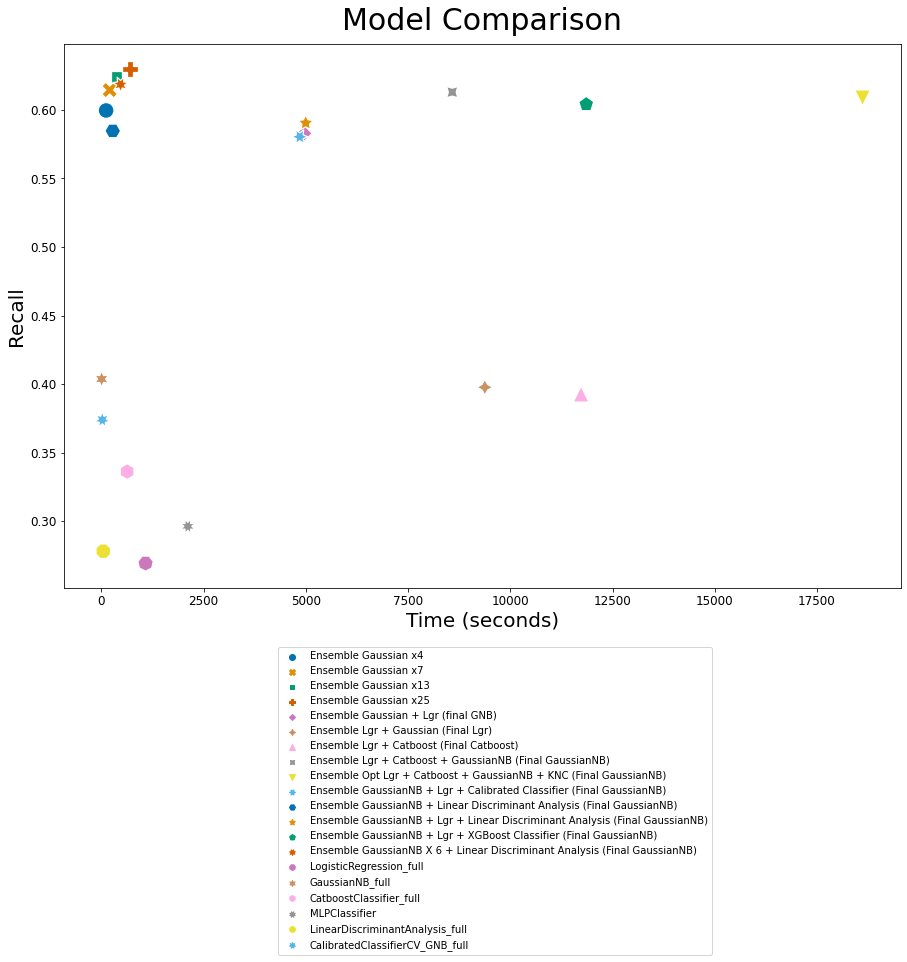

In [644]:
plt.figure(figsize = (15, 10))
ax=sns.scatterplot(data = df_resultados_finales, x = df_resultados_finales['TIEMPO'],y = df_resultados_finales['RECALL'], 
                hue = df_resultados_finales.index, style = df_resultados_finales.index, palette = 'colorblind', s = 250) 
plt.xlabel('Time (seconds)', y = -0.8, fontsize = 20)
plt.ylabel('Recall', x = -1, fontsize = 20)
plt.yticks(fontsize = 12)
plt.xticks(fontsize = 12)
plt.title('Model Comparison', y = 1.015, fontsize = 30)
sns.move_legend(ax, "upper left",bbox_to_anchor= (0.25,-0.1))
plt.show()

In [91]:
df_resultados_finales.to_pickle("df_resultados_finales2.pkl")

<br>

<br>